# POS-TAGGING y NER

## Librerías

"es_core_news_md" Modelo optimizado con gpu para postagging en español

In [ ]:
!python -m spacy download es_core_news_md
!python -m spacy link es_core_news_md es

     |████████████████████████████████| 78.4 MB 1.2 MB/s 
  Created wheel for es-core-news-md: filename=es_core_news_md-2.2.5-py3-none-any.whl size=79649483 sha256=3286b7101e2c73b881a1630d54beece573ec00e6d1e3b40dda48578558f02f32
  Stored in directory: /tmp/pip-ephem-wheel-cache-jh184oki/wheels/d8/f5/92/ee8a4f74fac67775fbc0314b1c9ae4694f4180437f6fc3dd1c
Successfully built es-core-news-md
✔ Download and installation successful
You can now load the model via spacy.load('es_core_news_md')
✔ Linking successful
/usr/local/lib/python3.7/dist-packages/es_core_news_md -->
/usr/local/lib/python3.7/dist-packages/spacy/data/es
You can now load the model via spacy.load('es')


In [ ]:
!pip install stylecloud 

     |████████████████████████████████| 262 kB 5.2 MB/s 
     |████████████████████████████████| 161 kB 52.7 MB/s 
     |████████████████████████████████| 87 kB 5.6 MB/s 
     |████████████████████████████████| 87 kB 5.2 MB/s 
  Created wheel for stylecloud: filename=stylecloud-0.5.2-py3-none-any.whl size=259508 sha256=02b34607ab14217147a00d13b439cb42737dbbf3413347a4bc74e2d6360f8f91
  Stored in directory: /root/.cache/pip/wheels/77/42/7a/f52b5f84c04196fd4c2a3dceeb1bbeaee1c93a4fe271b5eb41
  Created wheel for fire: filename=fire-0.4.0-py2.py3-none-any.whl size=115943 sha256=30850dd160efc9f290d910c0e4588173be42435e3dfef0e122862d2d30fffebd
  Stored in directory: /root/.cache/pip/wheels/8a/67/fb/2e8a12fa16661b9d5af1f654bd199366799740a85c64981226
  Created wheel for tinycss: filename=tinycss-0.4-py3-none-any.whl size=43955 sha256=5f70680b8bb4ac13feaffd74b5d7f0d51cee0d9ee93ab545b1e204cd5412d0ad
  Stored in directory: /root/.cache/pip/wheels/6c/66/e8/e53d7a476011891fa51a5ee83a2d1852b19b258f975

In [ ]:
from collections import Counter
from nltk import word_tokenize
from spacy import displacy
from nltk.tag.stanford import StanfordPOSTagger
import es_core_news_md
import nltk
import spacy
import os
import json
import pandas as pd
import random
import matplotlib.pyplot as plt
from PIL import Image
# LIBRERIA PARA REALIZAR NUBES DE PALABRAS
from wordcloud import WordCloud
import stylecloud as sc

*** Requisito adicional ***

Instalación de java

In [ ]:
def install_java():
  !apt update
  !apt-get install -y openjdk-8-jdk-headless -qq > /dev/null      #install openjdk
  os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"     #set environment variable
  !java -version       #check java version
install_java()

Get:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Ign:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Ign:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release [697 B]
Hit:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release.gpg [836 B]
Get:8 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Get:9 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ Packages [62.9 kB]
Hit:10 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:12 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Ign:13 https://developer.download.nvi

## Módulos

In [ ]:
def PosTagging(rows):
  nlp = spacy.load("es")
  titulos = dict()
  objetos = dict()
  for row in rows:
    pt_titulo = []
    pt_objeto = []
    for i in range(len(row)):
      if i == 0:
        doc = nlp(row[i])
        for token in doc:
          arreglo_tokens_titulo = [token.text, token.pos_, token.dep_]
          pt_titulo.append(arreglo_tokens_titulo)
        titulos[doc.text] = pt_titulo
      if i == 1:
        doc = nlp(row[i])
        for token in doc:
          arreglo_tokens_objeto = [token.text, token.pos_, token.dep_]
          pt_objeto.append(arreglo_tokens_objeto)
        objetos[doc.text] = pt_objeto
  return titulos,objetos

In [ ]:
def NER(rows):
  nlp = es_core_news_md.load()
  for row in rows:
    for i in range(len(row)):
      if i == 0:
        titulo = row[i]
        print("Título: ", titulo)
        print("NER Título: ")
        displacy.render(nlp(titulo), jupyter=True, style='ent')
      if i == 1:
        objeto = row[i]
        print("Objeto: ", objeto)
        print("NER Objeto: ")
        displacy.render(nlp(objeto), jupyter=True, style='ent')

In [ ]:
def PosTagging_NER_Titulo(rows, nro_fila):
  nlp = es_core_news_md.load()

  titulo = rows[nro_fila][0]

  doc = nlp(titulo)
  print([(w.text, w.pos_) for w in doc])
  print()
  print([(X.text, X.label_) for X in doc.ents])
  print([(X, X.ent_iob_, X.ent_type_) for X in doc])
  return doc,titulo

In [ ]:
def PosTagging_NER_Objeto(rows, nro_fila):
  objeto = rows[nro_fila][1]

  doc = nlp(objeto)
  print([(w.text, w.pos_) for w in doc])
  print()
  print([(X.text, X.label_) for X in doc.ents])
  print([(X, X.ent_iob_, X.ent_type_) for X in doc])
  return doc,objeto

In [ ]:
def diccionarios_para_nubes(diccionario):
  sustantivos = []
  verbos = []
  adjetivos = []
  dic_sust = dict()
  dic_verb = dict()
  dic_adj = dict()
  for key in diccionario.keys():
    for i in diccionario[key]:
      if (i[1] == "NOUN" or i[1] == "PROPN"):
        sustantivos.append(i[0])
      elif (i[1] == "VERB"):
        verbos.append(i[0])
      elif (i[1] == "ADJ"):
        adjetivos.append(i[0])
  sust_sin_repeticiones = list(set(sustantivos))
  verb_sin_repeticiones = list(set(verbos))
  adj_sin_repeticiones = list(set(adjetivos))
  for sust in sust_sin_repeticiones:
    dic_sust[sust] = sustantivos.count(sust)
  for verb in verb_sin_repeticiones:
    dic_verb[verb] = verbos.count(verb)
  for adj in adj_sin_repeticiones:
    dic_adj[adj] = adjetivos.count(adj)
  return (dic_sust,dic_verb,dic_adj)

In [ ]:
def show_wordcloud(Dic, save=False, img_name=None):
  wordcloud = WordCloud(
    background_color = 'white',
    max_words = 100,
    relative_scaling = 1,
    scale = 2,
    random_state=1,
    collocations=False,
    max_font_size=200
  ).generate_from_frequencies(Dic)
  fig = plt.figure(1, figsize=(12, 12))
  plt.axis('off')
  plt.imshow(wordcloud)
  if save: plt.savefig(img_name)
  plt.show()

## Lectura de datos

In [ ]:
def read_data(path, key1, key2):
    data = pd.read_csv(path, sep=';')
    data.dropna(inplace=True)
    data.head()
    title_list_row = data[key1].values.tolist()
    object_list_row = data[key2].values.tolist()
    list_row = []
    for i in range (len(title_list_row)):
        list_row.append([title_list_row[i], object_list_row[i]])
    return list_row

In [ ]:
Accesibilidad = read_data('LeyesAccesibilidad.csv', 'Titulo', 'Objeto')

In [ ]:
Auditabilidad = read_data('LeyesAuditabilidad.csv', 'Titulo', 'Objeto')

In [ ]:
Informatividad = read_data('LeyesInformatividad.csv', 'Titulo', 'Objeto')

In [ ]:
Usabilidad = read_data('LeyesUsabilidad.csv', 'Titulo', 'Objeto')

In [ ]:
Comprensibilidad = read_data('LeyesComprensibilidad.csv', 'Titulo', 'Objeto')

## TOPICO 1: ACCESIBILIDAD

### 1. POS-Tagging usando spacy

In [ ]:
TitulosAccesibilidad, ObjetosAccesibilidad = PosTagging(Accesibilidad)

In [ ]:
TitulosAccesibilidad

{'LEY QUE DECLARA DE INTERÉS NACIONAL, NECESIDAD PÚBLICA Y DISPONE LA CREACIÓN DE LA ZONA FRANCA COMERCIAL, INDUSTRIAL Y TECNOLÓGICA A LA REGIÓN PUNO': [['LEY',
   'NOUN',
   'ROOT'],
  ['QUE', 'SCONJ', 'nsubj'],
  ['DECLARA', 'VERB', 'acl'],
  ['DE', 'ADP', 'case'],
  ['INTERÉS', 'NOUN', 'obj'],
  ['NACIONAL', 'NOUN', 'amod'],
  [',', 'PUNCT', 'punct'],
  ['NECESIDAD', 'NOUN', 'obj'],
  ['PÚBLICA', 'ADJ', 'amod'],
  ['Y', 'CONJ', 'cc'],
  ['DISPONE', 'VERB', 'conj'],
  ['LA', 'DET', 'det'],
  ['CREACIÓN', 'NOUN', 'obj'],
  ['DE', 'ADP', 'case'],
  ['LA', 'DET', 'det'],
  ['ZONA', 'NOUN', 'nmod'],
  ['FRANCA', 'ADJ', 'amod'],
  ['COMERCIAL', 'ADJ', 'amod'],
  [',', 'PUNCT', 'punct'],
  ['INDUSTRIAL', 'NOUN', 'conj'],
  ['Y', 'CONJ', 'cc'],
  ['TECNOLÓGICA', 'NOUN', 'conj'],
  ['A', 'ADP', 'case'],
  ['LA', 'DET', 'det'],
  ['REGIÓN', 'NOUN', 'nmod'],
  ['PUNO', 'PROPN', 'amod']],
 'LEY QUE MODIFICA EL ARTICULO 75 DE LA LEY N° 29338, LEY DE RECURSOS HÍDRICOS Y QUE DECLARA COMO ""ZONA DE

In [ ]:
ObjetosAccesibilidad

{'Propone declarar de interés nacional y necesidad pública y dispone la creación de la zona franca industrial y tecnológica a la región Puno.': [['Propone',
   'VERB',
   'ROOT'],
  ['declarar', 'VERB', 'xcomp'],
  ['de', 'ADP', 'case'],
  ['interés', 'NOUN', 'obl'],
  ['nacional', 'ADJ', 'amod'],
  ['y', 'CONJ', 'cc'],
  ['necesidad', 'NOUN', 'conj'],
  ['pública', 'ADJ', 'amod'],
  ['y', 'CONJ', 'cc'],
  ['dispone', 'VERB', 'conj'],
  ['la', 'DET', 'det'],
  ['creación', 'NOUN', 'obj'],
  ['de', 'ADP', 'case'],
  ['la', 'DET', 'det'],
  ['zona', 'NOUN', 'nmod'],
  ['franca', 'ADJ', 'amod'],
  ['industrial', 'ADJ', 'amod'],
  ['y', 'CONJ', 'cc'],
  ['tecnológica', 'ADJ', 'conj'],
  ['a', 'ADP', 'case'],
  ['la', 'DET', 'det'],
  ['región', 'NOUN', 'nmod'],
  ['Puno', 'PROPN', 'appos'],
  ['.', 'PUNCT', 'punct']],
 'Propone declarar ""Zona reserva intangible y de conservación integral, protección y promoción a las cabeceras de cuencas hidrográficas.': [['Propone',
   'VERB',
   'ROOT']

### 2. NER usando spacy

In [ ]:
NER(Accesibilidad)

Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, NECESIDAD PÚBLICA Y DISPONE LA CREACIÓN DE LA ZONA FRANCA COMERCIAL, INDUSTRIAL Y TECNOLÓGICA A LA REGIÓN PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública y dispone la creación de la zona franca industrial y tecnológica a la región Puno.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTICULO 75 DE LA LEY N° 29338, LEY DE RECURSOS HÍDRICOS Y QUE DECLARA COMO ""ZONA DE RESERVA INTANGIBLE Y DE CONSERVACIÓN INTEGRAL LA PROTECCIÓN DE LAS CABECERAS DE CUENCAS HIDROGRÁFICAS""
NER Título: 


Objeto:  Propone declarar ""Zona reserva intangible y de conservación integral, protección y promoción a las cabeceras de cuencas hidrográficas.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 28054, LEY DE PROMOCIÓN DEL MERCADO DE BIOCOMBUSTIBLES
NER Título: 


Objeto:  Propone modificar de los artículos 1, 2, 4 y 5 de Ley 28054, Ley de Promoción de Mercado de Biocombustible, así como de su Primera, Segunda, Tercera y Cuarta Disposición Complementaria y Transitoria.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL ACCESO DEL SERVICIO ELÉCTRICO EN ZONAS RURALES DE LA REGIÓN PUNO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de necesidad pública del acceso al servicio eléctrico en las zonas rurales de la región Puno, a fin de ampliar y mejorar las líneas de generación eléctrica, atendiendo a hogares e instituciones educativas primarias y secundarias.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CULMINACION DE LA INTERCONEXIÓN VIAL ENTREL LOS DISTRITOS DE LURIGANCHO Y SAN JUAN DE LURIGANCHO QUE SE INTERCONECTAN Y EMPALMA AL SISTEMA DEL ANILLO VIAL QUE UNE LA CARRETERA CENTRAL CON LA AV. TUPAC AMARU EN LA PROVINCIA Y DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional, la culminación de la interconexión vial entre los distritos de Lurigancho y San Juan de Lurigancho que se interconecta y empalma al sistema del anillo vial que une la Carretera Central con la Av. Túpac Amaru en la provincia y departamento de Lima.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN E IMPLEMENTACIÓN DE UN HOSPITAL CON CATEGORÍA III-1 EN LA PROVINCIA DE HUAYTARA EN EL DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción e implementación de un hospital con categoría III - 1 en la ciudad de Huaytará en la provincia de Huaytará en el departamento de Huancavelica, para garantizar la adecuada atención del servicio de salud pública, bajo criterios de seguridad, oportunidad y calidad
NER Objeto: 


Título:  LEY QUE FOMENTA LA TECNIFICACIÓN DE LA PRODUCCIÓN Y DISTRIBUCIÓN DE PAPA DE LA ZONA SUR ANDINA
NER Título: 


Objeto:  Propone fomentar la tecnificación de la producción y distribución de papa de la zona Sur Andina
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE SE DECLARE DE INTERÉS NACIONAL Y PREFERENTE NECESIDAD PÚBLICO LA REORGANIZACIÓN GEOGRÁFICA - TERRITORIAL URBANA DE LA PROVINCIA DE SAN ROMÁN EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y preferente necesidad pública la reorganización geográfica - territorial urbana de la provincia de San Román en el departamento de Puno, a fin de lograr un adecuado desarrollo urbano con la creación de distritos adicionales al distrito San Miguel, acorde a su distribución especial y crecimiento poblacional.
NER Objeto: 


Título:  LEY QUE PROHIBE LA UTILIZACIÓN DE RECURSOS ECONÓMICOS Y LOGISTICOS DESTINADOS A LA PROMOCIÓN, PREVENCIÓN, DIAGNÓSTICO, TRATAMIENTO Y REHEBILITACIÓN DEL CÁNCER PARA OTROS FINES
NER Título: 


Objeto:  Propone prohíber la utilización de recursos económicos y logísticos destinados a la promoción, prevención, diagnóstico, tratamiento y rehabilitación del cáncer para otros fines
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERES NACIONAL LA PROMOCIÓN Y REACTIVACIÓN DE LA ARTESANÍA EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional la promoción y reactivación de la artesanía en el Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE PRIORITARIO INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE UNIDADES PRODUCTIVAS DE INVESTIGACIÓN, PARA EL MEJORAMIENTO GENÉTICO, COMERCIALIZACIÓN, VALOR AGREGADO Y CRIANZA ADECUADA DE CAMÉLIDOS SUDAMERICANOS EN EL PERÚ
NER Título: 


Objeto:  Propone declara de prioritario interés nacional y necesidad pública la creación de Unidades Productivas de Investigación, para el Mejoramiento Genético, Comercialización, Valor Agregado y Crianza Adecuada de Camélidos Sudamericanos en el Perú.
NER Objeto: 


Título:  LEY QUE CREA Y REGULA LA ZONA ECONOMICA ESPECIAL DE AREQUIPA
NER Título: 


Objeto:  Propone declarar de interés nacional y crease la Zona Económica Especial de Arequipa ZEEDA, para la realización de actividades industriales, agroindustriales de maquila y de servicios; con la finalidad de contribuir al desarrollo socioeconómico sostenible del departamento de Arequipa, a través de la promoción de la inversión y desarrollo tecnológico.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 034-2019, REFERIDO A LA INCORPORACIÓN DE LA DÉCIMA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL A LA LEY 30220, LEY UNIVERSITARIA E INCORPORA LAS FACULTADES DE CREACIÓN DE COMISIONES REORGANIZADORAS DE UNIVERSIDADES PUBLICAS  Y DE UNIVERSIDADES PRIVADAS ASOCIATIVAS CREADAS POR LEY, CON LICENCIA INSTITUCIONAL DENEGADA
NER Título: 


Objeto:  Propone fortalecer el rol del Ministerio de Educación, como ente rector de la Política de Aseguramiento de la Calidad de la Educación Superior Universitaria, teniendo la finalidad de garantizar la calidad y continuidad del Servicio Educativo Universitario, dándole al Ministerio de Educación las facultades de creación de comisiones reorganizadoras de Universidades Públicas y de Universidades Privadas Asociativas creadas por Ley, con Licencia Institucional Denegada
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 E INCORPORA UNA DISPOSICION COMPLEMENTARIA FINAL A LA LEY 28514, LEY QUE PROHÍBE LA IMPORTACIÓN DE ROPA Y CALZADO USADOS
NER Título: 


Objeto:  Propone modificar el artículo 2 e incorporar una Disposición Complementaria Final a la Ley 28514 Ley que prohíbe la importación de ropa y calzado usados.
NER Objeto: 


Título:  LEY QUE SANCIONA CON CADENA PERPETUA E INHABILITACIÓN A LOS FUNCIONARIOS PÚBLICOS POR ENRIQUECIMIENTO ILICITO
NER Título: 


Objeto:  Propone modificar el artículo 401 del Código Penal.
NER Objeto: 


Título:  LEY QUE PROMUEVE E IMPULSA LA MICRO Y PEQUEÑA EMPRESA Y LA REACTIVACIÓN DEL EMPLEO A TRAVEZ DE FONDOS CONCURSABLES NO REEMBOLSABLES
NER Título: 


Objeto:  Propone crear el Fondo concursable no reembolsable de promoción y reactivación económica de la pequeña y microempresa y del empleo, a nivel nacional.
NER Objeto: 


Título:  LEY QUE DEROGA LA DECLARACIÓN DE NECESIDAD, UTILIDAD PÚBLICA E INTERÉS NACIONAL EL PROYECTO ""MEJORAMIENTO Y AMPLIACIÓN DE LA PROVISIÓN DE AGUA PARA EL DESARROLLO AGRÍCOLA EN EL VALLE TACNA- VILAVILANI II, FASE I
NER Título: 


Objeto:  Propone Derogar el inciso 39, del artículo 11 del Decreto de Urgencia 018-2019, Decreto de Urgencia que Establece Medidas Extraordinarias para la Promoción e Implementación de los Proyectos Priorizados en el Plan Nacional de Infraestructura para la Competitividad.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1260, LEY QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGUILA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ
NER Título: 


Objeto:  La presente norma tiene por objeto restituir la autonomía y personería jurídica del Cuerpo General de Bomberos Voluntarios del Perú, como la autoridad competente en materia de prevención, control y extinción de incendios, está conformado por los bomberos voluntarios en actividad, los bomberos asimilados y los bomberos en situación de retiro, que prestan servicio público de manera voluntaria y ad honorem.
NER Objeto: 


Título:  LEY QUE MODIFICA LA VIGÉSIMA CUARTA DISPOSICIÓN COMPLEMENTARIA, TRANSITORIA Y FINAL DE LA LEY 29944, LEY DE REFORMA MAGISTERIAL.
NER Título: 


Objeto:  La presente Ley tiene por objeto modificar la Vigésima Cuarta Disposición Complementaria, Transitoria y Final de la Ley 29944, Ley de Reforma Magisterial; a fin de que se suspenda la implementación de la evaluación de desempeño docente.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 06, 20, 21, 22, 25, 68Y 69 DE LA LEY Nº 28036, LEY DE PROMOCIÓN Y DESARROLLO DEL DEPORTE PARA OTORGAR BECAS DE POSGRADO A DEPORTISTAS CALIFICADOS DE ALTO NIVEL PARA DIRIGENCIA SOSTENIBLE DEL SISTEMA INTEGRAL DEPORTIVO NACIONAL
NER Título: 


Objeto:  La presente Ley tiene por objeto modificar los artículos 06, 20, 21, 22, 25, 68 y 69 de la Ley Nº 28036, Ley de promoción y Desarrollo del Deporte a fin de otorgar becas de posgrado a deportistas calificados y calificados de alto nivel asegurando la dirigencia sostenible del sistema integral deportivo nacional.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EXONERACIÓN DEL PAGO DE IMPUESTO PREDIAL Y ARBITRIOS MUNICIPALES, MIENTRAS DURE EL EVENTO COVID.19, CUYA INICIATIVA LEGISLATIVA INCORPORA Y AGREGA UN ARTÍCULO QUEDANDO COMO VEINTEAVA DISPOSICIÓN TRANSITORIA A LA LEY DE TRIBUTACIÓN MUNICIPAL (DECRETO LEGISLATIVO 776), CUYO TEXTO ÚNICO ORDENADO FUE APROBADO POR EL DECRETO SUPREMO 156.2004-EF
NER Título: 


Objeto:  Propone exonerar del pago del 75% del Impuesto Predial y el 50% de los Arbitrios Municipales correspondiente a Municipalidades Distritales y Provinciales dentro de todo el territorio nacional, mientras dure el período de estado de emergencia acaecido por graves circunstancias que afectan la vida de la nación.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1280, DECRETO LEGISLATIVO APRUEBA LA LEY MARCO DE LA GESTIÓN Y PRESENTACIÓN DE LOS SERVICIOS DE SANEAMIENTO
NER Título: 


Objeto:  Propone modificar los artículos 112, 113, 114, 115 y 116 del Título IX del Decreto Legislativo 1280, Decreto Legislativo que aprueba la Ley Marco de la Gestión y Prestación de los Servicios de Saneamiento.
NER Objeto: 


Título:  LEY QUE MODIFICA LA TERCERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL DECRETO SUPREMO 007-2016-MTC
NER Título: 


Objeto:  Propone modificar la Tercera Disposición Complementaria Transitoria del Decreto Supremo 007-2016-MTC, Reglamento Nacional del Sistema de Emisión de Licencias de Conducir y Modifica el Texto Único Ordenado del Reglamento Nacional de Tránsito - Código de Tránsito, aprobado por Decreto Supremo 016-2009-MTC y el Reglamento Nacional de Administración de Transporte, aprobado por Decreto Supremo 017-2009-MTC.
NER Objeto: 


Título:  LEY QUE DISPONE LA INSCRIPCIÓN OBLIGATORIA DE LA MAQUINARIA PESADA EMPLEADA PARA LA MINERIA, EN EL REGISTRO DE BIENES MUEBLES DE LA SUPERINTENDENCIA NACIONAL DE LOS REGISTROS PÚBLICOS
NER Título: 


Objeto:  Propone disponer la obligatoriedad de la inscripción de la maquinaria pesada empleada o que pueda emplearse para las actividades mineras, en el Registro de Bienes Muebles de la Superintendencia Nacional de los Registros Públicos - SUNARP.
NER Objeto: 


Título:  LEY DE REORGANIZACIÓN DE LAS UNIVERSIDADES PRIVADAS ASOCIATIVAS CON LICENCIA INSTITUCIONAL DENEGADA
NER Título: 


Objeto:  Propone modificar el Décimo Segunda Disposición Complementaria Final de la Ley Universitaria, Ley 30220.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1280, QUE APRUEBA LA LEY MARCO DE LA GESTIÓN Y PRESTACIÓN DE LOS SERVICIOS DE SANEAMIENTO, MODIFICADO POR EL DECRETO DE URGENCIA 011-2020
NER Título: 


Objeto:  Propone modificar los artículo 13 y 17 del Decreto Legislativo, que aprueba la Ley Marco de la Gestión y Prestación de los Servicios de Saneamiento, modificado por el Decreto de Urgencia 011-2020.
NER Objeto: 


Título:  LEY QUE CREA EL FONDO PARA LA CONTRIBUCIÓN AL ACCESO DE LOS SERVICIOS EN EL ÁMBITO RURAL
NER Título: 


Objeto:  Propone establecer medidas complementarias para el financiamiento de inversiones, proyectos, programas y/o actividades en saneamiento que se desarrollen en el ámbito rural, con la finalidad de lograr el acceso a los servicios de saneamiento, así como la mejora en la eficiencia y equidad de la prestación de los servicios de saneamiento, en beneficio de la población de dicho ámbito
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL DESARROLLO DE LA ACTIVIDAD DE ACUICULTURA EN LA ISLA LOBOS DE TIERRA Y ACTIVIDADES CONEXAS EN LOS DEPARTAMENTOS DE LAMBAYEQUE Y PIURA
NER Título: 


Objeto:  Propone llamar la atención al ejecutivo sobre la importancia que tiene declarar de necesidad pública e interés nacional el desarrollo de la actividad de acuicultura en la isla lobos de tierra y actividades conexas en los departamentos de Lambayeque y Piura para el mejoramiento de la capacidad del pescador artesanal para incursionar en la maricultura con fines de abastecimiento de alimentos, recuperación de stock y de generación de empleo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA TRIGÉSIMA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 31084, LEY DEL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2021, QUE PERMITE A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES, HACER USO DE HASTA EL 20% DEL CANON, SOBRE CANON Y REGALÍAS MINERAS PARA CONTROLAR LA PROPAGACIÓN DEL BROTE DEL COVID-19
NER Título: 


Objeto:  Ley que modifica la Trigésima Tercera Disposición Complementaria Final de la Ley 31084, Ley del Presupuesto del Sector Público para el Año Fiscal 2021, que permite a los gobiernos regionales y gobiernos locales, hacer uso de hasta el 20% del canon y regalías mineras para controlar la propagación del brote del Covid-19
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA PROMOVER EL CULTIVO, PRODUCCIÓN INDUSTRIALIZACIÓN, COMERCIALIZACIÓN Y EXPORTACIÓN DE MORINGA OLEIFERA PARA CONSUMO HUMANO
NER Título: 


Objeto:  Propone regular, formaliza y ordenar la producción, transformación, comercialización y exportación; así como el uso tradicional y moderno de la moringa oleífera, por las propiedades medicinales, industriales, agrícolas y nutricionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN DEL USO DE VEHÍCULOS ELÉCTRICOS
NER Título: 


Objeto:  La presente Ley tiene por objeto promover el uso de vehículos eléctricos mediante su exoneración del pago del Impuesto General a las Ventas (IGV) y el Impuesto al Patrimonio Vehicular por el período de 5 años contados a partir de la vigencia de la presente Ley.
NER Objeto: 


Título:  LEY QUE DEROGA EL ARTÍCULO 6 QUE ESTABLECE EL INGRESO DE PROFESORES DEL MINISTERIO DE DEFENSA A LA CARRERA PÚBLICA MAGISTERIAL DE LA LEY Nº 29944 DEL DECRETO DE URGENCIA Nº 016-2020
NER Título: 


Objeto:  La presente Ley tiene como objeto derogar el artículo 6 del Decreto de Urgencia 016-2020, que establece el ingreso de los profesores del Ministerio de Defensa a la Carrera Magisterial de la Ley 29944 de la Reforma Magisterial.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL CONSUMO Y ADQUISICIÓN DE PRODUCTOS HIDROBIOLÓGICOS POR LAS ENTIDADES DEL SECTOR PÚBLICO, A PESCADORES ARTESANALES, COOPERATIVAS PESQUERAS, PRODUCTORES ACUÍCOLAS AMYPE Y MYPES
NER Título: 


Objeto:  Propone promoción del consumo  y adquisición de productos hidrobiológicos por las entidades del sector público, a pescadores artesanales, cooperativas pesqueras, productores acuícolas AMYPE y MYPES
NER Objeto: 


Título:  LEY QUE CREA LA ESCUELA NACIONAL DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Escuela Nacional del Ministerio Público, como órgano académico encargado de la formación continua y la especialización del personal fiscal, forense y administrativo del Ministerio Público.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY UNIVERSITARIA 30220 PARA DISPONER EL INGRESO LIBRE DE LOS ESTUDIANTES A LAS UNIVERSIDADES PÚBLICAS Y PRIVADAS, GARANTIZANDO LA CONTINUIDAD EDUCATIVA Y EL DERECHO CONSTITUCIONAL A UNA EDUCACIÓN SUPERIOR DE CALIDAD
NER Título: 


Objeto:  Propone modificar los artículos 97 y 98 de la Ley Universitaria 30220, para disponer el ingreso libre de los estudiantes a las universidades públicas y privadas con licenciamiento, garantizando la continuidad educativa y el derecho constitucional a una educación superior de calidad en todo territorio nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29164, LEY DE PROMOCIÓN DEL DESARROLLO SOSTENIBLE DE SERVICIOS TURÍSTICOS EN LOS BIENES INMUEBLES, INTEGRANTES DEL PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone modificar los artículos 1, 4 y 8 e incorporar los artículos 1-A, 2-A y 2-B en la Ley  29164, Ley  de Promoción del Desarrollo Sostenible de Servicios Turísticos en los bienes inmuebles, del Patrimonio Cultural de la Nación.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERES NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE RELAVE, EN LA PROVINCIA DE PARINACOCHAS DEL DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone establecer la declaratoria de interés nacional y necesidad pública la creación del distrito de Relave, en la provincia de Parinacochas  del departamento de Ayacucho; con la finalidad de que los habitantes de esta comunidad puedan gozar de una mejor organización territorial para acceder a una adecuada prestación de servicios por parte del Estado y alcanzar mayor desarrollo
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN, IMPLEMENTACIÓN Y FUNCIONAMIENTO DE LA UNIVERSIDAD NACIONAL ASHANINKA DEL VRAEM. (UNA-VRAEM)
NER Título: 


Objeto:  Propone crear de la Universidad Nacional Ashaninka del VRAEM, (UNA-VRAEM), con personería jurídica de derecho público interno, con sede en el vale del VRAEM, departamento de Cusco.
NER Objeto: 


Título:  LEY QUE OTORGA FACILIDADES PARA LA RENOVACIÓN DEL PARQUE VEHICULAR DE LAS EMPRESAS DE TRANSPORTE URBANO PARA ENFRENTAR LA EMERGENCIA SANITARIA DEL COVID-19
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de necesidad pública la renovación del parque vehicular a nivel nacional de las empresas de transporte urbano con vehículos de mayor capacidad para enfrentar la emergencia sanitaria del COVID-19.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE FACULTAR A LOS AFILIADOS DE LA AFP A LA DEVOLUCIÓN DE APORTES POR LIBRE DISPOSICIÓN
NER Título: 


Objeto:  Propone autorizar de manera extraordinaria y facultativa a los afiliados al Sistema Privado de Fondos de Pensiones (AFP) que siguen realizando sus aportaciones al Sistema Privado de Pensiones (SPP) de manera puntual, el retiro del cien por ciento (100 %) de su fondo acumulado en su Cuenta Individual de Capitalización (CIC). Sin considerar los años de aportación o la edad del afiliado. La Superintendencia de Banca, Seguros y Administradoras Privadas de Fondos de Pensiones (SBS) determina el procedimiento operativo para el cumplimiento de lo señalado en el párrafo anterior.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 Y 5 DE LA LEY 27506, LEY DE CANON, E INCORPORA LA DISTRIBUCIÓN DEL CANON A LAS COMUNIDADES CAMPESINAS, NATIVAS E INDÍGENAS
NER Título: 


Objeto:  Propone modificar el artículo 1 y 5 de la Ley 27506, Ley de Canon, para incorporar en su distribución de las comunidades campesinas, nativas e indígenas que se encuentren dentro de su área de influencia.
NER Objeto: 


Título:  LEY QUE REGULA LA TRANSPARENCIA EN EL GASTO DE LAS ORGANIZACIONES POLÍTICAS EN REDES SOCIALES Y GARANTIZA LA PROTECCIÓN DE DATOS PERSONALES EN PROPAGANDA ELECTORAL
NER Título: 


Objeto:  Propone regular la transparencia en el financiamiento y gasto de propaganda electoral en redes sociales y/u otras plataformas de internet de las organizaciones políticas, y garantizar la protección de datos personales en la realización de propaganda electoral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA IMPLEMENTACIÓN DE PLANES URBANOS MUNICIPALES, LA CONSTRUCCIÓN, REHABILITACIÓN DE INFRAESTRUCTURA Y EQUIPAMIENTO DE MERCADOS DE ABASTOS MUNICIPALES
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el desarrollo de una política municipal provincial que habilite espacios públicos en cada distrito, para implementar y/o regular la zonificación urbana para la habilitación de planes urbanos municipales, construcción, rehabilitación de infraestructura y equipamiento de mercados de abasto municipales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE EL ACCESO A LOS SERVICIOS BÁSICOS A FAVOR DE LAS COMUNIDADES NATIVAS Y CAMPESINAS
NER Título: 


Objeto:  Propone otorgar el marco legal para promover el acceso a los servicios básicos de educación, salud, electrificación y saneamiento a favor de las comunidades nativas y campesinas, comprendidas en el territorio nacional, a fin de tener mejor calidad de vida.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE RECTIVACION PRODUCTIVA DE LA AMAZONIA
NER Título: 


Objeto:  Propone modificar la Ley 27037, Ley de Promoción de la Inversión en la Amazonia, restituida plenamente por la Ley 29742, Ley que deroga los Decretos Legislativos 977 y 978 y restituye la plena vigencia de la Ley 27037, así como sus normas modificatorias, complementarias, disposiciones finales y reglamentarias.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL TRATADO INTEGRAL Y PROGRESISTA DE ASOCIACIÓN TRANSPACÍFICO Y LAS CARTAS CON AUSTRALIA, CANADÁ, MALASIA, NUENA ZELANDA Y VIETNAM
NER Título: 


Objeto:  Propone el Tratado Integral y Progresista de Asociación Transpacífico, firmado el 8 de marzo de 2018 en Santiago, Chile y las Cartas con Australia que reafirman los acuerdos relativos a productos distintivos y terminación del Acuerdo sobre Promoción Recíproca de Inversiones; las Cartas con Canadá sobre industrias culturales; las Cartas con Malasia sobre servicios electrónicos de tarjetas de pago; las Cartas con Malasia sobre no recurso a solución de controversias por la medida disconforme en empresas de propiedad del Estado; las Cartas con Nueva Zelanda sobre el mecanismo de solución de controversias inversionista - Estado; las Cartas con Vietnam sobre servicios electrónicos de tarjetas de pago; las Cartas con Vietnam sobre comercio electrónico; las Cartas con Vietnam relativas al capítulo laboral, y las Cartas con Vietnam sobre productos químicos agrícolas, firmadas el 8 de marzo de 2018 en Santiago, Chile
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE DOCENTES CONTRATADOS EN LAS UNIVERSIDADES PÚBLICAS
NER Título: 


Objeto:  Propone autorizar de manera excepcional el nombramiento de docentes contratados de las universidades públicas en la categoría de Auxiliar, únicamente en aquellos casos que se hayan adjudicado una plaza por concurso público y cumplan con los requisitos establecidos en la Ley Universitaria para el ejercicio de la docencia.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DE LA LEY 30021, LEY DE PROMOCIÓN DE LA ALIMENTACIÓN SALUDABLE PARA NIÑOS, NIÑAS Y ADOLESCENTES
NER Título: 


Objeto:  Propone modificar la Primera Disposición Complementaria Transitoria de la Ley 30021, Ley de Promoción de la Alimentación Saludable para niños, niñas y Adolescentes en lo referente a las facultades de reglamentación del Ministerio de Salud.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERES NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE MANALLASACC, EN LA PROVINCIA DE HUAMANGA DE LA REGIÓN DE AYACUCHO
NER Título: 


Objeto:  Propone establecer la declaratoria de interés nacional y necesidad pública la creación del distrito de Manallasacc, en la provincia de Huamanga y región de Ayacucho; con la finalidad de que los habitantes de esta comunidad puedan gozar de una mejor organización territorial para acceder a una adecuada prestación de servicios por parte del Estado y alcanzar mayor desarrollo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL RECONOCIMIENTO DE LA COMUNIDAD INDÍGENA SHIPIBO-KONIBO DE CANTAGALLO COMO PARTE DEL PATRIMONIO HISTÓRICO Y CULTURAL DEL DISTRITO DEL RÍMAC, PROVINCIA DE LIMA, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el reconocimiento de la comunidad indígena urbana Shipibo-Konibo de Cantagallo como parte del patrimonio histórico y cultural del distrito del Rímac, a fin de promover la continuidad histórica y cultural de su identidad, y la conexión territorial como pueblos originarios.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERES NACIONAL Y DE NECESIDAD PÚBLICA LA CONSTRUCCIÓN DE LA CARRETERA DE INTERCONEXIÓN ENTRE EL DISTRITO DE MEGANTONI CON EL DISTRITO DE ECHARATI
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción de la carretera de interconexión entre los distritos de Megantoni - Echarati, a fin de promover su desarrollo y conectividad
NER Objeto: 


Título:  LEY DE ADECUACIÓN AL SISTEMA UNIVERSITARIO PARA LOS DOCENTES NOMBRADOS COMPRENDIDOS EN LA LEY 30597, LEY 30851 Y D. S. 014-2018- MINEDU
NER Título: 


Objeto:  Propone autorizar de manera excepcional la adecuación de los docentes nombrados del Conservatorio Nacional de Música a la Universidad Nacional de Música; Instituto Superior de Música Público Daniel Alomía Robles de Huánuco a la Universidad Nacional Daniel Alomía Robles; Escuela Superior Autónoma de Bellas Artes ""Diego Quispe Tito"" a la Universidad Nacional Diego Quispe Tito.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL TRANSPARENCIA, ACCESO A LA INFORMACIÓN PÚBLICA Y PROTECCIÓN DE DATOS PERSONALES
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Transparencia, Acceso a la Información Pública y Protección de Datos Personales (en adelante, la Autoridad) como ente rector en materia de transparencia, acceso a la información pública y protección de datos personales.
NER Objeto: 


Título:  LEY QUE RECONOCE ACCESO A LA JUSTICIA DE LAS PERSONAS USUARIAS EN SALUD Y LA AUTONOMÍA DE LA SUPERINTENDENCIA NACIONAL DE SALUD
NER Título: 


Objeto:  Propone autonomía e independencia de la Superintendencia Nacional de Salud, asimismo fortalecer el acceso de las personas usuarias de los servicios de salud a través de mecanismos alternativos de resolución de conflictos, la vigilancia y la participación ciudadana a nivel nacional.
NER Objeto: 


Título:  LEY QUE PRECISA LOS REQUISITOS PARA EL ACCESO DE LOS DEFENSORES DE LA DEMOCRACIA A LOS BENEFICIOS DE LA LEY 31177
NER Título: 


Objeto:  Propone modificar el artículo 2 y la Primera Disposición Complementaria de la Ley 31177, Ley que otorga beneficios a los excombatientes de las fuerzas armadas de la lucha contraterroristas, modificando la Ley 24053, Ley que denomina ""Campaña Militar de 1941"", a los gloriosos hechos de armas cumplidos en Zarumilla y hechos en la frontera Nor Oriente; y que declara el 31 de julio día central conmemorativo; y la Ley 29248, Ley del Servicio Militar.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE VALENTÍN DEMETRIO PANIAGUA CORAZAO DE LA PROVINCIA DE CARABAYA DEL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone establecer la declaratoria de interés nacional y necesidad pública la creación del distrito de Valentín Demetrio Paniagua Corazao, con su capital Lechemayo en la provincia de Carabaya, departamento de Puno; con la Finalidad de que los habitantes de esta comunidad puedan gozar de una mejor organización territorial para acceder a una adecuada prestación de servicios por parte del Estado y alcanzar un mayor desarrollo.
NER Objeto: 


Título:  LEY QUE RECONOCE LA LABOR DE LOS CANILLITAS Y REGULA SUS ACTIVIDADES EN LOS ESPACIOS PÚBLICOS
NER Título: 


Objeto:  Propone el reconocimiento de la labor de los canillitas y la regulación de sus actividades en espacios públicos autorizados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA LA PARTICIPACIÓN CIUDADANA Y EL CUMPLIMIENTO DE ACUERDOS Y COMPROMISOS EN LOS PROCESO DEL PRESUPUESTO PARTICIPATIVO
NER Título: 


Objeto:  Propone modificar el numeral 1 de los Principios Rectores, y los artículos 1 y 7 e incorporase la tercera disposición complementaria final de la Ley 28056, Ley Marco del Presupuesto Participativo.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A LA VIVIENDA SOCIAL
NER Título: 


Objeto:  Propone crear un marco legal que promueva y garantice el acceso equitativo y justo a la vivienda adecuada a los ciudadanos y familias peruanos en situación de pobreza y pobreza extrema; saludable, sostenible y resilientes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL COMITÉ DE DESARROLLO DEL TRANSPORTE TERRESTRE PARA EL FORTALECIMIENTO DEL SERVICIO DE TRANSPORTE PÚBLICO A NIVEL NACIONAL.
NER Título: 


Objeto:  Propone crear el comité de desarrollo del transporte terrestre a nivel nacional y así fortalecer el servicio de transporte público en todo el Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA  LA  LEY 30794, LEY QUE ESTABLECE COMO REQUISITO PARA PRESENTAR SERVICIOS EN EL SECTOR PÚBLICO, NO TIENE CONDENA POR TERRORISMO, APOLOGÍA  DEL DELITO DE TERRORISMO Y OTROS DELITOS INCORPORANDO EL REQUISITO DE NO HABER SIDO CONDENADO POR DELITO CONTRA LA ADMINISTRACIÓN
NER Título: 


Objeto:  Propone regular los requisitos necesarios para ingresar o reingresar a presentar servicios en el sector público, incorporando un nuevo requisito, a saber, el de no haber sido condenado por delito contra la Administración Pública.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1°, EL ARÍICULO 2° Y LA DISPOSICIÓN TRANSITORIA DE LA LEY 29495, LEY ORGÁNICA DE LOS CONSEJOS DE CONSULTA DE LAS COMUNIDADES PERUANAS EN EL EXTERIOR
NER Título: 


Objeto:  Propone modificar el artículo 1°, el artículo 2° y la disposición transitoria de la Ley 29495 Ley Orgánica de los Consejos de Consulta de las Comunidades Peruanas en el Exterior.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE SAN ANTONIO DE COCHA, EN LA PROMOCIÓN DE VILCASHUAMAN DEL DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la creación del distrito de San Antonio de Cocha, en la provincia de Vilcas Huamán, del departamento de Ayacucho.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA INSTALACIÓN DE UNIDADES DE MEDICINA HIPERBÁRICA Y SUBACUÁTICA EN LOS ESTABLECIMIENTOS DE SALUD DEL SECTOR PÚBLICO Y PRIVADO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la instalación de unidades de Medicina Hiperbárica y Subacuática en los establecimientos de salud de categoría nivel II-2; II-E; III-2 y III-E, que presten servicios en el sector público y privado.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL INGRESO LIBRE A LAS UNIVERSIDADES PÚBLICAS
NER Título: 


Objeto:  Propone establecer el ingreso libre en las universidades públicas del Perú, garantiza la calidad y gratuidad de la enseñanza universal, a través de una evaluación constante que permita conocer las aptitudes, habilidades y competencia de los futuros profesionales de nuestro país.
NER Objeto: 


Título:  LEY DE REASIGNACIÓN DE LOS TRABAJADORES DEL MINSA, Y SUS ORGANISMOS PÚBLICOS DE LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES QUE PADECEN DE CÁNCER Y OTRAS ENFERMEDADES TERMINALES
NER Título: 


Objeto:  Propone establecer la reasignación de los trabajadores y de familiares directos del Ministerio de Salud (MINSA) y sus organismos públicos de las Unidades Ejecutoras de Salud de los Gobiernos Regionales que se encuentren con diagnóstico de cáncer y otras enfermedades terminales, a las dependencias de salud de destino para el tratamiento y mejore la calidad de vida.
NER Objeto: 


Título:  LEY QUE MODIFICA LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1275: DECRETO LEGISLATIVO QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DE LOS GEBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria Final del Decreto Legislativo 1275: Decreto Legislativo que Aprueba el marco de la Responsabilidad y transparencia Fiscal de los Gobiernos Regionales y Gobiernos Locales, respecto de la excepcionalidad del informe previo de Evaluación de la sostenibilidad Fiscal de la Municipalidades Fronterizas.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL RECONOCIMIENTO DE LA EMERGENCIA ALIMENTARIA EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional que el Estado peruano reconozca la Emergencia Alimentaria en el Perú y autorice mecanismos de respuesta inmediata y temporal para enfrentar la emergencia, fortaleciendo la Agricultura familiar, las Ollas Comunes y otras iniciativas ciudadanas de respuestas autoorganizada, que buscan garantizar el acceso a alimentos de la población en situación de inseguridad alimentaria en el país.
NER Objeto: 


Título:  LEY QUE PERMITE UNA INVESTIGACIÓN PLENA EN MATERIA DE RESPONSABILIDAD DE PERSONAS JURÍDICAS EN EL MARCO DE LA LEY 30424
NER Título: 


Objeto:  Propone modificar la Ley 30424 que Regula la Responsabilidad Administrativa de las Personas Jurídicas, con el fin proteger la autonomía del Ministerio Público como titular de la acción penal y disminuir la probabilidad de que genere espacios de impunidad en la aplicación de este tipo de delitos fortaleciendo lucha contra la corrupción y el lavado de activos.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A LA VIVIENDA SOCIAL
NER Título: 


Objeto:  Propone crear un marco legal que promueva y garantice el acceso equitativo y justo a la vivienda adecuada  a los ciudadanos y familias peruanas en situación de pobreza y pobreza extrema; asegurando que la vivienda se desarrolla en espacios inclusivos, seguros, saludables, sostenibles y resilientes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN Y NUEVO PROCEDIMIENTO DE ACCESO A LA VIVIENDA SOCIAL, Y LOS CRÉDITOS DE VIVIENDA DEL ESTADO, A FAVOR DE LOS SECTORES MÁS NECESITADOS
NER Título: 


Objeto:  Propone facilitar el acceso a la vivienda de interés social digna, a los créditos y a los subsidios de vivienda, mediante un nuevo procedimiento, a favor de los sectores populares más necesitados,  en condición de pobreza o en situación de informalidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE SANCIONA CON CADENA PERPETUA A FUNCIONARIOS PÚBLICOS POR DELITO DE CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 46-A del Código Pénal, con la finalidad de sancionar a los funcionarios públicos con cadena perpetua por delito de corrupción.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO EL MEJORAMIENTO, MANTENIMIENTO Y ASFALTADO DE LA VÍA QUE INTERCONECTA EL CRUCE DE TINGO PALCA, CENTRO POBLADO DE TACTAYOC, CASERÍO DE VILLA SANTA ROSARIO, CASERÍO SAN ANTONIO DE POGOG, CENTRO POBLADO DE VILLA CORAZÓN (CHICHURAQUINA), CENTRO POBLADO DE PAMPANIA, DISTRITO DE SANTA ANA DE TUSI, EN LAS PROVINCIAS DE PASCO, DANIEL ALCIDES CARRIÓN, DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de necesidad e interés público el mejoramiento, mantenimiento y asfaltado de la vía que interconecta el Cruce de Tingo Palca, Centro Poblado de Tactayoc, Caserío de Valle Santa Rosario, Caserío San Antonio de Pogog, Centro Poblado de Villa Corazón (Chichuraquina), Centro Poblado de Pampania, distrito de Santa Ana de Tusi, en las provincias de Pasco, Daniel Alcides Carrión, departamento de Pasco
NER Objeto: 


Título:  LEY QUE OTROGA FACILIDADES Y BENEFICIOS A LOS ARTISTAS DESTACADOS
NER Título: 


Objeto:  Propone crear un marco normativo con la finalidad de que se otorgue felicidades de ingreso y estudio en la universidad pública y privadas a nivel nacional para artistas destacados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA ZONA FRANCA, COMERCIAL E INDUSTRIAL DE CAJAMARCA - ZOFRACAJAMARCA
NER Título: 


Objeto:  Propone crear la Zona Franca, Comercial e Industrial de Cajamarca - ZOFRACAJAMARCA.
NER Objeto: 


Título:  LEY QUE IMPUSA EL ACCESO AL EMPLEO PÚBLICO DE JÓVENES TÉCNICOS O PREFESIONELES AL SERVICIO DEL ESTADO
NER Título: 


Objeto:  Propone promover el acceso de jóvenes técnicos o profesionales al empleo público, a fin de fortalecer el acceso a la carrera pública en nuestro país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DEL PODER EJECUTIVO PARA IMPEDIR QUE EJERZAN CARGO PÚBLICO LAS PERSONAS QUE TIENEN DEUDAD CON EL ESTADO
NER Título: 


Objeto:  Propone incorporar el artículo 49 a la Ley 29158, Ley Orgánica del Poder Ejecutivo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN Y MANTENIMIENTO DE RELLENOS SANITARIOS A CARGO DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES QUE PARTICIPAN EN LA DISTRIBICIÓN DEL CANON
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción y mantenimiento de rellenos sanitarios en aquellos gobiernos regionales y gobiernos locales que participan en la distribución del canon.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE UNIDADES NAVALES Y PERSONAL MILITAR EXTRANJERO CON ARMAS DE GUERRA AL TERRITORIO DE LA REPÚBLICA DEL PERÚ
NER Título: 


Objeto:  Resolución Legislativa que autoriza el ingreso de unidades navales y personal militar extranjero con armas de guerra al territorio de la República del Perú.
NER Objeto: 


Título:  LEY QUE PROPONE PRIORIZAR EL OTORGAMIENTO DE BECAS DE ESTUDIO A FAVOR DE LAS MUJERES VÍCTIMAS DE VIOLENCIA Y DE LAS HIJAS E HIJOS DE LAS VÍCTIMAS DE FEMINICIDIO QUE QUEDARON EN ORFANDAD
NER Título: 


Objeto:  Propone priorizar el otorgamiento de beca de estudio para las víctimas y sobrevivientes de la violencia contra las mujeres, y las hijas e hijos de las víctimas de feminicidio que quedaron en orfandad, como una medida afirmativa con un enfoque integrador y de reparación por parte del Estado para garantizar el acceso de las víctimas de la violencia a la que se refiere la Ley 30364, a la educación en condiciones de igualdad de oportunidades y libre de discriminación.
NER Objeto: 


Título:  LEY QUE INCORPORA LA DÉCIMO SEXTA DISPOSICIÓN FINAL Y TRANSITORIA DEL TEXTO ÚNICO ORDENADO DE LA LEY DEL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES
NER Título: 


Objeto:  Propone incorporar una Disposición Complementaria al Texto Único Ordenado de la Ley del Sistema Privado de Administración de Fondos de Pensiones aprobado mediante Decreto Supremo 054-97-EF, para establecer la emisión del bono de reconocimiento para todo trabajador que deje el régimen ONP y se incorpore al régimen SPP.
NER Objeto: 


Título:  LEY DEL TRABAJO PORTUARIO MARÍTIMO Y FLUVIAL
NER Título: 


Objeto:  Propone regular el trabajo de movilización de carga que se efectúa en los terminales portuarios marítimos y fluviales de uso público de la República, la relación laboral entre los trabajadores portuarios y sus empleados, así como garantizar el cabal cumplimiento de los derechos remunerativos y previsionales.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA SUPERINTENDENCIA DE BANCA, SEGUROS Y ADMINISTRADORAS PRIVADAS DE FONDOS DE PENSIONES LA APERTURA DE CUENTA DE AHORRO PREVISIONAL EN EL SISTEMA FINANCIERO PARA LOS AFILIADOS DEL SISTEMA PRIVADO DE PENSIONES
NER Título: 


Objeto:  Propone autorizar a la Superintendencia de Banca, Seguros y Administradoras Privadas de Pensiones la apertura de cuenta de ahorro previsional en el Sistema Financiero para los afiliados del Sistema Privado de Pensiones.
NER Objeto: 


Título:  LEY QUE PRECISA LA INCOPORACIÓN DE LOS MOTOTAXIS EN LOS BENEFICIOS DEL DECRETO DE URGENCIA 029-2019, DECRETO DE URGENCIA QUE ESTABLECE INCENTIVOS PARA EL FOMENTO DEL CHATARREO
NER Título: 


Objeto:  Propone precisar que los beneficios del Decreto de Urgencia 029-2019, Decreto de Urgencia que establece incentivos para fomento del chatarreo,  alcanza al transporte público especial, al que se refiere la Ley 27189, Ley de Transporte Público Espacial de Pasajeros en Vehículos Menores.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMO NUEVO PLAZO PARA LA PRESENTACIÓN DE LAS PROPUESTAS DE DECRETO SUPREMO Y PARA LA PUBLICACIÓN DE LOS DECRETOS SUPREMOS, A LOS QUE SE REFIERE EL ARTÍCULO 14 DE LA LEY N° 31084, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2021.
NER Título: 


Objeto:  Propone establecer nuevo plazo para el financiamiento de inversiones de los Gobiernos Regionales y los Gobiernos Locales.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERES NACIONAL LA INTERCONEXIÓN ELECTRICA A LA RED DEL MANTARO DEL DISTRITO DE MASISEA EN EL DEPARTAMENTO DE UCAYALI
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la interconexión electrónica a la red del Mantaro del distrito de Masisea en el departamento de Ucayali.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PREVENCIÓN DE LOS ACCIDENTES DE TRÁNSITO; Y MODIFICATORIA DE INSTITUCIONES PARA LA OBTENCIÓN DE LA LICENCIA DE CONDUCIR
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la prevención de los accidentes de tránsito; y modificatoria de instituciones para la obtención de la Licencia de Conducir.
NER Objeto: 


Título:  LEY GENERAL DEL VOLUNTARIADO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone definir el voluntariado, así como la rectoría del Ministerio de la Mujer y Poblaciones Vulnerables - MIMP en materia de voluntariado a efectos de fortalecer la promoción, facilitación, articulación y reconocimiento del voluntariado a nivel nacional.
NER Objeto: 


Título:  LEY QUE INCORPORA LA NOVENA DISPOSICIÓN TRANSITORIA A LA LEY 28094, LEY ORGANIZACIONES POLÍTICAS
NER Título: 


Objeto:  Propone incorporar la Novena Disposición Transitoria a la Ley 28094, Ley de organizaciones Políticas.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO Y PROMOCIÓN DE LAS COOPERATIVAS AGRARIAS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone desarrollar el marco normativo que permite el fortalecimiento organizacional, fomento y promoción de las cooperativas agrarias de usuarios y de sus organismos de integración, dotándolas a su vez de un régimen tributario que responda a su naturaleza y al tipo de actos que desarrollan con sus socios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE FACILITACIÓN DE ACCESO A LA VIVIENDA DE INTERÉS SOCIAL DIGNA, Y A LOS SUBSIDIOS DE VIVIENDA, PARA LOS SECTORES MÁS VULNERABLES Y DISCRIMINADOS"".
NER Título: 


Objeto:  Propone facilitar el acceso a la vivienda de interés social digna y a los subsidios de vivienda, a los sectores populares, priorizando a los estratos más vulnerables, en condición de pobreza o en situación de informalidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA EL MARCO LEGAL DE MANERA EXCEPCIONAL PARA ADECUAR LOS MECANISMOS APLICABLES A LA TRANSFERENCIA DE PUESTOS Y DEMÁS ESTABLECIMIENTOS Y/O SERVICIOS DE LOS MERCADOS PÚBLICOS DE PROPIEDAD DE LOS MUNICIPIOS
NER Título: 


Objeto:  Propone otorgar el marco legal de manera excepcional para adecuar los mecanismos aplicables a la transferencia de puestos y demás establecimientos y/o servicios de los mercados públicos de propiedad de los municipios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 024-2021, DECRETO DE URGENCIA PARA DINAMIZAR LA PRESTACIÓN DE SERVICIOS E INVERSIÓNES A CARGO DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES Y OTRAS MEDIDAS, ANTE LA EMERGENCIA SANITARIA PRODUCIDA POR EL COVID-19
NER Título: 


Objeto:  Propone establecer un nuevo plazo para el financiamiento de inversiones de los gobiernos regionales y locales ante la emergencia sanitaria producida por el Covid-19.
NER Objeto: 


Título:  LEY GENERAL DE VALUACIÓN CON EL FIN DE DINAMIZAR LA ECONOMIA Y FORTALECER LA LUCHA ANTICORRUPCIÓN
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone crear un marco legal en materia de valuación y tasación de bienes tangibles e intangibles, servicios, proyectos y otros que se efectúen, a nivel nacional, en entidades del sector público, así como empresas e instituciones del sector privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE EL CONTROL CONCURRENTE EN LOS PROYECTOS DE INVERSIÓN, QUE TENGAN COMO FINANCIAMIENTO RECURSOS PÚBLICOS
NER Título: 


Objeto:  Propone establecer el control concurrente en los proyectos de inversión, que tengan como financiamiento recursos públicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA LA IMPLEMENTACIÓN DE GAS LICUADO DE PETROLEO Y GAS NATURAL DE LA REPUBLICA DE BOLIVIA A LA MACRO REGIÓN SUR, TACNA, AREQUIPA, MOQUEGUA, PUNO CUSCO, MADER DE DIAS Y LAS REGIONES DE APURÍMAC, AYACUCHO, HUANCAVELICA Y JUNÍN
NER Título: 


Objeto:  Propone almacenar y comercializar gas licuado de petróleo (GLP) y gas natural (GNV) hacia la región Macro Sur Peruano y las regiones de Apurímac, Ayacucho, Huancavelica, Junín y Ucayali con precios módicos a fin de favorecer a la población más necesitada de las regiones descritas.
NER Objeto: 


Título:  LEY DE DEROGATORIA DE LA QUINCUAGÉSIMA OCTAVA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 29951, LEY DE PRESUPUESTO PARA EL SECTOR PÚBLICO PARA EL AÑO FISCAL 2013
NER Título: 


Objeto:  Propone derogar la Quincuagésima Octava Disposición Complementaria Final de la Ley 29951, Ley de Presupuesto para el Sector Público para el Año Fiscal 2013.
NER Objeto: 


Título:  LEY QUE MODIFICA E INCORPORA UN PÁRRAFO ADICIONAL A LA NONAGÉSIMA SEGUNDA DISPOSICIÓN COMPLEMENTARIA  FINAL DE LA LEY 31084, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2021
NER Título: 


Objeto:  Propone incorporar a la Nonagésima Segunda Disposición Complementaria Final de la Ley 31084, Ley de Presupuesto del Sector Público para el Año Fiscal 2021.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A UNA PENSIÓN A LOS ASEGURADOS DEL SISTEMA NACIONAL DE PENSIONES QUE NO LOGREN ACCEDER A UN PENSIÓN BAJO EL REGIMEN DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone establecer medidas extraordinarias que garanticen el acceso a una pensión a los asegurados del Sistema Nacional de Pensiones (SNP), que no logren acceder a una pensión regular por el Decreto Ley 19990, a consecuencia del impacto de la Covid-19.
NER Objeto: 


Título:  LEY QUE DECLARA DE CARÁCTER PRIORITARIO E INTERÉS PÚBLICO LA CREACIÓN DEL DISTRITO DE LETIRÁ - BECARÁ, PROVINCIA DE SECHURA, DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declrar de carácter prioritario e interés público la creación del distrito de Letirá - Becará, en la provincia de Sechura, departamento de Piura.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 28455, LEY QUE CREA EL FONDO PARA LAS FUERZAS ARMADAS Y POLICÍA NACIONAL
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 28455, Ley que crea el fondo para las Fuerzas Armadas y Policía Nacional, a efectos de incrementar los ingresos del Fondo para las Fuerzas Armadas y Policía Nacional, a través del aumento y la incorporación de regalías percibidas por el Gobierno Nacional en los Lotes 57 y 58 de Camisea.
NER Objeto: 


Título:  LEY DE LA EQUIDAD DE BENEFICIOS EN LA REGIÓN DE LA AMAZONIA
NER Título: 


Objeto:  Propone modificar la Ley 27037, Ley de Promoción de la Inversión en la Amazonia, restituida plenamente por la Ley 29742, Ley que deroga los Decretos Legislativos 977 y 978 y restituye la plena vigencia de la Ley 27037, así como sus normas modificadoras, complementarias, disposición finles y reglamentaria.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CONSTRUCCIÓN E IMPLEMENTACIÓN DE UN ESTABLECIMIENTO DE SALUD DE LA RED ASISTENCIAL ESSALUD EN LA PROVINCIA DE MARAÑON, DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público, la construcción e implementación de un Establecimiento de Salud de la Red Asistencial EsSalud en la provincia de Marañon, departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE AUTORIZA DE MANERA EXCEPCIONAL LA INCORPORACIÓN DEL PERSONAL NOMBRADO AL GRUPO OCUPACIONAL Y LINEA DE CARRERA DEL MINISTERIO DE SALUD, SUS ORGANISMOS PUBLICOS Y LOS GOBIERNOS REGIONALES, EN LA UNIDADES EJECUTORAS DE SALUD DONDE SE ENCUENTRE DESTACADO
NER Título: 


Objeto:  Proponr autorísar de manera excepcional la incorporación del personal nombrado al grupo ocupacional, en el Ministerio de Salud, sus Organismos Públicos y los Gobiernos Regionales, en las unidades ejecutoras donde se encuentran destacados.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA INCLUSIÓN, MEJORAMIENTO Y PROMOCIÓN DE LOS SERVICIOS TURISTICOS DEL VALLE DEL MONZÓN Y LA PROVINCIA DE LEONCIO PRADO
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la inclusión, mejoramiento y promoción de los servicios turístico del Valle del Monzón y la provincia de Leoncio Prado, en concordancia con la Ley 29408, Ley General de Turismo.
NER Objeto: 


Título:  LEY QUE INCORPORA A LAS UNIVERSIDADES PRIVADAS CREADAS POR LEY EN LOS ALCANCES DE LA DÉCIMO SEGUNDA DISPOSICIÓN COMPLEMETARIA FINAL Y CREA LA DÉCIMO TERCER DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30220 - LEY  UNIVERSITARIAS
NER Título: 


Objeto:  Propone incorporar a las Universidades Privadas creadas por Ley en los alcances de la Décimo Segundo Disposición Complementaria Final de la Ley 30220 - Ley Universitaria.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO INMEDIATO DE OXIGENO, BALONES Y EQUIPOS PARA EL TRATAMIENTO DE LA COVID-19
NER Título: 


Objeto:  Propone promover el acceso inmediato de oxigeno, balones y equipos para el tratamientosde la COVID-19.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA PROVINCIA YAROS, EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de interés público la creación de la provincia Yaros, con su capital ""San Francisco de Asís de Yarusyacán"" en el departamento de Pasco.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL MEJORAMIENTO, REMODELACIÓN, EMBELLECIMIENTO DE LOS MERCADOS MUNICIPALES DEL DEPARTAMENTO DE UCAYALI Y LA FORMALIZACIÓN DE LOS COMERCIANTES DEL RELOJ PUBLICO (MALECÓN GRAU) AV. BELLAVISTA Y ZONAS ADYACENTES, AV. RAMIRO PRIALE, SECTOR LA PAPELERA DISTRITO DE MANANTAY Y MALECON DE YARINACOCHA CON LAS ZONAS ALEDAÑAS.
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional  el mejoramiento, remodelación, embellecimiento de los mercados municipales del departamento de Ucayali y la formalización  de los comerciantes del reloj público (Malecón Grau) Av. Bellavista y zonas adyacentes, Av. Ramiro Priale, sector la Papelera distrito de Manantay y Malecón de Yarinacocha con las zonas aledaña
NER Objeto: 


Título:  LEY QUE MODIFICA LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1275 QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone modificar la quinta disposición complementaria final del Decreto Legislativo 1275 que aprueba el marco de la responsabilidad y transparencia fiscal de los Gobiernos Regionales y Gobierno Locales
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DE MUNICIPALIDADES PARA PERMITIR EL ACCESO RAZONABLE A LA VIVIENDA DIGNA
NER Título: 


Objeto:  Propone modificar la Ley Orgánica de Municipalidades para permitir el acceso razonable a la vivienda digna.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859 PARA GARANTIZAR EL ACCESO A LA INFORMACIÓN ELECTORAL EN CONDICIONES DE IGUALDAD
NER Título: 


Objeto:  Propone reducir a un plazo razonable el periodo de prohibición de publicar encuestas antes de elecciones, de modo que se tutele el derecho a la información de la ciudadanía en su conjunto en el marco de proceso electorales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CONTEMPLA BENEFICIOS PARA EL CESE DE LAS ACTIVIDADES DE RADIODIFUSIÓN REALIZADAS SIN AUTORIZACIÓN POR LOS GOBIERNOS REGIONALES Y LOCALES
NER Título: 


Objeto:  Propone ley que comtenpla beneficios para el cese de las actividades de radiodifusión realizadas sin autorización por los gobiernos regionales y locales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE EL ACCESO AL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA (REJA) PARA LOS HOMBRES, EN IGUALDAD DE DERECHOS QUE LAS MUJERES
NER Título: 


Objeto:  Propone modificar la Ley 30939, ""Ley que establece el régimen especial de jubilación anticipada para desempleados en el sistema privado de pensiones"", a fin de otorgar iguales derechos a hombres y mujeres, al momento de solicitar la jubilación anticipada.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE ARRENDAMIENTO FINANCIERO ALTERNATIVO A FIN AMPLIAR LA OFERTA DE CRÉDITO PARA MICRO, PEQUEÑOS Y MEDIANOS EMPRESARIOS
NER Título: 


Objeto:  Propone incrementar la oferta de productos financieros en mercados alternativos, destinados a financiamientos de micro, pequeñas y medianas empresas a fin de obtener tasas de interés más competitivas en la adquisición de bienes, maquinarias y equipos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA EL INCISO H) AL ARTÍCULO 6 DE LA LEY 30355, LEY DE PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR, PARA DISMINUIR LOS PROCESOS DE INTERMEDIACIÓN Y PROMOVER LA ARTICULACIÓN DE LOS PEQUEÑOS PRODUCTORES A DIVERSOS MERCADOS
NER Título: 


Objeto:  Propone incorporar el inciso h) al artículo 6 de la Ley 30355, Ley de promoción y desarrollo de la agricultura familiar, para disminuir los procesos de intermediarios y promover la articulación de los pequeños productores a diversos mercados.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO EL MEJORAMIENTO, MANTENIMIENTO Y ASFALTADO DE LA VÍA CRUCE DE TINGO PALCA, TACTAYOC, EN LAS PROVINCIAS DE PASCO, DANIEL  ALCIDES CARRIÓN, DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de necesidad e interés público el mejoramiento, mantenimiento y asfaltado de la vía cruce de Tingo Palca, Tactayoc, en las provincias de Pasco, Daniel Alcides Carrión, departamento de Pasco.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30220 Y RESTABLECE LOS DERECHOS DEL DOCENTE UNIVERSITARIO COMO SERVIDOR PÚBLICO
NER Título: 


Objeto:  Propone modificar la Ley 30220: ""Ley Universitaria"".
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30630 Y LA LEY 25246, RESPECTO A LA DENOMINACIÓN DE LOS SÍMBOLOS DE LA PATRIA
NER Título: 


Objeto:  Propone modificar la Ley 30630, Ley que autoriza el uso e izamiento de la Bandera Nacional y dispone la conformación del comité intersectorial para la difusión de los emblemas nacionales; así como, la Ley 25546, la cual establece que la bandera Peruana, el Escudo y el Himno Nacional, como Smbolos Patrios, preceden las ceremonias y actos oficiales; respecto a la denominación de los Símbolos de la Patria
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 5 INCISO 5.2 DE LA LEY 31125 LEY QUE DECLARA EN EMERGENCIA EL SISTEMA NACIONAL DE SALUD Y REGULA SU PROCESO DE REFORMA; Y EL ARTÍCULO 4  DE LA LEY 31131 LEY QUE ESTABLECE DISPOSICIONES PARA ERRADICAR LA DISCRIMINACIÓN EN LOS REGÍMENES LABORALES DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone modificar el artículo 5 inciso 5.2 de la Ley 31125 Ley que declara en emergencia el Sistema Nacional de Salud y regula su proceso de reforma; y el artículo 4 de la Ley 31131 Ley que establece disposiciones para erradicar la discriminación en los regímenes laborales del sector público. Por la grave situación sanitaria y propagación del COVID - 19.
NER Objeto: 


Título:  LEY QUE OPTIMIZA LA PRESTACIÓN DEL SERVICIO DE EDUCACIÓN TÉCNICO PROFESIONAL EN INSTITUTOS SUPERIORES
NER Título: 


Objeto:  Propone optimizar la presentación del servicio de educación técnica profesional en Institutos Superiores.
NER Objeto: 


Título:  LEY QUE INCORPORA AL PROFESIONAL EN ENFERMERIA EN LA COMUNIDAD EDUCATIVA A FIN DE CONTRIBUIR EN LA PREVENCIÓN DE ENFERMEDADES Y PROMOCIÓN DE LA SALUD EN LA EDUCACIÓN BÁSICA
NER Título: 


Objeto:  Propone incorporar al profesional en enfermeria en la Comunidad Educativa a fin de contribuir en la prevención de enfermedades y promoción de la salud en la educación básica.
NER Objeto: 


Título:  LEY QUE CREA EL MINISTERIO DE AGUA, ESTABLECE UNA POLITICA HÍDRICA PARA LOS AÑOS 2021 - 2041, REGULA LA ACCESIBILIDAD A SERVICIOS PÚBLICOS HÍDRICOS Y EL MANTENIMIENTO DE LAS FUENTES ACUIFERAS
NER Título: 


Objeto:  Propone crear el Ministerio del Agua, como órgano de gestión vinculado al poder ejecutivo, dependiente de la Presidencia del Consejo de Ministros.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA AQUISICIÓN, DISTRIBUCIÓN Y APLICACIÓN DE LA VACUNA DEL CORONAVIRUS SARS - COV-2, A LOS GOBIERNOS REGIONALES Y EMPRESAS PRIVADAS QUE PRESENTEN SERVICIOS DE SALUD Y AFINES, Y LA CREACIÓN DE UN REGISTRO ÚNICO DE VACUNACIÓN
NER Título: 


Objeto:  Propone autorizar la adquisición, distribución y aplicación de la vacuna del Coronavirus SARS - COV-2, a los Gobiernos Regionales y empresas privadas que presenten servicios de salud y afines, y la creacion de un registro único de vacunación.
NER Objeto: 


Título:  LEY QUE FOMENTO DE NUEVAS MASCULINIDADES PARA LA IGUALDAD DE GÉNERO
NER Título: 


Objeto:  Propone fomentar la nueva masculinidad para la igualdad de género
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE ELIMINAR RÉGIMEN FAG Y APROBAR MEDIDAS DE AUSTERIDAD PARA EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone disponer eliminar FAG y aprobar  medidas de austeridad para el Sector Público.
NER Objeto: 


Título:  LEY QUE PRECISA LA SEGUNDA, DISPOSICIONES COMPLEMENTARIAS TRANSITORIAS DE LA LEY 30220 - LEY UNIVERSITARIA, DISPONIENDO QUE LA ADECUACIÓN DEL ESTATUTO, SERÁ REGULADO POR EL ÓRGANO MÁXIMO DE LA PERSONA JURÍDICA DE LA ENTIDAD PROMOTORA
NER Título: 


Objeto:  Propone la Segunda Disposición Complementaria Transitoria de la Ley 30220 - Ley Universitaria.
NER Objeto: 


Título:  LEY QUE GARANTIZA CONDICIONES MÍNIMAS LABORALES PARA LOS TRABAJADORES QUE PRESENTAN SERVICIOS DE REPARTO O MOVILIDAD MEDIANTE PLATAFORMA DIGITAL
NER Título: 


Objeto:  Propone garantizar condiciones mínimas laborales para los trabajadores que presentan sevicios de reparto o movilidad mediante plataforma digital
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL NUMERAL 11.2 DEL ARTÍCULO 11 DE LA LEY 27037, LEY DE PROMOCIÓN DE LA INVERSIÓNEN LA  AMAZONIA
NER Título: 


Objeto:  Propone modificar el numeral 11.2 del artículo 11 de la Ley 27037, Ley de promoción de la invarsión en la Amazonía
NER Objeto: 


Título:  LEY QUE PROPONE LA MODIFICATORIA DE LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30220, LEY UNIVERSITARIA
NER Título: 


Objeto:  propone la modificar la tercera disposición complementaria final de la Ley 30220, Ley Universitaria
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA FORMULACIÓN Y EJECUCIÓN DEL PROYECTO: ""RESTAURACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL TEMPLO SANTIAGO APÓSTOL Y RECONSTRUCCIÓN DEL PUENTE COLONIAL DE LAMPA, PROVINCIA DE LAMPA, DEPARTAMENTO DE PUNO""
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la formulación y ejecución del Proyecto : ""Restauración, Puesta en Valor y Promoción del Templo Santiago Apóstol y Reconstrucción del Puente Colonial de Lampa, provincia de Lampa, departamento de Pun
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONEXIÓN DE INTERNET EN EL DEPARTAMENTO DE UCAYALI
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la conexión de internet en el departamento de Ucayali, comprendiendo a las provincias de Atalaya, Padre Abad, Purús y Coronel Portillo.
NER Objeto: 


Título:  LEY QUE FORTALECE EL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA PARA DESEMPLEADOS EN EL SISTEMA PRIVADO DE PENSIONES Y PRIORIZA A LOS AFILIADOS CON ENFERMEDADES TERMINALES
NER Título: 


Objeto:  Propone modificar diversos artículos de las normas del sistema privado de pensiones, en cuanto a la modificación del régimen especial de jubilación anticipada en el sistema privado de pensiones al cual tendrían acceso los afiliados que tengan como edad mínima cincuenta (50) años cumplidos tanto para hombres y mujeres.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY MARCO DE INSTITUTOS PÚBLICOS DE INVESTIGACIÓN
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer disposiciones generales aplicables a todos los Institutos Públicos de Investigación del Perú, a fin de regular de forma homogénea su régimen jurídico y sistema de gobernanza, definiendo su transversalidad a través de sus coincidencias funcionales y reconociendo sus particularidades en torno a su objeto de estudio.
NER Objeto: 


Título:  LEY QUE INCORPORA EL INCENTIVO LABORAL DE CAFAE AL MONTO ÚNICO CONSOLIDADO A FAVOR DE TODOS LOS TRABAJADORES ADMINISTRATIVOS DEL DECRETO LEGISLATIVO 276 DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone ley que incorpora el incentivo laboral de Cafae al monto único consolidado a favor de todos los trabajadores administrativos del Decreto Legislativo 276 del Sector Público.
NER Objeto: 


Título:  LEY QUE DEROGA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO DE URGENCIA 034-2021
NER Título: 


Objeto:  Propone ley que deroga la segunda disposición complementaria final del Decreto de Urgencia 034-2021.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A UNA PENSIÓN A LOS ASEGURADOS DEL SISTEMA NACIONAL DE PENSIONES QUE NO LOGREN ACCEDER A UNA PENSIÓN BAJO EL RÉGIMEN DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone establecer medidas extraordinarias que garanticen el acceso a una pensión a los asegurados del Sistema Nacional de Pensiones (SNP) que no logren acceder a una pensión regulada por el Decreto Ley 19990, a consecuencia del impacto de la Covid-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL LITERAL D) DEL ARTÍCULO 13, DEL DECRETO LEGISLATIVO 728, LEY DE FOMENTO DEL EMPLEO
NER Título: 


Objeto:  Propone modificar el literal d) del artículo 13 del Decreto Legislativo 728, Ley de Fomento del Empleo
NER Objeto: 


Título:  LEY DE FINANCIAMIENTO PARA LA PROTECCIÓN DE LOS BOSQUES, REFORESTACIÓN NACONAL Y RECUPERACIÓN ECONÓMICA
NER Título: 


Objeto:  Propone establecer medidas de financiamiento para facilitar la asistencia técnica y financiera, en el sector público y privado, destinadas a contribuir a la protección de los bosques, la promoción de la reforestación y la recuperación económica.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE EL INGRESO DE JÓVENES A LA ADMINISTRACIÓN PÚBLICA ""LEY PRO JOVEN""
NER Título: 


Objeto:  Propone promover el ingreso de jóvenes menores a veintinueve (29) años de edad a la administración pública teniendo como base los principios de meritocracia, de evaluación constante y de probidad y ´ética pública, a efectos de brindarles un empleo de calidad, capacitación permanente y plenitud de sus derechos laborales, alcanzando mayores niveles de eficacia y eficiencia en las entidades del Estado, así como fortaleciendo el desarrollo de las personas que lo integran, que posibiliten una atención oportuna, articulada y de calidad en favor de la ciudadanía.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL RECONOCIMIENTO COMO PATRIMONIO CULTURAL INMATERIAL DE LA NACIÓN ""LA FESTIVIDAD DE LA OCTAVA DEL NIÑO JESÚS"" Y SU PROMOCIÓN TURÍSTICA POR LA GRAN PARADA FOLKLÓRICA EN AZÁNGARO, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el reconocimiento como Patrimonio Cultural Inmaterial de la Nación, ""La Festividad de la Octava del Niño Jesús"" y su promoción turística por la Gran Parada Folklórica, que se realiza desde el 30 de diciembre hasta el 04 de enero del siguiente año, en el distrito y provincia de Azángaro, departamento de Puno.
NER Objeto: 


Título:  LEY QUE PROHIBE LA PUERTA GIRATORIA ENTRE EL SECTOR PÚBLICO Y PRIVADO Y VICEVERSA, MODIFICANDO LA LEY 27588, LEY QUE ESTABLECE PROHIBICIONES E INCOMPATIBILIDADES DE FUNCIONARIOS Y SERVIDORES PÚBLICOS, ASÍ COMO DE LAS PERSONAS QUE PRESTEN SERVICIOS AL ESTADO BAJO CUALQUIER MODALIDAD CONTRACTUAL
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27588, ley que establece prohibiciones e incompatibilidades de funcionarios y servidores públicos, así como de las personas que presten servicios al Estado bajo cualquier modalidad contractual.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL FINANCIAMIENTO Y EJECUCIÓN DEL PROYECTO INTEGRAL DE MEJORAMIENTO Y AMPLIACIÓN DEL SERVICIO DE ABASTECIMIENTO DE AGUA POTABLE Y DESAGUE DE LA LOCALIDAD DE UCHIZA, DEL DISTRITO DE UCHIZA, PROVINCIA DE TOCACHE, DEPARTAMENTO DE SAN MARTÍN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el financiamiento y ejecución del proyecto integral de mejoramiento y ampliación del servicio de abastecimniento de agua potable y desague de la localidad de Uchiza, del distrito de Uchiza, provincia de Tocache, departamento de San Martín
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE CENTROS DE CONVENCIONES DESCENTRALIZADOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer un conjunto de disposiciones destinadas a impulsar el desarrollo de las actividades turísticas en el Perú con el objeto de mitigar los impactos negativos de la crisis económica y financiera por la Pandemia del COVID-19
NER Objeto: 


Título:  LEY DE FOMENTO DE LA GASTRONOMÍA Y LA COCINA PERUANA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fomentar el desarrollo de la gastronomía y la cocina peruana como factor importante de identidad, cultural y valor histórico, así como sector importante en el crecimiento económico del país
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA LA IMPORTACIÓN DE GAS LICUADO DE PETRÓLEO Y GAS NATURAL DE BOLIVIA HACIA LA REGIÓN PUNO
NER Título: 


Objeto:  Propone ley que autoriza la importación, almacenamiento y comercialización de gas licuado de petróleo (GLP) y gas natural  (GNV) a la región Puno, con precios competitivos para favorecer a la población.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28278, LEY DE RADIO Y TELEVISIÓN Y FOMENTA LA CONTINUIDAD DE LOS SERVICIOS DE RADIODIFUSIÓN A NIVEL NACIONAL
NER Título: 


Objeto:  Propone modificar la Ley 28278, Ley de Radio y Televisión con la finalidad de fomentar la renovación de las autorizaciones a los titulares de radiodifusión, y de otro lado, otorgar facilidades de pago por las deudas y multas administrativas que tuvieran frente al Ministerio de Transportes y Comunicaciones.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL PAGO EFECTIVO DE LA DEUDA SOCIAL DEL SECTOR EDUCACIÓN DEL DEPARTAMENTO DE LORETO MEDIANTE LOS RECURSOS DEL FIDEICOMISO POR SER POBLACIÓN VULNERABLE ANTE EL ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone garantizar el cumplimiento del pago de la deuda social del sector educación del departamento de Loreto establecido en el artículo 48 de la Ley 24029, Ley del Profesorado, modificado por el artículo 1 de la Ley 25212 y en concordancia con el artículo 210 del Decreto Supremo 019-90-ED, Reglamento de la Ley del Profesorado, con cargo a los fondos de la Ley 30897.Ley de Promoción de la Inversión y Desarrollo del departamento de Loreto.
NER Objeto: 


Título:  LEY QUE MODIFICA LA SÉPTIMA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO SUPREMO 069-2013-EF
NER Título: 


Objeto:  Propone modificar la Séptima Disposición Complementaria Final del Decreto Supremo 069-2013-EF
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA PUESTA EN VALOR DEL SANTUARIO HISTÓRICO DE CHACAMARCA PARA LA PROMOCIÓN DE UN TURISMO ECOLÓGICO Y CULTURAL EN EL DEPARTAMENTO DE JUNÍN
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la puesta en valor del Santuario Histórico de Chacamarca para la promoción de un turismo ecológico y cultural en el departamento de Junín.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, PROTECCIÓN, PUESTA EN VALOR Y PROMOCIÓN DE LA ZONA ARQUEOLÓGICA MONUMENTAL,  LOS HUACOS DE HUALMAY
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, protección,, puesta en valor y promoción de la Zona Arqueológica Monumental Los Huacos ubicado en el distrito de Hualmay, provincia de Huaura y región de Lima.
NER Objeto: 


Título:  LEY DE SANEAMIENTO DE LOS TRAMOS ABIERTOS I Y II A LOS QUE SE REFIERE LA PRIMERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DE LA LEY 30310, LEY DE DEMARCACIÓN Y ORGANIZACIÓN TERRITORIAL DE LA PROVINCIA DE PADRE ABAD EN EL DEPARTAMENTO DE UCAYALI
NER Título: 


Objeto:  Propone ley de saneamiento de los Tramos I y II a los que se refiere la Primera Disposición Complementaria Transitoria de la Ley 30310, Ley de Demarcación y Organización Territorial de la provincia del Padre Abad en el departamento de Ucayali.
NER Objeto: 


Título:  LEY QUE DECLARA DE NTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RECUPERACIÓN, RESTAURACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL MONUMENTO HISTÓRICO CASA DEL SABIO ANTIAGO ÁNGEL DE LA PAZ ANTÚNEZ DE MAYOLO GOMERO, Y SU DENOMINACIÓN COMO ""CIENTÍFICO DEL BICENTENARIO""
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la recuperación, restauración, conservación, puesta en valor y promoción del monumento Histórico Casa del Sabio Santiago Ángel de la Paz Antúñez De Mayolo Gomero, y su denominación como ""Científico del Bicentenario"".
NER Objeto: 


Título:  LEY QUE CREA EL PADRINAZGO ENERGÉTICO EN ZONAS DONDE NO EXISTA SUMINISTRO DE ENERGÍA ELÉCTRICA
NER Título: 


Objeto:  Propone ley que crea el ""padrinazgo energético"" en zonas donde no exista suministro de energía eléctrica.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE MEDIDAS PARA LA PROTECCIÓN Y PROMOCIÓN DE LA DANZA Y MÚSICA TRADICIONAL EN LOS GOBIERNOS REGIONALES Y EL SECTOR EDUCACIÓN
NER Título: 


Objeto:  Propone establecer las medidas necesarias para la protección y promoción de las danzas y música tradicional a través de los gobiernos regionales y el sector educación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE FACILITA AL CONTRALOR GENERAL SOLICITAR EL LEVANTAMIENTO DEL SECRETO BANCARIO Y DE LA RESERVA TRIBUTARIA Y BURSÁTIL EN EL MARCO DEL CONTROL GUBERNAMENTAL
NER Título: 


Objeto:  Propone modificar la Constitución y leyes relacionadas para otorgar la facultad al Contralor General a solicitar de manera directa a la entidad competente, el levantamiento del secreto bancario, y de la reserva tributaria y bursátil en el  marco del control gubernamental que ejerce la Contraloría General de la República, facilitando el acceso a información que permita alcanzar los resultados de las acciones de control garantizando la reserva del contenido.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EMISIÓN DE DOCUMENTOS CANCELATORIOS-TESORO PÚBLICO PARA EL PAGO DEL IMPUESTO GENERAL A LAS VENTAS QUE GRAVE EL SERVICIO DE TRANSPORTE DE CARGA AÉREA DESDE O HACIA LAS CIUDADES DE LA REGIÓN LORETO
NER Título: 


Objeto:  Propone dictar medidas extraordinarias que permitan promover la inversión y el desarrollo de la región Loreto, a partir de la emisión de Documentos Cancelatorios-Tesoro Público para el pago del Impuesto General a las Ventas que grave el servicio de transporte de carga aérea desde o hacia las ciudades de la región loreto.
NER Objeto: 


Título:  LEY QUE FORTALECE Y PRIORIZA EL OTORGAMIENTO DE BECAS EDUCATIVAS EN INSTITUCIONES PÚBLICAS
NER Título: 


Objeto:  Propone modificar la Ley 29837, Ley que crea el programa nacional de becas y crédito educativo con el objetivo de fortalecer y priorizar el otorgamiento de becas a los estudiantes del sector público.
NER Objeto: 


Título:  LEY QUE AMPLIA EL PLAZO DEL PROCESO DE FORMALIZACIÓN MINERA INTEGRAL Y MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 31007
NER Título: 


Objeto:  Propone ampliar el plazo del proceso de formalización minera integral establecido en la primera Disposición Complementaria Final de la Ley 31007, para permitir la atención prioritaria a las personas naturales y jurídicas que se encuentran del proceso de formalización minera.
NER Objeto: 


Título:  LEY QUE GARANTIZA Y FACILITA EL PROCESO DE VACUNACIÓN PARA EL SARS-COV-2
NER Título: 


Objeto:  Propone facilitar la adquisición, distribución, comecialización y aplicación de vacunas y otras medicinas en todo el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA RESPONSABILIDAD SOCIAL Y QUE GARANTIZA LA ADQUISICIÓN DE VACUNAS PARA LOS TRABAJADORES DEL SECTOR PRIVADO DE MANERA GRATUITA PARA REACTIVAR LA ECONOMÍA Y AUMENTAR EL EMPLEO
NER Título: 


Objeto:  Propone autorizar la adquisición masiva de vacunas por el sector privado, para los trabajadores y sus familiares y su distribución gratuita, con la finalidad de reactivar la economía y aumentar el empleo, en el marco de la emergencia sanitaria por la Covid-19
NER Objeto: 


Título:  LEY QUE AMPLÍA EL PLAZO PARA ACOGERSE AL PROGRAMA DE GARANTÍAS COVID-19
NER Título: 


Objeto:  Propoone modificar la Primera Disposición Complementaria Final, de la Ley 31050 Ley que establece disposiciones extraordinarias para la reprogramación y congelamiento de deudas a fin de aliviar la economía de las personas naturales y las Mypes como consecuencia del COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27506, LEY DEL CANON, PARA LA DISTRIBUCIÓN EQUITATIVA DE LOS RECURSOS DEL CANON, EN LA CIRCUNSCRIPCIÓN DE LOS GOBIERNOS REGIONALES, Y  QUE ´SU EJECUCIÓN SE BASE EN LOS INDICADORES DE MEDICIÓN DE POBREZA MULTIDIMENSIONAL
NER Título: 


Objeto:  Propone modificar los numerales 5.2 y 6.2 de la Ley 27506, Ley de Canon, para la distribución equitativa de los recursos del canon, y, en la ejecución de proyectos y obras, se priorice en base en indicadores de Medición de Pobreza Multidimensial (IPM), que emita las entidades correspondientes.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA DECLARATORIA DE EMERGENCIA DE LA FIBRA DE ALPACA-PRODUCTO BANDERA NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la declaratoria en Emergencia de la Fibra de Alpaca-Producto Bandera Nacional, con la finalidad de masificar y ejecutar planes de acción inmediata de promoción y difusión.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN DEL CULTIVO DEL MATICO, SU INDUSTRIALIZACIÓN Y QUE SE INCORPORE EN LA LISTA DE CULTIVOS RECONOCIDOS COMO PATRIMONIO NATURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción del cultivo del Matico, su industrialización y que se incorpore en la lista de cultivos reconocidos como patrimonio natural de la nación.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD LA CONSTRUCCIÓN DEL PUENTE CARROZABLE ENTRE EL DISTRITO DE VILLA KINTIARINA (CUSCO) Y SAN ANTONIO (AYACUCHO)
NER Título: 


Objeto:  Propone establecer la declaratoria de interés nacional y necesidad pública la construcción del puente carrozable entre el distrito de Villa Kintiarina, ubicado en la región de Cusco y el centro poblado de San Antonio (Ayacucho) para una mejor interconexión e integración de los pueblos del sur.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR EL ARTÍCULO 18 DE LA LEY 27369 PARA UNA ADECUADA DIFUSIÓN DE LAS ENCUESTAS ELECTORALES A TRAVÉS DE MEDIOS DE COMUNICACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 18 de la Ley 27369 con la finalidad de establecer una adecuada difusión de encuestas, sondeos y simulacros de votación a través de los medios de comunicación radial, televisiva, escrita y digital
NER Objeto: 


Título:  LEY QUE CREA LA UNIVERSIDAD NACIONAL INTERCULTURAL DE ESPINAR-UNIE
NER Título: 


Objeto:  Propone crear la Universidad Nacional Intercultural de Espinar-UNIE, con personería jurídica de derecho público interno, con sede en la provincia de Espinar, departamento de Cusco.
NER Objeto: 


Título:  LEY QUE DISPONE LA INCORPORACIÓN DE LAS ÁREAS DE INFLUENCIA OPERATIVA EN LA DISTRIBUCIÓN DEL CANON
NER Título: 


Objeto:  Propone disponer la incorporación de las áreas de influencia operativa, en los niveles prioritarios de la distribución del canon, regulado por Ley 27506, Ley del Canon.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE AUXILIARES DE EDUCACIÓN, QUE ACTUALMENTE SE ENCUENTREN CONTRATADOS POR CONCURSO PÚBLICO EN LAS INSTITUCIONES PÚBLICAS DE EDUCACIÓN BÁSICA REGULAR Y ESPECIAL
NER Título: 


Objeto:  Propone autorizar al Ministerio de Educación la implementación el proceso de concurso público de nombramiento de auxiliares de educación para aquellos que actualmente se encuentran laborando en las instituciones educativas en las modalidades básica regular y especial.
NER Objeto: 


Título:  DECRETO DE URGENCIA 15-2019 DECRETO DE URGENCIA PARA EL EQUILIBRIO FINANCIERO DEL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2020
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga los artículos 11 y 12 del Decreto de Urgencia 15-2019, Decreto de Urgencia para el Equilibrio Financiero del Presupuesto del Sector Público para el año fiscal 2020.  (remitido por el Ejecutivo mediante Of. Nro. 280-2019-PR de fecha 25 de noviembre  de 2019).
NER Objeto: 


Título:  LEY QUE SUSPENDE LAS LICENCIAS DE PATENTES DE INSUMOS, MÉTODOS DE DIAGNÓSTICO, TRATAMIENTOS Y VACUNAS PARA TRATAR EL COVID 19
NER Título: 


Objeto:  Propone declarar de interés público nacional la producción y distribución universal de vacunas e insumos médicos y no médicos para la cOntención de la pandemia por el COVID-19
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS LA CREACIÓN DEL DISTRITO DE SAYWITE, PROVINCIA DE ABANCAY, REGIÓN APURÍMAC
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés preferente la creación del distrito de Saywite, ubicado en la provincia de Abancay, región de Apurímac, con la finalidad de impulsar el desarrollo, la descentralización, el acceso a servicios básicos y promover el crecimiento de las poblaciones vulnerables que habitan en dicha jurisdicción.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27282, LEY DE FOMENTO DE LA DONACIÓN DE ÓRGANOS Y TEJIDOS HUMANOS, Y BUSCA INCENTIVAR LA DONACIÓN VOLUNTARIA DE SANGRE
NER Título: 


Objeto:  Propone modificar los numerales 10.1 y 10.2 del artículo 10 de la Ley 27282, Ley de Fomento de la Donación de Órganos y Tejidos Humanos
NER Objeto: 


Título:  LEY QUE REGULA EL PROCESO PARA LA IMPORTACIÓN, ADQUISICIÓN Y DISPOSICIÓN DE VACUNAS CONTRA EL COVID-19 Y DISPOSITIVOS MÉDICOS AFINES POR PARTE DEL SECTOR PRIVADO PARA LOGRAR LA INMUNIZACIÓN Y EL TRATAMIENTO DE LA POBLACIÓN
NER Título: 


Objeto:  Propone regular el proceso paa que el sector privado importe, adquiera y disponga de vacunas contra el Covid-19 y dispositivos médicos afines, sin mayores trabas administrativas, con la finalidad de lograr una oportuna inmunización y tratamiento que permita preservar la vida y la salud de sus trabajadores, familiares y ciudadanía en general, así como para acelerar la reactivación de las actividades económicas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 15 DEL DECRETO LEGISLATIVO 1132, PARA RECONOCIMIENTO DE SUBVENCIÓN A HIJOS DE PERSONAL MILITAR DE LAS FUERZAS ARMADAS Y POLICIAL DE LA POLICÍA NACIONAL DEL PERÚ QUE SIGUEN ESTUDIOS O SE ENCUENTRAN INCAPACITADOS
NER Título: 


Objeto:  Propone modificar el artículo 15 del Decreto Legislativo 1132, que aprueba la nueva estructura de ingresos aplicable al personal militar de las Fuerzas Armadas y Policial de la Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE REGULA LA APERTURA DE LA CUENTA DE AHORRO PREVISIONAL VOLUNTARIO
NER Título: 


Objeto:  Propone establecer disposiciones tendientes a establecer el marco regulatorio de la apertura de la cuenta de ahorro previsional voluntario, con la finalidad de que todas las personas accedan progresivamente a una pensión de jubillación, invalidez y sobrevivienda, digna y justa, que permita atender las contingencias y acceso a servicios básicos, evitando situaciones de pobreza,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA LIBRE DISPOSICIÓN DE LOS FONDOS DEL SISTEMA PRIVADO DE PENSIONES, PARA LA MEJORA DE LA ECONOMÍA FAMILIAR DE SUS AFILIADOS, ANTE LA COVID-19
NER Título: 


Objeto:  Propone facilitar el retiro voluntario de los fondos acumulados de la cuenta individual de capitalización (CIC) de los afiliados al sistema privado de pensiones, a fin de aliviar, estabilizar y mejorar la economía familiar, en nuestro país, ante la crisis, producto de la pandemia de la Covid-19.
NER Objeto: 


Título:  LEY QUE PRECISA LA OBLIGATORIEDAD DE LA AFILIACIÓN POLÍTICA EN LAS ELECCIONES REGIONALES Y MUNICIPALES A FIN DE GARANTIZAR LA CONTINUIDAD DE LA REFORMA POLÍTICA
NER Título: 


Objeto:  Propone modificar el artículo 24-A de la Ley 28094, Ley de Organizaciones Políticas, e incorporar una única disposición complementaria final, para precisar el cumplimiento de la afiliación política partidaria de los candidatos como requisito obligatorio para postular en las elecciones generales, regionales y municipales
NER Objeto: 


Título:  LEY QUE AUTORIZA AL SECTOR PRIVADO A LA ADQUISICIÓN, IMPORTACIÓN, CONSERVACIÓN, COMERCIALIZACIÓN Y DISTRIBUCIÓN DE LA VACUNA CONTRA LA COVID-19
NER Título: 


Objeto:  Propone crear un marco legal que autorice a las empresas del sector privado para la adquisición, importación, conservación, comercialización y distribución de la vacuna contra la COVID-19, provenientes de diferentes laboratorios internacionales u organismos debidamente autorizados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE CRITERIOS DE TRANSPARENCIA Y EQUIDAD EN LA LEY QUE REGULA LA PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone modificar los artículos 3, 5 y 6 de la Ley 28874, Ley que regula la Publicidad Estatal.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL SEMBRÍO Y COSECHA DE AGUA EN LA CUENCA, SUBCUENCAS Y MICROCUENCAS DEL CALLEJÓN DE CONCHUCOS-CORDILLERA BLANCA, PROVINCIA ANTONIO RAYMONDI Y GARANTIZAR LA SEGURIDAD DEL ABASTECIMIENTO DEL RECURSO HÍDRICO PARA USO AGRÍCOLA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el sembrío y cosecha de agua en la cuenca, subcuencas y microcuencas del Callejón de Conchucios-perteneciente a la Cordillera Blanca, provincia Antonio Raymondi, y ser incorporadas al sistema hidrográfico de la región Áncash, mediante la ejecución de proyectos de inversión pública y garantizar la seguridad del abastecimiento del recurso hidríco para uso agrícola.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL SEMBRÍO Y COSECHA DE AGUA EN LAS CUENCAS, SUBCUENCAS Y MICROCUENCAS EN LA CORDILLERA NEGRA DE LA REGIÓN ANCASH, Y GARANTIZAR LA SEGURIDAD DEL ABASTECIMIENTO DEL RECURSO HÍDRICO PARA USO AGRÍCOLA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el sembrío y cosecha de agua en las cuencas, subcuencas y microcuencas en la Cordillera Negra de la región Áncash y garantizar la seguridad del abaastecimiento del recurso hídrico par5a uso agrícola.
NER Objeto: 


Título:  LEY QUE ESTALECE NUEVO PLAZO PARA INICIAR PROCESO DE EXPROPIACIÓN DE INMUEBLES PARA LA REESTRUCTURACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL MONUMENTO HISTÓRICO CASA DEL PRÓCER DE LA INDEPENDENCIA Y TRIBUNO DE LA REPÚBLICA, JOSÉ FAUSTINO SÁNCHEZ CARRIÓN
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 29592, Ley que declara de necesidad pública la Reestructuración, Conservación, Exhibición, y Difusión del Monumento Histórico Casa del Prócer de la Independencia y Tribuno de la República José Faustino Sánchez Carrión.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL PRIORIZACIÓN DEL IV EJE DE INTERCONEXIÓN VIAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la priorización y culminación del IV eje de interconexión vial, en la región Amazonas para superar las dificultades de conectividad vial de la población amazonense,para el desarrollo de actividades productivas nacionales y transfronterizas.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSAS NORMAS RELACIONADAS AL ARRENDAMIENTO FINANCIERO, Y DEROGA EL ARTÍCULO 34 DE LA LEY 30230 LEY QUE ESTABLECE MEDIDAS TRIBUTARIAS, SIMPLIFICACIÓN DE PROCEDIMIENTOS Y PERMISOS PARA LA PROMOCIÓN Y DINAMIZACIÓN DE LA INVERSIÓN DEL PAÍS
NER Título: 


Objeto:  Propone modificar diversas normas relacionadas al arrendamiento financiero, y deroga el artículo 34 de la Ley 30230, Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión del país.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL  EMPODERAMIENTO DE LA MUJER A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la promoción del empoderamiento de la mujer a nivel nacional, con la finalidad de ejecutar planes de acción inmediatas de promoción, difusión, igualdad de oportunidades y de género sin discriminación, así como proveerle de herramientas que permitan su desarrollo económico, social, político, garantizando el ejercicio de sus derechos fundamentales como derecho humano.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCLUYE LA TERCERA DISPOSICIÓN TRANSITORIA A LA LEY 27809, LEY GENERAL DEL SISTEMA CONCURSAL
NER Título: 


Objeto:  Propone incluir la tercera disposición transitoria a la Ley 27809, Ley General del Sistema Concursal.
NER Objeto: 


Título:  LEY QUE PROPONE LA NECESIDAD DE ESTABLECER UN TOPE EN EL PRECIO DE MERCADO PARA LA COMERCIALIZACIÓN DE LAS VACUNAS CONTRA EL COVID-19 EN LOS ESTABLECIMIENTOS PRIVADOS Y LA INAFECTACIÓN DE MANERA EXCEPCIONAL DE LOS DERECHOS ARANCELARIOS QUE GRAVEN SU IMPORTACIÓN POR PARTE DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone la necesidad de establecer un tope en el precio de mercado para la comercialización de las vacunas contra la Covid-19 en los establecimientos privados y la inafectación de manera excepcional de los derechos arancelarios que graven su importación por parte de los Gobiernos Regionales.
NER Objeto: 


Título:  LEY SOBRE DISPOSICIÓN TRANSITORIA Y EXTRAORDINARIA DEL 25% DE LOS RECURSOS DEL CANON, SOBRECANON Y REGALÍAS MINERAS A LOS GOBIERNOS REGIONALES Y LOCALES PARA  AFRONTAR CONSECUENCIAS DEL COVID.19
NER Título: 


Objeto:  Propone establecer medidas excepcionales en la disposición y uso del parte de recursos de canon sobrecanon y regalías mineras asignado a los gobiernos regionales y locales, con la finalidad de afrontar las consecuencias del COVID 19 y reactivar los sistemas productivos mediante la salud, educación y agricultura.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA  ADQUISICIÓN, CONSERVACIÓN, DISTRIBUCIÓN, COMERCIALIZACIÓN Y APLICACIÓN GRATUITA DE VACUNAS CONTRA EL COVID-19 POR PARTE DE LABORATORIOS, DROGUERÍAS Y EMPRESAS PRIVADAS
NER Título: 


Objeto:  Propone autorizar la adquisición, conservación, distribución y aplicación gratuita de vacunas contra la COVID-19 con el propósito de inmunizar a la población a nivel nacional, coadyuvar al proceso de vacunación a cargo del gobierno y reducir el impacto sanitario de la pandemia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL CANON HÍDRICO PARA EL DESARROLLO DE LA AGRICULTURA FAMILIAR Y LA LUCHA CONTRA EL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone crear el Canon Hídrico, dentro de la Ley 27506 Ley del Canon, y regula su distribución en favor de los gobiernos regionales y gobiernos locales de las circunscripciones donde se ubiquen geográficamente las cuencas hídricas que son objeto de trasvase, a fin de priorizar el desarrollo de la agricultura familiar y la lucha contra el cambio climático.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LAS EMPRESAS PRIVADAS A ADQUIRIR, IMPORTAR, ALMACENAR, DISTRIBUIR Y COMERCIALIZAR, LAAS VACUNAS CONTRA EL COVID-19, GARANTIZANDO LOS DEREECHOS DEL CONSUMIDOR
NER Título: 


Objeto:  Propone otorgar autorización a las empresas privadas que operan en territorio nacional para que puedan adquirir, importar, almacenar, distribuir y comercializar, las vacunas contra el coronavirus SARS-CoV-2, garantizando los derechos del consumidor.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 5.3 DEL ARTÍCULO 5 Y LA DÉCIMA DISPOSICIÓN COMPLEMENETARIA FINL DE LA LEY 31125, LEY QUE DECLARA EN EMERGENCIA EL SISTEMA NACIONAL DE SALUD Y REGULA SU PROCESO DE REFORMA
NER Título: 


Objeto:  Propone contemplar a los profesionales de la salud, cuyas funciones estén asociadas con el manejo y atención de infectados con la COVID-19 dentro de las medidas para mejorar los recursos humanos en salud durante el período de emergencia establecido en la Ley 31125 Ley que declara en emergencia el sistema de salud y regula su proceso de reforma.
NER Objeto: 


Título:  LEY QUE INCORPORA LA DÉCIMO TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30220, LEY UNIVERSITARIA
NER Título: 


Objeto:  Propone ley que incorpora la Décimo Tercera Disposición Complementaria de la Ley 30220, Ley Universitaria.
NER Objeto: 


Título:  LEY DE CAMBIO DE GRUPO OCUPACIONAL Y LÍNEA DE CARRERA DEL PERSONAL ASISTENCIAL DEL MINISTERIO DE SALUD Y DE LAS DIRECCIONES O GERENCIAS REGIONALES DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone autorizar de manera excepcional el cambio de grupo ocupacional y de línea de carrera del personal de la salud asistencial del Ministerio de Salud, de sus organismos públicos, y de las direcciones o gerencias regionales de salud de los gobiernos regionales.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO OPORTUNO A LA VACUNA CONTRA LA COVID-19 PRIORIZANDO A LA POBLACIÓN VULNERABLE
NER Título: 


Objeto:  Propone garantizar el acceso oportuno a la vacuna contra la COVID-19, priorizando a la población vulnerable, autorizando a los Gobiernos Regionales y al serctor privado la compra, importación, almacenamiento, distribución y aplicación de la vacuna contra la COVID-19.
NER Objeto: 


Título:  LEY QUE PERMITE AL SECTOR PRIVADO LA AUTORIZACIÓN TRANSITORIA PARA LA ADQUISICIÓN Y ACCESO DE MEDICAMENTOS Y VACUNAS COMO ESTRATEGIA DE INMUNIZACIÓN CONTRA EL CORONAVIRUS SARS-COV-2
NER Título: 


Objeto:  Propone garantizar una estrategia sanitaria transitoria que permita la inmunización contra el coronavirus SARS-CoV-2 de toda la población peruana y la continuidad en la prestación servicios de salud.
NER Objeto: 


Título:  LEY QUE REGULA LA COMPRA DE VACUNAS CONTRA EL COVID-19 POR EL SECTOR PRIVADO-""LEY QUE FACULTA EL ACCESO DE VACUNAS CONTRA EL COVID-19 A LOS PERUANOS""
NER Título: 


Objeto:  Propone regular la compra de vacunas contra el coronavirus SARS-CoV-2 por el sector privado, en el marco de la emergencia sanitaria generada por el brote del nuevo coronavirus en el territorio nacional, a efectos de reducir el impacto sanitario que viene generando a nuestra población la segunda ola de propagación del COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA A LAS EMPRESAS PRIVADAAS LA COMERCIALIZACIÓN DE LAS VACUNAS DE EMERGENCIA CONTRA EL COVID-19
NER Título: 


Objeto:  Propone garantizar el acceso a la población peruana de las vacunas de emergencia contra el coronavirus SARS-CoV-2, COVID-19, que cuenten con estudios clínicos en fase III y tengan resultados preliminares favorables.
NER Objeto: 


Título:  LEY QUE PERMITE LA MOVILIZACIÓN DE FONDOS PÚBLICOS DE LOS PRESUPUESTOS Y EL ACCESO A CRÉDITO PRIVADO PARA LA ATENCIÓN DE NECESIDADES VINCULADAS A LA ATENCIÓN DE LA PANDEMIA DEL COVID-19
NER Título: 


Objeto:  Propone que las entidades públicas que tienen pliego presupuestal sujeto a la Ley de Presupuesto quedan habilitadas para ejecutar las transferencias necesarias y suficientes para la atención de servicios vinculados a la atención de servicios de salud para la atención de la emergencia sanitaria del Covid-19, durante el año 2021 y el 2022 inclusive.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS DE EMERGENCIA PARA EL TRABAJO CONJUNTO DE LOS SECTORES PÚBLICO Y PRIVADO EN EL COMBATE CONTRA EL COVID19 Y LA CRISIS ECONÓMICA
NER Título: 


Objeto:  Propone disponer medidas concretas para enfrentar la pandemia del COVID19 y la crisis económica. Por ello se disponen obligaciones para las entidades del sector público como del sector privado para trabajar en conjunto.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA UNIDAD EJECUTORA DE LA RED DE SALUD DE CANTA, PROVINCIA DE CANTA, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación de la Unidad Ejecutora de la Red de Salud de Canta, provincia de Canta, departamento de Lima, para mejorar la calidad y cobertura en la prestación de los servicios de salud básica en las zonas aisladas, dispersas y muy pobres de la provincia de Canta.
NER Objeto: 


Título:  LEY QUE DEROGA LAS EXONERACIONES TRIBUTARIAS INEFICIENTES, PARA MEJORAR LOS INGRESOS DEL ESTADO
NER Título: 


Objeto:  Propomne ley que deroga las exoneraciones tributarias ineficientes, para mejorar los ingresos del Estado.
NER Objeto: 


Título:  LEY DEL ABARATAMIENTO DEL GAS LICUADO DE PETRÓLEO (GLP) EN EL TERRITORIO NACIONAL, PARA USO DOMÉSTICO Y VEHICULAR QUE LOS DECLARA DE SERVICIO PÚBLICO
NER Título: 


Objeto:  Propone declarar como servicio público las actividades y el abastecimiento del Gas Licuado de Petróleo- (GLP), para uso vehicular y doméstico a nivel nacional.
NER Objeto: 


Título:  LEY DE DISPOSICIÓN DE LOS BIENES, MAQUINARIA PESADA Y OTROS EQUIPOS INCAUTADOS EN OPERATIVOS REALIZADOS CONTRA LAS ACTIVIDADES ILEGALES EN LA ECONOMÍA PERUANA (MINERÍA ILEGAL, TRÁFICO ILÍCITO DE DROGAS, LAVADO DE ACTIVOS Y OTROS)
NER Título: 


Objeto:  Propone que los bienes, maquinaria pesada y otros equipos incautados como consecuencia de operativos de instituciones del Estado Peruano contra las actividades ilegales (Minería ilegal, Tráfico Ilícito de Drogas, Lavado de Activos y otros), serán adjudicadas a los gobiernos regionales y locales.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 31068 Y GARANTIZA LA LIBRE DISPONIBILIDAD DE LOS FONDOS EN EL SISTEMA PRIVADO DE PENSIONES ADMINISTRADOS POR LAS AFP Y ESTBLECE LA LIBRE DESAFILIACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 31068, Ley que Faculta el Retiro de los Fondos Privados de Pensiones en el contexto de la pandemia del Covid-19 y establece de manera voluntaria la libre desafiliación de las (AFP) al Sistema Nacional de Pensiones administrado por la (ONP).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CONSTRUCCIÓN E IMPLEMENTACIÓN DE UN ESTABLECIMIENTO DE SALUD DE III NIVEL DE ATENCIÓN DE LA RED ASISTENCIAL ESSALUD EN LA PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público la construcción e implementación de un Establecimiento de Salud de III Nivel de atención de la Red Asistencial EsSalud en la provincia y departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA IGUALDAD DE DERECHOS PARA EL  ACCESO AL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA, Y MEJORA LA ECONOMÍA FAMILIAR DE LOS PERUANOS ANTE LA COVID-19
NER Título: 


Objeto:  Propone modificar la Ley 30939, Ley que establece el régimen especial de jubilación anticipada para desempleados en el sistema privado de pensiones, a fin de otorgar iguales derechos a hombres y mujeres, al momento de solicitar la jubilación anticipada.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA ZONA REGISTRAL XV DE LOS REGISTROS PÚBLICOS SEDE JULIACA-DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de la Zona Registral XV de la Superintendencia Nacional de Registros Públicos-SUNARP con sede en la ciudad de Juliaca, provincia de San Román, departamento de Puno.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 158 DEL CÓDIGO PENAL PARA EXCLUIR DE LA PERSECUCIÓN PRIVADA AL TIPO PENAL DESCRITO EN EL ARTÍCULO 154-B DIFUSIÓN DE IMÁGENES, MATERIALES AUDIOVISUALES O AUDIOS CON CONTENIDO SEXUAL.
NER Título: 


Objeto:  Propone modificar el artículo 158 del Código Penal a fin de  excluir de la acción privada al artículo 154-B y de esa manera permitir que el titular de la acción penal pueda ejercer funciones sin excepciones para el delito previsto en el artículo 154-B y no solo por acción privada como actualmente señala la norma.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IMPLEMENTACIÓN PROGRESIVA DE LA FORMACIÓN TÉCNICO-PRODUCTIVA EN LAS INSTITUCIONES EDUCATIVAS DE EDUCACIÓN SECUNDARIA EN PROVINCIAS Y DISTRITOS CON MAYOR POBLACIÓN ESCOLAR
NER Título: 


Objeto:  Propone implementar de manera progresiva la formación técnico-productiva en las instituciones educativas públicas de nivel secundaria de educación básica regular en provincias y distritos con mayor población escolar a fin de que los estudiantes desarrollen una formación integral con mejores oportunidades de empleabilidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE UNA PARTICIPACIÓN ESPECIAL SOBRE LOS INGRESOS TRIBUTARIOS GENERADOS POR EL PROYECTO DE MODERNIZACIÓN DE LA REFINERÍA DE TALARA
NER Título: 


Objeto:  Propone establecer una participación especial sobre los ingresos tributarios que se origine durante la etapa de construcción y puesta en operación del Proyecto de Modernización de la Refinería de Talara en favor de la Municipalidad Provincial  y Municipalidades Distritales de la provincia de Talara del departamento de Piura.
NER Objeto: 


Título:  LEY QUE INCENTIVA EL ACCESO DE LAS MYPES AL MERCADO LIBRE DE ELECTRICIDAD Y PROMUEVE LA COMPETITIVIDAD EN EL MERCADO DE ELECTRICIDAD PERUANO
NER Título: 


Objeto:  Propone otorgar a las MYPES el derecho de elegir pertenecer al Mercado Libre de Electricidad o al Mercado Regulado de Electricidad.
NER Objeto: 


Título:  LEY QUE ESTABLECE IGUALES REQUISITOS PARA HOMBRES Y MUJERES EN EL ACCESO A LA PENSIÓN DE VIUDEZ ESTABLECIDA EN EL DECRETO LEY 19990
NER Título: 


Objeto:  Propone ley que establece iguales requisitos para hombres y mujeres en el acceso a la pensión de viudez establecida en el Decreto Ley 19990.
NER Objeto: 


Título:  LEY QUE REGULA EL DOBLE EMPLEO O CARGO PÚBLICO REMUNERADO DEL PERSONAL MÉDICO ESPECIALISTA Y ASISTENCIAL DE SALUD POR COVID-19 ""LEY DE DOBLE PERCEPCIÓN PARA EL PERSONAL DE SALUD""
NER Título: 


Objeto:  Propone ley que regula el doble empleo o cargo público remunerado del personal médico especialista y asistencial de salud por Covid-19 ""Ley de doble percepción para el personal de Salud"".
NER Objeto: 


Título:  LEY QUE REGULA LA LIBRE DISPONIBILIDAD DE MEDICAMENTOS Y VACUNAS PARA EL SARS-COV-2
NER Título: 


Objeto:  Propone regular la libre disponibilidad de vacunas contra el SARS-COV-2, para contribuir con la inmunización de la población en forma oportuna.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 31084, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2021
NER Título: 


Objeto:  Propone modificar el inciso 1 del artículo 14 de la Ley 31084, Ley de Presupuesto del Sector Público para el año fiscal 2021, con el fin de garantizar que las propuestas de decreto supremo puedan ser presentadas al Ministerio de Economía y Finanzas, hasta el 10 de marzo de 2021.
NER Objeto: 


Título:  LEY QUE MODIFICA LA SEXTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1257, LEY DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone ley que modifica la Sexta Disposición Complementaria Final del Decreto Legislativo 1257, Ley de la Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS LOCALES, GOBIERNOS REGIONALES Y EMPRESA PRIVADA LA ADQUISICIÓN, CONSERVACIÓN Y DISTRIBUCIÓN DE VACUNAS PARA COMBATIR LA COVID-19
NER Título: 


Objeto:  Propone autorizar a los Gobiernos Locales, Gobiernos Regionales y empresas privadas la adquisición, conservación y distribución de vacunas destinadas a generar la producción de anticuerpos e inmunidad en la población contra la COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 31091 PARA PERMITIR A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES LA ADQUISICIÓN, DISTRIBUCIÓN Y DISPONIBILIDAD DE MEDICAMENTOS Y VACUNAS CONTRA EL CORONAVIRUS SARS-CoV-19
NER Título: 


Objeto:  Propone modificar la Ley 31091 para permitir que los gobiernos regionales y las municipalidades puedan participar en la adquisición de medicamentos y vacunas del coronavirus SARS, CoV-19, así como en la elaboración y cumplimiento del Esquema de Vacunación universal y gratuita de la población.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LAS EMPRESAS A LA COMPRA DE VACUNAS PARA APLICACIÓN GRATUITA A SUS TRABAJADORES
NER Título: 


Objeto:  Propone autorizar a las empresas para la compra, importación, almacenaje, distribución y aplicación gratuita de las vacunas contra el COVID-19 a sus trabajadores y personas beneficiadas, así como otorgar la  prioridad  en los trámites necesarios para su ingreso al país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27506, LEY DE CANON A FIN DE PRIORIZAR LA IMPLEMENTACIÓN DE LA SIEMBRA Y COSECHA DE AGUA EN LAS ZONAS ALTOANDINAS DE NUESTRO PAÍS
NER Título: 


Objeto:  Propone modificar el artículo 6.2 de la Ley 27506, Ley de Canon autorizando que la distribución del canon pueda destinarse prioritariamente en la implementación de la siembra y cosecha de agua en las zonas altoandinas de nuestro país.
NER Objeto: 


Título:  LEY QUE PROHIBE LA FABRICACIÓN, IMPORTACIÓN, COMERCIALIZACIÓN Y USO DE PLAGUICIDAS QUÍMICOS DE USO AGRÍCOLA NOCIVOS PARA LA SALUD HUMANA Y EL MEDIO AMBIENTE
NER Título: 


Objeto:  Propone prohibir la fabricación, importación, comercialización, almacenamiento y uso de plaguicidas químicos de uso agrícola nocivos para la salud humana y el medio ambiente, con la finalidad de prevenir y reducir los efectos negativos en los alimentos destinados para el consumo humano, agricultores y población en general.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE MEDIDAS EXTRAORDINARIAS EN MATERIA ECONÓMICA, QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES LA ADQUISICIÓN, CONSERVACIÓN Y DISTRIBUCIÓN DE VACUNAS QUE PRODUZCAN INMUNIDAD, A FIN DE CONTRARRESTAR EL AVANCE DE LA COVID-19
NER Título: 


Objeto:  Propone establecer medidas extraordfinarias en materia económica, que autoriza a los Gobiernos Regionales y Locales la adquisición, conservación y distribución de vacunas que produzcan inmunidad a fin de contrarrestar el avance de la COVID-19
NER Objeto: 


Título:  LEY QUE PROMUEVE LA COBERTURA DE UN SEGURO DE SALUD PÚBLICO PARA TODOS LOS TRABAJADORES INDEPENDIENTES QUE REALIZAN ACTIVIDADES EN EL RUBRO TAXI Y MOTOTAXI
NER Título: 


Objeto:  Propone ley que promueve la cobertura de un seguro de salud público sin costo, para todos los trabajadores independientes que realizan actividades en el rubro taxi y mototaxi, como parte del Seguro Integral de Salud (SIS).
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27674, AMPLIANDO EL ACCESO A LA ADMINISTRACIÓN PÚBLICA DE LOS DEPORTISTAS MEDALLISTAS DE JUEGOS OFICIALES INTERNACIONALES
NER Título: 


Objeto:  Propone modificar la Ley 27674, ampliando el acceso a la Administración Pública de los deportistas medallistas de Juegos Oficiales Internacionales.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL, EL SEMBRÍO Y COSECHA DE AGUA EN LA CUENCA, SUBCUENCAS Y MICROCUENCAS DEL VALLE DEL RÍO CASMA/SECHÍN.REGIÓN ÁNCASH, Y GARANTIZAR LA SEGURIDAD DEL ABASTECIMIENTO DEL RECURSO HÍDRICO PARA USO AGRÍCOLA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el sembrío y cosecha de agua en la cuenca, subcuencas y microcuencas en el Valle del río Casma/Sechín y ser incorporadas al sistema hidrográfico de la región Áncash.
NER Objeto: 


Título:  LEY QUE PROHIBE EL INGRESO DE EXTRANJEROS PROCESADOS Y SENTENCIADOS POR DELITOS DOLOSOS
NER Título: 


Objeto:  Propone modificar los artículos 48 y 58 del Decreto Legislativo 1350, con el objeto de prohibir el ingreso al país de extranjeros procesados y sentenciados por delitos dolosos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN CIENTÍFICA PERUANA DE LA VACUNA CONTRA EL COVID-19
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación científica peruana de la vacuna contra el COVID-19, a fin de garantizar su acceso oportuno en el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA EL ACCESO AL CONSUMO DEL GAS NATURAL A NIVEL NACIONAL Y LIMITA SU EXPORTACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 27133, Ley de Promoción del Desarrollo de la Industria del Gas Natural, modificado por el artículo 3 de la Ley 28552.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO INCORPORAR AL SISTEMA PENSIONARIO Y AL SEGURO SOCIAL DE SALUD-ESSALUD, A LOS PEQUEÑOS TRANSPORTISTAS
NER Título: 


Objeto:  Propone declarar de interés público y prioridad nacional la incorporación de los taxistas, mototaxistas, colectiveros y otros pequeños tansportistas al sistema pensionario y al Seguro Social de Salud del Perú-Essalud
NER Objeto: 


Título:  LEY PARA LA PROMOCIÓN DE LA CONECTIVIDAD Y LA CALIDAD DE SERVICIOS PÚBLICOS DE TELECOMUNICACIONES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone acelerar el cierre de la brecha digital en el país, haciendo posible que los peruanos accedan a internet de banda ancha de calidad, con la finalidad de acelerar las inversiones en telecomunicaciones a favor de la conectividad del país, con especial atención a los centros poblados rurales y de preferente interés social y la población más vulnerable, lo que redundará en el desarrollo económico y social de la población.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA UNA DISPOSICIÓN COMPLEMENTARIA FINAL A LA LEY 30130, LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PRIORITARIA  EJECUCIÓN DE LA MODERNIZACIÓN DE LA REFINERÍA DE TALARA PARA ASEGURAR LA PRESERVACIÓN DE LA CALIDAD DEL AIRE Y LA SALUD PÚBLICA Y ADOPTA MEDIDAS PARA FORTALECER EL GOBIERNO CORPORATIVO DE PETRÓLEOS DEL PERÚ-PETROPERÚ S.A.
NER Título: 


Objeto:  Propone ley que incorpora uan disposición complementaria final a la Ley 30130, Ley que declara de necesidad pública e interés nacional la prioritaria ejecución de la modernización de la Refinería de Talara para asegurar la preservación de la calidad del aire y la salud pública y adopta medidas para fortalecer el Gobierno Corporativo de Petróleos del Perú-Petroperú S.A.
NER Objeto: 


Título:  LEY QUE ESTABLECE UNA PARTICIPACIÓN ESPECIAL SOBRE LOS INGRESOS TRIBUTARIOS GENERADOS POR EL PROYECTO DE MODERNIZACIÓN DE LA REFINERÍA DE TALARA
NER Título: 


Objeto:  Propone establecer una participación especial sobre los ingresos tributarios que se origina durante la etapa de construcción y puesta en operación del Proyecto de Modernización de la Refinería de Talara en favor de la Municipalidad Provincial y Municipalidades Distritales de la provincia de Talara del departamento de Piura.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA ORGANIZACIÓN Y EJECUCIÓN DE ACCIONES PARA LA PROMOCIÓN, VIGILANCIA Y CONTROL DE LA PREVENCIÓN DEL CÁNCER DE CUELLO UTERINO A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la organización y ejecución de acciones para la promoción, vigilancia y control de la prevención del cáncer de cuello uterino a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA ORGANIZACIÓN Y EJECUCIÓN DE ACCIONES PARA LA PROMOCIÓN, VIGILANCIA Y CONTROL DE LA PREVENCIÓN DEL CÁNCER DE CUELLO UTERINO A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la organización y ejecución de acciones para la promoción, vigilancia y control de la prevención del cáncer de cuello uterino a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 77 DE LA LEY 26221, LEY ORGÁNICA DE HIDROCARBUROS, Y DECLARA QUE ES SERVICIO PÚBLICO EL ABASTECIMIENTO DE GAS LICUADO DE PETRÓLEO DOMÉSTICO Y VEHICULAR
NER Título: 


Objeto:  Propone modificar el artículo 77 de la Ley 26221, Ley Orgánica de Hidrocarburos y declara que es servicio público el abastecimiento de gas licuado de Petróleo doméstico y vehicular.
NER Objeto: 


Título:  LEY QUE ESTANDARIZA LAS REMUNERACIONES DE LOS FUNCIONARIOS Y SERVIDORES PÚBLICOS, ELIMINA BONOS Y OTROS BENEFICIOS Y PROHÍBE CONTRATOS DE LOCACIÓN DE SERVICIOS Y SERVICIOS NO PERSONALES
NER Título: 


Objeto:  Propone estandarizar las remuneraciones de los funcionarios y servidores públicos, eliminar bonos y otros beneficios y prohíbe los contratos de locación de servicios y servicios no personales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA DIRECCIÓN GENERAL DE COMUNIDADES CAMPESINAS Y EL PROGRAMA DE APOYO A LA DISPOSICIÓN DE SUS PREDIOS COMUNALES
NER Título: 


Objeto:  Propone modificar el artículo 8 de la Ley 31075 Ley de Organización y Funciones del Ministerio de Desarrollo Agrario y Riego, con la finalidad de crear la Dirección General de Comunidades Campesinas y Pequeña Agricultura.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE HUERTOS ESCOLARES Y ALIMENTACIÓN ESCOLAR PARA PROMOVER HÁBITOS SALUDABLES QUE FORTALEZCAN LA SOBERANÍA Y SEGURIDAD ALIMENTARIA
NER Título: 


Objeto:  Propone ley de promoción de huertos escolares y alimentación escolar para promover hábitos saludables que fortalezcan la soberanía y seguridad alimentaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, CONSERVACIÓN, INVESTIGACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL PATRIMONIO ARQUEOLÓGICO COLLI, UBICADO EN EL DISTRITO DE COMAS, PROVINCIA Y DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, conservación, investigación, puesta en valor y promoción del Patrimonio Arqueológico Colli, ubicado en el distrito de Comas, provincia y departamento de Lima.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DE LA LEY 31091 Y PERMITE A EMPRESAS PRIVADAS ADQUIRIR, IMPORTAR, ALMACENAR, DISTRIBUIR, COMERCIALIZAR, PROMOVER Y EXPENDER VACUNAS PARA EL CORONAVIRUS SARS-COV-2
NER Título: 


Objeto:  Propone autorizar a empresas privadas, el adquirir, importar, almacenar, distribuir, comercializar, promover y expender vacunas para el coronavirus SARS-CoV-2.
NER Objeto: 


Título:  LEY QUE FACULTA A LOS GOBIERNOS REGIONALES PARA LA ADQUISICIÓN Y DISTRIBUCIÓN DE VACUNAS CONTRA LA SARS-COV-2
NER Título: 


Objeto:  Propone ley que faculta a los Gobiernos Regionales para la adqusición y distribución de vacunas contra la Sars-Cov-2.
NER Objeto: 


Título:  LEY QUE DECLARA PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN DEL PUENTE MODULAR DE ALTO CHIVIS DEL DISTRITO DE PUERTO BERMÚDEZ EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción del puente modular de Alto Chivis del distrito de Puerto Bermúdez del departamento de Pasco, con la finalidad de promover la interconexión distrital, provincial y regional y su capacidad operativa para el comercio e inversiones, mejorando la calidad de vida de sus pobladores, estableciendo los lineamientos generales para la construcción.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO NACIONAL FOMENTAR LA ENSEÑANZA DEL CURSO DE FILOSOFÍA EN LA EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone declarar de interés público nacional fomentar la enseñanza del curso de filosofía en la educación básica regular, que permita promover la convivencia democrática, el desarrollo del pensamiento crítico, la cultura de paz, y la formación en valores éticos y morales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN DE LA EFECTIVIDAD DEL GASTO PÚBLICO EN PROYECTOS DE INVERSIÓN A NIVEL DE GOBIERNOS REGIONALES Y LOCALES
NER Título: 


Objeto:  Propone ley de promoción de la efectividad del gasto público en proyectos de inversión a nivel de Gobierno Regionales y Locales.
NER Objeto: 


Título:  LEY GENERAL DE MUSEOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el marco legal para las actividades museísticas a nivel nacional, a fin de propiciar el acceso a la cultura, fomentar su desarrollo y difusión.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CREACIÓN DE LA PROVINCIA DE BAÑOS DEL INCA, CON SU CAPITAL BAÑOS EN EL DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público, la creación de la provincia ""Baños del Inca"", con su capital ""Baños"" en el departamento de Huánuco
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY GENERAL DE SALUD ESTABLECIENDO LA OBLIGACIÓN ESTATAL DE PROTEGER LA SALUD MEDIANTE LA PRODUCCIÓN, ADQUISICIÓN Y DISTRIBUCIÓN DE MATERIALES SANITARIOS DE PROTECCIÓN PERSONAL Y FIJA MEDIDAS DE COMUNICACIÓN HACIA LA POBLACIÓN
NER Título: 


Objeto:  Propone establecer que es obligación del Estado proteger la salud de la población mediante la distribución gratuita de materiales sanitarios de protección personal en situaciones de emergencia sanitaria declaradas por la autoridad de salud.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL FACULTAR A LOS GOBIERNOS REGIONALES LA ADQUISICIÓN Y DISTRIBUCIÓN DE VACUNAS DEL CORONAVIRUS SARS-CoV-2
NER Título: 


Objeto:  Propone ley que declara de necesdiad púlica e interés nacional facultar a los Gobiernos Regionales la adquisición y distribución de vacunas del coronavirus Sars-CoV-2
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 20 DE LA LEY 27688, LEY DE ZONA FRANCA Y COMERCIAL DE TACNA
NER Título: 


Objeto:  Propone modificar el artículo 20 de la Ley 27688, Ley de Zona Franca y Comercial de Tacna.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 69 DE LA LEY 28278, PARA LA FORMALIZACIÓN DE EMPRESAS DE RADIODIFUSIÓN Y CONTINUACIÓN DE SUS OPERACIONES A NIVEL NACIONAL
NER Título: 


Objeto:  Propone ley que modifica el artículo 69 de la Ley 28278, para la formalización de empresas de Radiodifusión y continuación de sus operaciones a nivel nacional.
NER Objeto: 


Título:  LEY QUE INCORPORA LA CONDICIÓN DE DESAPARECIDA DE LA VÍCTIMA COMO AGRAVANTE EN LOS DELITOS DE FEMINICIDIO Y PROPONE LA APLICACIÓN DE LA CADENA PERPETUA PARA TODOS LOS DELITOS DE FEMINICIDIO AGRAVADO, ASÍ COMO PLANTEA LA INCOACIÓN DEL PROCESO INMEDIATO POR FEMINICIDIO EN FLAGRANCIA Y EN CASOS DE VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR EN FLAGRANCIA
NER Título: 


Objeto:  Propone incorporar la condición de desaparecida de la víctima como agravante en los delitos de feminicidio, y proponer la aplicación de la cadena perpetua para todos los delitos de feminicidio agravado, así como plantear la incoación del proceso inmediato por feminicidio en flagrancia y en casos de violencia contra las mujeres y los integrantes del grupo familiar en flagrancia a fin de garantizar el acceso a la justicia con una debida simplificación procesal y efectiva.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE UN FONDO DE INNOVACIÓN AGRARIA PARA BENEFICIO DE LA AGRICULTURA FAMILIAR, EN BASE A LOS APORTES RECUPERADOS DE LA LEY DE PROMOCIÓN AGRARIA 27360
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de un Fondo de Innovación Agraria, para ser aplicado a programas que favorezcan a los campesinos que practican la agricultura familiar, dicho fondo se constituye en base a los montos recuperados de la Ley de Promoción Agraria 27360
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN Y FOMENTO DE LA INDUSTRIALIZACIÓN DEL LITIO Y URANIO EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción y fomento para el aprovechamiento sostenible e industrialización del litio, uranio y sus derivados en el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE HABILITA EL ACCESO MÚLTIPLE A LA VACUNA CONTRA EL SARS-CoV-2
NER Título: 


Objeto:  Propone habilitar el acceso múltiple a la vacuna contra el SARS Cov2 como estrategia fundamental para contener y mitigar los efectos del Impacto de la propagación del nueevo coronavirus.
NER Objeto: 


Título:  LEY QUE INCORPORA LA HISTORIA CLÍNICA ELECTRÓNICA EN EL DOCUMENTO NACIONAL DE IDENTIDAD ELECTRÓNICO
NER Título: 


Objeto:  Propone incorporar la Historia Clínica Electrónica en el Documento Nacional de Indentidad Electrónico para facilitar el acceso a la información y agilizar la atención del paciente
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EXPULSIÓN INMEDIATA DE EXTRANJEROS QUE SE ENCUENTREN INDOCUMENTADOS, COMETAN FALTAS Y DELITOS, Y MEDIDAS PARA EL INGRESO DE NACIONALES PROCEDENTES DE VENEZUELA
NER Título: 


Objeto:  Propone establecer la inmediata expulsión de los extranjeros que se encuentren indocumentados, cometan faltas y delitos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY DEL IMPUESTO GENERAL A LA VENTAS E IMPUESTO SELECTIVO AL CONSUMO APROBADO POR DECRETO SUPREMO 055-99-EFE, QUE EXONERA EL PAGO DEL IGV DE LOS SERVICIOS PÚBLICOS BÁSICOS ESENCIALES DE CONSUMO DOMÉSTICO, DURANTE EL ESTADO DE EMERGENCIA NACIONAL A CAISA DEL COVID-19 DENTRO DEL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone modificar el Decreto Supremo 055.99-EF, Texto Único Ordenado de la Ley del Impuesto General a las Ventas e Impuesto Selectivo al Consumo, por lo que se propone exonera el pago del IGV de los servicios públicos básicos esenciales de consumo doméstico, durante el estado de emergencia nacional a causa del covid-19 dentro del territorio nacional-
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD É INTERÉS NACIONAL LA PROMOCIÓN DE UN PROGRAMA DE EXTRACCIÓN DE PLASMA DE DONANTES VOLUNTARIOS RECUPERADOS DE COVID-19 (PLASMAFÉRESIS), PARA UTILIZARLO COMO TRATAMIENTO PARA LOS PACIENTES ACTIVOS CON COVID-19
NER Título: 


Objeto:  Propone declarar de necesidad e interés nacional la promoción de un Programa de extracción de plasma de donantes voluntarios recuperados de COVID-19 (Plasmaféresis), para utilizarlo como tratamiento para los pacientes activos con COVID-19, en el marco de la lucha contra esta enfermedad.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DEVOLUCIÓN DE LOS MONTOS SUSTRAÍDOS DE LAS CUENTAS DE LOS CLIENTES DE LAS EMPRESAS QUE FORMAN PARTE DEL SISTEMA FINANCIERO VIOLANDO SUS SISTEMAS DE SEGURIDAD
NER Título: 


Objeto:  Propone que las empresas que forman parte del sistema financiero deben devolver los montos que fueron sustraídos de las cuentas de sus clientes, violando sus sistemas de seguridad y que no deriva de algún acto o intervención del cliente, para que estos no se vean perjudicados en la disposición de su dinero, ya que el sistema financiero debe ser sólido y confiable.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DEL DECRETO LEGISLATIVO 1368, DECRETO LEGISLATIVO QUE CREA EL SISTEMA NACIONAL ESPECIALIZADO DE JUSTICIA PARA LA PROTECCIÓN Y SANCIÓN DE LA VIOLENCIA CONTRA LAS MUJERES E INTEGRANTES DEL GRUPO FAMILIAR, PARA PERMITIR LA IMPLEMENTACIÓN DE SALAS DE ENTREVISTA ÚNICA POR PARTE DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone modificar el artículo 4 del Decreto Legislativo 1368, Decreto Legislativo que crea el Sistema Nacional Especializado de Justicia para la Protección y Sanción de la Violencia contra las Mujeres e Integrantes del Grupo Familiar,.
NER Objeto: 


Título:  LEY QUE FORMALIZA LA CREACIÓN DEL FONDO PARA EL DESARROLLO DE FRONTERAS E INTEGRACIÓN FRONTERIZA
NER Título: 


Objeto:  Propone garantizar el financiamiento de proyectos de inversión para la efectiva prestación de servicios y la provisión de la infraestructura necesaria para el desarrollo sostenible de las zonas de frontera.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DEL DECRETO LEGISLATIVO N° 1368, DECRETO LEGISLATIVO QUE CREA EL SISTEMA NACIONAL ESPECIALIZADO DE JUSTICIA PARA LA PROTECCIÓN Y SANCIÓN DE LA VIOLENCIA CONTRA LAS MUJERES E INTEGRANTES DEL GRUPO FAMILIAR, PARA PERMITIR LA IMPLEMENTACIÓN DE SALAS DE ENTREVISTA ÚNICA POR PARTE DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone que se implementen salas de entrevista única por parte del Ministerio Público, dentro de las unidades de investigación forense.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY N° 28258, LEY DE REGALÍA MINERA, SE PROPONE UNA EFECTIVA DISTRIBUCIÓN DE RECURSOS PRESUPUESTALES PARA PROYECTOS PRODUCTIVOS EN LAS COMUNIDADES CAMPESINA
NER Título: 


Objeto:  Propone modificar el literal a) del inciso 8.1 del artículo 8 de la Ley N° 28258, Ley de Regalía Minera.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA LA EXPANSIÓN DEL CONTROL CONCURRENTE
NER Título: 


Objeto:  Propone establecer disposiciones para fortalecer la función de la Contraloría General de la República, dotando de recursos a esta Entidad Fiscalizadora Superior para la correcta fiscalización de la ejecución de los recursos públicos.
NER Objeto: 


Título:  LEY QUE MODIFICA EL MARCO LEGAL EN EL QUE SE DESARROLLAN LOS CONTRATOS O CONVENIOS DE ESTADO A ESTADO, A FIN DE MEJORAR SU RENDICIÓN DE CUENTAS Y TRANSPARENCIA
NER Título: 


Objeto:  Propone modificar la Cuarta Disposición Complementaria Final del Decreto Legislativo N° 1444, Decreto Legislativo que modifica la Ley N° 30225,Ley de Contrataciones del Estado.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CULMINACIÓN DE LA EJECUCIÓN DE LA AMPLIACIÓN Y MEJORAMIENTO DEL SISTEMA INTEGRAL DE AGUA POTABLE, ALCANTARILLADO Y DISPOSICIÓN FINAL DE LA ZONA URBANA DEL DISTRITO DE RUPA RUPA - TINGO MARÍA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la culminación de la ejecución de la Ampliación y Mejoramiento del Sistema Integral de Agua potable, Alcantarillado y Disposición Final de la Zona Urbana del distrito Rupa Rupa - Tingo María.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 31050, LEY QUE ESTABLECE DISPOSICIONES EXTRAORDINARIAS PARA LA REPROGRAMACIÓN Y CONGELAMIENTO DE DEUDAS A FIN DE ALIVIAR LA ECONOMÍA DE LAS PERSONAS NATURALES Y LAS MYPES COMO CONSECUENCIA DEL COVID-19
NER Título: 


Objeto:  Propone modificar la primera disposición complementaria final de la Ley 31050, Ley que establece disposiciones extraordinarias para la reprogramación congelamiento de deudas a fin de aliviar la economía de las personas naturales y las MYPES como consecuencia del Covid-19
NER Objeto: 


Título:  PROYECTO DE RESOLUCIÓN LEGISLATIVA QUE MODIFICA LA TERCERA DISPOSICIÓN TRANSITORIA DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA Y AMPLÍA EL PERÍODO ANUAL DE SESIONES
NER Título: 


Objeto:  Propone Resolución Legislativa que modifica la Tercera Disposición Transitoria del Reglamento del Congreso de la República y amplía el período anual de sesiones.
NER Objeto: 


Título:  LEY QUE INCORPORA ARTÍCULOS A LA LEY 26872, LEY DE CONCILIACIÓN, Y MODIFICA EL ARTÍCULO 149 DEL DECRETO LEGISLATIVO 635, CÓDIGO PENAL
NER Título: 


Objeto:  Propone asegurar la eficacia de los acuerdos conciliatorios en materia de alimentos, facultando al conciliador a remitir informe respecto del incumplimiento de la mencionada obligación al Ministerio Público y al Registro de Deudores Alimentarios Morosos para que actúen conforme a sus competencias, evitando recurrir al proceso judicial, y con la finalidad de lograr una oportuna atención del interés supremo del niño
NER Objeto: 


Título:  LEY DE TRANSICIÓN ECOLÓGICA
NER Título: 


Objeto:  Propone el establecimiento de un marco normativo que contribuya y revertir la actual situación de emergencia climática global, a través de la transición justa hacia una economía bajo en carbono y resiliente al clima, la promoción las energías renovables no convencionales y el fomento de la eficiencia energética, así como la conservación nacional de bosque y la reducción drástica de la deforestación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA ALTERNATIVA DE CONSUMIDOR ELÉCTRICO DE LAS PYMES Y MYPES, Y MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA DE LEY 28832, LEY PARA ASEGURAR EL DESARROLLO EFICIENTE DE LA GENERACIÓN ELÉCTRICA
NER Título: 


Objeto:  Propone ley que promueve  la alternativa de consumidor eléctrico de las PYMES y MYPES, y modifica la primera disposición complementaria de la Ley 28832, Ley para asegurar el Desarrollo Eficiente de la Generación Eléctrica.
NER Objeto: 


Título:  LEY DE UNIVERSALIZACIÓN DEL ACCESO AL SISTEMA PERUANO DE INFORMACIÓN JURIDICA - SPIJ ABIERTO
NER Título: 


Objeto:  Propone declarar Edición Oficial del Ministerio de Justicia y Derechos Humanos al Sistema Peruano de Información Jurídica - SPIJ - Abierto.
NER Objeto: 


Título:  LEY DE RESOLICIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 22, 23, 31-A Y 57 DEL REGLAMENTO DEL CONGRESO SOBRE LA ASISTENCIA, DESCUENTOS, CARÁCTER PÚBLICO DE LA JUNTA DE PORTAVOCES, GASTOS DE INSTALACIÓN Y SEMANA DE REPRESENTACIÓN
NER Título: 


Objeto:  Propone modificar los artículos 22, 23, 31A y 57 del Reglamento del Congreso sobre la asistencia, descuentos, carácter público de la junta de portavoces, gastos de instalación y semana de representación
NER Objeto: 


Título:  LEY DE REFORMA DEL SISTEMA TRIBUTARIO NACIONAL PARA GARANTIZAR LOS PRINCIPIOS DE SOLIDARIDAD, PROGRESIVIDAD E INTERNALIZACIÓN DE COSTOS AMBIENTALES
NER Título: 


Objeto:  Propone desarrollar los principios tributarios de solidaridad, progresividad e internalización de costos ambientales en el Sistema Tributario Nacional, promoviendo las condiciones mínimas para la generación de recursos fiscales que aseguran una distribución justa, solidaria y sostenible de las cargas tributarias
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA PREFERENTE INTERÉS NACIONAL LA CARRETERA INTEROCEÁNICA VIAL CENTRO, A PARTIR DE LAS VÍAS NACIONALES Y DEPARTAMENTALES EXISTENTES, DESDE LIMA ENLAZADO CON JUNÍN HASTA UCAYALI, CON DESTINO A BRASIL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la Carretera Interoceánica Vial Centro, la misma que se estructura a partir de las vías nacionales y departamentales existentes, desde Lima enlazado con Junín hasta Ucayali, con destino a Brasil permitiendo la inclusión social y mejora económica de las poblaciones a lo largo de esta ruta comercial.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DEL SERVICIO CIVIL, SOBRE EL GASTO EN LA DEFENSA LEGAL DE LOS FUNCIONARIOS PÚBLICOS
NER Título: 


Objeto:  Propone modificar el artículo 35, literal I), de la Ley 30057, Ley del Servicio Civil, a fin de limitar adecuadamente el beneficio de la defensa legal con recursos públicos con el que cuentan los servidores civiles
NER Objeto: 


Título:  LEY QUE DECLARA EL DÍA 17 DE AGOSTO DE CADA AÑO COMO EL DÍA DEL PEATÓN
NER Título: 


Objeto:  Propone declarar el 17 de agosto de cada año como el ""Día del Peatón"", con el objetivo de que las familias conozcan la importancia del tratamiento de la pirámide de movilidad urbana.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE IGUALDAD Y LA NO DISCRIMINACIÓN
NER Título: 


Objeto:  Propone eliminar la discriminación en todas sus formas, para que todas las ciudadanas y ciudadanos ejerzan libremente sus derechos fundamentales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL USO PÚBLICO DE LA FRACCIÓN 2 REINTEGRANTE DE LA HACIENDA DE PAMPAHUASI DE LA PARROQUIA DE BELÉN, PROVINCIA DEL CERCADO, DISTRITO DE SANTIAGO, PROVINCIA Y REGIÓN DEL CUSCO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el uso público de la fracción 2 reintegrante de la Hacienda de Pampahuasi de la Parroquia de Belén, provincia del Cercado, distrito de Santiago, provincia y región del Cusco
NER Objeto: 


Título:  LEY QUE AUTORIZA EL ACCESO DE LOS PROFESIONALES Y OTROS A LAS GARANTIAS QUE OTORGA EL PROGRAMA REACTIVA PERÚ
NER Título: 


Objeto:  Propone autorizar el acceso de los profesionales y otros a las garantías que otorga el programa Reactiva  Perú
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30220, LEY UNIVERSITARIA E INCORPORA A LA ASOCIACIÓN NACIONAL DE UNIVERSIDADES PÚBLICAS DEL PERÚ (ANUPP) COMO MIEMBRO DE LAS COMISIONES REORGANIZADORAS DE UNIVERSIDADES PÚBLICAS Y DE LAS UNIVERSIDADES PRIVADAS ASOCIATIVAS CREADAS POR LEY, CON LICENCIA INSTITUCIONAL DENEGADA
NER Título: 


Objeto:  Propone modificar la Décima Segunda Disposición Complementaria Final de la Ley 30220, Ley Universitaria e incorpora a la Asociación Nacional de Universidades Públicas del Perú (ANUPP) como miembro de las Comisiones Reorganizadoras de Universidades Públicas y de las Universidades Privadas asociativas creadas por ley, con licencia institucional denegadas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27037 SOBRE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA, QUE INCORPORANDO UNA DÉCIMA DISPOSICIÓN COMPLEMENTARIA,QUE EXONERA TEMPORALMENTE EL PAGO DEL IGV SOBRE SERVICIOS DE ENERGÍA ELÉCTRICA Y TELECOMUNICACIONES, POR EL COVID 19
NER Título: 


Objeto:  Propone modificar la Ley 27037 sobre promoción de la inversión en la amazonía, incorporando una décima disposición complementaria, que exonera temporalmente el pago del IGV sobre los servicios de energía eléctrica y telecomunicaciones, por el Covid-19
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LA LEY 29721 LEY DE PROMOCIÓN TURÍSTICA QUE AMPLÍA LOS BENEFICIOS DE LA LEY 29285 PARA EL DEPARTAMENTO DE MADRE DE DIOS, PARA LOS VUELOS DESDE Y HACIA EL AEROPUERTO PADRE JOSÉ ALDAMIZ, DISTRITO Y PROVINCIA DE TAMBOPATA, DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone prorrogar la vigencia de la Ley 29721 Ley de Promoción Turística que amplía los beneficios de la Ley 29285 para el departamento de Madre de Dios, para los vuelos desde y hacia el aeropuerto Padre José Aldamiz, distrito y provincia de Tambopata, departamento de Madre de Dio
NER Objeto: 


Título:  LEY QUE FACULTA AL TRABAJADOR EL RETIRO DEL 100% DE SU COMPENSACIÓN POR TIEMPO DE SERVICIOS (CTS) Y SU DECLARATORIA DE LIBRE DISPONIBILIDAD
NER Título: 


Objeto:  Propone facultar al trabajador el retiro del 100% de su Compensación por Tiempo de Servicio (CTS) y su declaratoria de libre disponibilidad,
NER Objeto: 


Título:  LEY QUE PROHIBE QUE LOS FUNCIONARIOS Y/O SERVIDORES PÚBLICOS PERCIBAN UNA REMUNERACIÓN SUPERIOR A LA DEL PRESIDENTE DE LA REPÚBLICA QUIEN NO DEBERÁ PERCIBIR UNA REMUNERACIÓN MAYOR A 4 UITs. Y OTRAS DISPOSICIONES
NER Título: 


Objeto:  Propone prohíbIr que los funcionarios y/o servidores públicos perciban una remuneración superior a la del Presidente de la República quien no deberá percibir una remuneración mayor a 4 UITs y otras disposiciones.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA REASIGNACIÓN DEL PERSONAL DE SALUD EN CONDICIÓN DE DESTAQUE
NER Título: 


Objeto:  Propone establecer de manera excepcional la reasignación del personal de salud en el lugar donde se encuentra bajo la modalidad de destaque en el Ministerio de Salud, sus organismos públicos y las unidades ejecutoras de Salud de los Gobiernos Regionales.
NER Objeto: 


Título:  LEY QUE AUTORIZA DE MANERA EXCEPCIONAL EL CAMBIO DE GRUPO Y CAMBIO DE LINEA DE CARRERA AL PERSONAL DEL MINISTERIO DE SALUD, DE SUS ORGANISMOS PÚBLICOS Y DE LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS  REGIONALES, COMO CONSECUENCIA DEL COVID-19
NER Título: 


Objeto:  Propone autorizar de manera excepcional y por única vez al MInisterio de Salud, a sus organismos públicos y a las unidades ejecutoras de salud de los gobiernos regionales, a realizar el cambio de grupo ocupacional y de línea de carrera del personal de salud señalado en el numeral 3.2 del artículo 3 del Decreto Legislativo 1153, como consecuencia del COVID-19
NER Objeto: 


Título:  LEY QUE FORTALECE LA ATENCIÓN DE EMERGENCIA Y PERMITE LA ADMINISTRACIÓN DE LAS CLÍNICAS PRIVADAS A NIVEL NACIONAL, A FIN DE GARANTIZAR EL DERECHO A LA SALUD DURANTE LA PANDEMIA POR LA COVID-19
NER Título: 


Objeto:  Propone regular y fortalecer la atención de emergencia y las competencias de la Autoridad Nacional de Salud en situaciones de emergencia sanitaria, a fin de garantizar la atención médica de la ciudadanía en todos los establecimientos de salud, públicos o mixtos a nivel nacional.
NER Objeto: 


Título:  LEY QUE OTORGA FACULTADES AL PODER EJECUTIVO PARA ADQUISICIÓN DE VACUNAS CONTRA SARS-COV2 (COVID-19), DESARROLLO DE LOGÍSTICA E INFRAESTRUCTURA PARA SU DISTRIBUCIÓN Y ALMACENAMIENTO A NIVEL NACIONAL
NER Título: 


Objeto:  Propone otorgar facultades al Poder Ejecutivo para que adquiera vacuna para prevenir el SRS-COV2 (COVID-19) y el Desarrollo de Logística e infraestructura para su distribución y almacenamiento a nivel nacional. debido a la manifiesta falta de un marco legal que permita la celebración de dichos contratos.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS PÚBLICO LA INCORPORACIÓN DE CONTENIDOS CURRICULARES REFERIDOS A LOS TEMAS DE DERECHOS FUNDAMENTALES Y CONSTITUCIÓN POLÍTICA DEL ESTADO EN EL CURRÍCULO NACIONAL DE LA EDUCACIÓN BÁSICA - ""LEY PARA MASIFICAR LA LECTURA DE LA CONSTITUCIÓN EN NUESTRAS ESCUELAS""
NER Título: 


Objeto:  Propone declarar de preferente interés público la incorporación de contenidos curriculares referido a los temas de derechos fundamentales y Constitución Política del Estado en el Currículo Nacional de la Educación Básica - Ley  para masificar la lectura de la constitución en nuestras escuelas.
NER Objeto: 


Título:  LEY QUE CREA EL RÉGIMEN DEL TRABAJADOR AGRARIO Y REGULA LAS OBLIGACIONES DE LAS EMPRESAS AGRARIAS
NER Título: 


Objeto:  Propone colocar al trabajador agrario en el centro de la política de promoción agraria, mediante la aplicación de diversos incentivos para mejorar las condiciones laborales, así como la defensa de sus derechos
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA CONFORMACIÓN DE COMITÉS LOCALES DE ASIGNACIÓN DE RECURSOS-CLAR, COMO MECANISMO DE ACCESO A RECURSOS PUBLICOS DE PROYECTOS PRODUCTIVOS DE AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone promover la conformación de Comités Locales de asignación de Recursos - CLAR como mecanismo de priorización para el acceso a recursos públicos de proyectos productivos a favor de la agricultura familiar
NER Objeto: 


Título:  LEY QUE MODIFICA LA SEXTA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30364, PARA QUE EL PODER EJECUTIVO INFORME ANTE EL PLENO DEL CONGRESO DE LA REPÚBLICA SOBRE LOS AVANCES DEL CUMPLIMIENTO DE LA LEY PARA PREVENIR, SANCIONAR Y ERRADICAR LA VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone modificar la Sexta Disposición Complementaria Final de la Ley 30364, para que el Poder Ejecutivo informe ante el Pleno del Congreso de la República sobre los avances del cumplimiento de la Ley para prevenir, sancionar y erradicar la violencia contra las mujeres y los integrantes del grupo familiar
NER Objeto: 


Título:  LEY NACIONAL DEL CÁNCER
NER Título: 


Objeto:  Propone garantizar la cobertura gratuita y universal de los servicios de prevención y atención oncológica en cualquiera de sus manifestaciones, formas o denominaciones, así como el adecuado tratamiento integral de las personas diagnosticadas con dicha enfermedad, a fin de garantizar el acceso al derecho fundamental a la salud en igualdad de condiciones y sin ningún tipo de discriminación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE LOS TRABAJADORES ESTIBADORES
NER Título: 


Objeto:  Propone regular las relaciones laborales de los trabajadores estibadores terrestres que realizan sus actividades en centros comerciales, mercados, terminales terrestres o en establecimientos análogos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE EL PAGO DE LA DEUDA TRIBUTARIA Y ADUANERA COMO CONTINGENTE DE CASOS QUE SE ENCUENTRAN INMERSOS EN PROCESOS ADMINISTRATIVOS Y JUDICIALES
NER Título: 


Objeto:  Propone promover el pago de deudas tributarias y aduaneras como contingente de casos que se encuentran inmersos en procesos administrativos y judiciales, con la finalidad de generar ingresos en beneficio del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 26 DE LA LEY 28036, LEY DE PROMOCIÓN Y DESARROLLO DEL DEPORTE
NER Título: 


Objeto:  Propone modificar el artículo 26 de la Ley 28036 Ley de promoción y desarrollo del deporte.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1154, PARA AUTORIZAR LOS SERVICIOS COMPLEMENTARIOS AL PERSONAL ASISTENCIAL DE LA SALUD
NER Título: 


Objeto:  Propone modificar los 1 y 2 del Decreto Legislativo 1154, para autorizar los servicios complementarios en Salud, a fin de mejorar el acceso a los servicios de Salud
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DEL IMPUESTO A LA RENTA/REFERIDO AL TRATAMIENTO APLICABLE A LA DEDUCCIÓN DE GASTOS POR INTERESES
NER Título: 


Objeto:  Propone modificar el inciso a) del artículo 37 de la Ley del Impuesto a la Renta, referido al tratamiento aplicable a la deducción de gastos por intereses para la determinación del impuesto a la Renta de tercera categoría y la Única Disposición Complementaria Modificatoria del Decreto Legislativo 1424, Decreto Legislativo que modifica la Ley del Impuesto a la Renta
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DE LA LEY 29337, PARA AUTORIZAR A LOS GOBIERNOS REGIONALES Y LOCALES QUE DISPONGAN HASTA EL 25% DE LA DISPONIBILIDAD PRESUPUESTARIA PARA APOYAR COMPETITIVIDAD PRODUCTIVA, EN EL
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 29337, para autorizar a los Gobiernos Regionales y Locales que dispongan hasta el 25% de la disponibilidad presupuestaria para apoyar la competitividad productiva, en el marco de la reactivación económica producida por el COVID-1
NER Objeto: 


Título:  LEY QUE DENOMINA UNIVERSIDAD NACIONAL DE FRONTERA AL INSTITUTO DE EDUCACIÓN SUPERIOR TECNOLÓGICO PÚBLICO ""SAN IGNACIO""
NER Título: 


Objeto:  Propone ley que denomina Universidad Nacional de Frontera al Instituto de Educación Superior Tecnológico Público ""San Ignacio"", con sede en la provincia y distrito de San Ignacio departamento de Cajamarc
NER Objeto: 


Título:  LEY PARA LA GESTIÓN Y PROMOCIÓN DE CIUDADES SOSTENIBLES
NER Título: 


Objeto:  Propone establecer el marco institucional para la planificación y creación de condiciones adecuadas para lograr el desarrollo de ciudades sostenibles en el territorio nacional, con un ambiente equilibrado, inclusivas y sostenibles, planificadas y gestionadas de manera participativa e integrada de los centros poblados del país
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE CONSAGRA EL DERECHO FUNDAMENTAL  A PARTICIPAR EN LA ELABORACIÓN DE LAS POLÍTICAS PÚBLICAS EN MATERIA DE SALUD  Y EL DERECHO FUNDAMENTAL AL ACCESO A TECNOLOGÍAS SANITARIAS
NER Título: 


Objeto:  Propone modificar el inciso 17 del artículo 2, así como los artículos 7 y 9 de la Constitución Política de 1993, a fin de consagrar el derecho fundamenetal de toda persona de participar, en forma individual o asociada, en la elaboración de las políticas públicas en materia de salud, con principal énfasis en el acceso a servicios de salud, brindados por el Estado o particulares, que garanticen altos estándares de seguyridad y eficacia.
NER Objeto: 


Título:  LEY QUE PRECISA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA Y FINAL DE LA LAY 30573, LEY DE REESTRUCTURACIÓN AGRARIA ESPECIAL
NER Título: 


Objeto:  Propone precisar la Primera Disposición Complementaria y Final de la Ley 30573, Ley de Reestructuración Agraria Especial.
NER Objeto: 


Título:  LEY QUE AUTORIZA AL MINISTERIO DE EDUCACIÓN APROBAR UN PROGRAMA DE INCORPORACIÓN PROGRESIVA DE LOS DOCENTES CONTRATADOS DE INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR PÚBLICO A LA CARRERA PÚBLICA DE DOCENTES PREVIO CONCURSO PÚBLICO
NER Título: 


Objeto:  Propone autorizar al Ministerio de Educación aprobar un programa de incorporación progresiva de los docentes contratados de Institutos y Escuela de Educación Superior Pública a la carrera pública de docentes previo concurso público
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27037, LEY DE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA
NER Título: 


Objeto:  Propone modifica el numeral 11.2 del artículo 11 de la Ley 27037, Ley de promoción de la inversión en la Amazonía
NER Objeto: 


Título:  LEY QUE ESTABLECE QUE LA SUPERINTENDENCIA NACIONAL DE REGISTROS  PÚBLICOS -SUNARP REGISTRE LOS BIENES MUEBLES VINCULADOS CON LA ACTIVIDAD MINERA QUE SE ENCUENTRA EN EL RÉGIMEN GENERAL Y CON LA ACTIVIDAD DE LA CONSTRUCCIÓN
NER Título: 


Objeto:  Propone establecer que la Superintendencia Nacional de Registros Públicos - SUNARP registre los bienes muebles vinculados con la actividad minera que se encuentra en el régimen general y con la actividad de la construcción
NER Objeto: 


Título:  LEY QUE INCORPORA AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728 O 276 A LOS TRABAJADORES QUE DESARROLLAN LABORES PERMANENTES EN EL SECTOR PÚBLICO BAJO EL RÉGIMEN DE CONTRATO ADMINISTRATIVO DE SERVICIOS REGULADO POR EL DECRETO LEGISLATIVO 1057
NER Título: 


Objeto:  Propone incorporar al régimen  laboral del Decreto Legislativo 728 o 276 a los trabajadores que desarrollan labores permanente en el sector público bajo el régimen de Contrato Administrativo de Servicios regulado por el Decreto Legislativo 1057
NER Objeto: 


Título:  LEY QUE PROMUEVE Y PROTEGE A LOS DEFENSORES DE DERECHOS HUMANOS
NER Título: 


Objeto:  Propone establecer un marco legal que promueve, reconozca y proteja a las personas naturales y jurídicas que ejercen la defensa y promoción de los derechos humanos, estableciendo obligaciones  y deberes para las autoridades públicas, así como mecanismos de protección efectivos de sus derechos con especial énfasis en los defensores en situación de vulnerabilidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCENTIVA LA COBERTURA DE SERVICIOS DE SALUD POR PERSONAL MÉDICO EN SITUACIÓN DE PANDEMIA
NER Título: 


Objeto:  Propone modificar el artículo 40 de la Constitución Política del Perú, precisando una excepción para la prohibición a la percepción de doble remuneración  en el sector público, por parte de personal médico, explícitamente para etapa de pandemia y mientras dure ésta, por circunstancias que afecten la vida de la nación y/o por razones de déficit de cobertura de personal de salud.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DEL PERÚ
NER Título: 


Objeto:  Propone autorizar el ingreso al territorio de la República de personal militar con armas de guerra del 01 de enero al 31 de diciembre de 2021, en el marco de lo establecido en el numeral 8) del artículo 102 de la Constitución Política del Perú y los artículos 3 y 4 de la Ley 27856, Ley de requisitos para la autorización y consentimiento para el ingreso de tropas extranjeras en el territorio de la República, modificada por el artículo único de la Ley 30209.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS Y NECESIDAD PÚBLICA, EL IMPULSO Y LA PROMOCIÓN DE LAS COMPRAS PÚBLICAS A TRAVÉS DE CONVENIOS ENTRE EL GOBIERNO CENTRAL Y LA EMPRESAS PRIVADAS UTILIZANDO EL MECANISMO DE VACUNAS POR IMPUESTOS
NER Título: 


Objeto:  Propone declarar de interés y necesidad pública, el impulso y la promoción de la compra públicas a través de convenios entre el gobierno central y la empresas privadas utilizando el mecanismo de vacunas por impuestos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, RESTAURACIÓN, PRESERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL COMPLEJO ARQUEOLÓGICO YAYNO, EN LA PROVINCIA DE POMABAMBA, REGIÓN ÁNCASH
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la investigación, restauración, preservación, puesta en valor y promoción del complejo arqueológico Yayno, en la provincia de Pomabamba, Región Áncas
NER Objeto: 


Título:  LEY QUE MODIFICA EL RÉGIMEN LABORAL AGRARIO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el régimen laboral agrario establecido en el Título III de la Ley 27360, Ley que aprueba las Normas de Promoción del Sector Agrario.
NER Objeto: 


Título:  LEY QUE DECLARA  EL 14 DE NOVIEMBRE DE CADA AÑO COMO EL DÍA NACIONAL DE LA CONMEMORACIÓN DE LA GENERACIÓN DEL BICENTENARIO Y DECLARA DE NECESIDAD E INTERÉS PÚBLICO LA CREACIÓN DEL MINISTERIO DE LA JUVENTUD
NER Título: 


Objeto:  Propone declarar el 14 de noviembre de cada año como el día nacional de la Conmemoración de la Generación del Bicentenario y declara de necesidad e interés público la creación del Ministerio de la Juventu
NER Objeto: 


Título:  LEY QUE DECLARA COMO SERVICIO PÚBLICO DE NATURALEZA ESENCIAL Y PERMANENTE A LAS PRESTACIONES DE LIMPIEZA PÚBLICA QUE REALIZAN LAS MUNICIPALIDADES, PROHIBIÉNDOSE LA TERCERIZACIÓN LABORAL A EMPRESAS MUNICIPALES Y DE SERVICIOS
NER Título: 


Objeto:  Propone declarar como servicio público de naturaleza esencial y permanente a las prestaciones de limpieza pública que realizan las municipalidades, prohibiéndose la tercerización laboral a empresas municipales y de servicios
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA AFILIACIÓN AL SEGURO INTEGRAL DE SALUD A LAS PERSONAS ADULTAS MAYORES Y PERSONAS CON DISCAPACIDAD QUE RECIBEN SERVICIOS EN CENTROS DE ATENCIÓN RESIDENCIAL, CENTROS DE ATENCIÓN DE NOCHE O CENTROS DE ACOGIDA RESIDENCIAL PÚBLICAS, PRIVADOS O MIXTOS
NER Título: 


Objeto:  Propone disponer la afiliación al seguro integral de salud a las personas adultas mayores y personas con discapacidad que reciben servicios en centros de atención residencial, centros de atención de noche o centros de acogida residencial públicos, privados o mixtos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO Y, EL DECRETO DE URGENCIA 043-2019, MODIFICA  LA LEY 27360, PARA PROMOVER Y MEJOIRAR LAS CONDICIONES PARA EL DESARROLLO DE LA ACTIVIDAD AGRARIA
NER Título: 


Objeto:  Propone ley que deroga la Ley 27360, Ley que aprueba las Normas de Promoción del Sector Agrario y, el Decreto de Urgencia 043-2019, modifica la Ley 27360, para promover y mejorar las condiciones para el desarrollo de la actividad agraria, por regular medidas que afectan  los derechos de los trabajadores del sector agrario.
NER Objeto: 


Título:  LEY QUE MODIFICA 4.1 DEL ARTÍCULO 4; LOS ARTÍCULO 5 Y 7 Y NUMERAL 9.2 DEL ARTÍCULO 9 DE LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el numeral 4.1 del artículo 4; los artículos 5 y 7 y numeral 9.2 del artículo 9 de la Ley 27360, Ley que aprueba las normas de promoción del sector agrari
NER Objeto: 


Título:  LEY QUE MODIFICA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA DEROGATORIA DE LA LEY 31075
NER Título: 


Objeto:  Propone modificar la Única Disposición Complementaria Derogatoria de la Ley 31075.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 27360 DE PROMOCIÓN DEL SECTOR AGRARIO Y EL DECRETO DE URGENCIA 043-2019, Y ESTABLECE UN NUEVO RÉGIMEN LABORAL AGRARIO DIGNO, E INCENTIVOS TRIBUTARIOS A LA INVERSIÓN
NER Título: 


Objeto:  Propone derogar la Ley 27360 de promoción del sector agrario y el Decreto de Urgencia 043-2019, y establece un nuevo régimen laboral agrario digno, e incentivos tributarios a la inversión
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 27360, LEY DE PROMOCIÓN DEL SECTOR AGRARIO, Y DEROGA EL SEGUNDO PÁRRAFO DEL ARTÍCULO 2 DEL DECRETO DE URGENCIA 043-2019
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 27360, Ley de Promoción del Sector Agrario, y deroga el segundo párrafo del artículo 2 del Decreto de Urgencia 043-201
NER Objeto: 


Título:  LEY QUE CREA EL PLAN DE SEGURIDAD INTEGRALDE SALUD (SIS) TRANSPORTISTA
NER Título: 


Objeto:  Propone que crea el plan de seguridad integral de Salud (SIS) Transportistas, en beneficio de los trabajadores que prestan el Servicio Público
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA EJECUCIÓN DEL SISTEMA DE TRANSPORTE TELEFÉRICO EN LA ZONA ARQUEOLÓGICA DEL CERRO BAÚL Y REDES VIALES DE ACCESO EN EL DISTRITO DE TORATA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la ejecución del sistema de transporte teleférico en la zona arqueológica del Cerro Baúl y redes viales de acceso en al distrito de Torata, provincia de Mariscal Nieto, departamento de Moquegua.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2020, DECRETO DE URGENCIA QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO, LA QUINCUAGÉSIMA CUARTA DISPOSICIÓN COMPLEMENTARIA Y FINAL DE LA LEY 29812, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2012, Y EL TERCER PÁRRAFO DE LA QUINCUAGÉSIMA OCTAVA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 29951, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2013
NER Título: 


Objeto:  Propone derogar el Decreto de Urgencia 014-2020, Decreto de Urgencia que regula Disposiciones Generales necesarias para la negociación colectiva en el sector público.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 Y DEROGA LOS ARTÍCULOS 3 Y 13, LA CUARTA DISPOSICIÓN COMPLEMENTARIA FINAL Y LA ÚNICA DISPOSICIÓN DEROGATORIA DEL DECRETO DE URGENCIA 016-2020
NER Título: 


Objeto:  Dictamen de la Comisión de Trabajo y Seguridad Social, que modifica  el artículo 4 y deroga los artículos 3 y 13, la cuarta disposición complementaria final y la única disposición derogatoria del Decreto de Urgencia 016-2020, Decreto de Urgencia que establece medidas en materia de los recursos humanos.(Remitido por el Poder Ejecutivo el 24 de Enero  de 2020).
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL DESARROLLO INTEGRAL DE LOS PUEBLOS INDÍGENAS UBICADOS EN LOS DISTRITOS DEL CIRCUITO PETROLERO DE LORETO
NER Título: 


Objeto:  Propone Ley de Promoción del Desarrollo Integral de los Pueblos Indígenas ubicados en los distritos del Circuito Petrolero de Loreto.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2020, DECRETO DE URGENCIA QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Dictamen de la Comisión de Trabajo y Seguridad Social  que deroga el Decreto de Urgencia 014-2020, Decreto de Urgencia que regula disposiciones generales necesarias para la negociación colectiva en el Secetor Público (Remitido por el Poder Ejecutivo el 24 de Enero  de 2020).
NER Objeto: 


Título:  LEY PARA LA IMPLEMENTACIÓN Y GESTIÓN DE SALAS CUNA-GUARDERIA Y ACONDICIONAMIENTO DE ZONAS DE TRABAJO PARA PADRES CON HIJOS INFANTES EN LAS INSTITUCIONES, EMPRESAS Y ENTIDADES DEL SECTOR PÚBLICO, PRIVADO Y MIXTO A NIVEL NACIONAL
NER Título: 


Objeto:  Propone implementar y gestionar salas cuna-guardería y el acondicionamiento básico de zonas de trabajo para padres que tengan hijos menores de cuatro (04) años a cargo de las instituciones, empresas y entidades del sector público, privado y mixto incluyendo centros de educación superior y técnico productivos a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AMPLÍA EL PLAZO QUE EXCEPTUA A LAS FAMILIAS DE LA CUOTA DE PAGO PARA ACCEDER AL PROGRAMA TECHO PROPIO
NER Título: 


Objeto:  Propone ampliar el polazo de excepción del criterio mínimo de selección establecido en la Ley 27829, Ley que crea el Bono Familiar Habitacional (BFH), con la finalidad de contribuir en el acceso a una vivienda digna a las familias peruanas preferentemente a las que se han acogido a lo dispuesto en la Ley 31058 Ley que amplía los plazos de la titulación de terrenos ocupados por posesiones informales y dicta medidas para la formalizaciòn.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PRIORITARIO INTERÉS NACIONAL LA AGRICULTURA FAMILIAR COMO RESPUESTA DE SEGURIDAD ALIMENTARIA NACIONAL POST PANDEMIA DEL COVID-19 Y CREA EL REGISTRO ÚNICO DE FAMILIAS AGRÍCOLAS PRODUCTORAS
NER Título: 


Objeto:  Propone declarar como una necesidad pública y de interés nacional a la agricultura familiar, como una respuesta efectiva frente a la crisis e inseguridad alimentaria nacional, en el contexto de la post pandemia generada por el Covid-19 a efectos de garantizar el acceso de alimentos de primera necesidad para las familias del país, constituyendo la agricultura familiar una herramienta fundamental para la reactivación económica de la cadena productiva nacional, siendo necesario el registro de las familias dedicadas la labor agrícola.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CREACIÓN DE FILIALES DE UNIVERSIDADES PÚBLICAS
NER Título: 


Objeto:  Propone modificar la Ley Universitaria, Ley 30220, y establecer medidas adicionales a fin de promover la creación de filiales de universidades públicas licenciadas para garantizar una oferta educativa descentralizada y favorecer el acceso a la educación superior universitaria.
NER Objeto: 


Título:  LEY QUE REGULA EL IMPEDIMIENTO DE INGRESO AL PAÍS DE EXTRANJEROS QUE MANTENGAN SENTENCIAS PENALES Y/U ORDENES DE CAPTURA VIGENTES Y LA EXPULSIÓN DE EXTRANJEROS CONDENADOS POR FALTAS Y/O DELITOS EN EL PERÚ
NER Título: 


Objeto:  Propone impedir el ingreso al territorio nacional de personas extranjeras que, mantengan sentencias penales y/u órdenes de capturas vitgentes, así como regular la expulsión de extanjeros condenados por la comisión de delitos y/o falta tipificados en el código penal
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MAXIMIZA LA TRANSPARENCIA EN LA INFORMACIÓN PÚBLICA PARA LUCHAR CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone establecer que el Colegio de Periodistas del Perú designe a un representante especial de transparencia y que el Consejo de la Prensa Peruana designe a los Presidentes del Tribunal de Transparencia y Acceso a la Información Pública, con el fin de maximizar los principios constitucionales de transparencia, lucha contra la corrupción y buena administración, de conformiedad con la Constitución Política y con la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR Y UNIDADES NAVALES EXTRANJERAS AL TERRITORIO DE LA REPÚBLICA DEL PERÚ
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República, con el voto aprobatorio del Consejo de Ministros, el Proyecto de Resolución Legislativa que autoriza el ingreso de personal militar y unidades navales extranjeras al terrioorio de la República del Perú.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS TRABAJADORES DEL RENIEC QUE SE ENCUENTRAN BAJO EL RÉGIMEN CAS AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728
NER Título: 


Objeto:  Propone incorporar a los trabajadores del Registro Nacional de Identificación y Estado Civil-RENIEC, que se encuentran contratados bajo el régimen del Decreto Legislativo 1057, Decreto Legislativo que regula el régimen especial de Contratación Administrativa de Servicios (CAS), al régimen laboral del Decreto Legislativo 728, Ley de Fomento del Empleo.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL EMPLEO Y LA PRODUCCIÓN NACIONAL CON ENFOQUE EN LAS MICRO Y PEQUEÑAS EMPRESAS
NER Título: 


Objeto:  Propone ley de promoción del empleo y la producción nacional con enfoque en las Micro y Pequeñas Empresas.
NER Objeto: 


Título:  LEY QUE DEROGA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1424
NER Título: 


Objeto:  Propone derogar a partir del 01 de enero de 2021 la Única Disposición Complementaria Modificatoria del Decreto Legislativo 1424 y deja sin efecto la modificación efectuada en el inciso a) del artículo 37 de la Ley del Impuesto a la Renta, por el artículo 3 de dicho Decreto Legislativo, con el objeto de mitigar los impactos negativos de la crisis económica y financiera por la Pandemia del COVI-19.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN REATAURACAIÓN, INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR, DIFUSIÓN Y PROMOCIÓN COMO DESTINO TURÍSTICO DE LOS SITIOS ARQUEOLÓGICOS PALACIO OQUENDO Y CAMINOS OQUENDO DE LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone ley que declara de interés nacional y necesidad pública la protecciòn, restauración, investigación, conservación, puesta en valor, difusión y promoción como destino turístico de los sitios arqueológicos Palacio Oquendo y Caminos Oquendo de la provincia constitucional del Callao.
NER Objeto: 


Título:  LEY QUE FORTALECE EL ROL FISCALIZADOR DE LOS REGIDORES PARA UNA EFICAZ Y EFICIENTE UTILIZACIÓN DE LOS RECURSOS PÚBLICOS
NER Título: 


Objeto:  Propone fottalecer el rol fiscalizador de los regidores al interior de las Municipalidades a fin de que se realice una eficaz y eficiente utilización de los recursos públicos en beneficio de los ciudadanos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL FINANCIAMIENTO Y CONSTRUCCIÓN DEL PUENTE SAN FRANCISCO EN LA RED VIAL NACIONAL RUTA PE-28 B:LA QUINUA-TAMBO SAN FRANCISCO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el financiamiento y ejecución del proyecto de inversión ""Reemplazo del puente San Fancisco en la red vial nacional ruta PE-28: La Quinua-Tambo-San Francisco"", con la finalidad de mejorar la interconexión a la población de los departamentos de Ayacucho, Cusco y Junín.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA AMPLIACIÓN Y MEJORAMIENTO CON ASFALTO LA CARRETERA QUE UNE LOS DISTRITOS DE ABANCAY, LAMBRAMA, CHUQUIBAMBILLA, VILCABAMBA, CURASCO Y PROGRESO DEL DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la ampliación y mejoramiento con asfalto la carretera interprovincial Abancay y Grau, para mejorar los índices de competitividad provincial regional e impulsara la calidad de los servicios de transportes público entre los distritos de Abancay, Lambrama, Chuquibambilla, Vilcabamba, Curasco, y Progreso del departamento de Apurìmac.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA INFORMACIÓN RELEVANTE Y FORTALECE LA INTEROPERABILIDAD ENTRE ENTIDADES DE LA ADMINISTRACIÓN PÚBLICA RESPONSABLES DE LA IMPLEMENTACIÓN DE LA LEY 29988
NER Título: 


Objeto:  Propone ley que promueve el acceso a la información relevante y fortalece la interoperabilidad entre entidades de la Administración Pública responsables de la implementación de la ley 29988
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO PROFESIONAL DE COMUNICADORES DEL PERÚ
NER Título: 


Objeto:  Propone ley que crea el Colegio Profesional de Comunicadores del Perú, como institución autónoma de derecho público. El Colegio establece su sede principal y filiales en el país de acuerdo a su estatuto.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY ORGÁNICA DE ELECCIONES 26859, CON LA FINALIDAD DE PROHIBIR LA DIFUSIÓN DE NOTICIAS FALSAS COMO PROPAGANDA ELECTORAL
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 26859, Ley Orgánica de Elecciones para incluir la prohibición de la difusión de noticias falsas como propaganda electoral en medios de comunicación masiva y redes social, con el propósito de contar procesos eleectorales transparentes y en el marco de los cánones éticos.
NER Objeto: 


Título:  LEY QUE SISTEMATIZA LA INFORMACIÓN DE LAS CONTRATACIONES DEL ESTADO PARA UN MEJOR CONTROL DE LOS RECURSOS PÚBLICOS
NER Título: 


Objeto:  Propone sistematizar información que permita ejercer control sobre las contrataciones públicas, a través del uso de tecnologías de la información, específicamente, aquellas vinculadas con la actuación de los proyectistas y supervisores de obra, así como, operaciones vinculadas con la recepción y conformidad a la presentación de garantías por parte de los contratistas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL E INTERÉS PÚBLICO LA CONSTRUCCIÓN Y FUNCIONAMIENTO DEL SANTUARIO DE LA MEMORIA ""LA HOYADA"" EN EL DISTRITO DE ANDRÉS AVELINO CÁCERES DORREGARAY, PROVINCIA DE HUAMANGA, DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone declarar de interés nacional e interés público la construcción y funcionamiento de los servicios del Santuario de la Memoria ""La Hoyada"" en el distrito de Andrés Avelino Cáceres Dorregaray, provincia de Huamanga, deparrtamento de Ayacucho.
NER Objeto: 


Título:  LEY DE DESCENTRALIZACIÓN LABORAL A TRAVÉS DE LA PROMOCIÓN DEL EMPLEO Y EMPLEABILIIDAD, DINAMIZANDO LA OFERTA LABORAL EN FAVOR DEL PERSONAL DOMICILIADO EN EL ÁMBITO DE LA REGIÓN DONDE EL EMPLEADOR DESARROLLA SU ACTIVIDAD, SU GESTIÓN Y/O ADMINISTRACIÓN
NER Título: 


Objeto:  Propone ejecutar en materia de trabajo y promoción del empleo a fin de promover y dinamizar la oferta e inserción laboral dentro del ámbito regional y local a través de la flexibilización de las modalidades y mecanismos de acceso al trabajo, disponiendo que los empleadores tanto del sector público como privado cuenten con un porcentaje del personal que domicilian en el ámbito regional donde se desarrolla la actividad, gestión y/o administración, promoviendo con ello la descentralización laboral, protección social y desarrollo en el ámbito regional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE COMPRA DIRECTA DE PAPA Y OTROS PRODUCTOS AGRÍCOLAS POR EL ESTADO EN EL MARCO DE LA REACTIVACIÓN ECONÓMICA AGRARIO PARA REDUCIR LOS IMPACTOS ECONÓMICOS PRODUCIDOS POR LA DECLARATORIA DE EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone realizar la promoción extraordinaria para la adquisición de los productos agrícolas alto andinas como la papa, quinua, kihuicha y otros productos a nivel nacional, en el marco de la reactivación económica agraria para reducir los impactos económicos y sociales producidos por la pandemia del COVID-19 en el marco de la declaratoria de emergencia sanitaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORMALIZA LA UNIDAD REMUNERATIVA PÚBLICA
NER Título: 


Objeto:  Propone reconocer y mejorar las condiciones remunerativas de los servidores Públicos que están inmersos en el Régimen Laboral del Decreto Legislativo 276 Ley de Bases de la Carrera Administrativa, mediante la incorporación de los recursos económicos que se percibe mediante la actualización de la Unidad Remunerativa Pública, utilizando para ello todas las remuneraciones y bonificaciones que percibe a la fecha los servidores públicos.
NER Objeto: 


Título:  LEY QUE ESTABLECE LAS CONDICIONES DE ACCESO A LA PENSIÓN NO CONTRIBUTIVA SOLIDARIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone desarrollar las condiciones de acceso de la persona adulta mayor con discapacidad en extrema pobreza a la pensión no contributiva a cargo del Estado, de conformidad con lo establecido en el artículo 4 de la Constitución y lo dispuesto en la Ley 29973, Ley General de la Persona con Discapacidad.
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO PROFESIONAL DE CIENCIAS DEL DEPORTE DEL PERÚ
NER Título: 


Objeto:  Propone crear el Colegio Profesional de Ciencias del Deporte del Perú, como entidad autónoma de derecho público interno.
NER Objeto: 


Título:  LEY QUE DEROGA PARCIALMENTE EL DECRETO DE URGENCIA 016-2020 DECRETO DE URGENCIA QUE ESTABLECE MEDIDAS EN MATERIA DE LOS RECURSOS HUMANOS DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone derogación parcial del Decreto de Urgencia 016-2020 Decreto de Urgencia que establece medidas en materia de los recursos humanos del sector público.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2020 DECRETO DE URGENCIA QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone ley que deroga Decreto de Urgencia 014-2020 Decreto de Urgencia que regula disposiciones generales necesarias para la negociación colectiva en el sector público.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROTECCIÓN DEL ÁRBOL DE LA QUINA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la protección del árbol de la quina, como consecuencia de la implantación de una política pública agraria adecuada para promover su cultivo y comercialización.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA PROTECCIÓN JURÍDICA EN CASOS DE LEGÍTIMA DEFENSA
NER Título: 


Objeto:  Propone otorgar protección legal a quien en legítima defensa de inviolabilidad de su domicilio personal o laboral, o en cualquier medio de transporte público o privado de pasajeros causa lesiones o muerte al repeler la agresión ilegítima generada para cometer un delito.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REDUCE SUELDOS A ALTOS FUNCIONARIOS DEL ESTADO
NER Título: 


Objeto:  Propone reducir la remuneración del Presidente de la República, y los ingresos mensuales, provenientes del ejercicio de su cargo, de los funcionarios y servidores públicos pertenecientes al Poder Ejecutivo
NER Objeto: 


Título:  LEY QUE TRANSPARENTA EL HISTORIAL LABORAL Y DE VISITAS DE PERSONAS EN ENTIDADES DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone crear el Registro Nacional de Historial Laboral de Trabajadores del Estado y el Registro Nacional de Visitas a Instituciones del Estado, con el fin de maximizar los principios constitucionales de transparencia, lucha contra la corrupción y buena administración, de conformidad con la Constitución Política y con la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL INGRESO DE JÓVENES AL CONGRESO DE LA REPÚBLICA Y AL PARLAMENTO ANDINO -  ""LEY DE JÓVENES PARLAMENTARIOS""
NER Título: 


Objeto:  Peoyecto de Ley que promueve el ingreso de jóvenes al Congreso de la República y al Parlamento Andino - ""Ley de Jóvenes Parlamentarios""
NER Objeto: 


Título:  LEY QUE REGULA LA INTERDICCIÓN DE PROCEDENCIA DELICTIVA Y ESTABLECE MEDIDAS COMPLEMENTARIAS
NER Título: 


Objeto:  Propone declarar de necesidad pública, interés nacional y de ejecución prioritaria las acciones de interdicción contra los bienes inmuebles vinculados a hechos delictivos o presuntamente delictivos y que pretenden ser comercializados al público, ello con la finalidad de controlar y reducir los delitos contra el patrimonio y la seguridad ciudadana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PERMITE QUE LOS TRABAJADORES ASISTENCIALES, EN LA MODALIDAD DE SUPLENCIA DEL SECTOR SALUD A NIVEL NACIONAL, QUE VIENEN PRESTANDO O HAN PRESTADO SERVICIOS A PACIENTES COVID-19, OBTENGAN UNA BONIFICACIÓN ESPECIAL A CONSIDERARSE EN EL CONCURSO NACIONAL DE RESIDENTADO MÉDICO, PROCESO DE ADMISIÓN DE RESIDENTADO EN ENFERMERÍA, CONCURSO DE INGRESO A LA CARRERA DOCENTE Y CONCURSO PÚBLICO PARA CUBRIR UNA PLAZA LABORAL
NER Título: 


Objeto:  Propone otorgar a los servidores o trabajadores asistenciales, en la modalidad de suplencia del Ministerio de Salud, Es-Salud, Direcciones Regionales de Salud, Sanidad de las Fuerzas Armadas y Sanidad de la Policía Nacional del Perú, que vienen prestando o han prestado servicios a pacientes COVID-19,, durante el Estado de Emergencia Sanitaria Nacional, COVID 19, una bonificación especial a considerarse en el Concurso Nacional de Residentado Médico, referido en la Ley 30453, Proceso de Admisión de Presidentado en Enfermería, referido en el Decreto Supremo 31-2015-SA.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL RETIRO DEL 100% DE LOS FONDOS DISPONIBLES EN LAS CUENTAS DE CAPITALIZACIÓN INDIVIDUAL A FAVOR DE LOS AFILIADOS EN SITUACIÓN DE VULNERABILIDAD ECONÓMICA POR CESE, DESPIDO O SUSPENSIÓN PERFECTA DE LABORES, ASÍ COMO LOS ADULTOS MAYORES, PERSONAS CON DISCAPACIDAD, ENFERMEDAD EN ESTADO GRAVE O TERMINAL O SUFRAN ACCIDENTE GRAVE, ASÍ COMO LOS AFILIADOS QUE SE ENCUENTREN EN CONDICIONES DE POBREZA O POBREZA EXTREMA, EMPADRONADAS POR EL SISTEMA DE FOCALIZACIÓN DE HOGARES
NER Título: 


Objeto:  Propone permitir en forma excepcional el retiro voluntario del 100% (cien por ciento) de los fondos disponibles en las cuentas de capitalización individual de los cotizantes, a favor de los afiliados que se encuentre en situación de vulnerabilidad económica como consecuencia del cese, despido o suspensión perfecta de labores dentro del sector público o privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA UNIVERSIDAD NACIONAL INTERCULTURAL DE LORETO
NER Título: 


Objeto:  Propone garantizar que el Estado brinde una educación intercultural a los estudiantes de las comunidades y pueblos indígenas de la región Loreto como parte esencial del derecho a la educación superior y establecer medidas que les permita ser parte y actores del fomento de una sociedad movilizada por los principios de justicia, solidaridad, ética y respeto por las diferencias culturales.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL TEMPLO SAN PEDRO Y SAN PABLO DE ZEPITA, EN LA PROVINCIA DE CHUCUITO, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, protección, conservación, puesta en valor y promoción del Templo San Pedro y San Pablo de Zepita, en la provincia de Chucuito, departamento de Puno.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27669, LEY DEL TRABAJO DE LA ENFERMERA (O)
NER Título: 


Objeto:  Propone modificar la Ley 27669, Ley del Trabajo de la Enfermera (o), para fortalecer el sistema de salud y protección social, mejorar la calidad de la promoción, prevención y cuidado de la vida, salud y bienestar del ciudadano y regular la actuación del profesional de Enfermería, incluyendo en un Estado de Emergencia, en el sector público y el privado.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL TEMPLO SANTIAGO APÓSTOL Y EL PUENTE COLONIAL DE LAMPA, PROVINCIA DE LAMPA, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, protección, conservación, puesta en valor y promoción del Templo de Santiago Apóstol y el Puente Colonial de Lampa, en la provincia de Lampa, departamento de Puno.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ARTÍCULO UNDÉCIMO, DUEDÉCIMO, DÉCIMO TERCERO DE LAS DISPOSICIONES FINALES, TRANSITORIAS Y COMPLEMENTARIAS DE LA LEY 28976, LEY MARCO DE LICENCIA DE FUNCIONAMIENTO Y REGULA LA ACTIVIDAD COMERCIAL EN LOS BIENES INM,UEBLES INTEGRANTES DEL PATRIMONIO CULTURAL DE LA NACIÓN QUE CUENTEN CON RESOLUCIÓN DE INHABITALIDAD
NER Título: 


Objeto:  Propone incorporar el artículo undécimo, duocécimo, décimo tercero de las disposiciones finales, transitorias y complementarias de la Ley 28976, Ley Marco de Licencia de Funcionamiento.
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO PROFESIONAL DE GESTIÓN PÚBLICA Y DESARROLLO SOCIAL
NER Título: 


Objeto:  Propone crear el Colegio Profesional de Gestión Pública y Desarrollo Social, con personería jurídica de derecho público interno, autonomía y plena capacidaad para el cumplimiento de sus fines, integrado por los profesionales Licenciados en Gestión Pública y Desarrollo Social y afines.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN, FORTALECIMIENTO, INDUSTRIALIZACIÓN, CONSUMO DEL TÉ PERUANO DE LA PRODUCCIÓN EN LOS DEPARTAMENTOS DE HUÁNUCO Y CUZCO
NER Título: 


Objeto:  Propone declarar de interés nacional  y necesidad pública el fortalecimiento, consumo, promoción agroindustrial del té peruano de la producción en los departamentos de Huánuco y Cuzco,, con la finalidad de lograr el desarrollo económico sostenible del sector tealero.
NER Objeto: 


Título:  LEY DE PROMOCIÓN PARA LA FORMALIZACIÓN DE EMPRESAS DE RADIODIFUSIÓN Y CONTINUIDAD DE SUS OPERACIONES A NIVEL NACIONAL
NER Título: 


Objeto:  Proyecto de Ley  de promoción para la formalización de empresas de radiodifusión y continuidad de sus operaciones a nivel nacional
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL EMPODERAMIENTO DE LA MUJER RURAL
NER Título: 


Objeto:  Propone ley de promociòn del empoderamiento de la mujer rural, para proveerle de herramientas que permitan su desarrollo en las esferas públicas y privadas a fin de garantizar el ejercicio pleno de sus derechos fundamentales mediante la educación, capacitación y la participación política.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROHIBE LA IMPORTACIÓN, DISTRIBUCIÓN Y COMECIALIZACIÓN DE PLAGUICIDAS DE LAS CATEGORÍAS I-A Y I-B
NER Título: 


Objeto:  Propone proteger la salud humana y reducir el riesgo de contaminación estableciendo la prohibición de la importación, distribución y comercialización de productos altamente tóxicos categorías I-A y I-B
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA COBERTURA Y ACCESO A LOS SERVICIOS DE INTERNET EN ZONAS RURALES EN TODO EL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la cobertura y acceso a los ser vicios de internet en zonas rurales en todo el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 28874, LEY DE PUBLICIDAD ESTATAL A FIN DE INCLUIR A LOS MEDIOS LOCALES Y REGIONALES EN LA INVERSIÓN DE LA PUBLICIDAD ESTATAL PARA QUE SE GARANTICE EL DERECHO DE TODOS LOS CIUDADANOS A RECIBIR INFORMACIÓN SOBRE LAS POLÍTICAS, PROGRAMAS, PROYECTOS PÚBLICOS Y SERVICIOS QUE BRINDA EL ESTADO.
NER Título: 


Objeto:  Propone ley que modifica la Ley 28874, Ley de Publicidad Estatal a fin de incluir a los medios locales y regionales en la inversión de la publicidad estatal para que se garantice el derecho de todos los ciudadanos a recibir información sobre las políticas, programas, proyectos públicos y servicios que brinda el Estado.
NER Objeto: 


Título:  LEY QUE BRINDA SERVICIOS DE ATENCIÓN VETERINARIA EN LOS SERVICIOS VETERINARIOS PÚBLICOS A ANIMALES DOMÉSTICOS DE COMPAÑÍA EN ESTADO DE ABANDONO Y/O CON PROPIETARIOS DE ESCASOS RECURSOS ECONÓMICOS
NER Título: 


Objeto:  Proyecto de Ley que brinda servicios de atención veterinaria en los servicios públicos a animales domésticos de compañía en estado de abandono y/o con propietarios de escasos recursos económicos
NER Objeto: 


Título:  LEY DE ANDENES PRODUCTIVOS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la ejecución de inversiones de rehabilitación y/o restauración de los andenes y su infraestructura de riego asociada y establecer medidas para su promoción en tanto resultan prioritarios para la conservación del suelo y el agua.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA CREACIÓN DEL INSTITUTO NACIONAL DE INVESTIGACIÓN Y PROMOCIÓN DEL CAFÉ PERUANO
NER Título: 


Objeto:  Propone ley que declara de preferente interés nacional la creación del Instituto Nacional de Investigación y Promoción del Café Peruano.
NER Objeto: 


Título:  LEY QUE INCORPORA UNA DISPOSICIÓN COMPLEMENTARIA A LA LEY 27181-LEY GENERAL DE TRANSPORTE Y TRÁNSITO TERRESTRE PARA AUTORIZAR EXCEPCIONALMENTE EL SERVICIO DE TRANSPORTE DE PERSONAS EN VEHÍCULOS DE LA CATEGORÍA N DE LA CLASIFICACIÓN VEHICULAR EN LA AMAZONÍA PERUANA
NER Título: 


Objeto:  Propone incorporar una Disposición Complementaria a la Ley 27181-Ley General de Transporte Terrestre y Tránsito Terrestre para facultar a los Gobiernos Regionales y Provinciales de la Amazonía peruana a autorizar excepcionalmente, exclusivamente dentro del ambito de su competencia. el servicio de transporte de personas en vehículos de la categoría N de la clasificación vehicular.
NER Objeto: 


Título:  LEY QUE PENALIZA COMO FORMA AGRAVADA EL DELITO DE DIFAMACIÓN COMETIDO CON OBTENCIÓN DE BENEFICIO O LUCRO ECONÓMICO
NER Título: 


Objeto:  Propone modificar el artículo 132 del Código Penal, que penaliza como forma agravada el delito de difamación cometido con obtención de beneficio o lucro económico.
NER Objeto: 


Título:  LEY QUE AMPLIA EL PLAZO DE VIGENCIA DE LA LEY 29811, LEY QUE ESTABLECE LA MORATORIA AL INGRESO Y PRODUCCIÓN DE ORGANISMOS VIVOS MODIFICADOS AL TERRITORIO NACIONAL POR UN PERÍODO DE 10 AÑOS
NER Título: 


Objeto:  Propone ley que amplía el plazo de vigencia de la Ley 29811, Ley que establece la moratoria al ingreso y producción de organismos vivos modificados al territorio nacional por un período de 10 años.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PARTICIPACIÓN TEMPORAL DE PROFESIONALES DE INGENIERIA EN OBRAS DE ABASTECIMIENTO DE AGUA POTABLE Y ALCANTARILLADO ANTE LA EMERGENCIA SANITARIA A CONSECUENCIA DE LA PROPAGACIÓN DE LA COVID-19
NER Título: 


Objeto:  Propone establecer la participación temporal de ingenieros de distintas especialidades, en proyectos y obras relacionadas con el agua potable y alcantarillado que comprenden jefaturas de proyectos, supervisión y residencia de obras en el ámbito urbano y rural a cargo del sector público, conducentes al cierre de brechas y afrontar la emergencia sanitaria a consecuencia de la propagación de la covid-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE CREACIÓN DE LA UNIVERSIDAD NACIONAL TECNOLÓGICA DE PAITA
NER Título: 


Objeto:  Propone la creación e implementación progresiva de la Universidad Nacional Tecnológica de Paita, como persona jurídica de derecho público interno, con sede en la ciudad de Paita, provincia de Paita, departamento de Piura.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROTECCIÓN Y CONSERVACIÓN DE LOS QUIOSCOS DE VENTA DE DIARIOS, PERIÓDICOS Y REVISTAS PARA LA PROMOCIÓN TURÍSTICA DE LAS CIUDADES, Y GARANTIZAR EL DESARROLLO SOCIAL Y LABORAL DE LAS PERSONAS QUE REALIZAN ESTA ACTIVIDAD
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la protección y conservación de los quioscos de venta de revistas y periodicos para la promoción turística de las ciudades, así como el desarrollo social y laboral de las personas que realizan esta actividad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE LA DIFUSIÓN DE PROGRAMAS DE PREVENCIÓN SENSIBILIZACIÓN Y APOYO PSICOLÓGICO EN ESTADO DE EMERGENCIA NACIONAL EN TODOS LOS MEDIOS DE COMUNICACIÓN SOCIAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone la difusión de programas de prevención, sensibilización y apoyo psicológico en estado de Emergencia Nacional en todos los medios de comunicación social.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS Y NECESIDAD PÚBLICA LA CREACIÓN DEL PARQUE INDUSTRIAL TECNO-ECOLÓGICO (PTTE) EN LA REGIÓN DE MOQUEGUA
NER Título: 


Objeto:  Propone declarar de interés y necesidad pública la creaciòn del Parque Industrial Tecno-Ecológico (/PPTTE) en la región Moquegua, como parte de la estrategia nacional de promoción de la competitividad, Asociatividad y rentabilidad de las unidades productivas del sector industrial, en un contexto de desarrollo económico y social de la región.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA COMPETENCIA EN LA COMERCIALIZACIÓN DE PRODUCTOS FARMACÉUTICOS EN BENEFICIO DEL CONSUMIDOR
NER Título: 


Objeto: 

/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


 Propone ley que tiene como objeto promover la competencia en la comecialización de medicamentos y establecer medidas de protección para los consumidores frente a prácticas comerciales que atente contra la libre competencia en los establecimientos farmacéuticos, en la cadena de distibución y en los laboratorios.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO DE INFORMACIÓN Y CONTENIDO DE TELEVISIÓN ABIERTA A LOS USUARIOS DEL SERVICIO PÚBLICO DE DISTRIBUCIÓN Y RADIODIFUSION POR CABLE
NER Título: 


Objeto:  Propone garantizar el acceso de información y contenido de televisión abierta a los usuarios del servicio público de distribución y radiodifusión por cable
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA REAPERTURA DE TEMPLOS DE TODA CONFESIÓN O DENOMINACIÓN RELIGIOSA, SEAN PARROQUIAS, IGLESIAS Y SIMILARES, CUMPLIENDO CON LOS PROTOCOLOS DE BIOSEGURIDAD, EN EL MARCO DE LA DECLARATORIA DE EMERGENCIA NACIONAL A CAUSA DEL COVID-19
NER Título: 


Objeto:  Propone la reapertura de templos de toda confesión o denominación religiosa, parroquias, iglesias y similares, que cumplan con los protocolos de bioseguridad en el marco de la declaratoria de emergencia nacional a causa del COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA EL RECONOCIMIENTO DEL TIEMPO DE SERVICIO COMO OFICIALES DE SERVICIOS, DESDE SU INGRESO A LA POLICÍA NACIONAL DEL PERÚ, AL PERSONAL DE ENFERMEROS EN SITUACIÓN DE ACTIVIDAD, EGRESADOS DE LA ESCUELA DE ENFERMERÍA Y LABORATORIO CLÍNICO DE LA SANIDAD, POLICÍA NACIONAL DEL PERÚ, COMPRENDIDOS EN LA RESOLUCIÓN MINISTERIAL Nª 697-2018-IN
NER Título: 


Objeto:  Propone autorizar el reconocimiento del tiempo de servicio como oficiales de servicios, desde su ingreso a la Policía Nacional del Perú, al personal de Enfermeros en situación de actividad, egresados de la Escuela de Enfermería y Laboratorio Clínico de la Sanidad-Policía Nacional del Perú, comprendidos en la Resolución Ministeial Nro. 697-2018-IN
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1373, FORTALECE LA LUCHA CONTRA LA CORRUPCIÓN EN LOS CONTRATOS DE ASOCIACIÓN PÚBLICO PRIVADA (APP) U OTROS SEMEJANTES
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1373, a efectos de regular el proceso de extinción de dominio de las concesiones u otros instrumentos semejantes, y de los bienes, instrumentos, efectos o ganancias provenientes de contratos de asociación público privada u cualquier otro procedentes de actos de corrupción o de ilícitos, a fin de resarcir el daño económico generado al Estado.
NER Objeto: 


Título:  LEY QUE OBLIGA A LAS EMPRESAS OPERADORAS DEL SERVICIO DE INTERNET A INSTALAR FILTROS QUE BLOQUEEN EL ACCESO A SITUACIONES DE EXLOTACIÓN SEXUAL
NER Título: 


Objeto:  Propone ley que obliga a las empresas operadoras del servicio de internet a instalar filtros que bloqueen el acceso a situaciones de explotaciòn sexual.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y PREFERENTE LA ASIGNACIÓN DE RECURSOS PÚBLICOS PARA GARANTIZAR EL CUMPLIMIENTO DEL III PLAN NACIONAL PARA LA LUCHA CONTRA EL TRABAJO FORZOSO 2019-2022 Y ELEVA DE RANGO NORMATIVO EL DECRETO SUPREMO 015-2019-TR
NER Título: 


Objeto:  Propone declarar de interés nacional y preferente atención la asignación de recursos públicos que garantice el cumplimiento del III Plan Nacional para la Lucha contra el Trabajo Forzoso 2019-2022 y elévese a rango de ley el Decreto Supremo 015-2019-TR, que aprueba el mencionado plan nacional.
NER Objeto: 


Título:  LEY QUE FORTALECE LA DEMOCRATIZACIÓN DEL LIBRO Y EL FOMENTO DE LA LECTURA-""LEY PARA MASIFICAR EL LIBRO Y LA LECTURA""
NER Título: 


Objeto:  Propone ley que fortalece la democratización del libro y el fomento de la lectura ""·Ley para masificar el libro y la lectura."".
NER Objeto: 


Título:  LEY QUE REGULA LA PROMOCIÓN INTERNA DE ASCENSO Y CAMBIO DE GRUPO OCUPACIONAL PARA EL PERSONAL PROFESIONAL, TÉCNICO Y AUXILIAR DE ESSALUD
NER Título: 


Objeto:  Propone regular la promoción interna del personal del Seguro Social de Salud-Essalud a los cargos de los Grupos Ocupacionales de profesional y técnico,, con la finalidad de promover el desarrollo integral, las aspiraciones, la promoción de puestos de mayor nivel y responsabilidad, así como cerrar la brecha existente de falta de personal de atención en las diferentes redes asistenciales de esta institución.
NER Objeto: 


Título:  LEY QUE RECONOCE LOS DERECHOS Y BENEFICIOS DEJADOS DE PERCIBIR DEL PERSONAL DOCENTE Y AUXILIAR NOMBRADO DE EDUCACIÓN DEL MINISTERIO DE DEFENSA
NER Título: 


Objeto:  Propone reconocer al personal docente y auxiliar de Educación Básica Regular, Especial y Alternativa nombrado, que presta servicios en las instituciones de las Fuerzas Armadas, todos los derechos y beneficios remunerativos del Decreto Legislativo 276-Ley de Bases de la Carrera Administrativa y de Remuneraciones del Sector Público-dejados de percibir.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CREACIÓN DE LAS UNIDADES EJECUTORAS ""RED DE SALUD CASTROVIRREYNA"", ""RED DE SALUD HUAYTARA"" Y ""RED DE SALUD-CHURCAMPA""
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de las Unidades Ejecutoras ""Red de Salud Castrovirreyna"", ""Red de Salud Huaytara"" y ""Red de Salud Churcampa"", en el departamento de Huancavelica, con la finalidad de brindar servicios de salud de manera oportuna y adecuada a las necesidades de la población con dificil acceso a ellos en las provincias de Castrovirreyna, Huaytará y Churcampa.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PUESTA EN VALOR Y DIFUSIÓN DEL COMBATE DE PALPA, BATALLA DE NASCA Y LA BATALLA DE ACARÍ COMO HECHOS DE ARMAS DE LA EXPEDICIÓN LIBERTADORA EN LA INDEPENDENCIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional la puesta en valor y difusión del Combate de Palpa del 7 de octubre de 1820, la Batalla de Nasca del 15 de octubre de 1820 y la Batalla de Acarí del 16 de octubre de 1820, como hechos de Armas desarrollados por la Expedición Libertadora en la Independencia del Perú.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA UNIVERSALIZACIÓN DEL ACCESO AL SERVICIO ELÉCTRICO EN ESPECIAL EN ZONAS RURALES Y DE FRONTERA
NER Título: 


Objeto:  Propone establecer la universalización del acceso al servicio eléctrico en el Perú, en especial en zonas rurales y de frontera, con pobreza y pobreza extrema.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO GRATUITO, UNIVERSAL, PÚBLICO Y EQUITATIVO A LA VACUNA CONTRA EL COVID-19
NER Título: 


Objeto:  Propone establecer mecanismos para garantizar el acceso a la vacuna para el tratamiento del COVID-19 con la finalidad de atender la salud de la población y la adecuada respuesta sanitaria del Estado.
NER Objeto: 


Título:  LEY QUE FACULTA A LOS MAYORES DE DIECISEIS Y MENORES DE DIECIOCHO AÑOS LA APERTURA INICIAL DE CUENTAS DE AHORRO EN EMPRESAS DEL SISTEMA FINANCIERO PÚBLICO Y PRIVADO
NER Título: 


Objeto:  Propone establecer la facultad de aperturar cuentas de ahorro con mantenimiento cero para los menores de edad sin capacidad de ejercicio, en el sistema financiero público y privado, según sea le elección del requiriente,a fin de fomentar la educación e inclusión financiera peruana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA CRITERIOS QUE GARANTIZAN LA EFICIENCIA Y TRANSPARENCIA DE LA PUBLICIDAD ESTATAL INSTITUCIONAL
NER Título: 


Objeto:  Propone incorporar criterios aplicables a la contratación de publicidad estatal institucional en los medios de comunicación, por parte del Gobierno Nacional, regional y local, a fin de garantizar la eficiencia, la transferencia y el derecho a la información de la población.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PRESCINDENCIA DE INTERMEDIARIOS EN LA COMERCIALIZACIÓN DE PRODUCTOS DE LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone establecer un marco normativo adecuado para garantizar que las políticas públicas de promoción y desarrollo de la agricultura familiar incorporen la acción estatal para generar el enlace directo entre el agricultor y el consumidor final de modo sostenible, así como la prescindencia de las prácticas de intermediación comercial.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA MODALIDAD COMPLEMENTARIA PARA EL ACCESO A LA CARRERA PÚBLICA MAGISTERIAL BASADO EN LAS COMPETENCIAS Y APTITUDES ADQUIRIDAS EN LOS AÑOS DE SERVICIO AL ESTADO, ExPERIENCIA, DESEMPEÑO PROFESIONAL Y SIN PRUEBA ÚNICA NACIONAL
NER Título: 


Objeto:  Propone crear una nueva modalidad para el acceso a la Carrera Pública Magisterial, a través de la cual se complementa a la ya existente y permita al profesor o licenciado en educación acceder a dicha carrera, sin prueba nacional clasificatoria conforme lo prescribe la norma contenida en el literal a) del artículo 19 de la Ley de Reforma Magisterial.
NER Objeto: 


Título:  LEY QUE FORTALECE LA POTESTAD FISCALIZADORA DE LOS CONSEJOS REGIONALES, ESTABLECIDOS EN LA LEY ORGÁNICA DE LOS GOBIERNOS REGIONALES 27867
NER Título: 


Objeto:  Propone el fortalecimiento de la potestad fiscalizadora de los Consejos Regionales a nivel nacional, respecto de la estructura, organización, competencia y funciones  al interior de los gobiernos regionales, respetando la organización democrática, descentralizada y desconcentrada del Gobierno Regional conforme a la Constitución y a la Ley de Bases de la Descentralización.
NER Objeto: 


Título:  LEY QUE AMPLÍA LOS SUPUESTOS DE NEPOTISMO A LA CONTRATACIÓN DE PROGENITORES DE LOS HIJOS
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 28771 que establece la prohibición de ejercer la facultad de nombramiento y contratación de personal en el sector público en casos de parentesco.
NER Objeto: 


Título:  LEY QUE SUPRIME LOS SERVICIOS DEL RÉGIMEN DE CONTRATACIÓN ADMINISTRATIVO DE SERVICIOS (CAS), OTORGANDO UN TRATO LABORAL JUSTO PARA TODOS LOS SERVIDORES PÚBLICOS
NER Título: 


Objeto:  Propone déjese sin efecto la aplicación del régimen de contratación administrativo de servicios (CAS) del sector público y sea el Estado quien garantice un trato laboral justo para los todos los servidores públicos
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA INTERCONEXIÓN VIAL DE PAVIMENTACIÓN INTERDISTRITAL DE MANANTAY, CALLERÍA Y PARINACOCHA DE LA PROVINCIA DE CORONEL PORTILLO DEL DEPARTAMENTO DE UCAYALI (MEGAPROYECTO DE INTERCONEXIÓN VIAL)
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la interconexión vial de pavimentación interdistrital de Manantay Callería y Parinacocha de la provincia de Coronel Portillo del departamento de Ucayali.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LAS VACUNAS Y MEDICAMENTOS PARA PROTEGER A LA POBLACIÓN CONTRA EL COVID-19
NER Título: 


Objeto:  Propone establecer las medidas extraordinarias destinadas a promover el acceso de los productos biológicos (""vacunas"") y de los medicamentos destinados a proteger la vida y la salud de nuestra población.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE ESTABILIDAD JURÍDICA PARA GARANTIZAR LA COBERTURA ADECUADA Y LA CONTINUIDAD DEL SERVICIO DE TRANSPORTE PÚBLICO EN LIMA Y CALLAO
NER Título: 


Objeto:  Propone establecer medidas transitorias y excepcionales destinadas a garantizar la continuidad y la cobertura adecuada del servicio de transporte público en Lima y el Callao.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA ELEVAR EL CENTRO DE SALUD DEL DISTRITO DE PAUCARTAMBO A HOSPITAL CATEGORÍA II-1, EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública, elevar el Centro de Salud del distrito Paucartambo a Hospital categoría II-1 en el depàrtamento de Pasco, con la finalidad de facilitar el acceso oportuno a los servicios de salud y promover la efectiva atención de la población del distrito de Paucartambo.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA CADENA PRODUCTIVA GANADERA LECHERA
NER Título: 


Objeto:  Propone establecer medidas de promoción para el desarrollo de la Cadena Productiva Ganadera Lechera.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA AUTORIZACIÓN EXCEPCIONAL INMEDIATA PARA EL INGRESO Y USO DE VACUNAS Y MEDICAMENTOS CONTRA LA COVID-19 Y OTRAS PANDEMIAS EN EL PERÚ
NER Título: 


Objeto:  Propone ley que establece la autorización excepcional inmediata para el ingreso y uso de vacunas y medicamentos contra la Covid-19 y otras pandemias en el Perú.
NER Objeto: 


Título:  LEY DE ACCESO AL SEGURO SOCIAL DE SALUD, AL SISTEMA NACIONAL DE PENSIONES O AL SEGURO INTEGRAL DE SALUD PARA LOS TRABAJADORES DEL SERVICIO DE TAXI Y VEHÍCULOS  MENORES MOTOTAXIS Y A LOS DERECHOHABIENTES, A FIN DE GARANTIZARLES SU DERECHO CONSTITUCIONAL DE ACCESO A LA SALUD Y A LA PREVENSIÓN SOCIAL
NER Título: 


Objeto:  Proyecto de Ley de acceso al Seguro Social de Salud, al sistema Nacional de Pensiones o al Seguro Integral de Salud para los trabajadores del Servicio de Taxi y Vehículos menores Mototaxis y a sus derechohabientes, a fin de garantizarles su Derecho Constitucional de acceso a la Salud y a la Previsión Social
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A LOS SERVICIOS FUNERARIOS PARA LAS VÍCTIMAS MORTALES DEL COVID-19
NER Título: 


Objeto:  Propone ley que garantiza el acceso a los servicios funerarios para las víctimas mortales del Covid-19
NER Objeto: 


Título:  LEY DE FOMENTO DE RECURSOS ENERGÉTICOS RENOVABLES,, PARA EL FORTALECIMIENTO HÍDRICO Y ENERGÉTICO DE LAS FAMILIAS DEDICADAS A LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone ley de fomento de recursos energéticos renovables, para el fortalecimiento hídrico y energético de las familias dedicadas a la agricultura familiar.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA UNIVERSALIZACIÓN DEL ACCESO A INTERNET EN EL PERÚ, EN ESPECIAL  EN ZONAS RURALES Y DE FRONTERA
NER Título: 


Objeto:  Propone establecer la universalización del acceso a internet en el Perú, en especial en zonas rurales y de frontera, con pobreza y pobreza extrema.
NER Objeto: 


Título:  LEY QUE DECLARA UN BIEN PÚBLICO LA PRIMERA VACUNA EFICAZ CONTRA EL COVID Y DE PRIORIDAD NACIONAL SU ADQUISICIÓN, DISTRIBUCIÓN GRATUITA Y APLICACIÓN EN TODO EL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone declarar como bien público la primera vacuna eficaz contra el COVID-19 para su respectiva adquisición, distribución gratuita y aplicación en todo el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 19, 112 Y 134 DE LA LEY FORESTAL Y DE FAUNA SILVESTRE, LEY 29763, PARA FAVORECER EL DESARROLLO DE LAS ACTIVIDADES FORESTALES LEGALES
NER Título: 


Objeto:  Propone modificar los artículos 19, 112 y 134 de la Ley Forestal y de Fauna Silvestre, Ley 29763, con la finalidad de crear un consejo directivo participativo en cada autoridad forestal regional, favorecer las promoción para la instalación y manejo de plantaciones forestales con fines productivos y establecer financiamientos para los que desarrollan actividades forestales legales.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DEL ARTÍCULO 129 DE LA LEY 27972, LEY  ORGÁNICA DE LAS MUNICIPALIDADES, EN LO REFERIDO AL REQUISITO DE ADHESIÓN DE UN MÍNIMO DE MIL CIUDADANOS CON DOMICILIO REGISTRADO EN EL CENTRO POBLADO PARA SU CREACIÓN Y DISPONE LA DEROGATORIA DE LA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA
NER Título: 


Objeto:  Propone modificar el inciso 1 del artículo 129 de la Ley 27972, Ley Orgánica de las Municipalidades, en lo referido al requisito de adhesión de un mínimo de mil ciudadanos con domicilio registrado en la jurisdicción de las Municipalidadaes de Centros Poblados para su creación.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA EJECUCIÓN DEL PROYECTO DE INVERSIÓN PÚBLICA EL MEJORAMIENTO DE LOS SERVICIOS EDUCATIVOS DE LAS ESPECIALIDADES DE CONSTRUCCIÓN CIVIL, MECÁNICA AUTOMÓTRIZ, ELECTRÓNICA INDUSTRIAL, ADMINISTRACIÓN DE RECURSOS FORESTALES Y PRODUCCIÓN AGROPECUARIA DEL INSTITUTO SUPERIOR TECNOLÓGICO PÚBLICO SUIZA-UCAYALI
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la ejecución del proyecto de inversión pública el mejoramiento de los servicios educativos de las especialidades de construcción civil, mecánica automótriz, electrónica industrial, administración de recursos forestales, y producción agropecuaria del instituto Superior Tecnológico Público Suiza-Ucayali
NER Objeto: 


Título:  LEY QUE CREA LA UNIVERSIDAD NACIONAL PEDRO VILCAPAZA ALARCÓN DE AZÁNGARO (UNAPEVA)
NER Título: 


Objeto:  Propone crear la Universidad Nacional Pedro Vilcapaza Alarcón de Azángaro (UNAPEVA), con personería jurídica de derecho público, con sede en el disrtrito y provincia de Azángaro, departamento de Puno.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY N° 29769, LEY DE PROMOCIÓN DE LA CALIDAD Y AUTENTICIDAD DE LOS PRODUCTOS INDUSTRIALES
NER Título: 


Objeto:  Proyecto de Ley que deroga la Ley 29769, Ley de Promoción de la calidad y autenticidad de los productos industriales
NER Objeto: 


Título:  LEY QUE DECLARA COMO PATRIMONIO CULTURAL DE LA NACIÓN LA FESTIVIDAD DE LA OCTAVA DEL NIÑO JESÚS, DEL DISTRITO Y PROVINCIA DE AZÁNGARO, DEPARTAMENTO DE PUNO Y DE INTERÉS NACIONAL SU PROMOCIÓN TURÍSTICA
NER Título: 


Objeto:  Propone declarar como Patrimonio Cultural de la Nación la Festividad de la ""Octava del Niño Jesús"", que tiene como día central de celebración el 01 de enero de cada año desarrollada en el distrito y provincia de Azángaro, departamento de Puno y de interés nacional u promoción turística en las politicas de difusión y promoción del Ministerio de Comercio Exterior y Turismo.
NER Objeto: 


Título:  LEY QUE ELIMINA EL RÉGIMEN DE CONTRATACIÓN ADMINISTRATIVA DE SERVICIOS (CAS) EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone ley que elimina el régimen de contratación administrativa de servicios (CAS), Decreto Legislativo 1057 de las entidades del sector público.
NER Objeto: 


Título:  LEY QUE DECLARA EN EMERGENCIA LA ARTESANÍA EN EL PERÚ Y SU REACTIVACIÓN ECONÓMICA
NER Título: 


Objeto:  Propone ley que declara en emergencia la artesanía en el Perú y su reactivación económica, con el objetivo de que puedan reiniciar sus actividades productivas y de comercialización, de todo el sector artesanal en el país, detenidas a causa del aislamiento social obligatorio ocasionado por la pandemia mundial del Covid 19, permitiendo su pronta recuperación
NER Objeto: 


Título:  LEY QUE ESTABLECE MULTA POR VULNERAR EL ORDEN PÚBLICO EN CASO DE FALTAS CONTRA EL PATRIMONIO Y LAS PERSONAS
NER Título: 


Objeto:  Propone brindar el marco legal para sancionar con multa el incumplimiento del orden interno que conllevan a cometer falta contra el patrimonio y las personas. Cuando se vulnera aquella situación de normalidad ciudadana que se acredita y mantiene dentro de un Estado, cuando se desarrollan diversas actividades individuales y colectivas sin que se produzcan perturbaciones o conflictos.
NER Objeto: 


Título:  LEY QUE FORTALECE LA POTESTAD DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA CON LA FINALIDAD DE LUCHAR CONTRA LA INCONDUCTA FUNCIONAL Y LA CORRUPCIÓN DE FUNCIONARIOS PÚBLICOS
NER Título: 


Objeto:  Propone modificar la Ley 27785,, Ley Orgánica del Sistema Nacional de Control y la Contraloría General de la República a fin de forttalecer la potestad y alcances de la Contraloría General de la República con la finalidad de regular los contratos de Estado a Estado y enfrentar la inconducta funcional y la corrupción de funcionarios públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, MANTENIMIENTO, PROTECCIÓN, INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y DIFUSIÓN DE LOS SITIOS ARQUEOLÓGICOS Y LUGARES ARQUITECTÓNICOS EN LA REGIÓN HUÁNUCO
NER Título: 


Objeto:  Proyecto de Ley que declara de interés nacional y necesidad pública la restauración, mantenimiento, protección, investigación, conservción, puesta en valor y difusión de los sitios arqueológicos en la Región Huánuco
NER Objeto: 


Título:  LEY DE NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Proyecto de ley de Negociación colectiva en el Sector Público
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IMPLEMENTACIÓN DE LAS REGLAS DE BRASILIA PARA EFECTIVIZAR EL ACCESO A LA JUSTICIA DE LAS PERSONAS EN CONDICIÓN DE VULNERABILIDAD
NER Título: 


Objeto:  Propone ley que promueve la implementacióin de las Reglas de Brasilia para efectivizar el acceso a la justicia de las personas en condición de vulnerabilidad.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA LIBRE DISPONIBILIDAD DE LOS FONDOS EN EL SISTEMA PRIVADO DE PENSIONES ADMINISTRADOS POR LAS AFP SIN RESTRICCIÒN ALGUNA
NER Título: 


Objeto:  Propone ley que garantiza la libre disponibilidad de los fondos en el sistema privado de pensiones administrados por las AFP sin restricción alguna.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN Y FORTALECIMIENTO DE LA QUINA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la apromoción y fortalecimiento de la producción de la Quina, a través de la ejecución de políticas dirigidas a promocionar su cultivo y garantizar su protección.
NER Objeto: 


Título:  LEY QUE AMPLÍA EL ÁMBITO DE LA INSPECCIÓN DE TRABAJO A LOS TRABAJADORES DEL RÉGIMEN LABORAL PÚBLICO
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 28806, Ley General de Inspección de Trabajo.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL MEJORAMIENTO DE SERVICIOS EDUCATIVOS DEL INSTITUTO SUPERIOR TECNOLÓGICO PÚBLICO SUIZA- UCALAYY, POR EL BICENTENARIO DE LA NACIÓN
NER Título: 


Objeto:  Proyecto de Ley que declara de necesidad pública e interés nacional el mejoramiento de servicios educativos del Instituto Superior Tecnológico público suiza de  Pucallpa - Ucayali
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO Y PASE AUTOMÁTICO AL DECRETO LEGISLATIVO 276 DEL PERSONAL NO ASISTENCIAL, TÉCNICO NO ASISTENCIAL, AUXILIARES Y ADMINISTRATIVOS NO ASISTENCIALES Y PERSONAL DE SERVICIO, QUE SE ENCUENTREN PRESTANDO SERVICIOS BAJO CUALQUIER MODALIDAD EN EL MINISTERIO DE SALUD, SUS ORNANISMOS PÚBLICOS ADSCRITOS, EJECUTORES Y ESPECIALIZADOS Y DIRECCIONES REGIONALES DE SALUD DE LOS GOBIERNOS RESGIONALES
NER Título: 


Objeto:  Proyecto de Ley que autoriza el nombramiento y pase automático al Decreto Legislativo 276  del personal profesional no asistencia, Técnico No Asistencial, auxiliares y administrativos no asistenciales y personal de servicio que se encuentren prestando servicios, que se encuentren prestando servicios bajo cualquier modalidad en el ministerio de salud, sus organismos públicos adscritos, ejecutores y especializados y direcciones regionales de salud de los gobiernos regionales
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27189, LEY DE TRANSPORTE PÚBLICO ESPECIAL DE PASAJEROS EN VEHÍCULOS MENORES Y LA LEY 29237, LEY QUE CREA EL SISTEMA NACIONAL DE INSPECCIONES TÉCNICAS VEHICULARES
NER Título: 


Objeto:  Propone ley que modifica la Ley 27189, Ley de Transporte Público Especial de Pasajeros en Vehículos Menores y la Ley 29237, Ley que crea el Sistema Nacional de Inspecciones Técnicas Vehiculares.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN MECANISMO PARA LA REMISIÓN DE LOS ACUERDOS DE VACANCIA O SUSPENSIÓN AL JURADO NACIONAL DE ELECCIONES
NER Título: 


Objeto:  Propone la modificación de los artículos 15, 30 y 31 de la Ley 27867, Ley Orgánica de Gobiernos Regionales, y de los artículos 9, 23 y 25 de la Ley 27972, Ley Orgánica de Municipalidades, cuyo objeto es que las municipalidades y gobiernoe regionales cumplan obligatoriamente con darle adecuadamente publicidad a los Reglamentos Internos de los consejos regionales y concejos municipales, así como elevar al Jurado Nacional de Elecciones los expedientes completos de los procedimientos de suspensión y vacancia seguidos contra autoridades regionales y municipales.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA IMPLEMENTACIÓN DEL FONDO ""REACTIVA INDEPENDIENTE"" DESTINADO A LOS PROFESIONALES Y NO PROFESIONALES INDEPENDIENTES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la implementación del fondo ""Reactiva independiente"", que promueva el financiamiento con tasas de interés preferencial a través de las garantías del Ministerio de Economía y Finanzas, dirigido a los profesionales y no profesionales independientes con la finalidad de velar por los ingresos y reactivar la economía familiar.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA APROBACIÓN DE LA POLÍTICA NACIONAL PARA LA EXPLOTACIÓN, PROCESAMIENTO Y DESARROLLO INDUSTRIAL DE LOS YACIMIENTOS DE LITIO DEL PAÍS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la exploración, explotación, industrialización y comercialización del litio y sus derivados, con el propósito de fomentar su desarrollo sostenible, por la importancia estratégica que tiene ese recurso.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE RESTABLECE LA VIGENCIA DEL ESTATUTO DEL SERVICIO PARLAMENTARIO
NER Título: 


Objeto:  Propone establecer la vigencia, con todos sus efectos,del Estatuto del Servicio Parlamentario aprobado mediante la Resolución Legislativa del Congreso 002-2015-2016-CR, suspendida por la disposición complementaria única de la Resolucioón Legislativa del Congreso 006-2017-2018-CR.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IMPLEMENTACIÓN DE UNA STARTUP QUE INTEGRE INFORMACIÓN DE LOS TRES NIVELES DE GOBIERNO Y DE LIBRE ACCESO AL PÚBLICO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la implementación de una Startup que integre información de los tres niveles de gobierno y de libre acceso al público.
NER Objeto: 


Título:  LEY QUE CREA LA UNIVERSIDAD NACIONAL INTERCULTURAL AYMARA Y QUECHUA
NER Título: 


Objeto:  Propone la creación de la Universidad Nacional Intercultural Aymara y Quechua, con sede principal en el distrito de Juli, provincia de Chucuito Juli y su primera filial en el distrito de Azángaro, provincia de Azángaro, ambos departamento de Puno, como persona, jurídica de derecho público interno.
NER Objeto: 


Título:  LEY QUE CREA EL SERVICIO DE JUSTICIA ITINERANTE PARA EL ACCESO A LA JUSTICIA DE PERSONAS EN CONDICIÓN DE VULNERABILIDAD
NER Título: 


Objeto:  Propone crear, regular e implementar la Justicia Itinerante a nivel nacional, para que las personas en situación de vulnerabildiad de los lugares más alejados de nuestro país, puedan acceder al ejercicio libre de sus derechos fundamentales.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30355, LEY DE PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone modificar la Ley 30355, Ley de Promoción de la Agricultura Familiar, para fortalecer los mecanismos no financieros de promoción de la agricultura familiar y establecer la obligatoriedad del establecimiento de un programa de compras públicas.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 19 Y 20 DE LA LEY 28086, LEY DE DEMOCRATIZACIÓN DEL LIBRO Y DE FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone modificar los artículos 19 y 20 de la Ley 28086, Ley de democratización del libro y fomento de la lectura.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO DEMOCRÁTICO A LA VACUNA CONTRA EL SARS-CoV-2
NER Título: 


Objeto:  Propone garantizar el acceso democrático a la vacuna contra el SARS  Cov2 como estrategia fundamental para contener y mitigar los efectos del impacto de la propagación del nuevo coronavirus.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL USO DE PRUEBAS MOLECULARES RÁPIDAS PARA UNA REACTIVACIÓN ECONÓMICA SEGURA PARA LA POBLACIÓN
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el uso de pruebas moleculares rápidas para la reapertura de las actividades económicas de forma segura para la población, evitado el incremento de la tasa de infección por el nuevo coronavirus.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCLUYE EN EL PROGRAMA DE INCENTIVOS A LA MEJORA DE LA GESTIÓN MUNICIPAL, LOS SERVICIOS SOCIALES DE PREVENCIÓN, CONTROL Y RECUPERACIÓN EN CASOS DE VIOLENCIA CONTRA LAS MUJERES E INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone modificar la Cuarta Disposición Complementaria Final del Decreto Legislativo 1440, Decreto Legislativo del Sistema Nacional de Presupuesto Público, incluyendo como uno de los objetivos del Programa de Incentivos a la Mejora de la Gestión Municipal (PI), creado mediante la Ley 29332, los servicios sociales de prevención, control y recuperación
NER Objeto: 


Título:  LEY QUE EXTIENDE POR 10 AÑOS LO ESTABLECIDO EN LA LEY 29811, SOBRE LA MORATORIA A LOS TRANSGÉNICOS AL TERRITORIO NACIONAL CON EL OBJETO DE PROTEGER NUESTRA BIODIVERSIDAD
NER Título: 


Objeto:  Propone modificar la Ley 29811, ley que establece la moratoria al ingreso y la producción de los ""organismos vivos modificados"" (OVM) al territorio nacional extendiéndolo por un lapso de 10 años adicionales, contados a partir de su vencimiento.
NER Objeto: 


Título:  LEY QUE REGULA A LAS ESCUELAS DE EDUCACIÓN SUPERIOR PROFESIONAL ARTÍSTICA
NER Título: 


Objeto:  Propone regular la creación, licenciamiento, gestión, supervisión, fiscalización de las Escuelas de Educación Superior Artística, así como el respectivo proceso de optimización y la carrera pública aplicable a sus docentes, para que se brinde una formaciòn de calidad que responda a las necesidades del sistema educativo, y que contribuya a la promoción y difusión de las artes y de las industrias culturales en nuestro país.
NER Objeto: 


Título:  LEY QUE PRIORIZA LA ESTERILIZACIÓN DE PERROS Y GATOS CORRESPONDIENTE DE LA POLÍTICA NACIONAL DE SALUD PÚBLICA
NER Título: 


Objeto:  Propone declarar de interés público y conveniencia nacional, la promoción de la esterilización de perros y gatos, incorporándola como componente de la política nacional de salud pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 29196, LEY DE PROMOCIÓN DE LA PRODUCCIÓN ORGÁNICA O ECOLÓGICA
NER Título: 


Objeto:  Propone modificar la Ley 29196, Ley de Promoción de la Producción Orgánica o Ecológica, estableciendo determinados incentivos especiales para impulsar dicha actividad productiva en el territorio nacional en forma libre y voluntaria, a fin de cumplir con los objetivos y principios fijados en la mencionada Ley.
NER Objeto: 


Título:  LEY QUE INCLUYE EN EL PROGRAMA DE INCENTIVOS A LA MEJORA DE LA GESTIÓN MUNICIPAL, LOS SERVICIOS SOCIALES DE PREVENCIÓN, CONTROL Y RECUPERACIÓN EN CASOS DE VIOLENCIA CONTRA LAS MUJERES E INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone modificar la Cuarta Disposición Complementaria Final del Decreto Legislativo 1440, Decreto Legislativo del Sistema Nacional de Presupuesto Público, incluyendo como uno de los objetivos del Programa de Incentivos a la Mejora de la Gestión Municipal (PI), creado mediante la Ley 29332, los servicios sociales de prevención, control y recuperación en casos de violencia contra las mujeres e integrantes del grupo familiar.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CONSTRUCCIÓN OPORTUNA DEL AERÓDROMO DE PUERTO BERMÚDEZ EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la construcción del Aeródromo de Puerto Bermúdez en el departamento de Pasco, con la finalidad de promover su uso comercial, respetando el medio ambiente, las áreas naturales y arqueológicas protegidas
NER Objeto: 


Título:  LEY QUE AUTORIZA LA DISPOSICIÒN DE BIENES INMUEBLES DEL SECTOR DEFENSA UBICADOS DENTRO DEL ÁREA URBANA
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la disposición de bienes inmuebles del sector Defensa y en posesión de los Institutos de las Fuerzas Armadas que se encuentren ubicados dentro del área urbana que en la fecha no cumplan funciones estratégicas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 5° DEL DECRETO DE URGENCIA N° 016-2019, DECRETO DE URGENCIA PARA EL ENDEUDAMIENTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2020
NER Título: 


Objeto:  Ley que propone modificar el artículo 5° del Decreto de Urgencia N° 016-2019, respecto al monto máximo de las garantías del Gobierno Nacional.
NER Objeto: 


Título:  LEY QUE DEROGA EL ARTÍCULO 3 Y MODIFICA EL NUMERAL 9,2 DEL ARTÍCULO 9 DEL DECRETO DE URGENCIA 043-2019, QUE MODIFICA LA LEY 27360, PARA PROMOVER Y MEJORAR LAS CONDICIONES PARA EL DESARROLOLO DE LA ACTIVIDAD AGRARIA
NER Título: 


Objeto:  Propone derogar el artículo 3 y modifica el numeral 9.2 del artículo 9 del Decreto de Urgencia 043-2019, que modifica la Ley 27360, Ley que Aprueba las Normas de Promoción del Sector Agrario
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27506, LEY DEL CANON RESPECTO A LOS INSTITUTOS DE INVESTIGACIÓN DE UNIVERSIDADES PÚBLICAS QUE SE ENCUENTRAN EN ZONAS DE EXPLOTACIÓN DE LOS RECURSOS NATURALES PARA QUE SEAN BENEFICIARIAS DE LOS INGRESOS DEL CANON
NER Título: 


Objeto:  Propone que las Universidades Públicas que cuentan filiales con Institutos de Investigación Científica y Tecnológica en las zonas de explotación de los recursos naturales, sean beneficiarias con los recursos del Canon para el desarrollo de sus investigaciones.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 63 DE LA LEY 29944, LEY DE LA REFORMA MAGISTERIAL, SOBRE EL CÁLCULO DE LA COMPENSACIÓN POR TIEMPO DE SERVICIO (CTS) A RAZÓN DE UNA REMUNERACIÓN ÍNTEGRA MENSUAL POR AÑO VIGENTE AL MOMENTO DE SU CESE Y POR LOS AÑOS LABORADOS
NER Título: 


Objeto:  Propone modificar el artículo 63 de la Ley 29944 Ley de la reforma magisterial, con el propósito de contribuir con el magisterio para la obtención de beneficios justos.
NER Objeto: 


Título:  LEY QUE ESTABLECE CONDICIONES PARA LOS MIEMBROS DE MESA DURANTE LAS ELECCIONES GENERALES DEL AÑO 2021 EN EL CONTEXTO DE LA COVID-19
NER Título: 


Objeto:  Propone la incorporación de la Tercera Disposición Transitoria de la Ley 26859, Ley Orgánica de Elecciones, para establecer mejores condiciones a los miembros de mesa durante las Elecciones Generales del año 2021 en el contexto de la  COVID-19
NER Objeto: 


Título:  LEY DE REASIGNACIÓN DEL PERSONAL ASISTENCIAL DE SALUD
NER Título: 


Objeto:  Propone de manera excepcional que el personal asistencial de salud nombrado del Ministerio de Salud, sus organismos públicos y los gobiernos regionales, en condición de destacado, sean reasignados en la dependencia de salud de destino.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA APERTURA DE CUENTAS BANCARIAS INTANGIBLES PARA LAS MYPES, MIENTRAS DURE LA EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone autorizar la apertura de cuentas bancarias intangibles a favor de los MYPES mientras dure la emergencia sanitaria, a fin de brindar apoyo en la reactivación económica de las micro y pequeñas empresas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone ley que regula el ejercicio del derecho a la negociación colectiva en el sector público en el marco de lo establecido en la Constitución Política del Perú y los convenios internacionales que resulten aplicables.
NER Objeto: 


Título:  LEY QUE INCORPORA LOS SERVICIOS PÚBLICOS DE ELECTRICIDAD, TELECOMUNICACIONES E INTERNET EN LOS ALCANCES DE LA LEY 27037, LEY DE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA
NER Título: 


Objeto:  Propone ley que incorpora los servicios públicos de electricidad, telecomunicaciones e internet en los alcances de la Ley 27037, Ley de promoción de la inversión en la Amazonía
NER Objeto: 


Título:  LEY QUE REGULA EL PROCEDIMIENTO PARA EJECUTAR GASTO PÚBLICO EN PROGRAMAS DE REACTIVACIÓN ECONÓMICA  A FAVOR DE EMPRESAS AFECTADAS POR LA CRISIS ECONÓMICA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la regulación del gasto público que ejecuta el Gobierno Nacional en la reactivación económica a favor de empresas afectadas por la cuarentena impuesta por el Estado de Emergencia provocado por el Covid-19 (marzo-junio 2020).
NER Objeto: 


Título:  LEY QUE AMPLÍA EL ACCESO A CRÉDITOS PROVENIENTES DE FONDEMI PARA CAPITAL DE TRABAJO DE EMPRENDIMIENTOS QUE DECIDAN FORMALIZARSE
NER Título: 


Objeto:  Propone ampliar el acceso a los créditos provenientes del Fondo de Desarrollo de la Microempresa (FONDEMI) para el financiamiento de capital de trabajo de los emprendimientos, como parte del proceso de formalización de las diversas actividadeds económicas en el Perú
NER Objeto: 


Título:  LEY QUE ESTABLECE LA LIBRE DISPONIBILIDAD DE LOS FONDOS ADMINISTRADOS POR LAS AFP PARA PROTEGER A LAS FAMILIAS PERUANAS ANTE LOS EFECTOS ECONÓMICOS NEGATIVOS DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley que establece la libres disponibilidad de los Fondos Administrados por las AFP para proteger a las familias ante los efectos económicos negativos del COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 997, E INCORPORA FUNCIONES AL INSTITUTO NACIONAL DE INNOVACIÓN AGRARIA (INIA)
NER Título: 


Objeto:  Propone incorporar como función principal al Instituto Nacional de Innovación Agraria (INIA), la promoción del desarrollo tecnológico del micro y pequeño productor, con la finalidad de elevar su capacidad productiva, comercial y su integración al proceso de desarrollo rural, para optimizar el uso de los recursos productivos
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL RECONOCIMIENTO DE LA LABOR DEL INGENIERO AGRÓNOMO EN EL DESARROLLO AGRARIO DEL PAÍS
NER Título: 


Objeto:  Propone declarar de interés nacional y reconocer las labores que desarrollan los ingenieros agrónomos a nivel nacional como profesionales con una formaciòn integral humana,, científica-tecnológica y social, en el impulso y desarrollo agrario del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 30937 EN CUANTO A LA CREACIÓN DE LAS MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone modificar la Única Disposición Complementaria Transitoria de la Ley 30937, precisando que la modificatoria contenida en la presente ley no aplica a las Municipalidades de Centros Poblados en funcionamiento y de aquellos cuyos expedientes se encuentran en trámite de creación, sólo se aplicará a las nuevas municipalidades de Centros Poblados que se crearán a la vigencia de la presente ley.
NER Objeto: 


Título:  LEY DE EQUILIBRIO FINANCIERO DEL  PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2021
NER Título: 


Objeto:  Propone Ley de Equilibrio Financiero del Presupuesto del Sector Público para el Año Fiscal 2021.
NER Objeto: 


Título:  LEY DE ENDEUDAMIENTO SECTOR PÚBLICO PARA EL AÑO FISCAL 2021
NER Título: 


Objeto:  Propone Ley de Endeudamiento del Sector Público para el Año Fiscal 2021.
NER Objeto: 


Título:  LEY DE PRESUPUESTO SECTOR PÚBLICO PARA EL AÑO FISCAL 2021
NER Título: 


Objeto:  Propone Ley de Presupuesto del Sector Público para el Año Fiscal 2021.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, INVESTIGACIÓN, MANTENIMIENTO Y DIFUSIÓN DEL SITIO ARQUEOLÓGICO PALACIO INCA DE OQUENDO EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la restauración, investigación, mantenimiento, y difusión del sitio arqueológico palacio Inca de Oquendo, en la provincia constitucional del Callao.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 30897, LEY DE PROMOCIÓN DE LA INVERSIÓN Y EL DESARROLLO DEL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone modiicar diversos artículos de la Ley 30897, con la finalidad de que el desarrollo y la inversión que se genere llegue de manera equitativa a las provincias y distritos de la Región y de manera preferente a la población que vive en situación de pobreza o pobreza extrema, incorporando como uno de los criterios de priorización las localidades donde hay comunidades campesinas, nativas o pueblos originarios.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA RED DE SALUD CANTA, EN LA PROVINCIA DE CANTA, REGIÓN LIMA
NER Título: 


Objeto:  Propone declarar de preferente necesidad pública e interés nacional la creación de la Red de Salud Canta, provincia de Canta, regiòn Lima  con la finalidad de prestar servicios de salud oportuna de calidad en una provincia de dificil accesibilidad respecto de los actuales centros de salud que la conforman haciendola parte integrante del Pliego Presupuestal 463 Gobierno Regional de Lima.
NER Objeto: 


Título:  LEY QUE CREA LA PROCURADURÍA GENERAL DEL ESTADO PARA SU DEFENSA JURÍDICA
NER Título: 


Objeto:  Propone la incorporación de la disposición complementaria final duodécima al Decreto Legislativo 1326, Decreto Legislativo que reestructura el Sistema Administrativo de Defensa Jurídica del Estado y crea la Procuraduría General del Estado.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA MUERTE CIVIL PERPETUA A FUNCIONARIOS Y SERVIDORES PÚBLICOS QUE SEAN CONDENADOS CON SENTENCIA FIRME POR DELITOS CONTRA LA ADMINISTACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 36 y 38 del Código Penal, que establece la muerte civil perpetua a funcionarios y servidores públicos.
NER Objeto: 


Título:  LEY SOBRE DERECHOS EN EL CONTEXTO DIGITAL PARA TELETRABAJO-DESCONEXIÓN DIGITAL
NER Título: 


Objeto:  Propone incorporación del artículo 53-A de la Ley de Seguridad y Salud en el Trabajo (Ley 29783) y modificación del artículo 5 de la Ley de Teletrabajo (Nro. 30036)
NER Objeto: 


Título:  LEY QUE DISMINUYE PENSIÓN DE JUBILACIÓN A FUNCIONARIOS Y SERVIDORES PÚBLICOS SENTENCIADOS POR DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone incorporación del inciso 14 al artículo 36, Título III- De las Penas, al Código Penal, que disminuye pensión de jubilación a funcionarios y servidores públicos sentenciados por delitos contra la administración pública.
NER Objeto: 


Título:  LEY SOBRE EXONERACIÓN DE COMPENSACIÓN DE HORAS A SERVIDORES PÚBLICOS Y DESPIDO ARBITRARIO DURANTE ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone modificar el Decreto de Urgencia 078-2020 que establece medidas extraordinarias y complementarias para la compensación de horas de licencia con goce de haber otorgadas en el marco de la emergencia sanitaria.
NER Objeto: 


Título:  LEY QUE DISPONE LA INSCRIPCIÓN OBLIGATORIA DE LA MAQUINARIA PESADA EMPLEADA EN LA MINERÍA Y EN LA INDUSTRIA DE LA CONSTRUCCIÓN, EN EL REGISTRO DE BIENES MUEBLES DE LA  SUPERINTENDENCIA NACIONAL DE LOS REGISTROS PÚBLICOS
NER Título: 


Objeto:  Propone la obligatoriedad de la inscripción en la Superintendencia Nacional de los Registros Públicos, de la maquinaria pesada empleada en la minería y en la industria de la construcción en el Registro de Bienes Muebles de la Superintendencia Nacional de los Registros Públicos-SUNARP
NER Objeto: 


Título:  LEY QUE ESTABLECE MECANISMOS PARA PROMOVER LA PARTICIPACIÓN DEL PRODUCTOR DE LA AGRICULTURA FAMILIAR EN LOS MERCADOS DE COMPRAS PÚBLICAS DE ALIMENTOS
NER Título: 


Objeto:  Propone establecer los mecanismos para la adquisición de productos del pequeño productor agrario de la agricultura familiar o de sus organizaciones legalmente reconocidas, por todos los programas sociales, asistenciales o por cualquier entidad públicas que realice suministro y distribución de alimentos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LA PARTICIPACIÓN DE LOS MEDIOS DE COMUNICACIÓN REGIONALES EN LA LEY DE PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone modificar los artículos 3 y 5 de la Ley 28874, Ley que regula la publicidad estatal.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE HABILITA LA DOBLE PERCEPCIÓN DE INGRESOS DEL PERSONAL PÚBLICO DE MANERA EXCEPCIONAL DURANTE LA DECLARACIÓN DE UN ESTADO DE EXCEPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 40 de la Constitución Política del Perú, que habilita la doble percepción de ingresos del personal público de manera excepcional durante la declaraciòn de un Estado de Excepción.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE LOS DOCENTES CONTRATADOS DE EDUCACIÓN SUPERIOR UNIVERSITARIA
NER Título: 


Objeto:  Propone autorizar, de manera excepcional, el nombramiento de los docentes contratados en las Universidades Públicas, cuyo ingreso a la función pública se hizo mediante concurso público.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA EXTENSIÓN AGROPECUARIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer las competencias, instrumentos y mecanismos de articulación de las entidades de los tres niveles de gobierno, para promover, planificar, implementar y evaluar la prestación del Servicio de Extensión Agropecuaria en el país, de acuerdo al potencial agropecuario y a la demanda de los productores.
NER Objeto: 


Título:  LEY QUE CREA EL PROCESO VIRTUAL PARA FILIACIÓN Y ALIMENTOS
NER Título: 


Objeto:  Propone crear un proceso especial de filiación y de alimentos, de tramitación virtual, que permita el acceso a la justicia de hombres, mujeres, niños, niñas y adolescentes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROHIBE LA UTILIZACIÓN DE RECURSOS ECONÓMICOS Y LOGÍSTICOS DESTINADOS A LA PROMOCIÓN, PREVENCIÓN, DIAGNÓSTICO, TRATAMIENTO Y REHABILITACIÓN DEL CÁNCER PARA OTROS FINES
NER Título: 


Objeto:  Propone ley que prohibe la utilizaciòn de recursos económicos y logísticos destinados a la promoción, prevención, diagnóstico, tratamiento y rehabilitación del cáncer para otros fines distintos al aprobado por la ley de presupuesto correspondiente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REASIGNACIÓN EXCEPCIONAL POR ÚNICA VEZ DE LOS SERVIDORES PÚBLICOS DESTACADOS DEL MINISTERIO DE SALUD-PLIEGO 0-11 LAS GERENCIAS, DIRECCIONES Y ORGANISMOS DESCONCENTRADOS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone que todos los servidores públicos del Ministerio de Salud, Direcciones Regionales de Salud, Gerencias Regionales, Direcciones de Redes Integradas de Salud y Organos Desconcentrados de Salud de los Gobiernos Regionales y otros sectores, que se encuentren en la condición de destacados por diversas circunstancias, excepcionalmente sean reasignados por única vez en las dependencias de salud de destino.
NER Objeto: 


Título:  LEY QUE CREA LA UNIVERSIDAD NACIONAL DE LAS ARTES DE PIURA SOBRE LA BASE DE LA ESCUELA SUPERIOR DE ARTE PÚBLICA ""IGNACIO MERINO"" DE PIURA
NER Título: 


Objeto:  Propone crear la Universidad Nacional de las Artes de Piura (UNARP), como persona jurídica de derecho público interno, con sede en el distrito de Paita, provincia de Paita, departamento de Piura, sobre la base de la Escuela Superior de Arte Pública ""Ignacio Merino "" de Piura y constituye pliego presupuestal.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2020, DECRETO DE URGENCIA QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO, MODIFICA EL DECRETO DE URGENCIA 016-2020, DECRETO DE URGENCIA QUE ESTABLECE MEDIDAS EN MATERIA DE LOS RECURSOS HUMANOS DEL SECTOR PÚBLICO Y DICTA MEDIDAS COMPLEMENTARIAS
NER Título: 


Objeto:  Propone derogar en su totalidad el Decreto de Urgencia 014-2020, Decreto de Urgencia que regula disposiciones generales necesarias para la negociación colectiva en el Sector Público.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 56 DE LA LEY 30446 Y LOS ARTÍCULOS 1 Y 8 DE LA LEY 30777 QUE RIGEN EL FUNCIONAMIENTO DE LAS ZONAS ESPECIALES DE DESARROLLO-ZED
NER Título: 


Objeto:  Propone modificar el primer párrafo del artículo 6 de la Ley 30446 y los artículos 1 y 8 de la Ley 30777 que rigen el funcionamiento de las Zonas Especiales de Desarrollo-ZED, con la finalidad de promover el desarrollo de actividades industriales, comerciales y de servicios, propiciando el encadenamiento económico-productivo en el ámbito de influncia de dichas zonas especiales de desarrollo.
NER Objeto: 


Título:  LEY GENERAL DEL PATRIMONIO PALEONTOLÓGICO DE LA NACIÓN Y DE LOS YACIMIENTOS PALEONTOLÓGICOS
NER Título: 


Objeto:  Propone la creaciòn del marco jurídico de recuperación, preservación, protección, investigación, puesta en valor, acceso, difusión y aprovechamiento sostenible del Patrimonio Paleontológico de la Nación y de los Yacimientos Paleontológicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE UTILIDAD Y NECESIDAD PÚBLICA EL TRATAMIENTO PREVENTIVO Y CURATIVO DE LA ENFERMEDAD CORONAVIRUS SARS-CoV-2
NER Título: 


Objeto:  Propone garantizar el acceso a todas las personas y en particular a la población vulnerable el tratamiento preventivo y curativo de la enfermedad coronavirus SARS-CoV-2
NER Objeto: 


Título:  LEY DE DISTRITOS SEGUROS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley que tiene por objeto precisar los alcances de la cooperación que la Policía Nacional del Perú debe brindar a las municipalidades en materia de seguridad ciudadana, y fortalecer las capacidades de las juntas vecinales en los procesos de evaluación de la prestación de los servicios de seguridad ciudadana, conforme a lo dispuesto por el artículo 197 de la Constitución Política.
NER Objeto: 


Título:  LEY DE PROMOCIÓN, FOMENTO Y REACTIVACIÓN DE ACTIVIDADES ECONÓMICAS EN ZONAS ALTO ANDINAS
NER Título: 


Objeto:  Propone establecer medidas de promoción, fomento y reactivación de actividades económicas en zonas altoandinas para mejorar la empleabilidad, competitividad y la generación de empleo productivo con la fionalidad de luchar conrtra la pobreza y mejorar la calidad de vida de las familias ubicadas en las referidas zonas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDD PÚBLICA Y PREFERENTE INTERES NACIONAL LA CREACIÓN DEL CENTRO NACIONAL DE TAMIZAJE Y EL CENTRO NACIONAL DE INVESTIGACIÓN DEL CÁNCER Y BANCO DE TUMORES A CARGO DEL INSTITUTO NACIONAL DE SALUD
NER Título: 


Objeto:  Propone la creación del Centro Nacional y el Centro Nacional de Investigación del Cáncer y Banco de Tumores a cargo del Instituto Nacional de Salud, como elementos que coadyuven a la detección temprana y tratamiento preventivo o urgente del cáncer, con la finalidad de lograr el incremento de la tasa de recuperación y cura de los pacientes oncológicos, logrando así el mejor aprovechamiento de los recursos públicos.
NER Objeto: 


Título:  LEY QUE CREA EL MECANISMO DE PROMOCIÓN A LA INVERSIÓN EN CAPACITACIÓN DENOMINADO ""BECAS POR IMPUESTOS""
NER Título: 


Objeto:  Propone crear el mecanismo de promoción a la inversión social en capacitación denominado ""Becas por Impuestos"".
NER Objeto: 


Título:  LEY QUE DISPONE EL NOMBRAMIENTO EXCEPCIONAL DE DOCENTES PARA EL AÑO 2020
NER Título: 


Objeto:  Propone se autorice al Ministerio de Educación realizar por única vez y de manera excepcional el Concurso de nombramiento de docentes para el ingreso a la Carrera Pública Magisterial en el año 2020, en la modalidad no presencial, respetando el principio de tRansparencia adecuado para dicho fin el artículo 38 del Reglamento de la Ley de Carrera Pública Magisterial aprobado por Deecreto Supremo 004-2013-ED
NER Objeto: 


Título:  LEY QUE PROHÍBE A FUNCIONARIOS Y SERVIDORES DEL SECTOR PÚBLICO A TENER INTERESES ECONÓMICOS Y/O FINANCIEROS EN PARAÍSOS FISCALES U ""OFFSHORE""- LEY CONTRA EL DINERO SUCIO
NER Título: 


Objeto:  Propone ley que prohíbe a funcionarios y servidores del sector público a tener intereses económicos y/o financieros en paraísos fiscales
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA INCLUSIÓN FINANCIERA DE MICRO Y PEQUEÑOS AGRICULTORES A TRAVÉS DEL OTORGAMIENTO DE FACILIDADES CREDITICIAS DENTRO DE CONTEXTOS DE ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone establecer las responsabilidades del Estado en la promoción y desarrollo de los micro y pequeños agricultores a partir del reconocimiento de su importancia y rol en la seguridad alimentaria, en la conservación de la agrobiodiversidad en el uso sostenible de los recursos naturales, en la dinamización de las economías locales, en la contribución al empleo rural y la vigencia de las comunidades mediante el otorgamiento y/o acceso a facilidades crediticias.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA ADQUISICIÓN, DISTRIBUCIÓN Y APLICACIÓN DE LA VACUNA PARA PROTECCIÓN CONTRA EL COVID-19
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la adquisición, distribución y aplicación de la vacuna para protección contra el COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA ADQUISICIÓN POR EL ESTADO DE LA VACUNA CONTRA EL COVID-19 Y SU DISTRIBUCIÓN GRATUITA
NER Título: 


Objeto:  Propone ley que promueve la adquisición oportuna por parte del Estado de la vacuna contra el Covid-19, así como su distribución gratuita a toda la población priorizando aquella con mayor tasa de vulnerabillidad y letalidad.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL, EL USO DE TIERRAS ERIAZAS POR PARTE DEL DISTRITO DE MARCONA-ICA, PARA LA CONSTRUCCIÓN DE VIVIENDAS E INFRAESTRUCTURA DE USO PÚBLICO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el uso de tierras eriazas por parte del distrito de Marcona-Ica para la construcción de viviendas e infraestructura de uso público.
NER Objeto: 


Título:  LEY QUE GARANTIZA A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES LA PROVISIÓN DE OXIGENO MEDICINAL
NER Título: 


Objeto:  Propone modificar el artículo 3 del Decreto de Urgencia 066-2020, que dicta medidas extraordinarias para incrementar la producción y el accceso a sistemas de oxigeno medicinal para el tratamiento del coronavirus y reforzar la respuesta sanitaria, en el marco del estado de emergencia nacional por el covid-19
NER Objeto: 


Título:  LEY QUE GARANTIZA Y PROMUEVE LA ÓPTIMA CALIDAD, VELOCIDAD Y MONITOREO DE LA PRESTACIÓN DEL SERVICIO DE INTERNET
NER Título: 


Objeto:  Propone garantizar y promover la óptima prestación del servicio del Internet, así como la efectiva calidad, velocidad y monitoreo de la prestación brindada por los proveedores del servicio de Internet.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN Y FORTALECIMIENTO DE LA PRODUCCIÓN DEL TÉ PERUANO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción y fortalecimiento de la actividad agrícola de producción del Té peruano a través de le ejecución de políticas públicas dirigidas a mejorar la producción agrícola.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CREACIÓN DEL DISTRITO SAN SEBASTIÁN DE QUERA DE LA PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público, la creación del distrito de San Sebastián de Quera de la provincia y departamento de Huánuco, con la finalidad de priorizar la creación del mismo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CREACIÓN DEL DISTRITO YURAGMARCA DE LA PROVINCIA DE PACHITEA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público, la creaciòn del distrito de Yuragmarca de la provincia de Pachitea y Departamento de Huánuco, con la finalidad de priorizar la creación del mismo.
NER Objeto: 


Título:  PERUAGRO LEY QUE GARANTIZA LA COMPRA DIRECTA DE NUESTRA PRODUCCIÓN AGRÍCOLA
NER Título: 


Objeto:  Propone crear el Registro de Agricultores Perú-REAP, con la finalidad de establecer los mecanismos de la venta directa de los agricultores, campesinos, pequeños productores locales, individuales u organizados y microempresas agroindustriales de la región a los consumidores finales, asimismo regular la obligatoriedad para la adquisición de productos para los programas de apoyo alimentario, y de todos los organismos del Estado que utilicen recursos públicos.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 28 Y LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1133, DECRETO LEGISLATIVO PARA EL ORDENAMIENTO DEFINITIVO DEL RÉGIMEN DE PENSIONES DEL PERSONAL MILITAR Y POLICIAL
NER Título: 


Objeto:  Propone modificar el artículo 28 y la Segunda Disposición Complementaria Finales del Decreto Legislativo 1133, Decreto Legislativo para el ordenamiento definitivo del régimen de pensiones del personal militar y policial, modificado por la Ley 30683, a fin de precisar la pensión de viudez del cónyuge o el sobreviviente de una unión de hecho y que el alcance de los régimenes previsionales actualmente vigentes abarca a todo el personal militar y policial femenino
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA MODERNIZACIÓN DE LA INFRAESTRUCTURA VIAL DE OLLANTAYTAMBO-PISAC, URUBAMBA-CUSCO Y CUSCO-PISAC EN LA REGIÓN CUSCO A FIN DE PROMOVER EL CRECIMIENTO INCLUSIVO, AMPLIACIÓN DE ACCESO A SERVICIOS ESENCIALES Y DESARROLLO DEL TURISMO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la modernización de la infraestructura vial de Cusco-Pisac, Calca Urubamba. y Ollantaytambo-Cusco en la región Cusco a fin de promover el crecimiento inclusivo, ampliación del acceso a servicios esenciales y desarrollo del turismo.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE INCORPORA EL ARTÍCULO 37-A AL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA CON EL OBJETO DE RECONOCER A LA MESA DE MUJERES PARLAMENTARIAS PERUANAS COMO UN ESPACIO DEDICADO A PROMOVER LA DEFENSA Y PROMOCIÓN DE LOS DERECHOS DE LA MUJER Y SU PARTICIPACIÓN POLÍTICA
NER Título: 


Objeto:  Propone incorporar el artículo 37-A al Reglamento del Congreso de la República, con el objeto de reconocer  a la Mesa de Mujeres Parlamentarias Peruanas como un espacio dedicado a promover la defensa y promoción de los derechos de la mujer y su participación polìtica.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CONSTRUCCIÓN DE LA AUTOPISTA FERREÑAFE-CHICLAYO EN EL DEPARTAMENTO DE LAMBAYEQUE
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la Construcción de la Autopista Ferreñafe-Chiclayo en el departamento de Lambayeque, debiendo encargarse a la unidad ejecutora correspondiente la elaboración del perfil expediente técnico y la construcción del citado proyecto de inversión público.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL DERECHO DEL USUARIO O CONSUMIDOR A ACCEDER A LA DIFUSIÓN DE LA PÚBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone garantizar el derecho del usuario a acceder a la difusión de la publicidad estatal de tal manera que todos los peruanos puedan tener la información institucional del Estado sin discriminación ni privilegios injustificados hacia medios de comunicación.
NER Objeto: 


Título:  LEY QUE FORTALECE LA REACTIVACIÓN DEL TRANSPORTE TERRESTRE PÚBLICO URBANO E INTERURBANO DE PERSONAS Y DEL SERVICIO DE TAXIS A NIVEL  NACIONAL
NER Título: 


Objeto:  Propone establecer medidas extraordinarias y complementarias para fortalecer la reactivación del transporte terrestre público urbano e interurbano de personas y del servicio de taxis a nivel nacional a fin de contrarrestar los efectos económicos negativos generados por el estado de emergencia nacional a consecuencia del Covid-19
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS NACIONAL LA ADQUISICIÓN, DISTRIBUCIÓN GRATUITA, OPORTUNA Y DE CALIDAD DE LA VACUNA PARA EL COVID-19 Y ESTABLECE SU DENOMINACIÓN COMO BIEN PÚBLICO
NER Título: 


Objeto:  Propone declarar de necesidad e interés nacional la adquisición, distribución gratuita, oportuna y de calidad de la vacuna para el COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA LA PROMOCIÓN INTERNA Y CAMBIO DE GRUPO OCUPACIONAL EN ESSALUD FRENTE A LA EMERGENCIA SANITARIA NACIONAL POR EL COVID-19
NER Título: 


Objeto:  Propone grarantizar el derecho del personal profesional, auxiliares, técnicos profesionales asistenciales, que realizan funciones en las Redes Asistenciales de ESSALUD y que por muchos años vienen esperando este cambio de grupo ocupacional. De esta manera disminuir de forma inmediata la brecha profesional que existe en los centros asistenciales de ESSALUD y la necesdad de recurso humano para atender la emergencia sanitaria nacional, por el brote del virus COVID-19
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA GOBERNABILIDAD Y DEL BIENESTAR DE LA POBLACIÓN MEDIANTE LA MODIFICACIÓN DEL ARTÍCULO 2 DE LA LEY ORGÁNICA DE GOBIERNOS REGIONALES Y DEL ARTÍCULO II DEL TÍTULO PRELIMINAR DE LA LEY ORGÁNICA DE MUNICIPALIDADES
NER Título: 


Objeto:  Proyecto de Ley de promoción de la gobernabilidad y del bienestar de la población mediante la modificación del artículo 2 de la Ley Orgánica de Gobiernos Regionales y del artículo II del Título Preliminar de la Ley Orgánica de Municipalidades
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1507 ""QUE DISPONE EL ACCESO GRATUITO TEMPORAL , PARA LOS SERVIDORES PÚBLICOS ASÍ COMO PARA LAS NIÑAS, NIÑOS Y ADOLESCENTES Y PERSONAS ADULTAS MAYORES, A LOS SITIOS ARQUEOLÓGICOS, MUSEOS, LUGARES HISTÓRICOS Y ÁREAS NATURALES PROTEGIDAS, ADMINISTRADOS POR EL MINISTERIO DE CULTURA Y EL SERVICIO NACIONAL DE ÁREAS NATURALES PROTEGIDAS POR EL ESTADO-SERNANP"", INCORPORANDO A TODA LA POBLACIÓN PERUANA.
NER Título: 


Objeto:  Ley que propone modificar el Decreto Legislativo 1507 con el objeto de promover el turismo interno y dinamizar la economía a nivel nacional, en el marco de la emergencia sanitaria por el Covid-19.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL TURISMO ESCOLAR
NER Título: 


Objeto:  Ley que tiene por objeto impulsar la promoción del turismo interno, a través de los diversos destinos turísticos y culturales nacionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EXIGENCIAS DE ADECUACIÓN PARA CENTROS POBLADOS EN FUNCIONAMIENTO
NER Título: 


Objeto:  Ley que propone derogar la única disposición complementaria transitoria de la ley N° 30937.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 29338, LEY DE RECURSOS HÍDRICOS Y DECLARA ""ZONA DE RESERVA INTANGIBLE Y DE CONSERVACIÓN INTEGRAL, PROTECCIÓN Y PROMOCIÓN, A LAS CABECERAS DE CUENCAS HIDROGRÁFICAS""
NER Título: 


Objeto:  Propone declarar ""zona de reserva intangible y de conservación integral, protección y promoción, de las cabeceras de cuencas donde se originan los cursos de agua de las redes hidrográficas"".
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FOMENTA LA COMPRA DE PRODUCTOS AGRÍCOLAS AL PEQUEÑO PRODUCTOR DE LA AGRICULTURA FAMILIAR POR MEDIO DE LA LIQUIDACIÓN DE COMPRA
NER Título: 


Objeto:  Ley tiene por objeto que todos los organismos del Estado que utilicen recursos públicos, es especial municipalidades provinciales y distritales de manera prioritaria, deben adquirir los productos agrícolas al pequeño productor de la agricultura familiar de su propia localidad o región del país.
NER Objeto: 


Título:  LEY QUE ELIMINA LA FIGURA NORMATIVA DEL CONTRATO DE LOCACIÓN DE SERVICIOS COMO MODALIDAD DE CONTRATACIÓN EN EL SECTOR PÚBLICO, PARA EL CASO DE PRESTACIONES DE SERVICIOS PERSONALES SUJETAS A PERMANENCIA Y CUMPLIMIENTO DE UNA JORNADA LABORAL
NER Título: 


Objeto:  Propone se disponga la restricción a todas las entidades públicas sobre contratar personal bajo la figura normativa del contrato de locación de servicios, para el caso de prestaciones de servicios personales sujetas a permanencia y cumplimiento de una jornada laboral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE EMITIR INFORMES PERIÓDICOS SOBRE EL ESTADO DE  LAS DENUNCIAS POR VIOLENCIA CONTRA LA MUJER INTEGRANTES DEL GRUPO FAMILIAR Y PROMUEVE LAS DENUNCIAS POR INTERNET
NER Título: 


Objeto:  Propone i ncorporar el quinto párrafo en el artículo 15 de la Ley 30364, Ley para prevenir, sancionar y erradicar la violencia contra las mujeres y los integrantes del grupo familiar, modificado por la Ley 30862, disponiendo que la Policía Nacional del Perú, el Ministerio Público y el Poder Judicial envían un reporte detallado a la Comisión de la Mujer y Familia sobre denuncias por violencia contra las mujeres y los integrantes del grupo familiar.
NER Objeto: 


Título:  LEY DE MODIFICACIÓN DE LA LEY 30355 DE PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone modificar los incisos ""e"", ""g"" además de añadir lieral ""h"" del artículo 6 y la modificación del artículo 10 de la Ley 30355 de Promoción y Desarrollo de la Agricultura Familiar.
NER Objeto: 


Título:  LEY PARA LA PROMOCIÓN TEMPORAL DEL DESARROLLO PRODUCTIVO NACIONAL Y EL EMPLEO EN LAS CONTRATACIONES DEL ESTADO
NER Título: 


Objeto:  Propone ley para la promoción temporal del desarrollo productivo nacional y el empleo en las contrataciones del Estado.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA NACIONAL ESPECIALIZADO DE JUSTICIA CONSTITUCIONAL
NER Título: 


Objeto:  Propone crear el Sistema Nacional Especializado de Justicia Constitucional, para contar con un sistema integrado y especializado de justicia en dicha materia a efectos de expandir y concretizar la protección de la supremacía normativa de la constitución y los derechos fundamentales, en estricto cumplimiento de la Tercera Disposición Final del Código Procesal Constitucional.
NER Objeto: 


Título:  LEY PARA LA LUCHA CONTRA EL CÁNCER INFANTIL
NER Título: 


Objeto:  Propone garantizar la cobertura gratuita y universal de los servicios de prevención y atención oncológica integral de las niñas, niños y adolescentes a fin de garantizar el acceso al derecho fundamental a la salud que dignifique la vida e integridad del menor desde su nacimiento hasta su mayoría de edad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA EL USO DE OXÍGENO MEDICINAL CON UNA CONCENTRACIÓN NO MENOR AL 93%
NER Título: 


Objeto:  Propone garantizar la producción y el acceso a sistemas de oxígeno medicinal con una concentración no menor al 93% a los ciudadanos que lo requieran en todo el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO EL CENSO NACIONAL DE PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el Censo Nacional de las Personas con Discapacidad, con el objetivo que el Estado peruano cuente con información fundamental para la formulación, planeamiento y ejecución de políticas y programas en beneficio de la población con discapacidad.
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO AL ACCESO A INTERNET COMO DERECHO CONSTITUCIONAL
NER Título: 


Objeto:  Propone modificar el artículo 2, inciso 4  y el artículo 14 de la Constitución Política del Perú, referente al acceso al internet.
NER Objeto: 


Título:  LEY DE NECESIDAD NACIONAL YE INTERÉS PÚBLICO LA CONSTRUCCIÓN DEL HOSPITAL II-1 EN LA PROVINCIA DE CALCA DE LA REGIÓN CUSCO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción del hospital en la provincia de Calca de la región Cusco.
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone regular la publicidad que corresponde al Estado peruano, bajo el entendido de que la publicidad estatal es un instrumento que permite el derecho a la información por parte de la ciudadanía respecto a las políticas, programas y servicios públicos que desarrolla el Estado en sus tres niveles de gobierno.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 27332, LEY MARCO DE LOS ORGANISMOS REGULADORES DE LA INVERSIÓN PRIVADA EN LOS SERVICIOS PÚBLICOS Y DISPONE QUE LA ELECCIÓN DE LOS MIEMBROS DEL CONSEJO DIRECTIVO SEA A TRAVÉS DE ESTRICTO CONCURSO PÚBLICO DE MÉRITOS
NER Título: 


Objeto:  Propone ley que modifica el artículo 5 de la Ley 27332, Ley Marco de los Organismos Reguladores de la Inversión Privada en los servicios públicos y dispone que la Elección de los Miembros del Consejo Directivo sea a través de estricto concurso público de méritos.
NER Objeto: 


Título:  LEY QUE OPTIMIZA LA ATENCIÓN INTEGRAL Y MEJORAMIENTO DE LOS SERVICIOS ONCOLÓGICOS EN TODAS LAS ETAPAS DEL DESARROLLO HUMANO A CARGO DEL INEN COMO ORGANISMO PÚBLICO EJECUTOR
NER Título: 


Objeto:  Propone ley que optimiza la atenciòn integral y mejoramiento de los servicios oncológicos en todas las etapas del desarrollo humano a cargo del INEN como organismo público ejecutor
NER Objeto: 


Título:  LEY QUE SANCIONA LA PUERTA GIRATORIA ENTRE EL SECTOR PÚBLICO Y PRIVADO
NER Título: 


Objeto:  Propone establecer un marco regulatorio que sanciona la puerta giratoria entre el sector público y privado, estableciendo las prohibiciones e incompatibilidades de los trabajadores de la Administración Pública en actividad laboral, así como también restringir su accionar al término de su vinculo contractual, siempre que exista un conflicto de interés, e ingrese a laborar a la Administración Privada.
NER Objeto: 


Título:  LEY QUE DECLARA DE URGENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN, PRODUCCIÓN, ALMACENAMIENTO, DISTRIBUCIÓN Y ABASTECIMIENTO DE MASCARILLAS Y PROTECTORES FACIALES
NER Título: 


Objeto:  Propone declarar el acceso a mascarillas y protectores facIales como parte esencial del derecho a la salud y establecer medidas para garantizar su accesibilidad, disponibilidad y abastecimiento oportuno para todos los ciudadanos, sin discriminación y de forma gratuita, con especial énfasis de aquellos que se encuentran en situación de vulnerabilidad y/o pobreza o pobreza extrema en el marco de la emergencia sanitaria originada por el COVID-19.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA Y REGULA LA LEY 28874 LEY DE PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone regular la Ley 28874, a fin de establecer un mejor criterio de igualdad de oportunidades tutelando los Derechos a la información y el Derecho a la no Discriminación, siendo el propio Estado quien brinda oportunidades combatiendo toda posición de abuso y prácticas monopólica en cuanto a la publicidad estatal .
NER Objeto: 


Título:  LEY QUE INCORPORA UNA  DISPOSICIÓN COMPLEMENTARIA FINAL A LA LEY 28904-LEY DE ORGANIZACIONES POLÍTICAS, AUTORIZANDO EL USO DE MEDIOS VIRTUALES DIGITALES, EN ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone incorporar una disposición complementaria final a la Ley 28904, Ley de Organizaciones Políticas autorizando el uso de medios virtuales digitales en estado de emergencia nacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL ACCESO AL INTERNET COMO DERECHO FUNDAMENTAL EN TODO EL TERRITORIO PERUANO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública el acceso libre a Internet como derecho fundamental en todo el territorio peruano.
NER Objeto: 


Título:  LEY QUE DISPONE LA ADECUACIÓN DEL TRANSPORTE Y DISPOSICIÓN FINAL DE RELAVE A LAS EMPRESAS QUE REALIZAN ACTIVIDADES MINERO METALÚRGICAS
NER Título: 


Objeto:  Propone disponer la adecuación del transporte y disposición final de relaves, generado por las empresas que realizan actividades minero metalúrgicas como producto de sus operaciones, de manera tal que no generen impacto ambiental negativo al entorno natural donde se explote el recurso minero.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AMPLÍA EL PLAZO DE LA MORATORIA A LOS TRANSGÉNICOS AL TERRITORIO NACIONAL, ESTABLECIDO EN LA LEY 29811, POR UN PERÍODO DE 10 AÑOS A FIN DE PROTEGER NUETRA BIODIVERSIDAD
NER Título: 


Objeto:  Propone modificar la Ley 29811, Ley que establece la moratoria al ingreso y producción de organismos vivo modificados al territorio nacional por un período de 10; a fin de ampliar dicho plazo a 10 años más, contados a partir de su vencimiento .
NER Objeto: 


Título:  LEY DE REACTIVACIÓN PRODUCTIVA DE LA SELVA
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27037-Ley de Promoción de la Inversión en la Amazonía-, con el propósito de optimizar los alcances productivos de la norma en beneficio de las empresas ubicadas en esa región natural, la protección y generación de empleo sostenible y la reactivación económica post COVID-19
NER Objeto: 


Título:  LEY QUE CREA EL FONDO DE APOYO ECONÓMICO A FAVOR DEL SECTOR TRANSPORTE PÚBLICO EN LA MODALIDAD DE TAXI EN EL MARCO DEL DECRETO SUPREMO 080-2020-PCM
NER Título: 


Objeto:  Propone crear el fondo de apoyo económico a favor de los prestadores del servicio de transporte público en la modalidad de taxi, en el marco del Decreto Supremo 080-2020-PCM, a fin de reactivar esta actividad y contrarrestar la crisis económica provocada por la pandemia del coronavirus.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO UNIVERSAL, IGUALITARIO Y GRATUITO A PRODUCTOS DE GESTIÓN MENSTRUAL PARA NIÑAS, ADOLESCENTES Y MUJERES ADULTAS
NER Título: 


Objeto:  Propone garantizar el derecho a la salud, la libertad y dignidad de las niñas, adolescentes y mujeres adultas de todo el territorio nacional, por medio del acceso universal, igualitario y gratuito de productos vinculados a la gestión menstrual, como insumos básicos y de primera necesidad, necesarios para el desarrollo social de las mujeres y su participación en la vida pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE UNA NUEVA MODALIDAD DE INGRESO A LA CARRERA PÚBLICA MAGISTERIAL
NER Título: 


Objeto:  Propone modificar los artículos 17, 19 y 21 de la Ley 29944, Ley de Reforma Magisterial a fin de establecer una modalidad complementaria al acceso a la Carrera Pública Magisterial
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL RESTABLECIMIENTO DE LA PRESTACIÓN DE SERVICIOS EN LOS ESTABLECIMIENTOS DE SALUD COMPRENDIDOS EN EL ARTÍCULO 45 DEL D.S. 013-2016-SA PARA PACIENTES CON ENFERMEDADES NO COVID-19
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el restablecimiento de la prestación de servicios en los establecimientos de salud comprendidos en el artículo 45 del D.S. 013-2016-SA para pacientes con enfermedades no relacionadas al COVID-19, bajo las condiciones y protocolos de salubridad necesarios.
NER Objeto: 


Título:  LEY QUE RECONOCE Y OTORGA PUNTAJE EXTRAORDINARIO AL PERSONAL DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL DEL PERÚ, INFECTADOS CON EL CORONAVIRUS EN CUMPLIMIENTO DE SUS FUNCIONES EN PRIMERA LÍNEA, EN EL MARCO DE LA EMERGENCIA SANITARIA NACIONAL.
NER Título: 


Objeto:  Propone reconocer y otorgar en forma extraordinaria un diez por ciento (10%) adicional sobre el puntaje más alto en el cuadro de mérito final en caso de postulación en los procesos de concursos de ascenso, concursos de ingreso a las escuelas de las FF.AA y de la PNP en todos sus niveles, cursos de especialización y perfeccionamiento, residencia médica, a favor del personal militar (incluidos reservistas de las FF.AA que acudieron al llamado del Gobierno y policial, infectados con el COVID-19 en cumplimiento de servicio en primera línea.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EMISIÓN DE PROGRAMAS PARA EL DESARROLLO DE LA AGRICULTURA
NER Título: 


Objeto:  Propone establecer la emisión obligatoria de programas con contenido de capacitaciòn, promoción e información de interés relevante para los agricultores para el fortalecimiento de la producción y productividad ganadera y agrícola nacional, a través de Radio y Televisión Nacional del Perú, a cargo del Instituto de Radio y Televisión del Perú.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LA INCLUSIÓN FINANCIERA A TRAVÉS DE LAS CAJAS MUNICIPALES DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone fortalecer la inclusión financiera a través del desarrollo y funcionamiento de las Cajas Municipales de Ahorro y Crédito (CMAC), buscando la adecuación y uniformización de los dispositivos legales que son de aplicación para las CMAC, y que representen un obstáculo para su desarrollo, crecimiento financiero y para mejorar la competitividad en la prestación de sus servicios financieros.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA UNIDAD EJECUTORA ""HOSPITAL DE APOYO SIHUAS"" DE LA PROVINCIA DE SIHUAS EN EL DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación de la Unidad Ejecutora ""Hospital de Apoyo Sihuas"", en la provincia de Sihuas, departamento de Ancash,, como instancia encargada de conducir la ejecución de operaciones a la gestión presupùestal y administrativa de los fondos púiblicos que administra, conforme a las normas y procedimientos del Sistema Nacional de Tesorería y responsable de los ingresos y egresos que administra.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1049, DECRETO LEGISLATIVO DEL NOTARIADO, EN LOS ARTÍCULOS 2 Y 24
NER Título: 


Objeto:  Propone incorporar el uso de la tecnología en los actos notariales para facilitar el acceso de los usuarios a los servicios notariales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone derogar la Ley 27360, Ley que aprueba las normas de promoción del sector agrario.
NER Objeto: 


Título:  LEY CONTRA LA VIOLACIÓN DE DERECHOS DEL CONSUMIDOR DE SERVICIOS DE TELEFÓNICA CABLE E INTERNET
NER Título: 


Objeto:  Propone la protección al consumidor o usuario con relación a los servicios prestados por las empresas operadoras de servicios públicos de te3lefonía , cable e internet, sujetas a la regulación específica del Organismo Supervisor de la Inversión Privada en Telecomunicaciones (OSIPTEL)
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LA LEY 29811 DE MORATORIA AL INGRESO Y PRODUCCIÓN DE OVM EN EL TERRITORIO NACIONAL POR UN PLAZO ADICIONAL DE 10 AÑOS
NER Título: 


Objeto:  Propone la ampliaciòn del plazo moratorio para el ingreso y producción en el territorio nacional de Organismos Vivos Modificados (OVM) con fines de cultivo o crianza incluidos los acuáticos, a ser liberados en el ambiente, por un plazo adicional de 10 años.
NER Objeto: 


Título:  LEY QUE CREA EL PROGRAMA ""PAGO POR VENIR"" LÍNEA DE CRÉDITO DE CAPITAL DE TRABAJO COMO MEDIDA DE REACTIVACIÓN DEL SECTOR DEL CALZADO INFORMAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la reactivación del sector del calzado y la formalización del emprendedor independiente informal de manufactura de calzado y comercializadores de insumos del mismo sector (en adelante EL EMPRENDEDOR ), en el marco de la emergencia por las graves circunstancias que afecta la vida de la Nación a consecuencia del brote del COVID-19, aprobado mediante Decreto Supremo 044-2020-PCM y sus modicatorias.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29482, LEY DE PROMOCIÓN PARA EL DESARROLLO DE ACTIVIDADES PRODUCTIVAS EN ZONAS ALTOANDINAS
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 29482, Ley de promoción para el desarrollo de actividades productivas en zonas altoandinas.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA MORATORIA AL INGRESO Y PRODUCCIÓN DE ORGANISMOS VIVOS MODIFICADOS AL TERRITORIO NACIONAL HASTA EL AÑO 2035
NER Título: 


Objeto:  Propone modifica el artículo 1 de la Ley 29811, Ley que establece la moratoria al ingreso y producción de organismos vivos modificados al territorio nacional por un período de diez (10) años, ampliando esta vigencia hasta el año 2035.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS Y MECANISMOS PARA FORTALECER EL MERCADO INTERNO EN LA REACTIVACIÓN DE LA ECONOMÍA NACIONAL
NER Título: 


Objeto:  Propone establecer medidas y mecanismos para fortalecer el mercado interno y que contribuya a lograr un ritmo de avance económico, que es necesario para el país, y asegurar el crecimiento de la economía nacional. Busca contribuir con las políticas y planes que establezca el Estado entorno a la reactivación económica que ha sido perjudicada por la actual crisis sanitaria ocasionada por la pandemia COVID-19
NER Objeto: 


Título:  LEY QUE GARANTIZA LA DIFUSIÓN DE INFORMACIÓN SOBRE LA LUCHA CONTRA EL TERRORISMO
NER Título: 


Objeto:  Proyecto de Ley que garantiza la difusión de información sobre la lucha contra el terrorismo
NER Objeto: 


Título:  LEY QUE MODIFICA LA DISTRIBUCIÓN DEL CANON A FAVOR DE CENTROS POBLADOS Y COMUNIDADES
NER Título: 


Objeto:  Propone modificar la distribución del canon establecido en la Ley 27506, Ley de Canon, incluyendo como beneficiarios a los centros poblados y comunidades, con el objeto de alcanzar una distribución más equitativa y justa de los recursos económicos para alcanzar el desarrollo integral del país.
NER Objeto: 


Título:  LEY QUE IMPLEMENTA AUTORIZACIONES EXCEPCIONALES DE EMERGENCIA PARA EL USO DE DISPOSITIVOS DE DIAGNÓSTICO IN VITRO
NER Título: 


Objeto:  Propone autorizar, excepcionalmente, la realización de pruebas moleculares para COVID-19, utilizando insumos con la condición de RUO. Asimismo, es objeto de esta Ley masificar la realización de pruebas moleculares de todos los tipos, para reforzar la estrategia de vigilancia epidemiológica y garantizar el derecho al acceso a la salud de la población durante la emergencia sanitaria a consecuencia del COVID-19.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL ACUERDO COMERCIAL ENTRE EL REINO UNIDO DE GRAN BRETAÑA E IRLANDA DEL NORTE, POR UNA PARTE, Y LA REPÚBLICA DE COLOMBIA, LA REPÚBLICA DEL ECUADOR Y LA REPÚBLICA DEL PERÚ, POR OTRA.
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República el Proyecto de Resolución Legislativa que aprueba el ""Acuerdo Comercial entre el Reino Unido de Gran Bretaña e Irlanda del Norte, por una parte, y la República de Colombia, la República del Ecuador y la República del Perú, por otra"".
NER Objeto: 


Título:  LEY QUE INCORPORA A REPRESENTANTES MACRO REGIONALES EN EL DIRECTORIO Y EN EL CONSEJO DE VIGILANCIA DE LA DERRAMA MAGISTERIAL, Y, FORTALECE EL PRINCIPIO DE TRANSPARENCIA Y PUBLICIDAD
NER Título: 


Objeto:  Propone ley que incorpora a representantes, macro regionales en el directorio y en el consejo de vigilancia de la Derrama Magisterial, y fortalece el principio de transparencia y publicidad.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA FISCAL ESPECIALIZADO EN DELITOS DE CORRUPCIÓN DE FUNCIONARIOS, LAVADO DE ACTIVOS Y DELITOS CONEXOS Y MODIFICA LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone ley de creación del Sistema Fiscal Especializado en delitos de corrupción de funcionarios, lavado de activos y delitos conexos en el Ministerio Público, compuesto por la Fiscalía Suprema Anticorrupción con competencia nacional y por las Fiscalías Superiores y Provinciales Especializadas en cada distrito fiscal del país.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL AUMENTO DEL PRESUPUESTO PÚBLICO PARA SALUD
NER Título: 


Objeto:  Proyecto de Ley que declara de necesidad pública e interés nacional el aumento del presupuesto para la salud
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA REPATRIACIÓN DE PERUANOS VARADOS EN EL EXTERIOR
NER Título: 


Objeto:  Proyecto de Ley que declara de Interés Público la repatriación de peruanos varados en el Exterior
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL PARA ELEGIR AL CONTRALOR GENERAL DE LA REPÚBLICA Y CREAR EL CARGO DEL CONTRALOR PÚBLICO  REGIONAL
NER Título: 


Objeto:  Proyecto de Ley de Reforma Constitucional para elegir al contralor general de la República y crar el cargo del contralor público regional
NER Objeto: 


Título:  LEY QUE DEROGA LOS ARTÍCULOS 11 Y 12 DEL DECRETO DE URGENCIA 015-2019, DECRETO DE URGENCIA PARA EL EQUILIBRIO FINANCIERO DEL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2020
NER Título: 


Objeto:  Proyecto de Ley que deroga los artículos 11 y 12 del Decreto de Urgencia 015-2019, Decreto de Urgencia para el Equilibrio Financiero del Presupuesto del Sector Público para el año Fiscal 2020
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PARIDAD Y ALTERNANCIA DE LAS MUJERES EN CARGOS DE DIRECCIÓN EN LOS SECTORES PÚBLICO Y PRIVADO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Proyecto de Ley que promueve la paridad y alternancia de las mujeres en cargos público y privado
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO, DISPONIBILIDAD Y ABASTECIMIENTO DEL OXÍGENO MEDICINAL
NER Título: 


Objeto:  Propone garantizar el acceso, disponibilidad y abastecimiento del oxígeno medicinal a fin de reforzar la respuesta sanitaria efectiva y oportuna en la atención médica a los pacientes, en los establecimientos de salud de segundo y tercer nivel.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FOMENTA EL ACCESO A LA PROPIEDAD Y SU INSCRIPCIÓN REGISTRAL DENTRO DEL MARCO DE LA REACTIVACIÓN ECONÓMICA PARA SUPERAR LAS CONSECUENCIAS DEL COVID-19
NER Título: 


Objeto:  Propone otorgar facultades especiales en materia de saneamiento urbano al Organismo de Formalización de la Propiedad Informal (COFOPRI), permitiendo a la población en situación vulnerable y de escasos recursos económicos a que acceda a la propiedad formal y registral en marco a las políticas de reactivación económica para superar las consecuencias del COVID-19
NER Objeto: 


Título:  LEY DE ACCESO ABIERTO AL SERVICIO DE INTERNET A NIVEL NACIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley de acceso abierto al servicio de internet a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PRESTACIÓN DE SERVICIOS DE CLÍNICAS Y ENTIDADES DE SALUD PRIVADAS PARA LA POBLACIÓN FRENTE AL COVID-19
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la prestación de servicios de clínicas y entidades de salud privadas para la población frente al Covid-19
NER Objeto: 


Título:  LEY  QUE HABILITA A LOS EX APORTANTES DE LA LEY 30003 LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS, A SOLICITAR LA DEVOLUCIÓN DE SUS APORTES AL SISTEMA PÚBLICO DE PENSIONES
NER Título: 


Objeto:  Propone el procedimiento que permita a los ex aportantes de la Ley 30003, Ley que regula el régimen especial de seguridad social para los trabajadores y pensionistas pesqueros, mayores de 55 años, administrados por la Oficina de Normalización Previsional (ONP), a la entrada en vigor de la presente ley.
NER Objeto: 


Título:  LEY QUE PROMUEVE LOS MERCADOS DIGITALES EN EL SECTOR AGRARIO, PRIORIZANDO EL ACCESO DE LOS PEQUEÑOS AGRICULTORES FAMILIARES EN TODO EL PAÍS
NER Título: 


Objeto:  Propone ley que tiene como objeto promover los mercados digitales en el Sector Agrario, priorizando el acceso de los pequeños agricultores familiares en todo el país.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTCULOS 1, 3, 4, 8, 10 Y 12 DE LA LEY 15173, LEY DE CREACIÓN DEL COLEGIO MÉDICO DEL PERÚ, Y AÑADE UNA DISPOSICIÓN COMPLEMENTARIA
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 15173, Ley de creación del Colegio Médico del Perú.
NER Objeto: 


Título:  LEY QUE ADELANTA EL PAGO DE AGUINALDOS Y GRATIFICACIONES PARA LOS TRABAJADORES DEL SECTOR PÚBLICO COMO MEDIDA DE REACTIVACIÓN ECONÓMICA Y SUPERAR LOS EFECTOS GENERADOS POR LA PANDEMIA DE LA COVID-19
NER Título: 


Objeto:  Propone adelando del pago de aguinaldos y gratificaciones para los trabajadores del sector público como  medida de reactivación económica y superar los efectos económicos generados por la pandemia de la Covid-19
NER Objeto: 


Título:  LEY QUE ELIMINA EL VOTO PREFERENCIAL CONTENIDO EN LA PRIMERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DE LA LEY 30996
NER Título: 


Objeto:  Propone derogar la Primera Disposición Complementaria Transitoria de la Ley 30996, Ley que modifica la Ley Orgánica de Elecciones respecto al Sistema Electoral Nacional, que establece la aplicación del voto preferencial en las Elecciones Generales del año 2021.
NER Objeto: 


Título:  LEY QUE PROPONE ELIMNINAR EL VOTO PREFERENCIAL PARA FORTALECER LA PARIDAD Y LA ALTERNANCIA EN LAS LISTAS DE CANDIDATOS DE LAS ELECCIONES GENERALES 2021
NER Título: 


Objeto:  Propone asegurar la plena e inmediata eficacia de la paridad y la alternancia en la conformación de las listas de candidatos, a partir de las Elecciones Generales de 2021, garantizando que las mujeres ocupen cargos públicos de elección en la misma proporción que los hombres, con la finalidad de fortalecer su rol activo en la política nacional.
NER Objeto: 


Título:  LEY QUE ELIMINA EL VOTO PREFERENCIAL PARA GARANTIZAR LA EFECTIVIDAD DE LA PARIDAD Y ALTERNANCIA DE GÉNERO EN LAS LISTAS DE CANDIDATOS
NER Título: 


Objeto:  Propone la derogación de la primera disposición complementaria transitoria de la Ley 30996, Ley que modifica la Ley Orgánica de Elecciones respecto al Sistema Electoral Nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ALCANCE Y PRECISA EL USO DE RECURSOS DE LA LEY 30897, LEY DE PROMOCIÓN DE LA INVERSIÓN Y EL DESARROLLO DEL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Proyecto de Ley que modifica el alcance y precisa el uso de recursos de la Ley 30897, Ley de promoción de la inversión y el desarrollo del departamento de Loreto
NER Objeto: 


Título:  LEY QUE DECLARA  AL SERVICIO DE LA SALUD PÚBLICO Y PRIVADO, DURANTE EL ESTADO DE EMERGENCIA SANITARIA POR LA EXISTENCIA DEL COVID-19 COMO SERVICIO ESENCIAL Y DISPONE REGLAS APLICABLES EN LA CONTRATACIÓN ENTRE LOS USUARIOS DEL SERVICIO DE SALUD Y ENTIDADES PRESTADORAS DE SALUD Y/O LAS CLÍNICAS PRIVADAS
NER Título: 


Objeto:  Proyecto de Ley que declara al servicio de salud público y privado, durante el Estado de Emergencia Sanitaria por la existencia del COVID-19 como servicio esencial y dispone reglas aplicables en la contratación entre los usuarios del servicio de salud y entidades prestadoras de salud y/o las clínicas privadas
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE MODIFICA EL ARTÍCULO 89 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, PARA DAR TRÁMITE PREFERENTE A LAS DENUNCIAS CONSTITUCIONALES QUE PRESENTE EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Proyecto de Resolución Legislativa del Congreso que modifica el artículo 89 del Reglamento de l Congreso de la República, para dar trámite preferente a las Denuncias Constitucionales que presente el Ministerio Público
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 100 DE LA CONSTITUCIÓN POLÍTICA DE 1993, PARA GARANTIZAR LA AUTONOMÍA DEL MINISTERIO PÚBLICO Y EL PODER JUDICIAL
NER Título: 


Objeto:  Proyecto de Ley que modifica el artículo 100 de la Constitución Política de 1993, para garantizar la autonomía del Ministerio Público y el Poder Judicial
NER Objeto: 


Título:  LEY QUE ESTABLECE EL LEVANTAMIENTO DEL SECRETO BANCARIO, RESERVA TRIBUTARIA Y BURSÁTIL PARA LOS FUNCIONARIOS Y SERVIDORES PÚBLICOS, Y DE LAS EMPRESAS BAJO EL RÉGIMEN DEL FONAFE
NER Título: 


Objeto:  Proyecto de Ley que establece el Lavantamiento del Secreto Bancario, Reserva Tributaria y Bursátil para los funcionarios y servidores públicos, y de las empresas bajo el régimen del FONAFE
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27889, QUE CREA EL FONDO Y EL IMPUESTO EXTRAORDINARIO PARA LA PROMOCIÓN Y DESARROLLO TURÍSTICO NACIONAL
NER Título: 


Objeto:  Proyecto de Ley que modifica la Ley 27889, que crea el fondo y el impuesto extraordinario para la promoción y desarrollo turístico nacional
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EXPROPIACIÓN DE LAS PLANTAS DE FABRICACIÓN, ESTABLECIMIENTOS DE DISTRIBUCIÓN Y BALONES DE OXÍGENO MEDICINAL PARA COMBATIR LOS EFECTOS DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley que establece la expropiación de las plantas de fabricación, establecimientos de distribución y balones de oxígeno medicinal para combatir los efectos del COVID-19
NER Objeto: 


Título:  LEY QUE AMPLÍA EL PLAZO DE VIGENCIA DEL ARTÍCULO 12 DEL DECRETO DE URGENCIA 066-2020, QUE DICTÓ MEDIDAS EXTRAORDINARIAS PARA INCREMENTAR LA PRODUCCIÓN Y EL ACCESO A SISTEMAS DE OXÍGENO MEDICINAL PARA EL TRATAMIENTO DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley  que amplía el plazo de vigencia del artículo 12 del Decreto de Urgencia 006-2020, que dictó medidas extraordinarias para incrementar la producción y el acceso a sistemas de oxígeno medicial para el tratamiento del COVID-19
NER Objeto: 


Título:  LEY DEL DESCUENTO SOLIDARIO A LOS FUNCIONARIOS PÚBLICOS, EMPLEADOS DE CONFIANZA Y SERVIDORES PÚBLICOS PARA ENFRENTAR LA CRISIS DE LA ENFERMEDAD COVID-19
NER Título: 


Objeto:  Proyecto de Ley  del descuento solidario a los Funcionarios Públicos, Empleados de Confianza y Servidores Públicos para enfrentar la crisis de la enfermedad COVID-19
NER Objeto: 


Título:  LEY QUE DIVERSIFICA LA INVERSIÓN DEL CANON REGIONAL CON FINES DE ACCESO A LA EDUCACIÓN SUPERIOR Y LA INVESTIGACIÓN CIENTÍFICA E INNOVACIÓN TECNOLÓGICA
NER Título: 


Objeto:  Propone ley que diversifica la inversión del Canon Regional con fines de acceso a la educación superior y la investigación científica e innovación tecnológica.
NER Objeto: 


Título:  LEY QUE AMPLIA LA MORATORIA AL INGRESO Y PRODUCCIÓN DE ORGANISMOS VIVOS MODIFICADOS AL TERRITORIO NACIONAL POR UN PERÍODO DE 15 AÑOS ADICIONALES
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 29811, Ley que establece la moratoria al ingreso y producción de organismos vivos modificados al territorio nacional por un período de 10 años, a fin de ampliar a 15 años adicionales.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27506, LEY DE CANON PRECISANDO QUE SU DISTRIBUCIÓN SEA POR REGIONES A FIN DE PROMOVER PRIORITARIAMENTE EL FINANCIAMIENTO DE PROYECTOS DE INVERSIÓN EN MATERIA DE SALUD Y EL EQUIPAMIENTO CORRESPONDIENTE
NER Título: 


Objeto:  Propone modificar la Ley 27506, Ley de Canon precisando que su distribución sea por regiones a fin de promover prioritariamaente el financiamiento de proyectos de inversión en materia de salud y el equipamiento correspondiente.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2020 QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone ley que deroga el Decreto de Urgencia 014-2020 que regula disposiciones generales necesarias para la negociación colectiva en el sector público.
NER Objeto: 


Título:  LEY QUE ASEGURA EL ABASTECIMIENTO Y CALIDAD DEL OXÍGENO MEDICINAL EN LOS ESTABLECIMIENTOS DE SALUD
NER Título: 


Objeto:  Propone asegurar el abastecimiento de oxígeno medicinal en los establecimientos de salud, estableciendo un criterio de calidad internacional y en beneficio de la población.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA INSERCIÓN LABORAL EN EL PROGRAMA ""TRABAJA PERÚ"" A LAS MUJERES VÍCTIMAS DE VIOLENCIA A NIVEL NACIONAL
NER Título: 


Objeto:  Propone la inserción laboral de las mujeres víctimas de violencia en el Programa para la Generación de Empleo Social inclusivo ""Trabaja Perú, que está a cargo del Ministerio de Trabajo y Promoción del Empleo, asegurando y promoviendo de ese modo la independencia económica de las víctimas
NER Objeto: 


Título:  LEY DE REFORMA DEL RÉGIMEN ECONÓMICO CONSTITUCIONAL Y ELIMINACIÓN DEL TRATAMIENTO CONSTITUCIONAL DE LOS CONTRATOS LEY
NER Título: 


Objeto:  Propone modificar los artículos 58, 60, 61, y 62 de la Constitución Política del Perú, con la finalidad de establecer los roles planificadores y promotores del Estado, así como, consagrar su función reguladora, estableciendo una excepción al rol subsidiario del Estado facultándolo en casos de interés público a reservarse el derecho a participar como accionista en las empresas concesionarias de servicios o explotación de recursos naturales, así mismo, establece la eliminación del tratamiento constitucional de los Contratos Ley.
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO DE ACCESO A INTERNET PARA GARANTIZAR UNA EDUCACIÓN Y ALFABETIZACIÓN ACCESIBLE PARA TODAS LAS PERUANAS Y PERUANOS
NER Título: 


Objeto:  Propone ley que reconoce el derecho de acceso a Internet para garantizar una educación y alfabetización accesible para todas las peruanas y peruanos.
NER Objeto: 


Título:  LEY QUE REGULA LA PRODUCCIÓN, COMERCIALIZACIÓN Y ABASTECIMIENTO DEL OXÍGENO MEDICINAL EN LOS ESTABLECIMIENTOS DE SALUD
NER Título: 


Objeto:  Propone regular la producción, comercialización y abastecimiento del oxígeno medicinal que se utiliza en todos los establecimientos de salud, públicos, privados y mixtos a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA MERITOGRACIA EN EL SECTOR PÚBLICO IMPULSANDO LA CONTRATACIÓN EN LA ADMINISTRACIÓN PÚBLICA DE TALENTO HUMANO QUE OCUPE EL PRIMER PUESTO DE SU CARRERA PROFESIONAL
NER Título: 


Objeto:  Propone ley que promueve la meritogracia en el sector público impulsando la contratación en la administración pública de talento humano que ocupe el primer puesto de su carrera profesional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE AUXILIARES DE EDUCACIÓN QUE LABORAN EN LAS INSTITUCIONES Y PROGRAMAS PÚBLICOS DE EDUCACIÓN BÁSICA, REGULAR Y ESPECIAL
NER Título: 


Objeto:  Propone autorizar al Ministerio de Educación (Minedu) a efectuar el nombramiento de personal auxiliar de educación de las instituciones educativas y programas públicos educativos de Educación Básica, Regular y Especial, que a la entrada en vigencia de la presente ley se encuentren prestando servicios en la condición de contratados bajo cualquier modalidad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CREACIÓN DEL DISTRITO DE LLICUA DE LA PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público, la creación del distrito de Llicua de la provincia y departamento de Huánuco, con la finalidad de priorizar la creación del mismo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CREACIÓN DEL DISTRITO DE LAS MORAS DE LA PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público, la creación del distrito de Las Moras de la provincia y departamento de Huánuco, con la finalidad de priorizar la creación de la misma.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CREACIÓN DEL DISTRITO DE SANTIAGO DE LLACÓN DE LA PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público, la creación del distrito de Santiago de Llacón, de la provincia y departameno de Huánuco, con la finalidad de priorizar la creación de la misma.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CREACIÓN DEL DISTRITO DE TAMBOGAN DE LA PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público, la creación del distrito de Tambogan de la provincia y departamento de Huánuco, con la finalidad de priorizar la creación del mismo.
NER Objeto: 


Título:  LEY QUE APRUEBA MEDIDAS EXTRAORDINARIAS PARA EL USO DE LOS RECURSOS DE LA LEY 30896 LEY QUE PROMUEVE LA INVERSIÓN Y DESARROLLO DE LA REGIÓN AMAZÓNICA PARA AFRONTAR LAS CONSECUENCIAS DEL COVID 19
NER Título: 


Objeto:  Propone establecer como medida extraordinaria y transitoria, autorizar a los gobiernos regionales de Ucayali, San Martín, Madre de de Dios y Amazonas, así como a los gobiernos locales provinciales y distritales mencionados en el artículo 3 de la Ley 27037, Ley de Promoción de la Inversión en la Amazonía, el uso de los recursos regulados en la Ley 30896 Ley que promueve la inversión y desarrollo de la Región Amazónica, para implementar y repotenciar el sector salud, en un contexto de pandemia mundial por el COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 4 Y 6 DE LA LEY 30897, LEY DE PROMOCIÓN DE LA INVERSIÓN Y DESARROLLO DEL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Proyecto de ley que modifica los artículos 4 y 6 de la Ley 30897, Ley de Promoción de la Inversión y Desarrollo del Departamento de Loreto
NER Objeto: 


Título:  LEY QUE MODIFICA LA DISTRIBUCIÓN DEL CANON A FAVOR DE LAS COMUNIDADES CAMPESINAS Y NATIVAS
NER Título: 


Objeto:  Proyecto de Ley que modifica la distribución del Canon a favor de las Comunidades Campesinas y Nativas
NER Objeto: 


Título:  LEY QUE AUTORIZA EL USO DEL OXÍGENO MEDICINAL DE CONCENTRACIÓN NO MENOR AL 93% EN TODOS LOS ESTABLECIMIENTOS DE SALUD PÚIBLICOS Y PRIVADOS A NIVEL NACIONAL
NER Título: 


Objeto:  Propone autorizar en todos los establecimientos de salud públicos y privados a nivel nacional, el uso del Oxígeno Medicinal de concentración no menor al 93%.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 016-2020, DECRETO DE URGENCIA QUE ESTABLECE MEDIDAS EN MATERIA  DE LOS RECURSOS HUMANOS DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Proyecto de ley que modifica el Decreto de Urgencia 016-2020, Decreto de Urgencia que establece medidas en materia de los recursos humanos del sector público
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA AMPLIACIÓN DE PLAZO DE LA FORMALIZACIÓN Y ACCESO A LA PROPIEDAD INMUEBLE
NER Título: 


Objeto:  Proyecto de Ley que declara de necesidad pública e interés nacional la ampliación de plazo de la formalización y acceso a la propiedad inmueble
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PARIDAD Y ALTERNANCIA DE LAS MUJERES EN EL ÁMBITO POLÍTICO Y EN CARGOS DE DIRECCIÓN EN LOS SECTORES PÚBLICO Y PRIVADO
NER Título: 


Objeto:  Propone establecer la paridad y alternancia de las mujeres en el ámbito público y en cargos de dirección en los sectores público y privado, estableciendo mecanismos de equidad para su participación en procesos de elección popular y en la elección y designación en los distintos estamentos representativos y cargos de dirección en los sectores público y privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 30897, LEY DE PROMOCIÓN DE LA INVERSIÓN Y DESARROLLO DEL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Proyecto de Ley que modifica el artículo 2 de la Ley 30897, Ley de promoción de la inversión y desarrollo del Departamento de Loreto
NER Objeto: 


Título:  LEY QUE INCORPORA AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728 O AL DECRETO LEGISLATIVO 276 SEGÚN CORRESPONDA, A LOS TRABAJADORES BAJO EL RÉGIMEN DE CONTRATACIÓN ADMINISTRATIVA DE SERVICIOS (CAS)
NER Título: 


Objeto:  Propone incorporar a los trabajadores que se encuentren contratados bajo el régimen del Decreto Legislativo 1057, Decreto Legislativo que regula el régimen especial de Contratación Administrativa de Servicos (CAS), al régimen laboral del Cecreto Legislativo 728, Ley de Productividad y Competitividad Laboral y al Decreto Legislativbo 276, Ley de Bases de la Carrera Administrativa y de Remuneraciones del Sector Público.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A LOS CONSUMIDORES AL OXÍGENO MEDICINAL DE CONCENTRACIÓN NO MENOR AL 93% POR LOS PRÓXIMOS 10 AÑOS
NER Título: 


Objeto:  Propone garantizar el acceso a los consumidores de Oxígeno Medicinal de concentración no menor al 93%, conforme a los estándares internacionales y recomendaciones de la Organización Mundial de la Salud, por los próximos 10 años,
NER Objeto: 


Título:  LEY QUE PROPONE DECLARAR DE INTERÉS PÚBLICO Y DE PRIORIDAD NACIONAL, LA CREACIÓN DEL DISTRITO DE UTAO, EN LA PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés público y de prioridad nacional, la creación del distrito de Utao, en la provincia y departamento de Huánuco
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 014-2019, QUE APRUEBA EL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2020 A FIN DE INCREMENTAR LOS NIVELES DE EJECUCIÓN PRESUPUESTAL BAJO LA MODALIDAD DE NÚCLEOS EJECUTORES
NER Título: 


Objeto:  Propone establecer medidas que permitan asignar hasta el 40% de los recursos provenientes del rubro Canon, Sobrecanon, Regalías, Renta de Aduanas y Participaciones, así como de los saldos de balance generados hasta el ejercicio 2019 y sin previsión de los gobiernos regionales y locales, los cuales deberán ser destinados a la ejecución de mantenimientos en infraestructura social básica,, productiva y natural, mediante Nucleos ejecutores en estricta aplicaciòn de la Ley 31015, Ley que autoriza la Ejecución de Intervenciones en Infraestructura Social Básica, Productiva y Natural mediante Núcleos Ejecuiores.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL REAJUSTE DE LAS PENSIONES EN INSTITUCIONES EDUCATIVAS EN ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone el reajuste de la contraprestación económica de los alumnos en instituciones educativas en situación de emergencia..
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE ELIMINACIÓN DE LAS AFPS Y DE CREACIÓN DEL NUEVO SISTEMA PREVISIONAL UNIFICADO PARA EL OTORGAMIENTO DE PENSIONES UNIVERSALES DIGNAS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reforma integral del sistema nacional de pensiones y la creación del Sistema Unificado de Jubilación y Pensiones-SUJP, con la finalidad de establecer principios, lineamientos y modificacicones normativas necesarias para la unificación de los regímenes de pensiones públicos y privados, que permita una pensión universal, digna justa, equitativa y oportuna a favor de la población en edad de jubilación.
NER Objeto: 


Título:  LEY CONTRA EL RACISMO Y TODA FORMA DE DISCRIMINACIÓN RACIAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer mecanismos para la prevenciòn, eliminación y sanción de actos de racismo y toda forma de discriminación racial que se ejerzan contra cualquier persona o grupo social, en el marco de la Constitución Política del Perú y los tratados internacionales de los derechos humanos; así como, la promoción de políticas públicas de protección y prevención del delito de discriminación por motivos de raza o étnia.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCORPORA LOS ARTÍCULOS 61, 62 Y NUMERAL 2 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN POLÍTICA, INCORPORANDO LA MEDIDA DE EXCEPCIÓN EN ÁREAS DE PROMOCIÓN DE LA SALUD, LIMITANDO LA LIBRE COMPETENCIA CUANDO SE DECLARE EMERGENCIA SANITARIA A CONSECUENCIA DE LA PANDEMIA  Y/O DESASTRES NATURALES Y LA EXCEPCIÓN EN LOS CONTRATOS
NER Título: 


Objeto:  Propone incorporar los artículos 61, 62 y numeral 1 del artículo 137 de la Constitución Política, una medida extraordinaria, atípica, excepcional, provisional por un determinado estado, sin precedentes de carácter económico, buscando proteger la vida y la salud, ante cualquier otro derecho que se le pudiera interponer y que vulnere los derechos fundamentales a la vida y la protección de la salud cuando exista declaratorias de emergencia por pandemia y/o desastres naturales.
NER Objeto: 


Título:  LEY QUE SUSPENDE EL COBRO DE LOS SERVICIOS PÚBLICOS DE ENERGÍA ELÉCTRICA, AGUA Y ALCANTARILLADO, GAS NATURAL DOMICILIARIO, TELECOMUNICACIONES E INTERNET DURANTE LA DECLARACIÓN DE ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la suspensión del cobro de los servicios públicos de energía eléctrica, agua y alcantarillado, gas natural domiciliario, telecomunicaciones e internet, en situaciones de excepción constitucional por declaraciòn de estado de emergencia o de estado de sitio a nivel nacional, a fin de salvaguardar los derechos de los usuarios al acceso y disponibilidad de dichos servicios, garantizando el nivel de suficiencia, seguridad, calidad y continuidad previsto en los contratos de suministro correspondiente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN Y PROMOCIÓN DE LA ACTIVIDAD AGRÍCOLA, PECUARIA Y DE AGRICULTURA FAMILIAR COMO ACTIVIDADES ESTRATÉGICAS PARA LA SEGURIDAD ALIMENTARIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección y promoción de la actividad agrícola, pecuaria y de agricultura familiar como actividades estratégicas para la seguridad alimentaria del país con criterios de sostenibilidad e interculturalidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27728 ""LEY DEL MARTILLERO PÚBLICO"";  LA LEY 30229 ""LEY QUE ADECÚA EL USO DE LAS TECNOLOGÍAS DE INFORMACIÓN Y COMUNICACIONES EN EL SISTEMA DE REMATES JUDICIALES Y EN LOS SERVICIOS DE NOTIFICACIONES DE LAS RESOLUCIONES JUDICIALES, Y QUE MODIFICA LA LEY ORGÁNICA DEL PODER JUDiCIAL, EL CÓDIGO PROCESAL CIVIL, EL CÓDIGO PROCESAL CONSTITUCIONAL Y LA LEY PROCESAL DEL TRABAJO"";; Y EL ARTÍCULO 731 DEL CÓDIGO PROCESAL CIVIL
NER Título: 


Objeto:  Propone la modificación del artículo 3, el numeral 1 del artículo 12, y los numerales 1,2, 4 y 7  del artículo 24 de la Ley 27728, Ley del Martillero Público
NER Objeto: 


Título:  LEY QUE ESTABLECE LA INCLUSIÓN FINANCIERA A TODO CIUDADANO PERUANO AL CUMPLIR LA MAYORÍA DE EDAD MEDIANTE LA CREACIÓN AUTOMÁTICA DE UNA CUENTA NACIONAL DE AHORROS
NER Título: 


Objeto:  Propone establecer la inclusión financiera y bancarización a todo ciudadano peruano a nivel nacional, al cumplir la mayoría de edad mediante la apertura automática de una cuenta nacional de ahorros en moneda nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AMPLÍA EL ALCANCE DEL ARTÍCULO 2 DEL DECRETO DE URGENCIA 037-2020 Y RECONOCE SEGURO DE VIDA AL PERSONAL DE LA SALUD QUE PRESTA SERVICIOS EN EL SECTOR PÚBLICO AL MARGEN DEL TIPO DE CONTRATO
NER Título: 


Objeto:  Propone ley que amplía el alcance del artículo 2 del Decreto de Urgencia 037-2020 y reconoce seguro de vida al personal de la Salud que presta servicios en el sector público al margen del tipo de contrato
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2O2O, DECRETO DE URGENCIA QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO PÚBLIC
NER Título: 


Objeto:  Proyecto de Ley que deroga el Decreto de Urgencia 014-2020. Decreto de Urgencia que regula disposiciones generales necesarias para la negociación colectiva en el sector público
NER Objeto: 


Título:  LEY DE APOYO Y PROMOCIÓN AL SECTOR TURISMO Y GASTRONÓMICO POR OCURRENCIA, DESASTRE ASOCIADO A FENÓMENO NATURAL, ANTRÓPICO O POR PANDEMIA
NER Título: 


Objeto:  Propone establecer medidas excepcionales ante la ocurrencia de desastre asociado a fenómeno natural, antrópico o por pandemia que ocasione daño sobre la vida, el patrimonio y la infraestructura pública y privada, sobrepasando la capacidad de respuesta de los gobiernos regionales o del país, con la finalidad de brindar apoyo y protección para la reactivación de actividades del sector turismo y gastronómico del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 30355, LEY DE PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone modificar la Ley de Promoción y Desarrollo de la Agricultura Familiar, Ley Nro. 30355 los artículos 4, 6, 8 y 9,  y agregase el artículo 11 con respecto al Registro de Agricultura Familiar, con la finalidad de dar una mejor atención al Agricultor Familiar.
NER Objeto: 


Título:  LEY QUE DECLARA DE EMERGENCIA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR POR COVID-19
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar en Emergencia y Necesidad Pública e Interés Nacional la Promoción y Desarrollo de la Agricultura Familiar con Respecto a los lineamientos generales para la promoción y su desarrollo con la finalidad de atender y cubrir el derecho fundamental a la alimentación de los integrantes de las familias, y de los migrantes que retornaron a sus comunidades campesinas, originarias o nativas por efectos y consecuencias de la pandemia COVID-19
NER Objeto: 


Título:  LEY QUE FOMENTA LA INCLUSIÓN FINANCIERA, AUTORIZANDO AL BANCO DE LA NACIÓN LA APERTURA DE CUENTAS AUTOMÁTICAS DE AHORROS PARA QUIENES CUMPLAN LA MAYORÍA DE EDAD
NER Título: 


Objeto:  Proyecto de Ley que fomenta la inclusión financiera, autorizando al Banco de la Nación la apertura de cuentas automáticas de ahorros para quienes cumplan la mayoría de edad
NER Objeto: 


Título:  LEY QUE PROMUEVE LA AUSTERIDAD EN ALTOS FUNCIONARIOS Y FUNCIONARIOS PÚBLICOS Y CREA UN FONDO SOLIDARIO EN EL MARCO DE LA EMERGENCIA PRODUCIDA POR EL COVID-19
NER Título: 


Objeto:  Propone  reducir, de manera extraordinaria y temporal, las remuneraciones de los altos funcionarios y funcionarios públicos, así como crear un fondo de solidaridad a favor de las personas más necesitadas o vulnerables ante la emergencia provocada por la aparición del COVID-19.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE  MODIFICA EL LITERAL  C DEL NUMERAL 3.1 DEL ARTÍCULO 3 DE LA LEY 27037, LEY DE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA, CON LA FINALIDAD DE EXTENDER SUS BENEFICIOS A LAS PROVINCIAS DE CUTERVO,, CHOTA Y CELENDIN
NER Título: 


Objeto:  Propone  modificar el literal c del nujmeral 3.1 del artículo 3 de la Ley 27037, Ley de Promoción de la Inversión en la Amazonía, incorporando dentro de sus alcances a las provincias de Cutervo, Chota, y Celendin del departamento de Cajamarca, con la finalidad de extender, a estas provincias los beneficios contemplados en la referida ley.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LOS PROYECTOS DE MEJORAMIENTO Y/O AMPLIACIÓN DE LOS SERVICIOS DE ABASTECIMIENTO DE AGUA POTABLE Y ALCANTARILLADO EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Proyecto de Ley que declara de interés nacional y necesidad pública los proyectos de mejoramiento y/o ampliación de los servicios de abastecimiento de agua potable y alcantarillado en el Departamento de Pasco
NER Objeto: 


Título:  LEY  DE PROMOCIÓN DE LA DIVERSIDAD CULTURAL PARA LA PREVENCIÓN Y SANCIÓN DEL RACISMO Y LA DISCRIMINACIÓN ÉTNICO-RACIAL
NER Título: 


Objeto:  Proyecto de Ley de promoción de la diversidad cultural para la prevención y sanción del racismo y la discriminación Étnico-Racial
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL EL INCREMENTO DEL 8% DEL PRODUCTO BRUTO INTERNO EN EL PRESUPUESTO DEL SECTOR EDUCACIÓN
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Proyecto de Ley que declara de necesidad pública y preferente interés nacional el incremento del 8% del Producto Bruto Interno en el PResupuesto Público del Sector Educación.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA CONTINUIDAD DE LA PRESTACIÓN DE LOS SERVICIOS PÚBLICOS PARA LA POBLACIÓN VULNERABLE DURANTE Y POST ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Proyecto de Ley que garantiza la continuidad de la prestación de los servicios públicos para la población vulnerable durante y post Estado de Emergencia
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y PREFERENTE ATENCIÓN LA PROMOCIÓN, ELABORACIÓN, ENVASADO, ALMACENAMIENTO, DISTRIBUCIÓN, COMERCIALIZACIÓN, SUPERVISIÓN Y USO DEL OXÍGENO MEDICINAL
NER Título: 


Objeto:  Proyecto de Ley que declara de interés nacional y preferente atención la promoción, elaboración, envasado, almacenamiento, distribución, comercialización, supervisión y uso del oxígeno medicinal
NER Objeto: 


Título:  LEY QUE FACULTA A LA CONTRALORÍA GENERAL DE LA REPÚBLICA PARA CONTROL, FISCALIZACIÓN Y SANCIÓN RESPECTO A LA DECLARACIÓN JURADA DE INTERESES DE AUTORIDADES, SERVIDORES Y CANDIDATOS A CARGOS PÚBLICOS
NER Título: 


Objeto:  Proyecto de Ley que faculta a la Contraloría General de la República, para el control, fiscalización y sanción, respecto a la declaración jurada de intereses de autoridades, servidores y candidatos a cargos públicos
NER Objeto: 


Título:  QUE ESTABLECE LA REASIGNACIÓN DE LOS SERVIDORES PÚBLICOS BAJO LA MODALIDAD DE DESTAQUE DEL MINSA, SUS ORGANISMOS PÚBLICOS, Y DE LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Proyecto de Ley que establece la reasignación de los servidores públicos bajo modalidad de destaque del MINSA, sus organismos públicos y de las unidades ejecutoras de salud de los gobiernos regionales
NER Objeto: 


Título:  LEY QUE AUTORIZA EL CAMBIO DE GRUPO OCUPACIONAL Y DE LÍNEA DE CARRERA DEL PERSONAL DEL SECTOR SALUD QUE PRESTEN SERVICIOS DE ALERTA Y RESPUESTA EN EL MARCO DE LA EXISTENCIA DEL COVID-19 EN LAS UNIDADES DE CUIDADOS INTENSIVOS, HOSPITALIZACIÓN O AQUELLOS QUE REALICEN VIGILANCIA EPIDEMIOLÓGICA Y LAS VISITAS DOMICILIARIAS A LOS PACIENTES QUE RECIBEN ATENCIÓN AMBULATORIA
NER Título: 


Objeto:  Proyecto de Ley que autoriza el cambio de Grupo Ocupacional y de Línea de carrera del personal del Salud, que presten servicios de alerta y respuesta en el Marco de la existencia del COVID-19, en las unidades de ciudados intensivos, hospitalización o aquellos que realicen vigilancia epidemiológa y las visitas domiciliarias a los pacientes que reciben atención ambulatoria
NER Objeto: 


Título:  LEY QUE INCREMENTA LA PENA EN LOS DELITOS COMETIDOS POR FUNCIONARIOS Y SERVIDORES PÚBLICOS CORRUPTOS
NER Título: 


Objeto:  Proyecto de Ley que incrementa la pena en los delitos cometidos por funcionarios y servidores públicos corruptos
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDA PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DEL AEROPUERTO COMERCIAL NACIONAL, EN LA PROVINCIA DE OXAPAMPA, DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Proyecto de Ley que declara de necesidad pública e interés nacional la construcción del Aeropuerto comercial nacional, en la provincia de Oxapampa, Departamento de Pasco
NER Objeto: 


Título:  LEY QUE EXONERA EL PAGO POR EL CONSUMO DE AGUA POTABLE A LAS INSTITUCIONES PRESTADORAS DE SERVICIO DE SALUD- IPRESS PÚBLICAS, ANTE LA PANDEMIA MUNDIAL DEL COVID-19 Y CONDONA EL PAGO DE LA DEUDA QUE HUBIERA GENERADO LA FALTA DE PAGO
NER Título: 


Objeto:  Propone que durante el estado de emergencia sanitaria, las Instituciones Prestadoras de Servicio de Salud Públicos estén exoneradas del pago por consumo de agua y se les condone las deudas por falta de pago.
NER Objeto: 


Título:  LEY QUE ESTABLECE REDUCCIÓN DE LA REMUNERACIÓN BRUTA MENSUAL PARA AUTORIDADES, FUNCIONARIOS Y SERVIDORES PÚBLICOS QUE PERCIBAN UN INGRESO SUPERIOR A LOS 10 MIL SOLES MENSUALES COMO MEDIDA DE RESPUESTA ANTE EL COVID-19
NER Título: 


Objeto:  Proyecto de Ley que establece reducción de la Remuneración Bruta Mensual para las autoridades, funcionarios y servidores públicos que percibiran un ingreso superior a los 10 mil soles mensuales como medida de respuesta ante el COVID-19
NER Objeto: 


Título:  LEY QUE GARANTIZA LA VELOCIDAD MÍNIMA DE CONEXIÓN A INTERNET AL 90% DE LO CONTRATADO A FAVOR DE LOS USUARIOS
NER Título: 


Objeto:  Proyecto de Ley que garantiza la velocidad mínima de conexión a internet al 90% de los contratado a favor de los usuarios
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CREACIÓN DE LOS DISTRITOS DE TAMBOGÁN, SANTIAGO DE LLACÓN, UTAO, LLICUA Y LAS MORAS DE LA PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Proyecto de Ley que declara de interés público, la creación de los distritos de Tambogán, Santiago de Llacón, Utao, Llicua y Las Moras de la provincia y departamento de Huánuco
NER Objeto: 


Título:  LEY QUE ESTABLECE LA ELIMINACIÓN DEL RÉGIMEN DEL CONTRATO ADMINISTRATIVO DE SERVICIOS Y GARANTIZA LA IGUALDAD DE DERECHOS EN EL EMPLEO PÚBLICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Proyecto de Ley que establece la eliminación del Régimen del Contrato Administrativo de Servicios y garantiza la igualdad de Derechos en el Empleo Público
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL CAMBIO DE DENOMINACIÓN DE LA AVENIDA 28 DE JULIO DEL DISTRITO DE PUNCHANA, EN EL QUE SE ENCUENTRA UBICADO EL HOSPITAL REGIONAL DE LORETO ""FELIPE ARRIOLA IGLESIAS"", QUE ATIENDE PACIENTES COVID-19, POR LA DENOMINACIÓN DE AVENIDA ""HÉROES DE BATA BLANCA""
NER Título: 


Objeto:  Proyecto de Ley que declara de interés público el cambio de denominación de la Avenida 28 de julio del Distrito de Punchana, en el que se encuentra ubicado el hospital Regionall de Loreto ""Felipe Arriola Iglesias"", que atiende pacientes COVID-19, por la denominación de Avenida ""Héroes de Bata Blanca""
NER Objeto: 


Título:  LEY QUE INCORPORA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA DE LA LEY 28094, LEY DE ORGANIZACIONES POLÍTICAS
NER Título: 


Objeto:  Proyecto de Ley que incorpora la Primera Disposición Complementaria de la Ley 28094, Ley de Organizaciones Políticas
NER Objeto: 


Título:  LEY QUE DISPONE LA CREACIÓN DE UNIDADES EJECUTORAS EN LOS INSTITUTOS PÚBLICOS DE EDUCACIÓN SUPERIOR
NER Título: 


Objeto:  Proyecto de Ley que dispone la creación de Unidades Ejecutoras en los Institutos Públicos de Educación Superior
NER Objeto: 


Título:  LEY QUE CREA UN PROCEDIMIENTO TEMPORAL ALTERNATIVO PARA LA TRAMITACIÓN Y OBTENCIÓN DE LA DECLARACIÓN DE HEREDEROS EN CASOS DE SUCESIÓN INTESTADA, APLICABLE EN LOS CASOS DE PERSONAS FALLECIDAS DURANTE EL AÑO 2020
NER Título: 


Objeto:  Proyecto de Ley que crea un procedimiento temporal alternativo para la tramitación y obtención de la declaración de herederos en casos de sucesión intestada, aplicable en los casos de personas fallecidas durante el año 2020
NER Objeto: 


Título:  LEY QUE INCORPORA AL PERSONAL EN SITUACIÓN DE RETIRO DE LA POLICÍA NACIONAL DEL PERÚ Y DE LAS FUERZAS ARMADAS EN EL SERVICIO DEL SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone regular la incorporación del personal en situación de retiro de la Policía Nacional del Perú y de las Fuerzas Armadas en el servicio de serenazgo municipal con la finalidad de mejorar y optimizar los servicios brindados por los gobiernos regionales y locales, garantizando la seguridad y el bienestar de la población dentro de un clima de paz social, de erradicación de la violencia y de utilización pacífica de las vías y espacios públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROMOCIÓN EXTRAORDINARIA DEL SECTOR GANADERO EN MARCO DE LA REACTIVACIÓN ECONÓMICA FRENTE AL COVID-19
NER Título: 


Objeto:  Propone declarar de interés nacional la promoción extraordinaria del sector ganadero en el marco de la reactivación económica frente al COVID-19 .
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CULMINACIÓN DE  LA AVENIDA UNIVERSITARIA DESDE LA INTERSECCIÓN DE LA AVENIDA ISABEL CHIMPU OCLLO HASTA SU INTERCONEXIÓN CON LA AVENIDA TUPAC AMARÚ, EN LA PROVINCIA DE LIMA
NER Título: 


Objeto:  PRoyecto de Ley que declara de necesida pública e interés nacional la culminación de la Avenida Universitaria desde la intersección de la Avenida Chumpu Ocllo hasta su interconexión con la Avenida Tupac Amarú, en la Provincia de Lima
NER Objeto: 


Título:  LEY QUE DISPONE EL CONGELAMIENTO DE OBLIGACIONES CREDITICIAS DURANTE EL ESTADO DE EMERGENCIA NACIONAL Y EMERGENCIA SANITARIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer excepcionalmente el congelamiento de la deuda capital, intereses compènsatorios y moratorios, y las comisiones de las deudas contraídas por personas naturales que fueron imposibilitados de contar con ingresos económicos para cumplir con el pago de sus obligaciones crediticias con las entidades del sistema financiero por el período de 90 días calendarios, generado por la Decaratoria del Estado de Emergencia Nacional y Emergencia Sanitaria como consecuencia de la propagación del Coronavirus (Covid-19).
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 020-2019, DECRETO DE URGENCIA QUE ESTABLECE LA OBLIGATORIEDAD DE LA PRESENTACIÓN DE LA DECLARACIÓN JURADA DE INTERESES EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone garantizar el adecuado cumplimiento de las disposiciones que regulan la presentación de la Declaración Jurada de Inrtereses, velando por el efectivo cumplimiento del mandato constitucional para que la Contraloría General de la República supervise la legalidad de los actos de las instituciones sujetas a control.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL DESARROLLO DE LOS MERCADOS ITINERANTES DURANTE EL ESTADO DE EMERGENCIA Y POR EFECTOS DE LA SITUACIÓN DE EMERGENCIA SANITARIA Y LUCHA CONTRA LA PROPAGACIÓN DE COVID-19
NER Título: 


Objeto:  Proyecto de Ley de promoción del desarrollo de los mercados itinerantes durante el Estado de Emergencia y por efectos de la situación de Emergencia Sanitaria y lucha contra propagación del COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29676, LEY DE PROMOCIÓN DE LOS MERCADOS DE PRODUCTORES AGROPECUARIOS
NER Título: 


Objeto:  Poryecto de Ley que modifica la Ley 29676, Ley de Programación de Productores Agropecuarios
NER Objeto: 


Título:  LEY QUE PROPONE LA MEJORA DE LAS CONDICIONES LABORALES EN EL DESARROLLO DE LA ACTIVIDAD AGRARIA
NER Título: 


Objeto:  Propone mejorar las condiciones del régimen laboral en el sector agrario, modificando los artículos 7 y 9 de la Ley 27360, Ley que aprueba las Normas de Promoción del Sector Agrario.
NER Objeto: 


Título:  LEY QUE ADICIONA LA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA ÚNICA A LA LEY 30555 PARA LA INCLUSIÓN AL RÉGIMEN LABORAL 728 DE LOS SERVIDORES CAS QUE HAYAN CUMPLIDO LOS REQUISITOS ESTABLECIDOS EN DICHA NORMA
NER Título: 


Objeto:  Propone ley que adiciona la Disposición Complementaria Transitoria Única a la ley 30655, Ley que incorpora al Régimen Laboral del Decreto Legislativo 728 a los Trabajadores Profesionales, no Profesionales, Asistenciales y Administrativos de Essalud que se encuentran bajo el Régimen de Contratación Administrativa de Servicios.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ESTABLECE EL VOTO FACULTATIVO PARA PERSONAS MAYORES DE 60 AÑOS, PACIENTES CON COVID-19 Y PERSONAS CON RIESGO DE CONTAGIO POR COVID-19
NER Título: 


Objeto:  Propone incorporar una disposición final y transitoria en la Constitución Política del Perú, con el objetivo de establecer el voto facultativo para las personas con factores de riesgo por COVID-19, de reforma excepcional en el marco de las elecciones generales 2021,
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 24 Y LA SÉTIMA DISPOSICIÓN COMPLEMENTARIA, TRANSITORIA Y FINAL DEL DECRETO LEGISLATIVO 1049, LEY DEL NOTARIO
NER Título: 


Objeto:  Proyecto de Ley que modifica el artículo 24 y la Sétima Disposición Complementaria, Transitoria y Final del Decreto Legislativo 1049, Ley del Notariado
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE SALUD MENTAL LEY 30947
NER Título: 


Objeto:  Propone la modificación de la Ley de Salud Mental,Ley 30947, con el objeto de reconocer la función del psicólogo dentro de los procesos de promoción, prevención, diagnóstico, tratamiento y rehabilitación en la salud mental
NER Objeto: 


Título:  LEY QUE ESTABLECE EL NOMBRAMIENTO AUTOMÁTICO DEL PERSONAL DE SALUD Y ADMINISTRATIVO DEL MINSA, ESSALUD Y GOBIERNOS REGIONALES EN EL MARCO DE LA EMERGENCIA SANITARIA POR EL COVID-19
NER Título: 


Objeto:  Propone establecer el nombramiento del personal de Salud y Administrativo del Minsa, Essaliud y Gobiernos Regionales en el marco de la existencia del Covid-19 en las Unidades de Emergencia.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 27767, LEY DEL PROGRAMA NACIONAL COMPLEMENTARIO DE ASISTENCIA ALIMENTARIA
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 27767, que tiene por objeto incorporar a la quinua, plátano, cacao, legumbres y sus derivados respectivos dentro de las compras preferentes de la adquisición de productos alimenticios nacionales de origen agropecuario e hidrobiológico, por los Programas de Apoyo Alimentario y Compensación Social y de todos los organismos que utilicen recursos públicos.
NER Objeto: 


Título:  LEY DE CONDONACIÓN POR CASO FORTUITO Y FUERZA MAYOR DE INTERESES EN LOS SERVICIOS PÚBLICOS, SERVICIOS MASIVOS, CRÉDITOS DE CONSUMO, BANCARIOS, EN INSTITUCIONES FINANCIERAS Y EN ESTABLECIMIENTOS COMERCIALES CON TARJETA DE CRÉDITO POR EL COVID-19
NER Título: 


Objeto:  Proyecto de Ley de condonación por casos fortuitos y fuerza mayor de intereses en los servicios públicos, servicios masivos, créditos de consumo, bancarios, en instituciones financieras y en establecimientos comerciales con Tarjeta de Crédito por el COVID-19
NER Objeto: 


Título:  PROYECTO DE LEY QUE FORTALECE LA PROMOCIÓN DE LOS DERECHOS POÍTICOS DE LAS MUJERES Y LA LUCHA CONTRA LA VIOLENCIA Y EL ACOSO A LAS MUJERES EN LA VIDA POLÍTICA DEL PAÍS
NER Título: 


Objeto:  Proyecto de Ley que fortalece a la promoción de los Derechos Políticos de las Mujeres y la lucha contra la Violencia y el Acoso a las mujeres en la vida política del País
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DE ELECCIONES PARA PROMOVER LA PARTICIPACIÓN POLÍTICA Y ACCESO A LA FUNCIÓN PÚBLICA DE LAS MUJERES A TRAVÉS DE LA PARIDAD Y ALTERNANCIA EN LA LISTA DE CANDIDATAS Y CANDIDATOS AL CONGRESO DE LA REPÚBLICA Y EL PARLAMENTO ANDINO
NER Título: 


Objeto:  Proyecto de Ley que modifica la Ley Orgánica de Elecciones para promover la participación política y el acceso a la función pública de las mujeres a través de la paridad y alternancia en la lista de candidatas y candidatos al Congreso de la República y el Parlamento Andino
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 14 Y 16 DE LA LEY 26549, LEY DE LOS CENTROS EDUCATIVOS PRIVADOS A FIN DE TRANSPARENTAR COSTOS EXIGIBLES COMO CONTRAPRESTACIÓN DE UN SERVICIO EFECTIVAMENTE PRESTADO
NER Título: 


Objeto:  Propone establecer medidas complementarias a fin de corregir algunos supuestos que afectan los derechos de los consumidores no contemplados  en la Ley 26549, Ley de Centros Educativos Privados surgidos como consecuencia de la declaratoria de emergencia nacional dictada por el Poder Ejecutivo, al amparo del inciso 1 del artículo 137 de la Constitución Política a fin de fortalecer la Educación Básica brindada por instituciones educativas privadas.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A MEDICAMENTOS ESENCIALES PARA EL TRATAMIENTO DEL COVID-19 Y SUS EFECTOS
NER Título: 


Objeto:  Propone ley que promueve el acceso a medicamentos esenciales para el tratamiento del Covid-19 y sus efectos.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1202 QUE MODIFICA EL DECRETO LEGISLATIVO 803, LEY DE PROMOCIÓN DE ACCESO A LA PROPIEDAD FORMAL Y QUE DICTA MEDIDAS COMPLEMENTARIAS EN MATERIA DE ACCESO A LA PROPIEDAD FORMAL
NER Título: 


Objeto:  Proyecto de Ley que Modifica el Decreto Legislativo 1202, que modifica el Decreto Legislativo 803, Ley de promoción del acceso a la propiedad formal y que dicta medidas complementarias en materia de acceso a la propiedad formal
NER Objeto: 


Título:  LEY QUE SANCIONA EL ACAPARAMIENTO Y ESPECULACIÓN DE BIENES Y/O SERVICIOS DURANTE LA DECLARATORIA DE ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone restituir el delito de acaparamiento, así como incrementar las pena respecto a los delitos de especulación y adulteración en el Código Penal, aprobado por el Decreto Legislativo 635, a efectos de prevenir la alteración de precios, la escasez o la obtención de lucro indebido en relación a productos y/o servicios de primera necesidad establecidos por autoridad competente durante la declaratoria de estado de excepción previsto en el artículo 137 de la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE DISPONE LA ACCESIBILIDAD ADECUADA DE MEDICAMENTOS GENÉRICOS PARA TRATAMIENTO DE COVID-19 Y GARANTIZA SU DISPONIBILIDAD INMEDIATA Y OPORTUNA
NER Título: 


Objeto:  Propone establecer el marco legal que garantice el acceso de medicamentos genéricos de Denominación Común Internacional para el tratamiento de Covid-19 y otras que genere Emergencia Sanitaria siendo consideradas de necesidad nacional
NER Objeto: 


Título:  LEY QUE RECONOCE A ESSALUD AUTONOMÍA ADMINISTRATIVA, ECONÓMICA, FINANCIERA Y PRESUPUESTAL Y LO EXCLUYE DEL ÁMBITO DEL FONAFE
NER Título: 


Objeto:  Propone derogar la quincuagésima quinta disposición complementaria final de la Ley 29696, Ley de Presupuesto del Sector Público para el Año Fiscal 2011 a fin de reconocer a Essalud autonomía administrativa, económica, financiera y presupuestal para que pueda cumplir sus funciones brindando mejores servicios a los asegurados.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CAMBIO GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DEL PERSONAL PROFESIONAL Y TÉCNICO ADMINISTRATIVO QUE REALIZA FUNCIONES ASISTENCIALES EN EL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS Y LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el cambio de grupo ocupacional y cambio de línea de carrera del personal profesional y técnico administrativo que realiza funciones asistenciales en el Ministerio de Salud, sus organismos públicos y las unidades ejecutoras de Salud de los Gobiernos Regionales.
NER Objeto: 


Título:  LEY QUE PERMITE EL ACCESO A BECAS DE PREGRADO A HIJOS DE QUIENES SE ENCUENTRAN EN PRIMERA LÍNEA DE ACCIÓN ANTE EL COVID-19
NER Título: 


Objeto:  Propone autorizar al Ministerio de Educación a otorgar becas a los hijos de quienes se encuentran en primera línea de acción ante el Covid-19.
NER Objeto: 


Título:  LEY QUE INCORPORA EL DELITO DE ACAPARAMIENTO Y PRESTACIÓN DE SERVICIOS CON COSTOS DESPROPORCIONALES EN ESTADOS DE EMERGENCIA Y MODIFICA EL DELITO DE ESPECUALCIÓN EN ACTOS DE COMERCIO EN EL CÓDIGO PENAL
NER Título: 


Objeto:  Proyecto de Ley que incorpora el delito de acaparamiento y prestación de servicios con costos desproporcionales en estados de emergencia
NER Objeto: 


Título:  LEY QUE INCORPORA DE FORMA PROGRESIVA Y SOSTENIBLE A LOS TRABAJADORES CAS DE ESSALUD AL RÉGIMEN DEL DECRETO LEGISLATIVO 728
NER Título: 


Objeto:  Propone garantizar a los trabajadores de Essalud comprendidos en el Régimen del Contrato Administativo de Servicios (CAS) un trato igualitario con relación al acceso al régimen laboral del Decreto Legislativo 728, Ley de Productividad y Competitividad Laboral, de manera sostenible,
NER Objeto: 


Título:  LEY QUE AUTORIZA DE MANERA EXCEPCIONAL EL CAMBIO DE GRUPO OCUPACIONAL Y LÍNEA DE CARRERA DEL PERSONAL DE LA SALUD Y TÉCNICO ADMINISTRATIVO CON PROFESIÓN DE LA SALUD ANTE LA EMERGENCIA SANITARIA CAUSADA POR EL BROTE DEL COVID-19
NER Título: 


Objeto:  Propone autorizar excepcionalmente el cambio de grupo ocupacional y línea de carrera del personal de la salud y técnico administrativo como profesión de salud del Ministerio de Salud, de sus organismos públicos, y de las unidades ejecutoras de salud de los gobiernos regionales, ante la emergencia sanitaria causada por el brote del Covid-19
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL EL INCREMENTO DEL 8% DEL PBI NACIONAL EN LOS PRESUPUESTOS PÚBLICOS DE LOS SECTORES DE SALUD Y EDUCACIÓN
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de necesidad pùblica y preferente interés nacional el incremento del 8% del PBI Nacional en los presupuestos públicos de los sectores de Sald y Educación.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 28687, AMPLIANDO EL PLAZO HASTA EL 31 DE DICIEMBRE DEL 2016 PARA QUE PUEDAN ACCEDER AL DERECHO A UNA VIVIENDA DIGNA, LAS POSESIONES INFORMALES QUE SE HAYAN CONSTITUIDO SOBRE PROPIEDAD ESTATAL
NER Título: 


Objeto:  Propone modificar el numeral 3.1 del artículo 3 de la ley 28787-Ley de desarrollo y complementaria de formalización de la propiedad informal, acceso al suelo y dotación de servicios básicos, a efecto de ampliar el plazo para que las posesiones informales que se hayan constituido sobre propiedad estatal hasta el 31 de diciembre del 2016, puedan acceder al derecho a una vivienda digna, siendo el ámbito de aplicación para todo efecto hasta la fecha señalada.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 7 DEL DECRETO LEGISLATIVO 1325 Y EL ARTÍCULO 20 DEL DECRETO LEGISLATIVO 1362 A FIN DE PROMOVER LA PRIVATIZACIÓN DEL SISTEMA PENITENCIARIO NACIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 7 del Decreto Legislativo 1325 que declara en emergencia y dicta medidas para la reestructuración del Sistema Nacional Penitenciario y el Instituto Nacional Penitenciario y el artículo 20 del Decreto Legislativo 1362 Decreto Legislativo que regula la promoción de la inversión privada mediante asociaciones público privadas y proyectos en activos, a fin de promover la privatización del sistema penitenciario nacional.
NER Objeto: 


Título:  LEY QUE RESTRINGE LA TRANSMISIÓN DE PROGRAMAS DE ENTRETENIMIENTO EN HORARIO FAMILIAR Y PROMUEVE EL DERECHO A LA EDUCACIÓN, CULTURA, PARTICIPACIÓN CIUDADANA, PROMOCIÓN DE VALORES INTERCULTURALIDAD Y CUIDADO DEL MEDIO AMBIENTE
NER Título: 


Objeto:  Propone modificar el artículo 4 y el artículo 40 de la Ley 28278-Ley de Radio y Televisión e incorporar el literal h) del artículo 77 con la finalidad de prohibir en horario familiar la transmisión de programas cuyos contenidos sean violentos, obscenos o de otra índole que puedan afectar los valores inherentes a la familia, los niños y adolescentes; para promover el derecho a la educación, la cultura, la participación ciudadana, la promoción de valores, así como la interculturalidad y cuidado del medio ambiente.
NER Objeto: 


Título:  LEY QUE ESTABLECE DESCUENTO REMUNERATIVO SOLIDARIO DURANTE LA EMERGENCIA SANITARIA POR EL CODIV-19 A LOS ALTOS FUNCIONARIOS PÚBLICOS
NER Título: 


Objeto:  Proyecto de Ley que establece descuento remunerativo solidario durante la Emergencia Sanitaria
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IMPLEMENTACIÓN DE MERCADOS ITINERANTES SALUDABLES PARA GARANTIZAR EL ABASTECIMIENTO DE PRODUCTOS DE PRIMERA NECESIDAD ANTE EL ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Proyecto de Ley que promueve la implementación de mercados itinerantes saludables para garantizar el abastecimiento de productos de primera necesidad
NER Objeto: 


Título:  LEY QUE SANCIONA EL INCUMPLIMIENTO DEL AISLAMIENTO SOCIAL DURANTE EL ESTADO DE EMERGENCIA CON PRESTACIÓN DE SERVICIO A LA COMUNIDAD
NER Título: 


Objeto:  Proyecto de Ley que sanciona el incumplimiento del Aislamiento social durante el Estado de Emergencia
NER Objeto: 


Título:  LEY QUE ADICIONA LA SEXTA DISPOSICIÓN TRANSITORIA AL DECRETO LEGISLATIVO 1057, DISPONIENDO A LAS ENTIDADES PÚBLICAS DEL SECTOR SALUD QUE SE ENCUENTRAN REALIZANDO LABORES ESENCIALES EN SITUACIONES DE EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone ley que adiciona la sexta disposición transitoria al Decreto Legislativo 1057
NER Objeto: 


Título:  LEY QUE HABILITA A LOS APORTANTES A LA OFICINA DE NORMANALIZACIÓN PREVISIONAL A SOLICITAR EL 100% DE SUS APORTES AL SISTEMA PÚBLICO DE PENSIONES Y APRUEBA BONO EXTRAORDINARIO
NER Título: 


Objeto:  Propone establecer un procedimiento especial que permita a los aportantes y a los exaportantes al Sistema Nacional de Pensiones, administrado por la Oficina de Normalización Previsional -ONP, solicitar el retiro del 100% de sus aportes acumulados desde el inicio de su experiencia laboral, siempre que no cuenten con 20 (veinte) años de aportación.
NER Objeto: 


Título:  LEY QUE BUSCA PRIORIZAR LA ATENCIÓN MÉDICA AL PERSONAL DE SALUD EN EL CONTEXTO DE UNA EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone garantizar el servicio público de salud en los casos que exista un riesgo elevado o daño a la salud y la vida del personal de salud tras una declaración de emergencia sanitaria. Se garantiza el acceso al servicio público de salud mediante la atención priorizada del pesonal de salud en riesgo de contagio o que haya sido contagiado
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN EXTRAORDINARIA PARA LA ADQUISICIÓN DE LA PRODUCCIÓN AGRÍCOLA DE LA PAPA NACIONAL EN MARCO A LA REACTIVACIÓN ECONÓMICA
NER Título: 


Objeto:  Propone declarar de interés nacional la promoción extraordinaria para la adquisición de la producción agrícola de la papa nacional en marco a la reactivación económica.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE OPTIMIZACIÓN DEL EMPLEO DEL CANON MINERO PARA LA CONSOLIDACIÓN DE LOS SECTORES SALUD, EDUCACIÓN, AGRICULTURA, AMBIENTE Y MINERÍA , EN LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone modificar los artículos 5 y 6 de la Ley 27506 Ley del Canon, busca coadyuvar en la calidad y expansión de los servicios públicos en educación y salud universalizando la prestación de los mismos, y el desarrollo y mejoramiento de la agricultura, ambiente y minería en los niveles de gobierno Regional y Local.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA LOS ARTÍCULOS 21 Y 22 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA A FIN DE ELIMINAR EL PAGO DE LAS GRATIFICACIONES DE JULIO Y DICIEMBRE Y EL SEGURO MÉDICO PRIVADO DE LOS CONGRESISTAS
NER Título: 


Objeto:  Propone dictar disposiciones para eliminar el pago de las gratificaciones de julio y diciembre a los Congresistas de la República, que venían percibiendo bajo el régimen laboral de la actividad privada, así como la eliminación de seguros privados de salud, contratados a favor de ellos y de sus familiares, estableciendo el pago de aguinaldos en sintonía con los demás trabajadores del sector público.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGATORIEDAD DE LA IMPLEMENTACIÓN DE MESAS DE PARTES VIRTUALES Y NOTIFICACIONES ELECTRÓNICAS EN LAS ENTIDADES DE LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone poner a disposición de los ciudadanos, en todas las entidades de la administración pública, los servicios digitales de ""Mesa de Partes Virtual"" y ""Notificación Electrónica"".
NER Objeto: 


Título:  LEY QUE PROTEGE LA SALUD E INTEGRIDAD FÍSICA DE LAS PERSONAS DEL CONTENIDO DE PLOMO EN PINTURAS Y OTROS MATERIALES DE REVESTIMIENTO
NER Título: 


Objeto:  Propone normar la presencia y concentración de plomo en las pinturas y otros materiales de revestimiento que se fabriquen, importen, distribuyan o se comercialicen en el país, con el fin de proteger de los riesgos a la salud a que es expuesta la población en general.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA DEROGATORIA DE LA LEY 26519 QUE ESTABLECE UNA PENSIÓN EQUIVALENTE AL TOTAL  DE LOS INGRESOS DE UN CONGRESISTA EN ACTIVIDAD PARA TODOS LOS EX PRESIDENTES CONSTITUCIONALES DE LA REPÚBLICA
NER Título: 


Objeto:  Propone establecer la derogatoria de la Ley 26519 que establece una pensión equivalente al total de los ingresos de un congresista en actividad para todos los ex Presidentes Constitucionales de la República
NER Objeto: 


Título:  LEY DE FOMENTO A LA PARTICIPACIÓN DE LAS MYPES EN LA CONTRATACIÓN ESTATAL, LA PRODUCCIÓN NACIONAL Y EL DESARROLLO ECONÓMICO LOCAL
NER Título: 


Objeto:  Propone promover la participación efectiva de las MYPES en los procesos de selección Estatal, a fin de maximizar los recursos públicos en relación a los criterios de precio, calidad y eficiencia, promoviendo el desarrollo económico local en la producción de bienes y prestación de servicios.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA MERITOGRACIA PARA LOS CARGOS DE DIRECCIONES O GERENCIAS REGIONALES DE SALUD Y DIRECTORES EJECUTIVOS DE LAS REDES DE SALUD EN EL PAÍS
NER Título: 


Objeto:  Propone establecer la eficacia y eficiencia, la idoneidad como el mérito, respècto al acceso, permanencia, progresión y mejoras en la aptitud, actitud, capacidades y desempeño  de los Directores o Gerente Regionales de Salud, como de los Directores Ejecutivos de las Redes de Salud, a nivel nacional, asegurando mejores profesionales como base de optimización del cargo para las metas trazadas en la agenda sanitaria del país.
NER Objeto: 


Título:  LEY QUE CREA RÉGIMEN DE BIO-SALUBRIDAD COMO PARTE DE LA CULTURA PÚBLICA
NER Título: 


Objeto:  Propone ley que tiene por objeto promover una nueva cultura de prevención sanitaria en la sociedad civil, quienes a través del marco legal, protocolos de Bio Salubridad y el diálogo social, velen por la promoción, difusión y cumplimiento sobre la materia.
NER Objeto: 


Título:  LEY QUE PROMUEVE A LOS COM,EDORES POPULARES COMO UNIDAD DE ASISTENCIALISMO ALIMENTARIO A LA POBLACIÓN NACIONAL, EN ESTADO DE EMERGENCIA SANITARIA A CAUSA DEL COVID-19
NER Título: 


Objeto:  Propone disponer su apertura y promover a los comedores populares reconocidos por el Gobierno Local en el marco de la gestión del Programa de Complementación Alimentaria, como unidades de asistencialismo alimentario a la población nacional en Estado de Emergencia Nacional a causa de la afectación de la pandemia del Covid-19.
NER Objeto: 


Título:  LEY QUE AUTORIZA EXCEPCIONALMENTE EL NOMBRAMIENTO AUTOMÁTICO DE LOS TRABAJADORES ASISTENCIALES DEL SECTOR SALUD DURANTE LA EMERGENCIA SANITARIA COVID-19
NER Título: 


Objeto:  Propone priorizar el nombramiento de los profesionales de la salud, técnicos y auxiliares asistenciales de la salud del Ministerio de Salud, sus organismos públicos, los gobiernos regionales y las comunidades locales de administración en salud (CLAS), cualquiera sea su modalidad de contratación.
NER Objeto: 


Título:  LEY QUE ESTABLECE  LA OBLIGACIÓN DE CUMPLIMIENTO DE MEDIDAS SANITARIAS COMO MEDIDA DE PREVENCIÓN DE PROPAGACIÓN DEL COVID-19 EN LOS ESTABLECIMIENTOS COMERCIALES Y CENTROS DE ABASTOS
NER Título: 


Objeto:  Propone establecer la obligación de cumplimiento permanente de medidas sanitarias señaladas por la Organización Mundial de la Salud, como evitar las aglomeraciones y no permanecer en espacicos cerrados y abarrotados, mantener al menos un metro de distancia de cualquier persona, lavarse las manos frecuentemente con una solución hidroalcohólica con agua y jabon, usar mascarillas entre otras como medidas de prevención del contagio y propagación del COVID-19 y otras enfermedades transmisibles por contacto en los establecimientos comerciales y centros de abastos.
NER Objeto: 


Título:  LEY DE DISTRIBUCIÓN EQUITATIVA DE PÉRDIDAS ENTRE AFPs Y AFILIADOS Y TRATAMIENTO DE LAS COMISIONES EN CASO LA RENTABILIDAD SEA CERO O NEGATIVA
NER Título: 


Objeto:  Propone modificar los artículos 23, 24 y 57 del Decreto Supremo 054-07-EF, del Texto Único Ordenado de la Ley del Sistema Privado de Administación de Fondos de Pensiones, referente a la distribución equitativa de pérdidas entre AFPs y afiliados, y tratamiento de las comisiones en caso  la rentabilidad sea cero o negativa,
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 17 DE LA LEY 30364, LEY PARA PREVENIR, SANCIONAR Y ERRADICAR LA VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR Y EL ARTÍCULO 446 DEL NUEVO CÓDIGO PROCESAL PENAL, APROBADO POR DECRETO LEGISLATIVO 957, PARA INCORPORAR EL PROCESO INMEDIATO POR LOS DELITOS DE VIOLENCIA CONTRA LA MUJER Y FEMINICIDIO EN LOS SUPUESTOS DE FLAGRANCIA
NER Título: 


Objeto:  Propone ley que tiene por objeto promover la protección del derecho de las mujeres a una vida libre de violencia y garantizar su acceso a la justicia incorporando la simplificación procesal a través de la incoación del proceso inmediato para los delitos de violencia contra la mujer y los integrantes del grupo familiar, y el feminicidio en los supuestos de flagrancia,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL USO DE MEDIOS DE PAGOS ELECTRÓNICOS, PARA FACILITAR EL INTERCAMBIO DE BIENES Y PRESTACIÓN DE SERVICIOS
NER Título: 


Objeto:  Propone implementar el uso de medios de pago electrónicos para facilitar el intercambio de bienes y prestación de servicios, a través del dinero electrónico almacenando en soportes electrónicos, tales como tarjetas de débito, tarjetas de crédito, transacciones móviles, transacciones por internet y otros disponibles para tal fin, los cuales se encuentran asociados a una cuenta bancaria cuyo titular es el consumidor del bien y/o servicio.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DEL PERSONAL DE SALUD DEL MINISTERIO DE SALUD Y DE LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el cambio de grupo ocupacional y cambio de línea de carrera del personal profesional, técnico y personal asistencial del Ministerio de Salud, de sus organismos públicos, y de las unidades ejecutoras de salud de los gobiernos regionales, comprendidos en el numeral 3.2 del Decreto Legislativo 1153.
NER Objeto: 


Título:  LEY QUE PROPONE EL NOMBRAMIENTO DE LOS PROFESIONALES, TÉCNICOS Y AUXILIARES ASISTENCIALES DE SALUD, QUE LABOREN BAJO CUALQUIER MODALIDAD EN LAS DEPENDENCIAS DEL SECTOR PÚBLICO, A NIVEL NACIONAL
NER Título: 


Objeto:  Propone ley que tiene por objeto continuar con el proceso de nombramiento de los profesionales, técnicos y auxiliares asistenciales de la salud, que se encuentren prestando servicios bajo cualquier modalidad en las dependencias del sector público, a nivel nacional, dispuesto en la Ley 30957
NER Objeto: 


Título:  LEY QUE ELIMINA LA PENSIÓN DE LOS EX PRESIDENTES DE LA REPÚBLICA
NER Título: 


Objeto:  Propone derogar la Ley 26519, que tiene por objeto eliminar la pensión equivalente al total de los ingresos de un congresista en actividad que gozan los ex Presidenrtes Constitucionales de la República
NER Objeto: 


Título:  LEY QUE SANCIONA CON CADENA PERPETUA Y MUERTE CIVIL A LOS ALTOS FUNCIONARIOS PÚBLICOS POR COMISIÓN DE DELITOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone establecer como agravante, en la comisión de delitos tipificados en la Sección IV Corrupción de Funcionarios, del Capítulo II Delitos Cometidos por Funcionarios Públicos, del Código Penal, aprobado por Decreto Legislativo 635, el hecho de cometerlos durante el desempeño como alto funcionario público señalado en la Constitución Política y otros que precisa esta norma.
NER Objeto: 


Título:  LEY QUE DISPONE LA PUBLICACIÓN Y DIFUSIÓN DE NORMAS LEGALES EN QUECHUA Y AYMARA
NER Título: 


Objeto:  Propone ley que dispone la publicación y difusión de normas legales en quechua y Aymara.
NER Objeto: 


Título:  LEY QUE PROHÍBE LOS COBROS INDEBIDOS EN LOS CENTROS EDUCATIVOS ESCOLARES Y UNIVERSITARIOS PRIVADOS, INSTITUTOS, ESCUELAS SUPERIORES Y ESCUELAS DE POSGRADO PÚBLICOS Y PRIVADOS RESPECTO AL PAGO DE PENSIONES
NER Título: 


Objeto:  Propone establecer que el régimen de pagos de los centros educativos escolares, universitarios, institutos, escuelas superiores y escuelas de posgrado públicos y privados sea equitativo y transparente, a fin de fortalecer las Leyes de Protección a la Economía Familiar respecto del pago de pensiones y otros conceptos.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DEL TEXTO ÚNICO ORDENADO DE LA LEY 27444, A EFECTOS DE ORDENAR EL USO DE LAS CASILLAS ELECTRÓNICAS E IMPLEMENTAR EN FORMA PERENTORIA EL PROCEDIMIENTO ADMINISTRATIVO ELECTRÓNICO PARA EVITAR LA AFLUENCIA DE PÚBLICO A LAS ENTIDADES DEL ESTADO
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27444, Ley del Procedimiento Administrativo General, a efectos de ordenar el uso de casillas electrónicas e implementar en forma perentoria el procedimiento administrativo electrónico en los procedimientos y servicios exclusivos que regulan y brindan, incluyendo los procedimientos administrativos sancionadores, evitando la presencia de púiblico en las instalaciones de las entidades del Estado.
NER Objeto: 


Título:  LEY QUE ESTABLECE CRITERIOS DE FLEXIBILIZACIÓN DE LOS REQUISITOS PARA EL ACCESO DE LA MICRO Y PEQUEÑA EMPRESA (MYPE) A LOS FONDOS DE APOYO COMO EL FONDO DE APOYO EMPRESARIAL A LA MYPE (FAE-MYPE), REACTIVA PERÚ Y EL FONDO CRECER.COFIDE Y OTROS
NER Título: 


Objeto:  Propone establecer criterios de flexibilización de los requisitos para el acceso de las Micro y Pequeña Empresa (MYPE) a los fondos de apoyo como Fondo de Apoyo Empresarial a la MYPE (FAE-MYPE), Reactiva Perú y Fondo Crecer-COFIDE y otros.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1126 QUE ESTABLECE MEDIDAS DE CONTROL EN LOS INSUMOS QUÍMICOS PRODUCTOS FISCALIZADOS, MAQUINARIAS Y EQUIPOS UTILIZADOS PARA LA ELABORACIÓN DE DROGAS ILÍCITAS
NER Título: 


Objeto:  Propone modificar los artículos 1, 13, 20, 30, y la tercera disposición complementaria final del Decreto Legislativo 1126 que establece medidas de control en los insumos químicos y productos fiscalizados, maquinarias y equipos utilizados para la elaboración de drogas ilícitas.
NER Objeto: 


Título:  LEY QUE IMPULSA LA INVERSIÓN PÚBLICA DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES PARA LA REACTIVACIÓN ECONÓMICA POST COVID-19
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el impulso de la inversión pública de los Gobiernos Regionales y Gobiernos Locales para la reactivación económica post Covid-19, destinando mayores recursos públicos para el financiamiento de proyectos de infraestructura básica de salud, saneamiento, educación y de apoyo al sector productivo u otros proyectos priorizados, en el marco del Sistema Nacional de Programación Multianual y Gestión de Inversiones, que coadyuve a la recuperación económica regional y local.
NER Objeto: 


Título:  LEY QUE FACULTA AL MINISTERIO DE TRABAJO Y PROMOCIÓN DEL EMPLEO, PARA QUE EN UN PLAZO DE (60) DÍAS HÁBILES, REVISE LOS CASOS DE LOS EX TRABAJADORES QUE SE ACOGIERON AL PROCEDIMIENTO DE REVISIÓN, POR VULNERACIÓN DEL DEBIDO PROCEDIMIENTO ADMINISTRATIVO Y NO INCLUSIÓN EN LA QUINTA LISTA APROBADO POR LA RESOLUCIÓN MINISTERIAL 142-2017-TR
NER Título: 


Objeto:  Propone facultar al Ministerio de Trabajo y Promoción del Empleo, para revisar los casos de los ex trabajadores que se acogieron al procedimiento de revisión por no inclusión en la quinta lista aprobada por la Resolución Suprema 028-2009-TR aplicando y considerando las pruebas de coacción contenidas en las leyes del despido y la analogía vinculante establecidos en el D.S. 004-91-PCM y subsiguientes, teniendo en consideración los antecedentes de las leyes 27803, 29059, 30484.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA DE PENSIÓN SOLIDARIO AGROPECUARIO
NER Título: 


Objeto:  Propone crear el sistema de pensión solidario agropecuario con la finalidad de proporcionarle al trabajador agropecuario las prestaciones adecuadas en función a criterios y requisitos determinados en su respectivo reglamento, para subvenir sus necesidades vitales, promoviéndole el acceso a su derecho humano a la pensión, en cumplimiento de los artículos 10 y 11de la Constitución Política.
NER Objeto: 


Título:  PROYECTO DE LEY DE REFORMA DEL SISTEMA PREVISIONAL PÚBLICO Y PRIVADO, Y DICTA OTRAS MEDIDAS A FAVOR DE APORTANTES AL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  La presente Ley tiene por objeto reformar el sistema previsional público y privado para coadyuvar a una pensión de jubilación justa en favor de los afiliados, y dicta otras medidas para afrontar las contingencias económicas por la cual atraviesan los aportantes al Sistema Nacional de Pensiones.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, LA POLÍTICA PÚBLICA DE CONSTRUCCIÓN, RECONSTRUCCIÓN Y PROMOCIÓN DE LA ANDENERÍA EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional la reconstrucción, construcción y mantenimiento de los andenes en la costa, sierra y selva del Perú, convirtiéndose en una política del Estado permanente con presupuesto propio, que seá implementada a través de un Programa Social Promoción y Protección de la Andenería que está a cargo del Ministerio de Agricultura en coordinación con los Gobiernos Regionales y los Municipios Provinciales y Distritales,
NER Objeto: 


Título:  LEY QUE DISPONE MEDIDAS ECONÓMICAS DE APOYO A LA AGRICULTURA FAMILIAR, POR VERSE AFECTADAS POR EL ESTADO DE EMERGENCIA DEL COVID-19
NER Título: 


Objeto:  Propone implementar medidas excepcionales por parte de Agrobanco a consecuencia de las medidas implementadas por el Poder Ejecutivo ante la emergencia senitaria por el COVID-19, de tal modo que la agricultura familiar pueda reincorporarse a sus actividades económicas una vez superada la situación de emergencia. Atendiendo que la agricultura familiar fomenta la seguridad alimentaria del país, así como en la conservación de la agrobiodiversidad y de conformidad a la Ley 30355- Ley de Promoción y Desarrollo de la Agricultura Familiar.
NER Objeto: 


Título:  LEY QUE FACULTA A LAS UNIVERSIDADAES PÚBLICAS UTILIZAR HASTA EL 25% DE CANON, SOBRECANON Y REGALÍAS MINERAS, PETROLERO, GASÍFERO Y ADUANERO, PARA LA ADQUISICIÓN DE LAPTOPS O TABLETS Y EQUIPOS TECNOLÓGICOS EDUCATIVOS PARA LOS ALUMNOS ANTE LA EM,ERGENCIA NACIONAL CONTRA EL COVID-10
NER Título: 


Objeto:  Propone ley que tiene por objeto la libre disponibilidad hasta el 25% de parte de las Universidades Públicas sobre el canon minero, petrolero, gasífero y aduanero, el sobrecanon y las regalías mineras, como medida extraordinaria y transitoria, con la finalidad de adquirir laptops y tablets y equipos tecnológicos educativos que permitan a los alumnos seguir con sus clases virtuales, repotenciando con ello el sistema educativo público en las regiones a nivel nacional, garantizando su continuidad en el marco del Estado de Emergencia Nacional a consecuencia del brote del COVID-19
NER Objeto: 


Título:  LEY QUE DISPONE LA CREACIÓN DE UNIDADES EJECUTORAS DESCENTRALIZADAS DE ESSALUD
NER Título: 


Objeto:  Propone crear unidades ejecutoras descentralizadas de EsSalud, con el objeto de hacer más eficiente el uso de los recursos y garantizar una adecuada prestación de servicios de salud.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 40° DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, EL 3° DE LA LEY N° 28175, LEY MARCO DEL EMPLEO PÚBLICO Y 38° DE LA LEY N° 30057,LEY DEL SERVICIO CIVIL
NER Título: 


Objeto:  Propone establecer la doble percepción por el servicio médico, ante la aparición de pandemias como el Covid-19 y otras más que pudieran sobrevenir.
NER Objeto: 


Título:  LEY QUE FAVORECE LA ADJUDICACIÓN DE LOTES A LA POBLACIÓN DE LAS REGIONES AFECTADAS POR EL FENÓMENO DEL NIÑO COSTERO
NER Título: 


Objeto:  Propone modificar el artículo 2 y la primera disposición complementaria transitoria de la Ley  30731, ley que modifica la ley 28687, ley de desarrollo y complementaria de formalizaciòn de la propiedad informal, acceso al suelo y dotación de servicios básicos, a fin de brindar programas de adjudicación de lotes a las regiones afectadas por el Fenómeno del Niño Costero.
NER Objeto: 


Título:  LEY QUE CREA EL SEGURO SOCIAL DE SALUD Y EL SISTEMA NACIONAL DE PENSIONES A LOS TAXISTAS Y MOTOTAXISTAS
NER Título: 


Objeto:  Propone crear un seguro de salud público y un fondo previsional de jubilación para los trabajadores de los servicios de taxi, mototaxistas y a sus derechohabientes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA INHABILITACIÓN PERMANENTE PARA FUNCIONARIOS Y SERVIDORES PÚBLICOS QUE DURANTE EL EJERCICIO DE SUS FUNCIONES REALICEN ACTOS QUE PERSIGAN UN FIN PROHIBIDO POR LEY O REGLAMENTO DURANTE LA EMERGENCIA COVID-19
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer la inhabilitación  permanente para funcionarios y servidores que durante el ejercicio de sus funciones realicen actos que persiguen un fin prohibido por Ley o Reglamento durante la emergencia Covid-19
NER Objeto: 


Título:  LEY QUE REGULA LA REMUNERACIÓN DE LOS ALTOS FUNCIONARIOS Y LAS AUTORIDADES DEL ESTADO PERUANO
NER Título: 


Objeto:  Propone establecer un marco regulatorio sobre la remuneración de todo Alto funcionario y Autoridades del Estado, sean elegidos por voluntad popular, directa y universal, nombrados o designados, sin excepción alguna, independientemente de su régimen laboral en que se encuentren, y del origen de sus ingresos provengan estos del Presupuesto Público, de ingresos propios o recaudaciones directas, de las utilidadesde las empresas estatales, o de convenios internacionales, en monera nacional o extranjera.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DEL PERSONAL PROFESIONAL Y TÉCNICO ADMINISTRATIVO QUE VIENEN REALIZANDO FUNCIONES ASISTENCIALES EN EL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS Y LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES Y MODIFICA EL DECRETO LEGISLATIVO 1153
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el cambio de Grupo Ocupacional y cambio de Línea de Carrera Administrativa del personal profesional y técnico administrativo que viene desempeñando funciones asistenciales en el Ministerio de Salud, sus Organismos Públicos y Unidades Ejecutoras de Salud de los Gobiernos Regionales e incluir a este personal dentro del ámbito de aplicación del Decreto Legislativo 1153.
NER Objeto: 


Título:  LEY QUE HABILITA AL BANCO DE LA NACIÓN LA APERTURA AUTOMÁTICA DE UNA CUENTA DE AHORROS EN MONEDA NACIONAL, A LAS PERSONAS QUE SOLICITAN ANTE LA RENIEC EL DOCUMENTO NACIONAL DE IDENTIDAD (DNI)
NER Título: 


Objeto:  Propone habilitar al Banco de la Nación (BN) la apertura de una cuenta de ahorros en moneda nacional, automáticamente, a toda persona que solicite su Documento de Identidad Nacional (DNI), ante el Registro Nacional de Identidad y Estado Civil (RENIEC).
NER Objeto: 


Título:  LEY QUE OTORGA SEGURO DE VIDA PARA EL PERSONAL DE LA SALUD, POLICÍA NACIONAL Y FUERZAS ARMADAS QUE TRABAJAN EN LA EMERGENCIA SANITARIA ESTABLECIDA POR EL GOBIERNO PARA COMBATIR EL COVID-19
NER Título: 


Objeto:  Propone incorporar una disposición complementaria transitoria a la Ley 29420, Ley que fija monto para el beneficio del seguro de vida o compensación extraordinaria para el personal de las Fuerzas Armadas, Policía Nacional y Cuerpo General de Bomberos Voluntarios del Perú y sus beneficiarios.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DE ELECCIONES RESPECTO AL SISTEMA ELECTORAL NACIONAL
NER Título: 


Objeto:  Propone modificar el artículo 116 de la Ley 26859, Ley Orgánica de Elecciones y la Tercera Disposición Complementaria Transitoria de la Ley 30996, referente a la participación de la mujer en la política nacional, aplicando la paridad en las listas de candidatos de las organizaciones políticas para las elecciones congresales
NER Objeto: 


Título:  LEY QUE GARANTIZA LA EDUCACIÓN SUPERIOR TECNOLÓGICA ANTE LA EMERGENCIA SANITARIA A CONSECUENCIA DEL COVID-19
NER Título: 


Objeto:  Propone garantizar la educación de los estudiantes de los institutos de educación superior tecnológica públicos y privados que se han paralizado sus actividades a consecuencia del estado de emergencia sanitaria dispuesto por el Poder Ejecutivo mediante el Decreto Supremo 044-2020-PCM
NER Objeto: 


Título:  LEY QUE GARANTIZA EL SERVICIO PÚBLICO ESENCIAL DE EDUCACIÓN Y SALUD EN CASO DE PANDEMIAS U OTRAS DECLARATORIAS DE ESTADOS DE EMERGENCIA NACIONAL O SANITARIAS QUE PONGAN EN RIESGO EL AÑO ESCOLAR
NER Título: 


Objeto:  Propone establecer medidas de caracter excepcionla, que garanticen la continuidad del año escolar, en caso de pandemias o emergencia nacional o sanitaria declarada por la autoridad competente, con estándares de calidad y que permitan el aprendizaje de los niños, a través de mecanismos que promuevan la transparencia y competencia, privilegiando educación no presencial,.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 384, 387, 389 Y 399 DEL CÓDIGO PENAL Y ESTABLECE CADENA PERPETUA PARA FUNCIONARIOS O SERVIDORES  PÚBLICOS QUE COMETAN ILÍCITOS PENALES EN ESTADO DE EMERGENCIA, PANDEMIAS, FENÒMENOS O DESASTRE NATURAL
NER Título: 


Objeto:  Propone modificar diversos artículos del Código Penal, que establece cadena perpetua para funcionarios o servidores públicos que cometan ilìcitos penales en declaratoria en estado de emergencia, pandemias, fenómenos o desastre natural.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA, DEL PERSONAL ASISTENCIAL DEL MINISTERIO DE SALUD Y DE LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone autorizar el cambio de grupo ocupacional y cambio de línea de carrera del personal de la salud asistencial y el cambio de grupo ocupacional del personal administrativo a asistencial del Ministerio de Salud, de sus organismos públicos, y de las unidades ejecutoras de salud de los gobiernos regionales.
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO A LA PROTECCIÓN SOCIAL, COMO DERECHO FUNDAMENTAL Y EL ACCESO A PRESTACIONES DE SALUD, SALUD MENTAL Y ENFERMEDADES OCUPACIONALES
NER Título: 


Objeto:  Propone reconocer el derecho a la protección social, como derecho fundamental, así como el acceso a prestaciones de salud, salud mental y enfermedades ocupacionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 116 DE LA LEY 26859, LEY ORGÁNICA DE ELECCIONES PARA GARANTIZAR LA PARIDAD Y ALTERNANCIA Y PROMOVER LA PARTICIPACIÓN DE LA MUJER EN LA POLÍTICA
NER Título: 


Objeto:  Propone modificar el artículo 116 de la Ley Orgánica de Elecciones y la Tercera Disposición Complementaria Transitoria de la Ley 30996- Ley que modifica la Ley Orgánica de Elecciones, Ley 26859 respecto al Sistema Electoral Nacional.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS COMPENSATORIAS Y AUTORIZA AL MINISTERIO DE ECONOMÍA Y FINANZAS DE REALIZAR MODIFICACIONES PRESUPUESTARIAS PARA LA TRANSFERENCIA DE RECURSOS A FAVOR DE LAS MUNICIPALIDADES PARA FINANCIAR LOS SERVICIOS PÚBLICOS AFECTADOS ANTE EL IMPACTO DEL COVID-19
NER Título: 


Objeto:  Propone establecer medidas compensatorias y promover el financiamiento de los recursos, asignaciones y rentas que han dejado de percibir las municipalidades provinciales y distritales por conceptos de contribuciones, tasas, arbitrios, licencias y multasy otros derechos que constituyen ingresos propios para cubrir pagos y obligaciones de corto plazo con sus trabajadores y proveedores de bienes y servicios, a efectos de asegurar la continuidad en la cadena de pagos en la economía nacional que han sido afectados  ante el impacto del Covid-19
NER Objeto: 


Título:  LEY QUE AGREGA LA PRIMERA DISPOSICIÓN TRANSITORIA FINAL A LA LEY DE ORGANIZACIONES POLÍTICAS, LEY N° 28094
NER Título: 


Objeto:  Propone establecer que se disponga de manera excepcional que se apliquen reglas específicas al proceso de democracia interna a los partidos políticos de alcance nacional a efectos de facilitar el proceso de elecciones generales del 2021, ello en mérito de la situación de emergencia nacional producto del Covid-19
NER Objeto: 


Título:  LEY QUE CREA UN RÉGIMEN EXCEPCIONAL DE PENSIONES DE SOBREVIVENCIA Y ORFANDAD PARA DEUDOS DE POLICÍAS, MILITARES, PROFESIONALES Y TÉCNICOS DE LA SALUD Y SERVIDORES MUNICIPALES QUE PERDIERON LA VIDA EN ACTO DE SERVICIO POR LA LUCHA CONTRA LA PANDEMIA COVID-19 E INSTITUYE EL DÍA NACIONAL DE LOS MÁRTIRES EN DEFENSA DE LA VIDA Y LA SALUD DE LA NACIÓN EN EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone establecer un régimen excepcional de acceso a pensiones de sobrevivencia y orfandad para los deudos de quienes hubiesen perdido la vida en cumplimiento de su deber en la lucha contra la pandemia Covid-19
NER Objeto: 


Título:  LEY QUE ESTABLECE LAS MEDIDAS PARA REACTIVAR LA ECONOMÍA FAMILIAR APLICABLES A LAS OBLIGACIONES BANCARIAS, FINANCIERAS, COMERCIALES Y TRIBUTARIAS DE LAS PERSONAS NATURALES, AFECTADA POR LA EMERGENCIA DEL COVID-19
NER Título: 


Objeto:  Propone establecer medidas de carácter temporal que permitan reactivar la economía familiar, disponiendo la suspensión y/o congelamiento de las obligaciones financieras, bancarias y comerciale
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 40 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone establecer como excepción en el artículo 40 de la Constitución Política del Perú, que los médicos especialistas en las entidades de salud pública, puedan desempeñar más de un empleo o cargo público remunerado.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN TRANSITORIA DE LA LEY GENERAL DE EDUCACIÓN - LEY 28044 Y ESTABLECE QUE PARA EL CASO DE CENTROS DE EDUCACIÓN TÉCNICO PRODUCTIVA PODRÁN EJERCER LA DOCENCIA PROFESIONAL TITULADOS DE UNIVERSIDADES DE LA ESPECIALIDAD POR UN PERÍODO MÁXIMO DE 5 AÑOS; POSTERIOR A ESTE TIEMPO SE REQUERIRÁ EL TÍTULO PEDAGÓGICO RESPECTIVO
NER Título: 


Objeto:  Propone modificar la primera disposición transitoria de la Ley General de Educación, Ley 28044
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 40 DE LA CONSTITUCIÓN POLÍTICA DEL ESTADO
NER Título: 


Objeto:  Propone considerar por excepción a la función asistencial de salud, como un segundo empleo o cargo público remunerado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA A ESSALUD LA TRANSFERENCIA DE LOCALES E INFRAESTRUCTURAS HOSPITALARIAS DE LAS EMPRESAS QUE TIENEN DEUDAS CON ESTE ORGANISMO PÚBLICO DESCENTRALIZADO, BAJO LA MODALIDAD DE CANJE POR DEUDA DENTRO DEL MARCO DE ESTADO DE EMERGENCIA SANITARIA EN EL PAÍS
NER Título: 


Objeto:  Propone una modalidad de transferencia de locales y/o infraestructura hospitalariass por canje por deudas con Essalud
NER Objeto: 


Título:  LEY QUE ESTABLECE LA ORGANIZACIÓN Y EJECUCIÓN DE ACCIONES DE PROMOCIÓN, VIGILANCIA Y CONTROL DEL SERVICIO DE SALUD PREVENTIVA EN EL PRIMER NIVEL DE ATENCIÓN EN EL ÁMBITO DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone establecer la organización y ejecución de acciones para promocionar, vigilar y controlar el sevicio de salud para la prevención de enfermedades en el ámbito de los gobiernos regionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL PARA ESTABLECER IMPEDIMENTOS PARA EL ACCESO Y EJERCICIO DE LA FUNCIÓN PÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone incorporar el artículo 34-A y la modificación de los artículos 33 y 39 de la Constitución Política de 1993.
NER Objeto: 


Título:  LEY QUE FORMALIZA EN REGISTROS PÚBLICOS LOS PREDIOS DE VIVIENDA EN ASENTAMIENTOS HUMANOS INFORMALES EN TODO EL PERÚ
NER Título: 


Objeto:  Propone formalizar los predios de vivienda en posesión en Asentamientos Humanos informales.
NER Objeto: 


Título:  LEY QUE DISPONE LA REACTIVACIÓN ECONÓMICA DE LAS PERSONAS NATURALES QUE PERCIBEN INGRESOS GENERADORES DE RENTA DE CUARTA CATEGORÍA EN EL MARCO DEL ESTADO DE EMERGENCIA DE ACUERDO CON LOS ARTÍCULOS 22 Y 23 DE LA CONSTITUCIÓN
NER Título: 


Objeto:  Propone una medida para otorgar liquidez a personas naturales condonando deuda tributaria de la declaración anual de impuestos a la renta del ejercicio fiscal 2019.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE SANCIONA AL FUNCIONARIO O SERVIDOR PÚBLICO QUE COMETE ACTOS DE PECULADO EN ESTADO DE EMERGENCIA DECRETADO POR EL PRESIDENTE DE LA REPÚBLICA
NER Título: 


Objeto:  Propone tipificar la conducta penal de aquellos funcionarios o servidores públicos que cometen los delitos de colusión y peculado como consecuencia de la declaratoria de Estado de Emergencia dispuesta por el Presidente de la República, conforme a sus atribuciones constitucionales.
NER Objeto: 


Título:  LEY QUE OTORGA BENEFICIOS Y RECONOCE EL TRABAJO DE SERVIDORES PÚBLICOS DE LA SALUD Y ADMINISTRATIVOS QUE FORMAN PARTE DE LA PRIMERA LINEA DE LUCHA CONTRA LA PANDEMIA COVID-19 EN EL PERÚ
NER Título: 


Objeto:  Propone reconocer el trabajo del personal de salud y administrativo que presta servicios para centros de salud públicos y forman parte de la primea linea de lucha contra la pandemia COVID-19 en el Perú,
NER Objeto: 


Título:  LEY PARA LA PRESTACIÓN DE SERVICIOS COMUNITARIOS EN CASO DE APLICACIÓN DEL PRINCIPIO DE OPORTUNIDAD
NER Título: 


Objeto:  Propone facultar al Ministerio Público para que al aplicar el Principio de Oportunidad, pueda llegar a acuerdos transaccionales con los imputados, respecto de la reparación del daño ocasionado, sustituyendo el pago de sumas de dinero, por trabajo comunitario.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA FUNCION PUBLICA DE LAS MUJERES A TRAVES DEL DERECHO A LA PARTICIPACION EN LA VIDA POLITICA DEL PAIS CON LA IMPLEMENTACION DE LA PARIDAD Y ALTERNATIVA EN LA LISTA DE CANDIDATAS Y CANDIDATOS A LOS CONSEJOS REGIONALES Y CONSEJOS MUNICIPALES DE LOS GOBIERNOS SUBNACIONALES
NER Título: 


Objeto:  El objeto de la presente ley es promover el acceso a la función pública de las mujeres en igualdad de condiciones y oportunidades a través del ejercicio del derecho a  la participación en la vida política del país, incorporándose para dicho fin la implementación de la paridad y alternancia en la conformación de la lista de candidatas y candidatos a los consejos regionales de los gobiernos regionales y consejos municipales de las municipalidades provinciales y distritales del pais.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA ARTÍCULOS DE LA LEY 31012, LEY DE PROTECCIÓN POLICIAL
NER Título: 


Objeto:  Propone derogar normas inconstitucionales establecidas en la Ley 31012, Ley de protección policial, las mismas que afectan los derechos fundamentales a la igualdad, el principio de no discriminación, atentan contra la autonomía del Poder Judicial y Ministerio Público y no respetan los principios básicos del uso de la fuerza.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 8 Y 11 DE LA LEY ORGÁNICA DEL TRIBUNAL CONSTITUCIONAL SOBRE LA ELECCIÓN POR CONCURSO PÚBLICO DE MÉRITOS DE LOS MAGISTRADOS DEL TRIBUNAL CONSTITUCIONAL
NER Título: 


Objeto:  Propone modificar el artículo 8 de la Ley 28301 en relación a la conformación y elección de los miembros, magistrados del Tribunal Constitucional, y el artículo 11 referido a los requisitos para ser magistrado.
NER Objeto: 


Título:  LEY QUE CREA EL SEGURO COMPLEMENTARIO DE RIESGO PARA EL TRANSPORTE PÚBLICO
NER Título: 


Objeto:  Propone crear el Seguro Complementario de Riesgo para el Transporte Público.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IMPLEMENTACIÓN DE LABORATORIOS DESCENTRALIZADOS EN CADA DEPARTAMENTO PARA DIAGNOSTICAR EL COVID-19 Y OTRAS ENFERMEDADES
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la implementación de laboratorios descentralizados en cada departamento del país para diagnosticar el Covid 19 y otras enfermedades con la finalidad de reducir el avance de la pandemia.
NER Objeto: 


Título:  LEY QUE DEROGA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DE LA LEY 30397, LEY QUE MODIFICA LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES RESPECTO DE LAS MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone derogar la ünica Disposición Complementaria Transitoria de la Ley 30937, Ley que modifica la Ley 27972, Ley Orgánica de Municipalidades, respecto de las Municipalidades de Centros Poblados.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 384°, 387°, 388 Y 389° DEL CÓDIGO PENAL, ESTABLECIENDO AGRAVANTES EN DELITOS COMETIDOS POR FUNCIONARIOS Y/O SERVIDORES PÚBLICOS, RESPECTO A LA EJECUCIÓN DE RECURSOS ASIGNADOS COMO CONSECUENCIA DE LA DECLARATORIA DE ESTADO DE EMERGENCIA.
NER Título: 


Objeto:  Propone establecer circunstancias agravantes en los arts. 384°, 387°, 388 Y 389° del Código Penal.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA N° 020-2019 QUE ESTABLECE LA OBLIGATORIEDAD DE LA PRESENTACIÓN DE LA DECLARACIÓN JURADA DE INTERESES EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone aumentar las sanciones a quienes presenten una declaración de intereses falsa, incompleta, ambigua o contraria a ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA LA PROTECCIÓN LABORAL DE LOS SERVIDORES PÚBLICOS, CONTRA EL DESPIDO INJUSTIFICADO DURANTE EL ESTADO DE EMERGENCIA SANITARIA A NIVEL NACIONAL A CAUSA DE LA PANDEMIA COVID-19
NER Título: 


Objeto:  Propone ley que garantiza la protección laboral de los servidores públicos, mediante una prórroga o renovación contractual durante el Estado de Emergencia Sanitaria a Nivel Nacional, aprobado mediante Decreto Supremo 008-2020-SA, independientemente del vínculo contractual con el cual se relacione dentro de la administración pública, protegiéndolos contra el despido arbitario o el depido sin causa justa, a causa de la pandemia COVID 19
NER Objeto: 


Título:  LEY QUE EXCLUYE DE LA DEFENSA Y ASESORIA LEGAL  A SERVIDORES Y EX FUNCIONARIOS PÚBLICOS DENUNCIADOS POR DELITOS DE CORRUPCIÓN DE FUNCIONARIOS
NER Título: 


Objeto:  Propone excluir de los alcances del literal i) del artículo 35 de la Ley 30057, Ley del Servicio Civil y del Decreto Supremo 018-2002-PCM, a los Servidores Civiles y Funcionarios Públicos, en los casos denunciados por delitos comprendidos en la sección V del Código Penal (artículos 393 al 491) referido a los delitos de Corrupción de Funcionarios.
NER Objeto: 


Título:  LEY QUE RESTITUYE LA SANCIÓN AL ACAPARAMIENTO Y ESPECULACIÓN EN ESTADO DE EMERGENCIA DECRETADO CONFORME AL NUMERAL 1 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN POLÍTICA
NER Título: 


Objeto:  Propone restituir los efectos del artículo 233 (acaparamiento que fuera derogado por el inciso b) de la Segunda Disposición Complementaria y Derogatoria del Decrto Legislativo 1034 publicado el 25 de junio de 2020 y modificar un extremo del artículo 234 del Código Penal vigente (referido a la especulación), siempre y cuando exista un estado de emergencia decretado por el Poder Ejecutivo conforme a las facultades establecidas en la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA ALIVIAR LA ECONOMÍA FAMILIAR Y DINAMIZAR LA ECONOMÍA NACIONAL EN EL AÑO 2020
NER Título: 


Objeto:  Propone establecer, por única vez la posibilidad de disposición de hasta el veinticinco por ciento (25%) del fondo acumulado en su Cuenta Individual de Capitalización de los aportantes al Sistema Privado de Pensiones, así como del cien por ciento (100%) del excedente de dos (2) remuneraciones brutas de los depósitos de la compensación por tiempo de servicios (CTS) que obran en las entidades del sistema financiero, a fin de salvaguardar la economía familiar y dinamizar la economía nacional, contrarrestando los efectos económicos negativos generados por el estado de emergencia nacional.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA FORTALECER LA FUNCIÓN DE LA CONTRALORÍA GENERAL Y LA APLICACIÓN DEL CONTROL CONCURRENTE
NER Título: 


Objeto:  Propone establecer disposiciones urgentes para fotalecer la función de la Contraloría General de la República, dotando de herramientas a esta Entidad Fiscalizadora Superior para la correcta fiscalización de la ejecución de los recursos públicos, a través de un control preventivo y concurrente.
NER Objeto: 


Título:  LEY QUE PROPONE EL FOMENTO Y DESARROLLO DE PROYECTOS DE INVERSIÓN PARA POTENCIAR Y MEJORAR EL SISTEMA DE RIEGO DE LA CUENCA ALTA, MEDIA Y BAJA DEL RÍO CUNAS EN LA REGIÓN JUNÍN
NER Título: 


Objeto:  Propone el desarrollo y fomento de proyectos de inversión para garantizar obras de represamiento y construcción de canales de irrigación, en la cuenca del río Cunas, Junín.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY N° 23330,"" LEY DEL SERVICIO RURAL Y URBANO MARGINAL EN SALUD"", QUE EXCEPTÚA AL PROFESIONAL DE CIENCIAS DE L A SALUD DE REALIZAR EL SERVICIO RURAL Y URBANO MARGINAL EN SALUD (SERUMS), POR EXCEPCIÓN, ANTE LA CRISIS DEL CORONAVIRUS COVID-19
NER Título: 


Objeto:  Propone establecer que mientras dure la emergencia sanitaria por el coronavirus COVID-19, se suspenda la prestación del SERUMS.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA LIBRE DISPONIBILIDAD DEL 100% DE LA C.T.S. DE LOS TRABAJADORES DE LAS ENTIDADES PÚBLICAS Y PRIVADAS, POR MOTIVO DEL ESTADO DE EMERGENCIA NACIONAL A CONSECUENCIA DE LA EXPANSIÓN DEL COVID-19
NER Título: 


Objeto:  Propone establecer la libre disponibilidad del 100% de la CTS por el estado de emergencia nacional a causa de la expansión del COVID-19.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA PROGRESIÓN EN LA CARRERA MÉDICA Y DE LOS PROFESIONALES DE LA SALUD NO MÉDICOS, MEDIANTE EL PROCESO DE ASCENSO AUTOMÁTICO EXCEPCIONAL POR AÑOS DE SERVICIO
NER Título: 


Objeto:  Propone autorizar al Ministerio de Salud, sus organismos públicos y los gobiernos regionales, la progresión vía ascenso automático en la carrera médica y de los profesionales de la salud no médicos.
NER Objeto: 


Título:  LEY DE DEFENSA DE LA ECONOMÍA DE LOS TRABAJADORES INDEPENDIENTES Y LAS MYPES EN EL PERÚ ANTE LA SITUACIÓN DE EMERGENCIA PRODUCIDA POR EL COVID-19
NER Título: 


Objeto:  Propone establecer el marco legal con las medidas necesarias para la defensa de la economía de los trabajadores independientes y de la Micro y Pequeña Empresa en el Perú ante el avance del Covid 19
NER Objeto: 


Título:  LEY QUE DICTA MEDIDAS EXTRAORDINARIAS ANTE SITUACIONES DE EMERGENCIA PARA LA ATENCIÓN Y PAGO DE SERVICIOS PÚBLICOS
NER Título: 


Objeto:  Propone establecer el marco institucional para la regulación, planificación y gestión de los servicios públicos básicos, ante cualquier situación de crisis sanitaria o por desastres naturales, a nivel nacional o regional, que ponga en riesgo la vida o salud de la ciudadanía.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE ADICIONA LA CUARTA DISPOSICIÓN TRANSITORIA AL REGLAMENTO DEL CONGRESO  DE LA REPÚBLICA, FACULTANDO A LOS ÓRGANOS DE LA ORGANIZACIÓN PARLAMENTARIA Y A LA COMISIÓN PERMANENTE A SESIONAR VIRTUALMENTE
NER Título: 


Objeto:  Propone adicionar la Cuarta Disposición Transitoria al Reglamento del Congreso de la República, facultando a los Órganos de la Organización Parlamentaria y a la Comisión Permanente a sesionar virtualmente.
NER Objeto: 


Título:  MODIFICACIÓN DE LA LEY DEL CANON 27506, LEY QUE CONTRIBUYE AL DESARROLLO SOCIAL Y CIERRE DE BRECHAS CON LA PARTICIPACIÓN DE LOS INGRESOS DE CANON, SOBRECANON Y REGALIAS DE LOS GOBIERNOS REGIONALES Y LOCALES DEL PERÚ
NER Título: 


Objeto:  Propone moificar el artículo 6, numeral 6.2 de la Ley 27506, Ley del Canon, ley que contribuye al desarrollo social y cierre de brechas con la participación de los ingresos de canon, sobrecanon y regalías de los Gobiernos Regionales y Locales del Perú.
NER Objeto: 


Título:  LEY DE MODIFICACIÓN DE LA LEY DEL CANON 27506, LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES DEL PERÚ ADOPTAR MEDIDAS EXCEPCIONALES Y EXTRAORDINARIAS FRENTE AL COVID 19 CON LOS INGRESOS DE CANON
NER Título: 


Objeto:  Propone modificar la Ley del Canon 27506, Ley que autoriza a los Gobiernos Regionales y Locales del Perú adoptar medidas excepcionales y extraordinarias frente al COVID 19 con los ingresos del Canon.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDADS PARA FORTALECER LA FUNCIÓN DE LA CONTRALORÍA GENERAL Y LA APLICACIÓN DEL CONTROL CONCURRENTE
NER Título: 


Objeto:  Propone establecer disposiciones urgentes para fortalecer la función de la Contraloría General de la República, dotando de herramientas a esta Entidad Fiscalizadora Superior para la correcta fiscalización de la ejecución de los recursos públicos, a través de un control preventivo y concurrente.
NER Objeto: 


Título:  LEY QUE SUSPENDE POR DOS MESES EL COBRO DE SERVICIOS DE AGUA, ENERGÍA ELECTRICA, GAS, SERVICIOS DE TELEFONÍA FIJA, CELULAR, INTERNET, CABLE, PAGOS DE ALQUILERES Y PRESTAMOS FINANCIEROS, COMO CONSECUENCIA DEL ESTADO DE EMERGENCIA.
NER Título: 


Objeto:  Propone suspender por 2 meses el cobro de diversos servicios públicos y de préstamos financieros como consecuencia de la declaración del Estado de Emergencia.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 40 DEL DECRETO SUPREMO 054-97-EF, TEXTO ÚNICO ORDENADO DE LA LEY DEL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES.
NER Título: 


Objeto:  Propone modificar el artículo 40 del Decreto Supremo 054-97-EF, TUO de la Ley del Sistema Privado de Pensiones de las AFP, estableciendo el porcentaje para la disposición de los fondos acumulados por parte de los aportantes.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2° DE LA LEY N° 25129, QUE DISPONE QUE LOS TRABAJADORES DE LA ACTIVIDAD PRIVADA CUYAS REMUNERACIONES NO SE REGULAN POR NEGOCIACIÓN COLECTIVA, PERCIBIRÁN EL EQUIVALENTE AL 10% DEL INGRESO MÍNIMO LEGAL POR TODO CONCEPTO DE ASIGNACIÓN FAMILIAR.
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 25129, incorporando el artículo 2-A, ampliando los derechos de los trabajadores de la actividad privada cuyas remuneraciones no se regulan por negociación colectiva
NER Objeto: 


Título:  LEY DE PROTECCIÓN A LA ECONOMÍA FAMILIAR DURANTE EL PLAZO DE DECLARATORIA DE ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone establecer un marco legal que permita suspender el cobro de deudas bancarias, tributarias, servicos básicos, estudios y municipales, y determinar la nulidad de los despidos de los trabajadores del sector público y/o privado durante el Estado de Emergencia Nacional
NER Objeto: 


Título:  LEY QUE GARANTIZA LA LIBRE DISPONIBILIDAD DE LOS FONDOS DE PENSIONES ADMINISTRADOS POR LAS AFP
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone garantizar la libre disponibilidad de los fondos de pensiones administrados por las AFP, para poder cambiar el tipo de fondo elegido a otro en la misma entidad.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA LIBRE DISPONIBILIDAD DEL 100% DEL EXCEDENTE DE DOS REMUNERACIONES DE LA COMPENSACIÓN POR TIEMPO DE SERVICIOS (CTS) DURANTE, Y HASTA 30 DÍAS DESPUES DE FINALIZADO EL ESTADO DE EMERGENCIA POR CORONAVIRUS (COVID-19)
NER Título: 


Objeto:  Propone ley que faculta a los trabajadaores comprendidos dentro de los alcances del Texto Único Ordenado de la Ley de Compensación por Tiempo de Servicios (/CTS) aprobado por Decreto Supremo 001-97-TR y su norma reglamentaria, aprobada por Decreto Supremo 004-97-TR a la disponibilidad temporal de los depósitos de la Compensación por Tiempo de Servicios (CTS).
NER Objeto: 


Título:  LEY QUE PROPONE SE EXTIENDA PLAZO DE INICIO DE LA POSESIÓN DE PREDIOS PARA LA FORMALIZACIÓN DE PROPIEDAD INFORMAL
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 2867, Ley de la Formalización de Propiedad Informal, acceso al suelo y dotación de servicios básicos.
NER Objeto: 


Título:  LEY QUE OTORGA FACILIDADES PARA LA DISPONIBILIDAD DE LA CTS Y DEL FONDO DE PRIVADO DE PENSIONES
NER Título: 


Objeto:  Propone autorizar el retiro extraordinario de un porcentaje de la Compensación por Tiempo de Servicios-CTS y/o de disponer de un porcentaje del fondo acumulado en la cuenta individual de capitalización-CIC del Fondo Privado de Pensiones, para cubrir los gastos esenciales ocasionados por la emergencia sanitaria por la pandemia mundial por el Virus COVID-19
NER Objeto: 


Título:  LEY QUE FACILITA LA DISTRIBUCIÓN DE MEDICINAS A PACIENTES CON ENFERMEDADES INMUNOLÓGICAS DURANTE EL ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone establecer un marco de regulación excepcional para la distribución de medicinas a domicilio a pacientes con enfermedades inmunológicas a cargo del Ministerio de Salud, durante la declaratoria de Estado de Emergencia en caso de catástrofes o de graves circunstancias que afecten la vida de la Nación.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY  N°  30937 SOBRE MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone modificar la Única Disposición Complementaria Transitoria de la Ley 30937, precisando y diferenciando la adecuación a la que están obligadas las Municipalidades de Centros Poblados en funcionamiento y los expedientes en trámite de creación de nuevas Municipalidades de Centros Poblados.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA SUPERINTENDENCIA DE BANCA, SEGUROS Y AFP A DAR FACILIDADES PARA EL PAGO DE OBLIGACIONES ANTE LA DECLARACIÓN DE ESTADO DE EMERGENCIA NACIONAL POR EL CORONAVIRUS (COVID-19)
NER Título: 


Objeto:  Propone otorgar facilidades excepcionales para el cumplimiento de las obligaciones de pago ante las entidades del sistema financiero, con motivo de la declaratoria de estado de emergencia nacional dispuesta por el Decreto Supremo 044-2020-PCM
NER Objeto: 


Título:  LEY QUE PROHIBE LA ESPECULACIÓN DE PRECIOS Y EL ACAPARAMIENTO EN ÉPOCA DE EMERGENCIA SANITARIA CORONAVIRUS Y DESASTRES NATURALES
NER Título: 


Objeto:  Propone prohibir la especulación de precios y el acaparamiento durante la época de emergencia sanitaria y desastres naturales, de los medicamentos e insumos médicos, alimentos de primera necesidad, combustibles, servicios de transporte público de pasajeros urbano, servicios de pasajeros interprovincial terrestre, aéreo y marítimo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL PARA IMPEDIR QUE PERSONAS SENTENCIADAS POSTULEN A CARGOS PÚBLICOS
NER Título: 


Objeto:  Propone modificar el artículo 34 para que no puedan postular a cargos públicos de elección popular quienes cuenten con sentencia condenatoria emitida en primera instancia por delito doloso; y el artículo 39 que establece el orden de jerarquía de la Junta Nacional de Justicia, y que no pueden ejercer cargos en la Administración Pública, los condenados en primera instancia, por delito doloso.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 21 Y AÑADE LA TERCERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DE LA LEY 26859, LEY ORGÁNICA DE ELECCIONES.
NER Título: 


Objeto:  Propone modificar el artículo 21 de la Ley 26859, Ley Orgánica de Elecciones, estableciendo que los electores en el extranjero son considerados dentro del Distrtio Electoral de Lima, e incorpora una Tercera Disposición Complementaria, modificando el plazo para aprobar reformas.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL REGLAMENTO DEL CONGRESO AGREGA UNA TERCERA DISPOSICIÓN TRANSITORIA
NER Título: 


Objeto:  Propone agregar la Tercera Disposición Transitoria al Reglamento del Congreso, estableciendo que el Congreso de la República elegido para completar el Período Parlamentario 2016-2021 desarrollará sus funciones en un solo Período Anual de Sesiones
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30938, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR Y UNIDADES NAVALES EXTRANJERAS AL TERRITORIO DE LA REPÚBLICA DEL PERÚ
NER Título: 


Objeto:  Propone Resolución Legislativa que modifica el anexo de la Resolución Legislativa 30938, Resolución Legislativa que autoriza el ingreso de personal militar y unidades navales extranjeras al territorio de la República del Perú, en el extremo referido a los meses de octubre, noviembre y diciembre de 2019.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1350 DE MIGRANTES, PARA PROTEGER A LA CIUDADANÍA Y EL ORDEN PÚBLICO
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1350, Decreto Legislativo de Migraciones, para prevenir infracciones penales, proteger la seguridad ciudadania y el orden público.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMO SERVICIO PÚBLICO A LAS ACTIVIDADES VINCULADAS CON LA FABRICACIÓN Y COMERCIALIZACIÓN DE LOS MEDICAMENTOS ESENCIALES Y PRODUCTOS BIOSIMILARES
NER Título: 


Objeto:  Propone establecer como servicio público las actividades vinculadas con la fabricación y comercialización de los medicamentos esenciales y productos biosimilares que garanticen a la población el acceso universal a precios asequibles.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY GENERAL DE FOMENTO Y PROMOCIÓN DE LA PESCA ARTESANAL PARA CONSUMO HUMANO DIRECTO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone Ley General de Fomento y Promoción de la Pesca Artesanal para Consumo Humano Directo
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 121, 122 DEL CÓDIGO PENAL, CALIFICANDO COMO CONDUCTA AGRAVANTE LAS LESIONES COMETIDAS CONTRA LOS PROFESIONALES, TÉCNICOS Y AUXILIARES DE LA SALUD QUE DESARROLLAN ACTIVIDAD ASISTENCIAL
NER Título: 


Objeto:  Propone modificar los artículos 121 y 122 del Código Penal con la finalidad de proteger de mejor manera la integridad de los profesionales, técnicos y auxiliares de la salud, y a la vez, garantizar una adecuada prestación de la salud.
NER Objeto: 


Título:  LEY QUE RESTABLECE EL USO DE COMPROBANTES DE PAGO COMO COMPLEMENTO AL PROCESO DE FORMALIZACIÓN MINERA
NER Título: 


Objeto:  Propone derogar la Única Disposición Complementaria Derogatoria del Decreto Supremo 041-2014-EM que dispone que durante el plazo establecido en la Segunda Disposición Complementaria Transitoria del D.S. 029-2014-PCM se mantendrá como medio de identificación, y para la comercialización del oro, la constancia de origen respecto de los sujetos a que hace mención el D.S. 027-2012-EM y la declaración de compromisos vigente del operador inscrito en el Registro de Saneamiento.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA CONTINUIDAD DE LA PRESTACION DE SERVICIOS DE SALUD AL AFILIADO DEL SIS A ESSALUD, PROHIBIÉNDOSE EL PERÍODO DE CARENCIA DE 3 MESES CUANDO SEA CONTRATADO COMO TRABAJADOR AGRARIO POR CONTRATOS TEMPORALES MENORES A TRES MESES
NER Título: 


Objeto:  Propone garantizar la continuidad de la prestación de servicios de salud al afiliado del Seguro Integral de Salud (SIS), al Seguro Social de Salud (ESSALUD), cuando sea contratado como trabajador agrario por contratos temporales menores a tres meses, prohibiéndose el período de carencia de tres (03) meses.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL FORTALECIMIENTO DE LOS CONSEJOS REGIONALES DEL DEPORTE
NER Título: 


Objeto:  Propone el fortalecimiento de los Consejos Regionales del Deporte (CRD) a nivel nacional, a fin de facilitar el cumplimiento de sus atribuciones competencias y funciones otorgadas mediante Ley 28036, Ley de Promoción y Desarrollo del Deporte.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30937-LEY QUE MODIFICA LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES
NER Título: 


Objeto:  Propone derogar la Única Disposición Complementaria Transitoria de la Ley 30937-Ley que modifica la Ley 27972, Ley Orgánica de Municipalidades
NER Objeto: 


Título:  LEY DE LA LECTURA Y DEL LIBRO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fomentar el acceso al libro, las acciones de fomento de la lectura e incentivo a la creación por parte de los agentes del Ecosistema de la Lectura y del Libro, y fortalecer las actividades que los mismos realicen.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL FORTALECIMIENTO DE LAS EMPRESAS PÚBLICAS DE AGUA POTABLE Y SANEAMIENTO
NER Título: 


Objeto:  Propone declarar de necesidad e interés público la promoción y fortalecimiento de las empresas públicas prestadoras de los servicios de agua potable y saneamiento
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE SANCIONA COMO DELITO ARROJAR BASURA EN LA VÍA PÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 304 del Código Penal y 448 del Código Procesal Penal, a fin de sancionar con pena privativa de la libertad no mayor de dos años y con prestación de servicio comunitario de veinte a cuarenta jornadas
NER Objeto: 


Título:  LEY QUE DECLARA EL DÍA NACIONAL DEL LIBRO Y LA LECTURA Y DISPONE LA PRÓRROGA DE BENEFICIOS TRIBUTARIOS DE LA LEY DE DEMOCRATIZACIÓN DEL LIBRO Y DE FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone declarar el 28 de agosto de cada año como el Día Nacional del Libro y la Lectura, con el propósito de fomentar el hábito de lectura, difundir el universo de libros, visibilizar las publicaciones de los autores nacionales y crear condiciones para el fácil acceso del libro en la población peruana.
NER Objeto: 


Título:  LEY QUE CREA EL SELLO DE RESPONSABILIDAD EXTENDIDAD DEL PRODUCTOR-""SELLO REP""
NER Título: 


Objeto:  Propone incentivar a que las personas jurídicas que fabriquen, distribuyan y comercialicen bienes o que presten servicios respondan a criterios de ecoeficiencia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA TARJETA ECOBONUS E INCORPORA UN SISTEMA DE CANJE DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Propone crear la Tarjeta Ecobonus e implementar un sistema de canje de residuos sólidos por pagos totales o parciales de entradas a centros de esparcimiento, museos y a los bienes materiales inmuebles del Patrimonio Cultural de la Nación, administrados por entidades u organismos estatales.
NER Objeto: 


Título:  LEY QUE OTORGA EL CARÁCTER DE OBLIGATORIO A LA PRESCRIPCIÓN Y DISPENSACIÓN DE MEDICAMENTOS GENÉRICOS EN TODOS LOS ESTABLECIMIENTOS DE SALUD, FARMACIAS Y BOTICAS
NER Título: 


Objeto:  Propone fortalecer la atención integral en salud y facilitar el acceso a los productos farmacéuticos, otorgando el carácter de obligatorio a la prescripción y venta de medicamentos genéricos, seguros, eficaces y de calidad, en todos los establecimientos de salud, farmacias y boticas, tanto públicas como privadas a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA LA ADECUACIÓN DE LAS INSTITUCIONES TEOLÓGICAS RECONOCIDAS EN EL MINISTERIO DE JUSTICIA Y DERECHOS HUMANOS PARA LA OBTENCIÓN DE LOS GRADOS Y TÍTULOS A NOMBRE DE LA NACIÓN
NER Título: 


Objeto:  Propone incorporar la Décima Cuarta Disposición Complementaria Final de la Ley 30512, Ley de Institutos y Escuelas de Educación Superior y de la Carrera Pública de sus Docentes, referente a la formación religiosa de los Institutos y Escuelas de Educación Superior Teológica.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMPENSACIÓN HORARIA OBLIGATORIA EN FAVOR DE TRABAJADORES
NER Título: 


Objeto:  Propone regular las condiciones en las cuales las partes de una relación laboral, sea sometida al régimen público o privado, consienten jornadas de trabajo extraordinario, sujeto al pago de una contraprestación dineraria u otorgamiento oportuno de descanso compensatorio.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, PROTECCIÓN, CONSERVACIÓN, PUESTA EN VALOR Y DIFUSIÓN DEL COMPLEJO ARQUEOLÓGICO DOS CABEZAS UBICADO EN EL DISTRITO DE JEQUETEPEQUE, PROVINCIA DE PACASMAYO, DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, protección, conservación, puesta en valor y difusión del Complejo Arqueológico ""Dos Cabezas"", ubicado en el distrito de Jequetepeque, provincia de Pacasmayo, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA, LA PROTECCIÓN, CONSERVACIÓN, PUESTA EN VALOR Y RESTAURACIÓN LOCAL DEL INSTITUTO SUPERIOR TECNOLÓGICO PÚBLICO JOSÉ PARDO
NER Título: 


Objeto:  Propone declcarar de interés nacional y necesidad pública la protección, conservación, puesta en valor y restauración el local del Instituto Superior Tecnológico Público José Pardo, ubicado en la provincia de Lima, distrito de La Victoria.
NER Objeto: 


Título:  LEY QUE PROMUEVE DE MANERA PREFERENTE EL OTORGAMIENTO DEL CONTRATO DE PRESTACIÓN DEL SERVICIO DE FOTOCOPIADORA A LAS ORGANIZACIONES DE PERSONAS CON DISCAPACIDAD EN LAS ENTIDADES PÚBLICAS
NER Título: 


Objeto:  Propone promover la preferencia del otorgamiento en los contratos de prestación del servicio de fotocopiadora a las organizaciones con personas con discapacidad en las entidades públicas, toda vez que el Estado asigna progresivamente recursos presupuestales necesarios para la promoción y protección y realización de los derechos de las personas con discapacidad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL ABASTECIMIENTO DEL AGUA Y LA EJECUCIÓN DE OBRAS DE ALCANTARILLADO EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de interés público el abastecimiento de agua y la ejecución de obras de alcantarillado, con la finalidad de lograr la ejecución inmediata de los proyectos de inversión en curso para brindar ambos servicios en beneficio de la población ubicada en la Provincia Constituciconal del Callao.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ARTÍCULO 22-A A LA LEY 26221, LEY GENERAL DE HIDROCARBUROS
NER Título: 


Objeto:  Propone incorporar el artículo 22-A a la Ley 26221, Ley Orgánica de Hidrocarburos, cuyo Texto Único Ordenado se aprobó mediante Decreto Supremo 042-2005-EM, con el propósito de generar mayor competencia en el sector de hidrocarburos y optimizar los recursos naturales del Estado, a través de la convocatoria a Concurso Público Internaciconal, en los casos en los que el plazo de los contatos de explotación ha vencido.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INDUSTRIA DEL LIBRO, EL ACCESO A LA LECTURA Y LAS BIBLIOTECAS
NER Título: 


Objeto:  Propone ley que promueve la industria del libro, el acceso a la lectura y las bibliotecas
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 28939 Y LA LEY 29148, A FIN DE DICTAR DISPOSICIONES REFERIDAS AL FONDO DE GARANTÍA PARA EL CAMPO Y DEL SEGURO AGRARIO
NER Título: 


Objeto:  Propone modificar el literal b) del numeral 4.1 del artículo 4 de la Ley 28939, Ley que aprueba crédito suplementario y transferencia de partidas en el Presupuesto del Sector público para el año fiscal 2006, dispone la creación de fondos y dicta otras medidas, y el literal b) del artículo 2, artículo 3 e inciso d) del artículo 4 de la Ley 29148, Ley que establece la implementacion y el funcionamiento del Fondo de Garantia par el Campo y del Seguro Agropecuario.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 7.1 DEL ARTÍCULO 7 DEL DECRETO LEGISLATIVO 1100, DECRETO LEGISLATIVO QUE REGULA LA INTERDICCIÓN DE LA MINERÍA ILEGAL EN TODA LA REPÚBLICA Y ESTABLECE MEDIDAS COMPLEMENTARIAS
NER Título: 


Objeto:  Propone modificar el numeral 7.1 del artículo 7 del Decreto Legislativo 1100, instrumento normativo que regula la interdicción de la minería ilegal en toda la República y establece medidas complementarias, con la finalidad que el decomiso de los bienes, maquinaria, equipos e insumos prohibidos, sean puestos a disposición de los gobiernos locales para alcanzar sus objetivos y metas conforme a su Plan Operativo Institucional-POI.
NER Objeto: 


Título:  LEY QUE FAVORECE EL REGISTRO DE LOS INQUILINOS MOROSOS Y UNIFICA SU INSCRIPCIÓN
NER Título: 


Objeto:  Propone ley que favorece el registro de los inquilinos morosos, creado mediante la Ley 30201, incluyendo en dicho Registro, el reigistro de procesos de desalojo creados posteriormente, mediante el Decreto Legislativo 1177, que establece el Régimen de Promoción de Arrendamiento para Vivienda y la Ley 30933, Ley que regula el procedimiento especial de desalojo con intervención notarial.
NER Objeto: 


Título:  LEY DE ACCESIBILIDAD, PROMOCIÓN Y PUBLICIDAD DE LOS MEDICAMENTOS GENÉRICOS DE CALIDAD
NER Título: 


Objeto:  Propone ley de accesibilidad, promoción y publicidad de los medicamentos genéricos de calidad y sanciones por su incumplimiento.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INCORPORACIÓN DEL CURSO DE EDUCACIÓN INCLUSIVA EN LA CARRERA PROFESIONAL DE EDUCACIÓN EN LAS UNIVERSIDADES DEL PERÚ E INSTITUTOS PEDAGÓGICOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción del contenido curricular en la especialidad de Educación Inclusiva en los estudiantes de pregrado en la carrera profesional de Educación, en las Universidades Públicas y Privadas del Perú e instituciones pedagógicos que cuenten con estos programas educativos
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LAS PLANTAS DESALINIZADORAS DEL AGUA DE MAR
NER Título: 


Objeto:  Propone otorgar beneficios tributarios para la instalación, puesta en funcionamiento y mantenimiento de plantas desalinizadoras de agua de mar que produzcan agua potable para el consumo masivo de la población.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA LA ACREDITACIÓN Y TRANSPARENCIA EN LA SUPERVISIÓN DE EJECUCIÓN DE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone establecer un régimen especial de acreditación y responsabilidad de los profesionales que ejercerán supervisión de obras públicas, a efecto de transparentar la ejecución de las mismas y garantizar la efectiva y oportuna satisfacción del interés público al igual que el mejor uso de los recursos públicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 31, 32 Y DEROGA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30003, LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS
NER Título: 


Objeto:  Propone modificar los artículos 31 y 32 de la Ley 30003, Ley que regula el Régimen Especial de Seguridad Social para los Trabajadores y Pensionistas Pesqueros.
NER Objeto: 


Título:  EQUILIBRIO FINANCIERO: PRESUPUESTO SECTOR PÚBLICO AÑO 2020
NER Título: 


Objeto:  Propone Ley de Equilibrio Financiero del Presupuesto del Sector Público para el Año Fiscal 2020.
NER Objeto: 


Título:  ENDEUDAMIENTO: SECTOR PÚBLICO PARA EL AÑO FISCAL 2020/LEY DE...
NER Título: 


Objeto:  Propone Ley de Endeudamiento del Sector Público para el Año Fiscal 2020.
NER Objeto: 


Título:  PRESUPUESTO: SECTOR PÚBLICO PARA EL AÑO 2020/LEY DE...
NER Título: 


Objeto:  Propone Ley de Presupuesto del Sector Público para el Año Fiscal 2020.
NER Objeto: 


Título:  LEY QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ, MEDIANTE LA PROMOCIÓN DE OBRAS POR IMPUESTO PARA LA IMPLEMENTACIÓN DE LAS COMPAÑÍAS DE BOMBEROS Y OTRAS MEDIDAS
NER Título: 


Objeto:  Propone fortalecer el Cuerpo General de Bomberos Voluntarios del Perú (CGBVP) mediante la promoción de Obras por Impuesto para la implementación de la infraestructura y los servicios requeridos por las compañías.
NER Objeto: 


Título:  LEY QUE INCLUYE LA ESTERILIZACIÓN DE PERROS Y GATOS COMO COMPONENTE DE LA POLÍTICA NACIONAL DE SALUD PÚBLICA, PARA EL CONTROL POBLACIONAL Y LA TENENCIA RESPONSABLE
NER Título: 


Objeto:  Propone declarar de interés público y conveniencia nacional promover la esterilización de perros y gatos, incorporándola como componente de la política nacional de salud pública que elabora el Ministerio de Salud, y que desarrolla mediante programas, estrategias, lineamientos y/o normas técnicas que vinculan a los Gobiernos Regionales y Locales, en coordinación con las diferentes políticas sectoriales.
NER Objeto: 


Título:  LEY QUE PROMUEVE ESTACIONES DE CARGA PARA VEHÍCULOS ELÉCTRICOS Y EL OTORGAMIENTO DE INCENTIVOS PARA LA RENOVACIÓN DEL PARQUE AUTOMOTOR
NER Título: 


Objeto:  Propone promover la implementación de estaciones de carga para vehículos eléctricos, así como el otorgamiento de incentivos, con el fin de contribuir a la movilidad sostenible y a la reducción de emisiones de gases de efecto invernadero.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL Y PUESTA EN VALOR LAS AGUAS TERMALES HERVIDEROS, UBICADA EN EL CASERÍO DE BOCAPAN DISTRITO DE ZORRITOS, PROVINCIA DE CONTRALMIRANTE VILLAR DEPARTAMENTO DE TUMBES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la puesta en valor, restauración, promoción y desarrollo turístico las Aguas Termales Hervideros, ubicada en el caserío de Bocapan, distrito de Zorritos, provincia de Contralmirante Villar, departamento de Tumbes.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1350, DECRETO LEGISLATIVO DE MIGRACIONES PARA LUCHAR CONTRA LOS ACTOS QUE ATENTEN EL ORDEN PÚBLICO
NER Título: 


Objeto:  Propone modificar los artículos 24, 58, 64 y la Séptima Disposición Complementaria Final del Decreto Legislativo 1350, Decreto Legislativo de Migraciones, para luchar contra los actos que atenten el orden público.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PRESTACIÓN DE SERVICIOS EDUCATIVOS A TRAVÉS DEL VOLUNTARIADO Y EDUCACIÓN POR IMPUESTOS
NER Título: 


Objeto:  Propone promover el voluntariado en educación y autorizar el uso del mecanismo de obras por impuestos aplicándolo a servicios educativos en gobiernos locales y regionales para la prestación de servicios educativos que mejoren la educación en nuestro país a través de cursos de reforzamiento y talleres que desarrollen las capacidades de los estudiantes de educación inicial, primaria y secundaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EL DECRETO SUPREMO 214-2019-EF QUE REGULA INSCONSTITUCIONALMENTE LA PARTICIPACIÓN ACCIONARIA DEL SECTOR PRIVADO EN LAS EMPRESAS DEL SECTOR PÚBLICO NO FINANCIERO BAJO EL ÁMBITO DEL FONAFE, COMO SEDAPAL Y OTRAS EMPRESAS PÚBLICAS DEL PERÚ, AL MERCANTILIZAR LOS BIENES PÚBLICOS INALIENABLES DE LA NACIÓN
NER Título: 


Objeto:  Propone derogar el Decreto Supremo 214-2019-EF, Decreto Supremo que regula la participación accionaria del sector privado en las emrpesas del sector público no financiero bajo el ámbito del Fonafe, como Sedapal y otras empresas públicas del Perú, al mercantilizar los bienes públicos inalienables de la nación.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28533, LEY DE PROMOCIÓN Y DESARROLLO TURÍSTICO DEL CAÑON DE COTAHUASI, A FIN DE DECLARAR DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA AUTORIDAD AUTÓNOMA DEL CIRCUITO TURÍSTICO DEL CAÑON DE COTAHUASI
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 28533, Ley de Promoción y Desarrollo Turístico del Cañón de Cotahuasi, a fin de declarar de necesidad pública e interés nacional la creación de la Autoridad del Circuito Turístico del Cañón de Cotahuasi
NER Objeto: 


Título:  LEY QUE REGULA LAS ACTIVIDADES DE LA PEQUEÑA MINERÍA Y MINERÍA ARTESANAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone la promoción, protección y regularización de la actividad de pequeña minería y minería artesanal, desarrolladas tanto por personas naturales como personas jurídicas, siendo las autoridades competentes y responsables el Ministerio de Energía y Minas, Ministerio de Agricultura y Riego y Ministerio del Ambiente.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN, CONSERVACIÓN, INVESTIGACIÓN Y PROMOCIÓN DEL RITUAL HUANACAURE EN EL DISTRITO DE SAN JERÓNIMO EN EL DEPARTAMENTO DE CUSCO.
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, conservación, investigación y promoción del ritual Huanacaure en el distrito de San Jerónimo en el departamento de Cusco.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PARTICIPACIÓN EFECTIVA DE LAS COMUNIDADES DONDE SE EXPLOTA EL RECURSO NATURAL EN LA DISTRIBUCIÓN DEL CANON Y SOBRECANON PETROLERO EN EL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone establecer el uso eficiente y participativo de las comunidades campesinas y nativas donde se explota los recursos naturales y el  resto de la región Loreto, de la distribución del canon y sobre canon petrolero, para la ejecución de proyectos de inversión pública, el cierre de brechas de infraestructura, el acceso a servicios públicos básicos y el gasto social efectivo.
NER Objeto: 


Título:  LEY QUE PRECISA EL USO EFICIENTE DE LA LEY 30897, LEY DE PROMOCIÓN DE LA INVERSIÓN Y DESARROLLO  DEL  DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone precisar el uso eficiente de la Ley 30897, Ley de Promoción de la Inversión y Desarrollo del Departamento de Loreto, para lo cual se modifica los artículos 1, 6 y 9 de dicha ley.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE IMPLEMENTAR SERVICIOS HIGIÉNICOS FAMILIARES Y CAMBIADORES PARA BEBÉS EN SERVICIOS HIGIÉNICOS DE INSTALACIONES DE ACCESO AL PÚBLICO
NER Título: 


Objeto:  Propone fortalecer el ejercicio pleno del derecho a la equidad de la responsabilidad parental y garantizar el bienestar de los niños, a través de establecer la obligación para que, en las edificaciones de acceso al público, existan instalaciones higiénicas que permitan atender las necesidades de los menores en condiciones de privacidad y seguridad, a través de la instalación de cambiadores para bebés en los servicios higiénicos de hombre y mujeres y/o servicicos higiénicos familiares.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE LA LEY DE CULTURA
NER Título: 


Objeto:  Propone desarrollar el acceso a la cultura como derecho fundamental reconocido en el inciso 8) del artículo 2 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE FORTALECE LOS INGRESOS Y LAS INVERSIONES DE LOS GOBIERNOS REGIONALES A TRAVÉS DEL FONDO DE COMPENSACIÓN REGIONAL-FONCOR
NER Título: 


Objeto:  Propone determinar los recursos que constituyen el Fondo de Compensación Regional-FONCOR a fin de contribuir al fortalecimiento de los ingresos y del financiamiento de las inversiones públicas de los gobiernos regionales.
NER Objeto: 


Título:  LEY QUE DECLARA  AL SERVICIO DE TRANSPORTES FERROVIARIO PÚBLICO COMO SERVICIO PÚBLICO Y DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DEL PROYECTO ""FERROCARRIL HUANCAYO-HUANCAVELICA"" Y AUTORIZA LA EXPROPIACIÓN DE INMUEBLES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la ejecución del proyecto ""Ferrocarril Huancayo-Huancavelica"" y autoriza la expropiación de los bienes inmuebles que resulten necesarios para tal fin, conforme a lo dispuesto en el Decreto Legislativo 1192, Decreto Legislativo que aprueba la Ley marco de adquisición y expropiación de inmuebles, transferencia de inmuebles de propiedad del Estado.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL  ""ACUERDO REGIONAL SOBRE EL ACCESO A LA INFORMACIÓN, LA PARTICIPACIÓN PÚBLICA Y EL ACCESO A LA JUSTICIA EN ASUNTOS AMBIENTALES EN AMÉRICA LATINA Y EL CARIBE""
NER Título: 


Objeto:  Propone el Proyecto de Resolución Legislativa que aprueba el ""Acuerdo Regional sobre el Acceso a la Información, la Participación Pública y el Acceso a la Justicia en Asuntos Ambientales en América Latina y el Caribe"", hecho el 4 de marzo de 2018 en Escazú, República de Costa Rica.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA FISCALÍA ESPECIALIZADA EN DELITOS INFORMÁTICOS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la creación la Fiscalía Especializada en Delitos Informáticos, dependiente del Ministerio Público, Fiscalía de la Nación.
NER Objeto: 


Título:  LEY QUE AMPLÍA EL ÁMBITO DE INTERVENCIÓN DEL PROYECTO ESPECIAL BINACIONAL DE DESARROLLO INTEGRAL DE LA CUENCA DEL RÍO PUTUMAYO-PEBDICP
NER Título: 


Objeto:  Propone promover el desarrollo sostenible, la intervención eficiente de los proyectos especiales, el incremento de la capacidad productiva, la integración comercial y el fortalecimiento de la presencia del Estado a fin de mejorar la calidad de vida de las comunidades indígenas y nativas del departamento de Loreto, con atención prioritaria de aquellas ubicadas en zona de frontera.
NER Objeto: 


Título:  LEY QUE IMPULSA EL SANEAMIENTO FÍSICO LEGAL DE LAS INSTITUCIONES EDUCATIVAS PÚBLICAS EXISTENTES EN TERRENOS DE PROPIEDAD PRIVADA
NER Título: 


Objeto:  Propone facilitar el saneamiento físico legal de las instituciones educativas públicas ubicadas en todo el territorio nacional, existentes en terrenos de propiedad privada, el cual culminará necesariamente con su inscripción en el Registro de Predios a cargo de la Superintendencia Nacional de los Registros Públicos-SUNARP
NER Objeto: 


Título:  LEY QUE REGULA LA APLICACIÓN DE MEDIDAS EXTRAORDINARIAS DESTINADAS A REDUCIR LOS ACTOS DELICTIVOS EN LAS ENTIDADES FINANCIERAS
NER Título: 


Objeto:  Propone implementar medidas de control y seguridad para el acceso a los establecimientos y locales del sistema financiero, así como el control del uso de equipos celulares del personal encargado de la atención al cliente y público en general.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE EL USO OBLIGATORIO DEL SISTEMA DE INTERMEDIACIÓN DIGITAL (SID-SUNARP) COMO HERRAMIENTA DE INNOVACIÓN TECNOLÓGICA, DESTINADA A EVITAR LA SUPLANTACIÓN DE IDENTIDAD Y FALSIFICACIÓN DE DOCUMENTACIÓN Y MODIFICA EL ARTÍCULO 2014 DEL CÓDIGO CIVIL
NER Título: 


Objeto:  Propone establecer como herramienta de innovación tecnológica, destinada a evitar la suplantación de identidad y falsificación de documentación, el uso obligatorio del Sistema de Intermediación Digital (SID-SUNARP) en las distintas Notarías de la República para la presentación de parte notariales en el Registro de Personas Naturales, Registro de Personas Jurídicas, Registro de l Propiedad Inmueble y Registro de Bienes Muebles, para dicho efecto la Superintendencia Nacional de los Registros Públicos (SUNARP) deberá implementar progresivamente su uso en distintos actos inscribibles de los citados registros.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL SANEAMIENTO FÍSICO LEGAL DE LOS BIENES INMUEBLES DESTINADOS A LOS SERVICIOS PÚBLICOS DE SALUD
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública el saneamiento físico legal de los bienes inmuebles destinados a los servicios públicos de salud, que se encuentran a cargo de los diferentes niveles de gobierno.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE DECLARAR DE INTERÉS NACIONAL QUE SE DECLARE FERIADO REGIONAL NO LABORABLE EN TUMBES EL 24 DE JULIO DE CADA AÑO POR CONMEMORARSE EL DÍA DE LA BATALLA DE ZARUMILLA
NER Título: 


Objeto:  Propone declarar de interés nacional la declaración del día 24 de julio de cada año como feriado regional no laborable tanto en el sector público como en el privado en la región Tumbes, con motivo de conmemorarse el día de la batalla de Zarumilla
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 63 DEL DECRETO LEGISLATIVO 1071, DECRETO LEGISLATIVO QUE NORMA EL ARBITRAJE, RESPECTO DE LAS CAUSALES DE ANULACIÓN DEL LAUDO
NER Título: 


Objeto:  Propone modificar el literal f del numeral 1 del artículo 63 del Decreto Legislativo 1071, Decreto Legislativo que norma el arbitraje, con la finalidad de establecer que un laudo arbitral podrá ser anulado cuando la parte que solicita la anulación alegue y pruebe que ha sido contrario al orden público nacional, es decir, que exista corrupción, fraude, colusión, entre otros, que afecte a una de las partes o al Estado peruano.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA QUINTA DE LA LEY 30916, LEY ORGÁNICA DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone modificar la disposición complementaria transitoria quinta de la Ley 30916, Ley Orgánica de la Junta Nacional de Justicia.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PROMOCIÓN DE LA DIGITALIZACIÓN DE LAS IMÁGENES DE EXÁMENES RADIOLÓGICOS Y LA ELIMINACIÓN DE LA IMPRESIÓN DE PLACAS RADIOGRÁFICAS
NER Título: 


Objeto:  Propone la promoción de la digitalización de las imágenes de exámenes radiológicos, como apoyo al diagnóstico médico, para fines propios de su realización.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA INTERCONEXIÓN VIAL DE REGIONES ANDINO-AMAZÓNICAS PARA IMPULSAR SUS EXPORTACIONES Y SU DESARROLLO SOCIOECONÓMICO
NER Título: 


Objeto:  Propone promover la interconexión vial entre las regiones de Junín y Ucayali, para la cual se emplean determinadas redes viales, con el propósito de llegar a la comunidad nativa Sawawo Hito 40, en el distrito de Yurúa, provincia Atalaya, departamento Ucayali, a fin de impulsar sus exportaciones y su desarrollo socioeconómico.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CREACIÓN DEL MINISTERIO DE CIENCIA, TECNOLOGÍA E INNOVACIÓN
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la creación del Ministerio de Ciencia, Tecnología e Innovación, como organismo del Poder Ejecutivo con personería jurídica de derecho público.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS CONDUCTORES PRESTADORES DEL SERVICIO DE TRANSPORTE DE PASAJEROS EN LA MODALIDAD DE TAXI Y MOTO TAXISTAS AL SEGURO SOCIAL DE SALUD Y AL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  Propone incorporar conductores de taxis y moto taxis dedicados a brindar el servicio de transporte público de pasajeros al régimen del Seguro Social de Salud (Essalud) bajo la modalidad de Asegurados Regulares y al Sistema Nacional de Pensiones.
NER Objeto: 


Título:  LEY INCENTIVA EL USO Y COMERCIALIZACIÓN DE MEDICAMENTOS GENÉRICOS A NIVEL NACIONAL Y DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL, LA EXIGENCIA DE ESTUDIOS DE BIOEQUIVALENCIA PARA LA INSCRIPCIÓN Y REINSCRIPCIÓN DE ESTOS EN EL REGISTRO SANITARIO
NER Título: 


Objeto:  Propone promover la difusión, regulación y supervisión del consumo de los medicamentos genéricos en las farmacias y boticas públicas y privadas a nivel nacional, con la finalidad de mejorar el nivel de salud en la comunidad en general. estableciendo lineamientos que permitan el acceso a medicinas a menor costo, generando políticas de bioequivalencia para asegurar una adecuada dispensación de medicamentos genéricos en el mercado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY ANTIMONOPOLIO, QUE REGULA Y LIMITA EL ABUSO DE POSICIONES DOMINANTES EN LA VENTA DE MEDICAMENTOS SOBREVALORADOS EN FARMACIAS DE LAS CLÍNICAS PRIVADAS, CONFORME AL PRECIO DEL MERCADO RESPETANDO SU LIBRE ELECCIÓN, A FIN DE VELAR POR EL ACCESO AL DERECHO A LA SALUD INHERENTE A LA VIDA HUMANA Y LA LIBRE COMPETENCIA
NER Título: 


Objeto:  Propone incorporar en el ordenamiento jurídico una ley antimonopolio a fin de regular los precios de los medicamentos que se venden en las farmacias de las clínicas privadas que cuenten o no con empresas aseguradoras, toda vez que su comercialización se encuentra  sobrevalorada a diferencia de otras farmacias o boticas, que ofrecen a un costo accesible para el paciente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA GESTIÓN AMBIENTAL, PROTECCIÓN Y PROMOCIÓN TURÍSTICA DE LA PROVINCIA DE LEONCIO PRADO, REGIÓN HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la gestión ambiental, protección y promoción turiística de la provincia de Leoncio Prado, región Huánuco con la finalidad de mejorar la calidad de vida de la población, proteger los recursos agrícolas e hídricos de la zona y dinamizar el turismo como parte del desarrollo sostenible y ecosistémico de la Región Huánuco
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO VII DEL TÍTULO PRELIMINAR DE LA LEY GENERAL DE PATRIMONIO CULTURAL DE LA NACIÓN, ASÍ COMO INCORPORA UN PÁRRAFO AL CAPÍTULO IX DE LOS ARTÍCULOS 96, 97 DEL REGLAMENTO DE ORGANIZACIÓN Y FUNCIONES DEL MINISTERIO DE CULTURA SOBRE LA AUTONOMÍA DE LAS DIRECCIÓNES DESCONCENTRADAS DE CULTURA PARA DECLARAR COMO PATRIMONIO CULTURAL DE LA NACIÓN DENTRO DE LOS ÁMBITOS DE SU COMPETENCIA TERRITORIAL
NER Título: 


Objeto:  Propone modificar el artículo VII del título preliminar de la ley general de patrimono cultural de la nación, así como incorpora un párrafo al capítulo IX de los artículos 96 y 97 del reglamento de organización y funciones del Ministerio de Cultura, sobre la autonomía de las direcciones desconcentradas de cultura para declarar como patrimonio cultural de la nación dentro de los ámbitos de su competencia territorial.
NER Objeto: 


Título:  LEY QUE INCORPORA LA DISPOSICIÓN COMPLEMENTARIA FINAL ÚNICA A LA LEY 28667, LEY QUE DECLARA LA REVERSIÓN DE PREDIOS RÚSTICOS AL DOMINIO DEL ESTADO, ADJUDICADOS A TÍTULO ONEROSO , CON FINES AGRARIOS, OCUPADOS POR ASENTAMIENTO HUMANOS
NER Título: 


Objeto:  Propone incorporar la Disposición Complementaria Final Única a la Ley 28667, Ley que declara la reversión de predios rústicos al dominio del Estado, adjudicados a título oneroso, con fines agrarios, ocupados por asentamientos humanos.
NER Objeto: 


Título:  LEY QUE RESTITUYE LOS ARTÍCULOS 4, 6, 12 Y LA TERCERA DISPOSICIÓN COMPLEMENTARIA DE LA LEY 27795, LEY DE DEMARCACIÓN Y ORGANIZACIÓN TERRITORIAL, MODIFICADA POR EL ARTÍCULO 2 DE LA LEY 30918, LEY QUE FORTALECE LOS MECANISMOS PARA EL TRATAMIENTO DE LAS ACCIONES DE DEMARCACIÓN TERRITORIAL
NER Título: 


Objeto:  Propone atender los pedidos de demarcación territorial y determinar los límites en diferentes áreas, restituyendo los artículos 4, 6, 12 y la tercera Disposición Complementaria de la Ley 27795, Ley de Demarcación  y Organización Territorial, modificada por el artículo 2 de la Ley 30918, Ley que fortalece los mecanismos para el tratamiento de las acciones de demarcación territorial.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CREACIÓN Y CONSERVACIÓN DE ÁREAS VERDES PÚBLICAS Y PRIVADAS EN LAS ZONAS URBANAS
NER Título: 


Objeto:  Propone ley que promueve la promoción de la creación, conservación, ampliación y restitución de áreas verdes, tanto públicas como privadas, en zonas urbanas, a través de la participación ciudadana, con el fin de elevar la calidad de vida de la población y disminuir la contaminación del medio ambiente
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27806 Y CREA EL SISTEMA INTEGRADO DE DECLARACIÓN DE INTERESES DEL PODER JUDICIAL Y MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone modificar la Ley 27806 y crea el Sistema Integrado de Declaración de Intereses del Poder Judicial y Ministerio Público.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 306 DEL CÓDIGO PENAL Y SANCIONA CON PENA PRIVATIVA DE LIBERTAD A LOS FUNCIONARIOS PÚBLICOS QUE INCUMPLEN DENTRO DEL ÁMBITO DE SU COMPETENCIA Y JURISDICCIÓN, LAS NORMAS RELATIVAS AL MANEJO DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Propone modificar el artículo 306 del Código Penal y sancionar con pena privativa de libertad a los funcionarios y servidores públicos que incumplen dentro del ámbito de su competencia y jurisdicción, las normas relativas al manejo de residuos sólidos.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A MEDICAMENTOS POR PARTE DE LA POBLACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 8 de la Ley 29459 Ley de los productos farmacéuticos, dispositivos médicos y productos sanitarios.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL RECONOCIMIENTO DEL TIEMPO DE SERVICIO COMO OFICIALES DE SERVICIOS, DESDE SU INGRESO A LA POLICÍA NACIONAL DEL PERÚ, AL PERSONAL DE ENFERMEROS-AS EN SITUACIÓN DE ACTIVIDAD, EGRESADOS DE LA ESCUELA DE ENFERMERÍA Y LABORATORIO CLÍNICO DE LA SANIDAD-POLICÍA NACIONAL DEL PERÚ, COMPRENDIDOS EN LA RESOLUCIÓN MINISTERIAL N° 697-2018-IN
NER Título: 


Objeto:  Propone ley que autoriza el reconocimiento de tiempo de servicio como Oficiales de Servicios, desde su ingreso a la Policía Nacional del Perú, al personal de enfermeros-as en situación de actividad, egresados de la Escuela de Enfermería y laboratorio clínico de la Sanidad-Policía Nacional del Perú, comprendidos en la Resolución Ministerial N° 697-2018-IN
NER Objeto: 


Título:  LEY QUE ERRADICA EL TRABAJO GRATUITO EN LA PRESTACIÓN DEL SERVICIO RURAL Y URBANO MARGINAL DE SALUD ESTABLECIDO POR LA LEY 23330
NER Título: 


Objeto:  Propone ley que erradica el trabajo gratuito en la prestación del servicio rural y urbano marginal de salud establecido por la Ley 23330.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS PROGRAMAS SOCIALES QUE ADMINISTRAN LAS MUNICIPALIDADES A ADQUIRIR DIRECTAMENTE PRODUCTOS ALIMENTICIOS DE LOS PEQUEÑOS PRODUCTORES LOCALES
NER Título: 


Objeto:  Propone autorizar a los Comités de Gestión del Programa de Complementación Alimentaria y a los Comités de Administración del Programa de Vaso de Leche, reconocidos por la municipalidad correspondiente a adquirir directamente productos alimenticios nacionales a los pequeños productores locales de su jurisdicción, sin la condición de estar inmerso previamente ante una situación extrema de desabastecimiento de los insumos alimentarios como señala el literal C, Numeral 27.1 del Artículo 27 de la Ley 30225, Ley de Contrataciones del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA E INCORPORA EL NUMERAL 13 AL ARTÍCULO 77 DEL CÓDIGO DE PROCEDIMIENTOS PENALES DE 1940, EN CUANTO A QUE LOS DELITOS DE ACCIÓN PRIVADA, SE LLEVARA A CABO LA AUDIENCIA DE PRESENTACIÓN DE CARGOS, PERO DE FORMA RESERVADA
NER Título: 


Objeto:  Propone incorporar el numeral 13 al artículo 77 del Código de Procedimientos Penales, con el objeto de etablecer que en los delitos de acción privada se llevara a cabo la audiencia de presentación de cargos en los puntos que sean pertinentes, dada la no intervención del Ministerio Público, asimismo, debido a su naturaleza, los delitos contra el honor comprendido dentro de este tipo de delitos, serán audiencias de carácter reservado.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA OPTIMIZACIÓN DEL ACCESO A LOS SERVICICOS PÚBLICOS DE BIBLIOTECA A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública la optimización del acceso a los servicicos públicos de biblioteca a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DÍA DE LA FESTIVIDAD DE LA VIRGEN DEL CARMEN
NER Título: 


Objeto:  Propone declarar de interés cultural y turístico las festividades, exhibiciones, pasacalle y muestras masivas de carácter nacional que tengan por objeto la promoción, difusión y preservación de la expresión cultural de la Virgen del Carmen.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27506 LEY DE CANON
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 27506 Ley de Canon, con el objeto de incrementar la eficiencia en el uso de los recursos públicos.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PRIORIZACIÓN DE MANO DE OBRA LOCAL EN LA PROVINCIA CONSTITUCIONAL DEL CALLO EN LOS SERVICIOS PORTUARIOS, AEROPORTUARIOS Y DE ADUANAS
NER Título: 


Objeto:  Propone promover el acceso al trabajo mediante la prioización de la mano de obra regional local en los servicios portuarios, aeroportuarios y aduaneros en la Provincia Contitucional del Callao, a partir de la vigencia de la presente ley.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30938, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR Y UNIDADES NAVALES EXTRANJERAS AL TERRITORIO DE LA REPÚBLICA DEL PERÚ
NER Título: 


Objeto:  Propone Resolución Legislativa que modifica el anexo de la Resolución Legislativa 30938, Resolución Legislativa que autoriza el ingreso de personal militar y unidades navales extranjeras al territorio de la República del Perú, en el extremo referido a los meses de julio y agosto de 2019.
NER Objeto: 


Título:  LEY QUE MODIFICA LA CUARTA DISPOSICIÓN FINAL DE LA LEY 28411, LEY GENERAL DEL SISTEMA NACIONAL DE PRESUPUESTO
NER Título: 


Objeto:  Propone modificar la Cuarta Disposición Complementaria de la Ley 28411, Ley General del Sistema Nacional de Presupuesto.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA DIFUSIÓN DE MEDICAMENTOS GENÉRICOS EN FARMACIAS Y BOTICAS DEL PAÍS
NER Título: 


Objeto:  Propone fortalecer el derecho a la salud garantizando el acceso universal a los medicamentos genéricos con Denominación Común Internacional, con su expendio en forma obligatoria en los establecimientos de salud públicos, privados, así como farmacias y boticas de atención al ciudadano.
NER Objeto: 


Título:  LEY QUE INCORPORA AL DISTRITO DE SAN PEDRO DE PUTINA PUNCO EN EL MARCO REGULATORIO DE LA LEY 27037-LEY DE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA
NER Título: 


Objeto:  Propone modificar el artículo 3 inciso H) de la  Ley  27037-Ley de Promoción de la Inversión en la Amazonía, con la finalidad de incorporar al distrito de San Pedro de Putina Punco de la provincia de Sandia de la región Puno
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30947, LEY DE LA SALUD MENTAL
NER Título: 


Objeto:  Propone modificar la Ley 30947, Ley de la Salud Mental, a fin de incorporar al Psicólogo como el profesional de la conducta humana y de los procesos y funciones ligados a ella, con competencia en la promoción, prevención, diagnóstico, tratamiento y recuperación de la salud mental y psicológica, para el bienestar del país.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS TRABAJADORES DE LA RENIEC QUE SE ENCUENTRA BAJO EL RÉGIMEN CAS, AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728
NER Título: 


Objeto:  Propone incorporar a los trabajadores del Registro Nacional de Identificación y Estado Civil-RENIEC, que se encuentran contratados bajo el régimen del Decreto Legislativo 1057, Decreto Legislativo que regula el régimen especial de Contratación Administrativa de Servicios (CAS), al régimen laboral del Decreto Legislativo 728, Ley de Fomento del Empleo.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO, EXCEPCIONAL, DE DOCENTES CONTRATADOS DE INSTITUTOS DE EDUCACIÓN SUPERIOR TECNOLÓGICOS PÚBLICOS (IESTP) Y EN INSTITUTOS DE EDUCACIÓN SUPERIOR PEDAGÓGICOS PÚBLICOS (IESPP)
NER Título: 


Objeto:  Propone autorizar el nombramiento, excepcional, de los docentes contratados en Institutos de Educación Superior Tecnológicos Públicos (IESTP) y en Institutos de Educación Superior Pedagógicos Públicos (IESPP), contemplados en la Ley 30512, Ley de Institutos y Escuelas de Educación Superior y de la Carrera Pública de sus Docentes, con la finalidad de garantizar la continuidad y mejora de los procesos formativos y promover la estabilidad laboral docente.
NER Objeto: 


Título:  LEY QUE PROHIBE EL PAGO DE COMISIONES AL PERSONAL FARMACÉUTICO Y OTROS, CON LA FINALIDAD DE PROTEGER SU DERECHO AL TRABAJO, EL DERECHO A LA SALUD DE LA POBLACIÓN Y EL DERECHO DE PROTECCIÓN AL CONSUMIDOR
NER Título: 


Objeto:  Propone prohibir el pago de comisiones y el otorgamiento de cualquier otro incentivo económico al personal de salud en la prescripción de medicamentos y al personal de farmacias, boticas o de cualquier otro establecimiento comercial autorizado para la venta de medicamentos al público, modificando el artículo 46 de la Ley 29459, Ley de los productos farmacéuticos, dispositivos médicos y productos sanitarios, y el artículo 26 de la Ley 26842, Ley General de Salud
NER Objeto: 


Título:  LEY QUE ORDENA LA SUSPENSIÓN DEL COBRO DE PEAJES VINCULADOS A DELITOS DE CORRUPCION Y CONEXOS PARA PROTEGER EL INTERÉS PÚBLICO EN BENEFICIO DE LA SOCIEDAD
NER Título: 


Objeto:  Propone ley que Ordena la Suspensión del Cobro de Peajes Vinculados a Delitos de Corrupción y Conexos para proteger el Interés Público en Beneficio de la Sociedad.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28868, LEY QUE FACULTA AL MINISTERIO DE COMERCIO EXTERIOR Y TURISMO A TIPIFICAR INFRACCIONES POR VÍA REGLAMENTARIA EN MATERIA DE PRESTACIÓN DE SERVICIOS TURÍSTICOS Y CALIFICACIÓN DE ESTABLECIMIENTOS DE HOSPEDAJE Y ESTABLECE LAS SANCIONES APLICABLES
NER Título: 


Objeto:  Propone modificar la Ley 28868, Ley que faculta al Ministerio de Comercio Exterior y Turismo a tipificar infracciones por vía reglamentaria en materia de prestación de servicios turísticos y calificación de establecimientos de hospedaje y establece las sanciones aplicables.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA PROMOCIÓN, CONSERVACIÓN, PUESTA EN VALOR, USO SOCIAL Y NOMINACIÓN COMO CIUDAD EMBLEMÁTICA DEL BICENTENARIO AL PUERTO DE SANTA, UBICADO EN EL DISTRITO DE SANTA, PROVINCIA DE SANTA, DEPARTAMENTO DE ÁNCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la promoción, conservación, puesta en valor, uso social y nominación como ciudad emblemática del bicentenario al puerto de Santa, ubicado en el distrito de Santa, provincia de Santa, departamento de Áncash
NER Objeto: 


Título:  DECLARA MEDICAMENTOS, PRODUCTOS BIOLÓGICOS Y DISPOSITIVOS MÉDICOS COMO PARTE ESENCIAL DEL DERECHO A LA SALUD Y DISPONE MEDIDAS PARA GARANTIZAR SU DISPONIBILIDAD
NER Título: 


Objeto:  Propone declarar a los medicamentos, productos biológicos y dispositivos médicos como parte esencial del derecho a la salud y dispone medidas para garantizar su disponibilidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN DEL TURISMO CIENTÍFICO
NER Título: 


Objeto:  Propone Ley de Promoción del Turismo Científico
NER Objeto: 


Título:  LEY QUE REGULA LAS ACTIVIDADES DE LA MINERÍA  ARTESANAL COMO ACTIVIDAD TRADICIONAL Y ANCESTRAL EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección, promoción, desarrollo y formalización de la minería artesanal y minería artesanal al servicio de terceros como actividad tradicional y ancestral en el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FACULTA LA VENTA DIRECTA DE PREDIOS URBANOS DEL ESTADO A VALOR COMERCIAL AL 25 DE NOVIEMBRE DE 2000 A FAVOR DE OCUPANTES QUE ACREDITAN POSESIÓN EFECTIVA ANTERIOR A DICHA FECHA
NER Título: 


Objeto:  Propone establecer normas que habiliten la venta directa de predios de dominio privado del Estado que se encuentren ocupados al 25 de noviembre de 2000, a valor comercial y a favor de los ocupantes que acrediten posesión efectiva antes de dicha fecha. No comprende la venta de los predios estatales regulada por normas o regímenes especiales.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA INFORMACIÓN SOBRE EL ORIGEN  DE LOS ALIMENTOS
NER Título: 


Objeto:  Propone promover el acceso a la información sobre el origen de los alimentos de producción y procesamiento primario e industrializado, cuyos criterios para identificar dichos alimentos, así como los criterios para identificar su origen son determinados por las autoridades nacionales competentes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA EL SERVICIO DE TRANSPORTE DE PASAJEROS-TAXI EN MOTO LINEAL EXCEPCIONALMENTE EN LOS DEPARTAMENTOS DE LA REGIÓN AMAZÓNICA, MODIFICANDO EL ARTÍCULO 2 E INCORPORANDO LA TERCERA DISPOSICIÓN TRANSITORIA FINAL A LA LEY 27189, LEY DE TRANSPORTE PÚBLICO ESPECIAL DE PASAJEROS EN VEHÍCULOS MENORES
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 27189, Ley de Transporte Público Especial de Pasajeros en Vehículos Menores, con la finalidad que las motos lineales puedan realizar el servicio de transporte de pasajeros -TAXI de forma excepcional en la región amazónica en nuestro pais, por la situación de necesidad de la población usuaria, costumbres, teniendo presente la diversidad climatológica en la selva del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27728 Y 28371 LEY DEL MARTILLERO PÚBLICO
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27728 y 28371, Ley del Martillero Público.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA IMPLEMENTACIÓN DE CAMBIADORES INFANTILES EN ESPACIOS PÚBLICOS Y PRIVADOS
NER Título: 


Objeto:  Propone Ley que garantiza la implementación de cambiadores infantiles en espacios públicos y privados.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA INCORPORACIÓN Y VALORIZACIÓN LAS TECNOLOGÍAS DIGITALES EN LOS CONTENIDOS CURRICULARES DE LA EDUCACIÓN BÁSICA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la incorporación y la puesta en valor de las tecnologías digitales en los contenidos curriculares de la educación básica regular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROTEGE A LOS CONSUMIDORES DE BEBIDAS ALCOHÓLICAS NO APTAS PARA EL CONSUMO HUMANO
NER Título: 


Objeto:  Propone modificar la Ley 29632, Ley para erradicar la elaboración y Comercialización de Bebidas Alcohólicas Informales, Adulteradas o no Aptas para el Consumo Humano, para incluir a todas las formas de alcohol industrial
NER Objeto: 


Título:  MODIFICA LEY N° 30916, LEY ORGÁNICA DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria Transitoria de la Ley N° 30916, Ley Orgánica de la Junta Nacional de Justicia, sobre el plazo para elección de los miembros de la Junta Nacional de Justicia. Para la elección de sus miembros la Comisión Especial debe elegir en un plazo no mayor de noventa días calendario desde su instalación; en caso no se cumpla con designar a los titulares y suplentes, dicho plazo se extenderá hasta que la Comisión Especial cumpla con elegir la totalidad de los miembros titulares y suplentes, en armonía con el mandato constitucional.
NER Objeto: 


Título:  LEY DE PROMOCIÓN E IMPULSO PRODUCTIVO DE SEMILLAS DE PAPA NATIVA
NER Título: 


Objeto:  Propone ley de promoción e impulso productivo de semillas de papa nativa, para que los sectores público y privado, a través de las entidades competentes, se promocione y fomente el cultivo sostenible de semillas de papa nativa en sus diferentes variedades.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 10 DE LA LEY 30355 DE LA LEY DE LA PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone modificar el artículo 10 de la Ley 30355 de la Promoción y Desarrollo de la Agricultura Familiar que regula el financiamiento de la promoción y desarrollo de la agricultura familiar
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA UNIDAD EJECUTORA ""HOSPITAL SANTIAGO APÓSTOL"", PROVINCIA DE UTCUBAMBA, DEPARTAMENTO DE AMAZONAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de la Unidad Ejecutora ""Hospital Santiago Apóstol"", provincia de Utcubamba, departamento de Amazonas, con la finalidad de mejorar el servicio de acceso a la salud, en el ámbito de la provincia de Utcubamba.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PENAL INCORPORANDO EL ARTÍCULO 241-C SOBRE LOS DELITOS DE CORRUPCIÓN EN EL ÁMBITO PRIVADO
NER Título: 


Objeto:  Propone incorporar el artículo 241-C al Código Penal con la finalidad de precisar que las conductas delictivas a que se refieren los artículos 241-A y 241-B del mismo cuerpo legal, no incluyen las prácticas usuales de los negocios de entrega de bienes o prestación de servicios, que se encuentran normadas en la legislación tributaria.
NER Objeto: 


Título:  LEY QUE TRANSPARENTA LA INFORMACIÓN DE LOS GASTOS EN SERVICIOS DE PUBLICIDAD POR PARTE DEL ESTADO, EN BENEFICIO DE LA CIUDADANÍA
NER Título: 


Objeto:  Propone que los medios de comunicación televisivos, radiales y de prensa escrita que contraten con el Estado en los mismos anuncios publicitarios materia de contrato, publiquen el costo de esa publicidad para el Estado, con la finalidad de favorecer la transparencia en la utilización de los recursos públicos y la real dimensión de los gastos que realiza el Estado en materia de publicidad en medios privados para el conocimiento de todos los ciudadanos.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30938, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR Y UNIDADES EXTRANJERAS AL TERRITORIO DE LA REPÚBLICA DEL PERÚ, EN EL EXTREMO REFERIDO AL MES DE JULIO DEL AÑO 2019
NER Título: 


Objeto:  Propone Resolución Legislativa que modifica el anexo de la Resolución Legislativa 30938, que autoriza el ingreso de personal militar y unidades extranjeras al territorio de la República del Perú, en el extremo de adicionar actividades referidas al mes de julio de 2019.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA COBERTURA DEL SEGURO AGRARIO
NER Título: 


Objeto:  Propone establecer los lineamientos y normas que rigen el seguro agrario confinanciado por el Estado para los diferentes segmentos de productores agrarios priorizados por la Política Nacional Agraria, como un esquema de cobertura de riesgos ante fenómenos climáticos y eventos naturales adversos, incendios y otros riesgos que se contemplen en el Plan Anual de Seguros Agrarios, con la participación del sector público y privado.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDDA PÚBLICA LA PROMOCIÓN DEL DESARROLLO INTEGRAL Y SOSTENIBLE DE LA SUBCUENCA HIDROGRÁFICA E HIDROLÓGICA DEL CUNAS, EN LA PROVINCIA DE CHUPACA, REGIÓN JUNÍN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción del desarrollo integral y sostenible de la subcuenca hidrográfica e hidrológica del Cunas, en la provincia de Chupaca, región Junín, mediante proyectos de afianzamiento hídrico, en beneficio de la actividad agropecuaria de las comunidades campesinas y centros poblados de los distritos aledaños.
NER Objeto: 


Título:  LEY QUE ESTABLECE QUE EL MINISTERIO DE ECONOMÍA Y FINANZAS INFORME A CONGRESO DE LA REPÚBLICA SOBRE EL CUMPLIMIENTO DEL REAJUSTE PERIÓDICO DE LAS PENSIONES A LOS JUBILADOS
NER Título: 


Objeto:  Propone verificar el cumplimiento de las acciones necesarias por el Ministerio de Economía y Finanzas, respecto de las previsiones presupuestales, que permitan el reajuste periódico de la pensión de los jubilados, conforme lo establece la Segunda Disposición Final y Transitoria de la Constitución Política del Perú
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 29159, LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA PRESTACIÓN DE SERVICIOS DE TRANSPORTE AÉREO A ZONAS AISLADAS DONDE NO HAY OFERTA PRIVADA
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 29159, Ley que declara de necesidad y utilidad pública la prestación de servicios de transporte aéreo a zonas aisladas donde no haya oferta privada.
NER Objeto: 


Título:  LEY DE MOVILIDAD URBANA SOSTENIBLE EN EL TRANSPORTE
NER Título: 


Objeto:  Propone establecer los principios y lineamientos de políticas públicas sobre movilidad urbana sostenible en el transporte.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30573, LEY DE REESTRUCTURACIÓN AGRARIA ESPECIAL
NER Título: 


Objeto:  Propone modificar la Primera Disposición Complementaria Final de la Ley 30573, Ley de Reestructuración Especial.
NER Objeto: 


Título:  LEY DE RECONVERSIÓN DEL SEGURO AGRARIO CATASTRÓFICO SAC EN APOYO A PRODUCTORES FAMILIARES AFECTADOS POR DESASTRES CLIMÁTICOS O DE OTRO ORIGEN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública reconvertir el Seguro Agrario Catastrófico SAC a fin de incluir a pequeños productores familiares agrícolas, pecuarios, forestales y otros comprendidos en la Ley de Promoción y Desarrollo de la Agricultura Familiar (Ley 30355) y su Reglamento (DS N° 015-2016-MINAGRI), afectados por la ocurrencia de eventos adversos y de cambio climático, como beneficiarios de carácter universal, en todas aquellas regiones, provincias y distritos que sean afectadas por eventos climáticos y otros.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 40 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 40 de la Constitución Política del Perú, que regula el ingreso a la carrera administrativa, y los derechos, deberes y responsabilidades de los servidores públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PUESTA EN VALOR, RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN Y DIFUSIÓN DE LA IGLESIA-CONVENTO ""SANTO DOMINGO DE GUZMÁN"", UBICADA EN LA PLAZA DE ARMAS DE CHICAMA DISTRITO DE CHICAMA, PROVINCIA DE ASCOPE, DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés nacional la puesta en valor, restauración, protección, conservación y difusión de la Iglesia y Convento Santo Domingo de Guzmán, ubicada en la Plaza de Armas de Chicama, distrito de Chicama, provincia de Ascope, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE COMPRENDE A LOS CONDUCTORES DE VEHICULOS MOTOTAXIS Y SUS DERECHOHABIENTES AL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Propone ley que comprende a los conductores y sus familiares directos de vehículos moto taxis el acceso al Seguro Integral de Salud (SIS)
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA PROMOCIÓN Y NOMINACIÓN COMO PATRIMONIO CULTURAL DE LA NACIÓN AL COMPLEJO ARQUEOLÓGICO ""LAS ALDAS"" UBICADO EN EL DISTRITO DE CASMA, PROVINCIA DE CASMA, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción y nominación como patrimonio cultural de la nación, en la categoría de Patrimonio Material Inmueble, al complejo arqueológico de ""Las Aldas"", ubicado en el distrito de Casma, provincia de Casma, departamento de Ancash.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DISTRIBUCION DEL CANON PETROLERO Y CREA EL FIDEICOMISO DE DESARROLLO COMUNITARIO EN EL ÁREA DE INFLUENCIA DE EXPLOTACIÓN DE PETRÓLEO EN EL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone la creación del fideicomiso de desarrollo comunitario en el área de influencia de explotación de petróleo, mediante la modificación de la distribución del canon.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL TRANSPORTE PÚBLICO EN VEHÍCULOS MENORES EN EL MARCO DEL SISTEMA INTEGRADO DE TRANSPORTE
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone normar el funcionamiento y promover el desarrollo económico y social del servicio de transporte público de pasajeros en vehículos menores, en el marco del Sistema Integrado de Transporte.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30938, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR Y UNIDADES EXTRANJERAS AL TERRITORIO DE LA REPÚBLICA DEL PERÚ, EN EL EXTREMO REFERIDO AL MES DE JUNIO DEL AÑO 2019
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa 30938, que autoriza el ingreso de personal militar y unidades extranjeras al territorio de la República del Perú, en el extremo de adicionar una actividad referida al mes de junio de 2019, en el marco de lo establecido en el numeral 8) del artículo 102 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY PARA EFECTIVIZAR INVERSIONES EN LAS COMUNIDADES DONDE SE EXPLOTAN RECURSOS NATURALES
NER Título: 


Objeto:  Propone aprobar medidas para hacer efectivas las inversiones que contribuyan al cierre de brechas de infraestructura o de acceso a servicios en las comunidades ubicadas en las circunscripciones donde se explotan recursos naturales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE APRUEBA DIVERSAS MEDIDAS PRESUPUESTARIAS PARA COADYUVAR A LA CALIDAD Y LA EJECUCIÓN DEL GASTO PÚBLICO Y DICTA OTRAS MEDIDAS
NER Título: 


Objeto:  Propone aprobar disposiciones presupuestarias para coadyuvar a la calidad y la ejecución del gasto público por parte de las entidades del Gobierno Nacional, los Gobiernos Regionales y los Gobiernos Locales.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 33, 47 DE LA LEY 30483, LEY DE LA CARRERA FISCAL
NER Título: 


Objeto:  Propone modificar los artículos 33 y 47 de la Ley 30483, Ley de la Carrera Fiscal, modificada por Ley 30944, Ley de Creación de la Autoridad de control del Ministerio Público.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES A EJECUTAR PROYECTOS DE INVERSIÓN PÚBLICA DEL PODER JUDICIAL Y MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone impulsar desde los Gobiernos Regionales y Locales la ejecución de proyectos de inversión pública que contribuyan a reducir la brecha en infraestructura inmobiliaria del Poder Judicial y Ministerio Público, a fin de optimizar el servicio de justicia.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL, EL PROYECTO DE AMPLIACIÓN Y MEJORAMIENTO DE AGUA POTABLE DE BAGUA GRANDE, CAPITAL DE LA PROVINCIA DE UTCUBAMBA, REGIÓN AMAZONAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional, el Proyecto de Ampliación, Mejoramiento y Abastecimiento de los servicios de agua potable, alcantarillado; y la construcción de la planta de tratamiento de aguas servidas de la capital distrital de Bagua Grande, provincia de Utcubamba, departamento de Amazonas, propiciando la adecuada protección del medio ambiente.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1035 QUE SUSTITUYE EL NUMERAL 2.2. DEL ARTÍCULO 2 DE LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1035 que sustituye el numeral 2.2 del artículo 2 de la Ley 27360, Ley que aprueba las normas de promoción del sector agrario.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO1350-LEY DE MIGRACIONES E INCORPORA COMO CAUSAL DE IMPEDIMENTO DEL INGRESO AL TERRITORIO NACIONAL A EXTRANJEROS QUE REGISTREN ANTECEDENTES PENALES POR DELITO DOLOSO EN SU PAÍS DE PROCEDENCIA Y COMO CAUSAL DE EXPULSIÓN A LOS EXTRANJEROS CONDENADOS, CON SENTENCIA POR LA COMISIÓN DE DELITOS DOLOSOS PREVISTOS EN NUESTRO CÓDIGO PENAL
NER Título: 


Objeto:  Propone ley que modifica el Decreto Legislativo 1350-Ley de Migraciones e incorpora como causal de impedimento del ingreso al territorio nacional a extranjeros que registren antecedentes penales por delito doloso en su pais de procedencia y como causal de expulsión a los extranjeros condenados, con sentencia por la comisión de delitos dolosos previstos en nuestro código penal.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA VIGENCIA DE LOS BENEFICIOS DE LA LEY DE PROMOCIÓN PARA EL DESARROLLO DE ACTIVIDADES PRODUCTIVAS EN ZONAS ALTOANDINAS, LEY 29482
NER Título: 


Objeto:  Propone prorrogar por única vez hasta el 31 de diciembre del 2022, las exoneraciones tributarias a la que se refiere el artículo 3 de la Ley de Promoción para el desarrollo de Actividades Productivas en Zonas Altoandinas, Ley 29482, a fin de promover la inversión, mejorar la competitividad, generar más empleo y fomentar la formalización de las actividades que realizan las empresas establecidas en las zonas altoandinas.
NER Objeto: 


Título:  LEY QUE PROTEGE A LOS CIUDADANOS DE LAS MALAS PRÁCTICAS DE LOS ABOGADOS
NER Título: 


Objeto:  Propone la creación del registro de abogados hábiles, sancionados y amonestados por la realización de malas prácticas, a cargo de la Junta de Decanos de Colegios de Abogados del Perú, deberá ser actualizado mensualmente con información proveniente de los colegios de abogados del Perú y deberá estar a disposición de toda la población.
NER Objeto: 


Título:  LEY QUE ESTABLECE UNA NUEVA LEY DE REGULACIÓN DE LA PUBLICIDAD ESTATAL DEL ESTADO PERUANO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley que establece una nueva Ley de Regulación de la Publicidad Estatal del Estado Peruan
NER Objeto: 


Título:  LEY QUE INCORPORA EL ENFOQUE DE PREVENCIÓN DE DESASTRES Y DESARROLLO EN EL PLAN DE RECONSTRUCCIÓN CON CAMBIOS DE LAS ZONAS AFECTADAS POR EL FENÓMENO DEL NIÑO COSTERO, Y FACULTA A LA AUTORIDAD PARA LA RECONSTRUCCIÓN A CREAR GERENCIAS U OFICINAS DESCONCENTRADAS EN CADA REGIÓN
NER Título: 


Objeto:  Propone modificar la Ley 30556, Ley que aprueba disposiciones de carácter extraordinario para las intervenciones del Gobierno Nacional frente a desastres y dispone la creación de la Autoridad para la Reconstrucción con Cambios, a fin de incorporar el enfoque de prevención de desastres y de desarrollo integral de las zonas afectadas en el Plan de Reconstrucción con Cambios, y facultar a la Autoridad a crear Gerencias u Oficinas Regionales en cada Región con criterios de descentralización.
NER Objeto: 


Título:  LEY QUE PROHIBE LA DISCRIMINACIÓN EN RAZÓN DE LA MATERNIDAD Y CONTRA LA INFANCIA PARA EL ACCESO A ESPACIOS DE EDUCACIÓN SUPERIOR Y LABORALES
NER Título: 


Objeto:  Propone ley que prohibe que las entidades públicas y privadas puedan restringuir el acceso extraordinario a espacios de educación superior y labores a niños, niñas y adolescentes que se encuentren bajo la responsabilidad de una persona adulta, con la excepción de aquellos lugares donde se realicen actividades comprendidas en el Seguro Complementario de Trabajo de Riesgo.
NER Objeto: 


Título:  LEY QUE TRANSFIERE DEPENDENCIA JERÁRQUICA ADMINISTRATIVA Y FUNCIONAL DE LOS DIRECTORES O GERENTES DE LAS DIRECCIONES REGIONALES DE SALUD A NIVEL NACIONAL AL MINISTERIO DE SALUD Y MODIFICA LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de interés público el mejoramiento de la gestión de las Direcciones o Gerencias Regionales de Salud, de tal forma que los Directores o Gerentes Regionales sean designados temporalmente por el órgano reector de las Políticas de Salud a nivel nacional, siendo prioritario que su conducción esté orientada hacia un modelo hospitalario moderno, que brinde servicios oportunos y de calidad
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA CUENTA INDIVIDUAL DE AHORRO PREVISIONAL Y DE PRESTACIONES DE SALUD ANTE LA OFICINA DE NORMALIZACIÓN PREVISIONAL
NER Título: 


Objeto:  Propone declarar de interés nacional la creación de la Cuenta Individual de Ahorro Previsional en la Oficina de Normalización Previsional, con el fin de dar contenido a lo prescrito en el artículo 10 y 11 de la Constitución Política del Perú que reconoce el derecho universal y progresivo de toda persona a la seguridad social y el libre acceso a prestaciones de salud y a pensiones.
NER Objeto: 


Título:  LEY QUE INCLUYE EL VALOR Y TRASCENDENCIA HISTÓRICA DE LA BATALLA DE AYACUCHO DEL 9 DE DICIEMBRE DE 1824 DENTRO DE LA CURRÍCULA NACIONAL DE EDUCACIÓN BÁSICA Y MODIFICA EL ARTÍCULO 6 DEL DECRETO LEGISLATIVO 713
NER Título: 


Objeto:  Propone otorgar el merecido reconocimiento a la batalla de Ayacucho del 9 de diciembre de 1824 como el episodio histórico emblemático que consolidó la independencia del Perú y nuestro origen como Estado-Nación, a fin de promocionar su difusión a las nuevas generaciones y forjar adecuadamente nuestra identidad nacional.
NER Objeto: 


Título:  LEY QUE REGULA EL PAGO OPORTUNO DE FACTURAS COMERCIALES
NER Título: 


Objeto:  Propone regular el pago oportuno de facturas comerciales giradas por empresas del sector privado y el sector público a fin de favorecer una economía más dinámica y competitiva
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY MARCO NACIONAL DE PROTECCIÓN DE GEOPARQUES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley marco nacional de protección a los geoparques, permitiendo con ello su reconocimiento, conservación, promoción y gestión con la finalidad de conservar las formaciones geológicas únicas y especiales, al igual que, promover su importancia histórica, científica, turística y cultural a ravés de estrategias conjuntas y multisectoriales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y PRIORIDAD NACIONAL LA IMPLEMENTACIÓN PROGRESIVA DE CÁMARAS A VEHÍCULOS DE EMERGENCIA EN LAS UNIDADES VEHICULARES DE AMBULANCIAS Y BOMBEROS, A FIN DE GARANTIZAR LA ATENCIÓN OPORTUNA, SALVAGUARDANDO LA VIDA Y SALUD DE LA POBLACIÓN
NER Título: 


Objeto:  Propone impulsar el cumplimiento de normas que faciliten el desplazamiento y/o preferencia de paso a los vehículos de emergencias como son las unidades de los bomberos voluntarios, ambulancias, siempre que cumplan con hacer uso de las señales audibles o visibles, que indican la atención de una amergencia, mediante la incorporación progresiva de cámara de videos a dichas unidades.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27506, LEY DEL CANON
NER Título: 


Objeto:  Propone modificar el artículo 5 de la Ley 27506, Ley del Canon, a fin de disponer que en los casos de conflicto territorial la distribución del canon se haga en función al criterio de pertenencia jurisdiccional administrativa de la zona en disputa hasta que la autoridad competente resuelva la discrepancia
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone regular la publicidad que corresponde al Estado peruano con la finalidad de establecer un régimen jurídico en todos los niveles de gobierno, estableciendo mecanismos de contratación, las medidas de control y transparencia, y sus objetivos.
NER Objeto: 


Título:  LEY QUE MODIFICA LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 2827, LEY QUE REGULA LOS PASIVOS AMBIENTALES DE LA ACTIVIDAD MINERA
NER Título: 


Objeto:  Propone la actualización de Planes de Cierre de Pasivos Ambientales aprobados aún no ejecutados a cargo de remediadores voluntarios que permita impulsar su viabilidad y garantizarse una efectiva protección del medio ambiente, la vida y la salud de las personas.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA EXPROPIACIÓN DE INMUEBLE PARA EL FUNCIONAMIENTO DEL ""INSTITUTO DE EDUCACIÓN SUPERIOR TECNOLÓGICO PÚBLICO PISCO""
NER Título: 


Objeto:  Propone declarar de necesidad pública la expropiación del inmueble de dominio privado en el que se encuentra ubicado el ""Instituto Superior Tecnológico Público Pisco"", de la provincia de Pisco, departamento de Ica, con la finalidad de continuar con su funcionamiento.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA , DE ACTUACIÓN PRINCIPAL Y DE ALTO INTERÉS PÚBLICO, LA CONSTRUCCIÓN, COMO OBRA PÚBLICA, DE LA VÍA EXPRESA-TRAMO SUR
NER Título: 


Objeto:  Propone declarar de necesidad pública, actuación principal y alto interés público, la construcción de la Vía Expresa-Tramo Sur, que comprende 5 kilométros desde el distrito de Barranco hasta el distrito de San Juan de Miraflores en la provincia de Lima.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGATORIEDAD EN EL OTORGAMIENTO DE LICENCIAS DE LA ZONA DE RETIRO EN LAS EDIFICACIONES
NER Título: 


Objeto:  Propone establecer la obligatoriedad de considerar al Retiro como elemento fundamental y básico en toda clase de edificaciones, asimismo bajo ninguna circunstancia se podrá realizar edificaciones inamovibles en dicha zona, y reserva el otorgamiento de licencias en zonas de Retiro sólo para establecimientos comerciales móviles o desmontables.
NER Objeto: 


Título:  LEY QUE PROPONE LA PROMOCIÓN, PROTECCIÓN, INTANGIBILIDAD, INALIENABILIDAD E IMPRESCRIPTIBILIDAD DE LAS ÁREAS VERDES DE USO PÚBLICO BAJO ADMINISTRACIÓN MUNICIPAL
NER Título: 


Objeto:  Propone la promoción, protección, intangibilidad, inalienabilidad e imprescriptibilidad de las áreas verdes de uso público ubicadas en las áreas urbanas del territorio de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA PROVINCIA DE NUEVO CHIMBOTE, EN EL DEPARTAMENTO DE ÁNCASH
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública, la creación de la provincia de Nuevo Chimbote en el departamento de Áncash, la cual estará conformada por los distritos de Samanco, Nepeña, Moro y Cáceres del Perú, siendo su capital la ciudad de Nuevo Chimbote, con la finalidad de una mejor distribución de los recursos-socio económicos, que permita una eficiente prestación de los servicicos públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE CARHUAYOC EN LA PROVINCIA DE HUARI, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la creación del distrito de Carhuayoc en la provincia de Huari, departamento de Ancash, cuya capital del nuevo distrito será el centro poblado de Carhuayoc, con la finalidad de una mejor distribución  de los recursos socio-económicos, que permita una eficiente prestación de los servicios públicos, lo cual revertirá en el bienestar de la población y en el desarrollo local.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DISTRIBUCIÓN DEL CANON PETROLERO Y CREA EL FONDO DE DESARROLLO COMUNAL PARA ZONAS DE DESARROLLO Y PRODUCCIÓN PETROLERA PARA EL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone ley que modifica la distribución del Canon Petrolero y crea el Fondo de Desarrollo Comunal para zona de desarrollo y producción petrolera para el departamento de Loreto.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30879, DE PRESUPUESTO DEL SECTOR PÚBLICO 2019
NER Título: 


Objeto:  Propone modificar el primer párrafo de la Décima Disposición Complementaria Final de la Ley 30879, Ley de Presupuesto del Sector Público para el Año Fiscal 2019, con el fin de garantizar que el presente año se pueda continuar la ejecución de los proyectos de inversión pública cuyo otorgamiento de la buena pro se produjo hasta el 31 de diciembre de 2018.
NER Objeto: 


Título:  LEY QUE MODIFICA E INCORPORA DISPOSICIONES AL DECRETO LEGISLATIVO 822, LEY SOBRE EL DERECHO DE AUTOR, A FIN DE IMPLEMENTAR EL TRATADO DE MARRAKECH PARA FACILITAR EL ACCESO A LAS OBRAS PUBLICADAS A LAS PERSONAS CIEGAS, CON DISCAPACIDAD VISUAL O CON OTRAS DIFICULTADES PARA ACCEDER AL TEXTO IMPRESO
NER Título: 


Objeto:  Propone ley que modifica e incorpora disposiciones al Decreto Legislativo 822, Ley sobre el Derecho de Autor, a fin de implementar el Tratado de Marrakech para facilitar el acceso a las obras publicadas a las personas ciegas, con discapacidad visual o con otras dificultades para acceder a textos impresos de obras publicadas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DEL DECRETO LEGISLATIVO 1447, DECRETO LEGISLATIVO QUE MODIFICA EL DECRETO LEGISLATIVO 1211, QUE APRUEBA MEDIDAS PARA EL FORTALECIMIENTO E IMPLEMENTACIÓN DE SERVICIOS PÚBLICOS INTEGRADOS A TRAVÉS DE VENTANILLAS ÚNICAS E INTERCAMBIO DE INFORMACIÓN ENTRE ENTIDADES PÚBLICAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el artículo 6 del Decreto Legislativo 1447, Decreto Legislativo que modifica el Decreto Legislativo 1211, que prueba medidas para el fortalecimiento e implementación de servicios públicos integrados a través de ventanillas únicas e intercambio de información entre entidades públicas.(Remitida por el Poder Ejecutivo el 18.09.2018 ).
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859, LEY ORGÁNICA DE ELECCIONES PARA ESTABLECER FACILIDADES PARA EL SUFRAGIO DE LA POBLACIÓN EN CONDICIONES ESPECIALES, PRECISAR EL PRINCIPIO DE NEUTRALIDAD Y GARANTIZAR UNA MEJOR GESTIÓN DEL PROCESO ELECTORAL
NER Título: 


Objeto:  Propone ley que modifica la Ley 26859, Ley Orgánica de Elecciones para establecer facilidades para el sufragio de la población en condiciones especiales, precisar el principio de neutralidad y garantizar una mejor elección del proceso electoral
NER Objeto: 


Título:  LEYQUE CONSERVA LA ORIGINALIDAD, VARIEDAD Y AUTENTICIDAD DEL QUECHUA EN EL PERÚ
NER Título: 


Objeto:  Propone modificar los artículos 18 y 21 de la Ley 29735, Ley que regula el uso, preservación, desarrollo, recuperación, fomento y difusión de las lenguas originarias del Perú.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE RECONOCE EL DERECHO DE LAS FAMILIAS AL ACCESO A UNA VIVIENDA ADECUADA
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Constitución Política del Perú, que reconoce el derecho de las familias al acceso a una vivienda adecuada.
NER Objeto: 


Título:  LEY DE FOMENTO DEL TURISMO Y RECONOCIMIENTO PATRIMONIAL DEL CUARTO DEL RESCATE DE ATAHUALPA EN CAJAMARCA
NER Título: 


Objeto:  Propone regular las acciones del fomento de turismo y reconocimiento patrimonial del cuarto del rescate de Atahualpa, a cargo del Ministerio de Cultura, Ministerio de Comercio y turismo Exterior, Gobierno Regional de Cajamarca y la Municipalidad Provincial de Cajamarca.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA IMPLEMENTACIÓN DE AGENTES DEL BANCO DE LA NACIÓN COMO CANALES DE COBRO INMEDIATO DEL PROGRAMA NACIONAL DE ASISTENCIA SOLIDARIA PENSIÓN 65
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la implementación de Agentes del Banco de la Nación como canales de cobro inmediato del Programa de Asistencia Solidaria ""Pensión 65"", con la finalidad de facilitar a los beneficiarios del acceso oportuno a la subvención económica que se le ha otorgado en su condición de adultos mayores de 65 años en condición de extrema pobreza.
NER Objeto: 


Título:  LEY QUE FACULTA AL SEGURO INTEGRAL DE SALUD A AFILIAR DE FORMA DIRECTA A PERSONAS ADULTAS MAYORES Y A PERSONAS CON DISCAPACIDAD EN CENTROS DE ATENCIÓN PÚBLICOS Y PRIVADOS
NER Título: 


Objeto:  Propone incorporar de forma directa en el Régimen de Financiamiento Subsidiado del Seguro Integral de Salud (SIS), establecido mediante el Decreto Legislativo 1164, a las personas adultas mayores que residan en los centros de atención residencial y centros de atención de noche, y a las personas mayores con discapacidad que residan en centros de acogida residencial, siempre que no cuenten con otro seguro de salud, así como precisar los alcances del referido decreto legislativo en relacion a la atencion de niñas, niños y adolescentes que residen en centros de acogida residencial.
NER Objeto: 


Título:  LEY QUE CAUTELA LOS INTERESES DEL ESTADO EN LOS COMITÉS DE PROMOCIÓN DE LA INVERSIÓN, SELECCIÓN Y ESPECIALES, PREVINIENDO CONFLICTOS DE INTERESES
NER Título: 


Objeto:  Propone establecer como incompatibilidad para ser miembros de los Comités de Promoción de la Inversión, Selección y Especiales, el haber sido apoderado, representante legal, directivo gerente, accionista o que ha prestado servicios de consultoría o asesoría especializada, a una empresa o a sus vinculadas que sea postor en el proceso que tiene a su cargo
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MAXIMIZA EL CONTROL Y FISCALIZACIÓN DEL CONGRESO DE LA REPÚBLICA RESPECTO A LOS DECRETOS DE URGENCIA Y DECRETOS SUPREMOS SOBRE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone modificar el artículo 91 del Reglamento del Congreso, fortalecera el control y fiscalización a cargo del Congreso de la República para verificar y garantizar la correcta, eficiente y transparente utilización de los Decretos de Urgencia y Decretos Supremos para el manejo de los recursos públicos en la ejecución de obras públicas de infraestructura.
NER Objeto: 


Título:  LEY QUE TUTELA LA JUSTICIA ARBITRAL Y SALVAGUARDA EL INTERÉS PÚBLICO ANTE CUALQUIER ACTO ILEGAL
NER Título: 


Objeto:  Propone modificar el artículo 418 del Código Penal, tiene por objeto tutelar la justicia arbitral y salvaguardar el interés público ante cualquier acto ilegal, con el fin de velar por una idónea administración de justicia en sede arbitral de conformidad con los principios constitucionales de buena administración y de proscripción de la corrupción, en concordancia con el artículo 39 de la Constitución Politica y la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PUBLICIDAD ESTATAL SOBRE TEMAS DE INTERÉS PÚBLICO Y SOCIAL EN SERVICIOS DE RADIODIFUSIÓN EDUCATIVA Y COMUNITARIA
NER Título: 


Objeto:  Propone promover la publicidad estatal que versen sobre temas de interés público y social, prioritariamente en los servicios de radiodifusión educativa y comunitaria, con el fin que se brinde la información útil y necesaria para mejorar la calidad de vida de la población en todo el país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA LA INSCRIPCIÓN DEL RECIEN NACIDO EN EL REGISTRO NACIONAL DE IDENTIDAD (RENIEC)
NER Título: 


Objeto:  Propone garantizar el derecho a la identidad de los menores recién nacidos preservando su dignidad, a través de facilitación de información oportuna sobre los nombres que puedan generar un daño a la autoestima del menor, antes de la inscripción.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE COMPLEMENTA LA DÉCIMA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30694, PARA LA OBTENCIÓN DE TÍTULO DE PROPIEDAD
NER Título: 


Objeto:  Propone complementar la décima disposición complementaria final de la Ley 30694, Ley de Equilibrio Financiero de Presupuesto del sector público para el año fiscal 2018, con la finalidad de facilitar el saneamiento financiero de las deudas que mantienen los prestatarios del Banco de Materiales en Liquidación y permitir la obtención de su título de propiedad, en salvaguarda de su derecho fundamental a una vivienda digna.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DEVOLUCIÓN JUSTA DE LAS CUOTAS DE INGRESO A LOS CENTROS EDUCATIVOS PRIVADOS A LOS PADRES DE FAMILIA
NER Título: 


Objeto:  Propone modificar el artículo 14° de la Ley 26549, Ley de los centros educativos privados, disponiendo la devolución de las cuotas de ingreso, con el fin de tutelar los intereses de los padres de familia en conformidad con los principios constitucionales de defensa del consumidor y razonabilidad, en concordancia con el artículo 13° de la Constitución Política y la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ENFOQUE INTERCULTURAL A LA REGULACIÓN DE LAS RELACIONES LABORALES DE LOS TRABAJADORES Y TRABAJADORAS DEL HOGAR
NER Título: 


Objeto:  Propone contribuir a fortalecer la protección y promoción de los derechos de los pueblos indígenas u originarios y afrodescendientes en el ámbito de las relaciones laborales entre los trabajadores y trabajadoras del hogar y sus empleadores/as.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN, ELABORACIÓN Y PRESENTACIÓN DEL EXPEDIENTE TÉCNICO DE NOMINACIÓN A LA LISTA DEL PATRIMONIO CULTURAL DE LA HUMANIDAD POR LA UNESCO DEL COMPLEJO ASTRONÓMICO DE CHANKILLO, UBICADO EN EL DISTRITO Y PROVINCIA DE CASMA, DEPARTAMENTO DE ÁNCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción, elaboración y presentación del expediente técnico de nominación a la lista del Patrimonio Cultural de la Humanidad por la UNESCO del Complejo Astronómico de Chankillo, ubicado en el distrito y provincia de Casma, departamento de Áncash, que fortalecerá la identidad cultural de la región Áncash y del Perú
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29338 LEY DE RECURSOS HÍDRICOS
NER Título: 


Objeto:  Propone modificar los artículos 74, 75, 76, 120, 121, 123 y la primera disposición final de la Ley 29338, Ley de Recursos Hídricos.
NER Objeto: 


Título:  LEY DE PROMOCIÓN PARA EL SANEAMIENTO FÍSICO LEGAL DE BIENES INMUEBLES DE LAS INSTITUCIONES EDUCATIVASPÚBLICAS
NER Título: 


Objeto:  Propone Ley de promoción para el saneamiento físico legal de bienes inmuebles de las instituciones educativas públicas.
NER Objeto: 


Título:  LEY QUE EXONERA AL MINISTERIO DE DEFENSA Y AL MINISTRIO DEL INTERIOR DE LA PROHIBICIÓN DISPUESTA EN EL ARTÍCULO 6 DE LA LEY 30879, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2019
NER Título: 


Objeto:  Propone Ley que exonera al Ministerio de Defensa y al MInisterio del Interior de la prohibición dispuesta en el artículo 6 de la Ley 30879, Ley de Presupuesto del Sector Público para el Año Fiscal 2019.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR Y UNIDADES NAVALES EXTRANJERAS AL TERRITORIO DE LA REPÚBLICA DURANTE EL AÑO 2019
NER Título: 


Objeto:  Propone Resolución Legislativa que autoriza el ingreso de personal militar y unidades navales extranjeras al territorio de la República durante el año 2019.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR Y UNIDADES NAVALES EXTRANJERAS AL TERRITORIO DE LA REPÚBLICA DURANTE EL AÑO 2019
NER Título: 


Objeto:  Propone Resolución Legislativa que autoriza el ingreso de personal militar y unidades navales extranjeras al territorio de la República durante el año 2019.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS HISTÓRICO-CULTURAL LA INVESTIGACION DE LA CÁMARA SUBTERRÁNEA DEBAJO DE LA CIUDADELA DE MACHUPICCHU CUYA EXISTENCIA HA SIDO DESCUBIERTA
NER Título: 


Objeto:  Propone declarar de interés histórico-cultural continuar la investigación, estudio e intervención arqueológica y técnica de la cámara subterránea de carácter funerario, como mausoleo o necrópolis, que ha sido descubierta debajo de la Ciudadela de Machupicchu
NER Objeto: 


Título:  LEY QUE PROPONE ELIMINAR LA PROHIBICIÓN DE PUBLICACIÓN O DIFUSIÓN DE ENCUESTAS DÍAS PREVIOS A LAS ELECCIONES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 191 de la Ley 26859, Ley Orgánica de Elecciones, eliminando la prohibición de la publicación o difusión de encuestas y proyecciones sobre el resultado de las elecciones, días previos al día del sufragio
NER Objeto: 


Título:  LEY QUE DEROGA LA DECIMOTERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30737, LEY QUE ASEGURA EL PAGO INMEDIATO DE LA REPARACIÓN CIVIL A FAVOR DEL ESTADO PERUANO EN CASOS DE CORRUPCIÓN Y DELITOS CONEXOS, SOBRE LOS INCENTIVOS A LA COLABORACIÓN EFICAZ
NER Título: 


Objeto:  Propone derogar la Decimotercera Disposición Complementaria Final de la Ley 30737, Ley que asegura el pago inmediato de la reparación civil a favor del Estado peruano en casos de corrupción y delitos conexos.
NER Objeto: 


Título:  LEY QUE MODIFICA EL INCISO C) DEL ARTÍCULO 52 DE LA LEY 30057, LEY DE SERVICIO CIVIL
NER Título: 


Objeto:  Propone modificar el régimen de remuneraciones de los funcionarios públicos establecidos en el inciso c) del artículo 52 de la Ley 30057, Ley del Servicio Civil.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA FORMALIZACIÓN DEL COMERCIO DE PRODUCTOS NO PERECIBLES EN LA AMAZONÍA PERUANA
NER Título: 


Objeto:  Propone declarar de necesidad pública, la promoción de la formalización del comercio de productos no perecibles en la Amazonía Peruana
NER Objeto: 


Título:  LEY QUE RECONOCE DERECHOS EN IGUALDAD Y ACCESO A SALUD Y PENSIONES NO CONTRIBUTIVAS PARA TRABAJADORAS Y TRABAJADORES DEL HOGAR
NER Título: 


Objeto:  Propone reconocer iguales derechos a los regulados en el régimen laboral de la actividad privada para las trabajadoras y trabajadores del hogar, así como, otorgar pensión no contributiva y acceso a salud gratuita para las trabajadoras y trabajadores del hogar mayores de sesenta y cinco (65) años que hayan realizado trabajo del hogar antes de la vigencia de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REDUCE LA DEUDA DE LAS INSTITUCIONES PÚBLICAS CON EL SEGURO SOCIAL DE SALUD-ESSALUD
NER Título: 


Objeto:  Propone establecer medidas tendientes a reducir la deuda de las instituciones públicas con el Seguro Social de Salud-ESSALUD, para efectos de asegurar las prestaciones de prevención, promoción, recuperación y subsidios para el cuidado de la salud y bienestar social de los trabajadores afiliados al régimen contributivo de la Seguridad Social en Salud, y sus derechohabientes frente a cualquier deuda por concepto de aportes.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PRIORIZACIÓN DE UNA ZONA ECONÓMICA COMERCIAL E INDUSTRIAL-GAMARRA, EN EL DISTRITO DE LA VICTORIA PROVINCIA DE LIMA, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone la priorización de una Zona Económica, Comercial e Industrial-Gamarra (ZECI-Gamarra) en el ámbito del distrito de la Victoria, con la finalidad de delimitar, zonificar y organizar un aspacio geográfico especial para el desarrollo de la actividad comercial, la industria textil y de servicios que promueva, la generación del empleo formal, la inversión privada y el desarrollo socioeconómico competitivo, seguro y libre de corrupción.
NER Objeto: 


Título:  LEY DEL EJERCICIO PROFESIONAL DEL NUTRICIONISTA
NER Título: 


Objeto:  Propone ley que regula el ejercicio profesional del Nutricionista en el marco de lo dispuesto por el Capítulo I del Título II de la Ley 26842, Ley General de Salud y sus modificatorias, en todo el territorio nacional tanto en el Sector Público y Privado, cualquiera sea la modalidad a través de la cual se realiza el ejercicio profesional.
NER Objeto: 


Título:  LEY QUE OTORGA A LOS CONSUMIDORES Y USUARIOS UN PORCENTAJE DE LAS MULTAS ADMINISTRATIVAS IMPUESTAS POR EL INDECOPI Y/O LOS ORGANISMOS REGULADORES DE LOS SERVICIOS PÚBLICOS
NER Título: 


Objeto:  Propone otorgar a los consumidores y usuarios un porcentaje de las multas administrativas impuestas por el Indecopi y/o los organismos reguladores de los servicios públicos, con la finalidad de resarcir, en parte, los perjuicios o daños ocasionados por los bienes o servicios indebidamente recibidos por los proveedores.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DE LOS SITIOS ARQUEOLÓGICOS LAS CUEVAS DE LAURICOCHA, CORRAL LEÓN Y PUEBLO VIEJO, EN EL DISTRITO DE SAN MIGUEL DE CAURI, PROVINCIA LAURICOCHA, DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés nacional la investigación, conservación, puesta en valor y promoción de los sitios arqueológicos de Las Cuevas de Lauricocha, Corral León y Pueblo Viejo, ubicados en el distrito de SanMiguel de Cauri, provincia de Lauricocha, departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE CREA EL FONDO PARA INVERSIÓN EN OPERACIONES DE BÚSQUEDA, ASISTENCIA Y SALVAMENTO AERONÁUTICO
NER Título: 


Objeto:  Propone coadyuvar en el cumplimiento adecuado, oportuno y exitoso de las operaciones de búsqueda, asistencia y salvamento aeronáutico-SAR, a las que el Estado del Perú está obligado por ser suscriptor del Convenio de Aviación Civil Internacional de Chicago de 1944 y a las normas legales vigentes, que entres disposiciones señalan que dichas acciones son de interés público.
NER Objeto: 


Título:  LEY DE INCORPORACIÓN LABORAL Y PROMOCIÓN DEL EMPLEO PARA LOS PUEBLOS INDÍGENAS
NER Título: 


Objeto:  Propone establecer el régimen legal de protección y promoción del derecho al trabajo de las personas pertenecientes a pueblos indígenas u originarios, para que dichos pueblos reconocidos conforme lo señala el Convenio 169 de la Organización Internacional del trabajo (OIT) y sus normas correspondientes, puedan acceder a un empleo digno en las instituciones o empresas públicas o privadas.
NER Objeto: 


Título:  LEY QUE DEROGA DIVERSOS ARTÍCULOS DE LA LEY 30918, LEY QUE FORTALECE LOS MECANISMOS PARA EL TRATAMIENTO DE LAS ACCIONES DE DEMARCACIÓN TERRITORIAL, PARA RESTABLECER LA VIGENCIA DE LOS ARTÍCULOS 4, 6, 9, 12 Y LAS DISPOSICIONES COMPLEMENTARIAS FINALES CUARTA Y QUINTA DE LA LEY 27795 LEY DE DEMARCACIÓN TERRITORIAL
NER Título: 


Objeto:  Propone derogar los artículos 4, 6, 12 y la Quinta Disposición Transitoria Final de la Ley 30918, Ley que Fortalece los Mecanismos para el Tratamiento de las Accones de Demarcación Territorial, a fin de restablecer la vigencia normativa anterior a su modificación regulada en la Ley 27795 Ley de Demarcación y Organización Territorial.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS, LA CONSTRUCCIÓN DE MERCADOS MAYORISTAS DE ALIMENTOS EN LAS PRINCIPALES CIUDADES DEL PAÍS PARA FAVORECER EL COMERCIO Y EL DESARROLLO DE LA ACIVIDAD AGROPECUARIA.
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés la construcción de mercados mayoristas de alimentos en las principales ciudades del país, en el marco de generar una mayor oferta de productos agropecuarios competitivosy fortaleciendo el eslabón de la comercialización dentro de la cadena productiva del agro nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 3, 4 DE LA LEY 29633 QUE REGULA EL PAGO OPORTUNO DE FACTURAS
NER Título: 


Objeto:  Propone modificar los artículos 3, 4, de la Ley 29623, Ley que Promueve el Financiamieneto a través de la Factura Comercial.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL A LOS AYARACHIS DE PARATIA COMO PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional la conservación y difusión de la Danza Tradicional ""Los Ayarachis de Paratia, provincia de Lampa, región de Puno, por tratarse de una expresión inmaterial regional de antigua manifestación, que conserva de manera originaria danza, música y vestimenta.
NER Objeto: 


Título:  LEY QUE MODIFICA LA VIGÉSIMA CUARTA DISPOSICIÓN COMPLEMENTARIA DE LA LEY DE PRESUPUESTO DEL SECTOR PÚBLICO INCORPORA EL DESARROLLO DE LA CADENA PRODUCTIVA PARA LA ACUICULTURA
NER Título: 


Objeto:  Propone modificar la Vigésima Cuarta Disposición Complementaria de la Ley de Presupuesto del Sector Público para el año fiscal 2019, con la finalidad de incorporar el fortalecimiento de la cadena productiva, las transferencias financieras a favor de los Gobiernos Locales y contribuir el desarrollo productivo de la acuicultura.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA SUNEDU LA FISCALIZACIÓN Y SANCIÓN DE LAS UNIVERSIDADES PÚBLICAS Y PRIVADAS QUE INCUMPLAN LA LEY 29973 RESPECTO A LA EDUCACIÓN DE LAS PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone autorizar a la Superintendencia Nacional de Educación Superior Universitaria (SUNEDU), la fiscalización y sanción de las universidades públicas y privadas que incumplan con realizar las adaptaciones metodológicas, así como los ajustes razonables necesarios para garantizar el acceso y permanencia del estudiante con discapacidad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA PROMOCIÓN Y NOMINACIÓN COMO PATRIMONIO CULTURAL DE LA NACIÓN AL COMPLEJO ARQUEOLÓGICO DE PASHASH, UBICADO EN EL DISTRITO DE CABANA, PROVINCIA DE PALLASCA, DEPARTAMENTO DE ÁNCASH Y LA CREACIÓN DE UNA UNIDAD EJECUTORA DEL MINISTERIO DE CULTURA EN ÁNCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la promoción y nominación como patrimonio cultural de la nación, en la categoría de Patrimonio Material Inmueble, al complejo arqueológico de Pashash, ubicado en el distrito de Cabana, provincia de Pallasca, departamento de Áncash y la creación de una unidad ejecutora del Ministerio de Cultura en el departamento de Áncash.
NER Objeto: 


Título:  LEY QUE ESTABLECE QUE LOS CONCURSOS PÚBLICOS PARA ASUMIR LOS CARGOS DE DIRECTOR DE UNIDAD DE GESTIÓN EDUCATIVA ESTARÁN A CARGO DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone ley que establece que los concursos públicos para asumir los cargos de Director de Unidad de Gestión Educativa estará a cargo de los Gobiernos Regionales.
NER Objeto: 


Título:  LEY DE LA ESCALERA URBANA Y LA MOVILIDAD VERTICAL INCLUSIVA
NER Título: 


Objeto:  Propone establecer el marco normativo para la gestión, diseño y construcción de las escaleras urbanas en las ciudades del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA EL PAGO EN 30 DÍAS DE LAS FACTURAS EMITIDAS POR LAS MICRO, PEQUEÑAS Y MEDIANAS EMPRESAS
NER Título: 


Objeto:  Propone garantizar el pago en 30 días de las facturas comerciales emitidas por las MIPYME, que vendan bienes y/o servicios, reguladas por el artículo 5 del T.U.O de la Ley de Impulso al Desarrollo Productivo y al Crecimiento Empresarial, aprobado mediante Decreto Supremo 013-2013-PRODUCE.
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO A LA LECTURA, PROMUEVE EL DESARROLLO DEL LIBRO, LAS BIBLIOTECAS Y LAS LIBRERÍAS Y AFIANZA LAS MEDIDAS DE PROMOCIÓN E INCENTIVOS TRIBUTARIOS PARA LA ACTIVIDAD EDITORIAL
NER Título: 


Objeto:  Propone establecer el derecho de las personas a la lectura, impulsar el desarrollo del libro, de las librerías, así como de las bibliotecas escolares en las instituciones educativas de todos los niveles y modalidades.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA DECIMOTERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30737, LEY QUE ASEGURA EL PAGO INMEDIATO DE LA REPARACIÓN CIVIL A FAVOR DEL ESTADO PERUANO EN CASOS DE CORRUPCIÓN Y DELITOS CONEXOS; Y, DEROGA EL NUMERAL 7) DEL ARTÍCULO 475 DEL DECRETO LEGISLATIVO 957, CÓDIGO PROCESAL PENAL
NER Título: 


Objeto:  Propone modificar la Ley 30737, Ley que asegura el pago inmediato de la reparación civil a favor del Estado peruano en casos de corrupción y delitos conexos, asimismo, derogar parcialmente el Decreto Legislativo 957, Código Procesal Penal, con la finalidad de garantizar una correcta y eficiente administración de justicia en el territorio nacional y evitar perjuicios económicos para el Estado peruano.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 16 E INCORPORA EL ARTÍCULO 16-A Y EL CAPÍTULO DEL RÉGIMEN ECONÓMICO EN LA LEY 26549, LEY DE LOS CENTROS EDUCATIVOS PRIVADOS
NER Título: 


Objeto:  Propone modificar el artículo 16 e incorpora el artículo 16-A y el Capítulo VII, referido al Régimen Económico, en la Ley 26549, Ley de los Centros Educativos Privados, con el fin de mejorar la gestión educativa, la optimización de recursos, promoviendo la transparencia y el acceso a la información de las instituciones educativas privadas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN TRANSITORIA DEL DECRETO LEY 22095 CON FINES DE ACTUALIZAR POR ÚNICA VEZ EL PADRÓN DE AGRICULTORES DEDICADOS AL CULTIVO DE LA COCA
NER Título: 


Objeto:  Propone modificar la primera disposición transitoria del Decreto Ley 22095 con fines de actualizar por única vez el padrón de agricultores dedicados al cultivo de la coca.
NER Objeto: 


Título:  LEY QUE DEROGA DIVERSOS ARTÍCULOS DE LA LEY 30918 PARA EL FORTALECIMIENTO DE LA DEMARCACIÓN TERRITORIAL E INCORPORA LA OBLIGATORIEDAD DE LA CONSULTA PREVIA
NER Título: 


Objeto:  Propone derogar los artículos 6, 12 y la Quinta Disposición Transitoria Final de la Ley 30918 Ley que Fortalece los Mecanismos para el Tratamiento de las Acciones de Demarcación Territorial, asimismo modifica el artículo 4 e incorpora la obligatoriedad de la consulta previa.
NER Objeto: 


Título:  LEY DE DESARROLLO URBANO SOSTENIBLE
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone normar y orientar los procesos económicos, sociales, ambientales para el desarrollo urbano sostenible e inclusivo del Sistema de Centros Poblados del país, facilitando con ello la mejora de la calidad de vida de la población y de su hábitat, la descentralización, la competitividad, la preservación, la defensa del patrimonio ecológico, cultural, y el respeto por la diversidad territorial del país y el acceso a los servicios urbanos.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR Y UNIDADES NAVALES EXTRANJERAS AL TERRITORIO DE LA REPÚBLICA DURANTE LOS MESES DE MARZO, ABRIL, MAYO, JUNIO, JULIO Y AGOSTO DE 2019
NER Título: 


Objeto:  Propone autorizar el ingreso al territorio de la República de personal militar y unidades navales extranjeras durante los meses de marzo, abril, mayo, junio, julio y agosto de 2019, en el marco de lo establecido en el numeral 8) del artículo 102 de la Constitución Política del Perú  y los artículos 3 y 4 de la Ley 27856
NER Objeto: 


Título:  LEY DE PROBIDAD Y TRANSPARENCIA EN LOS ARBITRAJES DEL ESTADO
NER Título: 


Objeto:  Propone promover la probidad y transparencia en los arbitrajes donde una de las partes sea el Estado, a través de la modificación del decreto Legislativo N° 1071, Decreto Legislativo que norma el arbitraje, en lo referido a los criterios de designación de árbitros, las incompatibilidades para ser árbitro, la publicidad de los laudos arbitrales y las causales de anulación de los laudos arbitrales, a fin de prevenir el uso indebido del arbitraje como institución para cometer delitos de corrupción en perjuicio para el Estado.
NER Objeto: 


Título:  LEY QUE ESTABLECE NUEVOS PLAZOS PARA LOS ARTÍCULOS 13 Y 14 DE LA LEY 30879, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2019
NER Título: 


Objeto:  Propone establecer nuevos plazos para la transferencia de recursos a los que se  refieren los artículos 13 y 14 de la Ley 30879, Ley de Presupuesto del Sector Público para el Año Fiscal 2019.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DUOCÉDIMA DISPOSICIÓN COMPLEMENTARIA DE LA LEY 30879, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2019
NER Título: 


Objeto:  Propone modificar el duodécima disposición complementaria de la Ley 30879, Ley de Presupuesto del Sector Público para el Año Fiscal 2019, continuidad de proceso de atención de pago de sentencias judiciales con calidad de cosa juzgada.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA CONTINUIDAD DE PROYECTOS DE INVERSIÓN PARA LA PROVISIÓN DE INFRAESTRUCTURA U OBRAS PARALIZADAS
NER Título: 


Objeto:  Propone crear un marco legal que tiene por objeto garantizar la continuidad de los proyectos de inversión para la provisión de infraestructura u obras que se encuentren paralizada, coadyuvando en la efectiva prestación de servicios públicos a la población y una adecuada utilización de los recursos económicos del Estado.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL FORTALECIMIENTO DE LAS EMPRESAS EL SECTOR ELÉCTRICO DEL ESTADO MEDIANTE LA PARTICIPACIÓN DE LA INVERSIÓN PRIVADA
NER Título: 


Objeto:  Propone la Ley que promueve la participación de inversión privada en el capital de las empresas del Estado pertenecientes al sector eléctrico y que se encuentran bajo el ámbito del Fondo Nacional de Financiamiento de la Actividad Empresarial de Estado (Fonafe), por medio de la implementación de mecanismos que conlleven un manejo ágil y eficiente de la gestión social, y que les permita alcanzar estándares de competitividad para una prestación adecuada de los servicios que brindan.
NER Objeto: 


Título:  PROMUEVE EL ACCESO A LA VIVIENDA FORMAL
NER Título: 


Objeto:  Propone promover el acceso de la población a la vivienda, eliminando la exigencia de áreas mínimas para las unidades habitacionales en las zonas urbanas, permitiendo el desarrollo inmobiliario y la formalización de vivienda a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE FOMENTO DE INVERSIÓN EN PLANTACIONES FORESTALES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone la Ley de fomento de inversión en plantaciones forestales.
NER Objeto: 


Título:  LEY QUE PREVIENE Y SANCIONA EL ACOSO POLÍTICO CONTRA LAS MUJERES
NER Título: 


Objeto:  Propone la Ley que previene y sanciona el acoso político contra las mujeres producido en el ámbito público, privado o mixto, incluyendo a todas las organizaciones y/o instituciones, cualquiera sea su forma jurídica, que operen en la vida pública del país, como los partidos políticos, sindicatos, organizaciones sociales, juveniles y estudiantiles, entre otras; en salvaguarda de los derechos políticos de las mujeres; en concordancia con los principios de igualdad y no discriminación, debida diligencia, intervención inmediata y oportuna, sencillez y oralidad, y razonabilidad y proporcionalidad; reconocidos por nuestra Constitución Política del Estado y los tratados internacionales en vigor.
NER Objeto: 


Título:  LEY QUE MODIFICA ARTÍCULO 38 DE LA LEY 29973, LEY GENERAL DE LA PERSONA CON DISCAPACIDAD
NER Título: 


Objeto:  Propone la norma que tiene por objeto modificar el artículo 38 de la Ley N° 29973, Ley General de la Persona con Discapacidad, promueve el acceso de las personas con discapacidad registradas en CONADIS a la educación superior en las universidades públicas.
NER Objeto: 


Título:  LEY QUE ADICIONA LA DÉCIMO CUARTA DISPOSICIÓN COMPLEMENTARIA FINAL A LA LEY 30512, LEY DE INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR Y DE LA CARRERA PÚBLICA DE SUS DOCENTES
NER Título: 


Objeto:  Propone incorporar la Décima Cuarta Disposición Complementaria Final en la Ley 30512, Ley de Institutos y Escuelas de Educación Superior y de la Carrera Pública de Docentes, respecto a las acciones de supervisión, fiscalización y sanciones por las autoridades competentes en todo cuando corresponda.
NER Objeto: 


Título:  LEY DE PROMOCIÓN Y DESARROLLO DE LA COCINA PERUANA
NER Título: 


Objeto:  Propone establecer los lineamientos generales para la promoción y desarrollo de la cocina peruana, como factor de identidad histórica y cultural del Perú.
NER Objeto: 


Título:  LEY QUE REGULA Y SANCIONA COMO SITUACIÓN AGRAVANTE LA APOLOGÍA DE LOS DELITOS DE VIOLENCIA CONTRA LA MUJER
NER Título: 


Objeto:  Propone regular y sancionar como situación agravante la exaltación, justificación o enaltecimiento de los delitos de violencia contra la mujer, como feminicidio, lesiones graves y leves por violencia familiar, violación sexual y sus formas agravantes, acoso sexual, explotación sexual infantil y otros; en salvaguarda de la integridad física, psíquica, económica y/o patrimonial de las mujeres e integrantes del grupo familiar, haciendo especial énfasis de aquellas que se encuentran en situación de vulnerabilidad, por la edad o situación física como las niñas, adolescentes, personas adultas mayores y personas con discapacidad, en concordancia con los principios de dignidad humana, igualdad y no discriminación, del libre desarrollo de las personalidad, debida diligencia, de intervención inmediata y oportunidad, de sencillez y oralidad, y de razonabilidad y proporcionalidad reconocidos por nuestras leyes y Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 26 Y 29 DE LA LEY DE ORGANIZACIONES POLÍTICAS LEY N° 28094 PARA PROMOVER LA PARTICIPACIÓN DE LA MUJER EN LAS ORGANIZACIONES POLÍTICAS
NER Título: 


Objeto:  Propone que las listas que contengan mayor número de candidatas mujeres sean beneficiadas con un mayor porcentaje de financiamiento público directo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PRECISA LAS OBLIGACIONES DE LOS COLABORADORES EFICACES CUYO ACUERDO SE HAYA LLEGADO POR INTERMEDIO DE LA LEY 30737, LEY QUE ASEGURA EL PAGO INMEDIATO DE LA REPARACIÓN CICIL A FAVOR DEL ESTADO PERUANO EN CASOS DE CORRUPCIÓN Y DELITOS CONEXOS
NER Título: 


Objeto:  Propone la Ley que tiene por objeto precisar las consecuencias de un incumplimiento en las obligaciones por parte de quienes se acogen a un acuerdo de colaboración eficaz conforme a lo establecido en la Decimotercera Disposición Complementaria Final de la Ley 30737, Ley que asegura el pago inmediato de la reparación civil a favor del Estado Peruano en casos de corrupción y delitos conexos.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 14 y 16 DE LA LEY 26549 LEY DE LOS CENTROS EDUCATIVOS PRIVADOS
NER Título: 


Objeto:  Propone modificar los artículos 14 y 16 de la Ley 26549, Ley de los Centros Educativos Privados, incorpora la necesidad de autorización, por parte del Ministerio de Educación, de todo incremento en el monto de las pensiones mensuales que cobran los centros o programas educativos, según corresponda; se prohíbe exigir el pago de cuotas de ingreso o similares, por cuanto en este caso no existe ningún servicio efectivamente prestado que genere una obligación razonable.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGATORIEDAD DE COLOCAR ANUNCIOS PARA PROMOVER UNA CULTURA DE PREVENCIÓN DE ACCIDENTE DE TRÁNSITO
NER Título: 


Objeto:  Propone establecer un mecanismo de obligatorio cumplimiento que permita contribuir a la efectividad de las reglas de tránsito por parte de los conductores y pasajeros, generando una cultura de prevención de accidentes de tránsito.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  NOTARIADO/MODIFICA DIVERSOS ARTÍCULOS DEL DECRETO LEGISLATIVO 1049, DECRETO LEGISLATIVO DEL NOTARIADO
NER Título: 


Objeto:  Propone modificar los artículos 6, 10,12, 13, literal a) y h) del artículo 16, artículo 141 y literal k) del artículo 142, del Decreto Legislativo del Notariado 1049, permite mayor acceso efectivo de la población de los diferentes distritos y provincias a los despachos notariales, y además promueve un desempeño de mayor calidad y eficiente de servicios notariales en beneficio de los usuarios.
NER Objeto: 


Título:  LEY MARCO DE DESARROLLO URBANO, PROMOCIÓN Y CREACIÓN DE CIUDADES SOSTENIBLES PARA EL BUEN VIVIR
NER Título: 


Objeto:  Propone establecer el marco institucional para la planificación, gestión de desarrollo urbano, la promoción y la creación de ciudades para el buen vivir. Establece los principios, lineamientos, componentes e instrumentes que permiten la gestión del desarrollo urbano sostenible para la creación de nuevas ciudades ecológicamente sostenibles y la transformación de las existentes; a fin de generar ciudades incluyentes, interculturales, intergeneracionales, seguras, resalientes y sostenibles, en base a un desarrollo que garantice el acceso al derecho al agua, espacios y servicios públicos seguros y; que sea bajo en emisiones de gases de efecto invernadero y en aras de la adaptación al cambio climático, para cumplir con los compromisos internacionales asumidos por el Estado ante la Convención Marco de las Naciones Unidas sobre Cambio Climático y la Ley Marco de Cambio Climático.
NER Objeto: 


Título:  LEY DEL MANEJO INTEGRADO DE LA ZONA MARINO COSTERAS DEL PERÚ PARA SU PROTECCIÓN, RECUPERACIÓN, MANTENIMIENTO Y APROVECHAMIENTO SOSTENIBLE
NER Título: 


Objeto:  Propone regular el manejo integrado de la zona marino costeras del Perú, a través de procesos dinámicos de articulación y coordinación conjunta de los tres niveles de gobierno y de los sectores públicos y privados, así como, de los diversos actores sociales, con la finalidad de lograr una adecuada gestión de los recursos naturales, ecosistemas frágiles, servicios ambientales y de las actividades socioeconómicas garantizando su aprovechamiento y desarrollo sostenible.
NER Objeto: 


Título:  LEY QUE FORTALECE LA TRANSPARENCIA Y LUCHA CONTRA LA CORRUPCIÓN EN PROCESOS PÚBLICOS ENCARGADOS A ORGANISMOS INTERNACIONALES
NER Título: 


Objeto:  Propone fortalecer la transparencia y lucha contra la corrupción en cualquier modalidad de adquisición o contratación pública de bienes, obras y/o servicios, concesiones o ejecución de cualquier operación a cargo del Estado y que las entidades, instituciones y organismos del gobierno nacional, regional o municipal encarguen a organismo internacionales, para garantizar un efectivo control y fiscalización gubernamental.
NER Objeto: 


Título:  LEY QUE REGULA EL USO DE EMBLEMAS, DISTINTIVOS E INSIGNIAS DE QUIENES EJERCEN CARGOS PÚBLICOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone regular el uso de emblemas, distintivos e insignias de quienes ejercen cargos de elección popular, con el fin de estandarizar y uniformizar su uso.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO NACIONAL LA CREACIÓN DEL DISTRITO DE PACHACÚTEC, EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de interés público nacional la creación del distrito de Pachacútec en la Provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30407, LEY DE PROTECCIÓN Y BIENESTAR ANIMAL
NER Título: 


Objeto:  Propone fortalecer el marco normativo orientado a garantizar y proteger el bienestar animal; mediante la modificación de la Ley 30407, Ley de Protección y Bienestar Animal. Para ello se establece explícitamente la prohibición de comercializar animales domésticos de compañía y o animales silvestres denominados mascotas que tengan menos de doce semanas de vida. Asimismo, se prohíbe la comercialización de animales en la vía pública o lugares no autorizados por la autoridad municipal.
NER Objeto: 


Título:  LEY QUE OTORGA RANGO DE LEY AL DECRETO SUPREMO 042-2011-PCM ""OBLIGACIÓN DE LAS ENTIDADES DEL SECTOR PÚBLICO DE CONTAR CON UN LIBRO DE RECLAMACIONES"" Y ADEMAS MODIFICA DIVERSOS ARTÍCULOS CON EL OBJETO DE MEJORAR LA CALIDAD DEL SERVICIO EN LA ATENCIÓN DE PARTE DE LOS FUNCIONARIOS Y SERVIDORES DE LAS ENTIDADES PÚBLICAS
NER Título: 


Objeto:  Propone otorgar rango de ley al decreto supremo 042-2011-PCM ""Obligación de las entidades del sector público de contar con un Libro de reclamaciones"", con la finalidad de darle el nivel y la fuerza normativa correspondiente.
NER Objeto: 


Título:  LEY QUE OBLIGA A LOS HOSPITALES PÚBLICOS Y PRIVADOS A NIVEL NACIONAL A OTORGAR TURNOS PREFERENCIALES Y ASISTENCIA A LAS PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar el artículo 26 de la Ley General de la Persona con Discapacidad, Ley 29973, perfeccionará y complementará y la fortalece ya que sirve como medidas para establecer como obligación de los hospitales públicos y privados a nivel nacional a otorgar turnos preferenciales y asistencia a las personas discapacitadas.
NER Objeto: 


Título:  LEY QUE INCENTIVA EL CONSUMO DEL CAFÉ
NER Título: 


Objeto:  Propone incentivar el consumo del café en todo el territorio nacional, con la finalidad de promover e impulsar la continuidad del cultivo, producción y comercialización de este importante producto agrícola.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE FORTALECIMIENTO DEL CONTROL CIUDADANO SOBRE LA ACTIVIDAD DE LOS SERVIDORES Y FUNCIONARIOS PÚBLICOS EN EJERCICIO DE SU CARGO Y EN EL ÁMBITO DE SU FUNCIÓN
NER Título: 


Objeto:  Propone incorporar el artículo 138 -A al Código Penal, constituye una modificación legislativa necesaria en cuanto refuerza el control popular que se ejerce sobre los funcionarios y servidores públicos en ejercicio de su cargo y en el ámbito de su función.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL CIRCUITO TURÍSTICO DEL CAÑÓN DEL COTAHUASI Y SU AUTORIDAD AUTÓNOMA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública, la promoción, desarrollo, protección, conservación y explotación del turismo de la zona que en adelante constituirá el ""Circuito Turístico del Cañón de Cotahuasi""
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CREACIÓN DE UN SISTEMA NACIONAL DE GESTIÓN DEL USO DEL SUELO Y DEL SUBSUELO EN EL ESPACIO PÚBLICO, EN TERRITORIO PERUANO.
NER Título: 


Objeto:  Propone la priorización de un Sistema Nacional de Gestión del Uso del Suelo y del Subsuelo en el Espacio Público - SINAGUS, para que la Presidencia del Consejo de Ministros formule los principios, normas, procedimientos y lineamientos que permitan una gestión coordinada del uso del suelo y del subsuelo en el espacio público.
NER Objeto: 


Título:  LEY QUE ADICIONA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA EN LA LEY 27170 LEY DEL FONDO NACIONAL DE FINANCIAMIENTO DE LA ACTIVIDAD EMPRESARIAL DEL ESTADO
NER Título: 


Objeto:  Propone adicionar en el Capítulo II Disposiciones Complementarias, Transitorias y Finales de la Ley 21710 Ley del Fondo Nacional de Financiamiento de la Actividad Empresarial del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859, LEY ORGÁNICA DE ELECCIONES, LA LEY 27683, LEY DE ELECCIONES REGIONALES, Y LA LEY 26864, LEY DE ELECCIONES MUNICIPALES, SOBRE IMPEDIMENTOS PARA POSTULAR A CARGO PÚBLICO
NER Título: 


Objeto:  Propone modificar la Ley 26859, Ley Orgánica de Elecciones, la Ley 27683, Ley de Elecciones Regionales, y la Ley 26864, Ley de Elecciones Municipales, sobre impedimentos para postular a cargo público.
NER Objeto: 


Título:  LEY QUE PRECISA RESPONSABILIDAD LEGAL DEL EMPLEADOR ANTE SUPUESTOS DE PRECARIEDAD LABORAL E INCUMPLIMIENTO DE NORMAS SOCIO LABORALES
NER Título: 


Objeto:  Propone precisar los ámbitos de responsabilidad legal, sea ésta de índole administrativo, civil o penal, que se deriven de la verificación de supuestos de precarización laboral, así como el reiterado incumplimiento de normas socio laborales por el empleador, con presindencia del régimen laboral aplicable y la naturaleza jurídica del empleador, sea público o privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RECONOCE DERECHO A LOS USUARIOS DEL SERVICIO PÚBLICO DE GAS NATURAL
NER Título: 


Objeto:  Propone reconocer a los usuarios del servicio público de gas natural derechos que les permitan acceder a este servicio de manera oportuna, justa y sin exclusión.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 28864-LEY DE LA ZONA ECONÓMICA ESPECIAL DE PUNO-ZEEDEPUNO
NER Título: 


Objeto:  Propone modificar la Ley 28864, Ley de la Zona Económica Especial de Puno-ZEEDEPUNO, incorporando una nueva redacción para efectivizar su funcionamiento e incorporar dentro de su finalidad la Zona Comercial, a fin de promover la estabilidad de las inversiones, fomentar el empleo, contribuir al desarrollo socioeconómico sostenible y promover la competitividad e innovación, del departamento de Puno, a través de la promoción de  la inversión y desarrollo tecnológico.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PROTECCIÓN Y CONSERVACIÓN DE LAS ESPECIES MARINAS Y EL DESARROLLO SOSTENIBLE EN LA ZONA COSTERA DE LAS REGIONES TUMBES Y PIURA
NER Título: 


Objeto:  Propone promover la protección y conservación de las especies marinas y el desarrollo sostenible de la zona costera de las regiones Tumbes y Piura, a través de la articulación entre los sectores públicos y privados presentes en el ámbito geográfico materia de la presente ley con el fin de mejorar la calidad de vida de la población.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERES NACIONAL LA SUSCRIPCIÓN DEL CONVENIO ENTRE EL PERÚ Y BOLIVIA PARA EL SUMINISTRO DE GAS EN EL SUR (PUNO, APURÍMAC, MOQUEGUA, TACNA Y AREQUIPA)
NER Título: 


Objeto:  Propone declarar de interés nacional la celebración del Convenio entre el Estado peruano y el Estado Plurinacional de Bolivia, con la finalidad de dotar y beneficiar a los departamentos de Puno, Apurímac, Moquegua, Tacna y Arequipa con el suministro de gas domiciliario, gas para vehículos, pequeña industria y otros; buscando el desarrollo y bienestar de la población, especialmente de los sectores marginales.
NER Objeto: 


Título:  LEY QUE DEROGA EL ARTÍCULO 6 DE LA LEY 30879-LEY DE PRESUPUESTO DEL SECTOR P´BLICO PARA EL AÑO FISCAL 2019 QUE PROHIBE EL REAJUSTE DE REMUNERACIONES DEL PERSONAL DE LAS ENTIDADES PÚBLICAS VINCULADO A LA NEGOCIACIÓN COLECTIVA
NER Título: 


Objeto:  Propone derogar el artículo 6 de la Ley 30879, Ley de Presupuesto del Sector Público para el Año Fiscal 2019, que elimina el derecho a la negociación colectiva de los trabajadores públicos.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL PATRIMONIO CULTURAL Y NATURAL DE LA NACIÓN PARA FINES TURÍSTICOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone la promoción y el aprovechamiento del patrimonio cultural y natural de la nación con el fin de contribuir al desarrollo del turismo local e internacional, estableciendo mecanismos para el fortalecimiento de las relaciones y coordinaciones interinstitucionales del Ministerio de Comercio Exterior y Turismo, el Ministerio de Cultura, el Ministerio del Ambiente y los Gobiernos Regionales y la creación de Organizaciones de Gestión de Destino para la gestión y promoción de destinos turísticos.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA INTEGRADO DE ARTICULACIÓN ENTRE LAS INSTITUCIONES PÚBLICAS, DEPENDENCIAS, ORGANISMOS ADSCRITOS, PROGRAMAS Y PROYECTOS ESPECIALES VINCULADOS AL SECTOR AGROPECUARIO
NER Título: 


Objeto:  Propone crear el Sistema Integrado de Articulación entre las instituciones públicas, dependencias, organismos adscritos, programas y proyectos especiales vinculados a la generación de oportunidades económicas de las personas dedicadas al sector agropecuario.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE PAGAR LAS FACTURAS EN UN PLAZO MÁXIMO DE TREINTA DÍAS CALENDARIO
NER Título: 


Objeto:  Propone establecer que las instituciones públicas y empresas del sector privado, tienen la obligación de pagar toda factura de bienes y servicios, girados por las micro, pequeñas y medianas empresas, en un plazo máximo de treinta (30) días calendario, desde su recepción, con la finalidad de generar mayor oportunidad de financiamiento, liquidez y competitividad empresarial a los mencionados sectores.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL NOMBRAMIENTO DE LOS PROFESIONALES DE LA SALUD, DE LOS TÉCNICOS Y AUXILIARES ASISTENCIALES DE LA SALUD DEL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS Y LOS GOBIERNOS REGIONALES QUE FUERON EXCLUIDOS DEL PROCESO DE NOMBRAMIENTO DE LOS AÑOS 2014-2018
NER Título: 


Objeto:  Propone declarar de necesidad pública el nombramiento de los profesionales de la salud, de los técnicos y auxiliares asistenciales de la salud del ministerio de salud, sus organismos públicos y los gobiernos regionales y las comunidades locales de administración en salud (CLAS), contratados por locación de servicios, y que con sentencia judicial firme fue reconocido su vínculo laboral, que la entrada en vigencia del Decreto Legislativo 1153 fueron excluidos del proceso de nombramiento de los años 2014-2018.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL ESTABLECIMIENTO DE UN RÉGIMEN TEMPORAL EXTAORDINARIO, A FIN DE QUE EL MINISTERIO DE SALUD ASUMA LA DIRECCIÓN, GESTIÓN Y ADMINISTRACIÓN DE LOS HOSPITALES REGIONALES DE MÁXIMO NIVEL, EN TODO EL PAÍS
NER Título: 


Objeto:  Propone declarar de interés público, la gestión y administración de los servicios de salud que brindan los Hospitales adscritos a los Gobiernos Regionales de máximo nivel en todo el país.
NER Objeto: 


Título:  LEY QUE TRANSFIERE TEMPORALMENTE LA DEPENDENCIA JERÁRQUICA ADMINISTRATIVA Y FUNCIONAL DE LOS DIRECTORES DE LAS DIRECCIONES REGIONALES DE SALUD A NIVEL NACIONAL, AL MINISTERIO DE SALUD Y MODIFICA LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de interés público el mejoramiento de la gestión de las Direcciones Regionales de Salud, de tal forma que los Directores Regionales sean designados temporalmente por el órgano rector de las Políticas de Salud a nivel nacional, siendo prioritario que su conducción esté orientada hacia un modelo hospitalario moderno, que brinde servicios oportunos y de calidad.
NER Objeto: 


Título:  LEY QUE REGULA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone regular la negociación colectiva en el Sector Público.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA EL PLAN NACIONAL DE PROMOCIÓN DEL PARQUE ARQUEOLÓGICO DE CHOQUEQUIRAO PARA EL MUNDO EN EL MARCO DEL BICENTENARIO
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública el Plan Nacional de Promoción del Parque Arqueológico de Choquequirao para el mundo en el marco del Bicentenario.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO PÚBLICO NACIONAL DE LOS PRODUCTOS REGIONALES
NER Título: 


Objeto:  Propone la creación de un Registro Público Nacional de los productos regionales del  Perú, donde se encuentren inscritas todos los productos alimenticios nutritivos de cada departamento.
NER Objeto: 


Título:  LEY QUE INCORPORA EL DELITO DE COMERCIALIZACIÓN DE SANGRE HUMANA
NER Título: 


Objeto:  Propone incorporar el artículo 318-B Delito de Comercialización de Sangre, al Código Penal, promulgado por el Decreto Legislativo 635.
NER Objeto: 


Título:  LEY QUE REGULA EL PAGO OPORTUNO DE FACTURAS COMERCIALES GIRADAS POR MICRO, PEQUEÑAS Y MEDIANAS EMPRESAS
NER Título: 


Objeto:  Propone regular el pago oportuno de facturas comerciales giradas por micro, pequeñas y medianas empresas (MIPYME) a fin de ayudar a dinamizar la economía y evitar la descapitalización de estas empresas.
NER Objeto: 


Título:  AUTORIZACIÓN: INGRESO Y RECALADA DE LA FRAGATA DE VIGILANCIA ""PRAIRIAL"" (F-731) DE LA MARINA NACIONAL DE FRANCIA
NER Título: 


Objeto:  Propone autorizar el ingreso al territorio de la República de la fragata de vigilancia ""PRAIRIAL"" (F-731) de la Marina Nacional de Francia, dotada con armamento a bordo UN (1) helicóptero y su tripulación de QUINCE (15) oficiales y OCHENTA (80) tripulantes con la finalidad de que realice una escala de rutina en el puerto del Callao , efectúe vuelos locales (de enlace y navegación) con su aeronave embarcada, cuya solicitud de autorización de sobrevuelo se iniciará dos semanas antes de la llegada del buque, así como realizar ejercicios cotidianos de buceo con botaduras de embarcaciones, en el marco de lo que establecido en numeral 8 del artículo 102 de la Constitución Política del Perú y conforme a las especificaciones que se señalan en el anexo que forma parte integrante de la presente resolución legislativa.
NER Objeto: 


Título:  LEY QUE SANCIONA A LOS FUNCIONARIOS O SERVIDORES PÚBLICOS, RESPONSABLES DE LA OFICINA DE PRESUPUESTO O LA QUE HAGA SUS VECES, QUE DESTINEN LAS TRANSFERENCIAS COMPROMETIDAS PARA EL FINANCIAMIENTO DE PROYECTOS DE INVERSIÓN PÚBLICA  A OTROS FINES
NER Título: 


Objeto:  Propone incorporar como agravante de los delitos cometidos por funcionarios o servidores públicos, contemplados en los artículos 376, 382, 384, 387, 389, 393 y 397 del Código Penal, los actos ilícitos que realicen los responsables de la Oficina de Presupuesto o la que haga sus veces, que destinen las transferencias comprometidas para el financiamiento de Proyectos de Inversión Pública a otros fines.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN Y EL FORTALECIMIENTO DE LA PRODUCCIÓN, INDUSTRIALIZACIÓN Y CONSUMO DEL TÉ PERUANO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública, la promoción y el fortalecimiento de la producción, su transformación agroindustrial y el consumo del té peruano, con la finalidad de lograr el desarrollo económico sostenible del sector tealero.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTALECE REQUISITOS E IMPEDIMENTOS, PARA SER MIEMBRO DE LA JUNTA NACIONAL DE JUSTICIA Y ETAPAS DEL CONCURSO PÚBLICO, ASÍ COMO EL PLAZO DE ELECCIÓN DE LOS MIEMBROS
NER Título: 


Objeto:  Propone ley que establece requisitos e impedimentos, para ser miembro de la Junta Nacional de Justicia y etapas del concurso público, así como el plazo de elección de los miembros.
NER Objeto: 


Título:  LEY QUE DECLARA DE PRIORITARIO INTERÉS PÚBLICO LA CONSTRUCCIÓN DE LA AV. LOS ALISOS, AV. BERTELLO Y AV. ALAMEDA CENTRAL, EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de prioritario interés público la construcción y mejoramiento de los tramos no asfaltados de la Av. Los Alisos, Av. Bertello y Av. Alameda Central, en la jurisdicción de la Provincia Constitucional del Calllao.
NER Objeto: 


Título:  LEY QUE MODIFICA LA UNDÉCIMA DISPOSICIÓN FINAL DE LA LEY 30754, LEY MARCO DE CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone modificar la undécima disposición final de la Ley 30754, referida a la Reglamentación de la Ley Marco del Cambio Climático.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL NOMBRAMIENTO DE LOS PROFESIONALES DE LA SALUD, DE LOS TÉCNICOS Y AUXILIARES ASISTENCIALES DE LA SALUD QUE A LA ENTRADA EN VIGENCIA DEL DECRETO LEGISLATIVO 1153 TENIENDO VÍNCULO LABORAL FUERON EXCLUIDOS DEL NOMBRAMIENTO DE LOS AÑOS 2014-2018
NER Título: 


Objeto:  Propone autorizar el nombramiento de los profesionales de la salud, de los técnicos y auxiliares asistenciales de la salud del Ministerio de Salud, sus organismos públicos y los gobiernos regionales y las Comunidades Locales de Administración en Salud (CLAS), que a la entrada en vigencia del Decreto Legislativo 1153 tuvieron vínculo laboral, excluidos del proceso de nombramiento de los años 2014-2018, y que fueron identificados en el marco de la Nonagésima Octava Disposición Complementaria Final de la Ley 30693, Ley de Presupuesto del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA  CONSTRUCCIÓN, APERTURA Y PUESTA EN OPERACIÓN DE CENTROS DE PESAJE Y CONTROL DE MEDIDAS REGLAMENTARIOS, EN LA VÍA NACIONAL PE-22-CARRETERA CENTRAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción, apertura y puesta en operación de centros de pesaje y control de medidas reglamentarios, en la Vía Nacional PE-22-Carretera Central, para un adecuado control de los pesos y medidas de los vehículos que circulan por esta vía a fin de garantizar un transporte seguro de personas, carga y mercadería.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN, MEJORAMIENTO Y ASFALTADO DE LA VÍA EXPRESA DE EVITAMIENTO DE LA CIUDAD DE HUANCAYO, REGIÓN JUNÍN
NER Título: 


Objeto:  Propone declarar de interés naciconal y necesidad pública la construcción, mejoramiento y asfaltado de la Vía Expresa de Evitamiento de la ciudad de Huancayo, región Junín, el cual mejorará los índices de competitividad regional e impulsará la calidad de los servicios de transportes públicos y privados sin afectar áreas arqueológicas.
NER Objeto: 


Título:  LEY DEL FONDO DE COMPENSACIÓN REGIONAL
NER Título: 


Objeto:  Propone el fortalecimiento del Fondo de Compensación Regional, determina los recursos que constituyen el mismo, regula de manera general su distribución en favor de los Gobiernos Regionales, así como su destino.
NER Objeto: 


Título:  LEY QUE INCORPORA EN LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO LA ATRIBUCIÓN EXTRAORDINARIA PARA APARTAR TEMPORALMENTE A LOS FISCALES SUPREMOS TITULARES DE LA FUNCIÓN FISCAL
NER Título: 


Objeto:  Propone incorporar el numeral 4 en el artículo 62 del Texto Único Ordenado de la Ley Orgánica del Ministerio Público, la atribución extraordinaria para apartar temporalmente a los Fiscales Supremos Titulares de la función Fiscal.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone el fortalecimiento y reorganización institucional del Ministerio Público y defender los valores institucionales democráticos del país.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA EJECUCIÓN Y MEJORAMIENTO DE LOS SERVICIOS TURÍSTICOS PÚBLICOS EN LA RUTA NOR ESTE DE LA RESERVA PAISAJÍSTICA TURÍSTICA NOR YAUYOS COCHAS, PROVINCIAS DE HUANCAYO, CONCEPCIÓN Y JAUJA-REGIÓN JUNÍN
NER Título: 


Objeto:  Propone declarar de necesidad e interés nacional la ejecución y mejoramiento de los servicios turísticos públicos en la ruta Nor este de reserva paisajística turística Nor Yauyos Cochas de las provincias de Huancayo, Concepción y Jauja de la Región de Junín
NER Objeto: 


Título:  LEY QUE ESTABLECE LAS ETAPAS DEL CONCURSO PÚBLICO DE MÉRITOS, EVALUACIÓN PERSONAL Y VALORACIÓN PARA EL NOMBRAMIENTO DE JUECES Y FISCALES EN TODOS LOS NIVELES
NER Título: 


Objeto:  Propone establecer y perfeccionar las etapas del concurso de méritos y evaluación personal para el nombramiento de jueces y fiscales de todos los niveles que se deben realizar ante la nueva Junta Nacional de Justicia aprobada por el Congreso de la República y Referéndum del 09 de diciembre del 2018.
NER Objeto: 


Título:  LEY ORGÁNICA DE LA COMISIÓN ESPECIAL ENCARGADA DEL CONCURSO PÚBLICO DE MÉRITOS PARA LA SELECCIÓN DE LOS MIEMBROS DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone Ley Orgánica de la Comisión Especial encargada de elegir a los miembros de la Junta Nacional de Justicia.
NER Objeto: 


Título:  LEY QUE AUTORIZA AL MINISTERIO DE LA PRODUCCIÓN Y DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS, LA IMPLEMENTACIÓN DE UN SISTEMA NACIONAL ESTANDARIZADO DE TRAZABILIDAD SOBRE LA CADENA DE PRODUCCIÓN, INDUSTRIALIZACIÓN Y COMERCIALIZACIÓN DEL CAFÉ-SINET CAFÉ
NER Título: 


Objeto:  Propone mejorar el control sobre la cadena de producción, industrialización y comercialización del café desde su origen hasta ser adquirido por el consumidor final, a través de la implementación de un sistema nacional estandarizado de trazabilidad mediante el cual se logre posicionar una sola marca país, se promueva la producción del café tostado y molido, y se fortalezcan las organizaciones y/o empresas privadas de productores cafetaleros
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ÚLTIMO PÁRRAFO DEL ARTÍCULO 52 DE LA LEY 30057 LEY DEL SERVICIO CIVIL
NER Título: 


Objeto:  Propone modificar el artículo 52 de la Ley 30057, Ley del Servicio Civil, con la finalidad de armonizar nuestro ordenamiento jurídico y restablecer la absoluta aplicación del artículo 4 de la Ley 28212, Ley que regula los ingresos de los altos funcionarios y autoridades del Estado y dicta otras medidas, que establece reglas para la determinación de la remuneración de los funcionarios públicos y autoridades, a efectos de promover un gasto eficiente en el pago de remuneraciones, optimizando el empleo del presupuesto público.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO, DECRETO LEGISLATIVO N° 052 Y DECLARA EN EMERGENCIA AL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone declarar en emergencia el Ministerio Público suspender el ejercicio de las funciones del Fiscal de la Nación, de los Fiscales Supremos Titulares actuales y conformar una Junta Transitoria de Fiscales Supremos a fin de garantizar la autonomía del referido organismo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29988, INCLUYENDO DENTRO DE SUS ALCANCES AL PERSONAL DOCENTES Y ADMINISTRATIVO IMPLICADO EN DELITOS DE HOMICIDIO AGRAVADO Y TRATA DE PERSONAS
NER Título: 


Objeto:  Propone modificar la Ley 29988, incluyendo dentro de sus alcances al persona docentes y administrativo de instituciones públicas y privadas que se encuentren implicados en delitos de homicidio agravado y Trata de Personas, prohibiendo de manera expresa su ingreso o reingreso a estos sectores debido a que tratan con menores de edad.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 27588 E INCORPORA CAUSALES DE IMPEDIMENTOS E INCOMPATIBILIDADES EN EL EJERCICIO DE LA FUNCIÓN EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley que establece prohibiciones e incompatibilidades de funciones y servidores públicos, así como de las personas que presten servicios al Estado bajo cualquier modalidad contractual-Ley 27588.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO PROGRESIVO DE HASTA EL VEINTE POR CIENTO (20%)DE LOS PROFESIONALES DE LA SALUD, TÉCNICOS Y AUXILIARES ASISTENCIALES DE LA SALUD QUE A LA ENTRADA EN VIGENCIA DEL DECRETO LEGISLATIVO 1153 TUVIERON VÍNCULO LABORAL Y FUERON IDENTIFICADOS EN EL MARCO DE LA NONAGÉSIMA OCTAVA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30693
NER Título: 


Objeto:  Propone disponer el nombramiento progresivo en el año fiscal 2019, de hasta el veinte por ciento (20%) de los profesionales de la salud, técnicos y auxiliares asistenciales de la salud del Ministerio de Salud, sus organismos públicos y los gobiernos regionales y las Comunidades Locales de Administracion en Salud (CLAS), que a la entrada en vigencia del Decreto Legislativo 1153 tuvieron vinculo laboral y fueron identificados en el marco de la nonagésima octava disposición complementaria final de la Ley 30693
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 29769, LEY DE PROMOCIÓN DE LA CALIDAD Y AUTENTICIDAD DE LOS PRODUCTOS INDUSTRIALES
NER Título: 


Objeto:  Propone derogar la Ley 29769, Ley de Promoción de la Calidad y Autenticidad de los Productos Industriales.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO UN PLAN SANITARIO DE DESCONTAMINACIÓN POR PLOMO EN FAVOR DE LA NIÑEZ AFECTADA EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de interés público la formulación e implementación de un Plan Sanitario de Descontaminación en favor de los niños y niñas de la provincia Constitucional del Callao afectadas por la contaminación ambiental producida por el uso o manejo de sustancias químicas y metales tóxicos omo plomo y otros.
NER Objeto: 


Título:  LEY QUE FOMENTA EL USO DEL GNV, GLP Y OTRAS FUENTES ENERGÉTICAS NO CONTAMINANTES EN LOS VEHÍCULOS DEL ESTADO Y DEL TRANSPORTE PÚBLICO URBANO. CON LA FINALIDAD DE PROTEGER EL MEDIO AMBIENTE Y LA SALUD PÚBLICA.
NER Título: 


Objeto:  Propone fomentar el uso del gas natural vehicular GNV, gas licuado de petróleo vehicular GLP y otras fuentes energéticas no contaminantes en los vehículos del Estado y vehículos de transporte público urbano de pasajeros.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DE LOS SITIOS ARQUEOLÓGICOS EXISTENTES EN LA CUENCA DEL RÍO CHILLÓN, PROVINCIA DE CANTA, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de interés nacional la investigación, conservación, puesta en valor y promoción de los sitios arqueológicos existentes en la cuenca del río Chillón, distritos de Huaros, Canta, Huamantanga, Lachaqui, San Buenaventura, Santa Rosa de Quives y Arahuay en la provincia de Canta, departamento de Lima.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30220 LEY UNIVERSITARIA, SOBRE EL CENTRO DE ALTOS ESTUDIOS NACIONALES-ESCUELA DE POSGRADO EPG-CAEN
NER Título: 


Objeto:  Propone modificar la Décima Disposición Complementaria Modificatoria de la Ley 30220 Ley Universitaria, referida al Centro de Altos Estudios Nacionales-Escuela de Posgrado EPG CAEN, con otras normas dadas con posterioridad referidas al sector o Ministerio al que está adscrito y el tipo de entidad que califica, conforme a la Ley 29158 Ley Orgánica del Poder Ejecutivo
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INFORMACIÓN ADECUADA DE PRODUCTOS FARMACÉUTICOS
NER Título: 


Objeto:  Propone garantizar el derecho de acceso a la información de los consumidores de productos farmacéuticos en beneficio de la salud pública, promoviendo a su vez la competencia en el mercado de medicamentos, y prescribiendo la obligatoriedad del uso de la denominación ""Bioequivalente"" en el rotulado, inserto y ficha técnica, de los productos farmacéuticos que hayan acreditado equivalencia terapéutica, facilitando su adquisición y comercialización y mejorando la competencia en el mercado de medicamentos.
NER Objeto: 


Título:  LEY DE CONCILIACIÓN EXTRAJUDICIAL
NER Título: 


Objeto:  Propone declarar de prioridad e interés nacional el desarrollo, la difusión e institucionalización de la conciliación extrajudicial como mecanismo alternativo de resolución de conflictos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA Y MODIFICA DISPOSICIONES COMPLEMENTARIAS DEL DECRETO LEGISLATIVO 1422, DECRETO LEGISLATIVO QUE MODIFICA EL CÓDIGO TRIBUTARIO
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar la Primera Disposición Complementaria Final del Decreto Legislativo 1422, Decreto Legislativo que modifica el Código Tributario.  (Remitida por el Poder Ejecutivo el 17.09.2018)
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 55 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 55 del Reglamento del Congreso de la República. incentiva y fortalece la promoción del uso de los idiomas oficiales en el Perú distintos al castellano, con el fin de integrar a los millones de peruanos cuyas lenguas nativas no se ven representadas en los debates parlamentarios, contribuyendo al acercamiento del Congreso a los lugares más alejados del país.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DEL SISTEMA PRIVADO DE PENSIONES ESTABLECIENDO PRECISIONES LEGALES A FAVOR DE LOS HEREDEROS BENEFICIARIOS DEL AFILIADO Y/O PENSIONISTA Y QUE DETERMINA EL DESTINO DE LA CUENTA INDIVIDUAL DE CAPITALIZACIÓN EN CASO DE NO EXISTIR HEREDEROS O TESTAMENTO CONFORME A LEY
NER Título: 


Objeto:  Propone cautelar el destino y la proporcionalidad de la distribución de las cuentas individuales de capitalización en el caso de muerte del afiliado y/o pensionista a favor de sus herederos, así como el destino de los fondos, en el caso que éste no tenga herederos conforme a Ley.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3° DEL DECRETO LEGISLATIVO 1164, QUE ESTABLECE DISPOSICIONES PARA LA EXTENSIÓN DE LA COBERTURA POBLACIONAL DEL SEGURO INTEGRAL DE SALUD EN MATERIA DE AFILIACION AL RÉGIMEN DE FINANCIAMIENTO SUBSIDIADO, CON EL FIN DE EXTENDER LA PROTECCIÓN DE SALUD A JÓVENES Y ADULTOS CON DISCAPACIDAD DEL PROGRAMA INTEGRAL NACIONAL PARA EL BIENESTAR FAMILIAR-INABIF
NER Título: 


Objeto:  Propone la Ley que tiene por objeto ampliar la cobertura en el régimen de financiamiento subsidiado del Seguro Integral de Salud (SIS) establecido en el Decreto Legislativo 1164, con el fin de brindar protección en salud a los jóvenes y adultos con discapacidad que residen en los Centros de Atención Residencial públicos y privados, a efectos de garantizar lo establecido en el artículo 7° de la Constitución Política del Perú, respecto al derecho a la salud de todas las personas y a la protección de las personas con discapacidad, consideran que estas últimas tienen derecho al respeto de su dignidad y a un régimen legal de protección, atención, readaptación y seguridad.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LAS LEYES 27623 Y 27624
NER Título: 


Objeto:  Proponen prorrogar las Leyes Núms. 27623, que dispone la devolución del Impuesto General a las Ventas  e Impuesto de Promoción Municipal a los titulares de la actividad minera durante la fase de exploración; y, 27624, Ley que dispone la devolución del Impuesto General a las Ventas e Impuesto de Promoción Municipal para la exploración de hidrocarburos; hasta el 31 de diciembre de 2021.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROMOCIÓN DE ESTUDIOS DE PSICOPEDAGOGÍA EN LOS ESTUDIANTES DE PRE GRADO EN LA CARRERA PROFESIONAL DE EDUCACIÓN EN LAS UNIVERSIDADES DEL PERÚ E INSTITUCIONES QUE CUENTEN CON PROGRAMAS EDUCATIVOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción del contenido curricular en la especialidad de Psicopedagogía en los estudiantes de pregrado en la carrera profesional de Educación y de Psicología, en las Universidades Públicas y Privadas del Perú e instituciones que cuenten con estos programas educativos.
NER Objeto: 


Título:  LEY DE CONCILIACIÓN EXTRAJUDICIAL
NER Título: 


Objeto:  Propone declarar de prioridad e interés nacional el desarrollo, la difusión e institucionalización de la conciliación extrajudicial como mecanismo alternativo de resolución de conflictos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL INSTITUTO PERUANO DE LENGUAS INDÍGENAS U ORIGINARIAS
NER Título: 


Objeto:  Propone la creación del Instituto Peruano de Lenguas Indígenas u Originarias (IPELI) como organismo público ejecutor, adscrito al Ministerio de Cultura, con personería jurídica de Derecho Público, con competencias a nivel nacional y autonomía administrativa, funcional, técnica, económica y financiera
NER Objeto: 


Título:  LEY QUE DEROGA EL SEGUNDO PÁRRAFO DE LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1398, DECRETO LEGISLATIVO QUE CREA EL BANCO DE DATOS GENÉTICOS PARA LA BÚSQUEDA DE PERSONA DESAPARECIDAS EN EL PERÚ
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone derogar el segundo párrafo de la primera disposición complementaria final  del Decreto Legislativo 1398, Decreto Legislativo que crea el  Banco de Datos Genéticos para la búsqueda de personas desaparecidas en el Perú(Remitida por el Poder Ejecutivo el 12.09.2018 ).
NER Objeto: 


Título:  LEY QUE CREA UN RÉGIMEN JURÍDICO DE TRATAMIENTO EMPRESARIAL PARA LAS MICRO Y PEQUEÑAS EMPRESAS EN ZONAS URBANAS DISTRITALES EN EL ÁMBITO DE LOS GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone crear un Régimen Jurídico de Tratamiento Empresarial para las micro y pequeñas empresas en zonas urbanas distritales bajo el ámbito de los gobiernos locales, con la finalidad de garantizar la participación económica y administrativa de las micro y pequeñas empresas en la gestión eficaz y transparente de los espacios públicos donde desarrollan sus actividades.
NER Objeto: 


Título:  LEY QUE FORTALECE EL DESARROLLO DE ACTIVIDADES PRODUCTIVAS EN ZONAS ALTOANDINAS
NER Título: 


Objeto:  Propone la ampliación de la vigencia de la Ley 29482, Ley de Promoción para el Desarrollo de Actividades Productivas en Zonas Altoandinas, por el plazo de tres años adicionales a la fecha de su vigencia.
NER Objeto: 


Título:  LEY QUE INCENTIVA LA INVERSIÓN PÚBLICA Y PRIVADA CONTRIBUYENDO CON EL DESARROLLO DE LA AMAZONÍA
NER Título: 


Objeto:  Propone incentivar la inversión pública y privada contribuyendo con el desarrollo de la Amazonía, mediante la transferencia de recursos que se generen por la sustitución de la exoneración del Impuesto General a las Ventas por la importación de bienes que se destinen al consumo de la Amazonía a que se refiere la Tercera Disposición Complementaria de la Ley 27037, Ley de Promoción de la Inversión en la Amazonía
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA DE CONTROL DE RECAUDACIÓN DE INGRESOS PROPIOS EN GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone crear el Sistema de Control de Recaudación de ingresos propios, de los gobiernos locales, en adelante SICRIP, para fortalecer la transparencia, acceso a la información pública y eficiencia en la gestión de los gobiernos locales.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EXPROPIACIÓN DE TERRENOS PARA GARANTIZAR LA DISPOSICIÓN FINAL DE LOS RESIDUOS SÓLIDOS MUNICIPALES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la expropiación de terrenos para la instalación de infraestructura de tratamiento y disposición final de los residuos sólidos municipales, con el fin de garantizar la protección a la salud de las personas y el ambiente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE ASUNTOS INTERNOS DE LA MAGISTRATURA DEL PODER JUDICIAL Y DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Asuntos Internos de la Magistratura del Poder Judicial y del Ministerio Público, con la finalidad de que la población a nivel nacional sienta una reforma de justicia integral a cabalidad, sobre las acciones de control respecto a irregularidades funcionales cometidas por Jueces y Fiscales, servidores o empleados del Poder Judicial y del Ministerio Público.
NER Objeto: 


Título:  LEY QUE PROHIBE EL USO E INGRESO DE TELÉFONOS MÓVILES Y DISPOSITIVOS ELECTRÓNICOS A INSTITUCIONES EDUCATIVAS PÚBLICAS Y PRIVADAS DURANTE HORARIO DE CLASES POR ESTUDIANTES DE NIVEL PRIMARIA Y SECUNDARIA
NER Título: 


Objeto:  Propone prohibir el ingreso y uso de teléfonos móviles y otros dispositivos similares, durante el horario de clases, a Instituciones Educativas Públicas Privadas por estudiantes de nivel primaria y secundaria.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DEL DECRETO SUPREMO 042-2011-PCM, OBLIGACIÓN DE LAS ENTIDADES DEL SECTOR PÚBLICO DE CONTAR CON UN LIBRO DE RECLAMACIONES, CON EL OBJETO DE MEJORAR LA CALIDAD DEL SERVICIO DE LAS ENTIDADES DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone modificar diversos artículos al Decreto Supremo 042-2011-PCM sobre el Libro de Reclamaciones que deben contar las entidades públicas para que pueda contar con instrumentos que pudieran coadyuvar a la mejor atención del reclamo, asimismo dotarlo de celeridad y además elevar la calidad de la atención de los funcionarios a los ciudadanos, ya que el sector público por naturaleza debe estar a su servicio.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY GENERAL DE MINERÍA EN LO REFERIDO A LAS GARANTÍAS Y MEDIDAS DE PROMOCIÓN A LA INVERSIÓN
NER Título: 


Objeto:  Propone modificar los artículos 72, 80, 83-B, 84 y 85 e incorporar el quinto párrafo al artículo 83-B del Texto Único Ordenado de la Ley General de Mineria en lo referido a las Garantías y Medidas de Promoción a la Inversión, a fin de uniformizar el tratamiento de los beneficios contractuales a los que se refiere dicho texto, establecer el momento que se considera para fijar la fecha de la estabilidad, así como incluir en los alcances de la estabilidad a las inversiones preexistentes.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO AL MES DE DICIEMBRE DEL AÑO 2018
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa N° 30724, que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el programa de actividades operacionales de las fuerzas armadas del Perú con fuerzas armadas extranjeras correspondiente al año 2018, en el extremo de adicionar actividades referidas al mes de diciembre de 2018.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA ELIMINACIÓN DE TODA MULTA O SANCIÓN PECUNARIA, ADMINISTRATIVA Y ACCESORIAS AL EJERCICIO DEL DERECHO AL VOTO
NER Título: 


Objeto:  Propone establecer la eliminación de multas o cualquier tiempo de sanción de índole pecunario, administrativo y accesorio por el hechoi de no haber ejercido el derecho al voto, tanto para elecciones generales, regionales, municipales y complementarias, así como referéndum.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LOS DERECHOS DE LAS PERSONAS NATURALES Y PUEBLOS QUE RADICAN EN LAS ZONAS ALTO ANDINAS DEL PERÚ
NER Título: 


Objeto:  Propone fortalecer los derechos de las personas naturales y pueblos que radican en las zonas geográficas alto andinas del Perú, con la finalidad de promover su desarrollo humano, social integral, inclusivo y comunal, para reducir las brechas que existen en materia de desigualdades y oportunidades.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PRESTACIÓN DE SERVICIOS DE SALUD POR IMPUESTOS
NER Título: 


Objeto:  Propone autorizar el uso de mecanismos de obras por impuestos para la prestación de servicios de salud y otros servicios complementarios y vinculadois, para la mejora de la prestación de los servicios de salud.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO MEJORAR LOS ESTÁNDARES DE CALIDAD Y SEGURIDAD EN LOS VEHÍCULOS QUE INGRESAN AL MERCADO NACIONAL
NER Título: 


Objeto:  Propone declarar de interés público el establecimiento de nuevos y mejores estándares basicos en la calidad y seguridad de los vehículos que ingresan al mercado nacional, con la finalidad de reducir el nivel de riesgo de conductores y usuarios de vehículos, así como de peatones, en los accidentes de tránsito.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA RECONOCIMIENTO DE TIEMPO DE SERVICIOS, EL GRADO INMEDIATO SUPERIOR Y HABILITA SU POSTULACIÓN A LAS ENFERMERAS QUE CAUSARON ALTA EN MÉRITO DE LAS RESOLUCIONES MINISTERIALES 0414-98-IN/PNP, 0628-2000-IN/PNP  Y 0769-2011-IN/PNP DEL CENTRO DE FORMACIÓN DE LA ESCUELA DE ENFERMERÍA Y LABOTRATORIO CLÍNICO DE LA SANIDAD PNP-ESELAC
NER Título: 


Objeto:  Propone otorgar el reconocimiento de tiempo como oficiales de servicios desde su ingreso a la institución, otorga el grado inmediato superior y habilita su postulación a los oficiales de servicio de la Policía Nacional del Perú, en situación de actividad y que causaron alta en mérito de las Resoluciones Ministeriales 0414-98-IN/PNP, 0628-2000-IN/PNP Y 0769-2001-IN/PNP, a fin de resarcir el daño ocasionado al considerarlos como empleados civiles y no como personal policial.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL RÉGIMEN DE PROMOCIÓN DE LA INVERSIÓN EN LA CONSTRUCCIÓN DE EDIFICACIONES DESTINADAS AL SERVICIO DE ALQUILER DE INMUEBLES PARA USO HABITACIONAL O COMERCIAL
NER Título: 


Objeto:  Propone establecer un régimen especial y facultativo que autorice un procedimiento expeditivo de restitución del inmueble al arrendador, en los casos taxativamente señalados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1429, DECRETO LEGISLATIVO QUE ACTUALIZA Y FORTALECE LA GESTIÓN INSTITUCIONAL DE LOS ÓRGANOS COLEGIADOS DEL INSTITUTO DE INVESTIGACIONES DE LA AMAZONÍA PERUANA (IIAP)
NER Título: 


Objeto:  Propone la derogación del Decreto Legislativo 1429, Decreto Legislatiivo que actualiza y fortalece la gestión institucional de los Órganos Colegiados del Instituto de Investigaciones de la Amazonía Peruana (IIAP); y, no se contrapone con ninguna forma constitucional ni disposición vigente con rango de Ley, por el contrario, se corrigen infracciones a la Constitución Política del Estado, al Convenio N° 169 de la OIT, y Políticas de Estado y del Acuerdo Nacional.
NER Objeto: 


Título:  LEY QUE PROPONE LA PRÓRROGA DEL BENEFICIO TRIBUTARIO ESTABLECIDO EN LA TERCERA DISPOSICIÓN COMPLEMENTARIA DE LA LEY 27037, LEY DE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA
NER Título: 


Objeto:  Propone prorrogar el plazo de las exoneraciones del impuesto general a la venta (IGV) a la importación de bienes que se destinen al consumo en la amazonía, de acuerdo a lo establecido en la Tercera Disposición Complementaria de la Ley 27037 Ley de Promoción de la Inversión en la Amazonía
NER Objeto: 


Título:  LEY DE LA CARRERA DEL TRABAJADOR DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone establecer un régimen laboral exclusivo para los trabajadores del MInisterio Público.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROTECCIÓN, CONSERVACIÓN, PROMOCIÓN Y USO SOCIAL DE LA ESCULTURA CONTEMPORÁNEA LA MÁQUINA DE ARCILLA DEL ARTISTA EMILIO RODRÍGUEZ LARRAÍN, UBICADA EN EL DISTRITO DE HUANCHACO, PROVINCIA DE TRUJILLO, DEPARTAMENTO DE LA LIBERTAD.
NER Título: 


Objeto:  Propone declarar de necesidad pública e interes nacional, la protección, conservación, promoción y uso social de la Escultura Contemporánea La Máquina de Arcilla, del artista Emilio Rodríguez Larraín, ubicada en el distrito de Huanchaco, provincia de Trujillo, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE INCLUYE LA DÉCIMO CUARTA DISPOSICIÓN COMPLEMENTARIA FINAL Y UNA CUARTA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA A LA LEY 30512 ""LEY DE INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR Y DE LA CARRERA PÚBLICA DE SUS DOCENTES""
NER Título: 


Objeto:  Propone incorporar disposiciones complementarias y finales a la Ley 30512, Ley de Institutos y Escuelas de Educación Superior y de la Carrera Pública de sus Docentes y a la Ley 29994 Ley de Reforma Magisterial, con el fin de precisar la autonomía doctrinal, axiológica, académica, administrativa y de gobierno de los Institutos y Escuelas de Educación Superior de Convenio por Acción Conjunta de la Iglesia Católica y el Estado Peruano.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PARTICIPACIÓN DE LOS NÚCLEOS EJECUTORES PARA EL FOMENTO DEL EMPLEO EN ZONAS DE POBREZA Y EXTREMA POBREZA, ASÍ COMO LAS DECLARADAS EN EMERGENCIA
NER Título: 


Objeto:  Propone establecer la participación de núcleos ejecutores en trabajos a la población damnificada en zonas de pobreza y extrema pobreza, así como las declaradas en emergencia, en beneficio de sus habitantes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA EN EMERGENCIA EL SECTOR CAFETALERO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar en emergencia el sector cafetalero del país, como consecuencia de la enfermedad de la Roya Amarilla del Cafeto y de los bajos precios del producto en el mercado nacional e internacional, con la finalidad de promover e impulsar la continuidad del cultivo, producción, comercialización y exportación del café.
NER Objeto: 


Título:  LEY QUE DECLARA EN EMERGENCIA EL SECTOR CAFETALERO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar en emergencia el sector cafetalero del país, como consecuencia de la enfermedad de la Roya Amarilla del Cafeto y de los bajos precios del producto en el mercado nacional e internacional, con la finalidad de promover e impulsar la continuidad del cultivo, producción, comercialización y exportación del café.
NER Objeto: 


Título:  LEY QUE IMPIDE EL INGRESO Y PERMANENCIA EN LAS INSTITUCIONES EDUCATIVAS DE PERSONAS PROCESADAS O CONDENADAS POR LOS DELITOS DE TRATA DE PERSONAS, TRATA DE PERSONAS AGRAVADA Y/O HOMICIDIO CALIFICADO
NER Título: 


Objeto:  Propone ley que impide el ingreso y permanencia en las instituciones educativas de personas procesadas o condenadas por los delitos de trata de personas, trata de personas agravada y/o homicidio calificado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE GARANTIZA EL DERECHO DE ACCESO A UN INTERNET LIBRE Y ABIERTO
NER Título: 


Objeto:  Propone modificar el inciso 4 del artículo 2 y el artículo 14 de la Constitución Política del Perú, que garantiza el derecho de acceso a un internet libre y abierto.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PARTICIPACIÓN DE LAS MUJERES EN PROYECTOS DE INVERSIÓN PÚBLICA MENORES A 750 UNIDADES IMPOSITIVAS TRIBUTARIAS (UIT)
NER Título: 


Objeto:  Propone establecer la participación de las mujeres en ejecución física de proyectos de inversión pública menores a 750 Unidades Impositivas Tributarias (UIT) que financien con transferencia de recursos públicos de entidades del Gobierno Nacional a los Gobiernos Regionales y Gobiernos Locales y que son ejecutados bajo la modalidad de administración directa.
NER Objeto: 


Título:  LEY DE FOMENTO Y DESARROLLO DEL TURISMO RURAL COMUNITARIO EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el fomento y desarrollo del Turismo Rural Comunitario, como actividad socio económica estratégica para el desarrollo de las zonas rurales, las comunidades campesinas y pueblos originarios e indígenas del territorio nacional.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO A LOS MESES DE DE NOVIEMBRE Y DICIEMBRE DEL AÑO 2018
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa 30724, que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el programa de actividades operacionales de las fuerzas armadas del Perú con fuerzas armadas extranjeras correspondiente al año 2018, en el extremo de adicionar actividades referidas a los meses de noviembre y diciembre de 2018.
NER Objeto: 


Título:  LEY QUE DISPONE LA INSTALACIÓN OBLIGATORIA DE RAMPAS PARA PERSONAS CON DISCAPACIDAD EN LOS BUSES DE TRANSPORTE PÚBLICO
NER Título: 


Objeto:  Propone la obligatoriedad de rampas de acceso para personas con discapacidad en los vehículos de transporte público.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL PRIMER PÁRRAFO DE LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30822-LEY QUE MODIFICA LA LEY 26702, LEY GENERAL DEL SISTEMA FINANCIERO Y DE SEGUROS Y ORGÁNICA DE LA SUIPERINTENDENCIA DE BANCA Y SEGUROS, Y OTRAS NORMAS CONCORDANTES, RESPECTO DE LA REGULACIÓN Y SUPERVISIÓN DE LAS COOPERATIVAS DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone modificar el primer párrafo de la Quinta Disposición Complementaria Final de la Ley 30822-Ley que modifica la Ley 26702, Ley General del Sistema Financiero y de Seguros y Orgánica de la Superintendencia de Banca y Seguros, y otras normas concordantes, respecto de la regulación y supervisión de las cooperativas de ahorro y crédito.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LOS SERVICIOS DE PROMOCIÓN DE LA INNOVACIÓN PARA LA COMPETITIVIDAD DEL DEPARTAMENTO DE SAN MARTÍN
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional los servicios de promoción de la innovación para la competitividad en el departamento de San Martín, en armonía con el desarrollo sostenible.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES EL PAGO DE DEUDA SOCIAL CON CARGO A SALDOS DE LIBRE DISPONIBILIDAD DE LOS CRÉDITOS PRESUPUESTALES
NER Título: 


Objeto:  Propone autorizar a los Gobiernos Regionales el pago de deuda social con cargo a saldos de libre disponibilidad de los créditos presupuestales
NER Objeto: 


Título:  LEY QUE REFORMA EL SISTEMA DE ELECCIÓN DE LOS ÓRGANOS DE GOBIERNO DEL PODER JUDICIAL Y EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone modificar los artículos 74 y 88 del Texto Único Ordenado de la Ley Orgánica del Poder Judicial, referente a democraticar el Sistema de Eleccion de la Presidencia del Poder Judicial, la Presidencia de la Corte Superior de Justicia y el Presidente de la Junta de Fiscales Superiores, permitiendo la participación democrática de los Jueces y Fiscales de dichas instituciones.
NER Objeto: 


Título:  LEY QUE FOMENTA LA TRANSPARENCIA EN LA FASE DE EJECUCIÓN CONTRACTUAL DE PROYECTOS DE ASOCIACIÓN PÚBLICO PRIVADO REGULADOS POR EL DECRETO LEGISLATIVO 1362 Y LA LEY 29230
NER Título: 


Objeto:  Propone ley que fomenta la transparencia y prevenir actos de corrupción en la ejecución de proyectos de inversión pública con participación del sector privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1362 Y LA LEY 29230 PARA GARANTIZAR EL CUMPLIMIENTO DE LOS PRINCIPIOS DE PLANIFICACIÓN Y COMPETENCIA EN LOS PROYECTOS DE ASOCIACIÓN PÚBLICO PRIVADA Y OBRAS POR IMPUESTOS
NER Título: 


Objeto:  Propone modificar el inciso 47.2 del artículo 47 y el artículo 48 del Decreto Legislativo 1362 y la Ley 29230 para garantizar el cumplimiento de los principios de planificación y competencia en los Proyectos de Asociación Público Privada y Obras por Impuestos.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1362 PARA OPTIMIZAR LA ETAPA DE FORMULACIÓN Y ESTRUCTURACIÓN EN PROYECTOS DE ASOCIACIÓN PÚBLICO PRIVADA
NER Título: 


Objeto:  Propone modificar diversos artículos del Decreto Legislaivo 1362, Decreto Legislativo que regula la promoción de la inversión privada mediante Asociaciones Público Privadas y proyectos en activos.
NER Objeto: 


Título:  LEY QUE DEROGA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1393, DECRETO LEGISLATIVO QUE REGULA LA INTERDICCIÓN EN LAS ACTIVIDADES ILEGALES EN PESCA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone derogar la Segunda Disposición Complementaria Modificatoria del Decreto Legislativo 1393, que incorpora el artículo 78-A a la Ley General de Pesca, Decreto Ley 25977
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA PROMOVER LA FORMALIZACIÓN Y MASIFICACIÓN DE LA BASE TRIBUTARIA EN EL TRANSPORTE PÚBLICO TERRESTRE DE CARGA E INTERPROVINCIAL DE ÁMBITO NACIONAL DE PASAJEROS
NER Título: 


Objeto:  Propone promover la formalización y masificación de la base tributaria en el transporte público terrestre de carga e interprovincial de ámbito nacional de pasajeros.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE LA CARRERA REGISTRAL DE LOS REGISTRADORES PÚBLICOS Y ASISTENTES REGISTRALES QUE LABORAN EN EL SISTEMA NACIONAL DE REGISTROS PÚBLICOS
NER Título: 


Objeto:  Propone Ley de la Carrera Registral de los Registradores Públicos y Asistentes Registrales que laboran en el Sistema Nacional de Registros Públicos.
NER Objeto: 


Título:  NUEVA LEY ORGÁNICA DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone proyecto de la Nueva Ley Orgánica del Ministerio Público.
NER Objeto: 


Título:  LEY DE RECONOCIMIENTO Y PROMOCIÓN DE FERIAS, EXPOSICIONES, MERCADOS ARTESANALES COMUNITARIOS Y SOLIDARIOS EN EL ÁMBITO RURAL Y URBANO
NER Título: 


Objeto:  Propone promover instrumentos de promoción y mejora de la actividad comercial, artesanal y cultural, como es el caso de ferias, mercados, de origen campesino, así como aquellas iniciativas más recientes relacionadas al eco y bio comercio.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEVUELVE LOS APORTES DE JUBILACIÓN DE FORMA PROGRESIVA A LOS ASEGURADOS DEPENDIENTES EN EL SISTEMA NACIONAL DE PENSIONES DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone devolución del monto de los aportes de jubilación de los trabajadores dependientes afiliados al Sistema Nacional de Pensiones el Decreto Ley 19990, aun cuando no habrían alcanzado los (20) veinte añor de aportación que exige la norma como requisito indispensable para la obtención de la pensión de jubilación
NER Objeto: 


Título:  LEY QUE PRORROGA EL PLAZO PARA EL BENEFICIO TRIBUTARIO ESTABLECIDO EN LA TERCERA DISPOSICIÓN COMPLEMENTARIA DE LA LEY 27037, LEY DE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA DEL 03 DE DICIEMBRE DE 1998
NER Título: 


Objeto:  Propone prorrogar hasta el 31 de diciembre del año 2021 el beneficio tributario de exoneración del Impuesto General a las Ventas para la importación de bienes que se destinen al consumo en la Amazonía, establecido en la Tercera Disposición Complementaria de la Ley 27037, Ley de Promoción de la Inversión en la Amazonía y sus normas modificatorias complementarias y reglamentarias.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL CAMBIO DE NOMENCLATURA DE LA VÍA PASEO DE LA REPÚBLICA, DE LA PROVINCIA Y DEPARTAMENTO DE LIMA, POR LA DE ""LUIS BEDOYA REYES""
NER Título: 


Objeto:  Propone declarar de interés público el cambio de nomenclatura de la Vía Paseo de la República, de la provincia y departamento de Lima, por la de ""Luis Bedoya Reyes"".
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA UNIDAD EJECUTORA ""HOSPITAL DE APOYO SIHUAS"", EN LA PROVINCIA DE SIHUAS EN EL DEPARTAMENTO DE ANCASH.
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de la Unidad Ejecutora ""Hospital de Apoyo Sihuas"", en la provincia de Sihuas y departamento de Ancash, con la finalidad de mejorar el servicio de acceso a la salud de la población de Sihuas.
NER Objeto: 


Título:  LEY DEL SERVICIO DE TRANSPORTE ESCOLAR PRIVADO
NER Título: 


Objeto:  Propone regular el transporte  escolar privado, disponiendo medidas para garantizar el acceso a éste y la seguridad de los menores de edad y los padres de familia usuarios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE UN PROGRAMA DE RESCATE FINANCIERO A LA MICRO, PEQUEÑA O MEDIANA EMPRESA QUE HAN SIDO AFECTADAS POR LOS DESASTRES NATURALES Y SE ENCUENTRAN EN LAS ZONAS DECLARADAS EN ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional, la creación del Programa de Rescate Financiero, que brinde facilidades financieras a las personas naturales o jurídicas con condición de micro, pequeña o mediana empresa, afectadas por los desastres naturales, que se encuentran en las zonas declaradas en estado de emergencia por el Fenómeno de El Niño Costero (FEN).
NER Objeto: 


Título:  LEY QUE CREA EL RÉGIMEN DE FOMENTO DEL EMPLEO PARA PERSONAS QUE ACREDITEN EL DOMINIO DE LENGUAS INDÍGENAS U ORIGINARIAS DEL PERÚ
NER Título: 


Objeto:  Propone establecer el régimen de fomento del empleo para personas que acrediten el dominio de lenguas indígenas u originarias del Perú.
NER Objeto: 


Título:  LEY QUE CONSTITUYE EL RÉGIMEN DE PROTECCIÓN RECONOCIMIENTO Y PROMOCIÓN DE LOS CONOCIMIENTOS TRADICIONALES DE LOS PUEBLOS INDÍGENAS EN EL PERÚ
NER Título: 


Objeto:  Propone establecer el régimen de protección, reconocimiento y promoción de los conocimientos, tradicionales de los Pueblos Indígenas en el Perú.
NER Objeto: 


Título:  LEY QUE REGULA EL USO Y EL ACCESO A LOS TRATAMIENTOS DE REPRODUCCIÓN HUMANA ASISTIDA
NER Título: 


Objeto:  Propone regular la utilización y el acceso integral a las técnicas de reproducción humana asistida por parte de la población, así como los requisitos mínimos que deben cumplir los centros y/o servicios de salud que las realicen.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS, CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO AL MES DE OCTUBRE DEL AÑO 2018
NER Título: 


Objeto:  Propone modificar el anexo de la Resolución Legislativa 30724, que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el programa de actividades operacionales de las fuerzas armadas del Perú con fuerzas armadas extranjeras, correspondiente al año 2018, en el extremo de adicionar una actividad en el mes de octubre de 2018, en el marco de lo establecido en el numeral 8) del artículo 102 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE PROTEGE A LOS MENORES DE EDAD DE LA VIOLENCIA EN LOS ESPECTÁCULOS TAURINOS Y OTROS, ASÍ COMO PROHÍBE EL ENTRENAMIENTO Y FORMACIÓN DE MENORES PARA DICHO ESPECTÁCULOS
NER Título: 


Objeto:  Propone establecer el principio del interés superior del niño en las corridas de toros, peleas de gallos y afines que propicien violencia contra los animales, considerando éstos espectáculos aptos sólo para mayores de 18 años, no estando permitido el ingreso a los mismos a los menores de edad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA PLAZO A TITULARES DE AUTORIZACIONES DE RADIODIFUSIÓN, A FIN DE CUMPLIR CON PAGAR EL CANON U OTRAS OBLIGACIONES ECONÓMICAS Y PUEDAN OBTENER LA RENOVACIÓN O RESTITUCIÓN DE SUS AUTORIZACIONES PARA PRESTAR EL SERVICIO
NER Título: 


Objeto:  Propone otorgar un plazo excepcional a fin de que las personas naturales o juridicas autorizadas para prestar el servicio de radiodifusión, cumplan con el pago de sus obligaciones económicas derivadas de la prestación de servicios de radiodifusión, a efectos de obtener la renovación o la restitución de sus autorizaciones.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PRECISA EL ACCESO AL SISTEMA DE SEGURIDAD SOCIAL EN SALUD Y PENSIONES DE LOS PRESTADORES DE SERVICIO DE TRANSPORTE PÚBLICO ESPECIAL DE PASAJEROS EN VEHÍCULOS MENORES-MOTOTAXI
NER Título: 


Objeto:  Propone el acceso al sistema de seguridad social en salud y pensiones de los prestadores de servicio de transporte público especial de pasajeros en vehículos menores-mototaxi.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE EL SISTEMA DE ADHESIÓN BIOMÉTRICA EN SUSTITUCIÓN DE LA VERIFICACIÓN DE FIRMAS PARA LA IDENTIFICACIÓN DE LOS CIUDADANOS
NER Título: 


Objeto:  Propone modificar los artículo 5, 6, 8, 10, 11, 22, 34, 41 de la Ley 26300, Ley de los Derechos de Participación y Control Ciudadanos, el literal o) del artículo 7 de la Ley 26497, Ley Orgánica del Registro Nacional de Identificación y Estado Civil los literales b) y d) del artículo 88 , los artículos 90, 91, 92, 93, 94, 115 y literal a) del artículo 385 de la Ley 26859, Ley Orgánica de Elecciones, el numeral 4) del artículo 11 de la Ley 27683, Ley de Elecciones Regionales, el artículo 9 de la Ley 27795, Ley de Demarcación y Organización Territorial, y los artículos 5, 7, 8 y 17, y la primera disposición transitoria de la Ley 28094, Ley de Organizaciones Políticas.
NER Objeto: 


Título:  LEY QUE INCORPORA AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728, 276 A LOS TRABAJADORES QUE SE ENCUENTRAN BAJO EL RÉGIMEN CAS, EN LAS UNIVERSIDADES PÚBLICAS
NER Título: 


Objeto:  Propone incorporación al régimen laboral del Decreto Legislativo 728, Ley de Productividad y Competitividad Laboral y 276, Ley de Bases de la Carrera Administrativa y de Remuneraciones del Sector Público, según corresponda, a los trabajadores que actualmenete vienen laborando bajo el Régimen de Contrato Administrativo de Servicios-CAS, en las universidades públicas del país.
NER Objeto: 


Título:  LEY QUE PERMITE QUE LOS REVOCADOS POR OMISIÓN DE PRESTACIÓN DE ALIMENTOS PUEDAN RECOBRAR LA LIBERTAD AUTOMATICAMENTE PREVIA CANCELACIÓN DE LA REPARACIÓN CIVIL EXCLUYÉNDOSE EN LOS CASOS DE REINCIDENCIA
NER Título: 


Objeto:  Propone incluir el segundo párrafo del artículo 52 del Decreto Legislativo 635 del Código Penal, con la finalidad que las personas revocadas por el delito de Omisión de Prestación de Alimentos puedan recobrar su libertad siempre y cuando paguen la totalidad de la reparación civil a fin de ayudar a otros hijos alimentistas que mantiene en otros hogares.
NER Objeto: 


Título:  LEY QUE DISPONE, PROMUEVE Y REGULA EL CONCURSO PÚBLICO DE PROYECTOS ARQUITECTÓNICOS Y URBANÍSTICOS PARA OBRAS PÚBLICAS DE IMPACTO URBANO RELEVANTE
NER Título: 


Objeto:  Propone ley que dispone, promueve y regula el Concurso Público de Proyectos Arquitectónicos y Urbanísticos, para obras públicas de impacto urbano relevante, en todas las instituciones del Estado de todos los niveles de gobierno.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 17 DEL DECRETO LEGISLATIVO 1442, DECRETO LEGISLATIVO DE LA GESTIÓN FISCAL DE LOS RECURSOS HUMANOS EN EL SECTOR PÚBLICO, PARA INCLUIR LOS PAGOS O BENEFICIOS OBTENIDOS MEDIANTE NEGOCIACIÓN COLECTIVA
NER Título: 


Objeto:  Propone modificar el artículo 17° del Decreto Legislativo 1442, Decreto Legislativo de la Gestión Fiscal de los Recursos Humanos en el Sector Público, para incluir los pagos o beneficicos obtenidos mediante negociación colectiva.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1442, SOBRE LA GESTIÓN FISCAL DE LOS RECURSOS HUMANOS EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1442, sobre la Gestión Fiscal de los Recursos Humanos en el Sector Público.
NER Objeto: 


Título:  LEY DEL EJERCICIO PROFESIONAL DEL QUÍMICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone brindar un marco legal que regule el ejercicio profesional de los químicos debidamente colegiados y habilitados por el Colegio de Químicos del Perú en los sectores público y privado, además, de promover y fortalecer la investigación científica para la innovación y la mejora continua en los sectores productivos y de servicios, con respecto al medio ambiente y resaponsabilidad social.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DUODÉCIMA DISPOSICIÓN TRANSITORIA COMPLEMENTARIA Y FINAL DE LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES, MODIFICADA POR LEY 28926
NER Título: 


Objeto:  Propone modificar el segundo párrafo de la Duodécima Disposición Transitoria Complementaria y Final de la Ley 27867, Ley Orgánica de Gobiernos Regionales, modificada por Ley 28926.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 36 DE LA LEY 28044, LEY GENERAL DE EDUCACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 36 de la Ley 28044, Ley General de Educación. que hace efectivo el criterio flexible en el ingreso de los niños y niñas en los grados y aulas de 3, 4, 5 y 6 años de la educación básica regular.
NER Objeto: 


Título:  LEY QUE INCORPORA UN PÁRRAFO EN EL ARTÍCULO 3 DE LA LEY 26790, PRECISANDO QUE LOS HIJOS MAYORES DE EDAD INCAPACITADOS PARA EL TRABAJO NO PIERDEN SU CONDICIÓN DE DERECHOHABIENTES EN CASO ACCEDAN A LOS PROGRAMAS DE FOMENTO AL EMPLEO TEMPORAL
NER Título: 


Objeto:  Propone incorporar un párrafo en el artículo 3 de la Ley 26790 Ley de Modernización de la Seguridad Social en Salud, a fin de precisar que los hijos mayores de edad incapacitados para el trabajo, no pierdan su condición de derechohabientes en caso accedan a los programas de fomento al empleo temporal del Ministerio de Trabajo y Promoción del Empleo que señala el artículo 46 de la Ley 29973
NER Objeto: 


Título:  LEY QUE INCORPORA EL NUMERAL 6 AL ARTÍCULO 12 E INCORPORA UN ÚLTIMO PÁRRAFO AL ARTÍCULO 89 DE LA LEY 28036, LEY DE PROMOCIÓN Y DESARROLLO DEL DEPORTE
NER Título: 


Objeto:  Propone incorporar el numeral 6 al artículo 12 de la Ley 28036, Ley de Promoción y Desarrollo del Deporte.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL DESARROLLO ECONÓMICO Y PRODUCTIVO DE LA REGIÓN LORETO
NER Título: 


Objeto:  La presente Ley tiene por objeto la inversión, la competitividad y la formalización del desarrollo económico y productivo de la región Loreto, así como el cierre de brechas de infraestructura a través del uso eficiente de los recursos del reintegro tributario.
NER Objeto: 


Título:  LEY DE FOMENTO Y USO DE ENERGÍAS RENOVABLES EN EL TRANSPORTE FLUVIAL Y LACUSTRE NACIONAL
NER Título: 


Objeto:  Propone regular las acciones de fomento para el uso de energías renovables en el transporte fluvial y lacustre, a nivel nacional, a cargo del Ministerio de Energía y Minas, en coordinación con el Ministerio del Ambiente, Ministerio de Transportes y Comunicaciones, el Consejo Nacional de Ciencia, Tecnología e Innovación Tecnológica y la Dirección General de Capitanías y Guardacostas de la Marina de Guerra del Perú.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL TURISMO RURAL COMUNITARIO EN EL PERÚ
NER Título: 


Objeto:  Propone ley de promoción del Turismo Rural Comunitario en el Perú, a fin de contribuir junto con los habitantes de las comunidades andinas y amazónicas del Perú al aprovechamiento de los recursos naturales, técnicos, históricos y culturales de sus comunidades y ponerlas en valor frente al mercado turístico nacional e internacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN DEL USO DE VEHÍCULOS ELÉCTRICOS (EV) O HÍBRIDOS ENCHUFABLES (PHEV) ASÍ COMO LA IMPLEMENTACIÓN DE LA INFRAESTRUCTURA ADECUADA PARA SU UTILIZACIÓN
NER Título: 


Objeto:  Propone ley que declara de interés nacional y necesidad pública la promoción del uso de vehículos eléctricos (EV) o híbridos enchufables (PHEV) asi como la implementación de la infraestrutura adecuada para su utilización.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1442 POR SER LIMITANTE DE LA NEGOCIACIÓN COLECTIVA PARA TRABAJADORES DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1442 por ser restrictivo al Derecho Humano Fundamental de la Negociación Colectiva para trabajadores del sector público.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30727, LEY DE FORTALECIMIENTO DE LA FEDERACIÓN DEPORTIVA NACIONAL PERUANA DE FÚTBOL
NER Título: 


Objeto:  Propone derogar la Única Disposición Complementaria Final de la Ley 30727, Ley de Fortalecimiento de la Federación Deportiva Nacional Peruana de Fútbol.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1442, NORMA QUE REGULA LA GESTIÓN FISCAL DE LOS RECURSOS HUMANOS EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1442, norma que regula la Gestión Fiscal de los Recursos Humanos en el Sector Público.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1442, DECRETO LEGISLATIVO DE LA GESTIÓN FISCAL DE LOS RECURSOS HUMANOS EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1442, Decreto Legislativo de la Gestión Fiscal de los Recursos Humanos en el Sector Público.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA ACTUALIZACIÓN DE LA POLÍTICA NACIONAL DE MEDICAMENTOS
NER Título: 


Objeto:  Propone declarar de interés nacional la actualización de la Política Nacional de Medicamentos aprobada mediante Resolución Ministerial 1240-2004-MINSA, con el propósito de fortalecer y optimizar los objetivos prioritarios, lineamientos y contenidos de la política pública farmacéutica, así como los nuevos estándares nacionales de cumplimiento y provisión que deben ser alcanzados para asegurar una adecuada prestación de los servicios de salud.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1442, DECRETO LEGISLATIVO DE LA GESTIÓN FISCAL DE LOS RECURSOS HUMANOS EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1442, Decreto Legislativo de la Gestión Fiscal de los Recursos Humanos en el Sector Público.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DEL CÓDIGO PENAL, A FIN DE INCORPORAR COMO AGRAVANTE DE LOS DELITOS COMETIDOS POR FUNCIONARIOS PÚBLICOS LOS ACTOS ILÍCITOS REALIZADOS EN ZONAS DECLARADAS EN ESTADO DE EMERGENCIA O SITUACIÓN DE EMERGENCIA
NER Título: 


Objeto:  Propone como agravante de los delitos cometidos por funcionarios públicos contemplados en los artículos 376-A, 383, 384, 387, 388, 389, 393, 394, 395-A, 395-B, 397, 398-A, 399 y 401 del Código Penal, los actos ilícitos que se realicen por o a favor de funcionarios, servidores públicos o miembros de la Policía Nacional del Perú destacados a zonas declaradas en estado de emergencia o situación de emergencia.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL PROGRAMA DE APOYO Y SINCERAMIENTO DE LA DEUDA DE LOS PEQUEÑOS PRESTATARIOS CAFETALEROS AFECTADOS POR LA ROYA AMARILLA Y OTRAS PLAGAS DEL CAFETO
NER Título: 


Objeto:  Propone establecer disposiciones destinadas a implementar un programa de apoyo a fin de sincerar y otorgar facilidades financieras a los pequeños prestatarios cafetaleros afectados por la Roya Amarilla y otras plagas del Cafeto
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IMPLEMENTACIÓN DE MEDIDAS FITOSANITARIAS EFECTIVAS EN EL SECTOR CAFETALERO, COMO CONSECUENCIA DE LA ROYA DEL CAFÉ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública, la implementación de medidas que permitan revertir las consecuencias que dejo la plaga de la roya amarilla en el sector cafetalero, para procurar un impulso sostenible en la producción del café,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA LOS ARTÍCULOS 1, 5 Y LA ÚNICA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30727, LEY DE FORTALECIMIENTO DE LA FEDERACIÓN DEPORTIVA NACIONAL PERUANA DE FÚTBOL
NER Título: 


Objeto:  Propone derogar los artículos 1, 5 y la Única Disposición Complementaria Final de la Ley 30727, Ley de Fortalecimiento de la Federación Deportiva Nacional Peruana de Fútbol.
NER Objeto: 


Título:  LEY QUE DEROGA LA DISPOSICIÓN FINAL COMPLEMENTARIA ÚNICA DE LA LEY DE FORTALECIMIENTO DE LA FEDERACIÓN DEPORTIVA NACIONAL  PERUANA DE FÚTBOL
NER Título: 


Objeto:  Propone derogar la Disposición Complementaria Única de la Ley 30727, Ley de Fortalecimiento de la Federación Deportiva Nacional Peruana de Fútbol.
NER Objeto: 


Título:  LEY QUE ELIMINA EL COBRO DE CORTE Y RECONEXIÓN DE LOS SERVICIOS PÚBLICOS DE TELEFONÍA, CABLE E INTERNET
NER Título: 


Objeto:  Propone eliminar cualquier forma de cobro aplicado a los usuarios por el corte y reconexión de los servicios públicos de telefonía, cable e internet, sea fija o móvil cortados a falta de pago.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE INVERSIÓN Y DESARROLLO DEL DEPARTAMENTO DE LORETO Y ELIMINACIÓN DE BENEFICIOS TRIBUTARIOS
NER Título: 


Objeto:  Propone el incremento de la inversión pública del gobierno regional de Loreto mediante el uso de los ingresos que se generen como compensación a partir de la eliminación de beneficios tributarios.
NER Objeto: 


Título:  LEY QUE AGRAVA LA PENA A LOS TRANSPORTISTAS PÚBLICOS QUE COMETEN GRAVES DELITOS EN AGRAVIO DE SUS PASAJEROS
NER Título: 


Objeto:  Propone modificar el artículo 46-A del Código Penal promulgado por Decreto Legislativo 635, que agrava la pena a los transportistas públicos que cometen graves delitos en agravio de sus pasajeros.
NER Objeto: 


Título:  LEY QUE ESTABLECE MECANISMOS EN LA LUCHA CONTRA LA CORRUPCIÓN EN LA CARRERA Y PODER JUDICIAL
NER Título: 


Objeto:  Propone modificar los artículos 5, 47, 48, 50, 51, 56 e inciso 65.3 de la Ley 29277-Ley de la Carrera Judicial, referente al sistema de ingreso, sanciones y registro de sanciones en la Carrera Judicial, así como a la democratización en la elección de los Presidentes de la Corte Suprema y Cortes Superiores y a la convocatoria de plazas vacantes de jueces y vocales provisionales y supernumerarios.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 30743, LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA ADJUDICACIÓN DEL TERRENO DENOMINADO CUARTEL TENIENTE MIGUEL CORTEZ UBICADO EN EL DISTRITO DE BELLAVISTA, PROVINCIA DE SULLANA A FAVOR DE LA MUNICIPALIDAD PROVINCIAL DE SULLANA DESTINADO PARA EL PROYECTO ""CONSTRUCCIÓN DEL MEGAMERCADO MUNICIPAL DE SULLANA"", EQUIPAMIENTO Y ESPACIOS PÚBLICOS
NER Título: 


Objeto:  Propone derogar la Ley 30743, Ley que declara de necesidad y utilidad pública la adjudicación del terreno denominado Cuartel Teniente Miguel Cortez ubicado en el distrito de Bellavista, provincia de Sullana, a favor de la Municipalidad provincial de Sullana destinado para el Proyecto ""Construcción del Megamercado Municipal de Sullana"", Equipamiento y Espacios Públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DEL INSTITUTO PERUANO DE LENGUAS INDÍGENAS
NER Título: 


Objeto:  Propone declarar de interés nacional la creación, como organismo público ejecutor, el ""Instituto Peruano de Lenguas Indígenas-IPELI"", adscrito al Ministerio de Cultural, con autonomía funcional. económica, presupuestal y administrativa para el ejercicio de sus funciones, dentro de lo previsto en la Ley 29158, Ley Orgánica del Poder Ejeecutivo.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE RECONOCE EL ACCESO A LA VIVIENDA DIGNA COMO DERECHO CONSTITUCIONAL
NER Título: 


Objeto:  Propone incorporar el artículo 7-B a la Constitución Política del Perú, que reconoce el acceso a la vivienda digna como derecho constitucional
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERES HISTÓRICO-CULTURAL-PATRIMONIAL LA INVESTIGACIÓN DE LA EXISTENCIA Y DESTINO DE LA ESTATUILLA QUE REPRESENTA AL ÍDOLO MAYOR DEL CORICANCHA ""PUNCHAOI""
NER Título: 


Objeto:  Propone declarar de interés histórico-cultural-patrimonial realizar la investigación histórica de la existencia y destino de la estatuilla que representa al ídolo Mayor del Coricancha ""Punchao"".
NER Objeto: 


Título:  LEY QUE DECLARA DE PRIORIDAD Y NECESIDAD PÚBLICA LA ELABORACIÓN DEL PLAN REGIONAL DE ACCESO Y CONECTIVIDAD AL PARQUE ARQUEOLÓGICO DE CHOQUEQUIRAO Y LA CONSOLIDACIÓN DEL CIRCUITO TURÍSTICO INTEGRADO MACHUPICCHU-CHOQUEQUIRAO, EN EL DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone declarar de prioridad y necesidad pública la elaboración y ejecución del Plan Regional de Acceso y Conectividad al Parque Arqueológico de Choquequirao y la consolidación del Circuito Turístico Integrado Machupicchu-Choquequirao, en el departamento de Cusco.
NER Objeto: 


Título:  LEY QUE FACULTA AL MINISTERIO DE TRABAJO Y PROMOCIÓN DEL EMPLEO, LA REVISIÓN DE LOS CASOS DE EX TRABAJADORES QUE SE ACOGIERON AL PROCEDIMIENTO DE REVISIÓN, POR NO INCLUSIÓN EN LA QUINTA LISTA, EN EL MARCO DE LAS LEYES 27803, 29059, 30484
NER Título: 


Objeto:  Propone facultar al Ministerio de Trabajo y Promoción del Empleo, para que en un plazo de (60) días hábiles, revise los casos de los ex trabajadores que se acogieron al procedimiento de revisión , por no inclusión en la quinta lista aprobado por la Resolución Ministerial 142-2017-TR, aplicando y considerando las pruebas de coacción contenidas en las leyes específicas del despido y/o la analogía vinculante, teniendo en consideración los antecedentes de las leyes 27803, 29059, 30484
NER Objeto: 


Título:  LEY QUE PROMUEVE FORTALECER LOS VALORES ÉTICOS EN LA SOCIEDAD PERUANA
NER Título: 


Objeto:  Propone el fortalecimiento de los valores éticos y establece los lineamientos de la lucha contra la corrupción en el sector público, en el ámbito de la lucha anticorrupción que le compete al Estado.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO A LOS MESES DE OCTUBRE Y NOVIEMBRE DEL AÑO 2018
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa 30724, que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el programa de actividades operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al año 2018, en el extremo referido a los meses de octubre y noviembre del año 2018.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 33 DE LA LEY 29408, LEY GENERAL DE TURISMO, PARA INCORPORAR LAS ACTIVIDADES FINANCIABLES A CUENTA DE LOS INGRESOS POR TARIFAS
NER Título: 


Objeto:  Propone moificar el artículo 33 de la Ley 29408, Ley General de Turismo, para incorporar las actividades financiables a cuenta de los ingresos por tarifas
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO LA CREACIÓN DEL PLAN NACIONAL DE INFRAESTRUCTURA COMO POLÍTICA DE ESTADO
NER Título: 


Objeto:  Propone declarar de necesidad e interés público la creación del Plan Nacional de Infraestructura como política de Estado.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE CREA EL ORGANISMO DE CONTROL DE LA MAGISTRATURA Y EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone Ley de Reforma Constitucional que crea el Organismo de Control de la Magistratura y el Ministerio Público.
NER Objeto: 


Título:  CANON:L.27506/DISTRIBUCIÓN DEL...
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 27506 y el artículo 9 de la Ley 28258, para que en la distribución del canon y de la regalía minera, se tenga en consideración a las universidades públicas con funcionamiento definitivo, población estudiantil e investigaciones realizadas..(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18. núm. anterior 2042/2012-CR)
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 28054, LEY PARA LA PROMOCIÓN DEL MERCADO DE BIOCOMBUSTIBLES
NER Título: 


Objeto:  Propone modificar los artículos 1, 3, 4, 5 y la Primera, Segunda, Tercera y Cuarta Disposición Complementaria y Transitoria de la Ley 28054, Ley de Promoción del Mercado de Biocombustible.
NER Objeto: 


Título:  LEY DE PROMOCIÓN Y FOMENTO DE LA ALIMENTACIÓN ESCOLAR
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone Ley de Promoción y Fomento de la Alimentación Escolar (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18. núm. anterior 4836/2015-CR)
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A TÉCNICAS DE REPRODUCCIÓN HUMANA ASISTIDA
NER Título: 


Objeto:  Propone garantizar el acceso integral a técnicas de reproducción humana asistida reconocidas por la Organización Mundial de Salud (OMS), así como reconocer la infertilidad como enfermedad, con el fin de otorgar posibilidades de solución necesarios para el fin de la procreación humana.
NER Objeto: 


Título:  LEY QUE PROHIBE LOS BENEFICIOS DE RESGUARDO, SEGURIDAD POLICIAL Y MOVILIDAD PARA LOS EX ALTOS FUNCIONARIOS PÚBLICOS
NER Título: 


Objeto:  Propone modificar el inciso 6 del artículo 2 del Decreto Legislativo 1267, Ley de la Policía Nacional del Perú, que prohibe los beneficios de resguardo, seguridad policial y movilidad para los ex altos funcionarios públicos.
NER Objeto: 


Título:  LEY DE FOMENTO Y USO DE LA BICICLETA COMO MEDIO DE TRANSPORTE SOSTENIBLE
NER Título: 


Objeto:  Propone fortalecer el uso de la bicicleta y promociona su utilización como medio de transporte sostenible.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA E INCORPORA DISPOSICIONES EN LA LEY 29459, LEY DE LOS PRODUCTOS FARMACÉUTICOS, DISPOSITIVOS MÉDICOS Y PRODUCTOS SANITARIOS PARA FACILITAR LA ADQUISICIÓN Y COMERCIALIZACIÓN DE MEDICAMENTOS
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 29459, Ley de Productos Farmacéuticos, Dispositivos Médicos y Productos Sanitarios, para facilitar la adquisición y comercialización de medicamentos.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA INDUSTRIA DEL CINE Y EL AUDIOVISUAL PERUANO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone promover la industria del cine y el audiovisual peruano que permita su desarroillo integral, sostenido e inclusivo en el territorio de la República y en el extranjero. Las actividades cinematográficas  y/o audiovisuales son de interés público y social.
NER Objeto: 


Título:  LEY QUE M ODIFICA EL ARTÍCULO 377 DEL CÓDIGO PENAL, Y SANCIONA LA NEGLIGENCIA DEL FUNCIONARIO PÚBLICO EN LA TRAMITACIÓN DE LOS DELITOS DE FEMINICIDIO, VIOLACIÓN SEXUAL Y OMISIÓN DE ASISTENCIA FAMILIAR
NER Título: 


Objeto:  Propone modificar el artículo 377 del Código Penal, sanciona la negligencia del funcionario público en la tramitación de los delitos de feminicidio, violación sexual y omisión de asistencia familiar.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DEL DECRETO LEGISLATIVO 1164, PARA CONSIDERAR COMO BENEFICIARIOS DEL SIS A LOS RESIDENTES DE LOS CENTROS DE ATENCIÓN RESIDENCIAL PÚBLICOS Y PRIVADOS EN TANTO DURE SU CONDICIÓN DE TALES, AÚN CUANDO HAYAN ALCANZADO LA MAYORÍA DE EDAD
NER Título: 


Objeto:  Propone modificar el artículo 3 del Decreto Legislativo 1164, Decreto Legislativo que establece disposiciones para la extensión de la cobertura poblacional del Seguro Integral de Salud en materia de afiliación al Régimen de Financiamiento Subsidiario.
NER Objeto: 


Título:  LEY QUE APRUEBA EL USO DE PRUEBAS DE CONTROL Y CONFIANZA PARA EL EJERCICIO DE CARGOS PÚBLICOS
NER Título: 


Objeto:  Propone aprobar el uso y aplicación de Pruebas de Control y Confianza que permitan obtener información respecto a la idoneidad y transparencia de las labores de los funcionarios y servidores de las Entidades del Sector Público.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL DERECHO A LA INFORMACIÓN DE LOS CONSUMIDORES RESPECTO A LOS ALIMENTOS PREPARADOS POR LAS CADENAS DE COMIDA RÁPIDA
NER Título: 


Objeto:  Propone facilitar la información de alimentos preparados por las cadenas de comida rápida, conociendo el número de calorías que contiene cada alimento y bebida comercializado por las cadenas de comida rápida, con el fin de que el consumidor adopte decisiones de consumo informado, a efectos de defender el interés de los consumidores y garantizar su derecho a la información.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MEJORA LA PROTECCIÓN DE LOS CONSUMIDORES ANTE LA COMERCALIZACIÓN, CONSUMO Y PUBLICIDAD DE BEBIDAS ALCOHÓLICAS
NER Título: 


Objeto:  Propone modificar los artículos 4, 5, 8, 10 y 11 de la Ley 28681, Ley que regula la comercialización, consumo y publicidad de bebidas alcohólicas
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29620, LEY QUE CREA LA UNIVERSIDAD NACIONAL INTERCULTURAL DE QUILLABAMBA
NER Título: 


Objeto:  Propone modificar el artículo 1, literal a) del artículo 4 y el artículo 3 y deroga la Primera y Segunda Disposiciónes Complementarias Transitorias y Segunda Final de la Ley 29620, Ley que crea la Universidad Nacional Intercultural de Quillabamba
NER Objeto: 


Título:  EQUILIBRIO FINANCIERO:PRESUPUESTO SECTOR PÚBLICO AÑO 2019
NER Título: 


Objeto:  Propone Ley de Equilibrio Financiero del Presupuesto del Sector Público para el Año Fiscal 2019.
NER Objeto: 


Título:  ENDEUDAMIENTO:SECTOR PÚBLICO  PARA EL AÑO FISCAL 2019/LEY DE...
NER Título: 


Objeto:  Propone Ley de Endeudamiento del Sector Público para el Año Fiscal 2019.
NER Objeto: 


Título:  PRESUPUESTO:SECTOR PÚBLICO PARA EL AÑO 2019/LEY DE....
NER Título: 


Objeto:  Propone Ley de Presupuesto del Sector Público para el Año Fiscal 2019
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LOS BENEFICIOS TRIBUTARIOS ESTABLECIDOS EN LA LEY 28086, LEY DE DEMOCRATIZACIÓN DEL LIBRO Y DE FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone prorrogar por tres años más los beneficios tributarios contemplados en los artículos 18, 19 y 20 de la Ley 28086, Ley de Democratización del Libro y de Fomento de la Lectura.
NER Objeto: 


Título:  LEY QUE SUSTITUYE EL USO DE BOLSAS PLÁSTICAS A BIODEGRADABLES EN ESTABLECIMIENTOS COMERCIALES
NER Título: 


Objeto:  Propone sustituir el uso de bolsas de plástico por bolsas biodegradables que se utilizan en los establecimientos comerciales para guardar, empaquetar, proteger y/o entregar productos o mercaderías, con el fin de reducir los efectos negativos que producen al medio ambiente y contribuir al desarrollo sostenible y gestión ambiental del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL LIBRO Y DE FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone establecer incentivos tributarios y prorrogar la vigencia de los artículos 18, 19, 20 de la Ley 28086, Ley de Democratización del Libro y Fomento de la Lectura, orientadas a la promoción de la creación científica, educativa y literaria, el desarrollo de la industria editorial del libro y el fomento de la lectura, en concordancia con nuestra Constitución Política del Estado y normatividad vigente.
NER Objeto: 


Título:  LEY QUE MODIFICA EL SEGUNDO PÁRRAFO DEL ARTÍCULO 14 DE LA LEY 30512, LEY DE INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR Y DE LA CARRERA PÚBLICA DE SUS DOCENTES
NER Título: 


Objeto:  Propone modificar el segundo párrafo del artículo 14 de la Ley 30512, Ley de Instituto y Escuelas de Educación Superior y de la Carrera Pública de sus Docentes, con la finalidad de facilitar el ingreso directo de los jóvenes que terminan sus estudios secundarios a un sistema educativo de calidad como es la educación superior no universitaria.
NER Objeto: 


Título:  LEY QUE REGULA EL RÉGIMEN ESPECIAL DE ALIVIO AL SOBRE ENDEUDAMIENTO FINANCIERO Y DISCIPLINA LA CONDUCTA FINANCIERA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer un programa especial temporal que permita al trabajador y/o pensionista dependiente en condición de sobreendeudamiento, acogerse a un acuerdo mediante el cual, la entidad financiera acreedora pueda brindarle diversas alternativas y facilidades que le permitan acceder a mejores condiciones de plazo y tasa de interés y, de esta manera, poder cumplir con sus obligaciones crediticias.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 15 DEL DECRETO LEGISLATIVO 1132 QUE APRUEBA LA NUEVA ESTRUCTURA DE INGRESOS APLICABLE AL PERSONAL MILITAR DE LAS FUERZAS ARMADAS Y POLICIAL DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 15 del Decreto Legislativo 1132 que aprueba la nueva estructura de ingresos aplicable al personal militar de las Fuerzas Armadas y Policial de la Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD DE ALIMENTOS Y BEBIDAS QUE SE COMERCIALIZAN EN RESTAURANTES Y ESTABLECIMIENTOS DE COMIDA RÁPIDA
NER Título: 


Objeto:  Propone que los consumidores dispongan de información oportuna, suficiente y veraz de la cantidad y porcentaje de calorias, grasas saturadas, grasas trans, azúcares, sodio, proteínas y otros que son parte de la publicidad, de los alimentos y bebidas que los establecimientos de comida rápida ofrezcan en sus cartas de menú y listados de productos, para que tomen las mejores decisiones de consumo que no representen un riesgo o peligro para la salud.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN Y FORTALECIMIENTO DE LA ESCUELA PARA PADRES
NER Título: 


Objeto:  Propone fortalecer la Escuela de Padres como un espacio orientado al desarrollo de habilidades y capacidades personales en los padres de familia, tutores o curadores de los menores de edad.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE DONACIÓN SOLIDARIA DE ÓRGANOS Y TEJIDOS HUMANOS
NER Título: 


Objeto:  Propone ley de promoción de donación de órganos y/o tejidos humanos entre la población con la finalidad de elevar la cantidad de donadores de órganos y/o tejidos que permitan salvar las vidas de pacientes en grave estado de salud, quienes se encuentren en espera de un donante.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA REGULARIZACIÓN Y ACTUALIZACIÓN EN EL APLICATIVO INFORMÁTICO PARA EL REGISTRO CENTRALIZADO DE PLANILLAS Y DE DATOS DE LOS RECURSOS HUMANOS DEL SECTOR PÚBLICO (AIRHSP), DE LOS MONTOS DEL INCENTIVO LABORAL QUE EL PERSONAL ADMINISTRATIVO DEL SECTOR SALUD, SUJETOS AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276, DE LAS UNIDADES EJECUTORAS DEL GOBIERNO NACIONAL Y LOS GOBIERNOS REGIONALES, VIENE PERCIBIENDO DESDE EL AÑO FISCAL 2011, A TRAVÉS DE LOS COMITÉS DE ADMINISTRACIÓN DEL FONDO DE ASISTENCIA Y ESTÍMULO (CAFAE)
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la regularización y actualización en el Aplicativo Informático para el Registro Centralizado de Planillas y de Datos de los Recursos Humanos del Sector Público (AIRHSP), de los montos de los incentivos laborales que el personal administrativo del sector  salud, sujeto al régimen laboral del Decreto Legislativo 276, de las unidades ejecutoras del gobierno nacional y los gobiernos regionales, viene percibiendo desde el año fiscal 2011, a través de los Comités de Administración del Fondo de Asistencia y Estímulo (CAFAE)
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE DECLARA LA EMERGENCIA DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone declarar en emergencia el Ministerio Público y de crear, de manera excepcional, una Junta Transitoria de Fiscales Supremos, lo cual se hará a través de una reforma constituciconal que incorpore la Cuarta Disposición Transitoria Especial a la Constitución Política del Perú.
NER Objeto: 


Título:  LEY PARA EL DESARROLLO DEL DERECHO A LA LECTURA Y LA PROMOCIÓN DEL LIBRO, LAS BIBLIOTECAS Y L AS LIBRERÍAS
NER Título: 


Objeto:  Propone establecer el derecho de las personas a la lectura, ordenar la formulación del Plan Nacional de fomento de la Lectura, el Libro y las Bibliotecas como propuesta integral para la promoción de la producción, difusión, circulación, conservación del libro, del fomento de la lectura y las bibliotecas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 28687 A EFECTOS DE POSIBILITAR LA FORMALIZACIÓN DE MERCADOS PÚBLICOS DE PROPIEDAD INFORMAL
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 28687, Ley de desarrollo y complementaria de formalización de la propiedad informal, acceso al suelo y dotación de servicios básicos, a efectos de posibilitar la formalización de mercados públicos de propiedad informal.
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD ESTATAL Y SU GASTO EN MEDIOS PRIVADOS
NER Título: 


Objeto:  Propone regular el tipo de publicidad estatal qe realiza el Estado en medios de comunicación televisiva, radial y escrita, así como la oportunidad y justificación para realizarla en medios privados, estableciendo topes máximos en gasto en los que deba incurrir.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 155 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, PARA SER ELEGIDO MIEMBRO DEL CONSEJO NACIONAL DE LA MAGISTRATURA SERÁ PREVIO CONCURSO PÚBLICO DE MÉRITOS Y EVALUACIÓN PERSONAL
NER Título: 


Objeto:  Propone modificar el artículo 155 de la Constitución Política del Perú, respecto a la designación de los miembros del Consejo Nacional de la Magistratura, quienes deberán ser elegidos previo concurso público de méritos y evaluación personal.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERES NACIONAL, LA PROMOCIÓN Y DESARROLLO DE PLANTAS DE TRATAMIENTO DE BIOENERGÉTICOS EN LOS GOBIERNOS LOCALES, PARA DIVERSIFICAR EL PORTAFOLIO DE OPCIONES PRODUCTIVAS
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional, la promoción y desarrollo de plantas de tratamiento de bioenergéticos en los Gobiernos Locales, para diversificar el portafolio de opciones productivas.
NER Objeto: 


Título:  LEY QUE DEROGA LA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30727, LEY DE FORTALECIMIENTO DE LA FEDERACIÓN DEPORTIVA NACIONAL PERUANA DE FÚTBOL
NER Título: 


Objeto:  Propone derogar la Disposición Complementaria Final de la Ley 30727, Ley de Fortalecimiento de la Federación Deportiva Nacional Peruana de Fútbol, que establece el proceso eleccionario de la Federación Deportiva Nacional Peruana de Fútbol a realizarse al término del ciclo olímpico.
NER Objeto: 


Título:  LEY QUE DECLARA DE DECLARATORIA DE EMERGENCIA DEL PODER JUDICIAL, DEL MINISTERIO PÚBLICO Y DE LA ACADEMIA DE LA MAGISTRATURA
NER Título: 


Objeto:  Propone declarar en emergencia al Poder Judicial, incluida la Academia de la Magistratura, y al Ministerio Público, por un período de doce meses, período en el cual estas instituciones serán reestructuradas conforme a las normas sobre reforma constitucional previstas en la Constitución vigente.
NER Objeto: 


Título:  LEY MARCO DE VIVIENDA SOCIAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer una ley marco para la vivienda de interés social, que determine las bases del derecho a la vivienda digna, segura y adecuada, así como los principios y conceptos que estén relacionados con el acceso a la vivienda social.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY PARA AUMENTAR LOS INGRESOS FISCALES MEDIANTE LA ELIMINACIÓN DE BENEFICIO TRIBUTARIOS INJUSTIFICADOS
NER Título: 


Objeto:  Propone modificar el Decreto Supremo 179-2004-EF, Texto Único  Ordenado de la Ley del Impuesto a la Renta, el Decreto Supremo 055-99-EF, Texto Único Ordenado de la Ley del Impuesto General a las Ventas e Impuesto Selectivo al Consumo y el Decreto Supremo 046-97-.EF, Relación de bienes y servicios inafectos al pago del Impuesto General a las Ventas y de Derechos Arancelarios por parte de las Instituciones Educativas Particulares o Públicos, con la finalidad de eliminar las exoneraciones tributarias que no se encuentren debidamente justificadas.
NER Objeto: 


Título:  LEY QUE CREA EL INSTITUTO NACIONAL DE FORMACIÓN DE PERITOS FORENSES DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear el Instituto Nacional de Formación de Peritos Forenses (INAPEFO) como organismo técnico especializado adscrito al Ministerio Público-Fiscalía de la Nación, con competencia a nivel nacional y autonomía administrativa, funcional, técnica, económica y financiera.
NER Objeto: 


Título:  LEY QUE FACULTA AL MINISTERIO DE TRABAJO Y PROMOCIÓN DEL EMPLEO, REVISAR LOS EXPEDIENTES DE RECLAMOS POR EXCLUSIÓN DE LOS ALCANCES DE LA LEY 30484
NER Título: 


Objeto:  Propone ley que faculta al Ministerio de Trabajo y Promoción del Empleo, revisar los expedientes de reclamos por exclusión de los alcances de la Ley 30484.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y PRIORIDAD NACIONAL LA IMPLEMENTACIÓN PROGRESIVA DE CÁMARAS MÓVILES (GESELL) EN TODOS LOS DISTRITOS FISCALES, PARA LA ACTUACIÓN OBLIGATORIA DE LAS FISCALÍAS PROVINCIALES PENALES, FAMILIA Y MIXTAS PARA EVITAR LA REVICTIMIZACIÓN EN LOS CASOS DE VIOLENCIA SEXUAL, FAMILIAR Y TRATA DE PERSONAS
NER Título: 


Objeto:  Propone declarar de interés público y prioridad nacional la implementación 'progresiva de cámaras móviles (gesell) en todos los distritos fiscales para la actuación obligatoria de las fiscalías provinciales penales, familia y mixtas, a fin de evitar la revictimización en los casos de violencia sexual, familiar y trata de personas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROMOCIÓN E IMPULSO DE MEDIDAS QUE PERMITAN DAR CUMPLIMIENTO A LOS COMPROMISOS SUSCRITOS EN EL ENCUENTRO DE CONGRESOS DE AMÉRICA LATINA POR VENEZUELA CELEBRADO EL 1 DE JUNIO DE 2018 EN LA CIUDAD DE CÚCUTA, COLOMBIA.
NER Título: 


Objeto:  Propone declarar de interés nacional la promoción e impulso de medidas que permitan dar cumplimiento a los compromisos suscritos en el encuentro de Congresos de América Latina por Venezuela celebrado en la ciudad de Cúcuta, Colombia.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA FISCAL ESPECIALIZADO EN DELITOS DE CORRUPCIÓN DE FUNCIONARIOS, LAVADO DE ACTIVOS Y DELITOS CONEXOS Y MODIFICA LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear un Sistema Fiscal Especializado en delitos de corrupción de funcionarios, lavado de activos y delitos conexos a cargo del Ministerio Público, a través de una Fiscalía Suprema denominada Fiscalía Suprema Anticorrupción.
NER Objeto: 


Título:  LEY QUE INCORPORA EL TÍTULO VI ""TRANSPARENCIA EN EL PODER JUDICIAL, MINISTERIO PÚBLICO, CONSEJO NACIONAL DE LA MAGISTRATURA, TRIBUNAL CONSTITUCIONAL Y ACADEMIA DE LA MAGISTRATURA"", AL T.U.O. DE LA LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA
NER Título: 


Objeto:  Propone Ley que incorpora el Título VI ""Transparencia en el Poder Judicial, Ministerio Público, Consejo Nacional de la Magistratura, Tribunal Constitucional y Academia de la Magistratura"", al T.U.O. de la Ley de Transparencia y Acceso a la Información Pública.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE INTEGRIDAD Y CONTROL EN EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Integridad y Control en el Ministerio Público.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA DIFUSIÓN DEL DÍA INTERNACIONAL DE CONMEMORACIÓN ANUAL  EN MEMORIA DE LAS VÍCTIMAS DEL HOLOCAUSTO RECONOCIDO POR LA ORGANIZACIÓN DE LAS NACIONES UNIDAS
NER Título: 


Objeto:  Propone promover la difusión del Día Internacional de Conmemoración Anual en Memoria de las Víctimas del Holocausto, reconocido mediante Resolución 60/7 de la Asamblea General de la Organización de las Naciones Unidas, a través del desarrollo de actividades tendientes a incluir una cultura universal de paz, el respeto y la promoción de los derechos humanos, la recordación del Holocausto y el rechazo del genocidio en todas sus formas.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE RECONOCE EL DERECHO DE ACCESO A INTERNET COMO DERECHO FUNDAMENTAL PROGRESIVO EN LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone incorporar el artículo 14-A en la Constitución Política del Perú, que reconoce el derecho de acceso a internet como derecho fundamental progresivo en la Constitución Política del Perú
NER Objeto: 


Título:  LEY QUE RESTITUYE LA REGULACIÓN DE OTORGAMIENTO DE EJECUCIÓN Y CONFORMIDAD DE OBRAS  A LAS EMPRESAS PRESTADORAS DE SERVICIO PÚBLICO, EN LAS ÁREAS DE DOMINIO PÚBLICO
NER Título: 


Objeto:  Propone restablecer la competencia de las municipalidades para la regulación jurídica de los procedimientos administrativos de autorización de ejecución y conformidad de obra otorgada a las empresas prestadoras de servicios públicos que deseen realizar trabajos en las vías y bienes de dominio público dentro de la jurisdicción del distrito. Establece el rol y responsabilidades de los diversos actores vinculados en los procedimientos administrativos de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY PARA FACILITAR EL ACCESO A LA JUSTICIA A TRAVÉS DEL USO DE LA TECNOLOGÍA
NER Título: 


Objeto:  Propone la promoción del acceso a la justicia a través del uso de la tecnología
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LAS ACTIVIDADES DE LAS EMPRESAS ELÉCTRICAS DISTRIBUIDORAS Y COMERCIALIZADORAS
NER Título: 


Objeto:  Propone fortalecer las actividades de las empresas eléctricas distribuidoras y comercializadoras estatales en el ámbito del Fondo Nacional de Financiamiento de la Actividad Empresarial del Estado-FONAFE, simplificando sus procesos administrativos y permitiendo la expansión de sus actividades comerciales para otorgarles competitividad en el mercado.
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD DEL ESTADO PERUANO
NER Título: 


Objeto:  Propone establecer los mecanismos y criterios mediante los cuales el Estado Peruano en todas sus instancias destinarán y contratarán publicidad en prensa escrita, radio, televisión, redes sociales u otras personas naturales o jurídicas dedicadas a la comunicación y publicidad.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DEL CONSEJO NACIONAL DE LA MAGISTRATURA Y CREA EL CONSEJO TRANSITORIO DE LA MAGISTRATURA
NER Título: 


Objeto:  Propone incorporación de la Décimo Segunda Disposición Transitoria y Final a la Ley 26397, Ley Orgánica del Consejo Nacional de la Magistratura que crea el Consejo Transitorio de la Magistratura.
NER Objeto: 


Título:  LEY QUE PRECISA LOS ALCANCES DE LOS PÁRRAFOS 30.1 ,2, 30.1.5, Y 30.2.4 DEL ARTÍCULO 30 DE LA RESOLUCIÓN 0078-2018-JNE, REGLAMENTO SOBRE PROPAGANDA ELECTORAL, PUBLICIDAD ESTATAL  Y NEUTRALIDAD EN PERÍODO ELECTORAL
NER Título: 


Objeto:  Propone Ley que precisa los alcances de los párrafos 303.1.2, 30.1.5, y 30.2.4 del Artículo 30 de la Resolución 0078-2018-JNE, Reglamento sobre propaganda electoral, publicidad estatal y neutralidad en período electoral.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE CREA EL CONSEJO TRANSITORIO DE LA MAGISTRATURA
NER Título: 


Objeto:  Propone incorporación de la Cuarta Disposición Transitoria Especial a la Constitución Política del Perú, crea el Consejo Transitorio de la Magistratura.
NER Objeto: 


Título:  REFORMA CONSTITUCIONAL QUE INCORPORA LA TERCERA DISPOSICIÓN TRANSITORIA ESPECIAL A LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone incorporar a la Constitución Política del Perú la Tercera Disposición Transitoria EspeciaL.
NER Objeto: 


Título:  LEY QUE APRUEBA DIVERSAS DISPOSICIONES PRESUPUESTARIAS Y OTRAS MEDIDAS
NER Título: 


Objeto:  Propone aprobar diversas disposiciones presupuestarias para promover la ejecución del gasto público en inversiones públicas y otras acciones por parte de las entidades del Gobierno Nacional, los Gobiernos Regionales y los Gobiernos Locales.
NER Objeto: 


Título:  LEY QUE INCORPORA EN LOS CONTENIDOS CURRICULARES PRIMARIO, SECUNDARIO Y SUPERIOR LA PREVENCIÓN Y DIFUSIÓN SOBRE EL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone incorporar en los contenidos curriculares en todos los niveles de educación que se imparten en el país, la prevención, difusión sobre el cambio climático con el proposito de crear la conciencia sobre la preservación y cuidado del medio ambiente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE LA MODIFICACIÓN DE LA TRIGÉSIMA OCTAVA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30693-LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018 INCLUYENDO AL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone disponer la inclusión del Ministerio Público en la Trigésima Octava Disposición Complementaria Final de la Ley 30693-Ley de Presupuesto del Sector Público para el Año Fiscal 2018, con la finalidad de exceptuar a dicha entidad de lo dispuesto en el artículo 2 del Decreto de Urgencia 038-2006.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28874, LEY QUE REGULA LA PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone modificar la Ley 28874, Ley que regula la publicidad estatal, estableciendo limitaciones a la publicidad estatal con el fin de optimizar el uso de los recursos públicos.
NER Objeto: 


Título:  LEY QUE REGULA LA COMUNICACIÓN GUBERNAMENTAL Y PUBLICIDAD DEL ESTADO
NER Título: 


Objeto:  Propone definir la función de la comunicación que corresponde al Estado peruano respecto de sus acciones, actividades, programas, proyectos y otras necesidades comunicacionales, en relación al derecho del ciudadano a ser informado de estos aspectos a través de la adecuada Comunicación Gubernamental o Publicidad Estatal.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27337 CÓDIGO DE LOS NIÑOS Y ADOLESCENTES, PARA PROHIBIR LA ASISTENCIA DE NIÑOS Y ADOLESCENTES A ESPECTÁCULOS PÚBLICOS VIOLENTOS
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 27337, Código de los Niños y Adolescentes, para prohibir la asistencia de niños y adolescentes a espectáculos vlolentos.
NER Objeto: 


Título:  LEY QUE ESTABLECE INHABILITACIÓN PERPETUA PARA INGRESAR O REINGRESAR AL SECTOR PÚBLICO PARA LOS CONDENADOS POR LA COMISIÓN DEL DELITO DE TRATA DE PERSONAS
NER Título: 


Objeto:  Propone establecer inhabilitación perpetua para ingresar o reingresar al sector público para los condenados por la comisión del delito de trata de personas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA LA LEY 30793, LEY QUE REGULA EL GASTO DE PUBLICIDAD DEL ESTADO PERUANO
NER Título: 


Objeto:  Propone derogar la Ley 30793, Ley que regula el gasto de publicidad del Estado Peruano, tiene por objeto restablecer la plena vigencia del derecho del ciudadano a recibir información del Estado a través de información publicada en medios de comunicación privados, restableciéndose el uso del instrumento comunicacional para una gestión de gobierno eficiente.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724 QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS, CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO AL MES DE JULIO DEL AÑO 2018
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa 30724 que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras, correspondiente al año 2018,  a fin de incluir actividades  referidas al mes de julio de 2018, en el marco de lo establecido en el numeral 8) del artículo 102 de la Constitución Política del Perú y conforme a las especificaciones que se señalan en el anexo que forma parte integrante de la presente Resolución Legislativa.(fecha de inicio 26 de julio de 2018)
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, LA PROTECCIÓN, RESTAURACIÓN, INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR, DIFUSIÓN E IMPLEMENTACIÓN DE UN CIRCUITO TURÍSTICO DEL TRAMO QCHAPAC ÑAN Y DE LOS MONUMENTOS ARQUEOLÓGICOS PREHISPÁNICOS ARTICULADOS UBICADOS EN LAS PROVINCIAS DE RECUAY Y BOLOGNESI, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional, la protección, restauración, investigación, conservación, puesta en valor, difusión e implementación de un Circuito Turísico, del Tramo Qhapac Ñan y de los Monumentos Arqueológicos Prehispánicos articulados, ubicados en las provincias de Recuay y Bolognesi, departamento de Ancash.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724 QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS, CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO AL MES DE JULIO DEL AÑO 2018
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa 30724 que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras, correspondiente al año 2018, en el extremo de adicionar actividades referidas al mes de julio de 2018, en el marco de lo establecido en el numeral 8) del artículo 102 de la Constitución Política del Perú y conforme a las especificaciones que se señalan en el anexo que forma parte integrante de la presente Resolución Legislativa.(fecha de inicio 17 de julio de 2018)
NER Objeto: 


Título:  LEY QUE CREA LAS VEEDURÍAS CIUDADANAS EN LAS OBRAS EJECUTADAS CON RECURSOS PÚBLICOS PRIVADOS PARA EJERCER VIGILANCIA EN LAS CONTRATACIONES REALIZADAS DENTRO DEL DECRETO LEGISLATIVO 1224, MARCO DE LA PROMOCIÓN DE LA INVERSIÓN PRIVADA MEDIANTE ASOCIACIONES PÚBLICAS PRIVADAS Y PROYECTOS EN ACTIVOS
NER Título: 


Objeto:  Propone la creación de Veedurías Ciudadanas para que los ciudadanos ejerzan vigilancia en las obras ejecutadas con recursos público privados para el desarrollo de infraestructura pública, servicios públicos, servicios vinculados a estos, proyectos de investigación aplicada o innovación tecnológica y la ejecución de proyectos en activos, dentro del marco del Decreto Legislativo 1224, Marco de la Promoción de la inversión privada mediante Asociaciones Públicas Privadas y Proyectos en Activos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL MEJORAMIENTO Y ASFALTADO DE LA CARRETERA YUNGAY-LLANGANUCO-YANAMA, EN EL DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el mejoramiento y asfaltado de la carretera Yungay-Llanganuco-Yanama en el departamento de Ancash, sin afectar las áreas naturales arqueológicas protegidas, así como el medio ambiente, con la finalidad de promover el dinamismo comercial y mejorar los servicios turísticos en la zona.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMO AGRAVANTE DEL DELITO DE COHECHO ACTIVO GENÉRICO, CUANDO EL  AUTOR ES FUNCIONARIO O SERVIDOR PÚBLICO
NER Título: 


Objeto:  Propone modificar el artículo 397 del Código Penal promulgado por el Decreto Legislativo 635, con la finalidad de elevar la pena cuando el sujeto activo tenga la condición de funcionario público o servidor público.
NER Objeto: 


Título:  LEY QUE MODIFICA LA SEPTUAGÉSIMA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30693, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018
NER Título: 


Objeto:  Propone modificar la Septuagésima Quinta Disposición Complementaria Final de la Ley 30693, Ley de Presupuesto del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  LEY QUE ESTABLECE CONDONACIÓN DE INTERESES, MORAS, PENALIDADES Y DEMÁS GASTOS GENERADOS POR LAS DEUDAS DE LOS CAFICULTORES COMO CONSECUENCIA DE LA ROYA AMARILLA DEL CAFETO
NER Título: 


Objeto:  Propone facilitar, promover e impulsar la continuidad del cultivo, producción y comercialización del café en todo el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL ARTISTA CON DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar la Ley 28131, Ley del Artista, intérprete y ejecutante, a fin de incluir el enfoque de discapacidad y cerrar brechas de desigualdad socioeconómica, acceso a oportunidad laboral, educación y desarrollo personal.
NER Objeto: 


Título:  LEY QUE DELIMITA EL DERECHO DE SERVIDUMBRE Y DE LAS INSTALACIONES REALIZADAS POR LAS EMPRESAS CONCESIONARIAS DE LOS SERVICIOS ELÉCTRICOS Y DE TELECOMUNICACIONES
NER Título: 


Objeto:  Propone delimitar el derecho que tienen las empresas concesionarias de los servicios de electricidad y de las telecomunicaciones, respecto de las servidumbres de electroductos, de las instalaciones eléctricas y de telecomunicaciones, para la ocupación de los bienes públicos y de terceros, a fin de garantizar la seguridad de la población dentro de las zonas urbanas del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FACILITA EL ACCESO A UNA VIVIENDA DIGNA PARA POBLACIÓN AFECTADA POR EL FENÓMENO DEL NIÑO COSTERO
NER Título: 


Objeto:  Propone facilitar el acceso a una vivienda digna a la población afectada por el Fenómeno del Niño Costero, para lo cual se precisan las disposiciones de la Ley 30731, Ley que modifica la Ley 28687, Ley de desarrollo y complementaria de formalización de la propiedad informal, acceso al suelo y dotación de servicicos básicos para implementar programas municipales de vivienda.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA REACTIVACIÓN DE LA VENTANILLA ÚNICA DE COMERCIO EXTERIOR
NER Título: 


Objeto:  Propone establecer las medidas necesarias para la reactivación de la Ventanilla Única de Comercio Exterior (VUCE), implementando la relación de mercancias que identifiquen las restricciones o prohibiciones aplicables a su ingreso, salida o tránsito del país, siendo de cumplimiento para las entidades competentes en el control de las mercancías prohibidas y restringidas.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA EJECUCIÓN DEL PROYECTO DE SISTEMA DE TRANSPORTE AÉREO TELEFÉRICO EN ZONA ARQUEOLÓGICA DE CHOQUEQUIRAO Y REDES VIALES DE ACCESO A LOS DISTRITOS DE HUANIPACA Y SANTA TERESA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la ejecución de sistemas de transporte aéreo teleférico, sobre la zona arqueológica de Choquequirao, interconectando las regiones de Apurímac y Cusco.
NER Objeto: 


Título:  LEY QUE FOMENTA EL ACCESO DE LA POBLACIÓN AL CINE REGIONAL
NER Título: 


Objeto:  Propone fomentar el acceso de la población menos favorecida a las salas de cine a nivel regional, creando conciencia pública del valor y función del cine como agente coadyuvante a la educación de la persona, la transmisión del conocimiento, la afirmación de la identidad nacional, la difusión cultural y la promoción y estímulo de la investigación científica y social.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE LA DISMINUCIÓN DE LA CONTAMINACIÓN AMBIENTAL A TRAVÉS DE UN ADECUADO MANEJO DE BOLSAS PLÁSTICAS Y SIMILARES DE USO MASIVO
NER Título: 


Objeto:  Propone plantear mecanismos de reducción, reciclaje, reutilización y su disposición final de bolsas de plásticos y similares de uso masivo, a fin de disminuir la contaminación ambiental por el uso indiscriinado de dichos productos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA LA EJECUCIÓN DE PROYECTOS DE INVERSIÓN PÚBLICA Y MANTENIMIENTO DE INFRAESTRUCTURA SOCIAL BÁSICA Y PRODUCTIVA A TRAVÉS DE NÚCLEOS EJECUTORES
NER Título: 


Objeto:  Propone autorizar a los Ministerios, Organismos Públicos Ejecutores, proyectos de inversión pública de infraestructura social básica y productiva o mantenimiento de las mismas, que contribuyan a reducir la pobreza y extrema pobreza del ámbito rural y periurbano, a través de núcleos ejecutores, promoviendo el desarrollo y mejorando la calidad de vida de las poblaciones vulnerables del país.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1099, EN LOS ARTÍCULOS 1, 7
NER Título: 


Objeto:  Propone modificar los artículos 1, 7 del Decreto Legislativo 1099, para que se de las mismas oportunidades a los pobladores de las diferentes cuencas y subcuencas de la región Puno.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA INCORPORACÍÓN DE CONTENIDOS CURRICULARES EN MATERIA DE CULTURA Y CONCIENCIA TRIBUTARIA EN EL CURRÍCULO NACIONAL DE LA EDUCACIÓN BÁSICA REGULAR EN EL NIVEL SECUNDARIA
NER Título: 


Objeto:  Propone declarar de interés público la incorporación de contenidos curriculares referidos al tema de cultura y conciencia tributaria en el Curriculo Nacional de Educación Básica Regular en el nivel secundaria, a fin de lograr la formación integral de los estudiantes
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27587, LEY QUE DECLARA EL DÍA 20 DE OCTUBRE DE CADA AÑO ""DÍA DEL PERIODISTA DEPORTIVO"", INCORPORANDO UNA DISPOSICIÓN COMPLEMENTARIA FINAL
NER Título: 


Objeto:  Propone incorporar una Disposición Complementaria a la Ley 27587, Ley que declara el día 20 de octubre de cada año ""Día del Periodista Deportivo"",
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL USO, DIFUSIÓN Y SUMINISTRO OPORTUNO DE IMÁGENES PRODUCIDOS POR EL SISTEMA SATELITAL PERÚSAT-1 COMO FORMA DE DESARROLLO CIENTÍFICO Y TECNOLÓGICO DEL PAÍS
NER Título: 


Objeto:  Propone declarar de interes nacional y necesidad pública el uso, difusión y suministro oportuno de imágenes producidos por el Sistema Satelital PerúSAT-1, administrado por el Centro Nacional de Operaciones de Imágenes Satelitales (CNOIS), a las entidades públicas y privadas para la planificación y respuesta en las áreas programáticas de acción, para el cumplimiento oportuno de los objetivos Gubernamentales, que se rige bajo los principios de celeridad, eficacia y oportunidad de la información.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL CULTIVO Y LA PRODUCCIÓN DEL CAFÉ DEL DISTRITO DE VILLA RICA, UBICADO EN LA RESERVA DE BIOFERA OXAPAMPA-ASHÁNINCA-YÁNESHA EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de interés nacional el cultivo y la  producción del café en el distrito de Villa Rica, ubicado en la Resrva de Biosfera Oxapampa-Asháninca-Yanesha, provincia de Oxapampa, en el departmento de Pasco, para su desarrollo, promoción y reconocimiento como zona de producción cafetera orgánica.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES RESPECTO AL EXPENDIO DE BEBIDAS ENERGÉTICAS Y SU INCIDENCIA EN LA PROTECCIÓN DE LOS MENORES DE EDAD
NER Título: 


Objeto:  Propone la promoción y protección de los menores de edad respecto al consumo de bebidas energéticas a fin de reducir y eliminar las enfermedades vinculadas al sobrepeso, la obesidad, los riesgos cardiacos y las enfermedades crónicas conocidas como no transmisibles
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROHIBE EL INGRESO DE MENORES DE EDAD A DISCOTECAS, BARES, CANTINAS, NIT CLUBS, VIDEO PUB, BINGOS, TELEPÓDROMOS, SALAS DE BILLAR Y LOCALES CON ESPECTÁCULOS PARA MAYORES DE EDAD O DEDICADOS EXCLUSIVAMENTE AL EXPENDIO DE BEBIDAS ALCOHÓLICAS O DE APUESTAS
NER Título: 


Objeto:  Propone proteger la integridad de los menores de edad y establecer el marco normativo que prohíbe su ingreso a discotecas, bares, cantinas, night clubs, video pub, bingos, telepódromos, salas de billar y locales con espectáculos para mayores de edad o dedicados exclusivamente al expendio de bebidas alcohólicas o de apuestas, a efectos de advertir y sancionar en forma contundente y severa su incumplimiento
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA RANGO DE LEY A LA RESOLUCIÓN ADMINISTRATIVA 266-2010-CE-PJ, QUE APRUEBA LAS 100 REGLAS DE BRASILIA SOBRE ACCESO A LA JUSTICIA DE PERSONAS EN CONDICIONES DE VULNERABILIDAD
NER Título: 


Objeto:  Propone elevar a rango de Ley la Resolución Administrativa 266-2010-CE-PJ que fue aprobada por el Consejo Ejecutivo del Poder Judicial el 26 de julio de 2010, y publicada en el diario Oficial El Peruano el 23 de octubre de 2010, y dispuso la adhesión del Poder Judicial a la implementación de las ""100 reglas de Brasilia sobre acceso a la justicia de personas en condiciones de vulnerabilidad"", disponiendo asimismo su obligatorio cumplimiento por toos los jueces de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL RÉGIMEN LABORAL Y DE SEGURIDAD SOCIAL DE LOS TRABAJADORES DEL AGRO ESTABLECIDOS EN LA LEY  27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar la Ley 27360 Ley que aprueba las normas de promoción del Sector Agrario, con el objeto de garantizar la igualdad de trato, eliminar la discriminación laboral y salvaguardar los derechos y beneficios en salud de los trabajadores del sector agrario que se encuentran comprendidos dentro de los alcances del régimen laboral 27360.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO LA CREACIÓN DE UN SISTEMA INFORMÁTICO PARA CONTRIBUIR A LA SEGURIDAD VIAL
NER Título: 


Objeto:  Propone declarar de necesidad e interés público , la creación de un sistema informático que permita, de manera integral, en línea y tiempo real , la supervisión, fiscalización y control de las actividades desarrolladas por las entidades complementarias de servicio de transporte terrestre y el registro oportuno en la base de datos centralizada del sistema de las multas impuestas por las autoridades competentes, por infracciones de tránsito y transporte terrestre a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE EL USO DE LA BICICLETA COMO MEDIO DE TRANSPORTE SOSTENIBLE-LEY PRO BICI
NER Título: 


Objeto:  Propone establecer medidas de promoción del uso de la bicicleta como medio de transporte sostenible y eficiente en el uso de la capacidad vial y en la preservación del ambiente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA LA CENTÉSIMA VIGÉSIMA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30693-LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018
NER Título: 


Objeto:  Propone derogar la Centésima Vigésima Primera Disposición Complementaria Final de la Ley 30793-Ley de Presupuesto del Sector Público para el Año Fiscal 2018
NER Objeto: 


Título:  LEY DE CREACIÓN DE ESCUELAS INTERNADOS EN LOCALIDADES ESTRATÉGICAS PARA GARANTIZAR EL ACCESO DE NIÑOS, NIÑAS Y ADOLESCENTES A LA EDUCACIÓN PERUANA
NER Título: 


Objeto:  Propone declarar de interés nacional implementar un programa educativo con la creación de Escuelas Internados en localidades estratégicas, para garantizar al niño (a) y adolescente de las zonas rurales el acceso a la educación peruana, como política permanente del Estado en todos los niveles de gobierno.
NER Objeto: 


Título:  LEY QUE ELEVA A RANGO DE LEY EL DECRETO SUPREMO 009-2012-SA, QUE DECLARA DE INTERÉS NACIONAL LA ATENCIÓN INTEGRAL DEL CÁNCER Y MEJORAMIENTO DEL ACCESO A LOS SERVICIOS ONCOLÓGICOS EN EL PERÚ
NER Título: 


Objeto:  Propone elevar a rango de Ley el Decreto Supremo 009-2012-SA, que declara de interés nacional la atencion integral del Cáncer y Mejoramiento del Acceso a los Servicios Oncológicos en el Perú, y aprueba el Plan Nacional para la atención integral del Cáncer y Mejoramiento del acceso a los servicios Oncológicos en el Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL RECONOCICMIENTO DE LA PELEA DE TOROS DE AREQUIPA COMO EXPRESIÓN CULTURAL INMATERIAL DE LA REGIÓN AREQUIPA
NER Título: 


Objeto:  Propone declarar de interés público el reconocimiento a la pelea de toros de Arequipa como expresión cultural inmaterial de la Región Arequipa, con el objeto de ser considerada como parte de la identidad y patrimonio cultural de la Nación, conforme a Ley.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 279-E, SOBRE EL DELITO EXPOSICIÓN AL PELIGRO POR MODIFICAR UN VEHÍCULO CON FINES DE TRANSPORTE PÚBLICO, AL DECRETO LEGISLATIVO 365, QUE APRUEBA EL CÓDIGO PENAL
NER Título: 


Objeto:  Propone modificar el artículo 279-E del Decreto Legislativo 365, que aprueba el Código Penal, sobre el delito exposición al peligro por modificar un vehículo con fines de transporte público.
NER Objeto: 


Título:  LEY QUE APRUEBA LA MEJORA EN LA COMPENSACIÓN POR TIEMPO DE SERVICIOS-CTS, PARA LOS TRABAJADORES DEL RÉGIMEN LABORAL 276
NER Título: 


Objeto:  Propone mejorar los ingresos que por concepto de liquidación por tempo de servicios reciban los trabajadores del Régimen Laboral 276 que pasan a la condición de cesantes.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26790 LEY DE MODERNIZACIÓN DE LA SEGURIDAD SOCIAL EN SALUD
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 26790, Ley de Modernización de la Seguridad Social en Salud, tiene como finalidad otorgar cobertura a sus asegurados, brindándoles prestaciones de prevención, promoción, recuperación y subsidio para el cuidado de su salud y bienestar social, trabajo y enfermedades profesionales.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL MEJORAMIENTO DEL SERVICIO DE TRANSITABILIDAD EN LA RUTA DEPARTAMENTAL TU-107-EMP, CON TU-105 TRAMO BOCANA-LA CHOZA DE LOS DISTRITOS DE ZORRITOS-CASITAS, PROVINCIA DE CONTRALMIRANTE VILLAR, DEPARTAMENTO DE TUMBES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional que el Poder Ejecutivo se promueva y otorgue las facilidades del Mejoramiento del Servicio de transitabilidad en la ruta departamental TU-107 Emp. co TU-105 tramo Bocana-La Choza de los distritos de Zorritos-Casinas, provincia de Contralmirante Villar, departamento de Tumbes,
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO PROFESIONAL DE ARTISTAS DEL PERÚ
NER Título: 


Objeto:  Propone crear el Colegio Profesional de Artistas del Perú (CPAP), como entidad autónoma de derecho público sin fines de lucro, con personería jurídica y patrimonio propio, conformado por profesionales del arte, nacionales o extranjeros, en todas sus expresiones o modalidades, graduados en las escuelas e institutos de arte, conservatorios de música, universidades de arte o universidades con facultades de arte en todo el territorio de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30512, PARA INCLUIR A PERSONAL CIVIL DOCENTE DE LOS INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR DE LAS FUERZAS ARMADAS DENTRO DE LOS ALCANCES DEL CAPÍTULO IX DE LA LEY 30512
NER Título: 


Objeto:  Propone modificar la Tercera Disposición Complementaria Final de la Ley 30512, Ley de Institutos y Escuelas de Educación Superior de la Carrrera Pública de sus Docentes, para incluir a personal civil docente de los Institutos y Escuelas de Educación Superior de las Fuerzas Armadas dentro de los alcances.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE PROPONE ESTABLECER EL VOTO FACULTATIVO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 31° de la Constitución Política del Perú e incorpora una Cuarta Disposición Transitoria Especial a la Constitución, referente a aprobar el voto facultativo para las elecciones regionales y municipales del año 2018 y así sucesivamente.
NER Objeto: 


Título:  LEY DE REFORMA DE LOS ARTÍCULOS 154, 155 Y 156 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ Y LOS ARTÍCULOS 2, 5, 6, 17, 19, 21, 42 Y SEGUNDA DISPOSICIÓN TRANSITORIA Y FINAL DE LA LEY 26397-LEY ORGÁNICA DEL CONSEJO NACIONA DE LA MAGISTRATURA
NER Título: 


Objeto:  Propone modificar los artículos 154, 115 y 156 de la Constitución Política del Perú y los artículos 2, 5, 6, 17, 19, 21, 42 y Segunda Disposición Transitoria y Final de la Ley 26397 de la Ley Orgánica del Consejo Nacional de la Magistratura.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 5, 27, 39 DE LA LEY 29459, LEY DE LOS PRODUCTOS FARMACÉUTICOS, DISPOSITIVOS MÉDICOS Y PRODUCTOS SANITARIOS, A FIN DE CREAR LA AUTORIDAD NACIONAL REGULADORA DE PRECIOS DE LOS MEDICAMENTOS ESTABLECER LA OFERTA OBLIGATORIA DE MEDICAMENTOS GENÉRICOS EN LOS SERVICIOS DE FARMACIA PUBLICOS Y PRIVADOS DEL PAÍS, PERMITIR EL ACCESO A LA INFORMACIÓN DEL PRECIO DE LOS MEDICAMENTOS
NER Título: 


Objeto:  Propone modificar los artículos 5, 27, 39 de la Ley 29459, de la Ley 29459, Ley de los Productos Farmacéuticos, dispositivos médicos y productos sanitarios, a fin de crear la Autoridad Nacional Reguladora de Precios de los Medicamentos (ANRPM), establecer la oferta obligatoria de medicamentos genéricos en los servicios de farmacia públicos o privados del país, permitiendo al consumidor elegir entre medicamentos genéricos y de patente, y permitir al ciudadano consumidor el acceso a la información del costo de los medicamentos ofertados, y otorga obligaciones de control y sanción a las entidades reconocidas en el artículo 5 de la presente ley.
NER Objeto: 


Título:  LEY DE PROMOCIÓN Y DESARROLLO DEL SECTOR PRODUCTOR DE PAPA
NER Título: 


Objeto:  Propone promover el desarrollo sostenible y competitivo del cultivo, produccion, comercializaión y la cadena de valor agroindustrial de la papa, como política permanente del Estado a fin de favorecer el escalonamiento moderno y económico de la pequeña agricultura y la seguridad alimentaria.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA LA IMPLEMENTACIÓN DE UN SISTEMA DE INTEROPERATIBILIDAD ELECTRÓNICA PARA LOS OPERADORES DE JUSTICIA EN CASOS DE VIOLENCIA CONTRA LA MUJER Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone la implementación progresiva de un Sistema de Interoperabilidad Electrónica para los Operadores de Justicia en el marco de la Ley 30364, Ley para Prevenir, Sancionar y Erradicar la Violencia contra las Mujeres y los Integrantes del Grupo Familiar y su Reglamento, que permita a los operadores de justicia interoperar e intereactuar información, a través de medios electrónicos de manera rápida, oportuna y simple garantizando una mayor accesibilidad de las víctimas a plantear sus denuncias y al seguimiento de sus casos a través del Registro Único de Denuncias (RUD)
NER Objeto: 


Título:  LEY QUE RESTITUYE RECURSOS ECONÓMICOS A RENIEC PARA LA PLENA IDENTIFICACIÓN DE MENORES DE EDAD Y ACCESO A LA IDENTIDAD
NER Título: 


Objeto:  Propone restituir recursos económicos al Registro Nacional de Identificación y Estado Civil-RENIEC para la plena identificación de menores de edad y acceso a la identidad de la población, dejando sin efecto la centésima vigésima primera disposición complementaria final de la Ley de Presupuesto para el año fiscal 2018.
NER Objeto: 


Título:  LEY DE REFORMA QUE MODIFICA LA LEY 27986 DE LOS TRABAJADORES DEL HOGAR
NER Título: 


Objeto:  Propone modificar la Ley 27986 de los trabajadores del hogar, con la finalidad de promover la igualdad de oportunidades eliminando la discriminación en materia de empleo de los trabajadores que prestan servicios en los hogares.
NER Objeto: 


Título:  LEY QUE ELIMINA EL SERVICIO DE VERIFICACIÓN BIOMÉTRICA GRATUITO PRESTADO POR RENIEC A EMPRESAS PRIVADAS
NER Título: 


Objeto:  Propone Derogar la Céntesima Vigésima Primera Disposición Complementaria Final de la Ley 30693, Ley de Presupuesto del Sector Público para el año fiscal 2018, con la finalidad de cautelar los intereses de RENIEC.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL DESARROLLO Y EL FORTALECIMIENTO DE LA ACTIVIDAD PESQUERA ARTESANAL Y DECLARA DE INTERÉS NACIONAL EL RECONOCIMIENTO DE LA FLOTA PESQUERA ARTESANAL TRADICIONAL CONFORMADA POR CABALLITOS DE TOTORA, VELEROS, BALSAS Y BALSILLAS
NER Título: 


Objeto:  Propone la promoción y el desarrollo de la actividad pesquera artesanal y declara de interés nacional el reconocimiento de la flota pesquera artesanal tradicional conformada por caballitos de totora, veleros, balsas y balsillas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL PORTAL WB DE ACCESO PÚBLICO A LA INFORMACIÓN DEL REGISTRO NACIONAL DE PERSONAS DESAPARECIDAS
NER Título: 


Objeto:  Propone la creación de un portal web del Registro Nacional de acceso público para difundir la información de las personas desaparecidas y/o extraviadas, menores o adultas y las fallecidas no identificadas con la denominación de NN, internados en nosocomios o institutos de salud mental y los que se encuentren privados de su libertad o no disciernen su identificación, cuyo paradero se desconoce, con el fin de su inmediata localización.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL FORTALECIMIENTO E IMPLEMENTACIÓN DE ESPECIALIDADES MÉDICAS Y SERVICIOS DE LABORATORIO CLÍNICO Y DIAGNÓSTICO POR IMÁGENES EN LOS POLICLÍNICOS DE LA POLICÍA NACIONAL DEL PERÚ A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de interés público el fortalecimiento e implementación de especialidades médicas y servicos de laboratorio clínico y diagnótico por imágenes en los policlínicos de la Policía Nacional del Perú a niivel nacional.
NER Objeto: 


Título:  LEY DE EXÁMEN DE SALUD MENTAL COMO PROCESO OBLIGATORIO DE ADMISIÓN A LAS CARRERAS PROFESIONALES DE EDUCACIÓN Y PSICOLOGÍA
NER Título: 


Objeto:  Propone implementar el exámen de salud mental como proceso obligatorio de admisión a las universidades e institutos y escuelas de educación superior publicos y privados en todas sus modalidades de ingreso, a fin que el postulante acceda a una vacante, para las carrerass profesionales y/o técnicas de Educación y Psicología.
NER Objeto: 


Título:  LEY QUE PROMUEVE Y FORTALECE LA LUCHA CONTRA LA CORRUPCIÓN EN EL SECTOR DE EDUCACIÓN
NER Título: 


Objeto:  Propone promover y fortalecer la lucha contra la corrupción en todas las instancias de gestión educativa descentralizada a través de acciones de coordinación, capacitación, sensibilización, investigación y sanción oportuna y eficaz que garanticen el uso adecuado y óptimo de los recursos públicos, la transparencia, el acceso a la información y la participación de todos los actores de la comunidad educativa.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y PRIORIDAD NACIONAL LA IMPLEMENTACIÓN PROGRESIVA DE CÁMARAS GESELL EN TODAS LAS FISCALÍAS PROVINCIALES PENALES, DE FAMILIA O MIXTAS DE LAS PROVINCIAS DE LOS DISTRITOS FISCALES Y JUZGADOS DE FAMILIA DE LOS DISTRITOS JUDICIALES DEL PAÍS, A FIN DE GARANTIZAR LA ACTUACIÓN OPORTUNA DE LAS DILIGENCIAS QUE SIRVAN COMO MEDIOS PROBATORIOS IDÓNEOS EN LOS PROCESOS JUDICIALES Y EVITAR LA REVICTIMIZACIÓN EN LOS CASOS DE VIOLENCIA SEXUAL, FAMILIAR Y TRATA DE PERSONAS.
NER Título: 


Objeto:  Propone declarar de interés público y prioridad nacional la implementación progresiva de Cámaras Gesell en todas las Fiscalías Provinciales Penales, de Familia o Mixtas de las Provincias de los Distritos Fiscales y Juzgados de Familia de los Distritos Judiciales del país, a fin de garantizar la actuación oportuna de las diligencias que sirvan como medios probatorios idóneos en los procesos judiciales y evitar la revictimización en los casos de violencia sexual, familiar y trata de personas.
NER Objeto: 


Título:  LEY QUE DISPONE APROBAR MEDIDAS DE AUSTERIDAD DE GASTO PÚBLICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone Ley que dispone aprobar Medidas de Austeridad de Gasto Público.
NER Objeto: 


Título:  LEY QUE REGULA EL USO DE PRODUCTOS ELABORADOS CON MATERIAL PLÁSTICO CONVENCIONAL DE UN SOLO USO, CON LA FINALIDAD DE PROTEGER EL MEDIO AMBIENTE Y LA SALUD PÚBLICA
NER Título: 


Objeto:  Propone establecer un marco normativo que regule el uso de productos elaborados con material plástico convencional de un solo uso, en estricto el uso de bolsas plásticas y sorbetes o cañitas de plásticos o material no degradable, así mismo el uso de productos que contengan poliestireno expandido (Tecnopor) para la provisión de alimentos o bebidas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA TERCERA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DE LA LEY 30512, LEY DE INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR Y DE LA CARRERA PÚBLICA DE SUS DOCENTES, QUE MODIFICA LA LEY 27506 LEY DE CANON
NER Título: 


Objeto:  Propone modificar la tercera disposición complementaria modificatoria de la Ley 30512, Ley de institutos y escuelas de educación superior y de la carrera pública de sus docentes que a su vez modifica la ley 27506, Ley del Canon.
NER Objeto: 


Título:  LEY DE PROMOCIÓN TURÍSTICA PARA EL DEPARTAMENTO DE TUMBES QUE AMPLÍA BENEFICIOS DE LA LEY 29285 PARA LOS VUELOS DESDE Y HACIA EL AEROPUERTO ""CAP. F.A.P. PEDRO CANGA RODRÍGUEZ "", DISTRITO Y PROVINCIA DE TUMBES
NER Título: 


Objeto:  Propone promover el flujo turístico al departamento de Tumbes, ampliando los beneficios tributarios otorgados mediante la Ley 29285 a las empresas de transporte aéreo, que prestan servicios de transporte de pasajeros desde o hacia la ciudad de Tumbes
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN E IMPLEMENTACIÓN DE CENTROS DE REHABILITACIÓN PARA PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone garantizar el acceso a la salud de los servicios de rehabilitación a favor de las personas con discapacidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA CENTÉSIMA VIGÉSIMA PRIMERA DISPOSICIÓN COMPLEMENTARIA DE LA LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018
NER Título: 


Objeto:  Propone modificar la Centésima Vigésima Primera Disposición Complementaria Final de la Ley de Presupuesto del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO DE LAS PERSONAS CON DISCAPACIDAD A LOS PROGRAMAS SOCIALES
NER Título: 


Objeto:  Propone garantizar el acceso de las personas con discapacidad a los programas sociales del Estado, promoviendo que los niños, niñas, adolescentes, hombres y mujeres con discapacidad, logren su participación plena y efectiva
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 108-B DEL CÓDIGO PENAL REFERIDA AL FEMINICIDIO AGRAVADO PRODUCIDO EN ESPACIOS PÚBLICOS AFECTANDO DIRECTAMENTE A TERCERAS PERSONAS
NER Título: 


Objeto:  Propone modificar el literal 7 del artículo 108-B del Código Penal referido a la conducta agravante de feminicidio.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA CREACIÓN DEL DISTRITO DE EL MILAGRO, EN LA PROVINCIA DE TRUJILLO DEL DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la creación del distrito El Milagro, en la provincia de Trujillo, departamento de La Libertad, con la finalidad de una mejor distribución de los recursos económicos que permita una eficiente prestación de los servicios públicos, lo cual, se revertirá en el bienestar de la población y el desarrollo local.
NER Objeto: 


Título:  LEY QUE PROPONE COMO REQUISITO PARA TRABAJAR EN EL SECTOR PÚBLICO NO HABER SIDO CONDENADO POR DELITO DE CORRUPCIÓN
NER Título: 


Objeto:  Propone como requisito para trabajar en el sector público no haber sido condenado por delito de corrupción.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN Y CREACIÓN DEL ""PROGRAMA NACIONAL INCLUSIVO DE VIVIENDA JUVENIL""-PRONAVIJU
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la promoción y creación del ""Programa Nacional Inclusivo de Vivienda Juvenil""-PRONAVIJU.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 12, 22, 26 DE LA LEY 27806, LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 12, artículo 22 incorporando el inciso 6) y el artículo 26, de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública, asimismo tiene por finalidad primordial mantener informada a la población de manera transparente, continua y oportuna, siendo obligatoria la difusión de la información y sus gastos por parte de las Entidades de la Administración Púbolica.
NER Objeto: 


Título:  LEY DE LA CARRERA DEL TRABAJADOR DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone Ley de la Carrera del Trabajador del Ministerio Público.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO DE PERSONAS CONDENAS POR VIOLENCIA FÍSICA, PSICOLÓGICA Y SEXUAL DE ACCESO LIBRE Y GRATUITO
NER Título: 


Objeto:  Propone crear el Registro de Personas Condenadas por violencia física, psicológica y sexual, con la finalidad de identificar a las personas que realizan acciones de violencia en contra de las mujeres, menores de edad o grupos más vulnerables de nuestra sociedad.
NER Objeto: 


Título:  LEY QUE DECLARA EL ACCESO A INTERNET COMO UN DERECHO HUMANO
NER Título: 


Objeto:  Propone Ley que declara el acceso a Internet como un derecho humano
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 65, 66 Y LA DÉCIMA SÉTIMA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30230, LEY QUE ESTABLECE MEDIDAS TRIBUTARIAS, SIMPLIFICACIÓN DE PROCEDIMIENTOS Y PERMISOS PARA LA PROMOCIÓN Y DINAMIZACIÓN DE LA INVERSIÓN EN EL PAÍS, E INCORPORA EL ARTÍCULO 65-A A LA CITADA LEY
NER Título: 


Objeto:  Propone modificar los artículos 65, 66 y la Décima Sétima Disposición Complementaria Final de la Ley 30230, Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el País, e incorpora el artículo 65-A a la citada Ley.
NER Objeto: 


Título:  LEY QUE DEROGA LA IMPLEMENTACIÓN DEL VOTO ELECTRÓNICO EN LOS PROCESOS ELECTORALES
NER Título: 


Objeto:  Propone derogar la Primera Disposición Complementaria de la Ley 28571, Ley que establece normas que regirán para las elecciones generales del año 2006.
NER Objeto: 


Título:  LEY QUE DECLARA LA INTANGIBILIDAD, INALIENABILIDAD E IMPRESCRIPTIBILIDAD DE LAS ÁREAS VERDES DE USO PÚBLICO BAJO ADMINISTRACIÓN MUNICIPAL
NER Título: 


Objeto:  Propone declarar la intangibilidad, inalienabilidad e imprescriptibilidad de las áreas verdes de uso público y de reserva ambiental ubicadas en el área urbana del territorio de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA EJECUCIÓN DEL PROYECTO ""CREACIÓN DEL SISTEMA DE AGUA POTABLE Y DEL SERVICIO DE DISPOSICIÓN SANITARIA DE EXCRETAS EN EL CENTRO POBLADO DE CUPISAYA-KARIFUYO (HITO 9 Y 10), DISTRITO DE TILALI, PROVINCIA DE MOHO DEL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la ejecución del proyecto ""Creación del Sistema de Agua Potable y del Servicio de Disposición Sanitaria de Excretas en el Centro Poblado de Cupisaya-Karifuyo (Hito 9 y 10), distrito de Tilali, provincia de Moho del departamento de Puno.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE LOS ALTOS FUNCIONARIOS DEL ESTADO DE PRESENTAR DECLARACIÓN JURADA DE INTERESES
NER Título: 


Objeto:  Propone incentivar la transparencia en el sector público, evitar los conflictos de intereses, tomar acciones concretas para prevenir la corrupción y promover la integridad en base a la presentación de la Declaración Jurada de Intereses por parte de los altos funcionarios del Estado.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA DIFUSIÓN DE LOS ATRACTIVOS TURÍSTICOS EN LAS EMPRESAS DE TRANSPORTE AÉREO, TERRESTRE, MARÍTIMO Y FLUVIAL
NER Título: 


Objeto:  Propone promover la difusión de los atractivos turísticos existentes en todo el Perú con la finalidad de fomentar el turismo doméstico y receptivo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29164, LEY DE PROMOCIÓN DEL DESARROLLO SOSTENIBLE DE SERVICIOS TURÍSTICOS EN LOS BIENES INMUEBLES INTEGRANTES DEL PATRIMONIO CULTURAL
NER Título: 


Objeto:  Propone modificar los literales c) y e) del artículo 2 de la Ley 29164, Ley de Promoción del Desarrollo Sostenible de Servicios Turísticos en los bienes inmuebles integrantes del patrimonio cultural de la Nación.
NER Objeto: 


Título:  LEY PARA LA AMPLIACION DE LA LICENCIA DE PATERNIDAD LA PROMOCIÓN DE LA PATERNIDAD RESPOSABLE Y LAS RESPONSABILIDADES FAMILIARES COMPARTIDAS
NER Título: 


Objeto:  Propone modificar los artículos 1 y 2 de la Ley 29409, que concede el derecho de licencia por paternidad a los trabajadores de la actividad pública y privada y permite expresamente que los trabajadores puedan hcer uso de su descanso vacacional seguido a la licencia de paternidad
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO AL MES DE MAYO DEL AÑO 2018
NER Título: 


Objeto:  Propone Resolución Legislativa que modifica el anexo de la Resolución Legislativa que modifica el Anexo de la Resolución Legislativa 30724, que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al año 2018, en el extremo referido al mes de mayo del año 2018.
NER Objeto: 


Título:  LEY QUE DEROGA LA CENTÉSIMA VIGÉSIMA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30693, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018
NER Título: 


Objeto:  Propone derogar la Centésima Vigésima Primera Disposición Complementaria Final de la Ley 30693, Ley de Presupuesto del Sector Público para el Año Fiscal 2018
NER Objeto: 


Título:  LEY QUE ESTABLECE LOS CRITERIOS DE EVALUACIÓN PARA OBTENER LA CALIFICACIÓN DE ESPECTÁCULOS PÚBLICOS CULTURALES NO DEPORTIVOS
NER Título: 


Objeto:  Propone establecer los criterios de evaluación que el Ministerio de Cultura debe observar previo cumplimiento de los requisitos que los interesados deben adjuntar a su solicitud, para el otorgamiento de la calificación de espectáculo público cultural no deportivo
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 27360 LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 27360, Ley que aprueba las normas de Promoción del Sector Agrario, referida a los beneficiarios que se encuentran comprendidos dentro de los alcances de la citada norma.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LAS OPERACIONES DESTINADAS PARA EL TRANSPORTE, DISTRIBUCIÓN Y COMERCIALIZACIÓN DE GAS NATURAL A FAVOR DE LA POBLACIÓN DE LA REGIÓN DE AREQUIPA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública el conjunto de operaciones destinadas para el Transporte, Distribución y Comercialización de Gas Natural a favor de la población de la región de Arequipa
NER Objeto: 


Título:  LEY DE PROTECCION Y PROMOCIÓN DE DERECHOS DE LAS MADRES SOLTERAS JEFAS DE FAMILIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer un marco normativo especial de protección y promoción de derechos de las madres solteras jefas de familia, en situación de pobreza o pobreza extrema, a fin de que reciban un tratamiento acorde con su situación de vulnerabilidad y su condición de padre y madre en la crianza y cuidado de sus hijos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE CREACIÓN DEL COLEGIO PROFESIONAL DE GESTIÓN PÚBLICA Y DESARROLLO SOCIAL
NER Título: 


Objeto:  Propone crear el Colegio Profesional de Gestión Pública y Desarrollo Social, como institución autónoma de derecho público interno, con sede en la ciudad de Lima, pudiendo establecer filiales en las diferentes regiones del país.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LOS BENEFICIOS TRIBUTARIOS PARA EL FOMENTO DE LA ACTIVIDAD EDITORIAL DE LA LEY 28086, LEY DE LA DEMOCRATIZACIÓN DEL LIBRO Y FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone prorrogar la vigencia de los artículos 18, 19, 20 de la Ley 28086-Ley de la democratización del libro y fomento a la lectura, referido a los beneficios tributarios para el fomento de la actividad editorial a fin de promover la cultura y la educación con libros a menor costo a la población.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE PRESENTACION DE LA DECLARACIÓN JURADA DE INTERESES DE LOS FUNCIONARIOS Y SERVIDORES PÚBLICOS DEL ESTADO
NER Título: 


Objeto:  Propone ley que establece la obligación de presentación de la declaración jurada de intereses de los funcionarios y servidores públicos del Estado comprendidos en el artículo 2 de la presente norma.
NER Objeto: 


Título:  LEY QUE PERMITE A LOS TRABAJADORES A LA DISPOSICIÓN DEL 80% DE LA COMPENSACIÓN DE TIEMPO DE SERVICIO (CTS) PARA PAGO INICIAL DE UN BIEN INMUEBLE, LA ADQUISICIÓN DE UN TERRENO Y DE MANERA EXCEPCIONAL PARA PAGO DE PRÉSTAMO QUE SE HAYA GENERADO POR LA CONSTRUCCIÓN, REMODELACIÓN O ADQUISICIÓN DE UN INMUEBLE
NER Título: 


Objeto:  Propone ley que permite a los trabajadores a la disposición del 80% de la Compensación de Tiempo de Servicio (CTS), aprobado por Decreto Supremo 001-97-TR y su norma reglamentaria, aprobada por Decreto Supremo 004-97-TR.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA CONDONACIÓN DE MULTAS, INTERESES Y GASTOS GENERADOS POR LAS DEUDAS DE LAS ENTIDADES PRESTADORAS DE SERVICIOS DE SANEAMIENTO-EPS, RESPECTO A TRIBUTOS Y CRÉDITOS ESTATALES Y ESTABLECE LA APLICACIÓN DE INTERESES LEGALES SOBRE EL CAPITAL ADEUDADO
NER Título: 


Objeto:  Propone velar por la continuidad del servicio público prestado por las Entidades Prestadoras de Servicios de Saneamiento-EPS, con el fin de tutelar los derechos constitucionales al agua, la salud y bienestar de la población peruana.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28036, LEY DE PROMOCIÓN Y DESARROLLO DEL DEPORTE, CON EL FIN DE POTENCIAR EL TALENTO DEPORTIVO
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 28036, Ley de Promoción y Desarrollo del Deporte, con el fin de potenciar el talento deportivo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28036, LEY DE PROMOCIÓN Y DESARROLLO DEL DEPORTE, PARA FORTALECER LA INTEGRACIÓN DE LAS PERSONAS CON DISCAPACIDAD EN EL SISTEMA NACIONAL DEL DEPORTE
NER Título: 


Objeto:  Propone modificar los artículos 6, 8, 45, 47, 48, así como incorporar los artículos 48, 48b, 48c a la Ley 28036, Ley de Promoción y Desarrollo del Deporte.
NER Objeto: 


Título:  LEY QUE PROHÍBE LABORAR EN EL SECTOR PÚBLICO A LAS PERSONAS QUE HAYAN SIDO CONDENADAS CON SENTENCIA FIRME POR DELITOS DE TRÁFICO ILÍCITO DE DROGAS, LAVADO DE ACTIVOS Y VIOLACIÓN DE LA LIBERTAD SEXUAL
NER Título: 


Objeto:  Propone ley que prohíbe laborar en el sector público a las personas que hayan sido condenadas con sentencia firme por delitos de tráfico ilicito de drogas, lavado de activos y violación de la libertad sexual, cualquiera sea su régimen laboral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL INCISO 7.2 DEL ARTÍCULO 7 DE LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el monto de la remuneración diaria, el aumento de los dias de descanso vacacional y el aumento de los días equivalentes para el cálculo de la indemnización por el despido arbitrario en favor de los trabajadores del sector agrario comprendidos en la Ley 27360.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DEL RAMAL DEL GASODUCTO SUR PERUANO HACIA LA REGIÓN DE MADRE DE DIOS  Y LA PUESTA EN OPERACIÓN DEL TRANSPORTE Y DISTRIBUCIÓN DEL GAS NATURAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción del Ramal del Gasoducto Sur Peruano hacia la región de Madre de Dios y la puesta en operación del transporte y distribución del gas natural.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 8 DE LA LEY 29685, REFERIDA A LA ADOPCIÓN DE MEDIDAS ESPECIALES EN CASOS DE DESAPARICIÓN DE NIÑOS, NIÑAS, ADOLESCENTES Y OTROS PARA FACILITAR SU DIFUSIÓN
NER Título: 


Objeto:  Propone modificar el artículo 78 de la Ley 29685, Ley que establece medidas especiales en casos de desaparición de niños, niñas, adolescentes, personas adultas mayores y personas con discapacidad mental, física o sensorial.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DEL PRESUPUESTO PARTICIPATIVO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fortalecer el presupuesto participativo otorgándole el carácter vinculante de los acuerdos y compromisos asumidos en las fases del proceso presupuestario, institucionalizando su mecanismo de control y vigilancia, así como mejorando el acceso a la información pública y fortalecimiento de capacidades con el soporte de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA EDAD DE TÉRMINO DEL CARGO DE JUECES Y FISCALES SUPREMOS Y SUPERIORES CON LA FINALIDAD DE PROTEGER EL DERECHO CONSTITUCIONAL DE PERMANENCIA EN EL SERVICIO Y MEJORAR EL FUNCIONAMIENTO DEL SISTEMA DE ADMINISTRACIÓN DE JUSTICIA
NER Título: 


Objeto:  Propone modificar el artículo 35 y 107 de la Ley 29277, Ley de la Carrera Judicial el artículo 34 y 108 de la Ley 30483, Ley de Carrera Fiscal y la Segunda Disposición Final de la Ley 27367, Ley que desactiva las Comisiones Ejecutivas del Poder Judicial y del Ministerio Público y establece el Consejo transitorio del Poder Judicial y el Consejo transitorio del Ministerio Público, ampliando la edad de término del cargo de jueces y fiscales supremos y superiores, con la finalidad de proteger el derecho constitucional de permanencia en el servicio y mejorar el funcionamiento del sistema de administración de justicia.
NER Objeto: 


Título:  LEY QUE PROMOCIONA Y REGULA LA MINIMIZACIÓN DE RESIDUOS DE BOLSAS PLÁSTICAS PARA LA PORTABILIDAD DE MERCANCÍAS
NER Título: 


Objeto:  Propone Ley que promociona y regula la minimización de residuos de bolsas plásticas para la portabilidad de mercanías.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DE UN ORGANISMO REGULADOR DE PRECIOS DE MEDICAMENTOS Y ESTABLECE PRINCIPIOS BÁSICOS PARA LA REGULACIÓN DEL MERCADO DE MEDICAMENTOS EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional la creación del Organismo Regulador de Precios de Medicamentos, el mismo que tendrá como funciones las que le correspondan dentro del ámbito de la Ley 27332, Ley Marco de los Organismos Reguladores de la Inversión Privada en los Servicios Públicos.
NER Objeto: 


Título:  LEY QUE PROPONE, QUE LA LEY DE PROMOCIÓN TURÍSTICA AMPLÍE LOS BENEFICIOS DE LA LEY 29285 PARA EL DEPARTAMENTOA DE SAN MARTÍN, PARA LOS VUELOS DESDE Y HACIA EL AEEROPUERTO CADETE FAP GUILLERMO DEL CASTILLO PAREDES, PROVINCIA DE TARAPOTO, DEPARTAMENTO DE SAN MARTÍN
NER Título: 


Objeto:  Propone modificar la Ley 29285 y amplía los beneficios establecidos en la Ley 29285 a las empresas de transporte aéreo, que prestan servicicos de transporte de pasajeros desde o hacia el aeropuerto Cadete FAP Guillermo del Castillo Paredes, distrito de Tarapoto, provincia de San Martín, departamento de San Martín
NER Objeto: 


Título:  LEY QUE MEJORA EL ACCESO A LA SALUD MENTAL DE LOS PERUANOS
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional el desarrollo e implementación de políticas, programas y servicios en salud mental en la atención primaria de salud en todo el país así como la creación, fortalecimiento e implementación de los Centros de Salud Mental Comunitarios a nivel nacional.
NER Objeto: 


Título:  LEY DE PROMOCIÓN, PREVENCIÓN Y PROTECCIÓN DE LA SALUD MENTAL DE LOS NIÑOS Y ADOLESCENTES
NER Título: 


Objeto:  Propone garantizar los derechos de los niños y adolescentes a acceder a las intervenciones de promoción, prevención y protección de su salud mental, de manera oportuna y contínua
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y NECESIDAD NACIONAL EL RECONOCIMIENTO AL TACNEÑO DON JOSÉ MARÍA BARRETO BUSTÍOS POR SU CONDUCTA DIPLOMÁTICA
NER Título: 


Objeto:  Propone declarar de interés público y necesidad nacional el reconocimiento al tacneño don José María Barreto Bustíos por su conducta diplomática.
NER Objeto: 


Título:  LEY PARA COMBATIR LA CORRUPCIÓN EN EL FINANCIAMIENTO DE LA PROPAGANDA RADIAL Y TELEVISIVA DE SEÑAL ABIERTA EN CAMPAÑAS DE ELECCIONES GENERALES NACIONALES
NER Título: 


Objeto:  Propone regular la utilización y financiamiento de la propaganda electoral, en medios de comunicación radiales o televisivos de señal abierta, en el proceso de Elecciones Generales Nacionales.
NER Objeto: 


Título:  LEY DE REFORMA DEL ARTÍCULO 59 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, PARA RECONOCER EXPRESAMENTE LA IGUALDAD DE OPORTUNIDADES Y PROMOCIÓN DE LAS COOPERATIVAS
NER Título: 


Objeto:  Propone ley de reforma del artículo 59 de la Constitución Política del Perú, para reconocer expresamente la igualdad de oportunidades y promoción de las cooperativas.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 9 Y 10 DE LA LEY 28628, LEY QUE REGULA LA PARTICIPACIÓN DE LAS ASOCIACIONES DE PADRES DE FAMILIA EN LAS INSTITUCIONES EDUCATIVAS PÚBLICAS
NER Título: 


Objeto:  Propone modificar los artículos 9 y 10 de la Ley 28628, Ley que Regula la Participación de las Asociaciones de Padres de Familia en las Instituciones Educativas Públicas, para incluir a los padres de familia en la aprobación del informe mensual y en el balance semestral de rendición económica de los ingresos de las APAFA y que los padres cesados del consejo directivo no podrán ser reelegidos. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 2836/2013-CR).
NER Objeto: 


Título:  LEY QUE DECLARA PERMANENTE E INCREMENTA EL APORTE SOCIAL ESTABLECIDO EN LA PRIMERA DISPOSICIÓN FINAL DEL DECRETO SUPREMO 1084, LEY SOBRE LÍMITES MÁXIMOS DE CAPTURA DE EMBARCACIÓN
NER Título: 


Objeto:  Propone establecer que el aporte social establecido en la Primera Disposición Final del Decreto Supremo 1084, Ley sobre límites máximos de captura de embarcación, tenga carácter permanente, asimismo, sea incrementado
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN DE AGROINDUSTRIA DE LOS PRODUCTOS DERIVADOS DE LA CASTAÑA EN EL DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interes nacional la promoción de agroindustria de la castaña en el departamento de Madre de Dios, con la finalidad de buscar el mejoramiento de la producción, industrialización y comercialización de los productos derivados de la castaña, requiriendo para ello el apoyo de centros de innovación productiva y transferencia tecnológica-CITE en Madre de Dios.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA PROMOCIÓN DE LA FRONTERA VIVA PERÚ-BRASIL, EN EL DEPARTAMENTO MADRE DE DIOS, PROVINCIA DE TAHUAMANU
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la promoción de la provincia de Tahuamanu para realizar actividades industriales, agroindustriales, maquila, comerciales y de servicios, para contribuir al desarrollo socioeconómico sostenible del departamento de Madre de Dios, a través de la promoción de la inversión y el desarrollo tecnológico
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS COMPLEMENTARIAS PARA PROTEGER LOS INMUEBLES DE PROPIEDAD DEL ESTADO
NER Título: 


Objeto:  Propone establecer medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el país, así como el artículo 19-A de la Ley 29151, Ley General del Sistema Nacional de Bienes Estatales, con la finalidad de proteger los inmuebles de propiedad del Estado y de permitirle recuperar extrajudicialmente sus predios.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA CORRECTA DENOMINAIÓN DE LAS UNIVERSIDADES COMPRENDIDAS EN LA LEY 30597 Y PRECISA LA APLICACIÓN DE LA TERCERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DE LA LEY 30220, LEY UNIVERSITARIA, PARA LOS DOCENTES DE LAS UNIVERSIDADES COMPRENDIDAS EN LA LEY 30597
NER Título: 


Objeto:  Propone establecer la correcta denominación de las universidades comprendidas en la Ley 30597 y precisa la aplicación de la Tercera Disposición Complementaria Transitoria de la Ley 30220, Ley Universitaria, para los docentes de las universidades comprendidas en la Ley 30597
NER Objeto: 


Título:  LEY QUE ESTABLECE NUEVOS PLAZOS PARA LOS ARTÍCULOS 13 Y 14 DE LA LEY 30693, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018, MODIFICADO POR LEY 30739
NER Título: 


Objeto:  Propone fijar nuevos plazos para las transferencias de recursos a los que se refieren los artículos 13 y 14 de la Ley 30693, Ley de Presupuesto del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA DISTRIBUCIÓN PROPORCIONAL DEL GUANO DE ISLA CON PRIORIDAD PARA LA PEQUEÑA AGRICULTURA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la distribución proporcional del guano de las islas a nivel nacional, priorizando a la pequeña agricultura.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN Y PROTECCIÓN DE LAS PISCIGRANJAS FRENTE A LA CONTAMINACIÓN DE LA MINERÍA ARTESANAL EN EL DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción y protección de las piscigranjas frente a la contaminación de la minería artesanal en el departamento de Madre de Dios.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DEROGA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA SOBRE LA SUSPENSIÓN DE LA VIGENCIA DEL ESTATUTO DEL SERVICIO PARLAMENTARIO
NER Título: 


Objeto:  Propone la derogación de la Única Disposición Complementaria Transitoria del Reglamento del Congreso de la República sobre la suspensión de la vigencia del Estatuto del Servicio Parlamentario.
NER Objeto: 


Título:  LEY QUE DECLARA LA PERMANENCIA, SUPRIME EL CARÁCTER INTANGIBLE E INCREMENTA EL APORTE SOCIAL CREADO POR EL DECRETO LEGISLATIVO 1084, EN SU PRIMERA DISPOSICIÓN FINAL, ASIMISMO DISPONE EL ESTUDIO Y LA PRESENTACIÓN DE PROPUESTAS DE SOLUCIÓN A LOS PROBLEMAS QUE AUN SUBSISTEN EN EL SISTEMA DE PENSIONES DE LA CAJA DE BENEFICIOS Y SEGURIDAD SOCIAL DEL PESCADOR
NER Título: 


Objeto:  Propone solucionar de manera definitiva los problemas existentes en el sistema de pensiones de los pescadores jubilados y por jubilarse al momento de la dación del Decreto Legislativo 1084, con fondos provenientes del sector privado.
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO DE HISTORIADORES DEL PERÚ
NER Título: 


Objeto:  Propone crear el Colegio Profesional de Historiadores del Perú, como institución autónoma de derecho público interno. El colegio establece su sede principal y filiales en el país de acuerdo a su estatuto.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 952, LEY DE TRIBUTACIÓN MUNICIPAL
NER Título: 


Objeto:  Propone modificar el artículo 87, inciso a) del Decreto Legislativo 952, modificatoria en el Decreto Legislativo 776, Ley de Tributación Municipal, referente a los criterios de distribución del Fondo de Compensación Municipal FONCOMUN.
NER Objeto: 


Título:  LEY QUE REGULA LA COMERCIALIZACIÓN, USO Y APLICACIÓN DE SUSTANCIAS DE RELLENO DENOMINADAS BIOPOLIMEROS Y AFINES EN TRATAMIENTOS CORPORALES CON FINES ESTÉTICOS, Y DEFINE DICHOS PROCEDIMIENTOS COMO ACTO MÉDICO
NER Título: 


Objeto:  Propone proteger la vida y la integridad física y psicológica de los ciudadanos, a través de la prohibición, regulación, control, fiscalización y sanción del uso y aplicación de sustancias de relleno inyectables o biopolímeros, polímetros y afines no reasorbibles, no biodegradables o permanentes para fines estéticos en seres humanos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE Y FORTALECE LA COMPETENCIA SOBRE LA PREVENCIÓN Y PROMOCIÓN DE LA SALUD
NER Título: 


Objeto:  Propone modificar el artículo 123 de la Ley 26842, Ley General de Salud, que establece y fortalece la competencia sobre la prevención y promoción de la salud.
NER Objeto: 


Título:  LEY QUE ESTABLECE CRITERIOS Y PROCEDIMIENTO DE SELECCIÓN DE INVERSIONES PÚBLICAS QUE NO SE ENCUENTREN FINANCIADAS EN EL PRESUPUESTO INSTITUCIONAL DE APERTURA O CON RECURSOS ASIGNADOS EN EL GOBIERNO NACIONAL
NER Título: 


Objeto:  Propone ley que establece criterios y procedimiento de selección de Inversiones Públicas que no se encuentren financiadas en el Presupuesto Institucional de Apertura o con recursos asignados en el Gobierno Nacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL INSTITUTO TECNOLÓGICO PÚBLICO DE TACABAMBA, DISTRITO TACABAMBA, PROVINCIA DE CHOTA, DEPARTAMENTO DE CAJAMARCA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del Instituto Superior Tecnológico Público de Tacabamba, distrito Tacabamba, provincia de Chota, departamento de Cajamarca.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 104 E INCORPORA EL ARTÍCULO 104-A EN LA LEY 29338, LEY DE RECURSOS HÍDRICOS
NER Título: 


Objeto:  Propone modificar el artículo 104 e incorpora el artículo 104-A en la Ley 29338, Ley de Recursos Hídricos, tiene por objeto establecer la necesidad de un estudio técnico y de impacto ambiental antes de autorizar el trasvase de aguas de una cuenca a otra, para garantizar la distribución del agua para las actividades productivas sin descuidar la conservación de los ecosistemas de agua dulce y los servicios que nos proporcionan.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO A LOS MESES DE ABRIL, MAYO Y JUNIO DEL AÑO 2018.
NER Título: 


Objeto:  Propone Resolución Legislativa que modifica el Anexo de la Resolución Legislativa 30724, que autoriza el ingreso de personal militar al territorio de la República de Acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al año 2018, en el extremo referido a los meses de abril, mayo y junio del año 2018.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724, RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO CORRESPONDIENTE AL MES DE ABRIL 2018
NER Título: 


Objeto:  Propone Resolución Legislativa que modifica el Anexo de la Resolución Legislativa 30724, Resolución Legislativa que autoriza el ingreso de personal militar al territorio de la República de Acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al año 2018, en el extremo correspondiente al mes de abril 2018.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28874, LEY QUE REGULA LA PUBLICIDAD ESTATAL DENOMINÁNDOLA ""LEY DE COMUNICACIÓN GUBERNAMENTAL""
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 28874, Ley que regula la publicidad estatal.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA GRATUIDAD DEL ESTACIONAMIENTO VEHICULAR COMO SERVICIO COMPLEMENTARIO O ACCESORIO
NER Título: 


Objeto:  Propone establecer la gratuidad del estacionamiento vehicular como servicio complementario o accesorio en los establecimientos o centros comerciales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO EL FUNCIONAMIENTO DE MÓDULOS MULTISECTORIALES DE ATENCIÓN A VÍCTIMAS DE VIOLENCIA FAMILIAR
NER Título: 


Objeto:  Propone declarar de necesidad e interés público el funcionamiento de Módulos Multisectoriales de atención a Víctimas de Violencia Familiar, en todas las regiones del país.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 29461, LEY QUE REGULA EL SERVICIO DE ESTACIONAMIENTO VEHICULAR Y PROMUEVE EL JUSTO COBRO POR ESTE SERVICIO
NER Título: 


Objeto:  Propone modificar la Ley 29461, Ley que regula el servicio de estacionamiento vehicular, a fin que se incluya, la gratuidad de los servicios complementarios o accesorios de los servicios de estacionamiento vehicular.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DEL CIRCUITO TURÍSTICO RURAL COMUNITARIO EN LA PROVINCIA DE CONDORCANQUI Y LA PUESTA EN VALOR Y PROMOCIÓN DEL CORREDOR TURÍSTICO ""RUTA DE LAS BAGUAS"" EN LA REGIÓN AMAZONAS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la creación del circuito turístico rural comunitario en la provincia de Condorcanqui, región Amazonas y la puesta en valor y promoción del Corredor Turístico ""Ruta de las Baguas"" en la región Amazonas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA SEXTA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA 30693, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018
NER Título: 


Objeto:  Propone modificar la Décima Sexta Disposición Complementaria Final de la Ley N° 30693, Ley de Presupuesto del sector Público para el año fiscal 2018, a fin de permitir la continuidad de los proyectos de inversión de las universidades públicas con los créditos presupuestarios certificados y no devengados al 31 de diciembre de 2017.
NER Objeto: 


Título:  LEY QUE PROPONE EL NOMBRAMIENTO DEL PERSONAL ADMINISTRATIVO DE LAS UNIVERSIDADES PÚBLICAS CONTRATADAS BAJO EL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO N° 276
NER Título: 


Objeto:  Propone autorizar el nombramiento del personal administrativo profesional, técnico y auxiliares de las universidades públicas, que a la fecha de entrada en vigencia de la presente ley se encuentren laborando en condición de contratados bajo el régimen laboral del Decreto Legislativo N° 276, por no menos de tres (03) años consecutivos o alternados en plazas orgánicas presupuestadas, previo concurso público de méritos.
NER Objeto: 


Título:  LEY QUE ELIMINA DEFINITIVAMENTE EL RÉGIMEN CAS E INCORPORA A LOS TRABAJADORES BAJO ESTA MODALIDAD AL RÉGIMEN LABORAL ORDINARIO DE SU ENTIDAD EMPLEADORA
NER Título: 


Objeto:  Propone la Ley que tiene por objeto que todos los trabajadores del sector público, que a la fecha de su entrada en vigencia, se encuentren contratados bajo el régimen laboral de Contrato Administrativo de Servicios (CAS) del Decreto Legislativo 1057, se incorporen al régimen laboral ordinario de su respectiva entidad pública empleadora.
NER Objeto: 


Título:  LEY DE COBERTURA DEL RÉGIMEN CONTRIBUTIVO DE LA SEGURIDAD SOCIAL EN SALUD Y SISTEMA NACIONAL DE PENSIONES A CONDUCTROPRES PRESTADORES DE SERVICIO DE TRANSPORTE PÚBLICO EN LA MODALIDAD TAXI Y MOTOTAXI
NER Título: 


Objeto:  Propone la Ley que tiene por objeto brindar acceso a la seguridad social y a la pensión, a los conductores prestadores de servicio de transporten público en la modalidad taxi y mototaxi, de conformidad con los artículos 10°, 11° y 12° de la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA ARTICULACIÓN ENTRE LA OFERTA EDUCATIVA DE INSTITUTOS DE EDUCACIÓN SUPERIOR, ESCUELAS DE EDUCACIÓN SUPERIOR TECNOLÓGICA E INSTITUCIONES DE EDUCACIÓN SUPERIOR UNIVERSITARIO CON LA DEMANDA LABORAL
NER Título: 


Objeto:  Propone la articulación de la oferta educativa superior universitaria y técnica con la demanda laboral, y garantizar la disposición de información periódica y oportuna a los tomadores de decisiones por parte del Estado y la ciudadanía.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 346, 347, 352 DE LA LEY 26887, LEY GENERAL DE SOCIEDADES, REFERENTE A LAS FUSIONES DE SOCIEDADES
NER Título: 


Objeto:  Propone modificar los artículos 346, 347, 352 de la Ley 26887, Ley General de Sociedades, referido a la reorganización en cuanto al proceso de fusión de dos o más sociedades para formar una sola sociedad cualquiera sea el rubro de su objeto social o actividad comercial, con la finalidad de evitar actos de concentración que tengan por efecto disminuir, dañar o impedir la libre competencia.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA AUTORIZACIÓN PREVIA POR EL INSTITUTO NACIONAL DE DEFENSA DE LA COMPETENCIA Y DE LA PROTECCIÓN DE LA PROPIEDAD INTELECTUAL-INDECOPI-TRATÁNDOSE DE CONCENTRACIONES DE TIPO VERTICAL Y HORIZONTAL QUE SE PRODUZCAN EN LAS ACTIVIDADES DE SALUD, EDUCACIÓN, SEGURIDAD, SERVICIOS PÚBLICOS E INFRAESTRUCTURA
NER Título: 


Objeto:  Propone establecer la autorización previa por el Instituto Nacional de Defensa de la Competencia y de la Protección de la Propiedad Intelectual-INDECOPI-tratándose de concentraciones de tipo vertical y horizontal que se produzcan en las actividades de salud, educación, seguridad, servicios públicos e infraestructura.
NER Objeto: 


Título:  LEY QUE DECLARA DE UTILIDAD Y NECESIDAD PÚBLICA LA ELABORACIÓN Y EJECUCIÓN DE UN PROYECTO DE AMPLIACIÓN, MEJORAMIENTO Y EQUIPAMIENTO DE LOS SERVICIOS EDUCATIVOS DEL INSTITUTO SUPERIOR TECNOLÓGICO PÚBLICO LUIS E. VALCÁRCEL-PAMPA INALÁMBRICA, PROVINCIA DE ILO-REGIÓN MOQUEGUA
NER Título: 


Objeto:  Propone declarar de utilidad y necesidad pública la elaboración y ejecución de un proyecto de ampliación, mejoramiento y equipamiento de los servicios educativos del Instituto Superior Tecnológico Público Luis E. Valcárcel-Pampa Inalámbrica, provincia de Ilo-Región Moquegua.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA INCORPORACIÓN DE CONTENIDOS CURRICULARES RELACIONADOS A LOS RIESGOS DE DESASTRES EN EL CURRICULO NACIONAL DE LA EDUCACIÓN  BÁSICA Y MODIFICA EL LITERAL C), DEL ARTÍCULO 47 DE LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de interés público la incorporación de contenidos curriculares referidos a los Riesgos de Desastres en el Curriculo Nacional de la Educación Básica, tomando en consideración las características propias que presenta cada ámbito geográfico del territorio nacional.
NER Objeto: 


Título:  LEY QUE ESTABLECE NUEVOS PLAZOS PARA LOS ARTÍCULOS 13 Y 14 DE LA LEY 30693, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018
NER Título: 


Objeto:  Propone fijar nuevos plazos para las transferencias de recursos a los que se refieren los artículos 13 y 14 de la Ley 30693, Ley de Presupuesto del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  LEY DE INCENTIVOS PARA LAS PLANTACIONES FORESTALES
NER Título: 


Objeto:  Propone impulsar la  inversión pública y privada, para la instalación de plantaciones forestales y los sistemas agroforestales, con fines de protección y producción de madera, implementando herramientas de gestión eficiente del gasto público, para el pago por árbol prendido en terreno definitivo, mediante un fondo forestal, promoviendo mejoras económicas sociales, dentro de un marco competitivo ambiental, frente a los efectos del cambio climático.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DEL AEROPUERTO DE VICCO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción de un aeropuerto en el distrito de Vicco, provincia de Pasco, departamento de Pasco, a fin de dinamizar la conexión área nacional, así como impulsar el turismo y otras actividades económicas, como parte del desarrollo sostenible de esta región y el país.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DEL AEROPUERTO DE OXAPAMPA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés naciconal la construcción de un aeropuerto en la provincia de Oxapampa, departamento de Pasco, a fin de dinamizar la conexión área nacional, así como impulsar el turismo y otras actividades económicas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DECIMOSEXTA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY DE PRESUPUESTO DEL SECTOR PÚBLICO 2018
NER Título: 


Objeto:  Propone modificar el primer párrafo de la Decimosexta Disposición Complementaria Final de la Ley 30693, Ley de Presupuesto del Sector Público para el Año Fiscal 2018, respecto a la continuidad de proyectos de inversión.
NER Objeto: 


Título:  LEY QUE FORTALECE LOS BENEFICIOS LABORALES A LOS TRABAJADORES DE LA ACTIVIDAD ACUÍCOLA
NER Título: 


Objeto:  Propone modificar los artículos 28, 29 de la Ley 27460, Ley de Promoción y Desarrollo de la Acuicultura para que los trabajadores de la actividad acuicola normados por esta Ley puedan gozar de 30 días de vacaciones y su remuneración mínima vital Acuícola (RMVA), sea igual a la remuneración mínima vital general.
NER Objeto: 


Título:  LEY DE PROMOCIÓN TURÍSTICA PARA EL DEPARTAMENTO DE TUMBES QUE AMPLÍA BENEFICIOS DE LA LEY 29285 PARA LOS VUELOS DESDE Y HACIA EL AEROPUERTO ""CAP. FAP PEDRO CANGA RODRÍGUEZ"", DISTRITO Y PROVINCIA DE TUMBES
NER Título: 


Objeto:  Propone promover el flujo turístico al departamento de Tumbes, ampliando los beneficios tributarios otorgados mediante la Ley 29285 a las empresas de transporte aéreo, que prestan servicios de transporte de pasajeros desde o hacia la ciudad de Tumbes.
NER Objeto: 


Título:  LEY QUE DECLARA EL 13 DE DICIEMBRE ""DÍA NACIONAL DE LOS ESPACIOS PÚBLICOS PARA LAS PERSONAS""
NER Título: 


Objeto:  Propone ley que declara el 13 de diciembre de cada año ""Día Nacional de los Espacios Públicos para las Personas"".
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27587, LEY QUE DECLARA EL DÍA 20 DE OCTUBRE DE CADA AÑO ""DÍA DEL PERIODISTA DEPORTIVO, INCORPORANDO UNA DISPOSICIÓN COMPLEMENTARIA FINAL
NER Título: 


Objeto:  Propone incorporar una Disposición Complementaria Final a la Ley 27587, Ley que declara el día 20 de Octubre de cada año ""Día del Periodista Deportivo"".
NER Objeto: 


Título:  CONVENCIÓN PARA COMBATIR EL COHECHO DE SERVIDORES PÚBLICOS EXTRANJEROS EN TRANSACCIONES COMERCIACLES INTERNACIONALES
NER Título: 


Objeto:  Propone someter a la aprobación del Congreso de la República la Convención para Combatir el Cohecho de Servidores Públicos Extranjeros en Transacciones Comerciales Internacionales.
NER Objeto: 


Título:  LEY QUE FOMENTA LA INTERCONEXIÓN AÉREA DE SELVA CENTRAL
NER Título: 


Objeto:  Propone incluir el Aeropuerto Francisco Carlé de la provincia de Jauja, departamento de Junín en los alcances del Artículo 2 de la Ley 29159, Ley que declara de necesidad y utilidad pública la prestación de servicios de transporte aéreo a zonas aisladas donde no haya oferta privada.
NER Objeto: 


Título:  LEY QUE FACILITA LA ADQUISICIÓN DE MEDICAMENTOS GENÉRICOS
NER Título: 


Objeto:  Propone modificar los artículos 5 y 27 de la Ley 29459, Ley de los Productos Farmacéuticos, Dispositivos Médicos y Productos Sanitarios, con la finalidad de asegurar el acceso universal a las medicinas genéricas, con el que la población tenga precios asequibles y medicina de calidad garantizada por la Autoridad Nacional de Salud.
NER Objeto: 


Título:  LEY QUE RECONOCE EL TRABAJO DE LAS AMAS DE CASA
NER Título: 


Objeto:  Propone reconocer el trabajo que realizan las amas de casa que no perciban ingresos o pensiones que provengan del ámbito público o privado, a través del pago de una contraprestación pecunaria mensual a cargo del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 058-2011, DICTAN MEDIDAS URGENTES Y EXTRAORDINARIAS EN MATERIA ECONÓMICA Y FINANCIERA PARA MANTENER Y PROMOVER EL DINAMISMO DE LA ECONOMÍA NACIONAL
NER Título: 


Objeto:  Propone modificar el Decreto de Urgencia 058-2011, dictan medidas urgentes y extraordinarias en materia económica y financiera para mantener y promover el dinamismo de la economía nacional, a efectos de incrementar oportunidades de mercado para las Micro y Pequeñas Empresas-MYPE, a través de compras a MYPErú, y propiciar la formalización laboral.
NER Objeto: 


Título:  LEY DE PROMOCIÓN LABORAL EN EL SECTOR PÚBLICO PARA LAS MADRES SOLTERAS CABEZA DE FAMILIA
NER Título: 


Objeto:  Propone velar y proteger especialmente a la madre, al menor de edad y al impedido de trabajar promoviendo igualdad de condiciones y oportunidades laborales para las madres solteras cabeza de familia de acuerdo al artículo 4 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL INCISO G DEL ARTÍCULO 27 DE LA  LEY 30225, LEY DE CONTRATACIONES DEL ESTADO, PARA REGULAR LA CONTRATACIÓN DE SERVICIOS DE PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone modificar el inciso g) del artículo 27 de la Ley de Contrataciones del Estado, aprobado por la Ley 30225, para regular la contratación de servicicos de publicidad estatal.
NER Objeto: 


Título:  LEY QUE REGULA LA ACTIVIDAD DE CULTIVO, PRODUCCIÓN, COMERCIALIZACIÓN, INDUSTRIALIZACIÓN, USOS E INVESTIGACIÓN LEGALES DE LA HOJA DE COCA
NER Título: 


Objeto:  Propone ley que regula la actividad de cultivo, producción, comercialización, industrialización, usos e investigación legales de la hoja de coca.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO LA ADJUDICACIÓN DEL TERRENO DENOMINADO ""CUARTEL COLOMA"", UBICADO EN LA PROVINCIA Y DEPARTAMENTO DE TUMBES A FAVOR DE LA MUNICIPALIDAD PROVINCIAL DE TUMBES, DESTINADO PARA LA CONSTRUCCIÓN DEL TERMINAL DE TRANSPORTE TERRESTRE DE TUMBES
NER Título: 


Objeto:  Propone declarar de necesidad e interés público la adjudicación del terreno denominado ""Cuartel Coloma"", ubicado en la provincia, departamento de Tumbes a favor de la Municipalidad Provincial de Tumbes destinado para la construcción del terminal de transporte terrestre de Tumbes.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LA REDUCCIÓN DE LA BRECHA DIGITAL A TRAVÉS DE UN SATELITE DE COMUNICACIONES
NER Título: 


Objeto:  Propone declarar de necesidad e interés público y preferente interés nacional la reducción de la brecha digital, a través de un satélite de comunicaciones, para que exista una adecuada interconexión entre los ciudadanos, autoridadaes, instituciones públicas, privadas y la sociedad civil organizada, garantizando un desarrollo sostenible.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL SANEAMIENTO FÍSICO LEGAL DE LOS PREDIOS DE PROPIEDAD DE INSTITUCIONES EDUCATIVAS QUE NO TIENE TÍTULO INSCRITO EN REGISTROS PÚBLICOS A SU NOMBRE
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el saneamiento físico legal de los predios de propiedad de instituciones educativas que no tiene título inscrito a su nombre en los Registros Públicos.
NER Objeto: 


Título:  LEY QUE REFORMA LA LEY 30161, LEY QUE REGULA LA PRESENTACIÓN DE DECLARACIÓN JURADA DE INGRESOS, BIENES Y RENTAS DE LOS FUNCIONARIOS Y SERVIDORES PÚBLICOS DEL ESTADO
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 30161, Ley que regula la presentación de declaración jurada de ingresos, bienes y rentas de los funcionarios y servidores públicos del Estado.
NER Objeto: 


Título:  LEY QUE INSTITUYE EL DÍA DEL ASEGURADO SIS
NER Título: 


Objeto:  Propone instituir el 9 de abril de todos los años como el ""Día del Asegurado del Seguro Integral de Salud-SIS"", con el fin de sensibilizar a la población respecto de la importancia de los seguros y la promoción del emprendimiento a través de las modalidades ""SIS Emprendedor"" y ""SIS Microempresas"".
NER Objeto: 


Título:  LEY QUE PRECISA LA TERCERA DISPOSICIÓN TRANSITORIA DE LA LEY 28449, CON LA FINALIDAD DE PROTEGER EL DERECHO FUNDAMENTAL A LA PENSIÓN
NER Título: 


Objeto:  Propone aclarar la Tercera Disposición Transitoria de la Ley 28449, Ley que establece las nuevas reglas del régimen de pensiones del Decreto Ley 20530, con la finalidad de proteger el derecho fundamental a la pensión.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL 30% DE RESERVA DIARIA PARA EXPENDIO AL PÚBLICO, DE PRODUCTOS FARMACÉUTICOS GENÉRICOS EN CADA FARMACIA O BOTICA DEL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone asegurar el acceso universal a los productos farmacéuticos genéricos, dispositivos médicos y productos sanitarios, para que la población tenga precios asequibles y calidad garantizada por la Autoridad Nacional de Salud en las farmacias o boticas del territorio nacional.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA RENDICIÓN DE CUENTAS DE ORGANISMOS REGULADORES Y SUPERVISORES
NER Título: 


Objeto:  Propone mecanismos de la transparencia en la gestión de los organismos reguladores y supervisores, que permitan la realización de una adecuada rendición de cuentas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE NUEVO PLAZO PARA RECONOCER AL PERSONAL MILITAR, POLICIAL Y CIVIL QUE PARTICIPÓ EN LOS CONFLICTOS ARMADOS CON EL ECUADOR EN LOS AÑOS 1978, 1981, 1995
NER Título: 


Objeto:  Propone establecer un nuevo plazo de cinco años, a fin que el Comando Conjunto de las Fuerzas Armadas evalúe, califique, formule actas y expida las resoluciones de reconocimiento a los miembros de las Fuerzas Armadas, Policía Nacional y civiles que participaron en los conflictos con el Ecuador y que se encuentren amparados en las Leyes 26511, 28796 y 29562, derogando toda norma que contravenga con dicha disposición.
NER Objeto: 


Título:  LEY DE CULTIVO, INDUSTRIALIZACIÓN Y COMERCIALIZACIÓN DE LA HOJA DE COCA PARA CONSUMO HUMANO, USO TRADICIONAL E INDUSTRIA LÍCITA
NER Título: 


Objeto:  Propone ley de cultivo, industrialización y comercialización de la hoja de coca para consumo humano, uso tradicional e industria lícita.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO, LA INCORPORACIÓN DEL PERSONAL CIVIL NOMBRADO DE LA POLICÍA NACIONAL DEL PERÚ, MEDIANTE LA RESOLUCIÓN MINISTERIAL N° 0944-2010-IN/PNP, EN LA CATEGORÍA REMUNERATIVA DE OFICIALES Y SUBOFICIALES DE SERVICIO DE LA MISMA INSTITUCIÓN Y SU JERARQUÍA DE ACUERDO AL NIVEL Y CATEGORÍA QUE OSTENTA DENTRO DEL ESCALAFÓN CIVIL Y EL TIEMPO DE SERVICIOS QUE ESTÁN RECONOCIDOS POR LA INSTITUCIÓN POLICIAL Y POR SENTENCIA JUDICIAL
NER Título: 


Objeto:  Propone declarar de interés público, la incorporación del personal civil nombrado de la Policía Nacional del Perú, mediante la Resolución Ministerial 0944-2019-IN/PNP, en la categoría remunerativa de oficiales y suboficiales de servicio de la misma institución, y su jerarquía de acuerdo al nivel y categoría que ostenta dentro del escalafón civil y el tiempo de servicios que están reconocidos por la institución policial y por sentencia judicial.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PENAL PARA SANCIONAR EL BLOQUEO DE VÍAS DE COMUNICACIÓN
NER Título: 


Objeto:  Propone modificar los artículos 200 y 283 del Código Penal, referidos a los delitos de extorsión y de entorpecimiento al funcionamiento de servicios públicos.
NER Objeto: 


Título:  LEY QUE PRORROGA POR UN PLAZO DE QUINCE AÑOS EL APORTE SOCIAL ESTABLECIDO EN EL DECRETO LEGISLATIVO 1084, LEY SOBRE LíMITES MÁXIMOS DE CAPTURA POR EMBARCACIÓN
NER Título: 


Objeto:  Propone prorrogar el plazo del aporte social establecido en la Primera Disposición Final del Decreto Legislativo 1084, Ley sobre Límites Máximos de Captura por Embarcación, con la finalidad de atender la problemática de la seguridad social de los trabajadores pesqueros jubilados afectados con la liquidación de la Caja de Beneficios y Seguridad Social del Pescador.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y CARÁCTER PRIORITARIO LA CREACIÓN DE LA PROVINCIA DE ÁCORA EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés público y carácter prioritario la creación de la provincia de Ácora en el departamento de Puno, conforme al procedimiento establecido en la Ley 27795, Ley de demarcación territorial y su reglamento, a cargo de la Dirección Nacional Técnica de Demarcación Territorial de la Presidencia del Consejo de Ministros.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CREACIÓN DE LA EMPRESA DEPARTAMENTAL DE SERVICIO PÚBLICO DE ELECTRICIDAD DE MADRE DE DIOS-ELECTRO MADRE DE DIOS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la creación de la Empresa Departamental de Servicio Público de Electricidad Madre de Dios-Electro Madre de Dios, con la finalidad de abastecer la electricidad de calidad en el departamento.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 1, 2 DE LA LEY 26385, PARA LA PROMOCIÓN CULTURAL Y TURÍSTICA EN LOS DEPARTAMENTOS DE LORETO, UCAYALI Y MADRE DE DIOS
NER Título: 


Objeto:  Propone modificar los artículos 1, 2 de la Ley 26385 para impulsar la ejecución de proyectos de promoción cultural y turística en los departamentos de Loreto, Ucayali y Madre de Dios, con recursos provenientes del canon, sobre canon, petróleo, gasífero y explotación minero.
NER Objeto: 


Título:  LEY QUE MODIFICA E INCORPORA DISPOSICIONES EN LA LEY 27332, LEY MARCO DE ORGANISMOS REGULADORES DE LA INVERSIÓN PRIVADA EN LOS SERVICIOS PÚBLICOS Y EN LA LEY 29158, LEY ORGÁNICA DEL PODER EJECUTIVO
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27332, Ley Marco de Organismos Reguladores de la Inversión Privada en los Servicios Públicos y en la Ley 29158, Ley Orgánica del Poder Ejecutivo.
NER Objeto: 


Título:  LEY QUE PROTEGE LA INTIMIDAD SEXUAL Y EL ESTADO PSICO-EMOCIONAL DE LAS PERSONAS
NER Título: 


Objeto:  Propone modificar los artículos 154, 177 del Código Penal, con la finalidad de proteger la integridad moral y psicológica de manera especial a las mujeres, niños y niñas y sancionar la difusión de imágenes íntimas a través de cualquier medio de comunicación afectando su privacidad.
NER Objeto: 


Título:  LEY GENERAL DE MUSEOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer las normas básicas y los lineamientos generales para la creación, mejoramiento, promoción, organización, integridad, preservación y gestión de los museos, públicos y privados,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DEL PERSONAL TÉCNICO ADMINISTRATIVO PRESTADOR DE SERVICIO ASISTENCIAL DEL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS Y LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el cambio de grupo ocupacional y cambio de línea de carrera del personal Técnico Administrativo del Ministerio de Salud, sus organismos Públicos y las Unidades Ejecutoras de Salud de los Gobiernos Regionales que, a la fecha de entrada en vigencia de esta ley, se dedica plenamente al servicio asistencial de salud.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA REGULACIÓN DE MEDICAMENTOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la regulación de medicamentos con el objeto de establecer lineamientos que permitan el acceso a medicinas y garantizar el derecho a la salud.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA UNA TRANSFERENCIA DE PARTIDAS EN EL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018, PARA FINANCIAR PROYECTOS DE INVERSIÓN EN MATERIA DE SANEAMIENTO URBANO
NER Título: 


Objeto:  Propone autorizar una transferencia de partidas en el Presupuesto del Sector Público para el año fiscal 2018, para financiar proyectos de inversión en materia de saneamiento urbano.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LOS CLUBES CULTURALES Y DEPORTIVOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer normas promocionales a los clubes deportivos y culturales, así como a las asociaciones que lo representen.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA LA INTANGIBILIDAD E INTERÉS PÚBLICO NACIONAL, DEL VALLE DE CHILINA Y LA IMPLEMENTACIÓN DEL PARQUE ECOLÓGICO REGIONAL LAS ROCAS, EN EL DISTRITO DE ALTO SELVA ALEGRE DE LA PROVINCIA DE AREQUIPA
NER Título: 


Objeto:  Propone declarar intangible la integridad de las Áreas del Parque Ecológico Las Rocas de Chilina, ubicado en el distrito de Alto Selva Alegre, provincia y departamento de Arequipa, así como, de interés público nacional su protección e implementación, como un instrumento de desarrollo económico, social y ambiental.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL MEJORAMIENTO Y AMPLIACIÓN DEL SERVICIO DE LIMPIEZA PUBLICA Y EL PROCESO DE DISPOSICIÓN FINAL DE LOS RESIDUOS SÓLIDOS MUNICIPALES DE LOS DISTRITOS DE IQUITOS, BELÉN Y PUNCHANA DE LA PROVINCIA DE MAYNAS, DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el mejoramiento y ampliación del servicio de limpieza pública y el proceso de disposición final de los residuos sólidos municipales de los distritos de Iquitos, Belén y Punchana de la provincia de Maynas-Loreto, con el fin de proteger la salud de la población y el cuidado del medio ambiente
NER Objeto: 


Título:  LEY QUE FORTALECE LA PROTECCIÓN DEL PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone fortalecer los incrementos y mecanismos de protección de nuestro patrimonio cultural e histórico a través de la presentación y sustentación de un informe elaborado por un profesional de arqueología colegiados y habilitado, para la emisión del Certificado de Inexistencia de Restos Arqueológicos (CIRA), por parte del Ministerio de Cultura, impidiendo afectaciones al patrimonio cultural, que podrían ser irreparables.
NER Objeto: 


Título:  LEY QUE DENOMINA UNIVERSIDAD NACIONAL DE MÚSICA CARLOS VALDERRAMA AL CONSERVATORIO REGIONAL DE MÚSICA DEL NORTE PÚBLICO CARLOS VALDERRAMA
NER Título: 


Objeto:  Propone denominar Universidad Nacional de Música Carlos Valderrama al Conservatorio Regional de Música del Norte Público Carlos Valderrama, con la finalidad reconocerle tal condición, en atención a que la actualidad cuenta con rango universitario
NER Objeto: 


Título:  LEY QUE PROMUEVE EL CONSUMO DE LA CARNE Y SANGRE DEL CAVIA PORCELLUS POR SUS PROPIEDADES SALUDABLE, PREVENTIVAS Y TERAPÉUTICAS COMO MEDICINA NATURAL ANCESTRAL
NER Título: 


Objeto:  Propone la promoción, fomento y difusión para el consumo de la carne y sangre del cavia porcellus, por sus propiedades saludables, preventivas y terapéuticas como medicina natural ancestral como una forma alternativa orientada a contribuir en el proceso de prevención, tratamiento y recuperación de los pacientes que padecen el cáncer así como para contribuir en la seguridad alimentaria nutricional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FOMENTA LA AUTENTICIDAD DE LA ESCRITURA DE LA LENGUA QUECHUA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 21 e incorporase al Capítulo V Normalización lingüistica de la Ley 29735, Ley que regula el uso, preservación, desarrollo, recuperación, fomento y difusión de las lenguas originarias del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO EL TRATAMIENTO INTEGRAL PARA LA REDUCCIÓN DE LA VULNERABILIDAD FRENTE A INUNDACIONES Y ESCASEZ HÍDRICA EN LA CUENCA CHIRA PIURA
NER Título: 


Objeto:  Propone declarar de necesidad e interés público la ejecución de la propuesta ""Tratamiento Integral para la reducción de la vulnerabilidad frente a inundaciones y escasez hídrica en la Cuenca Chira-Piura"" del departamento de Piura.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS PROFESORES DE LAS INSTITUCIONES DE EDUCACIÓN BÁSICA DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL DEL PERÚ A LA LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Propone incorporar una vigésima segunda disposición complementaria transitoria y final a la Ley 29944, Ley de Reforma Magisterial, que permita que los profesores que laboran en las instituciones educativas de educación básica administradas y gestionadas por las instituciones de las Fuerzas Armadas y Policía Nacional del Perú, nombrados bajo el régimen del Decreto Legislativo 276, se rigen por la presente ley en cuanto les corresponda.
NER Objeto: 


Título:  LEY DE PUBLICIDAD ANTITERRORISTA
NER Título: 


Objeto:  Propone establecer un marco normativo que regule la obligatoriedad de la publicidad antiterrorista en las entidades de la administración pública y en los servicios de radiodifusión del Estado, como mecanismo orientado al fortalecimiento y defensa de la democracia, así como de preservación de la memoria histórica de las consecuencias negativas del terrorismo en el Perú.
NER Objeto: 


Título:  LEY QUE RESTITUYE A LOS LICENCIADOS DE LAS FUERZAS ARMADAS LA OPORTUNIDAD DEL OTORGAMIENTO DE LOS BENEFICIOS CONTENIDOS EN EL ARTÍCULO 61 DE LA LEY 29248, LEY DEL SERVICIO MILITAR
NER Título: 


Objeto:  Propone restituir la oportunidad del otorgamiento de los beneficios a favor de los licenciados de las fuerzas armadas contenidos en el artículo 61 de la Ley 29248 ""Ley del Servicio Militar"", suprimiendo que la conducción de su otorgamiento sea por única vez.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN DE LA PRODUCCIÓN Y EL USO DE BOLSAS PLÁSTICAS BIODEGRADABLES
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción de la produccion y el uso de bolsas plásticas biodegradables para la sustitución de las bolsas de plástico no biodegradables con la finalidad de proteger nuestra ecología y medio ambiente
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ASEGURA EL PAGO INMEDIATO DE LA REPARACIÓN CIVIL A FAVOR DEL ESTADO EN CASOS DE CORRUPCIÓN INCENTIVANDO LA COLABORACIÓN EFICAZ Y LA REACTIVACIÓN DE LA ECONOMÍA
NER Título: 


Objeto:  Propone aprobar medidas que aseguren el pago inmediato de la reparación civil a favor del Estado en casos de corrupción, incentivar la colaboración eficaz, evitar la paralización de las obras públicas o asociaciones público privadas, así como evitar la ruptura de la cadena de pagos.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY N° 27806, LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA PARA GARANTIZAR EL ACCESO A INFORMACIÓN RELEVANTE PARA LA LUCHA CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone garantizar el acceso ciudadano a información relevante para la lucha contra la corrupción a través de los Portales de Transparencia de las Entidades de la Administración Pública, ampliando el alcance de la información que éstas deben contener y definiendo las responsabilidades referente al cumplimiento de la Ley de Transparencia y Acceso a la Información Pública
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LA CONTINUIDAD Y PERMANENCIA EN LA PRESTACIÓN DE SERVICIOS DE SALUD AL CENTRO DE SALUD SAN JUAN DE DIOS DE PISCO, SOBRE EL ÁREA QUE VIENE OCUPANDO EN LA PROVINCIA DE PISCO, DEPARTAMENTO DE ICA
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la continuidad y permanencia en la prestación de servicios de salud al Centro de Salud San Juan de Dios de Pisco, sobre el área que viene ocupando en la provincia de Pisco, departamento de Ica.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA PROMOCIÓN, INVESTIGACIÓN, PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LOS MONUMENTOS Y SITIOS ARQUEOLÓGICOS DEL DISTRITO DE HUASTA EN EL DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la investigación, protección, conservación y puesta en valor los monumentos y sitios arqueológicos del distrito de Huasta en el departamento de Ancash.
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO DE PILOTOS DE LA AVIACIÓN COMERCIAL DEL PERÚ
NER Título: 


Objeto:  Propone crear el Colegio de Pilotos de la Aviación Comercial del Perú, como institución autónoma de derecho público interno, con sede en la ciudad de Lima. El Colegio puede establecer filiales en las regiones del país.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA CENTRAL ÚNICA DE EMERGENCIA 911 PARA LA ATENCIÓN DE EMERGENCIAS Y URGENCIAS A NIVEL NACIONAL
NER Título: 


Objeto:  Propone modificar la Tercera Disposición Complementaria Final del Decreto Legislativo 1277, a fin de unificar todos los números de emergencia y urgencias a nivel nacional y establecer la Central Única de Emergencia 911, para fortalecer el sistema de comunicación integrado.
NER Objeto: 


Título:  LEY QUE AUTORIZA EXCEPCIONALMENTE EL NOMBRAMIENTO, BAJO EL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276, DEL PERSONAL ADMINISTRATIVO, PROFESIONALES, TÉCNICOS, AUXILIARES Y PERSONAL DE SERVICIOS DEL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS ADSCRITOS, UNIDADES EJECUTORAS Y DIRECCIONES DE SALUD DE GOBIERNOS REGIONALES, QUE LABORAN EN CONDICIÓN DE CONTRATADOS
NER Título: 


Objeto:  Propone autorizar excepcionalmente el nombramiento, bajo el régimen laboral del Decreto Legislativo 276, del personal administrativo, profesionales, técnicos, auxiliares y personal de servicios del Ministerio de Salud, sus Organismos Públicos Adscritos, Unidades Ejecutoras y de las Direcciones de Salud de los Gobiernos Regionales, que laboran en condición de contratados.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DE LA CINEMATECA PERUANA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional la creación de la Cinemateca Peruana para la preservación, catalogación, exhibición y difusión del cine peruano.
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD EXTERIOR EN EL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone regular la actividad de publicidad exterior realizada en el territorio nacional, con el fin de proteger los espacios públicos y establecer normas para la ubicación de avisos, elementos publicitarios y anuncios, permitiendo mantener la estética de los paisajes de nuestro pais.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 286 DE LA LEY 26702, LEY GENERAL DEL SISTEMA FINANCIERO Y DEL SISTEMA DE SEGUROS Y ORGÁNICA DE LA SUPERINTENDENCIA DE BANCA Y SEGUROS
NER Título: 


Objeto:  Propone modificar el artículo 286 de la Ley 26702, Ley General del Sistema Financiero y del Sistema de Seguros y Orgánica de la Superintendencia de Banca y Seguros, modificado por la Segunda Disposición Complementaria Modificatoria de la Ley 30607.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA FACILITACIÓN DE INFORMACIÓN SOBRE LOS RIESGOS POTENCIALES DEL CONSUMO DE BEBIDAS ENERGIZANTES EN COMBINACIÓN CON BEBIDAS ALCOHÓLICAS Y OTRAS SUSTANCIAS DE CONSUMO HUMANO QUE PUEDAN CAUSAR DAÑO A LA SALUD
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la facilitación de información sobre los riesgos potenciales del consumo descontrolado y desinformado de bebidas energizantes, al ser ingerido en combinación con bebidas alcohólicas y otras sustancias de consumo humano que puedan causar daño a la salud.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA INFORMACIÓN COMERCIAL SOBRE LA PRESENCIA DE INGREDIENTES GENERADORES DE ALERGIAS E INTOLERANCIAS ALIMENTARIAS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interes nacional la información sobre la presencia de ingredientes generadores de alergías e intolerancias alimentarias en productos culinarios para el fortalecimeinto de la promoción de la alimentación saludable, principalmente en niños, niñas y adolescentes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA COMISIÓN DE EVALUACIÓN DE LAS EXONERACIONES TRIBUTARIAS Y DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL INCREMENTO DE LAS PENSIONES DE JUBILACIÓN DEL SISTEMA NACIONAL DE PENSIONES E IMPULSA LA INVESTIGACIÓN CIENTIFICA
NER Título: 


Objeto:  Propone crear  Comisión encargada de evaluar las exoneraciones, beneficios, deducciones y cualquier otro incentivo tributario vitgente, que estarían originando que el Estado no perciba ingresos tributarios mayores.
NER Objeto: 


Título:  LEY DE PROMOCIÓN Y PROTECCIÓN DEL CULTIVO DE LA PAPA Y DE SUS PRODUCTORES
NER Título: 


Objeto:  Propone Ley de promoción y protección del cultivo de la papa y de sus productores
NER Objeto: 


Título:  LEY QUE MODIFIVA DIVERSOS ARTÍCULOS DE LA LEY 28456, LEY DEL TRABAJO DEL PROFESIONAL DE LA SALUD TECNÓLOGO MÉDICO Y DEROGA SU SEGUNDA, TERCERA Y CUARTA DISPOSICIÓN TRANSITORIA, COMPLEMENTARIA Y FINAL
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 28456, Ley del Trabajo del Profesional de la Salud Tecnólogo Médico y deroga su segunda, tercera y cuarta disposición transitoria, complementaria y final
NER Objeto: 


Título:  MODIFICA LEY 28086, LEY DE DEMOCRATIZACIÓN DEL LIBRO Y FOMENTO DE LA LECTURA PARA PRECISAR LA EXONERACIÓN DEL IGV PARA LOS PRODUCTOS DE CONTENIDO ESTRICTAMENTE CIENTÍFICO, EDUCATIVO Y CULTURAL
NER Título: 


Objeto:  Propone modificar los artículos 5, 19 y 20 de la Ley 28086, Ley de Democratización del Libro y de Fomento de la Lectura, precisa la exoneración del IGV para los productos de contenido estrictamente científico, educativo o cultural.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CONSTRUCCIÓN DE CENTROS DE INTERNAMIENTO DE FORMACIÓN ACADÉMICA Y ASEGURAMIENTO DE LA SALUD EN SECTORES RURALES PARA UNA MEJORA EDUCATIVA, FOCALIZACIÓN  Y OPTYIMIZACIÓN DE LOS SERVICIOS PÚBLICOS DE LA EDUCACIÓN Y LA SALUD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción de Centros de Formación Educativa y Aseguramiento de la Salud en zonas rurales ubicados a 2500 metros sobre el nivel del mar para la focalización y optimización de los servicios públicos de la educación y la salud.
NER Objeto: 


Título:  LEY PARA LA PROTECCIÓN DE LA INFANCIA MEDIANTE EL FORLECIMIENTO DEL REGISTRO NACIONAL DE CONDENAS E INHABILITACION PARA TRABAJO CON NIÑAS, NIÑOS Y ADOLESCENTES
NER Título: 


Objeto:  La presente Ley tiene por objeto garantizar la protección de los derechos de niñas, niños y adolescentes mediante el fortalecimiento del Registro Nacional de Condenas y otros sistemas de información y la regulación de la inhabilitación definitiva para el trabajo con niñas, niños y adolescentes de las personas condenadas por los delitos del Libro Segundo, Título I, Capítulos I (Homicidio) y III (Lesiones) del Código Penal; y Titulo IV, Capítulos  I (Libertad Personal), IX (Libertad Sexual), X (Proxenetismo), XI (Ofensas al pudor público) y XII (Disposición común) del Código Penal, todos relacionados a actos de violencia en distintas modalidades.
NER Objeto: 


Título:  LEY QUE SANCIONA EL TRANSPORTES DE NIÑAS, NIÑOS Y ADOLESCENTES EN VEHÍCULOS DE TRANSPORTE FLUVIAL TERRESTRE O AÉREO SIN AUTORIZACIÓN CORRESPONDIENTE
NER Título: 


Objeto:  Propone la Ley que protege la integridad de las niñas, niños y adolescentes, regulando su ingreso en vehículos de transporte público por vía fluvial, terrestre o aérea.
NER Objeto: 


Título:  LEY QUE FORTALECE LA GESTIÓN DE LA OFICINA DE NORMALIZACIÓN PREVISIONAL PARA UN ACCESO JUSTO Y OPORTUNO DE LA PENSIÓN
NER Título: 


Objeto:  Propone la Ley que fortalece la gestión de la Oficina de Normalización Previsional (ONP), en aspectos de la operación, administración y supervisión de sus procesos, para beneficio de los asegurados cuyos regímenes de prestación se encuentran a cargo de ella.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA SEMANA DEL CARNAVAL DE CAJAMARCA
NER Título: 


Objeto:  Propone la Ley que declara de interés nacional la semana del Carnaval de Cajamarca e incorpora al cronograma de las actividades de promoción turística y cultural de nuestro país.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA ELABORACIÓN  Y EJECUCIÓN DE UN PROYECTO DE AMPLIACIÓN, MEJORAMIENTO Y EQUIPAMIENTO DE LOS SERVICIOS EDUCATIVOS DEL INSTITUTO SUPERIOR TECNOLÓGICO PÚBLICO CHOTA-DISTRITO Y PROVINCIA DE CHOTA, DEPARTAMENTO DE CAJAMARCA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la elaboración y ejecución de un proyecto de ampliación, mejoramiento de los servicios educativos del Instituto Superior Tecnológico Público Chota-Distrito y Provincia de Chota, departamento de Cajamarca.
NER Objeto: 


Título:  LEY QUE INCORPORA LA VIGÉSIMA SEGUNDA DISPOSICIÓN COMPLEMENTARIA, TRANSITORIA Y FINAL A LA LEY 29944, LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Propone incorporar la vigésima segunda disposición complementaria, transitoria y final de la Ley 29944, Ley de Reforma Magisterial
NER Objeto: 


Título:  LEY QUE DISPONE LA EXTENSIÓN DE LA VIGENCIA DEL APORTE SOCIAL  ESTABLECIDO EN EL DECRETO LEGISLATIVO 1084-LEY SOBRE LÍMITES MÁXIMOS DE CAPTURA POR EMBARCACIÓN
NER Título: 


Objeto:  Propone darle carácter permanente al Aporte Social establecido en la Primera Disposición Final del Decreto Legislativo 1084-Ley sobre Límites Máximos de Captura por Embarcación, para que el aporte social equivalente a $1.95 por tonelada métrica de pescado descargado, cumpla con los objetivos señalados en dicha ley.
NER Objeto: 


Título:  LEY QUE FACILITA LA EDUCACIÓN A DISTANCIA A PUEBLOS INDÍGENAS, MINORÍAS CULTURALES Y LINGUÍSTAS Y GRUPOS DESFAVORECIDOS
NER Título: 


Objeto:  Propone modificar el artículo 47 de la Ley 30220, Ley Universitaria, tiene como objetivo facilitar el acceso a la educación a distancia a Pueblos Indígenas, minorías, culturales y Liguísticas y grupos desfavorecidos dentro y fuera del territorio nacional.
NER Objeto: 


Título:  LEY QUE FORTALECE EL SERVICIO DE TRANSPORTE PÚBLICO TERRESTRE DE PERSONAS
NER Título: 


Objeto:  Propone establecer normas complementarias para la regulación del servicio de transporte público terrestre regular de personas a nivel nacional, regional y provincial, con la finalidad de fortalecer la fiscalización y supervisión de la seguridad vial.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE LA CREACIÓN DE LA AUTORIDAD NACIONAL DE ORDENACIÓN DE PERFILES PROFESIONALES EN SALUD
NER Título: 


Objeto:  Propone fortalecer la idoneidad de los recursos humanos en la prestación de los servicios de salud y garantizar que las atenciones de salud se brinden por profesionales de la salud adecuadamente formados y con competencias acorde a los perfiles profesionales que requiere el Sistema Nacional Coordinado y Descentralizado de Salud en sus diferentes niveles.
NER Objeto: 


Título:  LEY QUE DISPONE LA PROMOCIÓN DE PROGRAMAS Y ACCIONES PARA PREVENIR LA COMISIÓN DEL DELITO DE APOLOGÍA DEL TERRORISMO EN EL ÁMBITO EDUCATIVO
NER Título: 


Objeto:  Propone la Ley que dispone la promoción de programas y acciones para prevenir la comisión del delito de apología del terrorismo en el ámbito educativo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERES NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN DEL SISTEMA DE TELECABINAS INTERREGIONAL CHOQUEQUIRAO SOBRE EL RÍO APURÍMAC
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción del sistema de Telecabinas interregional Choquequirao sobe el río Apurímac, que facilitará el acceso al Parque Arqueológico de Choquequirao ubicado en el Cusco, sin afectar las áreas naturales y arqueológicas protegidas, así como el medio ambiente.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859, LEY ORGÁNICA DE ELECCIONES, LA LEY 27683, LEY DE ELECCIONES REGIONALES Y LA LEY 26864, LEY DE ELECCIONES MUNICIPALES CON LA FINALIDAD DE PROMOVER LA IDONEIDAD DE LOS CANDIDATOS A CARGOS PÚBLICOS REPRESENTATIVOS
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 26859, Ley Orgánica de Elecciones, La Ley 27683, Ley de Elecciones Regionales y la Ley 26864, Ley de Elecciones Municipales con la finalidad de promoveer la idoneidad de los candidatos a cargos públicos representativos.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY 30220, LEY UNIVERSITARIA PARA DAR CONTINUIDAD AL FUNCIONAMIENTO DE CARRERAS PROFESIONALES
NER Título: 


Objeto:  Propone crear un marco legal que permita el funcionamiento de las carreras profesionales sobre las que se crearon Universidades Públicas, autorizando a sus Comisiones Organizadoras a convocar a exámenes de admisión grarantizando la continuidad de la prestación de servicios educativos.
NER Objeto: 


Título:  LEY MARCO DE LOS ORGANISMOS REGULADORES DE LOS GOBIERNOS LOCALES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone la Ley de Modificación del Marco Normativo para dar autonomía a los órganos reguladores, fiscalizadores y supervisores de los contratos de promoción de la Inversión privada en Infraestructura y Transporte de Lima Metropolitana.
NER Objeto: 


Título:  LEY QUE FORTALECE LA IDONEIDAD DE LOS RECURSOS HUMANOS EN SALUD
NER Título: 


Objeto:  Propone fortalecer la idoneidad de los recursos humanos en la prestación de los servicios de salud y garantizar que las atenciones de salud se brinden por profesionales de la salud adecuadamente formados y con competencias acorde a los perfiles profesionales que requiere el Sistema Nacional Coordinado y Descentralizado de Salud en sus diferentes niveles.
NER Objeto: 


Título:  LEY QUE GARANTIZA UNA LUCHA FRONTAL PARA LA DISMINUCIÓN DE LA ANEMIA MATERNA INFANTIL Y LA DESNUTRICIÓN CRÓNICA INFANTIL A TRAVÉS DE LOS GOBIERNOS REGIONALES Y LOCALES
NER Título: 


Objeto:  Propone garantizar la disponibilidad y el acceso de la población infantil a alimentos suficientes y de calidad, para garantizar una vida activa y saludable dentro de una concepción de desarrollo humano integral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD NACIONAL E INTERÉS SOCIAL LA TITULACIÓN DE COMUNIDADES NATIVAS Y CAMPESINAS
NER Título: 


Objeto:  Propone garantizar el derecho de propiedad colectiva de los pueblos indígenas u originarios a través de la promoción de la titulación de comunidades campesinas y comunidades nativas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE INCORPORA UNA QUINTA DISPOSICIÓN FINAL AL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone Resolución Legislativa del Congreso de incorporación de la quinta disposición final al Reglamento del Congreso.
NER Objeto: 


Título:  LEY QUE PERMITE REGULARIZAR EL ACCESO A INICIAL Y PRIMARIA DE EDUCACIÓN BÁSICA REGULAR A LOS NIÑOS QUE VIENEN ASISTIENDO A CLASES
NER Título: 


Objeto:  Propone permitir la matrícula de los niños que no están registrados en el SIAGIE-Sistema de Información de Apoyo a la Gestión de la Institución Educativa y que vienen asistiendo a las aulas en Inicial y Primaria de Educación Básica Regular.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TÍTULO III DEL RÉGIMEN LABORAL Y DE LA SEGURIDAD SOCIAL DE LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el Título III del Régimen Laboral y de la Seguridad Social de la Ley 27360, Ley que aprueba las normas de promoción del Sector Agrario.
NER Objeto: 


Título:  LEY QUE RECONOCE LAS MODALIDADES DE FORMACIÓN LABORAL COMO EXPERIENCIA PARA TRABAJAR EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone reconocer como experiencia laboral al trabajo realizado en las distintas modalidades de formación laboral para postular a convocatorias de trabajo y oportunidades de formación, ofrecidas por el Estado, con el fin de promover la inclusión de jóvenes al mercado laboral y su capacitación.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR EXTRANJERO AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2018
NER Título: 


Objeto:  Propone autorizar el ingreso al territorio de la República de las Unidades Navales y de personal Militar extranjero al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Extranjeras, correspondiente al año 2018.
NER Objeto: 


Título:  LEY QUE REGULA EL SERVICIO DE LAS ENTIDADES ADMINISTRADORAS DE PLATAFORMAS TECNOLÓGICAS QUE OFERTAN APLICATIVOS DE INTERCONEXIÓN PARA LA CONTRATACIÓN DEL SERVICIO DE TRANSPORTE ESPECIAL-TAXI
NER Título: 


Objeto:  Propone regular el servicio de las entidades administradoras de plataformas tecnológicas que ofertan aplicativos de interconexión para la contratación del servicio de transporte especial taxi, bajo estándares de seguridad, calidad y eficiencia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE EL DERECHO DE LOS CONSUMIDORES Y ESTABLECE EL MINUTO COMO UNIDAD DE MEDICIÓN Y REFERENCIA EN LA PRESTACIÓN DEL SERVICIO DE ESTACIONAMIENTO VEHICULAR
NER Título: 


Objeto:  Propone modificar los artículos 3, 4, 5, 6, 7 e incorpora los artículos 11 y 12 de la Ley 29461, Ley que regula el servicio de estacionamiento vehicular, a fin de fortalecer el derecho de los consumidores y establecer el minuto como unidad de medición y referencia en la prestación del servicio de estacionamiento vehicular.
NER Objeto: 


Título:  LEY QUE OTORGA FACILIDADES A LOS USUARIOS DE BICICLETAS Y PROMOCIONA SU USO COMO MEDIO DE TRANSPORTE SOSTENIBLE EN ESPACIOS PÚBLICOS Y PRIVADOS
NER Título: 


Objeto:  Propone modificar el artículo 2 e incorpora los artículos 3 y 4 de la Ley 29593, Ley que declara de interés nacional el uso de la bicicleta y promociona su uso como medio de transporte sostenible, con el fin de otorgar facilidades a los usuarios de bicicletas, mediante la implementación de ciclo estacionamientos en espacios públicos y privados.
NER Objeto: 


Título:  LEY QUE OTORGA TRANSPARENCIA A LAS MODIFICACIONES Y ADENDAS A LOS CONTRATOS DE CONCESIÓN DE OBRAS PÚBLICAS DE INFRAESTRUCTURA Y DE SERVICIOS PÚBLICOS
NER Título: 


Objeto:  Propone garantizar la seguridad jurídica y el costo beneficio para el Estado en sus diversos niveles de gobierno nacional, regional y local en los contratos de concesión de obras de infraestructura y de servicios públicos que celebre con los particulares.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 88 DE LA LEY 30220, LEY UNIVERSITARIA RESTABLECIENDO LOS DERECHOS DEL DOCENTE UNIVERSITARIO COMO SERVIDOR PÚBLICO
NER Título: 


Objeto:  Propone modificar los numerales 88.12 y 88.13 del artículo 88 de la Ley 30220, Ley Universitaria y adiciona el numeral 88.14 a fin de restablecer los derechos y beneficios del docente universitario como servidor público del Estado, establecidas en el Decreto Legislativo 276, reglamentado por el Decreto Supremo 005-90-PCM.
NER Objeto: 


Título:  LEY QUE INCREMENTA LA SUBVENCIÓN ECONÓMICA DE LOS INTERNOS Y MODIFICA EL INCISO C) DEL ARTÍCULO 27 DEL DECRETO LEGISLATIVO 1343, PARA LA PROMOCIÓN E IMPLEMENTACIÓN DE CÁRCELES PRODUCTIVAS
NER Título: 


Objeto:  Prropone modificar el inciso c) del artículo 27 del Decreto Legislativo para la promoción e implementación de cárceles productivas, aprobado por Decreto Legislativo 1343.
NER Objeto: 


Título:  LEY QUE PROPONE LA PROMOCIÓN Y PROTECCIÓN DEL DERECHO AL PARTO HUMANIZADO Y A LA SALUD DE LA MUJER GESTANTE Y DEL RECIÉN NACIDO
NER Título: 


Objeto:  Propone la promoción y protección del derecho de toda mujer gestante al parto humanizado y a la protección de su salud, a través de una atención pre y post natal competente e integral, y a que la mujer gestante sea reconocida como sujeto de atención respetuosa, contrato horizontal y valorando su opinión y necesidades como protagonista de su propio parto.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA DONACIÓN, CONSERVACIÓN, PROCESAMIENTO Y SUMINISTRO DE LECHE HUMANA A TRAVÉS DEL MINISTERIO DE SALUD
NER Título: 


Objeto:  Propone ley que promueve la donación, conservación, procesamiento y suministro de leche humana a través del Ministerio de Salud.
NER Objeto: 


Título:  LEY QUE IMPLEMENTA MEDIDAS PARA LA INCORPORACIÓN AL SISTEMA DE SEGURIDAD SOCIAL EN SALUD Y PENSIONES A LOS TRABAJADORES QUE PRESTAN LOS SERVICIOS DE TRANSPORTE PÚBLICO DE TAXI Y MOTOTAXI, Y A SUS DERECHOHABIENTES
NER Título: 


Objeto:  Propone incorporar al sistema de Seguridad Social en Salud a los trabajadores que prestan los servicios de transporte público de texi y mototaxi, conforme lo establecido en el artículo 3 de la Ley 26790, Ley de Modernización de la Seguridad Social en Salud.
NER Objeto: 


Título:  LEY QUE PROMUEVE QUE LAS ENTIDADES QUE CONFORMAN EL SISTEMA NACIONAL DE BIENES ESTATALES DONEN BIENES INMUEBLES EN FAVOR DE CENTROS EDUCATIVOS PÚBLICOS CON INFRAESTRUCTURAS CALIFICADAS DE ALTO RIESGO POR INDECI
NER Título: 


Objeto:  Propone que las entidades que conforman el Sistema Nacional de Bienes Estatales, comprendidas en la Ley 29151, Ley General del Sistema Nacional de Bienes Estatales, donen bienes inmuebles en favor de centros educativos públicos con infraestructuras calificadas de alto riesgo por el Instituto Nacional de Defensa Civil-INDECI.
NER Objeto: 


Título:  LEY QUE ESTABLECE DIVERSAS MODIFICACIONES A LA LEY 27669, LEY DEL TRABAJO DE LA ENFERMERA(O)
NER Título: 


Objeto:  Propone modificar los artículos 2, 7, 9, 13, 16 y Tercera Disposición Final de la Ley 27669, Ley del Trabajo de la Enfermera(o)
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1266 LEY DE ORGANIZACIÓN Y FUNCIONES DEL MINISTERIO DEL INTERIOR E INCORPORA LA FISCALIZACIÓN DE PROMOCIONES COMERCIALES
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1266 Ley de organización y funciones del Ministerio del Interior e incorpora la fiscalización de promociones comerciales.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL FOMENTO Y PROMOCION DEL USO DE VEHÍCULOS HÍBRIDO-ELÉCTRICOS Y DE LOS EQUIPOS SURTIDORES NECESARIOS PARA SU FUNCIONAMIENTO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el fomento y promción del uso de vehículos híbrido-eléctricos autónomos en el país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30512, LEY DE INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR Y DE LA CARRERA PÚBLICA DE SUS DOCENTES
NER Título: 


Objeto:  Propone modificar la Tercera Disposición Complementaria Final de la Ley 30512, Ley de Instituto y Escuelas de Educación Superior y de la Carrera Pública de sus Docentes, con la finalidad que el personal civil docente que labora en los Institutos y Escuelas de Educación Superior del Sector Defensa, ingresen a la carrera pública regulada en el Capítulo IX de la Ley 30512, Ley de Instituto y Escuelas de Educación Superior y de la Carrera Pública de sus Docentes, para que adquieran, según corresponda, los derechos y obligaciones regulados en dicho capítulo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA SÉTIMA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1132, QUE AUTORIZA LA ENTREGA DEL BENEFICIO QUE OTORGA EL FONDO DE SEGURO DE RETIRO, COMPENSACIÓN Y CESACIÓN A FAVOR DEL PERSONAL DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone modificar la sétima disposición complementaria final del Decreto Legislativo 1132, que autoriza la entrega del beneficio que otorga el fondo de seguro de retiro, compensación y cesación a favor del personal de las Fuerzas Armadas y Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA BOLSA DE TRABAJO JUVENIL CON FONDOS DEL CANON
NER Título: 


Objeto:  Propone destinar un porcentaje del canon a las universidades nacionales, institutos y escuelas de educación superior pública para el funcionamiento de una Bolsa de Trabajo Juvenil que promueva el acceso al empleo de los estudiantes de dichos centros superiores de estudio.
NER Objeto: 


Título:  LEY QUE OTORGA ACCESO A LA SEGURIDAD SOCIAL A LOS TRABAJADORES DEDICADOS AL TRANSPORTE PÚBLICO ESPECIAL DE PASAJEROS EN VEHÍCULOS MENORES
NER Título: 


Objeto:  Propone otorgar el acceso a la seguridad social a los trabajadores dedicados al transporte público previsto en la Ley 27189, Ley de Transporte Público Especial de Pasajeros en Vehículos Menores.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28687, LEY DE DESARROLLO Y COMPLEMENTARIA DE FORMALIZACIÓN DE LA PROPIEDAD INFORMAL
NER Título: 


Objeto:  Propone modificar los artículos 3, 16 de la Ley 28687, Ley de desarrollo y complementaria de formalización de la propiedad informal, acceso al suelo y dotación de servicios básicos
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONALL EL RECONOCIMIENTO, CATASTRO, DELIMITACIÓN, RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN, INVESTIGACIÓN, PUESTA EN VALOR, PROMOCIÓN Y DIFUSIÓN DEL COMPLEJO ARQUEOLÓGICO MONUMENTAL EL GRAN SAPOSOA, Y SU, DECLARATORIA COMO PARTE DEL PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el reconocimiento, declaración, catastro, delimitación, restauración, protección, conservación, investigación, puesta en valor, promoción y difusión del Complejo Arqueológico Monumental El Gran Saposoa, su declaratoria como parte del Patrimonio Cultural de la Nación,
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL CINE INDÍGENA U ORIGINARIO
NER Título: 


Objeto:  Propone incentivar la creación, producción, difusión, exhibición y registro de obras cinematográficas indígenas u originarias en el Perú
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE CONCEDE PENSIÓN DE GRACIA A DON CLAUDIO GARFIAS VILLEGAS, POR SU DESTACADA LABOR COMO COMPOSITOR E INTÉRPRETE DE LA MÚSICA VERNACULAR, POR SU CONTRIBUCIÓN EN LA DIFUSIÓN DEL FOLCLORE, EN PARTICULAR DEL CARNAVAL ABANQUINO TÍPICO DE ABANCAY
NER Título: 


Objeto:  Propone conceder Pensión de Gracia a don Claudio Garfias Villegas ascendente a DOS (02) REMUNERACIONES  MÍNIMAS VITALES mensuales, cuyo merecimiento ha sido debidamente calificado.
NER Objeto: 


Título:  LEY QUE PRECISA EL CÁLCULO DE LA COMPENSACIÓN POR TIEMPO DE SERVICIOS PARA LOS TRABAJADORES DEL SEGURO SOCIAL DE SALUD-ESSALUD QUE PERTENECEN AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276
NER Título: 


Objeto:  Propone ley que precisa el cálculo de la Compensación por Tiempo de Servicios (CTS) que se otorga al momento del cese a los trabajadores del Seguro Social de Salud-Essalud pertenecientes al régimen laboral del Decreto Legislativo 276 y su modificatoria Ley 25224, deberá tomarse en cuenta el 100% del ingreso percibido (Remuneración Principal y Bonificación por Productividad de acuerdo a lo establecido en la Resolución de Gerencia General 298-GG-IPSS-97, Resoluciones Supremas 018-97-EF y 019-97-EF), que fueron generadas por las Leyes 26553, 26706 y el Decreto Ley 25926.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27943, LEY DEL SISTEMA PORTUARIO NACIONAL
NER Título: 


Objeto:  Propone modificar los numerales 10.2 y 10.3 del artículo 10 de la Ley 27943, Ley del Sistema Portuario Nacional, lo cual permitirá contar con un marco legal coherente en materia de promoción de inversión privada de infraestructura portuaria bajo la modalidad de Asociaciones Pública Privadas, en concordancia con lo regulado por el TUO del Decreto Legislativo 1224.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA FOMENTAR LA INVESTIGACIÓN DE LOS ESTUDIANTES DE EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública fomentar la investigación de los estudiantes de educación básica, a fin de priorizar el acceso a becas educativas nacionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 30112, LEY DEL EJERCICIO PROFESIONAL DEL TRABAJADOR SOCIAL
NER Título: 


Objeto:  Propone incorporar la Quinta Disposición Complementaria Final de la Ley 30112, Ley del Ejercicio Profesional del Trabajador Social.
NER Objeto: 


Título:  LEY QUE REGULA EL GASTO DE PUBLICIDAD DEL ESTADO PERUANO
NER Título: 


Objeto:  Propone modificar la Ley 28874, ley que regula la publicidad estatal, estableciendo limitaciones a la publicidad estatal a efectos de poder optimizar el uso de los recursos del Estado.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCORPORA EL DERECHO AL DEPORTE EN LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone incorporar un segundo párrafo al artículo 14 de la Constitución Política del Perú para consagrar el derecho de acceso a la práctica del deporte como un derecho fundamental.
NER Objeto: 


Título:  LEY QUE PROHÍBE AL ESTADO LA ADQUISICIÓN DE PASAJES ÁREOS Y CARGA NACIONAL A  AEROLÍNEAS PROVENIENTES DE PAÍSES CON LOS QUE NO SE HAYA SUSCRITO CONVENIOS SOBRE DERECHOS AERONÁUTICOS DE ACUERDO A LA CONSTITUCIÓN.
NER Título: 


Objeto:  Propone la prohibición a todas las entidades del sector público, para la adquisición de pasajes aéreos y carga nacional a compañías provenientes de países con los que el Perú no ha suscrito tratados de servicios aéreos de acuerdo a la constitución.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 7 DE LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el artículo 7 de la Ley 27360-Ley que aprueba las normas de Promoción del Sector Agrario.
NER Objeto: 


Título:  LEY QUE HOMOLOGA LA OPORTUNIDAD DEL RETIRO DE LA COMPENSACIÓN POR TIEMPO DE SERVICIOS DE LOS TRABAJADORES PESCADORES
NER Título: 


Objeto:  Propone homologar la oportunidad y forma de retiro de la Compensación por Tiempo de Servicios de los Trabajadores Pescadores, con el régimen general previsto por el Decreto Legislativo 650, Ley de Compensación por Tiempo de Servicios.
NER Objeto: 


Título:  LEY QUE AUMENTA LAS PENA PRIVATIVAS DE LA LIBERTAD E INCORPORA LA SANCIÓN DE CASTRACIÓN QUÍMICA COMO SANCIÓN COMPLEMENTARIA PARA DELITOS DE VIOLACIÓN SEXUAL
NER Título: 


Objeto:  Propone modificar el artículo 28 del Código Penal, referido a la clases de pena aplicables a hechos delictivos de acceso carnal sexual.
NER Objeto: 


Título:  LEY QUE RECONOCE EL ACCESO DE LOS HIJOS A FINES A LOS SEGUROS DE SALUD PÚBLICOS O PRIVADOS, A TRAVÉS DE SUS PADRES AFINES
NER Título: 


Objeto:  Propone Ley que reconoce el acceso de los hijos afines a los seguros de salud públicos o privados a través de sus padres afines, comprendidos en el artículo 4 de la Ley 27056, Ley de Creación del Seguro Social de Salud, así como lo establecido en la Ley 29946 Ley del Contrato de Seguro.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGATORIEDAD DE LA RESERVA DIARIA Y PERMANENTE PARA EXPENDIÓ AL PÚBLICO, DE PRODUCTOS FARMACÉUTICOS GENÉRICOS EN LAS FARMACIAS Y BOTICAS DEL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone establecer la obligatoriedad de la reserva diaria y permanente para expendió al público de productos farmacéuticos genéricos en las farmacias y boticas del territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ADICIONA EN EL LIBRO CUARTO, DEL TÍTULO II, EL CAPÍTULO XI, LAS MEDIDAS SANCIONADORAS EN EL CÓDIGO DE NIÑOS Y ADOLESCENTES LEY 27337
NER Título: 


Objeto:  Propone adicionar en el libro cuarto, del título II, el capítulo XI las medidas sancionadoras, en el Código de Niños y Adolescentes Ley 27333 que regule el ingreso de menores de edad a establecimientos de hoteles, moteles, o establecimiento  similar sin la compañía de alguno de sus padres o de la autorización respectiva.
NER Objeto: 


Título:  LEY QUE DISPONE LA PRIORIZACIÓN DE LA DECLARATORIA DE LAS PELEAS DE TOROS COMO PARTE DEL PATRIMONIO HISTÓRICO CULTURAL DE LA NACIÓN POR EL MINISTERIO DE CULTURA
NER Título: 


Objeto:  Propone la priorización de la declaratoria de las peleas de toros como parte del patrimoniio histórico cultural de la Nación por el Ministerio de Cultura, desarrollando ferias para su promoción e incorporación al cronograma de las actividades de promoción turística y cultural como parte de la política de fortalecimiento de la identidad y cosmovisión del país.
NER Objeto: 


Título:  LEY DE FOMENTO DEL CINE REGIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fomentar el Cine Regional, disponiendo que el Ministerio de Cultura cumpla con realizar acciones para la promoción de la actividad cinematrográfica y audiovisual que se lleva a cabo en cualquier lugar del territorio nacional, a excepción de las provincias de Lima y Callao.
NER Objeto: 


Título:  LEY QUE EXCEPTÚA A LOS PENSIONISTAS DE LA POLICÍA NACIONAL DEL PERÚ Y DE LAS FUERZAS ARMADAS DE LA PROHIBICIÓN ESTABLECIDA EN LA ÚNICA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO DE URGENCIA 007-2007
NER Título: 


Objeto:  Propone ley que exceptúa a los pensionistas de la Policía Nacional del Perú y de las Fuerzas Armadas de la prohibición establecida en la única disposición complementaria final del Decreto de Urgencia 007-2007
NER Objeto: 


Título:  LEY QUE AMPLÍA BENEFICIOS LABORALES PARA LOS TRABAJADORES DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el artículo 7.2 de la Ley 27360, ley que aprueba las normas de promoción del sector agrario.
NER Objeto: 


Título:  LEY QUE TUTELA LA ATENCIÓN IDÓNEA DE LA MUJER VÍCTIMA DE VIOLENCIA Y CREA EL REGISTRO PÚBLICO DE CONDENADOS POR DELITOS DE VIOLENCIA COMETIDOS EN SU CONTRA
NER Título: 


Objeto:  Propone asegurar la atención y protección idóneas de las mujeres víctimas de violencia en las comisarías, y crea el Registro Público de Condenados por Delitos de Violencia contra la Mujer, de conformidad con la tutela especial que la Constitución Política le brinda a la mujer en su artículos 2 y 4.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO NACIONAL LA CREACIÓN DEL DISTRITO CIUDAD DE DIOS, EN LA PROVINCIA DE PASCASMAYO, DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés público nacional, la creación del distrito ""Ciudad de Dios"", en la provincia de Pacasmayo, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE RECONOCE GASTOS OPERATIVOS A JUECES Y FISCALES PROVISIONALES POR EJERCER LAS MISMAS FUNCIONES Y RESPONSABILIDADES FUNCIONALES QUE LOS TITULARES
NER Título: 


Objeto:  Propone equiparar la situación legal de los jueces y fiscales provisionales con la de sus pares titulares, asignándoles los gastos operativos otorgados por el artículo 1 del Decreto de Urgencia 114-2001, en tanto ejercen las mismas funciones y tienen las misma responsabilidad civil, penal y administrativa, así como las mismas restricciones constitucionalaes y de hecho, relacionadas con la infraestructura del Sistema de Justicia y de gestión del Ministerio Público.
NER Objeto: 


Título:  LEY DE TRANSPARENCIA EN LA UTILIZACIÓN DE LOS RECURSOS DE CANON Y SOBRECANON PARA PROYECTOS DE INVESTIGACIÓN EN CIENCIA E INNOVACIÓN TECNOLÓGICA EN UNIVERSIDADES E INSTITUTOS PÚBLICOS
NER Título: 


Objeto:  Propone ley de transparencia en la utilización de los recursos de canon y sobrecanon para proyectos de investigación en ciencia e innovación tecnológica en universidades e institutos públicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE LOS GOBIERNOS REGIONALES Y MUNICIPALIDADES PROVINCIALES Y DISTRITALES DE PERMITIR EL ACCESO DE LA POLICÍA NACIONAL DEL PERÚ, A SUS SISTEMAS DE VIDEO VIGILANCIA
NER Título: 


Objeto:  Propone modificar el artículo 61 de la Ley 27867, Ley Orgánica de Gobiernos Regionales, y de los incisos 1, 2 y 3 del artículo 85 de la Ley 27972, Ley Orgánica de Municipalidades, que establece la obligatoriedad de los Gobiernos Regionales y Municipalidades provinciales y distritales de permitir el acceso de la Policía Nacional del Perú a sus sistemas de video vigilancia, a fin de fortalecer las acciones de seguridad ciudadana.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROMOCIÓN DEL DESARROLLO DEL TRANSPORTE AÉREO DE BAJO COSTO DESDE Y HACIA LA AMAZONÍA PERUANA-LOW COST PARA LA AMAZONÍA
NER Título: 


Objeto:  Propone declarar de interés nacional la promoción del transporte aéreo desde y hacia la Amazonía peruana, bajo el sistema de conectividad aérea de bajo costo (Low Cost), mediante vuelos nacionales e internacionales y que el Ministerio de Transportes y Comunicaciones, Ministerio de Economía y Finanzas y Ministerio de Defensa, en uso de sus atribuciones, promuevan acciones y políticas para dicho transporte aéreo, a través de la inversión privada o alianzas público-privadas (APP)
NER Objeto: 


Título:  LEY QUE INCORPORA OBLIGATORIAMENTE A LOS TAXISTAS Y MOTOTAXISTAS AL SEGURO SOCIAL DE SALUD Y AL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  Propone incorporar obligatoriamente a los trabajadores del servicio de transporte público de taxi y mototaxi y a sus derechohabientes (cónyuge e hijos), al Seguro Social de Salud, en el marco del artículo 3 de la Ley 26790, como asegurados regulares del régimen contributivo del Seguro Social de Salud como trabajadores independientes, incorporados por mandato de una Ley especial y al Sistema Nacional de Pensiones, en el marco del Decreto Ley 19990
NER Objeto: 


Título:  LEY QUE ESTABLECE LOS PARÁMETROS TÉCNICOS SOBRE EL CONTENIDO DE AZÚCAR, SODIO, GRASA SATURADA, Y DISPONE EL PLAZO PARA SU OBSERVANCIA
NER Título: 


Objeto:  Propone modificar los artículos 10 y la Primera Disposición Complementaria Transitoria de la Ley 30021-Ley de Promoción de la alimentación saludable para niños, niñas y adolescentes, que establece los parámetros técnicos sobre el contenido de azúcar, sodio, grasa saturada y dispone el plazo para su observancia.
NER Objeto: 


Título:  LEY QUE OTORGA POR ÚNICA VEZ BENEFICIOS PÓSTUMOS A LOS BOMBEROS DECLARADOS HÉROES DEL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ
NER Título: 


Objeto:  Propone otorgar por única vez beneficios póstumos a los Bomberos que a la fecha de la entrada en vigencia de la presente Ley hayan sido declarados Héroes, por Resolución Jefatural de la Comandancia General del Cuerpo General de Bomberos Voluntarios del Perú, y que no hubieran percibido algún beneficio económico por parte del Estado.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA PERSONAS CON SENTENCIA CONSENTIDA O EJECUTORIADA POR LOS DELITOS DE TRÁFICO ILÍCITO DE DROGAS, LAVADO DE ACTIVOS, DELITOS DE TERRORISMO, DELITO DE APOLOGÍA DEL TERRORISMO Y DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA, Y MODIFICA EL ARTÍCULO 242 DE LA LEY 27444, LEY DEL PROCEDIMIENTO ADMINISTRATIVO GENERAL, LOS ARTÍCULOS 2 Y 3 DEL DECRETO LEGISLATIVO 1295, EL ARTÍCULO 7 DE LA LEY 28175, LEY MARCO DEL EMPLEO PÚBLICO, LOS ARTÍCULOS 4 Y 10 DEL DECRETO LEGISLATIVO 1057, ARTÍCULO 100 DEL CÓDIGO PENAL Y OTRAS MODIFICACIONES
NER Título: 


Objeto:  Propone establecer disposiciones para las personas con sentencia consentida o ejecutoriada por los delitos de Tráfico Ilícito de Drogaas, Lavado de Activos, delitos de Terrorismo y delitos Contra la Administración Pública, y modifica el artículo 242 de la Ley 27444, Ley del Procedimiento Administrativo General, los artículos 2, 3 del Decreto Legislativo 1295, el artículo 7 de la Ley 28175, Ley Marco del Empleo Público, los artículos 4 y 10 del Decreto Legislativo 057, artículo 100 del Código Penal y otras modificaciones.
NER Objeto: 


Título:  LEY QUE ELEVA A RANGO DE LEY LA DECLARATORIA DE PRIORIDAD NACIONAL QUE IMPLEMENTA LAS SOLUCIONES PARA EL TRATAMIENTO Y DISPOSICIÓN DE LAS AGUAS RESIDUALES DE LA CUENCA DEL LAGO TITICACA
NER Título: 


Objeto:  Propone Ley que eleva a rango de ley la Declatoria de Prioridad Nacional que implementa las soluciones para el tratamiento y disposición de las aguas residuales de la cuenca del Lago Titicaca.
NER Objeto: 


Título:  LEY QUE OTORGA BENEFICIOS A LOS LICENCIADOS QUE PARTICIPARON EN EL PROCESO DE PACIFICACIÓN NACIONAL ENTRE LOS AÑOS 19809-2000
NER Título: 


Objeto:  Propone que los licenciados de las Fuerzas Armadas que participaron en el proceso de Pacificación Nacional en la lucha contra el terrorismo entre los años 1980-2000, son beneficiarios de todo lo establecido en la Ley 29248, Ley del Servicio Militar, a fin de garantizar la igualdad de oportunidades en forma general. Los beneficios no son aplicables a los licenciados que tengan sentencia condenatoria por delito culposo o doloso.
NER Objeto: 


Título:  LEY DE SEGURIDAD SOCIAL EN SALUD Y PENSIONES A LOS TAXISTAS, MOTOTAXISTAS Y TRANSPORTISTAS
NER Título: 


Objeto:  Propone brindar seguridad social en salud y pensiones a los taxistas, mototaxistas y demás trabajadores que prestan servicio público de pasajeros y de carga.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMOCIONA Y REGULA EL USO MEDICINAL DEL PRODUCTO PROVENIENTE DEL CANNABIS
NER Título: 


Objeto:  Propone la promoción y regulación del uso con fines medicinales de la planta de cannabis y sus derivados tetrahidrocannabinol (THC) y Cannabidiol (CBD).
NER Objeto: 


Título:  LEY QUE REGULA EL CULTIVO, PRODUCCIÓN, COMERCIALIZACIÓN Y CONSUMO MEDICINAL DEL CANNABIS Y SUS DERIVADOS
NER Título: 


Objeto:  Propone crear un marco normativo que permita la regulación del cultivo, producción, comercialización y acceso seguro e informado al uso médico y científico del cannabis y sus derivados en el territorio nacional, conforme lo señala la Organización Mundial de la Salud respecto al consumo de los distintos tipos de sustancias psicoactivas.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA SIEMBRA, PLANTACIÓN, CULTIVO, COSECHA, PRODUCCIÓN, CONSERVACIÓN, ALMACENAJE, ACCESO, DISPOSICIÓN, IMPORTACIÓN, EXPORTACIÓN Y COMERCIALIZACIÓN DE CANNABIS Y/O SUS COMPONENTES ESENCIALES, PARA USO EXCLUSIVAMENTE MEDICINAL Y/O TERAPÉUTICO E INVESTIGACIÓN CIENTÍFICA
NER Título: 


Objeto:  Propone autorizar las acciones necesarias para proteger, preservar y mejorar la salud de la población mediante la despenalización y regulación de la siembra, plantación, cultivo, cosecha, producción, conservación, almacenaje, acceso, disposición, importación, exportación y comercialización de cannabis y/o sus derivados, para uso exclusivamente medicinal y/o terapéutico e investigación científica.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS EL RECONOCIMIENTO DE LAS FESTIVIDADES RELIGIOSAS COMO EXPRESIÓN CULTURAL EN EL DISTRITO DE CATACAOS, PROVINCIA Y DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de interés público el reconocimiento de las festividades religiosas como expresión cultural en el distrito de Catacaos, provincia y departamento de Piura, y en especial la celebración de la Semana Santa como núcleo religioso de dichas festividades.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DE LOS TÉCNICOS ADMINISTRATIVOS, DEL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS Y LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES.
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional y autorizar al Ministerio de Salud, a sus Organismos Públicos y, a las Unidades Ejecutoras de Salud de los Gobiernos Regionales, a realizar el cambio de grupo ocupacional y cambio de línea de carrera del personal Técnico Aministrativo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA REMEDIACIÓN DE LOS PASIVOS AMBIENTALES MINEROS DE LA CUENCA DEL RÍO RÍMAC
NER Título: 


Objeto:  Propone declarar de interés público la remediación de los pasivos ambientales mineros de la cuenca del río Rímac, que constituyen un riesgo permanente y potencial para la sostenibilidad y el ecosistema circundante
NER Objeto: 


Título:  DISTRITO DE UTAO-HUÁNUCO/CREA EL....
NER Título: 


Objeto:  Propone declarar de interés público y de prioridad nacional la cración del distrito de Utao, en la provincia y departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA FORMALIZACIÓN DE LAS UNIONES DE HECHO PARA EL ACCESO A LA  PENSIÓN DE SOBREVIVENCIA PREVISTA POR EL DECRETO LEY 19990
NER Título: 


Objeto:  Propone medidas preventivas de difusión para que la ciudadanía tenga conocimiento de la importancia de la formalización de las uniones de hecho, como requisito para acceder a la pensión de sobrevivencia prevista en el Decreto Ley 19990, que crea el Sistema Nacional de Pensiones de la Seguridad Social.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA ADMINISTRACIÓN PÚBLICA DE LOS BECARIOS DE POST GRADO DEL PRONABEC
NER Título: 


Objeto:  Propone establecer disposiciones generales para el acceso a la administración pública en el marco de la ejecución del compromiso de servicio al Perú correspondiente a las becas subvencionadas de los becarios de post grado del Programa Nacional de Becas (PRONABEC), con la finalidad de optimizar la reversión de los beneficios de la capacitación recibida por el Estado en la administración pública.
NER Objeto: 


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN DEROGATORIA DEL DECRETO LEGISLATIVO 1044, QUE APRUEBA LA LEY DE REPRESIÓN DE LA COMPETENCIA DESLEAL Y RESTABLECE LA VIGENCIA DE LOS ARTÍCULOS 238, 239 DEL CÓDIGO PENAL QUE TIPIFICA LOS DELITOS REFERIDO INFORMACIONES FALSAS SOBRE CALIDAD DE PRODUCTOS
NER Título: 


Objeto:  Propone modificar la segunda disposición derogatoria del Decreto Legislativo 1044, que aprueba la ley de represión de la competencia desleal y restablece la vigencia de los artículos 238, 239 del Código Penal, que tipifica los delitos referido informaciones falsas sobre calidad de productos.
NER Objeto: 


Título:  LEY QUE CREA EL CANON COMUNAL
NER Título: 


Objeto:  Propone crear el Canon Comunal y transferir un porcentaje de la distribución del canon a nuestros hermanos de las comunidades campesinas o andinas y las comunidades nativas o pueblos amazónicos.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA SUNEDU EL LICENCIAMIENTO DE ESTABLECIMIENTO UNIVERSITARIO CREADOS HASTA LA ENTRADA EN VIGENCIA DE LA LEY 30220
NER Título: 


Objeto:  Propone autorizar a la SUNEDU licenciamiento de establecimientos universitarios creados por las universidades públicas y privadas institucionalizadas o con autorización definitiva del funcionamiento en el ámbito regional de su creación o en el ámbito regional de una filial autorizada que cumplan con las condiciones básica de calidad para ofrecer el servicio educativo superior universitario.
NER Objeto: 


Título:  LEY QUE PROPONE LA PROMOCIÓN Y PROTECCIÓN DEL DERECHO AL PARTO HUMANIZADO Y A LA SALUD DE LA MUJER GESTANTE DEL INFANTE POR NACER Y EL RECIÉN NACIDO
NER Título: 


Objeto:  Propone la promoción y protección del derecho de toda mujer gestante y el niño y niña por nacer al parto humanizado y a la protección de su salud, a través de una atención pre y post natal competente e integral, y a la mujer gestante sea reconocida como sujeto de atención respetuosa, con trato horizontal y valorando su opinión y necesidades como protagonista de su propio parto.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 30003, LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS
NER Título: 


Objeto:  Propone modificar la denominación de los artículos 2, 4, 6, 9, 10, 18, 19, 23, 26, 28, 31, 32, así como la Primera Novena y Undécima Disposición Complementaria Final de la Ley 30003, Ley que regula el Régimen Especial de Seguridad Social para los trabajadores y Pensionistas Pesqueros.
NER Objeto: 


Título:  LEY QUE APRUEBA MEDIDAS PARA DINAMIZAR LA EJECUCIÓN DEL GASTO PÚBLICO Y ESTABLECE OTRAS DISPOSICIONES
NER Título: 


Objeto:  Propone aprobar medidas para dinamizar la ejecución del gasto público y establece otras disposiciones.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA INDUSTRIALIZACIÓN DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción del proceso de valorización de residuos sólidos, con la finalidad de afianzar su reutilización y reciclaje o industrialización, compostaje y valoración energética.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 29471, LEY QUE PROMUEVE LA OBTENCIÓN, LA DONACIÓN Y EL TRANSPLANTE DE ÓRGANOS O TEJIDOS HUMANOS, Y MODIFICA EL ART. 318-A DEL CÓDIGO PENAL SOBRE TRÁFICO DE ÓRGANOS, TEJIDOS Y CÉLULAS
NER Título: 


Objeto:  Propone la incorporación de los artículos 1-A, 1-B, 6, 7, 8, 9, 10 y modificación del artículo 5 de la Ley 29471, Ley que promueve la obtención, la donación y el trasplante de órganos o tejidos humanos, y modifica el artículo 318-A del Código Penal sobre tráfico de órganos, tejidos y células.
NER Objeto: 


Título:  LEY QUE DEROGA EL PRIMER PÁRRAFO DFE LA UNIDAD DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO DE URGENCIA 012-2017, QUE DICTA MEDIDAS EXTRAORDINARIAS PARA EL RESTABLECIMIENTO DEL SERVICIO EDUCATIVO A NIVEL NACIONAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga el primer párrafo de la única disposición complementaria final del Decreto de Urgencia N° 012-2017, que dicta medidas extraordinarias para el restablecimiento del servicio educativo a nivel nacional.(Remitida por el Poder Ejecutivo el 31.08.2017).
NER Objeto: 


Título:  LEY DE FOMENTO PARA LA PLANIFICACIÓN ESTRATÉGICA AGRARIA
NER Título: 


Objeto:  Propone fomentar el planeamiento estratégico en las actividades del sector agrario, logrando la toma de decisiones de siembra en función a las tendencias del consumo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DEL PROYECTO DE INVERSIÓN PÚBLICA DENOMINADO MEJORA DEL ACCESO AL AGUA PARA RIEGO EN LA PROVINCIA DE HUAYTARÁ, EN EL VALLE DE ICA Y EN LAS PAMPAS DE LANCHAS Y VILLACURÍ
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la ejecución del Proyecto de Inversión Pública denominado ""Mejora del Acceso al agua para Riego en la provincia de Huaytará, en el Valle de Ica y en las Pampas de Lanchas y Villacurí.
NER Objeto: 


Título:  LEY DEL ETIQUETADO DE PRODUCTOS ALIMENTICIOS
NER Título: 


Objeto:  Propone garantizar la protección de la población, principalmente infantil, del derecho a la salud, en el consumo de alimentos con alto contenido de energía, grasa saturada, azúcares y sodio, que pueden perjudicar su nivel nutricional, a través de la información sanitaria y nutricional, el correcto funcionamiento del mercado interno, así como la promoción de productos de calidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA CREACIÓN, IMPLEMENTACIÓN Y PROMOCIÓN DE ECOSISTEMAS TECNOLÓGICOS INNOVADORES
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la creación, implementación y promoción de ecosistemas tecnológicos innovadores.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  CÓDIGO:PENAL MODF.ART. 164/PUBLICACIÓN INDEBIDA DE LAS COMUNICACIONES
NER Título: 


Objeto:  Propone modificar el artículo 164 del Código Penal sobre publicación indebida de las comunicaciones.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGATORIEDAD DE LOS ESTABLECIMIENTOS COMERCIALES DE CONTAR CON EL LIBRO DE RECLAMACIONES EN FORMA FÍSICA PARA EL CONSUMIDOR QUE OPTE POR EL MEDIO ESCRITO
NER Título: 


Objeto:  Propone establecer la obligatoriedad de los establecimientos comerciales de contar con un Libro de Reclamaciones en forma física para la atención de quejas o reclamos cuando el consumidor opte por el medio escrito y expresamente lo solicite.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1132 SOBRE SUBSIDIO PÓSTUMO Y POR INVALIDEZ PARA PENSIONISTAS DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone modificar la Décima Primera Disposición Complementaria Final del Decreto Legislativo 1132, que regula el subsidio póstumo y por invalidez para pensionistas de las Fuerzas Armadas y Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO PACANGUILLA, EN LA PROVINCIA DE CHEPÉN, DEL DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del distrito de Pacanguilla, en la provincia de Chepén en el departamento de La Libertad, con el fin de propiciar nuevas inversiones e infraestructura que mejoren la calidad de vida y desarrollo de miles de pobladores, además de contar con los servicios públicos y una capacidad de respuesta inmediata por parte de sus autoridades.
NER Objeto: 


Título:  LEY QUE ESTABLECE MECANISMOS PARA LA ADQUISICIÓN Y PROVISIÓN DE MAQUINARIA PESADA A FAVOR DE LAS MUNICIPALIDADES A NIVEL NACIONAL
NER Título: 


Objeto:  Propone establecer el mecanismo de financiamiento y adquisición para la provisión de maquinaria pesada a favor de las municipalidades a nivel nacional para la prevención y la gestión de riesgos de desastres mediante la modalidad de compras corporativas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS HISTÓRICO-CULTURAL LA INVESTIGACIÓN DE LA EXISTENCIA DE MOMIAS INCAS EN EL REAL HOSPITAL DE SAN ANDRÉS DE BARRIOS ALTOS EN LIMA
NER Título: 


Objeto:  Propone declarar de interés histórico-cultural proceder a la investigación arqueológica y técnica de la existencia de restos óseos de momias incas posiblemente enterradas en el subsuelo del Real Hospital de San Andrés, ubicado en los Barrios Atos de la ciudad de Lima.
NER Objeto: 


Título:  LEY QUE PROMUEVE GAS BARATO PARA LOS HOGARES DEL PERÚ
NER Título: 


Objeto:  Propone contribuir a mejorar el bienestar de los hogares del Perú, a través del acceso directo al Gas Licuado de Petróleo (GLP) en Gasocentros y Estaciones de Servicio.
NER Objeto: 


Título:  LEY QUE FORTALECE LA PROMOCIÓN Y ACCESO A LA PROPIEDAD INFORMAL
NER Título: 


Objeto:  Propone el fortalecimiento para la promoción y acceso a la propiedad informal, tomando como consideración la Ley 27046, ""Ley Complementaria de promoción del acceso a la propiedad formal"", con el fin de promover los procedimientos de saneamiento físico-legal de la propiedad en estado informal.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL SANEAMIENTO DE BIENES INMUEBLES BAJO TENENCIA DE ENTIDADES ESTATALES
NER Título: 


Objeto:  Propone declarar de interés público el saneamiento físico legal de los bienes inmuebles públicos o privados que estén bajo la tenencia o el uso de las entidades que conforman el Sistema Nacional de Bienes Estatales.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN MARCO DE REGULACIÓN Y CONTROL POR PARTE DEL ESTADO PARA LA INVESTIGACIÓN, PRODUCCIÓN, IMPORTACIÓN, COMERCIALIZACIÓN Y USO ESTRICTAMENTE MEDICINAL DE PRODUCTOS DERIVADOS DEL CANNABIS
NER Título: 


Objeto:  La presente Ley tiene por objeto establecer un marco de regulación y control por parte del Estado para la investigación, producción, importación, comercialización y uso estrictamente medicinal de productos derivados del cannabis, con la finalidad de permitir su acceso controlado e informado a nivel nacional.
NER Objeto: 


Título:  LEY QUE UNIFICA LAS POLITICAS DE LAS FACILIDADES CREDITICIAS QUE EL ESTADO OTORGA A LOS PRODUCTORES CAFETALEROS
NER Título: 


Objeto:  Propone reestructurar la deuda de los productores cafetaleros y unificar las políticas de crédito que otorga el Estado a dichos productores, a través de sus empresas y fondos administrados.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN, PUESTA EN VALOR Y LA PROMOCIÓN DEL CORREDOR TURÍSTICO DEL VALLE DE SONDONDO EN LA PROVINCIA DE LUCANAS, REGIÓN AYACUCHO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección, puesta en valor y la promoción del corredor turístico del Valle de Sondondo en la provincia de Lucanas, región Ayacucho.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL ACCESO SEGURO E INFORMADO AL USO CIENTÍFICO, MÉDICO Y TERAPEÚTICO DEL CANNABIS Y DE SUS DERIVADOS
NER Título: 


Objeto:  Propone autorizar el acceso seguro e informado al uso científico, médico y terapéutico del cannabis y de sus derivados, a fin de resguardar el derecho de la salud de las personas y el bienestar de los pacientes, reconocidos constitucionalmente en el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE SEGURO DE SALUD Y JUBILACIÓN PARA LOS TRABAJADORES DEL SERVICIO DE TAXI Y MOTOTAXI
NER Título: 


Objeto:  Propone proveer a los trabajadores de servicio de taxi y mototaxis que trabajan de manera independiente, el acceso a seguridad social, creando un seguro de salud y un fondo previsional para obtener su jubilación, financiado a través de un fondo individual sobre las aportaciones del 50% del impuesto selectivo al consumo, específicamente al consumo de los combustibles.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA PROTECCIÓN, RECUPERACIÓN, CONSERVACIÓN Y DESARROLLO TURÍSTICO DEL ""CORREDOR TURÍSTICO DE ESPINAR-REGIÓN CUSCO""
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública, la promoción, protección, recuperación, conservación y desarrollo turístico del ""Corredor Turístico de Espinar-Región Cusco"", ubicado en la provincia de Espinar, Región Cusco.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA PROMOVER EL ACCESO A LOS SUMINISTROS BÁSICOS A LOS POBLADORES DE LA AMAZONÍA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública promover el acceso a los suministros básicos a los pobladores que domicilien en la Amazonía,  a través de la reducción efectiva o exoneración del Impuesto General a las Ventas por la venta de productos y servicios.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN E IMPLEMENTACIÓN DEL AEROPUERTO INTERNACIONAL SANTIAGO ANTÚNEZ DE MAYOLO EN EL DISTRITO DE CÁTAC, PROVINCIA DE RECUAY, DEPARTAMENTO DE ANCASH.
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la construcción e implementación del Aeropuerto Santiago Antúnez de Mayolo, en el distrito de Cátac, provincia de Recuay, departamento de Ancash a fin de dinamizar la conexión aérea nacional e internacional, así como impulsar la economía, la cultura y el turismo como parte del desarrollo sostenible de la región y el país.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA ERRADICAR LA DISCRIMINACIÓN EN LOS REGÍMENES LABORALES DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone establecer disposiciones que garanticen una regulación nacional adecuada al Convenio N° 111 de la Organización Internacional de Trabajo (OIT), sobre discriminación en materia de empleo y ocupación, aprobado mediante Decreto Ley 17687
NER Objeto: 


Título:  LEY QUE EXCEPTÚA AL MINISTERIO DEL INTERIOR DE LO DISPUESTO EN EL ARTÍCULO 6 DE LA LEY 30518, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017
NER Título: 


Objeto:  Propone Ley que exceptúa al Ministerio del Interior de lo dispuesto en el artículo 6 de la Ley 30518, Ley de Presupuesto del Sector Público para el Año Fiscal 2017, y autorízase al Ministerio del Interior para que mediante Decreto Supremo, con cargo a su presupuesto y sin demandar recursos adicionales al Tesoro Público, se fije la ""Bonificación por Función Administrativa y de Apoyo Operativo Efectivo"".
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28977, LEY DE FACILITACIÓN DEL COMERCIO EXTERIOR, Y LA LEY 30264, LEY QUE ESTABLECE MEDIDAS PARA PROMOVER EL CRECIMIENTO ECONÓMICO
NER Título: 


Objeto:  Propone modificar e incorporar artículos en la Ley 28977, Ley de facilitación del Comercio Exterior, así como modificar el artículo 19 de la Ley 30264, Ley que establece medidadas para promover el crecimiento económico, con el objeto de incrementar la transparencia de los servicios logísticos prestados a la carga en las operaciones de comercio exterior y de establecer herramientas que contribuyan en el incremento de la competitividad del comercio exterior.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE RADIO Y TELEVISIÓN PARA PROMOVER EL DERECHO A LA EDUCACIÓN, LA CULTURA, LA PROMOCIÓN DE VALORES, LA FORMACIÓN INTEGRAL DE LOS NIÑOS Y ADOLESCENTES Y LA IDENTIDAD NACIONAL
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria y Final e incorporar el artículo 53-A y el literal f) del artículo 77 de la Ley 28278-Ley de Radio y Televisión, con la finalidad de promover el derecho a la educación, la cultura, la promoción de valores, la formación integral de los niños y adolescentes y la identidad nacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROMOCIÓN DE LA CULTURA CHIRIBAYA, ASÍ COMO LA PUESTA EN VALOR DEL MUSEO DE SITIO DEL MISMO NOMBRE UBICADO EN EL VALLE DEL ALGARROBAL-PROVINCIA DE ILO, DEPARTAMENTO DE MOQUEGUA
NER Título: 


Objeto:  Propone declarar de interés nacional la promoción de la Cultura Chiribaya, así como puesta en valor del Museo de Sitio del mismo nombre que alberga restos arqueológicos de la referida cultura.
NER Objeto: 


Título:  REFORMA CONST.59/RECONOCE EXPRESAMENTE LA PROMOCIÓN DE LAS MICRO Y PEQUEÑAS EMPRESAS (MYPES)
NER Título: 


Objeto:  Propone modificar el artículo 59 de la Constitución Política del Perú, que reconoce expresamente la promoción de las Micro y Pequeñas Empresas (MYPE)
NER Objeto: 


Título:  LEY QUE GARANTIZA LA DISTRIBUCIÓN MASIVA Y SOCIALMENTE INCLUSIVA DEL GAS, EN CAPITALES DE DEPARTAMENTO Y CIUDADES INTERMEDIAS QUE TENGAN COMO MÍNIMO 2,000 FAMILIAS EN EL CENTRO SUR DEL PERÚ
NER Título: 


Objeto:  Propone garantizar que la distribución de gas natural alcance, en una primera etapa, a todas las capitales de departamento y a las ciudades intermedias que tengan un mínimo de 2,000 familias en el centro sur del Perú.
NER Objeto: 


Título:  PARTIDOS POLÍTICOS L.28094/MODIFICA ART. 29 DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar el artículo 29 de la Ley 28094, Ley de Organizaciones Políticas, normando que parte del financiamiento público directo que reciban los partidos políticos, puedan constituir presupuesto para el desarrollo de los procesos electorales internos.
NER Objeto: 


Título:  LEY QUE REGULA LA IMPLEMENTACIÓN DE LA JUSTICIA ITINERANTE PARA EL ACCESO A LA JUSTICIA DE PERSONAS EN CONDICIÓN DE VULNERABILIDAD
NER Título: 


Objeto:  Propone Ley que regula la implementación de la justicia itinerante para el acceso a la justicia de personas en condición de vulnerabilidad.
NER Objeto: 


Título:  LEY QUE PROPONE INCORPORAR DEFINITIVAMENTE AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728 A LOS TRABAJADORES QUE LABORAN EN EL MINISTERIO PÚBLICO BAJO EL RÉGIMEN LABORAL ESPECIAL DE CONTRATACIÓN ADMINISTRATIVA DE SERVICIOS REGULADO POR EL DECRETO LEGISLATIVO 1057
NER Título: 


Objeto:  Propone la incorporación de todos los trabajadores del Ministerio Público que se encuentre contratados bajo el régimen laboral especial del Contrato Administrativo de Servicios (CAS) del Decreto Legislativo 1057, al régimen laboral del Decreto Legislativo 728, Ley de Productividad y Competitividad Laboral, sin transgredir las normas del servicio civil ni la jurisprudencia del Tribunal Constitucional sobre la materia.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA FACILITACIÓN DE LA INVERSIÓN PÚBLICA Y LA PROMOCIÓN DE LA INVERSIÓN PRIVADA PARA EL MEJORAMIENTO DE LOS SERVICIOS TURÍSTICOS DE LOS DESTINOS TURÍSTICOS EN EL DEPARTAMENTO DE ANCASH A FIN DE IMPULSAR Y DINAMIZAR EL TURISMO COMO PARTE DEL DESARROLLO SOSTENIBLE DEL PAÍS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la facilitación de la inversión pública y la promoción de la inversión privada para el mejoramiento de los servicios turísticos de los destinos turísticos en el despartamento de Ancash.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL Y AUTORIZA AL MINISTERIO DE SALUD, A SUS ORGANISMOS PÚBLICOS DESCENTRALIZADOS Y UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES, A REALIZAR EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DEL PERSONAL TÉCNICO ADMINISTRATIVO QUE SE ENCUENTRAN DESEMPEÑANDO LABORES ASISTENCIALES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional y autoriza al Ministerio de Salud, a sus Organismos Públicos Descentralizados y Unidades Ejecutoras de Salud de los Gobiernos Regionales, a realizar el cambio de grupo ocupacional y cambio de linea de carrrera del personal técnico administrativo que se encuentran desempeñando labores asistenciales.
NER Objeto: 


Título:  EQUILIBRIO FINANCIERO:PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2018
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone Ley de Equilibrio Financiero del Presupuesto del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  ENDEUDAMIENTO:SECTOR PÚBLICO PARA EL AÑO FISCAL 2018/LEY DE...
NER Título: 


Objeto:  Propone Ley de Endeudamiento del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  PRESUPUESTO:SECTOR PÚBLICO PARA EL AÑO FISCAL 2018/LEY DE...
NER Título: 


Objeto:  Propone Ley de Presupuesto del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  LEY QUE DECLARA LA PRIMERA SEMANA DE SEPTIEMBRE DE CADA AÑO COMO LA SEMANA DE EDUCACIÓN EN SEGURIDAD VIAL
NER Título: 


Objeto:  Propone declarar la primera semana del mes de septiembre de cada año, como la ""Semana de Educación en Seguridad Vial"" con el objetivo de sensibilizar al sector público, sector privado, y a la población en general en materia de prevención y protección de la vida humana, seguridad vial enfocadas en reducir los niveles de accidentalidad en el país.
NER Objeto: 


Título:  MODIFICA EL ARTÍCULO 18 DE LA LEY 29733, LEY DE PROTECCIÓN DE DATOS PERSONALES, MODIFICADA POR EL DECRETO LEGISLATIVO 1353, QUE CREA LA AUTORIDAD NACIONAL DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA, FORTALECE EL RÉGIMEN DE PROTECCIÓN DE DATOS PERSONALES Y LA REGULACIÓN DE INTERESES
NER Título: 


Objeto:  Propone modificar el artículo 18 de la Ley 29733, Ley de Protección de Datos Personales, modificada por el Decreto Legislativo 1353, que crea la Autoridad Nacional de Transparencia y Acceso a la Información Pública, fortalece el régimen de protección de datos personales y la regulación de intereses.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN, ELABORACIÓN Y PRESENTACIÓN EXPEDIENTE TÉCNICO DE NOMINACIÓN COMO PATRIMONIO CULTURAL DE LA HUMANIDAD POR UNESCO DEL COMPLEJO ASTRONÓMICO DE CHANKILLO, EN DISTRITO Y PROVINCIA DE CASMA, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción, elaboración y presentación expediente técnico de nominación como Patrimonio Cultural de la humanidad por la UNESCO del Complejo Astronómico de Chankillo, en el distrito y provincia de Casma, departamento de Ancash.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 58, 62 DE LA LEY 29571, CÓDIGO DE PROTECCIÓN Y DEFENSA DEL CONSUMIDOR, A FIN DE ESTABLECER UN HORARIO QUE REGULA LAS LLAMADAS TELEFÓNICAS DE ÍNDOLE COMERCIAL O DERIVADAS DE PROCEDIMIENTOS DE COBRANZAAS EFECTUADAS POR LOS PROVEEDORES
NER Título: 


Objeto:  Propone modificar el artículo 58 de la Ley 29571, Código de Protección y Defensa del Consumidor, a efectos de establecer un horario fijo en el cual los proveedores, únicamente podrán efectuar llamadas telefónicas ofreciendo diversos productos o servicios a los consumidores y potenciales consumidores, así como las efectuadas con fines publicitarios.
NER Objeto: 


Título:  LEY QUE PROPONE COMO REQUISITO PARA LABORAR EN EL SECTOR PÚBLICO, NO TENER CONDENA POR DELITO DE TERRORISMO O POR DELITO DE APOLOGÍA DEL TERRORISM
NER Título: 


Objeto:  Propone como requisito para laborar en el Sector Público, no tener condena por delito de terrorismo o por delito de apología del terrorismo.
NER Objeto: 


Título:  LEY QUE FORTALECE LA DEFENSA DEL CONSUMIDOR EN LAS MUNICIPALIDADES PROVINCIALES Y DISTRITALES
NER Título: 


Objeto:  Propone facilitar el acceso de los consumidores a información, a la prevención y promoción de sus derechos, a través de las municipalidades distritales y provinciales dentro de un Sistema Nacional Integrado de Protección al Consumidor conforme al Código de protección y Defensa del Consumidor, Ley 29571
NER Objeto: 


Título:  LEY DE DIFUSIÓN DE CANALES TELEVISIVOS DE TRANSMISIÓN LOCAL VÍA SERVICIOS DE TELEVISIÓN POR CABLE
NER Título: 


Objeto:  Propone la difusión de canales televisivos de transmisión local, independientemente de si son de carácter nacional, regional o local, a través del servicios de empresas privadas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE USO Y GESTIÓN DEL SUELO URBANO
NER Título: 


Objeto:  Propone establecer los principios y reglas generales que rigen el uso, gestión y acceso del suelo urbano y de expansión urbana, y su relación sobre el territorio nacional, para que se articulen eficazmente, se promueva el desarrollo equitativo y equilibrado del territorio, se propicie el ejercicio del derecho a la ciudad, al hábitat seguro, ambiente saludable y a la vivienda adecuada y digna
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL NUMERAL 11.2 DEL ARTÍCULO 11,13 Y LA TERCERA DISPOSICIÓN COMPLEMENTARIA DE LA LEY 27037-LEY DE PROMOCIÓN DE INVERSIÓN DE LA AMAZONÍA
NER Título: 


Objeto:  Propone modificar el numeral 11.2 del artículo 11, 13 y la Tercera Disposición Complementaria de la Ley 27037-Ley de Promoción de Inversión de la Amazonía, con la finalidad de incentivar en las empresas la reposición de sus acivos fijos.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28874, LEY QUE REGULA LA PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone modificar la Ley 28874, Ley que regula la publicidad estatal, estableciendo limitaciones a la publicidad estatal con el fin de optimizar el uso de los recursos públicos.
NER Objeto: 


Título:  MINISTERIO:DE LA JUVENTUD Y EL DEPORTE/LEY DE CREACIÓN  DEL...
NER Título: 


Objeto:  Propone crear el Ministerio de la Juventud y el Deporte como organismo del Poder Ejecutivo con personería jurídica de derecho público.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY PARA LA LUCHA CONTRA LA EVASIÓN Y PARA LA FORMALIZACIÓN DE LA ECONOMÍA APROBADO POR DECRETO SUPREMO 150-2007-EF, Y LA LEY GENERAL DE ADUANAS, DECRETO LEGISLATIVO 1053
NER Título: 


Objeto:  Propone modificar el artículo 3 del Texto Único Ordenado de la Ley para la Lucha contra la Evasión y para la Formalización de la Economía, que  contribuye a evitar el ingreso de dinero ilícito en la economía y la alta incidencia de la comisión de delitos contra el patrimonio, especialmente el hurto y el robo de dinero.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR EL ARTÍCULO 298 DEL CÓDIGO PROCESAL PENAL REFERIDO A INCLUIR EN LA MEDIDA DE SUSPENSIÓN TEMPORAL DEL EJERCICIO DE CARGO, EMPLEO O COMISIÓN DE CARÁCTER PÚBLICO A LOS QUE PROVENGAN DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar el artículo 298 del Código Procesal Penal referido a incluir en la medida de suspensión temporal del ejercicio de cargo, empleo o comisión de carácter público a los que provengan de elección popular.
NER Objeto: 


Título:  PROPONE MODIFICAR EL ARTÍCULO 425 DEL CÓDIGO PENAL E INCLUIR EL INCISO 6 PARA CONSIDERAR A LOS ÁRBITROS COMO FUNCIONARIOS O SERVIDORES PÚBLICOS SIEMPRE Y CUANDO ENTIDADES U RGANISMOS DEL ESTADO , INCLUIDAS LAS EMPRESAS DEL ESTADO O SOCIEDADES DE ECONOMÍA MIXTA COMPRENDIDAS EN LA ACTIVIDAD EMPRESARIAL DEL ESTADO, FORMEN PARTE DE LA CONTROVERSIA  ARBITRAL
NER Título: 


Objeto:  Propone modificar el artículo 425 del Código Penal e incluir el inciso 6 para considerar a los árbitros como funcionarios o servidores públicos siempre y cuando entidades u organismos del Estado, incluidas las empresas del Estado o Sociedaes de Economía Mixta comprendidas en la actividad empresarial del Estado, formen parte de la controversia arbitral.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DE LOS PROFESIONALES DE LA SALUD, TÉCNICO Y AUXILIAR ASISTENCIAL DE LA SALUD, DEL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS Y LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional autorizar al Ministerio de Salud, a sus Organismos Públicos y a las Unidades Ejecutoras de Salud de los Gobiernos Regionales, a realizar el cambio de grupo ocupacional y cambio de línea de carrera de los Profesionales de la Salud, Técnico y Auxiliar Asistencial de la Salud.
NER Objeto: 


Título:  LEY QUE FACILITA LA INVERSIÓN EN TIERRAS GANADAS AL MAR
NER Título: 


Objeto:  Propone incorporar en el Decreto Legislativo 1147-Decreto Legislativo que regula el fortalecimiento de las Fuerzas Armadas en las competencias de la Autoridad Marítima Nacional.Dirección General de Capitanías y Guardacostas, la Quinta Disposición Complementaria Final, que facilita la inversión en tierras ganadas al mar.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30531, QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2017, EN EL EXTREMO REFERIDO AL MES DE SETIEMBRE DE 2017.
NER Título: 


Objeto:  Propone modificar al Anexo de la Resolución Legislativa 30531, que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el programa de actividades operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al año 2017
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 26 DEL TEXTO ÚNICO ORDENADO DEL DECRETO LEGISLATIVO 803, LEY DE PROMOCIÓN DEL ACCESO A LA PROPIEDAD INFORMAL
NER Título: 


Objeto:  Propone modificar el artículo 26 del Texto Único Ordenado del Decreto Legislativo 803, Ley de Promoción del Acceso a la Propiedad Informal, beneficiará a la población a tener acceso a la propiedad, fortaleciendo a su vez el crecimiento urbano y el desarrollo ordenado de las ciudades.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO VII DEL TÍTULO PRELIMINAR Y LOS ARTÍCULOS 12, 14, 27, 28, 42, 51, 53 Y TERCERA  DISPOSICIÓN FINAL DEL CÓDIGO PROCESAL CONSTITUCIONAL, ASÍ COMO LOS ARTÍCULOS 32, 35, 40, 41, 46, 49, 50 Y 52 DEL T.U.O. DE LA LEY ORGÁNICA DEL PODER JUDICIAL
NER Título: 


Objeto:  Propone modificar los articulos VII del Título Preliminar y los artículos 12, 14, 27, 28, 42, 51, 53 y Tercera Disposición Final del Código Procesal Constitucional, así como los artículos 32, 35, 40, 41, 46, 49, 50 y 52 del T.U.O. de la Ley Orgánica del Poder Judicial.
NER Objeto: 


Título:  LEY QUE DENOMINA UNIVERSIDAD NACIONAL AUTÓNOMA DE MÚSICA ACOLLA AL INSTITUTO SUPERIOR DE MÚSICA PÚBLICO ACOLLA-JAUJA-JUNÍN
NER Título: 


Objeto:  Propone Ley que denomina Universidad Nacional Autónoma de Música Acolla al Instituto Superior de Música Público Acolla-Jauja-Junín, con arreglo a la Ley 30220, Ley Universitaria, confiriéndole la autonomía, derechos y deberes propios de las universidades y su incorporación al sistema universitario.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL ESTUDIO, RESTAURACIÓN, PROMOCIÓN Y PUESTA EN VALOR DEL CERRO BAÚL, EN EL DISTRITO DE TORATA, PROVINCIA MARISCAL NIETO DEL DEPARTAMENTO DE MOQUEGUA
NER Título: 


Objeto:  Propone declarar de interés nacional el estudio, restauración, promoción y puesta en valor del Cerro Baúl en el distrito de Torata, provincia de Mariscal Nieto del departamento de Moquegua, con el objeto de difundir la cultura de la región, así como la promoción y difusión de un centro de desarrollo turístico, cultural y económico en la zona sur del Perú.
NER Objeto: 


Título:  LEY QUE INCORPORA DEFINITIVAMENTE AL RÉGIMEN LABORAL DE LA ACTIVIDAD PRIVADA DEL TEXTO ÚNICO DEL DECRETO LEGISLATIVO 728, LEY DE PRODUCTIVIDAD Y COMPETITIVIDAD LABORAL AL PERSONAL DE TODOS LOS GRUPOS OCUPACIONALES QUE LABOREN EN EL MINISTERIO PÚBLICO BAJO EL RÉGIMEN LABORAL ESPECIAL DE CONTRATACIÓN ADMINISTRATIVA DE SERVICIOS REGULADO POR EL DECRETO LEGISLATIVO 1057
NER Título: 


Objeto:  Propone incorporr de manera definitiva, al régimen laboral de la actividad privada establecida en el Texto Único del Decreto Legislativo 728, Ley de Productividad y Competitividad Laboral, aprobado por Decreto Supremo 003-97-TR, al personal de todos los grupos ocupacionales que laboran en el Ministerio Público, bajo el Régimen Laboral Especial de Contratación Administrativa de Servicios regulado por el Decreto Legislativo 1057.
NER Objeto: 


Título:  LEY QUE PRECISA LOS ALCANCES DE LA DÉCIMA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30518, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017, MODIFICADA POR LA LEY 30596
NER Título: 


Objeto:  Propone precisar lo dispuesto en la Ley 30596 que modifica la Décima Tercera Disposición Complementaria Final de la Ley 30518-Ley de Presupuesto del Sector Público para el Año Fiscal 2017, respecto del procedimiento a seguir para efectuar las modificaciones presupuestarias, las cuales se realizaran mediante Decreto Supremo refrendado por el Ministerio de Economía y Finanzas y el Ministro de Agricultura y Riego a propuesta de éste último, lo cual es concordante con las normas presupuestarias..
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DEL SISTEMA DE INSPECCIÓN DEL TRABAJO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fortalecer el Sistema de Inspección del Trabajo, estableciendo que la Superintendencia Nacional de Fiscalización Laboral (SUNAFIL) desarrolla y ejecuta todas las funciones y competencias establecidas en el artículo 3 de la Ley 28806, Ley General de Inspección del Trabajo, en el ámbito nacional y cumple el rol de autoridad central del Sistema de Inspección del Trabajo, de conformidad con las políticas y planes nacionales y sectoriales, así como las políticas institucionales y los lineamientos técnicos del Ministerio de Trabajo y Promoción del Empleo.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN DE PROYECTOS PARA EL TRATAMIENTO DE AGUAS MEDIANTE ASOCIACIONES PÚBLICO PRIVADAS Y MODIFICA LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción de proyectos para el tratamiento de aguas residuales, así como para el tratamiento de agua a través de la desalinización, bajo la modalidad de asociaciones público privadas, a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA AUTORIDAD DE TRANSPORTE URBANO PARA LIMA Y CALLAO (ATU)
NER Título: 


Objeto:  Propone crear la Autoridad de Transporte Urbano para Lima y Callao (ATU), como Organismo Técnico Especializado adscrito al Ministerio de Transportes y Comunicaciones, con personería jurídica de Derecho Público Interno y con autonomía administrativa, funcional, económica y financiera, las que se ejercen con arreglo a la presente Ley.
NER Objeto: 


Título:  LEY QUE REGULA LA OBTENCIÓN DE INMUEBLES REQUERIDOS PARA LA EJECUCIÓN DE OBRAS DE INFRAESTRUCTURA PRIORIZADAS
NER Título: 


Objeto:  Propone regular los procedimientos a cargo del Estado para la obtención de los inmuebles necesarios para la ejecución de obras de infraestructura priorizadas que contribuyan con el desarrollo del país, bajo los principios de celeridad, eficacia y transparencia, de conformidad con lo establecido en la Constitución Política del Perú y leyes que regulan la materia.
NER Objeto: 


Título:  LEY QUE TRANSFIERE LOS TERRENOS OCUPADOS POR EL HOSPITAL VÍCTOR LARCO HERRERA AL MINISTERIO DE SALUD
NER Título: 


Objeto:  Propone transferir a título gratuito a favor del Ministerio de Salud, el área de terreno de 211,722.74 m2 de extensión, ubicado en la Av. Pérez Araníbar N° 600 del distrito de Magdalena del Mar, provincia y departamento de Lima, de propiedad de la Beneficencia Pública de Lima metropolitana, que en la actualidad ocupa el Hospital ""Víctor Larco Herrera"", cuyos linderos y medidas perimétricas se encuentran inscritos a fojas ciento veintiocho del Tomo noventa y nueva del Registro de  la Propiedad de los registros Públicos de Lima. El uso del predio será única y exclusivamente para la prestación de servicios especializado de prevención, promoción, tratamiento, recuperación y rehabilitación en psiquiatría y salud mental.
NER Objeto: 


Título:  LEY DE CANCELACIÓN DE TÍTULO DE EX PRESIDENTE DE LA REPÚBLICA Y DE OTROS ALTOS CARGOS DE ELECCIÓN POPULAR Y POR DESIGNACIÓN, POR SENTENCIA CONDENATORIA DE DELITO DOLOSO
NER Título: 


Objeto:  Propone incorporar a la Constitución Política vigente una Disposición Complementaria Única, a los ex Presidente de la República, a los demás ex funcionarios públicos que hayan ejercido cargos de elección popular, y a los altos funcionarios detallados en el artículo 99 de la Constitución, se les cancelará el título del cargo respectivo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DE LA LEY 28212, LEY QUE REGULA LOS INGRESOS DE LOS ALTOS FUNCIONARIOS AUTORIDADES DEL ESTADO Y DICTA OTRAS MEDIDAS
NER Título: 


Objeto:  Propone modificar el inciso e) del artículo 4 y la Segunda Disposición final de la Ley 28212, Ley que regula los ingresos de los Altos Funcionarios Autoridades del Estado y dicta otras medidas, con la finalidad que las remuneraciones de los Alcaldes Provinciales y Distritales, se fijen adicionalmente en función de su presupuesto administrativo, niveles de pobreza y ruralidad
NER Objeto: 


Título:  LEY QUE PROHIBE EL COBRO POR EL USO DE LOS SERVICIOS HIGIÉNICOS EN CENTROS COMERCIALES Y SUPERMERCADOS
NER Título: 


Objeto:  Propone ley que  prohibe el cobro por el uso de los servicios higiénicos en centros comerciales y supermercados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL EL MEJORAMIENTO DEL SERVICIO DE SANEAMIENTO BÁSICO EN LA REGIÓN DE MADRE DE DIOS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional el mejoramiento del servicio de saneamiento básico, mediante la aprobación y ejecución de proyectos de inversión pública para el mejoramiento y ampliación de los servicios de agua potable, alcantarillado sanitario y pluvial y disposición sanitaria de excretas, en toda la Región de Madre de Dios.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA INCLUSIÓN DE UN PROFESIONAL DE ENFERMERÍA EN LAS INSTITUCIONES EDUCATIVAS PARA LABORES DE PROMOCIÓN, PREVENCIÓN Y CUIDADO INTEGRAL DE LA SALUD DE LOS ESTUDIANTES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la inclusión de un profesional de enfermería en las instituciones educativas para labores de promoción, prevención y cuidado integral de salud de los estudiantes, para impulsar el cuidado de la salud de los estudiantes como parte del deber de protección del Estado con la persona, la familia y la sociedad.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES EJECUTAR PROYECTOS DE INVERSIÓN PÚBLICA DEL PODER JUDICIAL Y MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone impulsar desde los Gobiernos Regionales y Gobiernos Locales la ejecución de proyectos de inversión pública que contribuyan a reducir la brecha en Infraestructura Inmobiliaria del Poder Judicial y Ministerio Público, de tal manera que se optimice el servicio de administración de justicia en sus jurisdicciones, en beneficio de sus ciudadanos.
NER Objeto: 


Título:  LEY QUE REGULA LA COMERCIALIZACIÓN, PROMOCIÓN Y PUBLICIDAD DE ALIMENTOS CON ALTO CONTENIDO DE GRASAS SATURADAS EN ESTABLECIMIENTOS COMERCIALES ABIERTOS AL PÚBLICO
NER Título: 


Objeto:  Propone ley que regula la comercialización, promoción y publicidad de alimentos con alto contenido de grasas saturadas en establecimientos comerciales abiertos al público.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA LA NULIDAD DE LAS ADENDAS DE LOS CONTRATOS DE CONCESIÓN, QUE MODIFICAN LA MATRIZ DE RIESGOS DE UNA ASOCIACIÓN PÚBLICO PRIVADA
NER Título: 


Objeto:  Propone disponer la nulidad de las Adendas de los Contratos de Concesión bajo el esquema de una Asociación Público Privada, que varíen sustancialmente el porcentaje de confinanciamiento original exigiendo al Estado una participación mayor a la originalmente pactada.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS ESTABLECIMIENTOS DE VENTA AL PÚBLICO DE COMBUSTIBLES LA RECARGA CON GAS LICUADO DE PETRÓLEO A LOS CILINDROS DE USO DOMÉSTICO
NER Título: 


Objeto:  Propone autorizar a los establecimientos de venta al público de combustibles a través de surtidores o dispensadores, debidamente autorizados, la recarga de gas licuado de petróleo (GLP) en cilindros de uso doméstico.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE CREACIÓN DEL PARQUE INDUSTRIAL DEL SANTA LEY 29612
NER Título: 


Objeto:  Propone modificar los artículos 1, 4, 5, 7 y la Tercera Disposición Complementaria Final de la Ley 29612, Ley de Creación del Parque Industrial del Santa
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY QUE CREA EL PARQUE INDUSTRIAL DE HUARAZ LEY 29751
NER Título: 


Objeto:  Propone modificar los artículos 1, 4, 5, 7 y la Tercera Disposición Complementaria Final de la Ley 29751, Ley que Crea el Parque Industrial de Huaraz.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30531, RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE AACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2017, EN EL EXTREMO CORRESPONDIENTE AL MES DE AGOSTO DE 2017
NER Título: 


Objeto:  Propone modificar el anexo de la Resolución Legislativa 30531, Resolución Legislativa que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el programa de actividades operacionales de las fuerzas armadas del Perú con fuerzas armadas extranjeras correspondiente al año 2017, en el extremo de adicionar una actividad correspondiente al mes de Agosto de 2017
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA REUBICACIÓN DEL ESTBLECIMIENTO PENITENCIARIO DE REGIMEN CERRADO ESPECIAL DE CHALLAPALCA
NER Título: 


Objeto:  Propone declarar de interés público la reubicación del Establecimiento Penitenciario de Régimen Cerrado Especial de Challapalca, el cual se encuentra ubicado en el anexo de Challapalca, distrito de Ticaco, provincia de Tarata, departamento de Tacna.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS PÚBLICO EL IMPULSO DE LA GESTIÓN DEL GOBIERNO ELECTRÓNICO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés público el impulso de la gestión del Gobierno Electrónico en todas las entidades del sector público, encargando el diseño de políticas, la coordinación, monitoreo y evaluación de su implementación a la Presidencia del Consejo de Ministros a través de la Oficina Nacional de Gobierno Electrónico e Informática. (ONGEI).
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES EL PAGO DE DEUDA SOCIAL CON CARGO A SALDOS DE LIBRE DISPONIBILIDAD DE LOS CRÉDITOS PRESUPUESTALES
NER Título: 


Objeto:  Propone autorizar a los Gobiernos Regionales a utilizar los saldos de libre disponibilidad de los créditos presupuestales, cuya fuente de financiamiento provienen de los Recursos Directamente Recaudados y Recursos Ordinarios, correspondientes a su res´pectivo pliego presupuestal, para destinarlos a la cancelación de la deuda social correspondiente al pago por sentencias judiciales de índole laboral o previsional, en calidad de cosa juzgada y en ejecución.
NER Objeto: 


Título:  LEY QUE FACILITA LA FORMALIZACIÓN, DINAMIZACIÓN, DESARROLLO Y CRECIMIENTO DE LAS MICRO Y PEQUEÑAS EMPRESAS
NER Título: 


Objeto:  Propone reinstaurarse de manera excepcional lo dispuesto en el artículo 19 de la Ley 30230, Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el Perú, por un plazo de cinco (5) años, a las micro y pequeñas empresas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA QUINTA DISPOSICIÓN COMPLEMENTARIA Y TRANSITORIA DEL DECRETO LEGISLATIVO 1252
NER Título: 


Objeto:  Propone modificar la quinta disposición complementaria y transitoria del Decreto Legislativo 1252, su modificación garantizara la eficiencia y eficacia del proceso de descentralización con el fin de agilizar incrementar la calidad de la inversión pública.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ARTÍCULO 154-B EN EL CÓDIGO PENAL, QUE REGULA EL DELITO DE DIFUSIÓN DE MATERIAL ÍNTIMO DE MANERA NO CONSENTIDA
NER Título: 


Objeto:  Propone incorporar el artículo 154-B en el Código Penal, que regula el delito de difusión de material íntimo de manera no consentida.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y SOCIAL EL PAGO DEUDA SOCIAL A FAVOR DE LOS DOCENTES CESANTES, JUBILADOS Y ACTIVOS DEL SECTOR EDUCACIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional y social, el pago de la deuda social a favor de los docentes cesantes, jubilados y activos del Sector Educación, por parte del Estado Peruano, contraída durante la vigencia del artículo 48 de la Ley 24029-Ley del Profesorado, modificada por el Artículo 1 de la Ley 25212, derogada por la décima sexta disposición derogatoria de la Ley 29944-Ley de Reforma Magisterial.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 29768, LEY DE MANCOMUNIDAD REGIONAL
NER Título: 


Objeto:  Propone modificar los artículos 1, 2,4, 5, 6, 7, 8, 9, 10, 11 e incorporación de la tercera, cuarta, quinta y sexta disposición complementaria final de la Ley 29768, Ley de Mancomunidad Regional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 40 Y LA VIGÉSIMO CUARTA DISPOSICIÓN FINAL Y TRANSITORIA DEL TUO DE LA LEY DEL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES APROBADO POR DECRETO SUPREMO 054-97-EF
NER Título: 


Objeto:  Propone modificar los artículos 40 y 50 y la vigésimo cuarta disposición final y transitoria del Texto Único Ordenado de la Ley del Sistema Privado de Administración de Fondo de Pensiones aprobado por Decreto Supremo 054-97-EF.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA CONSTRUCCIÓN DEL AEROPUERTO COMERCIAL EN EL DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la construcción del aeropuerto comercial, en el departamento de Huancavelica, sin afectar las áreas naturales y arqueológicas protegidas, ni el medio ambiente.
NER Objeto: 


Título:  LEY QUE INCORPORA LA NONAGÉSIMA SEXTA DISPOSICIÓN COMPLEMENTARIA FINAL A LA LEY 30518 LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017
NER Título: 


Objeto:  Propone incorporar la Nonagésima Sexta Disposición Complementaria Final a la Ley 30518, Ley de Presupuesto del Sector Público para el año fiscal 2017.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LA LEY 29285, LEY QUE ESTABLECE LA EMISIÓN DE DOCUMENTOS CANCELATORIOS-TESORO PÚBLICO PARA EL PAGO DEL IMPUESTO GENERAL A LAS VENTAS (IGV) QUE GRAVE LOS SERVICIOS DE TRANSPORTE AÉREO DE PASAJEROS DESDE O HACIA LA CIUDAD DE IQUITOS
NER Título: 


Objeto:  Propone exceptuar la aplicación del artículo 6 de la Ley 29285, Ley que establece la emisión de Documentos Cancelatorios-Tesoro Público para el Pago del Impuesto General a las Ventas (IGV) que grave los servicios de transporte aéreo de pasajeros desde o hacia la ciudad de Iquitos.
NER Objeto: 


Título:  LEY QUE DISPONE MEDIDAS PRESUPUESTARIAS PARA EL IMPULSO DEL GASTO PÚBLICO EN EL AÑO FISCAL 2017
NER Título: 


Objeto:  Propone medidas presupuestarias para el Impulso del Gasto Público en el Año Fiscal 2017.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ANEXO A: SUBVENCIONES PARA PERSONAS JURÍDICAS DE LA LEY 30518, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017
NER Título: 


Objeto:  Propone modificar el Anexo A: Subvenciones para Personas Jurídicas de la Ley 30518, Ley de Presupuesto del Sector Público para el Año Fiscal 2017.
NER Objeto: 


Título:  LEY QUE FORTALECE LA RECUPERACIÓN EXTRAJUDICIAL DE LOS INMUEBLES DE PROPIEDAD ESTATAL
NER Título: 


Objeto:  Propone modificar los artículos 65, 66 de la Ley 30230, Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el país, así como modificar el artículo 19-A de la Ley 29151, Ley General del Sistema Nacional de Bienes Estatales.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26771 QUE ESTABLECE PROHIBICIÓN DE EJERCER LA FACULTAD DE NOMBRAMIENTO Y CONTRATACIÓN DE PERSONAL EN EL SECTOR PÚBLICO, EN CASOS DE PARENTESCO.
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 26771, Ley que establece prohibición de ejercer la faculta de nombramiento y contratación de personal en el sector público, en casos de parentesco.
NER Objeto: 


Título:  LEY QUE DEROGA EL RÉGIMEN LABORAL DISPUESTO EN EL DECRETO LEY 22342, LEY DE EXPORTACIONES NO TRADICIONALES
NER Título: 


Objeto:  Propone derogar los artículos 32, 33 y 34 del Decreto Ley 22342, Ley de Promoción de Exportaciones No Tradicionales y el artículo 80 del Texto Único Ordenado del Decreto Legislativo 728.
NER Objeto: 


Título:  LEY PARA LA IGUALDAD DE TRATO A LOS SERVIDORES PÚBLICOS SUJETOS AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276-LEY DE BASES DE LA CARRERA ADMINISTRATIVA Y DE REMUNERACIONES DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone establecer la igualdad de condiciones laborales a los trabajadores pertenecientes a la Carrera Administrativa comprendidos en el Decreto Legislativo 276, de aquellos trabajadores cuyos contratos fueron celebrados bajo este mismo régimen y que cuentan con tutela por reposición judicial, además, de aquellos trabajadores que sin tener tutela del Estado, bajo este mismo régimen, por vigencia de sus contratos a plazo indeterminado laboran en la administración pública.
NER Objeto: 


Título:  LEY QUE MODIFICA EL LITERAL E) DEL NUMERAL 3.1 DEL ARTÍCULO 3, DE LA LEY 27037, LEY DE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA, MODIFICADO POR LA LEY 27759, COMPRENDIENDO AL DISTRITO DE SAN PABLO DE PILLAO, PROVINCIA Y DEPARTAMENTO DE HUÁNUCO EN SUS ALCANCES.
NER Título: 


Objeto:  Propone modificar el literal e) del numeral 3.1 del artículo 3 de la Ley 27037, Ley de Promoción de la Inversión en la Amazonía, modificado por la Ley 27759, comprendiendo en sus alcances al distrito de San Pablo de Pillao de la provincia y departamento de Huánuco, a fin de gozar de los beneficios establecidos en la citada ley.
NER Objeto: 


Título:  LEY DE PROMOCIÓN PARA LA INVERSIÓN EN LA EDUCACIÓN BÁSICA REGULAR PARA LOS CENTROS EDUCATIVOS PARTICULARES
NER Título: 


Objeto:  Propone promover la inversión en servicios educativos con el fin de modernizar y mejorar en cantidad y calidad la oferta del sistema educativo básico regular de la actividad privada.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 74 DE LA LEY ORGÁNICA DEL PODER JUDICIAL APROBADO POR EL DECRETO SUPREMO 017-93-JUS Y EL ARTÍCULO 37 DE LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO APROBADO POR EL DECRETO LEGISLATIVO 52
NER Título: 


Objeto:  Propone modificar el artículo 74 de la Ley Orgánica del Poder Judicial aprobado por el Decreto Supremo 017-93-JUS y el artículo 37 de la Ley Orgánica del Ministerio Público aprobado por el Decreto Legislativo 52, promverá la democratización en la elección del Prsidente de la Corte Suprema y el Fiscal de la Nación.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 74 DE LA LEY ORGÁNICA DEL PODER JUDICIAL APROBADO POR EL DECRETO SUPREMO 017-93-JUS Y EL ARTÍCULO 37 DE LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO APROBADO POR EL DECRETO LEGISLATIVO 52
NER Título: 


Objeto:  Propone modificar el artículo 74 de la Ley Orgánica del Poder Judicial aprobado por el Decreto Supremo 017-93-JUS y el artículo 37 de la Ley Orgánica del Ministerio Público aprobado por el Decreto Legislativo 52, promverá la democratización en la elección del Prsidente de la Corte Suprema y el Fiscal de la Nación.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL PROGRAMA DE PASANTÍAS EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone establecer un Programa de Pasantías en la Administración Pública, el cual podrán ingresar los titulados de Universidades Públicas y Privadas, y Escuelas de Educación Superior, así como personas con estudios de maestría concluídos, con el fin de aplicar los conocimientos adquiridos, desarrollando labores de apoyo en las altas direcciones de las entidaes del Estado, lo cual permitirá a los pasantes obtener experiencia y conocimientos en el sector público.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RESTAURACIÓN, CONSERVACIÓN, PROMOCIÓN Y PUESTA EN VALOR DEL TEMPLO COLONIAL IGLESIA MATRIZ DEL DISTRITO DE SAN JERÓNIMO DE TUNÁN DE LA PROVINCIA DE HUANCAYO DEL DEPARTAMENTO DE JUNÍN
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la restauración, conservación, promoción y puesta en valor del Templo Colonial ""Iglesia Matriz"" del distrito de San Jerónimo de Tunán de la provincia de Huancayo del departamento de Junín.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES A EJECUTAR PROYECTOS DE INVERSIÓN PÚBLICA DEL PODER JUDICIAL Y EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone autorizar a los Gobiernos Regionales y Locales a ejecutar proyectos de inversión del Poder Judicial y el Ministerio Público en sus respectivas jurisdicciones a título gratuito sin que tal disposición afecte de manera alguna las funciones propias de cada sector de acuerdo a las leyes que los rigen..
NER Objeto: 


Título:  LEY QUE MODIFICA EL REGLAMENTO DE LA LEY 30021-LEY DE PROMOCIÓN DE LA ALIMENTACIÓN SALUDABLE PARA NIÑOS, NIÑAS Y ADOLESCENTES
NER Título: 


Objeto:  Propone modificar el  Reglamento de la Ley 30021-Ley de Promoción de la Alimentación Saludable para Niños, Niñas y Adolescentes aprobado por el Decreto Supremo 017-2017-SA.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL USO DE ESPACIOS PARA EL TRANSPORTE NO MOTORIZADO EN LOCALES ABIERTOS AL PÚBLICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el uso de espacios para el transporte de vehículos no motorizados en locales abiertos al público con la finalidad de mejorar la calidad de vida de las personas e incentivar la práctica del deporte en nuestro país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FOMENTA Y PROMUEVE EL EMPLEO JUVENIL EN LAS INSTITUCIONES PÚBLICAS DEL PERÚ
NER Título: 


Objeto:  Propone fomentar y promover el ingreso a espacios laborales en el sector público, de jóvenes de 18 a 25 años de edad, con título de carrera técnica o universitaria y que no cuenten con experiencia laboral en el sector público ni privado, con un mínimo del 5% del total de trabajadores de la edad pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FOMENTA LA DIVERSIFICACIÓN PRODUCTIVA Y DE SERVICIOS EN LA ZONA FRANCA Y ZONA COMERCIAL DE TACNA ZOFRATACNA
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27688, Ley de Zona Franca y Zona Comercial de Tacna-ZOFRATACNA, referente a fomentar la transformación productiva y los servicios en la Zona Franca, así como la eficiencia de la Zona Comercial de Tacna.
NER Objeto: 


Título:  LEY QUE COMPLEMENTA Y OPTIMIZA EL MARCO NORMATIVO PARA LOS PRODUCTOS COSMÉTICOS QUE SE COMERCIALIZAN EN LA ZONA COMERCIAL DE TACNA
NER Título: 


Objeto:  Propone dictar disposiciones complementarias destinadas a regular y optimizar los procedimientos para el ingreso de cosméticos a la Zona Comercial de Tacna en concordancia con los objetivos y fines de la creación de este sistema especial regulado por la Ley 27688, Ley de la Zona Franca y Zona Comercial de Tacna y la Ley 29739
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 829, PARA PRIORIZAR LA DIFUSIÓN DE INFORMACIÓN DE LOS PODERES DEL ESTADO
NER Título: 


Objeto:  Propone modificar los artículos 2, 7 del Decreto Legislativo 829 con el objeto de optimizar la difusión de la información de los actos a través  de los cuales cumplen las funciones que la Constitución Política del Perú le encomienda al Poder Ejecutivo, al Poder Legislativo y el Poder Judicial, a fin de contribuir a informar, analizar y discutir pública y ampliamente la situación de la realidad nacional y su problemática.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL USO PARA AVIACIÓN COMERCIAL DEL AERÓDROMO DE LA BASE ÁREA ""LAS PALMAS""-EOFAP ""JOSÉ ABELARDO QUIÑONES""
NER Título: 


Objeto:  Propone autorizar el uso del aeródromo de la Base Aérea FAP ""Las Palmas""-EOFAP ""José Abelardo Quiñones"" para la aviación comercial, ubicado en el distrito de Santiago de Surco, Lima. Asimismo, declara de necesidad y utilidad pública la construcción del aeródromo de Grocio Prado, en la provincia de Chincha, departamento de Ica.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL SERVICIO DE TRANSPORTE TERRESTRE REGULAR DE PASAJEROS EN AUTOMÓVILES COLECTIVOS
NER Título: 


Objeto:  Propone autorizar el servicio de transporte terrestre regular de pasajeros en automóviles colectivos de clasificación vehícular M1 del D.S. N° 058-2003-MTC interprovincial e interregional entre provincias y regiones contiguas en coexistencia con otras formas de transporte.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1246
NER Título: 


Objeto:  Propone modificar la Primera Disposición Complementaria Modificatoria del Decreto Legislativo 1246, expedido por el Poder Ejecutivo en aplicación de la Ley 30506, la cual modifica el numeral 5) del artículo 6 del Decreto Legislativo 1140
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CREACIÓN DE LA EMPRESA REGIONAL DE SERVICIO PÚBLICO DE ELECTRICIDAD DE SAN MARTÍN-ELECTRO SAN MARTÍN
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la creación de la Empresa Regional de Servicio Público de Elecetricidad de San Martín-ELECTRO SAN MARTÍN, con el objeto de brindar suministro eléctrico de calidad para los ciudadanos y el buen funcionamiento productivo de la región.
NER Objeto: 


Título:  LEY QUE DENOMINA UNIVERSIDAD NACIONAL DE MÚSICA AL CONSERVATORIO REGIONAL DE MÚSICA LUIS DUNCKER LAVALLE DE AREQUIPA
NER Título: 


Objeto:  Propone ley que denomina Universidad Nacional de Música al Conservatorio Regional de Música Luis Duncker Lavalle de Arequipa, con personería jurídica de derecho público interno y autonomía académica, económica y administrativa dentro de los alcances de la Ley 30220-Ley Universitaria.
NER Objeto: 


Título:  LEY QUE FACILITA A LOS CONSUMIDORES ADQUIRIR MEDICAMENTOS GENÉRICOS
NER Título: 


Objeto:  Propone asegurar el acceso universal a los productos farmacéuticos genéricos, para que la población tenga precios asequibles y de calidad garantizada por la Autoridad Nacional de Salud, en todos los establecimientos del territorio nacional modificando la Ley 29459, Ley de los productos farmacéuticos, dispositivos médicos y productos sanitarios.
NER Objeto: 


Título:  LEY DE NEGOCIACIÓN COLECTIVA ECONÓMICA EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone regular los términos y procedimientos que se aplican a la negociación colectiva económica entre las organizaciones sindicales de empleados públicos y los representantes de las entidades públicas comprendidas en el Gobierno Nacional, Gobierno Regional y Gobierno Local.
NER Objeto: 


Título:  LEY QUE DECLARA LA INTANGIBILIDAD Y DE INTERÉS PÚBLICO NACIONAL LA PROTECCIÓN E IMPLEMENTACIÓN DEL PARQUE ECOLÓGICO REGIONAL, LAS ROCAS DE CHILINA UBICADO EN EL DISTRITO DE ALTO SELVA ALEGRE-AREQUIPA
NER Título: 


Objeto:  Propone declarar intangible la integridad de las Áreas del Parque Ecológico Regional las Rocas de Chilina ubicado en el distrito de Alto Selva Alegre, provincia y departamento de Arequipa.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y CARÁCTER PRIORITARIO LA CREACIÓN DE LA PROVINCIA DEL ALTO TAMBOPATA, EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés público y carácter prioritario la creación de la provincia del Alto Tambopata, en el departamento de Puno.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 29006, LEY QUE AUTORIZA LA DISPOSICIÓN DE INMUEBLES DEL SECTOR DEFENSA
NER Título: 


Objeto:  Propone derogar la Ley 29006 Ley que autoriza la disposición de inmuebles del sector Defensa.
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO PROFESIONAL DE HISTORIADORES DEL PERÚ
NER Título: 


Objeto:  Propone Ley que crea el Colegio Profesional de Historiadores del Perú, como institución autónoma, con personalidad jurídica de derecho público interno, representativo de los profesionales de Historia, con jurisdicción en todo el territorio de la República, cuya sede es fijada en su estatuto.
NER Objeto: 


Título:  LEY QUE EXONERA AL MINISTERIO DE DEFENSA Y AL MINISTERIO DEL INTERIOR DE LA PROHIBICIÓN DISPUESTA EN EL ARTÍCULO 6 DE LA LEY 30518-LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017 CON LA FINALIDAD DE INCORPORAR EN LA COMPENSACIÓN EXTRAORDINARIA POR SERVICIOS EN EL EXTRANJERO,  LA REGIÓN ANTÁRTIDA, LAS CONDICIONES DE PAGO PARA LA ESTADÍA EN PUERTO DE LAS UNIDADES NAVALES DE SUPERFICIE O SUBMARINAS, NO CONTEMPLADAS EN LA NORMATIVIDAD VIGENTE, ASÍ COMO VARIAR LOS FACTORES DE CÁLCULO PARA LA REPÚBLICA FEDERATIVA DE BRASIL
NER Título: 


Objeto:  Propone ley que exonera al Ministerio de Defensa y al Ministerio del Interior de la prohibición dispuesta en el artículo 6 de la Ley 30518-Ley de Presupuesto del Sector Público para el Año Fiscal 2017 con la finalidad de incorporar en la Compensación Extraordinaria por Servicios en el Extranjero, a la Región Antártida, las condiciones de pago para la estadía en puerto de las Unidades Navales de Superficie o Submarinas, no contempladas en la normatividad vigente, así como variar los factores de cálculo para la República Federativa de Brasil.
NER Objeto: 


Título:  LEY DE PROTECCIÓN Y PROMOCIÓN DE LOS DERECHOS DE LAS PERSONAS DE TALLA BAJA
NER Título: 


Objeto:  Propone establecer un marco normativo de protección y promoción de los derechos de las personas de talla baja, promoviendo una cultura de respeto a su condición física, el trato igualitario y no discriminatorio en la sociedad, así como la inclusión de este sector vulnerable de la población en los planes, programas y proyectos que el Estado planifica y ejecuta.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA DIFUSION DE CONTENIDOS DE PROMOCIÓN DE ACTIVIDADES AGRÍCOLAS Y GANADERAS A TRAVÉS DEL INSTITUTO NACIONAL DE RADIO Y TELEVISIÓN DEL PERÚ-IRTP
NER Título: 


Objeto:  Propone modificar el artículo 1 e inclúyase el artíiculo 8 del Decreto Legislativo 829, que crea el Instituto Nacional de Radio y Televisión del Perú -IRTP, que promueve la difusión de contenidos de promoción de actividades agrícolas y ganaderas.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30531, RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2017, EN EL EXTREMO REFERIDO AL MES DE JULIO DE 2017
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa 30531, Resolución Legislativa que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al año 2017, en el extremo referido al mes de julio 2017.
NER Objeto: 


Título:  LEY QUE BENEFICIA CON SEGURIDAD SOCIAL EN SALUD A LOS DERECHOHAMBIENTES DE LOS APORTANTES FALLECIDOS DE LAS AFP'S
NER Título: 


Objeto:  Propone precisar los alcances de la Ley 30478, Ley que modifica el artículo 40 y la vigésimo cuarta disposición final y transitoria del TUO de la Ley del Sistema Privado de administración de Fondos de Pensiones, en referencia al acceso a la Seguridad Social en Salud de los derechohabientes de los aportantes fallecidos de las Administradoras de Fondo de Pensiones.
NER Objeto: 


Título:  LEY QUE ADICIONA EL ARTÍCULO 8-A A LA LEY 29196 DE PROMOCIÓN DE LA PRODUCCIÓN ORGÁNICA O ECOLÓGICA
NER Título: 


Objeto:  Propone adicionar al artículo 8A a la Ley 29196, Ley de Promoción de la Producción Orgánica o Ecológica reconociendo la participación directa de productores, consumidores y otros miembros de la comunidad quienes verifican, entre sí, el origen y la condición de los productos ecológicos u orgánicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, ELABORAR UNA POLÍTICA NACIONAL CON SU PROPUESTA LEGISLATIVA CORRESPONDIENTE, DE UN SISTEMA PREVISIONAL MULTIPILAR PÚBLICO Y PRIVADO PARA ATENDER LAS PENSIONES DE LA POBLACIÓN, EL CUAL DISEÑARÁ LA RESTRUCTURACIÓN INTEGRAL DEL SISTEMA PREVISIONAL
NER Título: 


Objeto:  Propone declarar de interés nacional, elaborar una política nacional con su propuesta legislativa correspondiente, de un sistema previsional multipilar público y privado para atender las pensiones de la poblacion, el cual diseñará la restructuración integral del Sistema Previsional.(Proyecto actualizado por acuerdo del Consejo Directivo del 23.05.2017 núm. anterior 3721/2014-CR)
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 26772, MODIFICADA POR LA LEY 27270, QUE DISPONE QUE LAS OFERTAS DE EMPLEO Y ACCESO A MEDIOS DE FORMACIÓN EDUCATIVA NO PODRÁN CONTENER REQUISITOS QUE CONSTITUYAN DISCRIMINACIÓN, ANULACIÓN O ALTERACIÓN DE IGUALDAD DE OPORTUNIDADES O DE TRATO
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 26772, modificada por la Ley 27270, que dispone que las ofertas de empleo y acceso a medios formación educativa no podrán contener requisitos que constituyan discriminación, anulación o alteración de igualdad de oportunidades o de trato.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 473-A, 477 DEL CÓDIGO PROCESAL PENAL REFERIDO AL PROCESO POR COLABORACIÓN EFICAZ
NER Título: 


Objeto:  Propone modificar el artículo 473-A y 477 del Código Procesal Penal, referido al proceso por colaboración eficaz, con la finalidad de restituir la facultad de los Procuradores Públicos quienes deben tutelar los intereses patrimoniales del Estado, en los procesos penales por Delitos contra la Administración Pública.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DEL TRATAMIENTO DE AGUAS RESIDUALES
NER Título: 


Objeto:  Propone establecer que el Gobierno Nacional, por intermedio del Ministerio de Vivienda, Construcción y Saneamiento, pueda conceder proyectos de Asociaciones Público Privadas para el tratamiento de aguas residuales, previa suscripción de un convenio entre la municipalidad provincial y el Gobierno Nacional.
NER Objeto: 


Título:  LEY QUE DICTA NORMAS COMPLEMENTARIAS PARA LA DONACIÓN DE BIENES Y PRESTACIÓN DE SERVICIOS GRATUITOS EN ZONAS DECLARADAS EN EMERGENCIA
NER Título: 


Objeto:  Propone establecer medidas orientadas a promover la donación de bienes y servicios a favor de centros poblados, comunidades, asociaciones vecinales, grupos poblacionales, ubicado en zonas afectadas por desastres naturales que fueran declaradas en emergencia por el Poder Ejecutivo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL INCISO A) DEL ARTÍCULO 18 DE LA LEY DEL IMPUESTO GENERAL A LAS VENTAS
NER Título: 


Objeto:  Propone modificar el inciso a) del artículo 18 del Texto Único Ordenado de la Ley del Impuesto General a las Ventas e Impuesto Selectivo al Consumo, aprobado por Decreto Supremo 055-99-EF y normas modificatorias, disposición que establece uno de los requisitos sustanciales para el goce del derecho al crédito fiscal.
NER Objeto: 


Título:  LEY DE PRÓRROGA DE LA LEY 29721-LEY DE PROMOCIÓN TURÍSTICA QUE AMPLÍA LOS BENEFICIOS DE LA LEY 29285, PARA EL DEPARTAMENTO DE MADRE DE DIOS, PARA LOS VUELOS DESDE Y HACIA EL AEROPUERTO PADRE JOSÉ ALDÁMIZ, DISTRITO Y PROVINCIA DE TAMBOPATA, DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone prorrogar la Ley 29721, ampliando por tres (3) años el plazo de aplicación de la Ley 29721, Ley de promoción turística que amplía los beneficios de la Ley 29285 para el departamento de Madre de Dios, para los vuelos desde y hacia el Aeropuerto Padre José Aldámiz, distrito y provincia de Tambopata, departamento de Madre de Dios.
NER Objeto: 


Título:  LEY QUE POTENCIA LOS MECANISMOS DE FISCALIZACIÓN PARA EL CUMPLIMIENTO DE LAS CUOTAS DE CONTRATACIÓN DE LAS PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone potenciar los mecanismos de fiscalización para el cumplimiento de las cuotas de contratación de las personas con discapacidad de 3% y 5% del sector privado y público respectivamente con la finalidad que el Ministerio de Trabajo y Promoción del Empleo y la Autoridad Nacional del Servicio Civil, en coordinación con el Consejo Nacional para la integración de la Persona con Discapacidad (Conadis), remitan semestralmente un informe al Congreso de la República.
NER Objeto: 


Título:  AUTORIZACIÓN:INGRESO UNIDADES Y PERSONAL MILITAR EXTRANJERO CORRESPONDIENTE AL MES DE JUNIO DE 2017
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone autorizar el ingreso al territorio de la República del buque Mexicano ARM ""ZAPOTECO"" (AMP 02) y personal militar de los Estados Unidos Mexicanos, conforme a las especificaciones y objetivos descritos en el Anexo 1 que forma parte de la presente Resolución, de acuerdo con el Programa de Actividades Operacionales  de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al mes de junio de 2017.
NER Objeto: 


Título:  COLEGIO DE ARTISTAS PLÁSTICOS DE LAS BELLAS ARTES DEL PERÚ/CREA EL ...
NER Título: 


Objeto:  Propone crear el Colegio de Artistas Plásticos de las Bellas Artes del Perú, como institución gremial autónoma de derecho público interno sin fines de lucro, con personería jurídica y patrimonio propio.
NER Objeto: 


Título:  LEY QUE DECLARA QUE EL CONTRATO DE CONCESIÓN PARA LA CONSTRUCCIÓN DEL AEROPUERTO INTERNACIONAL DE CHINCHERO NO CONSTITUYE UNA ASOCIACIÓN PÚBLICO PRIVADA Y DISPONE SE EJECUTE COMO OBRA PÚBLICA
NER Título: 


Objeto:  Propone declarar que el contrato de concesión para la construcción del Aeropuerto Internacional de Chinchero no contituye una asociación público-privada y dispone que se ejecute como obra pública.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL INSTITUTO NACIONAL DE CAMÉLIDOS DEL PERÚ (INCAP)
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del Instituto Nacional de Camélidos del Perú (INCAP), cómo un organo autónomo descentralizado encargado de la planificación, promoción, investigación, asesoramiento, supervisión de la conservación, manejo y aprovechamiento de las especies que conforman los camélidos en el país.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA Y LA TERCERA DISPOSICIONES COMPLEMENTARIAS MODIFICATORIAS DEL DECRETO LEGISLATIVO 1290, DECRETO LEGISLATIVO QUE FORTALECE LA INOCUIDAD DE LOS ALIMENTOS INDUSTRIALIZADOS Y PRODUCTOS PESQUEROS Y ACUÍCOLAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificación de la primera disposición complementaria modificatoria del Decreto Legislativo, Decreto Legislativo que fortalece la inocuidad de los alimentos industrializados y productos pesqueros y acuícolas, en el extremo que modifica los artículos 90, 91, 92 y 93 de la Ley 26842, Ley General de Salud. ((Remitida por el Poder Ejecutivo el 03.01.2017 )
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DEL RAMAL DEL GASODUCTO SUR PERUANO HACIA LA REGIÓN DE PUNO Y LA PUESTA EN OPERACIÓN EL TRANSPORTE Y DISTRIBUCIÓN DEL GAS NATURAL PARA EL ACCESO Y APROVECHMIENTO DE LOS POBLADORES DE LA REGIÓN DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción del Ramal del Gasoducto Sur Peruano hacia la región Puno y la puesta en operación el transporte y distribución del gas natural para el acceso y aprovechamiento de los pobladores de la región Puno.
NER Objeto: 


Título:  LEY QUE PRÓRROGA LA VIGENCIA DE LA LEY 30269
NER Título: 


Objeto:  Propone prorrogar hasta el 31 de diciembre de 2020 el plazo de aplicación de la Ley 30269, Ley que establece la emisión de Documentos Cancelatorios-Tesoro Público para el pago del Impuesto General a las Ventas (IGV) que grava los servicios de transporte aéreo de pasajeros desde o hacia la ciudad de Iquitos.
NER Objeto: 


Título:  LEY QUE MODIFICA Y DESARROLLA LA LEY 30355, LEY DE PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 30355, Ley de Promoción y Desarrollo de la Agricultura Familiar, a efecto de precisar y ampliar las responsabilidades en la promoción y desarrollo de la agricultura familiar.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DEL PERSONAL DE LA SALUD DEL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS, Y LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone autorizar excepcionalmente, y por única vez, al Ministerio de Salud, a sus organismos públicos, y a las unidades ejecutoras de saud de los gobiernos regionales, durante el año fiscal 2017, a realizar el cambio de grupo ocupacional y de línea de carrera del personal de la salud señalado en el numeral 3.2 del artículo 3 del Decreto Legislativo 1153.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL USO E IZAMIENTO DE LA BANDERA NACIONAL Y DISPONE LA CONFORMACIÓN DEL COMITÉ INTERSECTORIAL PARA LA DIFUSIÓN DE LOS EMBLEMAS NACIONALES
NER Título: 


Objeto:  Propone el uso e izamiento de la Bandera Nacional y dispone la conformación del Comité Intersectorial para la difusión de los Emblemas Nacionales y la colocación de Astas Monumentales con el Pabellón Nacional.
NER Objeto: 


Título:  LEY DE PROMOCIÓN, DESARROLLO Y EMPRENDIMIENTO DE LA PERSONA CON DISCAPACIDAD EN EL ÁMBITO DE LA INVESTIGACIÓN CIENTÍFICA, DESARROLLO TECNOLÓGICO E INNOVACIÓN TECNOLÓGICA
NER Título: 


Objeto:  Propone garantizar la inclusión de la persona con discapacidad en igualdad de condiciones que los demás, en la generación de conocimientos científicos y tecnológicos, así como en la promoción, desarrollo y emprendimiento de planes, becas, programas y proyectos de investigación científica, tecnología e Innovación Tecnológica y el Plan Nacional Estratégico de Ciencia, Tecnología e Innovación para la Competitividad y el Desarrollo Humano 2006-2021.
NER Objeto: 


Título:  LEY DE OBRAS POR TERRENOS, EN EL MARCO DE LOS PROYECTOS DE INVERSIÓN PRIVADA APLICADOS EN EL ENCAUZAMIENTO Y ESCALONAMIENTO DE RÍOS
NER Título: 


Objeto:  Propone establecer el marco legal que regula las condiciones y modalidades de retribución o compensación de la intervención de la inversión privada en el encauzamiento y escalonamiento de ríos que genere tierras aprovechables, en concordancia con la Novena Disposición Complementaria Final de la Ley 30556.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 003-2017, DECRETO DE URGENCIA QUE ASEGURA LA CONTINUIDAD DE PROYECTOS DE INVERSIÓN PARA LA PRESTACIÓN DE SERVICIOS PÚBLICOS Y CAUTELA EL PAGO DE LA REPARACIÓN CIVIL A FAVOR DE ESTADO EN CASOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el Decreto de Urgencia 003-2017, Decreto de Urgencia que segura la continuidad de Proyectos de Inversión para la prestación de servicios públicos y cautela el pago de la reparación civil a favor del estado en casos de corrupción, introduciendo mejoras a la norma y estableciendo criterios aplicables para garantizar el cumplimiento de las finalidades y objetivos trazados, asegurando su plena y efectiva vigencia.
NER Objeto: 


Título:  LEY QUE FACULTA A LA ESCUELA ELECTORAL Y DE GOBERNABILIDAD DEL JURADO NACIONAL DE ELECCIONES A ORGANIZAR ESTUDIOS DE POSGRADO Y OTORGAR GRADOS ACADÉMICOS A NOMBRE DE LA NACIÓN
NER Título: 


Objeto:  Propone modificar la tercera disposición complementaria modificatoria de la Ley 30220, Ley Universitaria, a fin de incorporar a la Escuela Electoral y de Gobernabilidad del Jurado Nacional de Elecciones dentro de las instituciones, que no siendo universidades organizan estudios de posgrado y otorgan grados de maestro y doctor a nombre de la nación.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 1° Y 15° DEL DECRETO LEY N° 19286, LEY QUE ADECÚA LAS FUNCIONES DE LA ""ASOCIACIÓN MUTUALISTA JUDICIAL""
NER Título: 


Objeto:  Propone modificar los artículos 1 y 15 del Decreto Ley 19286, consiste en meeorar las condiciones de los jueces ya sea en el campo de su propia capacitación, acceso a vivienda y al acceso de una buena salud para todos los jueces de distintas categorías.
NER Objeto: 


Título:  LEY QUE DECLARA LA PERMANENCIA DEL APORTE SOCIAL AL FONDO INTANGIBLE DE JUBILACIÓN DE QUIENES SE ENCUENTRAN ADSCRITOS AL SISTEMA DE PENSIONES APLICABLE A LOS TRIPULANTES PESQUEROS INDUSTRIALES
NER Título: 


Objeto:  Propone ley que declara la permanencia del aporte social al fondo intangible de jubilación de quienes se encuentran adscritos al sistema de pensiones aplicable a los tripulantes pesqueros industriales, previsto en la Primera Disposición final del Decreto Legislativo 1084, Ley sobre liímites máximos de captura por embarcación
NER Objeto: 


Título:  LEY QUE PROPONE EL APORTE VOLUNTARIO ADICIONAL DE LOS AFILIADOS AL SISTEMA PRIVADO DE PENSIONES A UN FONDO COMÚN PÚBLICO PARA FINANCIAR LA RECONSTRUCCIÓN DEL PAÍS POR LOS DAÑOS OCASIONADOS TRAS EL NIÑO COSTERO
NER Título: 


Objeto:  Propone el aporte voluntario adicional de los afiliados al Sistema Privado de Pensiones (SPP) a un fondo común público para financiar la reconstrucción del país por los daños ocasionados tras el El Niño costero
NER Objeto: 


Título:  LEY DE USO COMPARTIDO DE INFRAESTRUCTURA EN TELECOMUNICACIONES
NER Título: 


Objeto:  Propone mejorar los niveles de desarrollo y despliegue de infraestructura requerido para el país en materia de telecomunicaciones, proponiendo una mayor promoción del uso compartido de infraestructura, tanto activa como pasiva.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA Y PROMUEVE EL MECENAZGO CULTURAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regular el mecenazgo cultural y los incentivos fiscales para su promoción.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA LAS ACTIVIDADES Y LOS USOS AUTORIZADOS DEL CANNABIS Y SUS DERIVADOS CON FINES MEDICINALES, TERAPÉUTICOS O CIENTÍFICOS
NER Título: 


Objeto:  Propone establecer un marco regulatorio que permita el acceso seguro e informado al cannabis, sus principios activos y sus derivados para su uso medicinal, terapéutico o científico en el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 14 DE LA LEY 26549, LEY DE LOS CENTROS EDUCATIVOS PRIVADOS Y PROMUEVE LA NFORMACIÓN SOBRE PENSIONES, MATRÍCULAS Y CUOTAS DE INGRESO
NER Título: 


Objeto:  Propone modificar el artículo 14 de la Ley 26549, Ley de los Centros Educativos Privados, que promueve la información sobre pensiones, matrículas y cuotas de ingreso.
NER Objeto: 


Título:  LEY QUE OPTIMIZA EL USO DE LOS RECURSOS PÚBLICOS DESTINADOS AL GASTO CORRIENTE
NER Título: 


Objeto:  Propone la Ley que tiene por objeto establecer procedimientos para optimizar el uso de los recursos públicos destinados al gasto corriente y que el Estado cumpla sus compromisos generados como empleador.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29571, CÓDIGO DE PROTECCIÓN Y DEFENSA DEL CONSUMIDOR
NER Título: 


Objeto:  Propone modificar la Ley N° 29571, Código de Protección y Defensa del Consumidor, promueve la protección al consumidor mediante la correcta difusión de información que otorgue el proveedor relacionada a contratos inmobiliarios en el proceso de compra de bien inmueble, incorporando un nuevo elemento informativo que ayudará a incrementar el sistema de protección con el que actualmente cuenta el consumidor; y asimismo, reforzará responsablemente las precauciones en material legal que deberá tener en cuenta el comprador o interesado, teniendo además como resultado reducir los altos índices del tedioso proceso de denuncia por incumplimiento de contrato.
NER Objeto: 


Título:  LEY DEL EJERCICIO PROFESIONAL DEL INGENIERO ZOOTECNISTA
NER Título: 


Objeto:  Propone normar el ejercicio profesional de los Ingenieros Zootecnistas a nivel local, regional y nacional, con la finalidad de establecer los lineamientos generales para el desarrollo y consolidar su desarrollo y establecer las funciones que realizan acorde a su profesión en los organismos del sector público y la empresa privada.
NER Objeto: 


Título:  LEY ADENDA 20
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  La presente Ley tiene por finalidad incorporar cláusulas anticorrupción y perfeccionar el marco legal para la celebración de adendas contractuales en los contratos de asociaciones público-privadas y en los contratos de concesiones de obras de infraestructura y de servicios a fin que no excedan el veinte (20) por ciento del valor del contrato originalmente pactado entre la entidad del estado y el contratista o el concesionario.
NER Objeto: 


Título:  LEY QUE MODIFICA EL REGLAMENTO DE LA LEY 29785, LEY DEL DERECHO A LA CONSULTA PREVIA A LOS PUEBLOS INDÍGENAS U ORIGINARIOS, RECONOCIDO EN EL CONVENIO 169 DE LA ORGANIZACIÓN INTERNACIONAL DEL TRABAJO
NER Título: 


Objeto:  Propone modificar el inciso i) del artículo 3°, el artículo 6° y la Sexta Disposición Complementaria Final del Reglamento de la Ley N° 29785, para precisar la obligación de consultar el otorgamiento de certificación ambiental.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 29676, LEY DE PROMOCIÓN DEL DESARROLLO DE LOS MERCADOS DE PRODUCTORES AGROPECUARIOS
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 29676, Ley de Promoción del desarrollo de los Mercados de Productores Agropecuarios
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26385 PARA LA PROMOCIÓN CULTURAL Y TURÍSTICA DE LA REGIÓN LORETO
NER Título: 


Objeto:  Propone modificar la Ley 26385 para impulsar la ejecución de proyectos de promoción cultural y turística en la región de Loreto, con recursos provenientes del canon y sobrecanon petrolero.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA ADJUDICACIÓN DIRECTA DEL TERRENO DENOMINADO AFECTACIÓN DE VÍA AV. ANTONIO RAIMONDI UBICADO EN EL DISTRITO DE SATIPO, A FAVOR DE LA MUNICIPALIDAD PROVINCIA DE SATIPO, DESTINADO PARA EL PROYECTO APERTURA DE A AV. ANTONIO RAIMONDI
NER Título: 


Objeto:  Propone declarar de necesidad pública la adjudicación directa del terreno denominado ""Afectación de Vía Av. Antonio Raimondi"", ubicado en la zona urbana del distrito y provincia de Satipo, región Junín.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL ACCESO PRIORITARIO DE LOS ADULTOS MAYORES DAMNIFICADOS POR EL FENÓMENO DEL NIÑO COSTERO AL PROGRAMA NACIONAL DE ASISTENCIA SOLIDARIA PENSIÓN 65
NER Título: 


Objeto:  Propone declarar de preferente interés nacional el acceso prioritario de los adultos mayores danmificados por el fenómeno del niño costero al Programa Nacional de Asistencia Solidaria Pensión 65.
NER Objeto: 


Título:  LEY QUE FORTALECE LA INOCUIDAD DE LOS ALIMENTOS INDUSTRIALIZADOS QUE SE COMERCIALIZAN EN LA ZONA COMERCIAL DE TACNA
NER Título: 


Objeto:  Propone dictar disposiciones complementarias destinadas a regular y optimizar los procedimientos para el ingreso de alimentos industrializados considerados con mercancia restringidas a la Zona Comercial de Tacna, previstas en la Ley 27688, Ley de la Zona Franca y Zona Comercial de Tacna.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA CUARTA Y DÉCIMA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30518, AUTORIZANDO EL USO DEL 0.5% DEL PRESUPUESTO INSTITUCIONAL DE LOS GOBIERNOS LOCALES Y REGIONALES PARA REALIZAR OBRAS Y OTROS PARA LA ATENCIÓN  DE LAS PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar la Décima Cuarta y Décima Quinta disposición complementaria final de la Ley 30518-Ley de Presupuesto del Sector Público para el año Fiscal 2017, sobre el uso del 0.5% del presupuesto institucional que autoriza a los Gobiernos Locales y Gobiernos Regionales para realizar obras.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA ATENCIÓN ESCOLAR INTEGRAL DE LOS ESTUDIANTES EN CONDICIONES DE HOSPITALIZACIÓN DE LA EDUCACIÓN BÁSICA REGULAR Y BÁSICA ESPECIAL
NER Título: 


Objeto:  Propone la atención escolar integral de los estudiantes que se encuentren en situación de hospitalización, de la Educación Básica Regular y Básica Especial, con criterios de eficiencia, equidad, inclusión, oportunidad, calidad y dignidad, a fin de preservar sus derechos a la educación.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA RESTAURACIÓN, CONSERVACIÓN, INVESTIGACIÓN DE LA CASA HACIENDA SANTIAGO DE PUNCHAUCA DEL DISTRITO DE CARABAYLLO.
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública, la restauración, conservación, investigación, registro, puesta en valor y conservación de la Casa Hacienda Santiago de Punchauca y su capilla, abierta al culto interconfesional, así como la huaca Punchao, con miras al Bicentenario de la Independencia. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 04 de abril  2017, número anterior 3560/2013-CR).
NER Objeto: 


Título:  CONSTITUCIÓN DEL CENTRO PARA LOS SERVICIOS DE INFORMACIÓN Y ASESORAMIENTO SOBRE LA COMERCIALIZACIÓN DE LOS PRODUCTOS PESQUEROS EN AMÉRICA LATINA Y EL CARIBE (INFOPESCA)
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República la ""Constitución del Centro para los Servicios de Información y Asesoramiento sobre la comercialización de los productos Pesqueros en América Latina y el Caribe (INFOPESCA)"".
NER Objeto: 


Título:  UNIVERSITARIA:L.30220/MODIFICA ARTÍCULOS 17, 20  DE LA LEY....
NER Título: 


Objeto:  Propone modificar los artículos 17, 20 de la Ley 30220, Ley Universitaria, promueve el concurso público de méritos y evaluación personal para la elección del Superintendente de la SUNEDU.
NER Objeto: 


Título:  LEY QUE PROHIBE A LAS ORGANIZACIONES POLÍTICAS Y CANDIDATOS DONATIVOS DE ALIMENTOS, BIENES PERECIBLES O DE PRIMERA NECESIDAD COMO PROPAGANDA ELECTORAL
NER Título: 


Objeto:  Propone modificar el artículo 42 de la Ley 28094, Ley de Organizaciones Políticas, a efectos que las organizaciones políticas y los candidatos estén impedidos de entregar como donativos de alimentos, bienes perecibles que no tengan por propósito promover las candidaturas y planes de gobierno.
NER Objeto: 


Título:  APLICACIÓN DE LA CLÁUSULA DE EXCEPCIÓN A LAS REGLAS MACROFISCALES DEL SECTOR PÚBLICO NO FINANCIERO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone la Aplicación de la Cláusula de Excepción a las Reglas Macrofiscales del Sector Público No Financiero.
NER Objeto: 


Título:  LEY MARCO SOBRE CAMBIO CLIMÁTICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer disposiciones generales para la planificación, ejecución, articulación,monitoreo, evaluación, reporte y difusión de la gestión ante el cambio climático, a fin de cumplir con el Acuerdo de París y con otros compromisos internacionales del Estado Peruano ante la Convención Marco de las Naciones Unidas sobre Cambio Climático
NER Objeto: 


Título:  LEY PARA LA PROTECCIÓN DE ESPACIOS PÚBLICOS
NER Título: 


Objeto:  Propone establecer el marco normativo y lineamientos generales para la protección de los Espacios Públicos a nivel nacional, y de esta manera contribuir con la protección, manejo y sostenibilidad de los espacios públicos como elementos esenciales para la mejora de la calidad de vida de las personas y del ambiente en la ciudad.
NER Objeto: 


Título:  LEY DE GESTIÓN DE ESPACIOS PÚBLICOS
NER Título: 


Objeto:  Propone establecer los principios y reglas generales que rigen el ejercicio de las competencias en la administración y gestión de los espacios públicos, su importancia para la artículación ciudadana, con ello se promueve un desarrollo equilibrado y un hábitat seguro y saludable.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1353, DECRETO LEGISLATIVO QUE CREA LA AUTORIDAD NACIONAL DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA, FORTALECE EL RÉGIMEN DE PROTECCIÓN DE DATOS PERSONALES Y LA REGULACIÓN DE LA GESTIÓN DE INTERESES, Y DEROGA SU SEXTA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone modificar la segunda disposición complementaria modificatoria del Decreto Legslativo 1353, Decreto Legislativo que crea la Autoridad Nacional de Transparencia y Acceso a la Información Pública, fortalece el régimen de protección de datos personales y la regulación de la gestión de intereses.  (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 3, 7 Y ÚNICA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA, Y DEROGA PARCIALMENTE EL ARTÍCULO 2 DEL DECRETO LEGISLATIVO 1334, DECRETO LEGISLATIVO QUE APRUEBA EL FONDO DE ADELANTO SOCIAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar los artículos 3, 7 y Única disposición complementaria transitoria del Decreto Legislativo 1334, Decreto Legislativo que aprueba el Fondo de Adelanto Social. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28036-LEY DE PROMOCIÓN Y DESARROLLO DEL DEPORTE
NER Título: 


Objeto:  Propone modificar el artículo 46 de la Ley 28036, Ley de Promoción y Desarrollo del Deporte, modificado por la Ley 30474, permitirá que las Federaciones Deportivas puedan elegir libremente a sus directivos, entre las personas que consideran más calificadas en la respectiva disciplina deportiva.
NER Objeto: 


Título:  LEY QUE FORTALECE EL SISTEMA NACIONAL DE GESTIÓN DEL RIESGO DE DESASTRES-SINAGERD
NER Título: 


Objeto:  Propone modificar los artículos 3, 9, 10, 11, 12, 13, 14, 15 y Segunda Disposición Complementaria Final de la Ley 29664, Ley que crea el Sistema Nacional de Gestión del Riesgo de Desastres (SINAGERD), con la finalidad de fortalecer el rol y funcionamiento del Sistema Nacional de Gestión del Riesgo de Desastres
NER Objeto: 


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1133, QUE ORDENA EL RÉGIMEN DE PENSIONES DEL PERSONAL MILITAR Y POLICIAL
NER Título: 


Objeto:  Propone modificar la Segunda Disposición Complementaria Final del Decreto Legislativo 1133, Decreto Legisltivo para el ordenamiento definitivo del Régimen de Pensiones del Personal Militar y Policial.
NER Objeto: 


Título:  LEY DE TRANSPARENCIA DE INTERESES DE AUTORIDADES Y FUNCIONARIOS PÚBLICOS
NER Título: 


Objeto:  Propone Ley de transparencia de intereses de los funcionarios y servidores públicos.
NER Objeto: 


Título:  LEY QUE DEROGA LA SEXTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1336, DECRETO LEGISLATIVO QUE ESTABLECE DISPOSICIONES PARA EL PROCESO DE FORMALIZACIÓN MINERA INTEGRAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga la Sexta Disposición Complementaria Final del Decreto Legislativo 1336, Decreto Legislativo que establece disposiciones para el proceso de formalización minera integral. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE DEROGA PARCIALMENETE EL ARTÍCULO 3, LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL Y LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL DECRETO LEGISLATIVO 1284, DECRETO LEGISLATIVO QUE CREA EL FONDO DE INVERSIÓN AGUA SEGURA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga parcialmente el artículo 3, la Tercera Disposición Complementaria Final y la Segunda Disposición Complementaria Transitoria del Decreto Legislativo 1284, Decreto Legislativo que crea el Fondo de Inversión Agua Segura.(Remitido por el Poder Ejecutivo el 03 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 6, 46, 55, 79; DEROGA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL, Y OCTAVA Y NOVENA DISPOSICIONES COMPLEMENTARIAS TRANSITORIAS DEL DECRETO LEGISLATIVO 1280, DECRETO LEGISLATIVO QUE PRUEBA LA LEY MARCO DE LA GESTIÓN Y PRESTACIÓN DE LOS SERVICIOS DE SANEAMIENTO
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el numeral 3 del artículo 6, el párrafo 46.2 del artículo 46, el párrafo 55.3 del artículo 55 y el numeral 4 del artículo 79 del Decreto Legislativo 1280, Decreto Legislativo que aprueba la Ley Marco de la Gestión y Prestación de los Servicios de Saneamiento.(Remitido por el Poder Ejecutivo el 03 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 20 DEL DECRETO LEGISLATIVO 1276, DECRETO LEGISLATIVO QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DEL SECTOR PÚBLICO NO FINANCIERO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el artículo 20 del Decreto Legislativo 1276, Decreto Legislativo que aprueba el Marco de la responsabilidad y Transparencia Fiscal del Sector Público No Financiero (Remitido por el Poder Ejecutivo el 26 de diciembre de 2016).
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO PROFESIONAL DE HISTORIADORES DEL PERÚ
NER Título: 


Objeto:  Propone crear el Colegio Profesional de Historiadores del perú, como entidad autónoma de derecho público interno, representativo de la profesión de Licenciado en Historia del país.
NER Objeto: 


Título:  LEY QUE ESTABLECE RETRIBUCIÓN ECONÓMICA POR EL APROVECHAMIENTO DEL RECURSO HÍDRICO TRASVASADO (SERVICIO ECOSISTÉMICO) DE UNA CUENCA A OTRA USADO PARA ACTIVIDADES AGRICOLAS
NER Título: 


Objeto:  Propone regular la recaudación, distribución, uso y sostenibilidad económica de los recursos por el servicio ecosistémico.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LA PARTICIPACIÓN DE LOS PROCURADORES PÚBLICOS EN LOS PROCESOS POR DELITOS DE CORRUPCIÓN Y OPTIMIZA EL PROCESO DE COLABORACIÓN EFICAZ
NER Título: 


Objeto:  Propone modificar los artículos 472 numeral 3, 473 numeral 1, 473-A y 477 numeral 4 del Código Procesal Penal, para optimizar el proceso de colaboración eficaz y fortalecer la participación del Procurador Público, cuando se trate de delitos contra el Estado, en el proceso de colaboración eficaz.
NER Objeto: 


Título:  LEY DE NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone ley de Negociación Colectiva en el Sector Público.
NER Objeto: 


Título:  LEY QUE OTORGA FACILIDADES Y GRATUIDAD A DAMNIFICADOS PARA EL TRÁMITE DE CERTIFICADOS DE POSESIÓN, LICENCIA DE CONSTRUCCIÓN, DECLARATORIA DE FÁBRICA E INSCRIPCIÓN REGISTRAL
NER Título: 


Objeto:  Propone otorgar facilidades a los damnificados del fenómeno del Niño Costero, de las jurisdicciones que han sido declarados en emergencia por tal motivo, para que puedan obtener sus certificados de posesión, licencia de construcción y declaratorias de fábrica que les permita reconstruir sus viviendas o lugares de trabajo.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RECONSTRUCCIÓN DEL SISTEMA DE DRENAJE PLUVIAL, MEJORAMIENTO DE LA RED DE ALCANTARILLADO Y REORGANIZACIÓN DE LA EMPRESA PRESTADORA DE LOS SERVICIOS DE SANEAMIENTO DE TUMBES
NER Título: 


Objeto:  Propone de interés nacional la ejecución de obras y proyectos de rehabilitación y construcción del sistema de drenaje pluvial, del sistema de alcantarillado y el tratamiento de aguas residuales, con el objeto de proteger la salud, el ambiente y el acceso universal de la población a los servicios de saneamiento de calidad en el departamento de Tumbes.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMO TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30518, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017
NER Título: 


Objeto:  Propone modificar la Décimo Tercera Disposición Complementaria Final de la Ley 30518, Ley de Presupuesto del Sector Público para el Año Fiscal 2017
NER Objeto: 


Título:  COLEGIO PROFESIONAL DE PUBLICISTAS DEL PERÚ/CREA...
NER Título: 


Objeto:  Propone crear el Colegio Profesional de Publicistas del Perú como entidad autónoma de derecho público interno, representativo de la profesión de Publicistas de todo el territorio nacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE PRIORIDAD Y NECESIDAD PÚBLICA LA CREACIÓN DEL INSTITUTO NACIONAL DE DONACIÓN Y TRASPLANTE DE ÓRGANOS, TEJIDOS Y CÉLULAS
NER Título: 


Objeto:  Propone declarar de prioridad y necesidad pública la creación del Instituto Nacional de Donación y Trasplante de Órganos, Tejidos y Células-INDTOTC, con personería jurídica de derecho público interno, con autonomía administrativa, económica, financiera y normativa.
NER Objeto: 


Título:  LEY QUE SANCIONA A LAS AUTORIDADES POLICIALES JUDICIALES Y DEL MINISTERIO PÚBLICO POR LA DETENCIÓN DE PERSONAS HOMÓNIMAS DE FORMA ARBITRARIA
NER Título: 


Objeto:  Propone sancionar la falta de diligencia y observancia de la Ley de las autoridades policiales, judiciales y del Ministerio Público durante la detención de persona homónima, de forma arbitraria.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1333, DECRETO LEGISLATIVO PARA LA SIMPLIFICACIÓN DEL ACCESO A PREDIOS PARA PROYECTOS DE INVERSIÓN PRIORIZADOS, Y RESTITUYE LA VIGENCIA DE LAS NORMAS MODIFICADAS O DEROGADAS POR ESTE.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone derogar el Decreto Legislativo 1333, Decreto Legislativo para la simplificación del acceso a predios para proyectos de inversión priorizados, y restituye la vigencia de las normas modificadas y derogadas por el Decreto Legislativo 1333, Decreto Legislativo para la simplificación del acceso a predios para proyectos de inversión priorizados.(Remitido por el Poder Ejecutivo el 11 de enero  de 2017 ).
NER Objeto: 


Título:  LEY DE FACILITACIÓN DE INVERSIONES EN LAS ZONAS ESPECIALES DE DESARROLLO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y de necesidad pública, el desarrollo de las Zonas Especiales de Desarrollo de Ilo, Matarani, Paita, Loreto, Tumbes y de la Zona Económica Especial de Puno, con la finalidad de impulsar el desarrollo productivo y tecnológico de las actividades industriales, comerciales de bienes y de servicios.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL TRANSFERENCIAS MONETARIAS HUMANITARIAS A PERSONAS AFECTADAS POR SITUACIONES DE EMERGENCIA O DESASTRES NATURALES
NER Título: 


Objeto:  Propone facilitar a las personas afectadas y damnificados por emergencias o desastres, el acceso rápido y oportuno de bienes y productos alimenticios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  MUNICIPALIDADES:L.27972/MODIFICA EL ARTÍCULO 44 DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar el numeral 1 del artículo 44 de la Ley 27972, Ley Orgánica de Municipalidades, referido a la publicidad de las normas municipales.
NER Objeto: 


Título:  LEY QUE PROHIBE EL INGRESO AL SERVICIO PÚBLICO A QUIENES HAN COMETIDO DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone establecer como requisito general para el ingreso al servicio público o prestar servicios profesionales para el Estado, el no registrar condenas por la comisión de delito contra la administración pública o sanción de inhabilitación administrativa que hubieren quedado consentido o firme, aún en el caso de que el postulante se encuentre rehabilitado.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL EQUIPAMIENTO Y LA MODERNIZACIÓN DE LOS INSTITUTOS PÚBLICOS DE INVESTIGACIÓN EN EL PERÚ
NER Título: 


Objeto:  Propone ley que promueve el equipamiento tecnológico y la modernización de los institutos públicos de investigación cuyas funciones son desarrollar actividades de ciencia, tecnología e innovación tecnológica para la sustentabilidad, sostenibilidad, salubridad, seguridad nacional y pública del País.
NER Objeto: 


Título:  LEY QUE PRECISA LOS ALCANCES DE LA LEY 28972, LEY QUE ESTABLECE LA FORMALIZACIÓN DEL TRANSPORTE TERRESTRE DE PASAJEROS EN AUTOMÓVILES COLECTIVO
NER Título: 


Objeto:  Propone precisar los alcances de la Ley 28972, respecto a la formalización del servicio de transporte público de pasajeros interprovincial e interregional en automóviles colectivos de la categoría M1, y que se incorpore en las normas reglamentarias nacionales que se emitan para no restringir su ejercicio por razón de su clasificación vehicular.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LOS SERVICIOS DEL DESEMBARCADERO PESQUERO ARTESANAL LA CRUZ, DISTRITO LA CRUZ, PROVINCIA TUMBES, REGIÓN TUMBES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional que el Poder Ejecutivo promueva y otorgue las facilidades para la creación de los servicios del desembarcadero pesquero artesanal de La Cruz, distrito La Cruz, provincia Tumbes, región Tumbes, con el objeto de priorizar las acciones de todas las instituciones públicas involucradas, para que los pescadores artesanales tengan las condiciones adecuadas para el desembarque, manipulación y conservación de Productos Hidrobiológicos.
NER Objeto: 


Título:  LEY DE PROTECCIÓN DE LA ECONOMÍA FAMILIAR FRENTE AL ALZA DE PRECIOS EN EL SERVICIO DE TRANSPORTE PÚBLICO Y EN EL EXPENDIO DE PRODUCTOS DE PRIMERA NECESIDAD DURANTE DESASTRES NATURALES  Y DECLARATORIA DE ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone proteger la economía familiar frente al alza de precios en el servicio de transporte público y frente al alza de precios en servicios básicos y productos de primera necesidad en zonas de desastre declaradas en estado de emergencia por el Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26702, LEY GENERAL DEL SISTEMA FINANCIERO Y DEL SISTEMA DE SEGUROS Y ORGÁNICA DE LA SUPERINTENDENCIA DE BANCA Y SEGUROS, PARA INCLUIR PRECISIONES SOBRE LA REGULACIÓN Y SUPERVISIÓN DE LAS ORGANIZACIONES COOPERATIVAS DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone régimen legal de operaciones y supervisión de las Cooperativas de Ahorro y Crédito no autorizadas a operar con terceros y que para ello modifica la Vigésimo Cuarta Disposición Final y Complementaria de la Ley 26702, Ley General del Sistema Finnaciero y del Sistema de Seguros y Orgánica de la Superintendenci ade Banca y Seguros, referida a la regulación y supervisión de este  tipo de entidades y otras leyes relacionadas a las operaciones que estas realizan.
NER Objeto: 


Título:  LEY QUE REGULA EL USO MEDICINAL DEL CANNABIS
NER Título: 


Objeto:  Propone establecer un sistema regulado de investigación científica, siembra, plantación, cultivo, cosecha, producción, conservación, almacenaje, acceso, disposición, importación, exportación y comercialización de cannabis y/o sus componentes esenciales, para uso exclusivamente medicinal y terapéutico.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN DE LA REPROGRAMACIÓN Y EL OTORGAMIENTO DE FACILIDADES FINANCIERAS A LOS AFECTADOS POR EL ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción de la reprogramación del pago de deudas financieras, así como el otorgamiento de facilidades a las personas y empresas afectadas por los fenómenos naturales producidos en el país que se encuentren dentro de las zonas declaradas en emergencia como consecuencia de intensas lluvias mediante los Decretos Supremos emitidos por el Poder Ejecutivo.
NER Objeto: 


Título:  LEY QUE REGULA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone regular la negociación colectiva entre el Estado y los trabajadores públicos, de conformidad con lo establecido en el artículo Vigésimo Octavo (28) de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA  Y PREFERENTE INTERÉS NACIONAL EL FINANCIAMIENTO Y EJECUCIÓN DE OBRAS PARA LA CONSTRUCCIÓN Y MEJORAMIENTO DE INFRAESTRUCTURA EN LAS ZONAS DECLARADAS EN EMERGENCIA PRODUCTO DE FENÓMENOS NATURALES EN EL AÑO 2017
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional el financiamiento, formulación y ejecución de los planes de rehabilitación, construcción de infraestructura de comunicaciones y vial, riego, de energía eléctrica, saneamiento, habilitaciones urbanas y otros servicios públicos en las zonas declaradas en estado de emergencia producto de los fenómenos naturales ocurridos el año 2017.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  CÓDIGO PENAL/MODIFICA ARTíCULOS 384, 387, 388 DEL..
NER Título: 


Objeto:  Propone modificar los artículos 384, 387 y 388 del Código Penal, tiene por objeto tipificar específicamente una sanción penal para aquellos funcionarios y servidores públicos que cometan delitos de corrupción en el contexto de emergencia nacional por efecto de los desastres naturales producidos.
NER Objeto: 


Título:  MARINA MERCANTE:L.28583/MODIFICA ART.7 LEY DE REACTIVACIÓN Y PROMOCIÓN DE LA ...
NER Título: 


Objeto:  Propone modificar el párrafo 7.2 del artículo 7 de la Ley 28583, Ley de Reactivación y Promoción de la Marina Mercante Nacional, modificado por la Ley 29475, a fin de promover el cabotaje en las operaciones comerciales.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 3.1 DEL ARTÍCULO 3 DE LA LEY 27037, LEY DE PROMOCIÓN DE LA INVERSIÓN EN LA AMAZONÍA
NER Título: 


Objeto:  Propone modificar el numeral 3.1 del artículo 3 de la Ley 27037, Ley de Promoción de la Inversión en la Amazonía.
NER Objeto: 


Título:  DISPONE VACANCIA DE GOBIERNADORES REGIONALES Y ALCALDES Y RESPONSABILIDAD PENAL DE AUTORIDADES, QUE OTORGEN CERTIFICADOS DE POSESIÓN O FORMALICEN PROPIEDAD EN ZONAS VULNETABLES Y DE ALTO RIESGO
NER Título: 


Objeto:  Propone que los Gobernadores, Alcaldes, Prefectos, Sub Prefectos o funcionarios públicos en general, bajo responsabilidad penal, no podrán otorgar constancias o certificaciones de posesión, ni formalizar propiedad, en áreas calificadas por el Instituto Nacional de Defensa Civil - INDECI, como zonas no aptas para el desarrollo urbano por su vulnerabilidad o riesgo.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL BUEN VIVIR PARA ENFRENTAR LOS EFECTOS DEL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone Ley de promoción del Buen Vivir para enfrentar los efectos del Cambio Climático.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL BUEN VIVIR PARA ENFRENTAR LOS EFECTOS DEL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone Ley de promoción del Buen Vivir para enfrentar los efectos del Cambio Climático.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA NECESIDAD DE OTORGAR NUEVOS PLAZOS EN LAS TRANSFERENCIAS DE RECURSOS PARA PROYECTOS DE INVERSIÓN PÚBLICA CON FINANCIAMIENTO NACIONAL EN EL MARCO DEL  NUMERAL 13.1 DEL ARTÍCULO 13 DE LA LEY 30518
NER Título: 


Objeto:  Propone declarar de interés nacional la necesidad de otorgar nuevos plazos (03 meses), como prórroga de las transferencias de recursos para proyectos de inversión pública con financiamiento del Gobierno Nacional en el marco del numeral 13.1 del artículo 13 de la Ley 30518-Ley de Presupuesto del Sector Público para el año fiscal 2017.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL DECRETO LEGISLATIVO 1311, DECRETO LEGISLATIVO QUE MODIFICA EL CÓDIGO TRIBUTARIO
NER Título: 


Objeto:  Propone modificar la Primera Disposición Complementaria Transitoria del Decreto Legislativo 1311, Decreto Legislativo que modifica el Código Tributario, a fin de corregir situaciones inequitativas para los contribuyentes y adecuar sus disposiciones a los estándares internacionales emitidos por la Organización para la Cooperación y el Desarrollo Económicos (OCDE) sobre el intercambio de información para fines tributarios.
NER Objeto: 


Título:  LEY QUE TUTELA LOS INTERESES DEL ESTADO EN LOS PROCESOS JUDICIALES POR DELITOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 477 del Código Procesal Penal, tiene por objeto modificar el Código Procesal Penal para restablecer la participación del Procurador Público-cuando se tate de delitos contra el Estado-en la audiencia judicial donde se ventila el Acuerdo de Colaboración Eficaz.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA REGULACIÓN DE LAS MERCANCÍAS RESTRINGIDAS EN LA LEY 27688, LEY DE ZONA FRANCA Y ZONA COMERCIAL DE TACNA Y MODIFICATORIAS.
NER Título: 


Objeto:  Propone adecuar la regulación del ingreso y comercialización de las mercancías restringidas en el marco legal especial de la Ley 27688, Ley de Zona Franca y Zona comercial de Tacna y sus modificatorias.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA INVERSIÓN PRIVADA PARA LA CONSERVACIÓN, PROTECCIÓN Y PUESTA EN VALOR DEL PATRIMONIO ARQUITECTÓNICO PREHISPÁNICO, COLONIAL Y REPUBLICANO DE LA NACIÓN
NER Título: 


Objeto:  Propone Ley de Promoción de la Inversión Privada para la conservación, protección y puesta en valor del patrimonio arquitectónico prehispánico, colonial y repúblicano de la nación.
NER Objeto: 


Título:  LEY QUE DEROGA NORMAS QUE RESTRINGEN LAS ATRIBUCIONES DEL SISTEMA NACIONAL DE CONTROL
NER Título: 


Objeto:  Propone derogar la Ley 28670, Ley que declara de necesidad pública e interés nacional diversos proyectos de inversión pública, así como la octogésima sétima disposición complementaria final de la Ley 30281, Ley de Presupuesto del Sector Público para el año fiscal 2015.
NER Objeto: 


Título:  LEY DE PROMOCIÓN Y DESARROLLO DE LA CAFICULTURA
NER Título: 


Objeto:  Propone ley de promoción y desarrollo de la Caficultura.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA INCORPORACIÓN DE CURSOS SOBRE IGUALDAD DE OPORTUNIDADES Y CONTRA LA VIOLENCIA FAMILIAR EN LA EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la incorporación de cursos la igualdad de oportunidades y contra la violencia familiar en la Educación Básica Regular.
NER Objeto: 


Título:  LEY QUE REGULA LA INHABILITACIÓN PARA EJERCER FUNCIÓN O CARGO PÚBLICO AL CONDENADO POR DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el numeral 2 del artículo 36 y el artículo 38 del Código Penal, regula la inhabilitación definitiva de los funcionarios públicos cuando han cometido delitos dolosos en contra de la administración púbica, a efecto de que no vuelvan a prestar servicios para el Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA E INCORPORA DIVERSOS ARTÍCULOS EN LA LEY 28094, LEY DE ORGANIZACIONES POLÍTICAS E INCORPORA EL DELITO DE FINANCIAMIENTO ILEGAL DE ORGANIZACIONES POLÍTICAS EN EL CÓDIGO PENAL
NER Título: 


Objeto:  Propone modificar la Ley de Organizaciones Políticas, la Ley Orgánica de Elecciones, la Ley de Elecciones Regionales, la Ley de Elecciones Municipales y el Código Penal, referente a un mejor ordenamiento de plazos del proceso electoral, un esquema de financiamiento público y privado con incentivos y sanciones se fortalece a los partidos políticos y se contribuye al fortalecimiento del sistema democrático.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS BANCOS A RECIBIR DEPÓSITOS PREVISIONALES
NER Título: 


Objeto:  Propone autorizar a las entidades bancarias a la creación y administración de Cuentas de Depósitos Previsionales, para ser ofrecidas al público en general, que tengan por objeto asegurarles un fondo de pensiones al cumplir 65 años de edad.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 5, NUMERAL 5.1, LITERAL C), DEL DECRETO LEGISLATIVO 1246, DECRETO LEGISLATIVO QUE APRUEBA MEDIDAS DE SIMPLIFICACIÓN ADMINISTRATIVA, DEROGA SU TERCERA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA Y RESTITUYE LA VIGENCIA DE NORMAS DEROGADAS POR SU ÚNICA DISPOSICIÓN COMPLEMENTARIA DEROGATORIA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone modificar los artículo 5, numeral 5.1 literal c), y 7 del Decreto Legislativo 1246, Decreto Legislativo que aprueba diversas medidas de simplificación administrativa. (Remitido por el Poder Ejecutivo el 11 de noviembre de 2016).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 30230-LEY QUE ESTABLECE MEDIDAS TRIBUTARIAS, SIMPLIFICACIÓN DE PROCEDIMIENTOS Y PERMISOS PARA LA PROMOCIÓN Y DINAMIZACIÓN DE LA INVERSIÓN EN EL PERÚ, FACILITANDO LA FORMALIZACIÓN, PROMOCIÓN Y DESARROLLO DE LA MICRO Y PEQUEÑA EMPRESA
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 30230-Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el Perú.
NER Objeto: 


Título:  LEY QUE PROHIBE EL INGRESO A MENORES DE EDAD A HOTELES, HOSTALES Y/O CUALQUIER OTRO ESTABLECIMIENTO QUE PRESTA SERVICIOS DE ALOJAMIENTO
NER Título: 


Objeto:  Propone proteger la integridad de las niñas, niños y adolescentes, regulando su ingreso a cualquier establecimiento que presta servicios de hospedaje.( Proyecto actualizado por acuerdo del Consejo Directivo de fecha 07 de marzo de 2017, núm. anterior 3668/2013-MP).
NER Objeto: 


Título:  LEY QUE DEROGA LOS DECRETOS LEGISLATIVOS 1248 Y 1335
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone derogatoria de los Decretos Legislativos 1248, 1335, el Ejecuivo queda autorizado a transferir los fondos que había asignado este año a los Juegos Panamericanos 2019 a los organismos públicos que tengan a cargo de rehabilitación y reconstrucción de los pueblos y ciudades afectados por las lluvias torrenciales.
NER Objeto: 


Título:  LEY QUE MEJORA EL ACCESO A PRESTACIONES DEL SEGURO SOCIAL DE SALUD
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar los artículos 10 y 11 de la Ley de Modernización de la Seguridad Social en Salud, Ley 26790, permitirá el acceso a seguridad social en salud en mejores condiciones a trabajadores y trabajadoras de regímenes temporales de trabajo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 Y DEROGA LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1292, DECRETO LEGISLATIVO QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA OPERACIÓN SEGURA DEL OLEODUCTO NORPERUANO Y DISPONE LA REORGANIZACIÓN Y MEJORA DEL GOBIERNO CORPORATIVO DE PETROPERÚ S.A.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el artículo 4 del Decreto Legislativo 1292, que declara de necesidad pública y de interés nacional la operación segura del oleoducto norperuano y dispone la reorganización y mejora del Gobierno Corporativo de Petroperú S.A.(Remitida por el Poder Ejecutivo el 04. enero de 2017).
NER Objeto: 


Título:  LEY QUE PRECISA EL EFECTO ULTRAACTIVO DEL NUMERAL 12.2 DE LA LEY 26922 DEROGADA CON LA SEGUNDA DISPOSICIÓN FINAL DE LA LEY 27783
NER Título: 


Objeto:  Propone ley que precisa el efecto ultraactivo del numeral 12.2 de la Ley 26922 derogada con la segunda disposición final de la Ley 27783.
NER Objeto: 


Título:  LEY QUE DEROGA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL DECRETO LEGISLATIVO 1291, DECRETO LEGISLATIVO QUE APRUEBA HERRAMIENTAS PARA LA LUCHA CONTRA LA CORRUPCIÓN EN EL SECTOR INTERIOR
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone la derogación de la Única Disposición Complementaria Transitoria del Decreto Legislativo 1291, Decreto Legislativo que aprueba herramientas para la lucha contra la corrupción en el Sector Interior.(Remitida por el Poder Ejecutivo el 03.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1251, QUE MODIFICA EL DECRETO LEGISLATIVO 1224, LEY MARCO DE PROMOCIÓN DE LA INVERSIÓN PRIVADA MEDIANTE ASOCIACIONES PÚBLICO PRIVADAS Y PROYECTOS EN ACTIVOS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el artículo 1 del Decreto Legislativo 1251, que modifica el Decreto Legislativo 1224, Ley marco de promoción de la inversión privada mediante Asociaciones Público Privadas y Proyectos en Activos.(Remitida por el Poder Ejecutivo el 02.12.2016 ).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1339, QUE ESTABLECE MEDIDAS DE CONTROL EN LOS INSUMOS QUÍMICOS Y PRODUCTOS FISCALIZADOS, MAQUINARIAS Y EQUIPOS UTILIZADOS PARA LA ELABORACIÓN DE DROGAS ILÍCITAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el artículo 1 del Decreto Legislativo 1339, que modifica el artículo 47 del Decreto Legislativo 1126, y la Segunda Disposición Complementaria Modificatoria, que establece medidas de control en los insumos químicos y productos fiscalizados, maquinarias y equipos utilizados para la elaboración de drogas ilícitas.(Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  LEY QUE FORTALECE EL CONTROL GUBERNAMENTAL EN CONVENIOS SUSCRITOS POR LAS ENTIDADES PÚBLICAS CON ORGANISMOS INTERNACIONALES
NER Título: 


Objeto:  Propone fortalecer el control gubernamental para cautelar el uso adecuado y eficiente en la administración de recursos públicos en convenios suscritos por las entidades públicas con organismos internacionales, creando mecanismos que garanticen la aplicación efectiva del control gubernamental, en cumplimiento a lo dispuesto en la Ley 27785-Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y PRIORITARIO LA PRODUCCIÓN DE CACAO LIBRE DE CADMIO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional la producción de cacao libre de cadmio y sus derivados, así como crear la instancia nacional encargada de la evaluación y de la presencia de este elemento químico en los productos nacionales que se comercializan en los mercados nacionales e internacionales, con la finalidad de proponer los mecanismos adecuados para su gradual reducción y eliminación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  COLEGIO DE POLITÓLOGOS DEL PERÚ/CREACIÓN DEL...
NER Título: 


Objeto:  Propone crear el Colegio de Politólogos del Perú como institución autónoma de derecho público interno representativo de los profesionales de la ciencia política en el país.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL ACCESO A LA ADMINISTRACIÓN PÚBLICA DE LOS BECARIOS DE POSTGRADO EGRESADOS O TITULADOS DEL PRONABEC
NER Título: 


Objeto:  Propone que los becarios de postgrado egresados o titulados del PRONABEC puedan aplicar todos los conocimientos adquiridos en las diferentes entidades del Estado, lo que va a redundar en beneficio de la Nación.
NER Objeto: 


Título:  REGALÍA:MINERA L.28258/MODIFICA ARTÍCULOS DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar los artículos 5 y 8 de la Ley 28258, Ley de Regalía Minera, autoriza estimar las regalías mineras en base al valor del concentrado o su equivalente conforme a los precios del mercado internacional, aumento de los procentajes a aplicar sobre esos ingresos y su distribución a los gobiernos locales y regionales orientados para el desarrollo rural sostenible.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CONSTRUCCIÓN DE ESTABLECIMIENTOS PENITENCIARIOS DE MÁXIMA SEGURIDAD PARA PROCESADOS Y SENTENCIADOS CONSIDERADOS COMO PELIGROSOS
NER Título: 


Objeto:  Propone la construcción de los establecimientos penitenciarios de máxima seguridad, los cuales estarán alejados de las zonas urbanas de cada ciudad, así como de las inmediaciones de los bienes culturales que integran el patrimonio cultural de la Nación y a más de 4 mil metros de altura sobe el nivel del mar.
NER Objeto: 


Título:  LEY QUE CREA EL SERVICIO DE FACILITACIÓN ADMINISTRATIVA PREFERENTE EN BENEFICIO DE PERSONAS QUE VIVEN EN SITUACIÓN ESPECIAL DE VULNERABILIDAD
NER Título: 


Objeto:  Propone crear el Servicio de Facilitación Administrativa Preferente en beneficio de las personas que viven en situación especial de vulnerabilidad, a fin de garantizar el acceso de las personas con discapacidad física, sensorial o mental, los adultos mayores en situación que impida su movilidad y las personas en estado de postración o con dificultades para movilizarse por si mismas, al Servicio de Facilitación Administrativa Preferente.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LA RECUPERACIÓN, CONSERVACIÓN, PROTECCIÓN Y PROMOCIÓN DEL SITIO ARQUEOLÓGICO RUPAC-MARCA CULLPI,  UBICADO EN EL DISTRITO DE ATAVILLOS BAJO, PROVINCIA DE HUARAL, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la recuperación, conservación, protección y promoción del sitio arqueológico Rupac-Marca Cullpi ubicado en el distrito de Atavillos Bajo, provincia de Huaral, departamento de Lima.
NER Objeto: 


Título:  LEY QUE CREA EL FONDO NACIONAL DEL SEGURO SOCIAL DEL CANILLITA
NER Título: 


Objeto:  Propone facilitar el acceso de los trabajadores expendedores y vendedores de diarios, revistas y billetes de lotería, tambien denominados ""canillitas"", a la seguridad social.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA LA NULIDAD DE LAS ADENDAS DE LOS CONTRATOS DE CONCESIÓN, QUE MODIFICAN LA MATRIZ DE RIESGOS DE UNA ASOCIACIÓN PÚBLICO PRIVADA
NER Título: 


Objeto:  Propone disponer la nulidad de las Adendas de los Contratos de Concesión bajo el esquema de una Asociación Público Privada, que varíen sustancialmente el porcentaje de cofinanciamiento original exigiendo al Estado una participación mayor a la originalmente pactada.
NER Objeto: 


Título:  LEY DE AMAZONÍA SOSTENIBLE CON INCLUSIÓN Y ASOCIATIVIDAD
NER Título: 


Objeto:  La presente Ley tiene por objeto promover el desarrollo sostenible e integral de la Amazonía con Inclusión y Asociatividad, estableciendo las condiciones para la inversión pública y la promoción de la inversión privada.
NER Objeto: 


Título:  LEY QUE ESTABLECE NUEVO PLAZO PARA AUTORIZAR LA TRANSFERENCIA DE RECURSOS A LOS GOBIERNOS REGIONALES Y LOCALES, PARA LA EJECUCIÓN DE PROYECTOS DE INVERSIÓN PÚBLICA
NER Título: 


Objeto:  Propone autorizar de manera excepcional al Fondo de Promoción a la Inversión Pública Regional y Local (FONIPREL), creado en la Ley 28939 e implementado mediante la Ley 29125, a retirar la suspensión previamente efectuada sobre los recursos entregados y suspendidos como consecuencia de la pérdida de vigencia de su uso, o a entregar el monto restante de cofinanciamiento con recursos procedentes de los extornos realizados previamente en razón a los convenios suscritos y que se encuentran en la cuenta de referido fondo, según corresponda, a efectos de dar continuidad a los convenios para el cofinanciamiento de proyectos de inversión pública correspondientes a los concursos del año 2014 de dicho fondo, siempre que dichos proyectos se encuentren en ejecución, incluyendo la prórroga del plazo del uso de los recursos correspondientes al cofinanciamiento del fondo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN, CONSERVACIÓN Y PROMOCIÓN DEL SITIO ARQUEOLÓGICO CERRO HUASOCHUGO, EN EL DISTRITO DE HUASO, PROVINCIA DE JULCAN, DEPARTAMENTO LA LIBERTAD.
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección, conservación y promoción del sitio arqueológico Cerro Huasochugo ubicado en el distrito de Huaso, provincia de Julcán, departamento La Libertad, por ser de vital importancia, trascendental y cultural.
NER Objeto: 


Título:  DECRETO: LEGISLATIVO 1282/MODIFICA LEY 29623, QUE PROMUEVE EL FINANCIAMIENTO A TRAVÉS DE LA FACTURA COMERCIAL Y QUE AMPLÍA EL PLAZO DE ACOGIMIENTO AL FONDO DE GARANTÍA EMPRESARIAL - FOGEM.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, Decreto Legislativo 1282,  que modifica la Ley 29623, Ley que promueve el financiamiento a través de la factura comercial y que amplía el plazo de acogimiento al fondo de garantía empresarial - FOGEM.
NER Objeto: 


Título:  LEY DE PROMOCIÓN E IMPLEMENTACIÓN DE LA INVESTIGACIÓN CIENTÍFICA Y TECNOLÓGICA REALIZADA POR ALUMNOS DE EDUCACIÓN BÁSICA REGULAR DEL NIVEL SECUNDARIA
NER Título: 


Objeto:  Propone establecer mecanismos de promoción, implementación y puesta en uso de toda producción intelectual resultante de la investigación científica, desarrollo tecnológico o innovación tecnológica hecha por alumnos de educación básica regular del nivel de secundaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE EL PRINCIPIO DE TRANSPARENCIA Y EL DERECHO DE LAS PERSONAS AL ACCESO A LA INFORMACIÓN PÚBLICA
NER Título: 


Objeto:  Propone fortalecer el principio de transparencia y el derecho de toda persona al acceso a la información pública, otorgando mayores facultades a la Autoridad Nacional de Transparencia así como al Tribunal para el mejor cumplimiento de sus funciones.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL, OTORGAR SEGURO DE VIDA POR ACCIDENTES, AL PERSONAL DE SALUD DEL SECTOR PÚBLICO EN CASO DE FALLECIMIENTO EN CUMPLIMIENTO DEL SERVICIO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el otorgar Seguro de Vida por Accidentes, al personal de Salud del Sector Público en caso de fallecimiento en cumplimiento del servicio.
NER Objeto: 


Título:  LEY QUE ESTABLECE PROHIBICIÓN DE FUNCIONARIOS Y SERVIDORES PÚBLICOS Y REPRESENTANTES POR ELECCIÓN POPULAR Y RECEPTORES DE SUBVENCIONES PÚBLICAS ESPECIALES (JERARQUÍA ECLESIÁSTICA Y OTROS) EN RELACIÓN A LA TENENCIA DE BIENES O CAPITALES EN LUGARES ""OFFHORE), PARAISOS FISCALES, EVADIENDO EL PAGO DE TRIBUTOS AL ERARIO FISCAL NACIONAL
NER Título: 


Objeto:  Propone establecer medidas contra la corrupción derivadas de la tenencia de bienes o capitales de cualquier naturaleza en paraísos fiscales, con lo que evaden el correspondiente pago de tributos al erario nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL  ARTÍCULO 2° DEL DECRETO LEGISLATIVO N° 1195, LEY GENERAL DE ACUICULTURA
NER Título: 


Objeto:  Propone modificar el artículo 2 del Decreto Legislativo N1195, Ley General de Acuicultura, con la finalidad de que se declare de interés nacional y necesidad pública la promoción, ya sea en el ámbito público como privado, del desarrollo de la acuicultura sostenible como actividad económica que coadyuve a la diversificación productiva y la competitividad de nuestro país.
NER Objeto: 


Título:  LEY QUE EXCEPTÚA POR ÚNICA VEZ DE LA APLICACIÓN DEL NUMERAL 8.1 DEL ARTÍCULO 8 DE LA LEY N° 30518 AL HOSPITAL REGIONAL LAMBAYEQUE PARA CUBRIR PLAZAS VACANTES POR CONCURSO PÚBLICO
NER Título: 


Objeto:  Propone exceptuar, por única vez de los dispuesto en el numeral 8.1 del artículo 8 de la Ley de Presupuesto del Sector Público para el año Fiscal 2017; a la Unidad Ejecutora N° 403 del Pliego 452 del gobierno regional Lambayeque, a fin de cubrir las plazas vacantes generadas con la creación del Hospital Regional Lambayeque., la presente autorización no genera gasto adicional al tesoro público.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA TRANSFERENCIA DE PARTIDAS Y LA TRANSFERENCIA FINANCIERA, EN EL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017, PARA FINANCIAR PROYECTOS DE INVERSIÓN PÚBLICA.
NER Título: 


Objeto:  Propone autorizar una transferencia de partidas y la transferencia financiera, en el presupuesto del Sector Público para el Año Fiscal 2017, para financiar proyectos de Inversión Pública.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA IMPORTACIÓN, COMERCIALIZACIÓN Y EL USO CON FINES MEDICINALES DE PRODUCTOS PROVENIENTES DEL CANNABIS
NER Título: 


Objeto:  Propone Ley que autoriza la importación, comercialización y el uso con fines medicinales de productos provenientes del Cannabis
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1250/DEROGA PARCIALMENTE EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1250, DECRETO LEGISLATIVO QUE MODIFICA LA LEY 29230, LEY QUE IMPULSA LA INVERSIÓN PÚBLICA REGIONAL Y LOCAL CON PARTICIPACIÓN DEL SECTOR PRIVADO, Y LA LEY 30264,LEY QUE ESTABLECE MEDIDAS PARA PROMOVER EL CRECIMIENTO ECONÓMICO, Y RESTITUYE LA VIGENCIA DE LA PRIMERA DISPOSICIÓN COMPLEMENTARIA Y FINAL DE LA LEY 29230
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga parcialmente el artículo 1 del Decreto Legislativo 1250, Decreto Legislativo que modifica la Ley 29230, Ley que impulsa la inversión pública regional y local con participación del sector privado y la Ley 30264, Ley que establece medidas para promover el crecimiento económico, y restituye la vigencia de la primera disposición complementaria y final de la Ley 20230. (Remitida por el Poder Ejecutivo el 02.12.2016).
NER Objeto: 


Título:  LEY QUE DISPONE LA CREACIÓN DE UN HOLDING DE LAS EMPRESAS ESTATALES DE DISTRIBUCIÓN EN EL SUR Y ORIENTE DEL PERÚ
NER Título: 


Objeto:  Propone disponer la formación de un holding empresarial, como una forma de integración empresarial de las empresas de distribución eléctrica de propiedad del Estado en sur y oriente del Perú.
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1337/DEROGA EL ARTÍCULO 4 DEL DECRETO LEGISLATIVO 1337, QUE MODIFICA LA LEY 29806, LEY QUE REGULA LA CONTRATACIÓN DE PERSONAL ALTAMENTE CALIFICADO EN EL SECTOR PÚBLICO Y DICTA OTRAS DISPOSICIONES.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga el artículo 4 del Decreto Legislativo 1337, que modifica la Ley 29806, Ley que regula la contratación de personal altamente calificado en el sector público y dicta otras disposiciones, la Ley 30057, Ley del Servicio Civil y el Decreto Legislativo 1023, que crea la Autoridad Nacional del Servicio Civil, rectora del Sistema Administrativo de Gestión de Recursos Humanos. (Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA PROMOCIÓN DE LA LUCHA CONTRA LAS ENFERMEDADES AUDITIVAS Y VISUALES EN LA INFANCIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Ley que declara de necesidad pública y preferente interés nacional la promoción de la lucha contra las enfermedades auditivas y visuales en la infancia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE CARÁCTER PRIORITARIO Y DE PREFERENCIA SOCIAL LA CREACIÓN DEL INSTITUTO NACIONAL DEL CAFÉ CON SEDE EN LA PROVINCIA DE SAN IGNACIO-CAJAMARCA
NER Título: 


Objeto:  Propone declarar de carácter prioritario y de preferencia social la creación del Instituto Nacional del Café con sede en la provincia de San Ignacio-Cajamarca como un Organismo Público Ejecutor adscrito al Ministerio de Agricultura y Riego.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL CUMPLIMIENTO E IMPLEMENTACIÓN DE LA POLÍTICA PÚBLICA DE INTEGRACIÓN Y FORTALECIMIENTO DE LA FAMILIA COMO ESPACIO FUNDAMENTAL PARA EL DESARROLLO INTEGRAL DE LA PERSONA
NER Título: 


Objeto:  Propone declarar de interés público el cumplimiento e implementación de la política pública de integración y fortalecimiento de la familia como espacio fundamental para el desarrollo integral de la persona.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA TRANSPARENCIA EN LA ADOPCIÓN DE DECISIONES PÚBLICAS
NER Título: 


Objeto:  Propone promover la transparencia en las actuaciones de los funcionarios, permitiendo a los ciudadanos ejercer una labor de supervisión sobre las decisiones públicas, el acceso a la información en los procesos de promoción de la inversión privada y a la información contenida en los correos institucionales de los funcionarios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL AL DECRETO LEGISLATIVO 1329, QUE CREA EL FONDO ""TURISMO EMPRENDE""
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone incorporar la Tercera Disposición Complementaria Final al Decreto Legislativo 1329, que crea el fondo ""Turismo Emprende"".(Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL Y LA DEROGACIÓN DE LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1346. DECRETO LEGISLATIVO QUE ESTABLECE DISPOSICIONES PARA OPTIMIZAR LOS SERVICIOS QUE SON FINANCIADOS A TRAVÉS DEL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar la primera disposición complementaria final y la derogación de la segunda disposición complementaria final del Decreto Legislativo 1346, Decreto Legislativo que establece disposiciones para optimizar los servicios que son financiados a través del Seguro Integral de Salud (SIS).(Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1289, DECRETO LEGISLATIVO QUE DICTA DISPOSICIONES DESTINADAS A OPTIMIZAR EL FUNCIONAMIENTO Y LOS SERVICIOS DE LA SUPERINTENDENCIA NACIONAL DE SALUD
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica la Única Disposición Complementaria Modificatoria del Decreto Legislativo 1289, Decreto Legislativo que dicta disposiciones destinadas a optimizar el funcionamiento y los servicios de la Superintendencia Nacional de Salud. (Remitido por el Poder Ejecutivo el 03.01.2017).
NER Objeto: 


Título:  LEY QUE PERMITE QUE EL EJERCICIO GRAVABLE DE LAS SOCIEDADES COINCIDA CON EL EJERCICIO COMERCIAL
NER Título: 


Objeto:  Propone modificar el primer párrafo del artículo 57 del T.U.O. de la Ley del Impuesto a la Renta, que permite que el ejercicio gravable de las sociedades coincida con el ejercicio comercial.
NER Objeto: 


Título:  RESOLUCION LEGISLATIVA QUE PROPONE MODIFICAR EL ARTÍCULO 20 DEL REGLAMENTO DEL CONGRESO ""LEY DE NO INTERFERENCIA PARLAMENTARIA""
NER Título: 


Objeto:  Propone modificar el inciso c) del artículo 20 del Reglamento del Congreso, por su no interferencia en favor de terceros en causas pendientes de resolución ante el Poder Judicial, el Fuero Militar Policial, el Tribunal Constitucional, el Jurado Nacional de Elecciones y el Ministerio Público, así como ante las distintas entidades del Estado que resuelven controversias.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 29129, LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO LA CONSTRUCCIÓN DEL GASODUCTO CAMISEA-SANTA ANA-CUSCO, ASÍ COMO DEL GASODUCTO HACIA LAS REGIONES DE PUNO, HUANCAVELICA, AREQUIPA, MOQUEGUA Y TACNA
NER Título: 


Objeto:  Propone declarar de necesidad e interés público la construcción del Gaseoducto Camisea-Santa Ana-Cusco, así como del gaseoducto hacia las regiones de Puno, Huancavelica, Arequipa, Moquegua, Tacna, Madre de Dios y Apurímac y la distribución del gas natural en las citadas regiones.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS NACIONAL LA CONSTRUCCIÓN E IMPLEMENTACIÓN DE UN INSTITUTO TECNOLÓGICO PÚBLICO EN PACHACÚTEC-VENTANILLA DE LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción e implementación de un Instituto Tecnológico Público en Pachacútec-Ventanilla de la Provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA MODIFICACIÓN DEL DECRETO LEGISLATIVO 1153, INCORPORANDO EN LOS ALCANCES DE LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL A LOS PROFESIONALES DE LA SALUD, QUÍMICO FARMACÉUTICOS Y ENFERMERAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la incorporación de los profesionales Químico Farmacéuticos y de Enfermería, en los alcalces de la Tercera Disposición Complementaria Final del Decreto Legislativo 1153.
NER Objeto: 


Título:  DECRETO: LEGISLATIVO 1311/MODIFICA EL CÓDIGO TRIBUTARIO
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que incorpora un último párrafo a la primera disposición complementaria final del Decreto Legislativo 1311, que modifica el Código Tributario. (Remitida por el Poder Ejecutivo el 04.01.2017).
NER Objeto: 


Título:  LEY DE PROMOCIÓN PARA LA ADAPTACIÓN Y MITIGACIÓN AL CAMBIO CLIMÁTICO PELIGROSO Y PROTECCIÓN DE CABECERAS DE CUENCAS
NER Título: 


Objeto:  Propone promover la adaptación y mitigación al cambio climático peligroso en la población peruana, y asegurar la continuidad y pureza de las fuentes de agua que tiene su origen en la cabeceras de cuencas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO NACIONAL LA CREACIÓN DEL DISTRITO ""EL MILAGRO"" EN LA PROVINCIA DE TRUJILLO, DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés público nacional la creación del distrito ""El Milagro"", en la provincia de Trujillo, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 727 CON EL FIN DE ADECUARLO A LA LEY 28015, LEY DE PROMOCIÓN Y FORMALIZACIÓN DE LA MICRO Y PEQUEÑA EMPRESA
NER Título: 


Objeto:  Propone adecuar la promoción de la pequeña y mediana inversión en construcción a los criterios establecidos en la Ley 28015, Ley de Promoción y Formalización de la Micro y Pequeña Empresa.
NER Objeto: 


Título:  LEY QUE DEROGA LA QUINCUAGÉSIMA OCTAVA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2013
NER Título: 


Objeto:  Propone derogar la Quincuagésima Octava Disposición Complementaria Final de la Ley de Presupuesto del Sector Público para el año fiscal 2013, referente a la negociación colectiva en las empresas del Estado.
NER Objeto: 


Título:  CÓDIGO:PENAL 397°/COHECHO ACTIVO GENÉRICO
NER Título: 


Objeto:  Propone modificar el artículo 397 del Código Penal, cohecho activo genérico: el que bajo cualquier modalidad, ofrece, da o promete a un funcionario o servidor público donativo, promesa, ventaja o beneficio para que realice u omita actos en violación de sus obligaciones, será reprimido con pena privativa de libertad no menor de seis ni mayor de diez años y con trescientos sesenta y cinco a setecientos treinta días-multa.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA MODERNIZACIÓN Y AMPLIACIÓN DEL AÉRODROMO DE TOCACHE
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la modernización y ampliación del aeródromo de Tocache, en la provincia de Tocache y departamento de San Martín; con la finalidad de mejorar su capacidad operativa y promover su uso comercial, respetando el medio ambiente, las áreas naturales y arqueológicas protegidas.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL PAGO DEL CONCEPTO DE AFIANZAMIENTO DE SEGURIDAD ENERGÉTICA (CASE), CREADO MEDIANTE LEY N° 29970, LEY QUE AFIANZA LA SEGURIDAD ENRGÉTICA Y PROMUEVE EL DESARROLLO DEL POLO, PETROQUÍMICO EN EL SUR DEL PAÍS
NER Título: 


Objeto:  Propone dejar sin efecto el inciso iii.c), numeral 2.2 del artículo 2 de la Ley N° 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país. Devuélvase los ingresos recaudados por concepto de ""Cargo de Afianzamiento de la Seguridad Energética"" (CASE) que se haya efectuado a los usuarios por los agentes del sector eléctrico a través de la facturación mensual por consumo de energía eléctrica.
NER Objeto: 


Título:  SUSPENDE CARGOS TARIFARIOS SOBREDIMENSIONADOS EN RECIBOS DE LUZ
NER Título: 


Objeto:  Propone suspender el cargo tarifario denominado ""Afianzamiento de la Seguridad Energética"" en los recibos por servicio de energía eléctrica y todos los cargos destinados a financiar el proyecto Gaseoducto Sur Peruano; por lo que incorpora una disposición transitoria en la Ley 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país.
NER Objeto: 


Título:  MODIFICA LEY 30026, QUE AUTORIZA PARA LA CONTRATACIÓN DE PENSIONISTAS DE LA POLICÍA NACIONAL DEL PERÚ Y DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone modificar el artículo único de la Ley N 30026, Ley que autoriza la contratación de personal pensionista de la Policía Nacional del Perú y de las Fuerzas Armadas para prestar servicios en áreas vinculadas con la seguridad ciudadana y seguridad nacional, y reformándola se incluya el área de servicios administrativos para la prestación de servicios por ´parte de dicho personal.
NER Objeto: 


Título:  FUERO:MILITAR POL./OPTIMIZA EL PRINCIPIO DE IGUALDAD Y DE ESPECIALIDAD JURÍDICO CASTRENSE EN EL FUERO MILITAR POLICIAL...
NER Título: 


Objeto:  Propone modificar la Ley 29182, Ley de Organización y Funciones del Fuero Militar Policial, con el fin de que los Oficiales procedentes de Escuelas de Formación de las Instituciones Armadas y de la Policía Nacional que cuenten con título profesional de abogado, puedan acceder en condiciones de igualdad con los Oficiales procedentes de Universidades, a los puestos de magistrados del Fuero Militar Policial; ello en concordancia con el derecho humano fundamental de acceso en condiciones de igualdad a la función pública, colegido de la Constitución Política del Perú y de la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  REFORMA MAGISTERIAL L. 29944/MODIFICA DIVERSOS ARTÍCULOS DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar los artículos 11, 28 y 35 de la Ley N 29944, Ley de Reforma Magisterial y la incorporación de tres Disposiciones Complementarias, Transitorias y Finales, con la finalidad, entre otras, de que los docentes puedan llegar a la más alta escala magisterial en menos años a través de concurso público y meritocrático, además de fortalecer y revalorar la labor docente.
NER Objeto: 


Título:  LEY QUE PROMUEVE NUEVA LEY GENERAL DE COOPERATIVAS
NER Título: 


Objeto:  Propone declarar de necesidad nacional y utilidad pública, la promoción y la protección del cooperativismo, como un sistema eficaz para contribuir al desarrollo económico, al fortalecimiento de la democracia y a la realización de la justicia social.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN DE LA ALIMENTACIÓN SALUDABLE L.30021/MODIFICA DIVERSOS ARTÍCULOS DE LA ...
NER Título: 


Objeto:  Propone modificar los artículos 3, 6, 9 y 10, y la Primera Disposición Complementaria Transitoria de la Ley 30021, Ley de Promoción de la Alimentación Saludable para Niños, Niñas y Adolescentes.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL PAGO DEL CONCEPTO DE AFIANZAMIENTO DE SEGURIDAD ENERGÉTICA (CASE)
NER Título: 


Objeto:  Propone dejar sin efecto el cobro del Cargo de Afianzamiento de Seguridad Energética a que se refiere el artículo 2 de la Ley N 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país; siendo reemplazado por una garantía otorgada por el Poder Ejecutivo por los saldos necesarios para cubrir el adelanto de ingresos garantizados del gaseoducto del sur.
NER Objeto: 


Título:  LEY QUE DISPONE LA APLICACIÓN DE LA CLÁUSULA ANTICORRUPCIÓN EN LOS CONTRATOS DE CONCESIÓN DE INFRAESTRUCTURA Y/O SERVICIOS
NER Título: 


Objeto:  Propone la Ley que tiene por objeto disponer la aplicación de la Cláusula Anticorrupción, y la consiguiente nulidad ipso iure de los contratos de concesión u otras modalidades contractuales tanto de infraestructura como de servicios que hayan sido obtenido por vía ilícita, a fin de salvaguardar el interés público, independientemente de la etapa en que se encuentre el correspondiente contrato o el tiempo transcurrido.
NER Objeto: 


Título:  RESTITUYE LA AUTONOMÍA ECONOMÍA, FINANCIERA, ADMINISTYRATIVA Y NORMATIVA DEL INSTITUTO NACIONAL DE ENFERMEDADES NEOPLÁSICA, INEN
NER Título: 


Objeto:  Propone restituir la autonomía económica, financiera, administrativa y normativa del Instituto Nacional de Enfermedades Neoplásicas-INEN como Organismo Público Descentralizado adscrito al sector salud; deroga el artículo 3° del Decreto Legislativa N° 1305, que optimiza el funcionamiento y los servicios del sector salud, que incorpora al INEN como órgano desconcentrado del Ministerio de Salud; y, restituye la vigencia de la Ley 28748, Ley que Crea como Organismo Público Descentralizado al INEN.
NER Objeto: 


Título:  REGL.CONGRESO 87/OPTIMIZA LAS FUNCIONES DE FISCALIZACIÓN Y DE CONTROL POLÍTICO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 87 del Reglamento del Congreso de la república con el objeto de suplir el vacío jurídico que existe respecto a la responsabilidad de los funcionarios y servidores públicos de atender las solicitudes de información efectuadas por un Congresista de la República.
NER Objeto: 


Título:  LEY QUE ELIMINA DE MANERA DEFINITIVA EL COBRO DE AFIANZAMIENTO DE SEGURIDAD ENERGÉTICA QUE VIENE AFECTANDO EL COSTO DEL SERVICIO ELECTRICO Y ORDENA LA DEVOLUCION DE DICHO IMPORTE A LOS USUARIOS DEL SERVICIO ENERGETICO
NER Título: 


Objeto:  Propone la Ley que tiene por objeto el interés público y del ciudadano, disponiendo que se elimine de manera definitiva el cobro de afianzamiento de seguridad energética que viene afectando el costo del servicio eléctrico y ordena la inmediata devolución del referido cobro a favor de los usuarios del servicio energético que se han afectado con el mismo.
NER Objeto: 


Título:  AMPLÍA ALCANCES DE LEY 30065, LEY DE FORTALECIMIENTO DE LA SUPERINTENDENCIA NACIONAL DE LOS REGISTROS PÚBLICOS-SUNARP
NER Título: 


Objeto:  Propone ampliar los alcances de la Ley 30065, Ley de Fortalecimiento de la Superintendencia Nacional de los Registros Públicos (SUNARP), a fin de modernizar y mejorar la calidad de sus servicios, implementando medidas efectivas para la seguridad jurídica de quienes contratan bajo la información del Registro.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LA RECUPERACIÓN, CONSERVACIÓN, PROTECCIÓN Y PROMOCIÓN DEL SITIO ARQUEOLÓGICO CERRO HUASOCHUGO, DISTRITO HUASO, PROVINCIA JULCÁN, DEPARTAMENTO LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la recuperación, conservación, protección y promoción del sitio arqueológico Cerro Huasochugo, ubicado en el distrito Huaso, provincia Julcán, departamento La Libertad, para generar las condiciones necesarias que faciliten su puesta en valor con fines turísticos.
NER Objeto: 


Título:  CANON Y SOBRECANON DE PETRÓLEO Y GAS:L.27763, INSTITUTOS SUPERIORES TECNOLÓGICOS Y PEDAGÓGICOS/DISTRIBUCIÓN DEL...
NER Título: 


Objeto:  Propone autorizar hasta un veinte por ciento (20%) de los recursos provenientes del Canon y Sobrecanon de Petróleo y Gas previstos en el inciso c) del artículo 2 de la Ley 27763 ""Ley Complementaria de Legislación de Canon y Sobrecanon para Petróleo y Gas en Piura y Tumbes"" y modificatorias, en el gasto corriente para fines de mantenimiento de infraestructura básica, y equipamiento existente y por adquirir de los Institutos Superiores Tecnológicos y Pedagógicos comprendidos en los alcances de la citada Ley y demás instituciones beneficiarias.
NER Objeto: 


Título:  AUTORIZA ESTIMAR REGALÍAS MINERAS EN BASE AL VALOR DEL CONCENTRADO O EQUIVALENTE CONFORME A PRECIOS DEL MERCADO INTERNACIONAL, AUMENTO DE LOS PORCENTAJES A APLICAR SOBRE ESOS INGRESOS Y SU DISTYRIBUCIÓN A LOS GOBIERNOS LOCALES Y REGIONALES ORIENTADOS
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley N° 29788, Ley que modifica la Ley 28258, Ley de Regalía Minera, referente a la constitución de la regalía minera; y, los artículos 5 y 8 de la Ley N 28258, Ley de Regalía Minera; referente a los rangos para el pago y distribución de la regalía minera.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INVERSIÓN PÚBLICA EN INFRAESTRUCTURA BÁSICA, SANEAMIENTO Y DESARROLLO HUMANO DE LOS CENTROS POBLADOS SITUADOS EN ÁREAS DE FRONTERA
NER Título: 


Objeto:  Declara de necesidad pública e interés nacional la promoción de la inversión pública en proyectos de infraestructura básica, salud, educación y desarrollo humano en los centros poblados ubicados en áreas de frontera del país que carezcan o tengan acceso limitado a los servicios básicos de electricidad, agua potable, alcantarillado y otros servicios básicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE LA ASIGNACIÓN DE GASTOS OPERATIVOS PARA LOS FISCALES PROVISIONALES DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone disponer la asignación de gastos operativos para los fiscales provisionales nombrados por el Ministerio Público, con la finalidad de equiparar un desempeño de la labor fiscal sin distinción.
NER Objeto: 


Título:  ACUERDO ENTRE LA REPÚBLICA DEL PERÚ Y LA ORGANIZACIÓN PARA LA COOPERACIÓN Y EL DESARROLLO ECONÓMICOS SOBRE PRIVILEGIOS, INMUNIDADES Y FACILIDADES OTORGADAS A LA ORGANIZACIÓN
NER Título: 


Objeto:  Propone someter a aprobación de la República el ""Acuerdo entre la República del Perú y la Organización para la Cooperación y el Desarrollo Económicos sobre Privilegios, Inmunidades y Facilidades otorgadas a la Organización"".
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LOS SERVICIOS DE ABASTECIMIENTO DE AGUA, ALCANTARILLADO Y TRATAMIENTO DE AGUAS SERVIDAS EN LA PROVINCIA DE TALARA
NER Título: 


Objeto:  Propone declarara de interés público los servicios de abastecimiento de agua, alcantarillado y tratamiento de aguas servidas en la provincia de Talara.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA REUBICACIÓN DEL ESTABLECIMIENTO PENITENCIARIO DE CHICLAYO (PICSI) UBICADO EN EL DISTRITO DE PICSI, PROVINCIA DE CHICLAYO, REGIÓN LAMBAYEQUE
NER Título: 


Objeto:  Propone declarar de interés público la reubicación del Establecimiento Penitenciario de Chiclayo (Picsi) ubicado en el distrito de Picsi, provincia de Chiclayo, región Lambayeque.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS CORRESPONDIENTE AL AÑO 2017
NER Título: 


Objeto:  Propone autorizar el ingreso al territorio de la República de las Unidades Navales y Personal Militar Extranjero, de acuerdo con el Programa de Actividades Operacionales  de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras, correspondiente al año 2017.
NER Objeto: 


Título:  LEY DE OBLIGATORIO CUMPLIMIENTO DEL OTORGAMIENTO A LOS BENEFICIARIOS DE ASIGNACIONES Y SUBSIDIOS, CONTEMPLADOS EN EL DECRETO LEGISLATIVO 276 Y EN LA LEY 24029 Y SUS REGLAMENTOS, SIN LA EXIGENCIA DE SENTENCIA JUDICIAL
NER Título: 


Objeto:  Propone el cumplimiento del otorgamiento a los beneficiarios de asignaciones y subsidios dispuestos en el Decreto Legislativo 276, Ley de Bases de la Carrera Administrativa y Remuneraciones del Sector Público, y en la Ley 24029, Ley del Profesorado, y sus Reglamentos, sin la exigencia de la presentación de sentencia judicial.
NER Objeto: 


Título:  LEY QUE PROHIBE LA DIFUSIÓN DE PORNOGRAFÍA EN INTERNET
NER Título: 


Objeto:  Propone Ley que prohibe la difusión en Internet de páginas web u otros de contenido e información pornográfica, la misma que representa una afectación a la salud mental y a la educación sexual de las personas y representa un factor que incentiva los delitos sexuales.
NER Objeto: 


Título:  MEDIDAS COMPLEMENTARIAS DE LA PROMOCIÓN DEL ACCESO A LA PROPIEDAD INFORMAL
NER Título: 


Objeto:  Propone facultar al Organismo de Formalización de la Propiedad Informal, en adelante COFOPRI, para realizar de forma temporal y excepcional, procedimientos especiales, para desarrollar y culminar el proceso de formalización predial urbana, en toda forma de posesión informal, programas de vivienda del Estado y urbanizaciones populares con el objeto de otorgar el título de propiedad respectivo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y CARÁCTER PRIORITARIO, LA CREACIÓN DEL DISTRITO DE SALCEDO, PROVINCIA Y DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarara de interés público y carácter prioritario la creación del distrito de Salcedo, en la provincia de Puno y departamento de Puno.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY DEL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES PARA OPTIMIZAR LA OPCIÓN DE RETIRO DE AHORROS PREVISIONALES A FAVOR DE LOS AFILIADOS
NER Título: 


Objeto:  Propone modificar la Vigésima Cuarta Disposición Final y Transitoria del Texto Único Ordenado de la Ley del Sistema Privado de Adminstación de Fondos de Pensiones, para optimizar la opción de retiro de ahorros previsionales, a favor de los afiliados.
NER Objeto: 


Título:  LEY QUE CREA EL FONDO NACIONAL DE OBTENCIÓN DE RECURSOS ECONÓMICOS PARA EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ
NER Título: 


Objeto:  Propone Ley que crea el Fondo Nacional de obtención de recursos económicos para el Cuerpo General de Bomberos Voluntarios del Perú
NER Objeto: 


Título:  LEY QUE ESTABLECE CRITERIOS PARA LA DETERMINACIÓN DE LAS REMUNERACIONES DE LOS ALCALDES
NER Título: 


Objeto:  Propone modificar el inciso e) del artículo 4 de la Ley 28212, Ley que regula los ingresos de los Altos Funcionarios Autoridades del Estado, establece criterios para la determinación de las remuneraciones de los Alcaldes.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28515 LEY QUE PROMUEVE LA TRANSPARENCIA DE LA INFORMACIÓN DEL SEGURO OBLIGATORIO DE ACCIDENTES DE TRÁNSITO (SOAT)
NER Título: 


Objeto:  Propone modificar el artículo 1 y segunda disposición complementaria y final de la Ley 28515, Ley que promueve la transparencia de la información del seguro obligatorio de accidentes de tránsito (SOAT), modificada por Ley 29361.
NER Objeto: 


Título:  LEY QUE PROPONE DECLARAR DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA ELABORACIÓN DE LOS ESTUDIDOS TÉCNICOS PARA LA CONSTRUCCIÓN DEL PARQUE INDUSTRIAL DE LAMBAYEQUE ASÍ COMO EL DESARROLLO DE LA ZONA FRANCA DE LA REGIÓN LAMBAYEQUE
NER Título: 


Objeto:  Propone declarar de necesidad nacional e interés público la elaboración de los estudios técnicos correspondientes para la construcción del Parque Industrial de Lambayeque así como el desarrollo de la zona franca de la región Lambayeque.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA INCORPORACIÓN DE LOS RCURSOS TURÍSTICOS DEL DISTRITO HISTÓRICO DE ZAÑA, PROVINCIA DE CHICLAYO, REGIÓN LAMBAYEQUE EN LOS PLANES ANUALES DE PROMOCIÓN Y DESARROLLO TURÍSTICO NACIONAL
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la incorporación de los recursos turísticos del distrito histórico de Zaña, provincia de Chiclayo, región Lambayeque en los planes anuales de promoción y desarrollo turístico nacional.
NER Objeto: 


Título:  CÓDIGO PENAL  128/LA PÉRDIDA DE LA PATRIA POTESTAD, TUTELA Y CURATELA AL AGENTE QUE INDUZCA A LA MENDICIDAD A PERSONAS VULNERABLES COLOCADAS BAJO SU CONTROL Y AUTORIDAD
NER Título: 


Objeto:  Propone modificar el artículo 128 del Código Penal, el que expone a peligro la vida o la salud de una persona colocada bajo su autoridad, dependencia, tutela, curatela o vigilancia, sea privándola de alimentos o cuidados indispensables, sea sometiéndola a trabajo excesivos, inadecuados, sea abusando de los medios de corrección o disciplina, sea obligándola o induciéndola a mendigar en lugares públicos o privados.
NER Objeto: 


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1133, DECRETO LEGISLATIVO PARA EL ORDENAMIENTO DEFINITIVO DEL RÉGIMEN DE PENSIONES DEL PERSONAL  MILITAR Y POLICIAL
NER Título: 


Objeto:  Propone modificar la Segunda Disposición Complementaria Final del Decreto Legislativo 1133, Decreto Legislativo para el ordenamiento definitivo del Régimen de Pensiones del personal militar y policial
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2, 10, 17, 38 Y LA INCORPORACIÓN DE LA OCTAVA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1141, DECRETO LEGISLATIVO DE FORTALECIMIENTO Y MODERNIZACIÓN DEL SISTEMA DE INTELIGENCIA NACIONAL-SINA Y DE LA DIRECCIÓN NACIONAL DE INTELIGENCIA-DINI
NER Título: 


Objeto:  Propone modificar los artículos 2, 10, 17, 38 y la incorporación de la Octava Disposición Complementaria Final del Decreto Legislativo 1141, Decreto Legislativo de Fortalecimiento y Modernización del Sistema de Inteligencia Nacional-SINA y de la Dirección Nacional de Inteligencia-DINI
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA INSCRIPCIÓN DE LOS BIENES ESTATALES EN EL SISTEMA DE INFORMACIÓN NACIONAL DE BIENES ESTATALES-SINABIP A CARGO DE LA SUPERINTENDENCIA NACIONAL DE BIENES ESTATALES-SBN Y EN EL REGISTRO DE PREDIOS A CARGO DE LA SUNARP
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la inscripción de los predios estatales en el Sistema de Información Nacional de Bienes Estatales-SINABIP a cargo de la Superintendencia Nacional de Bienes Estatales-SBN y en el Registro de Predios a cargo  de la Superintendencia  Nacional de los Registros Públicos -SUNARP.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 5 Y 25 DEL TEXTO ÚNICO ORDENADO DE LA LEY 27806, LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA, INCORPORANDO TIPOS DE INFORMACIÓN QUE DEBE CONTENER LOS PORTALES DE TRANSPARENCIA DE LAS DEPENDENCIAS PÚBLICAS Y ESTABLECE LA OBLIGATORIEDAD DEL CONTROL DE SU CUMPLIMIENTO POR PARTE DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 5 y 25 del Texto Único Ordenado de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública, incorporando para dicho efecto tipos de información que deben contener los Portales de Transparencia de las Entidades de la Administración Pública, y establece además la obligatoriedad del control de su cumplimiento por parte de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA COMPETENCIA DE LOS JUZGADOS COMERCIALES PARA CONOCER LAS PRETENSIONES RELATIVAS A LAS ACCIONES DE ORIGEN LABORAL
NER Título: 


Objeto:  Propone establecer la competencia de los juzgados comerciales para conocer las pretensiones relativas a las acciones de origen laboral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 26856 QUE DECLARA QUE LAS PLAYAS DEL LITORAL SON BIENES DE USO PÚBLICO, INALIENABLES E IMPRESCRIPTIBLES Y ESTABLECEN ZONAS DE DOMINIO RESTRINGIDO
NER Título: 


Objeto:  Propone modificar los artículos 1 y 2 de  la Ley 26856 que declara que las playas del litoral son bienes de uso público, inalienables e imprescriptibles y establecen zonas de dominio restringido.
NER Objeto: 


Título:  LEY QUE PROHIBE A LOS CORRUPTOS INGRESAR O REINGRESAR A LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone establecer la prohibición para ingresar o reingresar a la administración pública, obtener mandato, cargo, empleo o comisión de carácter público, para los condenados con sentencia firme por la comisiión de delitos previstos en los artículos 382, 383, 384, 387, 389, 393, 393-A, 394, 395, 396, 397, 397-A, 398, 400 y 401 del Código Penal, promulgado por el Decreto Legislativo 635.
NER Objeto: 


Título:  LEY DE SERVICIO CIVIL L. 30057/MODIFICA DIVERSOS ARTÍCULOS DE LA....
NER Título: 


Objeto:  Propone modificar los artículos 40, 41, 42, inciso e) del artículo 43, 44 numeral 45.2 del artículo 45 y Cuarta Disposición Complementaria Transitoria de la Ley 30057, Ley del Servicio Civil.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LA RECUPERACIÓN, CONSERVACIÓN, PROTECCIÓN Y PROMOCIÓN DE LA LAGUNA DE PÍAS, UBICADA EN EL DISTRITO DE PÍAS, PROVINCIA DE PATAZ, DEPARTAMENTO DE LA LIBERTAD.
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la recuperación, conservación, protección y promoción de la laguna de Pías, ubicada en el distrito de Pías, provincia de Pataz, departamento de La Libertad, para generar las condiciones necesarias que faciliten la recuperación natural de su biodiversidad y ecosistema.
NER Objeto: 


Título:  AUTORIZACIÓN:INGRESO PERSONAL  MILITAR AL TERRITORIO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone autorizar el ingreso de personal militar extranjero al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al año 2017.
NER Objeto: 


Título:  LEY QUE RESTABLECE LA DÉCIMO QUINTA DISPOSICIÓN COMPLEMENTARIA DEL DECRETO LEGISLATIVO 653, LEY DE PROMOCIÓN DE LAS INVERSIONES EN EL SECTOR AGRARIO
NER Título: 


Objeto:  Propone el restablecimiento de la Décima Quinta Disposición Complementaria del Decreto Legislativo 653, Ley de Promoción de las Inversiones en el Sector Agrario, es promover y beneficiar a la actividad ganadera nacional y beneficiar a la población por un tema de seguridad alimentaria.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EDAD CRONOLÓGICA PARA EL ACCESO EN AULA PARA LA EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone establecer la edad cronológica para el acceso en aula para la educación básica regular en las instituciones públicas y privadas del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL CULTIVO Y LA PRODUCCIÓN DE LA UVA PISQUERA EN LOS VALLES DE LOS DISTRITOS DE NEPEÑA Y MORO DEL DEPARTAMENTO DE ANCASH PARA SU DESARROLLO, PROMOCIÓN Y RECONOCICMIENTO COMO ZONA PISQUERA
NER Título: 


Objeto:  Propone declarar de interés nacional el cultivo y la producción de uva pisquera en los valles de los distritos de Nepeña y Moro, de la provincia Del Santa, del departamento de Ancash para su desarrollo, promoción y reconocimiento como zona pisquera.
NER Objeto: 


Título:  AMAZONÍA:L.27037/MODIFICA ART.13 DE LEY DE PROMOCIÓN EN LA...
NER Título: 


Objeto:  Propone modificar el artículo 13 de la Ley 27037, Ley de Promoción de la Inversión en la Amazonía.
NER Objeto: 


Título:  LEY MARCO PARA LA GOBERNANZA ANTE EL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone Ley marco que integra los avances de la legislación en materia ambiental y de gestión del cambio climático de los tres niveles de gobierno articulando la política y la estrategia nacional de cambio climático.
NER Objeto: 


Título:  NUEVA LEY DEL TRABAJO DEL BIÓLOGO
NER Título: 


Objeto:  Propone regular el trabajo del profesional biólogo para su desarrollo profesional y de su carrera en su centro laboral, sea público o privado, así como en beneficio de la comunidad, de acuerdo a su régimen de trabajo establecido en la respectiva ley, debidamente colegiado y habilitado por el Colegio de Biólogos del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 8 DE LA LEY 24300 Y DEROGA LA LEY 26385 RESTABLECIENDO EL 12% DEL CANON PETROLERO DE LAS REGIONES LORETO Y UCAYALI PARA LA PROMOCIÓN DE LA AGRICULTURA, GANADERÍA, PISCICULTURA, AGROFORESTÍA Y GESTIÓN SOSTENIBLE DE BOSQUES
NER Título: 


Objeto:  Propone restablecer el 12% del Canon Petrolero de la Regiones Loreto y Ucayali para la promoción de la agricultura, ganadería, piscicultura, agroforestía y gestión sostenible de los bosques.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL CABOTAJE EN LAS OPERACIONES DE COMERCIO EXTERIOR
NER Título: 


Objeto:  Propone modificar  la Ley 28583, Ley de Reactivación y Promoción de la Marina Mercante Nacional, a fin de promover el transporte de bienes y/o mercancias a través del cabotaje, así como impulsar la competitividad de nuestro comercio exterior, del transporte interno y la integración económica del país.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA RESERVA DE IDENTIDAD DE LOS JUEVES, FISCALES Y OTROS PARA COMBATIR LA CRIMINALIDAD ORGANIZADA
NER Título: 


Objeto:  Propone incorporar la Cuarta y Quinta Disposición Complementaria Final en la Ley 30077, Ley contra el Crimen Organizado.
NER Objeto: 


Título:  LEY DE SIMPLIFICACIÓN ADMINISTRATIVA Y PROMOCIÓN DE LA INVERSIÓN MINERA
NER Título: 


Objeto:  Propone promover e impulsar la inversión privada en el sector minero, a efectos de mejorar los niveles de desarrollo económico y social de la nación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1133-DECRETO LEGISLATIVO PARA EL ORDENAMIENTO DEFINITIVO DEL RÉGIMEN DE PENSIONES DEL PERSONAL MILITAR POLiCIAL
NER Título: 


Objeto:  Propone modificar la segunda disposición complementaria final del Decreto Legislativo 1133-Decreto Legislativo para el ordenamiento definitivo del Régimen de Pensiones del Personal Militar y Policial.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS DEPARTAMENTOS DE LA AMAZONÍA COMO BENEFICIARIOS DEL FONDO MI RIEGO
NER Título: 


Objeto:  Propone ampliar el ámbito de aplicación de los beneficiarios del Fondo MI RIEGO a los departamentos de la Amazonía comprendidos en el artículo 3 de la Ley 27037, Ley de promoción de la inversión en la Amazonía.
NER Objeto: 


Título:  SECTOR AGRARIO L. 27360/MODIFICA ART.LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL...
NER Título: 


Objeto:  Propone modificar el inciso 7.2 del artículo 7 de la Ley 27360, Ley que aprueba las normas de promoción del sector agrario.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA ADQUISICIÓN, EXPROPIACIÓN Y POSESIÓN DEL INMUEBLE UBICADO EN LA MZ. 02, LOTE 14, URB. POPULAR EL ERMITAÑO ZONAL ALTA, PARA LA CONSTRUCCIÓN DE VÍA DE ACCESO AL AA.HH. SANTA CRUZ, SANTA ROSA/INDEPENDENCIA
NER Título: 


Objeto:  Propone declarar de necesidad pública la construcción de una obra pública a favor de la población de los asentamientos humanos Santa Cruz y Santa Rosa del distrito de Independencia.(Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 5225/2015-CR)
NER Objeto: 


Título:  LEY DE IMPLEMENTACIÓN Y FORTALECIMIENTO INSTITUCIONAL DEL E.S. II-1 HOSPITAL NUESTRA SEÑORA DE LAS MERCEDES DE PAITA
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés la implementación del Hospital Nuestra Señora de las Mercedes de Paita, se incluya dos artículos en las Disposiciones Complementarias Transitorias en la Ley de Presupuesto del Sector Público para el año fiscal 2017.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL APORTE SOLIDARIO EN FAVOR DEL NIÑO, ADOLESCENETE Y ADULTO MAYOR EN SITUACIÓN DE ABANDONO Y SALVAGUARDA DE LA VIDA FRENTE A INCENDIOS O DESASTRES NATURALES
NER Título: 


Objeto:  Propone la promoción del aporte solidario para la protección y atención del niño, adolescente y adulto mayor en situación de abandono y entidades destinadas al resguardo y salvaguarda de la vida frente a incendios o desastres naturales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA INCORPORACIÓN DE LA RUTA MOCHE AL EJE VIAL 4 LOJA-SARAMERIZA ENMARCADO EN EL PLAN BINACIONAL DE DESARROLLO DE LA REGIÓN FRONTERIZA PERÚ-ECUADOR
NER Título: 


Objeto:  Propone declarar de necesidad nacional e interés público la incorporación del corredor turístico ruta Moche al eje vial N° 4 Loja-Sarameriza que permita la formación de un corredor turístico macro regional entre las regiones de Lambayeque, La Libertad, Cajamarca, Amazonas y San Martín con la región de Loja en Ecuador.
NER Objeto: 


Título:  LEY QUE OTORGA A LAS MUNICIPALIDADES PROVINCIALES COMPETENCIAS NORMATIVAS EXCLUSIVAS EN MATERIA DE SERVICIO PÚBLICO DE TRANSPORTE TERRESTRE URBANO
NER Título: 


Objeto:  Propone modificar la Ley 27181, Ley General de Transporte y Tránsito Terrestre, con el fin de otogar a las Municipalidades Provinciales competencias normativas exclusivas en materia de servicio público de transporte terrestre urbano en su ámbito territorial
NER Objeto: 


Título:  LEY QUE GARANTIZA EL CONSUMO INTERNO Y MEJORA LOS TÉRMINOS DE CONTRATACIÓN EN LOS HIDROCARBUROS
NER Título: 


Objeto:  Propone modificar los dispositivos legales vigentes a fin de que el Estado pueda garantizar el abastecimiento permanente de hidrocarburos y de manera especial de gas natural al mercado nacional, de manera descentralizada, en función a un plan de desarrollo energético.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA PROMOCIÓN DE LA AMAZONÍA SOSTENIBLE
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción de la Amazonía Sostenible.
NER Objeto: 


Título:  LEY DE PROTECCIÓN Y PROMOCIÓN DE LAS DANZAS TRADICIONALES
NER Título: 


Objeto:  Propone Ley de Protección y Promoción de las Danzas Tradicionales.
NER Objeto: 


Título:  LEY QUE DECLARA DE CARÁCTER PRIORITARIO Y DE PREFERENCIA SOCIAL LA CREACIÓN DE LOS DISTRITOS DE ALTO TRUJILLO Y EL MILAGRO EN LA PROVINCIA DE TRUJILLO EN EL DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de carácter prioritario y de preferente interés social la creación de los distritos de Alto Trujillo y El Milagro, en la provincia de Trujillo en el departamento de La Libertad, con la finalidad de proyectar una distribución eficiente de los recursos económicos y de los servicios públicos del Estado, permitiendo un mejor desarrollo económico y social.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL FORTALECIMIENTO DE FERIAS AGROPECUARIAS EN ZONAS RURALES
NER Título: 


Objeto:  Propone fortalecer las ferias agropecuarias de las zonas rurales, con la finalidad de mejorar la comercialización de productos generados por la agricultura campesina familiar y pequeña agricultura.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1133-DECRETO LEGISLATIVO PARA EL ORDENAMIENTO DEFINITIVO DEL RÉGIMEN DE PENSIONES DEL PERSONAL MILITAR Y POLICIAL
NER Título: 


Objeto:  Propone modificar la segunda disposición complementaria final de Decreto Legislativo 1133-Decreto Legislativo para el ordenamiento definitivo del régimen de pensiones del personal militar y policial.
NER Objeto: 


Título:  LEY QUE MODIFICA LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL Y DEROGA LA OCTAVA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30512-LEY DE INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria final y Deroga la Octava Disposición Complementaria Final de la Ley 30512-Ley de Institutos y Escuelas de Educación Superior y de la Carrera Pública de sus docentes.
NER Objeto: 


Título:  LEY QUE PROHIBE EL INGRESO DE MENORES DE EDAD A ESPECTÁCULOS TAURINOS Y PELEA DE GALLOS Y SU ENTRENAMIENTO Y FORMACIÓN PARA LA CORRIDA DE TOROS
NER Título: 


Objeto:  Propone proteger la integridad moral, física y psíquica de los niños y adolescentes menores de dieciocho años frente a espectáculos crueles con fines lucrativas donde se celebren corrida de toros y/o pelea de gallos con muerte.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 30230-LEY QUE ESTABLECE MEDIDAS TRIBUTARIAS, SIMPLIFICACIÓN DE PROCEDIMIENTOS Y PERMISOS PARA LA PROMOCIÓN Y DINAMIZACIÓN DE LA INVERSIÓN EN EL PAÍS
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 30230-Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el país.
NER Objeto: 


Título:  LEY QUE RESTITUYE LA NEGOCIACIÓN COLECTIVA
NER Título: 


Objeto:  Propone derogar el artículo 6 de la Ley 30372, Ley de Presupuesto Público para el año fiscal 2016, restituir el derecho pleno a la negociación colectiva.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IMPLEMENTACIÓN DE LAS REGLAS DE BRASILIA PARA FACILITAR EL ACCESO A LA JUSTICIA DE LAS PERSONAS EN CONDICIONES DE VULNERABILIDAD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la implementación de las Reglas de Brasilia para facilitar el acceso a la justicia de las personas en condición de vulnerabilidad aprobadas en la XIV Edición de la Cumbre Judicial Iberoamericana realizada en Brasilia los días 4, 5 y 6 de marzo de 2008.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 26856, DECLARAN QUE LAS PLAYAS DEL LITORAL SON BIENES DE USO PÚBLICO, INALIENABLES E IMPRESCRIPTIBLES Y ESTABLECEN ZONAS DE DOMINIO RESTRINGIDO
NER Título: 


Objeto:  Propone  modificar el artículo 2 de la Ley 26856, declaran que las playas del litoral son bienes de uso público, inalienables e imprescriptibles y establecen zonas de dominio restringido y dicta medidas de formalización y acceso a la propiedad privada excluidas de la zona de dominio restringido.
NER Objeto: 


Título:  DISTRITO ALTO TRUJILLO-LA LIBERTAD/CREACIÓN DEL ...
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la creación del distrito de Alto Trujillo, provincia de Trujillo, departamento de La Libertad, con la finalidad de una mejor distribución de los recursos económicos que permita una eficiente prestación de los servicios públicos, lo cual se revertirá en el bienestar de la población y el desarrollo local.
NER Objeto: 


Título:  LEY SOBRE LA PROPUESTA PARA INCORPORAR EN LA LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017, LA APROBACIÓN DEL PRESUPUESTO DEL MINISTERIO PÚBLICO-FISCALÍA DE LA NACIÓN HASTA EL 2% DEL PRESUPUESTO INSTITUCIONAL DE APERTURA (PIA) DEL PRESUPUESTO DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone el fortalecimiento del Ministerio Público desde su aspecto presupuestario, lo cual significa tener mayores recursos para implementar fiscalías, capacitación a personal fiscal y administrativo, infraestructura entre objetivos institucionales, y tener mayor ámbito de accionar a nivel nacional para perseguir eficazmente el delito, y excepcionalmente prevenirlos.
NER Objeto: 


Título:  LEY QUE PROPONE LA REPARTICIÓN INSTITUCIONAL DE LA RECUPERACIÓN DE ACTIVOS EN EL EXTERIOR
NER Título: 


Objeto:  Propone la creación de la Comisión Multisectorial, la cual estará conformada por el Ministerio Público, Poder Judicial y el Ministerio de Justicia, cuya finalidad sería la negociación y distribución de los activos recuperados del exterior, la cual será realizada en función al grado de participación de cada un de las entidades involucradas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY GENERAL DE LA PERSONA CON DISCAPACIDAD 29973 DISPONIENDO QUE LOS PARQUES PÚBLICOS QUE CUENTEN CON ÁREAS DE RECREACIÓN CON JUEGOS INFANTILES SEAN EQUIPADOS CON JUEGOS INFANTILES ACCESIBLES PARA NIÑOS Y NIÑAS DISCAPACITADOS
NER Título: 


Objeto:  Propone modificar la Ley General de la Persona con Discapacidad 29973, disponiendo que los parques públicos que cuenten con áreas de recreación con juegos infantiles sean equipados con juegos infantiles accesibles para niños y niñas discapacitados.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 27613-LEY DE PARTICIPACIÓN EN RENTA DE ADUANAS Y MODIFICA EL ARTÍCULO 3 DE LA LEY 29775
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 27613, Ley de Participación en Renta de Aduanas y modifica el artículo 3 de la Ley 29775, incluyendo a la Universidad Nacional del Callao con los ingresos que percibe la provincia Constitucional del Callao proveniente en la participación en la Renta de Aduanas.
NER Objeto: 


Título:  LEY QUE DEROGA LA DISPOSICIÓN COMPLEMENTARIA DEROGATORIA ÚNICA, DEL DECRETO LEGISLATIVO 1246, QUE APRUEBA DIVERSAS MEDIDAS DE SIMPLIFICACIÓN ADMINISTRATIVA
NER Título: 


Objeto:  Propone Ley que deroga la Disposición Complementaria Derogatoria Única del Decreto Legislativo 1246, que aprueba diversas medidas de simplificación administrativa.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCORPORA LA IMPRESCRIPTIBILIDAD DE LA ACCIÓN PENAL E INHABILITACIÓN DE LOS FUNCIONARIOS Y SERVIDORES PÚBLICOS QUE COMETEN DELITOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 41 de la Constitución Política del Perú, que incorpora la imprescriptibilidad de la acción penal e inhabilitación de los funcionarios y servidores públicos que cometen delitos de corrupción.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA EQUIDAD DE GÉNERO EN EL EMPLEO
NER Título: 


Objeto:  Propone garantizar le equidad de género en el empleo, respecto a su acceso, formación y remuneraciones en el ámbito público y privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL, LA PROTECCIÓN, RECUPERACIÓN Y PROMOCIÓN DE LA MESETA DE PARINACOCHAS COMO PARTE DEL CORREDOR DE DESARROLLO TURÍSTICO DEL CONTISUYO
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la protección, recuperación y promoción de la Meseta de Parinacochas como parte integrante del Corredor de Desarrollo Turístico del Contisuyo.
NER Objeto: 


Título:  LEY QUE DECLARA DE NTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN DEL DESARROLLO PRODUCTIVO Y CRECIMIENTO EMPRESARIAL DE LA PROVINCIA DE PUERTO INCA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción del desarrollo productivo y crecimiento empresarial de la provincia de Puerto Inca, región Huánuco.
NER Objeto: 


Título:  LEY DE SEGURIDAD ENERGÉTICA Y PROMOCIÓN DE LA DIVERSIDAD DE LA MATRIZ ENERGÉTICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone asegurar que el Estado cumpla con las metas de los acuerdos de la Cumbre Mundial de Cambio Climático de París del año 2015 y los objetivos de desarrollo sostenible de Naciones Unidas, al desarrollar medidas que nos permitan contar con energía limpia al ir progresivamente propiciando un cambio de la matriz energética.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA LEY 30162, LEY DE ACOGIMIENTO FAMILIAR
NER Título: 


Objeto:  Propone incorporar el artículo 14 a la Ley 30162, Ley de Acogimiento Familiar, referido al fortalecimiento de la familia, protección y promoción de la niñez, la adolescencia y la juventud.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA LEY 30162, LEY DE ACOGIMIENTO FAMILIAR
NER Título: 


Objeto:  Propone incorporar el artículo 14 a la Ley 30162, Ley de Acogimiento Familiar, referido al fortalecimiento de la familia, protección y promoción de la niñez, la adolescencia y la juventud.
NER Objeto: 


Título:  LEY QUE REGULA DERECHO DE IGUALDAD EN LA REMUNERACIÓN DE LOS TRABAJADORES DE LAS EMPRESAS TERCERIZADORAS Y A PARTICIPAR EN LAS UTILIDADES DE LAS EMPRESAS PRINCIPALES
NER Título: 


Objeto:  Propone modificar el numeral 1) e incorpórase los numerales 5) y 6) al artículo 7 de la Ley 29245, Ley que regula los servicios de tercerización, así como la modificación de artículo 9 de dicha ley, que regula el derecho de igualdad en la remuneración de los tabajadores de lsa empresas tercerizadoras y a participar en las utilidades de las empresas principales, lo que en modo alguno no signfica un desembolso de recursos públicos.
NER Objeto: 


Título:  LEY QUE MEJORA EL RÉGIMEN LABORAL Y DE SEGURIDAD SOCIAL A LOS TRABAJADORES QUE SE ENCUENTRAN BAJO EL RÉGIMEN LABORAL DE LA LEY 27360 LEY DE PROMOCIÓN AGRARIA
NER Título: 


Objeto:  Propone modificar el numeral 7.2 del artículo 7 de la Ley 27360, ley que aprueba las normas de promoción del sector agrario.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN Y PROMOCIÓN DEL PATRIMONIO ARQUEOLÓGICO PREINCA EXISTENTES EN LA CUENCA DEL ALTO MARAÑÓN, REGIÓN HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, promoción y puesta en valor del patrimonio arqueológico PRE INCA, de los complejos arqueológicos existentes en las provincias de Lauricocha, Dos de Mayo, Yarowilca, Huamalies, Huacaybamba y Marañón en la Región Huánuco
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2, 4 DE LA LEY 29482, LEY DE PROMOCIÓN PARA EL DESARROLLO DE ACTIVIDADES PRODUCTIVAS EN ZONAS ALTOANDINAS
NER Título: 


Objeto:  Propone modificar los artículos 2 y 4 de la Ley 29482, Ley de Promoción para el desarrollo de actividades productivas en zonas altoandinas
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27674, LEY QUE ESTABLECE EL ACCESO DE DEPORTISTAS DE ALTO NIVEL A LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar la Ley 27674, ley que establece el acceso de Deportistas de Alto Nivel a la Administración Públca
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGATORIEDAD DE JUEGOS INFANTILES INCLUSIVOS EN PARQUES PÚBLICOS Y PRIVADOS
NER Título: 


Objeto:  Propone establecer la obligatoriedad de juegos infantiles inclusivos en los distintos parques y espacios recreacionales, sean éstos públicos o privados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  INFORMACIÓN PÚB.L.27806/MODIFICA ART.LEY DE TRANSP.Y ..
NER Título: 


Objeto:  Propone modificar el numeral 2 del artículo 23 de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL CAMBIO DE GRUPO OCUPACIONAL, EL CAMBIO DE LÍNEA DE CARRERA Y EL ASCENSO DEL PERSONAL DEL MINISTERIO DE SALUD, DE SUS ORGANISMOS PÚBLICOS, Y DE LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone autorizar el cambio de grupo ocupacional, el cambio de línea de carrera y el ascenso del personal del Ministerio de Salud, de sus organismos públicos, y de las unidades ejecutoras de salud de los Gobiernos Regionales.
NER Objeto: 


Título:  LEY DE OTORGAMIENTO DE BENEFICIOS DE COBERTURA DE SALUD, DE PENSIÓN VITALICIA Y DE SEGURO CORPORATIVO A FAVOR DE LOS BOMBEROS VOLUNTARIOS LESIONADOS, INCAPACITADOS O FALLECIDOS POR ACTOS DE SERVICIO
NER Título: 


Objeto:  Propone modificar el artículo 14 y la Quinta Disposición Complementaria de la Ley 27067, Ley del Cuerpo General de Bomberos Voluntarios del Perú, referente a otorgar beneficios por lesiones sufridas, invalidez permanente o fallecimiento como consecuencia de actos del servicio.
NER Objeto: 


Título:  UNIVERSITARIA:L.30220/MODIFICA LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY...
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria Final de la Ley 30220, Ley Universitaria e incorpora en sus alcances al Instituto Superior de Música Público Daniel Alomía Robles de Huánuco.
NER Objeto: 


Título:  LEY QUE FOMENTA EL EXPENDIÓ DE DIARIOS, REVISTAS Y LOTERÍAS
NER Título: 


Objeto:  Propone complementar la Ley 10674, que establece la protección y asistencia del Estado en favor de los expendedores callejeros de diarios, revistas y billetes de lotería, y con ello fomentar dicha actividad dentro de los alcances del principio de legalidad, el interés y orden público.
NER Objeto: 


Título:  LEY QUE CREA LA HIPOTECA INVERSA
NER Título: 


Objeto:  Propone establecer una institución que permita al solicitante y sus beneficiarios, mayores de 65 años o en estado de dependencia, recibir una prestación económica única o periódica, por la constitución de hipoteca sobre su vivienda habitual, sin perder los atributos que le concede la propiedad sobre la misma.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 28,29 DE LA LEY 27460, LEY DE PROMOCIÓN Y DESARROLLO DE LA ACUICULTURA
NER Título: 


Objeto:  Propone modificar los artículos 28 y 29 de la Ley 27460, Ley de Promoción y Desarrollo de la Acuicultura, vigentes por el Decreto Legislativo 1195, que aprueba la Ley General de Acuicultura.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA FORMALIZACIÓN DE LAS MICRO Y PEQUEÑAS EMPRESAS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la promoción de la formalización de la micro y pequeñas empresas, con la finalidad de incentivar su creación, desarrollo y competitividad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE PROPONE LA IMPRESCRIPTIBILIDAD DE LOS DELITOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 41 de la Constitución Política del Perú, que tiene por finalidad incorporar la figura de la imprescriptibilidad de la acción penal para los delitos de corrupción cometidos por funcionarios o servidores públicos; así como aquellos delitos cometidos contra el patrimonio del Estado.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar la Ley 27360, ley que aprueba las normas de promoción del sector agrario.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27360-LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el artículo 7 de la Ley 27360, Ley que aprueba las normas de promoción del Sector Agrario.
NER Objeto: 


Título:  LEY QUE DECLARA DE CARÁCTER PRIORITARIO E INTERÉS PÚBLICO LA CREACIÓN DEL DISTRITO DE PARACHIQUE-LA BOCANA, PROVINCIA DE SECHURA, DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de carácater prioritario e interés público la creación del distrito de Parachique-La Bocana, en la provincia de Sechura, departamento de Piura.
NER Objeto: 


Título:  LEY QUE ESTABLECE INHABILITACIÓN PERPETUA PARA INGRESAR O REINGRESAR AL SECTOR PÚBLICO PARA LOS CONDENADOS POR LA COMISIÓN DEL DELITO DE TERRORISMO Y APOLOGÍA DEL TERRORISMO
NER Título: 


Objeto:  Propone modificar los artículos 36 y 38 del Código Penal promulgado por el Decreto Legislativo 635, con la finalidad de establecer la inhabilitación perpetua para ingresar o reingresar al sector público, obtener mandato, cargo, empleo o comisión de carácter público, para los condenados por la comisión del delito de terrorismo tipificado en el Decreto Ley 25475 y por el delito de apología del terrorismo previsto en el inciso 2 del artículo 316 del Código Penal.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL PARA ESTABLECER LA IMPRESCRIPTIBILIDAD DE LOS DELITOS COMETIDOS POR FUNCIONARIOS Y SERVIDORES PÚBLICOS PARA LA LUCHA CONTRA LA CORRUPCIÓN, LA TRAICIÓN A LA PATRIA Y PARA LA DEFENSA DE LA SEGURIDAD NACIONAL
NER Título: 


Objeto:  Propone modificar el artículo 41 de la Constitución Política, para establecer la imprescriptibilidad de los delitos cometidos por funcionarios y servidores públicos para la lucha contra la corrupción, la traición a la patria y para la defensa de la seguridad nacional.
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA EL DECRETO LEGISLATIVO 559, LEY DE TRABAJO MÉDICO, MODIFICADO POR EL DECRETO LEGISLATIVO 1153, DECRETO LEGISLATIVO QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE LA SALUD AL SERVICIO DEL ESTADO
NER Título: 


Objeto:  Propone derogar la Primera Disposición Complementaria Modificatoria y el numeral 13 de la disposición complementaria derogatoria única del Decreto Legislativo 1153 y modifica el artículo 9 del Decreto Legislativo 559, Ley de Trabajo Médico y restituye los artículos 11, 13, 23, 24 y 25 del Decreto Legislativo 559, Ley de Trabajo Médico. (Autógafa de ley observada del proyecto núm. 3985, 4763/2015-CR).
NER Objeto: 


Título:  OBSERVADO.LEY DE SANEAMIENTO LEGAL DE VEHÍCULOS AUTOMOTORES INMATRICULADOS A TRAVÉS DE RESOLUCIONES JUDICIALES
NER Título: 


Objeto:  Propone efectuar por única vez el saneamiento legal, aduanero y tributario de vehículos automotores que fueron matriculados ante la Superintendencia Nacional de Registros Públicos -SUNARP, a través de resoluciones judiciales emitidas por los órganos jurisdiccionales del Poder Judicial. (Autógrafa de ley observada del proyecto núm. 1351/2011-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA CREACIÓN DE LA PROVINCIA DE VENTANILLA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la creación de la provincia de Ventanilla, dentro de la Provincia Constitucional del Callao, con el objeto de mejorar la distribución de los recursos y permitir una adecuada prestación de los servicios públicos. (Autógrafa de ley observada del proyecto núm. 931,4870/2015-CR
NER Objeto: 


Título:  OBSERVADO.LEY QUE REGULA EL SERVICIO DE TRANSPORTE PÚBLICO TERRESTRE DE PASAJEROS DE ÁMBITO NACIONAL Y REGIONAL
NER Título: 


Objeto:  La presente ley, su reglamento y normas complementarias serán de aplicación a las personas jurídicas constituidas bajo los tipos societarios vigentes, que brinden el servicio de transporte público terrestre interprovincial de pasajeros a través de la red vial de carreteras en el ámbito nacional y que cuenten con la respectiva autorización del Ministerio de Transportes y Comunicaciones para su funcionamiento.(Autógrafa de ley observada del proyecto núm. 483/2013-CR y otros).
NER Objeto: 


Título:  OBSERVADO.LEY DE PROMOCIÓN DEL APORTE SOLIDARIO EN FAVOR DEL NIÑO, EL ADOLESCENTE Y EL ADULTO MAYOR EN SITUACIÓN DE ABANDONO
NER Título: 


Objeto:  Propone regular el mecenazgo infantil y del adulto mayor en situación de abandono en razón de promoción de incentivos fiscales para su promoción. (Autógrafa de ley observada del proyecto núm. 2658/2013-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE DISPONE LA INSTALACIÓN, USO Y MANTENIMIENTO DE DESFIBRILADORES EXTERNOS AUTOMÁTICOS EN LOS ESPACIOS PÚBLICOS Y PRIVADOS
NER Título: 


Objeto:  Propone establecer la obligatoriedad de la instalación, uso y mantenimiento de desfibriladores externos automáticos en los espacios públicos y privados, con el objeto de disminuir la tasa de muerte súbita cardiaca. (Aautógrafa de ley observada del proyecto núm. 2787/2013-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE INCORPORA EL ARTÍCULO 279-G AL CÓDIGO PENAL, QUE REGULA LA TENENCIA DE ARMAS BLANCAS EN ESPACIOS PÚBLICOS
NER Título: 


Objeto:  Propone incorporar el artículo 279-G al Código Penal, que regula la tenencia de armas blancas en espacios públicos. (Autógrafa de ley observada del proyecto núm. 297/2011-CR).
NER Objeto: 


Título:  OBSERVADO.LEY PARA LA PROMOCIÓN E IMPLEMENTACIÓN DE PARQUES CIENTÍFICOS Y TECNOLÓGICOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone la promoción e implementación de parques científicos y tecnológicos. (Autógrafa de ley observada del proyecto núm. 178/2011.CR)
NER Objeto: 


Título:  LEY QUE MODIFICA EL RÉGIMEN LABORAL DE EXPORTACIÓN NO TRADICIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 32 del Decreto Ley 22342, Ley de Promoción de Exportaciones No Tradicionales, garantizar los derechos laborales fundamentales en el sector de exportaciones no tradicionales.
NER Objeto: 


Título:  LEY QUE DEROGA EL RÉGIMEN LABORAL DE LA LEY DE PROMOCIÓN DEL SECTOR AGRARIO, LEY 27360 Y RECONOCE DERECHOS LABORALES
NER Título: 


Objeto:  Propone modificar el artículo 7 de la Ley 27360, Ley de Promoción del Sector Agrario, reconoce derechos laborales
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LA ELABORACIÓN DEL ESTUDIO DE FACTIBILIDAD, EXPEDIENTE TÉCNICO Y EJECUCIÓN DE LA OBRA DENOMINADA ""CONSTRUCCIÓN DEL TÚNEL DE LA VERÓNICA Y ACCESOS"" EN EL DEPARTAMENTO DEL CUSCO
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la elaboración del estudio de factibilidad, expediente técnico y ejecución de la obra denominada ""Construcción del Tunel de la Verónica y Accesos"", en el departamento del Cusco.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PRESTACIÓN DE LOS SERVICIOS PÚBLICOS DE AGUA POTABLE Y SANEAMIENTO DE LA CIUDAD DE JULIACA, PROPICIANDO LA ADECUADA PROTECCIÓN AMBIENTAL EN LA REGIÓN PUNO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la prestación de los servicios públicos de agua potable y saneamiento de la ciudad de Juliaca, propiciando la adecuada protección ambiental en la Región Puno.
NER Objeto: 


Título:  LEY DE ELECCIÓN TRANSPARENTE DE ALTAS AUTORIDADES DE JUSTICIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regir el procedimiento de elección de los o las presidentes tanto de la Corte Suprema, Cortes Superiores de Justicia del país, y el o la Fisca la Nación, conforme al artículo 144 y 158 de la Constitución, a fin de lograr la idoneidad de los elegidos y lelegidas  y la adecuada difusión de las características profesionales, los antecedentes y planes de gobierno de los y las postulantes.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DEL PROYECTO DE INTERCONEXIÓN CARRETERA IQUITOS SELVA-COSTA NORTE
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la ejecución del Proyecto de Interconexión carretera Iquitos-Selva-Costa Norte, a fin de promover el desarrollo y la competitividad de la región Loreto y la Amazonía.
NER Objeto: 


Título:  LEY QUE ESTABLECE QUE EL MINISTERIO DE LA MUJER Y POBLACIONES VULNERABLES INFORME A LA COMISIÓN DE LA MUJER Y FAMILIA DEL CONGRESO DE LA REPÚBLICA, SOBRE LOS AVANCES EN LA APLICACIÓN DE LA LEY 30364, LEY PARA PREVENIR, SANCIONAR Y ERRADICAR LA VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone incorporar la Cuarta Disposición Complementaria Final a la Ley 30364, Ley para prevenir, sancionar y erradicar la violencia contra las mujeres y los integrantes del grupo familiar, que el Ministerio de la Mujer y Poblaciones Vunerable informe a la Comisión de la Mujer y Familia del Congreso de la República, sobre los avances en la aplicación de la Ley 30364.
NER Objeto: 


Título:  LEY DE REFORMA DEL ARTÍCULO 41 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 41 de la Constitución Política del Perú, el plazo de prescripción se duplica en caso de delitos cometidos contra la administración pública y establece imprescriptibilidad de estos casos cuando sean cometidos por funcionarios o servidores públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN Y DESARROLLO DEL CORREDOR TURÍSTICO DE WIÑAYMARKA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la conservación, restauración, protección, promoción y desarrollo, del patrimonio arqueológico e histórico, así como de los recursos naturales existentes en el ""Corredor Turístico de Wiñaymarka"" de la región Puno.
NER Objeto: 


Título:  LEY DE IGUALDAD DE OPORTUNIDADES EN LA COMPOSICIÓN DEL CONSEJO DE MINISTROS
NER Título: 


Objeto:  Propone modificar el artículo 15 de la Ley 29158 Ley Orgánica del Poder Ejecutivo, referente a igualdad de oportunidades en la Composición del Consejo de Ministros.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30408, LEY QUE MODIFICA EL ARTÍCULO 2 DEL TEXTO ÚNICO ORDENADO DEL DECRETO LEGISLATIVO 650, LEY DE COMPENSACIÓN POR TIEMPO DE SERVICIOS
NER Título: 


Objeto:  Propone incorporar el artículo 2 a la Ley 30408, Ley que modifica el artículo 2 del Texto Único Ordenado del Decreto Legislativo 650, Ley de Compensación por Tiempo de Servicios, referente al abono de la Compensación por Tiempo de Servicios para el Sector Público de los períodos anteriores a la dación de la Ley 30408.
NER Objeto: 


Título:  LEY QUE PROPONE ESTABLECER LA ANTIGUEDAD EN EL EJERCICIO DE FUNCIONES COMO CRITERIO DE ELECCIÓN PARA LOS CARGOS DE PRESIDENTE DE LA CORTE SUPREMA Y LOS PRESIDENTES DE CORTES SUPERIORES DE JUSTICIA, COMO DEL FISCAL DE LA NACIÓN Y FISCALES SUPREMOS DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 74 y 88 del Texto Único Ordenado de la Ley Orgánica del Poder Judicial, aprobado por Decreto Supremo 017-93-JUS; así como los artículos 37 y 48 del Decreto Legislativo 52 que aprueba la Ley Orgánica del Ministerio Público.
NER Objeto: 


Título:  LEY QUE DEROGA EL ARTÍCULO 12 DE LA LEY 30372, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2016
NER Título: 


Objeto:  Propone derogar el artículo 12 de la Ley 30372, Ley de Presupuesto del Sector Público para el Año Fiscal 2016.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA PROMOCIÓN Y MASIFICACIÓN DE TECNOLOGÍAS DE APOYO, DISPOSITIVOS Y AYUDA COMPENSATORIA PARA PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone declarar de necesidad pública la elaboración e implementación del Plan Nacional de promoción y masificación de tecnologías de apoyo, dispositivos y ayuda compensatoria para personas con discapacidad en concordancia con el artículo 7 de la Constitución y con lo dispuesto en la Ley 29973, Ley General de la Persona con Discapacidad.
NER Objeto: 


Título:  LEY QUE CREA EL PROGRAMA DE PROMOCIÓN DE CORREDORES Y CIRCUITOS TURÍSTICOS SOSTENIBLES
NER Título: 


Objeto:  Propone promover el desarrollo turístico en los diversos departamentos del país, a partir de la identificación y utllización óptima de potencialidades culturales, naturales, ecosistémicas y de peruanidad, con la participación articulada del Estado, sector empresarial y la población, a través de la implementación de corredores y circuitos turísticos sostenibles, que permitan el desarrollo de las regiones.
NER Objeto: 


Título:  LEY QUE CREA LA VENTANILLA ÚNICA DE ANTECEDENTES PARA EL SERVICIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Ventanilla Única de Antecedentes para el Servicio Público, que tiene como objeto proveer de información a todos los poderes del Estado en todos los niveles de gobierno: central, regional y local, sobre los antecedentes que poseen entidades públicas de las personas que pretendan prestar servicios en cualquier institución del Estado.
NER Objeto: 


Título:  LES QUE RESTABLECE LA VIGENCIA DE LA DÉCIMA QUINTA DISPOSICIÓN COMPLEMENTARIA DEL DECRETO LEGISLATIVO 653-LEY DE PROMOCIÓN DE LAS INVERSIONES EN EL SECTOR AGRARIO.
NER Título: 


Objeto:  Propone restablecer la vigencia de la Décima Quinta Disposición Complementaria del Decreto Legislativo 653-Ley de Promoción de las Inversiones en el Sector Agrario.
NER Objeto: 


Título:  AUTORIZACIÓN:INGRESO PERSONAL  MILITAR EXTRANJERO AL TERRITORIO DE LA REPÚBLICA..
NER Título: 


Objeto:  Propone autorizar el ingreso de personal militar extranjero al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al mes de novimbre  de 2016.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA CREACIÓN DE LA AUTORIDAD AUTÓNOMA DE TRANSPORTE URBANO PARA LIMA Y CALLAO
NER Título: 


Objeto:  Propone autorizar al Ministerio de Transporte y Comunicaciones la creación de la Autoridad Autónoma de Transporte Urbano para Lima y Callao, en adelante AATU, estableciéndose los lineamientos generales para el desarrollo de un sistema de transporte público integrado, sostenible y de calidad entre Lima y Callao,
NER Objeto: 


Título:  LEY QUE REGULA EL DESCANSO POR EXPOSICIÓN A RADIACIONES IONIZANTES O SUSTANCIAS RADIOACTIVAS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regular el descanso por exposición a radiaciones ionizantes o sustancias radioactivas de los Profesionales de la Salud y Personal de la Salud Técnico y Auxiliar Asistencial de la Salud que desarrollan sus actividades en el ámbito público y privado.
NER Objeto: 


Título:  REFORMA CONSTITUCIONAL/INCORPORA EL DERECHO AL AGUA POTABLE Y SANEAMIENTO A LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone incorporar un segundo párrafo al artículo 7 de la Constitución Política del Perú, para consagrar el acceso al agua potable y saneamiento como un derecho fundamental.
NER Objeto: 


Título:  LEY QUE ACTUALIZA LA UNIDAD REMUNERATIVA PÚBLICA (URP)
NER Título: 


Objeto:  Propone contribuir a mejorar las condiciones remunerativas de los servidores públicos que pertenecen al Régimen Laboral del Decreto Legislativo 276, Ley de Bases de la Carrera Administrativa, mediante la actualización de la Unidad Remunerativa Pública-URP.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CERTIFICACIÓN ORGÁNICA O ECOLÓGICA PARA LA COMERCIALIZACIÓN EN EL MERCADO LOCAL DE LOS PRODUCTOS DE FAMILIAS DE AGRICULTORES Y GANADEROS ORGANIZADOS
NER Título: 


Objeto:  Propone promover la certificación orgánica o ecológica para la comercialización en el mercado local de la producción de los pequeños agricultores y ganaderos formalmente organizados, a través del Sistema de Garantía Participativo.
NER Objeto: 


Título:  PENSIÓN JUBILACIÓN/DEROGA ART.1, 2 DEL DECRETO LEY 25967 Y RESTABLECEER LOS ARTÍCULOS 41, 42, 44, 73 DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone derogar los artículos 1 y 2 del Decreto Ley N° 25967 y restablecer los artículos 41,42, 44 y 73 del Decreto Ley N° 19990, referente al acceso y al cálculo de la pensión de jubilación. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 587/2011-CR)
NER Objeto: 


Título:  LEY QUE CREA EL CANON DEL AGUA
NER Título: 


Objeto:  Propone crear el canon del agua e incorporar el Título X a la Ley 27506, Ley de Canon, para constituir en nuestra legislación el canon del agua y establecer el régimen para su pago, transferencia y distribución.
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA LOS ARTÍCULOS 202,204 DEL CÓDIGO PENAL, LA PRIMERA DISPOSICIÓN FINAL DEL CÓDIGO PROCESAL PENAL Y PONE EN VIGENCIA SU ARTÍCULO 311 SOBRE USURPACIÓN Y EL DESALOJO PREVENTIVO
NER Título: 


Objeto:  Propone modificar los artículos 202 y 204 del Código Penal y pone en vigencia su artículo 311 sobre usurpacion y el desalojo preventivo. (Autógrafa de ley observada del proyecto núm. 288, 568/2011-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE ESTABLECE EL PLAZO DE CINCO AÑOS PARA QUE LAS UNIVERSIDADAES PROCEDAN A TITULAR COMO CONTADOR PÚBLICO A LOS CONTADORES MERCANTILES QUE CUMPLAN CON LO REQUISITOS DE LEY.
NER Título: 


Objeto:  Propone establecer el plazo de cinco años para que las universidades procedan a titular como contador público a los contadores mercantiles que cumplan con los requisitos de ley. (Autógrafa de Ley observada del Proyecto núm. 689/2011-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA LA LEY 24291, POR LA QUE SE CREA EL COLEGIO TECNÓLOGO MÉDICO DEL PERÚ, Y DEROGA LA SEGUNDA DISPOSICIÓN TRANSITORIA, COMPLEMENTARIA Y FINA DE LA LEY 28456, LEY DEL TRABAJO DEL PROFESIONAL DE LA SALUD TECNÓLOGO MÉDICO
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 24291, por la que sea crea el Colegio Tecnólogo Médico del Perú y deroga la segunda disposición transitoria, complementaria y final de la Ley 28456, Ley del Trabajo del Profesional de la Salud Tecnólogo Médico.(Autógrafa de ley observada del proyecto núm. 62/2011-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE INCORPORA LA DISPOSICIÓN COMPLEMENTARIA FINAL ÚNICA A LA LEY 28059, LEY MARCO DE PROMOCIÓN DE LA INVERSIÓN DESCENTRALIZADA, E INCORPORA PÁRRAFOS AL ARTÍCULO 13 DEL TEXTO ÚNICO ORDENADO DEL DECRETO LEGISLATIVO 839, LEY DE PROMOCIÓN DE LA INVERSIÓN PRIVADA EN OBRAS PÚBLICAS DE INFRAESTRUCTURA Y DE SERVICIOS PÚBLICOS
NER Título: 


Objeto:  Propone incorporar la disposición complementaria final a la Ley 28059, Ley Marco de Promoción de la Inversión Descentralizada e incorpora párrafos al artículo 13 del Texto Único Ordenado del Decreto Legislativo 839, Ley de Promoción de la Inversión Privada en Obras Públicas de Infraestructura y de Servicios Públicos.(Autógrafa de ley observada del proyecto núm. 261/2011-CR).
NER Objeto: 


Título:  OBSERVADO.CÓDIGO PENAL/LEY QUE MODIFICA EL ARTÍCULO 162° DEL...
NER Título: 


Objeto:  Propone modificar el artículo 162 del Código Penal, sobre la interferencia y difusión de comunicaciones privadas. (Autógrafa de ley observada del proyecto núm. 27/2011-PE)
NER Objeto: 


Título:  OBSERVADO.LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES E UTLIZAR LOS RECURSOS PROVENIENTES DEL CANON Y SOBRECANON Y LA REGALÍA MINERA PARA LA IMPLEMENTACIÓN DE COCINAS MEJORADAS CERTIFICADAS Y COCINAS A GAS LICUADO DE PETRÓLEO, PROVISIÓN DE AGUA SEGURA Y MANEJO DE EXCRETAS.
NER Título: 


Objeto:  Propone autorizar a los gobiernos Regionales y Gobiernos Locales a utilizar hasta el diez por ciento (10%) de los recursos del canon y sobrecanon y de la regalía minera, a que se refiere la Ley 28258, Ley de regalía minera, que perciban a partir de la entrada en vigencia de la presente ley, para el mejoramiento de la vivienda de hogares en situación de pobreza y pobreza extrema a través de la implementación de cocinas mejoradas certificadas y cocinas a gas licuado de petróleo, provisión de agua segura y manejo eficiente de excretas. (Autógrafa de ley observada del proyecto núm. 185/2011-CR).
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS EL MEJORAMIENTO DEL ACCESO DE LA POBLACIÓN A LOS SERVICIOS DEL CENTRO DE SALUD ""FREDY VALLEJO ORÉ"", DEL DISTRITO DE YANAHUANCA, PROV. DANIEL ALCIDES CARRIÓN, REGIÓN PASCO
NER Título: 


Objeto:  Propone mejorar el acceso y la capacidad resolutiva de los servicios de salud del establecimiento ""Fredy Vallejo Oré"", distrito de Yanahuanca, provincia de Danaiel Alcides Carrión, región Pasco
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS EL MEJORAMIENTO DE LA COBERTURA DE LOS SERVICIOS DE SALUD DEL HOSPITAL ""ERNESTO GERMAN GUZMÁN GONZÁLES"", DEL DISTRITO DE OXAPAMPA, PROV. DE OXAPAMPA, REGIÓN PASCO.
NER Título: 


Objeto:  Propone mejorar el adecuado acceso a los servicios de salud del Hospital ""Ernesto Germán Guzmán Gonzáles"", distrito de Oxapampa, provincia de Oxapampa, región Pasco.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA LIBRE COMPETENCIA Y LA EFICIENCIA EN LOS MERCADOS PARA LA PROTECCIÓN DE LOS CONSUMIDORES
NER Título: 


Objeto:  Propone Ley de promoción de la libre competencia y la eficiencia en los mercados para la protección de los consumidores.
NER Objeto: 


Título:  OBSERVADO.LEY QUE REGULA LA OBTENCIÓN, PROCESAMIENTO, ALMACENAMIENTO, TRANSFUSIÓN Y SUMINISTRO DE SANGRE HUMANA, SUS COMPONENTES Y DERIVADOS, Y PROMUEVE LA DONACIÓN VOLUNTARIA DE SANGRE
NER Título: 


Objeto:  Propone regular la obtención, procesamiento, almacenamiento, transfusión y suministro de sangre humana, sus componentes y derivados, así como promover la donación voluntaria de sangre. (Autógrafa de ley observada del proyecto núm.3302, 4134/2014-CR).
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY GENERAL DEL SISTEMA FINANCIERO Y DEL SISTEMA DE SEGUROS Y ORGÁNICA DE LA SUPERINTENDENCIA DE BANCA Y SEGUROS Y LA LEY GENERAL DE COOPERATIVAS PARA INCLUIR PRECISIONES SOBRE LA REGULACIÓN Y SUPERVISIÓN DE LAS COOPERATIVAS DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone sustituir la Vigésimo Cuarta Disposición Final y Complementaria de la Ley General del Sistema Financiero y del Sistema de Seguros y Orgánica de la Superintendencia de Banca y Seguros, Ley 26702
NER Objeto: 


Título:  REFORMA CONST.161/ELIMINA EL REQUISITO DE ABOGADO PARA SER ELEGIDO DEFENSOR DEL PUEBLO
NER Título: 


Objeto:  Propone modificar el artículo 161 de la Constitución Política, tiene por objeto modificar los requisitos de acceso al cargo de Defensor del Pueblo.
NER Objeto: 


Título:  LEY QUE CREA EL PROGRAMA DE PROMOCIÓN DE CORREDORES Y CIRCUITOS TURÍSTICOS SOSTENIBLES
NER Título: 


Objeto:  Propone Ley que crea el programa de promoción de corredores y circuitos turísticos sostenibles.
NER Objeto: 


Título:  LEY QUE MODIFICA LA COMPETENCIA DE LOS JUZGADOS PENALES NACIONALES Y LA SALA PENAL NACIONAL RESPECTO DE DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar la Tercera Disposición Complementaria Final de la Ley 30077, Ley contra el Crimen Organizado, modificada por el artículo único de la Ley 30133, que modifica la competencia de los Juzgados Penales Nacionales y la Sala Penal Nacional respecto de delitos contra la administración pública.
NER Objeto: 


Título:  LEY QUE PROHIBE LA REDUCCIÓN DE REMUNERACIONES EN EL SECTOR PÚBLICO Y PRIVADO
NER Título: 


Objeto:  Propone establecer la prohibición de la reducción de las remuneraciones de los trabajadores del sector público y privado, cualquiera fuere el régimen laboral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  CÓDIGO:PROCESAL PENAL DEC.LEG.957/MODIFICA ART. 159 DEL NUEVO...
NER Título: 


Objeto:  Propone modificar el artículo 159 del Decreto Legislativo 957, correspondiente al Nuevo Código Procesal Penal, que permite la admisión de la prueba prohibida en casos de corrupción de funcionarios públicos
NER Objeto: 


Título:  LEY QUE PROHIBE LA CENSURA PREVIA A LAS DECLARACIONES LEGÍTIMAS DE LOS PROCURADORES PÚBLICOS
NER Título: 


Objeto:  Propone modificar el artículo 24, numeral 4 del Decreto Legislativo 1068, del Sistema de Defensa Jurídica del Estado, respecto sobre obligaciones generales de los procuradores públicos
NER Objeto: 


Título:  PROPIEDAD:INFORMAL L.28687/MODIFICA ART. 3, 16, 21 DE LA LEY DE DESARROLLO DE....
NER Título: 


Objeto:  Propone modificar los artículos 3, 6 y 21 de la Ley de Desarrollo y Complementaria de formalización de la propiedad informal, acceso al suelo y dotación de servicios básicos, Ley 28687.
NER Objeto: 


Título:  REFORMA CONST.194/ REELECCIÓN DE ALCALDES...
NER Título: 


Objeto:  Propone modificar el artículo 194, tercer párrafo de la Constitución Política del Perú, reformar parcialmente la disposición constitucional del artículo 194 de la constitución, estableciendo la reelección inmediata,  por única vez y por igual período, sólo para los Gobiernos Locales.
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA LA LEY 28094, LEY DE PARTIDOS POLÍTICOS
NER Título: 


Objeto:  Propone Ley que modifica la Ley 28094, Ley de Partidos Políticos, sobre financiamiento público y privado de las Organizaciones Políticas. (Autógrafa de ley observada del proyecto núm. 4284/2014-CR y otros)
NER Objeto: 


Título:  OBSERVADO.LEY QUE ESTABLECE DISPOSICIÓN COMPLEMENTARIA A LA LEY 29022, LEY PARA EL FORTALECIMIENTO DE LA EXPANSIÓN DE INFRAESTRUCTURA EN TELECOMUNICACIONES
NER Título: 


Objeto:  Propone establecer disposición complementaria a la Ley 29022, Ley para la expansión de infraestructura en telecomunicaciones, a través de la adopción de medidas que promueven la inversión privada en infraestructura necesaria para la prestación de servicios públicos de telecomunicaciones. (Autógrafa de ley observada del proyecto núm. 5328/2015-CR)
NER Objeto: 


Título:  ACUERDO:SUMINISTRO ELECTRICIDAD Y EXPORT.EXCEDENTES, PERÚ BRASIL
NER Título: 


Objeto:  Propone someter a la consideración del Congreso de la República, el ""Acuerdo entre el Perú y Brasil sobre Suministro de Electricidad y Exportación de Excedentes al Brasil"". (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 391/2011-PE)
NER Objeto: 


Título:  LEY DE PROHIBICIÓN TOTAL DE LA PUBLICIDAD COMERCIAL DEL TABACO CONFORME AL CONVENIO MARCO DE LA OMS PARA EL CONTROL DEL TABACO RATIFICADO POR EL PERÚ POR RESOLUCIÓN LEGISLATIVA 28280
NER Título: 


Objeto:  Propone ley de prohibición total de la publicidad comercial del tabaco conforme al convenio marco de la OMS para el control del tabaco ratificado por el Perú por Resolución Legislativa 28280
NER Objeto: 


Título:  LEY QUE CREA EL PROGRAMA NACIONAL DE ATENCIÓN DE EVENTOS ADVERSOS EN LOS ESTABLECIMIENTOS DE SALUD
NER Título: 


Objeto:  Propone crear en los establecimientos de salud públicos y privados, el Programa Nacional de Atención de Eventos Adversos, para disminuir los riesgos adversos y asegurar el derecho de los pacientes a la continuidad de su atención médica quirúrgica y al otorgamiento de ayuda social que le permita afrontar de modo inmediato, los efectos del evento adverso.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 27506 Y EL ARTÍCULO 9 DE LA LEY 28258
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 27506 y el artículo 9 de la Ley 28258, para que en la distribución del canon y de la regalía minera, se tenga en consideración a las universidades públicas.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL MEDICAMENTO ATAZANAVIR
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés público el medicamento antirretroviral denominado Atazanavir.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 118 DE LA LEY 29946, LEY DEL CONTRATO DE SEGUR
NER Título: 


Objeto:  Ley que modifica el artículo 118 de la Ley 29946, Ley del Contrato de Seguro, sobre cobertura de preexistencias dentro del sistema de Seguros y de EPS.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30020 Y ESTABLECE LA ""LEY DE PREVENCIÓN Y TRATAMAIENTO DE LA ENFERMEDAD DE ALZHEIMER""
NER Título: 


Objeto:  Propone garantizar la protección social e integral de las personas que sufren de la enfermedad de Alzheimer, considerando medidas conducentes a la prevención, mejora de la evaluación, diagnóstico y promoción de un sistema de atención integral de salud.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO PÚBLICO DE CONDENADOS POR DELITOS DE VIOLACIÓN DE LA LIBERTAD SEXUAL CONTRA NIÑOS
NER Título: 


Objeto:  Propone la creación del Registro Público de Condenados por los Delitos de Violación de la Libertad Sexual contra Niños (el Registro), con el fin de coadyuvar a garantizar la plena vigencia de la indemnidad sexual de los menores de 14 años de edad.
NER Objeto: 


Título:  LEY QUE ESTABLECE LOS ÚNICOS BENEFICIOS DE LOS EXPRESIDENTES DE LA REPÚBLICA
NER Título: 


Objeto:  Propone definir los únicos beneficios que ostentan los ex presidentes constitucionales de la Repúlica que son financiados con recursos públicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE MODIFICACIÓN DE LOS ARTÍCULOS 24 Y 32 DE LA LEY 29073, LEY DEL ARTESANO Y DEL DESARROLLO DE LA ACTIVIDAD ARTESANAL
NER Título: 


Objeto:  Propone establecer un régimen jurídico que reconozca al artesano como constructor de identidad y tradiciones culturales, que regula el desarrollo sostenible, la protección y la promoción de la actividad artesanal en todas sus modalidades.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  INFORMACIÓN PÚB.L.27806/MODIFICA ART. 5 DE LA LEY DE TRANSP.Y ..
NER Título: 


Objeto:  Propone modificar el artículo 5 de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública, es conocer la información del personal que ingresa y cesa en una entidad de la administración pública, en cualquiera de sus modalidades.
NER Objeto: 


Título:  ELECCIONES L.26859/INCORPORA CUARTA DISPOSICIÓN FINAL DE LA  LEY ORGÁNICA DE....
NER Título: 


Objeto:  Propone incorporar la cuarta disposición final a la Ley 26859, Ley Orgánica de Elecciones, a efectos de prohibir la introducción de reformas legales desde un año antes del acto electoral o durante el desarrollo del proceso electoral respectivo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30489, LEY QUE MODIFICA EL PRIMER PÁRRAFO DE LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30220, LEY UNIVERSITARIA
NER Título: 


Objeto:  Propone modificar el artículo único de la Ley 30489, Ley que modifica el primer párrafo de la tercera disposición complementaria final de la Ley 30220, Ley Universitaria, es regular los alcances de los títulos y grados otorgados por instituciones y escuelas de educación superior.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL FOMENTO DE LA CULTURA A TRAVÉS DE LOS MEDIOS DE COMUNICACIÓN PÚBLICOS Y PRIVADOS
NER Título: 


Objeto:  Propone declarar de interés nacional fomentar la cultura a través de los medios de comunicación social, tanto públicos como privados de preferencia en los programas de horario familiar y de protección al menor.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA INCORPORACIÓN AL MERCADO LABORAL EN EL SECTOR PÚBLICO A MUJERES VÍCTIMAS DE VIOLENCIA FAMILIAR
NER Título: 


Objeto:  Propone promover la incorporación al mercado laboral en el sector público, a mujeres víctimas de violencia familiar que hayan denunciado a su agresor ante el Ministerio Público, para obtener su independencia económica.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA EL FINANCIAMIENTO DE ACTIVIDADES EN MATERIA DE SALUD DEL MINISTERIO DE SALUD Y SUS ORGANISMOS PÚBLICOS
NER Título: 


Objeto:  Propone Ley que establece medidas para el financiamiento de actividades en materia de salud del Ministerio de Salud y sus Organismos Públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA DEFENSORÍA DE LAS MICRO Y PEQUEÑAS EMPRESAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de la Defensoría de la micro y pequeñas empresas con el objeto de que se vele por el acceso a servicios eficaces y oportunos que brinda el Estado peruano para el desarrollo empresarial.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ABASTECIMIENTO DE GAS LICUADO DE PETRÓLEO (GLP) EN LA REGIÓN LORETO
NER Título: 


Objeto:  Propone modificar el artículo 14 de la Ley 27037, Ley de Promoción de la Inversión en la Amazonía, a fin de promover la inversión, ampliar la oferta y garantizar el abastecimiento de Gas Licuado de Petróleo (GLP), para beneficio del consumidor final del departamento de Loreto.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCORPORA EL ACCESO AL AGUA COMO DERECHO FUNDAMENTAL
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Constitución Política del Estado e incorpora el acceso al agua como un derecho fundamental.
NER Objeto: 


Título:  RADIO Y TELEVISIÓN L.28278/MODIFICA ART.40°, DE LA LEY...
NER Título: 


Objeto:  Propone modificar el artículo 40 de la Ley 28278, Ley de Radio y Televisión, que extiende el horario familiar a lugares públicos con posible acceso de menores durante la prestación del servicio
NER Objeto: 


Título:  LEY DEL ACUERDO ENERGÉTICO NACIONAL Y LA INTEGRACIÓN VERTICAL DE PETROPERÚ
NER Título: 


Objeto:  Propone garantizar el autoabastecimiento energético nacional, buscando mantener y elevar la producción en el sector hidrocarburos; y, en el contexto de la economía social de mercado, lograr la participación del Estado, a través de Petróleos del Perú-PETROPERÚ S.A.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA DISPOSICIÓN COMPLEMENTARIA FINAL DEL D.L. 1192, QUE APRUEBA LA LEY MARCO DE ADQUISICIÓN Y EXPROPIACIÓN DE INMUEBLES, TRANSFERENCIA DE INMUEBLES DE PROPIEDAD DEL ESTADO, LIBERACIÓN DE INTERFERENCIAS Y DICTA OTRAS MEDIDAS PARA LA EJECUCIÓN DE OBRAS DE INFRAESTRUCTURA
NER Título: 


Objeto:  Propone modificar la Décima Disposición Complementaria Final del Decreto Legislativo 1192, que aprueba la ley marco de adquisición y expropiación de inmuebles, transferencia de inmuebles de propiedad del estado, liberación de interferencias y dicta otras medidas para la ejecución de obras de infraestructura, modificado por el D.L. 1210, para garantizar la integridad del territorio de las comunidades campesinas y nativas.
NER Objeto: 


Título:  PRESUPUESTO:SECTOR PÚBLICO PARA EL AÑO 2017/LEY DE...
NER Título: 


Objeto:  Propone Ley de Presupuesto del Sector Público para el Año Fiscal 2017.
NER Objeto: 


Título:  EQUILIBRIO FINANCIERO: PRESUPUESTO SECTOR PÚBLICO AÑO 2017/LEY DE
NER Título: 


Objeto:  Propone Ley de Equilibrio Financiero del Presupuesto del Sector Público para el Año Fiscal 2017.
NER Objeto: 


Título:  ENDEUDAMIENTO: SECTOR PÚBLICO PARA EL AÑO 2017/LEY DE...
NER Título: 


Objeto:  Propone Ley de Endeudamiento del Sector Público para el Año Fiscal 2017.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA AFILIACIÓN SINDICAL QUE MODIFICA EL ARTÍCULO 15 DEL TEXTO ÚNICO ORDENADO DE LA LEY DE RELACIONES COLECTIVAS DE TRABAJO
NER Título: 


Objeto:  Propone modificar el artículo 15 del Texto Único Ordenado de la Ley de Relaciones Colectivas de Trabajo aprobado por D.S. 010-2003-TR, tiene por finalidad promover la afiliación sindical de los trabajadores y elevar la tasa de sindicalización en el Perú.
NER Objeto: 


Título:  LEY QUE PERMITE FLEXIBILIDAD EN EL INGRESO DE LOS NIÑOS Y NIÑAS EN LOS GRADOS Y AULAS  DE 3, 4, 5, 6 AÑOS DE LA EDUCACIÓN BÁSICA
NER Título: 


Objeto:  Propone hacer efectivo el criterio flexible en el ingreso de los niños y niñas en los grados y aulas de 3, 4, 5 y 6 años de la educación básica regular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE SERVICIO CIVIL L. 30057/MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL
NER Título: 


Objeto:  Propone modificar la Primera Disposición Complementaria Final de la Ley del Servicio Civil, Ley 30057, que excluye a los servidores del Ministerio Público.
NER Objeto: 


Título:  LEY QUE REGULA EL PAGO DE MEMBRESÍA DE LAS TARJETAS DE CRÉDITO QUE LAS EMPRESAS DEL SECTOR FINANCIERO OFRECEN A SUS CLIENTES
NER Título: 


Objeto:  Propone regular el contrato de membresía que ofrecen las empresas del sistema financiero a sus clientes de tarjetas de crédito estableciendo que sólo puede hacerse exigible el pago por dicho concepto si existe una contraprestación efectivamente brindada.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  BOMBEROS VOLUNT.L.27067/MODIFICA ART.14 LEY DEL CUERPO GENERAL DE...
NER Título: 


Objeto:  Propone modificar el artículo 14 y la Quinta Disposición Complementaria de la Ley 27067, Ley del Cuerpo General de Bomberos Voluntarios del Perú, respecto al otorgamiento de pensión de gracia a los Bomberos que sufran invalidez permanente
NER Objeto: 


Título:  LEY QUE PROMUEVE LA AUTONOMÍA DE LOS PROCURADORES PÚBLICOS
NER Título: 


Objeto:  Propone Ley que promueve la autonomía de los Procuradores Públicos
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2, 3, 10 Y LA DISPOSICIÓN ÚNICA COMPLEMENTARIA TRANSITORIA DE LA LEY 30001, LEY DE REINSERCIÓN ECONÓMICA Y SOCIAL PARA EL MIGRANTE RETORNADO
NER Título: 


Objeto:  Propone modificar los artículos 2, 3, 10 y la Disposición Única Complementaria Transitoria de la Ley 30001, Ley de Reinserción Económica y Social para el Migrante Retornado.
NER Objeto: 


Título:  LEY QUE PROPONE EL NOMBRAMIENTO DE PERSONAL DE LA SALUD CONTRATADOS MEDIANTE EL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728
NER Título: 


Objeto:  Propone al Ministerio de Salud, sus organismos públicos y las unidades ejecutoras de salud de los gobiernos regionales, a realizar el nombramiento de los Profesionales de la Salud, Personal Técnico y Auxiliar Asistencial de la Salud.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28681, LEY QUE REGULA LA COMERCIALIZACIÓN, CONSUMO Y PUBLICIDAD DE BEBIDAS ALCOHÓLICAS
NER Título: 


Objeto:  Propone modificar los artículos 4, 7, 8, 10 de la Ley 28681, Ley que regula la comercialización, consumo y publicidad de bebidas alcohólicas.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DEL TERMINAL MARÍTIMO PUERTO ETEN-DISTRITO DE PUERTO ETEN EN LA PROVINCIA DE CHICLAYO
NER Título: 


Objeto:  Propone declarar de intéres público la construcción del Terminal Marítimo de Puerto Eten, ubicado en el distrito de Puerto Eten, provincia de Chiclayo, departamento de Lambayeque.
NER Objeto: 


Título:  LEY DEL CÓDIGO DE PROTECCIÓN Y DEFENSA DEL CONSUMIDOR SOBRE SERVICIOS DEL ESTADO Y OTROS SERVICIOS PÚBLICOS Y MASIVOS
NER Título: 


Objeto:  Propone modificar los artículos III y V del Título Preliminar 45,48, 49, 52, 74, 75, 81, y 82 del Código de Protección y Defensa del Consumidor.
NER Objeto: 


Título:  REFORMA CONST. 41°,139°/IMPRESCRIPTIBILIDAD DE LOS DELITOS COMETIDOS POR FUNCIONARIOS Y SERVIDORES PÚBLICOS EN EL MARCO DE LA LUCHA CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 41° y el numeral 13) del artículo 139° de la Constitución Política, normas que se refieren propiamente a la imprescriptibilidad de los delitos cometidos por funcionarios públicos.
NER Objeto: 


### 3. Ejemplo específico: Pos tagging y NER

In [ ]:
# Nro de fila aleatorio para mostrar un ejemplo específico
Nro_fila = random.randrange(0,len(Accesibilidad)-1)
nlp = es_core_news_md.load()

#### Título

In [ ]:
DocAccesibilidad,TitleAccesibilidad = PosTagging_NER_Titulo(Accesibilidad, Nro_fila)

[('LEY', 'NOUN'), ('QUE', 'SCONJ'), ('DEROGA', 'VERB'), ('LA', 'DET'), ('SEGUNDA', 'ADJ'), ('DISPOSICIÓN', 'NOUN'), ('COMPLEMENTARIA', 'ADJ'), ('FINAL', 'NOUN'), ('DEL', 'ADP'), ('DECRETO', 'NOUN'), ('DE', 'ADP'), ('URGENCIA', 'PROPN'), ('034', 'NUM'), ('-', 'PUNCT'), ('2021', 'NOUN')]

[('DECRETO DE URGENCIA', 'MISC')]
[(LEY, 'O', ''), (QUE, 'O', ''), (DEROGA, 'O', ''), (LA, 'O', ''), (SEGUNDA, 'O', ''), (DISPOSICIÓN, 'O', ''), (COMPLEMENTARIA, 'O', ''), (FINAL, 'O', ''), (DEL, 'O', ''), (DECRETO, 'B', 'MISC'), (DE, 'I', 'MISC'), (URGENCIA, 'I', 'MISC'), (034, 'O', ''), (-, 'O', ''), (2021, 'O', '')]


In [ ]:
displacy.render(DocAccesibilidad, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(TitleAccesibilidad), jupyter=True, style='ent')

#### Objeto

In [ ]:
DocAccesibilidad2,ObjetoAccesibilidad = PosTagging_NER_Objeto(Accesibilidad, Nro_fila)

[('Propone', 'VERB'), ('ley', 'NOUN'), ('que', 'PRON'), ('deroga', 'VERB'), ('la', 'DET'), ('segunda', 'ADJ'), ('disposición', 'NOUN'), ('complementaria', 'ADJ'), ('final', 'ADJ'), ('del', 'ADP'), ('Decreto', 'PROPN'), ('de', 'ADP'), ('Urgencia', 'PROPN'), ('034', 'NUM'), ('-', 'PUNCT'), ('2021', 'NOUN'), ('.', 'PUNCT')]

[('Decreto de Urgencia', 'MISC')]
[(Propone, 'O', ''), (ley, 'O', ''), (que, 'O', ''), (deroga, 'O', ''), (la, 'O', ''), (segunda, 'O', ''), (disposición, 'O', ''), (complementaria, 'O', ''), (final, 'O', ''), (del, 'O', ''), (Decreto, 'B', 'MISC'), (de, 'I', 'MISC'), (Urgencia, 'I', 'MISC'), (034, 'O', ''), (-, 'O', ''), (2021, 'O', ''), (., 'O', '')]


In [ ]:
displacy.render(DocAccesibilidad2, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(ObjetoAccesibilidad), jupyter=True, style='ent')

### 4. Nube de palabras

In [ ]:
Sus_Tit_Acces, Verb_Tit_Acces, Adj_Tit_Acces = diccionarios_para_nubes(TitulosAccesibilidad)
Sus_Obj_Acces, Verb_Obj_Acces, Adj_Obj_Acces = diccionarios_para_nubes(ObjetosAccesibilidad)

#### Sustantivos del título

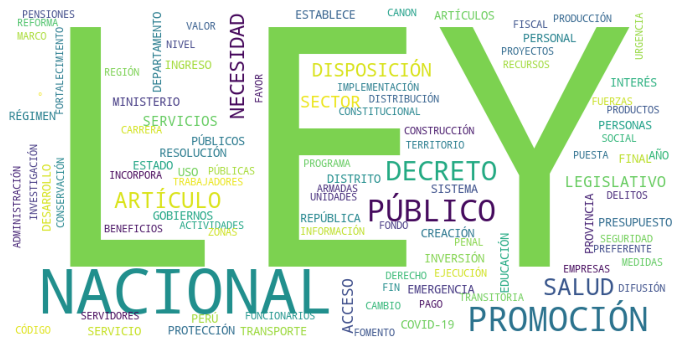

In [ ]:
show_wordcloud(Sus_Tit_Acces, save=True, img_name="WC_Sust_Titulo_Accesibilidad")

#### Verbos del título

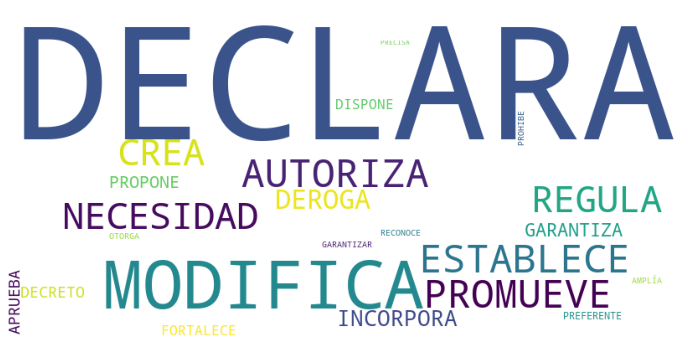

In [ ]:
show_wordcloud(Verb_Tit_Acces, save=True, img_name="WC_Verb_Titulo_Accesibilidad")

#### Adjetivos del título

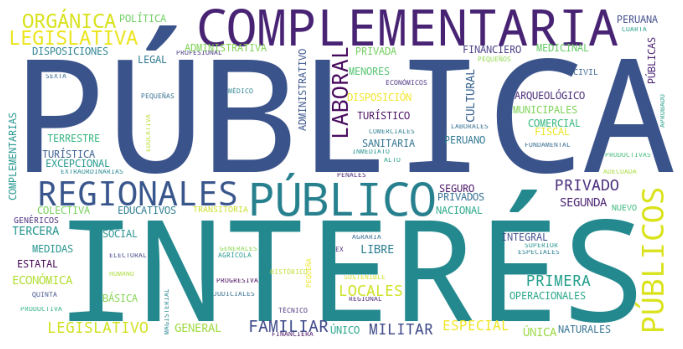

In [ ]:
show_wordcloud(Adj_Tit_Acces, save=True, img_name="WC_Adj_Titulo_Accesibilidad")

#### Sustantivos del Objeto

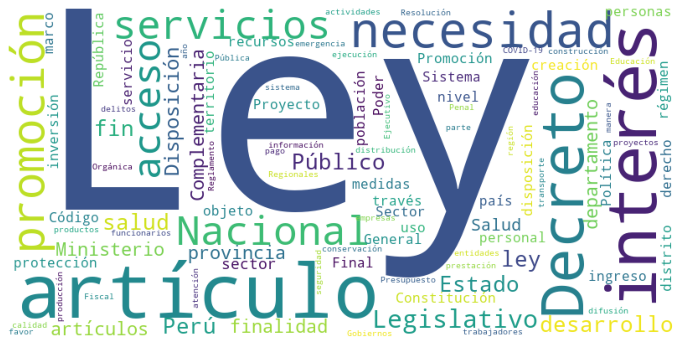

In [ ]:
show_wordcloud(Sus_Obj_Acces, save=True, img_name="WC_Sust_Objeto_Accesibilidad")

#### Verbos del Objeto

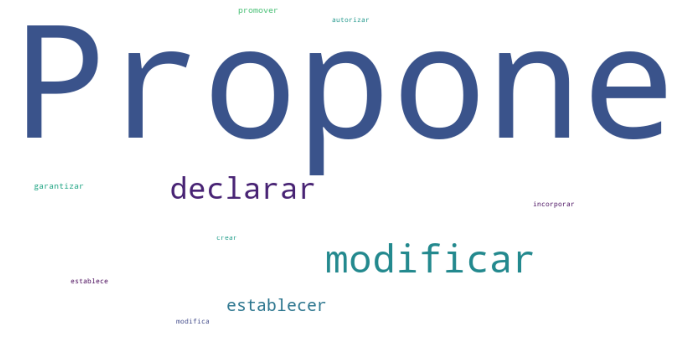

In [ ]:
show_wordcloud(Verb_Obj_Acces, save=True, img_name="WC_Verb_Objeto_Accesibilidad")

#### Adjetivos del Objeto

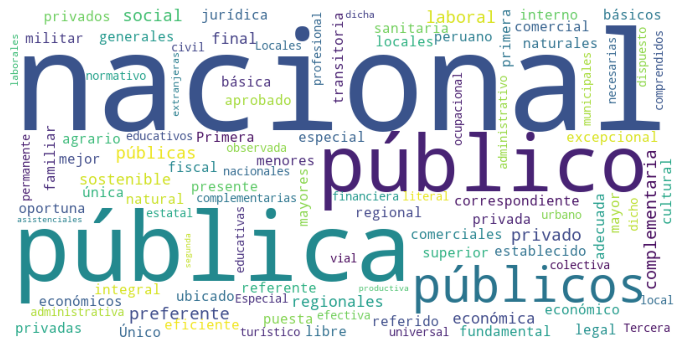

In [ ]:
show_wordcloud(Adj_Obj_Acces, save=True, img_name="WC_Adj_Objeto_Accesibilidad")

## TOPICO 2: AUDITABILIDAD

### 1. POS-Tagging usando spacy

In [ ]:
TitulosAuditabilidad,ObjetosAuditabilidad = PosTagging(Auditabilidad)

### 2. NER usando spacy

In [ ]:
NER(Auditabilidad)

Título:  LEY QUE DECLARA DE INTERES NACIONAL LA INVESTIGACIÓN, RECUPERACIÓN, CONSERVACIÓN Y PUESTA EN VALOR ""LA CAPILLA DE PUCYU ÑAHUI, SU CERCO PARIMETRICO Y TORRE CAMPANARIO"" UBICADO EN LA COMUNIDAD CAMPESINA DE JALCCO, DISTRITO DE LIVITACA, PROVINCIA DE CHUMBIVILCAS, DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone declara de interés nacional la investigación, recuperación, conservación y puesta en valor ""La Capilla de Pucyu Ñahui, su Cerco Perimétrico y Torre Campanario "" ubicado en la comunidad campesina de Jalcco, distrito de Livitaca, provincia de Chumbivilcas, departamento de Cusco
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE RECONOCE COMO SUJETOS DE DERECHO A LOS RÍOS AMAZÓNICOS, ESTABLECE UN SISTEMA ESPECIAL DE PROTECCIÓ Y CONSERVACIÓN INTEGRAL POR SUS ESPECIALES CONDICIONES
NER Título: 


Objeto:  Propone reconocer a los ríos de la Amazonía como sujeto y titulares de derecho debido al valor intrínseco que tienen y la importancia que detenta con respecto al medio ambiente y ecosistemas del Perú, a fin de garantizar su protección especial.
NER Objeto: 


Título:  LEY QUE INCORPORA NUEVA CAUSAL DE VACANCIA EN EL ARTÍCULO 22 DE LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES
NER Título: 


Objeto:  Propone incorporar el numeral 11) al artículo 22.- Vacancia del cargo de alcalde o regidor, de la Ley Orgánica de Municipalidades.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA NACIONAL UNIFICADO DE SALUD - SUS
NER Título: 


Objeto:  Propone crear el sistema Nacional Unificado de Salud - SUS, cuyo ente rector es el Ministro de Salud, quien asumirá la conducción administrativa de  los Hospitales de nivel II y III que se encuentran a cargo de las direcciones o gerencias regionales de salud de los gobiernos regionales.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA NACIONAL UNIFICADO DE SALUD
NER Título: 


Objeto:  Propone crear el Sistema Nacional Unificado de Salud - SUS, cuyo ente rector será el Ministro de Salud quien asumirá la conducción administrativa de los Hospitales de nivel II y III que se encuentran a cargo de las direcciones o gerencias regionales de salud de los gobiernos regionales.
NER Objeto: 


Título:  LEY QUE FACULTA EXCEPCIONALMENTE A LAS ENTIDADES DEL GOBIERNO NACIONAL,GOBIERNO REGIONAL Y LOCALES A CONTRATAR A LAS SOCIEDADES DE AUDITORÍA
NER Título: 


Objeto:  Propone otorgar a la Contraloría General de la República la facultad de delegar de manera temporal a las entidades del Gobierno Nacional, los Gobiernos Regionales y los Gobiernos Locales la contratación de las Sociedades de Auditoría que hayan sido previamente designadas por la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE PRIORITARIO INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE UNIDADES PRODUCTIVAS DE INVESTIGACIÓN, PARA EL MEJORAMIENTO GENÉTICO, COMERCIALIZACIÓN, VALOR AGREGADO Y CRIANZA ADECUADA DE CAMÉLIDOS SUDAMERICANOS EN EL PERÚ
NER Título: 


Objeto:  Propone declara de prioritario interés nacional y necesidad pública la creación de Unidades Productivas de Investigación, para el Mejoramiento Genético, Comercialización, Valor Agregado y Crianza Adecuada de Camélidos Sudamericanos en el Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 034-2019, REFERIDO A LA INCORPORACIÓN DE LA DÉCIMA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL A LA LEY 30220, LEY UNIVERSITARIA E INCORPORA LAS FACULTADES DE CREACIÓN DE COMISIONES REORGANIZADORAS DE UNIVERSIDADES PUBLICAS  Y DE UNIVERSIDADES PRIVADAS ASOCIATIVAS CREADAS POR LEY, CON LICENCIA INSTITUCIONAL DENEGADA
NER Título: 


Objeto:  Propone fortalecer el rol del Ministerio de Educación, como ente rector de la Política de Aseguramiento de la Calidad de la Educación Superior Universitaria, teniendo la finalidad de garantizar la calidad y continuidad del Servicio Educativo Universitario, dándole al Ministerio de Educación las facultades de creación de comisiones reorganizadoras de Universidades Públicas y de Universidades Privadas Asociativas creadas por Ley, con Licencia Institucional Denegada
NER Objeto: 


Título:  LEY QUE PROPONE SE DECLARE DE INTERÉS Y PREFERENTE NECESIDAD PÚBLICA EL FORTALECIMIENTO DE LA ENSEÑANZA DE VALORES ÉTICOS Y CIVISMO EN ETAPA ESCOLAR, COMO MECANISMO DE LUCHA CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional y preferente necesidad pública la enseñanza del curso de valores éticos y civismo en etapa escolar, como mecanismo de lucha contra la corrupción.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 19° Y 20° DEL CÓDIGO CIVIL REFERIDO AL ORDEN DEL APELLIDO DE LOS HIJOS
NER Título: 


Objeto:  Propone modificar los artículos 19 y 20 del Código Civil a efectos de establecer un mecanismo de solución ante la disconformidad de  los progenitores para asignar el orden de apellidos de los hijos.
NER Objeto: 


Título:  LEY DEL SISTEMA DE INTELIGENCIA NACIONAL - SINA  Y DE LA DIRECCIÓN NACIONAL DE INTELIGENCIA - DINI
NER Título: 


Objeto:  Propone establecer el marco jurídico que regula los principios, organización, atribuciones, funciones, coordinación, control y fiscalización, del Sistema de Inteligencia Nacional (en adelante SINA), asimismo, regula la organización, funciones, régimen laboral y económico de la Dirección Nacional de Inteligencia (en adelante DINI)
NER Objeto: 


Título:  LEY QUE AUTORIZA AL MINISTERIO DE DEFENSA DE MANERA EXCEPCIONAL ANTE LA EMERGENCIA SANITARIA CAUSADA POR EL COVID19, EL CAMBIO DE GRUPO OCUPACIONAL Y LINEA DE CARRERA DEL PERSONAL DE SALUD QUE SE ENCUENTRA DESEMPEÑANDO LABOR ASISTENCIAL
NER Título: 


Objeto:  Propone crear una Comisión Evaluadora COVID encargada de evaluar y autorizar de manera única y excepcional el cambio de Grupo Ocupacional y línea de carrera del personal que se encuentra desempeñando labor asistencial en los establecimientos de salud del Ministerio de Defensa.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RESTAURACIÓN Y PUETA EN VALOR DEL TEMPLO DE SAN PEDRO Y SAN PABLO DE ZEPITA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la restauración y puesta en valor del Templo de San Pedro y San Pablo de Zepita, ubicado en la provincia de Chucuito, departamento de Puno.
NER Objeto: 


Título:  LEY QUE BRINDA ATRIBUCIONES A LAS ASOCIACIONES DE PADRES DE FAMILIA Y COMITÉS DE AULA PARA LA PREVENCIÓN Y SEGUIMIENTO DE CASOS DE VIOLENCIA Y ACOSO ESCOLAR
NER Título: 


Objeto:  Propone brindar atribuciones a las asociaciones de padres de familia para prevenir y hacer seguimiento de los casos de acoso y violencia escolar, a fin de que, los estudiantes de las diferentes instituciones educativas públicas y privadas de educación básica regular y especial; Educación Técnica Productiva y Básica Alternativa, Puedan gozar de un desarrollo integral y armoniosos libres de acoso y violencia escolar.
NER Objeto: 


Título:  LEY QUE DEROGA LA DECLARACIÓN DE NECESIDAD, UTILIDAD PÚBLICA E INTERÉS NACIONAL EL PROYECTO ""MEJORAMIENTO Y AMPLIACIÓN DE LA PROVISIÓN DE AGUA PARA EL DESARROLLO AGRÍCOLA EN EL VALLE TACNA- VILAVILANI II, FASE I
NER Título: 


Objeto:  Propone Derogar el inciso 39, del artículo 11 del Decreto de Urgencia 018-2019, Decreto de Urgencia que Establece Medidas Extraordinarias para la Promoción e Implementación de los Proyectos Priorizados en el Plan Nacional de Infraestructura para la Competitividad.
NER Objeto: 


Título:  LEY QUE PLANTEA DE INTERÉS NACIONAL LA REPATRIACIÓN DE LOS RESTOS FAMILIARES DE JOSÉ GABRIEL CONDORCANQUI NOGUERA, TÚPAC AMARU
NER Título: 


Objeto:  Declárese de interés nacional y necesidad pública la repatriación de los restos de Fernando Túpac Amaru y de Juan Bautista Túpac Amaru, la construcción de un Mausoleo para honrar sus restos, así como la implementación de una comisión que realice el estudio histórico y la investigación científica del destino de la familia de José Gabriel Túpac Amaru, la que fuera perseguida, sacrificada y/o expatriada como consecuencia del levantamiento de José Gabriel Condorcanqui Noguera llamado igualmente José Gabriel Túpac Amaru, conocido posteriormente como Túpac Amaru II o simplemente Túpac Amaru y sus esposa Micaela Bastidas Puyuccahua.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1260, LEY QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGUILA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ
NER Título: 


Objeto:  La presente norma tiene por objeto restituir la autonomía y personería jurídica del Cuerpo General de Bomberos Voluntarios del Perú, como la autoridad competente en materia de prevención, control y extinción de incendios, está conformado por los bomberos voluntarios en actividad, los bomberos asimilados y los bomberos en situación de retiro, que prestan servicio público de manera voluntaria y ad honorem.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY N° 26859, LEY ORGÁNCIA DE ELECCIONES Y LEY N° 26486, LEY ORGÁNICA DEL JURADO NACIONAL DE ELECCIONES
NER Título: 


Objeto:  Propone modificar la Ley 26859, Ley Orgánica del Jurado Nacional de Elecciones para establecer fecha y lugar de debates en segunda vuelta electoral, establecidos por la autoridad electoral sin que exista cuestionamiento alguno en el ejercicio de dicha competencia exclusiva con el único propósito de fortalecer el sistema democrático.
NER Objeto: 


Título:  LEY QUE MODIFICA LA TERCERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL DECRETO SUPREMO 007-2016-MTC
NER Título: 


Objeto:  Propone modificar la Tercera Disposición Complementaria Transitoria del Decreto Supremo 007-2016-MTC, Reglamento Nacional del Sistema de Emisión de Licencias de Conducir y Modifica el Texto Único Ordenado del Reglamento Nacional de Tránsito - Código de Tránsito, aprobado por Decreto Supremo 016-2009-MTC y el Reglamento Nacional de Administración de Transporte, aprobado por Decreto Supremo 017-2009-MTC.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA FORMULACIÓN Y EJECUCIÓN DEL PARQUE CIENTIFICO TECNOLÓGICO DE PUNO - PCT
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la formulación y ejecución del ""Parque Científico Tecnológico de Puno"", ubicado en el departamento de Puno, que estará a cargo de la Universidad Nacional del Altiplano -UNA, con la finalidad de promover la investigación científica, innovación y transferencia tecnológica
NER Objeto: 


Título:  LEY QUE MOFICICA EL ARTICULO 12 E INCORPORA EL TÍTULO VII DE EDUCACIÓN, EVALUACIÓN Y BENEFICIOS EN LA LEY 29108, LEY DE ASCENSOS DE OFICIALES DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone modificar el artículo  12 e incorporar el Título VII, referido a Educación, Evaluación y Beneficios en la Ley 29108, Ley de ascensos de Oficiales de las Fuerzas Armadas, con la finalidad de mejorar la formación de los oficiales de las fuerzas armadas; promoviendo el aprendizaje de nuevos conocimientos especializados, competencias y capacidades como condiciones de calificación en su hoja de vida con mira al proceso de ascenso; garantizándose una línea de carrera profesional que permita seleccionar y promover a los oficiales más idóneos, sobre la base del mérito, competencia, imparcialidad y transparencia, en estricto cumplimiento al Principio de Igualda
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DENOMINACIÓN ADECUADA DE LOS PROFESIONALES DE LA SALUD QUE BRINDAN ATENCIÓN A LA MUJER EN SALUD REPRODUCTIVA Y PROHIBE LA INDEBIDA UTILIZACIÓN DE TÉRMINOS QUE SE PRESTAN A CONFUSIÓN Y PONER EN RIESGO LA SALUD
NER Título: 


Objeto:  Propone garantizar los derechos a la salud y a la vida de la mujer y de los usuarios al establecer la adecuada denominación de los profesionales de la salud que atienden la salud reproductiva de la mujer, en concordancia con su formación y competencia profesional; y evitar la intrusión en la profesión del médico cirujano.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL DESARROLLO DE LA ACTIVIDAD DE ACUICULTURA EN LA ISLA LOBOS DE TIERRA Y ACTIVIDADES CONEXAS EN LOS DEPARTAMENTOS DE LAMBAYEQUE Y PIURA
NER Título: 


Objeto:  Propone llamar la atención al ejecutivo sobre la importancia que tiene declarar de necesidad pública e interés nacional el desarrollo de la actividad de acuicultura en la isla lobos de tierra y actividades conexas en los departamentos de Lambayeque y Piura para el mejoramiento de la capacidad del pescador artesanal para incursionar en la maricultura con fines de abastecimiento de alimentos, recuperación de stock y de generación de empleo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY DEL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES PARA OTORGARLE MEJORES OPCIONES A LOS AFILIADOS RESPECTO A LA INVERSIÓN DE SUS FONDOS DE PENSIONES POR PARTE DE LAS AFP
NER Título: 


Objeto:  Propone modificar los artículos 18-A y 25-D del Texto Único Ordenado del Sistema Privado de Administración de Fondos de Pensiones (SPP), aprobado por el Decreto Supremo 054-97-EF, a efectos de mejorar la administración de los fondos de pensiones del SPP, promoviendo una mayor diversificación de las inversiones realizadas por las Administradoras Privadas de Fondos de Pensiones (AFP) al flexibilizar el límite de inversión en el extranjero, que permita tener mejores beneficios y/o retornos a los afiliados, en concordancia con el derecho a acceder a una pensión digna y decente previsto en la normatividad vigente y en la Constitución Política del Estado
NER Objeto: 


Título:  LEY QUE MODIFICA LA TRIGÉSIMA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 31084, LEY DEL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2021, QUE PERMITE A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES, HACER USO DE HASTA EL 20% DEL CANON, SOBRE CANON Y REGALÍAS MINERAS PARA CONTROLAR LA PROPAGACIÓN DEL BROTE DEL COVID-19
NER Título: 


Objeto:  Ley que modifica la Trigésima Tercera Disposición Complementaria Final de la Ley 31084, Ley del Presupuesto del Sector Público para el Año Fiscal 2021, que permite a los gobiernos regionales y gobiernos locales, hacer uso de hasta el 20% del canon y regalías mineras para controlar la propagación del brote del Covid-19
NER Objeto: 


Título:  LEY QUE RECONOCE A LOS TRABAJADORES TÉCNICOS ASISTENCIALES DE LA SALUD EN EL CARGO ESTRUCTURAL SERVIDOR PROFESIONAL ""E""
NER Título: 


Objeto:  Propone reconoce a los trabajadores técnicos asistenciales de la salud en el cargo estructural servidor profesional E
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL USO DE VEHÍCULOS ELÉCTRICOS
NER Título: 


Objeto:  La presente Ley tiene por objeto promover el uso de vehículos eléctricos mediante su exoneración del pago del Impuesto General a las Ventas (IGV) y el Impuesto al Patrimonio Vehicular por el período de 5 años contados a partir de la vigencia de la presente Ley.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LA EJECUCIÓN DE LA DOBLE VÍA Y EL ASFALTADO DE LA CARRETERA PÁMPANO-TICRAPO-MOLLEPAMPATICRAPO-CASTROVIRREYNA QUE PASA POR PROVINCIAS DE LOS DEPARTAMENTOS DE ICA Y HUANCAVELICA""
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la ejecución de la doble vía y el asfaltado de la carretera Pámpano-Ticrapo - Mollepampa - Ticrapo - Castrovirreyna cuyo trazado recorre las provincias de Pisco y Castrovirreyna de los departamentos de Ica y Huancavelica respectivamente.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PUESTA EN VALOR DE LOS RECURSOS NATURALES Y ARQUEOLOGICOS CON FINES TURISTICOS EN LA ZONA DE KIMBIRI Y PACHARI (VRAEM) CUSCO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el mantenimiento, restauración, protección, conservación, y puesta en valor los restos arqueológicos y recursos naturales del distrito de Kimbiri y Pichari de la provincia la Convención departamento de Cusco.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA CATEDRAL DE PUNO, DISTRITO DE PUNO, PROVINCIA DE PUNO Y REGIÓN DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la Restauración, Protección, Conservación y puesta en valor de la Catedral de Puno, distrito de Puno, provincia de Puno y Región de Puno
NER Objeto: 


Título:  LEY DE PARTICIPACIÓN DE LA MUJERES EN LA EJECUCIÓN DE OBRAS CIVILES Y PÚBLICAS
NER Título: 


Objeto:  Propone establecer como política pública de inclusión laboral, la participación de las mujeres en la ejecución de las obras civiles públicas y privadas, las mismas que se deberán incorporar en no menos del 35% de mano de obra directa de mujeres; asimismo, se deberá implementar su inclusión de manera progresiva.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL TEMPLO SANTIAGO APOSTOL, DISTRITO DE SANTIAGO DE PUPUJA, PROVINCIA DE AZÁNGARO Y REGIÓN DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la Restauración, Protección, Conservación y puesta en valor del Templo Santiago Apóstol, distrito de Santiago de Pupuja, provincia de Azángaro y Región de Puno.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CONSTRUCCIÓN E IMPLEMENTACIÓN DEL PARQUE CIENTÍFICO - TECNOLÓGICO DE AMAZONAS A CARGO DE LA UNIVERSIDAD NACIONAL TORIBIO RODRIGUEZ DE MENDOZA DE AMAZONAS (UNTRM)
NER Título: 


Objeto:  Propone promover el acercamiento de la investigación directamente vinculada con las necesidades del crecimiento de la región y del país, como fuente de reactivación económica en el marco de la pandemia por COVID-19, se requiere declarar de necesidad pública e interés nacional la construcción e implementación del parque científico y tecnológico de amazonas a cargo de la Universidad Nacional Toribio Rodríguez de Mendoza de Amazonas (UNTRM).
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEY 25872, POR EL QUE SE DECLARA LA PREVALENCIA DE LOS DECRETOS SUPREMOS QUE DISPUSIERON LA SUSPENSION O LIMITACION DE LOS SISTEMAS DE REAJUSTES DE REMUNERACIONES EN FUNCION A INDICES DE INFLACIÓN O MECANISMOS SIMILARES
NER Título: 


Objeto:  Propone derogar el Decreto Ley 25872, Decreto Ley que declara la prevalencia de los decretos supremos que dispusieron la suspensión o limitación de los sistemas de reajustes de remuneraciones en función a inflación o mecanismos similares.
NER Objeto: 


Título:  LEY DE RECTIVACION PRODUCTIVA DE LA AMAZONIA
NER Título: 


Objeto:  Propone modificar la Ley 27037, Ley de Promoción de la Inversión en la Amazonia, restituida plenamente por la Ley 29742, Ley que deroga los Decretos Legislativos 977 y 978 y restituye la plena vigencia de la Ley 27037, así como sus normas modificatorias, complementarias, disposiciones finales y reglamentarias.
NER Objeto: 


Título:  LEY DE CREACIÓN DEL CONSEJO PERUANO DE ACREDITACIÓN DE LA EDUCACIÓN SUPERIOR
NER Título: 


Objeto:  Propone crear el Consejo Peruano de Acreditación de la Educación Superior (COPAES), y la definición de responsabilidades, alcances y procedimientos necesarios para impulsar el mejoramiento continuo de la calidad de la educación superior mediante el proceso de acreditación de las instituciones y programas de educación superior.
NER Objeto: 


Título:  LEY QUE PRECISA EL USO DE LA CUESTIÓN DE CONFIANZA CONTEMPLADA EN LOS ARTÍCULOS 132 Y 133 DE LA CONSTITUCIÓN POLÍTICA  DEL PERÚ
NER Título: 


Objeto:  Es facultad del Poder Ejecutivo el planteamiento de la cuestión de confianza facultativa, a que se refieren los artículos 132 y 133 de la Constitución Política del Perú, sobre iniciativas legislativas, cuyo contenido no implique una aprobación, expresa o tácita de una reforma constitucional. Asimismo, puede presentarse  respecto de la permanencia de cualquiera de los miembros del gabinete ministerial.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DE LA LEY 30021, LEY DE PROMOCIÓN DE LA ALIMENTACIÓN SALUDABLE PARA NIÑOS, NIÑAS Y ADOLESCENTES
NER Título: 


Objeto:  Propone modificar la Primera Disposición Complementaria Transitoria de la Ley 30021, Ley de Promoción de la Alimentación Saludable para niños, niñas y Adolescentes en lo referente a las facultades de reglamentación del Ministerio de Salud.
NER Objeto: 


Título:  LEY DE INTERPRETACIÓN DEL ARTÍCULO 132 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone interpretar que la facultad del Poder Ejecutivo de plantear cuestión de confianza sobre la aprobación de iniciativas no puede referirse a competencias exclusivas y excluyentes del Congreso de la república, entre las cuales se encuentra la de aprobar reformas constitucionales.
NER Objeto: 


Título:  LEY DE ADECUACIÓN AL SISTEMA UNIVERSITARIO PARA LOS DOCENTES NOMBRADOS COMPRENDIDOS EN LA LEY 30597, LEY 30851 Y D. S. 014-2018- MINEDU
NER Título: 


Objeto:  Propone autorizar de manera excepcional la adecuación de los docentes nombrados del Conservatorio Nacional de Música a la Universidad Nacional de Música; Instituto Superior de Música Público Daniel Alomía Robles de Huánuco a la Universidad Nacional Daniel Alomía Robles; Escuela Superior Autónoma de Bellas Artes ""Diego Quispe Tito"" a la Universidad Nacional Diego Quispe Tito.
NER Objeto: 


Título:  LEY QUE RECONOCE ACCESO A LA JUSTICIA DE LAS PERSONAS USUARIAS EN SALUD Y LA AUTONOMÍA DE LA SUPERINTENDENCIA NACIONAL DE SALUD
NER Título: 


Objeto:  Propone autonomía e independencia de la Superintendencia Nacional de Salud, asimismo fortalecer el acceso de las personas usuarias de los servicios de salud a través de mecanismos alternativos de resolución de conflictos, la vigilancia y la participación ciudadana a nivel nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28090, LEY QUE REGULA EL CIERRE DE MINAS
NER Título: 


Objeto:  Propone modificar la Ley 28090, Ley que regula el Cierre de Minas, a fin de adecuar la norma a los cambios que se han producido luego de su emisión y a las competencias actuales que ejercen las entidades involucradas.
NER Objeto: 


Título:  LEY QUE DICTA MEDIDAS PARA FORTALECER Y MODERNIZAR EL CENTRO NACIONAL DE PRODUCTOS BIOLÓGICOS PARA LA PREVENCIÓN Y EL CONTROL DE LAS ENFERMEDADES QUE AFECTANA LA SALUD PÚBLICA E IMPLEMENTAR UNA PLANTA DE PRODUCCIÓN DE VACUNAS,
NER Título: 


Objeto:  Propone dictar medidas para fortalecer y modernizar el Centro Nacional de Productos Biológicos (CNPB) del Instituto Nacional de Salud, para la prevención y el control de las enfermedades e implementar una nueva planta de producción de vacunas en nuestro país.
NER Objeto: 


Título:  LEY QUE DECLARA PRECURSOR DE LA INDEPENDENCIA DEL PERÚ A: JUAN VÉLEZ DE CÓRDOVA SALGADO Y ARAUJO
NER Título: 


Objeto:  Propone declarar Precursor de la Independencia del Perú a Juan Vélez de Córdova Salgado y Araujo por su acción en bien de la Independencia nacional, debiendo conmemorarse el 6 de julio de cada año con el reconocimiento de todo el país en mérito a su sacrificio ofrendando su vida por la Patria.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL INGRESO LIBRE A LAS UNIVERSIDADES PÚBLICAS
NER Título: 


Objeto:  Propone establecer el ingreso libre en las universidades públicas del Perú, garantiza la calidad y gratuidad de la enseñanza universal, a través de una evaluación constante que permita conocer las aptitudes, habilidades y competencia de los futuros profesionales de nuestro país.
NER Objeto: 


Título:  LEY QUE DEROGA EL DERECHO SUPREMO 090-2021-PCM QUE APRUEBA EL CAMBIO DE DEPENDENCIA DE LA SECRETARÍA TÉCNICA DE APOYO A LA COMISIÓN AD HOC CREADA POR EL DECRETO SUPREMO 006-2012-EF, DEL MINISTERIO DE ECONOMÍA Y FINANZA A LA PRESIDENCIA DEL CONSEJO DE MINISTROS
NER Título: 


Objeto:  Propone derogarse el Decreto Supremo 090-2021-PCM, que aprueba el cambio de dependencia de la Secretaría Técnica de apoyo a la Comisión Ad Hoc creada por el Decreto Supremo 006-2012-EF del Ministerio de Economía y Finanzas a la Presidencia del Consejo de Ministro.
NER Objeto: 


Título:  LEY QUE AMPLÍA EL PLAZO DE REVISIÓN DE LOS NOMBRAMIENTOS, RATIFICACIONES, EVALUACIONES Y PROCEDIMIENTOS DISCIPLINARIOS EFECTIADOS POR LOS CONSEJEROS REMOVIDOS POR EL CONGRESO DE LA REÚBLICA ESTABLECIDO EN LA LEY 30916
NER Título: 


Objeto:  Propone ampliar el plazo de revisión de los nombramientos, ratificaciones, evaluaciones y procedimientos disciplinarios efectuados por los consejeros removidos por el Congreso de la República establecido en la Ley 30916
NER Objeto: 


Título:  LEY QUE MODIFICA LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1275: DECRETO LEGISLATIVO QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DE LOS GEBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria Final del Decreto Legislativo 1275: Decreto Legislativo que Aprueba el marco de la Responsabilidad y transparencia Fiscal de los Gobiernos Regionales y Gobiernos Locales, respecto de la excepcionalidad del informe previo de Evaluación de la sostenibilidad Fiscal de la Municipalidades Fronterizas.
NER Objeto: 


Título:  LEY QUE PERMITE UNA INVESTIGACIÓN PLENA EN MATERIA DE RESPONSABILIDAD DE PERSONAS JURÍDICAS EN EL MARCO DE LA LEY 30424
NER Título: 


Objeto:  Propone modificar la Ley 30424 que Regula la Responsabilidad Administrativa de las Personas Jurídicas, con el fin proteger la autonomía del Ministerio Público como titular de la acción penal y disminuir la probabilidad de que genere espacios de impunidad en la aplicación de este tipo de delitos fortaleciendo lucha contra la corrupción y el lavado de activos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA DE INTERÉS NACIONAL LA CREACIÓN DE LA UNIDAD EJECUTORA EN EL ÁMBITO TERRITORIAL DE LA CUENCA HIDROGRÁFICA DE LA LECHE COMO PROYECTO ESPECIAL Y - PLIEGO MINISTERIO DE CULTURA ""COMPLEJOS ARQUEOLÓGICOS DE PÓMAC - BATAN GRANDE Y CUENCA DE LA LECHE""- DEPARTAMENTO DE LAMBAYEQUE
NER Título: 


Objeto:  Propone llamar la atención al ejecutivo sobre la importancia que tiene declarar de necesidad pública de interés nacional la creación de la unidad ejecutora que se encargue de administrar el patrimonio cultural de complejos arqueológico de Pómac - batan grande y cuenca de la leche, con el propósito de implementar acciones de conservación y puesta en valor.
NER Objeto: 


Título:  LEY QUE REVALORA LA CULTURA ANCESTRAL Y LA CONSEVACIÓN DE LOS RITUALES DE IDENTIDAD NACIONAL
NER Título: 


Objeto:  Propone reconocer los rituales como parte de la cultura ancestral indígena y originaria del Perú.
NER Objeto: 


Título:  LEY QUE DISPONE LA CREACIÓN DE UN SEGURO DE DESEMPLEO PROTEGIENDO A LOS TRABAJADORES EN SITUACION DE DESEMPLEO
NER Título: 


Objeto:  Propone crear el Seguro de Desempleo con la finalidad de proteger a los trabajadores de cualquier modalidad laboral, con un pago temporal que se encuentre en situación de desempleo, con participación del sector privado, teniendo como finalidad incentivar a la búsqueda de un nuevo empleo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DEL PODER EJECUTIVO PARA IMPEDIR QUE EJERZAN CARGO PÚBLICO LAS PERSONAS QUE TIENEN DEUDAD CON EL ESTADO
NER Título: 


Objeto:  Propone incorporar el artículo 49 a la Ley 29158, Ley Orgánica del Poder Ejecutivo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LOS CUIDADOS PALIATIVOS Y EL CONTROL DEL DOLOR EN EL TRATAMIENTO INTEGRAL DEL CÁNCER
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública los cuidados paliativos y el control del dolor en el tratamiento integral del cáncer.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA EL ARTICULO 42 A EN LA LEY 26300 LEY DE LOS DERECHOS DE PARTICIPACION Y CONTROL CIUDANDOS
NER Título: 


Objeto:  Propone incorporar el artículo 42 A en la Ley 26300 Ley de los Derechos de Participación y Control Ciudadano.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN Y MANTENIMIENTO DE RELLENOS SANITARIOS A CARGO DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES QUE PARTICIPAN EN LA DISTRIBICIÓN DEL CANON
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción y mantenimiento de rellenos sanitarios en aquellos gobiernos regionales y gobiernos locales que participan en la distribución del canon.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL REGISTRO NACIONAL DIGITAL Y EL OBSERVATORIO NACIONAL CONTRA EL TRABAJO FORZOSO Y LA TRATA DE PERSONAS
NER Título: 


Objeto:  Propone implementar el Registro Nacional Digital contra el Trabajo Forzoso y la Trata de Personas, a fin de generar información y conocimiento virtual para el seguimiento y mejorar de las políticas públicas en matería trabajo forzoso y la trata de personas, priorizando de forma especial a las personas y grupos que se encuentran en condición de mayor vulnerabilidad: niños, adolescentes, Personas con discapacidad, miembro de comunidades campesinas u originarios, entre otros.
NER Objeto: 


Título:  LEY QUE INCORPORA LA DÉCIMO SEXTA DISPOSICIÓN FINAL Y TRANSITORIA DEL TEXTO ÚNICO ORDENADO DE LA LEY DEL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES
NER Título: 


Objeto:  Propone incorporar una Disposición Complementaria al Texto Único Ordenado de la Ley del Sistema Privado de Administración de Fondos de Pensiones aprobado mediante Decreto Supremo 054-97-EF, para establecer la emisión del bono de reconocimiento para todo trabajador que deje el régimen ONP y se incorpore al régimen SPP.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL INSTITUTO NACIONAL INFANTIL DE INVESTIGACIÓNES PEDIÁTRICAS, EN LA REGIÓN PASCO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del Instituto Nacional Infantil de Investigaciones Pediátricas, en la región Pasco.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CULMINACIÓN DE LA CARRETERA NACIONAL PUENTE RANCHO-CHAGLLA-RUMICHACA, UBICADO EN LA PROVINCIA DE PACHITEA, DEL DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la culminación de la Carretera Nacional Puente Rancho-Chaglla-Rumichaca, ubicado en la provincia de Pachitea, del departamento de Huánuco, con la finalidad de mejorar las condiciones del transporte terrestre y el traslado de productos locales hacia otras regiones del país, impulsando la competitividad.
NER Objeto: 


Título:  LEY QUE RECONOCE LA FACULTAD JURISDICCIONAL DE LA RONDAS CAMPESINAS.
NER Título: 


Objeto:  Propone modificar el artículo 149 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY DEL SERVICIO DE SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone establecer el marco normativo que regula al serenazgo municipal como parte del servicio de seguridad ciudadana que prestan las municipalidades, regulando actividades que contribuyan a la prevención social de la violencia, los delitos y las faltas, a efectos de promover la convivencia pacífica y la cohesión social e impactar positivamente en el desarrollo humano de los miembros de la comunidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY GENERAL DEL VOLUNTARIADO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone definir el voluntariado, así como la rectoría del Ministerio de la Mujer y Poblaciones Vulnerables - MIMP en materia de voluntariado a efectos de fortalecer la promoción, facilitación, articulación y reconocimiento del voluntariado a nivel nacional.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA HABILITACIÓN DE VÍAS DE COMUNICACIÓN TERRESTRE EN LA REGIÓN PASCO, PRIORIZANDO LA CARRETERA PASCO-HUACHÓN-HUANCABAMBA-OXAPAMPA
NER Título: 


Objeto:  Propone declarar de interés nacional la aprobación de la construcción de carreteras en la región Pasco, a efectos de viabilizar la interconectividad entre las ciudades de la región selva con las ciudades de la región de la costa, permitiendo la ampliación de la red vial nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 024-2021, DECRETO DE URGENCIA PARA DINAMIZAR LA PRESTACIÓN DE SERVICIOS E INVERSIÓNES A CARGO DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES Y OTRAS MEDIDAS, ANTE LA EMERGENCIA SANITARIA PRODUCIDA POR EL COVID-19
NER Título: 


Objeto:  Propone establecer un nuevo plazo para el financiamiento de inversiones de los gobiernos regionales y locales ante la emergencia sanitaria producida por el Covid-19.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL CONTROL CONCURRENTE EN LOS PROYECTOS DE INVERSIÓN, QUE TENGAN COMO FINANCIAMIENTO RECURSOS PÚBLICOS
NER Título: 


Objeto:  Propone establecer el control concurrente en los proyectos de inversión, que tengan como financiamiento recursos públicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 7 Y EL ARTÍCULO 143 DE LA LEY 28611 - LEY GENERAL DEL AMBIENTE
NER Título: 


Objeto:  Propone modificar los artículos 7 y 143 de la Ley 28611, Ley General del Ambiente en aras de determinar la competencia idónea para conocer las acciones relativas al cumplimiento de las normas ambientales.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27584, LEY QUE REGULA EL PROCESO CONTENCIOSO ADMINISTRATIVO
NER Título: 


Objeto:  Propone establecer disposiciones pendientes a modificar las reglas de competencia territorial en los procesos contenciosos administrativo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA ""CIUDAD BENEMÉRITA Y HERÓICA"" A LA CUIDAD DE ZAPITA, PROVINCIA DE CHUCUITO, DEPARTAMENTO DE PUNO Y DISPONE SU INCORPORACIÓN EN LA AGENDA DE CONMEMORACIÓN DEL BICENTENARIO POR LA INDEPENDENCIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar como ""Ciudad Benemérita y Heroica"" a la ciudad de Zepita, provincia de Chucuito y departamento de Puno, así como el 25 de agosto de cada año como Día Nacional de la Batalla de Zepita, con la finalidad de fortalecer la identidad historica de la Región Puno, revalorando y reivindicando este acontecimiento historico que favoreció la independencia del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD NACIONAL Y PRIORITARIA LA INVESTIGACIÓN DE LOS MONUMENTOS ARQUEOLÓGICOS PREHISPÁNICOS Y SITIOS PALEONTOLÓGICOS CON FINES CIENTÍFICOS, DE USO SOCIAL Y TURÍSTICO
NER Título: 


Objeto:  Propone declarar de necesidad nacional y prioritaria la investigación de los monumentos arqueológicos prehispánicos y sitios paleontológicos con fines científicos, de uso social y turístico.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA LA PRIMERA SEMANA DEL MES DE JULIO COMO LA ""SEMANA CIENTÍFICA, TECNOLÓGICA E INNOVACIÓN EN LA EDUCACIÓN BÁSICA REGULAR"
NER Título: 


Objeto:  Propone declarar la primera semana del mes de julio de cada año como ""La Semana Cientifica Tecnológica e Innovación en la Educación Básica Regular"", con el fin de impulsar, promover, fortalecer  y consolidar las competencias y capacidades pedegogicas de ciencia, tecnología e innovación en los niveles de educación inicial, primaria y secundaria.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 28455, LEY QUE CREA EL FONDO PARA LAS FUERZAS ARMADAS Y POLICÍA NACIONAL
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 28455, Ley que crea el fondo para las Fuerzas Armadas y Policía Nacional, a efectos de incrementar los ingresos del Fondo para las Fuerzas Armadas y Policía Nacional, a través del aumento y la incorporación de regalías percibidas por el Gobierno Nacional en los Lotes 57 y 58 de Camisea.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE PLANTEA LA AUTONOMÍA FUNCIONAL DEL CONGRESO DE LA REPÚBLICA Y DEL PODER EJECUTIVO
NER Título: 


Objeto:  Propone establecer la autonomía funcional del Congreso de la República y del Poder Ejecutivo, a efectos de evitar una crisis política al inicio del mandato de un Consejo de Ministros.
NER Objeto: 


Título:  LEY DE LA EQUIDAD DE BENEFICIOS EN LA REGIÓN DE LA AMAZONIA
NER Título: 


Objeto:  Propone modificar la Ley 27037, Ley de Promoción de la Inversión en la Amazonia, restituida plenamente por la Ley 29742, Ley que deroga los Decretos Legislativos 977 y 978 y restituye la plena vigencia de la Ley 27037, así como sus normas modificadoras, complementarias, disposición finles y reglamentaria.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y UTILIDAD PÚBLICA EL MEJORAMINTO Y EQUIPAMIENTO DE LOS SERVICIOS DE SALUD DEL CENTRO DE SALUD HUACAYBAMBA, EN EL DISTRITO Y PROVINCIA DE HUACAYBAMBA, DEL DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública el Mejoramiento y Equipamiento de los Servicios de Salud del Centro de Salud Huacaybamba, en el distrito y provincia de Huacaybamba en el departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE RECONOCE LA BATALLA DE CHUA CHUA- ZEPITA COMO PATRIMONIO Y SÍMBOLO DE PATRIOTISMO E IDENTIDAD NACIONAL, OCURRIDO EN LAS PAMPAS DE CHUA CHUA DEL DISTRITO DE ZEPITAPROVINCIA DE CHUCUITO, DEPARTAMENTO DE PUNO, EN EL MARCO DEL BICENTENARIO DEL PERÚ: 200 AÑOS DE INDEPENDENCIA
NER Título: 


Objeto:  Propone establecer el reconocimiento de la Batalla de Zapita como símbolo de patriotismo e identidad nacional ocurrido en las pampas de Chua Chua del departamento de Puno, en el marco del bicentenario del Perú: 200 años de independencia, con la finalidad de poner en valor la contribución historica del departamento de Puno.
NER Objeto: 


Título:  LEY QUE FORTALECE LA FUNCIÓN FISCALIZADORA DE LOS CONSEJOS REGIONALES Y CONSEJO MUNICIPALES
NER Título: 


Objeto:  Propone Fortalecer las capacidades fiscalizadoras y ejecutoras de los gobiernos locales y regionales con la finalidad de coadyuvar a las labores de fiscalización que realicen  los regidores municipales y consejeros regionales, respectivamente, dotando además de mayores herramientas para mejorar la capacidad ejecutora de los gobiernos regionales y locales.
NER Objeto: 


Título:  LEY QUE MODIFICA LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1275 QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone modificar la quinta disposición complementaria final del Decreto Legislativo 1275 que aprueba el marco de la responsabilidad y transparencia fiscal de los Gobiernos Regionales y Gobierno Locales
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE PROMUEVE LA REVISIÓN DE CONTRATOS LEY
NER Título: 


Objeto:  Propone modificar el articulo 62 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA LEY NÚM. 28705, LEY GENERAL PARA LA PREVENCIÓN Y CONTROL DE LOS RIESGOS DEL CONSUMO DEL TABACO, EN CONCORDANCIA CON EL CONVENIO MARCO DE LA ORGANIZACIÓN MUNDIAL DE LA SALUD PARA EL CONTROL DEL TABACO
NER Título: 


Objeto:  Propone modificar la Ley núm. 28705, Ley general para la prevención y control de los riesgos del consumo del tabaco, en concordancia con el convenio marco de la organización mundial de la salud para el control del tabaco.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN E IMPLEMENTACIÓN DEL PARQUE CIENTÍFICO - TECNOLÓGICO DE UCAYALI A CARGO DE LA UNIVERSIDAD NACIONAL DE UCAYALI (UNU).
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción  e implementación del parque científico - tecnológico de Ucayali a cargo de la univarsidad nacional de  Ucayali.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA EFECTIVIDAD Y CUMPLIMIENTO DE ENSAYOS CLÍNICOS
NER Título: 


Objeto:  Propone garantizar la efectividad y cumplimiento de ensayos clínicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA MEDIDAS EXCEPCIONALES PARA LA INCORPORACIÓN DE PERSONAL ASISTENCIAL NOMBRADO A PERSONAL DE LA SALUD MEDIANTE EL CAMBIO DE GRUPO OCUPACIONAL Y LINEA DE CARRERA POR CONCURSO DE MÉRITOS Y OTRAS MEDIDAS
NER Título: 


Objeto:  Propone autorizar medidas excepcionales para la incorporación de personal asistencial nombrado a personal de la salud mediante el cambio de grupo ocupacional y línea de carrera por concurso de méritos y otras medidas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA LA IMPARCIALIDAD DE LAS SALAS PENALES ESPECIALES EN LOS PROCESOS PENALES ESPECIALES POR RAZÓN DE LA FUNCIÓN
NER Título: 


Objeto:  Propone modificar los artículos 450 y 454 del Código Procesal Penal. Promulgado por el Decreto Legislativo 957.
NER Objeto: 


Título:  LEY DE EXONENERACIÓN DEL PAGO DE MULTA POR OMISIÓN AL PROCESO DE ELECCIONES GENERALES DEL 2021
NER Título: 


Objeto:  Propone establecer los supuestos de exoneración del pago de multa en las elecciones generales del 2021 realizado el día domingo once (11) de abril de 2021.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE FUNCIONES SANCIONADORAS DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA EN MATERIA DE RESPONSABILIDAD ADMINISTRATIVA FUNCIONAL Y RESTITUYE LA AUTONOMÍA TÉCNICA Y FUNCIONAL DEL TRIBUNAL SUPERIOR DE RESPONSABILIDADES ADMINISTRATIVAS
NER Título: 


Objeto:  Propone establecer funciones sancionadoras de la Contraloría General de la República en materia de responsabilidad administrativa funcional y restituir la autonomia técnica y funcional del Trubunal Superior de Responsabilidades Administrativas.
NER Objeto: 


Título:  LEY QUE PRECISA LA SEGUNDA, DISPOSICIONES COMPLEMENTARIAS TRANSITORIAS DE LA LEY 30220 - LEY UNIVERSITARIA, DISPONIENDO QUE LA ADECUACIÓN DEL ESTATUTO, SERÁ REGULADO POR EL ÓRGANO MÁXIMO DE LA PERSONA JURÍDICA DE LA ENTIDAD PROMOTORA
NER Título: 


Objeto:  Propone la Segunda Disposición Complementaria Transitoria de la Ley 30220 - Ley Universitaria.
NER Objeto: 


Título:  LEY QUE REGULA EL PROCEDIMIENTO DE LA LABOR PREVENTIVA Y DE CONTROL DEL COMERCIO A CARGO DE LAS MUNICIPALIDADES
NER Título: 


Objeto:  Propone regular el procedimiento de la labor preventiva y de control del comercio a cargo de las municipalidades.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA LA ADQUISICIÓN DE BIENES PARA EL CONTROL DE LAS FRONTERAS, LA AMAZONÍA Y EL DENOMINADO MARÍTIMO
NER Título: 


Objeto:  Propone autorizar la adquisición de bienes y equipos bélicos para el control de las fronteras, la amazonía y el dominio marítimo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE ADECUACIÓN AL SISTEMA UNIVERSITARIO PARA LOS DOCENTES NOMBRADOS COMPRENDIDOS EN LA LEY 30597, LEY 30851 Y DECRETO SUPREMO 014-2018-MINEDU
NER Título: 


Objeto:  Propone adecuar al sistema universitario para los docentes nombrados comprendidos en la Ley 30597, Ley 30851 y Decreto Supremo 014-2018-MINEDU
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA FORMULACIÓN Y EJECUCIÓN DEL PROYECTO: ""RESTAURACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL TEMPLO SANTIAGO APÓSTOL Y RECONSTRUCCIÓN DEL PUENTE COLONIAL DE LAMPA, PROVINCIA DE LAMPA, DEPARTAMENTO DE PUNO""
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la formulación y ejecución del Proyecto : ""Restauración, Puesta en Valor y Promoción del Templo Santiago Apóstol y Reconstrucción del Puente Colonial de Lampa, provincia de Lampa, departamento de Pun
NER Objeto: 


Título:  LEY QUE LA COMISIÓN TÉCNICA INTERINSTITUCIONAL PERMANENTE DE GOBERNANZA DE DATOS E INTEROPERABILIDAD DEL SISTEMA DE JUSTICIA
NER Título: 


Objeto:  Propone crear la Comisión Técnica Interinstitucional Permanente de Gobernanza de Datos e Interoperabilidad del Sistema de Justicia
NER Objeto: 


Título:  LEY QUE PROPONE DECLARAR DE UTILIDAD Y NECESIDAD PÚBLICA LA HABILITACIÓN URBANA Y EL SANEAMIENTO FÍSICO LEGAL DEL PREDIO ""PAMPAS DE CONCON"" EN LA PROVINCIA DE CAÑETE, REGIÓN LIMA
NER Título: 


Objeto:  Propone declarar de utilidad y necesidad pública la habilitación urbana y el saneamiento físico legal del predio ""Pampas de Concon"" ubicado en la provincia de Cañete, región Lima, a fin de promover de manera integral el desarrollo urbano, proyectos de irrigación y garantizar la calidad de vida de los pobladores de la provincia de Cañete.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO POR LA QUE SE INHABILITA POR DIEZ AÑOS PARA EL EJERCICIO DE LA FUNCIÓN PÚBLICA AL EXPRESIDENTE DE LA REPÚBLICA MARTÍN ALBERTO VIZCARRA CORNEJO
NER Título: 


Objeto:  Propone INHABILITAR por diez años para el ejercicio de la función pública al expresidente de la República MARTÍN ALBERTO VIZCARRA CORNEJO, por haber cometido infracción a la Constitución Política en sus artículos 2 (inciso 2), 7, 9, 38 39 y 118 (inciso 1).
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO POR LA QUE SE INHABILITA POR OCHO AÑOS PARA EL EJERCICIO DE LA FUNCIÓN PÚBLICA A LA EXMINISTRA DE SALUD PILAR ELENA MAZZETTI SOLER
NER Título: 


Objeto:  Propone INHABILITAR por ocho años para el ejercicio de la función pública a la exministra de Salud PILAR ELENA MAZZETTI SOLER, por haber cometido infracción a la Constitución Política en sus artículos 38 y 39.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO POR LA QUE SE INHABILITA POR UN AÑO PARA EL EJERCICIO DE LA FUNCIÓN PÚBLICA A LA EX MINISTRA DE RELACIONES EXTERIORES ESTHER ELIZABETH ASTETE RODRÍGUEZ
NER Título: 


Objeto:  Propone INHABILITAR por un año para el ejercicio de la función pública a la exministra de Relaciones Exteriores ESTHER ELIZABETH ASTETE RODRÍGUEZ, por haber cometido infracción a la Constitución Política en sus artículos 38 y 39.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO POR LA QUE SE SUSPENDE DEL EJERCICIO DE SUS DERECHOS Y DEBERES FUNCIONALES AL SEÑOR CONGRESISTA DE LA REPÚBLICA EDGAR ARNOLD ALARCÓN TEJADA
NER Título: 


Objeto:  Propone suspender al señor congresista de la República EDGAR ARNOLD ALARCÓN TEJADA del ejercicio de sus derechos y deberes funcionales en tanto dure el proceso penal que afronte en su condición de excontralor general de la República, por ser el presunto autor del delito contra la administración pública-enriquecimiento ilícito agravado, previsto y sancionado en el artículo 401 del Código Penal, en agravio del Estado.
NER Objeto: 


Título:  LEY QUE DISPONE LA EMISIÓN DEL CERTIFICADO DIGITAL A PERSONAS INOCULADAS CON LA VACUNA CONTRA LA COVID-19
NER Título: 


Objeto:  Propone la emisión de un certificado digital para las personas inoculadas con la vacuna contra la Covid-19, en tanto se implemente la creación de un certificado electrónico, vinculado al documento nacional de identidad electrónico.
NER Objeto: 


Título:  LEY MARCO DE INSTITUTOS PÚBLICOS DE INVESTIGACIÓN
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer disposiciones generales aplicables a todos los Institutos Públicos de Investigación del Perú, a fin de regular de forma homogénea su régimen jurídico y sistema de gobernanza, definiendo su transversalidad a través de sus coincidencias funcionales y reconociendo sus particularidades en torno a su objeto de estudio.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 1 Y 2 DE LA LEY 30424, LEY QUE REGULA LA RESPONSABILIDAD ADMINISTRATIVA DE LAS PERSONAS JURÍDICAS, E INCORPORA EL DELITO DE FINANCIAMIENTO PROHIBIDO DE PARTIDOS POLÍTICOS DENTRO DEL ALCANCE DE LA NORMA
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 30424, Ley que regula la responsabilidad administrativa de las personas jurídicas.
NER Objeto: 


Título:  LEY QUE OTORGA FACULTADES A LOS GOBIERNOS REGIONALES PARA ADQUIRIR, IMPORTAR, ALMACENAR, DISTRIBUIR Y APLICAR VACUNAS, MEDICAMENTOS Y/O PRODUCTOS BIOLÓGICOS PARA LA PREVENCION y/O TRATAMIENTO DEL COVID-19
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 31091 y el artículo 49 de la Ley 27867, con el objeto de otorgar facultades a los gobiernos regionales, para adquirir, importar, almacenar, distribuir y aplicar vacunas, medicamentos y/o productos biológicos para la prevención y/o tratmiento del COVID 19
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ELIMINA EL EJERCICIO DE MINISTRO DE ESTADO DURANTE EL DESEMPEÑO DE CONGRESISTA DE LA REPÚBLICA
NER Título: 


Objeto:  Propone la modificación del artículo 92 de la Constitución Política del Perú, eliminando la posibilidad de ejercer el cargo de Ministro de Estado durante el desempeño de Congresista de la República.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 113 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ REFERENTE A LAS CAUSALES DE VACANCIA AL CARGO DE PRESIDENTE DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 113 de la Constitución Política del Perú y modificar las causales de vacancia en el cargo del Presidente de la República.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DEL DECRETO DE URGENCIA 058-2011, A FAVOR DE LA PYME EN EL MARCO DE LA EMERGENCIA SANITARIA COVID-19
NER Título: 


Objeto:  Propone prorrogar el plazo de vigencia del Capítulo I del Decreto de Urgencia 058-2011, hasta el 31 de diciembre 2022, que fuera modificado inicialmente por el Decreto de Urgencia 016-2012 a favor de la Pyme en el marco de la emergencia sanitaria Covid-19
NER Objeto: 


Título:  LEY QUE PROMUEVE EL INGRESO DE JÓVENES A LA ADMINISTRACIÓN PÚBLICA ""LEY PRO JOVEN""
NER Título: 


Objeto:  Propone promover el ingreso de jóvenes menores a veintinueve (29) años de edad a la administración pública teniendo como base los principios de meritocracia, de evaluación constante y de probidad y ´ética pública, a efectos de brindarles un empleo de calidad, capacitación permanente y plenitud de sus derechos laborales, alcanzando mayores niveles de eficacia y eficiencia en las entidades del Estado, así como fortaleciendo el desarrollo de las personas que lo integran, que posibiliten una atención oportuna, articulada y de calidad en favor de la ciudadanía.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL PROTOCOLO QUE MODIFICA EL CONVENIO SOBRE LAS INFRACCIONES Y CIERTOS OTROS ACTOS COMETIDOS A BORDO DE LAS AERONAVES""
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República el Proyecto de Resolución Legislativa que aprueba el ""Protocolo que modifica el Convenio sobre las infracciones y ciertos otros Actos cometidos a Bordo de las Aeronaves"", que fue adoptado en Montreal, Canada el 4 de abril de 2014, al término de la Conferencia Internacional de Derecho Aeronáutico organizada por la Organización de Aviación Civil Internacional, que se celebro en dicha ciudad del 28 de marzo al 4 de abril de 2014.
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN ESPECIAL CENTENARIO DE LA REINCORPORACIÓN DE TACNA AL PERÚ
NER Título: 


Objeto:  Propone ley que crea la Comisión Especial Centenario de la Reincorporación de Tacna al Perú
NER Objeto: 


Título:  LEY DE FOMENTO DE LA GASTRONOMÍA Y LA COCINA PERUANA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fomentar el desarrollo de la gastronomía y la cocina peruana como factor importante de identidad, cultural y valor histórico, así como sector importante en el crecimiento económico del país
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA EL PAGO EFECTIVO DE LA DEUDA SOCIAL DEL SECTOR EDUCACIÓN DEL DEPARTAMENTO DE LORETO MEDIANTE LOS RECURSOS DEL FIDEICOMISO POR SER POBLACIÓN VULNERABLE ANTE EL ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone garantizar el cumplimiento del pago de la deuda social del sector educación del departamento de Loreto establecido en el artículo 48 de la Ley 24029, Ley del Profesorado, modificado por el artículo 1 de la Ley 25212 y en concordancia con el artículo 210 del Decreto Supremo 019-90-ED, Reglamento de la Ley del Profesorado, con cargo a los fondos de la Ley 30897.Ley de Promoción de la Inversión y Desarrollo del departamento de Loreto.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS PÁRRAFOS 23.3 Y 23.5 DE LA LEY 28094, LEY DE ORGAN IZACIONES POLÍTICAS PARA INCLUIR INFORMACIÓN SOBRE INVESTIGACIONES FISCALES Y PROCESOS JUDICIALES DE CANDIDATOS A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar los párrafos 23.2. y 23.5 de la Ley 28094, Ley de Organizaciones Políticas referidos al contenido de la Declaración Jurada de Hoja de Vida que presentan los candidatos a cargos de elecciión popular, incorporando la obligación de informar sobre las investigaciones fiscales y procesos judiciales en desarrollo al momento de su inscripción.
NER Objeto: 


Título:  LEY QUE DISPONE LA COBERTURA DE PLAZAS VACANTES PRESUPUESTADAS Y/O PREVISTAS EN LAS DIFERENTES UNIDADES EJECUTORAS DEL SECTOR SALUD, A FIN DE ATENDER EL CAMBIO DE GRUPO OCUPACIONAL
NER Título: 


Objeto:  Propone ley tiene por objeto atender el cambio de grupo ocupacional de muchos trabajadores nombrados del sector salud que por muchos años vienen ejerciendo diferentes funciones de profesiones sin ostentar el cargo en sus correspondientes documentos de gestión, y que actualmente, vienen combatiendo el Covid 19
NER Objeto: 


Título:  LEY QUE DISPONE REDUCIR A 4 UIT EL MONTO PERMITIDO PARA CONTRATACIONES DIRECTAS DE PERSONAS NATURALES QUE PRESTEN SERVICIOS AL ESTADO
NER Título: 


Objeto:  Propone modificar el artículo 5 de la Ley 30225, Ley de Contrataciones del Estado, relacionado a contrataciones directas de bienes y servicios, a efectos de que se límite el monto máximo permitido para la contratación de personas naturales para realizar servicios al Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 46 DE LA LEY 26842, LEY GENERAL DE SALUD Y PROMUEVE LA CREACIÓN DE LA UNIDAD DE GESTIÓN DE SANGRE DEL PROPIO PACIENTE EN PROCEDIMIENTOS DE CIRUGÍA O MEDICINA SIN SANGRE
NER Título: 


Objeto:  Propone modificar el artículo 46 de la Ley 26842, Ley General de Salud, a efectos de promover la creación de la unidad de Gestión de Sangre del Propio Paciente en procedimientos de Cirugía o Medicina Sin Sangre, dentro de los Centros de Hemoterapia y Bancos de Sangre
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA PUESTA EN VALOR DEL SANTUARIO HISTÓRICO DE CHACAMARCA PARA LA PROMOCIÓN DE UN TURISMO ECOLÓGICO Y CULTURAL EN EL DEPARTAMENTO DE JUNÍN
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la puesta en valor del Santuario Histórico de Chacamarca para la promoción de un turismo ecológico y cultural en el departamento de Junín.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, PROTECCIÓN, PUESTA EN VALOR Y PROMOCIÓN DE LA ZONA ARQUEOLÓGICA MONUMENTAL,  LOS HUACOS DE HUALMAY
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, protección,, puesta en valor y promoción de la Zona Arqueológica Monumental Los Huacos ubicado en el distrito de Hualmay, provincia de Huaura y región de Lima.
NER Objeto: 


Título:  LEY QUE DECLARA DE NTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RECUPERACIÓN, RESTAURACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL MONUMENTO HISTÓRICO CASA DEL SABIO ANTIAGO ÁNGEL DE LA PAZ ANTÚNEZ DE MAYOLO GOMERO, Y SU DENOMINACIÓN COMO ""CIENTÍFICO DEL BICENTENARIO""
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la recuperación, restauración, conservación, puesta en valor y promoción del monumento Histórico Casa del Sabio Santiago Ángel de la Paz Antúñez De Mayolo Gomero, y su denominación como ""Científico del Bicentenario"".
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE FACILITA AL CONTRALOR GENERAL SOLICITAR EL LEVANTAMIENTO DEL SECRETO BANCARIO Y DE LA RESERVA TRIBUTARIA Y BURSÁTIL EN EL MARCO DEL CONTROL GUBERNAMENTAL
NER Título: 


Objeto:  Propone modificar la Constitución y leyes relacionadas para otorgar la facultad al Contralor General a solicitar de manera directa a la entidad competente, el levantamiento del secreto bancario, y de la reserva tributaria y bursátil en el  marco del control gubernamental que ejerce la Contraloría General de la República, facilitando el acceso a información que permita alcanzar los resultados de las acciones de control garantizando la reserva del contenido.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EMISIÓN DE DOCUMENTOS CANCELATORIOS-TESORO PÚBLICO PARA EL PAGO DEL IMPUESTO GENERAL A LAS VENTAS QUE GRAVE EL SERVICIO DE TRANSPORTE DE CARGA AÉREA DESDE O HACIA LAS CIUDADES DE LA REGIÓN LORETO
NER Título: 


Objeto:  Propone dictar medidas extraordinarias que permitan promover la inversión y el desarrollo de la región Loreto, a partir de la emisión de Documentos Cancelatorios-Tesoro Público para el pago del Impuesto General a las Ventas que grave el servicio de transporte de carga aérea desde o hacia las ciudades de la región loreto.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA CONTINUIDAD DEL SEGURO DE SALUD A CARGO DE LAS ENTIDADES PRESTADORAS DE SALUD-EPS, DE LOS TRABAJADORES QUE FINALIZAN SU RELACIÓN LABORAL
NER Título: 


Objeto:  Propone garantizar la continuidad del Seguro de Salud a cargo de las Entidades Prestadoras de Salud (EPS) de los trabajadores que concluyen su relación laboral con su empleador, en las mismas condiciones antes del cese laboral.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS NUTRICIONISTAS EN LA DECLARATORIA DE EMERGENCIA DEL SISTEMA NACIONAL DE SALUD Y SU PROCESO DE REFORMA CONFORME A LA LEY 31125
NER Título: 


Objeto:  Propone incorporar a los nutricionistas en la Ley 31125, Ley que declara en emergencia el Sistema Nacional de Salud y regula su proceso de reforma, para fortalecer el sistema de salud, a través de la intervención del profesional de la salud nutricionista, por cuanto es el profesional de la salud con competencias debidamente desarrolladas para conducir las acciones y estrategias que permitan mejorar la nutrición y la alimentación de la población.
NER Objeto: 


Título:  LEY QUE DEFINE LA RECTORIA DE LA POLÍTICA NACIONAL Y SECTORIAL DEL DEPORTE Y RECREACIÓN EN EL PERÚ Y PRECISA COMPETENCIAS ADMINISTRATIVAS DEL IPD
NER Título: 


Objeto:  Propone definir la rectoria de la política nacional y sectorial en materia de deporte y recreación, y delimita competencias administrativas del Instituto Peruano del Deporte en el marco de sus atribuciones.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA RESPONSABILIDAD SOCIAL Y QUE GARANTIZA LA ADQUISICIÓN DE VACUNAS PARA LOS TRABAJADORES DEL SECTOR PRIVADO DE MANERA GRATUITA PARA REACTIVAR LA ECONOMÍA Y AUMENTAR EL EMPLEO
NER Título: 


Objeto:  Propone autorizar la adquisición masiva de vacunas por el sector privado, para los trabajadores y sus familiares y su distribución gratuita, con la finalidad de reactivar la economía y aumentar el empleo, en el marco de la emergencia sanitaria por la Covid-19
NER Objeto: 


Título:  LEY QUE REGULA LA CUOTA DE PARTICIPACIÓN DE LA MUJER EN LOS DIRECTORIOS DE LAS EMPRESAS DEL ESTADO
NER Título: 


Objeto:  Propone ley que regula el mecanismo de cuota de representación femenina para la designación de los membros del Directorio de las Empresas del Estado a cargo de FONAFE
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DENOMINACIÓN ADECUADA DE LOS PROFESIONALES DE LA SALUD QUE BRINDAN ATENCIÓN A LA MUJER EN SALUD REPRODUCTIVA Y PROHIBE LA INDEBIDA UTILIZACIÓN DE TÉRMINOS QUE SE PRESTAN A CONFUSIÓN Y PONEN EN RIESGO LA SALUD
NER Título: 


Objeto:  Propone garantizar los derechos a la salud y a la vida de la mujer y de los usuarios al establece la adecuada denominación de los profesionales de la salud que atienden la salud reproductiva de la mujer, en concordancia con su formación y competencia profesional; y evitar la intrusión en la profesión del médico cirujano.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  DECRETO DE URGENCIA 15-2019 DECRETO DE URGENCIA PARA EL EQUILIBRIO FINANCIERO DEL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2020
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga los artículos 11 y 12 del Decreto de Urgencia 15-2019, Decreto de Urgencia para el Equilibrio Financiero del Presupuesto del Sector Público para el año fiscal 2020.  (remitido por el Ejecutivo mediante Of. Nro. 280-2019-PR de fecha 25 de noviembre  de 2019).
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS LA CREACIÓN DEL DISTRITO DE SAYWITE, PROVINCIA DE ABANCAY, REGIÓN APURÍMAC
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés preferente la creación del distrito de Saywite, ubicado en la provincia de Abancay, región de Apurímac, con la finalidad de impulsar el desarrollo, la descentralización, el acceso a servicios básicos y promover el crecimiento de las poblaciones vulnerables que habitan en dicha jurisdicción.
NER Objeto: 


Título:  LEY PARA CONSOLIDAR LAS FACULTADES DEL INDECOPI EN DEFENSA DEL CONSUMIDOR Y DE LA PRODUCCIÓN NACIONAL
NER Título: 


Objeto:  Propone otorgar al Instituto de Defensa de la Competencia y de la Protección de la Propiedad Intelectual (INDECOPI) la capacidad técnica de aplicar Salvaguardas para proteger al consumidor y la producción nacional.
NER Objeto: 


Título:  LEY QUE REGULA LOS ALCANCES DE LA PENSIÓN VITALICIA DEL PRESIDENTE DE LA REPÚBLICA
NER Título: 


Objeto:  Propone ley que agrega el inciso 3) al artículo 4 de la Ley 28212, Ley de Desarrollo Constitucional del Artículo 39 de la Constitución Política del Perú, en lo concerniente al derecho a pensión de los que asumen el cargo de Presidente de la República
NER Objeto: 


Título:  LEY QUE REGULA LA APERTURA DE LA CUENTA DE AHORRO PREVISIONAL VOLUNTARIO
NER Título: 


Objeto:  Propone establecer disposiciones tendientes a establecer el marco regulatorio de la apertura de la cuenta de ahorro previsional voluntario, con la finalidad de que todas las personas accedan progresivamente a una pensión de jubillación, invalidez y sobrevivienda, digna y justa, que permita atender las contingencias y acceso a servicios básicos, evitando situaciones de pobreza,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RECONOCE COMO VALIDAS TODAS LAS VACUNAS CONTRA LA COVID-19 QUE SE APLIQUEN EN PAISES DE ALTA VIGILANCIA FARMACOLÓGICA QUEDANDO AUTOMÁTICAMENTE AUTORIZADA EN NUESTRO PAÍS
NER Título: 


Objeto:  Propone reconoceer como válidas todas las vacunas contra la COVID.-19 que se apliquen y/o hayan sido aprobadas en países de alta vigilancia farmacológicas quedando automáticamente autorizada su aplicación en nuestro país en el contexto de la emergencia sanitaria que vivimos.
NER Objeto: 


Título:  LEY QUE ESTALECE NUEVO PLAZO PARA INICIAR PROCESO DE EXPROPIACIÓN DE INMUEBLES PARA LA REESTRUCTURACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL MONUMENTO HISTÓRICO CASA DEL PRÓCER DE LA INDEPENDENCIA Y TRIBUNO DE LA REPÚBLICA, JOSÉ FAUSTINO SÁNCHEZ CARRIÓN
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 29592, Ley que declara de necesidad pública la Reestructuración, Conservación, Exhibición, y Difusión del Monumento Histórico Casa del Prócer de la Independencia y Tribuno de la República José Faustino Sánchez Carrión.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE INHABILITA POR CINCO AÑOS PARA EL EJERCICIO DE LA FUNCIÓN PÚBLICA AL EXMIEMBRO DEL CONSEJO NACIONAL DE LA MAGISTRATURA SEGUNDO BALTAZAR MORALES PARRAGUEZ
NER Título: 


Objeto:  Propone INHABILITAR por cinco años para el ejercicio de la función pública al exmiembro del Consejo Nacional de la Magistratura SEGUNDO BALTAZAR MORALES PARRAGUEZ, por haber cometido infracción a la Constitución Política en sus artículos 39 y 150
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DELCONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EXMIEMBRO DEL CONSEJO NACIONAL DE LA MAGISTRATURA SERGIO IVÁN NOGUERA RAMOS
NER Título: 


Objeto:  Propone HABER LUGAR a la formación de causa contra el exmiembro del Consejo Nacional de la Magistratura SERGIO IVÁN NOGUERA RAMOS, por la presunta comisión de los delitos de organización criminal y cohecho pasivo específico, tipificados en los artículos 317 y 395 del Código Penal, respectivamente.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 35 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, INCORPORANDO A LA COMISIÓN ESPECIAL DE SEGUIMIENTO A EMERGENCIAS Y GESTIÓN DE RIESGOS DE DESASTRES COMO COMISIÓN ORDINARIA
NER Título: 


Objeto:  Propone Resolución Leegislativa que modifica el artículo 35 del Reglamento del Congreso de la República, incorporando a la Comisión Especial de Seguimiento a Emergencias y Gestión de Riesgos y Desastres como comisión ordinaria.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DEL IMPUESTO GENERAL A LAS VENTAS PARA EL PERFECCIONAMIENTO DEL IMPUESTO
NER Título: 


Objeto:  Propone establecer disposiciones tendientes a la flexibilización de los requisitos sustanciales para el uso del derecho del crédito fiscal, así como implementar los mecanismos adecuados para efectos de recuperar dicho concepto en aras de no afectar la técnica legislativa del Impuesto General a las Ventas regulado por el Decreto Supremo 055-99-EF
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29215-LEY QUE FORTALECE LOS MECANISMOS DE CONTROL Y FISCALIZACIÓN DE LA ADMINISTRACIÓN TRIBUTARIA RESPECTO DE LA APLICACIÓN DEL CRÉDITO FISCAL PRECISANDO Y COMPLEMENTANDO EL TEXTO ÚNICO ORDENADO DE LA LEY DEL IMPUESTO GENERAL A LAS VENTAS E IMPUESTO SELECTIVO AL CONSUMO
NER Título: 


Objeto:  Propone establecer disposiciones tendientes a la flexibilización de los requisitos formales para el uso del derecho del crédito fiscal, con la finalidad de no afectar financieramente a los contribuyentes y de esa manera coadyuvar en la reactivación de la economía, además de poder perfeccionar en la reactivación de la economía, además de poder perfeccionar la técnica legislativa del Impuesto General a las Ventas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1411, DECRETO LEGISLATIVO QUE REGULA LA NATURALEZA JURÍDICA, FUNCIONES, ESTRUCTURA ORGÁNICA Y OTRAS ACTIVIDADES DE LAS SOCIEDADES DE BENEFICENCIA
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1411, Decreto Legislativo que regula la naturaleza jurídica, funciones, estructura orgánica y otras actividades de las Sociedades de Beneficencia respecto al funcionamiento de las mismas en relación a los alcances de los sistemas administrativos de control y contabilidad así como el ejercicio de control gubermantal respecto a las auditorías financieras que se les realicen en el marco de la auditoría a la cuenta general de república.
NER Objeto: 


Título:  LEY QUE OTORGA AL CONSEJO REGIONAL LA ATRIBUCIÓN DE REMOCIÓN DE GERENTES Y DIRECTORES DE CONFIANZA DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone modificar el artículo 15 de la Ley Orgánica de Gobiernos Regionales, para otorgar la facultad de remoción de los Gerentes y Directores de confianza al Consejo Regional.
NER Objeto: 


Título:  LEY QUE INCENTIVA LA ENTREGA VOLUNTARIA DE ARMAS Y MUNICIONES
NER Título: 


Objeto:  Propone establecer medidas para promover la entrega voluntaria de armas ilegales e irregulares y municiones a efectos de fortalecer la seguridad ciudadana en el Perú.
NER Objeto: 


Título:  LEY QUE DEROGA DECRETO DE URGENCIA 012-2020 DECRETO DE URGENCIA QUE ESTABLECE MEDIDAS TEMPORALES PARA EL PASE A LA SITUACIÓN DE RETIRO DEL PERSONAL POLICIAL POR FALTA DE IDONEIDAD PARA EL CUMPLIMIENTO DE LAS FUNCIONES POLICIALES
NER Título: 


Objeto:  Propone derogar el Decreto de Urgencia 012-2020, Decreto de Urgencia que establece medidas temporales para el pase a la situación de retiro del personal policial por falta de idoneidad para el cumplimiento de las funciones policiales.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA  ADQUISICIÓN, CONSERVACIÓN, DISTRIBUCIÓN, COMERCIALIZACIÓN Y APLICACIÓN GRATUITA DE VACUNAS CONTRA EL COVID-19 POR PARTE DE LABORATORIOS, DROGUERÍAS Y EMPRESAS PRIVADAS
NER Título: 


Objeto:  Propone autorizar la adquisición, conservación, distribución y aplicación gratuita de vacunas contra la COVID-19 con el propósito de inmunizar a la población a nivel nacional, coadyuvar al proceso de vacunación a cargo del gobierno y reducir el impacto sanitario de la pandemia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA FUSIÓN DE LOS MINISTERIOS Y ENTIDADES ADSCRITAS Y MODIFICA LA LEY ORGÁNICA DEL PODER EJECUTIVO
NER Título: 


Objeto:  Propone disponer la fusión de los ministerios y las entidades adscritas, define su naturaleza y regula criterios y plazos de adecuación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CULMINACIÓN DE LAS OBRAS DE EJECUCIÓN, MEJORAMIENTO Y AMPLIACIÓN DE LOS SERVICIOS DE SALUD DEL CENTRO DE SALUD CAURI Y EL PUESTO DE SALUD ANTACOLPA, DEL DISTRITO DE SAN MIGUEL DE CAURI, PROVINCIA DE LAURICOCHA EN EL DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la culminación de las obras en ejecución derivadas de los Proyectos de Inversión con Código Único de Inversión 2314627 y 2315668 correspondientes al mejoramiento y ampliación de los servicios de salud del centro de salud Cauri y puesto de salud, del distrito de San Miguel de Cauri, provincia de Lauricocha en el departamento de Huánuco.
NER Objeto: 


Título:  LEY DE REFORMA AL CÓDIGO PROCESAL CONSTITUCIONAL
NER Título: 


Objeto:  Propone propuesta de reforma del Código Procesal Constitucional, ello, en mérito del informa aprobado por los miembros de la Comisión de Constitución y Reglamento del Congreso de la República, en el período 2020-2021
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DEL PROYECTO: ""PUESTA EN VALOR DEL MONUMENTO HISTÓRICO TEMPLO SAN NICOLÁS DE AMOTAPE"", UBICADO EN EL DISRTRITO DE AMOTAPE-PROVINCIA DE PIURA-DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la ejecución del Proyecto ""Puesta en Valor del Monumento Histórico Templo San Nicolás de Amotape, Patrimonio Cultural de la Nación, distrito de Amotape, provincia de Paita, departamento de Piura.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS EXTRAORDINARIAS A FAVOR DE LA ECONOMÍA FAMILIAR PERUANA POR LOS EFECTOS DE LA PANDEMIA DEL COVID-19 DURANTE LA VIOLENCIA DEL ESTADO DE EMERGENCIA SANITARIA NACIONAL
NER Título: 


Objeto:  Propone disponer medidas extraordinarias a favor de la economía familiar peruana por los efectos de la pandemia del Covid-19 durante la violencia del Estado de Emergencia Sanitaria Nacional.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INMEDIATA DEVOLUCIÓN CON PAGOS JUSTOS E INTERESES LEGÍTIMOS DE LOS APORTES ABONADOS POR LOS TRABAJADORES AL FONAVI
NER Título: 


Objeto:  Propone la inmediata devolución con pagos justos, efectivos e intereses legítimos a todos los trabajadores que contribuyeron al denominado Fondo Nacional de Vivienda -FONAVI.
NER Objeto: 


Título:  LEY QUE REGULA LA COMPRA DE VACUNAS CONTRA EL COVID-19 POR EL SECTOR PRIVADO-""LEY QUE FACULTA EL ACCESO DE VACUNAS CONTRA EL COVID-19 A LOS PERUANOS""
NER Título: 


Objeto:  Propone regular la compra de vacunas contra el coronavirus SARS-CoV-2 por el sector privado, en el marco de la emergencia sanitaria generada por el brote del nuevo coronavirus en el territorio nacional, a efectos de reducir el impacto sanitario que viene generando a nuestra población la segunda ola de propagación del COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 28890, MODIFICADA POR LA LEY 30495, QUE CREA SIERRA Y SELVA EXPORTADORA, PARA AMPLIAR SU ÁMBITO Y MODIFICAR SU DENOMINACIÓN A AGROMERCADO
NER Título: 


Objeto:  Propone modificar la Ley 28890 modificada por la Ley 30495, que crea Sierra y Selva Exportadora, con relación a su denominación, estructura, competencia y funciones.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DE LA RESERVA DE SEGURIDAD ESTRATÉGICA EN SALUD A CARGO DEL MINISTERIO DE SALUD
NER Título: 


Objeto:  Propone declarar de interés nacional la Creación de la Reserva de Seguridad Estratégica en Salud a cargo del Ministerio de Salud.
NER Objeto: 


Título:  LEY QUE INCORPORA LOS ARTÍCULOS 7-A Y 8-A, A LA LEY 30407, LEY DE PROTECCIÓN Y BIENESTAR ANIMAL
NER Título: 


Objeto:  Propone fortalecer el marco normativo orientado a garantizar y proteger el bienestar animal, mediante la esterilización de perros y gastos con la finalidad de incorporarla como médtodo de control para evitar su crecimiento descontrolado y el impacto negativo de la zoonosis sobre la salud pública, a través de las enfermedades infecciosas transmisibles desde los animales vertebrados al ser humano.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES LA ADQUISICIÓN DE OXÍGENO MEDICINAL Y/O PLANTAS GENERADORAS DE OXÍGENO MEDICINAL POR EL COVID-19 ""LEY DE OXÍGENO MEDICINAL PARA LOS PUEBLOS DEL PERÚ""
NER Título: 


Objeto:  Propone establecer medidas extraordinarias en materia económica y financiera, en el marco de la emergencia sanitaria generada por el brote del nuevo coronavirus en el territorio nacional, a efectos de autorizar a los gobiernos regionales y locales la adquisición de oxígeno medicinal y/o plantas generadoras de oxígeno medicinal, en el mercado nacional o extranjero, para reducir el impacto sanitario que viene generando a nuestra población la segunda ola de propagación del COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA A LOS VOLUNTARIOS PARTICIPANTES EN LOS ENSAYOS CLÍNICOS DE LA VACUNA SARS COV 2, EN LA FASE I DE VACUNACIÓN
NER Título: 


Objeto:  Propone incorporar a los voluntarios participantes en los ensayos clínicos de la vacuna SARS Cov 2 en la fase 1 de vacunación, como reconocimiento a su participación en la búsqueda de evidencia científica sobre eficacia y seguridad de la vacuna.
NER Objeto: 


Título:  LEY QUE ANULA LA OBLIGATORIEDAD DEL PAGO DE SEGURO EN EL APORTE MENSUAL DE AFP
NER Título: 


Objeto:  Propone otorgar a los afiliados del Sistema Privado de Pensiones la posibilidad de decidir si quieren contratar un seguro de invalidez y sobrevivencia o en su defecto dejar sin efecto los seguros contratados por sus administradoras de fondos de pensiones en aras de reducir el aporte mensual obligatorio.
NER Objeto: 


Título:  LEY DE PREVENCIÓN Y CONTROL DE LA CONTAMINACIÓN LUMÍNICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el marco regulatorio aplicable a todas las fuentes de contaminación lumínica
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DELIMITA LA LABOR DE INVESTIGACIÓN CON EFECTOS DE ACREDITACIÓN ACADÉMICA,´PROFESIONAL O INSTITUCIONAL
NER Título: 


Objeto:  Propone regular y establecer los parámetros básicos de la investigación que se ejecuta en los ámbitos académicos y profesionales, tanto en entidades privadas como públicas, sobre la base de un registro y acreditación de productos que tengan alto nivel de impacto y sean verificables, en cada línea de investigación propuesta por la entidad académica o profesional por quien desarrolla actividad de investigación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA EL DOBLE EMPLEO O CARGO PÚBLICO REMUNERADO DEL PERSONAL MÉDICO ESPECIALISTA Y ASISTENCIAL DE SALUD POR COVID-19 ""LEY DE DOBLE PERCEPCIÓN PARA EL PERSONAL DE SALUD""
NER Título: 


Objeto:  Propone ley que regula el doble empleo o cargo público remunerado del personal médico especialista y asistencial de salud por Covid-19 ""Ley de doble percepción para el personal de Salud"".
NER Objeto: 


Título:  LEY QUE OTORGA FACULTADES A LOS GOBIERNOS REGIONALES PARA ADQUIRIR, IMPORTAR, ALMACENAR, DISTRIBUIR Y APLICAR VACUNA, MEDICAMENTOS Y/O PRODUCTOS BIOLÓGICOS PARA LA PREVENCIÓN Y/O TRATAMIENTO DEL CORONAVIRUS SARS-COV-2 Y OTRAS ENFERMEDADES, QUE DAN ORIGEN A EMERGENCIAS SANITARIAS NACIONALES O PANDEMIAS
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 31091 y el  artículo 49 de la Ley 27867, con el objeto de otorgar facultades a los gobiernos regionales, para adquirir, importar almacenar, distribuir y aplicar vacunas, medicamentos y/o productos biológicos para la prevención y/o tratamiento de coronavirus SARS-COV-2, así como otras enfermedades, que dan origen a emergencias sanitarias nacionales o pandemias, declaradas por la Organización Mundial de la Salud
NER Objeto: 


Título:  LEY QUE ESTABLECE LA POLÍTICA PÚBLICA EDUCATIVA ALIMENTARIA ESCOLAR
NER Título: 


Objeto:  Propone ley que establece la política pública educativa alimentaria escolar para todos los niños en formación pre escolar, primaria y secundaria en todo el territorio nacional, a efectos de generar una política alimentaria preventiva de riesgos de enfermedades vinculadas a una mala alimentación y/o problemas derivados del consumo de productos con elevadas cantidades de azúcar y sal.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROHIBE LA FABRICACIÓN, IMPORTACIÓN, COMERCIALIZACIÓN Y USO DE PLAGUICIDAS QUÍMICOS DE USO AGRÍCOLA NOCIVOS PARA LA SALUD HUMANA Y EL MEDIO AMBIENTE
NER Título: 


Objeto:  Propone prohibir la fabricación, importación, comercialización, almacenamiento y uso de plaguicidas químicos de uso agrícola nocivos para la salud humana y el medio ambiente, con la finalidad de prevenir y reducir los efectos negativos en los alimentos destinados para el consumo humano, agricultores y población en general.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA Y ELIMINA LA INMUNIDAD PARLAMENTARIA
NER Título: 


Objeto:  Propone modificar el Reglamento del Congreso en mérito a lo establecido en el artículo 93 de la Constitución Política, que a su vez fue modificada mediante Ley 31118, Ley de reforma constitucional que elimina la inmunidad parlamentaria.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ARTÍCULO 4-A AL DECRETO LEGISLATIVO 1071, DECRETO LEGISLATIVO QUE NORMA EL ARBITRAJE
NER Título: 


Objeto:  Propone incorporar un articulado que regule el concepto y requisitos de los arbitrajes nacionales. Para tal efecto, establece reglas claras que aseguren la calidad de los laudos emitidos en dichos tribunales arbitrales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA Y AMPLÍA EL NÚMERO DE INTEGRANTES DE LAS COMISIONES INVESTIGADORAS
NER Título: 


Objeto:  Propone modificar el Reglamento del Congreso en mérito a la necesidad de ampliar el número de integrantes de las comisiones investigadoras a efectos de garantizar la más amplia pluralidad y representatividad del pleno del Congreso.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN CIENTÍFICA PERUANA DE LA VACUNA CONTRA EL COVID-19
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación científica peruana de la vacuna contra el COVID-19, a fin de garantizar su acceso oportuno en el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA LA DEMOCRACIA INTERNA EN LAS COMUNIDADES ORIGINARIAS Y RONDERILES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer una prórroga excepcional a la vigilancia de las directivas y comités de las comunidades campesinas, comunidades nativas y rondas campesinas, que no las hayan renovado en los plazos correspondientes
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE ATENCIÓN INTEGRAL DE ENFERMEDADES ONCOLÓGICAS EN PERSONAS ADULTAS MAYORES REGISTRADAS EN EL SISFOH
NER Título: 


Objeto:  Propone garantizar la detección temprada, oportuna y la atención integral de calidad en personas adultas mayores, de escasos recursos económicos que permitan disminuir de manera significativa la tasa de diagnóstico de cáncer tardío, abandono de tratamiento y morbimortalidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EXMIEMBRO DEL CONSEJO NACIONAL DE LA MAGISTRATURA ORLANDO VELÁSQUEZ BENITES
NER Título: 


Objeto:  Propone HABER LUGAR a la formación de causa contra el ex miembro del Consejo Nacional de la Magistratura, ORLANDO VELÁSQUEZ BENITES,  por la presunta comisión del delito  de organización criminal, tipificado en el artículo 317 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EXMIEMBRO DEL CONSEJO NACIONAL DE LA MAGISTRATURA GUIDO CÉSAR AGUILA GRADOS
NER Título: 


Objeto:  Propone HABER LUGAR a la formación de causa contra el ex miembro del Consejo Nacional de la Magistratura, GUIDO CÉSAR AGUILA GRADOS,  por la presunta comisión del  delito de organización criminal, tipificado en el artículo 317 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EXMIEMBRO DEL CONSEJO NACIONAL DE LA MAGISTRATURA JULIO ATILIO GUTIÉRREZ PEBE
NER Título: 


Objeto:  Propone HABER LUGAR a la formación de causa contra el ex miembro del Consejo Nacional de la Magistratura JULIO ATILIO GUTIÉRREZ PEBE, por la presunta comisión de los delitos de organización criminal, patrocinio ilegal, tipificados en los artículos 317 y 385 del Código Penal, respectivamente.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX JUEZ SUPREMO CÉSAR JOSÉ HINOSTROZA PARIACHI
NER Título: 


Objeto:  Propone HABER LUGAR a la formación de causa contra el juez supremo CÉSAR JOSÉ HINOSTROZA PARIACHI, por la presunta comisión de los delitos de organización criminal, patrocinio ilegal, cohecho pasivo específico, cohecho activo pacífico y tráfico de influencias, tipificados en los artículos 317, 385, 396, 398 y 400 del Código Penal, respectivamente
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY Nº 26574, LEY DE NACIONALIDAD, A FIN DE REGULAR LA RECUPERACIÓN DE LA NACIONALIDAD PERUANA
NER Título: 


Objeto:  La presente Ley tiene por objeto regular el procedimiento de recuperación de la nacionalidad peruana, modificando para tal efecto el artículo 8 de la Ley 26754, Ley de Nacionalidad.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL, QUE MODIFICA EL ARTÍCULO 80 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 80 de la Constitución Política del Perú, agregando que además de la autógrafa de la ley de presupuesto, los de equilibrio financiero y de endudamiento, si no son remitidos al poder ejecutivo hasta el treinta de noviembre, entra en vigencia el proyecto de estos, que son promulgados por decreto legislativo.
NER Objeto: 


Título:  LEY QUE FACULTA LA INTERVENCIÓN DEL MINSA PARA LA TOMA DE ACCIONES DE GESTIÓN DEL SISTEMA DE SALUD EN REGIONES, DE ÁMBITO REGIONAL, ANTE UNA DECLARACIÓN DE ESTADO DE EMERGENCIA SANITARIA A CAUSA DE PANDEMIA O EPIDEMIA CON UN FACTOR DE CONTAGIO R IGUAL O MAYOR A 1
NER Título: 


Objeto:  Propone dar facultades al Ministerio de Salud, para intervenir en la toma de acciones en materia presupuestal, administración y gestión de los establecimientos de salud de las regiones, en el  marco de una Declaración de Estado de Emergencia Sanitaria a causa de una pandemia o epidemia que se encuentren con un Factor de Contagio R igual o mayor a 1 reportado por el Ministerio de Salud.
NER Objeto: 


Título:  LEY QUE DISPONE LA REDUCCIÓN DE LA REMUNERACIÓN Y OTRAS ASIGNACIONES A LOS CONGRESISTAS DE LA REPÚBLICA
NER Título: 


Objeto:  Propone reducir la remuneración de los Congresistas de la República y otras asignaciones dispuestas al desempeño de la función parlamentaria.
NER Objeto: 


Título:  LEY QUE PERMITE A LOS AFILIADOS DE LAS AFP EL RETIRO DE 4 UIT PARA REDUCIR LOS EFECTOS DE LA CRISIS ECONÓMICA Y LABORAL
NER Título: 


Objeto:  Propone permitir a los afiliados de las AFP el retiro de 4 UIT, y establece los beneficiarios, las condiciones de retiro y el procedimiento operativo.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA ORGANIZACIÓN Y EJECUCIÓN DE ACCIONES PARA LA PROMOCIÓN, VIGILANCIA Y CONTROL DE LA PREVENCIÓN DEL CÁNCER DE CUELLO UTERINO A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la organización y ejecución de acciones para la promoción, vigilancia y control de la prevención del cáncer de cuello uterino a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA ORGANIZACIÓN Y EJECUCIÓN DE ACCIONES PARA LA PROMOCIÓN, VIGILANCIA Y CONTROL DE LA PREVENCIÓN DEL CÁNCER DE CUELLO UTERINO A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la organización y ejecución de acciones para la promoción, vigilancia y control de la prevención del cáncer de cuello uterino a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA A LOS AFILIADOS AL SISTEMA PRIVADO DE PENSIONES LA LIBRE ELECCIÓN DE LA EMPRESA PRESTADORA DEL SEGURO DE INVALIDEZ, SOBREVIVENCIA Y SEPELIO-""LEY POR UN PAGO JUSTO DEL SEGURO PREVISIONAL""
NER Título: 


Objeto:  Propone garantizar a los afiliados al Sistema Privado de Pensiones (SPP) la libre elección de la empresa prestadora del seguro de invalidez, sobrevivencia y gastos de sepelio, denominado seguro previsional, a efectos de promover la libre competencia entre aseguradoras nacionales y extranjeras.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA DINAMIZAR LA EJECUCIÓN DE PROYECTOS DE INVERSIÓN PÚBLICA EN SALUD Y SANEAMIENTO A CARGO DE GOBIERNOS REGIONALES Y LOCALES-""LEY DE OBRAS DE AGUA Y SALUD PARA LOS PUEBLOS DEL PERÚ""
NER Título: 


Objeto:  Propone establecer disposiciones para dinamizar la ejecución de proyectos de inersión pública en salud y saneamiento a cargo de Gobiernos Regionales y Locales.""Ley de Obras de Agua y Salud para los pueblos del Perú"".
NER Objeto: 


Título:  LEY QUE AMPLÍA EL PLAZO PARA QUE LA POLICÍA REALICE EL CONTROL DE IDENTIDAD
NER Título: 


Objeto:  Propone modificar el numeral 4 del artículo 205 del Decreto Legislativo 957 del Código Procesal Penal, a fin de reforzar las funciones de la Policía Nacional del Perú en el Procedimiento de Control de Identidad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, CONSERVACIÓN, INVESTIGACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL PATRIMONIO ARQUEOLÓGICO COLLI, UBICADO EN EL DISTRITO DE COMAS, PROVINCIA Y DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, conservación, investigación, puesta en valor y promoción del Patrimonio Arqueológico Colli, ubicado en el distrito de Comas, provincia y departamento de Lima.
NER Objeto: 


Título:  LEY QUE PROHIBE A LOS EMPLEADORES REDUCIR LA REMUNERACIÓN DE LOS TRABAJADORES DURANTE EL ESTADO DE EMERGENCIA DECRETADO POR EL GOBIERNO, PARA ENFRENTAR EL CORONAVIRUS COVID-19
NER Título: 


Objeto:  Propone ley que prohibe a los empleadores reducir las remuneraciones económicas de los trabajadores a su cargo, mientras dure el estado de emergencia decretado por el gobierno para enfrentar el coronavirus Covid-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1455 QUE CREA EL PROGRAMA REACTIVA PERÚ PARA ASEGURAR LA CONTINUIDAD EN LA CADENA DE PAGOS ANTE EL IMPACTO DEL COVID 19
NER Título: 


Objeto:  Propone ampliar el plazo y condiciones de los créditos garantizados por el programa REACTIVA PERÚ, a efectos de continuar implementando medidas oportunas y efectivas, que permitan garantizar la reposición de los fondos de capital de trabajo de empresas que enfrentan pagosy obligaciones de corto plazo con sus trabajadores y proveedores de bienes y servicios, y asegurar la continuidad en la cadena de pagos en la economía nacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO NACIONAL FOMENTAR LA ENSEÑANZA DEL CURSO DE FILOSOFÍA EN LA EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone declarar de interés público nacional fomentar la enseñanza del curso de filosofía en la educación básica regular, que permita promover la convivencia democrática, el desarrollo del pensamiento crítico, la cultura de paz, y la formación en valores éticos y morales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE TIPIFICA LAS CONDUCTAS INFRACTORAS EN MATERIA DE RESPONSABILIDAD ADMINISTRATIVA FUNCIONAL
NER Título: 


Objeto:  Propone tipificar las conductas infractoras en materia de responsabilidad administrativa funcional, establecer medidas para el adecuado ejercicio de la potestad sancionadora de la Contraloría General de la República y restituye la independencia técnica y funcional del Tribunal Superior de responsabilidades administrativas.
NER Objeto: 


Título:  LEY QUE FORTALECE EL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA PARA DESEMPLEADOS EN EL SISTEMA PRIVADO DE PENSIONES-""LEY REJA 50 AÑOS""
NER Título: 


Objeto:  Propone fortalecer el Régimen Especial de Jubilación Anticipada para Desempleados en el Sistema Privado de Pensiones (SPP) que permita a los afiliadaos que cumplan cincuenta (50) años de edad acceder a los fondos disponibles en sus cuentas individuales de capitalñización (CIC), a fin de mitigar los efectos negativos de la crisis sanitaria y económica que viene generando el COVID-19.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA EFECTIVIDAD DEL GASTO PÚBLICO EN PROYECTOS DE INVERSIÓN A NIVEL DE GOBIERNOS REGIONALES Y LOCALES
NER Título: 


Objeto:  Propone ley de promoción de la efectividad del gasto público en proyectos de inversión a nivel de Gobierno Regionales y Locales.
NER Objeto: 


Título:  LEY QUE HUMANIZA LA CUARENTENA EN EL MARCO DE LA EMERGENCIA NACIONAL A CAUSA DEL COVID 19
NER Título: 


Objeto:  Propone ley que humaniza la cuarentena en el marco de la emergencia nacional a causa del Covid 19, dejando sin efecto la implementación de los centros de retención temporal.
NER Objeto: 


Título:  DECRETO LEGISLATIVO 1492, DECRETO LEGISLATIVO QUE APRUEBA DISPOSICIONES PARA LA REACTIVACIÓN, CONTINUIDAD  Y EFICIENCIA DE LAS OPERACIONES VINCULADAS A LA CADENA LOGÍSTICA DE COMERCIO EXTERIOR
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone la derogación de los artículos 11, 12 y 13 del Decreto Legislativo 1492, que aprueba disposiciones para la reactivación, continuidad y eficiencia de las operaciones vinculadas a la cadena logística de comercio exterior. (Remitida por el Poder Ejecutivo el 14.05.20).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 39039, LEY QUE ESTABLECE EL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA PARA DESEMP´LEADOS EN EL SISTEMA PRIVADO DE PENSIONES, A FIN DE ADECUARLA A PRINCIPIOS, NORMAS Y LEGISLACIÓN POR IGUALDAD Y JUSTICIA PARA CONTRARRESTAR LOS EFECTOS ECONÓMICOS DE LA PANDEMIA COVID-19
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 39039, ley que establece el Régimen Especial de Jubilación Anticipada para desempleados en el Sistema Privado de Pensiones.
NER Objeto: 


Título:  LEY QUE HABILITA EL ACCESO MÚLTIPLE A LA VACUNA CONTRA EL SARS-CoV-2
NER Título: 


Objeto:  Propone habilitar el acceso múltiple a la vacuna contra el SARS Cov2 como estrategia fundamental para contener y mitigar los efectos del Impacto de la propagación del nueevo coronavirus.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS LOCALES Y REGIONALES DISPONER DE LOS SALDOS DE BALANCE DE CADA EJERCICIO PRESUPUESTAL A FIN DE LLEVAR A CABO ACCIONES DE PREVENCIÓN DESTINADAS A REDUCIR LOS EFECTOS NEGATIVOS DE LOS FENÓMENOS HIDROMETEOROLÓGICOS
NER Título: 


Objeto:  Propone ley que autoriza a los gobiernos locales y regionales disponer de los saldos de balance de cada ejercicio presupuestal a fin de llevar a cabo acciones de prevención destinadas a reducir los efectos negativos de los fenómenos hidrometeorológicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CONCEDE AMNISTÍA GENERAL A LOS INTEGRANTES DE LAS RONDAS CAMPESINAS INDEPENDIENTES, RONDAS URBANAS, RONDAS DE COMUNIDADES CAMPESINAS Y RONDAS DE COMUNIDADES NATIVAS
NER Título: 


Objeto:  Propone conceder la amnistía general a los integrantes de las rondas campesinas independientes, rondas urbanas, rondas de comunidades campesinas y rondas de comunidades nativas, por ciertos actos cometidos desde el 29 de diciembre del 2001 hasta la fecha de la promulgación de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DEL DECRETO LEGISLATIVO N° 1368, DECRETO LEGISLATIVO QUE CREA EL SISTEMA NACIONAL ESPECIALIZADO DE JUSTICIA PARA LA PROTECCIÓN Y SANCIÓN DE LA VIOLENCIA CONTRA LAS MUJERES E INTEGRANTES DEL GRUPO FAMILIAR, PARA PERMITIR LA IMPLEMENTACIÓN DE SALAS DE ENTREVISTA ÚNICA POR PARTE DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone que se implementen salas de entrevista única por parte del Ministerio Público, dentro de las unidades de investigación forense.
NER Objeto: 


Título:  LEY QUE DISPONE LA INTRODUCCIÓN DEL CURSO OBLIGATORIO DE ESTUDIO DE LA CIUDADANIA Y DE LOS VALORES ÉTICOS Y CÍVICOS PARA LA LUCHA FRONTAL CONTRA LA CORRUPCIÓN EN EL PERÚ
NER Título: 


Objeto:  Propone se implemente en el Currículo Nacional Escolar 2021 el curso de Estudio de la ciudadanía y de los valores éticos y cívicos, en el nivel secundario de las instituciones educativas del país como parte de la educación básica.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA LA EXPANSIÓN DEL CONTROL CONCURRENTE
NER Título: 


Objeto:  Propone establecer disposiciones para fortalecer la función de la Contraloría General de la República, dotando de recursos a esta Entidad Fiscalizadora Superior para la correcta fiscalización de la ejecución de los recursos públicos.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA FUNCIÓN FISCALIZADORA DEL CONCEJO MUNICIPAL Y DE LOS REGIDORES
NER Título: 


Objeto:  Propone mejorar los mecanismos de fiscalización del Concejo Municipal y de los regidores sobre la gestión municipal establecidas en la Ley 27972, Ley Orgánica de Municipalidades.
NER Objeto: 


Título:  LEY QUE PROPONE DECLARAR LA NULIDAD Y DEJAR SIN EFECTO EL COBRO DE PAPELETAS DE INFRACCIÓN M-41, DEL REGLAMENTO NACIONAL DE TRÁNSITO, IMPUESTAS POR LA POLICÍA NACIONAL DEL PERÚ EN ESTADO DE EMERGENCIA POR EL COVID-19
NER Título: 


Objeto:  Propone declarar la nulidad y dejar sin efecto el cobro de papeletas de infracción al Reglamento Nacional de Tránsito aprobadas por el Decreto Supremo 016-2009-MTC de código de infracción M-41 impuestas por la Policía Nacional del Perú, en épocas de pandemia por el COVID-19.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE ORGANIZACIONES POLÍTICAS PARA PRECISAR EL TIEMPO MÍNIMO DE AFILIACIÓN Y LA DESIGNACIÓN PARA POSTULAR EN LAS ELECCIONES REGIONALES Y MUNICIPALES
NER Título: 


Objeto:  Propone precisar el tiempo mínimo de afiliación a la organización política y el porcentaje de designación para los consejos regionales y concejos municipales para postular a los cargos de elección popular en los gobiernos regionales y municipales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY DE ELECCIONES MUNICIPALES PARA INCORPORAR EL IMPEDIMENTO DE POSTULAR A LAS PERSONAS SENTENCIADOS EN PRIMERA INSTANCIA POR DELITO DOLOSO
NER Título: 


Objeto:  Propone incorporar a la Ley de Elecciones Municipales el impedimento de postular a cargos de elección municipal a las personas sobre quienes recaiga una sentencia condenatoria emitida en primera instancia, en calidad de autores o cómplices, por la comisión de delito doloso.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DE ELECCIONES PARA INCORPORAR EL IMPEDIMENTO DE POSTULAR A LAS PERSONAS SENTENCIADOS EN PRIMERA INSTANCIA POR DELITO DOLOSO
NER Título: 


Objeto:  Propone incorporar a la Ley Orgánica de Elecciones el impedimento de postular a cargos de elección popular a las personas sobre quienes recaiga una sentencia condenatoria emitida en primera instancia, en calidad de autores o cómplices, por la comisión de delito doloso.
NER Objeto: 


Título:  LEY QUE DISPONE EL CUMPLIMIENTO OBLIGATORIO DE LOS EMPLEADORES CON EL PAGO DE APORTES PREVISIONALES PARA EL OTORGAMIENTO DE PENSIONES
NER Título: 


Objeto:  Propone establecer el cumplimiento obligatorio de los empleadores, con el pago oportuno y total de los aportes por concepto de fondos previsionales de los trabajadores activos y pasivos descontados en las planillas que no fueron depositados oportunamente, a favor del Sistema Nacional de Pensiones, administrado por la Oficina de Normalización Previsional (ONP), y de las Administradoras de Fondos de Pensiones (AFP), bajo responsabilidad.
NER Objeto: 


Título:  LEY QUE DECLARA EL 16 DE NOVIEMBRE DÍA NACIONAL DE LA BATALLA DEL PUERTO DE SANTA Y CIUDAD EMBLEMÁTICA DEL BICENTENARIO AL PUERTO DE SANTA, EN LA PROVINCIA DEL SANTA, DEPARTAMENTO DE ÁNCASH
NER Título: 


Objeto:  Propone declarar el 16 de noviembre de cada año como Día Nacional de la Batalla del Puerto de Santa y declarar Ciudad Emblemática del Bicentenario al Puerto de Santa, con el propósito de fortalecer la identidad  histórica del departamento de Áncash y del país. Revalorando y reivindicando acontecimientos que coadyuvaron a la independencia del Perú
NER Objeto: 


Título:  LEY QUE PERMITE EL USO DE LA EUTANASIA
NER Título: 


Objeto:  Propone regular el derecho que le asiste al o la paciente de pedir ayuda médica para poner fin a su vida en los supuestos especificados en el presente texto, en el ejercicio de derecho fundamentales como son la autonomía y la dignidad humana; y establecer los deberes de información del médico tratante y las garantías que el Estado ofrece respecto a la eutanasia.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RESTAURACIÓN, MANTENIMIENTO, PROTECCIÓN, CONSERVACIÓN, INVESTIGACIÓN Y PUESTA EN VALOR DEL ""PARQUE ARQUEOLÓGICO DE VILCABAMBA"", UBICADO EN EL DISTRITO DE VILCABAMBA, PROVINCIA DE LA CONVENCIÓN, DEPARTAMENTO DEL CUSCO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la restauración, mantenimiento, protección, conservación, investigación y puesta en valor del ""Parque Arqueológico de Vilcabamba"" del distrito de Vilcabamba, provincia de la Convención, departamento del Cusco.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE VELA POR UN TRABAJO IDÓNEO Y EFECTIVO DEL PARLAMENTARIO ANDINO
NER Título: 


Objeto:  Propone Resolución Legislativa tiene como objeto velar por un tabajo idóneo y efectivo del Parlamentario Andino estableciendo que: a) tiene las mismas facultades de la iniciativa legislativa, fiscalización y representación que un Congresista de la República, y: b) tiene el deber de presentar y publicar un informe mensual de sus labores.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA VIGENCIA DEL PASAPORTE ORDINARIO EN 10 AÑOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley que establece la vigencia del pasaporte ordinario en 10 años.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  |LEY QUE RECONOCE DERECHOS DE LA MADRE NATURALEZA, LOS ECOSISTEMAS Y LAS ESPECIES
NER Título: 


Objeto:  Propone reconocer que la Madre Naturaleza, los ecosistemas y las especies son titulares de derechos y sujetos de protección por parte del Estado, por tratarse de entes vivos, con valor intrínsico y universal, que tienen derecho a existir, desarrollarse naturalmente, regenerarse, restaurarse y evolucionar.
NER Objeto: 


Título:  LEY QUE INCORPORA ARTÍCULOS A LA LEY 26872, LEY DE CONCILIACIÓN, Y MODIFICA EL ARTÍCULO 149 DEL DECRETO LEGISLATIVO 635, CÓDIGO PENAL
NER Título: 


Objeto:  Propone asegurar la eficacia de los acuerdos conciliatorios en materia de alimentos, facultando al conciliador a remitir informe respecto del incumplimiento de la mencionada obligación al Ministerio Público y al Registro de Deudores Alimentarios Morosos para que actúen conforme a sus competencias, evitando recurrir al proceso judicial, y con la finalidad de lograr una oportuna atención del interés supremo del niño
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSERVACIÓN Y PUESTA EN VALOR DE LA ZONA AREQUEOLÓGICA MONUMENTAL PREHISPÁNICA.DE SHILLACOTO, UBICADA EN EL DISTRITO, PROVINCIA Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone dictar medidas administrativas necesarias para la protección, conservación y difunción de los bienes integrantes del Patrimonio Cultural de la Nación de la localidad; así como, la elaboración de planes y programas orientados a la conservación, investigación y puesta en valor la Zona Arqueológica Monumental Prehispánica de Shillacoto, ubicado en el distrito y departamento de Huánuco
NER Objeto: 


Título:  LEY QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ, AMPLIANDO EL ÁMBITO DE ANTENCIÓN EN ACCIONES DE PREVENCIÓN, SEGUIMIENTO Y MANEJO DE INCENDIOS FORESTALES
NER Título: 


Objeto:  Propone fortalecer el Cuerpo General de Bomberos Voluntarios del Perú, ampliando el alcance de sus funciones a acciones de prevención, seguimiento y manejo de incendios forestales, a través de sus unidades funcionales básicas, denominadas Compañías de Bomberos Forestales, a cargo de la Comandancias Departamentales a nivel nacional
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2 Y 3 DEL DECRETO LEGISLATIVO 892, QUE REGULA EL DERECHO DE LOS TRABAJADORES A PARTICIPAR EN LAS UTILIDADES DE LAS EMPRESAS QUE DESARROLLAN ACTIVIDADES GENERADORAS DE RENTA DE TERCERA CATEGORÍA
NER Título: 


Objeto:  Propone modificar el artículo 2 y 3 del Decreto Legislativo 892, que regula el derecho de los trabajadores a participar en las utilidades de las empresas que desarrollan actividades generadoras de rentas de tercera categoría
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA ZONA ARQUEOLÓGICA MONUMENTAL CONPLEJO ARQUEOLÓGICÓ ""HUACA DOS CABEZAS"" UBICADO EN EL DISTRITO DE JEQUETEPEQUE, PROVINCIA DE PACASMAYO, DEPARTAMENTO DE LA LIBERTAD, EN EL MARCO DE LOS ACTOS CONMEMORATIVOS DEL BICENTENARIO DE LA INDEPENDENCIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección, conservación y puesta en valor de la Zona Arqueológica Monumental Complejo Arqueológico Huaca Dos Cabezas, ubicado en el distrito de Jequetepeque, provincia de Pacasmayo, departamento de La Libertad, en el marco de los actos conmemorativos del Bicentenario de la Independencia del Perú
NER Objeto: 


Título:  LEY QUE DECLARA EL DÍA 17 DE AGOSTO DE CADA AÑO COMO EL DÍA DEL PEATÓN
NER Título: 


Objeto:  Propone declarar el 17 de agosto de cada año como el ""Día del Peatón"", con el objetivo de que las familias conozcan la importancia del tratamiento de la pirámide de movilidad urbana.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSERVACIÓN Y PUESTA EN VALOR DEL CENTRO ARQUEOLÓGICO PRE INCA CASTILLO DE CHUPAN UBICADO EN EL DISTRITO DE APARICIO APOMARES, PROVINCIA DE YAROWILCA, DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la conservación y puesta en valor del Centro Arqueológico Pre Inca Castillo de Chupan ubicado en el distrito de Aparicio Apomares, provincia de Yarowilca, departamento de Huánuco
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 4 DEL ARTÍCULO 205 DEL DECRETO LEGISLATIVO 957 CÓDIGO PROCESAL PENAL, A FIN DE FORTALECER LAS FUNCIONES DE LA POLICÍA NACIONAL DEL PERÚ EN EL PROCESO DE CONTROL DE IDENTIDAD POLICIAL
NER Título: 


Objeto:  Propone modificar el numeral 4 del artículo 205 del Decreto Legislativo 957 Código Procesal Penal, a fin de fortalecer las funciones de la Policía Nacional del Perú en el proceso de control de identidad policial
NER Objeto: 


Título:  LEY QUE MODIFICA TEMPORAL Y EXCEPCIONALMENTE LA LEY DE ORGANIZACIONES POLÍTICAS PARA PROMOVER LA PARTICIPACIÓN POLÍTICA EN LAS ELECCIONES REGIONALES Y MUNICIPALES, EN EL MARCO DE LOS EFECTOS NEGATIVOS PRODUCIDOS POR LA EMERGENCIA SANITARIA GENERADA POR EL SARS-COV2
NER Título: 


Objeto:  Propone modificar temporal y excepcionalmente la Ley de Organizaciones Políticas para promover la participación política en las elecciones Regionales y Municipales, en el marco de los efectos negativos producidos por la emergencia sanitaria generada por el Sars-Cov 2
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27506, LEY DEL CANON, PARA AUTORIZAR LA CONSTRUCCIÓN Y EQUIPAMIENTO DE CENTROS DE SALUD DEDICADO A LA ATENCIÓN, DOCENCIA E INVESTIGACIÓN, EN LAS UNIVERSIDADES PÚBLICAS QUE IMPARTEN ESTUDIOS EN LA FACULTAD DE MEDICINA Y/O CIENCIAS DE LA SALUD, Y RECIBEN RECURSOS DEL CANON DE LOS GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone modificar la Ley 27506, Ley del Canon, para autorizar la construcción y equipamiento de centros de salud dedicado a la atención, docencia e investigación, en las universidades públicas que imparten estudios en la Facultad de Medicina y/o Ciencias de la Salud, y reciben recursos del canon de los gobiernos regionales
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 29314, LEY DE LA FÁBRICA DE ARMAS Y MUNICIONES DEL EJÉRCITO - FAME S.A.C.
NER Título: 


Objeto:  Propone modificar la Ley 29314, Ley de la Fábrica de Armas y Municiones del Ejército - FAMA S.A.C, a fin de aplicar su actividad económica y actualizar su denominación, Directorio, Gerencia General, y el control y supervisión; conforme a la presente situación de la referida empresa estatal, en aras de impulsar el desarrollo tecnológico que contribuya con la mejora de los bienes destinados a la seguridad pública.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LA LEY 29721 LEY DE PROMOCIÓN TURÍSTICA QUE AMPLÍA LOS BENEFICIOS DE LA LEY 29285 PARA EL DEPARTAMENTO DE MADRE DE DIOS, PARA LOS VUELOS DESDE Y HACIA EL AEROPUERTO PADRE JOSÉ ALDAMIZ, DISTRITO Y PROVINCIA DE TAMBOPATA, DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone prorrogar la vigencia de la Ley 29721 Ley de Promoción Turística que amplía los beneficios de la Ley 29285 para el departamento de Madre de Dios, para los vuelos desde y hacia el aeropuerto Padre José Aldamiz, distrito y provincia de Tambopata, departamento de Madre de Dio
NER Objeto: 


Título:  LEY QUE DISPONE PRORROGAR LA VIGENCIA DE LOS SEGUROS OBLIGATORIO CONTRA ACCIDENTES DE TRÁNSITO (SOAT) Y LOS CERTIFICADOS CONTRA ACCIDENTES DE TRÁNSITO (CAT) HASTA EL 31 DE DICIEMBRE DE 2021, QUE SE HAYAN VENCIDO DURANTE LA DECLARACIÓN DE LA EMERGENCIA NACIONAL PRODUCIDA POR EL COVID-19
NER Título: 


Objeto:  Propone prorrogar la vigencia de los seguros obligatorios contra accidentes de tránsito (SOAT) y los certificados contra accidentes de tránsitos (CAT) hasta el 31 de diciembre de 2021, que se hayan vencido durante la declaración de la emergencia nacional producida por el Covid - 19
NER Objeto: 


Título:  LEY QUE PROHIBE QUE LOS FUNCIONARIOS Y/O SERVIDORES PÚBLICOS PERCIBAN UNA REMUNERACIÓN SUPERIOR A LA DEL PRESIDENTE DE LA REPÚBLICA QUIEN NO DEBERÁ PERCIBIR UNA REMUNERACIÓN MAYOR A 4 UITs. Y OTRAS DISPOSICIONES
NER Título: 


Objeto:  Propone prohíbIr que los funcionarios y/o servidores públicos perciban una remuneración superior a la del Presidente de la República quien no deberá percibir una remuneración mayor a 4 UITs y otras disposiciones.
NER Objeto: 


Título:  LEY QUE FORTALECE LA ATENCIÓN DE EMERGENCIA Y PERMITE LA ADMINISTRACIÓN DE LAS CLÍNICAS PRIVADAS A NIVEL NACIONAL, A FIN DE GARANTIZAR EL DERECHO A LA SALUD DURANTE LA PANDEMIA POR LA COVID-19
NER Título: 


Objeto:  Propone regular y fortalecer la atención de emergencia y las competencias de la Autoridad Nacional de Salud en situaciones de emergencia sanitaria, a fin de garantizar la atención médica de la ciudadanía en todos los establecimientos de salud, públicos o mixtos a nivel nacional.
NER Objeto: 


Título:  LEY QUE OTORGA FACULTADES AL PODER EJECUTIVO PARA ADQUISICIÓN DE VACUNAS CONTRA SARS-COV2 (COVID-19), DESARROLLO DE LOGÍSTICA E INFRAESTRUCTURA PARA SU DISTRIBUCIÓN Y ALMACENAMIENTO A NIVEL NACIONAL
NER Título: 


Objeto:  Propone otorgar facultades al Poder Ejecutivo para que adquiera vacuna para prevenir el SRS-COV2 (COVID-19) y el Desarrollo de Logística e infraestructura para su distribución y almacenamiento a nivel nacional. debido a la manifiesta falta de un marco legal que permita la celebración de dichos contratos.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DELEGA EN LA COMISIÓN PERMANENTE LA FACULTAD DE LEGISLAR
NER Título: 


Objeto:  Propone delegar a la Comisión Permanente del Congreso de la República, según lo establecido en el inciso 4) del artículo 101 de la Constitución Política del Perú, la facultad de legislar, a partir del día siguiente del término de la segunda legislatura del Período de Sesiones 2020-2021 hasta el 31 de enero de 2021.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSERVACIÓN Y PUESTA EN VALOR DEL COMPLEJO ARQUEOLÓGICO ATASH, DISTRITO DE HUACAR, PROVINCIA DE AMBO Y DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la conservación y puesta en valor del Complejo Arqueológico Atash, distrito de  Huacar, provincia de Ambo y departamento de Huánuco
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSERVACIÓN Y PUESTA EN VALOR DEL COMPLEJO ARQUEOLÓGICO HUANACAURE, DEL CENTRO POBLADO DE HUANACAURE, DISTRITO DE SAN PLABLO DE PILLAO, DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la conservación y puesta en valor del Complejo Arqueológico Huanacaure, del Centro Poblado Huanacaure, distrito de San Pablo de Pillao, departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA EFECTIVIDAD Y PROMUEVE LA CELERIDAD EN LOS PROCESOS DE ALIMENTOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 371 del Código Procesal Civil, que garantiza la efectividad y promueve la celeridad en los procesos de alimentos
NER Objeto: 


Título:  LEY QUE SUSPENDE EL EJERCICIO DE LAS COMPETENCIAS DE RATIFICACIÓN Y NOMBRAMIENTO DE JUECES Y FISCALES POR PARTE DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone suspensión de la vigencia de los literales a) y b) del artículo 2 de la Ley 30916, Ley Organica de la Junta Nacional de Justicia.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA INVESTIGACIÓN, PROTECCIÓN, CONSERVACIÓN, RESTAURACIÓN Y PUESTA EN VALOR DEL COMPLEJO ARQUEOLOGICO PRE HISPÁNICO E HISTÓRICO DE WARI, REGIÓN DE AYACUCHO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, protección, conservación, restauración y puesta en valor del complejo arqueológico prehispánico e histórico de Wari de la provincia de Huamanga, región de Ayacucho
NER Objeto: 


Título:  LEY QUE AMPLÍA EL PLAZO DE VIGENCIA DEL ARTÍCULO 9 DEL DECRETO DE URGENCIA 119-2020, QUE DICTA MEDIDAS EXTRAORDINARIAS QUE  PERMITAN LA ADQUISICIÓN DE VACUNAS CONTRA LA COVID-19 Y OTRAS DISPOSICIONES
NER Título: 


Objeto:  Propone modificar el plazo de vigencia del Artículo 9 del Decreto de Urgencia 119-2020 hasta el 31 de diciembre de 2021, a fin de garantizar la adquisición de vacunas contra la COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 4 DEL ARTÍCULO 261 DEL CÓDIGO PROCESAL PENAL, DECRETO LEGISLATIVO 957, Y ESTABLECE QUE LA VIGENCIA DE LA REQUISITORIA POR CASOS SECUESTRO, FEMINICIDIO, TENTATIVA DE FEMINICIDIO Y VIOLACIÓN DE LA LIBERTAD SEXUAL EN TODAS SUS FORMAS
NER Título: 


Objeto:  Propone modificar el numeral 4 del artículo 261 del código procesal penal, Decreto Legislativo 957, y establece que la vigencia de la Requisitoria por casos secuestro, Feminicidio, Tentativa de Feminicidio y Violación de la Libertad sexual en toda sus formas,
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DEL IMPUESTO A LA RENTA
NER Título: 


Objeto:  Propone modificar el Texto Único Ordenado Ley del Impuesto a la Renta aprobada por el Decreto Supremo 179-2004-EF a fin de flexibilizar las obligaciones formales aplicables a las personas naturales, sucesiones indivisas o sociedades conyugales que optaron por tributar como tales, domiciliadas en el país que obtengan exclusivamente rentas o pérdidas de tercera categoría generadas por fondos de inversión, patrimonios fideicometidos de sociedadaes titulizadoras y/o fideicomisos bancarios, cuando provengan del desarrollo o ejecución de un negocio o empresa.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS EXCEPCIONALES EN MATERIA DEL IMPUESTO TEMPORAL A LOS ACTIVOS NETOS, MODIFICA EL DECRETO LEGISLATIVO 1275, DECRETO LEGISLATIVO QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES Y MODIFICA EL DECRETO LEGISLATIVO 1508, DECRETO LEGISLATIVO QUE CREA EL PROGRAMA DE GARANTÍA DEL GOBIERNO NACIONAL A LA CARTERA CREDITICIA DE LAS EMPRESAS DEL SISTEMA FINANCIERO
NER Título: 


Objeto:  Propone establecer medidas excepcionales en materia del impuesto Temporal a los Activos Netos, modifica el Decreto Legislativo 1275, Decreto Legislativo que aprueba el Marco de la Responsabilidad y Transparencia Fiscal de los Gobiernos Regionales y Gobiernos Locales y modifica el Decreto Legislativo 1508, Decreto Legislativo que crea el Programa de Garantía del Gobierno Nacional a la cartera crediticia de las Empresas del Sistema Financiero
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE BENEFICIOS Y EXONERACIONES TRIBUTARIAS
NER Título: 


Objeto:  Propone prorrogar la vigencia de beneficios y exoneraciones tributarias
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PRORROGA  LA VIGENCIA DE LAS EXONERACIONES CONTENIDAS EN EL ARTÍCULO 19 DEL TEXTO ÚNICO ORDENADO DE LA LEY DEL IMPUESTO A LA RENTA
NER Título: 


Objeto:  Propone prorrogar la vigencia de las exoneraciones contenidas en el artículo 19 del Texto Único Ordenado de la Ley del Impuesto a la Renta
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA INTERVENCIÓN DEL ESTADO A TRAVÉS DE UNA COMISIÓN REORGANIZADORA A LA UNIVERSIDAD JOSÉ CARLOS MARIATEGUI DE MOQUEGUA POR ENCONTRARSE EN SITUACIÓN DE CRISIS INSTITUCIONAL
NER Título: 


Objeto:  Propone de necesidad pública la intervención del estado a través de una Comisión Reorganizadora a la Universidad José Carlos Mariátegui de Moquegua por encontrarse en situación de crisis instituciona
NER Objeto: 


Título:  LEY QUE PROMUEVE Y PROTEGE A LOS DEFENSORES DE DERECHOS HUMANOS
NER Título: 


Objeto:  Propone establecer un marco legal que promueve, reconozca y proteja a las personas naturales y jurídicas que ejercen la defensa y promoción de los derechos humanos, estableciendo obligaciones  y deberes para las autoridades públicas, así como mecanismos de protección efectivos de sus derechos con especial énfasis en los defensores en situación de vulnerabilidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 32 DE LA LEY 26497, LEY ORGÁNICA DEL REGISTRO NACIONAL DE IDENTIFICACIÓN Y ESTADO CIVIL, INCLUYENDO EN EL DOCUMENTO NACIONAL DE IDENTIDAD, UN CORREO ELECTRÓNICO VÁLIDO Y ACTIVO QUE ACREDITE SU DOMICILIO ELECTRÓNICO PERSONAL
NER Título: 


Objeto:  Propone modificar el artículo 32 de la Ley 26497, Ley Orgánica del Registro Nacional de Identificación y Estado Civil, incluyendo en el documento Nacional de identidad, un correo electrónico válido y activo que acredite su domicilio electrónico personal
NER Objeto: 


Título:  LEY QUE AUTORIZA LA REINCORPORACIÓN AL SERVICIO ACTIVO DE TODOS LOS EX MIEMBROS DE LA POLICÍA NACIONAL DEL PERÚ SEPARADOS INCONSTITUCIONALMENTE DE LA FUNCIÓN POLICÍAL
NER Título: 


Objeto:  Propone autorizar la reincorporación al servicio activo de todos los ex miembros de la Policía Nacional del Perú separados inconstitucionalmente de la función policia
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, RESTAURACIÓN, PRESERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL COMPLEJO ARQUEOLÓGICO YAYNO, EN LA PROVINCIA DE POMABAMBA, REGIÓN ÁNCASH
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la investigación, restauración, preservación, puesta en valor y promoción del complejo arqueológico Yayno, en la provincia de Pomabamba, Región Áncas
NER Objeto: 


Título:  LEY QUE DECLARA EL 6 DE DICIEMBRE DÍA NACIONAL DE LA BATALLA DE CERRO DE PASCO Y DISPONE SU INCORPORACIÓN EN LA AGENDA DE CONMEMORACIÓN DEL BICENTENARIO DE LA INDEPENDENCIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar el 6 de diciembre de cada año como Día Nacional de la Batalla de Cerro de Pasco, con el objeto de fortalecer la identidad jhistórica de la región Pasco y del país, revalorando y reivindicando este acontecimiento histórico que propició la independencia del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA COMISIÓN MULTISECTORIAL ENCARGADA DE LA REFORMA DEL SISTEMA TRIBUTARIO
NER Título: 


Objeto:  Propone declarar  de interés nacional y necesidad pública la creación de la Comisión Multisectorial Encargada de la Reforma del Sistema Tributario
NER Objeto: 


Título:  LEY QUE PROPONE DECLARAR DE NECESIDAD PÚBLICA E INTERÉS NACIONAL, LA CONSTRUCCIÓN DEL AEROPUERTO ""EL VALOR"" UBICADO EN  LA PROVINCIA DE UTCUBAMBA, DEPARTAMENTO DE AMAZONAS.
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción del aeropuerto ""El Valor"" ubicado en la provincia de Utcubamba del departamento de Amazonas.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 26519, QUE OTORGA PENSIONES VITALICIAS A LOS EX PRESIDENTES DE LA REPÚBLICA Y DEJA SIN EFECTO  BENEFICIOS
NER Título: 


Objeto:  Proyecto de Ley que deroga la Ley 26519, pue otorga pensiones vitalicias a los ex Presidentes de la República y deja sin efecto beneficios.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL REGISTRO DE UNIÓN DE HECHO A CARGO DE LAS MUNICIPALIDADES Y OTORGA LA CERTIFICACIÓN GRATUITA A LOS CONVIVIENTES FALLECIDOS A CONSECUENCIA DEL COVID-19
NER Título: 


Objeto:  Propone establecer el registro de unión de hecho a cargo de las municipalidades y otorga la certificación gratuita a los convivientes fallecidos a consecuencia del COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA RESTAURACIÓN, CONSERVACIÓN, PROTECCIÓN Y PUESTA EN VALOR DEL PUENTE COLONIAL DE CCOTACHACA DE MAYUPAMPA UBICADO EN LA PROVINCIA DE GRAU DEL DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone declarar de interes nacional la restauración, conservación, protección y puesta en valor del puente colonial Ccotachaca de Mayupampa ubicado en la provincia de Grau del departamento de Apurímac
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 Y DEROGA LOS ARTÍCULOS 3 Y 13, LA CUARTA DISPOSICIÓN COMPLEMENTARIA FINAL Y LA ÚNICA DISPOSICIÓN DEROGATORIA DEL DECRETO DE URGENCIA 016-2020
NER Título: 


Objeto:  Dictamen de la Comisión de Trabajo y Seguridad Social, que modifica  el artículo 4 y deroga los artículos 3 y 13, la cuarta disposición complementaria final y la única disposición derogatoria del Decreto de Urgencia 016-2020, Decreto de Urgencia que establece medidas en materia de los recursos humanos.(Remitido por el Poder Ejecutivo el 24 de Enero  de 2020).
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2020, DECRETO DE URGENCIA QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Dictamen de la Comisión de Trabajo y Seguridad Social  que deroga el Decreto de Urgencia 014-2020, Decreto de Urgencia que regula disposiciones generales necesarias para la negociación colectiva en el Secetor Público (Remitido por el Poder Ejecutivo el 24 de Enero  de 2020).
NER Objeto: 


Título:  LEY PARA LA IMPLEMENTACIÓN Y GESTIÓN DE SALAS CUNA-GUARDERIA Y ACONDICIONAMIENTO DE ZONAS DE TRABAJO PARA PADRES CON HIJOS INFANTES EN LAS INSTITUCIONES, EMPRESAS Y ENTIDADES DEL SECTOR PÚBLICO, PRIVADO Y MIXTO A NIVEL NACIONAL
NER Título: 


Objeto:  Propone implementar y gestionar salas cuna-guardería y el acondicionamiento básico de zonas de trabajo para padres que tengan hijos menores de cuatro (04) años a cargo de las instituciones, empresas y entidades del sector público, privado y mixto incluyendo centros de educación superior y técnico productivos a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1264, DECRETO LEGISLATIVO QUE ESTABLECE UN RÉGIMEN TEMPORAL Y SUSTITUTORIO DEL IMPUESTO A LA RENTA PARA LA DECLARACIÓN, REPATRIACIÓN E INVERSIÓN DE RENTAS NO DECLARADAS, A FIN DE ESTABLECER UN NUEVO PLAZO PARA LA REGULARIZACIÓN Y CUMPLIMIENTO EFECTIVO DE LAS OBLIGACIONES TRIBUTARIAS
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1264, Decreto Legislativo que establece un régimen temproal y sustitutorio del impuesto a la renta para la declaración, repatriación e inversión de rentas no declaradas, a efectos de establecer un nuevo plazo y dictar otras disposiciones a fin de promover el cumplimiento efectivo de las obligaciones tributarias por parte de los contribuyentes, para incrementar la recaudación tributaria y la formalización de la economía.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA LOS ARTÍCULOS 84 Y 87 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA E INCORPORA EL ARTÍCULO 84-A, PARA FORTALECER LA FUNCIÓN DE CONTROL POLÍTICO Y FISCALIZACIÓN DE LOS CONGRESISTA
NER Título: 


Objeto:  Propone modificar los artículos 84 y 87 del Reglamento del Congreso de la República e incorpora el artículo 84-A para fortalecer la función de control polìtico y fiscalización de los congresistas.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PRIORITARIO INTERÉS NACIONAL LA AGRICULTURA FAMILIAR COMO RESPUESTA DE SEGURIDAD ALIMENTARIA NACIONAL POST PANDEMIA DEL COVID-19 Y CREA EL REGISTRO ÚNICO DE FAMILIAS AGRÍCOLAS PRODUCTORAS
NER Título: 


Objeto:  Propone declarar como una necesidad pública y de interés nacional a la agricultura familiar, como una respuesta efectiva frente a la crisis e inseguridad alimentaria nacional, en el contexto de la post pandemia generada por el Covid-19 a efectos de garantizar el acceso de alimentos de primera necesidad para las familias del país, constituyendo la agricultura familiar una herramienta fundamental para la reactivación económica de la cadena productiva nacional, siendo necesario el registro de las familias dedicadas la labor agrícola.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PARTICIPACIÓN DE MUJERES Y PERSONAS EN SITUACIÓN DE VULNERABILIDAD EN LA DESIGNACIÓN DE CARGOS DE CONFIANZA EN EL PODER EJECUTIVO
NER Título: 


Objeto:  Propone ley que promueve la participación de mujeres y personas en situación de vulnerabilidaad en la designación de cargos de confianza en el Poder Ejecutivo.
NER Objeto: 


Título:  LEY DE SALVAGUARDA DEL AFILIADO AL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDO DE PENSIONES
NER Título: 


Objeto:  Propone salvaguardar al afiliado del Sistema Privado de Administración de Fondo de Pensiones, dictando disposiciones para el retiro de fondos de las Cuentas Individuales de Capitalización (CIC), tanto para los que dejaron de aportar, así como para los que vienen aportando al sistema, además de otorgar mejores condiciones para preservar los mismos, eliminando la comisión por saldo.
NER Objeto: 


Título:  LEY QUE REGULA EL IMPEDIMIENTO DE INGRESO AL PAÍS DE EXTRANJEROS QUE MANTENGAN SENTENCIAS PENALES Y/U ORDENES DE CAPTURA VIGENTES Y LA EXPULSIÓN DE EXTRANJEROS CONDENADOS POR FALTAS Y/O DELITOS EN EL PERÚ
NER Título: 


Objeto:  Propone impedir el ingreso al territorio nacional de personas extranjeras que, mantengan sentencias penales y/u órdenes de capturas vitgentes, así como regular la expulsión de extanjeros condenados por la comisión de delitos y/o falta tipificados en el código penal
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1424
NER Título: 


Objeto:  Propone derogar a partir del 01 de enero de 2021 la Única Disposición Complementaria Modificatoria del Decreto Legislativo 1424 y deja sin efecto la modificación efectuada en el inciso a) del artículo 37 de la Ley del Impuesto a la Renta, por el artículo 3 de dicho Decreto Legislativo, con el objeto de mitigar los impactos negativos de la crisis económica y financiera por la Pandemia del COVI-19.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INTANGIBILIDAD E INTEGRIDAD TERRITORIAL DEL BOSQUE MACUYA, CON FINES DE INVESTIGACIÓN UNIVERSITARIA, EN CUMPLIMIENTO DE LA LEY 23994, LEY QUE CREA LA PROVINCIA DE PUERTO INCA EN EL DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la intangibilidad e integridad territorial del Bosque Macuya, con fines de investigación universitaria en cumplimiento de la Ley 23994, Ley que crea la provincia de Puerto Inca en el departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN REATAURACAIÓN, INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR, DIFUSIÓN Y PROMOCIÓN COMO DESTINO TURÍSTICO DE LOS SITIOS ARQUEOLÓGICOS PALACIO OQUENDO Y CAMINOS OQUENDO DE LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone ley que declara de interés nacional y necesidad pública la protecciòn, restauración, investigación, conservación, puesta en valor, difusión y promoción como destino turístico de los sitios arqueológicos Palacio Oquendo y Caminos Oquendo de la provincia constitucional del Callao.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA RESTAURACIÓN, CONSERVACIÓN, PROTECCIÓN Y PUESTA EN VALOR DEL PUENTE DE PACHACHACA, UBICADO EN EL DISTRITO Y PROVINCIA DE ABANCAY, DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone declarar de interés nacional la restauración, conservación, protección y puesta en valor del Puente de Pachachaca, ubicado en el distrito y provincia de Abancay, departamento de Apurímac.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 30 DE LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES E INCORPORA EL NEPOTISMO COMO CAUSAL DE VACANCIA DEL CARGO DE PRESIDENTE, VICEPRESIDENTE Y CONSEJEROS DEL GOBIERNO REGIONAL
NER Título: 


Objeto:  Propone modificar la Ley 27867, Ley Orgánica de Gobiernos Regionales, incorporando el nepotismo como causal de vacancia del cargo de Presidente, Vicepresidente y Consejeros del Gobierno Regional.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL SITIO ARQUEOLÓGICO SAYWITE, UBICADO EN EL DISTRITO DE CURAHUASI, PROVINCIA DE ABANCAY, DEPARTAMENTO DE APURÍMAC, EN EL MARCO DE LA CONMEMORACIÓN DEL BICENTENARIO DE LA INDEPENDENCIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, conservación y puesta en valor del sitio arqueológico Saywite,, ubicado en el distrito de Curahuasi, provincia de Abancay, departamento de Apurímac, en el marco de la conmemoración del bicentenario de la Independencia del Perú
NER Objeto: 


Título:  LEY QUE ESTABLECE LINEAMIENTOS PARA LA EMISIÓN DE LICENCIAS DE CONDUCIR DE VEHÍCULOS MOTORIZADOS O NO MOTORIZADOS PARA EL TRANSPORTE TERRESTRE Y ESTABLECE DISPOSICIONES COMPLEMENTARIAS
NER Título: 


Objeto:  Proyecto de Ley que establece lineamientos para la emisión de licencias de conducir de vehículos motorizados y no motorizados para el transporte terrestre y establece Disposiciones Complementarias
NER Objeto: 


Título:  LEY QUE ESTABLECE SEGURIDAD JURÍDICA LABORAL DE LOS TRABAJADORES DEL RÉGIMEN DEL CONTRATO ADMINISTRATIVO DE SERVICIO (CAS) YL TÉRMINO DE LA VIGENCIA DE LA APLICACIÓN DEL DECRETO LEGISLATIVO 1057, DECRETO LEGISLATIVO QUE REGULA EL RÉGIMEN ESPECIAL DE CONTRATACIÓN ADMINISTRATIVA DE SERVICIOS, EN LAS INSTITUCIONES PÚBLICAS
NER Título: 


Objeto:  Proyecto de Ley que establece Seguridad Jurídica Laboral de los Trabajadores del Régimen del Contrato Administrativo de Servicio (CAS) y el término de la vigencia de la aplicación del Decreto Legislativo 1057, Decreto Legislativo que Regula el Régimen Especial de Contatación Administrativa de Servicios, en las instituciones públicas
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA LOS ARTÍCULOS 2, NUMERAL 5, 38, 74 Y 79 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar en parte los artículos 2, numeral 5, 38, 74 y 79 de la Constitución Política del Perú, a fin de garantizar la transparencia de la información, el deber de contribuir, la progresividad y la eficiencia del régimen tributario.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO PARA EL CONTROL DE CONTRATOS DE CONSULTORÍAS EN EL ESTADO
NER Título: 


Objeto:  Propone ley que crea el Registro para el Control de Contratos de Consultorías en el estado.
NER Objeto: 


Título:  LEY QUE SISTEMATIZA LA INFORMACIÓN DE LAS CONTRATACIONES DEL ESTADO PARA UN MEJOR CONTROL DE LOS RECURSOS PÚBLICOS
NER Título: 


Objeto:  Propone sistematizar información que permita ejercer control sobre las contrataciones públicas, a través del uso de tecnologías de la información, específicamente, aquellas vinculadas con la actuación de los proyectistas y supervisores de obra, así como, operaciones vinculadas con la recepción y conformidad a la presentación de garantías por parte de los contratistas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RESTABALECE LA VIGENCIA DE LA LEY 25202, LEY QUE CREA LA BOLSA DE TRABAJO, PARA PROVEER LAS PLAZAS DE TRABAJO DEL PERSONAL OBRERO DE LAS DIVERSAS CATEGORÍAS Y ESPECIALIDADES EN LAS OBRAS DE CONSTRUCCIÓN CIVIL A NIVEL NACIONAL
NER Título: 


Objeto:  Propone el restablecimiento de la Ley 25202-Crean la Bolsa de Trabajo, para proveer las plazas de trabajo del personal obrero de las diversas categorías y especializadas en las obras de Construcción Civil.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA LOS ARTÍCULOS 99 Y 191 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ CON LA FIONALIDAD DE INSTAURAR EL JUICIO DE RESIDENCIA PARA EL PRESIDENTE DE LA REPÚBLICA Y GOBERNADOR REGIONAL
NER Título: 


Objeto:  Propone modificar los artículos 99 y 191 de la Constitución Política, con la finalidad de evitar que posibles actos de corrupción y/o cualquier delito en el ejercicio de sus funciones, que puedan haber cometido el Presidente de la República o Gobernador Regional, queden impunes al dejar el país.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL PROCEDIMIENTO DE PARTICIPACIÓN ELECTORAL CON LA AUTORIZACIÓN DE FISCALIZACIÓN DEL SECRETO BANCARIO PARA LAS ORGANIZACIONES POLÍTICAS Y CANDIDATOS A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone establecer como requisito oblgatorio para participar en una elección popular, que toda organización alianza política o candidato a nivel nacional autorice la evaluación de sus finanzas personales, conyugal o convivencial y partidarias por parte de la Contraloría General de la República para tener legitimidad en un proceso de elección pòpular.
NER Objeto: 


Título:  LEY QUE ESTABLECE LAS CONDICIONES DE ACCESO A LA PENSIÓN NO CONTRIBUTIVA SOLIDARIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone desarrollar las condiciones de acceso de la persona adulta mayor con discapacidad en extrema pobreza a la pensión no contributiva a cargo del Estado, de conformidad con lo establecido en el artículo 4 de la Constitución y lo dispuesto en la Ley 29973, Ley General de la Persona con Discapacidad.
NER Objeto: 


Título:  LEY QUE REDUCE SUELDOS A ALTOS FUNCIONARIOS DEL ESTADO
NER Título: 


Objeto:  Propone reducir la remuneración del Presidente de la República, y los ingresos mensuales, provenientes del ejercicio de su cargo, de los funcionarios y servidores públicos pertenecientes al Poder Ejecutivo
NER Objeto: 


Título:  LEY QUE REGULA LA INTERDICCIÓN DE PROCEDENCIA DELICTIVA Y ESTABLECE MEDIDAS COMPLEMENTARIAS
NER Título: 


Objeto:  Propone declarar de necesidad pública, interés nacional y de ejecución prioritaria las acciones de interdicción contra los bienes inmuebles vinculados a hechos delictivos o presuntamente delictivos y que pretenden ser comercializados al público, ello con la finalidad de controlar y reducir los delitos contra el patrimonio y la seguridad ciudadana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PERMITE QUE LOS TRABAJADORES ASISTENCIALES, EN LA MODALIDAD DE SUPLENCIA DEL SECTOR SALUD A NIVEL NACIONAL, QUE VIENEN PRESTANDO O HAN PRESTADO SERVICIOS A PACIENTES COVID-19, OBTENGAN UNA BONIFICACIÓN ESPECIAL A CONSIDERARSE EN EL CONCURSO NACIONAL DE RESIDENTADO MÉDICO, PROCESO DE ADMISIÓN DE RESIDENTADO EN ENFERMERÍA, CONCURSO DE INGRESO A LA CARRERA DOCENTE Y CONCURSO PÚBLICO PARA CUBRIR UNA PLAZA LABORAL
NER Título: 


Objeto:  Propone otorgar a los servidores o trabajadores asistenciales, en la modalidad de suplencia del Ministerio de Salud, Es-Salud, Direcciones Regionales de Salud, Sanidad de las Fuerzas Armadas y Sanidad de la Policía Nacional del Perú, que vienen prestando o han prestado servicios a pacientes COVID-19,, durante el Estado de Emergencia Sanitaria Nacional, COVID 19, una bonificación especial a considerarse en el Concurso Nacional de Residentado Médico, referido en la Ley 30453, Proceso de Admisión de Presidentado en Enfermería, referido en el Decreto Supremo 31-2015-SA.
NER Objeto: 


Título:  LEY QUE DICTA MEDIDAS EN EL ÁMBITO DE LA LIBRE COMPETENCIA PARA FAVORECER A LAS POBLACIONES AFECTADAS POR SITUACIONES DE EMERGENCIA
NER Título: 


Objeto:  Propone establecer diversas medidas sobre el ámbito de la libre competencia, permitiendo los acuerdos de colaboración empresarial que coadyuven a combatir las situaciones de emergencia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE REINSTAURA LA BICAMERALIDAD COMO ESTRUCTURA DEL CONGRESO DELA REPÚBLICA
NER Título: 


Objeto:  Propone modificar diversos artículos de la Constitución Política del Perú, tiene por objeto reformar la constitución, reinstaurando la bicameralidad como estructura del Congreso de la República, así como realizar la adecuación normativa correspondiente, con la finalidad de mejorar su funcionamiejnto y contribuir al fortalecimiento de nuestro sistema democrático.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ESTATUTO DE LA DERRAMA MAGISTERIAL Y AUTORIZA AL DIRECTORIO A APROBAR EXCEPCIONALMENTE LA DEVOLUCIÓN DE UN PORCENTAJE DEL FONDO INDIVIDUAL A CAUSA DEL COVID-19
NER Título: 


Objeto:  Propone modificar el Estatuto de la Derrama Magisterial aprobado por el Decreto Supremo 021-88-ED para democratizar la elección de los integrantes del Direcrtorio y del Consejo de Vigilancia y gestionar de manera eficiente y transparente los servicios que brinda a los asociados. Asimismo autoriza al Directorio a aprobar la devolucioón de un porcentaje del fondo individual a sus asociados sin afectar el patrimonio de la institución.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL TEMPLO SAN PEDRO Y SAN PABLO DE ZEPITA, EN LA PROVINCIA DE CHUCUITO, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, protección, conservación, puesta en valor y promoción del Templo San Pedro y San Pablo de Zepita, en la provincia de Chucuito, departamento de Puno.
NER Objeto: 


Título:  LEY DE SANEAMIENTO FÍSICO LEGAL Y FORMALIZACIÓN DE PREDIOS AGRARIOS A CARGO DE GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone establecer el marco legal para la ejecución de los procedimientos de saneamiento físico legal y formalización de predios agrarios a cargo de gobiernos regionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DEL TEMPLO SANTIAGO APÓSTOL Y EL PUENTE COLONIAL DE LAMPA, PROVINCIA DE LAMPA, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, protección, conservación, puesta en valor y promoción del Templo de Santiago Apóstol y el Puente Colonial de Lampa, en la provincia de Lampa, departamento de Puno.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA RECUPERACIÓN DEL CENTRO HISTÓRICO DE LIMA
NER Título: 


Objeto:  Propone declarasr de interés nacional la recuperación y puesta en valor del Centro Histórico de la ciudad de Lima, así como sus monumentos, ambientes urbanos monumentales e inmuebles de valor monumental determinados por las autoridades competentes, con el objeto de salvaguardar el patrimonio cultural de la nación y recuperar el Centro Histórico de Lima en cuanto a proyectos y programas de Renovación Urbana.
NER Objeto: 


Título:  LEY QUE REGULA LA TENENCIA DE MASCOTAS Y LAS OBLIGACIONES DE LOS GOBIERNOS LOCALES EN EL CONTROL SANITARIO DE ANIMALES
NER Título: 


Objeto:  Proyecto de Ley que regula la tenendcia de mascotas y las obligaciones de los Gobiernos Locales en el control sanitario de animales
NER Objeto: 


Título:  LEY QUE PROPONE DECLARAR DE UTILIDAD Y NECESIDAD PÚBLICA LA HABILITACIÓN URBANA Y EL SANEAMIENTO FÍSICO LEGAL DEL PREDIO ""BUENA VISTA"" O ""LOS ANITOS"" EN LA PROVINCIA DE BARRANCA, REGIÓN LIMA
NER Título: 


Objeto:  Propone declarar de utilidad y necesidad pública la habilitación urbana y el saneamiento físico legal del predio ""Buena Vista"" o ""Los Anitos"" ubicado en la provincia de Barranca, región Lima.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES, A FIN DE FORTALECER LA FUNCIÓN FISCALIZADORA DE LOS CONSEJOS REGIONALES
NER Título: 


Objeto:  Propone modificar la Ley 27867, Ley Orgánica de Gobiernos Regionales, con el objeto de fortalecer a los Consejos Regionales a fin de promover el cumplimiento efectivo de la función fiscalizadora.
NER Objeto: 


Título:  LEY QUE PRORROGA EXCEPCIONALMENTE POR UN AÑO LA VIGENCIA DE TODAS LAS LICENCIAS DE CONDUCIR QUE EXPIREN DURANTE EL AÑO 2020 EN EL MARCO DE LA EMERGENCIA NACIONAL SANITARIA
NER Título: 


Objeto:  Propone prorrogar excepcionalmente por un año la vigencia de todas las licencias de conducir que expiren durante el año 2020 en el marco de la emergencia nacional sanitaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 11 DE LA LEY 28976, LEY MARCO DE LICENCIA DE FUNCIONAMIENTO
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley Marco de Licencia de Funcionamiento, estableciendo la ampliación de los certificados de inspección técnica de seguridad de dos a cinco años.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA CREACIÓN DEL INSTITUTO NACIONAL DE INVESTIGACIÓN Y PROMOCIÓN DEL CAFÉ PERUANO
NER Título: 


Objeto:  Propone ley que declara de preferente interés nacional la creación del Instituto Nacional de Investigación y Promoción del Café Peruano.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA, PREFERENTE INTERÉS NACIONAL LA CREACIÓN DEL PROGRAMA NACIONAL DE PREVENCIÓN Y CONTROL DE TRASTORNOS ALIMENTARIOS EN EL MINISTERIO DE SALUD Y LA REALIZACIÓN DE LA CIRUGÍA BARIÁTRICA COMO TRATAMIENTO DE LA OBESIDAD MORBIDA Y LA DIABETES MELLITUS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la creación del programa nacional de prevención y control de trastornos alimentarios en el Ministerio de Salud y la realización de la cirugía bariátrica como tratamiento de la obesidad mórbida y la diabetes mellitus.
NER Objeto: 


Título:  LEY DEL ARCHIVO GENERAL DE LA NACIÓN
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer la naturaleza jurídica del Archivo General de la Nación, su ámbito de competencia, funciones y atribuciones.
NER Objeto: 


Título:  LEY QUE INCORPORA UNA DISPOSICIÓN COMPLEMENTARIA A LA LEY 27181-LEY GENERAL DE TRANSPORTE Y TRÁNSITO TERRESTRE PARA AUTORIZAR EXCEPCIONALMENTE EL SERVICIO DE TRANSPORTE DE PERSONAS EN VEHÍCULOS DE LA CATEGORÍA N DE LA CLASIFICACIÓN VEHICULAR EN LA AMAZONÍA PERUANA
NER Título: 


Objeto:  Propone incorporar una Disposición Complementaria a la Ley 27181-Ley General de Transporte Terrestre y Tránsito Terrestre para facultar a los Gobiernos Regionales y Provinciales de la Amazonía peruana a autorizar excepcionalmente, exclusivamente dentro del ambito de su competencia. el servicio de transporte de personas en vehículos de la categoría N de la clasificación vehicular.
NER Objeto: 


Título:  LEY QUE PENALIZA COMO FORMA AGRAVADA EL DELITO DE DIFAMACIÓN COMETIDO CON OBTENCIÓN DE BENEFICIO O LUCRO ECONÓMICO
NER Título: 


Objeto:  Propone modificar el artículo 132 del Código Penal, que penaliza como forma agravada el delito de difamación cometido con obtención de beneficio o lucro económico.
NER Objeto: 


Título:  LEY QUE PROPONE LA MODIFICACIÓN DEL ARTÍCULO 568 DEL CÓDIGO PROCESAL CIVIL CON LA FINALIDAD DE QUE SE REALICE UNA JUSTA LIQUIDACIÓN DE LAS PENSIONES DEVENGADAS A PARTIR DE LA ADMISIÓN DE LA DEMANDA
NER Título: 


Objeto:  Propone la modificación del artículo 568 del Código Procesal Civil con la finalidad de que se realice una justa liquidación de las pensiones devengadas a partir de la adminisión de la demanda.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PARTICIPACIÓN DE LA MUJER EN LOS DIRECTORIOS DE LAS EMPRESAS DEL ESTADO A TRAVÉS DE LA PARIDAD DE GÉNERO
NER Título: 


Objeto:  Propone promover la participación de las mujeres en los cargos de los directorios de las empresas del Estado, a través de la paridad de género
NER Objeto: 


Título:  LEY QUE AMPLIA EL PLAZO DE VIGENCIA DE LA LEY 29811, LEY QUE ESTABLECE LA MORATORIA AL INGRESO Y PRODUCCIÓN DE ORGANISMOS VIVOS MODIFICADOS AL TERRITORIO NACIONAL POR UN PERÍODO DE 10 AÑOS
NER Título: 


Objeto:  Propone ley que amplía el plazo de vigencia de la Ley 29811, Ley que establece la moratoria al ingreso y producción de organismos vivos modificados al territorio nacional por un período de 10 años.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PARTICIPACIÓN TEMPORAL DE PROFESIONALES DE INGENIERIA EN OBRAS DE ABASTECIMIENTO DE AGUA POTABLE Y ALCANTARILLADO ANTE LA EMERGENCIA SANITARIA A CONSECUENCIA DE LA PROPAGACIÓN DE LA COVID-19
NER Título: 


Objeto:  Propone establecer la participación temporal de ingenieros de distintas especialidades, en proyectos y obras relacionadas con el agua potable y alcantarillado que comprenden jefaturas de proyectos, supervisión y residencia de obras en el ámbito urbano y rural a cargo del sector público, conducentes al cierre de brechas y afrontar la emergencia sanitaria a consecuencia de la propagación de la covid-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 27506, LEY DE CANON, CON EL OBJETO DE FORTALECER LA INVESTIGACIÓN CIENTÍFICA Y TECNOLÓGICA AGRARIA
NER Título: 


Objeto:  Propone ley que modifica el artículo 6 de la Ley 27506, Ley de Canon con el objeto de fortalecer la investigación científica y tecnológica agraria.
NER Objeto: 


Título:  LEY QUE TIPIFICA LAS CONDUCTAS INFRACTORAS POR RESPONSABILIDAD ADMINISTRATIVA FUNCIONAL Y ESTABLECE MEDIDAS PARA EL FORTALECIMIENTO DE LA POTESTAD SANCIONADORA DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone ley que tipifica conductas infractoras por responsabilidad administrativa funcional y establece medidas para el fortalecimiento de la potestad sancionadora de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE SUSPENDE POR 4 MESES EL PAGO DE IMPUESTO GENERAL A LAS VENTAS-IGV Y DEL IMPUESTO A LA  RENTA DE LAS PYME Y MYPES A FIN DE REACTIVAR LA ECONOMÍA NACIONAL Y SUPERAR LOS EFECTOS ECONÓMICOS GENERADOS POR LA COVID-19
NER Título: 


Objeto:  Propone ley que suspende por 4 meses el pago del Impuesto General a las Ventas-IGV y del Impuesto a la renta de las Pymes y Mypes a fin de reactivar la economía nacional y superar los efectos económicos generados por la Covid-19
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN MULTISECTORIAL QUE DETERMINA LAS MEDIDAS DE SOLUCIÓN DE LOS CONFLICTOS SOCIALES EN LAS EMPRESAS AZUCARERAS EN LA REGIÓN LIMA
NER Título: 


Objeto:  Propone ley que tiene por objeto la creación de la Comisión Multisectorial encargada de determinar medidas de solución de los conflictos sociales en la empresas azucareras de la región Lima.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA COMPETENCIA EN LA COMERCIALIZACIÓN DE PRODUCTOS FARMACÉUTICOS EN BENEFICIO DEL CONSUMIDOR
NER Título: 


Objeto:  Propone ley que tiene como objeto promover la competencia en la comecialización de medicamentos y establecer medidas de protección para los consumidores frente a prácticas comerciales que atente contra la libre competencia en los establecimientos farmacéuticos, en la cadena de distibución y en los laboratorios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA ÁREA INTANGIBLE CON FINES DE INVESTIGACIÓN UNIVERSITARIA AL BOSQUE MACUYA, DE LA PROVINCIA DE PUERTO INCA, DEPARTAMENTO DE HUÁNUCO, A FAVOR DE LA UNIVERSIDAD NACIONAL DE UCAYALI
NER Título: 


Objeto:  Propone ley que declara área intangible con fines de investigación universitaria el Bosque Macuya
NER Objeto: 


Título:  LEY DEL SERVICIO DE SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone ley que establece y norma la estructura, organización, competencias, funciones, principios, derechos, obligaciones, beneficios laborales y atribuiciones de los servicios de serenazgo municipales, para que cumplan sus funciones de manera eficiente y eficaz, en materia de seguridad ciudadana. Los aspectos específicos se rigen por los reglamentos respectivos del órgano rector en materia de seguridad ciudadana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1373, FORTALECE LA LUCHA CONTRA LA CORRUPCIÓN EN LOS CONTRATOS DE ASOCIACIÓN PÚBLICO PRIVADA (APP) U OTROS SEMEJANTES
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1373, a efectos de regular el proceso de extinción de dominio de las concesiones u otros instrumentos semejantes, y de los bienes, instrumentos, efectos o ganancias provenientes de contratos de asociación público privada u cualquier otro procedentes de actos de corrupción o de ilícitos, a fin de resarcir el daño económico generado al Estado.
NER Objeto: 


Título:  LEY QUE CREA EL OBSERVATORIO NACIONAL DE TRABAJO FORZOSO Y ESTABLECE LA OBLIGACIÓN DE CONTAR CON MÓDULOS DE REGISTRO DE TRABAJO FORZOSO
NER Título: 


Objeto:  Propone la creación del Observatorio Nacional para la Consolidación y Análisis de la Información, sobre Prevención, Detección, Atención y Reintegración de Víctimas y Sanción del Delito y la infracción Administrativa de Trabajo Forzoso-Observatorio Nacional de Trabajo Forzoso-así como establecer la obligación de contar con módulos de registsro de trabajo forzoso.
NER Objeto: 


Título:  LEY QUE DEROGA EL ARTÍCULO 6 DEL DECRETO DE URGENCIA 118-2020 Y CONSOLIDA EL DERECHO A REMUNERACIÓN DEL TRABAJADOR EN UN DÍA FERIADO SIN DESCANSO
NER Título: 


Objeto:  Propone derogar el artículo 6 del Decreto de Urgencia 118-2020, que dicta medidas extraordinarias y urgentes para reforzar la respuesta sanitaria de prevención y control del dengue en el marco de la Emergencia Nacional por la Covid-19.
NER Objeto: 


Título:  LEY QUE REGULA LA PROMOCIÓN INTERNA DE ASCENSO Y CAMBIO DE GRUPO OCUPACIONAL PARA EL PERSONAL PROFESIONAL, TÉCNICO Y AUXILIAR DE ESSALUD
NER Título: 


Objeto:  Propone regular la promoción interna del personal del Seguro Social de Salud-Essalud a los cargos de los Grupos Ocupacionales de profesional y técnico,, con la finalidad de promover el desarrollo integral, las aspiraciones, la promoción de puestos de mayor nivel y responsabilidad, así como cerrar la brecha existente de falta de personal de atención en las diferentes redes asistenciales de esta institución.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PUESTA EN VALOR Y DIFUSIÓN DEL COMBATE DE PALPA, BATALLA DE NASCA Y LA BATALLA DE ACARÍ COMO HECHOS DE ARMAS DE LA EXPEDICIÓN LIBERTADORA EN LA INDEPENDENCIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional la puesta en valor y difusión del Combate de Palpa del 7 de octubre de 1820, la Batalla de Nasca del 15 de octubre de 1820 y la Batalla de Acarí del 16 de octubre de 1820, como hechos de Armas desarrollados por la Expedición Libertadora en la Independencia del Perú.
NER Objeto: 


Título:  LEY QUE RESTITUYE EL DERECHO DE TRABAJADORAS Y TRABAJADORES AL DESCANSO EL DÍA FERIADO DEL 08 DE OCTUBRE DE 2020, O A SU JUSTA RETRIBUCIÓN EN CASO DE LABORAR
NER Título: 


Objeto:  Propone derogar el artículo 6 del Decreto de Urgencia 118-2020, Decreto de Urgencia que dicta medidas extraordinarias y urgentes para reforzar la respuesta sanitaria de prevención y control del dengue en el Marco de la Emergencia Nacional por el Covid-19, mediante el cual se deja sin efecto el feriado nacional del día jueves 08 de octubre de 2020.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CULMINACIÓN DE LOS ESTUDIOS DEL PLAN INTEGRAL PARA EL CONTROL DE INUNDACIONES Y MOVIMIENTOS DE MASAS DEL RÍO PIURA Y DEL PLAN MAESTRO DE DRENAJE PLUVIAL DEL ÁREA DE LOS DISTRITOS DE PIURA, CASTILLA Y VEINTISÉS DE OCTUBRE EN LA REGIÓN PIURA-""PIURA VIABLE EN EL BICENTENARIO""
NER Título: 


Objeto:  Propone delcarar de preferente interés nacional y necesidad pública la culminación de los estudios del Plan integral para el control de inundaciones y movimientos de masas del río Piura y del Plan Maestro de drenaje pluvial del área de los distritos de Piura, Castilla y Veintiséis de Octubre, en la provincia y departamento de Piura.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y UTILIDAD PÚBLICA LA AMPLIACIÓN DE LA CAPACIDAD OPERATIVA DE LA FUERZA AÉREA DEL PERÚ (FAP) PARA IMPLEMENTAR LOS SISTEMAS DE VIGILANCIA Y PROTECCIÓN EN LA AMAZONÍA ""SIVAN"" Y ""SIPAN"".
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y utilidad pública la ampliación de la capacidad operativa de la Fuerza Aérea del Perú (FAP) para así poder implementar los sistemas de vigilancia y protección en la Amazonía ""SIVAN"" y ""SIPAN"".
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CONSERVACIÓN PUESTA EN VALOR, Y SOSTENIBILIDAD DE LA AGROBIODIVERSIDAD
NER Título: 


Objeto:  Propone establecer las competencias, instrumentos y mecanismos de articulación de las entidades de los tres niveles de gobierno que promuevan la conservación, puesta en valor y la sostenibilidad de la Agrobiodiversidad, en el contexto de una agricultura sostenible y conservacionista.
NER Objeto: 


Título:  LEY QUE FACULTA A LOS MAYORES DE DIECISEIS Y MENORES DE DIECIOCHO AÑOS LA APERTURA INICIAL DE CUENTAS DE AHORRO EN EMPRESAS DEL SISTEMA FINANCIERO PÚBLICO Y PRIVADO
NER Título: 


Objeto:  Propone establecer la facultad de aperturar cuentas de ahorro con mantenimiento cero para los menores de edad sin capacidad de ejercicio, en el sistema financiero público y privado, según sea le elección del requiriente,a fin de fomentar la educación e inclusión financiera peruana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 30220, LEY UNIVERSITARIA CON EL OBJETO DE GARANTIZAR LA PARTICIPACIÓN ESTUDIANTIL, LA IDONEIDAD DE SUS AUTORIDADES, Y PROMOVER LA DESCENTRALIZACIÓN DE LA EDUCACIÓN UNIVERSITARIA
NER Título: 


Objeto:  Propone promover la descentralización de la SUNEDU, a través de sus Órganos Desconcentrados a nivel nacional, para una oportuna atención a los ciudadanos, asimismo, la norma incorpora requisitos y causales para ser elegido Rector; y se les da una mayor participación a los estudiantes universitarios.
NER Objeto: 


Título:  LEY QUE CREA LA MODALIDAD COMPLEMENTARIA PARA EL ACCESO A LA CARRERA PÚBLICA MAGISTERIAL BASADO EN LAS COMPETENCIAS Y APTITUDES ADQUIRIDAS EN LOS AÑOS DE SERVICIO AL ESTADO, ExPERIENCIA, DESEMPEÑO PROFESIONAL Y SIN PRUEBA ÚNICA NACIONAL
NER Título: 


Objeto:  Propone crear una nueva modalidad para el acceso a la Carrera Pública Magisterial, a través de la cual se complementa a la ya existente y permita al profesor o licenciado en educación acceder a dicha carrera, sin prueba nacional clasificatoria conforme lo prescribe la norma contenida en el literal a) del artículo 19 de la Ley de Reforma Magisterial.
NER Objeto: 


Título:  LEY QUE FORTALECE LA POTESTAD FISCALIZADORA DE LOS CONSEJOS REGIONALES, ESTABLECIDOS EN LA LEY ORGÁNICA DE LOS GOBIERNOS REGIONALES 27867
NER Título: 


Objeto:  Propone el fortalecimiento de la potestad fiscalizadora de los Consejos Regionales a nivel nacional, respecto de la estructura, organización, competencia y funciones  al interior de los gobiernos regionales, respetando la organización democrática, descentralizada y desconcentrada del Gobierno Regional conforme a la Constitución y a la Ley de Bases de la Descentralización.
NER Objeto: 


Título:  LEY QUE REFUERZA LOS CENTROS DE VIDEOVIGILANCIA CON LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone ley que refuerza los centros de videovigilancia con la Policía Nacional del Perú.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE ESTABLECE LA VACANCIA DEL CONGRESISTA POR LA COMISIÓN DE DELITO DOLOSO Y POR MALTRATO CONTRA LA MUJER O GRUPO FAMILIAR
NER Título: 


Objeto:  Propone modificar el artículo 15 y 25 del Reglamento del Congreso, con la finalidad de establecer que el cargo de congresista vaca por sentencia firme por la comisión de delito doloso y por maltrato a la mujer o grupo familiar.
NER Objeto: 


Título:  LEY QUE TRANSPARENTA LA RELACIÓN DE INVESTIGACIONES Y PROCESOS PENALES DE CANDIDATOS A CARGOS DE ELECCIÒN POPULAR
NER Título: 


Objeto:  Propone ley que transparenta la relación de investigaciones y procesos penales de candidatos a cargos de elección popular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AMPLÍA LOS SUPUESTOS DE NEPOTISMO A LA CONTRATACIÓN DE PROGENITORES DE LOS HIJOS
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 28771 que establece la prohibición de ejercer la facultad de nombramiento y contratación de personal en el sector público en casos de parentesco.
NER Objeto: 


Título:  LEY QUE SUPRIME LOS SERVICIOS DEL RÉGIMEN DE CONTRATACIÓN ADMINISTRATIVO DE SERVICIOS (CAS), OTORGANDO UN TRATO LABORAL JUSTO PARA TODOS LOS SERVIDORES PÚBLICOS
NER Título: 


Objeto:  Propone déjese sin efecto la aplicación del régimen de contratación administrativo de servicios (CAS) del sector público y sea el Estado quien garantice un trato laboral justo para los todos los servidores públicos
NER Objeto: 


Título:  LEY DE ACCESO AL SEGURO SOCIAL DE SALUD, AL SISTEMA NACIONAL DE PENSIONES O AL SEGURO INTEGRAL DE SALUD PARA LOS TRABAJADORES DEL SERVICIO DE TAXI Y VEHÍCULOS  MENORES MOTOTAXIS Y A LOS DERECHOHABIENTES, A FIN DE GARANTIZARLES SU DERECHO CONSTITUCIONAL DE ACCESO A LA SALUD Y A LA PREVENSIÓN SOCIAL
NER Título: 


Objeto:  Proyecto de Ley de acceso al Seguro Social de Salud, al sistema Nacional de Pensiones o al Seguro Integral de Salud para los trabajadores del Servicio de Taxi y Vehículos menores Mototaxis y a sus derechohabientes, a fin de garantizarles su Derecho Constitucional de acceso a la Salud y a la Previsión Social
NER Objeto: 


Título:  LEY QUE PROPONE CRITERIOS PARA LA PUESTA EN VALOR Y RECUPERACIÓN DE LOS PASTOS NATURALES DE LAS PRADERAS ALTOANDINAS PARA GARANTIZAR TANTO EL ALIMENTO PARA EL GANADO COMO LA SEGURIDAD HÍDRICA EN LOS ANDES
NER Título: 


Objeto:  Propone criterios para la puesta en valor y recuperación de los pastos naturales de las praderas altoandinas para garantizar tanto el alimento para el ganado como la seguridad hídrica en los andes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DEL ARTÍCULO 129 DE LA LEY 27972, LEY  ORGÁNICA DE LAS MUNICIPALIDADES, EN LO REFERIDO AL REQUISITO DE ADHESIÓN DE UN MÍNIMO DE MIL CIUDADANOS CON DOMICILIO REGISTRADO EN EL CENTRO POBLADO PARA SU CREACIÓN Y DISPONE LA DEROGATORIA DE LA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA
NER Título: 


Objeto:  Propone modificar el inciso 1 del artículo 129 de la Ley 27972, Ley Orgánica de las Municipalidades, en lo referido al requisito de adhesión de un mínimo de mil ciudadanos con domicilio registrado en la jurisdicción de las Municipalidadaes de Centros Poblados para su creación.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA RECUPERACIÓN Y PUESTA EN VALOR DEL CENTRO HISTÓRICO DE LIMA Y SUS MONUMENTOS, AMBIENTES URBANO MONUMENTALES E INMUEBLES DE VALOR MONUMENTAL
NER Título: 


Objeto:  Propone declarar de interés nacional la recuperación y puesta en valor del Centro Histórico de Lima, sus monumentos, ambientes urbano monumentales o inmuebles de valor monumental , en el marco de la implementación del plan maestro del centro histórico de Lima al 2028 con visión al 2035.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA EL FORTALECIMIENTO DE LA FUNCIÓN RECTORA EN MATERIA DE SANEAMIENTO FÍSICO LEGAL Y FORMALIZACIÓN DE LA PROPIEDAD AGRARIA
NER Título: 


Objeto:  Propone ley que establece disposiciones para el fortalecimiento de la función rectora en materia de saneamiento físico legal y formallizaciòn de la propiedad agraria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LA POTESTAD DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA CON LA FINALIDAD DE LUCHAR CONTRA LA INCONDUCTA FUNCIONAL Y LA CORRUPCIÓN DE FUNCIONARIOS PÚBLICOS
NER Título: 


Objeto:  Propone modificar la Ley 27785,, Ley Orgánica del Sistema Nacional de Control y la Contraloría General de la República a fin de forttalecer la potestad y alcances de la Contraloría General de la República con la finalidad de regular los contratos de Estado a Estado y enfrentar la inconducta funcional y la corrupción de funcionarios públicos.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO NACIONAL DE AGRICULTORES FAMILIARES (RENAFA)
NER Título: 


Objeto:  Propone crear y regular el Registro Nacional de Agricultores Familiares (RENAFA) a cargo del Ministerio de Agricultura y Riego (MINAGRI).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, MANTENIMIENTO, PROTECCIÓN, INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y DIFUSIÓN DE LOS SITIOS ARQUEOLÓGICOS Y LUGARES ARQUITECTÓNICOS EN LA REGIÓN HUÁNUCO
NER Título: 


Objeto:  Proyecto de Ley que declara de interés nacional y necesidad pública la restauración, mantenimiento, protección, investigación, conservción, puesta en valor y difusión de los sitios arqueológicos en la Región Huánuco
NER Objeto: 


Título:  LEY QUE GARANTIZA EL FUNCIONAMIENTO DE LAS COMUNIDADES CAMPESINAS
NER Título: 


Objeto:  Propone modificar el último párrafo del artículo 20 de la Ley 24656, Ley de Comunidades Campesinas, tiene por objeto establecer las medidas necesarias para garantizar el funcionamiento de los órganos de las comunidades campesinas  que les permita cumplir con la dirección, administración, gestión y control eficiente en las comunidadaes campesinas.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN PROCEDIMIENTO ESPECIAL PARA EL SANEAMIENTO FÍSICO LEGAL DE LOS INMUEBLES DESTINADOS AL SERVICIO EDUCATIVO A CARGO DE LAS INSTITUCIONES EDUCATIVAS PÚBLICAS
NER Título: 


Objeto:  Propone establecer un procedimiento especial para el saneamiento físico legal de los inmuebles destinados al servicio educativo a cargo de las instituciones educativas públicas
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE DECLARAR DE UTILIDAD Y NECESIDAD PÚBLICA LA HABILITACIÓN URBANA Y EL SANEAMIENTO FÍSICO LEGAL DE LOS PREDIOS CORRESPONDIENTES A LAS ASOCIACIONES Y/O PROGRAMAS DE VIVIENDA DEL EX-FUNDO OQUENDO, DISTRITO CALLAO, PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de utilidad y necesidad pública la habilitación urbana y el saneamiento físico legal de los predios correspondientes a las asociaciones y/o programas de vivienda del ex-Fundo Oquendo, distrito Callao, provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 85 DE LA LEY ORGÁNICA DE LAS MUNICIPALIDADES
NER Título: 


Objeto:  Propone modificar el Artículo 85 de la Ley Orrgánica de Municipalidades, a efectos de disponer medidas que faciliten enfrentar la ola de inseguridad ciudadana existente producto emergencia sanitaria y la crisis económica generada por el COVID.19
NER Objeto: 


Título:  LEY QUE AMPLÍA EL ÁMBITO DE LA INSPECCIÓN DE TRABAJO A LOS TRABAJADORES DEL RÉGIMEN LABORAL PÚBLICO
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 28806, Ley General de Inspección de Trabajo.
NER Objeto: 


Título:  LEY QUE RESTITUYE DERECHOS LABORALES Y  BENEFICIOS PARA DOCENTES NOMBRADOS INTERINAMENTE DEL SECTOR EDUCACIÓN
NER Título: 


Objeto:  Propone incorporación automática, por única vez y de manera excepcional, de los docentes nombrados interinamente durante la vigencia de la Ley 24029, modificada por las Leyes 25212 y 29062, y que fueron cesados por aplicación de la Resolución de Secretaría General 2078-2014-MINEDU, a la Carrera Pública Magisterial, en las mismas plazas que venian ocupando u otras análogas, en concordancia con la normatividad vigente y la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA REGULACIÓN NORMATIVA PARA EXPLORACIÓN Y EXPLOTACIÓN DEL LITIO A TRAVÉS DE UNA COMISIÓN MULTISECTORIAL
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la regulación normativa para la exploración y explotación del litio a través de una comisión multisectorial.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA INVESTIGACIÓN, PROTECCIÓN, CONSERVACIÓN, RESTAURACIÓN Y PUESTA EN VALOR DE LOS MONUMENTOS ARQUEOLÓGICOS PREHISPÁNICOS E HISTÓRICOS DE VILCAS-HUAMÁN, REGIÓN AYACUCHO.
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la investigación, protección, conservación, restauración y puesta en valor de los monumentos arqueológicos prehispánicos e históricos de Vilcashuamán, región Ayacucho
NER Objeto: 


Título:  LEY QUE ESTABLECE EL CONCURSO DE MÉRITOS EN LA MODALIDAD VIRTUAL PARA EL NOMBRAMIENTO DE DOCENTES QUE INGRESAN A LA CARRERA PÚBLICA MAGISTERIAL LOS AÑOS 2020-201
NER Título: 


Objeto:  Propone ley que establece el concurso de méritos en la modalidad virtual para el nombramiento de docentes que ingresan a la Carrera Pública Magisterial los años 2020-2021.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN MECANISMO PARA LA REMISIÓN DE LOS ACUERDOS DE VACANCIA O SUSPENSIÓN AL JURADO NACIONAL DE ELECCIONES
NER Título: 


Objeto:  Propone la modificación de los artículos 15, 30 y 31 de la Ley 27867, Ley Orgánica de Gobiernos Regionales, y de los artículos 9, 23 y 25 de la Ley 27972, Ley Orgánica de Municipalidades, cuyo objeto es que las municipalidades y gobiernoe regionales cumplan obligatoriamente con darle adecuadamente publicidad a los Reglamentos Internos de los consejos regionales y concejos municipales, así como elevar al Jurado Nacional de Elecciones los expedientes completos de los procedimientos de suspensión y vacancia seguidos contra autoridades regionales y municipales.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA APROBACIÓN DE LA POLÍTICA NACIONAL PARA LA EXPLOTACIÓN, PROCESAMIENTO Y DESARROLLO INDUSTRIAL DE LOS YACIMIENTOS DE LITIO DEL PAÍS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la exploración, explotación, industrialización y comercialización del litio y sus derivados, con el propósito de fomentar su desarrollo sostenible, por la importancia estratégica que tiene ese recurso.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RECUPERACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y USO SOCIAL DEL MONUMENTO HISTÓRICO ""CASA DEL PRÓCER DE LA INDEPENDENCIA Y TRIBUNO DE LA REPÚBLICA, DOCTOR JOSÉ FAUSTINO SÁNCHEZ CARRIÓN"", Y AUTORIZA LA EXPROPIACIÓN DE LOS INMUEBLES
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública del país, la recuperación, conservación, puesta en valor y uso social del Monumento Histórico ""Casa del Prócer de la Independencia y Tribuno de la República, doctor José Faustino Sánchez Carrión.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE RESTABLECE LA VIGENCIA DEL ESTATUTO DEL SERVICIO PARLAMENTARIO
NER Título: 


Objeto:  Propone establecer la vigencia, con todos sus efectos,del Estatuto del Servicio Parlamentario aprobado mediante la Resolución Legislativa del Congreso 002-2015-2016-CR, suspendida por la disposición complementaria única de la Resolucioón Legislativa del Congreso 006-2017-2018-CR.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO DEMOCRÁTICO A LA VACUNA CONTRA EL SARS-CoV-2
NER Título: 


Objeto:  Propone garantizar el acceso democrático a la vacuna contra el SARS  Cov2 como estrategia fundamental para contener y mitigar los efectos del impacto de la propagación del nuevo coronavirus.
NER Objeto: 


Título:  LEY PARA LA EXPLOTACIÓN DE MINERAL ESTRATÉGICO LITIO Y SUS DERIVADOS A CARGO DEL ESTADO
NER Título: 


Objeto:  Propone ley para la explotación de mineral estratégico litio y sus derivados a cargo del Estado.
NER Objeto: 


Título:  LEY QUE INCLUYE EN EL PROGRAMA DE INCENTIVOS A LA MEJORA DE LA GESTIÓN MUNICIPAL, LOS SERVICIOS SOCIALES DE PREVENCIÓN, CONTROL Y RECUPERACIÓN EN CASOS DE VIOLENCIA CONTRA LAS MUJERES E INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone modificar la Cuarta Disposición Complementaria Final del Decreto Legislativo 1440, Decreto Legislativo del Sistema Nacional de Presupuesto Público, incluyendo como uno de los objetivos del Programa de Incentivos a la Mejora de la Gestión Municipal (PI), creado mediante la Ley 29332, los servicios sociales de prevención, control y recuperación
NER Objeto: 


Título:  LEY QUE INCLUYE EN EL PROGRAMA DE INCENTIVOS A LA MEJORA DE LA GESTIÓN MUNICIPAL, LOS SERVICIOS SOCIALES DE PREVENCIÓN, CONTROL Y RECUPERACIÓN EN CASOS DE VIOLENCIA CONTRA LAS MUJERES E INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone modificar la Cuarta Disposición Complementaria Final del Decreto Legislativo 1440, Decreto Legislativo del Sistema Nacional de Presupuesto Público, incluyendo como uno de los objetivos del Programa de Incentivos a la Mejora de la Gestión Municipal (PI), creado mediante la Ley 29332, los servicios sociales de prevención, control y recuperación en casos de violencia contra las mujeres e integrantes del grupo familiar.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA DENUNCIA DE LA CONVENCIÓN AMERICANA SOBRE DERECHOS HUMANOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública la denuncia de la Convención Americana sobre Derechos Humanos o Pacto de San José, así como la denuncia de la competencia de la Corte Interamericana de Derechos Humanos.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27506, LEY DEL CANON RESPECTO A LOS INSTITUTOS DE INVESTIGACIÓN DE UNIVERSIDADES PÚBLICAS QUE SE ENCUENTRAN EN ZONAS DE EXPLOTACIÓN DE LOS RECURSOS NATURALES PARA QUE SEAN BENEFICIARIAS DE LOS INGRESOS DEL CANON
NER Título: 


Objeto:  Propone que las Universidades Públicas que cuentan filiales con Institutos de Investigación Científica y Tecnológica en las zonas de explotación de los recursos naturales, sean beneficiarias con los recursos del Canon para el desarrollo de sus investigaciones.
NER Objeto: 


Título:  LEY QUE INCORPORA NUEVOS REQUISITOS PARA GARANTIZAR EL NOMBRAMIENTO MERITOCRÁTICO Y TRANSPARANTE DE EMBAJADORES POLÍTICOS A CARGO DEL PRESIDENTE DE LA REPÚBLICA-""LEY CONTRA EL TARJETAZO EN NOMBRAMIENTO DE EMBAJADORES
NER Título: 


Objeto:  Propone incorporar nuevos requisitos para garantizar el nombramiento meritocrático y transparente de embajadores políticos a cargo del Presidente de la República-Ley contra el tarjetazo en nombramiento de embajadores.
NER Objeto: 


Título:  LEY QUE FOMENTA EL DESARROLLO DESCENTRALIZADO DEL SECTOR TURISMO
NER Título: 


Objeto:  Propone garantizar el desarrollo descentralizado del sector turismo poniendo en valor las ventajas comparativas de la riqueza turística a nivel nacional y fomentando la descentralización del colegio profesional de licenciados en turismo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL PROCEDIMIENTO DE LAS PROPOSICIONES DECLARATIVAS
NER Título: 


Objeto:  Propone modificar el procedimiento del trámite de las proposiciones declarativas, las mismas que deberán ser tramitadas conforme a las Mociones de Orden del Día, mejorando la función legislativa del Congreso de la República.
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN MULTISECTORIAL ENCARGADA DE OTORGAR BENEFICIOS A LOS DESPEDIDOS POR LOS CESES COLECTIVOS
NER Título: 


Objeto:  Propone crear una Comisión Multisectorial con la finalidad de determinar y estructurar la lista final de cesados colectivos irregulares del periodo 1990.
NER Objeto: 


Título:  LEY QUE DISPONE LA VERIFICACIÓN DE LA EJECUCIÓN DE LOS PROGRAMAS DE ADECUACIÓN Y MANEJO AMBIENTAL DEL SUB SECTOR MINERÍA
NER Título: 


Objeto:  Propone indicar se realice la verificación del cumplimiento de la ejecución de los Programas de Adecuación al Manejo Ambiental del sub sector minería
NER Objeto: 


Título:  LEY QUE EXONERA DE MULTA ELECTORAL A LA OMISIÓN DE SUFRAGIO EN LAS ELECCIONES GENERALES DE 2021
NER Título: 


Objeto:  Propone exonerar de multa la omisión de sufragio en las Elecciones Generales de 2021, en aras de proteger la salud de los ciudadanos y prevenir el contagio del Covid-19
NER Objeto: 


Título:  LEY QUE ESTABLECE LA LIBRE DISPONIBILIDAD DE LOS FONDOS ADMINISTRADOS POR LAS AFP PARA PROTEGER A LAS FAMILIAS PERUANAS ANTE LOS EFECTOS ECONÓMICOS NEGATIVOS DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley que establece la libres disponibilidad de los Fondos Administrados por las AFP para proteger a las familias ante los efectos económicos negativos del COVID-19
NER Objeto: 


Título:  LEY QUE PLANTEA LA INCLUSIÓN Y FORTALECIMIENTO DE LA FORMACIÓN CÍVICA Y CIUDADANA EN EL CURRICULO NACIONAL DE EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone modificar la política educativa vigente en materia de educación cívica y formación de valores en la Educación Básica Regular, que permita formentar una cultura cívico-democrática entre los educandos, además del pleno conocimiento de sus derechos y deberes.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 997, E INCORPORA FUNCIONES AL INSTITUTO NACIONAL DE INNOVACIÓN AGRARIA (INIA)
NER Título: 


Objeto:  Propone incorporar como función principal al Instituto Nacional de Innovación Agraria (INIA), la promoción del desarrollo tecnológico del micro y pequeño productor, con la finalidad de elevar su capacidad productiva, comercial y su integración al proceso de desarrollo rural, para optimizar el uso de los recursos productivos
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30937 EN CUANTO A LA CREACIÓN DE LAS MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone modificar la Única Disposición Complementaria Transitoria de la Ley 30937, precisando que la modificatoria contenida en la presente ley no aplica a las Municipalidades de Centros Poblados en funcionamiento y de aquellos cuyos expedientes se encuentran en trámite de creación, sólo se aplicará a las nuevas municipalidades de Centros Poblados que se crearán a la vigencia de la presente ley.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, INVESTIGACIÓN, MANTENIMIENTO Y DIFUSIÓN DEL SITIO ARQUEOLÓGICO PALACIO INCA DE OQUENDO EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la restauración, investigación, mantenimiento, y difusión del sitio arqueológico palacio Inca de Oquendo, en la provincia constitucional del Callao.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES, RESPECTO DE LAS MUNICIPALIDADES DE CENTROS POBLADOS PARA EL FORTALECIMIENTO DE SUS FACULTADES Y FUNCIONES
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27972, Ley Orgánica de Municipalidades, respecto de las Municipalidades de Centros Poblados para el fortalecimiento de sus facultades y funciones.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN, MEJORAMIENTO Y PUESTA EN VALOR DEL CIRCUITO TURÍSTICO DENOMINADO LA RUTA DEL RONDERO EN EL CENTRO POBLADO DE CUYUMALCA, PROVINCIA DE CHOTA, DEPARTAMENTO DE CAJAMARCA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional ""La Construcción, mejoramiento y puesta en valor del circuito turístico denominado la Ruta del Rondero en el Centro Poblado de Cuyumalca, provincia de Chota, departamento de Cajamarca
NER Objeto: 


Título:  LEY QUE AUTORIZA AL MINISTERIO DE ECONOMÍA Y FINANZAS A TRANSFERIR DIRECTAMENTE A LAS MUNICIPALIDADES DE CENTRO POBLADO SUS RECURSOS PRESUPUESTALES
NER Título: 


Objeto:  Propone modificar la Ley Orgánica de Municipalidades y la Ley de Bases de la Descentraización con la finalidad que el Ministerio de Economái y Finanzas transfiera directamente a las municipalidades de centros poblados los recursos presupuestales que les asignan las municipalidades provinciales o distritales de la jurisdicción que les fue delegada con el objeto que puedan contar con una mayor autonomía administrativa y económica que les va a  permitir brindar un mejor servicio a la ciudadania de su circunscripción territorial.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30435, LEY QUE CREA EL SISTEMA NACIONAL DE FOCALIZACIÓN (SINAFO), CREA EL COMITÉ VERIFICADOR Y ESTABLECE MECANISMOS DE VERIFICACIÓN DE LA INFORMACIÒN PARA LA CLASIFICACIÓN SOCIOECONÓMICA DE HOGARES QUE EFECTÚA EL SISFOH
NER Título: 


Objeto:  Propone fortalecer el Sistema Nacional de Focalización (SINAFO) con la finalidad que el proceso de focalización cumpla con los principios de cierre de brechas, inclusión, eficacia, eficiencia y transparencia en beneficio de las poblaciones que se encuentren en situación de pobreza, vulnerabilidad y exclusión, así como fortalecer los mecanismos de control de la información para una mejor operatividad del Sistema de Focalización de Hogares (SISFOH), creando el Comité Verificador
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IDENTIFICACIÓN Y REMEDIACIÓN DE LOS PASIVOS AMBIENTALES MINEROS Y LA IMPLEMENTACIÓN DE PLANES MULTISECTORIALES PARA LA EVALUACIÓN DE SALUD PREVENTIVA EN LA REGIÓN AREQUIPA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la identificación y remediación de los pasivos ambientales mineros en la Región Arequipa a cargo del Ministerio de Energía y Minas, con énfasis en aquellos que se encuentran en la zona de influencia ambiental directa e indirecta.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO III DE LA LEY ORGÁNICA DE LA JUNTA NACIONAL DE JUSTICIA, PARA QUE SE INCORPORE LA PRUEBA DEL POLÍGRAFO EN TODOS LOS CASOS DONDE UN MAGISTRADO ESTE EN PROCESO DE INVESTIGACIÓN
NER Título: 


Objeto:  Propone modificación del artículo III de la Ley Orgánica de la Junta Nacional de Justicia.
NER Objeto: 


Título:  LEY QUE EMPODERA AL JUZGADO DE PAZ LETRADO Y AL JUZGADO DE FAMILIA A FIN DE QUE PUEDA DICTAR MEDIDAS COERCITIVAS EN CASOS DE ALIMENTOS Y ELIMINA EL DELITO DE OMISIÓN DE ASISTENCIA FAMILIAR A FIN DE REDUCIR LA CARGA PROCESAL
NER Título: 


Objeto:  Propone modificación del artículo 485, medidas de coerción, incorporándose el numeral 3, del Nuevo Código Procesal Penal
NER Objeto: 


Título:  LEY QUE AUTORIZA AL ESTADO LA COMPENSACIÓN DE LAS OBLIGACIONES ENTRE EL ESTADO Y PARTICULARES PENDIENTES DE PAGO, PARA REACTICVAR LA ECONOMÍA POST COVID-19
NER Título: 


Objeto:  Propone autorizar al Estado Peruano a realizar compensaciones de las obligaciones pendientes de pago de los distintos sectores a su cargo en calidad de deudor con particulares en condición de acreedores, que provienen de resoluciones judiciales en calidad de cosa juzgada emitidas por los órganos jurisdiccionales, para reactivar la economía Post Covid-19
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE LOS DOCENTES CONTRATADOS DE EDUCACIÓN SUPERIOR UNIVERSITARIA
NER Título: 


Objeto:  Propone autorizar, de manera excepcional, el nombramiento de los docentes contratados en las Universidades Públicas, cuyo ingreso a la función pública se hizo mediante concurso público.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL EL DESARROLLO INTEGRAL DE LA VACUNA CONTRA EL COVID-19 CON PROTOCOLO NACIONAL ALINEADO A LOS PRINCIPIOS ÉTICOS PARA INVESTIGACIÓN MÉDICA EN SERES HUMANOS CONTENIDOS EN LA DECLARACIÓN DE HELSINKI
NER Título: 


Objeto:  Propone declarar de necesidad pública  y de preferente interés nacional el desarrollo integral de la vacuna contra el Covid-19 con protocolo nacional alineado a los principios éticos para investigación médica en seres humanos contenidos en la Declaración de Helsinki
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA EXTENSIÓN AGROPECUARIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer las competencias, instrumentos y mecanismos de articulación de las entidades de los tres niveles de gobierno, para promover, planificar, implementar y evaluar la prestación del Servicio de Extensión Agropecuaria en el país, de acuerdo al potencial agropecuario y a la demanda de los productores.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA GENERACIÓN DE VALOR AGREGADO DE ACTIVIDADES PRODUCTIVAS EN ZONAS ALTOANDINAS
NER Título: 


Objeto:  Propone la generación de valor agregado de actividades productivas, de servicios y uso de mano de obra en zonas altoandinas, para aliviar la pobreza.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE NUEVOS PARÁMETROS DE GESTIÓN A LA COMISIÓN AD HOC DEL FONAVI, PARA LA COBRANZA DE LA CARTERA DE CUENTAS POR COBRAR DE CRÉDITOS VENCIDOS A CARGO DE PERSONAS NATURALES, ASÍ COMO PARA EL SANEAMIENTO DE LA PROPIEDAD DE TODOS LOS POSESIONARIOS DE TODO TIPO DE TERRENOS Y/O VIVIENDAS CONSTRUIDAS CON RECURSOS DEL FONAVI
NER Título: 


Objeto:  Proyecto de Ley  que establece nuevos parámetros de gestión a la Comisión Ad Hoc del Fonavi, para la cobranza de la cartera de cuentas por cobrar de créditos vencidos a cargo de personas naturales, así como para el saneamiento de la propiedad de todos los posesionarios de todo tipo de terrenos y/o viviendas construidas con recursos del Fonavi
NER Objeto: 


Título:  LEY QUE FORTALECE HOGARES DE REFUGIO TEMPORAL Y CENTROS DE EMERGENCIA MUJER
NER Título: 


Objeto:  Propone modificar la Ley Orgánica de Gobiernos Regionales, Ley 27867, y la Ley Orgánica de Municipalidades, Ley 27972, con el fin de fortalecer los Hogares de Refugio Temporal y los Centros de Emergencia Mujer a cargo de los gobiernos regionales y locales respectivamente, y establecer medidas para enfrentar la violencia contra la mujer y el grupo familiar.
NER Objeto: 


Título:  LEY QUE EXONERA EL PAGO DEL IMPUESTO GENERAL A LAS VENTAS IGV A LAS MYPE QUE PRESTAN SERVICIOS TURÍSTICOS A FIN DE REACTIVAR EL TURISMO Y SUPERAR LOS EFECTOS ECONÓMICOS GENERADOS POR LA COVID-19
NER Título: 


Objeto:  Propone ley que exonera el pago del Impuesto General a las Ventas IGV a las MYPE que prestan servicios turísticos a fin de reactivar el turismo y superar los efectos económicos generados por la COVID-19
NER Objeto: 


Título:  LEY GENERAL DEL PATRIMONIO PALEONTOLÓGICO DE LA NACIÓN Y DE LOS YACIMIENTOS PALEONTOLÓGICOS
NER Título: 


Objeto:  Propone la creaciòn del marco jurídico de recuperación, preservación, protección, investigación, puesta en valor, acceso, difusión y aprovechamiento sostenible del Patrimonio Paleontológico de la Nación y de los Yacimientos Paleontológicos.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES A UTILIZAR RECURSOS FINANCIEROS QUE PERCIBEN POR CONCEPTO DE CANON Y REGALÍAS, PARA FORTALECER EL SERVICIO DE SEGURIDAD CIUDADANA EN SUS CIRCUNSCRIPCIONES
NER Título: 


Objeto:  Propone autorizxar a los gobiernos regionales y locales a utilizar recursos financieros que perciben por concepto de canon y regalías, para fortalecer el servicio de seguridad ciudadana en el ámbito de sus circunscripciones, en el marco de la emergencia nacional y sanitaria que vive el país por efecto de la pandemia COVID-19,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE UTILIDAD Y NECESIDAD PÚBLICA EL TRATAMIENTO PREVENTIVO Y CURATIVO DE LA ENFERMEDAD CORONAVIRUS SARS-CoV-2
NER Título: 


Objeto:  Propone garantizar el acceso a todas las personas y en particular a la población vulnerable el tratamiento preventivo y curativo de la enfermedad coronavirus SARS-CoV-2
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PUESTA EN VALOR MATERIAL E INMATERIAL, DEL CUARTO DEL RESCATE DE ATAHUALPA Y SU ENTORNO PARA FORTALECER LA IDENTIDAD Y EL TURISMO CULTURAL, EN EL MARCO DEL BICENTENARIO DE LA INDEPENDENCIA DEL PERÚ
NER Título: 


Objeto:  Propone ley que promueve la puesta en valor material e inmaterial y de manera holística, del Cuarto del Rescate de Atahualpa y su entorno para forttalecer la identididad y el turismo cultural en el marco del Bicentenario de la Independencia del Perú
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDD PÚBLICA Y PREFERENTE INTERES NACIONAL LA CREACIÓN DEL CENTRO NACIONAL DE TAMIZAJE Y EL CENTRO NACIONAL DE INVESTIGACIÓN DEL CÁNCER Y BANCO DE TUMORES A CARGO DEL INSTITUTO NACIONAL DE SALUD
NER Título: 


Objeto:  Propone la creación del Centro Nacional y el Centro Nacional de Investigación del Cáncer y Banco de Tumores a cargo del Instituto Nacional de Salud, como elementos que coadyuven a la detección temprana y tratamiento preventivo o urgente del cáncer, con la finalidad de lograr el incremento de la tasa de recuperación y cura de los pacientes oncológicos, logrando así el mejor aprovechamiento de los recursos públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN, MEJORAMIENTO Y PUESTA EN VALOR DEL CIRCUITO TURÍSTICO DENOMINADO LA RUTA DEL RONDERO EN EL CENTRO POBLADO DE CUYUMALCA, PROVINCIA DE CHOTA, DEPARTAMENTO DE CAJAMARCA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción, mejoramiento y puesta en valor del circuito turístico denominado la Ruta del Rondero en el Centro Poblado de Cuyumalca,provincia de Chota, departamento de Cajamarca.
NER Objeto: 


Título:  LEY DE CREACIÓN DE LA COMISIÓN UNIÓN NACIONAL PARA SITUACIONES DE EMERGENCIA
NER Título: 


Objeto:  Propone crear la Comisiòn de Unión Nacional para situaciones de emergencias, con el objeto de articular esfuerzos, coordinar, proponer acciones de corto, mediano y largo plazo mediante políticas públicas, planes, programas y proyectos, de alcance nacional, que tendrán el propósito de mitigar los efectos económicos y sociales negativos derivados de situaciones de crisis humanitarias, catástrofes o graves circunstancias que afecten a la población del país.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INCLUSIÓN FINANCIERA DE MICRO Y PEQUEÑOS AGRICULTORES A TRAVÉS DEL OTORGAMIENTO DE FACILIDADES CREDITICIAS DENTRO DE CONTEXTOS DE ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone establecer las responsabilidades del Estado en la promoción y desarrollo de los micro y pequeños agricultores a partir del reconocimiento de su importancia y rol en la seguridad alimentaria, en la conservación de la agrobiodiversidad en el uso sostenible de los recursos naturales, en la dinamización de las economías locales, en la contribución al empleo rural y la vigencia de las comunidades mediante el otorgamiento y/o acceso a facilidades crediticias.
NER Objeto: 


Título:  LEY QUE CREA EL SERVICIO COMUNITARIO PARA LA REPARACIÓN CIVIL DE LOS RECLUSOS AL ESTADO Y A LA SOCIEDAD
NER Título: 


Objeto:  Propone establecer un sistema de trabajo comunitario para la reparación civil por parte de los reclusos, independientemente del tipo de delito, con la finalidad de resarcir al estado y a la sociedad en general el daño causado por el delito cometido.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ORDENA LA DEVOLUCIÓN TOTAL DE LOS APORTES AL FONDO DE PENSIONES A CARGO DE LA OFICINA DE NORMALIZACIÒN PREVISIONAL-ONP
NER Título: 


Objeto:  Propone reconocer el derecho a todos sus afiliados a la devolución total de aporte de sus fondos pensionarios, siempre y cuando no hayan cumplido con los 20 años de aportación al Sistema Nacional de Pensiones (SNP), con aportes administrados por la Oficina de Normalización Previsional (ONP), con el objetivo de proteger y fortalecer su economía personal o familiar ante la emergencia sanitaria del Covid-19.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 31 Y 32 DE LA LEY ORGÁNICA DE GOBIERNOS REGIONALES PARA INCORPORAR CAUSAL DE VACANCIA Y CAUSAL EXCEPCIONAL DE SUSPENSIÓN DE CARGO
NER Título: 


Objeto:  Propone ley que modifica los artículos 31 y 32 de la Ley Orgánica de Gobiernos Regionales, para incorporar causal de vacancia y causal excepcional de suspensión de cargo.
NER Objeto: 


Título:  LEY QUE MODIFICA E INCORPORA AL DECRETO LEGISLATIVO 1275-DECRETO LEGISLATIVO QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y  TRANSPARENCIA FISCAL GOBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone ley que modifica e incorpora al Decreto Legislativo 1275-Decreto Legislativo que aprueba el Marco de la Responsabilidad y Transparencia Fiscal Gobiernos Regionales y Gobiernos Locales.
NER Objeto: 


Título:  LEY QUE EFECTIVIZA EL CONTROL PREVIO DE OPEACIONES DE CONCENTRACIÓN EMPRESARIAL
NER Título: 


Objeto:  Propone modificar diversos artículos de la normativa vinculada al régimen de control previo de operaciones de concentración empresarial con la finalidad de lograr su efecividad, que se mantenga en el tiempo y se ajuste a la realidad económica y social del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LA REACTIVACIÓN DEL TRANSPORTE TERRESTRE PÚBLICO URBANO E INTERURBANO DE PERSONAS Y DEL SERVICIO DE TAXIS A NIVEL  NACIONAL
NER Título: 


Objeto:  Propone establecer medidas extraordinarias y complementarias para fortalecer la reactivación del transporte terrestre público urbano e interurbano de personas y del servicio de taxis a nivel nacional a fin de contrarrestar los efectos económicos negativos generados por el estado de emergencia nacional a consecuencia del Covid-19
NER Objeto: 


Título:  LEY QUE PENALIZA COMO FORMA AGRAVADA EL DELITO DE OMISIÓN A LA ACCIÓN PENAL POR DELITO FLAGRANTE
NER Título: 


Objeto:  Propone modificar el Código Penal aprobado por Decreto Legislativo 635, incorporando como forma agravada el delito de omisión a la acción penal en caso de flagrancia.
NER Objeto: 


Título:  LEY QUE TIPIFICA LAS CONDUCTAS INFRACTORAS EN MATERIA DE RESPONSABILIDAD ADMINISTRATIVA FUNCIONAL  Y RESTITUYE LA INDEPENDENCIA TÉCNICA Y FUNCIONAL DEL TRIBUNAL SUPERIOR DE RESPONSABILIDADES ADMINISTRATIVAS
NER Título: 


Objeto:  Proyecto de Ley que tipifica las conductas infractoras en materia de responsabilidad administrativa funcional y retituye la independencia técnica y funcional del Tribunal Superior de Responsabilidades Administrativas
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS COMPLEMENTARIAS Y OTORGA FACULTADES ESPECIALES A COFOPRI PARA LA FORMALIZACIÓN DE LA PROPIEDAD PREDIAL
NER Título: 


Objeto:  Propone establecer medidas complementarias y otorgar facultades especiales al Organismo de Formalización de la Propiedad Informal-COFOPRI, para la formalización de la propiedad predial.
NER Objeto: 


Título:  LEY QUE DEROGA EXIGENCIAS DE ADECUACIÓN PARA CENTROS POBLADOS EN FUNCIONAMIENTO
NER Título: 


Objeto:  Ley que propone derogar la única disposición complementaria transitoria de la ley N° 30937.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RESTABLECE A LOS DOCENTES EL RÉGIMEN LABORAL ANTERIOR A LA VIGENCIA DE LA LEY 29944, LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Preopone derogar diversos artículos de la Ley 29944, Ley de reforma magisterial, para restablecer el régimen laboral y las relaciones contractuales anteriores a dicha norma,a los docentes reconocidos mediante resoluciones de nombramiento del sector Educación, y que fueron cambiados de forma automática unilateral y perjudicial, sin autorización expresa.
NER Objeto: 


Título:  LEY QUE DECLARA EL PRIMERO DE FERBERO DE CADA AÑO COMO ""DÍA DE CONFRATERNIDAD PERUANO CHINA""
NER Título: 


Objeto:  Propone declarar a nivel nacional el primero de febrero de cada año ""Día de la Confraternidad Peruano China""para resaltar los valores y aportes en el enriquecimiento cultural y el desarrollo económico y social del país por parte de la Etnia China
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE EMITIR INFORMES PERIÓDICOS SOBRE EL ESTADO DE  LAS DENUNCIAS POR VIOLENCIA CONTRA LA MUJER INTEGRANTES DEL GRUPO FAMILIAR Y PROMUEVE LAS DENUNCIAS POR INTERNET
NER Título: 


Objeto:  Propone i ncorporar el quinto párrafo en el artículo 15 de la Ley 30364, Ley para prevenir, sancionar y erradicar la violencia contra las mujeres y los integrantes del grupo familiar, modificado por la Ley 30862, disponiendo que la Policía Nacional del Perú, el Ministerio Público y el Poder Judicial envían un reporte detallado a la Comisión de la Mujer y Familia sobre denuncias por violencia contra las mujeres y los integrantes del grupo familiar.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INCORPORACIÓN DE LOS DOCENTES NOMBRADOS INTERINAMENTE DURANTE LA VIGENCIA DE LA LEY 24029, A LA CARRERA PÚIBLICA MAGISTERIAL Y QUE FUERON CESADOS POR APLICACIÓN DE LA RESOLUCIÓN DE SECRETARÍA GENERAL Nª 2078-2014-MINEDU
NER Título: 


Objeto:  Propone reconocer los derechos laborales adquiridos por los Docentes Nombrados Interinamente durante la vigencia de la Ley 24029 a la Carrera Pública Magisterial, y que fueron cesados por aplicación de la Resolución de Secretaría General Nª 2078-2014-MINEDU
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2 Y 4 DE LA LEY 30712, CON LA FINALIDAD DE PROMOVER LA REACTIVACIÓN DEL SECTOR TURISMO EN EL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone modificar los artículos 2 y 4 de la Ley 30712 Ley que Restablece la Vigencia de la Ley 29285 y Establece una Compensación que Impulse la Conectividad en el Departamento de Loreto, a fin de promover la reactivación del sector turismo.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA NACIONAL ESPECIALIZADO DE JUSTICIA CONSTITUCIONAL
NER Título: 


Objeto:  Propone crear el Sistema Nacional Especializado de Justicia Constitucional, para contar con un sistema integrado y especializado de justicia en dicha materia a efectos de expandir y concretizar la protección de la supremacía normativa de la constitución y los derechos fundamentales, en estricto cumplimiento de la Tercera Disposición Final del Código Procesal Constitucional.
NER Objeto: 


Título:  LEY QUE OTORGA UN BONO EXTAORDINARIO A LOS PENSIONISTAS DE LA LEY 19990 EN EL CONTEXTO DE LA EMERGENCIA POR COVID-19 CON CARGO A LA DEUDA PENSIONARIA DEL ESTADO.
NER Título: 


Objeto:  Propone establecer un bono extraordinario a favor de los pensionistas de la Ley 19990, motivado en la urgencia económica de este segmento social vulnerable, derivada de la situación de emergencia a causa de la pandemia del Covid-19.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA LA INMUNIDAD PARLAMENTARIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 93 de la Constitución Política del Perú, tiene por objeto modificar la prerrogativa de la inmunidad parlamentaria, variando las condiciones para que esta sea aplicada, y; transfiriendo las facultades del Congreso, como ente encargado de levantar la inmunidad de un congresista a una Junta especial.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 27332, LEY MARCO DE LOS ORGANISMOS REGULADORES DE LA INVERSIÓN PRIVADA EN LOS SERVICIOS PÚBLICOS Y DISPONE QUE LA ELECCIÓN DE LOS MIEMBROS DEL CONSEJO DIRECTIVO SEA A TRAVÉS DE ESTRICTO CONCURSO PÚBLICO DE MÉRITOS
NER Título: 


Objeto:  Propone ley que modifica el artículo 5 de la Ley 27332, Ley Marco de los Organismos Reguladores de la Inversión Privada en los servicios públicos y dispone que la Elección de los Miembros del Consejo Directivo sea a través de estricto concurso público de méritos.
NER Objeto: 


Título:  LEY QUE DISPONE LA INSCRIPCIÓN AUTOMÁTICA AL REGISTRO ÚNICO DE CONTRIBUYENTES DE LOS CIUDADANOS QUE CUMPLAN LA MAYORÍA DE EDAD CON EL FIN DE PROMOVER LA FORMALIZACIÓN DE SUS ACTIVIDADES ECONÓMICAS Y FORTALECER SU INCLUSIÓN TRIBUTARIA
NER Título: 


Objeto:  Propone inscribir al Registro Único de Contribuyentes a cargo de la Superintendencia Nacional de Aduanas y de Administración Tributaria-SUNAT en forma automática y obligatoria a toda pesona natural que haya alcanzado la mayoría de edad y solicite por primera vez su Documento Nacional de Identidad ante el Registro Nacional de Identificación y Estado Civil.
NER Objeto: 


Título:  LEY QUE OPTIMIZA LA ATENCIÓN INTEGRAL Y MEJORAMIENTO DE LOS SERVICIOS ONCOLÓGICOS EN TODAS LAS ETAPAS DEL DESARROLLO HUMANO A CARGO DEL INEN COMO ORGANISMO PÚBLICO EJECUTOR
NER Título: 


Objeto:  Propone ley que optimiza la atenciòn integral y mejoramiento de los servicios oncológicos en todas las etapas del desarrollo humano a cargo del INEN como organismo público ejecutor
NER Objeto: 


Título:  LEY QUE ESTABLE MEDIDAS EXTRAORDINARIAS EN EL BUEN USO DE BIENES Y SERVICICOS
NER Título: 


Objeto:  Propone autorizar al Ejecutivo que a través del Ministerio de Economía y Finanzas reasigne los recursos destinados para gastos en bienes y servicicos de cada una de las carteras que tiene a su cargo a efectos de priorizar el presupuesto a la implementación del sistema de Salud durante y post emergencia COVID-19
NER Objeto: 


Título:  LEY QUE CREA UN FONDO DE GARANTÍA PARA PRÉSTAMOS FINANCIEROS EN EL MARCO DE LA EMERGENCIA POR EL COVID-19 A CARGO DE COFIDE
NER Título: 


Objeto:  Propone autorizar la creación de un Fondo de Garantía para préstamos en el marco de la emergencia por el covid 19 a cargo de la Corporación Financiera de Desarrollo S.A. (COFIDE).
NER Objeto: 


Título:  LEY QUE DISPONE LA ADECUACIÓN DEL TRANSPORTE Y DISPOSICIÓN FINAL DE RELAVE A LAS EMPRESAS QUE REALIZAN ACTIVIDADES MINERO METALÚRGICAS
NER Título: 


Objeto:  Propone disponer la adecuación del transporte y disposición final de relaves, generado por las empresas que realizan actividades minero metalúrgicas como producto de sus operaciones, de manera tal que no generen impacto ambiental negativo al entorno natural donde se explote el recurso minero.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE LA CREACIÓN DE LA COMISIÓN MULTISECTORIAL ENCARGADA DE LA ELABORACIÓN DE LA PROPUESTA Y DISEÑO TÉCNICO DEL MECANISMO PARA LA REPROGRAMACIÓN DE CRÉDITOS A LAS MYPES Y PERSONAS NATURALES EN ARAS DE SALVAGUARDAR SU ECONOMÍA
NER Título: 


Objeto:  Propone encargar al Poder Ejecutivo la creación de la Comisión Multisectorial encargada de la elaboración de la propuesta y diseño técnico del mecanismo para la reprogramación de créditos a las MYPEs y personas naturales en aras de salvaguardar su economía que se encuentra en riesgo a razón de la paralización económica provocada por el Covid-19.
NER Objeto: 


Título:  LEY QUE FACULTA A LOS GOBIERNOS REGIONALES PROMOVER LA FORMALIZACIÓN DE PREDIOS RURALES Y TITULACIÓN DE PROPIEDAD AGRARIA
NER Título: 


Objeto:  Propone establecer facultades a los gobiernos regionales para promover aspectos de la función de saneamiento físico legal y formalización de la propiedad agraria, así como asunción de titularidad o inmatriculación de predios rurales no inscritos a favor del Estado.
NER Objeto: 


Título:  LEY QUE CONTRIBUYE A LA REDUCCIÓN DE EMISIONES DE CARBONO PARA MITIGAR LOS EFECTOS DEL CAMBIO CLIMÁTICO Y DISMINUIR LAS EMISIONES DE GASES DE EFECTO INVERNADERO (GEI)
NER Título: 


Objeto:  Propone reducir las emisiones de carbono cambiando la metodología de cálculo del impuesto selectivo al consumo, a fin que los combustibles fósiles se graven en función a la cantidad de dióxido de carbono equivalente que emitan al combustionar.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 26872, LEY DE CONCILIACIÓN CON LA FINALIDAD DE INCORPORAR LAS NUEVAS TECNOLOGÍAS EN EL DESARROLLO DEL PROCEDIMIENTO CONCILIATORIO
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 26872, Ley de Conciliación, a efectos de garantizar la viabilidad del procedimiento conciliatorio, maximizar su eficacia y eliminar formalidades necesarias.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29227, LEY QUE REGULA  EL PROCEDIMIENTO NO CONTENCIOSO DE LA SEPARACIÓN CONVENCIONAL Y DIVORCIO ULTERIOR EN LAS MUNICIPALIDADES Y NOTARÍAS
NER Título: 


Objeto:  Propone modificar la Ley 29227, Ley que regula el procedimiento no contencioso de la Separación Convencional y Divorcio Ulterior en las municipalidades y notarías, a efectos de incorporar la modalidad no presencial (virtual) como medida preventiva para evitar la propagación del COVID-19.
NER Objeto: 


Título:  LEY QUE PRECISA LA COMPETENCIA DE LAS MUNICIPALIDADES PROVINCIALES EN MATERIA DE TRÁNSITO RESPECTO DE LOS TRAMOS URBANOS DE LA RED VIAL NACIONAL Y REGIONAL LOCALIZADOS EN SU TERRITORIO
NER Título: 


Objeto:  Propone ley que precisa la competencia de las Municipalidades Provinciales en materia de tránsito respecto de los tramos urbanos de la red vial nacional y regional localizados en su territorio.
NER Objeto: 


Título:  LEY QUE RECONOCE Y OTORGA PUNTAJE EXTRAORDINARIO AL PERSONAL DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL DEL PERÚ, INFECTADOS CON EL CORONAVIRUS EN CUMPLIMIENTO DE SUS FUNCIONES EN PRIMERA LÍNEA, EN EL MARCO DE LA EMERGENCIA SANITARIA NACIONAL.
NER Título: 


Objeto:  Propone reconocer y otorgar en forma extraordinaria un diez por ciento (10%) adicional sobre el puntaje más alto en el cuadro de mérito final en caso de postulación en los procesos de concursos de ascenso, concursos de ingreso a las escuelas de las FF.AA y de la PNP en todos sus niveles, cursos de especialización y perfeccionamiento, residencia médica, a favor del personal militar (incluidos reservistas de las FF.AA que acudieron al llamado del Gobierno y policial, infectados con el COVID-19 en cumplimiento de servicio en primera línea.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EMISIÓN DE PROGRAMAS PARA EL DESARROLLO DE LA AGRICULTURA
NER Título: 


Objeto:  Propone establecer la emisión obligatoria de programas con contenido de capacitaciòn, promoción e información de interés relevante para los agricultores para el fortalecimiento de la producción y productividad ganadera y agrícola nacional, a través de Radio y Televisión Nacional del Perú, a cargo del Instituto de Radio y Televisión del Perú.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LA INCLUSIÓN FINANCIERA A TRAVÉS DE LAS CAJAS MUNICIPALES DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone fortalecer la inclusión financiera a través del desarrollo y funcionamiento de las Cajas Municipales de Ahorro y Crédito (CMAC), buscando la adecuación y uniformización de los dispositivos legales que son de aplicación para las CMAC, y que representen un obstáculo para su desarrollo, crecimiento financiero y para mejorar la competitividad en la prestación de sus servicios financieros.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 16 DEL REEGLAMENTO DEL CONGRESO EN CUANTO AL PROCEDIMIENTO DE LEVANTAMIENTO DE LA INMUNIDAD PARLAMENTARIA
NER Título: 


Objeto:  Propone modificar el artículo 16 del Texto Único del Reglamento Interno del Congreso de la República referido a inmunidades de arresto y proceso, y al procedimiento parlamentario, con el objeto de garantizar un debido procedimiento ágil y eficaz por parte de la Comisión de Levantamiento de Inmunidad Parlamentaria desde la etapa de recibida la solicitud de levantamiento de inmunidad hasta el levantamiento del fuero.
NER Objeto: 


Título:  LEY QUE INCLUYE A LAS RONDAS CAMPESINAS O LAS JUNTAS VECINALES EN EL CONTROL Y LA VIGILANCIA DE LA GESTIÓN Y CONSTRUCCIÓN DE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone ley que tiene por objeto promover la participación de las rondas campesinas y en su ausencia, las juntas vecinales en la vigilancia de la gestión de la construcción de obras públicas, en apoyo a las labores de control a la función gubernamental.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PRORROGA LA VIGENCIA DE LA LEY 29811 DE MORATORIA AL INGRESO Y PRODUCCIÓN DE OVM EN EL TERRITORIO NACIONAL POR UN PLAZO ADICIONAL DE 10 AÑOS
NER Título: 


Objeto:  Propone la ampliaciòn del plazo moratorio para el ingreso y producción en el territorio nacional de Organismos Vivos Modificados (OVM) con fines de cultivo o crianza incluidos los acuáticos, a ser liberados en el ambiente, por un plazo adicional de 10 años.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA MORATORIA AL INGRESO Y PRODUCCIÓN DE ORGANISMOS VIVOS MODIFICADOS AL TERRITORIO NACIONAL HASTA EL AÑO 2035
NER Título: 


Objeto:  Propone modifica el artículo 1 de la Ley 29811, Ley que establece la moratoria al ingreso y producción de organismos vivos modificados al territorio nacional por un período de diez (10) años, ampliando esta vigencia hasta el año 2035.
NER Objeto: 


Título:  LEY PARA EL PAGO DE LA DEUDA SOCIAL MAGISTERIAL POR BONIFICACIÓN ESPECIAL MENSUAL, POR PREPARACIÓN DE CLASES Y BONIFICACIÓN ADICIONAL POR EL DESEMPEÑO DEL CARGO SIN LA EXIGENCIA DE SENTENCIA JUDICIAL Y MENOS EN CALIDAD DE COSA JUZGADA
NER Título: 


Objeto:  Propone establecer que los Gobiernos Regionales, las Direcciones Regionales de Educación, las Unidades de Gestión Educativa Local o las que hagan sus veces no solicitarán el requerimiento de las sentencias judiciales y menos en calidad de cosa juzgada, para proceder con el pago por preparación de clases y el desempeño del cargo.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECEIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE EL MILAGRO EN LA REGIÓN LA LIBERTAD
NER Título: 


Objeto:  Proyecto de Ley que declara de necesidad y utilidad la creación del Distrito de El Milagro en la región La Libertad
NER Objeto: 


Título:  LEY QUE CREA DISTRITOS ELECTORALES EN LA JURISDISCCIÓN DE LA PROVINCIA DE LIMA Y RESIDENTES EN EL EXTRANJERO
NER Título: 


Objeto:  Proyecto de Ley que crea Distritos Electorales en la Jurisdicción de la Provincia de Lima y Residentes en el Extranjero
NER Objeto: 


Título:  LEY QUE IMPLEMENTA AUTORIZACIONES EXCEPCIONALES DE EMERGENCIA PARA EL USO DE DISPOSITIVOS DE DIAGNÓSTICO IN VITRO
NER Título: 


Objeto:  Propone autorizar, excepcionalmente, la realización de pruebas moleculares para COVID-19, utilizando insumos con la condición de RUO. Asimismo, es objeto de esta Ley masificar la realización de pruebas moleculares de todos los tipos, para reforzar la estrategia de vigilancia epidemiológica y garantizar el derecho al acceso a la salud de la población durante la emergencia sanitaria a consecuencia del COVID-19.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA POLÍTICA EDUCATIVA EN MATERIA DE EDUCACIÓN CÍVICA Y FORMACIÓN DE VALORES EN LA EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone establecer la política educativa en materia de educación cívica y formación de valores en la educación básica regular, que permite promover la convivencia democrática y cultura de paz, derechos y obligaciones de los ciudadanos y la formación del educando en valores éticos y morales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE TASAS DE INTERÉS JUSTAS Y EQUITATIVAS EN EL SISTEMA FINANCIERO, ELIMINANDO MORAS Y TODO TIPO DE COBRO ADICIONAL DURANTE LA PANDEMIA COVID-19
NER Título: 


Objeto:  Propone replantear las tasas activas en función de las tasas pasivas del sistema financiero de manera excepcional durante la pandemia COVID-19, a fin de reducir la capitalización de intereses en los préstamos para personas naturales y jurídicas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA A REPRESENTANTES MACRO REGIONALES EN EL DIRECTORIO Y EN EL CONSEJO DE VIGILANCIA DE LA DERRAMA MAGISTERIAL, Y, FORTALECE EL PRINCIPIO DE TRANSPARENCIA Y PUBLICIDAD
NER Título: 


Objeto:  Propone ley que incorpora a representantes, macro regionales en el directorio y en el consejo de vigilancia de la Derrama Magisterial, y fortalece el principio de transparencia y publicidad.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE PROPONE ESTABLECER EL PROCEDIMIENTO DE CONTROL SOBRE LOS DECRETOS DE URGENCIA DICTADOS EN EL INTERREGNO PARLAMENTARIO
NER Título: 


Objeto:  Propone estableceer el procedimiento de control sobre los Decretos de Urgencia dictados en el interregno parlamentario.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA FISCAL ESPECIALIZADO EN DELITOS DE CORRUPCIÓN DE FUNCIONARIOS, LAVADO DE ACTIVOS Y DELITOS CONEXOS Y MODIFICA LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone ley de creación del Sistema Fiscal Especializado en delitos de corrupción de funcionarios, lavado de activos y delitos conexos en el Ministerio Público, compuesto por la Fiscalía Suprema Anticorrupción con competencia nacional y por las Fiscalías Superiores y Provinciales Especializadas en cada distrito fiscal del país.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL PARA ELEGIR AL CONTRALOR GENERAL DE LA REPÚBLICA Y CREAR EL CARGO DEL CONTRALOR PÚBLICO  REGIONAL
NER Título: 


Objeto:  Proyecto de Ley de Reforma Constitucional para elegir al contralor general de la República y crar el cargo del contralor público regional
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PARIDAD Y ALTERNANCIA DE LAS MUJERES EN CARGOS DE DIRECCIÓN EN LOS SECTORES PÚBLICO Y PRIVADO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Proyecto de Ley que promueve la paridad y alternancia de las mujeres en cargos público y privado
NER Objeto: 


Título:  LEY QUE FOMENTA EL ACCESO A LA PROPIEDAD Y SU INSCRIPCIÓN REGISTRAL DENTRO DEL MARCO DE LA REACTIVACIÓN ECONÓMICA PARA SUPERAR LAS CONSECUENCIAS DEL COVID-19
NER Título: 


Objeto:  Propone otorgar facultades especiales en materia de saneamiento urbano al Organismo de Formalización de la Propiedad Informal (COFOPRI), permitiendo a la población en situación vulnerable y de escasos recursos económicos a que acceda a la propiedad formal y registral en marco a las políticas de reactivación económica para superar las consecuencias del COVID-19
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO DE LOS AFILIADOS A LA DEVOLUCIÓN TOTAL DE SUS APORTES DEL FONDO DE PENSIONES A CARGO DE LA OFICINA DE NORMALIZACIÓN PREVISIONAL (ONP)
NER Título: 


Objeto:  Propone reconocer el derecho de las personas afiliadas al Sistema Nacional del Pensiones (SNP), estableciendo el mecanismo para solicitar la devolución del monto que aportaron al Fondo de sus pensiones administrado a cargo de la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE ADELANTA EL PAGO DE AGUINALDOS Y GRATIFICACIONES PARA LOS TRABAJADORES DEL SECTOR PÚBLICO COMO MEDIDA DE REACTIVACIÓN ECONÓMICA Y SUPERAR LOS EFECTOS GENERADOS POR LA PANDEMIA DE LA COVID-19
NER Título: 


Objeto:  Propone adelando del pago de aguinaldos y gratificaciones para los trabajadores del sector público como  medida de reactivación económica y superar los efectos económicos generados por la pandemia de la Covid-19
NER Objeto: 


Título:  LEY QUE PROPONE ELIMNINAR EL VOTO PREFERENCIAL PARA FORTALECER LA PARIDAD Y LA ALTERNANCIA EN LAS LISTAS DE CANDIDATOS DE LAS ELECCIONES GENERALES 2021
NER Título: 


Objeto:  Propone asegurar la plena e inmediata eficacia de la paridad y la alternancia en la conformación de las listas de candidatos, a partir de las Elecciones Generales de 2021, garantizando que las mujeres ocupen cargos públicos de elección en la misma proporción que los hombres, con la finalidad de fortalecer su rol activo en la política nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DEL DECRETO LEGISLATIVO N"" 757, A FIN DE ESTABLECER LA REGULACIÓN DE PRECIOS DE LOS MEDICAMENTOS
NER Título: 


Objeto:  Propone regular el precio de los productos farmacéuticos, dispositivos médicos y los productos sanitarios con la finalidad de garantizar y velar por el derecho a la salud, modificando para tal efecto el segundo párrafo del artículo 4 del Decreto Legislativo 757, Ley Marco para el Crecimiento de la Inversión Privada.
NER Objeto: 


Título:  LEY QUE ELIMINA EL VOTO PREFERENCIAL PARA GARANTIZAR LA EFECTIVIDAD DE LA PARIDAD Y ALTERNANCIA DE GÉNERO EN LAS LISTAS DE CANDIDATOS
NER Título: 


Objeto:  Propone la derogación de la primera disposición complementaria transitoria de la Ley 30996, Ley que modifica la Ley Orgánica de Elecciones respecto al Sistema Electoral Nacional.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA PARA EVITAR EL CONFLICTO DE INTERESES DE LOS CONGRESISTAS EN LA COMISIÓN DE ÉTICA
NER Título: 


Objeto:  Propone Resolución Legislativa tiene por objeto modificar el artículo 9 de la Resolución Legislativa Nº 4-2011CR, la cual a su vez modifica este artículo del Código de Ética Parlamentaria, con el fin de establecer una proporción equilibrada en la composición de la Comisión de Ética y de restringir el conflicto de intereses al momento de la votación sobre las denuncias de naturaleza ética.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN, EQUIPAMIENTO Y MEJORAMIENTO DE LOS MERCADOS DE ABASTOS A CARGO DE LAS MUNICIPALIDADES PROVINCIALES Y DISTRITALES
NER Título: 


Objeto:  Proyecto de Ley que declara de necesidad pública e interés nacional la construcción, equipamiento y mejoramiento de los mercados de abastos a cargo de las Municipalidades Provinciales y Distritales
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EXPROPIACIÓN DE LAS PLANTAS DE FABRICACIÓN, ESTABLECIMIENTOS DE DISTRIBUCIÓN Y BALONES DE OXÍGENO MEDICINAL PARA COMBATIR LOS EFECTOS DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley que establece la expropiación de las plantas de fabricación, establecimientos de distribución y balones de oxígeno medicinal para combatir los efectos del COVID-19
NER Objeto: 


Título:  LEY QUE AMPLÍA EL PLAZO DE VIGENCIA DEL ARTÍCULO 12 DEL DECRETO DE URGENCIA 066-2020, QUE DICTÓ MEDIDAS EXTRAORDINARIAS PARA INCREMENTAR LA PRODUCCIÓN Y EL ACCESO A SISTEMAS DE OXÍGENO MEDICINAL PARA EL TRATAMIENTO DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley  que amplía el plazo de vigencia del artículo 12 del Decreto de Urgencia 006-2020, que dictó medidas extraordinarias para incrementar la producción y el acceso a sistemas de oxígeno medicial para el tratamiento del COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL LITERAL K) ARTÍCULO 61 DE LA LEY 29248- LEY DE SERVICIO MILITAR A EFECTO DE BRINDARLE MAYOR BENEFICIO AL PERSONAL LICENCIADO DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Proyecto de ley que modifica el Literal K) artículo 61 de la Ley 29248- Ley de Servicio Militar a efecto de brindarle mayor beneficio al personal licenciado de las Fuerzas Armadas
NER Objeto: 


Título:  LEY QUE DIVERSIFICA LA INVERSIÓN DEL CANON REGIONAL CON FINES DE ACCESO A LA EDUCACIÓN SUPERIOR Y LA INVESTIGACIÓN CIENTÍFICA E INNOVACIÓN TECNOLÓGICA
NER Título: 


Objeto:  Propone ley que diversifica la inversión del Canon Regional con fines de acceso a la educación superior y la investigación científica e innovación tecnológica.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ESTABLECE LÍMITES AL PRESIDENTE DE LA REPÚBLICA PARA PRORROGAR ESTADOS DE EMERGENCIA QUE LIMITEN LA ACTIVIDAD LABORAL Y EMPRESARIAL
NER Título: 


Objeto:  Propone modificar la Constitución Polìtica del Perú, estableciendo la autorización del Congreso de la República o de la Comisión Permanente en casos de prórroga de estados de emergencia que paralicen las actividades laborales y empresariales a nivel nacional.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 30937 LEY QUE MODIFICA LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES, RESPECTO DE LAS MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone restituir la autonomía presupuestal y económica de los centros poblados y preservar la vigencia de estos centros hasta culminar los procesos de demarcación territorial.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA PARIDAD EN LA DESIGNACIÓN DE CARGOS DE CONFIANZA DE ALTO NIVEL EN EL PODER EJECUTIVO
NER Título: 


Objeto:  Propone establecer el principio de paridad en la designación de funcionarios de confianza de primer nivel en el Poder Ejecutivo, incluyendo ministros de Estado, viceministros, secretarios generales, así como asesores de los funcionarios señalados.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INSERCIÓN LABORAL EN EL PROGRAMA ""TRABAJA PERÚ"" A LAS MUJERES VÍCTIMAS DE VIOLENCIA A NIVEL NACIONAL
NER Título: 


Objeto:  Propone la inserción laboral de las mujeres víctimas de violencia en el Programa para la Generación de Empleo Social inclusivo ""Trabaja Perú, que está a cargo del Ministerio de Trabajo y Promoción del Empleo, asegurando y promoviendo de ese modo la independencia económica de las víctimas
NER Objeto: 


Título:  LEY DE REFORMA DEL RÉGIMEN ECONÓMICO CONSTITUCIONAL Y ELIMINACIÓN DEL TRATAMIENTO CONSTITUCIONAL DE LOS CONTRATOS LEY
NER Título: 


Objeto:  Propone modificar los artículos 58, 60, 61, y 62 de la Constitución Política del Perú, con la finalidad de establecer los roles planificadores y promotores del Estado, así como, consagrar su función reguladora, estableciendo una excepción al rol subsidiario del Estado facultándolo en casos de interés público a reservarse el derecho a participar como accionista en las empresas concesionarias de servicios o explotación de recursos naturales, así mismo, establece la eliminación del tratamiento constitucional de los Contratos Ley.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA EFICIENCIA DE LA REPRESENTACIÓN PARLAMENTARIA ANDINA
NER Título: 


Objeto:  Propone ley que tiene como objeto promover la eficiencia de la representación parlamentaria, estableciendo que los representantes peruanos al Parlamento Andfino será aquellos representantes del Congreso de la República, que previamente autorice el Pleno, para desempeñar dicha comisión extraordinaria de carácter internacional, en cumplimiento del artículo 92 de la Constitución Política.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA IMPLEMENTACIÓN DE UN FONDO ""REACTIVA AGRO"" PARA LA PEQUEÑA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la implementación de un fondo ""Reactiva Agro"" para promover el financiamiento, a efectos de reactivar el desarrollo de la pequeña agricultura familiar y garantizar la seguridad alimentaria en nuestro país.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE INCLUYE UN TERCER PÁRRAFO EN EL INCISO F) Y MODIFICA EL INCISO J) DEL ARTÍCULO 22 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone dictar disposiciones específicas para la regulación del pago que, por concepto de Gastos de Instalación perciben por única vez los Congresistas de la República electos, para garantizar la función del Congresista de la República, establecida en el artículo 92 de la Constitución Política del Perú
NER Objeto: 


Título:  LEY QUE FACULTA AL PODER EJECUTIVO LA REORGANIZACIÓN DEL MINISTERIO DE AGRICULTURA Y RIEGO
NER Título: 


Objeto:  Propone facultar al Poder Ejecutivo, la reorganización de la estructura organizacional y funcional del Ministerio de Agricultura y Riego, y de las entidades adscritas y vinculadas al sector, así como su adecuación a la realidad para la sostenibilidad de políticas y programas sectoriales.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE AUXILIARES DE EDUCACIÓN QUE LABORAN EN LAS INSTITUCIONES Y PROGRAMAS PÚBLICOS DE EDUCACIÓN BÁSICA, REGULAR Y ESPECIAL
NER Título: 


Objeto:  Propone autorizar al Ministerio de Educación (Minedu) a efectuar el nombramiento de personal auxiliar de educación de las instituciones educativas y programas públicos educativos de Educación Básica, Regular y Especial, que a la entrada en vigencia de la presente ley se encuentren prestando servicios en la condición de contratados bajo cualquier modalidad.
NER Objeto: 


Título:  LEY DE INHABILITACIÓN PERPETUA PARA CONTRATAR CON EL ESTADO A EMPRESAS Y ACCIONISTAS QUE HAYAN INCURRIDO EN ACTOS DE CORRUPCIÓN EN AGRAVIO DEL ESTADO
NER Título: 


Objeto:  Propone prohibir de manera perpetua oara contratar con el Estado a personas jurídicas con responsabilidades administrativas, asimismo, a los socios, accionistas, participacionistas que hayan incurrido en los delitos previstos en los artículos 382 (Concusión), 384 (Colusión simple y agravada), 397 (Cohecho activo genérico), 397-A (Cohecho activo transnacional), 398 (Cohecho activo específico) y 400 (Tráfico de influencias) del Código Penal.
NER Objeto: 


Título:  LEY QUE PRORROGA EXCEPCIONALMENTE LA VIGENCIA DE PODERES DE REPRESENTANTES DE COOPERATIVAS EN EL MARCO DE LA EMERGENCIA NACIONAL
NER Título: 


Objeto:  Proyecto de Ley que prorroga excepcionalmente la vigencia de poderes de representantes de cooperativas en el marco de la Emergencia Nacional
NER Objeto: 


Título:  LEY DE ELECCIÓN DE MAGISTRADAS Y MAGISTRADOS DEL TRIBUNAL CONSTITUCIONAL, QUE BUSCA LA TRANSPARENCIA DEL PROCESO E IDONEIDAD DE SUS INTEGRANTES
NER Título: 


Objeto:  Proyecto de Ley de elección de Magistradas y Magistrados del Tribunal Constitucional, que busca la transparencia del proceso e idoneidad de sus integrantes
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PARIDAD Y ALTERNANCIA DE LAS MUJERES EN EL ÁMBITO POLÍTICO Y EN CARGOS DE DIRECCIÓN EN LOS SECTORES PÚBLICO Y PRIVADO
NER Título: 


Objeto:  Propone establecer la paridad y alternancia de las mujeres en el ámbito público y en cargos de dirección en los sectores público y privado, estableciendo mecanismos de equidad para su participación en procesos de elección popular y en la elección y designación en los distintos estamentos representativos y cargos de dirección en los sectores público y privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL CATASTRO RURAL MULTIPROPÓSITO
NER Título: 


Objeto:  Propone regular el catastro rural multiproposito, a cargo del Ministerio de Agricultura y Riego, en calidad de herramienta que permita el diseño e implementación de políticas, planes y programas orientada a impulsar el desarrollo rural del territorio nacional.
NER Objeto: 


Título:  LEY DEL FORTALECIMIENTO DE LAS DIRECCIONES REGIONALES AGRARIAS A CRGO DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Proyecto de Ley de fortalecimiento de las Direcciones Regionales Agrarias a cargo de los Gobiernos Regionale
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LAS ACTIVIDADES DE PREPARACIÓN DE ALIMENTOS Y APOYO SOCIAL QUE BRINDAN LOS COMEDORES POPULARES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional las actividades de preparación de alimentos y apoyo social que brindan los Comedores Populares, con el propósito de ampliar los lugares de atención, para que sean beneficiadas un mayor número de personas, que se encuentran en situación de vulnerabilidad y de inseguridad alimentaria, por no disponer de recursos para cubrir las necesidades alimenticias de sus familias, por efecto de las medidas de emergencia dictadas para combatir el COVID-19
NER Objeto: 


Título:  LEY QUE PROMUEVE EL FORTALECIMIENTO DEL FONDO DE COMPENSACIÓN REGIONAL-FONCOR
NER Título: 


Objeto:  Propone el fortalecimiento del Fondo de Compensación Regional-FONCOR como una fuente de financiamiento de los proyectos de inversión pública que se encuentran a cargo de los Gobiernos Regionales.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DEVOLUCIÓN DE LOS FONDOS DE PENSIONES ADMINISTRADOS POR LA OFICINA DE NORMALIZACIÓN PREVISIONAL-ONP
NER Título: 


Objeto:  Propone establecer que los afiliados al Sistema Nacional de Pensiones (SNP) a cargo de la Oficina de Normalizaciòn Previsional (ONP) que tengan más de sesenta (60) años de edad con menos de veinte (20) años de aportes y que no hayan realizado aportaciones por más de seis (06) meses de manera consecutiva o alternada, puedan solicitar, por única vez y de manera excepcional, el retiro del cien por ciento (100%) de sus aportes realizados durante su actividad laboral, a efectos de fortalecer y proteger la economía familiar y/o personal ante la emergencia sanitaria originada por el COVID-19.
NER Objeto: 


Título:  LEY QUE DECLARA  DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA, LA PREVENCIÓN, DETECCIÓN TEMPRANA Y LUCHA CONTRA EL CÁNCER PULMONAR
NER Título: 


Objeto:  Proyecto de Ley que declara de interés nacional y necesidad pública la prevención, detección temprana y lucha contra el cáncer pulmonar
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 014-2019, QUE APRUEBA EL PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2020 A FIN DE INCREMENTAR LOS NIVELES DE EJECUCIÓN PRESUPUESTAL BAJO LA MODALIDAD DE NÚCLEOS EJECUTORES
NER Título: 


Objeto:  Propone establecer medidas que permitan asignar hasta el 40% de los recursos provenientes del rubro Canon, Sobrecanon, Regalías, Renta de Aduanas y Participaciones, así como de los saldos de balance generados hasta el ejercicio 2019 y sin previsión de los gobiernos regionales y locales, los cuales deberán ser destinados a la ejecución de mantenimientos en infraestructura social básica,, productiva y natural, mediante Nucleos ejecutores en estricta aplicaciòn de la Ley 31015, Ley que autoriza la Ejecución de Intervenciones en Infraestructura Social Básica, Productiva y Natural mediante Núcleos Ejecuiores.
NER Objeto: 


Título:  LEY QUE DISPONE LA IMPLEMENTACIÓN DEL GOBIERNO DIGITAL PREVISTA EN EL DECRETO LEGISLATIVO 1412 EN TODAS LAS ENTIDADES PÚBLICAS Y PRIVADAS DEL ESTADO PERUANO PARA REACTIVAR LA ECONOMÍA NACIONAL PARALIZADA A CONSECUENCIA DEL COVID-19
NER Título: 


Objeto:  Propone disponer la implementación del Gobierno Digital prevista en el Decreto Legislativo 1412 en todas las entidades del Estado peruano con el fin de dinamizar, optimizar, flexibilizar, transparentar y disminuir costos en los procesos y actividades administrativas relacionadas a la función pública que estén al servicio de los ciudadanos, personas naturales y jurídicas.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 34 Y 39 DE LA CONSTITUCIÓN SOBRE IMPEDIMENTOS PARA SER CANDIDATO Y EJERCER LA FUNCIÓN PÚBLICA
NER Título: 


Objeto:  Propone reformar parcialmente la Constitución Política del Perú a fin de establecer medidas para garantizar una mayor idoneidad en el ejercicio de los cargos de elección popular.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA LOS ARTÍCULOS 23 Y 30 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Resolución Legislativa del Congreso tiene por objeto regular la presentación de la Declaración Jurada para la Gestión de Conflictos de Intereses a cargo de los congresistas de la República, así como del personal del servicio y de la organización parlamentaria que esté en la obligación de presentarla, garantizando la autonomía del Congreso de la República, establecida en el artículo 94 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCORPORA LOS ARTÍCULOS 61, 62 Y NUMERAL 2 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN POLÍTICA, INCORPORANDO LA MEDIDA DE EXCEPCIÓN EN ÁREAS DE PROMOCIÓN DE LA SALUD, LIMITANDO LA LIBRE COMPETENCIA CUANDO SE DECLARE EMERGENCIA SANITARIA A CONSECUENCIA DE LA PANDEMIA  Y/O DESASTRES NATURALES Y LA EXCEPCIÓN EN LOS CONTRATOS
NER Título: 


Objeto:  Propone incorporar los artículos 61, 62 y numeral 1 del artículo 137 de la Constitución Política, una medida extraordinaria, atípica, excepcional, provisional por un determinado estado, sin precedentes de carácter económico, buscando proteger la vida y la salud, ante cualquier otro derecho que se le pudiera interponer y que vulnere los derechos fundamentales a la vida y la protección de la salud cuando exista declaratorias de emergencia por pandemia y/o desastres naturales.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS EXCEPCIONALES A FAVOR DE LAS MUNICIPALIDADES PROVINCIALES Y DISTRITALES PARA GARANTIZAR PAGO DE SERVICIOS ESENCIALES
NER Título: 


Objeto:  Propone establecer medidas excepcionales a favor de las Municipalidades Provinciales y Distritales para el Ejercicio 2020, para financiar sus gastos referidos al mantenimiento de los servicios de la ciudad, limpieza pública, recojo de residuos sólidos, seguridad ciudadana, fiscalización y control municipal y aquellas indispensables al manejo institucional, incluyendo el pago de los pensionistaas, servidores bajo los regímenes del Decreto Legislativo 276, Decreto Legislativo 728 y los Trabajadores CAS.
NER Objeto: 


Título:  LEY SOBRE ROL DE LOS GOBIERNOS LOCALES EN SITUACIONES DE EMERGENCIA
NER Título: 


Objeto:  Propone que las municipalidades provinciales y distritales deberán  organizar, planificar y ejecutar acciones de prevención y atención de emergencias sociales, conforme a la realidad de sus comunidades, en ejercicio pleno de su autonomía, coordinando con las instancias respectivas de los gobiernos nacional, regional y provincial en lo que corresponda.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEJA SIN EFECTO EL DETERIORO DE LA CALIFICACIÓN CREDITICIA DE LOS CLIENTES DEL SISTEMA FINANCIERO POR MOTIVOS DE LA EMERGENCIA NACIONAL POR EL COVID-19
NER Título: 


Objeto:  Propone dejar sin efecto el deterioro de la calificación crediticia de los clientes del sistema financiero quienes por motivos de la emergencia nacional decretada consecuencia del COVID-19,hayan caído en atraso o se encuentren impagos en sus obligaciones crediticias con el sistema financiero.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 29248 LEY DEL SERVICIO MILITAR
NER Título: 


Objeto:  Propone modificar la Ley del Servicio Militar con la finalidad de establecer incentivos que permitan que aquellos peruanos a partir de los 18 años de edad puedan ser preparados para contribuir en la defensa de la soberanía e integridad territorial y el desarrollo nacional, prestando apoyo social y humanitario, promover el respeto y amor a los valores patrios, símbolos y tradiciones culturales, y a coadyuvar a su desarrollo y laboral para el futuro.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 038-2020, QUE ESTABLECE MEDIDAS COMPLEMENTARIAS PARA MITIGAR LOS EFECTOS ECONÓMICOS CAUSADOS A LOS TRABAJADORES Y EMPLEADORES ANTE EL COVID-19 Y OTRAS MEDIDAS, Y EL DECRETO LEGISLATIVO 1455, DECRETO LEGISLATIVO QUE CREA EL  PROGRAMA ""REACTIVA PERÚ"" PARA ASEGURAR LA CONTIUIDAD EN LA CADENA DE PAGOS ANTE EL IMPACTO DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley que modifica el Decreto de Urgencia 038-2020, que establece medidas complementarias para mitigar los efectos económicos causados por el COVID-19 y otras medidas, y el Decreto Legislativo 1455, Decreto Legislativo que crea el Programa ""Reactiva Perú"" para asegurar la continuidad en la cadena de pagos ante el impacto del COVID-19
NER Objeto: 


Título:  LEY QUE CREA EL FONDO DE EMERGENCIA DE SALVATAJE Y REACTIVACIÓN DE LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone ley que tiene por objeto promover el financiamiento de créditos agropecuarios a favor de los productores comprendidos en la agricultura familiar, a fin de asegurar su subsistencia y la continuidad de la producción agropecuaria ante los efectos del COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE CREACIÓN DE LA COMISIÓN  FISCALIZADORA DEL MERCADO DE MEDICAMENTOS EN INDECOPI
NER Título: 


Objeto:  Propone crear la Comisión Fiscalizadora del Mercado de Medicamentos en la estructura institucional del Instituto Nacional de Defensa de la Competencia y de la Protección de la Propiedad Intelectual-INDECOPI, y la Sala Especializada en el Mercado de Medicamentos, en su Tribunal.
NER Objeto: 


Título:  LEY QUE EXCLUYE EL PAGO DEL SOAT Y CAT CUANDO SE HAYA CONTRATADO UN SEGURO VEHICULAR PRIVADO DE MAYOR COBERTURA, A EFECTOS DE EVITAR UN DOBLE PAGO
NER Título: 


Objeto:  Propone modificar el numeral 2 del artículo 30 de la Ley 27181, Ley General de Transporte y Tránsito Terrestre, referido al Seguro Obligatorio de Accidentes de Tránsito (SOAT)
NER Objeto: 


Título:  LEY QUE DECLARA DE EMERGENCIA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR POR COVID-19
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar en Emergencia y Necesidad Pública e Interés Nacional la Promoción y Desarrollo de la Agricultura Familiar con Respecto a los lineamientos generales para la promoción y su desarrollo con la finalidad de atender y cubrir el derecho fundamental a la alimentación de los integrantes de las familias, y de los migrantes que retornaron a sus comunidades campesinas, originarias o nativas por efectos y consecuencias de la pandemia COVID-19
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO DE LOS AFILIADOS A LA DEVOLUCIÓN TOTAL DE SUS APORTES DEL FONDO DE PENSIONES A CARGO DE LA OFICINA NORMALIZACIÓN PREVISIONAL ONP
NER Título: 


Objeto:  Proyecto de Ley que reconoce el Derecho de los Afiliados a la Devolución Total de sus Aportes del Fondo de Pensiones a cargo de la Oficina de Normalización Previcional ONP
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 22 Y 87 DEL REGLAMENTO DEL CONGRESO QUE REDUCE EL PLAZO PARA LA ENTREGA DE INFORMACIÓN SOLICITADA POR LOS CONGRESISTAS A LOS ÓGANOS DE LA ADMINISTRACIÓN PÚBLICA Y CUYO INCUMPLIMIENTO GENERA RESPONSABILIDAD PENAL
NER Título: 


Objeto:  Resolución LEgislativa que modifica el artículo 22 y 87 del Reglamento del Congreso que reduce el plazo para la entrega de información solicitada por los congresistas a los órganos de administración púbica y cuyo incumplimiento genera responsabilidad penal
NER Objeto: 


Título:  LEY QUE OTORGA FACULTADES SANCIONADORAS AL INSTITUTO NACIONAL DE DEFENSA DE LA COMPETENCIA Y DE LA PROPIEDAD INTELECTUAL (INDECOPI), ANTE EL IMPACTO DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley que otorga facultades sancionadoras al Instituto Nacional de Defensa de la Competencia y de la Propiedad Intelectual (INDECOPI), ante el impacto del COVID-19
NER Objeto: 


Título:  LEY QUE FACULTA A LA CONTRALORÍA GENERAL DE LA REPÚBLICA PARA CONTROL, FISCALIZACIÓN Y SANCIÓN RESPECTO A LA DECLARACIÓN JURADA DE INTERESES DE AUTORIDADES, SERVIDORES Y CANDIDATOS A CARGOS PÚBLICOS
NER Título: 


Objeto:  Proyecto de Ley que faculta a la Contraloría General de la República, para el control, fiscalización y sanción, respecto a la declaración jurada de intereses de autoridades, servidores y candidatos a cargos públicos
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA REVISIÓN AL DOMINIO DEL ESTADO DE LOS PREDIOS RÚSTICOS ADJUDICADOS A TÍTULO ONEROSO QUE NO HAYAN CUMPLIDO CON LAS CONDICIONES POR LOS QUE FUERON TRANSFERIDOS Y QUE DEBERÁN SER ADJUDICADOS A MYPEs AGRARIAS Y UNIDADES FAMILIARES
NER Título: 


Objeto:  Proyecto de Ley que declara de interés nacional y necesidad pública la revisión al dominio del Estado en los predios rústicos adjundicados a título oneroso que hayan cumplido las condiciones por los que fueron transferidos a MYPESs, agrarias y unidades familiare
NER Objeto: 


Título:  LEY QUE AUTORIZA EL CAMBIO DE GRUPO OCUPACIONAL Y DE LÍNEA DE CARRERA DEL PERSONAL DEL SECTOR SALUD QUE PRESTEN SERVICIOS DE ALERTA Y RESPUESTA EN EL MARCO DE LA EXISTENCIA DEL COVID-19 EN LAS UNIDADES DE CUIDADOS INTENSIVOS, HOSPITALIZACIÓN O AQUELLOS QUE REALICEN VIGILANCIA EPIDEMIOLÓGICA Y LAS VISITAS DOMICILIARIAS A LOS PACIENTES QUE RECIBEN ATENCIÓN AMBULATORIA
NER Título: 


Objeto:  Proyecto de Ley que autoriza el cambio de Grupo Ocupacional y de Línea de carrera del personal del Salud, que presten servicios de alerta y respuesta en el Marco de la existencia del COVID-19, en las unidades de ciudados intensivos, hospitalización o aquellos que realicen vigilancia epidemiológa y las visitas domiciliarias a los pacientes que reciben atención ambulatoria
NER Objeto: 


Título:  LEY QUE PERMITE EL RETIRO FACULTATIVO Y EXTRAORDINARIO DE FONDOS DE LA DERRAMA MAGISTERIAL, FRENTE A LOS EFECTOS ECONÓMICOS DEL COVID-19
NER Título: 


Objeto:  Proyecto de Ley que permite el retiro facultativo y extraordinario de fondos de la Derrama Magisterial, frente a  los efectos económicos del COVID-19
NER Objeto: 


Título:  LEY QUE INCREMENTA LA PENA EN LOS DELITOS COMETIDOS POR FUNCIONARIOS Y SERVIDORES PÚBLICOS CORRUPTOS
NER Título: 


Objeto:  Proyecto de Ley que incrementa la pena en los delitos cometidos por funcionarios y servidores públicos corruptos
NER Objeto: 


Título:  LEY DE PREVENCIÓN E INTERACCIÓN SOCIAL ANTE LA PANDEMIA MUNDIAL DEL CORONAVIRUS (COVID-19) EN LAS ZONAS DE MAYOR CONTAGIO DE LA POBLACIÓN  DENTRO DEL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone desarrollar e impulsar un Plan de de Prevención contra el coronavirus (Covid-19) que estaría a cargo de una Comisión Multisectorial de Alto Nivel.
NER Objeto: 


Título:  LEY QUE ESTABLECE BONIFICACIÓN EXCEPCIONAL PARA TRABAJADORES DEL PROGRAMA INTEGRAL NACIONAL PARA EL BIENESTAR FAMILIAR - INABIF QUE LABORES PRESENCIALMENTE EN EL ESTADO DE EMERGENCIA PARA PREVENIR Y CONTROLAR LA PROPAGACIÓN DEL CORONAVIRUS (COVID-19) EN EL TERRITORIO NACIONAL
NER Título: 


Objeto:  Proyecto de Ley que establece bonificación excepcional para trabajadores del Programa Integral Nacional para el Bienestar Familiar - INABIF que labores presencialmente en el Estado de Emergencia para prevenir y controlar la propagación del coronavirus (COVID-!9) en el territorio nacional
NER Objeto: 


Título:  LEY QUE ESTABLECE LA CADENA PERPETUA PARA DELITOS DE CORRUPCIÓN DE FUNCIONARIOS Y OTROS DELITOS COMETIDOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Proyecto de Ley que establece la cadena perpetua para delitps de corrupción de funcionarios y otros delitos contra la administración pública cometidos durante Estado de Emergencia
NER Objeto: 


Título:  LEY QUE DECLARA EL ARTÍCULO 1 DE LA LEY 28667, LEY QUE DECLARA LA REVISIÓN DE PREDIOS RÚSTICOS AL DOMINIO DEL ESTADO, ADJUDICADO A TÍTULO ONEROSO, CON FINES AGRARIOS, POR ASENTAMIENTOS HUMANOS
NER Título: 


Objeto:  Proyecto de Ley que modifica el artículo 1 de la Ley 28667, Ley que declara la revisión de predios rústicos al dominio del Estado, adjudicado a título oneroso, con fines agrarios, por asentamientos humanos
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA LA COMPOSICIÓN DE LA COMISIÓN DE ÉTICA PARLAMENTARIA
NER Título: 


Objeto:  Propone modificar el artículo 9 del Código de Ética Parlamentaria, que tiene por objeto la modificación de la composición de la Comisión de Ética Parlamentaria en aras de una mayor independencia y objetividad de la misma.
NER Objeto: 


Título:  DECLARA DE PRIORIDAD E INTERÉS NACIONAL LA ATENCIÓN DE LOS PROBLEMAS DE SALUD MENTAL EN EL PAÍS, CON ESPECIAL INCIDENCIA EN LOS GENERADOS POR LA EMERGENCIA SANITARIA DERIVADA DEL COVID-19
NER Título: 


Objeto:  Propone declarar de prioridad e interés nacional, la atención de los problemas de salud mental, en el país, con especial incidencia en los generados por la emergencia sanitaria derivada del COVID-19, a través de la aprobación de un Plan Multisectorial de Salud Mental que tenga por objetivo establecer los mecanismos para la prevención, detección temprana, tratamiento y reducción de los problemas de salud mental, a través de la articulación intersectorial e intergubernamental de intervenciones efectivas implementadas por el gobierno nacional, los gobiernos regionales y los gobiernos locales, en su territorio.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA LIBRE COMPETENCIA EN EL M,ERCADO DE PRODUCTOS FARMACÉUTICOS EN BENEFICIO DE LOS CIUDADANOS
NER Título: 


Objeto:  Propone la libre competencia en el mercado de productos farmacéuticos y afines, en beneficio de los ciudadanos, limitando la concentración empresarial.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA DEVOLUCIÒN DEL 25% DE APORTES EFECTUADOPS POR LOS AFILIADOS AL SISTEMA NACIONAL DE PENSIONES Y OTRAS MEDIDAS
NER Título: 


Objeto:  Propone devolver el 25% de aportes efectaudios por los afiliados al Sistema Naciconal de Pensiones a cargo de la Oficina de Normalización Provisional (ONP)
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 93 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, RESPECTO QUE LA INMUNIDAD PARLAMENTARIA SOLO RESULTA APLICABLE EN EL EJERCICIO DE LA FUNCIÓN LEGISLATIVA, REPRESENTATIVA Y FISCALIZACIÓN O CONTROL POLÍTICO
NER Título: 


Objeto:  Propone ley de reforma constitucional tiene por objeto modificar los alcances de la prerrogativa constitucional de la inmunidad parlamentaria que poseen los Congresistas de la República.
NER Objeto: 


Título:  LEY QUE ESTALECE LA MUERTE CIVIL DE LAS PERSONAS JURÍDICAS A LAS QUE SE ACREDITE SU RESPONSABILIDAD ADMINISTRATIVA POR LOS DELITOS DE COLUSIÓN, CORRUPCIÓN DE FUNCIONARIOS Y TRÁFICO DE INFLUENCIAS
NER Título: 


Objeto:  Proyecto de Ley que establece la muerte civil de las personas jurídicas a las que se acredite su responsabilidad administrativa por delitos de colusión, corrupción de funcionarios y tráfico de influencias
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL CÓDIGO DEL CONSUMIDOR Y FACULTA AL INSTITUTO NACIONAL DE DEFENSA DE LA COMPETENCIA Y DE LA PROTECCIÓN DE LA PROPIEDAD INTELECTUAL A SANCIONAR EL ACAPARAMIENTO Y LA ESPECULACIÓN DE BIENES O SERVICIOS ESENCIALES EN SITUACIONES DE EXCEPCIÓN CONSTITUCIONAL
NER Título: 


Objeto:  Ley tiene por objeto proteger a las y los consumidores y usuarios afectados por las conductas de acaparamiento y especulación en situaciones de excepción constitucional al dotar al Instituto Nacional de Defensa de la Competencia y de la Protección de la Propiedad Intelectual (Indecopi) de facultades para sancionar tales actos.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 020-2019, DECRETO DE URGENCIA QUE ESTABLECE LA OBLIGATORIEDAD DE LA PRESENTACIÓN DE LA DECLARACIÓN JURADA DE INTERESES EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone garantizar el adecuado cumplimiento de las disposiciones que regulan la presentación de la Declaración Jurada de Inrtereses, velando por el efectivo cumplimiento del mandato constitucional para que la Contraloría General de la República supervise la legalidad de los actos de las instituciones sujetas a control.
NER Objeto: 


Título:  LEY QUE DELEGA EN EL PODER EJECUTIVO LA FACULTAD DE LEGISLAR EN MATERIA PENAL, PROCESAL PENAL Y PENITENCIARIA A FIN DE ESTABLECER MEDIDAS PARA EL DESHACINAMIENTO DE ESTABLECIMIENTOS PENITENCIARIOS Y CENTROS JUVENILES POR RIESGO DE CONTAGIO DE VIRUS COVID-19
NER Título: 


Objeto:  Propone ley que delega en el Poder Ejecutivo la facultad de legislar en materia penal, procesal penal y penitenciaria a fin de establecer medidas para el deshacinamientio de establecimientos penitenciarios y centros juveniles por riesgos de contagio de virus COVID-19,
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL DESARROLLO DE LOS MERCADOS ITINERANTES DURANTE EL ESTADO DE EMERGENCIA Y POR EFECTOS DE LA SITUACIÓN DE EMERGENCIA SANITARIA Y LUCHA CONTRA LA PROPAGACIÓN DE COVID-19
NER Título: 


Objeto:  Proyecto de Ley de promoción del desarrollo de los mercados itinerantes durante el Estado de Emergencia y por efectos de la situación de Emergencia Sanitaria y lucha contra propagación del COVID-19
NER Objeto: 


Título:  LEY DE GARANTÍA INTEGRAL PARA LA PRIMERA LÍNEA DE TRABAJO EN EL MARCO DE LA PANDEMIA POR EL COVID-19 Y ESTABLECE RESPONSABILIDADES FUNCIONALES
NER Título: 


Objeto:  Proyecto de Ley de garantía integral para la primera línea de trabajo en el marco de la pandemia por COVID-19 y establece responsbilidades funcionales
NER Objeto: 


Título:  LEY QUE ESTABLECE PROHIBICIÓN TEMPORAL DE LOS ALTOS FUNCIONARIOS EN CARGOS VINCULADOS A LA GESTIÓN DE INSTITUCIONES PÚBLICAS PARA INCORPORARSE O REINCORPORARSE A LA ACTIVIDAD PRIVADA Y VICEVERSA HASTA POR 10 AÑOS
NER Título: 


Objeto:  Proyecto de Ley que establece prohibición temporal de altos funcionarios en cargos vinculados a la gestión de instituciones públicas para incorporarse o reincorporarse a la actividad privada y viceversa hasta por diez años
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA LA INMUNIDAD PARLAMENTARIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 93 de la Constitución Política del Perú, a efectos de regular y precisar los alcances de la inmunidad parlamentaria.
NER Objeto: 


Título:  LEY QUE PROPONE LA VACANCIA DE AUTORIDADES LOCALES Y REGIONALES POR INCUMPLIMIENTO DE DISPOSICIONES DADAS POR EL GOBIERNO NACIONAL DURANTE ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone establecer la vacancia de autoridades locales y regionales por incumplimiento de los lineamientos y/o medidas de carácter temporal dadas por el Gobierno Nacional para anticipar, mitigar y dar respuestas a situaciones de necesidad de salud pública, emergencias sanitarias o desastres que ponga en riesgo la vida y/o la salud de nuestra población, sin perjuicio de las responsabilidades a que hubiere lugar, en concordancia con la normatividad vigente y la Constitución Política del Estado.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL SOBRE EL ABUSO DE LA LIBRE COMPETENCIA PARA EVITAR ESPECULACIÓN Y ACAPARAMIENTO DE PRODUCTOS EN TIEMPO DE PANDEMIA O CATÁSTROFE NATURAL Y PROYECTO DE LEY DE DESARROLLO CONSTITUCIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley Reforma Constitucional sobre el abuso de la libre competencia para evitar especulación y acaparamiento de productos en tiempos de pandemia o catástrofe natural  y Proyecto de Ley Desarrollo Constitucional
NER Objeto: 


Título:  LEY QUE RECONOCE AL COVID-19 COMO ENFERMEDAD PROFESIONAL Y PRECISA RESPONSABILIDADES DEL EMPLEADOR
NER Título: 


Objeto:  Proyecto de Ley que reconoce al COVID-19 como enfermedad profesional y precisa responsabilidades del empleador
NER Objeto: 


Título:  LEY QUE DISPONE LA CONFORMACIÓN DE UNA COMISIÓN DE ALTO NIVEL PARA REGULAR Y FISCALIZAR PRECIOS DE MEDICAMENTOS DURANTE EMERGENCIA SANITARIA NACIONAL
NER Título: 


Objeto:  Proyecto de Ley que dispone la conformación de alto nivel para regular y fiscalizar precios de medicamentos durante Emergencia Sanitaria Nacional
NER Objeto: 


Título:  LEY QUE ESTABLECE PARIDAD, ALTERNANCIA DE GÉNERO Y MANDATO DE POSICIÓN EN CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone establecer la paridad, alternancia de hombres y mujeres y mandato de posición en las listas de candidatos a elección popular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 30 DE LA LEY 30077, LEY CONTRA EL CRIMEN ORGANIZADO PARA FACILITAR LA INVESTIGACIÓN DE DELITOS COMETIDOS POR ORGANIZACIONES CRIMINALES
NER Título: 


Objeto:  Propone modificar el artículo 30 de la Ley 30077, Ley contra el crimen organizado, para facilitar la investigación de delitos cometidos por organizaciones criminales.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE SALUD MENTAL LEY 30947
NER Título: 


Objeto:  Propone la modificación de la Ley de Salud Mental,Ley 30947, con el objeto de reconocer la función del psicólogo dentro de los procesos de promoción, prevención, diagnóstico, tratamiento y rehabilitación en la salud mental
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 31 DE LA CONSTITUCIÓN POLÍTICA DEL ESTADO
NER Título: 


Objeto:  Propone eliminar la obligatoriedad del voto y por ende el pago de la multa para los electores que no hayan cumplido con su deber de votar en elecciones nacionales, regionales y distritales
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE TIPIFICA LAS CONDUCTAS INFRACTORAS EN MATERIA DE RESPONSABILIDAD ADMINISTRATIVA FUNCIONAL Y ESTABLECE MEDIDAS PARA EL FORTALECIMIENTO DE LA POTESTAD SANCIONADORA DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone ley que tiene por objeto tipificar las conductas infractoras en materia de responsabilidad administrativa funcional que determina la Contraloría General de la República y establecer medidas para fortalecer la potestad sancionadora que le confiere la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DE ELECCIONES PARA PROMOVER LA PARTICIPACIÓN POLÍTICA Y ACCESO A LA FUNCIÓN PÚBLICA DE LAS MUJERES A TRAVÉS DE LA PARIDAD Y ALTERNANCIA EN LA LISTA DE CANDIDATAS Y CANDIDATOS AL CONGRESO DE LA REPÚBLICA Y EL PARLAMENTO ANDINO
NER Título: 


Objeto:  Proyecto de Ley que modifica la Ley Orgánica de Elecciones para promover la participación política y el acceso a la función pública de las mujeres a través de la paridad y alternancia en la lista de candidatas y candidatos al Congreso de la República y el Parlamento Andino
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A MEDICAMENTOS ESENCIALES PARA EL TRATAMIENTO DEL COVID-19 Y SUS EFECTOS
NER Título: 


Objeto:  Propone ley que promueve el acceso a medicamentos esenciales para el tratamiento del Covid-19 y sus efectos.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA AGILIZAR LA ENTREGA DE LAS DONACIONES EFECTUADAS EN ESTADO DE EMERGENCIA Y POR DESASTRES NATURALES
NER Título: 


Objeto:  Proyecto de Ley que establece disposiciones para agilizar la entrega de donaciones efectuadas en Estado de Emergencia y por efectos de la situación de Emergencia Sanitaria y por desastres naturales
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 42 Y EL NUMERAL 45.2 DEL ARTÍCULO 45 DE LA LEY 27337, LEY QUE APRUEBA EL NUEVO CÓDIGO DE NIÑOS Y ADOLESCENTE Y PROPONE REAIZAR EVALUACIONES PSICOLÓGICAS, SEGUIMIENTO E INTERVENCIÓN PROFESIONAL A LOS NIÑOS Y NIÑAS DE EDAD ESCOLAR
NER Título: 


Objeto:  Proyecto de Ley que modifica el artículo 42 y el numeral45.2 del artículo 45 de la Ley27337, Ley que aprueba el Nuevo Código de Niños y Adolescente, y propone realizar evaluaciones psicológicas, seguimiento e intervención profesional a los niños y niñas en edad escolar
NER Objeto: 


Título:  LEY QUE SANCIONA EL ACAPARAMIENTO Y ESPECULACIÓN DE BIENES Y/O SERVICIOS DURANTE LA DECLARATORIA DE ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone restituir el delito de acaparamiento, así como incrementar las pena respecto a los delitos de especulación y adulteración en el Código Penal, aprobado por el Decreto Legislativo 635, a efectos de prevenir la alteración de precios, la escasez o la obtención de lucro indebido en relación a productos y/o servicios de primera necesidad establecidos por autoridad competente durante la declaratoria de estado de excepción previsto en el artículo 137 de la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE FORTALECE LAS INICIATIVAAS DE APOYO A LA COMPETITIVIDADA PRODUCTIVA-PROCOMPITE
NER Título: 


Objeto:  Propone modificar la Ley 29337, Ley que establece disposiciones para apoyar la competividad productiva, a efectos de fortalecer las iniciativas de Apoyo a la Competitividad Productiva-PROCOMPITE,a través del desarroillo, adaptación, mejora o transferencia de tecnología que permita la creaciòn, ampliación o mejoramiento de negocios competitivos, rentables, sostenibles y ambientalmente saludables, a cargo de agentes económicos organizados (AEO)..
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 93 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ CON LA FINALIDAD DE REGULAR LA INMUNIDAD PARLAMENTARIA
NER Título: 


Objeto:  Propone modificar el artículo 93 de la Constitución Política, es evitar que Congresistas que cuenten con procesos judiciales pendientes por delitos cometidos antes de ser elegidos, se amparen en la inmunidad parlamentaria.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA LOS ARTÍCULOS 1, 2 Y 3 DE LA RESOLUCIÓN  LEGISLATIVA 004-2020-2021/CR
NER Título: 


Objeto:  Propone modificar los artículos 1, 2 y 3 de la Resolución Legislativa 004-2020-2021/CR que modifica artículos del Reglamento del Congreso, tiene por objeto regular la presenetación de la declaración jurada de intereses a cargo de los congresistas de la República, así como del personal del servicio y de la organización parlamentaria que estè en la obligación de presentarla.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ASEGURAMIENTO DE FINANCIAMIENTO AL PEQUEÑO AGRICULTOR A TASA DE INTERÉS IGUAL A CERO A FIN DE ATENUAR LOS EFECTOS DEL COVID 19 A TRAVÉS DEL FORTALECIMIENTO DE AGROBANCO
NER Título: 


Objeto:  Propone asegurar el financiamiento al pequeño agricultor agropecuario a tasas de interés igual a cero, a fin de atenuar los efectos de la pandemia Covid-19, así como fortalecer patrimonialmente al Banco Agropecuario-AGROBANCO
NER Objeto: 


Título:  LEY QUE PENALIZA COMO FORMA AGRAVADA LOS DELITOS DE HURTO Y ROBO COMETIDOS DURANTE UN ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Proyecto de Ley que penaliza como forma agravada los Delitos de Hurto y Robo, cometidos durante un Estado de Emergencia Nacional
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 28687, AMPLIANDO EL PLAZO HASTA EL 31 DE DICIEMBRE DEL 2016 PARA QUE PUEDAN ACCEDER AL DERECHO A UNA VIVIENDA DIGNA, LAS POSESIONES INFORMALES QUE SE HAYAN CONSTITUIDO SOBRE PROPIEDAD ESTATAL
NER Título: 


Objeto:  Propone modificar el numeral 3.1 del artículo 3 de la ley 28787-Ley de desarrollo y complementaria de formalización de la propiedad informal, acceso al suelo y dotación de servicios básicos, a efecto de ampliar el plazo para que las posesiones informales que se hayan constituido sobre propiedad estatal hasta el 31 de diciembre del 2016, puedan acceder al derecho a una vivienda digna, siendo el ámbito de aplicación para todo efecto hasta la fecha señalada.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RESTRINGE LA TRANSMISIÓN DE PROGRAMAS DE ENTRETENIMIENTO EN HORARIO FAMILIAR Y PROMUEVE EL DERECHO A LA EDUCACIÓN, CULTURA, PARTICIPACIÓN CIUDADANA, PROMOCIÓN DE VALORES INTERCULTURALIDAD Y CUIDADO DEL MEDIO AMBIENTE
NER Título: 


Objeto:  Propone modificar el artículo 4 y el artículo 40 de la Ley 28278-Ley de Radio y Televisión e incorporar el literal h) del artículo 77 con la finalidad de prohibir en horario familiar la transmisión de programas cuyos contenidos sean violentos, obscenos o de otra índole que puedan afectar los valores inherentes a la familia, los niños y adolescentes; para promover el derecho a la educación, la cultura, la participación ciudadana, la promoción de valores, así como la interculturalidad y cuidado del medio ambiente.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 26519 QUE ESTABLECE PENSIÓN PARA LOS EX PRESIDENTES CONSTITUCIONALES DE LA REPÚBLICA
NER Título: 


Objeto:  Propone derogar la Ley 19, Ley que establece la pensión para los ex Presidentes Constitucionales de la República, así como eliminar los beneficios que gozan los Presidentes Constitucionales de la República al momento de dejar el cargo.
NER Objeto: 


Título:  LEY QUE INCORPORA AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 1057-CAS, A LOS TRABAJADORES PROFESIONALES NO PROFESIONALES, ASISTENCIALES Y ADMINISTRATIVOS DE ESSALUD QUE SE ENCUENTRAN COMO LOCADORES DE SERVICIOS POR EFECTOS DE LA SITUACIÓN DE EMERGENCIA SANITARIA Y LUCHA CONTRA LA PROPAGACIÓN DEL COVID-19
NER Título: 


Objeto:  Propone incorporar al personal profesional no profesional,asistencial y administrativo que se encuentran como locadores de servicios en el Seguro Social de Salud-Essalud, por efectos de la situación de emergencia sanitaria y lucha contra la propagación del Covid-19, sin trasgredir las normas del servicio civil ni la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS DEL ESTATUTO DE LA DERRAMA MAGISTERIAL APROBADO POR DECRETO SUPREMO 021-88-ED, Y FACULTA EL RETIRO DE FONDOS
NER Título: 


Objeto:  Propone incluir modificatorias en el Decreto Supremo 021-88-ED, con la finalidad de que los asociados elijan democráticamente de forma universal a sus representantes, en el Directorio de la Derrama Magisterial; y además puedan efectuar el retiro de sus aportes acumulados, la rentabilidad obtenida por los intereses correspondientes y las utilidades.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA, LA CONTRATACIÓN DE PROFESIONALES DE SALUD EXTRANJEROS RADICADOS EN EL PAÍS, PARA CUBRIR DÉFICIT DE PERSONAL MÉDICO RESPECTO A LA LUCHA CONTRA LA PANDEMIA COVID-19
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública, la contratación de profesionales de salud de nacionalidad extranjera, que residan el País por más de 1 año en forma continúa, esta ley esta dirigida a médicos en sus diferentes especialidades, licenciados en Salud, técnicos, personal de enfermería y asistencial, a fin de cubrir el déficit de personal de salud en las diferentes especialidades y poder mitigar los efectos generados por la pandemia Covid-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 92 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, DEJANDO SIN EFECTO LA COMPATIBILIDAD DEL EJERCICIO DE LA FUNCIÓN COMO MINISTRO DE ESTADO PARA UN CONGRESISTA
NER Título: 


Objeto:  Propone dejar sin efecto la compatibilidad del ejercicio de la función como Ministro de Estado para un congresista, modificando para ello el Artículo 92 de la Constitución Política del Perú
NER Objeto: 


Título:  LEY QUE GARANTIZA Y ESTABLECE COMO URGENCIA MÉDICA LA DETECCIÓN TEMPRANA Y LA ATENCIÓN ONCOLÓGICA INTEGRAL DEL NIÑO Y DEL ADOLESCENTE EN EL PERÚ
NER Título: 


Objeto:  Propone garantizar la detección temprana y el tratamiento integral de los niños y adolescentes con enfermedades oncológicas, propendiendo al mejoramiento de la salud y la calidad de vida de los enfermos y su grupo familiar.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA Y REGULA POR NECESIDAD PÚBLICA LA REFORMA Y EMERGENCIA DEL SISTEMA NACIONAL DE SALUD
NER Título: 


Objeto:  Propone declarar y regular por necesidad pública la reforma y emergencia del sistema nacional de salud, a fin de revertir la aguda crisis que atraviesa la gestión de los establecimientos y redes prestacionales de salud a cargo de las diferentes entidades y en los tres niveles de gobiernos que conforman el Sistema Nacional Coordinado y Descentralizado de Salud.
NER Objeto: 


Título:  LEY QUE MODIFICA EL SISTEMA PRIVADO DE PENSIONES, ESTABLECIENDO PÉRDIDAS COMPARTIDAS, TRANSFERENCIA DE LA INFORMACIÓN Y REPRESENTACIÓN EN DIRECTORIOS
NER Título: 


Objeto:  Propone modificar los artículos 23 y 25 e incorpora dos artículos al Texto Único Ordenado de la Ley del Sistema Privado de Administración de Fondo de Pensiones, aprobado por el Decreto Supremo 054-97-EF, la propuesta legislativa propone establecer que las pérdidas que se generen en la administración de los fondos de pensiones de los afiliados, por riesgos en los mercados, sean asumidas entre los afiliados y las utilidades que generen las Administradoras Privadas de  Fondos de Pensiones, esto permitirá que de ocurrir pérdidas en las Cuentas Individuales de Capitalización de los afiliados, también dichas pérdidas sean asumidas por las AFP.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 038-2020, DECRETO DE URGENCIA QUE ESTABLECE MEDIDAS COMPLEMENTARIAS PARA MITIGAR LOS EFECTOS ECONÓMICOS CAUSADOS A LOS TRABAJADORES Y EMPLEADORES ANTE EL COVID-19 Y OTRAS MEDIDAS
NER Título: 


Objeto:  Propone modificar los artículos 2, 3, 4, 6, y 12 del Decreto de Urgencia 038-2020, Decreto de Urgencia que establece medidas complementarias para mitigar los efectos económicos causados a los trabajadores y empleadores ante el COVID-19 y otras medidas.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA MERITOGRACIA PARA LOS CARGOS DE DIRECCIONES O GERENCIAS REGIONALES DE SALUD Y DIRECTORES EJECUTIVOS DE LAS REDES DE SALUD EN EL PAÍS
NER Título: 


Objeto:  Propone establecer la eficacia y eficiencia, la idoneidad como el mérito, respècto al acceso, permanencia, progresión y mejoras en la aptitud, actitud, capacidades y desempeño  de los Directores o Gerente Regionales de Salud, como de los Directores Ejecutivos de las Redes de Salud, a nivel nacional, asegurando mejores profesionales como base de optimización del cargo para las metas trazadas en la agenda sanitaria del país.
NER Objeto: 


Título:  LEY QUE INCORPORA AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728 A LOS TRABAJADORES PROFESIONALES, NO PROFESIONALES, ASISTENCIALES Y ADMINISTRATIIVOS DE ESSALUD  QUE SE ENCUENTRAN BAJO EL RÉGIMEN DE CONTRATACIÓN ADMINISTRATIVA DE SERVICIOS POR EFECTOS DE LA SITUACIÓN DE EMERGENCIA SANITARIA Y LUCHA CONTRA LA PROPAGACIÓN DEL COVID-19
NER Título: 


Objeto:  Propone incorporar al Seguro Social de Salud (ESSALUD) bajo el Régimen Laboral del Decreto Legislativo 728, Ley de Productividad y Competitividad Laboral, al personal profesional, no profesional, asistencial y administrativo que se encuentra bajo el Régimen del Contrato Admministrativo de Servicios (CAS), que no fue beneficiado por la Ley 30555 o ha sido contratado con posterioridad a dicha norma, por efectos de la situación de emergencia sanitaria y lucha contra la propagación del COVID-19.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 108-B DEL CÓDIGO PENAL.APROBADO POR DECRETO LEGISLATIVO 635, Y APLICA LA CADENA PERPETUA PARA EL DELITO DE FEMINICIDIO
NER Título: 


Objeto:  Propone modificar el artículo 108-B del Código Penal, a fin de aplicar la cadena perpetua por la comisión del delito de feminicidio cuando concurra cualquiera de sus agravantes.
NER Objeto: 


Título:  LEY QUE DISPONE EL PAGO EFECTIVO DE LA DEUDA SOCIAL DEL MAGISTERIO POR CONCEPTOS DE BONIFICACIÓN ESPECIAL MENSUAL POR PREPARACIÓN DE CLASES Y EVALUACIÓN, BONIFICACIÓN ADICIONAL POR DESEMPEÑO DE CARGO Y POR PREPARACIÓN DE DOCUMENTOS DE GESTIÓN, ESTABLECIENDO SU BASE DE CÁLCULO; SIN LA EXIGENCIA DEL PROCESO JUDICIAL EN SEDA ADMINISTRATIVA
NER Título: 


Objeto:  Proyecto de Ley que dispone el pago efectivo de la deuda social del magisterio por conceptos de bonificación especial mensual por preparación de clases y evaluación, bonificación adicional por desempeño de cargo y por preparación de documentos de gestión, estableciendo su base de cálculo; sin la exigencia de proceso judicial en sede administrativa
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 93 DE LA CONSTITUCIÓN POLÍTICA, ELIMINANDO LA INMUNIDAD PARLAMENTARIA
NER Título: 


Objeto:  Propone reformar parcialmente la Constitución Política, a fin de eliminar la inmunidad parlamentaria para los delitos comunes cometidos antes y durante el mandato parlamentario.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA REVISIÓN EXCEPCIONAL DE LA PRISIÓN PREVENTIVA
NER Título: 


Objeto:  Propone establecer unas causales excepcionales y procedimiento de urgencia que contribuya a la reducción del hacinamiento que se registra en los Establecimientos Penales y, en especial, garantizar el derecho a la salud de los internos procesados con motivo de la pandemia del coronavirus Covid-19.
NER Objeto: 


Título:  LEY  SOBRE REMISIÓN CONDICIONAL DE LA PENA
NER Título: 


Objeto:  Propone incorporar, temporalmente, la remisión condicional de la pena privativa de libertad efectiva para los internos condenados con el fin de impactar positivamente en el deshacinamiento de la población penitenciaria a nivel nacional y preservar la vida, integridad y salud de las personas privadas de libertad por sentencia firme.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE ACEPTA LA RENUNCIA DE LA SEGUNDA VICEPRESIDENTA DE LA REPÚBLICA
NER Título: 


Objeto:  Propone Resolución Legislativa del Congreso que acepta la renuncia de la ciudadana Mercedes Rosalba Aráoz Fernández al cargo de segunda vicepresidenta de la República presentada ante el Congreso de la Repúlica el 1 de octubre de 2019.
NER Objeto: 


Título:  LEY QUE SANCIONA CON CADENA PERPETUA Y MUERTE CIVIL A LOS ALTOS FUNCIONARIOS PÚBLICOS POR COMISIÓN DE DELITOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone establecer como agravante, en la comisión de delitos tipificados en la Sección IV Corrupción de Funcionarios, del Capítulo II Delitos Cometidos por Funcionarios Públicos, del Código Penal, aprobado por Decreto Legislativo 635, el hecho de cometerlos durante el desempeño como alto funcionario público señalado en la Constitución Política y otros que precisa esta norma.
NER Objeto: 


Título:  LEY DE RESCATE FINANCIERO A MYPES ANTE LA CRISIS PRODUCIDA POR EL CORONAVIRUS (COVID-19)
NER Título: 


Objeto:  Propone dictar medidas excepcionales para las Micro y Pequeñas Empresas (MYPES) que, con la declaratoria del Estado de Emergencia Nacional, hayan sufrido pérdidas de capital de trabajo y mercado, a efectos de promover su financiamiento y liquidez, y mantener e impulsar su desarrollo productivo.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO LA REUBICACIÓN DE LA CIUDAD DE CERRO DE PASCO Y DISPONE MEDIDAS PARA SU REACTIVACIÓN ECONÓMICA Y SOCIAL
NER Título: 


Objeto:  Propone derogar la Ley 29293, Ley que declara de necesidad pública e interés nacional la implementación de medidas para lograr el desarrollo urbano sostenible concertado y la reubicación de la ciudad de Cerro de Pasco, así como dejar sin efecto su Reglamento aprobado mediante Decreto Supremo 018-2010-PCM, a efecto de lograr la reactivación económica y social de dicha localidad, precisándose los aspectos técnicos normativos para su adecuada sostenibilidad y desarrollo urbano y rural, a través de los organismos y las instancias pertinentes.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DEL TEXTO ÚNICO ORDENADO DE LA LEY 27444, A EFECTOS DE ORDENAR EL USO DE LAS CASILLAS ELECTRÓNICAS E IMPLEMENTAR EN FORMA PERENTORIA EL PROCEDIMIENTO ADMINISTRATIVO ELECTRÓNICO PARA EVITAR LA AFLUENCIA DE PÚBLICO A LAS ENTIDADES DEL ESTADO
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27444, Ley del Procedimiento Administrativo General, a efectos de ordenar el uso de casillas electrónicas e implementar en forma perentoria el procedimiento administrativo electrónico en los procedimientos y servicios exclusivos que regulan y brindan, incluyendo los procedimientos administrativos sancionadores, evitando la presencia de púiblico en las instalaciones de las entidades del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 104, 116 DE LA LEY26859, LEY ORGÁNICA DE ELECCIONES, PARA GARANTIZAR LA APLICACIÓN INMEDIATA DE LA ALTERNANCIA Y PARIDAD EN LA CONFORMACIÓN DE LISTAS DE CANDIDATOS PARA OCUPAR LOS CARGOS DE PRESIDENTE DE LA REPÚBLICA, VICE PRESIDENTES DE LA REPÚBLICA Y CONGRESISTAS DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 104 y 116 de la Ley 26859, Ley Orgánica de Elecciones, para garantizar la aplicación inmediata de la alternancia y paridad en la conformación de listas de candidatos para ocupar los cargos de Presidente de la República, Vice Presidentes de la República  y Congresistas de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1126 QUE ESTABLECE MEDIDAS DE CONTROL EN LOS INSUMOS QUÍMICOS PRODUCTOS FISCALIZADOS, MAQUINARIAS Y EQUIPOS UTILIZADOS PARA LA ELABORACIÓN DE DROGAS ILÍCITAS
NER Título: 


Objeto:  Propone modificar los artículos 1, 13, 20, 30, y la tercera disposición complementaria final del Decreto Legislativo 1126 que establece medidas de control en los insumos químicos y productos fiscalizados, maquinarias y equipos utilizados para la elaboración de drogas ilícitas.
NER Objeto: 


Título:  LEY QUE FACULTA AL MINISTERIO DE TRABAJO Y PROMOCIÓN DEL EMPLEO, PARA QUE EN UN PLAZO DE (60) DÍAS HÁBILES, REVISE LOS CASOS DE LOS EX TRABAJADORES QUE SE ACOGIERON AL PROCEDIMIENTO DE REVISIÓN, POR VULNERACIÓN DEL DEBIDO PROCEDIMIENTO ADMINISTRATIVO Y NO INCLUSIÓN EN LA QUINTA LISTA APROBADO POR LA RESOLUCIÓN MINISTERIAL 142-2017-TR
NER Título: 


Objeto:  Propone facultar al Ministerio de Trabajo y Promoción del Empleo, para revisar los casos de los ex trabajadores que se acogieron al procedimiento de revisión por no inclusión en la quinta lista aprobada por la Resolución Suprema 028-2009-TR aplicando y considerando las pruebas de coacción contenidas en las leyes del despido y la analogía vinculante establecidos en el D.S. 004-91-PCM y subsiguientes, teniendo en consideración los antecedentes de las leyes 27803, 29059, 30484.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO PENSIÓN VITALICIA PARA EX PRESIDENTES CONSTITUCIONALES DE LA REPÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone dejar sin efecto la pensión vitalicia para los ex Presidentres Constitucionales de la República, derogando para ello la Ley 26519
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA DE PENSIÓN SOLIDARIO AGROPECUARIO
NER Título: 


Objeto:  Propone crear el sistema de pensión solidario agropecuario con la finalidad de proporcionarle al trabajador agropecuario las prestaciones adecuadas en función a criterios y requisitos determinados en su respectivo reglamento, para subvenir sus necesidades vitales, promoviéndole el acceso a su derecho humano a la pensión, en cumplimiento de los artículos 10 y 11de la Constitución Política.
NER Objeto: 


Título:  PROYECTO DE RESOLUCIÓN LEGISLATIVA QUE ESTABLECE PROHIBICIONES EN LA POSTULACIÓN Y CONFORMACIÓN DE LOS ÓRGANOS DEL CONGRESO Y MODIFICA LA CONFORMACIÓN DE LA COMISIÓN DE ÉTICA PARLAMENTARIA
NER Título: 


Objeto:  El objeto de la presente Resolución Legislativa es modificar el Reglamento del Congreso de la República y el Código de Ética Parlamentaria, a fin de incluir salvaguardas en la conformación de los órganos del Congreso de la República para garantizar el desempeño de funciones probo, efectivo y eficaz de este Poder del Estado. Para ello, se establece prohibiciones en la postulación y conformación de dichos órganos y se modifican los criterios y principios para la conformación de la Comisión de Ética Parlamentaria.
NER Objeto: 


Título:  LEY QUE PRIORIZA EL PAGO EFECTIVO PARA LOS APORTANTES DEL FONDO NACIONAL DE VIVIENDA -FONAVI, POR SER POBLACIÓN VULNERABLE ANTE EL ESTADO DE EMERGENCIA DECLARADO POR EL DECRETO SUPREMO 044-PCM A CONSECUENCIA DE LA PANDEMIA POR EL COVID-19, EN EL MARCO DE LA LEY 29625
NER Título: 


Objeto:  Propone garantizar el cumplimiento de la Ley 29625, Ley de devolución de dinero del Fonavi a los trabajadores que contribuiyeron al mismo, y hacer efectivo el pago de los aportes realizados por los trabajadores que contribuyeron con el FONAVI a los beneficiarios de la Ley 29625, Ley de devolución de dinero del FONAVI, teniendo en cuenta las graves circunstancias que afectan la vida de la nación a consecuencia del brote del COVID-19
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, LA POLÍTICA PÚBLICA DE CONSTRUCCIÓN, RECONSTRUCCIÓN Y PROMOCIÓN DE LA ANDENERÍA EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional la reconstrucción, construcción y mantenimiento de los andenes en la costa, sierra y selva del Perú, convirtiéndose en una política del Estado permanente con presupuesto propio, que seá implementada a través de un Programa Social Promoción y Protección de la Andenería que está a cargo del Ministerio de Agricultura en coordinación con los Gobiernos Regionales y los Municipios Provinciales y Distritales,
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RECONSTRUCCIÓN Y MEJORAMIENTO DE LOS SERVICIOS DE SALUD DE LOS HOSPITALES GOYENECHE NIVEL III Y REGIONAL HONORIO DELGADO DE AREQUIPA
NER Título: 


Objeto:  Propone que la declaratoria de interés y necesidad pública permita reconstruir y mejorar ambos hospitales con cargo a los presupuestos del Ministerio de Salud y el Gobierno Regional de Arequipa
NER Objeto: 


Título:  LEY PARA LA REFORMA INTEGRAL DE LOS SISTEMAS DE PENSIONES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone crear una Comisión Mixta encargada de formular una propuesta para una reforma integral del Sistema Nacional de Pensiones y del Sistema Privado de Administración de Fondos de Pensiones.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29837 DE CREACIÓN DEL PROGRAMA NACIONAL DE BECAS Y CRÉDITO EDUCATIVO -PRONABEC, AMPLIANDO SU COMPETENCIAS, PARA POSIBILITAR EL OTORGAMIENTO DE BECAS Y CRÉDITOS EDUCATIVOS A ADOLESCENTES Y JÓVENES QUE QUIERAN SEGUIR ESTUDIOS EN LOS CENTROS DE EDUCACIÓN TÉCNICO PRODUCTIVA-CETPRO
NER Título: 


Objeto:  Propone modificar la Ley 29837 de creación del programa nacional de becas y crédito educativo-PRONABEC, ampliando sus competencias para posibilitar el otorgamiento de becas y créditos educativos a adolescentes y jóvenes que quieran seguir estudios en los centros de educación técnico productiva-CETPRO.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS  2, 3 Y 4  DEL DECRETO LEGISLATIVO Nº 1182, QUE REGULA EL USO DE LOS DATOS DERIVADOS DE LAS TELECOMUNICACIONES PARA LA IDENTIFICACIÓN, LOCALIZACIÓN Y GEOLOCALIZACIÓN DE EQUIPOS DE COMUNICACIÓN, EN LA LUCHA CONTRA LA DELINCUENCIA Y EL CRIMEN ORGANIZADO
NER Título: 


Objeto:  Propone modificar los artículos 2, 3 inciso a. y 4.3 del Decreto Legislativo Nº 1182 que regula el uso de los datos derivados de las telecomunicaciones para la identificación, localización y geolocalización de equipos de comunicación, en la lucha contra la delincuencia y el crimen organizado.
NER Objeto: 


Título:  LEY QUE REBAJA LA EDAD DE JUBILACIÓN A LOS 60 AÑOS PARA LOS HOMBRES Y 55 AÑOS PARA LAS MUJERES PRÓXIMOS A JUBILARSE EN EL RÉGIMEN GENERAL DEL SISTEMA NACIONAL DE PENSIONES DEL DECRETO LEY 19990 Y EN EL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDO DE PENSIONES
NER Título: 


Objeto:  Propone restablecer la vigencia del primer párrafo del artículo 38 del Decreto Ley 19990 que crea el Sistema Nacional de Pensiones el mismo que quedará redactado de la siguiente manera: ""Tiene derecho a pensión de Jubilación los hombres a partir de los sesenta (60) años de edad y las mujeres a partir de los cincuenta y cinco (55) años de edad a condición de reunir los requisitos de aportación exigidos por ley.
NER Objeto: 


Título:  LEY QUE ESTABLECE CRITERIOS PARA EL DESARROLLO DE LOS SECTORES VULNERABLES EN EL PROCESO DE REACTIVACIÓN DE LA ECONOMÍA NACIONAL
NER Título: 


Objeto:  Propone establecer criterios para el desarrollo de los sectores vulnerables, en el proceso de reactivación de la economía nacional. Estos criterios deben formar parte de las polìticas nacionales para este fin. Asimsmo, dichos criterios se establecen como medidas para superar los efectos económicos ocasionados por la pandemia del virus Covid-19,
NER Objeto: 


Título:  LEY QUE REGULA LA REMUNERACIÓN DE LOS ALTOS FUNCIONARIOS Y LAS AUTORIDADES DEL ESTADO PERUANO
NER Título: 


Objeto:  Propone establecer un marco regulatorio sobre la remuneración de todo Alto funcionario y Autoridades del Estado, sean elegidos por voluntad popular, directa y universal, nombrados o designados, sin excepción alguna, independientemente de su régimen laboral en que se encuentren, y del origen de sus ingresos provengan estos del Presupuesto Público, de ingresos propios o recaudaciones directas, de las utilidadesde las empresas estatales, o de convenios internacionales, en monera nacional o extranjera.
NER Objeto: 


Título:  LEY QUE PRIORIZA LA ACTUALIZACIÓN, PROGRAMACIÓN Y PAGO EFECTIVO DE LA DEUDA SOCIAL MAGISTERIAL
NER Título: 


Objeto:  Propone declarar de interés nacional el pago efectivo de la deuda social magisterial que mantiene el Estado Peruano, para velar por el cumplimiento de los derechos constitucionales y la sostenibilidad fiscal en el marco de la emergencia sanitaria por el COVID-19.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMO POLÍTICA DE ESTADO LA DETECCIÓN TEMPRANA Y LA ATENCIÓN ONCOLÓGICA INTEGRAL DEL NIÑO Y  DEL ADOLESCENTE EN EL PERÚ
NER Título: 


Objeto:  Propone priorizar la detección temprana y la atención oncológica del niño y del adolescente en nuestro país, disponiendo acciones concretas de protección de la población oncológica pediátrica, cuyo ámbito de aplicación respetará el rango de edad siguientes: niño desde su concepción hasta cumplir los doce años de edad, estableciendo como política nacional de salud, la detección temprana y la atención oncológica integral del niño y del adolescente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REDUCE EN FORMA DIFERENCIADA LAS PENSIONES EN INSTITUCIONES EDUCATIVAS PRIVADAS DE EDUCACIÓN BÁSICA Y/O SUPERIOR EN TODAS SUS MODALIDADES, A FIN DE REDUCIR EL IMPACTO EN LA ECONOMÍA PERUANA, POR LAS DISPOSICIONES DE PREVENCIÓN ESTABLECIDAS EN LA DECLARATORIA DE ESTADO DE EMERGENCIA NACIONAL ANTE LOS RIESGOS DE PROPAGACIÓN DEL COVID-19 Y NORMAS COMPLEMENTARIAS
NER Título: 


Objeto:  Propone establecer medidas extraordinarias de carácter económico, buscando mitigar los efectos económicos causados en la economía familiar respecto al pago de pensiones en instituciones educativas privadas de educación básica y/o superior en todas sus modalidades, por recibir educación distinta a la presencial pactada, a consecuencia de las medidas restrictivas y de aislamiento social adoptadas en el marco de la Emergencia Sanitaria declarada mediante el Decreto Supremo 008-2020-SA y del Estado de Emergencia Nacional declarado mediante Decreto Supremo 044-PCM, y sus prórrogas, frente a las graves circunstancias que afectan la vida de la Nación a consecuencia del COVID-19.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA REACTIVACIÓN ECONÓMICA, RURAL Y URBANO MARGINAL CON LAS MUNICIPALIDADES A TRAVÉS DE NÚCLEOS EJECUTORES
NER Título: 


Objeto:  Propone establecer medidas en materia económica y financieras para afrontar los efectos del COVID-19, como consecuencia de la Emergencia Sanitaria aprobado por Decreto Supremo 008-2020-SA y el Estado de Emergencia Nacional dispuesto por Decreto Supremo 044-2020-PCM y sus normas modificatorias.
NER Objeto: 


Título:  LEY DE REDUCCIÓN EXCEPCIONAL DE PAGOS DE PENSIONES Y TRÁMITES ADMINISTRATIVOS EN INSTITUTOS Y UNIVERSIDADES POR LA EMERGENCIA SANITARIA COVID-19
NER Título: 


Objeto:  Propone ley de reducción excepcional de pagos de pensiones académicas y por trámites administrativos en los institutos y universidades debido a los efectos económicos generados por la emergencia sanitaria COVID-19, en beneficio de estudiantes en condición económica vulnerable a fin de garantizar la continuidad educativa en institutos y universidades durante el año académico 2020.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL FORTALECIMIENTO DEL SISTEMA DE INVESTIGACIÓN Y CRIMINALÍSTICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública el fortalecimiento del sistema de investigacióny criminalística de la Policía Nacional del Perú
NER Objeto: 


Título:  LEY QUE GARANTIZA EL SERVICIO PÚBLICO ESENCIAL DE EDUCACIÓN Y SALUD EN CASO DE PANDEMIAS U OTRAS DECLARATORIAS DE ESTADOS DE EMERGENCIA NACIONAL O SANITARIAS QUE PONGAN EN RIESGO EL AÑO ESCOLAR
NER Título: 


Objeto:  Propone establecer medidas de caracter excepcionla, que garanticen la continuidad del año escolar, en caso de pandemias o emergencia nacional o sanitaria declarada por la autoridad competente, con estándares de calidad y que permitan el aprendizaje de los niños, a través de mecanismos que promuevan la transparencia y competencia, privilegiando educación no presencial,.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE EL BONO DE RECONOCIMIENTO POR LOS APORTES EFECTUADOS AL SISTEMA NACIONAL DE PENSIONES QUE PERMITA SU DEVOLUCIÓN EN SITUACIONES EXTRAORDINARIAS
NER Título: 


Objeto:  Propone que los aportantes al Sistema Nacional de Pensiones- SNP puedan disponer de sus aportes en situaciones extraordinarias contrarrestando los efectos económicos negativos que ellas puedan generar, para lo cual se establece el bono de reconocimiento por los aportes efectuados.
NER Objeto: 


Título:  LEY QUE FORTALECE LA FUNCIÓN DE LAS MUNICIPALIDADES DE CENTROS POBLADOS Y MODIFICA LA LEY ORGÁNICA DE MUNICIPALIDADES
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley Orgánica de Municipalidades, que fortalece la función de las municipalidades de Centros Poblados
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN ESPECIAL  MULTISECTORIAL DE PROTECCIÓN SOCIAL
NER Título: 


Objeto:  Propone ley que crea la Comisión Especial Multisectorial de Protección Social.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS COMPENSATORIAS Y AUTORIZA AL MINISTERIO DE ECONOMÍA Y FINANZAS DE REALIZAR MODIFICACIONES PRESUPUESTARIAS PARA LA TRANSFERENCIA DE RECURSOS A FAVOR DE LAS MUNICIPALIDADES PARA FINANCIAR LOS SERVICIOS PÚBLICOS AFECTADOS ANTE EL IMPACTO DEL COVID-19
NER Título: 


Objeto:  Propone establecer medidas compensatorias y promover el financiamiento de los recursos, asignaciones y rentas que han dejado de percibir las municipalidades provinciales y distritales por conceptos de contribuciones, tasas, arbitrios, licencias y multasy otros derechos que constituyen ingresos propios para cubrir pagos y obligaciones de corto plazo con sus trabajadores y proveedores de bienes y servicios, a efectos de asegurar la continuidad en la cadena de pagos en la economía nacional que han sido afectados  ante el impacto del Covid-19
NER Objeto: 


Título:  LEY QUE AGREGA LA PRIMERA DISPOSICIÓN TRANSITORIA FINAL A LA LEY DE ORGANIZACIONES POLÍTICAS, LEY N° 28094
NER Título: 


Objeto:  Propone establecer que se disponga de manera excepcional que se apliquen reglas específicas al proceso de democracia interna a los partidos políticos de alcance nacional a efectos de facilitar el proceso de elecciones generales del 2021, ello en mérito de la situación de emergencia nacional producto del Covid-19
NER Objeto: 


Título:  LEY QUE CREA UN RÉGIMEN EXCEPCIONAL DE PENSIONES DE SOBREVIVENCIA Y ORFANDAD PARA DEUDOS DE POLICÍAS, MILITARES, PROFESIONALES Y TÉCNICOS DE LA SALUD Y SERVIDORES MUNICIPALES QUE PERDIERON LA VIDA EN ACTO DE SERVICIO POR LA LUCHA CONTRA LA PANDEMIA COVID-19 E INSTITUYE EL DÍA NACIONAL DE LOS MÁRTIRES EN DEFENSA DE LA VIDA Y LA SALUD DE LA NACIÓN EN EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone establecer un régimen excepcional de acceso a pensiones de sobrevivencia y orfandad para los deudos de quienes hubiesen perdido la vida en cumplimiento de su deber en la lucha contra la pandemia Covid-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PENAL SOBRE LA EJECUCIÓN DE LA PENA PARA DELITOS DE VIOLENCIA Y RESISTENCIA A LA AUTORIDAD
NER Título: 


Objeto:  Propone establecer que la suspensión de la ejecución de la pena sea inaplicable a las personas condenadas por los delitos de violencia y resistencia a la autoridad, cuando se cause lesiones a efectivos policiales en ejercicio de sus funciones.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 40 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone establecer como excepción en el artículo 40 de la Constitución Política del Perú, que los médicos especialistas en las entidades de salud pública, puedan desempeñar más de un empleo o cargo público remunerado.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 40 DE LA CONSTITUCIÓN POLÍTICA DEL ESTADO
NER Título: 


Objeto:  Propone considerar por excepción a la función asistencial de salud, como un segundo empleo o cargo público remunerado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA COMISIÓN ESPECIAL REVISORA DEL DECRETO LEY SOBRE EL SISTEMA PRIVADO DE PENSIONES
NER Título: 


Objeto:  Propone crear una Comisión Especial encargada de seguir con la revisión del Decreto Ley 25897
NER Objeto: 


Título:  LEY QUE ESTABLECE LA ORGANIZACIÓN Y EJECUCIÓN DE ACCIONES DE PROMOCIÓN, VIGILANCIA Y CONTROL DEL SERVICIO DE SALUD PREVENTIVA EN EL PRIMER NIVEL DE ATENCIÓN EN EL ÁMBITO DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone establecer la organización y ejecución de acciones para promocionar, vigilar y controlar el sevicio de salud para la prevención de enfermedades en el ámbito de los gobiernos regionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL PARA ESTABLECER IMPEDIMENTOS PARA EL ACCESO Y EJERCICIO DE LA FUNCIÓN PÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone incorporar el artículo 34-A y la modificación de los artículos 33 y 39 de la Constitución Política de 1993.
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN ESPECIAL ENCARGADA DE EVALUAR, REDISEÑAR Y PROPONER UN PROYECTO DE LEY DE REFORMA INTEGRAL DEL SISTEMA PRIVADO DE PENSIONES A FAVOR DE LOS APORTANTES
NER Título: 


Objeto:  Propone crear una Comisión Especial para evaluar, rediseñar y proponer una reforma integral del Sistema Privado de Pensiones a favor de los aportantes.
NER Objeto: 


Título:  LEY QUE ELIMINA EL COBRO DE LA COMISIÓN A FAVOR DE LA AFP SI EL AFILIADO NO TIENE REMUNERACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 24 del Decreto Supremo 054-97-EF, que aprueba el Texto Único Ordenado de la Ley del Sistema Privado de Administración de Fondos de Pensiones, que elimina el cobro de la comisión a favor de la AFP si el afiliado no tiene remuneración.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA FUNCION PUBLICA DE LAS MUJERES A TRAVES DEL DERECHO A LA PARTICIPACION EN LA VIDA POLITICA DEL PAIS CON LA IMPLEMENTACION DE LA PARIDAD Y ALTERNATIVA EN LA LISTA DE CANDIDATAS Y CANDIDATOS A LOS CONSEJOS REGIONALES Y CONSEJOS MUNICIPALES DE LOS GOBIERNOS SUBNACIONALES
NER Título: 


Objeto:  El objeto de la presente ley es promover el acceso a la función pública de las mujeres en igualdad de condiciones y oportunidades a través del ejercicio del derecho a  la participación en la vida política del país, incorporándose para dicho fin la implementación de la paridad y alternancia en la conformación de la lista de candidatas y candidatos a los consejos regionales de los gobiernos regionales y consejos municipales de las municipalidades provinciales y distritales del pais.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 8 Y 11 DE LA LEY ORGÁNICA DEL TRIBUNAL CONSTITUCIONAL SOBRE LA ELECCIÓN POR CONCURSO PÚBLICO DE MÉRITOS DE LOS MAGISTRADOS DEL TRIBUNAL CONSTITUCIONAL
NER Título: 


Objeto:  Propone modificar el artículo 8 de la Ley 28301 en relación a la conformación y elección de los miembros, magistrados del Tribunal Constitucional, y el artículo 11 referido a los requisitos para ser magistrado.
NER Objeto: 


Título:  LEY QUE DEJA EN SUSPENSO EL CUMPLIMIENTO DE METAS DEL PROGRAMA DE INCENTIVOS A LA MEJORA DE LA GESTIÓN MUNICIPAL Y DISPONE TRANSFERENCIAS EXTRAORDINARIAS A TODAS LAS MUNICIPALIDADES PROVINCIALES Y Y DISTRITALES DEL PAÍS, POR EFECTOS DE LA SITUACIÓN DE EMERGENCIA SANITARIA Y LUCHA CONTRA LA ROPAGACIÓN DEL COVID 19
NER Título: 


Objeto:  Propone suspender el cumplimiento de metas del programa de incentivos a la mejora de la gestión municipal y dispone transferencias extraordinarias a todas las municipalidades provinciales y distritales del país, por efectos de la situación de emergencia sanitaria y lucha contra las propagación del Covid-19
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA DESPLEGAR EL CONTROL SIMULTÁNEO DURANTE LA EMERGENCIA SANITARIA POR EL COVID-201
NER Título: 


Objeto:  Propone que la Contraloría General conforme a su atribución Constitucional, su Ley Orgánica aprobada mediante la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, y normas de control conexas-intervenga en la emergencia sanitaria por el COVID 19, con las modalidades de Control Simultáneo Control Concurrente, Visita de Control y Orientación de Oficio, sin que ello signifique una mayor asignación presupuestal.
NER Objeto: 


Título:  LEY QUE PERMITE A LA CONTRALORÍA GENERAL EJECUTAR EL CONTROL CONCURRENTE A LAS CONTRATACIONES DERIVADAS DE LA EMERGENCIA POR EL COVID 19
NER Título: 


Objeto:  Propone ley que permite a la Contraloría General de la República la aplicación del control concurrente a la emergencia sanitaria producida por el COVID 19.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA PARTICIPACIÓN DE LAS FUERZAS ARMADAS EN LA FUNCIÓN DE SEGURIDAD CIUDADANA Y ESTABLECE EL SERVICIO MILITAR OBLIGATORIO
NER Título: 


Objeto:  Propone modificar la Constitución Política del Perú para establecer que las Fuerzas Armadas apoyen en la seguridad ciudadana y el orden interno, y que el servicio militar sea obligatorio.
NER Objeto: 


Título:  LEY QUE PLANTEA LA PENA DE MUERTE PARA DELITOS DE CORRUPCIÓN COMETIDOS POR PRESIDENTES DE LA REPÚBLICA Y OTROS ALTOS FUNCIONARIOS EN SITUACIÓN DE EMERGENCIA
NER Título: 


Objeto:  Propone reformar los arts. 41 y 140 de la Constitución Política del Perú para incorporar la pena de muerte.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 384°, 387°, 388 Y 389° DEL CÓDIGO PENAL, ESTABLECIENDO AGRAVANTES EN DELITOS COMETIDOS POR FUNCIONARIOS Y/O SERVIDORES PÚBLICOS, RESPECTO A LA EJECUCIÓN DE RECURSOS ASIGNADOS COMO CONSECUENCIA DE LA DECLARATORIA DE ESTADO DE EMERGENCIA.
NER Título: 


Objeto:  Propone establecer circunstancias agravantes en los arts. 384°, 387°, 388 Y 389° del Código Penal.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA APLICAR EL CONTROL CONCURRENTE DURANTE LA EMERGENCIA SANITARIA POR EL COVID-19.
NER Título: 


Objeto:  Propone que la Contraloría General de la República aplique control concurrente como consecuencia de la declaratoria de emergencia sanitaria por el COVID-19.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA APLICAR EL CONTROL SIMULTÁNEO O CONCURRENTE DURANTE LA EMERGENCIA SANITARIA POR EL COVID-19
NER Título: 


Objeto:  Ley tiene por objeto que la Contraloría General de la República aplique control simultáneo o concurrente en el marco de la emergencia sanitaria por el COVID-19
NER Objeto: 


Título:  LEY QUE AUTORIZA EXCEPCIONALMENTE A COFIDE ADQUIRIR LAS FACTURAS DE LAS MIPYME PENDIENTES DE PAGO EN EL MARCO DEL ESTADO DE EMERGENCIA NACIONAL DECRETADO POR EL PODER EJECUTIVO
NER Título: 


Objeto:  Propone autorizar excepcionalmente hasta el 31 de diciembre de 2020 a la Corporación Financiera de Desarrollo S.A. COFIDE para que a través del Banco de la Nación adquiera los comprobantes de pago denominados factura y recibo por honorarios de las micro, pequeñas y medianas empresas MIPYME en cobranza pendientes de pago de parte de sus proveedores a fin de mitigar los efectos del Estado de Emergencia dictado mediante Decreto Supremo 044-2020-PCM
NER Objeto: 


Título:  LEY QUE RESTITUYE LA SANCIÓN AL ACAPARAMIENTO Y ESPECULACIÓN EN ESTADO DE EMERGENCIA DECRETADO CONFORME AL NUMERAL 1 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN POLÍTICA
NER Título: 


Objeto:  Propone restituir los efectos del artículo 233 (acaparamiento que fuera derogado por el inciso b) de la Segunda Disposición Complementaria y Derogatoria del Decrto Legislativo 1034 publicado el 25 de junio de 2020 y modificar un extremo del artículo 234 del Código Penal vigente (referido a la especulación), siempre y cuando exista un estado de emergencia decretado por el Poder Ejecutivo conforme a las facultades establecidas en la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA ALIVIAR LA ECONOMÍA FAMILIAR Y DINAMIZAR LA ECONOMÍA NACIONAL EN EL AÑO 2020
NER Título: 


Objeto:  Propone establecer, por única vez la posibilidad de disposición de hasta el veinticinco por ciento (25%) del fondo acumulado en su Cuenta Individual de Capitalización de los aportantes al Sistema Privado de Pensiones, así como del cien por ciento (100%) del excedente de dos (2) remuneraciones brutas de los depósitos de la compensación por tiempo de servicios (CTS) que obran en las entidades del sistema financiero, a fin de salvaguardar la economía familiar y dinamizar la economía nacional, contrarrestando los efectos económicos negativos generados por el estado de emergencia nacional.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA FORTALECER LA FUNCIÓN DE LA CONTRALORÍA GENERAL Y LA APLICACIÓN DEL CONTROL CONCURRENTE
NER Título: 


Objeto:  Propone establecer disposiciones urgentes para fotalecer la función de la Contraloría General de la República, dotando de herramientas a esta Entidad Fiscalizadora Superior para la correcta fiscalización de la ejecución de los recursos públicos, a través de un control preventivo y concurrente.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA POR LA QUE SE MODIFICA EL INCISO D) DEL ARTÍCULO 20 DEL REGLAMENTO DEL CONGRESO
NER Título: 


Objeto:  Propone modificar el artículo 20 del Reglamento del Congreso de la República, con la finalidad de promover la plena integridad personal en el ejercicio de funciones parlamentarias específicas en salvaguarda de la ética pública y de carácter ejemplar de la función parlamentaria.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DEL CÓDIGO PENAL SOBRE DELITOS COMETIDOS DENTRO DEL PERÍODO DE DECLARATORIA DE EMERGENCIA POR CATÁSTROFE O DE GRAVES CIRCUNSTANCIAS QUE AFECTEN LA VIDA DE LA NACIÓN CONFORME AL NUMERAL 1 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar diversos artículos del Código Penal, a fin de incrementar las penas para los delitos cometidos en situaciones de declaratoria de emergencia por catástrofe o de graves circunstancias que afecten la vida de la nación, declaradas conforme al numeral 1 del artículo 137 de la Constitución Política del  Perú.
NER Objeto: 


Título:  LEY QUE INCORPORA AL CÓDIGO PENAL EL DELITO DE TRÁFICO DE BIENES DE PROCEDENCIA DELICTIVA
NER Título: 


Objeto:  Propone incorporar el delito de tráfico de bienes de procedencia delictiva en el Código Penal, aprobado con Decreto Legislativo 635
NER Objeto: 


Título:  LEY QUE MODIFICA LA COMPOSICIÓN Y ORGANIZACIÓN DE LOS MIEMBROS TITULARES DE LA CORTE SUPREMA DE JUSTICIA DE LA REPÚBLICA EN LAS SALAS JURISDICCIONALES, EN SU PRESIDENCIA, PRESIDENCIA DEL JURADO NACIONAL DE ELECCIONES, EL CONSEJO EJECUTIVO DEL PODER JUDICIAL Y EN LA OFICINA DE CONTROL DE LA MAGISTATURA
NER Título: 


Objeto:  Propone modificar el artículo 29 del Decreto Legislativo 767, Decreto Legislativo que aprueba el Texto Único Ordenado de la Ley Orgánica del Poder Judicial, modificado por Decreto Ley 29755, ley que modifica la composición y organización de los miembros titulares de la Corte Suprema de Justicia de la República en las Salas Jurisdiccionales, en su Presidencia, Presidencia del Jurado Nacional de Elecciones, el Consejo Ejecutivo del Poder Judicial y en la Oficina de Control de la Magistratura.
NER Objeto: 


Título:  LEY QUE FORTALECE LA FUNCIÓN RECTORA DEL MINISTERIO DE SALUD DURANTE LA VIGENCIA DEL ESTADO DE EMERGENCIA SANITARIA A NIVEL NACIONAL POR EL CORONAVIRUS (COVID-19)
NER Título: 


Objeto:  Propone que el Ministerio de Salud durante el período de estado de emergencia sanitaria por el coronavirus COVID-19, ejerza funciones como único ente rector de las redes de salud a nivel nacional.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE MODIFICA EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA PARA INCORPORAR EL PROCEDIMIENTO DE SESIONES Y TRÁMITES VIRTUALES EN ESCENARIOS DE ESTADOS DE EMERGENCIA POR CRISIS SANITARIAS O CATÁSTROFES NATURALES
NER Título: 


Objeto:  Propone modificar el Reglamento del Congreso, en aras de mejorar los mecanismos de coordinación y participación para la asistencia y votación en las sesiones de los órganos parlamentarios, como son Junta de Portavoces, Consejo Directivo, Comisión Permanente, Pleno del Congreso y Comisiones Ordinarias y Especiales, frente a escenarios de estado de emergencia, producto de crisis sanitarias o catástrofe naturales.
NER Objeto: 


Título:  LEY SOBRE EXTINCIÓN ESPECIAL DE LA PENA EN POBLACIONES CARCELARIAS VULNERABLES PARA EVITAR QUE SUFRAN LOS EFECTOS DEL COVID-19
NER Título: 


Objeto:  Propone ley sobre extinción especial de la pena en poblaciones carcelarias vulnerables para evitar que sufran los efectos del Covid-19
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE ADICIONA LA CUARTA DISPOSICIÓN TRANSITORIA AL REGLAMENTO DEL CONGRESO  DE LA REPÚBLICA, FACULTANDO A LOS ÓRGANOS DE LA ORGANIZACIÓN PARLAMENTARIA Y A LA COMISIÓN PERMANENTE A SESIONAR VIRTUALMENTE
NER Título: 


Objeto:  Propone adicionar la Cuarta Disposición Transitoria al Reglamento del Congreso de la República, facultando a los Órganos de la Organización Parlamentaria y a la Comisión Permanente a sesionar virtualmente.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE PRECISA REGLAS DE FUNCIONAMIENTO DEL CONGRESO DE LA REPÚBLICA EN ESTADOS DE EXCEPCIÓN
NER Título: 


Objeto:  Propone incorporar como Anexo al Reglamento del Congreso de la República, un Reglamento Especial de Funcionamiento del Congreso de la República en Estados de Excepción, a efectos de precisar el funcionamiento del parlamento en situaciones excepcionales como suceden en los casos de estados de emergencias y/o de sitio, precisados en artículo 137 de la Constitución del Estado, a efectos de asegurar el rol del parlamento en el cumplimiento de sus funciones en razón de la voluntad popular delegada para la representación de la nación.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS DE APOYO AL TRABAJADOR DURANTE LA VIGENCIA DEL ESTADO DE EMERGENCIA POR PANDEMIA
NER Título: 


Objeto:  Propone disponer una medida de apoyo para el trabajador en el contexto del estado de emergencia decretado de acuerdo a lo establecido en el artículo 137 de la Constitución Política y en el marco de lo establecido en el Decreto Supremo 044-2020-PCM
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDADS PARA FORTALECER LA FUNCIÓN DE LA CONTRALORÍA GENERAL Y LA APLICACIÓN DEL CONTROL CONCURRENTE
NER Título: 


Objeto:  Propone establecer disposiciones urgentes para fortalecer la función de la Contraloría General de la República, dotando de herramientas a esta Entidad Fiscalizadora Superior para la correcta fiscalización de la ejecución de los recursos públicos, a través de un control preventivo y concurrente.
NER Objeto: 


Título:  LEY QUE DELEGA EN EL PODER EJECUTIVO LA FACULTAD DE LEGISLAR EN DIVERSAS MATERIAS PARA LA ATENCIÓN DE LA EMERGENCIA SANITARIA PRODUCIDA POR EL COVID-19
NER Título: 


Objeto:  Propone delegar en el Poder Ejecutivo la facultad de legislar en diversas materias para la atención de la emergencia sanitaria producida por el COVID-19
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE REGULA Y PRECISA LA INMUNIDAD PARLAMENTARIA
NER Título: 


Objeto:  Propone modificar el art. 93 de la Constitución Política del Perú a efectos de regular y precisar los alcances de la inmunidad parlamentaria.
NER Objeto: 


Título:  LEY DE ETIQUETADO DE PRODUCTOS ALIMENTICIOS IMPORTADOS PARA CONSUMO HUMANO
NER Título: 


Objeto:  Propone establecer la obligatoriedad del etiquetado de productos alimenticios importados para consumo humano, cuya información deberá ser consignada en idioma español.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE MEDIDAS URGENTES EN MATERIA ECONÓMICA, ADMINISTRATIVA, LABORAL Y MÉDICA PARA AFRONTAR LA EMERGENCIA SANITARIA A CAUSA DE LA PANDEMIA COVID-19 CORONAVIRUS
NER Título: 


Objeto:  Propone establecer medidas que minimicen los efectos económicos y sociales a causa de la pandemia COVID-19 Coronavirus.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DELEGA A LA COMISIÓN PERMANENTE LA FACULTAD DE LEGISLAR
NER Título: 


Objeto:  Propone delegar a la Comisión Permanente del Congreso de la República, según lo establecido en el inciso 4) del artículo 101 de la Constitución Política del Perú, la facultad de legislar, durante el plazo que se mantenga el estado de emergencia decretado mediante el Decreto Supremo 044-2020-PCM y sus modificatorias y ampliatorias.
NER Objeto: 


Título:  LEY QUE ELIMINA EL COBRO DE PEAJES VINCULADOS A LAS EMPRESAS ODEBRECHT Y GRUPO OAS QUE VIENE AFECTANDO EL COSTO DEL TRANSPORTE Y EL DERECHO DE LIBRE TRÁNSITO
NER Título: 


Objeto:  Propone dejar sin efecto el cobro de peaje derivado de los contratos de concesIón en los proyectos ""Vías Nuevas de Lima"", ""Línea Amarilla""-LAMSAC"" y ""Rutas de Lima"" cuya adjudicación, transferencia o negociación se encuentran vinculadas a los actos de corrupción de las empresas Odebrecht y del Grupo OAS.
NER Objeto: 


Título:  LEY QUE FACILITA LA DISTRIBUCIÓN DE MEDICINAS A PACIENTES CON ENFERMEDADES INMUNOLÓGICAS DURANTE EL ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone establecer un marco de regulación excepcional para la distribución de medicinas a domicilio a pacientes con enfermedades inmunológicas a cargo del Ministerio de Salud, durante la declaratoria de Estado de Emergencia en caso de catástrofes o de graves circunstancias que afecten la vida de la Nación.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY  N°  30937 SOBRE MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone modificar la Única Disposición Complementaria Transitoria de la Ley 30937, precisando y diferenciando la adecuación a la que están obligadas las Municipalidades de Centros Poblados en funcionamiento y los expedientes en trámite de creación de nuevas Municipalidades de Centros Poblados.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 95 DE LA CONSTITUCIÓN POLÍTICA DE 1993, PARA PERMITIR LA RENUNCIA Y REVOCATORIA DEL CARGO DE CONGRESISTA DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 95 de la Constitución Política de 1993, para permitir la renuncia y revocatoria del cargo de Congresista de la República.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS NECESARIAS PARA LA PROTECCIÓN Y FORTALECIMIENTO DE LA ECONOMÍA FAMILIAR, DURANTE LA VIGENCIA DEL ESTADO DE EMERGENCIA DECRETADO MEDIANTE D.S. NRO. 044-2020-PCM
NER Título: 


Objeto:  Propone establecer medidas necesarias para la protección y fortalecimiento de la economía familiar durante la vigencia del Estado de Emergencia decretado mediante el Decreto Supremo Nro. 044-2020-PCM
NER Objeto: 


Título:  LEY QUE ESTABLECE REGLAS TRANSPARENTES Y MERITOCRATICAS PARA ELEGIR A LOS MAGISTRADOS DEL TRIBUNAL CONSTITUCIONAL
NER Título: 


Objeto:  Propone modificar el artículo 8 de la Ley N° 28031, Ley Orgánica del Tribunal Constitucional, para que el Pleno del Congreso designe una Comisión Especial integrada por un (01) representante de cada Grupo Parlamentario, para encargarse de conducir el procedimiento de elección; asimismo establece el procedimiento a seguir.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL PARA IMPEDIR QUE PERSONAS SENTENCIADAS POSTULEN A CARGOS PÚBLICOS
NER Título: 


Objeto:  Propone modificar el artículo 34 para que no puedan postular a cargos públicos de elección popular quienes cuenten con sentencia condenatoria emitida en primera instancia por delito doloso; y el artículo 39 que establece el orden de jerarquía de la Junta Nacional de Justicia, y que no pueden ejercer cargos en la Administración Pública, los condenados en primera instancia, por delito doloso.
NER Objeto: 


Título:  LEY QUE FOMENTA LA INVESTIGACIÓN CIENTÍFICA Y TECNOLÓGICA EN LAS UNIVERSIDADES PÚBLICAS A TRAVÉS DE LOS RECURSOS PROVENIENTES DEL CANON
NER Título: 


Objeto:  Propone impulsar la investigación científica y tecnológica, optimizando el uso de los recursos provenientes del Canon, destinando un porcentaje de los saldos no ejecutados por las Universidades Públicas en las circunscripciones regionales del país.
NER Objeto: 


Título:  LEY QUE INCORPORA EL INCISO 5 EN EL ARTÍCULO 76 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA Y ESTABLECE REQUERIMIENTOS PARA EL OTORGAMIENTO Y RENOVACIÓN DE BENEFICICOS TRIBUTARIOS
NER Título: 


Objeto:  Propone establecer un marco de requerimientos para la aprobación de proyectos de ley que otorgan o renuevan exoneraciones, beneficios y/o incentivos tributarios, que permita cumplir la Norma VII del Código Tributario, y las características de necesidad, idoneidad y proporcionalidad, como lo establece el Tribunal Constitucional en el Fundamento 12 de la sentencia expedida a razón del expediente 10138-2005-PC/TC para evitar la aprobación de privilegios tributarios discrecionales o arbitrarios.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL TEATRO MUNICIPAL DE CAJAMARCA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, protección, conservación y puesta en valor del Teatro Municipal de Cajamarca, ubicado en la provincia y departamento de Cajamarca.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 43, 44, 45, 46, 47, 82, 83 DE LA LEY 30220, LEY UNIVERSITARIA, A FIN DE INCLUIR A LOS PROFESIONALES DE LA SALUD CON TÍTULO DE ESPECIALISTA EN LA DOCENCIA UNIVERSITARIA
NER Título: 


Objeto:  Propone incluir a los profesionales en Medicina Humana, con Título de Especialista, en el ejercicio de la función docente, equiparando para tal efecto dicho título con el grado de maestría.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 7, 8 DE LA LEY DEL REFUGIADO LEY 27891
NER Título: 


Objeto:  Propone modificar la Ley 27891, Ley del Refugiado, a efecto de incorporar a las entidades directamente intervinientes en el tratamiento del Refugiado, para velar por el cumplimiento de los acuerdos contenidos en los instrumentos internacionales signados por el Perú y la Comisión Revisora para Asuntos de Refugiados de conformidad con la Constitución y la ley.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL FORTALECIMIENTO DE LOS CONSEJOS REGIONALES DEL DEPORTE
NER Título: 


Objeto:  Propone el fortalecimiento de los Consejos Regionales del Deporte (CRD) a nivel nacional, a fin de facilitar el cumplimiento de sus atribuciones competencias y funciones otorgadas mediante Ley 28036, Ley de Promoción y Desarrollo del Deporte.
NER Objeto: 


Título:  LEY QUE ELIMINA LAS EXONERACIONES DEL PAGO DEL IMPUESTO GENERAL A LAS VENTAS Y DE LOS DERECHOS ARANCELARIOS A LOS MEDICAMENTOS PARA TRATAMIENTO ONCOLÓGICO, VIH/SIDA Y DIABETES Y, DESTINA LOS RECURSOS OBTENIDOS PARA LA PREVENCIÓN Y CONTROL DEL CÁNCER
NER Título: 


Objeto:  Propone establecer la eliminación de la exoneración del pago del Impuesto General a las Ventas y de los Derechos Arancelarios otorgados a los medicamentos para tatamiento oncológico, VIH/SIDA y Diabetes
NER Objeto: 


Título:  LEY QUE REFORMA LOS ARTÍCULOS 95, 134 DE LA CONSTITUCIÓN, INCORPORANDO LA RENUNCIABILIDAD DEL CARGO DE CONGRESISTA Y UNA NUEVA CAUSAL DE DISOLUCIÓN DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 95, 134 de la Constitución Política del Perú, incorporando la renunciabilidad del cargo de congresista y una nueva causal de disolución del Congreso de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS CONCEPTOS NO GRAVADOS DE MEDICAMENTOS ONCOLÓGICOS Y DE TRATAMIENTO DE VIH/SIDA Y ESTABLECE MECANISMO DE ANALÍSIS DE PRECIOS INTERNACIONALES PARA EL CÁLCULO DEL VALOR ESTIMADO PARA MEDICAMENTOS ONCOLÓGICOS MONOPÓLICOS
NER Título: 


Objeto:  Propone modificar los conceptos no gravados e inafectaciones a medicamentos presentes en el Texto Único Ordenado del Impuesto General a las Ventas e Impuesto Selectivo al Consumo y en el Decreto Legislativo 1053, que aprueba la Ley General de Aduanas, y a la vez, establecer el mecanismo de comparación de precios internacionales como obligatorio en la determinación del valor estimado para las contrataciones de medicamentos oncológicos y VIH/SIDA de carácter monopólico.
NER Objeto: 


Título:  LEY QUE DECLARA DEFENSORES DE LA PAZ MUNDIAL Y OTORGA JUSTOS BENEFICIOS A LOS LICENCIADOS DEL EJÉRCITO QUE INTEGRARON EL BATALLÓN  PERÚ, LAS FUERZAS DE EMERGENCIAS DE LAS NACIONES UNIDAS Y UNDOF (UNITED NATIONS DESENGAGAMET OBSERVER FORCÉ), EN LOS CONFLICTOS BÉLICOS DE ISRAEL, SIRIA Y EGIPTO EN LOS AÑOS 1973 A 1975
NER Título: 


Objeto:  Propone otorgar justos beneficios a todos los licenciados del ejército que integraron el Batallón Peru que participaron en los conflictos bélicos de Israel, Siria y Egipto entre los años 1973 a 1975 y que permitió el control del cese al fuego entre las naciones de Israel, Siria y Egipto.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29988, LEY QUE ESTABLECE MEDIDAS EXTRAORDINARIAS PARA EL PERSONAL DOCENTE Y ADMINISTRATIVO DE INSTITUCIONES EDUCATIVAS PÚBLICAS Y PRIVADAS, IMPLICADO EN DELITOS DE TERRORISMO, APOLOGÍA DEL TERRORISMO, DELITOS DE VIOLACIÓN DE LA LIBERTAD SEXUAL Y DELITOS DE TRÁFICO ILÍCITO DE DROGAS; CREA EL REGISTRO DE PERSONAS CONDENADAS O PROCESADAS POR DELITO DE TERRORISMO, APOLOGÍA DEL TERRORISMO, DELITOS DE VIOLACIÓN DE LA LIBERTAD SEXUAL Y TRÁFICO ILÍCITO DE DROGAS Y MODIFICA LOS ARTÍCULOS 36 Y 38 DEL CÓDIGO PENAL
NER Título: 


Objeto:  Propone ampliar los alcances de la Ley 29988 a fin de consolidar la calidad educativa, salvaguardando la seguridad e integridad de los estudiantes y garantizando su formación integral para el adecuado desarrollo de sus capacidades y competencias.
NER Objeto: 


Título:  LEY QUE CREA EL SELLO DE RESPONSABILIDAD EXTENDIDAD DEL PRODUCTOR-""SELLO REP""
NER Título: 


Objeto:  Propone incentivar a que las personas jurídicas que fabriquen, distribuyan y comercialicen bienes o que presten servicios respondan a criterios de ecoeficiencia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27181, LEY GENERAL DE TRANSPORTE Y TRÁNSITO TERRESTRE
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27181, Ley General del Transporte y Tránsito Terrestre, a fin de promover la instalación de videocámaras  otros dispositivos que permitan la detección de las infracciones a las normas de transporte y tránsito.
NER Objeto: 


Título:  LEY DE ADECUACIÓN A LOS CRITERIOS DE DETERMINACIÓN DE SITIOS RAMSAR EN EL PERÚ A LA CONVENCIÓN RELATIVA A LOS HUMEDALES DE IMPORTANCIA INTERNACIONAL
NER Título: 


Objeto:  Propone adecuar los criterios de la Convención Relativa a los Humedales de Importancia Internacional, especialmente como Hábitat de Aves Acuáticos (RAMSAR-iRÁN), para la determinación de declaratoria de Sitios Ramsar en el Perú.
NER Objeto: 


Título:  LEY QUE INCORPORA LA ADECUACIÓN DE LAS INSTITUCIONES TEOLÓGICAS RECONOCIDAS EN EL MINISTERIO DE JUSTICIA Y DERECHOS HUMANOS PARA LA OBTENCIÓN DE LOS GRADOS Y TÍTULOS A NOMBRE DE LA NACIÓN
NER Título: 


Objeto:  Propone incorporar la Décima Cuarta Disposición Complementaria Final de la Ley 30512, Ley de Institutos y Escuelas de Educación Superior y de la Carrera Pública de sus Docentes, referente a la formación religiosa de los Institutos y Escuelas de Educación Superior Teológica.
NER Objeto: 


Título:  LEY CREACIÓN DE LAS RONDAS VECINALES
NER Título: 


Objeto:  Propone la creación y el reconocimiento de las Rondas Vecinales, como organizaciones cívicas locales que asuman el rol de vigilancia en sus respectivas localidades para detener la violencia social expresada en robos, asaltos y daños contra la salud, la propiedad privada, así como promover el bienestar de sus comunidades.
NER Objeto: 


Título:  LEY QUE FORTALECE LA FUNCION FISCALIZADORA DE LOS CONSEJOS REGIONALES EN LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone fortalecer la función fiscalizadora de los Consejos Regionales en los Gobiernos Regionales, a fin de que puedan contribuir a la lucha contra la corrupción.
NER Objeto: 


Título:  LEY QUE DECLARA EL 18 DE SETIEMBRE DE TODOS LOS AÑOS ""DÍA NACIONAL DE LOS CUIDADOS PALIATIVOS EN EL PERÚ""
NER Título: 


Objeto:  Propone declarar el 18 de setiembre de todos los años como el ""Dia Nacional de los Cuidados Paliativos en el Perú con la finalidad de crear conciencia en la población en general sobre la importancia y humanidad de los cuidados paliativos dirigidos a los enfermos terminales oncológicos y no oncológicos en el Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, PROTECCIÓN, CONSERVACIÓN, PUESTA EN VALOR Y DIFUSIÓN DEL COMPLEJO ARQUEOLÓGICO DOS CABEZAS UBICADO EN EL DISTRITO DE JEQUETEPEQUE, PROVINCIA DE PACASMAYO, DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, protección, conservación, puesta en valor y difusión del Complejo Arqueológico ""Dos Cabezas"", ubicado en el distrito de Jequetepeque, provincia de Pacasmayo, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA RESTAURACIÓN, MANTENIMIENTO, PUESTA EN VALOR Y CONSERVACIÓN DEL MUELLE FISCAL UBICADO EN EL DISTRITO DE ILO, PROVINCIA DE ILO, DEPARTAMENTO DE MOQUEGUA
NER Título: 


Objeto:  Propone declarar de interés nacional la restauración, mantenimiento, puesta en valor y conservación del Muelle Fiscal ubicado en el distrito de Ilo, provincia de Ilo, departamento de Moquegua.
NER Objeto: 


Título:  LEY QUE ESTABLECE REGLAS PARA EL VOTO DE LOS PERUANOS EN EL EXTERIOR
NER Título: 


Objeto:  Propone precisar los alcances del voto de los peruanos en el exterior, precisando que los votos emitidos por los peruanos en el exterior se distribuyan a los distritos electorales en función de la zona o jurisdicción de nacimiento, o en virtud del último domicilio registrado en el territorio nacional ante el Registro Nacional de Identificación y Estado Civil (RENIEC).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA, LA PROTECCIÓN, CONSERVACIÓN, PUESTA EN VALOR Y RESTAURACIÓN LOCAL DEL INSTITUTO SUPERIOR TECNOLÓGICO PÚBLICO JOSÉ PARDO
NER Título: 


Objeto:  Propone declcarar de interés nacional y necesidad pública la protección, conservación, puesta en valor y restauración el local del Instituto Superior Tecnológico Público José Pardo, ubicado en la provincia de Lima, distrito de La Victoria.
NER Objeto: 


Título:  LEY QUE DEROGA EL INCISO E) DEL ARTÍCULO 2, INCISO G) DEL ARTÍCULO 6, DE LA LEY 30942, LEY QUE CREA EL CONSEJO PARA LA REFORMA DEL SISTEMA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone derogar el inciso e) del artículo 2 y el inciso g) del artículo 6 de la Ley 30942, Ley que crea el Consejo para la Reforma del Sistema Nacional de Justicia, a fin de garantizar la autonomía  e independencia del tribunal Constitucional como órgano supremo de control de la constitucionalidad.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ARTÍCULO 22-A A LA LEY 26221, LEY GENERAL DE HIDROCARBUROS
NER Título: 


Objeto:  Propone incorporar el artículo 22-A a la Ley 26221, Ley Orgánica de Hidrocarburos, cuyo Texto Único Ordenado se aprobó mediante Decreto Supremo 042-2005-EM, con el propósito de generar mayor competencia en el sector de hidrocarburos y optimizar los recursos naturales del Estado, a través de la convocatoria a Concurso Público Internaciconal, en los casos en los que el plazo de los contatos de explotación ha vencido.
NER Objeto: 


Título:  LEY QUE REGULA LA ASIGNACIÓN FAMILIAR A FIN DE PROMOVER LAS RESPONSABILIDADES PARENTALES
NER Título: 


Objeto:  Proponer regular el derecho a la asignación famliar de los trabajadores de la actividad privada que tengan a su cargo menores de edad, hijos mayores de edad en siutacion de discapacidad severa e hijos mayores de edad que se encuentren cursando estudios superiores técnicos o universitarios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA EL ARTÍCULO 176-D AL CÓDIGO PENAL PARA SANCIONAR EL ACOSO SEXUAL DE MENORES DE EDAD O CHILD GROOMING
NER Título: 


Objeto:  Propone incorporar el artículo 176-D al Código Penal a efectos de tipificar la conducta y/o acción típica antijurídica y culpable del delito de acoso sexual para menores o child grooming.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27933-LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA, A EFECTO DE BRINDAR MAYOR E INMEDIATA INFORMACIÓN DE CÁMARAS DE VIDEOVIGILANCIA Y AYUDE A LA SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar la Ley del Sistema Nacional de Seguridad Ciudadana, a efecto de incorporar dentro de las funciones de la Secretaría Técnica del CORESEC, elaboración de una base de datos actualizada de las cámaras de videovigilancia, de personas naturales y jurídicas, públicas y privadas, con información sobre su ubicación, características, marca, modelo y datos de cada una de ellas, en coordinacion con la Secretaria Técnica del CONASEC, las Secretarías Técnicas de los Comités Provinciales y Distritales, a efecto de brindar mayor información sobre seguridad ciudadana en coordinación con la PNP.
NER Objeto: 


Título:  LEY QUE INCORPORA EL USO DE ARMAS NO LETALES DE ÚLTIMA GENERACIÓN Y MODIFICA EL DECRETO LEGISLATIVO 1267, LEY DE LA POLICIA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1267, Ley de la Policía Nacional del Perú, a efecto de incorporar en las atribuciones del personal de la Policía Nacional del Perú el uso de armas no letales, con la finalidad de incapacitar o repeler con baja probabilidad de fatalidad o daño permanente, o para inutilizar equipos con un mínimo de daño, de conformidad con la constitución y la ley.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 29701, LEY QUE DISPONE BENEFICIOS A FAVOR DE LOS INTEGRANTES DE LAS JUNTAS VECINALES Y ESTABLECE EL DÍA DE LAS JUNTAS VECINALES DE SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 29701, pretende dar un marco legal adecuado referido al desempeño de las juntas vecinales que se encuentran al servicio de la seguridad ciudadana mediante el otorgamiento de incentivos a sus integrantes a fin que promuevan una mejor participación en la búsqueda de lograr el fortalecimiento de la prevención en general. tomando en consideración que lo que se busca es crear y consolidar una cultura de participación de la sociedad civil en esta materia.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE AL CONGRESISTA ROBERTO GAMANIEL VIEIRA PORTUGAL LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR CIENTO VEINTE DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer al congresista Roberto Gamaniel Vieira Portugal la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por ciento veinte días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética Parlamentaria.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE AL CONGRESISTA MOISÉS MAMANI COLQUEHUANCA LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR CIENTO VEINTE DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer al congresista Moisés Mamani Colquehuanca la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por ciento veinte días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética Parlamentaria.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE AL CONGRESISTA DANIEL ENRIQUE SALAVERRY VILLA LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR CIENTO VEINTE DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer al congresista Daniel Enrique Salaverry Villa la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por ciento veinte días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética Parlamentaria.
NER Objeto: 


Título:  LEY MARCO DE LA SEGURIDAD CIUDADANA MUNICIPAL Y ORDEN INTERNO NACIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer un marco normativo específico que regule el accionar del servicio de serenazgo municipal y la Policia Nacional, dentro de los alcances de las competencias señaladas en la Constitución, la Ley Orgánica de Municipalidades y la Ley Orgánica de la Policía Nacional y dentro de los alcances y disposiciones que emita el ente rector del Sistema Nacional de Seguridad Ciudadana.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE A LA CONGRESISTA YESENIA PONCE VILLARREAL DE VARGAS LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR SESENTA DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer a la Congresista Yesenia Ponce Villarreal de Vargas la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por sesenta días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética Parlamentaria.
NER Objeto: 


Título:  LEY QUE REGULA LA ACREDITACIÓN Y TRANSPARENCIA EN LA SUPERVISIÓN DE EJECUCIÓN DE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone establecer un régimen especial de acreditación y responsabilidad de los profesionales que ejercerán supervisión de obras públicas, a efecto de transparentar la ejecución de las mismas y garantizar la efectiva y oportuna satisfacción del interés público al igual que el mejor uso de los recursos públicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL DECRETO LEY 25475, LEY QUE ESTABLECE LA PENALIDAD PARA LOS DELITOS DE TERRORISMO Y LOS PROCEDIMIENTOS PARA LA INVESTIGACIÓN POLICIAL, LA INSTRUCCIÓN Y EL JUICIO
NER Título: 


Objeto:  Propone modificar los literales a y b del artículo 3 del Decreto Ley 25475, Ley que establece la penalidad para los delitos y los procedimientos para la investigación, la instrucción y el juicio.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA MORATORIA DE CREACIÓN Y FUNCIONAMIENTO DE NUEVAS FACULTADES O ESCUELAS DE ODONTOLOGÍA
NER Título: 


Objeto:  Propone ley que establece la moratoria de creación de nuevas escuelas y/o facultades públicas y privadas de formación profesional de pregrado de odontología o estomatología, por el plazo de 05 años.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCLUYE LA ESTERILIZACIÓN DE PERROS Y GATOS COMO COMPONENTE DE LA POLÍTICA NACIONAL DE SALUD PÚBLICA, PARA EL CONTROL POBLACIONAL Y LA TENENCIA RESPONSABLE
NER Título: 


Objeto:  Propone declarar de interés público y conveniencia nacional promover la esterilización de perros y gatos, incorporándola como componente de la política nacional de salud pública que elabora el Ministerio de Salud, y que desarrolla mediante programas, estrategias, lineamientos y/o normas técnicas que vinculan a los Gobiernos Regionales y Locales, en coordinación con las diferentes políticas sectoriales.
NER Objeto: 


Título:  LEY QUE PROMUEVE ESTACIONES DE CARGA PARA VEHÍCULOS ELÉCTRICOS Y EL OTORGAMIENTO DE INCENTIVOS PARA LA RENOVACIÓN DEL PARQUE AUTOMOTOR
NER Título: 


Objeto:  Propone promover la implementación de estaciones de carga para vehículos eléctricos, así como el otorgamiento de incentivos, con el fin de contribuir a la movilidad sostenible y a la reducción de emisiones de gases de efecto invernadero.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL Y PUESTA EN VALOR LAS AGUAS TERMALES HERVIDEROS, UBICADA EN EL CASERÍO DE BOCAPAN DISTRITO DE ZORRITOS, PROVINCIA DE CONTRALMIRANTE VILLAR DEPARTAMENTO DE TUMBES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la puesta en valor, restauración, promoción y desarrollo turístico las Aguas Termales Hervideros, ubicada en el caserío de Bocapan, distrito de Zorritos, provincia de Contralmirante Villar, departamento de Tumbes.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL A LA REGIÓN JUNÍN COMO CUNA DEL FONDISMO NACIONAL
NER Título: 


Objeto:  Propone declarar de interés nacional a la región Junín como Cuna del Fondismo Nacional, con la finalidad de disponer con carácter prioritario, la construcción de una villa deportiva que promueva, entre otras disciplinas deportivas, las competencias de maratón a nivel regional y nacional.
NER Objeto: 


Título:  LEY QUE INCORPORA EL PRINCIPIO DEL INTERÉS SUPERIOR DEL NIÑO Y DEL ADOLESCENTE COMO PRINCIPIO RECTOR DE LA EDUCACIÓN Y REGULA LA VIGILANCIA DE LOS MATERIALES EDUCATIVOS
NER Título: 


Objeto:  Propone ley que incorpora el principio del interés superior del niño y del adolescente como principio rector de la educación y regula la vigilancia de los materiales educativos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 13.1 DEL DECRETO LEGISLATIVO 1241 QUE FORTALECE LA LUCHA CONTRA EL TRÁFICO ILÍCITO DE DROGAS
NER Título: 


Objeto:  Propone modificar el artículo 13.1 del Decreto Legislativo 1241, Ley de Represión del tráfico ilícito de drogas, sobre los miembros que integran la Comisión de la destrucción de la droga decomisada.
NER Objeto: 


Título:  LEY QUE AUTORIZA AL MINISTERIO DE SALUD PARA REALIZAR EN EL AÑO 2019, REAJUSTES EN LA VALORIZACIÓN PRINCIPAL QUE SE OTORGA AL PERSONAL DE LA SALUD, EN EL MARCO DEL DECRETO LEGISLATIVO 1153
NER Título: 


Objeto:  Propone autorizar al Ministerio de Salud para realizar en el año 2019, reajustes en la valorización principal que se otorga al personal de la salud, en el marco del Decreto Legislativo 1153
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN, CONSERVACIÓN, INVESTIGACIÓN Y PROMOCIÓN DEL RITUAL HUANACAURE EN EL DISTRITO DE SAN JERÓNIMO EN EL DEPARTAMENTO DE CUSCO.
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, conservación, investigación y promoción del ritual Huanacaure en el distrito de San Jerónimo en el departamento de Cusco.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30225, LEY DE CONTRATACIONES DEL ESTADO Y ESTABLECE LA OBLIGATORIEDAD DEL ANÁLISIS DE PRECIOS INTERNACIONALES PARA LA DETERMINACIÓN DEL VALOR REFERENCIAL EN EL CASO DE MEDICAMENTOS ONGOLÓGICOS DE CARÁCTER MONOPÓLICO.
NER Título: 


Objeto:  Propone la modificación a la Ley de Contrataciones del Estado al establecer la obligatoriedad del análisis de precios internacionales para los medicamentos oncológicos que gocen de beneficios tributarios (y de protocolos internacionales para el petitorio) en los estudios de mercado base de las licitaciones.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA PARTICIPACIÓN EFECTIVA DE LAS COMUNIDADES DONDE SE EXPLOTA EL RECURSO NATURAL EN LA DISTRIBUCIÓN DEL CANON Y SOBRECANON PETROLERO EN EL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone establecer el uso eficiente y participativo de las comunidades campesinas y nativas donde se explota los recursos naturales y el  resto de la región Loreto, de la distribución del canon y sobre canon petrolero, para la ejecución de proyectos de inversión pública, el cierre de brechas de infraestructura, el acceso a servicios públicos básicos y el gasto social efectivo.
NER Objeto: 


Título:  LEY QUE PROPONE EL PAGO MENSUALIZADO DE LA DEUDA SOCIAL A LOS PROFESORES CESANTES Y JUBILADOS DEL SECTOR EDUCACIÓN
NER Título: 


Objeto:  Propone establecer normas para que el Estado pueda realizar el pago mensualizado de la deuda social por concepto de preparación de clases y evaluación a los profesores cesantes y jubilados del sector educación, cuyo derecho fue adquirido durante la vigencia de la Ley 24029, Ley del Profesorado que fue modificada por la Ley 25212
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE IMPLEMENTAR SERVICIOS HIGIÉNICOS FAMILIARES Y CAMBIADORES PARA BEBÉS EN SERVICIOS HIGIÉNICOS DE INSTALACIONES DE ACCESO AL PÚBLICO
NER Título: 


Objeto:  Propone fortalecer el ejercicio pleno del derecho a la equidad de la responsabilidad parental y garantizar el bienestar de los niños, a través de establecer la obligación para que, en las edificaciones de acceso al público, existan instalaciones higiénicas que permitan atender las necesidades de los menores en condiciones de privacidad y seguridad, a través de la instalación de cambiadores para bebés en los servicios higiénicos de hombre y mujeres y/o servicicos higiénicos familiares.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 95 DE LA CONSTITUCIÓN POLÍTICA PARA HACER EFECTIVA LA RENUNCIABILIDAD DE LOS CONGRESISTAS DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 95 de la Constitución Política, que establece la irrenunciabilidad del cargo de Congresista de la República, para que se habilite la posibilidad de renunciar al igual que la Constitución lo permite para el caso del Presidente de la República, Gobernadores y Vicegobernadores Regionales y Alcaldes en los casos que específicamente prevé la Carta Política.
NER Objeto: 


Título:  LEY DE CAPITALIZACIÓN DE PETROPERÚ PARA GARANTIZAR SU INTEGRACIÓN VERTICAL Y LA SOBERANÍA ENERGÉTICA NACIONAL
NER Título: 


Objeto:  Propone capitalizar a la Empresa Petróleos del Perú S.A. empresa estatal estratégica, con el valor de los lotes de hidrocarburos y con ello garantizar su integración vertical como base de la soberanía energética nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE TRIBUTACIÓN MUNICIPAL, LA LEY GENERAL DE ADUANAS Y LA LEY DE REGULACIÓN DE HABILITACIONES URBANAS Y DE EDIFICACIONES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el tratamiento de los impuestos regulados por la Ley de Tributación Municipal, a fin de ampliar la base tributaria, simplificar la determinación de los tributos y optimizar los mecanismos para su cobranza; así como modificar el artículo 56 de la Ley General de Aduanas respecto al régimen de admisión temporal para reexportación en el mismo estado, en el extremo de las embarcaciones que ingresan con fines turísticos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RECONSTRUCCIÓN Y CULMINACIÓN, PROTECCIÓN Y PUESTA EN VALOR SOBRE LA CATEDRAL SAN SEBASTIÁN DEL DISTRITO Y PROVINCIA DE HUARAZ, EN EL DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reconstrucción y culminación, protección y puesta en valor sobre la catedral San Sebastián, protección y puesta en valor sobre la catedral San Sebastián del distrito y provincia de Huaraz, en el departamento de Ancash.
NER Objeto: 


Título:  LEY QUE IMPULSA EL SANEAMIENTO FÍSICO LEGAL DE LAS INSTITUCIONES EDUCATIVAS PÚBLICAS EXISTENTES EN TERRENOS DE PROPIEDAD PRIVADA
NER Título: 


Objeto:  Propone facilitar el saneamiento físico legal de las instituciones educativas públicas ubicadas en todo el territorio nacional, existentes en terrenos de propiedad privada, el cual culminará necesariamente con su inscripción en el Registro de Predios a cargo de la Superintendencia Nacional de los Registros Públicos-SUNARP
NER Objeto: 


Título:  LEY QUE REGULA LA APLICACIÓN DE MEDIDAS EXTRAORDINARIAS DESTINADAS A REDUCIR LOS ACTOS DELICTIVOS EN LAS ENTIDADES FINANCIERAS
NER Título: 


Objeto:  Propone implementar medidas de control y seguridad para el acceso a los establecimientos y locales del sistema financiero, así como el control del uso de equipos celulares del personal encargado de la atención al cliente y público en general.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE EL USO OBLIGATORIO DEL SISTEMA DE INTERMEDIACIÓN DIGITAL (SID-SUNARP) COMO HERRAMIENTA DE INNOVACIÓN TECNOLÓGICA, DESTINADA A EVITAR LA SUPLANTACIÓN DE IDENTIDAD Y FALSIFICACIÓN DE DOCUMENTACIÓN Y MODIFICA EL ARTÍCULO 2014 DEL CÓDIGO CIVIL
NER Título: 


Objeto:  Propone establecer como herramienta de innovación tecnológica, destinada a evitar la suplantación de identidad y falsificación de documentación, el uso obligatorio del Sistema de Intermediación Digital (SID-SUNARP) en las distintas Notarías de la República para la presentación de parte notariales en el Registro de Personas Naturales, Registro de Personas Jurídicas, Registro de l Propiedad Inmueble y Registro de Bienes Muebles, para dicho efecto la Superintendencia Nacional de los Registros Públicos (SUNARP) deberá implementar progresivamente su uso en distintos actos inscribibles de los citados registros.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA RECUPERACIÓN, RECONSTRUCCIÓN Y RESTAURACIÓN DE LA GOLETA ""VIRGEN DE LA COVADONGA"", PATRIMONIO CULTURAL SUBACUÁTICO DE GRAN IMPORTANCIA VALOR Y SIGNIFICADO HISTÓRICO DE NUESTRA VIDA REPUBLICANA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional, la ejecución de la recuperación, reconstrucción y restauración de la Goleta ""Virgen de la Covadonga"" hundido el 13 de setiembre de 1880 en las costas del distrito de Chancay, provincia de Huaral, región Lima, patrimonio cultural subacuático cuyos restos permanecen en el fondo marino, a fin que sean rescatados y con ellos el barco reconstruido y/o restaurado por constituir un patrimonio de gran importancia, valor y significado histórico de nuestra vida republicana.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL SANEAMIENTO FÍSICO LEGAL DE LOS BIENES INMUEBLES DESTINADOS A LOS SERVICIOS PÚBLICOS DE SALUD
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública el saneamiento físico legal de los bienes inmuebles destinados a los servicios públicos de salud, que se encuentran a cargo de los diferentes niveles de gobierno.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL FISCAL SUPREMO PEDRO GONZALO CHÁVARRY VALLEJOS
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el fiscal supremo PEDRO GONZALO CHÁVARRY VALLEJOS, por la presunta comisión del delito de encubrimiento real, previsto en el artículo 405 del Código Penal.
NER Objeto: 


Título:  LEY DE RECONOCIMIENTO Y PROTECCIÓN DEL GALLO NAVAJERO PERUANO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone revalorar y reconocer a la raza del Gallo Navajero Peruano, como raza propia del Perú, en el marco de la identidad cultural.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN E IMPLEMENTACIÓN DEL PARQUE CIENTÍFICO TECNOLÓGICO DE AREQUIPA
NER Título: 


Objeto:  Propone declarar de interés nacional la creación e implementación Parque Científico-Tecnológico de Arequipa, ubicado en el departamento de Arequipa, bajo la administración de la Universidad Nacional San Agustín de Arequipa
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1314, QUE FACULTA A LA SUNAT A ESTABLECER QUE SEAN TERCEROS QUIENES EFECTÚEN LABORES RELATIVAS A LA EMISIÓN ELECTRÓNICA DE COMPROBANTES DE PAGO Y OTROS DOCUMENTOS
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1314, que faculta a la SUNAT a establecer que sean terceros quienes efectúen labores relativas a la emisión electrónica de comprobantes de pago y otros documentos.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 7, 8 DEL CÓDIGO DE ÉTICA DE LA FUNCIÓN PÚBLICA PARA LA BUENA ATENCIÓN AL CIUDADANO LUCHA CONTRA LA CORRUPCIÓN Y FORTALECIMIENTO DE LA INSTITUCIONALIDAD
NER Título: 


Objeto:  Propone modificar los artículos 7 y 8 de la Ley 27815-Ley del Código de ética de la función pública, para la buena atención al ciudadano, lucha contra la corrupcion y fortalecimiento de la institucionalidad.
NER Objeto: 


Título:  PROYECTO DE RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DEJA SIN EFECTO LA SUSPENSIÓN DE CONGRESISTAS Y LOS REINCORPORA EN EL EJERCICIO DE LA FUNCIÓN CONGRESAL
NER Título: 


Objeto:  Déjase sin efecto la suspensión de los congresistas Kenji Gerardo Fujimori Higuchi, Guillermo Augusto Bocangel Weydert y Bienvenido Ramírez Tandazo en el ejercicio de sus derechos y deberes funcionales, dispuesta en las Resoluciones Legislativas del Congreso 009, 010 y 011-2017-2018-CR.
NER Objeto: 


Título:  LEY ANTIMONOPOLIO, QUE REGULA Y LIMITA EL ABUSO DE POSICIONES DOMINANTES EN LA VENTA DE MEDICAMENTOS SOBREVALORADOS EN FARMACIAS DE LAS CLÍNICAS PRIVADAS, CONFORME AL PRECIO DEL MERCADO RESPETANDO SU LIBRE ELECCIÓN, A FIN DE VELAR POR EL ACCESO AL DERECHO A LA SALUD INHERENTE A LA VIDA HUMANA Y LA LIBRE COMPETENCIA
NER Título: 


Objeto:  Propone incorporar en el ordenamiento jurídico una ley antimonopolio a fin de regular los precios de los medicamentos que se venden en las farmacias de las clínicas privadas que cuenten o no con empresas aseguradoras, toda vez que su comercialización se encuentra  sobrevalorada a diferencia de otras farmacias o boticas, que ofrecen a un costo accesible para el paciente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, CONSERVACIÓN, PROTECCIÓN Y PUESTA EN VALOR DE LA EX CASA HACIENDA DE ANDABAMBA, UBICADA EN EL DISTRITO DE PILLCO MARCA, PROVINCIA DE HUÁNUCO, REGIÓN HUÁNUCO
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la protección, restauración, conservación y puesta en valor de la ex Casa Hacienda de Andabamba ubicada en el distrito de Pillco Marca, provincia de Huánuco, región Huánuco.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEGISLACIÓN ELECTORAL A FIN DE IMPEDIR QUE PERSONAS CON PROPIEDADES EN PARAÍSOS FISCALES PUEDAN POSTULAR A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone incorporar el literal k) del artículo 107 y el penúltimo párrafo del artículo 113 de la Ley 26859, Ley Orgánica de Elecciones, a fin de impedir que personas con propiedades en paraísos fiscales puedan postular a cargos de elección popular.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26300 LEY DE LOS DERECHOS DE PARTICIPACIÓN Y CONTROL CIUDADANOS
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 26300 Ley de los Derechos de Participación y Control Ciudadanos, con el fin de ampliar los alcances del referéndum
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO VII DEL TÍTULO PRELIMINAR DE LA LEY GENERAL DE PATRIMONIO CULTURAL DE LA NACIÓN, ASÍ COMO INCORPORA UN PÁRRAFO AL CAPÍTULO IX DE LOS ARTÍCULOS 96, 97 DEL REGLAMENTO DE ORGANIZACIÓN Y FUNCIONES DEL MINISTERIO DE CULTURA SOBRE LA AUTONOMÍA DE LAS DIRECCIÓNES DESCONCENTRADAS DE CULTURA PARA DECLARAR COMO PATRIMONIO CULTURAL DE LA NACIÓN DENTRO DE LOS ÁMBITOS DE SU COMPETENCIA TERRITORIAL
NER Título: 


Objeto:  Propone modificar el artículo VII del título preliminar de la ley general de patrimono cultural de la nación, así como incorpora un párrafo al capítulo IX de los artículos 96 y 97 del reglamento de organización y funciones del Ministerio de Cultura, sobre la autonomía de las direcciones desconcentradas de cultura para declarar como patrimonio cultural de la nación dentro de los ámbitos de su competencia territorial.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 306 DEL CÓDIGO PENAL Y SANCIONA CON PENA PRIVATIVA DE LIBERTAD A LOS FUNCIONARIOS PÚBLICOS QUE INCUMPLEN DENTRO DEL ÁMBITO DE SU COMPETENCIA Y JURISDICCIÓN, LAS NORMAS RELATIVAS AL MANEJO DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Propone modificar el artículo 306 del Código Penal y sancionar con pena privativa de libertad a los funcionarios y servidores públicos que incumplen dentro del ámbito de su competencia y jurisdicción, las normas relativas al manejo de residuos sólidos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA COLOCACIÓN DE GEOTUBOS EN EL LITORAL DEL BALNEARIO DE HUANCHACO, COMO ACCIÓN INMEDIATA DE MITIGACIÓN FRENTE A LOS EFECTOS DE LOS OLEAJES ANÓMALOS, PROPUESTO POR EL MINISTERIO DE TRANSPORTES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la colocación de geotubos en el litoral del balneario de Huanchaco, provincia de Trujillo, región La Libertad, como acción inmediata de mitigación frente a los efectos de los oleajes anómalos, propuesto por el Ministerio de transportes, en tanto se apruebe y ejecute el proyecto definitivo de ""Mejoramiento del borde costero de los balnearios de las Delicias, Buenos Aires y Huanchaco.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS PROGRAMAS SOCIALES QUE ADMINISTRAN LAS MUNICIPALIDADES A ADQUIRIR DIRECTAMENTE PRODUCTOS ALIMENTICIOS DE LOS PEQUEÑOS PRODUCTORES LOCALES
NER Título: 


Objeto:  Propone autorizar a los Comités de Gestión del Programa de Complementación Alimentaria y a los Comités de Administración del Programa de Vaso de Leche, reconocidos por la municipalidad correspondiente a adquirir directamente productos alimenticios nacionales a los pequeños productores locales de su jurisdicción, sin la condición de estar inmerso previamente ante una situación extrema de desabastecimiento de los insumos alimentarios como señala el literal C, Numeral 27.1 del Artículo 27 de la Ley 30225, Ley de Contrataciones del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 23 DE LA LEY 27181, LEY GENERAL DE TRANSPORTE Y TRÁNSITO TERRESTRE
NER Título: 


Objeto:  Propone incorporar el artículo 23 de la Ley 27181, Ley General de Transporte y Tránsito Terrestre, a fin de implementar el Reglamento Nacional del Servicio de Taxi a cargo del Ministerio de Transportes y Comunicaciones.
NER Objeto: 


Título:  LEY QUE MODIFICA E INCORPORA EL NUMERAL 13 AL ARTÍCULO 77 DEL CÓDIGO DE PROCEDIMIENTOS PENALES DE 1940, EN CUANTO A QUE LOS DELITOS DE ACCIÓN PRIVADA, SE LLEVARA A CABO LA AUDIENCIA DE PRESENTACIÓN DE CARGOS, PERO DE FORMA RESERVADA
NER Título: 


Objeto:  Propone incorporar el numeral 13 al artículo 77 del Código de Procedimientos Penales, con el objeto de etablecer que en los delitos de acción privada se llevara a cabo la audiencia de presentación de cargos en los puntos que sean pertinentes, dada la no intervención del Ministerio Público, asimismo, debido a su naturaleza, los delitos contra el honor comprendido dentro de este tipo de delitos, serán audiencias de carácter reservado.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PRIORIZACIÓN DE MANO DE OBRA LOCAL EN LA PROVINCIA CONSTITUCIONAL DEL CALLO EN LOS SERVICIOS PORTUARIOS, AEROPORTUARIOS Y DE ADUANAS
NER Título: 


Objeto:  Propone promover el acceso al trabajo mediante la prioización de la mano de obra regional local en los servicios portuarios, aeroportuarios y aduaneros en la Provincia Contitucional del Callao, a partir de la vigencia de la presente ley.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL, QUE MODIFICA LOS ARTÍCULOS 31 Y 39 DE LA CONSTITUCIÓN SOBRE LAS LIMITACIONES A LA PARTICIPACIÓN POLÍTICA Y EJERCICIO DE LA FUNCIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 31 y 39 de la Constitución Política del Perú, sobre las limitaciones a la participación política y ejercicio de la función pública.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN,PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA CASA DE LA ANTIGUA HACIENDA SOJO, UBICADA EN SOJO, DISTRITO DE MIGUEL CHECA, PROVINCIA DE SULLANA, DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, protección, conservación y puesta en valor de la Casa de Antigua Hacienda Sojo, ubicada en Sojo, distrito de Miguel Checa, provincia de Sullana, departamento de Piura.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA RECUPERACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL COMPLEJO ARQUEOLÓGICO DE CUTIMBO
NER Título: 


Objeto:  Propone declarar de interés nacional la recuperación, conservación y puesta en valor del complejo arqueológico de Cutimbo, ubicado en el distrito de Pichacani, provincia de Puno, region Puno.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA RECUPERACIÓN Y PUESTA EN VALOR DEL TEMPLO DE SANTA CRUZ DE JERUSALÉN UBICADO EN LA PEQUEÑA ROMA DE AMÉRICA, CHUCUITO-JULI-PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional la recuperación, conservación y puesta en valor del Templo de Santa Cruz de Jerusalén del distrito de Juli de la provincia de Chucuito-Puno, por el valor histórico y cultural que representa su arquitectura colonial el Perú y la presencia jesuita.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30947, LEY DE LA SALUD MENTAL
NER Título: 


Objeto:  Propone modificar la Ley 30947, Ley de la Salud Mental, a fin de incorporar al Psicólogo como el profesional de la conducta humana y de los procesos y funciones ligados a ella, con competencia en la promoción, prevención, diagnóstico, tratamiento y recuperación de la salud mental y psicológica, para el bienestar del país.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL CREAR LA UNIDAD EJECUTORA PARQUE ARQUEOLÓGICO E HISTÓRICO DEL DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de interés nacional la creación de la Unidad Ejecutora Parque Arqueológico e Histórico del departamento de Piura, en el pliego del Ministerio de Cultura, con competencia sobre los Sitios, Zonas y Monumentos Arqueológicos Prehispánicos y Paisajes Culturales Arqueológicos existentes en las diferentes provincias del departamento de Piura.
NER Objeto: 


Título:  LEY QUE INCORPORA EL IMPEDIMENTO DE LOS PARIENTES HASTA EL SEGUNDO GRADO DE CONSAGUINIDAD Y DE AFINIDAD DE LOS VICEPRESIDENTES, GOBERNADORES, VICEGOBERNADORES Y ALCALDES PARA POSTULAR AL MISMO CARGO
NER Título: 


Objeto:  Propone modificar el artículo 107 de la Ley 26859 Ley Orgánica de Elecciones, artículo 14 de la Ley 27683 Ley de Elecciones Regionales y artículo 8 de la Ley 26864 Ley de Elecciones Municipales, con la finalidad de impedir la postulación al mismo cargo de los parientes hasta el segundo grado de consanguinidad y de afinidad del Presidente y Vicepresidentes de la República, de los Gobernadores y Vicegobernadores Regionales y de los Alcaldes que hayan asumido cargos por elección popular que se encuentren culminando su período de mandato.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA PROMOCIÓN, CONSERVACIÓN, PUESTA EN VALOR, USO SOCIAL Y NOMINACIÓN COMO CIUDAD EMBLEMÁTICA DEL BICENTENARIO AL PUERTO DE SANTA, UBICADO EN EL DISTRITO DE SANTA, PROVINCIA DE SANTA, DEPARTAMENTO DE ÁNCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la promoción, conservación, puesta en valor, uso social y nominación como ciudad emblemática del bicentenario al puerto de Santa, ubicado en el distrito de Santa, provincia de Santa, departamento de Áncash
NER Objeto: 


Título:  COMISIÓN PERMANENTE/DELEGA FACULTAD DE LEGISLAR...
NER Título: 


Objeto:  Propone delegar en la Comisión Permanente del Congreso de la República, la facultad de legislar a partir del 16 de junio hasta el 25 de julio de 2019.
NER Objeto: 


Título:  LEY QUE FACULTA LA VENTA DIRECTA DE PREDIOS URBANOS DEL ESTADO A VALOR COMERCIAL AL 25 DE NOVIEMBRE DE 2000 A FAVOR DE OCUPANTES QUE ACREDITAN POSESIÓN EFECTIVA ANTERIOR A DICHA FECHA
NER Título: 


Objeto:  Propone establecer normas que habiliten la venta directa de predios de dominio privado del Estado que se encuentren ocupados al 25 de noviembre de 2000, a valor comercial y a favor de los ocupantes que acrediten posesión efectiva antes de dicha fecha. No comprende la venta de los predios estatales regulada por normas o regímenes especiales.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA RECONSTRUCCIÓN, PROTECCIÓN Y PUESTA EN VALOR DE LA CATEDRAL DE HUARAZ, UBICADA EN EL DISTRITO DE HUARAZ, PROVINCIA DE HUARAZ, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reconstrucción de la Iglesia Matriz San Sebastián de Huaraz, ubicada en el distrito de Huaraz, provincia de Huaraz, departamento de Ancash.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA INCORPORACIÓN Y VALORIZACIÓN LAS TECNOLOGÍAS DIGITALES EN LOS CONTENIDOS CURRICULARES DE LA EDUCACIÓN BÁSICA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la incorporación y la puesta en valor de las tecnologías digitales en los contenidos curriculares de la educación básica regular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  MODIFICA LEY N° 30916, LEY ORGÁNICA DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria Transitoria de la Ley N° 30916, Ley Orgánica de la Junta Nacional de Justicia, sobre el plazo para elección de los miembros de la Junta Nacional de Justicia. Para la elección de sus miembros la Comisión Especial debe elegir en un plazo no mayor de noventa días calendario desde su instalación; en caso no se cumpla con designar a los titulares y suplentes, dicho plazo se extenderá hasta que la Comisión Especial cumpla con elegir la totalidad de los miembros titulares y suplentes, en armonía con el mandato constitucional.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27153, LEY QUE REGULA LA EXPLOTACIÓN DE LOS JUEGOS DE CASINO Y MÁQUINAS TRAGAMONEDAS, A FIN DE PROTEGER LA SALUD Y ESTABLECE UNA MORATORIA DE 5 AÑOS PARA EL OTOrGAMIENTO DE NUEVAS AUTORIZACIONES
NER Título: 


Objeto:  Propone establecer disposiciones destinadas a resguardar la salud de las personas que acuden a salas de juego de casino y máquinas tragamonedas, disponiéndose además un mayor control y fiscalización por parte de las autoridades del Ministerio de Comercio Exterior y Turismo, así como de las autoridades municipales.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y UTILIDAD LA CONSTRUCCIÓN Y/O REHABILITACIÓN DE LOS PUENTES VIRU VIRU Y SANTA ROSA EN EL DISTRITO DE CHINCHO DE LA PROVINCIA DE ANGARAES DEL DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone declarar de necesidad pública y utilidad la construcción y/o rehabilitación de los puentes Viru Viru y Santa Rosa en el distrito de Chincho de la provincia de Angaraes del departamento de Huancavelica.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29935, LEY QUE DECLARA DE NECESIDAD PÚBLICA LA REVALORIZACIÓN Y REACTIVACIÓN DEL FERROCARRIL HUANCAYO HUANCAVELICA
NER Título: 


Objeto:  Propone ley que modifica el artículo 1 de la Ley 29935, Ley que declara de necesidad pública la revaloración y reactivación del ferrocarril Huancayo Huancavelica
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, FIJANDO PLAZO A LA COMISIÓN DE ÉTICA CUANDO SE CONSIGNA INFORMACIÓN FALSA EN LA DECLARACIÓN JURADA DE LA HOJA DE VIDA
NER Título: 


Objeto:  Propone modificar el artículo 11 del Código de Ética Parlamentaria del Congreso de la República, fijando plazo a la Comisión de Ética cuando se consigna información falsa en la Declaración Jurada de la Hoja de Vida.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 29159, LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA PRESTACIÓN DE SERVICIOS DE TRANSPORTE AÉREO A ZONAS AISLADAS DONDE NO HAY OFERTA PRIVADA
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 29159, Ley que declara de necesidad y utilidad pública la prestación de servicios de transporte aéreo a zonas aisladas donde no haya oferta privada.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 92 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, PARA EL FORTALECIMIENTO DE LA REPRESENTATIVIDAD POPULAR EN EL CONGRESO
NER Título: 


Objeto:  Propone modificar el artículo 92 de la Constitución Política del Perú, con el fin de promover la participación de los Congresistas accesitarios cuando los Congresistas que se nombren como Ministros dejen su cargo de Congresista de manera temporal y fortalecer la representatividad popular en el Congreso
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE PROPONE MODIFICAR EL ARTÍCULO 16 DEL REGLAMENTO DEL CONGRESO
NER Título: 


Objeto:  Propone modificar el artículo 16 del Reglamento del Congreso de la República, consolida el Estado de derecho al precisar el cumplimiento de los alcances de la prerrogativa de la inmunidad parlamentaria, la misma que solo alcanza a los hechos cometidos durante el ejercicio del cargo de congresista de la República.
NER Objeto: 


Título:  LEY QUE DECLARA FERIADO NACIONAL EL 06 DE AGOSTO, DÍA DE LA EVOCACIÓN DE LA BATALLA DE JUNÍN, Y DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PUESTA EN VALOR DEL SANTUARIO HISTÓRICO DE CHACAMARCA-REGIÓN JUNÍN
NER Título: 


Objeto:  Propone declarar feriado nacional el día 06 de agosto, fecha en la que se conmemora la realización de la Batalla de Junín. y declara de necesidad pública e interés nacional la puesta en valor del Santuario Histórico de Chacamarca-Región Junín.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 40 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 40 de la Constitución Política del Perú, que regula el ingreso a la carrera administrativa, y los derechos, deberes y responsabilidades de los servidores públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PUESTA EN VALOR, RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN Y DIFUSIÓN DE LA IGLESIA-CONVENTO ""SANTO DOMINGO DE GUZMÁN"", UBICADA EN LA PLAZA DE ARMAS DE CHICAMA DISTRITO DE CHICAMA, PROVINCIA DE ASCOPE, DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés nacional la puesta en valor, restauración, protección, conservación y difusión de la Iglesia y Convento Santo Domingo de Guzmán, ubicada en la Plaza de Armas de Chicama, distrito de Chicama, provincia de Ascope, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 5 Y 24 DEL TEXTO ÚNICO ORDENADO DE LA LEY DEL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDO DE PENSIONES, APROBADO POR DECRETO SUPREMO 054-97-EF, INCORPORANDO LA COMISIÓN DE LA AFP SUJETA A LA RENTABILIDAD
NER Título: 


Objeto:  Propone incluir un tipo de comisión, de libre elección, calculada en función a la rentabilidad del fondo de pensiones de los afiliados, así como garantizar el goce del seguro contra siniestros aún cuando su empleador no haya cumplido con el pago oportuno del mismo
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 10 Y 112 DEL DECRETO LEGISLATIVO 713, REFERIDO AL DESCANSO VACACIONAL DE LOS TRABAJADORES CONTRATADOS A TIEMPO PARCIAL
NER Título: 


Objeto:  Propone incluir y regular el derecho al descanso anual de los trabajadores contratados en jornada a tiempo parcial, para tal efecto se modifica el Decreto Legislativo 713, específicamente los artículos 10 y 12 y se incorpora el artículo 10-A.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 93 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ PARA ELIMINAR LA INMUNIDAD PARLAMENTARIA A LOS CONGRESISTAS QUE CUENTAN CON PROCESOS PENDIENTES POR DELITOS COMETIDOS ANTES DE SU ELECCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 93 de la Constitución Política del Perú, para eliminar la inmunidad parlamentaria a los Congresistas que cuenetan con  procesos pendientes por delitos cometidos antes de la elección.
NER Objeto: 


Título:  LEY QUE DECLARA EN EMERGENCIA Y DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN Y PUESTA EN VALOR DE LA EX CASA HACIENDA DE PATIBAMBA, DISTRITO Y PROVINCIA DE ABANCAY, DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone declarar en emergencia y de interés nacional y necesidad pública, la restauración y puesta en valor de la Ex Casa Hacienda de Patibamba, distrito y provincia de Abancay, departamento de Apurimac, declarada como Patrimonio Cultural de la Nación mediante Resolución Ministerial 0928-80-ED de fecha 23 de julio de 1980.
NER Objeto: 


Título:  LEY QUE LEGITIMA LA FUERZA LETAL EN DEFENSA DE LA PROPIEDAD, POSESIÓN, LA LIBERTAD INDIVUAL, LA DE LA FAMILIA, O LA DE TERCEROS QUE SE ENCUENTREN EN ELLA Y EXIME DE RESPONSABILIDAD PENAL O CIVIL AL  AGRAVIADO CUANDO LESIONE O CAUSE LA MUERTE DEL DELINCUENTE
NER Título: 


Objeto:  Propone legitimar a cualquier ciudadano a utilizar de manera inmediata la fuerza letal en defensa de su propiedad, posesión, su libertad individual, la de su famiia, o la de terceros que se encuentren en ella, cuando el intruso que pretenda invadir o invada su propiedad o posesión sin su consentimiento represente razonablemente un peligro real e inminente de muerte, lesiones corporales graves o secuestro, eximiéndolo de cualquier responsabilidad penal o civil.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA REHABILITACIÓN Y MEJORAMIENTO DEL TERMINAL PORTUARIO DE PUERTO MALDONADO
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la rehabilitación y mejoramiento del terminal portuario de Puerto Maldonado con la finalidad de mejorar la infraestructura y equipamiento, así como potenciar las actividades y servicios portuarios en los procesos de control y fiscalización.
NER Objeto: 


Título:  LEY DE REFEORMA CONSTITUCIONAL QUE ESTABLECE LOS IMPEDIMENTOS PARA POSTULAR AL CARGO DE PRESIDENTE DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 112 de la Constitución Política del Perú, que establece los impedimentos para postular al cargo de Presidente de la República
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 33, 47 DE LA LEY 30483, LEY DE LA CARRERA FISCAL
NER Título: 


Objeto:  Propone modificar los artículos 33 y 47 de la Ley 30483, Ley de la Carrera Fiscal, modificada por Ley 30944, Ley de Creación de la Autoridad de control del Ministerio Público.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE PRECISA ASPECTOS SOBRE EL EJERCICIO DEL CARGO DE PRESIDENTE Y VICEPRESIDENTE DE LA REPÚBLICA Y LA APLICACIÓN DE LA CUESTIÓN DE CONFIANZA
NER Título: 


Objeto:  Propone reformar diversos artículos de la Constitución Política del Perú a fin de precisar los alcances para el ejercicio del cargo de Presidente y Vicepresidente de la República y sobre la aplicación de la cuestión de confianza.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 892 EN CUANTO A LA PARTICIPACIÓN DE LOS TRABAJADORES EN LAS UTILIDADES DE LAS EMPRESAS DEL SECTOR HIDROCARBUROS
NER Título: 


Objeto:  Propone establecer el porcentaje de participación de los trabajadores en las utilidades de las empresas dedicadas al desarrollo de actividades del Sector Hidrocarburos en un 8% a través de la modificación del Decreto Legislativo 892, que regula el derecho de los trabajadores a participar en las utilidades de las empresas que desarrollan actividades generadoras de rentas de tercera categoría.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 54 DE LA LEY 29248-LEY DE SERVICIO MILITAR
NER Título: 


Objeto:  Propone modificar el artículo 54 de la Ley 29248, Ley de Servicio Militar a efecto de brindarle mayor beneficio al personal que presta servicio militar.
NER Objeto: 


Título:  LEY QUE RECONOCE BENEFICIOS OTORGADOS EN MATERIA DE VIVIENDA AL PERSONAL DISCAPACITADO Y DEUDOS DE LOS FALLECIDOS DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone reconocer los beneficios otorgados por ley en materia de vivienda para el personal discapacitado de las Fuerzas Armadas, que participaron en la lucha contra el terrorismo, tráfico ilícito de drogas y en el proceso de pacificación nacional, así como cónyuge supérstite, hijos menores y padres de los miembros de las fuerzas armadas que hayan fallecido en cumplimiento del deber, con la finalidad de valorar su accionar en la defensa de nuestra patria y compensar los daños sufridos en el ejercicio de sus funciones.
NER Objeto: 


Título:  LEY QUE PROTEGE EL ACCIONAR DEL PERSONAL DE LA POLICÍA NACIONAL DEL PERÚ, EN EL EJERCICIO REGULAR DE SU FUNCIÓN CONSTITUCIONAL, CONTRA LA DELINCUENCIA, CRIMEN ORGANIZADO Y EN DEFENSA DE LA SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone otorgar  protección legal al personal de la Policía Nacional del Perú, que en ejercicio regular de su función constitucional hace uso de sus armas o medios de defensa, en forma reglamentaria causando lesiones o muerte y brindar el servicio de asesoría y defensa legal gratuita al personal policial, que afronta una investigación fiscal o un proceso penal o civil derivado del cumplimiento de la función policial.
NER Objeto: 


Título:  LEY QUE MODIFICA EL LITERAL D) DEL ARTÍCULO 10 DEL DECRETO LEGISLATIVO 1186, QUE DOTA DE HERRAMIENTAS TECNOLÓGICAS A LOS EFECTIVOS POLICIALES  PARA QUE LES PERMITAN REGISTRAR SUS ACTUACIONES ANTES, DURANTE Y DESPUES DE UN OPERaTIVO EN EL CUMPLIMIENTO DE SUS DEBERES
NER Título: 


Objeto:  Propone modificar el literal a) del artículo 10 del Decreto Legislativo 1186, que dota de herramientas tecnológicas a los efectivos policiales para que les permitan registrar sus actuaciones antes, durante y después de un operativo en el cumplimiento de sus deberes.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN E IMPLEMENTACIÓN PROGRESIVA DE AULAS DE INNOVACIÓN PEDAGÓGICA E INVESTIGACIÓN CIENTÍFICA Y TALLERES DE VIDA PRÁCTICA EN INSTITUCIONES EDUCATIVAS PÚBLICAS DE EDUCACIÓN BÁSICA REGULAR EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación e implementación progresiva de aulas de innovación pedagógica (AIP) e investigación científica y talleres de vida práctica en instituciones educativas públicas de Educación Básica Regular en la Provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO1350-LEY DE MIGRACIONES E INCORPORA COMO CAUSAL DE IMPEDIMENTO DEL INGRESO AL TERRITORIO NACIONAL A EXTRANJEROS QUE REGISTREN ANTECEDENTES PENALES POR DELITO DOLOSO EN SU PAÍS DE PROCEDENCIA Y COMO CAUSAL DE EXPULSIÓN A LOS EXTRANJEROS CONDENADOS, CON SENTENCIA POR LA COMISIÓN DE DELITOS DOLOSOS PREVISTOS EN NUESTRO CÓDIGO PENAL
NER Título: 


Objeto:  Propone ley que modifica el Decreto Legislativo 1350-Ley de Migraciones e incorpora como causal de impedimento del ingreso al territorio nacional a extranjeros que registren antecedentes penales por delito doloso en su pais de procedencia y como causal de expulsión a los extranjeros condenados, con sentencia por la comisión de delitos dolosos previstos en nuestro código penal.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA VIGENCIA DE LOS BENEFICIOS DE LA LEY DE PROMOCIÓN PARA EL DESARROLLO DE ACTIVIDADES PRODUCTIVAS EN ZONAS ALTOANDINAS, LEY 29482
NER Título: 


Objeto:  Propone prorrogar por única vez hasta el 31 de diciembre del 2022, las exoneraciones tributarias a la que se refiere el artículo 3 de la Ley de Promoción para el desarrollo de Actividades Productivas en Zonas Altoandinas, Ley 29482, a fin de promover la inversión, mejorar la competitividad, generar más empleo y fomentar la formalización de las actividades que realizan las empresas establecidas en las zonas altoandinas.
NER Objeto: 


Título:  LEY QUE PROTEGE A LOS CIUDADANOS DE LAS MALAS PRÁCTICAS DE LOS ABOGADOS
NER Título: 


Objeto:  Propone la creación del registro de abogados hábiles, sancionados y amonestados por la realización de malas prácticas, a cargo de la Junta de Decanos de Colegios de Abogados del Perú, deberá ser actualizado mensualmente con información proveniente de los colegios de abogados del Perú y deberá estar a disposición de toda la población.
NER Objeto: 


Título:  LEY QUE ESTABLECE INFRACCIONES ADMINISTRATIVAS, FUNCIONALES, CUYO PROCEDIMIENTO SANCIONADOR SE ENCUENTRA A CARGO DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone establecer las conductas infractoras así como las sanciones por la comisión de infracciones administrativas-funcionales, cuyo procedimiento sancionador está a cargo de la Contraloría General de la República, conforme con lo dispuesto en la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloria General de la República.
NER Objeto: 


Título:  LEY QUE IMPLEMENTA LA IMPRESCRIPTIBILIDAD DE LOS DELITOS COMETIDOS CONTRA LA ADMINISTRACIÓN PÚBLICA Y EL PATRIMONIO DEL ESTADO
NER Título: 


Objeto:  Propone ley que implementa la imprescriptibilidad de los delitos cometidos contra la Administración Pública y el Patrimonio del Estado.
NER Objeto: 


Título:  LEY QUE PROHIBE LA DISCRIMINACIÓN EN RAZÓN DE LA MATERNIDAD Y CONTRA LA INFANCIA PARA EL ACCESO A ESPACIOS DE EDUCACIÓN SUPERIOR Y LABORALES
NER Título: 


Objeto:  Propone ley que prohibe que las entidades públicas y privadas puedan restringuir el acceso extraordinario a espacios de educación superior y labores a niños, niñas y adolescentes que se encuentren bajo la responsabilidad de una persona adulta, con la excepción de aquellos lugares donde se realicen actividades comprendidas en el Seguro Complementario de Trabajo de Riesgo.
NER Objeto: 


Título:  LEY QUE PROPONE LA CREACIÓN DE LA COMISIÓN MULTISECTORIAL ENCARGADA DE INVESTIGAR LAS PRESUNTAS IRREGULARIDADES DE LA COMISION EJECUTIVA CREADA POR LEY 27803 Y PROPONER ALTERNATIVAS DE SOLUCIÓN A LA PROBLEMÁTICA SOBRE LOS CESES COLECTIVOS
NER Título: 


Objeto:  Propone la creación de la Comisión Multisectorial encargada de investigar las presuntas irregularidades de la Comisión Ejecutiva creada por Ley 27803 y proponer alternativas de solución a la problemática sobre los ceses colectivos.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA CREACIÓN DE LA ADMINISTRADORA DE FONDO DE PENSIONES DEL ESTADO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de la Administradora de Fondo de Pensiones del Estado, sobre la base de los recursos que administra la Oficina de Normalización Previsional (ONP), con la finalidad de incrementar la cobertura en materia de pensiones de los trabajadores y promover mayor competencia en el Sistema de las Administradoras de Fondo de Pensiones.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES, MODIFICADA POR LA LEY 30937, RESPECTO DE LAS MUNICIPALIDADES DE CENTROS POBLADOS Y LA VACANCIA DEL CARGO DE ALCALDE O REGIDOR
NER Título: 


Objeto:  Propone modificar diversos artículos de  la Ley 27972-Ley Orgánica de Municipalidades, modificada por la Ley 30937, respecto de las Municipalidades de Centro Poblados, con la finalidad de garantizar la entrega oportuna e íntegra de recursos para las Municipalidades de Centros Poblados, optimizar su organización y facilitar la fiscalización de sus funciones.
NER Objeto: 


Título:  LEY QUE INCLUYE EL VALOR Y TRASCENDENCIA HISTÓRICA DE LA BATALLA DE AYACUCHO DEL 9 DE DICIEMBRE DE 1824 DENTRO DE LA CURRÍCULA NACIONAL DE EDUCACIÓN BÁSICA Y MODIFICA EL ARTÍCULO 6 DEL DECRETO LEGISLATIVO 713
NER Título: 


Objeto:  Propone otorgar el merecido reconocimiento a la batalla de Ayacucho del 9 de diciembre de 1824 como el episodio histórico emblemático que consolidó la independencia del Perú y nuestro origen como Estado-Nación, a fin de promocionar su difusión a las nuevas generaciones y forjar adecuadamente nuestra identidad nacional.
NER Objeto: 


Título:  LEY MARCO NACIONAL DE PROTECCIÓN DE GEOPARQUES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley marco nacional de protección a los geoparques, permitiendo con ello su reconocimiento, conservación, promoción y gestión con la finalidad de conservar las formaciones geológicas únicas y especiales, al igual que, promover su importancia histórica, científica, turística y cultural a ravés de estrategias conjuntas y multisectoriales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA LA AUTONOMÍA DE LOS ÓRGANOS DE CONTROL INSTITUCIONAL DE LAS ENTIDADES PÚBLICAS
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, garantizando que la designación de los Jefes y personal del Órgano de Cohtrol Institucional recaiga exclusivamente en la Contraloría General de la República.
NER Objeto: 


Título:  LEY PARA ESTABLECER EL MARCO LEGAL DE LOS PROGRAMAS DE INTERVENCIÓN TEMPRANA-PRITE
NER Título: 


Objeto:  Propone establecer un marco legal que contribuya a la ampliación, mejora y efectividad de la educación de la niñez con discapacidad, apostando por un enfoque moderno de calidad e inclusión, gracias a los Programas de Intervención Temprana, PRITE.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE A LA CONGRESISTA MARÍA ELENA FORONDA FARRO LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR CIENTO VEINTE DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer a la Congresista María Elena Foronda Farro la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por ciento veinte días de Legislatura, prevista en el inciso d) del artículo 14 del Código de Ética Parlamentaria.
NER Objeto: 


Título:  LEY QUE TIPIFICA LAS CONDUCTAS INFRACTORAS EN MATERIA DE RESPONSABILIDAD ADMINISTRATIVA FUNCIONAL
NER Título: 


Objeto:  Propone tipificar las conductas infractoras y establecer las sanciones en materia de responsabilidad administrativa funcional, cuyo procedimiento ancionador está a cargo de la Contraloría General de la República, conforme con lo dispuesto en la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República
NER Objeto: 


Título:  LEY QUE FIJA EL PLAZO DE PAGO DE INDEMNIZACIÓN POR DAÑO CAUSADO AL EQUIPAJE DEL USUARIO DEL SERVICIO DE TRANSPORTE AÉREO NACIONAL
NER Título: 


Objeto:  Propone modificar el artículo 120 de la Ley 27261, Ley de Aeronáutica Civil e incorpora el artículo 124-A a la precitada ley. En tal sentido, se fija como plazo no mayor de 24 horas desde el arribo al aeródromo de destino, para que el transportador comunique al propietario del equipaje si se ha producido la avería, pérdida o destrucción del mismo y 48 horas de plazo para la presentación de la protesta para el caso de pérdida o destrucción de los efectos personales.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27506, LEY DEL CANON
NER Título: 


Objeto:  Propone modificar el artículo 5 de la Ley 27506, Ley del Canon, a fin de disponer que en los casos de conflicto territorial la distribución del canon se haga en función al criterio de pertenencia jurisdiccional administrativa de la zona en disputa hasta que la autoridad competente resuelva la discrepancia
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone regular la publicidad que corresponde al Estado peruano con la finalidad de establecer un régimen jurídico en todos los niveles de gobierno, estableciendo mecanismos de contratación, las medidas de control y transparencia, y sus objetivos.
NER Objeto: 


Título:  LEY QUE MODIFICA LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 2827, LEY QUE REGULA LOS PASIVOS AMBIENTALES DE LA ACTIVIDAD MINERA
NER Título: 


Objeto:  Propone la actualización de Planes de Cierre de Pasivos Ambientales aprobados aún no ejecutados a cargo de remediadores voluntarios que permita impulsar su viabilidad y garantizarse una efectiva protección del medio ambiente, la vida y la salud de las personas.
NER Objeto: 


Título:  LEY QUE REGULA EL USO DEL CANON PERCIBIDO POR LAS UNIVERSIDADES, LOS INSTITUTOS Y LAS ESCUELAS DE EDUCACIÓN SUPERIOR
NER Título: 


Objeto:  Propone regular el uso de la asignación del canon a las universidades públicas, a los institutos y a las escuelas de educación superior con la finalidad de gestionar eficientemente el presupuesto que se les asigna por concepto de canon, el cual es destinado de forma exclusiva a la inversión en investigación científica, tecnológica y de la infraestructura correspondiente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 001-2017, DECRETO DE URGENCIA QUE DICTA MEDIDAS URGENTES Y EXCEPCIONALES PARA PRESERVAR EL VALOR DE LOS BIENES DE LA CONCESIÓN DEL PROYECTO ""MEJORAS A LA SEGURIDAD ENERGÉTICA DEL PAÍS Y DESARROLLO DEL GASODUCTO SUR PERUANO""
NER Título: 


Objeto:  Propone derogar el Decreto de Urgencia 001-2017, Decreto de Urgencia que dicta medidas urgentes y excepcionales para preservar el valor de los bienes de la Concesión del Proyecto ""Mejoras a la Seguridad Energética del País y Desarrollo del Gasoducto Sur Peruano"".
NER Objeto: 


Título:  LEY QUE PROMUEVE LA SEGURIDAD INFORMÁTICA EN EL PERÚ Y LA CONFORMACIÓN DE UN CONSEJO NACIONAL DE CIBERSEGURIDAD
NER Título: 


Objeto:  Propone ley que promueve la seguridad informática en todo el territorio nacional y la conformación de un Consejo Nacional de Ciberseguridad en el marco de las competencias de la Presidencia del Consejo de Ministros y la Secretaría de Gobierno Digital, como ente rector de la materia en el país.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30712 Y QUE PROMUEVE LA INVERSIÓN AEROPORTUARIA Y CONECTIVIDAD AÉREA EN EL DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 30712, ley que restablece la vigencia de la ley 29285 y establece una compensación que impulse la conectividad en el departamento de Loreto.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30220, LEY UNIVERSITARIA E INCORPORA EL CAPÍTULO XVII COMISIÓN ESPECIAL PARA PREVENCIÓN E INTERVENCIÓN EN CASOS DE ACOSO U HOSTIGAMIENTO SEXUAL
NER Título: 


Objeto:  Propone modificar la Ley 30220, Ley Universitaria e incorpora el capítulo XVII Comisión Especial para prevención e intervención en casos de acoso sexual.
NER Objeto: 


Título:  LEY DE CIBERDEFENSA
NER Título: 


Objeto:  Propone establecer el marco normativo en materia de ciberdefensa del Estado Peruano, regulando las operaciones militares en y mediante el ciberespacio a cargo de los órganos ejecutores del Ministerio de Defensa dentro de su ámbito de competencia.
NER Objeto: 


Título:  LEY DE UTILIDADES JUSTAS PARA LOS PADRES
NER Título: 


Objeto:  Propone modificar el artículo 2 del Decreto Legislativo 892, con la finalidad de tutelar el derecho del pago de utilidades laborales de los padres trabajadores que han tenido licencia por paternidad
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 59 DE LA LEY 30483, LEY DE LA CARRERA FISCAL
NER Título: 


Objeto:  Propone modificar el segundo párrafo del artículo 59 de la Ley 30483 Ley de la Carrera Fiscal, que norma la medida de apartamiento en el ejercicio de la función de los fiscales sometidos a investigación disciplinaria por faltas muy graves que comprometen la dignidad del cargo, medida que, por su naturaleza cautelar, no constituye una sanción y tiene un plazo de caducidad de seis meses de consentida u ejecutoriada la decisión.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DEL DECRETO LEGISLATIVO 1447, DECRETO LEGISLATIVO QUE MODIFICA EL DECRETO LEGISLATIVO 1211, QUE APRUEBA MEDIDAS PARA EL FORTALECIMIENTO E IMPLEMENTACIÓN DE SERVICIOS PÚBLICOS INTEGRADOS A TRAVÉS DE VENTANILLAS ÚNICAS E INTERCAMBIO DE INFORMACIÓN ENTRE ENTIDADES PÚBLICAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el artículo 6 del Decreto Legislativo 1447, Decreto Legislativo que modifica el Decreto Legislativo 1211, que prueba medidas para el fortalecimiento e implementación de servicios públicos integrados a través de ventanillas únicas e intercambio de información entre entidades públicas.(Remitida por el Poder Ejecutivo el 18.09.2018 ).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, RECUPERACIÓN, PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL COMPLEJO ARQUEOLÓGICO DE PASHASH, DISTRITO DE CABANA, PROVINCIA PALLASCA, DEPARTAMENTO DE ÁNCASH.
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, recuperación, protección, conservación y puesta en valor del complejo arqueológico de Pashash, ubicado en el distrito de Cabana, provincia de Pallasca, departamento de Áncash.
NER Objeto: 


Título:  LEY QUE REGULA EL EJERCICIO DE LA ABOGACÍA
NER Título: 


Objeto:  Propone regular el ejercicio de la abogacía en la República del Perú, considerando que los abogados cumplen una función social al servicio de la Justicia y el Derecho.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DE GOBIERNOS REGIONALES Y LA LEY ORGÁNICA DE MUNICIPALIDADES PARA FORTALECER LA FISCALIZACIÓN Y CONTROL POR LOS CONSEJOS REGIONALES Y CONCEJOS MUNICIPALES
NER Título: 


Objeto:  Propone ley que modifica la Ley Orgánica de Gobiernos Regionales y la Ley Orgánica de Municipalidades para fortalecer la fiscalización y control por los Consejos Regionales y Concejos Municipales.
NER Objeto: 


Título:  LEY QUE MODIFICA E INCORPORA DIVERSOS ARTÍCULOS AL TÍTULO VI DE LA LEY 28094, LEY DE ORGANIZACIONES POLÍTICAS Y DE LA LEY 30424, LEY QUE REGULA LA RESPONSABILIDAD ADMINISTRATIVA DE LAS PERSONAS JURÍDICAS POR EL DELITO DE COHECHO ACTIVO TRANSNACIONAL, E INCORPORA ARTÍCULOS EN EL CÓDIGO PENAL REFERIDOS AL FINANCIAMIENTO DE ORGANIZACIONES POLÍTICAS
NER Título: 


Objeto:  Propone ley que modifica e incorpora diversos artículos al Título VI de la Ley 28094, Ley de Organizaciones Políticas, y de la Ley 30424 Ley que regula la responsabilidad administrativa de las personas jurídicas por el delito de cohecho activo transnacional, e incorpora artículos en el Código Penal, referidos al financiamiento de organizaciones políticas.
NER Objeto: 


Título:  LEY DE FOMENTO DEL TURISMO Y RECONOCIMIENTO PATRIMONIAL DEL CUARTO DEL RESCATE DE ATAHUALPA EN CAJAMARCA
NER Título: 


Objeto:  Propone regular las acciones del fomento de turismo y reconocimiento patrimonial del cuarto del rescate de Atahualpa, a cargo del Ministerio de Cultura, Ministerio de Comercio y turismo Exterior, Gobierno Regional de Cajamarca y la Municipalidad Provincial de Cajamarca.
NER Objeto: 


Título:  LEY QUE SUSPENDE LA VIGENCIA DEL NUMERAL 2 DEL ARTÍCULO 35 Y NUMERAL 9 DEL ARTÍCULO 107 DE LA LEY 29277, LEY DE LA CARRERA JUDICIAL; ASI COMO DEL NUMERAL 2 DEL ARTÍCULO 334 Y NUMERAL 9 DEL ARTÍCULO 106 DE LA LEY 30483, LEY DE LA CARRERA FISCAL, HASTA QUE LA JUNTA NACIONAL DE JUSTICIA SE INSTALE Y CUMPLA CON LAS FUNCIONES ESTABLECIDAS POR EL ARTÍCULO 154 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone suspender la vigencia del numeral 2 del artículo 35 y numeral 9 del artículo 107 de la Ley 29277, Ley de la Carrera Judicial y el numeral 2 del artículo 34 y numeral 9 del artículo 106 de la Ley 30483, Ley de la Carrera Fiscal, hasta que la Junta Nacional de Justicia se instale y cumpla con las funciones establecidas por el artículo 154 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE PROPONE EL PAGO SOLIDARIO EN LOS PROGRAMAS DE ADJUDICACIÓN DE LOTES DE POBLACIONES UBICADAS EN ZONAS AFECTADAS POR EL NIÑO COSTERO, BAJO EL ÁMBITO DE COMPETENCIA DE COFOPRI
NER Título: 


Objeto:  Propone pago solidario en los programas de adjudicación de lotes de poblaciones ubicadas en zonas afectadas por el niño costero, bajo el ámbito de competencia de COFOPRI
NER Objeto: 


Título:  LEY QUE CAUTELA LOS INTERESES DEL ESTADO EN LOS COMITÉS DE PROMOCIÓN DE LA INVERSIÓN, SELECCIÓN Y ESPECIALES, PREVINIENDO CONFLICTOS DE INTERESES
NER Título: 


Objeto:  Propone establecer como incompatibilidad para ser miembros de los Comités de Promoción de la Inversión, Selección y Especiales, el haber sido apoderado, representante legal, directivo gerente, accionista o que ha prestado servicios de consultoría o asesoría especializada, a una empresa o a sus vinculadas que sea postor en el proceso que tiene a su cargo
NER Objeto: 


Título:  LEY QUE ESTABLECE EL CONTROL Y FISCALIZACIÓN DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA SOBRE LAS NORMAS DEL PODER EJECUTIVO QUE APRUEBAN LA OPERACIÓN DE ENDEUDAMIENTO EXTERNO Y/O QUE EXONEREN REQUISITOS PARA LAS OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone fortalecer el control y fiscalización por parte de la Contraloría General de la República sobre las normas del Poder Ejecutivo que aprueban la operación de endeudamiento externo y/o que exoneren requisitos para las obras públicas.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MAXIMIZA EL CONTROL Y FISCALIZACIÓN DEL CONGRESO DE LA REPÚBLICA RESPECTO A LOS DECRETOS DE URGENCIA Y DECRETOS SUPREMOS SOBRE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone modificar el artículo 91 del Reglamento del Congreso, fortalecera el control y fiscalización a cargo del Congreso de la República para verificar y garantizar la correcta, eficiente y transparente utilización de los Decretos de Urgencia y Decretos Supremos para el manejo de los recursos públicos en la ejecución de obras públicas de infraestructura.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MAXIMIZA LA LUCHA CONTRA LA CORRUPCIÓN EN LOS PROCESOS DE INVESTIGACIÓN Y DE ACUSACIÓN CONSTITUCIONAL EN EL CONGRESO DE LA REPÚBLICA A TRAVÉS DE LA COLABORACIÓN EFICAZ
NER Título: 


Objeto:  Propone establecer procedimientos y mecanismos que instituyen la colaboración eficaz en el ámbito de las Comisiones Investigadoras y de la Sub Comisión de Acusaciones Constitucionales, con el fin de maximizar la lucha contra la corrupción en sede parlamentaria de conformidad con los principios constitucionales de buena administración y de lucha contra la corrupción, en consonancia con el artículo 39 de la Constitución y de la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE LA POLICÍA NACIONAL DEL PERÚ Y GARANTIZA LA IMPARCIALIDAD DE LA FUNCIÓN POLICIAL
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1267, Ley de la Policía Nacional del Perú, con la finalidad de prohibir que se brinden Servicios Policiales Extraordinarios a Instituciones del sector privado, e impedir que la imparcialidad de la Policia Nacional del Perú se vea comprometida.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE AL CONGRESITA YONHY LESCANO ANCIETA LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR CIENTO VEINTE DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer al Congresista Yonhy Lescano Ancieta la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por ciento veinte días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética Parlamentaria.
NER Objeto: 


Título:  LEY QUE PROPONE LA CREACIÓN DE LA AUTORIDAD NACIONAL DE CONTROL DEL PODER JUDICIAL
NER Título: 


Objeto:  Propone modificar los artículos 102, 103, 104, 105 de la Ley Orgánica del Poder Judicial, que crea la Autoridad Naional de Control del Poder Judicial, la cual cuenta con autonomía administrativa, funcional y económica de conformidad con la ley.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSERVACIÓN, INVESTIGACIÓN, PUESTA EN VALOR DE LA ZONA ARQUEOLÓGICA MONUMENTAL DE CABEZA DE VACA, UBICADA EN EL DISTRITO DE CORRALES, PROVINCIA ,Y DEPARTAMENTO DE TUMBES
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la conservación, investigación y puesta en valor la zona Arqueológica Monumental de Cabeza de Vaca, ubicado en el distrito de Corrales, provincia y departamento de Tumbes.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEY 25475, LEY QUE ESTABLECE LA PENALIDAD PARA LOS DELITOS DE TERRORISMO Y LOS PROCEDIMIENTOS PARA LA INVESTIGACIÓN POLICIAL, LA INSTRUCCIÓN Y EL JUICIO
NER Título: 


Objeto:  Propone modificar el artículo 9 del Decreto Ley 25475, Ley que establece la penalidad para los delitos de terrorismo y los procedimientos para la investigación, la instrucción y el juicio.
NER Objeto: 


Título:  LEY DE CONTROL DE CONCENTRACIONES EMPRESARIALES
NER Título: 


Objeto:  Propone Ley de Control de Concentraciones Empresariales.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA RECUPERACIÓN DE INMUEBLES Y MONUMENTOS HISTÓRICO-CULTURAL UBICADOS EN LIMA METROPOLITANA
NER Título: 


Objeto:  Propone promover la reconstrucción, restauración y puesta en valor de diversos inmuebles y monumentos históricos comprendidos como Patrimonio Cultural de la Nación y aquellos inmuebles o monumentos con valor monumental que se encuentran en estado de abandono y falta de conservación, ubicados en Lima Metropolitana
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS HISTÓRICO-CULTURAL LA INVESTIGACION DE LA CÁMARA SUBTERRÁNEA DEBAJO DE LA CIUDADELA DE MACHUPICCHU CUYA EXISTENCIA HA SIDO DESCUBIERTA
NER Título: 


Objeto:  Propone declarar de interés histórico-cultural continuar la investigación, estudio e intervención arqueológica y técnica de la cámara subterránea de carácter funerario, como mausoleo o necrópolis, que ha sido descubierta debajo de la Ciudadela de Machupicchu
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1429 Y MODIFICA LA LEY 23374, LEY DEL INSTITUTO DE INVESTIGACIONES DE LA AMAZONÍA PERUANA
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1429, Decreto Legislativo que actualiza y fortalece la gestión institucional de los órganos colegiados del Instituto de Investigación de la Amazonía Peruana (IIAP).
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27336, LEY DE DESARROLLO DE LAS FUNCIONES Y FACULTADES DEL ORGANISMO SUPERVISOR DE INVERSIÓN PRIVADA EN TELECOMUNICACIONES-OSIPTEL
NER Título: 


Objeto:  Propone modificar la Ley 27336 Ley de Desarrollo de las Funciones y Facultades del Organismo Supervisor de Inversión Privada en Telecomunicaciones-OSIPTEL
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEY 22467, QUE EXONERA DEL PAGO DE PEAJE A VEHÍCULOS MILITARES DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone modificar el Decreto Ley 22467 que exonera del pago de peaje a vehículos militares de las Fuerzas Armadas, a fin de incluir en el ámbito de tal exoneración a las maquinarias que son movilizadas para prevenir, mitigar, responder, rehabilitar y reconstruir zonas del país por efectos de desastres, mientras se encuentren vigentes la declaratorias de estado de emergencia respectivas.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL INSTITUTO NACIONAL DE INVESTIGACIÓN, CIENCIA E INNOVACIÓN TECNOLÓGICA DE ALIMENTOS Y NUTRICIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del Instituto Nacional de Investigación, Ciencia e Innovación Tecnológica de Alimentos y Nutrición
NER Objeto: 


Título:  LEY QUE RECONOCE DERECHOS EN IGUALDAD Y ACCESO A SALUD Y PENSIONES NO CONTRIBUTIVAS PARA TRABAJADORAS Y TRABAJADORES DEL HOGAR
NER Título: 


Objeto:  Propone reconocer iguales derechos a los regulados en el régimen laboral de la actividad privada para las trabajadoras y trabajadores del hogar, así como, otorgar pensión no contributiva y acceso a salud gratuita para las trabajadoras y trabajadores del hogar mayores de sesenta y cinco (65) años que hayan realizado trabajo del hogar antes de la vigencia de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REDUCE LA DEUDA DE LAS INSTITUCIONES PÚBLICAS CON EL SEGURO SOCIAL DE SALUD-ESSALUD
NER Título: 


Objeto:  Propone establecer medidas tendientes a reducir la deuda de las instituciones públicas con el Seguro Social de Salud-ESSALUD, para efectos de asegurar las prestaciones de prevención, promoción, recuperación y subsidios para el cuidado de la salud y bienestar social de los trabajadores afiliados al régimen contributivo de la Seguridad Social en Salud, y sus derechohabientes frente a cualquier deuda por concepto de aportes.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DE LOS SITIOS ARQUEOLÓGICOS LAS CUEVAS DE LAURICOCHA, CORRAL LEÓN Y PUEBLO VIEJO, EN EL DISTRITO DE SAN MIGUEL DE CAURI, PROVINCIA LAURICOCHA, DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés nacional la investigación, conservación, puesta en valor y promoción de los sitios arqueológicos de Las Cuevas de Lauricocha, Corral León y Pueblo Viejo, ubicados en el distrito de SanMiguel de Cauri, provincia de Lauricocha, departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE DENOMINA A LA PROVINCIA CONSTITUCIONAL DEL CALLAO COMO REGIÓN CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone establecer la denominación de Región Constitucional del Callao al referirse a la Provincia Constitucional del Callao, pudiendo utilizarse indistintamente ambas en toda actividad pública o privada a partir de la vigencia de la presente ley.
NER Objeto: 


Título:  LEY QUE CREA EL FONDO PARA INVERSIÓN EN OPERACIONES DE BÚSQUEDA, ASISTENCIA Y SALVAMENTO AERONÁUTICO
NER Título: 


Objeto:  Propone coadyuvar en el cumplimiento adecuado, oportuno y exitoso de las operaciones de búsqueda, asistencia y salvamento aeronáutico-SAR, a las que el Estado del Perú está obligado por ser suscriptor del Convenio de Aviación Civil Internacional de Chicago de 1944 y a las normas legales vigentes, que entres disposiciones señalan que dichas acciones son de interés público.
NER Objeto: 


Título:  LEY QUE DEROGA DIVERSOS ARTÍCULOS DE LA LEY 30918, LEY QUE FORTALECE LOS MECANISMOS PARA EL TRATAMIENTO DE LAS ACCIONES DE DEMARCACIÓN TERRITORIAL, PARA RESTABLECER LA VIGENCIA DE LOS ARTÍCULOS 4, 6, 9, 12 Y LAS DISPOSICIONES COMPLEMENTARIAS FINALES CUARTA Y QUINTA DE LA LEY 27795 LEY DE DEMARCACIÓN TERRITORIAL
NER Título: 


Objeto:  Propone derogar los artículos 4, 6, 12 y la Quinta Disposición Transitoria Final de la Ley 30918, Ley que Fortalece los Mecanismos para el Tratamiento de las Accones de Demarcación Territorial, a fin de restablecer la vigencia normativa anterior a su modificación regulada en la Ley 27795 Ley de Demarcación y Organización Territorial.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ARTÍCULO 70-A AL DECRETO LEGISLATIVO 1149, LEY DE LA CARRERA Y SITUACIÓN DEL PERSONAL DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone incorporar el artículo 70-A al Decreto Legislativo 1149, Ley de la carrera y situación del personal de la Policía Nacional del Perú, a efectos de establecer la jornada de trabajo del personal policial en situación de actividad, a fin de garantizar los derechos a la integridad psiquica y física y al libre desarrollo y bienestar, consagados en el numeral 1 del artículo 2 de la Contitución Politica del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 9 DE LA LEY 26702, LEY GENERAL DEL SISTEMA FINANCIERO Y DEL SISTEMA DE SEGUROS Y ORGÁNICA DE LA SUPERINTENDENCIA DE BANCA Y SEGUROS
NER Título: 


Objeto:  Propone modificar el artículo 9 de la Ley 26702, Ley General del Sistema Financiero y del Sistema de Seguros y Orgánica de la Superintendencia de Banca y Seguros, a efectos de que las instituciones financieras usen el mismo criterio para el cálculo de la deuda final total de los usuarios deudores.
NER Objeto: 


Título:  LEY QUE PRECISA LAS FACULTADES DE FISCALIZACIÓN DEL CONSEJO NACIONAL PARA LA INTEGRACIÓN DE LA PERSONA CON DISCAPACIDAD (CONADIS) EN EL MARCO DE LA LEY 29973
NER Título: 


Objeto:  Propone ley que precisa las facultades de fiscalización del Consejo Nacional para la integración de la persona con discapacidad (CONADIS) en el marco de la Ley 29973
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, RESTAURACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL SITIO ARQUEOLÓGICO PALACIO INCA DE OQUENDO, EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la investigación, restauración, conservación y puesta en valor del Sitio Arqueológico Palacio Inca de Oquendo, ubicado en la Provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL PLAN PILOTO DE PROTECCIÓN Y SEGURIDAD ESCOLAR DE LA POLICÍA NACIONAL DEL PERÚ, EN LAS INSTITUCIONES EDUCATIVAS DE LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de necesidad pública la implementación de un Plan Piloto de Protección y Seguridad Escolar a cargo de la Policía Nacional del Perú, en las Instituciones Educativas de la Provincia Constitucional del Callao, con el objeto de inculcar valores, y prevenir la violencia y el consumo de drogas en los niños y niñas escolares.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE PROPONE MODIFICAR EL LITERAL F) DEL ARTÍCULO 23 DEL REGLAMENTO DEL CONGRESO
NER Título: 


Objeto:  Propone modificar el literal f) del artículo 23 del Reglamento del Congreso, precisa y aclara el ejercicio de la función de representación por parte de los Congresistas de la República.
NER Objeto: 


Título:  LEY QUE ESTABLECE QUE LOS CONCURSOS PÚBLICOS PARA ASUMIR LOS CARGOS DE DIRECTOR DE UNIDAD DE GESTIÓN EDUCATIVA ESTARÁN A CARGO DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone ley que establece que los concursos públicos para asumir los cargos de Director de Unidad de Gestión Educativa estará a cargo de los Gobiernos Regionales.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 E INCORPORA LOS NUMERALES 3.4, 3.5 DE LA LEY 28705 LEY GENERAL PARA LA PREVENCIÓN Y CONTROL DE LOS RIESGOS DEL CONSUMO DE TABACO
NER Título: 


Objeto:  Propone incorporar al artículo 3 de la Ley 28705, Ley General para la prevención y control de riesgos del consumo de tabaco, los  numerales 3.4, 3.5 con la finalidad de ampliar la prohibición de espacios donde está prohibido fumar.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 11 DE LA LEY 26842, LEY GENERAL DE SALUD, E INCORPORA LA PREVENCIÓN Y DETECCIÓN EN EDAD TEMPRANA DE LA SALUD MENTAL EN LA EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley 26842, Ley General de Salud, modificado por la Ley 29889, con la finalidad de incorporar dentro del marco de la Ley General de Salud, la prevención de la salud mental, con preferencia en niños y niñas y adolescentes, lo que involucra la detección temprana del trastorno mental y comportamamiento disocial en los centros de salud de atención primaria y en la educación básica regular, en todo el territorio nacional.
NER Objeto: 


Título:  LEY QUE DISPONE EL TRASLADO DE LOS PENSIONISTAS PESQUEROS DE LA CAJA DE BENEFICIOS Y SEGURIDAD SOCIAL DEL PESCADOR, EN DISOLUCIÓN Y LIQUIDACIÓN, A LA OFICINA DE NORMALIZACIÓN PREVISIONAL
NER Título: 


Objeto:  Propone el traslado de los pensionistas pesqueros que a la fecha perciben una pensión de jubilación, viudez, orfandad o invalidez de la Caja de Beneficios y Seguridad Social del Pescador, en disolución y liquidación (CBSSP) a la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IMPLEMENTACIÓN PROGRESIVA DEL CERO PAPEL EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone promover la sustitución y reducción progresiva del uso de papel en todas las entidades que forman parte de la Administración Pública a través del empleo de servicios digitales que forma parte del modelo de Gobierno Digital, con la finalidad de generar beneficios económicos y reducir los impactos ambientales para que la Presidencia del Consejo de Ministros en el marco de sus competencias, implemente las acciones correspondientes.
NER Objeto: 


Título:  LEY QUE PROTEGE LA LABOR DE LA POLICÍA NACIONAL DEL PERÚ EN SU ROL DE GARANTIZAR EL ORDEN INTERNO Y EL NORMAL DESARROLLO DE LAS ACTIVIDADES CIUDADANAS
NER Título: 


Objeto:  Propone garantizar la labor de la Policía Nacional del Perú, cuando actúen en el cumplimiento de su deber y en uso de sus armas u otro medio de defensa.
NER Objeto: 


Título:  LEY QUE DECLARA EL DÍA 19 DE MARZO COMO EL ANIVERSARIO DEL NACIMIENTO DE JOSÉ DE LA TORRE UGARTE
NER Título: 


Objeto:  Propone reconocer el Aniversario del Nacimiento de José De La Torre Ugarte e incorporar ésta fecha dentro del Calendario Cívico Escolar, promoviendo la práctica de los valores cívico-patrióticos y difundiendo su aporte al país como autor de la letra del Himno Nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 95 DE LA LEY 30220, LEY UNIVERSITARIA, A FIN DE INCORPORAR COMO CAUSAL DE DESTITUCIÓN LOS ACTOS DE CORRUPCIÓN EN LA FUNCIÓN DOCENTES Y ESTABLECE LA INHABILITACIÓN PERMANENTE
NER Título: 


Objeto:  Propone modificar el artículo 95 de la Ley 30220, Ley Universitaria, adicionado el numeral 95.11, a fin de incorporar como causal de destitución los actos de corrupción en la función docente e incorporar un párrafo final para establecer la inhabilitación permanente para desempeñar cualquier cargo de las áreas de desempeño laboral universitario.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27450, Y OBLIGA AL MINISTERIO DE SALUD A ACTUALIZAR LA LISTA DE MEDICAMENTOS PARA EL TRATAMIENTO ONCOLÓGICO, VIH/SIDA Y LA DIABETES, EXONERADOS DEL PAGO DEL IGV Y DE LOS DERECHOS ARANCELARIOS, EN BASE AL INFORME EMITIDO POR LA COMISIÓN MULTISECTORIAL CREADA MEDIANTE DECRETO SUPREMO 004-2011-SA, CON PARTICIPACIÓN DE LA SOCIEDAD CIVIL
NER Título: 


Objeto:  Propone modificar la Ley 27450, ley que exonera del pago del Impuesto General a las ventas y de los derechos arancelarios a los medicamentos para tratamiento oncológico, VIH/SIDA y de la diabetes
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 30737, LEY QUE ASEGURA EL PAGO INMEDIATO DE LA REPARACIÓN CIVIL A FAVOR DEL ESTADO PERUANO EN CASOS DE CORRUPCIÓN Y DELITOS CONEXOS
NER Título: 


Objeto:  Propone derogar la Ley 30737, Ley que asegura el pago inmediato de la reparación civil a favor del Estado Peruano en casos de corrupción y delitos conexos y, dejase sin efecto el Decreto Supremo N° 096-2018-EF, Reglamento de la Ley N° 30737.
NER Objeto: 


Título:  LEY DEL BOLETO TURÍSTICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar la Ley 28719, Ley del Boleto Turístico, de manera que se promueva de forma efectiva a la investigación , restauración, puesta en valor, recuperación, conservación y museología, así como el acondicionamiento e infraestructura turística de las zonas monumentales, monumentos, parques arqueológicos y/o naturales, museos y lugares históricos, de propiedad pública, administrados por el Estado e integrantes del Patrimonio Cultural de la Nación, aptos para ser integrantes corredores o circuitos turísticos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA REVISIÓN DE LA TABLA CONTENIDA EN EL ACÁPITE 8.2.9 DEL CONTRATO DE LICENCIA PARA LA EXPLOTACIÓN DE HIDROCARBUROS EN EL LOTE 56
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la revisión de la tabla contenida en el acápite 8.2.9 del Contrato de Licencia para la Explotación de Hidrocarburos en el Lote 56, con el objeto de encontrar fórmulas que permitan un cálculo adecuado y real del netback y una efectiva aplicación de las regalías a favor del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 28296, LEY GENERAL DE PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone modificar los artículos 1, 20, 22 y 29 de la Ley 28296, Ley General de Patrimonio Cultural de la Nación, a fin de fomentar la inversión privada en la conservación y puesta en valor de los inmuebles que forman parte del patrimonio cultural y en particular de aquellos que tienen un riesgo inminente de destrucción y que pone en peligro de vida de sus ocupantes, propietarios o inquilinos.
NER Objeto: 


Título:  LEY QUE ESTABLECE LINEAMIENTOS GENERALES PARA LA EMISIÓN DE LICENCIAS DE CONDUCIR
NER Título: 


Objeto:  Propone establecer los lineamientos generales para la emisión de licencias de conducir de vehículos motorizado para el transporte terrestre, así como regular las Escuelas de Conductores y los Centros Médicos.
NER Objeto: 


Título:  LEY QUE ESTABLECE LINEAMIENTOS SOBRE SEGURIDAD SOCIAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone mejorar y enseñar la seguridad vial en los usuarios de las vías, aprovechando los mecanismos que están en funcionamiento, para difundir y reforzar la capacidad de los mismos, para identificar, discernir y entender la problemática de la seguridad vial en el país, conocer de las normas de tránsito terrestre en las escuelas, así como formar sus habilidades de manera teórica y práctica con sentido de responsabilidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  PENSIONES:DE GRACIA L. 27747/REGULA EL OTORGAMIENTO DE LAS..
NER Título: 


Objeto:  Propone modificar el artículo 2 y 6 de la Ley 27747, Ley que Regula el Otorgamiento de Pensiones de Gracia: considera casos de personas a las que se otorgarán pensiones de gracia, por casos relacionados a complejos estados de salud; además se incorpora tres miembros a la Comisión Calificadora de Merecimientos de Pensiones de Gracias.
NER Objeto: 


Título:  LEY QUE RESTITUYE EL SERVICIO MILITAR OBLIGATORIO EN LAS INSTITUCIONES DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone restituir el carácter obligatorio del servicio militar regulado mediante Ley N° 29248 ""Ley del Servicio Militar"", fortaleciendo el proceso de capacitación y entrenamiento de todos los peruanos en edad militar, preparándolos para la defensa de la soberanía e integridad territorial y su participación en el desarrollo nacional, afianzando en los ciudadanos los valores cívicos de servicio a la Patria, participación, responsabilidad, solidaridad, valor, cumplimiento y respeto a la ley y protección de los intereses nacionales, así como alentando el respeto y amor a los valores patrios, símbolos y tradiciones culturales.
NER Objeto: 


Título:  CONSUMO TABACO L.28705/MODIFICA LEY GENERAL PARA LA PREVENCIÓN Y CONTROL DE LOS RIESGOS DEL ...
NER Título: 


Objeto:  Propone modificar el inciso 7.1 de la Ley N° 28705, Ley General para la Prevención y Control de los Riesgos del Consumo del Tabaco, eleva el porcentaje de impresión de imágenes en las dos caras de las cajetillas de cigarros, con imágenes impactantes direccionadas a crear conciencia en los consumidores.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGATORIEDAD DE COLOCAR ANUNCIOS PARA PROMOVER UNA CULTURA DE PREVENCIÓN DE ACCIDENTE DE TRÁNSITO
NER Título: 


Objeto:  Propone establecer un mecanismo de obligatorio cumplimiento que permita contribuir a la efectividad de las reglas de tránsito por parte de los conductores y pasajeros, generando una cultura de prevención de accidentes de tránsito.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  NOTARIADO/MODIFICA DIVERSOS ARTÍCULOS DEL DECRETO LEGISLATIVO 1049, DECRETO LEGISLATIVO DEL NOTARIADO
NER Título: 


Objeto:  Propone modificar los artículos 6, 10,12, 13, literal a) y h) del artículo 16, artículo 141 y literal k) del artículo 142, del Decreto Legislativo del Notariado 1049, permite mayor acceso efectivo de la población de los diferentes distritos y provincias a los despachos notariales, y además promueve un desempeño de mayor calidad y eficiente de servicios notariales en beneficio de los usuarios.
NER Objeto: 


Título:  LEY MARCO DE DESARROLLO URBANO, PROMOCIÓN Y CREACIÓN DE CIUDADES SOSTENIBLES PARA EL BUEN VIVIR
NER Título: 


Objeto:  Propone establecer el marco institucional para la planificación, gestión de desarrollo urbano, la promoción y la creación de ciudades para el buen vivir. Establece los principios, lineamientos, componentes e instrumentes que permiten la gestión del desarrollo urbano sostenible para la creación de nuevas ciudades ecológicamente sostenibles y la transformación de las existentes; a fin de generar ciudades incluyentes, interculturales, intergeneracionales, seguras, resalientes y sostenibles, en base a un desarrollo que garantice el acceso al derecho al agua, espacios y servicios públicos seguros y; que sea bajo en emisiones de gases de efecto invernadero y en aras de la adaptación al cambio climático, para cumplir con los compromisos internacionales asumidos por el Estado ante la Convención Marco de las Naciones Unidas sobre Cambio Climático y la Ley Marco de Cambio Climático.
NER Objeto: 


Título:  LEY QUE FORTALECE LA TRANSPARENCIA Y LUCHA CONTRA LA CORRUPCIÓN EN PROCESOS PÚBLICOS ENCARGADOS A ORGANISMOS INTERNACIONALES
NER Título: 


Objeto:  Propone fortalecer la transparencia y lucha contra la corrupción en cualquier modalidad de adquisición o contratación pública de bienes, obras y/o servicios, concesiones o ejecución de cualquier operación a cargo del Estado y que las entidades, instituciones y organismos del gobierno nacional, regional o municipal encarguen a organismo internacionales, para garantizar un efectivo control y fiscalización gubernamental.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA LAS ""ENMIENDAS AL ESTATUTO DE ROA DE LA CORTE PENAL INTERNACIONAL RELATIVAS AL CRIMEN DE AGRESIÓN""
NER Título: 


Objeto:  Propone el Proyecto de Resolución Legislativa que aprueba las ""Enmiendas al Estatuto de Roa de la Corte Penal Internacional relativas al crimen de agresión"", adoptadas por la Conferencia de Revisión del Estatuto de Roma, en la ciudad de Kampala, República de Uganda, el 11 de junio de 2010.
NER Objeto: 


Título:  LEY QUE FORTALECE LA LUCHA CONTRA LA INSEGURIDAD CIUDADANA Y LA REDUCCIÓN DE DELITOS COMETIDOS EN MOTOCICLETAS LINEALES
NER Título: 


Objeto:  Propone la Ley que fortalece la Lucha contra la Inseguridad Ciudadana y la Reducción de Delitos cometidos en Motocicletas Lineales.
NER Objeto: 


Título:  LEY QUE REGULA EL USO DE EMBLEMAS, DISTINTIVOS E INSIGNIAS DE QUIENES EJERCEN CARGOS PÚBLICOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone regular el uso de emblemas, distintivos e insignias de quienes ejercen cargos de elección popular, con el fin de estandarizar y uniformizar su uso.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DECLARA DE INTERÉS NACIONAL SE RECONOZCA AL PRIMER COLEGIO CHINO DE AMÉRICA ""CEP PERUANO CHINO DIEZ DE OCTUBRE-BREÑA"", COMO COLEGIO BENEMÉRITO DE LA TRADICIÓN EDUCATIVA Y CULTURAL CHINA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional el reconocimiento al Primer Colegio Peruano Chino ""CEP Peruano Diez de Octubre-Breña"", como Colegio Benemérito de la tradición educativa y cultural china del Perú.
NER Objeto: 


Título:  LEY QUE PREVIENE Y SANCIONA EL HOSTIGAMIENTO POLÍTICO
NER Título: 


Objeto:  Propone prevenir y sancionar el hostigamiento político, a fin de garantizar el ejercicio efectivo de los derechos políticos en igualdad de condiciones y sin ningún tipo de discriminación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE MODIFICAR EL ARTÍCULO 59° DE LA LEY 30483, LEY DE CARRERA FISCAL
NER Título: 


Objeto:  Propone modificar el artículo 59° de la Ley 30483, Ley de Carrera Fiscal, que regula la medida de apartamiento en el ejercicio de la función, de los fiscales sometidos a investigación disciplinaria por faltas graves que comprometen la dignidad del cargo, medidas que por su naturaleza cautelar, no constituye una sanción y tiene un plazo de caducidad de seis (06) meses de consentida o ejecutoriada la decisión.
NER Objeto: 


Título:  LEY QUE ELIMINA EL ABUSO DE LA POSICIÓN DE DOMINIO EN LAS VENTAS DE LAS MEDIANAS, PEQUEÑAS Y MICRO EMPRESAS
NER Título: 


Objeto:  Propone que las facturas de las medianas, pequeñas y microempresas se deberán cancelar en un plazo máximo de 30 días desde el momento de la recepción por parte del comprador del bien o servicio.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCENTIVA Y PROMUEVE LA PARTICIPACIÓN POLÍTICA DE LA MUJER Y SANCIONA EL ACOSO POLÍTICO
NER Título: 


Objeto:  Propone incentivar y promover la participación política de la mujer y su candidatura en cargos de elección popular, así como sancionar el acoso político cometido en su contra.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA PUESTA EN VALOR NATURAL Y CULTURAL PARA EL DESARROLLO TURÍSTICO DEL SANTUARIO HISTÓRICO DE CHACAMARCA DE LA REGIÓN JUNÍN
NER Título: 


Objeto:  Propone declarar de necesidad e interés nacional la puesta en valor natural y cultural para el desarrollo turístico del Santuario Histórico de Chacamarca de la región Junín.
NER Objeto: 


Título:  LEY QUE FORTALECE EL CONTROL GUBERNAMENTAL EN LOS PROYECTOS DE INVERSIÓN EJECUTADOS BAJO LA MODALIDAD DE OBRAS POR IMPUESTO
NER Título: 


Objeto:  Propone el fortalecimiento del control a cargo de la Contraloría General de la República sobre los proyectos de inversión ejecutados bajo la modalidad de obras por impuesto, a fin de garantizar una adecuada inversión pública.
NER Objeto: 


Título:  LEY QUE DISPONE LA CLÁUSULA DE EXCEPCIÓN QUE OTORGA EL DERECHO A LAS MICRO Y PEQUEÑAS EMPRESAS (MYPE) DE LAS ACCIONES DE FISCALIZACIÓN TRIBUTARIA
NER Título: 


Objeto:  Propone establecer la cláusula de excepción única que otorga el derecho a las micro y pequeñas empresas (MYPE) para no ser sujeto de las acciones y facultades de fiscalización de la SUNAT, y el derecho a no sufrir los efectos de la determinación por deudas o infracciones tributarias dispuestas en el Código Tributario, siempre que se cumpla con los requisitos y condiciones que establece la presente ley.
NER Objeto: 


Título:  LEY QUE PROHIBE AL JUEZ DICTAR MANDATO DE DETENCIÓN CONTRA EL PERSONAL DE LAS FUERZAS ARMADAS Y DE LA POLICÍA NACIONAL DEL PERÚ QUE CUMPLA CON SU DEBER
NER Título: 


Objeto:  Propone modificar el numeral 11 del artículo 20 del Código Penal, aprobado mediante Decreto Legislativo 636, que prohíbe al Juez dictar mandato de detención contra el personal de las Fuerzas Armadas y de la Policía Nacional del Perú que cumpla con su deber.
NER Objeto: 


Título:  LEY DE SANEAMIENTO FÍSICO LEGAL Y FORMALIZACIÓN DE PREDIOS RURALES A CARGO DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone establecer el marco legal para las acciones de saneamiento físico legal y formalización de predios rústicos, de las tierras eriazas habilitadas a nivel nacional y, de las acciones de levantamiento y actos derivados del catastro rural con fines de formalización a cargo de los órganos de los Gobiernos Regionales en el marco de las funciones transferidas previstas en el literal n) del artículo 51 de la Ley 27867, Ley Orgánica de Gobiernos Regionales y lo dispuesto por el Decreto Supremo 018-2014-VIVIENDA.
NER Objeto: 


Título:  LEY QUE MODIFICA EL PAGO DE COMISIONES EN FAVOR DE ADMINISTRADORA PRIVADA DE FONDO DE PENSIONES (AFP), ESTABLECIENDO EL PAGO DE COMISIÓN POR RENDIMIENTO DE INVERSIÓN
NER Título: 


Objeto:  Propone modificar el artículo 30 del Texto Único Ordenado de la Ley del Sistema Privado de Administración de Fondos de Pensiones, aprobado mediante Decreto Supremo 054-97/EF, con el objeto de modificar el parámetro de liquidación del pago o comisión que cobren las AFP.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 16 del Reglamento del Congreso de la República, no colisiona ni afecta el orden constitucional o legal vigente, por el contrario, consolida el Estado de Derecho al precisar el cumplimiento de los alcances de la prerrogativa de la inmunidad parlamentaria, la misma que solo alcanza a los hechos cometidos durante el ejercicio del cargo de congresista de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA PUESTA EN VALOR DE LA ZONA MONUMENTAL DEL CALLAO CON EL OBJETO DE SER DECLARADO CENTRO HISTÓRICO DE LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la puesta en valor de la Zona Monumental del Callao con el objeto de ser declarado como Centro Histórico de la Provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE PERMITE EL DESARROLLO DEL NUEVO JUICIO ORAL-ORDENADO COMO RESULTADO DE LA DECLARACIÓN DE NULIDAD DE UNA SENTENCIA CON EL PROCESADO EN LIBERTAD
NER Título: 


Objeto:  Propone modificar el artículo 298 del Código de Procedimientos Penales, busca establecer que el nuevo juicio oral que se ordena realizar como consecuencia de la declaración de nulidad de una sentencia condenatoria o absolutoria, deberá llevarse a cabo con el procesado en situación de libertad.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DEL CONTROL CIUDADANO SOBRE LA ACTIVIDAD DE LOS SERVIDORES Y FUNCIONARIOS PÚBLICOS EN EJERCICIO DE SU CARGO Y EN EL ÁMBITO DE SU FUNCIÓN
NER Título: 


Objeto:  Propone incorporar el artículo 138 -A al Código Penal, constituye una modificación legislativa necesaria en cuanto refuerza el control popular que se ejerce sobre los funcionarios y servidores públicos en ejercicio de su cargo y en el ámbito de su función.
NER Objeto: 


Título:  LEY QUE PROPONE LA PREVENCIÓN, SEGUIMIENTO Y MANEJO DE INCENDIOS FORESTALES
NER Título: 


Objeto:  Propone establecer medidas y acciones que permitan prevenir y hacer seguimiento a los incendios forestales incluyendo la participación activa de la población.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA CONSERVACIÓN Y REVALORACIÓN DE PREDIOS MEDIANTE LA TRANSFERENCIA DE DERECHOS EDIFICATORIOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone promover la recuperación, restauración, conservación, la puesta en valor y el desarrollo urbano distrital de los predios contemplados en la presene Ley, mediante el establecimiento del régimen de transferencia de derechos edificatorios.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA A FIN DE FORTALECER SU CONTROL INSTITUCIONAL
NER Título: 


Objeto:  Propone modificar los artículos 19 y 25 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, a fin de fortalecer su control institucional.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE MODIFICA LOS ARTÍCULOS 30, Y 39 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, A FIN DE FORTALECER SU CONTROL INTERNO
NER Título: 


Objeto:  Propone modificar los artículos 30 y 39 del Reglamento del Congreso de la República, a fin de fortalecer su control interno.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859, LEY ORGÁNICA DE ELECCIONES, LA LEY 27683, LEY DE ELECCIONES REGIONALES, Y LA LEY 26864, LEY DE ELECCIONES MUNICIPALES, SOBRE IMPEDIMENTOS PARA POSTULAR A CARGO PÚBLICO
NER Título: 


Objeto:  Propone modificar la Ley 26859, Ley Orgánica de Elecciones, la Ley 27683, Ley de Elecciones Regionales, y la Ley 26864, Ley de Elecciones Municipales, sobre impedimentos para postular a cargo público.
NER Objeto: 


Título:  LEY QUE PRECISA RESPONSABILIDAD LEGAL DEL EMPLEADOR ANTE SUPUESTOS DE PRECARIEDAD LABORAL E INCUMPLIMIENTO DE NORMAS SOCIO LABORALES
NER Título: 


Objeto:  Propone precisar los ámbitos de responsabilidad legal, sea ésta de índole administrativo, civil o penal, que se deriven de la verificación de supuestos de precarización laboral, así como el reiterado incumplimiento de normas socio laborales por el empleador, con presindencia del régimen laboral aplicable y la naturaleza jurídica del empleador, sea público o privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE AL CONGRESISTA LUIS HUMBERTO LÓPEZ VILELA LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR CIENTO VEINTE DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer al Congresista Luis Humberto López Vilela la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por ciento veinte días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética Parlamentaria
NER Objeto: 


Título:  LEY QUE ESTABLECE LA GARANTÍA QUINQUENAL
NER Título: 


Objeto:  Propone regular la responsabilidad del contratista que se encuentra prevista en el artículo 1784 del Código Civil y la garantía quinquenal que debe constituir en favor de los comitentes y de los subsiguientes propietarios de obras de edificación, sin perjuicio de las demás responsabilidades contractuales y de las que, en su caso, pudiesen corresponder respecto a terceros.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL REGISTRO, INVESTIGACIÓN, PROTECCIÓN Y PUESTA EN VALOR DE LOS LUGARES QUE VAN A FORMAR PARTE DEL CORREDOR TURÍSTICO ARQUEOLÓGICO Y NATURAL DE LA PROVINCIA DE CUTERVO, EN LA REGIÓN CAJAMARCA, Y SU INCLUSIÓN EN EL PLAN ESTRATÉGICO REGIONAL DE TURISMO (PERTUR) DEL GOBIERNO REGIONAL DE CAJAMARCA
NER Título: 


Objeto:  Propone promover la investigación, protección y puesta en valor de los lugares que van a formar parte del corredor turístico arqueológico y natural de la provincia de Cutervo, región Cajamarca, y su inclusión en el Plan Estratégico Regional de Turismo (PERTUR) del Gobierno Regional de Cajamarca.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 20 Y 367 DEL CÓDIGO PENAL, EXCENTO DE RESPONSABILIDAD PENAL AL PERSONAL DE LA FUERZA ARMADA Y PNP Y AMPLÍA LAS FORMAS AGRAVADAS
NER Título: 


Objeto:  Propone modificar el inciso 11 del artículo 20 y el inciso 3 del artículo 367 del Código Penal, con el objetivo de aplicar acciones inmediatas y con responsabilidad para enfrentar la inseguridad ciudadana en nuestro país.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS  NACIONAL LOS PROYECTOS DE TRANSPORTE DEL GAS, DESARROLLO PETROQUÍMICO Y DE VALOR AGREGADO PARA EL DESARROLLO INTEGRAL DEL SUR PERUANO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional las políticas y proyectos que sustentan para el desarrollo estratégico nacional, en especial de la Macrosur peruana, el adecuado aprovechamaiento de los recursos energéticos, de Petróleo y Gas, incluyendo las perspectivas de integración energética, de Petróleo y Gas.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL NOMBRAMIENTO DE LOS PROFESIONALES DE LA SALUD, DE LOS TÉCNICOS Y AUXILIARES ASISTENCIALES DE LA SALUD DEL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS Y LOS GOBIERNOS REGIONALES QUE FUERON EXCLUIDOS DEL PROCESO DE NOMBRAMIENTO DE LOS AÑOS 2014-2018
NER Título: 


Objeto:  Propone declarar de necesidad pública el nombramiento de los profesionales de la salud, de los técnicos y auxiliares asistenciales de la salud del ministerio de salud, sus organismos públicos y los gobiernos regionales y las comunidades locales de administración en salud (CLAS), contratados por locación de servicios, y que con sentencia judicial firme fue reconocido su vínculo laboral, que la entrada en vigencia del Decreto Legislativo 1153 fueron excluidos del proceso de nombramiento de los años 2014-2018.
NER Objeto: 


Título:  LEY QUE MODIFICA LAS REGLAS PROCESALES DE DETENCIÓN EN LOS CASOS DE EJERCICIO DE LA FUNCIÓN POLICIAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 135 del Código Procesal Penal, aprobado por Decreto Legislativo 638, modifica las reglas procesales de detencion en los casos de ejercicio de la función policial.
NER Objeto: 


Título:  LEY QUE FORTALECE EL ROL TUITIVO DE LA SOCIEDAD POR PARTE DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 253 del Código Procesal Penal aprobado mediante el Decreto Legislativo 957, con el objeto de establecer disposiciones que fortalezcan el rol tuitivo de la sociedad por parte de la Policía Nacional del Perú, cuando actúen en el cumplimiento de su deber y en uso de sus armas u otro medio de defensa.
NER Objeto: 


Título:  LEY QUE MODIFICA EL LITERAL B) DEL NUMERAL 1 DEL ARTÍCULO 268 DEL NUEVO CÓDIGO PROCESAL PENAL RESPECTO AL PRESUPUESTO DE PROGNOSIS DE LA PENA SUPERIOR A LOS 4 AÑOS PARA LA IMPOSICIÓN DE LA PRISIÓN PREVENTIVA
NER Título: 


Objeto:  Propone modificar el literal b) del numeral 1 del artículo 268 del Decreto Legislativo 9657, Nuevo Código Procesal Penal, tiene la finalidad de que los operadores de justicia evalúen previamente las exenciones de responsabilidad penal antes de dictar el mandato de prisión preventiva.
NER Objeto: 


Título:  LEY CONTROL DEL CONSUMO DE TABACO Y NICOTINA
NER Título: 


Objeto:  Propone establecer un marco normativo específico sobre las medidas de prevención y control del consumo de tabaco y nicotina.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA AUTORIDAD DE CONTROL DEL PODER JUDICIAL
NER Título: 


Objeto:  Propone modificar los artículos 102, 103, 104 y 105 de la Ley Orgánica del Poder Judicial, que crea la Autoridad de Control del Poder Judicial.
NER Objeto: 


Título:  AUTORIZACIÓN: INGRESO Y RECALADA DE LA FRAGATA DE VIGILANCIA ""PRAIRIAL"" (F-731) DE LA MARINA NACIONAL DE FRANCIA
NER Título: 


Objeto:  Propone autorizar el ingreso al territorio de la República de la fragata de vigilancia ""PRAIRIAL"" (F-731) de la Marina Nacional de Francia, dotada con armamento a bordo UN (1) helicóptero y su tripulación de QUINCE (15) oficiales y OCHENTA (80) tripulantes con la finalidad de que realice una escala de rutina en el puerto del Callao , efectúe vuelos locales (de enlace y navegación) con su aeronave embarcada, cuya solicitud de autorización de sobrevuelo se iniciará dos semanas antes de la llegada del buque, así como realizar ejercicios cotidianos de buceo con botaduras de embarcaciones, en el marco de lo que establecido en numeral 8 del artículo 102 de la Constitución Política del Perú y conforme a las especificaciones que se señalan en el anexo que forma parte integrante de la presente resolución legislativa.
NER Objeto: 


Título:  LEY QUE SANCIONA A LOS FUNCIONARIOS O SERVIDORES PÚBLICOS, RESPONSABLES DE LA OFICINA DE PRESUPUESTO O LA QUE HAGA SUS VECES, QUE DESTINEN LAS TRANSFERENCIAS COMPROMETIDAS PARA EL FINANCIAMIENTO DE PROYECTOS DE INVERSIÓN PÚBLICA  A OTROS FINES
NER Título: 


Objeto:  Propone incorporar como agravante de los delitos cometidos por funcionarios o servidores públicos, contemplados en los artículos 376, 382, 384, 387, 389, 393 y 397 del Código Penal, los actos ilícitos que realicen los responsables de la Oficina de Presupuesto o la que haga sus veces, que destinen las transferencias comprometidas para el financiamiento de Proyectos de Inversión Pública a otros fines.
NER Objeto: 


Título:  LEY QUE DECLARA DE PRIORITARIO INTERÉS PÚBLICO LA CONSTRUCCIÓN DE LA AV. LOS ALISOS, AV. BERTELLO Y AV. ALAMEDA CENTRAL, EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de prioritario interés público la construcción y mejoramiento de los tramos no asfaltados de la Av. Los Alisos, Av. Bertello y Av. Alameda Central, en la jurisdicción de la Provincia Constitucional del Calllao.
NER Objeto: 


Título:  LEY QUE PROPONE REQUISITOS PARA SER INTEGRANTE DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone ley tiene como objetivo contribuir a una mejor elección de los integrantes de la Junta Nacional de Justicia a través de requisitos que permitan construir indicadores de la solvencia e idoneidad moral de sus miembros.
NER Objeto: 


Título:  PROTOCOLO DE NAGOYA-KUALA LUMPUR SOBRE RESPONSABILIDAD Y COMPENSACIÓN SUPLEMENTARIO, AL PROTOCOLO DE CARTAGENA SOBRE SEGURIDAD DE LA BIOTECNOLOGÍA
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República el Protocolo de Nagoya-Kuala Lumpur sobre Responsabilidad y Compensación Suplementario, al Protocolo de Cartagena sobre Seguridad de la Biotecnología, adoptado en Nagoya el 15 de octubre del 2010 y firmado por el Perú el 04 de mayo de 2011.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL NOMBRAMIENTO DE LOS PROFESIONALES DE LA SALUD, DE LOS TÉCNICOS Y AUXILIARES ASISTENCIALES DE LA SALUD QUE A LA ENTRADA EN VIGENCIA DEL DECRETO LEGISLATIVO 1153 TENIENDO VÍNCULO LABORAL FUERON EXCLUIDOS DEL NOMBRAMIENTO DE LOS AÑOS 2014-2018
NER Título: 


Objeto:  Propone autorizar el nombramiento de los profesionales de la salud, de los técnicos y auxiliares asistenciales de la salud del Ministerio de Salud, sus organismos públicos y los gobiernos regionales y las Comunidades Locales de Administración en Salud (CLAS), que a la entrada en vigencia del Decreto Legislativo 1153 tuvieron vínculo laboral, excluidos del proceso de nombramiento de los años 2014-2018, y que fueron identificados en el marco de la Nonagésima Octava Disposición Complementaria Final de la Ley 30693, Ley de Presupuesto del Sector Público para el Año Fiscal 2018.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY UNIVERSITARIA Y CREA EL REGISTRO DE PROFESORES UNIVERSITARIOS SANCIONADOS POR ACOSO U HOSTIGAMIENTO SEXUAL
NER Título: 


Objeto:  Propone crear un registro de profesores sancionados por actos de acoso u hostigamiento sexual, así como modificar la ley universitaria con la finalidad de que los profesores que hayan sido sancionados penalmente por el delito de acoso, tipificado en el artículo 151-A, sean destituidos de sus cargos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA  CONSTRUCCIÓN, APERTURA Y PUESTA EN OPERACIÓN DE CENTROS DE PESAJE Y CONTROL DE MEDIDAS REGLAMENTARIOS, EN LA VÍA NACIONAL PE-22-CARRETERA CENTRAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción, apertura y puesta en operación de centros de pesaje y control de medidas reglamentarios, en la Vía Nacional PE-22-Carretera Central, para un adecuado control de los pesos y medidas de los vehículos que circulan por esta vía a fin de garantizar un transporte seguro de personas, carga y mercadería.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, RESTAURACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL SITIO ARQUEOLÓGICO DE ESPÍRITU PAMPA UBICADO EN EL DISTRITO DE VILCABAMBA, PROVINCIA DE LA CONVENCIÓN, DEPARTAMENTO DEL CUSCO
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la investigación, restauración, conservación y puesta en valor del sitio arqueológico de Espíritu Pampa ubicado en el distrito de Vilcabamba, provincia de La Convención, departamento del Cusco.
NER Objeto: 


Título:  LEY QUE INCORPORA EN LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO LA ATRIBUCIÓN EXTRAORDINARIA PARA APARTAR TEMPORALMENTE A LOS FISCALES SUPREMOS TITULARES DE LA FUNCIÓN FISCAL
NER Título: 


Objeto:  Propone incorporar el numeral 4 en el artículo 62 del Texto Único Ordenado de la Ley Orgánica del Ministerio Público, la atribución extraordinaria para apartar temporalmente a los Fiscales Supremos Titulares de la función Fiscal.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 43 DE LA LEY 26300 LEY DE LOS DERECHOS DE PARTICIPACIÓN Y CONTROL CIUDADANOS, REFERIDA AL PLAZO PARA PRESENTAR UNA  NUEVA INICIATIVA SOBRE LA MISMA MATERIA QUE LA NORMA DESAPROBADA EN REFERÉNDUM
NER Título: 


Objeto:  Propone modificar el artículo 43 de la Ley 26300 Ley de los Derechos de Participación y Control Ciudadanos, en el extremo referido al plazo en que está prohibido presentar una nueva iniciativa legal sobre la misma materia que la norma desaprobada en referéndum, a fin de establecer una excepción a dicho plazo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone el fortalecimiento y reorganización institucional del Ministerio Público y defender los valores institucionales democráticos del país.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 30356, LEY QUE FORTALECE LA TRANSPARENCIA Y EL CONTROL EN LOS CONVENIOS DE ADMINISTRACIÓN DE RECURSOS CON ORGANIZACIONES INTERNACIONALES
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 30356, Ley que fortalece la transparencia y el control en los convenios de administración de recursos con organizaciones internacionales.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 30878, LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 27613, LEY DE LA PARTICIPACIÓN EN RENTA DE ADUANAS Y EL ARTÍCULO 3 DE LA LEY 29775, LEY QUE PRECISA LOS PROGRAMAS A CARGO DEL FONDO EDUCATIVO DE LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 30878, Ley que modifica el artículo 3 de la Ley 27613, Ley de Participacion en Renta de Aduanas y el artículo 3 de la Ley 29775, Ley que precisa los programas a cargo del Fondo Educativo de la Provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE ESTABLECE LAS ETAPAS DEL CONCURSO PÚBLICO DE MÉRITOS, EVALUACIÓN PERSONAL Y VALORACIÓN PARA EL NOMBRAMIENTO DE JUECES Y FISCALES EN TODOS LOS NIVELES
NER Título: 


Objeto:  Propone establecer y perfeccionar las etapas del concurso de méritos y evaluación personal para el nombramiento de jueces y fiscales de todos los niveles que se deben realizar ante la nueva Junta Nacional de Justicia aprobada por el Congreso de la República y Referéndum del 09 de diciembre del 2018.
NER Objeto: 


Título:  LEY QUE RESTABLECE EL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA PARA  DESEMPLEADOS EN EL SISTEMA PRIVADO DE PENSIONES
NER Título: 


Objeto:  Propone Ley que restablece el Régimen Especial de Jubilación Anticipada-REJA creado por la Ley 29426, desde la vigencia de la presente Ley hasta el 31 de diciembre del 2021.
NER Objeto: 


Título:  LEY ORGÁNICA DE LA COMISIÓN ESPECIAL ENCARGADA DEL CONCURSO PÚBLICO DE MÉRITOS PARA LA SELECCIÓN DE LOS MIEMBROS DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone Ley Orgánica de la Comisión Especial encargada de elegir a los miembros de la Junta Nacional de Justicia.
NER Objeto: 


Título:  LEY QUE AUTORIZA AL MINISTERIO DE LA PRODUCCIÓN Y DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS, LA IMPLEMENTACIÓN DE UN SISTEMA NACIONAL ESTANDARIZADO DE TRAZABILIDAD SOBRE LA CADENA DE PRODUCCIÓN, INDUSTRIALIZACIÓN Y COMERCIALIZACIÓN DEL CAFÉ-SINET CAFÉ
NER Título: 


Objeto:  Propone mejorar el control sobre la cadena de producción, industrialización y comercialización del café desde su origen hasta ser adquirido por el consumidor final, a través de la implementación de un sistema nacional estandarizado de trazabilidad mediante el cual se logre posicionar una sola marca país, se promueva la producción del café tostado y molido, y se fortalezcan las organizaciones y/o empresas privadas de productores cafetaleros
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ÚLTIMO PÁRRAFO DEL ARTÍCULO 52 DE LA LEY 30057 LEY DEL SERVICIO CIVIL
NER Título: 


Objeto:  Propone modificar el artículo 52 de la Ley 30057, Ley del Servicio Civil, con la finalidad de armonizar nuestro ordenamiento jurídico y restablecer la absoluta aplicación del artículo 4 de la Ley 28212, Ley que regula los ingresos de los altos funcionarios y autoridades del Estado y dicta otras medidas, que establece reglas para la determinación de la remuneración de los funcionarios públicos y autoridades, a efectos de promover un gasto eficiente en el pago de remuneraciones, optimizando el empleo del presupuesto público.
NER Objeto: 


Título:  LEY QUE IMPIDE A CONYUGES Y PARIENTES DE GOBERNADORES REGIONALES Y ALCALDES HASTA EL CUARTO GRADO DE CONSAGUINIDAD Y SEGUNDO DE AFINIDAD A POSTULAR EN LAS JURISDICCIONES DONDE ESTAS AUTORIDADES SE ENCUENTREN CULMINANDO SU LABOR
NER Título: 


Objeto:  Propone dar un marco legal adecuado en nuestro país a efectos de fortalecer la elección transparente tanto en las gobernaturas regionales como en las municipalidades provinciales y distritales e impidiendo que los Gobernadores y/o Alcaldes que no puedan postular utilicen de manera indebida las figuras de sus parientes más cercanos, así como, lo hagan en diferentes circunscripciones a las que realmente fueron elegidos, ello con la finalidad de proseguir dirigiendo los destinos en estas instituciones.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LA OFICINA DE CONTROL DE LA MAGISTRATURA DEL PODER JUDICIAL QUE CREA LA ESPECIALIDAD DE CONTROL JURISDICCIONAL
NER Título: 


Objeto:  Propone Ley de Fortalecimiento de la Oficina de Control de la Magistratura del Poder Judicial que crea la Especialidad de Control Jurisdiccional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 102 DEL TEXTO ÚNICO ORDENADO DE LA LEY ORGÁNICA DEL PODER JUDICIAL REFERIDOS A LAS FUNCIONES DE CONTROL, VERIFICACIÓN Y EVALUACIÓN DE LA IDONEIDAD Y EL DESEMPEÑO DE LOS MAGISTRADOS Y AUXILIARES JURISDICCIONALES DEL PODER JUDICIAL
NER Título: 


Objeto:  Propone modificar el artículo 102 Texto Único Ordenado de la Ley Orgánica del Poder Judicial, con el objeto de ejercer un control más eficiente del referido organismo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 27588 E INCORPORA CAUSALES DE IMPEDIMENTOS E INCOMPATIBILIDADES EN EL EJERCICIO DE LA FUNCIÓN EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley que establece prohibiciones e incompatibilidades de funciones y servidores públicos, así como de las personas que presten servicios al Estado bajo cualquier modalidad contractual-Ley 27588.
NER Objeto: 


Título:  LEY QUE PRECISA COMPETENCIAS PARA LA INTERVENCIÓN EFICIENTE DEL PROYECTO ESPECIAL PEDAMAALC
NER Título: 


Objeto:  Propone ley que precisa competencias para la intervención eficiente del Proyecto Especial.PEDAMAALC.
NER Objeto: 


Título:  LEY QUE PRECISA COMPETENCIAS PARA LA INTERVENCIÓN EFICIENTE DEL FONDO DE COOPERACIÓN PARA EL DESARROLLOO SOCIAL-FONCODES
NER Título: 


Objeto:  Propone ley que precisa competencias para la intervención eficiente del Fondo de Cooperación para el Desarrollo Social-FONCODES, creado mediante Decreto Ley 26157, es competente para ejecutar obras de infraestructura social, económica y productiva.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO PROGRESIVO DE HASTA EL VEINTE POR CIENTO (20%)DE LOS PROFESIONALES DE LA SALUD, TÉCNICOS Y AUXILIARES ASISTENCIALES DE LA SALUD QUE A LA ENTRADA EN VIGENCIA DEL DECRETO LEGISLATIVO 1153 TUVIERON VÍNCULO LABORAL Y FUERON IDENTIFICADOS EN EL MARCO DE LA NONAGÉSIMA OCTAVA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30693
NER Título: 


Objeto:  Propone disponer el nombramiento progresivo en el año fiscal 2019, de hasta el veinte por ciento (20%) de los profesionales de la salud, técnicos y auxiliares asistenciales de la salud del Ministerio de Salud, sus organismos públicos y los gobiernos regionales y las Comunidades Locales de Administracion en Salud (CLAS), que a la entrada en vigencia del Decreto Legislativo 1153 tuvieron vinculo laboral y fueron identificados en el marco de la nonagésima octava disposición complementaria final de la Ley 30693
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 56 Y 97 DEL CÓDIGO PROCESAL CONSTITUCIONAL, CON LA FINALIDAD DE GARANTIZAR EL DERECHO A LA IGUALDAD Y OPTIMIZAR EL PRINCIPIO DE GRATUIDAD.
NER Título: 


Objeto:  Propone modificar los artículos 56 y 97 del Código Procesal Constitucional, estableciendo la responsabilidad del pago de costas y costos por parte del demandante cuando su demanda sea desestimada, tenga la condición de persona jurídica con fines de lucro y si incurrió en manifiesta temeridad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DE LOS SITIOS ARQUEOLÓGICOS EXISTENTES EN LA CUENCA DEL RÍO CHILLÓN, PROVINCIA DE CANTA, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de interés nacional la investigación, conservación, puesta en valor y promoción de los sitios arqueológicos existentes en la cuenca del río Chillón, distritos de Huaros, Canta, Huamantanga, Lachaqui, San Buenaventura, Santa Rosa de Quives y Arahuay en la provincia de Canta, departamento de Lima.
NER Objeto: 


Título:  OTORGA RANGO DE LEY AL DECRETO SUPREMO N° 068-2018-PCM QUE APRUEBA EL PLAN MULTISECTORIAL DE LUCHA CONTRA LA ANEMIA, Y MODIFICA SU ARTÍCULO 2°, PÁRRAFO 2° PARA QUE ESTÉ A CARGO DEL MINISTERIO DE SALUD
NER Título: 


Objeto:  Propone otorgar rango de ley al Decreto Supremo N° 068-2018-PCM, que aprueba el Plan Multisectorial de Lucha contra la Anemia, y modificase su artículo 2°, párrafo 2 para que el Plan esté a cargo de la Dirección General de Intervenciones Estratégicas en Salud Pública del Ministerio de Salud.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA RESTAURACIÓN Y PUESTA EN VALOR DE LA FORTALEZA DE UNGARÁ EN LA PROVINCIA DE CAÑETE, REGIÓN LIMA Y SU RECONOCIMIENTO COMO PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la restauración y puesta en valor de la Fortaleza de Ungará, en la Provincia de Cañete, región Lima y su reconocimiento como Patrimonio Cultural de la Nación.
NER Objeto: 


Título:  LEY ORGÁNICA DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone garantizar la implementación de la Junta Nacional de Justicia como una institución autónoma, independiente, moderna, con participación de mujeres y hombres, y que cumpla con las funciones encomendadas constitucionalmente, a través de procedimientos transparentes, con vigilancia ciudadana y respetuosos del debido procedimiento.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INFORMACIÓN ADECUADA DE PRODUCTOS FARMACÉUTICOS
NER Título: 


Objeto:  Propone garantizar el derecho de acceso a la información de los consumidores de productos farmacéuticos en beneficio de la salud pública, promoviendo a su vez la competencia en el mercado de medicamentos, y prescribiendo la obligatoriedad del uso de la denominación ""Bioequivalente"" en el rotulado, inserto y ficha técnica, de los productos farmacéuticos que hayan acreditado equivalencia terapéutica, facilitando su adquisición y comercialización y mejorando la competencia en el mercado de medicamentos.
NER Objeto: 


Título:  LEY QUE DEROGA Y MODIFICA DISPOSICIONES COMPLEMENTARIAS DEL DECRETO LEGISLATIVO 1422, DECRETO LEGISLATIVO QUE MODIFICA EL CÓDIGO TRIBUTARIO
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar la Primera Disposición Complementaria Final del Decreto Legislativo 1422, Decreto Legislativo que modifica el Código Tributario.  (Remitida por el Poder Ejecutivo el 17.09.2018)
NER Objeto: 


Título:  LEY QUE FORTALECE LAS COMPENSACIONES PARA LA COMPETITIVIDAD DE LOS PEQUEÑOS Y MEDIANOS AGRICULTORES ORGANIZADOS DEL  DECRETO LEGISLATIVO 1077, LEY DE CREACIÓN DEL PROGRAMA DE COMPENSACIONES PARA LA COMPETITIVIDAD
NER Título: 


Objeto:  Propone modificar los artículos 2, 3, 4 y 5 del Decreto Legislativo 1077, que crea el Programa de Compensaciones para la Competitividad y establece una vigencia de 20 años.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3° DEL DECRETO LEGISLATIVO 1164, QUE ESTABLECE DISPOSICIONES PARA LA EXTENSIÓN DE LA COBERTURA POBLACIONAL DEL SEGURO INTEGRAL DE SALUD EN MATERIA DE AFILIACION AL RÉGIMEN DE FINANCIAMIENTO SUBSIDIADO, CON EL FIN DE EXTENDER LA PROTECCIÓN DE SALUD A JÓVENES Y ADULTOS CON DISCAPACIDAD DEL PROGRAMA INTEGRAL NACIONAL PARA EL BIENESTAR FAMILIAR-INABIF
NER Título: 


Objeto:  Propone la Ley que tiene por objeto ampliar la cobertura en el régimen de financiamiento subsidiado del Seguro Integral de Salud (SIS) establecido en el Decreto Legislativo 1164, con el fin de brindar protección en salud a los jóvenes y adultos con discapacidad que residen en los Centros de Atención Residencial públicos y privados, a efectos de garantizar lo establecido en el artículo 7° de la Constitución Política del Perú, respecto al derecho a la salud de todas las personas y a la protección de las personas con discapacidad, consideran que estas últimas tienen derecho al respeto de su dignidad y a un régimen legal de protección, atención, readaptación y seguridad.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LAS LEYES 27623 Y 27624
NER Título: 


Objeto:  Proponen prorrogar las Leyes Núms. 27623, que dispone la devolución del Impuesto General a las Ventas  e Impuesto de Promoción Municipal a los titulares de la actividad minera durante la fase de exploración; y, 27624, Ley que dispone la devolución del Impuesto General a las Ventas e Impuesto de Promoción Municipal para la exploración de hidrocarburos; hasta el 31 de diciembre de 2021.
NER Objeto: 


Título:  LEY QUE IMPONE LA OBLIGACIÓN DE UN TEST DE ORIENTACIÓN PROFESIONAL EN EL CUARTO Y QUINTO AÑO DE EDUCACIÓN SECUNDARIA A FIN DE VIABILIZAR LA MEJOR INSERCIÓN LABORAL DEL FUTURO EGRESADO DE CENTRO DE ESTUDIOS SUPERIORES
NER Título: 


Objeto:  La presente Ley tiene por objeto establecer la obligatoriedad de test de orientación profesional a los educando de nivel secundario, en el cuarto y quinto año de formación. Dicho test se deberá realizar durante el segundo bimestre, no pudiendo ser menor a dos y con un espacio de no menos de dos meses entre un test y otro.
NER Objeto: 


Título:  RESOLUCIÓN LEG. CONG./MOISÉS MAMANI COLQUEHUANCA
NER Título: 


Objeto:  Propone imponer al Congresista Moisés Mamani Colhuanca la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por ciento veinte días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 33 DE LA LEY 29944 LEY DE REFORMA MAGISTERIAL QUE PERMITE A LOS Y LAS DOCENTES ACCEDER A CARGOS DIRECTIVOS SIN PERDER SUS PLAZAS ASIGNADAS
NER Título: 


Objeto:  Propone permitir a los docentes acceder a cargos directivos sin el riesgo de perder su plaza docente de origen, modificando para ello el artículo 33 de la Ley 29944 Ley de Reforma Magisterial.
NER Objeto: 


Título:  LEY QUE CREA EL INSTITUTO PERUANO DE LENGUAS INDÍGENAS U ORIGINARIAS
NER Título: 


Objeto:  Propone la creación del Instituto Peruano de Lenguas Indígenas u Originarias (IPELI) como organismo público ejecutor, adscrito al Ministerio de Cultura, con personería jurídica de Derecho Público, con competencias a nivel nacional y autonomía administrativa, funcional, técnica, económica y financiera
NER Objeto: 


Título:  LEY QUE DEROGA EL SEGUNDO PÁRRAFO DE LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1398, DECRETO LEGISLATIVO QUE CREA EL BANCO DE DATOS GENÉTICOS PARA LA BÚSQUEDA DE PERSONA DESAPARECIDAS EN EL PERÚ
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone derogar el segundo párrafo de la primera disposición complementaria final  del Decreto Legislativo 1398, Decreto Legislativo que crea el  Banco de Datos Genéticos para la búsqueda de personas desaparecidas en el Perú(Remitida por el Poder Ejecutivo el 12.09.2018 ).
NER Objeto: 


Título:  LEY QUE PROTEGE Y RECONOCE DERECHOS A LAS FAMILIAS MONOPARENTALES EN SITUACIÓN DE VULNERABILIDAD
NER Título: 


Objeto:  Propone la protección y reconocimiento de derechos a las familias monoparentales que se encuentran en estado de necesidad y/o vulnerabilidad económica de carácter progresivo a efectos de fortalecer y salvaguardar el  desarrollo integral de cada uno de sus miembros, considerando que la comunidad y el estado protegen a la familia y las reconoce como Institutos naturales y fundamentales de la sociedad.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1419, QUE MODIFICA LA LEY DE IMPUESTO GENERAL A LAS VENTAS E IMPUESTO SELECTIVO AL CONSUMO INCORPORANDO A LOS JUEGOS DE CASINO Y TRAGAMONEDAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga el  Decreto Legislativo 1419, Decreto Legislativo que incorporaba a los juegos de casinos y máquinas tragamonedas en la Ley de Impuesto General a las Ventas e Impuesto Selectivo al Consumo, y restitución de diversos artículos de la Ley del Impuesto General a las Ventas e Impuesto Selectivo al Consumo modificados por el Decreto Legislativo 1419. (Remitida por el Poder Ejecutivo el 17.09.2018)
NER Objeto: 


Título:  LEY DE REFORMA CONTITUCIONAL QUE ESTABLECE LOS IMPEDIMENTOS PARA POSTULAR AL CARGO DE GOBERNADOR REGIONAL
NER Título: 


Objeto:  Propone modificar el artículo 191 de la Constitución Política del Perú, que establece los impedimentos para postular al cargo de Gobernador Regional.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ESTABLECE LOS IMPEDIMENTOS PARA POSTULAR AL CARGO DE ALCALDE PROVINCIAL Y DISTRITAL
NER Título: 


Objeto:  Propone modificar el artículo 194 de la Constitución Política del Perú, que establece los impedimentos para postular al cargo de Alcalde provincial y distrital.
NER Objeto: 


Título:  COMISIÓN PERMANENTE/DELEGA FACULTAD DE LEGISLAR..
NER Título: 


Objeto:  Propone delegar en la Comisión Permanente del Congreso de la República, la facultad de legislar a partir del día siguiente del término de la Primera Legislatura Ordinaria correspondiente al Período Anual de Sesiones 2018-2019, hasta el 28 de febrero de 2019.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INFORMACIÓN ADECUADA Y CORRECTA PROTECCIÓN A LOS CONSUMIDORES DE PRODUCTOS FARMACÉUTICOS
NER Título: 


Objeto:  Propone establecer disposiciones con la finalidad de evitar la afectación de los derechos de los consumidores de productos farmacéuticos cuya condición de venta es con receta médica y/o es considerado un alimento de régimen especial, prohibiendo y sancionando el incumplimiento del deber de información y evitando prácticas de abuso de posición de dominio y prácticas colusorias verticales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE EL DESARROLLO DE ACTIVIDADES PRODUCTIVAS EN ZONAS ALTOANDINAS
NER Título: 


Objeto:  Propone la ampliación de la vigencia de la Ley 29482, Ley de Promoción para el Desarrollo de Actividades Productivas en Zonas Altoandinas, por el plazo de tres años adicionales a la fecha de su vigencia.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA DE CONTROL DE RECAUDACIÓN DE INGRESOS PROPIOS EN GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone crear el Sistema de Control de Recaudación de ingresos propios, de los gobiernos locales, en adelante SICRIP, para fortalecer la transparencia, acceso a la información pública y eficiencia en la gestión de los gobiernos locales.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE ASUNTOS INTERNOS DE LA MAGISTRATURA DEL PODER JUDICIAL Y DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Asuntos Internos de la Magistratura del Poder Judicial y del Ministerio Público, con la finalidad de que la población a nivel nacional sienta una reforma de justicia integral a cabalidad, sobre las acciones de control respecto a irregularidades funcionales cometidas por Jueces y Fiscales, servidores o empleados del Poder Judicial y del Ministerio Público.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 65 DE LA LEY ORGÁNICA DEL PODER JUDICIAL, RESPECTO DE LAS COMPETENCIAS DE LOS JUECES DE PAZ, OTORGÁNDOLES FACULTADES PARA EL CONOCIMIENTO INICIAL DE DELITOS COMETIDOS EN ZONAS ALEJADAS DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 65 de la Ley Orgánica del Poder Judicial, respecto de las competencias de los jueces de paz, otorgándoles facultades para el conocimiento inicial de delitos cometidos en zonas alejadas de la República.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE BENEFICIOS Y EXONERACIONES TRIBUTARIAS
NER Título: 


Objeto:  Propone ley que prorroga la vigencia de diversos beneficios y exoneraciones tributarias.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE GESTIÓN DEL RIESGO DE DESASTRES Y MODIFICA LA LEY 29664, LEY QUE CREA EL SISTEMA NACIONAL DE GESTIÓN DEL RIESGO DE DESASTRES
NER Título: 


Objeto:  Propone modificar los artículos 8 y 9 de la Ley 29664, Ley que crea el Sistema Nacional de Gestión del Riesgo de Desastres (SINAGERD), a fin de crear una Autoridad Nacional de Gestión del Riesgo de Desastres que integre en una sola entidad todas las competencias estatales prospectivas, correctivas y reactivas en la gestión del riesgo de desastres.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA RESTAURACIÓN, INVESTIGACIÓN, PUESTA EN VALOR Y CONSERVACIÓN DEL PATRIMONIO ARQUEOLÓGICO COLLI, DEL DISTRITO DE COMAS, PROVINCIA Y DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la restauración, investigación, puesta en valor y conservación del patrimonio arqueológico Colli, del distrito de Comas, provincia y departamento de Lima.
NER Objeto: 


Título:  LEY QUE REGULA LAS ACTIVIDADES MINERAS DE MINERALES RADIACTIVOS
NER Título: 


Objeto:  Propone promover, proteger y regular en el territorio nacional las actividades mineras de minerales radiactivos, lo que comprende sus concentrados, derivados, compuestos y todo materiales de interés radiactivo con la finalidad de preservar la vida y salud de las personas, ací como del medioambiente, contra los efectos nocivos que se originen
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA RECONOCIMIENTO DE TIEMPO DE SERVICIOS, EL GRADO INMEDIATO SUPERIOR Y HABILITA SU POSTULACIÓN A LAS ENFERMERAS QUE CAUSARON ALTA EN MÉRITO DE LAS RESOLUCIONES MINISTERIALES 0414-98-IN/PNP, 0628-2000-IN/PNP  Y 0769-2011-IN/PNP DEL CENTRO DE FORMACIÓN DE LA ESCUELA DE ENFERMERÍA Y LABOTRATORIO CLÍNICO DE LA SANIDAD PNP-ESELAC
NER Título: 


Objeto:  Propone otorgar el reconocimiento de tiempo como oficiales de servicios desde su ingreso a la institución, otorga el grado inmediato superior y habilita su postulación a los oficiales de servicio de la Policía Nacional del Perú, en situación de actividad y que causaron alta en mérito de las Resoluciones Ministeriales 0414-98-IN/PNP, 0628-2000-IN/PNP Y 0769-2001-IN/PNP, a fin de resarcir el daño ocasionado al considerarlos como empleados civiles y no como personal policial.
NER Objeto: 


Título:  LEY QUE CONFORMA COMISIÓN INTERINSTITUCIONAL PARA LA ELABORACIÓN DE PLANES, POLÍTICAS Y ESTRATEGIAS PARA EL FUNCIONAMIENTO Y MODERNIZACIÓN DEL AEROPUERTO ""TENIENTE FAP JAIME MONTREUIL MORALES""DE CHIMBOTE
NER Título: 


Objeto:  Propone la conformación de una Comisión Interinstitucional para la elaboración de planes, políticas y estrategias para el funcionamiento y modernización del Aeropuerto ""Teniente FAP Jaime Montreuil Morales"" de Chimbote.
NER Objeto: 


Título:  VIAJE PRESIDENCIAL/ESTADO UNIDOS MEXICANOS
NER Título: 


Objeto:  Propone autorizar al señor Presidente Constitucional de la República, a salir del territorio nacional del 30 de noviembre al 1 de diciembre de 2018, a fin de viajar a la ciudad de México, Estados Unidos Mexicanos, con el objeto de atender a los actos oficiales de la Transmisión del Mando Ejecutivo Federal de México.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE INTEGRIDAD Y CONTROL DEL PODER JUDICIAL
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Integridad y Control del Poder Judicial.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES EL PAGO DE DEUDA SOCIAL CON CARGO A SALDOS DE LIBRE DISPONIBILIDAD DE LOS CRÉDITOS PRESUPUESTALES
NER Título: 


Objeto:  Propone autorizar a los Gobiernos Regionales el pago de deuda social con cargo a saldos de libre disponibilidad de los créditos presupuestales
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30220, LEY UNIVERSITARIA, REFERIDA A LAS FUNCIONES GENERALES DE LA SUPERINTENDENCIA  NACIONAL DE EDUCACIÓN SUPERIOR (SUNEDU)
NER Título: 


Objeto:  Propone modificar la Ley 30220, Ley Universitaria, con la finalidad de ampliar las funciones generales de la Superintendencia Nacional de Educación Superior Universitaria (SUNEDU), referida al procedimiento de reconocimiento de los grados y títulos otorgados por universidaes extanjeras, para tal efecto se dispone que el reconocimiento de dichos grados academicos y títulos deben ser revalidados previamente.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1362 Y LA LEY 29230 PARA GARANTIZAR EL CUMPLIMIENTO DE LOS PRINCIPIOS DE PLANIFICACIÓN Y COMPETENCIA EN LOS PROYECTOS DE ASOCIACIÓN PÚBLICO PRIVADA Y OBRAS POR IMPUESTOS
NER Título: 


Objeto:  Propone modificar el inciso 47.2 del artículo 47 y el artículo 48 del Decreto Legislativo 1362 y la Ley 29230 para garantizar el cumplimiento de los principios de planificación y competencia en los Proyectos de Asociación Público Privada y Obras por Impuestos.
NER Objeto: 


Título:  LEY QUE FORTALECE EL CONTROL GUBERNAMENTAL EN LOS PROYECTOS DE INVERSIÓN EJECUTADOS BAJO LA MODALIDAD DE OBRAS POR IMPUESTOS
NER Título: 


Objeto:  Propone ley que fortalece el Control Gubernamental en los proyectos de inversión ejecutados bajo la modalidad de obras por impuestos.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA FACILITAR LA IMPLEMENTACIÓN DE LAS ACCIONES DEL PROCESO DE FORTALECIMIENTO DEL SISTEMA NACIONAL DE CONTROL
NER Título: 


Objeto:  Propone ley que establece medidas para facilitar la implementación de las acciones del proceso de fortalecimiento del Sistema Nacional de Control.
NER Objeto: 


Título:  LEY QUE AUTORIZA AL MINISTERIO DE DESARROLLO E INCLUSIÓN SOCIAL A REALIZAR MODIFICACIONES PRESUPUESTARIAS PARA BRINDAR SOSTENIBILIDAD Y CONTINUIDAD DE LOS PROGRAMAS SOCIALES Y DICTA OTRA MEDIDA
NER Título: 


Objeto:  Propone autorizar al Ministerio de Desarrollo e Inclusión Social, durante el año fiscal 2018, a realizar modificaciones presupuestarias en el nivel funcional programático, con cargo a su presupuesto institucional para el financiamiento de acciones destinadas al fortalecimiento del Plan Multisectorial de la Lucha contra la Anemia, aprobado por Decreto Supremo 068-2018-PCM, así como para la sostenibilidad y continuidad de los servicios brindados por sus programas sociales.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA GARANTIZAR LA PROTECCIÓN A LA MADRE GESTANTE Y AL RECIÉN NACIDO EN LOS SISTEMAS DE SEGURIDAD SOCIAL DE ESSALUD Y EL SISTEMA INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Propone establecer medidas destinadas a garantizar la cabal protección a las madres gestantes afiliadas a los sistemas de seguridad social, en el régimen contributivo de ESSALUD y en las diversas modalidades contributivas y semicontributivas del Seguro Integral de Salud (SIS), mediante la cobertura de atención de salud para el control del embarazo, la atención del parto y los cuidados posteriores a la madre y del recién nacido.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 568 DEL CÓDIGO PROCESAL CIVIL, A FIN QUE EL JUZGADO PRACTIQUE LA LIQUIDACIÓN DE ALIMENTOS DEVENGADOS A PARTIR DE LA ADMISIÓN DE LA DEMANDA
NER Título: 


Objeto:  Propone modificar el artículo 568 del Código Procesal Civil, aprobado mediante Resolución Ministerial 010-93-JUS, a fin que el Juzgado practique la liquidación de alimentos devengados a partir de la admisión de la demanda por el órgano jurisdiccional.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA REPRESENTACIÓN PARITARIA DE GÉNERO PARA CARGOS PARTIDARIOS Y DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone establecer el principio de la paridad de género en la representación política nacional, mediante la inscripción de listas de candidatos a cargos partidarios y de elección popular que incorporen la paridad alternada de hombres y mujeres o viceversa.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA PLAZO A TITULARES DE AUTORIZACIONES DE RADIODIFUSIÓN, A FIN DE CUMPLIR CON PAGAR EL CANON U OTRAS OBLIGACIONES ECONÓMICAS Y PUEDAN OBTENER LA RENOVACIÓN O RESTITUCIÓN DE SUS AUTORIZACIONES PARA PRESTAR EL SERVICIO
NER Título: 


Objeto:  Propone otorgar un plazo excepcional a fin de que las personas naturales o juridicas autorizadas para prestar el servicio de radiodifusión, cumplan con el pago de sus obligaciones económicas derivadas de la prestación de servicios de radiodifusión, a efectos de obtener la renovación o la restitución de sus autorizaciones.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 25129, AMPLIANDO LA ASIGNACIÓN FAMILIAR PARA TRABAJADORES CON HIJOS CON DISCAPACIDAD SEVERA
NER Título: 


Objeto:  Propone modificar el artículo  2 de la Ley 25129, ampliando el beneficio de asignación familiar establecido en dicha norma, a los trabajadores que tienen a su cargo uno o más hijos con discapacidad severa sin límite de edad.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL SISTEMA DE ADHESIÓN BIOMÉTRICA EN SUSTITUCIÓN DE LA VERIFICACIÓN DE FIRMAS PARA LA IDENTIFICACIÓN DE LOS CIUDADANOS
NER Título: 


Objeto:  Propone modificar los artículo 5, 6, 8, 10, 11, 22, 34, 41 de la Ley 26300, Ley de los Derechos de Participación y Control Ciudadanos, el literal o) del artículo 7 de la Ley 26497, Ley Orgánica del Registro Nacional de Identificación y Estado Civil los literales b) y d) del artículo 88 , los artículos 90, 91, 92, 93, 94, 115 y literal a) del artículo 385 de la Ley 26859, Ley Orgánica de Elecciones, el numeral 4) del artículo 11 de la Ley 27683, Ley de Elecciones Regionales, el artículo 9 de la Ley 27795, Ley de Demarcación y Organización Territorial, y los artículos 5, 7, 8 y 17, y la primera disposición transitoria de la Ley 28094, Ley de Organizaciones Políticas.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA  ORLANDO VELÁSQUEZ BENITES
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el ex consejero del Consejo Nacional de la Magistratura ORLANDO VELÁSQUEZ BENITES, por la presunta comisión del delito de organización criminal, previsto en el artículo 317 del Código Penal
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA ORLANDO VELÁSQUEZ BENITES
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el ex consejero del Consejo Nacional de la Magistratura ORLANDO VELÁSQUEZ BENITES, por la presunta comisión del delito de cohecho pasivo específico, previsto en el artículo 395 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DESTITUYE AL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA ORLANDO VELÁSQUEZ BENITES
NER Título: 


Objeto:  Propone DESTITUIR al ex consejero del Consejo Nacional de la Magistratura ORLANDO VELÁSQUEZ BENITES, por haber cometido infracción a la Constitución Política en sus artículos 39, 44, 150 y 154.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA GUIDO CÉSAR AGUILA GRADOS
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el ex consejero del Consejo Nacional de la Magistratura GUIDO CÉSAR AGUILA GRADOS, por la presunta comisión del delito de organización criminal, previsto en el artículo 317 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA GUIDO CÉSAR AGUILA GRADOS
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el ex consejero del Consejo Nacional de la Magistratura GUIDO CÉSAR AGUILA GRADOS, por la presunta comisión del delito de patrocinio ilegal, previsto en el artículo 385 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE INHABILITA POR DIEZ AÑOS PARA EL EJERCICIO DE LA FUNCIÓN PÚBLICA AL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA GUIDO CÉSAR AGUILA GRADOS
NER Título: 


Objeto:  Propone INHABILITAR por diez años para el ejercicio de la función pública al ex consejero del Consejo Nacional de la Magistratura GUIDO CÉSAR AGUILA GRADOS, por haber cometido infracción a la Constitución Política en sus artículos 39, 44, 150 y 154
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DESTITUYE AL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA GUIDO CÉSAR AGUILA GRADOS
NER Título: 


Objeto:  Propone DESTITUIR al ex consejero del Consejo Nacional de la Magistratura GUIDO CÉSAR AGUILA GRADOS, por haber cometido infracción a la Constitución Política en sus artículos 39, 44, 150 y 154.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA JULIO ATILIO GUTIÉRREZ PEBE
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el ex consejero del Consejo Nacional de la Magistratura JULIO ATILIO GUTIÉRREZ PEBE, por la presunta comisión del delito de organización criminal, previsto en el artículo 317 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA JULIO ATILIO GUTIÉRREZ PEBE
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el ex consejero del Consejo Nacional de la Magistratura JULIO ATILIO GUTIÉRREZ PEBE, por la presunta comisión del delito de cohecho pasivo específico, previsto en el artículo 395 del Código Penal
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE INHABILITA POR DIEZ AÑOS PARA EL EJERCICIO DE LA FUNCIÓN PÚBLICA AL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA JULIO ATILIO GUTIÉRREZ PEBE
NER Título: 


Objeto:  Propone INHABILITAR por diez años para el ejercicio de la función pública al ex consejero del Consejo Nacional de la Magistratura JULIO ATILIO GUTIÉRREZ PEBE, por haber cometido infracción a la Constitución Política en sus artículos 39, 44, 150 y 154
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DESTITUYE AL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA JULIO ATILIO GUTIÉRREZ PEBE
NER Título: 


Objeto:  Propone DESTITUIR al ex consejero del Consejo Nacional de la Magistratura JULIO ATILIO GUTIÉRREZ PEBE, por haber cometido infracción a la Constitución Política en sus artículos 39, 44, 150 y 154.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA SERGIO IVÁN NOGUERA RAMOS
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el ex consejero del Consejo Nacional de la Magistratura SERGIO IVÁN NOGUERA RAMOS, por la presunta comisión del delito de organización criminal, previsto en el artículo 317 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL EX CONSEJERO DEL CONSEJO NACIONAL DE LA MAGISTRATURA SERGIO IVÁN NOGUERA RAMOS
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el ex consejero del Consejo Nacional de la Magistratura SERGIO IVÁN NOGUERA RAMOS, por la presunta comisión del delito de patrocinio ilegal, previsto en el artículo 385 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DESTITUYE AL EX CONSEJERO  DEL CONSEJO NACIONAL DE LA MAGISTRATURA SERGIO IVÁN NOGUERA RAMOS
NER Título: 


Objeto:  Propone DESTITUIR al ex consejero del Consejo Nacional de la Magistratura SERGIO IVÁN NOGUERA RAMOS, por haber cometido infracción a la Constitución Política en sus artículos 39, 44, 150 y 154.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL VOCAL SUPREMO CÉSAR HINOSTROZA PARIACHI
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el vocal supremo CÉSAR HINOSTROZA PARIACHI, por la presunta comisión del delito de organización criminal, previsto en el artículo 317 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL VOCAL SUPREMO CÉSAR HINOSTROZA
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el vocal supremo CÉSAR HINOSTROZA PARIACHI, por la presunta comisión del delito de negociación incompatible, previsto en el artículo 399 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL VOCAL SUPREMO CÉSAR HINOSTROZA PARIACHI
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el vocal supremo CÉSAR HINOSTROZA PARIACHI, por la presunta comisión del delito de tráfico de influencias, previsto en el artículo 400 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DECLARA HABER LUGAR A LA FORMACIÓN DE CAUSA CONTRA EL VOCAL SUPREMO CÉSAR HINOSTROZA PARIACHI
NER Título: 


Objeto:  Propone declarar HABER LUGAR  a la formación de causa contra el vocal supremo CÉSAR HINOSTROZA PARIACHI, por la presunta comisión del delito de patrocinio ilegal, previsto en el artículo 385 del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE INHABILITA POR DIEZ AÑOS PARA EL EJERCICIO DE LA FUNCIÓN PÚBLICA AL VOCAL SUPREMO CÉSAR HINOSTROZA PARIACHI
NER Título: 


Objeto:  Propone INHABILITAR por diez años para el ejercicio de la función pública al vocal supremo CÉSAR HINOSTROZA PARIACHI, por haber cometido infracción a la Constitución Política en sus artículos 39, 44, 138, 146, 139.2 y 139.3.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DESTITUYE DEL CARGO DE VOCAL SUPREMO AL SEÑOR CÉSAR HINOSTROZA PARIACHI
NER Título: 


Objeto:  Propone DESTITUIR del cargo de vocal supremo al señor CÉSAR HINOSTROZA PARIACHI, por haber cometido infracción a la Constitución Política en sus artículos 39, 44, 138, 146, 139.2 y 139.3.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 5 DEL DECRETO SUPREMO 001-2012-MIMP, DECRETO SUPREMO QUE APRUEBA EL ""PLAN NACIONAL DE ACCIÓN POR LA INFANCIA Y LA ADOLESCENCIA-PNIA 2012-2021 Y CONSTITUYE COMISIÓN MULTISECTORIAL ENCARGADA DE SU IMPLEMENTACIÓN, ELEVADO A RANGO DE LEY MEDIANTE LEY 30362
NER Título: 


Objeto:  Propone modificar el primer párrafo del artículo 5 del Decreto Supremo 001-2012-MIMP, que aprueba el Plan Nacional de Acción por la Infancia y la Adolescencia-PNNAIA 2012-2021 y constituye la Comisión Multisectorial encargada de su implementación, elevado a rango de ley mediante Ley 30362.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL FORTALECIMIENTO DEL PROGRAMA DE INVESTIGACIÓN EN EL CULTIVO DEL CAFÉ DEL INSTITUTO NACIONAL DE INNOVACIÓN AGRARIA
NER Título: 


Objeto:  Propone fortalecer el desarrollo de la productividad, sostenibilidad económica y competitividad del cultivo del café a través del Programa de Investigación en el Cultivo de Café del Instituto Nacional de Innovación Agraria adscrita al Ministerio de Agricultura y Riego.
NER Objeto: 


Título:  LEY QUE PERMITE QUE LOS REVOCADOS POR OMISIÓN DE PRESTACIÓN DE ALIMENTOS PUEDAN RECOBRAR LA LIBERTAD AUTOMATICAMENTE PREVIA CANCELACIÓN DE LA REPARACIÓN CIVIL EXCLUYÉNDOSE EN LOS CASOS DE REINCIDENCIA
NER Título: 


Objeto:  Propone incluir el segundo párrafo del artículo 52 del Decreto Legislativo 635 del Código Penal, con la finalidad que las personas revocadas por el delito de Omisión de Prestación de Alimentos puedan recobrar su libertad siempre y cuando paguen la totalidad de la reparación civil a fin de ayudar a otros hijos alimentistas que mantiene en otros hogares.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PENAL, E INCORPORA EL ARTÍCULO 400-A, SOBRE TRÁFICO DE INFLUENCIAS ESPECÍFICO DE LA FUNCIÓN JUDICIAL Y FISCAL
NER Título: 


Objeto:  Propone incorporar el artículo 400-A al Código Penal para que magistrados y fiscales que realicen tráfico de influencias sean sancionados de forma específica, teniendo en cuenta su condición de funcionario como operadores de justicia.
NER Objeto: 


Título:  LEY QUE CREA COMISIÓN MULTISECTORIAL, PARA LOGRAR EL SANEAMIENTO ADMINISTRATIVO, ECONÓMICO Y DE CRISIS SOCIAL DE LAS EMPRESAS AZUCARERAS EN LAS REGIONES DE LAMBAYEQUE Y LA LIBERTAD
NER Título: 


Objeto:  Propone crear una Comisión Multisectorial para lograr el saneamiento administrativo, económico y de crisis social de las empresas azucareras en las regiones de Lambayeque y La Libertad.
NER Objeto: 


Título:  LEY DEL EJERCICIO PROFESIONAL DEL QUÍMICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone brindar un marco legal que regule el ejercicio profesional de los químicos debidamente colegiados y habilitados por el Colegio de Químicos del Perú en los sectores público y privado, además, de promover y fortalecer la investigación científica para la innovación y la mejora continua en los sectores productivos y de servicios, con respecto al medio ambiente y resaponsabilidad social.
NER Objeto: 


Título:  LEY QUE ESTABLE EL EFECTO NO SUSPENSIVO DE LA APELACIÓN DE SENTENCIAS EN EL PROCESO DE ALIMENTOS
NER Título: 


Objeto:  Propone modificar el artículo 371 del Código Procesal Civil, que establece el efecto no suspensivo de la apelación de sentencias en el proceso de alimentos
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 36 DE LA LEY 28044, LEY GENERAL DE EDUCACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 36 de la Ley 28044, Ley General de Educación. que hace efectivo el criterio flexible en el ingreso de los niños y niñas en los grados y aulas de 3, 4, 5 y 6 años de la educación básica regular.
NER Objeto: 


Título:  LEY PARA GARANTIZAR LA SEGURIDAD, PARTICULARMENTE DE LAS MUJERES, EN EL SERVICIO DE TAXI A CARGO DE LAS EMPRESAS ADMINISTRADORAS DE PLATAFORMAS TECNOLÓGICAS DE INTERMEDIACIÓN
NER Título: 


Objeto:  Propone garantizar la seguridad, particularmente de las mujeres, en el servicio de taxi a cargo de las empresas administradoras de plataformas tecnológicas de intermediación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE FOMENTO Y USO DE ENERGÍAS RENOVABLES EN EL TRANSPORTE FLUVIAL Y LACUSTRE NACIONAL
NER Título: 


Objeto:  Propone regular las acciones de fomento para el uso de energías renovables en el transporte fluvial y lacustre, a nivel nacional, a cargo del Ministerio de Energía y Minas, en coordinación con el Ministerio del Ambiente, Ministerio de Transportes y Comunicaciones, el Consejo Nacional de Ciencia, Tecnología e Innovación Tecnológica y la Dirección General de Capitanías y Guardacostas de la Marina de Guerra del Perú.
NER Objeto: 


Título:  LEY QUE FOMENTA EL DESARROLLO NACIONAL DE LOS BIOCONTROLADORES NATURALES PARA EL DESARROLLO ECONÓMICO SUSTENTABLE AMBIENTALMENTE PARA LA AGRICULTURA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone proteger y promover en el territorio nacional la actividad de la agricultura ambientalmente sustentable, mediante el desarrollo de los Biocontroladores Naturales e impulsar el cuidado del ambiente frente al cambio climático.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN DEL TURISMO RURAL COMUNITARIO EN EL PERÚ
NER Título: 


Objeto:  Propone ley de promoción del Turismo Rural Comunitario en el Perú, a fin de contribuir junto con los habitantes de las comunidades andinas y amazónicas del Perú al aprovechamiento de los recursos naturales, técnicos, históricos y culturales de sus comunidades y ponerlas en valor frente al mercado turístico nacional e internacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 24915, QUE CREA EL COLEGIO DE LICENCIADOS EN TURISMO OTORGÁNDOLES LA FACULTAD DE ESTABLECER CONSEJOS DIRECTIVOS REGIONALES
NER Título: 


Objeto:  Propone modificar el primer artículo de la Ley 24915, que crea el Colegio de Licenciados en Turismo a efectos de otorgarles la facultad de establecer los Consejos Directivos Regionales conforme a su estatuto y poder asi asumir personería jurídica propia como colegio profesional.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 9 DEL CÓDIGO DE ÉTICA PARLAMENTARIA
NER Título: 


Objeto:  Propone modificar el artículo 9 del Código de Ética Parlamentaria, que forma parte del Reglamento del Congreso, a fin de establecer, en aplicación del principio de objetividad, que la Comisión de Ética Parlamentaria esté integrada por un Congresista por cada grupo parlamentario.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30120, LEY DE APOYO A LA SEGURIDAD CIUDADANA CON CÁMARAS DE VIDEOVIGILANCIA PÚBLICAS Y PRIVADAS, Y LA LEY 27933, LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar los artículos 1, 2 de la Ley 30120 Ley de apoyo a la seguridad ciudadana con cámaras de videovigilancia públicas y privadas y, modifica el artículo 7 de la Ley 27933, Ley del Sistema Nacional de Seguridad Ciudadana, con fines de fortalecer la lucha contra la inseguridad ciudadana.
NER Objeto: 


Título:  REFORMA CONSTITUCIONAL DEL ARTÍCULO 90 DE LA CONSTITUCIÓN POLÍTICA, PARA ESTABLECER COMO REQUISITO AL CARGO DE SENADOR HABER REPRESENTADO A SU DEPARTAMENTO COMO CONGRESISTA DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 90 de la Constitución Política del Estado a fin de establecer la bicameralidad en el Congreso de la República, para reformar la designación de sus miembros asignados en la Cámara de Senadores, teniendo como finalidad que exista la representación democrática de cada uno de los departamentos y propicia una mejor representación de la población.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DEL CÓDIGO PENAL, A FIN DE INCORPORAR COMO AGRAVANTE DE LOS DELITOS COMETIDOS POR FUNCIONARIOS PÚBLICOS LOS ACTOS ILÍCITOS REALIZADOS EN ZONAS DECLARADAS EN ESTADO DE EMERGENCIA O SITUACIÓN DE EMERGENCIA
NER Título: 


Objeto:  Propone como agravante de los delitos cometidos por funcionarios públicos contemplados en los artículos 376-A, 383, 384, 387, 388, 389, 393, 394, 395-A, 395-B, 397, 398-A, 399 y 401 del Código Penal, los actos ilícitos que se realicen por o a favor de funcionarios, servidores públicos o miembros de la Policía Nacional del Perú destacados a zonas declaradas en estado de emergencia o situación de emergencia.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA EL FUNCIONAMIENTO DEL INSTITUTO REGIONAL DE SALUD DEL NIÑO-LANBAYEQUE (IRSN.LAMBAYEQUE)
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública el funcionamiento del Instituto Regional de Salud del Niño de Lambayeque (IRSN-Lambayeque), ubicado en el departamento de Lambayeque, en el marco de la descentralización de los servicios médicos especializado y de alta complejidad para pacientes pediátricos.
NER Objeto: 


Título:  LEY QUE INCREMENTA LAS SANCIONES PENALES EN LOS DELITOS DE CORRUPCIÓN COMETIDOS POR MIEMBROS DEL CONSEJO NACIONAL DE LA MAGISTRATURA, MAGISTRADOS, FISCALES Y OTROS ANÁLOGOS AL CARGO
NER Título: 


Objeto:  Propone modificar los artículos 395, 396, 398 y 400 del Código Penal, incrementa las sanciones penales en los delitos de corrupción cometidos por miembros del Consejo Nacional de la Magistratura, Magistrados, Fiscales y otros análogos al cargo.
NER Objeto: 


Título:  LEY QUE REGULA LOS REQUISITOS Y PROCEDIMIENTOS DE LA MATERNIDAD SOLIDARIA MEDIANTE EL USO DE TÉCNICAS DE REPRODUCCIÓN ASISTIDA COMO DERECHO HUMANO A SER MADRE
NER Título: 


Objeto:  Propone modificar el artículo 7 e incorpora el artículo 7-A a la Ley 26842 Ley General de Salud, regula los requisitos esenciales para acceder al procedimiento de la maternidad solidaria mediante el uso de técnicas de reproducción asistida, el mismo que deberá ser considerado como derecho humano a ser madre
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 32 DE LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el literal k) del artículo 32 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República
NER Objeto: 


Título:  LEY QUE RECONOCE A LA CANTUTA COMO FLOR NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone reconocer a la Cantuta como Flor Nacional del Perú por su valor histórico y cultural y declárese como Día Nacional de la Flor de Cantuta el día de su promulgación.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 11, 136, 137 DEL DECRETO LEGISLATIVO 1297, DECRETO LEGISLATIVO PARA LA PROTECCIÓN DE LAS NIÑAS, NIÑOS Y ADOLESCENTES SIN CUIDADOS PARENTALES O EN RIESGO DE PERDERLOS
NER Título: 


Objeto:  Propone regular el procedimiento de adopción establecido en el Decreto Legislativo 1297, Decreto Legislativo para la protección de las niñas, niños y adolescentes sin cuidados parentales o en riesgo de perderlos, estableciendo para ello, plazos para cada una de las etapas que forman parte de dicho procedimiento, a efectos de cumplir con lo establecido en el artículo 4 de la Constitución Politica del Perú vigente.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 30743, LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA ADJUDICACIÓN DEL TERRENO DENOMINADO CUARTEL TENIENTE MIGUEL CORTEZ UBICADO EN EL DISTRITO DE BELLAVISTA, PROVINCIA DE SULLANA A FAVOR DE LA MUNICIPALIDAD PROVINCIAL DE SULLANA DESTINADO PARA EL PROYECTO ""CONSTRUCCIÓN DEL MEGAMERCADO MUNICIPAL DE SULLANA"", EQUIPAMIENTO Y ESPACIOS PÚBLICOS
NER Título: 


Objeto:  Propone derogar la Ley 30743, Ley que declara de necesidad y utilidad pública la adjudicación del terreno denominado Cuartel Teniente Miguel Cortez ubicado en el distrito de Bellavista, provincia de Sullana, a favor de la Municipalidad provincial de Sullana destinado para el Proyecto ""Construcción del Megamercado Municipal de Sullana"", Equipamiento y Espacios Públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERES HISTÓRICO-CULTURAL-PATRIMONIAL LA INVESTIGACIÓN DE LA EXISTENCIA Y DESTINO DE LA ESTATUILLA QUE REPRESENTA AL ÍDOLO MAYOR DEL CORICANCHA ""PUNCHAOI""
NER Título: 


Objeto:  Propone declarar de interés histórico-cultural-patrimonial realizar la investigación histórica de la existencia y destino de la estatuilla que representa al ídolo Mayor del Coricancha ""Punchao"".
NER Objeto: 


Título:  LEY QUE FACULTA AL MINISTERIO DE TRABAJO Y PROMOCIÓN DEL EMPLEO, LA REVISIÓN DE LOS CASOS DE EX TRABAJADORES QUE SE ACOGIERON AL PROCEDIMIENTO DE REVISIÓN, POR NO INCLUSIÓN EN LA QUINTA LISTA, EN EL MARCO DE LAS LEYES 27803, 29059, 30484
NER Título: 


Objeto:  Propone facultar al Ministerio de Trabajo y Promoción del Empleo, para que en un plazo de (60) días hábiles, revise los casos de los ex trabajadores que se acogieron al procedimiento de revisión , por no inclusión en la quinta lista aprobado por la Resolución Ministerial 142-2017-TR, aplicando y considerando las pruebas de coacción contenidas en las leyes específicas del despido y/o la analogía vinculante, teniendo en consideración los antecedentes de las leyes 27803, 29059, 30484
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 24 DE LA LEY 29158, LEY ORGÁNICA DEL PODER EJECUTIVO
NER Título: 


Objeto:  Propone modificar el artículo 24 de la Ley 29158, Ley Orgánica del Poder Ejecutivo, con la única finalidad de subsanar la omisión de incluir en la estructura orgánica de los Ministerios a las Procuradurías Públicas.
NER Objeto: 


Título:  LEY QUE PROMUEVE FORTALECER LOS VALORES ÉTICOS EN LA SOCIEDAD PERUANA
NER Título: 


Objeto:  Propone el fortalecimiento de los valores éticos y establece los lineamientos de la lucha contra la corrupción en el sector público, en el ámbito de la lucha anticorrupción que le compete al Estado.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD, UTILIDAD PÚBLICA Y DE LA MÁS ALTA PRIORIDAD PARA EL ESTADO LA CONSTRUCCIÓN DEL AEROPUERTO INTERNACIONAL DE CHINCHERO
NER Título: 


Objeto:  Propone declarar de necesidad, utilidad pública y de la más alta prioridad para el estado la construcción del Aeropuerto Internacional de Chinchero, en la provincia de Urubamba del departamento del Cusco.
NER Objeto: 


Título:  LEY QUE CREA EL COMITÉ DE VIGILANCIA CIUDADANO DE LAS PLANTAS DE TRATAMIENTO DE AGUAS RESIDUALES DE LA REGIÓN PUNO ESTABLECIDAS EN LA LEY 30834, LEY QUE DECLARA DE NECESIDAD PÚBLICA LA EJECUCIÓN DEL PROYECTO ""SISTEMA DE TRATAMIENTO DE LAS AGUAS RESIDUALES DE LA CUENCA DEL LAGO TITICACA"", Y AUTORIZA LA EXPROPIACIÓN DE INMUEBLES
NER Título: 


Objeto:  Propone crear el Comité de Vigilancia Ciudadano de las Plantas de Tratamiento de Aguas Residuales de la Región Puno establecidas en la Ley 30834, Ley que declara de necesidad pública la Ejecución del Proyecto ""Sistema de Tratamiento de las Aguas Residuales de la Cuenca del Lago Titicaca"" y autoriza la expropiación de inmuebles.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 85 DEL TEXTO ÚNICO ORDENADO DEL CÓDIGO TRIBUTARIO, APROBADO MEDIANTE DECRETO SUPREMO 133-2013-EF
NER Título: 


Objeto:  Propone incorporar un párrafo al artículo 85 del Texto Único Ordenado del Código Tributario, aprobado mediante Decreto Supremo 133-2013-EF, estableciendo la facultad del Órgano de Control Institucional para realizar un control detallado de las acciones de la Administración Tributaria, para los fines del ejercicio del control gubernamental y manteniendo la reserva del caso.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE CREA EL ORGANISMO DE CONTROL DE LA MAGISTRATURA Y EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone Ley de Reforma Constitucional que crea el Organismo de Control de la Magistratura y el Ministerio Público.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA SUPERINTENDENCIA NACIONAL DE ADUANAS Y DE ADMINISTRACIÓN TRIBUTARIA (SUNAT) A LA CREACIÓN DE UNA INTENDENCIA NACIONAL PARA EL CONTROL, SUPERVISIÓN Y FISCALIZACIÓN DE LAS ORGANIZACIONES SIN FINES DE LUCRO
NER Título: 


Objeto:  Propone autorizar a la Superintendencia Nacional de Aduanas y de Administración Tributaria-SUNAT, a la creación de una Intendencia Nacional de control, supervisión y fiscalización de las Organizaciones sin Fines de Lucro y de sus directivos y asociados, con el objeto de verificar el correcto cumplimiento de sus obligaciones y de los beneficios tributarios de los que gozan dichas organizaciones, incluyendo aquellas que cuentan con apoyo de cooperación técnica internacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSERVACIÓN, RESTAURACIÓN, DELIMITACIÓN, INVESTIGACIÓN Y PUESTA EN VALOR DEL COMPLEJO ARQUEOLÓGICO DE MICULLA,  EN LA PROVINCIA DE TACNA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la conservación, restauración, delimitación, investigación y puesta en valor del Complejo Arqueológico de Miculla, en la provincia de Tacna, con el objetivo de la adopción de medidas que resulten necesarias para su protección.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 22 Y 28 DEL DECRETO SUPREMO 001-2010-ED
NER Título: 


Objeto:  Propone modificar los artículos 22 y  28 del Decreto Supremo Nª 001-2010-ED, regula las condiciones de una empresa que tiene a su cargo la Institución educativa fiscalizada proporcionará bonificaciones a los profesores y personal administrativo que trabaja en una institución fiscalizada. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18 núm. anterior 2884/2013-CR).
NER Objeto: 


Título:  SISTEMA FINANCIERO L.26702/MODIFICA ART. 358 LEY GENERAL DEL...
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regular que la Superintendencia de Banca y Seguros tenga facultades para regular y sancionar las cooperativas reguladas en el artículo 289 de la Ley 26702 y las del numeral 2.11 del artículo 7, Ley General de Cooperativas, TUO aprobado por D.S. 074-90-TR, Ley de Cooperativas. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18 núm. anterior 4713/2015-CR).
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL ACUERDO QUE ESTABLECE LA COMISIÓN BINACIONAL PARA LA GESTIÓN INTEGRADA DE LOS RECURSOS HÍDRICOS DE LAS CUENCAS HIDROGRÁFICAS TRANSFRONTERIZAS ENTRE LA REPÚBLICA DEL PERÚ Y LA REPÚBLICA DEL ECUADOR
NER Título: 


Objeto:  Acuerdo que establece la Comisión Binacional para la Gestión Integrada de los Recursos Hídricos de las Cuencas Hidrográficas Transfronterizas entre la República del Perú y la República del Ecuador"", suscrito el 20 de octubre de 2017 en la ciudad de Trujillo, República del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 371 DEL CÓDIGO PROCESAL CIVIL
NER Título: 


Objeto:  Propone modificar el artículo 371 del Código Procesal Civil, exceptuando el efecto suspensivo de las apelaciones interpuestas en los procesos por alimentos.
NER Objeto: 


Título:  LEY QUE INCORPORA EL NUMERAL 10) EN EL ARTÍCULO 80 DEL TEXTO ÚNICO ORDENADO DE LA LEY ORGÁNICA DEL PODER JUDICIAL, QUE OTORGA A LA SALA PLENA DE LA CORTE SUPREMA DE JUSTICIA DE LA REPÚBLICA LA ATRIBUCIÓN EXTRAORDINARIA PARA APARTAR TEMPORALMENTE A JUECES SUPREMOS TITULARES OO PROVISIONALES O CONSEJEROS DEL CONSEJO EJECUTIVO DEL PODER JUDICIAL DE LA FUNCIÓN JURISDICCIONAL O DE GOBIERNO
NER Título: 


Objeto:  Propone incorporar el numeral 10) en el artículo 80 del Texto Único Ordenado de la Ley Orgánica del Poder Judicial, que otorga a la Sala Plena de la Corte Suprema de Justicia de la República la atribución extraordinaria para apartar temporalmente a jueces supremos titulares o provisionales o consejeros del Consejo Ejecutivo del Poder Judicial, de la función jurisdiccional o de gobierno.
NER Objeto: 


Título:  LEY QUE  MODIFICA EL ARTÍCULO 21 DE LA LEY 19846 Y ACLARA EL ALCANCE DE LA PENSIÓN DE INVALIDEZ A SOBREVIVIENTES DEL PERSONAL MILITAR Y POLICIAL
NER Título: 


Objeto:  Propone modificar el artículo 21 de la Ley 19846 y aclara el alcance de la pensión de invalidez a sobrevivientes del personal militar y policial
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSTRUCCIÓN DEL FERROCARRIL CUSCO, COTABAMBAS-ANDAHUAYLAS, EN EL DEPARTAMENTO DE APURÍMAC, AYACUCHO, MARCONA, EN EL DEPARTAMENTO DE ICA
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la ejecución de actividades para la construcción del Ferrocarril Cusco, Cotabambas-Amdahuaylas, en el departamento de Apurimac, Ayacucho, Marcona, en el departamento de Ica, que involucra a las regiones de Apurímac, Ayacucho e Ica,
NER Objeto: 


Título:  LEY QUE M ODIFICA EL ARTÍCULO 377 DEL CÓDIGO PENAL, Y SANCIONA LA NEGLIGENCIA DEL FUNCIONARIO PÚBLICO EN LA TRAMITACIÓN DE LOS DELITOS DE FEMINICIDIO, VIOLACIÓN SEXUAL Y OMISIÓN DE ASISTENCIA FAMILIAR
NER Título: 


Objeto:  Propone modificar el artículo 377 del Código Penal, sanciona la negligencia del funcionario público en la tramitación de los delitos de feminicidio, violación sexual y omisión de asistencia familiar.
NER Objeto: 


Título:  LEY QUE DISPONE EL USO DE LA FIRMA DIGITAL EN LA REMISIÓN DE LA INFORMACIÓN PRESUPUESTAL A LA COMISIÓN DE PRESUPUESTO Y CUENTA GENERAL DE LA REPÚBLICA DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone ley que dispone el uso de la firma digital en la remisión de la información presupuestal a la Comision de Presupuesto y Cuenta General de la República del Congreso de la República.
NER Objeto: 


Título:  LEY QUE INCORPORA NUEVAS CAUSALES DE VACANCIA Y SUSPENSIÓN DE AUTORIDADES REGIONALES Y LOCALES CON MOTIVO DE SANCIONES IMPUESTAS POR LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 15, 30 y 31 de la Ley 27867, Ley Orgánica de Gobierno Regionales, así como los artículos 9, 22, 23 y 25 de la Ley 27972, Ley Orgánica de Municipalidades, incorporando nuevos supuestos de vacancia y suspensión en el cargo de los gobernadores, vicegobernadores y consejeros regionales, así como los alcaldes provinciales, distritales y regidores.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN, PUESTA EN VALOR, Y RECONOCIMIENTO COMO PATRIMONIO CULTURAL DE LA NACIÓN AL COMPLEJO ARQUEOLÓGICO DE AYPATE UBICADO EN EL DISTRITO DE AYABACA, PROVINCIA DE AYABACA, REGIÓN PIURA
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, puesta en valor y reconocimiento como Patrimonio Cultural de la Nación al Complejo Arqueológico de Aypate, ubicado en el distrito de Ayabaca, provincia de Ayabaca, región Piura.
NER Objeto: 


Título:  LEY QUE APRUEBA EL USO DE PRUEBAS DE CONTROL Y CONFIANZA PARA EL EJERCICIO DE CARGOS PÚBLICOS
NER Título: 


Objeto:  Propone aprobar el uso y aplicación de Pruebas de Control y Confianza que permitan obtener información respecto a la idoneidad y transparencia de las labores de los funcionarios y servidores de las Entidades del Sector Público.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL DERECHO A LA INFORMACIÓN DE LOS CONSUMIDORES RESPECTO A LOS ALIMENTOS PREPARADOS POR LAS CADENAS DE COMIDA RÁPIDA
NER Título: 


Objeto:  Propone facilitar la información de alimentos preparados por las cadenas de comida rápida, conociendo el número de calorías que contiene cada alimento y bebida comercializado por las cadenas de comida rápida, con el fin de que el consumidor adopte decisiones de consumo informado, a efectos de defender el interés de los consumidores y garantizar su derecho a la información.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PRORROGA LA VIGENCIA DE LOS BENEFICIOS TRIBUTARIOS ESTABLECIDOS EN LA LEY 28086, LEY DE DEMOCRATIZACIÓN DEL LIBRO Y DE FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone prorrogar por tres años más los beneficios tributarios contemplados en los artículos 18, 19 y 20 de la Ley 28086, Ley de Democratización del Libro y de Fomento de la Lectura.
NER Objeto: 


Título:  LEY QUE REGULA LOS ACTOS DE CONCENTRACIÓN EMPRESARIAL A FIN DE GARANTIZAR LA LIBRE COMPETENCIA Y LOS DERECHOS DE LOS CONSUMIDORES
NER Título: 


Objeto:  Propone regular los actos de concentración empresarial realizadas por medianas y grandes empresas mediante un procedimiento de control de autorización previo a su realización, con el fin garantizar la libre competencia, la eficiencia económica en los mercados y los derechos de los consumidores.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE SUSTITUYE EL USO DE BOLSAS PLÁSTICAS A BIODEGRADABLES EN ESTABLECIMIENTOS COMERCIALES
NER Título: 


Objeto:  Propone sustituir el uso de bolsas de plástico por bolsas biodegradables que se utilizan en los establecimientos comerciales para guardar, empaquetar, proteger y/o entregar productos o mercaderías, con el fin de reducir los efectos negativos que producen al medio ambiente y contribuir al desarrollo sostenible y gestión ambiental del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL LIBRO Y DE FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone establecer incentivos tributarios y prorrogar la vigencia de los artículos 18, 19, 20 de la Ley 28086, Ley de Democratización del Libro y Fomento de la Lectura, orientadas a la promoción de la creación científica, educativa y literaria, el desarrollo de la industria editorial del libro y el fomento de la lectura, en concordancia con nuestra Constitución Política del Estado y normatividad vigente.
NER Objeto: 


Título:  LEY QUE DECLARA EN EMERGENCIA LA LAGUNA DE YARINACOCHA, EN EL DISTRITO DE YARINACOCHA, PROVINCIA DE CORONEL PORTILLO DE LA REGIÓN UCAYALI Y DE NECESIDAD PÚBLICA E INTERÉS NACIONAL SU SANEAMIENTO Y RECUPERACIÓN COMO ATRACTIVO NATURAL Y DESTINO TURÍSTICO
NER Título: 


Objeto:  Propone declarar en emergencia la leguna de Yarinacocha, en el distrito de Yarinacocha, en la provincia de Coronel Portillo en la Región Ucayali, por ser actualmente zona de constante contaminación ambiental y de  peligro inminente para la salud, y de necesidad públcia e interes nacional su recuperación,, protección y conservación, debiéndose efectuar todas las acciones correspondientes que garanticen su restauración y su puesta en valor como atractivo natural y destino turístico.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA EMISIÓN DE LA LEY DE LA CARRERA DEL PERSONAL DE INTELIGENCIA DE LA DIRECCIÓN NACIONAL DE INTELIGENCIA-DINI
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la emisión de la Ley de la carrera del personal de inteligencia de la Dirección Nacional de Inteligencia (DINI), a efecto de especializar la formación académica y darle el reconocimiento de méritos conforme a ley.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE A LA CONGRESISTA YESENIA PONCE VILLARREAL DE VARGAS LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR CIENTO VEINTE DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer a la Congresista Yesenia Ponce Villarreal de Vargas la sanción de suspensión en el ejercicio del cargo y descuento de sus habres por ciente veinte días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO  CON LA QUE SE IMPONE A LA CONGRESISTA MARITZA MATILDE GARCÍA JIMÉNEZ LA SANCIÓN DE SUSPENSIÓN EN EL EJERCICIO DEL CARGO Y DESCUENTO DE SUS HABERES POR CIENTO VEINTE DÍAS DE LEGISLATURA
NER Título: 


Objeto:  Propone imponer a la congresista Maritza Matilde  García Jiménez la sanción de suspensión en el ejercicio del cargo y descuento de sus haberes por ciento veinte días de legislatura, prevista en el inciso d) del artículo 14 del Código de Ética.
NER Objeto: 


Título:  LEY QUE RESTITUYE LA VIGENCIA DEL RECURSO EXTRAORDINARIO EN MATERIA ELECTORAL Y MODIFICA LA LEY 26486, LEY ORGÁNICA DEL JURADO NACIONAL DE ELECCIONES, PARA REGULAR LA ENCARGATURA DEL DESPACHO DE LA PRESIDENCIA DEL JNE EN CASO DE AUSENCIA DE SU TITULAR
NER Título: 


Objeto:  Propone ley que restituye la vigencia del recurso extraordinario en materia electoral y modifica la Ley 26486, Ley Orgánica del Jurado Nacional de Elecciones, para regular la encargatura del Despacho de la Presidencia del JNE en caso de ausencia de su titular.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO LOS ARTÍCULOS 1 Y 4 DEL DECRETO SUPREMO 017-2017-PCM, QUE APRUEBA LA FUSIÓN DE LA COMISIÓN INTERINSTITUCIONAL, CREADA POR LEY 29293 EN EL MINISTERIO DE VIVIENDA, CONSTRUCCIÓN Y SANEAMIENTO
NER Título: 


Objeto:  Propone dejar sin efecto los artículos 1 y 4 del Decreto Supremo 017-2017-PCM, norma que aprueba la Fusión de la Comisión Interinstitucional creada por Ley 29293 en el Ministerio de Vivienda, Construcción y Saneamiento.
NER Objeto: 


Título:  LEY QUE ESTABLECE RESPONSABILIDAD PENAL PARA LOS PROYECTISTAS Y SUPERVISORES  POR LA INADECUADA FORMULACIÓN DEL EXPEDIENTE TÉCNICO O ESTUDIOS DEFINITIVOS Y PARA LOS EJECUTORES Y SUPERVISORES DE OBRA POR INCUMPLIMIENTOS, OMISIONES O DEFICIENCIAS EN SUS LABORES
NER Título: 


Objeto:  Propone establecer responsabilidad penal para los proyectistas y supervisores por la inadecuada formulación del expediente técnico o estudios definitivos, así como para los ejecutores y supervisores de obra por incumplimientos, omisiones o deficiencias en sus labores, de conformidad con las exigencias establecidas en las bases del proceso de selección y del contrato, reguladas por la Ley 30225.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 28687 A EFECTOS DE POSIBILITAR LA FORMALIZACIÓN DE MERCADOS PÚBLICOS DE PROPIEDAD INFORMAL
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 28687, Ley de desarrollo y complementaria de formalización de la propiedad informal, acceso al suelo y dotación de servicios básicos, a efectos de posibilitar la formalización de mercados públicos de propiedad informal.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA, MODIFICADO POR LA LEY 30742, Y EL ARTÍCULO 39 DEL REGLAMENTO DEL CONGRESO
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contaloría General de la República, modificado por la Ley 30742 y el Artículo 39 del Reglamento del Congreso.
NER Objeto: 


Título:  LEY QUE REGULA LA VACANCIA Y SUSPENSIÓN AUTOMÁTICAS, RESPECTO A LAS CAUSALES FUNDADAS EN PRONUNCIAMIENTOS EMITIDOS POR LA JURISDICCIÓN PENAL, A TRAVÉS DE LA MODIFICACIÓN DE LOS ARTÍCULOS 30, 31 DE LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES Y LOS ARTÍCULOS 23, 25 DE LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES
NER Título: 


Objeto:  Propone modificar los artículos 30, 31 de la Ley 27867, Ley Orgánica de Gobiernos Regionales y los artículos 23, 25 de la Ley 27972, Ley Orgánica de Municipalidades, ello con la finalidad de establecer una regulación que permita celeridad en la tramitación de los procedimientos de vacancia y suspensión respecto a las causales fundadas en base a medidas impuestas el Poder Judicial.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL, MODIFICADA POR LA LEY 30742 LEY DE FORTALECIMIENTO DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA Y DEL SISTEMA NACIONAL DE CONTROL
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control, modificada por la Ley 30742, Ley de Fortalecimiento de la Contraloría General de la República y del Sistema Nacional de Control.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 155 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, PARA SER ELEGIDO MIEMBRO DEL CONSEJO NACIONAL DE LA MAGISTRATURA SERÁ PREVIO CONCURSO PÚBLICO DE MÉRITOS Y EVALUACIÓN PERSONAL
NER Título: 


Objeto:  Propone modificar el artículo 155 de la Constitución Política del Perú, respecto a la designación de los miembros del Consejo Nacional de la Magistratura, quienes deberán ser elegidos previo concurso público de méritos y evaluación personal.
NER Objeto: 


Título:  LEY QUE DECLARA DE UTILIDAD Y PREFERENTE INTERÉS NACIONAL LA CONSTRUCCIÓN DEL PROYECTO ENERGÉTICO VILCAZÁN Y EL AFIANZAMIENTO DEL SISTEMA HIDRÁULICO DE LA IRRIGACION SAN LORENZO
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la construcción del Proyecto Hidroenergético de Vilcazán y el Afianzamiento del Sistema Hidráulico de la irrigación San Lorenzo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26487, LEY ORGÁNICA DE LA OFICINA NACIONAL DE PROCESOS ELECTORALES, REFERIDO A LOS IMPEDIMENTOS PARA SER ELEGIDO JEFE DE LA ONPE Y A LOS ASPECTOS DE LA SUSPENSIÓN EN EL CARGO
NER Título: 


Objeto:  Propone modificar la Ley 26487, Ley Orgánica de la Oficina Nacional de Procesos Electorales, tiene por finalidad ampliar los impedimentos para ser elegido jefe de la Oficina Nacional de Procesos Electorales (ONPE), así como desarrollar las medidas en caso de suspensión por medida disciplinaria del jefe de la ONPE:
NER Objeto: 


Título:  LEY QUE CREA COMISIÓN ESPECIAL REVISORA DE SENTENCIAS EMITIDAS POR JUECES DENUNCIADOS POR COMETER ACTOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone crear una Comisión Especial que se encargue de revisar todas las sentencias emitidas por los diferentes jueces que se encuentran denunciados por la comisión de actos de corrupción en ejercicio de sus funciones.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 152 DEL CÓDIGO PENAL E INCORPORA EL NUMERAL 16 PARA SANCIONAR EL DELITO DE SECUESTRO
NER Título: 


Objeto:  Propone modificar el artículo 152 del Código Penal, sobre el delito de Secuestro a efecto de sancionar la modalidad de secuestro cuando la víctima es turista nacional o extranjero
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29852, LEY QUE CREA EL SISTEMA DE SEGURIDAD ENERGÉTICA EN HIDROCARBUROS Y EL FONDO DE INCLUSIÓN SOCIAL ENERGÉTICPO, PARA OTORGAR PROTECCIÓN ANTE HELADAS Y FRIAJES
NER Título: 


Objeto:  Propone modificar la Ley 29852, Ley que crea el sistema de seguridad energética en hidrocarburos y el fondo de inclusión social energético, para otorgar protección contra las heladas y friajes a la población de las zonas Alto Andinas y de la Selva, que sufren los efectos negativos climáticos y daños a la vida, la salud y la educación, así como a la infraestructura y actividades agrícolas y ganaderas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 6.2 DEL ARTÍCULO 6 DE LA LEY 27506, LEY DEL CANON
NER Título: 


Objeto:  Propone modificar el numeal 6.2 de artículo 6 de la Ley del Canon, precisa que las universidades deben priorizar la investigación científica y tecnológica en materia de salud con los recursos provenientes de la Ley del Canon.
NER Objeto: 


Título:  LEY QUE CREA EL INSTITUTO NACIONAL DE FORMACIÓN DE PERITOS FORENSES DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear el Instituto Nacional de Formación de Peritos Forenses (INAPEFO) como organismo técnico especializado adscrito al Ministerio Público-Fiscalía de la Nación, con competencia a nivel nacional y autonomía administrativa, funcional, técnica, económica y financiera.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA PERUANO DE NOMBRES DE DOMINIO
NER Título: 


Objeto:  Propone crear el Sistema Peruano de Nombres de Dominio del ccTLD.pe encargado del desarrollo del registro de dominios en función de los intereses de la comunidad nacional de Internet
NER Objeto: 


Título:  LEY QUE CREA EL CONSEJO PARA LA REFORMA DEL SISTEMA DE JUSTICIA
NER Título: 


Objeto:  Propone crear el Consejo para la Reforma del Sistema de Justicia como mecanismo institucional del más alto nivel político para asegurar el cumplimiento, seguimiento y reporte de las políticas y acciones dirigidas a que la función de justicia sea ejecutada con probidad, y de manera eficiente y oportuna.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA FISCAL ESPECIALIZADO EN DELITOS DE CORRUPCIÓN DE FUNCIONARIOS, LAVADO DE ACTIVOS Y DELITOS CONEXOS Y MODIFICA LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear un Sistema Fiscal Especializado en delitos de corrupción de funcionarios, lavado de activos y delitos conexos a cargo del Ministerio Público, a través de una Fiscalía Suprema denominada Fiscalía Suprema Anticorrupción.
NER Objeto: 


Título:  LEY PARA INCENTIVAR LA PROBIDAD EN EL EJERCICIO DE LA ABOGACÍA
NER Título: 


Objeto:  Propone adoptar un conjunto de medidas con el propósito de cumplir con el fin del ejercicio de la abogacía que comprende la defensa de los derechos de las personas, la consolidación del Estado Constitucional de Derecho y la Justicia. La abogacía cumple una función social.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE INTEGRIDAD Y CONTROL EN EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Integridad y Control en el Ministerio Público.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD DE INTEGRIDAD Y CONTROL EN EL PODER JUDICIAL
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Integridad y Control en el Poder Judicial.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA INEXIGIBILIDAD DE REQUISITOS PARA LA ADMISIÓN A ATENCIONES MÉDICAS EN CASOS DE EMERGENCIA
NER Título: 


Objeto:  Propone modificar los artículos 3 y 39 de la Ley 26842, Ley General de Salud, tiene por objeto establecer la inexigibilidad de requisitos para la admisión de la atención en casos de emergencias.
NER Objeto: 


Título:  LEY QUE RESTITUYE LA REGULACIÓN DE OTORGAMIENTO DE EJECUCIÓN Y CONFORMIDAD DE OBRAS  A LAS EMPRESAS PRESTADORAS DE SERVICIO PÚBLICO, EN LAS ÁREAS DE DOMINIO PÚBLICO
NER Título: 


Objeto:  Propone restablecer la competencia de las municipalidades para la regulación jurídica de los procedimientos administrativos de autorización de ejecución y conformidad de obra otorgada a las empresas prestadoras de servicios públicos que deseen realizar trabajos en las vías y bienes de dominio público dentro de la jurisdicción del distrito. Establece el rol y responsabilidades de los diversos actores vinculados en los procedimientos administrativos de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL CONTROL DE LA PRESENCIA DE CADMIO EN LAS PLANTACIONES DE CACAO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el control de la presencia de cadmio en las plantaciones de cacao a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 29593, LEY QUE DECLARA DE INTERÉS NACIONAL EL USO DE LA BICICLETA Y PROMOCIONA SU USO COMO MEDIO DE TRANSPORTE SOSTENIBLE
NER Título: 


Objeto:  Propone modificar e incorporar normas específicas a la Ley 29593, Ley que declara de interés nacional el uso de la bicicleta y promociona su uso como medio de transporte sostenible, a fin de mejorar su aplicabilidad por parte de los diferentes niveles de gobierno, de acuerdo a sus funciones y competencias.
NER Objeto: 


Título:  LEYE DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 99 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 99 de la Constitución Política del Estado, incorporando a los miembros del Jurado Nacional de Elecciones, Jefe de la Oficina Nacional de Procesos Electorales y el Jefe del Registro Nacional de Identificación y Estado Civil dentro de la figura que faculta a la Comisión Permanente acusar por infracción constitucional y por delitos.
NER Objeto: 


Título:  LEY DE CREACIÓN CONTRA LA IMPUNIDAD DE LAS NACIONES UNIDAS QUE ASUMIRÁ LAS FUNCIONES DEL CONSEJO NACIONAL DE LA MAGISTRATURA
NER Título: 


Objeto:  Propone declarar de interés nacional la creación de la Comisión contra la Impunidad a tráves de un convenio internacional que deberá celebrar el Estado Peruano con la Organización de las Naciones Unidas (ONU), a fin de establecer las medidas destinadas a combatir la corrupción en el Consejo Nacional de la Magistratura que ameritan su reorganización temporal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE MODIFICA EL ARTÍCULO 35 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA PARA VARIAR LA DENOMINACIÓN DE LA COCMISIÓN DE CONSTITUCIÓN Y REGLAMENTO
NER Título: 


Objeto:  Propone modificar el artículo 35 del Reglamento del Congreso de la República,  para variar la denominación de la Comisión de Constitución y Reglamento
NER Objeto: 


Título:  RESOLUCIÓN LEG. CONG./REMOCIÓN DE LOS MIEMBROS DEL CONSEJO NACIONAL DE LA MAGISTRATURA
NER Título: 


Objeto:  Resolución Legislativa del Congreso, que aprueba la remoción de los señores ORLANDO VELÁSQUEZ BENITES, SERGIO IVÁN NOGUERA RAMOS, JULIO ATILIO GUTIERREZ PEBE, BALTAZAR MORALES PARRAGUEZ, HEBERT MARCELO CUBAS, GUIDO AGUILA GRADOS Y MARITZA ARAGÓN HERMOZA, miembros del Consejo Nacional de la Magistratura, como consecuencia de la comisión de actos que configuran una situación de causa grave, en aplicación del artículo 157 de la Constitución Política del Perú. (Informe N° 001-2017-2018-CJDH/CR)
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE PROPONE MODIFICAR EL ARTÍCULO 39 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 39 del Reglamento del Congreso de la República sobre la Oficina de Auditoría Interna del Congreso, para fortalecer los mecanismos de control y la lucha contra la corrupción.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ESTABLECE EL PROCESO DE SELECCIÓN, FORMACIÓN Y NOMBRAMIENTO PARA LOS CARGOS DE JUECES Y FISCALES DE TODOS LOS NIVELES
NER Título: 


Objeto:  Propone incorporar el artículo 150-A de la Constitución Política del Perú y modifica los artículos 151 y 154 de la Constitución Política del Perú, que establece el proceso de selección, formación y nombramiento para los cargos de jueces y fiscales de todos los niveles.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS HISTÓRICO-CULTURAL LA INVESTIGACIÓN DE LAS MOMIAS HUMANOIDES DE NAZCA
NER Título: 


Objeto:  Propone declarar de interés científico-histórico-cultural proceder a la investigación arqueológica y técnica de las momias humanoides halladas en las pampas de Nazca.
NER Objeto: 


Título:  LEY QUE ESTABLECE VERACIDAD Y TRANSPARENCIA EN LA GENERACIÓN DE ELECTRICIDAD GARANTIZANDO LA CORRECCIÓN EN LAS TARIFAS Y PROMOCIONANDO LA INVERSIÓN E INNOVACIÓN TECNOLÓGICA EN EL SECTOR DE ENERGÍA
NER Título: 


Objeto:  Propone Ley que establece veracidad y transparencia en la generación de electricidad garantizando la corrección en las tarifas y promocionando la inversión e innovación tecnológica en el Sector de Energía
NER Objeto: 


Título:  LEY QUE ESTABLECE LA CONSTRUCCIÓN DEL AEROPUERTO INTERNACIONAL DE CHINCHERO BAJO LA MODALIDAD DE OBRA PÚBLICA
NER Título: 


Objeto:  Propone Ley que establece la construcción del Aeropuerto Internacional de Chinchero se ejecute bajo modalidad de obra pública a través del Ministerio de Transportes y Comunicaciones con cargo a sus propios recursos.
NER Objeto: 


Título:  LEY QUE REGULA LA COMUNICACIÓN GUBERNAMENTAL Y PUBLICIDAD DEL ESTADO
NER Título: 


Objeto:  Propone definir la función de la comunicación que corresponde al Estado peruano respecto de sus acciones, actividades, programas, proyectos y otras necesidades comunicacionales, en relación al derecho del ciudadano a ser informado de estos aspectos a través de la adecuada Comunicación Gubernamental o Publicidad Estatal.
NER Objeto: 


Título:  LEY QUE ESTABLECE INHABILITACIÓN PERPETUA PARA INGRESAR O REINGRESAR AL SECTOR PÚBLICO PARA LOS CONDENADOS POR LA COMISIÓN DEL DELITO DE TRATA DE PERSONAS
NER Título: 


Objeto:  Propone establecer inhabilitación perpetua para ingresar o reingresar al sector público para los condenados por la comisión del delito de trata de personas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA LA LEY 30793, LEY QUE REGULA EL GASTO DE PUBLICIDAD DEL ESTADO PERUANO
NER Título: 


Objeto:  Propone derogar la Ley 30793, Ley que regula el gasto de publicidad del Estado Peruano, tiene por objeto restablecer la plena vigencia del derecho del ciudadano a recibir información del Estado a través de información publicada en medios de comunicación privados, restableciéndose el uso del instrumento comunicacional para una gestión de gobierno eficiente.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, LA PROTECCIÓN, RESTAURACIÓN, INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR, DIFUSIÓN E IMPLEMENTACIÓN DE UN CIRCUITO TURÍSTICO DEL TRAMO QCHAPAC ÑAN Y DE LOS MONUMENTOS ARQUEOLÓGICOS PREHISPÁNICOS ARTICULADOS UBICADOS EN LAS PROVINCIAS DE RECUAY Y BOLOGNESI, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional, la protección, restauración, investigación, conservación, puesta en valor, difusión e implementación de un Circuito Turísico, del Tramo Qhapac Ñan y de los Monumentos Arqueológicos Prehispánicos articulados, ubicados en las provincias de Recuay y Bolognesi, departamento de Ancash.
NER Objeto: 


Título:  LEY QUE CREA LAS VEEDURÍAS CIUDADANAS EN LAS OBRAS EJECUTADAS CON RECURSOS PÚBLICOS PRIVADOS PARA EJERCER VIGILANCIA EN LAS CONTRATACIONES REALIZADAS DENTRO DEL DECRETO LEGISLATIVO 1224, MARCO DE LA PROMOCIÓN DE LA INVERSIÓN PRIVADA MEDIANTE ASOCIACIONES PÚBLICAS PRIVADAS Y PROYECTOS EN ACTIVOS
NER Título: 


Objeto:  Propone la creación de Veedurías Ciudadanas para que los ciudadanos ejerzan vigilancia en las obras ejecutadas con recursos público privados para el desarrollo de infraestructura pública, servicios públicos, servicios vinculados a estos, proyectos de investigación aplicada o innovación tecnológica y la ejecución de proyectos en activos, dentro del marco del Decreto Legislativo 1224, Marco de la Promoción de la inversión privada mediante Asociaciones Públicas Privadas y Proyectos en Activos.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 12 DE LA LEY 29944 LEY DE REFORMA MAGISTERIAL QUE PERMITE A LOS Y LAS DOCENTES ACCEDER A CARGOS EN DIRECCIONES REGIONALES Y EL MINEDU
NER Título: 


Objeto:  Propone permitir acceder a los profesores desempeñar en cargos de confianza u otros a sola solicitud, modificando para ello el artículo 12 de la Ley 29944 Ley de Reforma Magisterial.
NER Objeto: 


Título:  LEY QUE DECLARA LA CONSTRUCCIÓN DEL AEROPUERTO INTERNACIONAL DE CHINCHERO BAJO LA MODALIDAD DE OBRA PÚBLICA
NER Título: 


Objeto:  Propone declarar que el proyecto para la construcción del Aeropuerto Internacional de Chinchero se ejecute bajo la modalidad de obra pública a cargo del Ministerio de Transportes y Comunicaciones con cargo a los recursos propios presupuestados para dicho proyecto.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA REACTIVACIÓN DE LA VENTANILLA ÚNICA DE COMERCIO EXTERIOR
NER Título: 


Objeto:  Propone establecer las medidas necesarias para la reactivación de la Ventanilla Única de Comercio Exterior (VUCE), implementando la relación de mercancias que identifiquen las restricciones o prohibiciones aplicables a su ingreso, salida o tránsito del país, siendo de cumplimiento para las entidades competentes en el control de las mercancías prohibidas y restringidas.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CELERIDAD PROCESAL PARA LOS CASOS DE VIOLENCIA FAMILIAR Y CONTRA LA MUJER
NER Título: 


Objeto:  Propone establecer las medidas necesarias para dar celeridad, integridad y efectividad a los procesos judiciales realizados para atender los casos de violencia familiar y contra la mujer.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL REGLAMENTO DEL CONGRESO PARA INCORPORAR EL CONTROL PARLAMENTARIO SOBRE LAS DECLARATORIAS DE ESTADOS DE EXCEPCIÓN
NER Título: 


Objeto:  Propone incorporar el artículo 91-A, que regulará el procedimiento de control sobre los estados de excepción, al Reglamento del Congreso de la República.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO LOS BENEFICIOS TRIBUTARIOS PARA LAS INSTITUCIONES EDUCATIVAS PRIVADAS
NER Título: 


Objeto:  Propone dejar sin efecto los beneficios tributarios para las instituciones educativas privadas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA LA DEDUCCIÓN DE GASTOS POR SERVICIOS EDUCATIVOS PARA EFECTOS DE LA DETERMINACIÓN DEL CÁLCULO DE IMPUESTO A LA RENTA DE CUARTA Y QUINTA CATEGORÍA
NER Título: 


Objeto:  Propone modificar el artículo 46 del Decreto Supremo N° 179-2004-EF, Texto Único Ordenado de la Ley del Impuesto a la renta, modificado por el decreto Legislativo N° 1258, en el sentido de incorporar el inciso (f) en el artículo 46, referido a la deducción de gastos en servicios educativos para efectos de determinar el cálculo del impuesto a la renta de cuarta y quinta categoría.
NER Objeto: 


Título:  LEY QUE FOMENTA EL ACCESO DE LA POBLACIÓN AL CINE REGIONAL
NER Título: 


Objeto:  Propone fomentar el acceso de la población menos favorecida a las salas de cine a nivel regional, creando conciencia pública del valor y función del cine como agente coadyuvante a la educación de la persona, la transmisión del conocimiento, la afirmación de la identidad nacional, la difusión cultural y la promoción y estímulo de la investigación científica y social.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  COMISIÓN PERMANENTE/DELEGA LA FACULTAD DE LEGISLAR
NER Título: 


Objeto:  Propone delegar en la Comisión Permanente del Congreso de la República, la facultad de legislar, a partir del día siguiente del término de la Segunda Legislatura Ordinaria correspondiente al Período Anual de sesiones 2017-2018, hasta el 24 de julio de 2018.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL RECONOCIMIENTO, LA DELIMITACIÓN, LA PUESTA EN VALOR CULTURAL Y EL DESARROLLO TURÍSTICO COMO ÁREA NATURAL PROTEGIDA DEL BOSQUE DE PIEDRAS DE PAMPACHIRI, UBICADO EN EL DISTRITO DE PAMPACHIRI, PROVINCIA DE ANDAHUAYLAS, DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone declarar de interés nacional el reconocimiento, la delimitación, la puesta en valor cultural y el desarrollo turístico como Área Natural Protegida del Bosque de Piedras de Pampachiri, ubicado en el distrito de Pampachiri, provincia de Andahuaylas, departamento de Apurímac
NER Objeto: 


Título:  LEY QUE INCREMENTA LAS PENAS PARA LOS ENCUBRIDORES DE LOS DELITOS DE VIOLACIÓN SEXUAL, A TRAVÉS DE LA MODIFICACIÓN DE LOS ARTÍCULOS 404  Y 405 DEL CÓDIGO PENAL
NER Título: 


Objeto:  Propone modificar los artículos 404 y 405 del Código Penal, a fin de elevar los extremos mínimo y máximo de pena privativa de libertad e imponer la pena de multa, para los delitos de encubrimiento personal y encubrimiento real, respecto a la comisión de los delitos tipificados en los artículos 170, 171, 172, 173, 173-A y 174, referidos a violación sexual, violación de persona en estado de inconsciencia o en la imposibilidad de resistir, violación de persona en incapacidad de resistencia, violación sexual de menor de edad, violación sexual de menor de edad seguida de muerte o lesión grave y violación de persona bajo autoridad o vigilancia, respectivamente.
NER Objeto: 


Título:  LEY QUE OTORGA RECONOCIMIENTO DE TIEMPO DE SERVICIO COMO OFICIAL DE SERVICIO A LAS ENFERMERAS QUE INGRESARON EN EL PROCESO DE ASIMILACIÓN PNP 1995-COMPRENDIDOS EN LA RESOLUCIÓN MINISTERIAL 0929-2015-IN/PNP
NER Título: 


Objeto:  Propone otorgar por excepción y única vez el grado inmediato superior a los profesionales de salud enfermeras PNP, que postularon y alcanzaron vacante para oficial de servicio en el proceso de asimilación 1995 y que fueran incorporadas como empleadas civiles mediante Resolución Ministerial 0929-205-IN/PNP y Resolución Ministerial N° 0112-2016-IN/PNP, con cargo al Presupuesto del Ministerio del Interior.
NER Objeto: 


Título:  LEY QUE INCORPORA LA IMPRESCRIPTIBILIDAD EN LA COMISIÓN DEL DELITO DE TRATA DE PERSONAS CON FINES DE EXPLOTACIÓN SEXUAL Y/O LABORAL CUANDO LA VÍCTIMA ES MENOR DE EDAD
NER Título: 


Objeto:  Propone adicionar al artículo 80 al Código Penal la imprescriptibilidad del delito de trata de personas con fines de explotación sexual o laboral cuando la víctima es menor de edad.
NER Objeto: 


Título:  LEY QUE RECONOCE A LA INSTITUCIÓN EDUCATIVA SECUNDARIA PÚBLICA GLORIOSO COMERCIO 32 ""MARIANO H. CORNEJO"" UBICADO EN LA PROVINCIA DE SAN ROMÁN DEL DEPARTAMENTO DE PUNO, COMO COLEGIO NACIONAL BENEMÉRITO
NER Título: 


Objeto:  Propone reconocer a la Institución Educativa Secundaria Pública Glorioso Comercio 32 ""Mariano H.Cornejo"", ubicado en la provincia de San Román del departamento de Puno, como colegio Benemérito de la República, por su legado histórico y educativo.
NER Objeto: 


Título:  LEY QUE PROHIBE EL INGRESO DE MENORES DE EDAD A DISCOTECAS, BARES, CANTINAS, NIT CLUBS, VIDEO PUB, BINGOS, TELEPÓDROMOS, SALAS DE BILLAR Y LOCALES CON ESPECTÁCULOS PARA MAYORES DE EDAD O DEDICADOS EXCLUSIVAMENTE AL EXPENDIO DE BEBIDAS ALCOHÓLICAS O DE APUESTAS
NER Título: 


Objeto:  Propone proteger la integridad de los menores de edad y establecer el marco normativo que prohíbe su ingreso a discotecas, bares, cantinas, night clubs, video pub, bingos, telepódromos, salas de billar y locales con espectáculos para mayores de edad o dedicados exclusivamente al expendio de bebidas alcohólicas o de apuestas, a efectos de advertir y sancionar en forma contundente y severa su incumplimiento
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 27786, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA, MODIFICADA POR LA LEY 30742
NER Título: 


Objeto:  Ley que modifica el artículo 19 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, modificada por la Ley 30742, su único objetivo es que no exista institución del Estado libre de designación de los jefes de los órganos de control institucional por parte de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA INDEPENDENCIA DE LOS JEFES DE LOS ÓRGANOS DE CONTROL INSTITUCIONAL DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 18 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República modificada por Ley 30742, Ley de Fortalecimiento de la Contraloría General de la República y del Sistema Nacional de Control, para darle a los jefes de los Órganos de Control Institucional de la Contraloría General de la República la estabilidad e independencia que necesitan para ejercer de manera eficiente su labor de fiscalización.
NER Objeto: 


Título:  RESOLUCIÓN LEG.CONG./BIENVENIDO RAMÍREZ TANDAZO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone DESTITUIR en el cargo de congresista de la República al señor BIENVENIDO RAMÍREZ TANDAZO  por haber cometido infracción a los artículos 35, 38, 43, 44 y 45 de la Constitución Política.
NER Objeto: 


Título:  RESOLUCIÓN LEG.CONG./GUILLERMO AUGUSTO BOCANGEL WEYDERT
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone DESTITUIR en el cargo de congresista de la República al señor GUILLERMO AUGUSTO BOCANGEL WEYDERT por haber cometido infracción a los artículos 35, 38, 43, 44 y 45 de la Constitución Política.
NER Objeto: 


Título:  RESOLUCIÓN LEG.CONG./KENJI GERARDO FUJIMORI HIGUCHI
NER Título: 


Objeto:  Propone DESTITUIR en el cargo de congresista de la República al señor KENJI GERARDO FUJIMORI HIGUCHI por haber cometido infracción a los artículos 35, 38, 43, 44 y 45 de la Constitución Política.
NER Objeto: 


Título:  RESOLUCIÓN LEG.CONG./BIENVENIDO RAMÍREZ TANDAZO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone DESTITUIR en el cargo de congresista de la República al señor BIENVENIDO RAMÍREZ TANDAZO  por haber cometido infracción al artículo 39 de la Constitución Política.
NER Objeto: 


Título:  RESOLUCIÓN LEG.CONG./GUILLERMO AUGUSTO BOCANGEL WEYDERT
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone DESTITUIR en el cargo de congresista de la República al señor GUILLERMO AUGUSTO BOCANGEL WEYDERT por haber cometido infracción al artículo 39 de la Constitución Política.
NER Objeto: 


Título:  RESOLUCIÓN LEG.CONG./KENJI GERARDO FUJIMORI HIGUCHI
NER Título: 


Objeto:  Propone DESTITUIR en el cargo de congresista de la República al señor KENJI GERARDO FUJIMORI HIGUCHI por haber cometido infracción al artículo 39 de la Constitución Política.
NER Objeto: 


Título:  RESOLUCIÓN LEG. CONG./BIENVENIDO RAMÍREZ TANDAZO
NER Título: 


Objeto:  Propone declarar HABER LUGAR a  la formación de causa contra el señor Congresista de la República BIENVENIDO RAMÍREZ TANDAZO, por la presunta comisión de los delitos de cohecho activo genérico y tráfico de influencias, previstos en los artículos 397 y 400 del Código Penal, respectivamente.
NER Objeto: 


Título:  RESOLUCIÓN LEG. CONG./GUILLERMO AUGUSTO BOCANGEL WEYDERT
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la  formación de causa contra el señor Congresista de la República GUILLERMO AUGUSTO BOCANGEL WEYDERT por la presunta comisión de los delitos de cohecho activo genérico y tráfico de influencias, previstos en los artículos 397 y 400 del Código Penal, respectivamente.
NER Objeto: 


Título:  RESOLUCIÓN LEG. CONG./KENJI GERARDO FUJIMORI HIGUCHI
NER Título: 


Objeto:  Propone declarar HABER LUGAR a la formación de causa contra el señor Congresista de la República KENJI GERARDO FUJIMORI HIGUCHI, por la presunta comisión de los delitos de cohecho activo genérico y tráfico de influencias, previstos en los artículos 397 y 400 del Código Penal, respectivamente.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL PERÍODO MÍNIMO DE AFILIACIÓN PARA SER CANDIDATO A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar el artículo 18 de la Ley 28094, Ley de Organizaciones Políticas, establece el período mínimo de afiliación para ser candidato a cargos de elección popular.
NER Objeto: 


Título:  LEY QUE ESTABLECE PARAMETROS DE USO DE LA FUERZA POR AGENTES MUNICIPALES EN EL COMISO DE BIENES E INTERVENCIONES DE FISCALIZACIÓN
NER Título: 


Objeto:  Propone establecer parámetros de uso de la fuerza por agentes municipales de Seguridad Ciudadana, Serenazgo, Fiscalización , o las que hagan sus veces, en el ejercicio de la función pública.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO LA CREACIÓN DE UN SISTEMA INFORMÁTICO PARA CONTRIBUIR A LA SEGURIDAD VIAL
NER Título: 


Objeto:  Propone declarar de necesidad e interés público , la creación de un sistema informático que permita, de manera integral, en línea y tiempo real , la supervisión, fiscalización y control de las actividades desarrolladas por las entidades complementarias de servicio de transporte terrestre y el registro oportuno en la base de datos centralizada del sistema de las multas impuestas por las autoridades competentes, por infracciones de tránsito y transporte terrestre a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA ARTÍCULOS DEL DECRETO LEGISLATIVO 1322, QUE REGULA LA VIGILANCIA ELECTRÓNICA PERSONAL
NER Título: 


Objeto:  Propone modificar artículos del Decreto Legislativo 1322, qe regula la vigilancia electrónica personal.
NER Objeto: 


Título:  LEY DE EVALUACIÓN, ACREDITACIÓN Y CERTIFICACIÓN DE LA CALIDAD EDUCATIVA
NER Título: 


Objeto:  Propone reorganizar el Sistema Nacional de Evaluación, Acreditación y Certificación de la Calidad Educativa (SINEACE) a través de la creación del organismo técnico especializado denominado Consejo Nacional de Evaluación, Acreditación y Certificación de la Calidad Educativa (CONACED), el cual regula los procesos de autoevaluación, evaluación externa, acreditación, supervisión, fiscalización y monitoreo de las instituciones educativas, así como los procesos de certificación de competencias, con el fin de promover la mejora contínua de la calidad educativa. Asimismo, la Ley regula su ámbito, organización y funcionamiento.
NER Objeto: 


Título:  LEY QUE MODIFICA EL QUÓRUM DEL PLENO DEL JURADO NACIONAL DE ELECCIONES
NER Título: 


Objeto:  Propone modificar el artículo 24 de la la Ley Orgánica del Jurado Nacional de Elecciones, a efectos de modificar el quórum del Pleno del Jurado Nacional de Elecciones y optimizar el funcionamiento del Supremo Tribunal Electoral.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CULMINACIÓN DE LAS OBRAS DE SANEAMIENTO DE AGUA Y ALCANTARILLADO EN DIEZ PROVINCIAS DEL DEPARTAMENTO DE CAJAMARCA, Y DISPONE QUE EL MINISTERIO DE VIVIENDA, CONSTRUCCIÓN Y SANEAMIENTO ASUMA LA RESPONSABILIDAD DE GESTIONAR SU CULMINACIÓN
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la culminación de las obras de saneamiento, de agua potable y alcantarillado en la provincias de San Marcos, San Miguel, San Pablo, Contumazá, Celendín, Cajabamba, Hualgayoc (distritos de Bambamarca y Hualgayoc), Cutervo, Chota, y Jaén del departamento de Cajamarca.
NER Objeto: 


Título:  LEY DE SALUD AMBIENTAL CON ENFOQUE INTERCULTURAL Y DE PUEBLOS INDÍGENAS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regular las acciones de prevención y reducción de riesgos ambientales que inciden en la salud humana, a cargo del Ministerio de Salud y del Ministerio del Ambiente.
NER Objeto: 


Título:  LEY DE AFIRMACIÓN DEL SISTEMA PORTUARIO NACIONAL COMO EJE DEL DESARROLLO SOSTENIBLE DE LA PATRIA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el desarrollo integrado del sistema portuario nacional, martítimo y fluvial, como eje en la articulación del territorio, en la ampliación, sostenibilidad y valor agregado de la base productiva nacional, y en la gestión integrada y descentralizada del conjunto del territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL COLEGIO PROFESIONAL DE ARTISTAS DEL PERÚ
NER Título: 


Objeto:  Propone crear el Colegio Profesional de Artistas del Perú (CPAP), como entidad autónoma de derecho público sin fines de lucro, con personería jurídica y patrimonio propio, conformado por profesionales del arte, nacionales o extranjeros, en todas sus expresiones o modalidades, graduados en las escuelas e institutos de arte, conservatorios de música, universidades de arte o universidades con facultades de arte en todo el territorio de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 5, 27, 39 DE LA LEY 29459, LEY DE LOS PRODUCTOS FARMACÉUTICOS, DISPOSITIVOS MÉDICOS Y PRODUCTOS SANITARIOS, A FIN DE CREAR LA AUTORIDAD NACIONAL REGULADORA DE PRECIOS DE LOS MEDICAMENTOS ESTABLECER LA OFERTA OBLIGATORIA DE MEDICAMENTOS GENÉRICOS EN LOS SERVICIOS DE FARMACIA PUBLICOS Y PRIVADOS DEL PAÍS, PERMITIR EL ACCESO A LA INFORMACIÓN DEL PRECIO DE LOS MEDICAMENTOS
NER Título: 


Objeto:  Propone modificar los artículos 5, 27, 39 de la Ley 29459, de la Ley 29459, Ley de los Productos Farmacéuticos, dispositivos médicos y productos sanitarios, a fin de crear la Autoridad Nacional Reguladora de Precios de los Medicamentos (ANRPM), establecer la oferta obligatoria de medicamentos genéricos en los servicios de farmacia públicos o privados del país, permitiendo al consumidor elegir entre medicamentos genéricos y de patente, y permitir al ciudadano consumidor el acceso a la información del costo de los medicamentos ofertados, y otorga obligaciones de control y sanción a las entidades reconocidas en el artículo 5 de la presente ley.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2, 5 DE LA LEY 29230 LEY QUE IMPULSA LA INVERSIÓN PÚBLICA REGIONAL Y LOCAL CON PARTICIPACIÓN DEL SECTOR PRIVADO
NER Título: 


Objeto:  Propone modificar los artículos 2, 5 de la Ley 29230 Ley que impulsa la inversión pública regional y local con participación del sector privado, con el objeto de hacer más efectivo este mecanismo.
NER Objeto: 


Título:  LEY DE PROMOCIÓN Y DESARROLLO DEL SECTOR PRODUCTOR DE PAPA
NER Título: 


Objeto:  Propone promover el desarrollo sostenible y competitivo del cultivo, produccion, comercializaión y la cadena de valor agroindustrial de la papa, como política permanente del Estado a fin de favorecer el escalonamiento moderno y económico de la pequeña agricultura y la seguridad alimentaria.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA LA IMPLEMENTACIÓN DE UN SISTEMA DE INTEROPERATIBILIDAD ELECTRÓNICA PARA LOS OPERADORES DE JUSTICIA EN CASOS DE VIOLENCIA CONTRA LA MUJER Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone la implementación progresiva de un Sistema de Interoperabilidad Electrónica para los Operadores de Justicia en el marco de la Ley 30364, Ley para Prevenir, Sancionar y Erradicar la Violencia contra las Mujeres y los Integrantes del Grupo Familiar y su Reglamento, que permita a los operadores de justicia interoperar e intereactuar información, a través de medios electrónicos de manera rápida, oportuna y simple garantizando una mayor accesibilidad de las víctimas a plantear sus denuncias y al seguimiento de sus casos a través del Registro Único de Denuncias (RUD)
NER Objeto: 


Título:  LEY QUE RESTITUYE RECURSOS ECONÓMICOS A RENIEC PARA LA PLENA IDENTIFICACIÓN DE MENORES DE EDAD Y ACCESO A LA IDENTIDAD
NER Título: 


Objeto:  Propone restituir recursos económicos al Registro Nacional de Identificación y Estado Civil-RENIEC para la plena identificación de menores de edad y acceso a la identidad de la población, dejando sin efecto la centésima vigésima primera disposición complementaria final de la Ley de Presupuesto para el año fiscal 2018.
NER Objeto: 


Título:  LEY QUE ELIMINA EL SERVICIO DE VERIFICACIÓN BIOMÉTRICA GRATUITO PRESTADO POR RENIEC A EMPRESAS PRIVADAS
NER Título: 


Objeto:  Propone Derogar la Céntesima Vigésima Primera Disposición Complementaria Final de la Ley 30693, Ley de Presupuesto del Sector Público para el año fiscal 2018, con la finalidad de cautelar los intereses de RENIEC.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE PROPONE SUPRIMIR LA COMISIÓN DE ÉTICA PARLAMENTARIA Y EN SU REEMPLAZO CREAR EL CONSEJO DE ÉTICA
NER Título: 


Objeto:  Propone modificar el artículo 24 del Reglamento del Congreso de la República  que propone suprimir la Comisión de Ética Parlamentaria y en su reemplazo crear el Consejo de Ética.
NER Objeto: 


Título:  LEY QUE CREA EL PORTAL WB DE ACCESO PÚBLICO A LA INFORMACIÓN DEL REGISTRO NACIONAL DE PERSONAS DESAPARECIDAS
NER Título: 


Objeto:  Propone la creación de un portal web del Registro Nacional de acceso público para difundir la información de las personas desaparecidas y/o extraviadas, menores o adultas y las fallecidas no identificadas con la denominación de NN, internados en nosocomios o institutos de salud mental y los que se encuentren privados de su libertad o no disciernen su identificación, cuyo paradero se desconoce, con el fin de su inmediata localización.
NER Objeto: 


Título:  LEY QUE FOMENTA LA COOPERACIÓN PARA LA INVESTIGACIÓN CIENTÍFICA
NER Título: 


Objeto:  Propone fomentar la cooperación entre el Consejo Nacional de Ciencia, Tecnología e Innovación Tecnológica (Concytece) y las universidades tanto públicas como privadas, destinada al incentivo de la investigación científica a través de subvenciones para el desarrollo de dicha labor.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 28588, ADICIONANDO EL LITERAL E) A EFECTOS DE INCORPORAR A LAS MUJERES VÍCTIMAS DE VIOLENCIA COMO BENEFICIARIAS DEL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Leyy 28588, adiciconando el literal e) a efectos de incorporar a las mujeres víctimas de violencia como beneficiarias del Seguro Integral de Salud (SIS).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 20 DE LA LEY 30299 LEY DE ARMAS DE FUEGO, MUNICIONES, EXPLOSIVOS, PRODUCTOS PIROTÉCNICOS Y MATERIALES RELACIONADOS DE USO CIVIL E INCORPORA COMO MUNICIONES AUTORIZADAS PARA SEGURIDAD CIUDADANA Y CONTROL MUNICIPAL A LAS ARMAS, MUNICIONES Y DISPOSITIVOS ""NO LETALES""
NER Título: 


Objeto:  Propone modificar el artículo 20 de la Ley 30299, Ley de armas de fuego, municiones, explosivos, productos  pirotécnicos y materiales relacionados de uso civil, incorpora como municiones autorizadas para seguridad ciudadana y control municipal a las armas, municiones y dispositivos ""no letales"".
NER Objeto: 


Título:  LEY DE EXÁMEN DE SALUD MENTAL COMO PROCESO OBLIGATORIO DE ADMISIÓN A LAS CARRERAS PROFESIONALES DE EDUCACIÓN Y PSICOLOGÍA
NER Título: 


Objeto:  Propone implementar el exámen de salud mental como proceso obligatorio de admisión a las universidades e institutos y escuelas de educación superior publicos y privados en todas sus modalidades de ingreso, a fin que el postulante acceda a una vacante, para las carrerass profesionales y/o técnicas de Educación y Psicología.
NER Objeto: 


Título:  CÓDIGO PENAL ART. 151-A/DELITO DE ACOSO
NER Título: 


Objeto:  Propone incorporar el artículo 151-A al Código Penal, a efectos de tipificar la conducta y/o acción típica antijurídica y culpable del deliito de acoso en todas sus modalidades y establecer como consecuencia una sanción reprochable al sujeto activo del hecho punible, incorporándolo al Capítulo I(Violación de la libertad personal) de Título IV (Delitos contra la Libertad).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA LÍNEA DE TRANSMISIÓN 220KV MOYOBAMBA-IQUITOS Y SUBESTACIONES ASOCIADAS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la ""Línea de transmisión 220KV Moyobamba-Iquitos y subestaciones asociadas"".
NER Objeto: 


Título:  LEY QUE PROMUEVE Y FORTALECE LA LUCHA CONTRA LA CORRUPCIÓN EN EL SECTOR DE EDUCACIÓN
NER Título: 


Objeto:  Propone promover y fortalecer la lucha contra la corrupción en todas las instancias de gestión educativa descentralizada a través de acciones de coordinación, capacitación, sensibilización, investigación y sanción oportuna y eficaz que garanticen el uso adecuado y óptimo de los recursos públicos, la transparencia, el acceso a la información y la participación de todos los actores de la comunidad educativa.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL PARA RESTABLECER LA BICAMERALIDAD EN EL PERÚ
NER Título: 


Objeto:  Propono modificar diversos artículos de la Constitución Política del Perú, a efectos de establecer un sistema bicameral en el Congreso de la República
NER Objeto: 


Título:  FACULTADES:EJECUTIVO/ LEGISLAR EN MATERIA DE RECONSTRUCCIÓN Y CIERRE DE BRECHAS EN INFRAESTRUCTURA Y SERVICIOS
NER Título: 


Objeto:  Propone delegar en el Poder Ejecutivo la facultad de legislar por el plazo de sesenta (60) días calendario en materia de reconstrucción y cierre de brechas en infraestructura y servicios, en los términos a que hace referencia el artículo 104 de la Constitución Política del Perú y el artículo 90 del Reglamento del Congreso.
NER Objeto: 


Título:  LEY QUE PROPONE LA CREACIÓN DE LA COMISIÓN MULTISECTORIAL ENCARGADA DE EVALUAR LA IMPLEMENTACIÓN DE LA LEY DEL SERVICIO CIVIL Y PROPONER UNA NUEVA LEY DE REFORMA DEL SERVICIO CIVIL
NER Título: 


Objeto:  Propone encargar al Poder Ejecutivo la creación de la Comisión Multisectorial Encargada de Evaluar la implementación de la Ley del Servicio Civil y proponer mejoras para la elaboración de una Nueva Ley de Reforma del Servicio Civil, cuya vigencia será de doce (12) meses calendarios desde su creación.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO LOS DECRETOS SUPREMOS 006-2018-EM, 007-2018-EM, 008-2018-EM, 009-2018-EM Y 10-2018-EM, QUE APRUEBAN CONTRATOS DE LICENCIA PARA EXPLORACIÓN Y EXPLOTACIÓN DE HIDROCARBUROS EN LOS LOTES Z-64, Z---65, Z-66, Z-67, Z-68 RESPECTIVAMENTE
NER Título: 


Objeto:  Propone dejar sin efecto los Decretos Supremos 006-2018-EM, 007-2018-EM, 008-2018-EM, 009-2018-EM Y 010-2018-EM, que aprueban contratos de licencia para exploración y explotación de hidrocarburos en los lotes Z-64, Z-65, Z-66, Z-67, Z-68.
NER Objeto: 


Título:  -LEY QUE REGULA EL FUNCIONAMIENTO Y ESTRUCTURA DE LAS SOCIEDADES DE BENEFICENCIA PÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el marco normativo que regula constitución, la administración, el funcionamiento, la vigilancia y estructura de las Sociedades de Beneficencia Pública.
NER Objeto: 


Título:  LEY QUE REGULA LA SITUACIÓN JURÍDICA DE LAS PERSONAS DESAPARECIDAS EN EL MARCO DE LA LEY 30470
NER Título: 


Objeto:  Propone ley que regula la situación jurídica de las personas desaparecidas que certfica el Registro Nacional de Personas Desaparecidas y Sitios de Entierro, administrado por la Dirección General de Búsqueda de Personas Desaparecidas del Ministerio de Justicia y Derechos Humanos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN, PUESTA EN VALOR, Y RECONOCIMIENTO COMO PATRIMONIO CULTURAL DE LA NACIÓN AL SITIO ARQUEOLÓGICO MONUMENTAL DE YAYNO UBICADO EN EL DISTRITO DE HUAYLLÁN, PROVINCIA DE POMABAMBA, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, puesta en valor y reconocimiento como Patrimonio Cultural de la Nación, al sitio arqueológico Monumental de Yayno, ubicado en el distrito de Huayllan, provincia de Pomabamba, departamento de Ancash.
NER Objeto: 


Título:  LEY QUE PRECISA LA PARTICIPACIÓN DE LOS TRABAJADORES EN LAS UTILIDADES DE LAS EMPRESAS ELÉCTRICAS
NER Título: 


Objeto:  Propone precisar la participación de los trabajadores en las utilidaes de las empresas eléctricas, a través de la modificación del Decreto Legislativo 892, que regula el derecho de los trabajadores a participar en las utilidades de las empresas que desarrollan actividades generadoras de rentas de tercera categoría en el sector electricidad.
NER Objeto: 


Título:  LEY QUE GARANTIZA QUE EL ESTADO COBRE LAS REPARACIONES CIVILES A LOS CONDENADOS POR TERRORISMO
NER Título: 


Objeto:  Propone modificar el artículo 100 del Código Penal, tiene como objeto garantizar el cobro de las reparaciones civiles impuestas mediante sentencias condenatorias firmes por la comisión de los Delitos de Terrorismo y el delito de Apología del delito de Terrorismo.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE ESTABLECE MEDIDAS LEGALES PARA CONGRESISTAS ELECTOS QUE TIENEN PROCESOS PENALES CON ANTERIORIDAD A SU ELECCIÓN
NER Título: 


Objeto:  Propone modificar los artículos 8 y 16 del Reglamento del Congreso, referidos a la juramentación al cargo de los congresistas electos y al proceso de levantamiento de inmunidad de arresto y de proceso.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL, MODIFICADA POR LEY 30742, LEY DE FORTALECICMIENTO DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA Y DEL SISTEMA NACIONAL DE CONTROL
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, modificada por Ley 30742, Ley de Fortalecimiento de la Contraloría General de la República y del Sistema Nacional de Control.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INCORPORACIÓN DEL CURSO DE SOCIEDAD, FAMILIA Y VALORES EN LA CURRICULA DE LA EDUCACIÓN BÁSICA REGULAR DE PRIMARIA Y SECUNDARIA
NER Título: 


Objeto:  Propone declarar de interés nacional la incorporación del curso ""Sociedad, Familia y Valores"" en el Plan de Estudios, comprendido en la Curricula Nacional de la Educación Básica Regular de primaria y secundaria.
NER Objeto: 


Título:  LEY QUE INCORPORA EL DELITO DE FINANCIAMIENTO ILÍCITO DE ORGANIZACIONES POLÍTICAS AL CÓDIGO PENAL
NER Título: 


Objeto:  Propone incorporar el artículo 359-A, al Código Penal el artículo 31-A a la Ley 28094, Ley de Organizaciones Políticas, y modificar el artículo 1 de la Ley 30424, Ley que regula a la responsabilidad administrativa de las personas jurídicas por el delito de cohecho pasivo trasnacional.
NER Objeto: 


Título:  FACULTADES:EJECUTIVO/LEGISLAR EN MATERIA TRIBUTARIA Y FINANCIERA, DE GESTIÓN ECONÓMICA Y COMPETITIVIDAD, DE RECONSTRUCCIÓN Y CIERRE DE BRECHAS EN INFRAESTRUCTURA Y SERVICIOS, DE INTEGRIDAD Y LUCHA CONTRA LA CORRUPCIÓN, DE PREVENCIÓN Y PROTECCIÓN DE PERSONAS EN SITUACIÓN DE VIOLENCIA Y VULNERABILIDAD Y DE MODERNIZACIÓN DE LA GESTIÓN DEL ESTADO
NER Título: 


Objeto:  Propone delegar en el Poder Ejecutivo la facultad de legislar por el plazo de sesenta (60) días calendario en materia tributaria y financiera, de gestión económica y competitividad, de reconstrucción y cierre de brechas en infraestructura y servicios, de integridad y lucha contra la corrupción, de prevención y protección de personas en situación de violencia y vulnerabilidad y de modernización de la gestión del Estado, en los términos a que hace referencia el artículo 104 de la Constitución Política del Perú y el artículo 90 del Reglamento del Congreso de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 45 DEL DECRETO LEGISLATIVO 1149, LEY DE LA CARRERA Y SITUACIÓN DEL PERSONAL DE LA POLICÍA NACIONAL DEL PERÚ, PARA FORTALECER LOS ÓRGANOS DE INTELIGENCIA Y DE INVESTIGACIÓN CRIMINAL DEL MINISTERIO DE INTERIOR Y LA POLICÍA NACIONAL EN LA LUCHA CONTRA EL CRIMEN ORGANIZADO
NER Título: 


Objeto:  Propone modificar el artículo 45 del Decreto Legislativo 1149 Ley de la Carrera y Situación del Personal de la Policía Nacional del Perú, para fortalecer los órganos de inteligencia y de investigación criinal del Ministerio del Interior y la Policía Nacional en la lucha contra el crimen organizado.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 27412 Y ESTABLECE EL PROCEDIMIENTO DE REMISIÓN AL CONGRESO DE LA REPÚBLICA Y AL MINISTERIO  DE JUSTICIA Y DERECHOS HUMANOS DE LA INFORMACIÓN SOBRE LA NORMATIVIDAD QUE HA SIDO DEROGADA O MODIFICADA EN FORMA TÁCITA POR PARTE DEL PODER EJECUTIVO, PODER JUDICIAL, ORGANISMOS CONSTITUCIONALMENTE AUTÓNOMOS, ORGANISMOS INTEGRANTES DEL SISTEMA ELECTORAL, GOBIERNOS REGIONALES Y LOCALES
NER Título: 


Objeto:  Propone establecer el procedimiento por el cual el Poder Ejecutivo, el Poder Judicial, los organismos constitucionalmente autónomos, los organismos integrantes del sistema electoral, los gobiernos regionales y locales, remitan al Congreso de la República y al Ministerio de Justicia y de Derechos Humanos, información sobre la normatividad y sin rango de ley del ámbito de su competencia, que ha sido derogada o modificada en forma tácita hasta la fecha.
NER Objeto: 


Título:  LEY PARA LA AMPLIACION DE LA LICENCIA DE PATERNIDAD LA PROMOCIÓN DE LA PATERNIDAD RESPOSABLE Y LAS RESPONSABILIDADES FAMILIARES COMPARTIDAS
NER Título: 


Objeto:  Propone modificar los artículos 1 y 2 de la Ley 29409, que concede el derecho de licencia por paternidad a los trabajadores de la actividad pública y privada y permite expresamente que los trabajadores puedan hcer uso de su descanso vacacional seguido a la licencia de paternidad
NER Objeto: 


Título:  LEY DE RETRIBUCIÓN ECONÓMICA A CARGO Y CUENTA DE LOS INTERNOS DE LOS ESTABLECIMIENTOS PENITENCIARIOS A TRAVÉS DE ACTIVIDADES PRODUCTIVAS EN FAVOR DE LA SOCIEDAD Y EL ESTADO PERUANO
NER Título: 


Objeto:  Propone establecer una retribución económica a cargo de los internos de los Establecimientos Penitenciarios, administrados por el Instituto Nacional Penitenciario (INPE), en favor de la sociedad y del Estado peruano, a través de actividades productivas durante el período de tiempo que se encuentren privados de su libertad, sea efectiva o preventiva, lo que les permitiráreinsertarse laboralmente, contribuyendo con su resocialización.
NER Objeto: 


Título:  LEY QUE REFORMA EL SISTEMA NACIONAL DE EVALUACIÓN, ACREDITACIÓN Y CERTIFICACIÓN DE LA CALIDAD EDUCATIVA-SINEACE
NER Título: 


Objeto:  Propone la reforma del Sistema Nacional de Evaluación, Acreditación y Certificación de la Calidad Educativa (SINEACE), la creación del Consejo Nacional de Evaluación, Acreditación y Certificación de la calidad (CONEVACE) y la deefiniión de responsabilidades y procedimientos de evaluación, acreditación y certificación para impulsar el mejoramiento continuo de la calidad de la educacioón.
NER Objeto: 


Título:  LEY QUE MODIFICA EL PRIMER PÁRRAFO DEL ARTÍCULO 61 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ SOBRE LA LIBRE COMPETENCIA Y LAS PRÁCTICAS MONOPÓLICAS EN EL MERCADO
NER Título: 


Objeto:  Propone modificar el primer párrafo del artículo 61 de la Constitución Política del Perú, sobre la libre competencia y las pácticas monopólicas en el mercado.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACION DE LA CASA GUAMÁN POMA DE AYALA EN SONDONDO Y JOSÉ MARÍA ARGUEDAS EN VISECA, PROVINCIA DE LUCANAS, AYACUCHO Y LAS ACCIONES PARA INTERVENCIÓN INTEGRAL PARA SU PUESTA EN VALOR COMO PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración de la casa de Guamán Poma de Ayala en Sondondo y José María Arguedas en Viseca, provincia de Lucanas, Ayacucho y las acciones para intervención integral para su puesta en valor como Patrimonio Cultural de la Nacion.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LOS BENEFICIOS TRIBUTARIOS PARA EL FOMENTO DE LA ACTIVIDAD EDITORIAL DE LA LEY 28086, LEY DE LA DEMOCRATIZACIÓN DEL LIBRO Y FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone prorrogar la vigencia de los artículos 18, 19, 20 de la Ley 28086-Ley de la democratización del libro y fomento a la lectura, referido a los beneficios tributarios para el fomento de la actividad editorial a fin de promover la cultura y la educación con libros a menor costo a la población.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS CENTROS DE ATENCIÓN RESIDENCIAL (CAR) DEL INABIF, ASÍ COMO A LOS DEMÁS SERVICIOS QUE BRINDA EL MIMP, COMO UNIDADES RECEPTORAS DEL SERVICIO RURAL Y URBANO MARGINAL DE SALUD (SERUM)
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 23330, Ley del Servicio Rural y Urbano Marginal de Salud, incorporando a los Centros de Atención Residencial (CAR) del Programa Integral Nacional para el Bienestar Nacional (INABIF), así como, a los demás servicios a cargo del Ministerio de la Mujer y Poblaciones vulnerables ( MIMP)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERES NACIONAL LA RESTAURACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA ZONA ARQUEOLÓGICA PETROGLIFOS DE CHECTA, UICADA EN LAPROVINCIA DE CANTA, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la restauración, conservación y puesta en valor de la zona arqueológica Petroglifos de Checta, ubicada en la provincia de Canta, departamento de Lima.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA COORDINACIÓN OBLIGATORIA ENTRE LOS GOBIERNOS LOCALES Y EL MINISTERIO DEL INTERIOR, EN MATERIA DE SEGURIDAD CIUDADANA Y ATENCIÓN DE EMERGENCIAS
NER Título: 


Objeto:  Propone establecer la coordinación obligatoria entre los Gobiernos Locales y el Ministerio del Interior, en materia de seguridad ciudadana, prevención, reducción y control de circunstancias de emergencias, así como de gestión de riesgo de desastres, conforme a lo dispuesto por los artículos 166 y 197 de la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE REGULA EL TRABAJO OBLIGATORIO DE INTERNOS EN ESTABLECIMIENTOS PENITENCIARIOS PARA SOLVENTAR SUS GASTOS DE PERMANENCIA
NER Título: 


Objeto:  Propone establecer y regular el trabajo obligatorio a los internos en los Establecimientos Penitenciarios de nuestro país, con la finalidad que contribuyan a solventar sus gastos de alimentación y alojamiento, así como para garantizar el pago de la reparación civil, prestaciones de alimentos y otros gastos a cargo del sentenciado.
NER Objeto: 


Título:  LEY QUE RESTITUYE LA VIGENCIA DE LOS ARTÍCULOS 31, 32, 33, 34 DE LA LEY 29090, LEY DE REGULACIÓN DE HABILITACIONES URBANAS Y DE EDIFICACIONES
NER Título: 


Objeto:  Propone la restitución de la vigencia de los artículos 31, 32, 33 y 34 de la Ley 29090, Ley de Regulación de Habilitaciones Urbanas y de Edificaciones.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DEL PRESUPUESTO PARTICIPATIVO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fortalecer el presupuesto participativo otorgándole el carácter vinculante de los acuerdos y compromisos asumidos en las fases del proceso presupuestario, institucionalizando su mecanismo de control y vigilancia, así como mejorando el acceso a la información pública y fortalecimiento de capacidades con el soporte de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1322, QUE REGULA LA VIGILANCIA ELECTRÓNICA PERSONAL Y EL CÓDIGO PROCESAL PENAL PROMULGADO POR DECRETO LEGISLATIVO 957, Y CREA LA COMISIÓN ESPECIAL DE DESHACINAMIENTO DE LOS ESTABLECIMIENTOS PENITENCIARIOS DE LIMA Y EL CALLAO A TRAVÉS DE LA VIGILANCIA ELECTRÓNICA PERSONAL
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1322, Decreto Legislativo que Regula la Vigilancia Electrónica Personal.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA EDAD DE TÉRMINO DEL CARGO DE JUECES Y FISCALES SUPREMOS Y SUPERIORES CON LA FINALIDAD DE PROTEGER EL DERECHO CONSTITUCIONAL DE PERMANENCIA EN EL SERVICIO Y MEJORAR EL FUNCIONAMIENTO DEL SISTEMA DE ADMINISTRACIÓN DE JUSTICIA
NER Título: 


Objeto:  Propone modificar el artículo 35 y 107 de la Ley 29277, Ley de la Carrera Judicial el artículo 34 y 108 de la Ley 30483, Ley de Carrera Fiscal y la Segunda Disposición Final de la Ley 27367, Ley que desactiva las Comisiones Ejecutivas del Poder Judicial y del Ministerio Público y establece el Consejo transitorio del Poder Judicial y el Consejo transitorio del Ministerio Público, ampliando la edad de término del cargo de jueces y fiscales supremos y superiores, con la finalidad de proteger el derecho constitucional de permanencia en el servicio y mejorar el funcionamiento del sistema de administración de justicia.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE PROPONE OTORGAR SOLO EL CRITERIO DE PLURALIDAD A LA COMISIÓN DE ÉTICA PARLAMENTARIA
NER Título: 


Objeto:  Propone modificar el artículo 9 del Código de Ética Parlamentaria, siendo su único objetivo es otorgar solo el criterio de pluralidad a la Comisión de Ética Parlamentaria.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO DECRETOS SUPREMOS 006-2018-EM,007-2018-EM, 008-2018-EM, Y 010-2018-EM
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone dejar sin efecto Decretos Supremos 006-2018-EM, 007-2018-EM, 008-2018-EM,y 010-2018-EM
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA, MODIFICADO POR LA LEY 30742, ASÍ COMO EL ARTÍCULO 39 DEL REGLAMENTO DEL CONGRESO
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, modificado por la Ley 30742, así como el Artículo 39 del Reglamento del Congreso.
NER Objeto: 


Título:  LEY QUE CREA Y REGULA EL REGISTRO VIRTUAL DE TRANSPORTE PRIVADO MEDIANTE PLATAFORMAS TECNOLÓGICAS
NER Título: 


Objeto:  Propone crear y regular a las entidades operadoras de plataformas tecnológicas que presten servicio de transporte privado, con el fin de garantizar la calidad del servicio, seguridad y responsabilidad, conforme a las obligaciones que alcanza al operador de la plataforma, el prestador del servicio y al usuario del mismo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PREVENCIÓN DE CONCENTRACIONES EMPRESARIALES PARA EL FORTALECIMIENTO DE LA LIBRE COMPETENCIA Y DEFENSA DEL INTERÉS CONSUMIDOR
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el procedimiento de evaluación previa de las concentraciones empresariales con la finalidad de fortalecer la libre competencia en el marco de la economía social de mercado, garantizando el interés y bienestar de los consumidores y la eficiencia económica en los mercados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RECUPERACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA ZONA ARQUEOLÓGICA PETROGLIFOS DE CHECTA Y SU ÁREA DE OCUPACIÓN EN LA PROVINCIA DE CANTA, REGIÓN LIMA
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la recuperación, conservación y puesta en valor la zona arqueológica Petroglifos de Checta y su Área de Ocupación en la provincia de Canta, Región Lima.
NER Objeto: 


Título:  LEY QUE REGULA EL PROCEDIMIENTO DE AUTORIZACIÓN PREVIA Y POSTERIOR DE ACTOS DE CONCENTRACIÓN ECONÓMICA Y GARANTIZA LA LIBRE COMPETENCIA
NER Título: 


Objeto:  Propone regular el procedimiento de autorización previa y posterior de los actos de concentración, con la finalaidad de proteger el derecho de los consumidores y la libre competencia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA CASONA SAN MIGUEL, UBICADA EN EL DISTRITO DE PIURA, PROVINCIA Y DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, conservación y puesta en valor de la ""Casona San Miguel"" ubicada en la Plaza Merino, del distrito de Piura, provincia y departamento de Piura.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PROCESAL PENAL PROMULGADO POR EL DECRETO LEGISLATIVO 957, RESPECTO A LA INVESTIGACIÓN A FUNCIONARIOS DEL SISTEMA DE JUSTICIA POR CRIMEN ORGANIZADO
NER Título: 


Objeto:  Propone modificar el artículo 454 del Código Procesal Penal promulgado por el Decreto Legislatiivo 957, respecto a la investigación a funcionarios del sistema de justicia por crimen organizado.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA Y EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA UNIFICANDO EL NOMBRAMIENTO DE LOS MIEMBROS DE LOS ÓRGANOS DE CONTROL INSTITUCIONAL
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República y el artículo 39 del Reglamento del Congreso de la República, unificando el nombramiento de los miembros de los Órganos de Control Institucional.
NER Objeto: 


Título:  LEY QUE DEROGA EL SEGUNDO PÁRRAFO DEL ARTÍCULO 19 DE LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA, ARTÍCULO MODIFICADO POR LA LEY 30742, LEY DE FORTALECIMIENTO DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA Y EL SISTEMA NACIONAL DE CONTROL
NER Título: 


Objeto:  Propone la derogación del segundo párrafo del artículo 19 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, artículo modificado por la Ley 30742, Ley de Fortalecimiento de la Contraloría General de la República y el Sistema Nacional de Control.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE DEROGA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA SOBRE LA SUSPENSIÓN DE LA VIGENCIA DEL ESTATUTO DEL SERVICIO PARLAMENTARIO
NER Título: 


Objeto:  Propone la derogación de la Única Disposición Complementaria Transitoria del Reglamento del Congreso de la República sobre la suspensión de la vigencia del Estatuto del Servicio Parlamentario.
NER Objeto: 


Título:  LEY DE CONTROL DE ESTRUCTURAS PARA LAS OPERACIONES DE CONCENTRACIÓN ECONÓMICA
NER Título: 


Objeto:  Propone la libre competencia y la eficiencia en los mercados para la protección de los consumidores a través de un control de estructuras.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO POR LA QUE SE ACEPTA LA RENUNCIA DEL CIUDADANO PEDRO PABLO KUCZYNSKI GODARD AL CARGO DE PRESIDENTE DE LA REPÚBLICA Y SE DECLARA LA VACANCIA DE LA PRESIDENCIA DE LA REPÚBLICA
NER Título: 


Objeto:  Propone Resolución Legislativa del Congreso por la que se acepta la renuncia del ciudadano Pedro Pablo Kuczynski Godard al cargo de Presidente de la República y se declara la vacancia de la Presidencia de la República.
NER Objeto: 


Título:  LEY QUE REGULA LA COMERCIALIZACIÓN, USO Y APLICACIÓN DE SUSTANCIAS DE RELLENO DENOMINADAS BIOPOLIMEROS Y AFINES EN TRATAMIENTOS CORPORALES CON FINES ESTÉTICOS, Y DEFINE DICHOS PROCEDIMIENTOS COMO ACTO MÉDICO
NER Título: 


Objeto:  Propone proteger la vida y la integridad física y psicológica de los ciudadanos, a través de la prohibición, regulación, control, fiscalización y sanción del uso y aplicación de sustancias de relleno inyectables o biopolímeros, polímetros y afines no reasorbibles, no biodegradables o permanentes para fines estéticos en seres humanos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL LITERAL E) DEL ARTÍCULO 5 DE LA LEY 30225 SOBRE LA SUPERVISIÓN DE LOS CONTRATOS DE ESTADO A ESTADO A CARGO DEL OSCE
NER Título: 


Objeto:  Propone modificar el literal e) del artículo 5 de la Ley 30225, Ley de Contrataciones del Estado, a efectos de precisar la periodicidad de la supervisión a cargo del Organismo Supervisor de las Contrataciones del Estado-OSCE, de los contratos de Estado a Estado.
NER Objeto: 


Título:  LEY QUE ESTABLECE Y FORTALECE LA COMPETENCIA SOBRE LA PREVENCIÓN Y PROMOCIÓN DE LA SALUD
NER Título: 


Objeto:  Propone modificar el artículo 123 de la Ley 26842, Ley General de Salud, que establece y fortalece la competencia sobre la prevención y promoción de la salud.
NER Objeto: 


Título:  LEY DE INDUSTRIALIZACIÓN DE LA PAPA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone promover y fomentar la actividad agroindustrial de la producción de la papa, con la finalidad de estimular su mayor consumo a partir de una oferta de diversidad de productos para el consumidor y a la vez promover su exportación, medidas que permitirán generar mayor valor agregado a la papa y consiguiente generación de empleo
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE INDUSTRIALIZACIÓN DE LA PAPA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone promover y fomentar la actividad agroindustrial de la producción de la papa, con la finalidad de estimular su mayor consumo a partir de una oferta de diversidad de productos para el consumidor y a la vez promover su exportación, medidas que permitirán generar mayor valor agregado a la papa y consiguiente generación de empleo
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA LAS FUSIONES Y ADQUISICIONES EMPRESARIALES PARA PROMOVER LA COMPETENCIA
NER Título: 


Objeto:  Propone ley que regula las fusiones y adquisiciones empresariales para promover la competencia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL SISTEMA DE REGISTRO DE AGRESORES SEXUALES
NER Título: 


Objeto:  Propone crear el Sistema de Registro de Agresores Sexuales en el que se inscribe información de las personas procesadas, personas con condenas en primera instancia, personas con sentencia consentida o ejecutoriada y personas con requisitoria por la comisión de delitos de los Capítulos IX, X, XI del Título IV del Libro Segundo del Código Penal.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 35 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, SOBRE COMPOSICIÓN Y FUNCIONES DE LA COMISIÓN DE INTELIGENCIA
NER Título: 


Objeto:  Propone modificar el artículo 35 del Reglamento del Congreso de la República, sobre composición y funciones de la Comisión de Inteligencia.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DEL CIRCUITO TURÍSTICO RURAL COMUNITARIO EN LA PROVINCIA DE CONDORCANQUI Y LA PUESTA EN VALOR Y PROMOCIÓN DEL CORREDOR TURÍSTICO ""RUTA DE LAS BAGUAS"" EN LA REGIÓN AMAZONAS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la creación del circuito turístico rural comunitario en la provincia de Condorcanqui, región Amazonas y la puesta en valor y promoción del Corredor Turístico ""Ruta de las Baguas"" en la región Amazonas.
NER Objeto: 


Título:  LEY QUE CREA EL FONDO DE DESARROLLO DE LA GANADERÍA LECHERA (FONDEL) Y DECLARA DE INTERÉS NACIONAL LA CREACIÓN DEL INSTITUTO DE INVESTIGACIÓN TÉCNICA DEL SECTOR LÁCTEO (ITL)
NER Título: 


Objeto:  Propone el desarrollo de la actividad ganadera mediante la creación del Fondo de Desarrollo de la Ganadería Lechera (FONDEL), asi como la declaratoria de necesidad pública  preferente interés nacional del Instituto Nacional de Investigación Técnica del sector lácteo (ITL).
NER Objeto: 


Título:  LEY QUE PROPONE EL NOMBRAMIENTO DEL PERSONAL ADMINISTRATIVO DE LAS UNIVERSIDADES PÚBLICAS CONTRATADAS BAJO EL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO N° 276
NER Título: 


Objeto:  Propone autorizar el nombramiento del personal administrativo profesional, técnico y auxiliares de las universidades públicas, que a la fecha de entrada en vigencia de la presente ley se encuentren laborando en condición de contratados bajo el régimen laboral del Decreto Legislativo N° 276, por no menos de tres (03) años consecutivos o alternados en plazas orgánicas presupuestadas, previo concurso público de méritos.
NER Objeto: 


Título:  LEY QUE ELIMINA DEFINITIVAMENTE EL RÉGIMEN CAS E INCORPORA A LOS TRABAJADORES BAJO ESTA MODALIDAD AL RÉGIMEN LABORAL ORDINARIO DE SU ENTIDAD EMPLEADORA
NER Título: 


Objeto:  Propone la Ley que tiene por objeto que todos los trabajadores del sector público, que a la fecha de su entrada en vigencia, se encuentren contratados bajo el régimen laboral de Contrato Administrativo de Servicios (CAS) del Decreto Legislativo 1057, se incorporen al régimen laboral ordinario de su respectiva entidad pública empleadora.
NER Objeto: 


Título:  LEY QUE PROMUEVE Y GARANTIZA LA PUESTA EN VALOR DE LA ANTIGUA CASA HACIENDA TALAMBO EN EL DISTRITO Y PROVINCIA DE CHEPÉN, DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone la Ley que tiene por objeto promover y garantizar la Puesta en valor del Monumento Histórico de la Antigua Casa Hacienda Talambo en el distrito de Chepén, departamento de La Libertad. Por la importancia histórica, en la consolidación de la Independencia del Perú, como Estado soberano.
NER Objeto: 


Título:  REGL.CONGRESO 73 Y 78/ETAPAS DEL PROCEDIMIENTO LEGISLATIVO, DEBATE Y APROBACIÓN
NER Título: 


Objeto:  Propone modificar los artículos 73° y 78° del Reglamento del Congreso, a fin de eliminar la facultad de exoneración de segunda votación que ostenta la Junta de Portavoces, salvo aquellas figuras previstas en el último párrafo del artículo 78° del mismo, sean las únicas hipótesis exoneradas en el sistema parlamentario peruano.
NER Objeto: 


Título:  REFORMA CONST.115°/PRECISA ELECCIONES GENERALES EN CASO DE IM´PEDIMENTO DE LÍNEA SUCESORIA A PRESIDENTE DE LA REPÚBLICA EN CASO DE VACANCIA
NER Título: 


Objeto:  Propone modificar el artículo 115° de la Constitución Política: por impedimento temporal o permanente del Presidente de la república, asume sus funciones el Primer Vicepresidente. En defecto de éste, el Segundo Vicepresidente. Por impedimento de ambos, el Presidente del Congreso. Si el impedimento es permanente, el Presidente del Congreso convoca de inmediato a elecciones generales para Presidente, Vicepresidente y Congreso de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 346, 347, 352 DE LA LEY 26887, LEY GENERAL DE SOCIEDADES, REFERENTE A LAS FUSIONES DE SOCIEDADES
NER Título: 


Objeto:  Propone modificar los artículos 346, 347, 352 de la Ley 26887, Ley General de Sociedades, referido a la reorganización en cuanto al proceso de fusión de dos o más sociedades para formar una sola sociedad cualquiera sea el rubro de su objeto social o actividad comercial, con la finalidad de evitar actos de concentración que tengan por efecto disminuir, dañar o impedir la libre competencia.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN, INVESTIGACIÓN, DEFENSA Y CONSERVACIÓN DEL SITIO ARQUEOLÓGICO MONUMENTAL DENOMINADO PILA PUNTA, UBICADO EN EL DISTRITO DE PARARÍN, PROVINCIA DE RECUAY, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, investigación, defensa y conservación del sitio arqueológico monumental denominado Pila Punta, ubicado en el distrito de Pararín, provincia de Recuay, departamento de Ancash.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA AUTORIZACIÓN PREVIA POR EL INSTITUTO NACIONAL DE DEFENSA DE LA COMPETENCIA Y DE LA PROTECCIÓN DE LA PROPIEDAD INTELECTUAL-INDECOPI-TRATÁNDOSE DE CONCENTRACIONES DE TIPO VERTICAL Y HORIZONTAL QUE SE PRODUZCAN EN LAS ACTIVIDADES DE SALUD, EDUCACIÓN, SEGURIDAD, SERVICIOS PÚBLICOS E INFRAESTRUCTURA
NER Título: 


Objeto:  Propone establecer la autorización previa por el Instituto Nacional de Defensa de la Competencia y de la Protección de la Propiedad Intelectual-INDECOPI-tratándose de concentraciones de tipo vertical y horizontal que se produzcan en las actividades de salud, educación, seguridad, servicios públicos e infraestructura.
NER Objeto: 


Título:  LEY QUE DECLARA DE UTILIDAD Y NECESIDAD PÚBLICA LA ELABORACIÓN Y EJECUCIÓN DE UN PROYECTO DE AMPLIACIÓN, MEJORAMIENTO Y EQUIPAMIENTO DE LOS SERVICIOS EDUCATIVOS DEL INSTITUTO SUPERIOR TECNOLÓGICO PÚBLICO LUIS E. VALCÁRCEL-PAMPA INALÁMBRICA, PROVINCIA DE ILO-REGIÓN MOQUEGUA
NER Título: 


Objeto:  Propone declarar de utilidad y necesidad pública la elaboración y ejecución de un proyecto de ampliación, mejoramiento y equipamiento de los servicios educativos del Instituto Superior Tecnológico Público Luis E. Valcárcel-Pampa Inalámbrica, provincia de Ilo-Región Moquegua.
NER Objeto: 


Título:  LEY QUE FORTALECE EL DEBER DE COLABORACIÓN ENTRE ENTIDADAES RESPONSABLES DE BRINDAR INFORMACIÓN AL REGISTRO DE DEUDORES ALIMENTARIOS MOROSOS
NER Título: 


Objeto:  Propone modificar el artículo 7 de la Ley 28970, Ley que crea el Registsro de Deudores Morosos
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RECUPERACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL COLEGIO REAL SAN FELIPE DE LA UNIVERSIDAD NACIONAL MAYOR DE SAN MARCOS, BIEN INTEGRANTE DEL PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la recuperación, conservación y puesta en valor del Colegio Real San Felipe de la Universidad Nacional Mayor de San Marcos, bien integrante del Patrimonio Cultural de la Nación.
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN ESPECIAL MULTISECTORIAL ENCARGADA DEL ESTUDIO Y EL DISEÑO DEL RÉGIMEN DE LA CARRERA DEL INVESTIGADOR CIENTÍFICO AL QUE INCORPORAN INVESTIGADORES NACIONALES Y EXTRANJEROS ALTAMENTE ESPECIALIZADOS
NER Título: 


Objeto:  Propone creación de una Comisión Multisectorial encargada del estudio y diseño del régimen de la carrera del Investigador Científico a que incorporan investigadores nacionales y extranjeros altamente especializados.
NER Objeto: 


Título:  LEY DE INCENTIVOS PARA LAS PLANTACIONES FORESTALES
NER Título: 


Objeto:  Propone impulsar la  inversión pública y privada, para la instalación de plantaciones forestales y los sistemas agroforestales, con fines de protección y producción de madera, implementando herramientas de gestión eficiente del gasto público, para el pago por árbol prendido en terreno definitivo, mediante un fondo forestal, promoviendo mejoras económicas sociales, dentro de un marco competitivo ambiental, frente a los efectos del cambio climático.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CONSERVACIÓN, RESTAURACIÓN, PROTECCIÓN Y PUESTA EN VALOR DEL SITIO ARQUEOLÓGICO DE PUSHARO, CONJUNTO DE PETROGLIFOS, UBICADOS EN EL DISTRITO  DEL MANU, PROVINCIA DEL MANU, DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración, conservación, protección y puesta en valor del sitio arqueológico de Pusharo, conjunto de petroglifos, ubicado en el distrito de Manu, provincia de Manu, departamento de Madre de Dios.
NER Objeto: 


Título:  LEY DE ÁREAS DE CONSERVACIÓN MUNICIPAL Y PROTECCIÓN DEL AMBIENTE
NER Título: 


Objeto:  Propone modificar el inciso 3 del artículo 73 de la Ley Orgánica de Municipalidades, tiene como finalidad establecer la competencia de las municipalidades para crear las Áreas de Conservación Municipal.
NER Objeto: 


Título:  LEY QUE FOMENTA LA INTERCONEXIÓN AÉREA DE SELVA CENTRAL
NER Título: 


Objeto:  Propone incluir el Aeropuerto Francisco Carlé de la provincia de Jauja, departamento de Junín en los alcances del Artículo 2 de la Ley 29159, Ley que declara de necesidad y utilidad pública la prestación de servicios de transporte aéreo a zonas aisladas donde no haya oferta privada.
NER Objeto: 


Título:  LEY QUE RECONOCE EL TRABAJO DE LAS AMAS DE CASA
NER Título: 


Objeto:  Propone reconocer el trabajo que realizan las amas de casa que no perciban ingresos o pensiones que provengan del ámbito público o privado, a través del pago de una contraprestación pecunaria mensual a cargo del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 058-2011, DICTAN MEDIDAS URGENTES Y EXTRAORDINARIAS EN MATERIA ECONÓMICA Y FINANCIERA PARA MANTENER Y PROMOVER EL DINAMISMO DE LA ECONOMÍA NACIONAL
NER Título: 


Objeto:  Propone modificar el Decreto de Urgencia 058-2011, dictan medidas urgentes y extraordinarias en materia económica y financiera para mantener y promover el dinamismo de la economía nacional, a efectos de incrementar oportunidades de mercado para las Micro y Pequeñas Empresas-MYPE, a través de compras a MYPErú, y propiciar la formalización laboral.
NER Objeto: 


Título:  LEY DE UTILIDADAES JUSTAS PARA LAS MADRES
NER Título: 


Objeto:  Propone modificar el artículo 2 del Decreto Legislativo 892, con la finalidad de tutelar el derecho del pago de utilidades laborales de las madres trabajadoras que han tenido descanso por maternidad.
NER Objeto: 


Título:  LEY QUE REGULA LA ACTIVIDAD DE CULTIVO, PRODUCCIÓN, COMERCIALIZACIÓN, INDUSTRIALIZACIÓN, USOS E INVESTIGACIÓN LEGALES DE LA HOJA DE COCA
NER Título: 


Objeto:  Propone ley que regula la actividad de cultivo, producción, comercialización, industrialización, usos e investigación legales de la hoja de coca.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE EL PAGO DE LA DEUDA SOCIAL MAGISTERIAL POR BONIFICACIÓN ESPECIAL MENSUAL POR PREPARACIÓN DE CLASES Y BONIFICACIÓN ADICIONAL POR EL DESEMPEÑO DEL CARGO SIN LA EXIGENCIA DE SENTENCIA JUDICIAL Y MENOS EN CALIDAD DE COSA JUZGADA
NER Título: 


Objeto:  Propone ley que dispone el pago de la Deuda Social Magisterial por bonificación especial mensual por preparación de clases y bonificación adicional por el desempeño del cargo sin la exigencia de sentencia judicial y menos en calidad de cosa juzgada.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26842, LEY GENERAL DE SALUD, PARA INCLUIR LA INVESTIGACIÓN, EL DESARROLLO Y LA APLICACIÓN DE LA MEDICINA TRADICIONAL EN EL SISTEMA NACIONAL DE SALUD
NER Título: 


Objeto:  Propone modificar la Ley 26842, Ley General de Salud, para incluir la investigación, el desarrollo y la aplicación de la medicina tradicional en el Sistema Nacional de Salud.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 152 DEL CÓDIGO PENAL PARA SANCIONAR EL DELITO DE SECUESTRO AL PASO, INCORPORANDO EL NUMERAL 14 Y 15
NER Título: 


Objeto:  Propone modificar el artículo 152 del Código Penal, sobre el delito de secuestro a efecto de sancionar la modalidad de secuestro al paso.
NER Objeto: 


Título:  LEY QUE INSTITUYE EL DÍA DEL ASEGURADO SIS
NER Título: 


Objeto:  Propone instituir el 9 de abril de todos los años como el ""Día del Asegurado del Seguro Integral de Salud-SIS"", con el fin de sensibilizar a la población respecto de la importancia de los seguros y la promoción del emprendimiento a través de las modalidades ""SIS Emprendedor"" y ""SIS Microempresas"".
NER Objeto: 


Título:  LEY QUE PROMUEVE LA REMEDIACIÓN DE LOS PASIVOS AMBIENTALES A TRAVÉS DE LA INVERSIÓN PÚBLICA CON LA PARTICIPACIÓN DEL SECTOR PRIVADO
NER Título: 


Objeto:  Propone regular la ejecución de proyectos de inversion pública a fin de remediar los pasivos ambientales mineros e hidrocarburíferos existentes, cuyos responsables no han sido identificados para tal efecto la empresa privada suscribe convenios con los gobiernos locales, regionales y con el gobierno nacional en el marco de lo dispuesto en la normatividad vigente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCORPORA LA PENA DE MUERTE PARA VIOLADORES DE MENORES DE SIETE AÑOS DE EDAD Y MODIFICA EL ARTÍCULO 140 DE LA CONSTITUCIÓN
NER Título: 


Objeto:  Propone una reforma constitucional en el artículo 140 de la Constitución Política con el objetivo de que la pena de muerte se aplique también al delito de violación a la idemnidad sexual cometidos contra menores de siete años de edad. Asimismo plantea modificar diversos artículos del Código Penal reestructurando las sanciones a imponer por la comisión de delitos contra la indemnidad sexual y la libertad sexual, incrementando las penas, con la finalidad de hacer mucho más eficaz aquellos mecanismos de prevención y sanción sobre los casos de violencia sexual en nuestro país.
NER Objeto: 


Título:  LEY QUE INCORPORA EL DELITO DE TRATA DE PERSONAS SISTEMÁTICA CON FINES DE EXPLOTACIÓN SEXUAL CONTRA MENORES DE EDAD COMO DELITO CONTRA LA HUMANIDAD, E INCORPORA LA CAPTACIÓN DE MENORES DE EDAD POR MEDIOS TECNOLÓGICOS COMO FORMA AGRAVADA DE LA TRATA DE PERSONAS
NER Título: 


Objeto:  Propone incorporar el Capítulo VI en el Título XIV-A del Código Penal el delito de Trata de Personas cometido de manera sistemática con fines de explotación sexual contra menores de edad como delito Contra la Humanidad y modificar el artículo 153-A del Capítulo I del Título IV sobre Delitos  contra la libertad del Código Penal, incorporando la captación de menores de edad por medios tecnológicos como forma agravada de la Trata de Personas.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSTRUCCIÓN DE UNA NUEVA INFRAESTRUCTURA Y EQUIPAMIENTO PARA EL HOSPITAL DE APOYO SULLANA II-2 EN EL DISTRITO Y PROVINCIA DE SULLANA DEL DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la construcción de una nueva infraestructura y equipamiento para el Hospital de Apoyo Sullana II-2 en el distrito y provincia de Sullana del departamento de Piura.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONFORMACIÓN DE UNA COMISIÓN MULTISECTORIAL PARA EL DESARROLLO DE LA ZONA ECONÓMICA-ECOLÓGICA DE LA PROVINCIA DE SECHURA DEL DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la conformación de una Comisión Multisectorial con representantes del Poder Ejecutivo, autoridades del Gobierno Regional de Piura y Municipalidad provincial de Sechura, para el desarrollo de la Zona Económica-Ecológica de la provincia de Sechura del departamento de Piura, en la ejecución de acciones estratégicas en el desarrollo de los proyectos productivos de transcendencia Regional y Nacional.
NER Objeto: 


Título:  LEY QUE REFORMA EL ARTÍCULO 149 DE LA CONSTITUCIÓN POLÍTIA DEL PERÚ, CON LA FINALAIDAD DE OTORGAR A LAS RONDAS CAMPESINAS LA FUNCIÓN JURISDICCIONAL CON LA QUE CUENTAN LAS COMUNIDADES CAMPESINAS Y NATIVAS
NER Título: 


Objeto:  Propone modificar el artículo 149 de la Constitución Política del Perú, con la finalidad de otorgar a las Rondas Campesinas la función jurisdiccional con la que cuentan las Comunidades Campesinas y Nativas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 200 DEL CÓDIGO PENAL PARA AGRAVAR EL DELITO DE EXTORSIÓN COMETIDO POR INTEGRANTE DE ORGANIZACIÓN SINDICAL DE TRABAJADORES
NER Título: 


Objeto:  Propone modificar el artículo 200 del Código Penal, para agravar las penas en los delitos de extorsión y chantaje cometidos por integrantes de una organización sindical de trabajadores.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y CARÁCTER PRIORITARIO LA CREACIÓN DE LA PROVINCIA DE ÁCORA EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés público y carácter prioritario la creación de la provincia de Ácora en el departamento de Puno, conforme al procedimiento establecido en la Ley 27795, Ley de demarcación territorial y su reglamento, a cargo de la Dirección Nacional Técnica de Demarcación Territorial de la Presidencia del Consejo de Ministros.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 15 DE LA LEY 30364, LEY PARA PREVENIR, SANCIONAR Y ERRADICAR LA VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone modificar el artículo 15 de la Ley 30364, Ley para prevenir, sancionar y erradicar la violencia contra las mujeres y los integrantes del grupo familiar. regula la denuncia de los casos de violencia familiar, específicamente en lo referido a remisión del atestado policial a los Juzgados de Familia dentro del plazo de 24 horas.
NER Objeto: 


Título:  LEY DE PAGO DE COMISIÓN JUSTA DE AFP
NER Título: 


Objeto:  Propone modificar el primer párrafo del artículo 24 del Decreto Supremo 054-97-EF con la finalidad de generar incentivos a las empresas Administradoras Privadas de Fondos de Pensiones (AFP) para la correcta administración de los fondos previsionales.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 236, 237 DEL CÓDIGO DE LOS NIÑOS Y ADOLESCENTES INCREMENTANDO A QUINCE AÑOS LA DURACIÓN DE LA SANCIÓN DE INTERNACIÓN PARA ADOLESCENTES CUYA EDAD ES DE 16 Y MENOS DE 18 AÑOS.
NER Título: 


Objeto:  Propone incrementar la duración de la sanción para los adolescentes cuando sean sujetos activos en la realización de un acto reprochable por la sociedad y calificado como delito o falta de efectos de reducir la tasa de criminalidad y brindar a los niños, niñas y adolescentes una protección garantista, lo cual se encuentra fundamentado en su condición de sujeto de derecho y en la Convención sobre los Decrechos del Niño.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DEL PERSONAL TÉCNICO ADMINISTRATIVO PRESTADOR DE SERVICIO ASISTENCIAL DEL MINISTERIO DE SALUD, SUS ORGANISMOS PÚBLICOS Y LAS UNIDADES EJECUTORAS DE SALUD DE LOS GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el cambio de grupo ocupacional y cambio de línea de carrera del personal Técnico Administrativo del Ministerio de Salud, sus organismos Públicos y las Unidades Ejecutoras de Salud de los Gobiernos Regionales que, a la fecha de entrada en vigencia de esta ley, se dedica plenamente al servicio asistencial de salud.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL CONOCIMIENTO DE DOS IDIOMAS OFICIALES PARA ACCEDER AL CARGO DE PRESIDENTE DE LA REPÚBLICA, VICEPRESIDENTE, CONGRESISTA, REPRESENTANTE AL PARLAMENTO ANDINO, AUTORIDAD REGIONAL Y MUNICIPAL
NER Título: 


Objeto:  Propone modificar los artículos 90 y 110 de la Constitución Política del Perú, que establece el conocimiento de dos idiomas oficiales para acceder al cargo de Presidente de la República, Vicepresidente, Congresista, representante al Parlamento Andino, Autoridad Regional y Municipal
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859, LEY ORGÁNICA DE ELECCIONES, LA LEY 27683, LEY DE ELECCIONES REGIONALES, Y A LA LEY 26864, LEY DE ELECCIONES MUNICIPALES, CON EL FIN DE INCLUIR A LOS SENTENCIADOS POR LAVADO DE ACTIVOS DENTRO DE LOS ALCANCES DE LOS IMPEDIMENTOS DE POSTULACIÓN A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone incluir a los ciudadanos sentenciados por el delito de lavado de activos dentro de los alcances de los impedimentos de postulación a cargos de elección popular contemplados en la Ley 26859, Ley Orgánica de Elecciones, Ley 27683, Ley de Elecciones Regionales y la Ley 26864, Ley de Elecciones Municipales.
NER Objeto: 


Título:  LEY QUE FORTALECE LA PROTECCIÓN DEL PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone fortalecer los incrementos y mecanismos de protección de nuestro patrimonio cultural e histórico a través de la presentación y sustentación de un informe elaborado por un profesional de arqueología colegiados y habilitado, para la emisión del Certificado de Inexistencia de Restos Arqueológicos (CIRA), por parte del Ministerio de Cultura, impidiendo afectaciones al patrimonio cultural, que podrían ser irreparables.
NER Objeto: 


Título:  LEY QUE INCORPORA EN LA LEY UNIVERSITARIA A LA ESCUELA SUPERIOR DE FORMACIÓN ARTÍSTICA PÚBLICA DE MOHO DE PUNO, CONFIRIÉNDOLE LA FACULTAD DE OTORGAR EN NOMBRE DE LA NACIÓN LOS GRADOS ACADÉMICOS Y TÍTULOS DE LICENCIADO, EQUIVALENTES A LOS OTORGADOS POR LAS UNIVERSIDADES DEL PAÍS
NER Título: 


Objeto:  Propone conferir a la Escuela Superior de Formación Artística Pública de Moho, la facultad de otorgar en nombre de la Nación, el grado académico y títulos de licenciado, equivalente a los otorgados por las universidades del país.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY 26397, LEY ORGÁNICA DEL CONSEJO NACIONAL DE LA MAGISTRATURA PARA PRECISAR LOS IMPEDIMENTOS PARA SER ELEGIDO COMO UNO DE SUS MIEMBROS Y LAS CAUSALES DE VACANCIA
NER Título: 


Objeto:  Propone optimizar los parámetros que limitan la posibilidad de ser miembro del Consejo Nacional de la Magistratura y precisar su aplicación obligatoria en el proceso de elección, asi como ampliar las causales de vacancia al cargo, de modo tal que se contribuya a mejorar la elección de Consejeros más idóneos y con mayor probidad, sapiencia y eficiencia en el desempeño de sus funciones.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERES NACIONAL LA REUBICACIÓN Y/O REHABILITACIÓN DE LAS LÍNEAS ELÉCTRICAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional, la reubicación de torres y redes de alta tensión de energía eléctrica, instaladas inadecuadamente, que ponen en riesgo la vida y la salud de las personas, para tal efecto encárguese al Ministerio de Energía y Minas dictar medidas legales, con la finalidad de afianzar soluciones técnicas y alternativas de financiamiento
NER Objeto: 


Título:  LEY QUE RECONOCE COMO PATRIMONIO CULTURAL DE LA NACIÓN AL PUTUTU
NER Título: 


Objeto:  Propone declarar como patrimonio cultural de la Nación al Pututu, y día nacional de su celebración el día 01 de enero de cada año, a fin de revalorar como expresión de la cultural andina y el reconocimiento de los usos y costumbres de la cosmovisión andina de los pueblos y comunidades originarias del Perú.
NER Objeto: 


Título:  LEY QUE PROHIBE LA REVISIÓN DE LA PENA DE CADENA PERPETUA EN CASO DE VIOLACIÓN SEXUAL DE MENORES DE EDAD
NER Título: 


Objeto:  Propone modificar el artículo 59-A del Código de Ejecución Penal, que prohibe la revisión de la pena de cadena perpetua en caso de violación sexual de menores de edad.
NER Objeto: 


Título:  LEY QUE CREA UNA COMISIÓN EVALUADORA PARA GARANTIZAR LA PROTECCIÓN DE LA LAGUNA MAMACOCHA
NER Título: 


Objeto:  Propone crear una Comisión Evaluadora para garantizar la protección de la Laguna Mamacocha.
NER Objeto: 


Título:  LEY QUE PRECISA LOS ALCANCES Y RESPONSABILIDADES EN EL EJERCICIO DE LA POTESTAD REGLAMENTARIA DEL PODER EJECUTIVO
NER Título: 


Objeto:  Propone modificar el artículo 13 de la Ley 29158, Ley Orgánica del Poder Ejecutivo, con el objeto de garantizar la oportuna reglamentación e implementación de las leyes aprobadas por el Congreso de la República, precisando la labor de control político del Congreso, así como, el rol del Primer Ministro y las responsabilidades de los ministros que correspondan.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY N° 27806, LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA PARA GARANTIZAR EL ACCESO A INFORMACIÓN RELEVANTE PARA LA LUCHA CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone garantizar el acceso ciudadano a información relevante para la lucha contra la corrupción a través de los Portales de Transparencia de las Entidades de la Administración Pública, ampliando el alcance de la información que éstas deben contener y definiendo las responsabilidades referente al cumplimiento de la Ley de Transparencia y Acceso a la Información Pública
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859-LEY ORGÁNICA DE ELECCIONES, LEY 27863 -LEY DE ELECCIONES REGIONALES Y LA LEY 26864-LEY DE ELECCIONES MUNICIPALES, PARA PROMOVER LA IDONEIDAD DE LOS CANDIDATOS A CARGOS DE ELECCIÓN POPULAR.
NER Título: 


Objeto:  Propone modificar la Ley 26859-Ley Orgánica de Elecciones, la Ley 27863-Ley de Elecciones Regionales y la Ley 26864-Ley de Elecciones Municipales, para promover la idoneidad de los candidatos a cargos de Elección Popular.
NER Objeto: 


Título:  LEY ANTIMONOPOLIO Y ANTIOLIGOPOLIO EMPRESARIAL
NER Título: 


Objeto:  Propone establecer un procedimiento de autorización previo, con el objeto de evitar actos de concentración empresarial que tengan por efecto disminuir, dañar o impedir la competencia y la libre concurrencia en el mercado que involucren una afectación a los derechos, economía y bienestar de los consumidores.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA PROMOCIÓN, INVESTIGACIÓN, PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LOS MONUMENTOS Y SITIOS ARQUEOLÓGICOS DEL DISTRITO DE HUASTA EN EL DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la investigación, protección, conservación y puesta en valor los monumentos y sitios arqueológicos del distrito de Huasta en el departamento de Ancash.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DEL CENTRO CIENTÍFICO TECNOLÓGICO PARA LA PREVENCIÓN Y GESTIÓN DE RIESGOS EN ZONAS ALTO ANDINAS (CEPREANDES)
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la creación e implementación del Centro Científico-Tecnológico para la Prevención y Gestión de Riesgos en Zonas Alto Andinas (CEPREANDES)
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN ESPECIAL INTERINSTITUCIONAL PARA LA REFORMA DEL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  Propone crear la Comisión Especial Interinstitucional para la reforma del Sistema Nacional de Pensiones que dependerá de la Presidencia del Consejo de Ministros.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CREACIÓN DE LA AUTORIDAD NACIONAL DE INOCUIDAD ALIMENTARIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la creación de la Autoridad Nacional de Inocuidad Alimentaria del Perú, debiendo el Poder Ejecutivo emitir las disposiciones necesarias en un plazo de cuarenta días calendario, a partir de su vigencia.
NER Objeto: 


Título:  VIAJE:PRESIDENCIAL/REPÚBLICA DE CHILE
NER Título: 


Objeto:  Propone autorizar al señor Presidente Constitucional de la República, para salir del territorio nacional los días 10 y 11 de marzo de 2018, con el objeto de asistir a la Ceremonia de Transmisión del Mando Presidencial de la República de Chile, a llevarse a cabo en las ciudades de Santiago y Valparaíso, República de Chile, en esas fechas.
NER Objeto: 


Título:  LEY QUE INCORPORA LA INSTITUCIÓN DE LA CUSTODIA DE SEGURIDAD Y LA VIGILANCIA NECESARIA
NER Título: 


Objeto:  Propone incorporar a la normatividad las medidas de seguridad de la custodia de seguridad y la vigilancia necesaria, a fin de proteger a la sociedad frente al pedido real y fundado de actos delictivos que atenten con el normal desenvolvimiento y ejercicio de los derechos ciudadanos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA FACILITACIÓN DE INFORMACIÓN SOBRE LOS RIESGOS POTENCIALES DEL CONSUMO DE BEBIDAS ENERGIZANTES EN COMBINACIÓN CON BEBIDAS ALCOHÓLICAS Y OTRAS SUSTANCIAS DE CONSUMO HUMANO QUE PUEDAN CAUSAR DAÑO A LA SALUD
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la facilitación de información sobre los riesgos potenciales del consumo descontrolado y desinformado de bebidas energizantes, al ser ingerido en combinación con bebidas alcohólicas y otras sustancias de consumo humano que puedan causar daño a la salud.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA COMISIÓN PARA LA FORMACIÓN DE LA AUTORIDAD NACIONAL DE CONTROL DE ALIMENTOS PROCESADOS Y FÁRMACOS
NER Título: 


Objeto:  Propone la Comisión que promueve la formación de la Autoridad Nacional de Control de Alimentos Procesados y Fármacos.
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN DE EVALUACIÓN DE LAS EXONERACIONES TRIBUTARIAS Y DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL INCREMENTO DE LAS PENSIONES DE JUBILACIÓN DEL SISTEMA NACIONAL DE PENSIONES E IMPULSA LA INVESTIGACIÓN CIENTIFICA
NER Título: 


Objeto:  Propone crear  Comisión encargada de evaluar las exoneraciones, beneficios, deducciones y cualquier otro incentivo tributario vitgente, que estarían originando que el Estado no perciba ingresos tributarios mayores.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS REQUISITOS PARA SER CANDIDATO A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley Orgánica de Elecciones, Ley de Elecciones Regionales  y Ley de Elecciones Municipales, a efectos de incorporar en ellas un supuesto de impedimento para ser candidato a quienes han sido sentenciados por la comisión de los delitos contra los Poderes del Estado y Orden Constitucional, sin importar que la pena se encuentre o no vigente.
NER Objeto: 


Título:  HABILITACIONES URBANAS Y DE EDIFICACIONES/MODIFICA LA LEY 29090...
NER Título: 


Objeto:  Propone modificar el segundo párrafo del inciso i, del artículo 25° de la Ley N° 29090, Ley de Regulación de Habilitaciones Urbanas y de Edificaciones, únicamente para las Modalidades C y D: El Ministerio de Vivienda, Construcción y saneamiento desarrolla los criterios, condiciones, características, alcances y requisitos que deben reunir los documentos y planos que permitan la evaluación del impacto vial de las edificaciones proyectadas, que serán materia de evaluación y verificación de acuerdo a la modalidad de aprobación que corresponda. La incorporación al proyecto de los criterios, condiciones, características, alcances y requisitos exigidos por el Ministerio de Vivi9enda, Construcción y Saneamiento reemplazará al Estudio de Impacto Vial que se menciona en el primer párrafo.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y UTILIDAD PÚBLICA LA EJECUCIÓN DEL PROYECTO DE CONSTRUCCIÓN Y EQUIPAMIENTO DEL HOSPITAL NACIONAL ARZOBISPO LOAYZA
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la ejecución del proyecto de inversión pública ""Ampliación y mejoramiento de la oferta de mediana y alta complejidad hospitalaria con énfasis en nuevos servicios en el Hospital Arzobispo Loayza con código SNIP 107956, ubicado en el departamento de Lima, provincia de Lima.
NER Objeto: 


Título:  LEY QUE RECONOCE COMO COLEGIO NACIONAL BENEMÉRITO DE LA REPÚBLICA Y PATRIMONIO NACIONAL POR SU LEGADO HISTÓRICO, EDUCATIVO Y CULTURAL AL PERÚ A LAS INSTITUCIONES EDUCATIVAS SECUNDARIAS PÚBLICA UBICADAS EN LOS DISTRITOS DE PUNO Y JULIACA DEL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone la Ley que tiene por objeto reconocer como Colegio Nacional Benemérito de la República y Patrimonio Nacional por su legado histórico, educativo y cultural al Perú, a las Instituciones Educativas Secundarias Públicas: Glorioso San Carlos, Gran Unidad Escolar San Carlos, Santa Rosa, del distrito y provincia de Puno, y a la Institución Educativa Secundaria 32 - Mariano H. Cornejo del distrito de Juliaca, provincia de San Román, del departamento de Puno.
NER Objeto: 


Título:  LEY QUE CREA DE INTERÉS NACIONAL Y NECESIDAD LA PROTECCIÓN, CONSERVACIÓN, RESTAURACIÓN Y PUESTA EN VALOR DEL SITIO ARQUEOLÓGICO SAYWITE, EN EL DISTRITO DE CURAHUASI, PROVINCIA DE ABANCAY, DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección, investigación, conservación, restauración y puesta en valor del sitio arqueológico Saywite, ubicado en el distrito de Curahuasi, provincia de Abancay, departamento de Apurímac.
NER Objeto: 


Título:  REFORMA CONST.140º/PENA DE MUERTE
NER Título: 


Objeto:  Propone la ley de reforma del artículo 140° de la Constitución Política, la pena de muerte sólo puede aplicarse por el delito de traición a la patria en caso de guerra, y el de terrorismo; así como por el delito de violación contra la libertad sexual cometido en agravio de menores de 07 años, conforme a las leyes y a los tratados de los que el Perú es parte obligada.
NER Objeto: 


Título:  LEY QUE FORTALECE LA GESTIÓN DE LA OFICINA DE NORMALIZACIÓN PREVISIONAL PARA UN ACCESO JUSTO Y OPORTUNO DE LA PENSIÓN
NER Título: 


Objeto:  Propone la Ley que fortalece la gestión de la Oficina de Normalización Previsional (ONP), en aspectos de la operación, administración y supervisión de sus procesos, para beneficio de los asegurados cuyos regímenes de prestación se encuentran a cargo de ella.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, RECUPERACIÓN, PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA ZONA ARQUEOLÓGICA MONUMENTAL FORTALEZA PARAMONGA, Y LOS SITIOS ARQUEOLÓGICOS ANEXO 1, ANEXO 2, CERRO LA HORCA Y CEMENTERIO LA HORCA, UBICADOS EN EL DISTRITO DE PARAMONGA, PROVINCIA DE BARRANCA, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, recuperación, protección, conservación y puesta en valor de la zona arqueológica monumental Fortaleza Paramonga, y los sitios arqueológicos Anexo 1, Anexo 2, Cerro La Horca y Cementerio La Horca, ubicados en el distrito de Paramonga, provincia de Barranca, departamento de Lima.
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN ESPECIAL PARA LE REDUCCIÓN PROGRESIVA DE LA QUEMA DE LA CAÑA DE AZÚCAR PREVIO A SU COSECHA
NER Título: 


Objeto:  Propone la creación de una Comisión Especial encargada de la elaboración de un Plan de Acción para evitar o minimizar los efectos nocivos contra la calidad de vida y el medio ambiente originados por quemar las plantaciones de caña de azúcar previo a su cosecha.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA RESPONSABILIDAD PENAL DE LOS ADOLESCENTES MAYORES DE 16 AÑOS POR LA COMISIÓN DE DELITOS GRAVES Y MODIFICA EL ARTÍCULO 20 DEL CÓDIGO PENAL
NER Título: 


Objeto:  Propone modificar el iniciso 2 del artículo 20 del Código Penalaprobado mediante Decreto Legislativo 635 y establece la responsabilidad pebnal de los mayores de 16 años por la comisión de delitos graves
NER Objeto: 


Título:  LEY QUE DISPONE LA EXTENSIÓN DE LA VIGENCIA DEL APORTE SOCIAL  ESTABLECIDO EN EL DECRETO LEGISLATIVO 1084-LEY SOBRE LÍMITES MÁXIMOS DE CAPTURA POR EMBARCACIÓN
NER Título: 


Objeto:  Propone darle carácter permanente al Aporte Social establecido en la Primera Disposición Final del Decreto Legislativo 1084-Ley sobre Límites Máximos de Captura por Embarcación, para que el aporte social equivalente a $1.95 por tonelada métrica de pescado descargado, cumpla con los objetivos señalados en dicha ley.
NER Objeto: 


Título:  LEY QUE DECLARA LA NULIDAD DE DESPIDO POR EJERCER LA LABOR DE BOMBERO
NER Título: 


Objeto:  Propone modificar el artículo 29 del Texto Único Ordenado del Decreto Legislativo 728, Ley de Productividad y Competencia Laboral, aprobado por Decreto Supremo 003-97-TR, que declara la nulidad de despido por ejercer la labor de Bombero.
NER Objeto: 


Título:  LEY QUE RESTITUYE EN SUS PLAZAS A LOS DOCENTES INTERINOS CESADOS POR APLICACIÓN DE LA RESOLUCIÓN DE SECRETARÍA GENERAL 2078-2014-MINEDU
NER Título: 


Objeto:  Propone reincorporar al servicio docente, en las mismas plazas que venían ocupando y en la condición de nombrados, a los profesores nombrados interinamente durante la vigencia de la Ley 24029, modificada por las Leyes 25212, 29062 y que fueron cesados por aplicación de la Resolución de Secretaría General 2078-2014-MINEDU.
NER Objeto: 


Título:  LEY QUE RESTITUYE EN SUS CARGOS A LOS DIRECTORES Y SUBDIRECTORES CESADOS
NER Título: 


Objeto:  Propone Ley que restituye en sus cargos a los Directores y Subdirectores cesados.
NER Objeto: 


Título:  LEY QUE ESTABLECE MECANISMOS DE TRANSPARENCIA Y CONTROL EN EL PROCESO DE RECONSTRUCCIÓN CON CAMBIOS EN LAS ZONAS AFECTADAS POR EL FENÓMENO EL ""NIÑO COSTERO""
NER Título: 


Objeto:  Propone modificar los artículos 6, 7 de la Ley 30556 que aprueba disposiciones de carácter extraordinario para las intervenciones del gobierno nacional frente a desastres y que dispone la creación de la Autoridad para la Reconstrucción con Cambios.
NER Objeto: 


Título:  LEY QUE FORTALECE LA SEGURIDAD VIAL Y PROMUEVE LA IMPLEMENTACIÓN DE GPS EN EL SERVICIO DE TRANSPORTE TERRESTRE DE MERCANCIAS
NER Título: 


Objeto:  Propone fortalecer la seguridad vial en el transporte, promoviendo la implementación de Sistemas de Control y Monitoreo en los vehículos del servicio de transporte de mercancías, con la finalidad de fortalecer la fiscalización y supervisión de la seguridad vial, así como combatir la informalidad, proteger la vida humana, reduciendo los accidentes en el servicio de transporte terrestre de mercancías.
NER Objeto: 


Título:  LEY QUE PROPONE LA CREACIÓN DE LA AUTORIDAD NACIONAL DE ORDENACIÓN DE PERFILES PROFESIONALES EN SALUD
NER Título: 


Objeto:  Propone fortalecer la idoneidad de los recursos humanos en la prestación de los servicios de salud y garantizar que las atenciones de salud se brinden por profesionales de la salud adecuadamente formados y con competencias acorde a los perfiles profesionales que requiere el Sistema Nacional Coordinado y Descentralizado de Salud en sus diferentes niveles.
NER Objeto: 


Título:  LEY QUE ESTABLECE LAS COMPETENCIAS DE LOS ÓRGANOS DEL ESTADO EN LAS ACTIVIDADES MINERAS DE MINERALES RADIACTIVOS
NER Título: 


Objeto:  Propone establecer las competenciaas de los órganos del Estado en las actividades mineras de minerales radiactivos
NER Objeto: 


Título:  LEY QUE DISPONE LA PROMOCIÓN DE PROGRAMAS Y ACCIONES PARA PREVENIR LA COMISIÓN DEL DELITO DE APOLOGÍA DEL TERRORISMO EN EL ÁMBITO EDUCATIVO
NER Título: 


Objeto:  Propone la Ley que dispone la promoción de programas y acciones para prevenir la comisión del delito de apología del terrorismo en el ámbito educativo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RECUPERACIÓN, CONSERVACIÓN, PROTECCIÓN Y PUESTA EN VALOR DEL PUENTE PACHACHACA, UBICADO EN EL DISTRITO Y PROVINCIA DE ABANCAY, DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la recuperación, conservación, protección y puesta en valor del Puente Pachachaca, ubicado en el distrito y provincia de Abancay, departamento de Apurímac.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859, LEY ORGÁNICA DE ELECCIONES, LA LEY 27683, LEY DE ELECCIONES REGIONALES Y LA LEY 26864, LEY DE ELECCIONES MUNICIPALES CON LA FINALIDAD DE PROMOVER LA IDONEIDAD DE LOS CANDIDATOS A CARGOS PÚBLICOS REPRESENTATIVOS
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 26859, Ley Orgánica de Elecciones, La Ley 27683, Ley de Elecciones Regionales y la Ley 26864, Ley de Elecciones Municipales con la finalidad de promoveer la idoneidad de los candidatos a cargos públicos representativos.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY 30220, LEY UNIVERSITARIA PARA DAR CONTINUIDAD AL FUNCIONAMIENTO DE CARRERAS PROFESIONALES
NER Título: 


Objeto:  Propone crear un marco legal que permita el funcionamiento de las carreras profesionales sobre las que se crearon Universidades Públicas, autorizando a sus Comisiones Organizadoras a convocar a exámenes de admisión grarantizando la continuidad de la prestación de servicios educativos.
NER Objeto: 


Título:  COMISIÓN PERMANENTE/DELEGA FACULTAD DE LEGISLAR...
NER Título: 


Objeto:  Propone delegar en la Comisión Permanente del Congreso de la República, la facultad de legislar a partir del día siguiente del término de la Ampliación de la Primera Legislatura Ordinaria del Período Anual de Sesiones 2017-2018 hasta el 28 de febrero de 2018.
NER Objeto: 


Título:  LEY DEL PROGRAMA DE SUBSIDIO DE ARRENDAMIENTO DE VIVIENDA
NER Título: 


Objeto:  Propone crear el Programa de Subsidio de Arrendamiento de Vivienda como parte de la política sectorial del Ministerio de Vivienda, Construcción y Saneamiento, que se otorga a los beneficiarios, con criterio de utilidad pública, sin cargo de restitución por parte de éstos, y que constituye un subsidio para poder acceder al  arrendamiento de una vivienda.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL MANEJO INTEGRADO CONTRA LA PLAGA DE LA ROYA AMARILLA DEL CAFETO A TRAVÉS DE SU PREVENCIÓN, ERRADICACIÓN Y CONTROL A NIVEL NACIONAL
NER Título: 


Objeto:  Propone ley que promueve el manejo integrado contra la plaga de la roya amarilla del cafeto a través de su prevención, erradicación y control a nivel nacional
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA HABILITACIÓN Y AMPLIACIÓN DEL AEROPUERTO EL VALOR, PROVINCIA DE UTCUBAMBA, DEPARTAMENTO DE AMAZONAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la habilitación y ampliación del Aeropuerto El Valor, provincia de Utcubamba, departamento de Amazonas.
NER Objeto: 


Título:  LEY QUE RESTITUYE LA PLENA VIGENCIA DEL ARTÍCULO 1 DEL DECRETO SUPREMO 032-2001-ED Y LE OTORGA FUERZA DE LEY
NER Título: 


Objeto:  Propone ley que restituye la plena vigencia del Artículo 1 del Decreto Supremo 032-2001-ED y le otorga fuerza de ley, la presente  norma permite al departamento de Cusco recuperar recursos que deberán ser invertidos en la recuperación y puesta en valor de, no sólo el Santuario Histórico de Machupicchu, sino de muchos más complejos.
NER Objeto: 


Título:  LEY QUE PRECISA ÁMBITO DE INSPECCION DEL TRABAJO
NER Título: 


Objeto:  Propone modificar el artículo 4 numeral 1 de la Ley 28806, Ley General de Inspección del Trabajo, que precisa el ámbito de inspección del trabajo.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL DECRETO SUPREMO 024-2016-PRODUCE, QUE ESTABLECE MEDIDAS PARA  FORTALECER EL CONTROL Y VIGILANCIA DE LA ACTIVIDAD EXTRACTIVA PARA LA CONSERVACIÓN Y APROVECHAMIENTO SOSTENIBLE DEL RECURSO ANCHOVETA
NER Título: 


Objeto:  Propone dejar sin efecto el Decreto Supremo 024-2016-PRODUCE, que establece medidas para fortalecer el control y vigilancia de la actividad extractiva para la conservación y aprovechamiento sostenible del recurso anchoveta, por cuanto su implementación ha tenido efectos contrarios para los cuales fue expedido.
NER Objeto: 


Título:  LEY QUE CREA EL BANCO DE DATOS GENÉTICOS PARA LA BÚSQUEDA DE PERSONAS DESAPARECIDAS EN EL PERÚ
NER Título: 


Objeto:  Propone crear el Banco de Datos Genéticos (BDG) para contribuir a la identificación de las personas desaparecidas durante el período de violencia terrorista en el marco de la Ley 30470
NER Objeto: 


Título:  LEY QUE FORTALECE LA IDONEIDAD DE LOS RECURSOS HUMANOS EN SALUD
NER Título: 


Objeto:  Propone fortalecer la idoneidad de los recursos humanos en la prestación de los servicios de salud y garantizar que las atenciones de salud se brinden por profesionales de la salud adecuadamente formados y con competencias acorde a los perfiles profesionales que requiere el Sistema Nacional Coordinado y Descentralizado de Salud en sus diferentes niveles.
NER Objeto: 


Título:  FACULTADES:EJECUTIVO/LEGISLAR EN MATERIA DE LUCHA CONTRA LA CORRUPCIÓN, GESTIÓN ECONÓMICA, TRIBUTARIA Y FINANCIERA, GESTIÓN DEL RIESGO DE DESASTRES, ADOPCIÓN DE ESTÁNDARES, RECOMENDACIONES Y MEJORES PRÁCTICAS INTERNACIONALES PARA FACILITAR LA ADHESIÓN DEL PERÚ A LA OCDE, Y OPTIMIZACIÓN DE PROCEDIMIENTOS ADMINISTRATIVOS Y FUNCIONAMIENTO DEL ESTADO
NER Título: 


Objeto:  Propone delegar al Poder Ejecutivo la facultad de legislar, por el plazo de ciento veinte (120) días calendario, en materia de lucha contra la corrupción, gestión económica, tributaria y financiera, gestión del riesgo de desastres, adopción de estándares, recomendaciones y mejores prácticas internacionales para facilitar la adhesión del Perú a la Organización para la Cooperación y el Desarrollo Económico (OCDE) y optimización de procedimientos administrativos y funcionamiento del Estado, en los términos a que hace referencia el artículo 104 de la Constitución Política del Perú y el artículo 90 del Reglamento del Congreso de la República.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL LITERAL E) DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el literal e) del artículo 88 del Reglamento del Congreso, que precisa la facultad de solicitar el levantamiento del secreto de las comunicaciones de las Comisiones Investigadoras del Congreso de la República.
NER Objeto: 


Título:  LEY QUE DISPONE LA CREACIÓN DE LOS COMITÉS DE CONTROL Y VIGILANCIA CIUDADANA EN LAS JURISDICCIONES DE LOS GOBIERNOS REGIONALES Y LOS GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone contribuir en la lucha contra la corrupción y el fortalecimiento de la gobernabilidad logrando mayor transparencia y control en la gestión pública, mediante la participación de los Comités de Control y Vigilancia Ciudadana, teniendo un rol más activo en la intervención de la gestión pública de su gobierno local o regional y de las instituciones públicas, así como de los proyectos de inversión pública que se ejecutan en su jurisdicción.
NER Objeto: 


Título:  LEY QUE PRIORIZA Y PROMUEVE PROYECTOS DE INVERSIÓN PÚBLICA EN EL ÁMBITO DE LAS MUNICIPALIDADES DISTRITALES AFECTADAS POR LA VIOLENCIA DEL PERÍODO 1980-2000
NER Título: 


Objeto:  Propone priorizar y promover proyectos de inversión pública en el ámbito de las municipalidades distritales en cuyas jurisdicciones se encuentran comunidades afectadas por el proceso de violencia comprendido entre mayo de 1980 y noviembre de 2000, que estén inscritas como tales en el Libro II del Registro Único de Víctimas, a cargo del Consejo de Reparaciones, a fin de que más recursos financieros se orienten y apliquen a las necesidades directas de estas comunidades.
NER Objeto: 


Título:  LEY QUE PROPONE LA PROMOCIÓN Y PROTECCIÓN DEL DERECHO AL PARTO HUMANIZADO Y A LA SALUD DE LA MUJER GESTANTE Y DEL RECIÉN NACIDO
NER Título: 


Objeto:  Propone la promoción y protección del derecho de toda mujer gestante al parto humanizado y a la protección de su salud, a través de una atención pre y post natal competente e integral, y a que la mujer gestante sea reconocida como sujeto de atención respetuosa, contrato horizontal y valorando su opinión y necesidades como protagonista de su propio parto.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA EJECUCIÓN DE PROYECTOS EN INVESTIGACIÓN CIENTÍFICA Y TECNOLÓGICA E INFRAESTRUCTURA EN INSTITUTOS Y ESCUELAS DE EDUCACIÓN SUPERIOR NACIONAL A TRAVÉS DEL USO DEL CANON, COMO MECANISMO PARA POTENCIAR SU DESARROLLO
NER Título: 


Objeto:  Propone ley que promueve la ejecución de proyectos en investigación científica y tecnológica e infraestructura en institutos y escuelas de educación superior nacional, a través de la entrega oportuna del 10% del canon por parte del gobierno regional, establecido en el numeral 6.2 del artículo 6 de la Ley 27506, como mecanismo para potenciar su desarrollo
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE MODIFICA EL ARTÍCULO 88 INCISO D) DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 88 inciso d) del Reglamento del Congreso, facilita el trabajo de las comisiones investigadoras dotándoles de herramientas a fin de que se obtenga la información que se requiera con la finalidad de esclarecer los hechos materia de investigación.
NER Objeto: 


Título:  LEY QUE AFIANZA LA PROTECCIÓN DE LA CRIANZA DE CAMÉLIDOS SUDAMERICANOS MEDIANTE LA CONSTRUCCIÓN DE COBERTIZOS EN LAS ZONAS ALTO ANDINAS DEL PAÍS
NER Título: 


Objeto:  Propone afianzar la protección de la crianza de camélidos sudamericanos. asi como el ganado ovino, vacuno y otros, mediante acciones de implementación y construcción de cobertizos en la zonas alto andinas del país, con la finalidad de mitigar la mortandad por efecto de la bajas temperaturas ocasionadas por el fenómeno de las heladas, nevadas y el friaje.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICAS LA CREACIÓN E IMPLEMENTACIÓN DEL PARQUE CIENTÍFICO-TECNOLÓGICO DEL CENTRO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad públicas la creación e implementación del Parque Científico-Tecnológico del Centro, cuya sede principal se ubica en el distrito El Tambo, provincia Huancayo, región Junín, bajo la administración de la Universidad Nacional del Centro del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, NECESIDAD Y UTILIDAD PÚBLICA EL ESTUDIO Y ASFALTADO DE LA CARRETERA CANCHAQUE-HUANCABAMBA EN EL DEPARTAMENTO DE PIURA SIN AFECTAR LAS ÁREAS NATURALES Y ARQUEOLÓGICAS PROTEGIDAS, ASÍ COMO EL MEDIO AMBIENTE
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el estudio y asfaltado de la carretera Canchaque-Huancabamba en el distrito de Canchaque, provincia de Huancabamba, en el departamento de Piura, sin afectar las áreas naturales y arqueológicas protegidas, así como el medio ambiente.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA PRIORIZACIÓN DEL PROYECTO DE MEJORAMIENTO DE LOS SERVICIOS POLICIALES DEL COMPLEJO POLICIAL N° 1, DE LA DIVISÓN POLICIAL DE ORDEN Y SEGURIDAD DE JULIACA, PROVINCIA DE SAN RAMÓN, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la priorización del proyecto de Mejoramiento de los servicios policiales del Complejo Policial N° 1 de la División de Orden y Seguridad de Juliaca, provincia de San Ramón, departamento de Puno, la misma que está a cargo del Ministerio del Interior y aprobado en el Código SNIP 336613, en beneficio de la política de fortalecimiento de la lucha contra la corrupción y la seguridad ciudadana.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONALL EL RECONOCIMIENTO, CATASTRO, DELIMITACIÓN, RESTAURACIÓN, PROTECCIÓN, CONSERVACIÓN, INVESTIGACIÓN, PUESTA EN VALOR, PROMOCIÓN Y DIFUSIÓN DEL COMPLEJO ARQUEOLÓGICO MONUMENTAL EL GRAN SAPOSOA, Y SU, DECLARATORIA COMO PARTE DEL PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el reconocimiento, declaración, catastro, delimitación, restauración, protección, conservación, investigación, puesta en valor, promoción y difusión del Complejo Arqueológico Monumental El Gran Saposoa, su declaratoria como parte del Patrimonio Cultural de la Nación,
NER Objeto: 


Título:  LEY QUE PRECISA EL CÁLCULO DE LA COMPENSACIÓN POR TIEMPO DE SERVICIOS PARA LOS TRABAJADORES DEL SEGURO SOCIAL DE SALUD-ESSALUD QUE PERTENECEN AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276
NER Título: 


Objeto:  Propone ley que precisa el cálculo de la Compensación por Tiempo de Servicios (CTS) que se otorga al momento del cese a los trabajadores del Seguro Social de Salud-Essalud pertenecientes al régimen laboral del Decreto Legislativo 276 y su modificatoria Ley 25224, deberá tomarse en cuenta el 100% del ingreso percibido (Remuneración Principal y Bonificación por Productividad de acuerdo a lo establecido en la Resolución de Gerencia General 298-GG-IPSS-97, Resoluciones Supremas 018-97-EF y 019-97-EF), que fueron generadas por las Leyes 26553, 26706 y el Decreto Ley 25926.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29370, LEY DE ORGANIZACIÓN Y FUNCIONES DEL MINISTERIO DE TRANSPORTES Y COMUNICACIONES
NER Título: 


Objeto:  Propone modificar la Ley 29370, Ley de Organización y Funciones del Ministerio de Transportes y Comunicaciones, determina y regula el ámbito de competencias, las funciones y la estructura orgánica básica del Ministerio de Transportes y Tecnologías de la Información y la Comunicación.
NER Objeto: 


Título:  LEY QUE INSTITUCIONALIZA ESPACIOS MULTISECTORIALES CON PARTICIPACIÓN CIUDADANA EN GOBIERNOS SUBNACIONALES EN MATERIAS DE NIÑOS, NIÑAS Y ADOLESCENTES, JÓVENES, MUJERES, PERSONAS CON DISCAPACIDAD, PERSONAS ADULTAS MAYORES, VÍCTIMAS DE LA VIOLENCIA 1980-2000 Y PUEBLOS INDÍGENAS
NER Título: 


Objeto:  Propone modificar el literal h) del artículo 60 de la Ley 27867, Ley Orgánica de Gobiernos Regionales y sus modificatorias, referente a institucionalizar los espacios multisectoriales con participación ciudadana para la coordinación, diálogo, concertación y seguimiento de las políticas del Estado en los gobiernos subnacionales en materias de niños, niñas y adolescentes, jóvenes, mujeres, personas con discapacidad, personas adultas mayores, víctimas de la violencia 1980-2000 y pueblos indígenas.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA FOMENTAR LA INVESTIGACIÓN DE LOS ESTUDIANTES DE EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública fomentar la investigación de los estudiantes de educación básica, a fin de priorizar el acceso a becas educativas nacionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA CAUSAL DE INIMPUTABILIDAD EN EL CONSENTIMIENTO VÁLIDO DEL TITULAR SOBRE EL BIEN JURÍDICO DE SALUD E INTEGRIDAD FÍSCA
NER Título: 


Objeto:  Propone modificar el inciso 10) del artículo 20 del Código Penal, referente a la causal de inimputibilidad en el consentimiento válido del titular sobre el bien jurídico de salud e integridad física.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DE UN HOSPITAL PEDIÁTRICO ONCOLÓGICO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción de un Hospital Pediátrico Oncológico con el fin de prevenir, detectar y brindar el tratamiento especializado a los niños y adolescentes con cáncer infantil menores de 18 años, el cual estará a cargo del Ministerio de Salud, como órgano rector y del Instituto Nacional de Enfermedades Neoplásicas-INEN.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 54, 56 DE LA LEY DEL IMPUESTO A LA RENTA
NER Título: 


Objeto:  Propone modificar el artículo 54 del Texto Único Ordenado de la Ley del Impuesto a la Renta, que regula el impuesto a la renta, con la finalidad de incentivar en las universidades publicas la investigación científica, el desarrollo tecnológico y la innovación tecnológica.
NER Objeto: 


Título:  LEY QUE REGULA EL GASTO DE PUBLICIDAD DEL ESTADO PERUANO
NER Título: 


Objeto:  Propone modificar la Ley 28874, ley que regula la publicidad estatal, estableciendo limitaciones a la publicidad estatal a efectos de poder optimizar el uso de los recursos del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 547 DEL TEXTO ÚNICO ORDENADO DEL CÓDIGO PROCESAL CIVIL
NER Título: 


Objeto:  Propone modificar el artículo 547 del Texto Único Ordenado del Código Procesal Civil, aprobado por Resolución Ministerial 010-93-JUS, referente a competencia.
NER Objeto: 


Título:  LEY COMPLEMENTARIA DEL CAPÍTULO IV DEL DECRETO LEGISLATIVO 1275, QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone aprobar normas complementarias al Capítulo IV de la Restructuración de la Deuda de los Gobiernos Regionales y Gobiernos Locales del Decreto Legislativo 1275, que aprueba el Marco de la responsabilidad y transparencia fiscal de los Gobiernos Regionales y Locales.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 111 DEL CÓDIGO DE LOS NIÑOS Y ADOLESCENTES, DEJANDO SIN EFECTO LA OBLIGACIÓN DE LA AUTORIZACIÓN NOTARIAL DEL PADRE O MADRE PARA EL VIAJE DE NIÑOS O ADOLESCENTES FUERA DEL PAÍS, QUE SEAN DEUDORES ALIMENETARIOS MOROSOS INSCRITOS EN EL REDAM, ESTÉN SENTENCIADOS POR DELITOS EN AGRAVIO DE SUS HIJOS, O ESTÉN CUMPLIENDO SENTENCIA CONSENTIDA FIRME POR CUALQUIER DELITO
NER Título: 


Objeto:  Propone modificar el artículo 111 del Código de los Niños y Adolescentes, dejando sin efecto la obligación de autorizar el permiso de viaje de niños o adolescentes que viajen fuera del país por parte del padre o madre que se encuentren inscritos en el Registro de Deudores Alimentarios REDAM, que estén sentenciados por delito doloso cometido en agravio de sus hijos o en perjuicio de los mismos, o que estén cumpliendo sentencia consentida firme por cualquier delito.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 45 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, incorporando sanciones efectivas para las autoridades regionales y locales elegidas por elección popular.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29158, LEY ORGÁNICA DEL PODER EJECUTIVO PARA INCORPORAR LA RESPONSABILIDAD POLÍTICA DEL PRESIDENTE DEL CONSEJO DE MINISTROS CUANDO OMITE REGLAMENTAR LA LEY
NER Título: 


Objeto:  Propone modificar el artículo 13, 19 de la Ley 29158, Ley Orgánica del Poder Ejecutivo, para incorporar el inciso 4) en el artículo 13 y el inciso 15) en el artículo 19, responsabilidad política del Presiente del Consejo de Ministros cuando omite reglamentar la ley.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE MODIFICA EL ARTÍCULO 5 DEL REGLAMENTO DEL CONGRESO
NER Título: 


Objeto:  Propone modificar el artículo 5 del Reglamento del Congreso de la República el cual recoge el control político sobre el ejercicio de la potestad reglamentaria por parte del Presidente de la República.
NER Objeto: 


Título:  LEY QUE INCORPORA EL INCISO F) AL ARTÍCULO 30 DE LA LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA COMO CAUSAL DE VACANCIA
NER Título: 


Objeto:  Propone incorporar en el artículo 30 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, el inciso f) falta de solvencia e idoneidad moral y ética en el cargo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 326 DEL CÓDIGO CIVIL Y EL ARTÍCULO 46 DE LA LEY 26662, LEY DE COMPETENCIA NOTARIAL EN ASUNTOS NO CONTENCIOSOS
NER Título: 


Objeto:  Propone modificar el artículo 326 del Código Civil y el artículo 46 de la Ley 26662, Ley de competencia notarial en asuntos no contenciosos, con el fin de preservar la voluntad de los convivientes sobre la propiedad de los bienes que se adquieren en las uniones de hecho.
NER Objeto: 


Título:  LEY QUE PRORROGA LA MORATORIA PARA LA CREACIÓN DE UNIVERSIDADES PÚBLICAS Y PRIVADAS
NER Título: 


Objeto:  Propone prorrogar por un plazo de tres (3) años la vigencia del artículo 1 de la Ley 29971, Ley que establece la moratoria de creación de universidades públicas y privadas por un período de cinco años.
NER Objeto: 


Título:  LEY QUE TUTELA LA ATENCIÓN IDÓNEA DE LA MUJER VÍCTIMA DE VIOLENCIA Y CREA EL REGISTRO PÚBLICO DE CONDENADOS POR DELITOS DE VIOLENCIA COMETIDOS EN SU CONTRA
NER Título: 


Objeto:  Propone asegurar la atención y protección idóneas de las mujeres víctimas de violencia en las comisarías, y crea el Registro Público de Condenados por Delitos de Violencia contra la Mujer, de conformidad con la tutela especial que la Constitución Política le brinda a la mujer en su artículos 2 y 4.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 407 DEL CÓDIGO PENAL PARA AGRAVAR LA PENA POR OMISIÓN DE DENUNCIA CUANDO SE TRATE DE PADRE, MADRE O TUTOR DE UN MENOR
NER Título: 


Objeto:  Propone modificar el artículo 407 del Código Penal, para agravar la pena por omisión de denuncia cuando se trate de padre, madre o tutor de un menor.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 140 DE LA CONSTITUCIÓN POLÍTICA DEL PERU SOBRE APLICACIÓN DE LA PENA DE MUERTE
NER Título: 


Objeto:  Propone modificar el artículo 140 de la Constitución Política del Perú, a fin que la pena de muerte se aplique también por el delito de violación de la libertad sexual cometido contra menores de edad de siete años de edad seguido de muerte.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL QUE EL MINISTERIO DE CULTURA PREVEA LA PUESTA EN VALOR Y EL RECONOCIMIENTO DE LA MÚSICA Y DANZA K'AJELO DEL DISTRITO DE PICHACANI-LARAQUERI DEL DEPARTAMENTO DE PUNO COMO PATRIMONIO CULTURAL INMATERIAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional que el Ministerio de Cultura prevea la puesta en valor y el reconocimiento de la música y danza K'ajelo del distrito de Pichacani-Laraqueri del departamento de Puno como Patrimonio Cultural Inmaterial de la Nación.
NER Objeto: 


Título:  LEY QUE RECONOCE GASTOS OPERATIVOS A JUECES Y FISCALES PROVISIONALES POR EJERCER LAS MISMAS FUNCIONES Y RESPONSABILIDADES FUNCIONALES QUE LOS TITULARES
NER Título: 


Objeto:  Propone equiparar la situación legal de los jueces y fiscales provisionales con la de sus pares titulares, asignándoles los gastos operativos otorgados por el artículo 1 del Decreto de Urgencia 114-2001, en tanto ejercen las mismas funciones y tienen las misma responsabilidad civil, penal y administrativa, así como las mismas restricciones constitucionalaes y de hecho, relacionadas con la infraestructura del Sistema de Justicia y de gestión del Ministerio Público.
NER Objeto: 


Título:  LEY QUE DECLARA DE PRIORITARIO INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA FORMULACIÓN Y EJECUCIÓN DEL PLAN INTEGRAL PARA LA INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y DESARROLLO DE LAS LAGUNAS LAS HUARINGAS Y SU ÁREA DE INFLUENCIA, EN LAS PROVINCIAS DE HUANCABAMBA Y AYABACA, EN EL DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de prioritario interés nacional y necesidad pública la formulación y ejecución de un Plan Integral para la investigación, conservacion, puesta en valor y desarrollo del ecosistema de las lagunas Las Huaringas, así como de las cuencas de su área de influencia, ubicado en los páramos de la cordillera Huamaní, en el distrito Carmen de la Frontera, provincia de Huancabamba y en el distrito de Pacaipampa, provincia de Ayabaca, departamento de Piura.
NER Objeto: 


Título:  LEY DE TRANSPARENCIA EN LA UTILIZACIÓN DE LOS RECURSOS DE CANON Y SOBRECANON PARA PROYECTOS DE INVESTIGACIÓN EN CIENCIA E INNOVACIÓN TECNOLÓGICA EN UNIVERSIDADES E INSTITUTOS PÚBLICOS
NER Título: 


Objeto:  Propone ley de transparencia en la utilización de los recursos de canon y sobrecanon para proyectos de investigación en ciencia e innovación tecnológica en universidades e institutos públicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE LOS GOBIERNOS REGIONALES Y MUNICIPALIDADES PROVINCIALES Y DISTRITALES DE PERMITIR EL ACCESO DE LA POLICÍA NACIONAL DEL PERÚ, A SUS SISTEMAS DE VIDEO VIGILANCIA
NER Título: 


Objeto:  Propone modificar el artículo 61 de la Ley 27867, Ley Orgánica de Gobiernos Regionales, y de los incisos 1, 2 y 3 del artículo 85 de la Ley 27972, Ley Orgánica de Municipalidades, que establece la obligatoriedad de los Gobiernos Regionales y Municipalidades provinciales y distritales de permitir el acceso de la Policía Nacional del Perú a sus sistemas de video vigilancia, a fin de fortalecer las acciones de seguridad ciudadana.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INVESTIGACIÓN, RECUPERACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA IGLESIA SANTIAGO DE LEÓN DE CHONGOS BAJO
NER Título: 


Objeto:  Propone declarar de interés nacional la investigación, recuperación, conservación y puesta en valor de la Iglesia Santiago de León del distrito Chongos Bajo, en la provincia de Chupaca, departamento de Junín.
NER Objeto: 


Título:  LEY MARCO QUE UNIFICA NORMATIVIDAD DE PRIORIZACIÓN Y PRELACIÓN PARA EL PAGO DE DEUDA SOCIAL A CARGO DEL ESTADO
NER Título: 


Objeto:  Propone unificar la normatividad existente y establecer criterios para efectivizar el pago de la deuda social a cargo del Estado, priorizando el orden de prelación y el derecho adquirido por su judicialización, así como por el acto administrativo firme.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA Y DEL SISTEMA NACIONAL DE CONTROL
NER Título: 


Objeto:  Propone establecer las normas y disposiciones requeridas para el fortalecimiento de la Contraloría General de la República y del Sistema Nacional de Control, con la finalidad de modernizar, mejorar y asegurar el ejercicio oportuno, efectivo y eficiente del control gubernamental, así como de optimizar sus capacidades orientadas a la prevención y lucha contra la corrupción.
NER Objeto: 


Título:  LEY QUE ESTABLECE CRITERIOS EN LA DESIGNACIÓN DE ÁRBITROS CUANDO INTERVIENE EL ESTADO
NER Título: 


Objeto:  Propone establecer requisitos y criterios de designación de árbitros en los procesos arbitrales en que el Estado, en sus diversos niveles, fuera parte, asegurando la idoneidad, especialidad y conocimientos de los árbitros que tendrán a su cargo resolver los casos puestos a su jurisdicción.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CREACIÓN DE UNA COMISIÓN ESPECIAL PARA LA ELABORACIÓN DE UN PLAN NACIONAL DE CUIDADOS PALIATIVOS PARA PACIENTES ADULTOS Y PEDIÁTRICOS CON ENFERMEDADES ONCOLÓGICAS Y NO ONCOLÓGICAS
NER Título: 


Objeto:  Propone promover la creación de una comisión especial para la elaboración de un plan nacional de cuidados paliativos para pacientes adultos y pediátricos con enfermedades oncológicas y no oncológicas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA POR ÚNICA VEZ BENEFICIOS PÓSTUMOS A LOS BOMBEROS DECLARADOS HÉROES DEL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ
NER Título: 


Objeto:  Propone otorgar por única vez beneficios póstumos a los Bomberos que a la fecha de la entrada en vigencia de la presente Ley hayan sido declarados Héroes, por Resolución Jefatural de la Comandancia General del Cuerpo General de Bomberos Voluntarios del Perú, y que no hubieran percibido algún beneficio económico por parte del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DEL DECRETO LEY 25475, LEY QUE ESTABLECE LA PENALIDAD PARA LOS DELITOS DE TERRORISMO Y LOS PROCEDIMIENTOS PARA LA INVESTIGACIÓN POLICIAL, LA INSTRUCCIÓN Y EL JUICIO
NER Título: 


Objeto:  Propone modificar el literal a) del artículo 3 del Decreto Ley 25475, Ley que establece la penalidad para los delitos de terrorismo y los procedimientos para la investigación, la instrucción y el juicio.
NER Objeto: 


Título:  LEY QUE DEFINE LA COMPETENCIA TERRITORIAL DEL JUEZ QUE CONOCE LAS ACCIONES DE HABEAS CORPUS
NER Título: 


Objeto:  Propone modificar los artículos 26, 28 del Código Procesal Constitucional, que define la competencia territorial del Juez que conoce las acciones de Habeas Corpus.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 24 DE LA LEY 27181, LEY GENERAL DE TRANSPORTE Y TRÁNSITO TERRESTRE, Y REGULA EL DEBIDO PROCEDIMIENTO EN LA APLICACIÓN DE LAS FOTOPAPELETAS PARA EL CONTROL DEL TRÁNSITO
NER Título: 


Objeto:  Propone modificar el párrafo 24.4 y agréguese el párrafo 24.8 del artículo 24 de la Ley 27181, Ley General de Transporte y Tránsito Terrestre, a fin de regular un procedimiento debido en la aplicación de las fotopapeletas en el control del tránsito terrestre
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA RECUPERACIÓN, PROTECCIÓN Y CONSERVACIÓN DE LOS BOSQUES SECOS Y LA IMPLEMENTACIÓN DE ÁREAS DE CONTROL PARA COMBATIR LA TALA ILEGAL EN EL DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la recuperación, protección y conservación de los bosques secos y la implementación de áreas de control para combatir la tala ilegal en el departamento de Piura.
NER Objeto: 


Título:  LEY QUE FORTALECE LA FUNCIÓN RECTORA DEL MINISTERIO DE SALUD
NER Título: 


Objeto:  Propone dotar de la potestad del ejercicio efectivo de la Función Rectora del Ministerio de Salud para establecer los lineamientos, protocolos y funciones a nivel nacional, teniéndose como único ente la Autoridad para instituir políticas en materia de salud, garantizando el ejercicio de la Autoridad Nacional de Salud y modificar el Decreto Legislativo 1161.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA SIEMBRA, PLANTACIÓN, CULTIVO, COSECHA, PRODUCCIÓN, CONSERVACIÓN, ALMACENAJE, ACCESO, DISPOSICIÓN, IMPORTACIÓN, EXPORTACIÓN Y COMERCIALIZACIÓN DE CANNABIS Y/O SUS COMPONENTES ESENCIALES, PARA USO EXCLUSIVAMENTE MEDICINAL Y/O TERAPÉUTICO E INVESTIGACIÓN CIENTÍFICA
NER Título: 


Objeto:  Propone autorizar las acciones necesarias para proteger, preservar y mejorar la salud de la población mediante la despenalización y regulación de la siembra, plantación, cultivo, cosecha, producción, conservación, almacenaje, acceso, disposición, importación, exportación y comercialización de cannabis y/o sus derivados, para uso exclusivamente medicinal y/o terapéutico e investigación científica.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA LA INVESTIGACIÓN CIENTÍFICA, EL CULTIVO Y PRODUCCIÓN E IMPORTACIÓN DEL CANNABIS Y/O SUS DERIVADOS ESENCIALES PARA EL CONSUMO CON FINES EXCLUSIVAMENTE MEDICINALES Y/O TERAPÉUTICOS
NER Título: 


Objeto:  Propone autorizar en el país la investigación científica, el cultivo y producción, e importación del cannabis y sus derivados esenciales para el consumo humano con fines exclusivamente medicinales y/o terapéuticos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 29973, LEY GENERAL DE LA PERSONA CON DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar los artículos 50, 52, 62, 81 de la Ley 29973, Ley General de la Persona con Discapacidad, con la finalidad de ampliar y hacer efectivos los derechos sociales de las personas con discapacidad.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA FORMALIZACIÓN DE LAS UNIONES DE HECHO PARA EL ACCESO A LA  PENSIÓN DE SOBREVIVENCIA PREVISTA POR EL DECRETO LEY 19990
NER Título: 


Objeto:  Propone medidas preventivas de difusión para que la ciudadanía tenga conocimiento de la importancia de la formalización de las uniones de hecho, como requisito para acceder a la pensión de sobrevivencia prevista en el Decreto Ley 19990, que crea el Sistema Nacional de Pensiones de la Seguridad Social.
NER Objeto: 


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN DEROGATORIA DEL DECRETO LEGISLATIVO 1044, QUE APRUEBA LA LEY DE REPRESIÓN DE LA COMPETENCIA DESLEAL Y RESTABLECE LA VIGENCIA DE LOS ARTÍCULOS 238, 239 DEL CÓDIGO PENAL QUE TIPIFICA LOS DELITOS REFERIDO INFORMACIONES FALSAS SOBRE CALIDAD DE PRODUCTOS
NER Título: 


Objeto:  Propone modificar la segunda disposición derogatoria del Decreto Legislativo 1044, que aprueba la ley de represión de la competencia desleal y restablece la vigencia de los artículos 238, 239 del Código Penal, que tipifica los delitos referido informaciones falsas sobre calidad de productos.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA SUNEDU EL LICENCIAMIENTO DE ESTABLECIMIENTO UNIVERSITARIO CREADOS HASTA LA ENTRADA EN VIGENCIA DE LA LEY 30220
NER Título: 


Objeto:  Propone autorizar a la SUNEDU licenciamiento de establecimientos universitarios creados por las universidades públicas y privadas institucionalizadas o con autorización definitiva del funcionamiento en el ámbito regional de su creación o en el ámbito regional de una filial autorizada que cumplan con las condiciones básica de calidad para ofrecer el servicio educativo superior universitario.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA RESTAURACIÓN Y PUESTA EN VALOR DEL MIRADOR DE CÓNDORES UBICADO EN EL DISTRITO DE LIMATAMBIO, PROVINCIA DE ANTA, DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone declarar de interés nacional la restauración y puesta en valor del Mirador de Cóndores ubicado en el distrito de Limatambo, provincia de Anta, departamento de Cusco.
NER Objeto: 


Título:  LEY QUE ESTABLECE EXENTO DE RESPONSABILIDAD PENAL A LOS INTEGRANTES DE COMUNIDADES CAMPESINAS, NATIVAS Y RONDAS CAMPESINAS QUE EJERCEN FUNCIÓN JURISDICCIONAL INDÍGENA
NER Título: 


Objeto:  Propone incorporar el inciso 12 en el artículo 20 del Código Penal, estableciendo que las autoridades de los pueblos indígenas que ejercen función jurisdiccional indígena o comunal se encuentren exentos de responsabilidad penal.
NER Objeto: 


Título:  LEY QUE PROPONE LA PROMOCIÓN Y PROTECCIÓN DEL DERECHO AL PARTO HUMANIZADO Y A LA SALUD DE LA MUJER GESTANTE DEL INFANTE POR NACER Y EL RECIÉN NACIDO
NER Título: 


Objeto:  Propone la promoción y protección del derecho de toda mujer gestante y el niño y niña por nacer al parto humanizado y a la protección de su salud, a través de una atención pre y post natal competente e integral, y a la mujer gestante sea reconocida como sujeto de atención respetuosa, con trato horizontal y valorando su opinión y necesidades como protagonista de su propio parto.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA PREVENCIÓN Y ATENCIÓN PERMANENTE DE LOS EFECTOS DE LAS HELADAS Y FRIAJE, EN EL MARCO DEL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone declarar de interés nacional que el Estado a través de sus tres niveles de Gobierno, desarrolle una intervención integral multisectorial, a través de un plan multianual, que resuelve las causas de los impactos negativos que genera la baja de temperatura durante las heladas en los distritos altoandinos y friaje en los distritos de la selva.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE CHOPCCA EN LA PROVINCIA DE HUANCAVELICA, DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública, la creación del distrito de Chopcca en la provincia de Huancavelica, departamento de Huancavelica.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INDUSTRIALIZACIÓN DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la promoción del proceso de valorización de residuos sólidos, con la finalidad de afianzar su reutilización y reciclaje o industrialización, compostaje y valoración energética.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EL PRIMER PÁRRAFO DFE LA UNIDAD DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO DE URGENCIA 012-2017, QUE DICTA MEDIDAS EXTRAORDINARIAS PARA EL RESTABLECIMIENTO DEL SERVICIO EDUCATIVO A NIVEL NACIONAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga el primer párrafo de la única disposición complementaria final del Decreto de Urgencia N° 012-2017, que dicta medidas extraordinarias para el restablecimiento del servicio educativo a nivel nacional.(Remitida por el Poder Ejecutivo el 31.08.2017).
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LA INSTITUCIONALIDAD Y LA DESCENTRALIZACIÓN PARA LA RECONSTRUCCIÓN CON DESARROLLO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la creación de la Autoridad Regional de Reconstrucción con Desarrollo, la que se encarga de elaborar y ejecutar los proyectos de prevención, rehabilitación y reconstrucción de infraestructura, valorando el conocimiento local y fortaleciendo la institucionalidad y la descentralización.
NER Objeto: 


Título:  LEY DE FOMENTO PARA LA PLANIFICACIÓN ESTRATÉGICA AGRARIA
NER Título: 


Objeto:  Propone fomentar el planeamiento estratégico en las actividades del sector agrario, logrando la toma de decisiones de siembra en función a las tendencias del consumo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RENTA:ADUANA L. 27613/MODIFICA EL ARTÍCULO 3..
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 27613-Ley de Participación en Renta de Aduanas y el artíiculo 2 de la Ley 29775, Ley que precisa los programas a cargo del Fondo Educativo de la Provincia Constitucional del Callao. que incluye a los trabajadores administrativos de educación del Callao en los beneficios que asigna el Fondo Educativo del Callao.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS RESTRICTIVAS A LAS PERSONAS QUE HAN CUMPLIDO CONDENA POR EL DELITO DE TERRORISMO, EN DEFENSA DE LA DEMOCRACIA
NER Título: 


Objeto:  Propone establecer, en defensa de la democracia, medidas restrictivas a las personas que han cumplido condena por la comisión de delito de terrorismo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE UTILIDAD PÚBLICA, INTERÉS Y SEGURIDAD NACIONAL A LOS CUERPOS CELESTES QUE CAIGAN EN EL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone declarar de utilidad pública, interés y seguridad nacional a todo cuerpo celeste natural o artificial, proveniente del espacio que caiga o sea encontrado en el territorio peruano incluyendo las 200 millas marítimas, con carácter exclusivo, inembargable e imprescriptible.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27785, LEY ORGÁNICA DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA, PRECISANDO LOS PROCEDIMIENTOS Y REQUISITOS DE DESIGNACIÓN DEL CONTRALOR GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, estableciendo precisiones necesarias al ejercicio de las funciones constitucionales de designación y remoción de su titular por el Congreso de la República, así como establecer precisiones a la definición de las faltas graves y las prohibiciones que rigen para el ejercicio de la función de Contralor General de la República.
NER Objeto: 


Título:  LEY QUE OTORGA LA FACULTAD A GOBIERNOS REGIONALES Y LOCALES DE DISPONER RECURSOS A FAVOR DEL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ
NER Título: 


Objeto:  Propone otorgar la facultad a los Gobiernos Regionales y Gobiernos Locales de disponer recursos a favor del Cuerpo General de Bomberos Voluntarios del Perú, con el fin de garantizar la oportuna ayuda a las personas y a la comunidad ante situaciones de incendios y accidentes mediante un servicio eficaz y eficiente.
NER Objeto: 


Título:  LEY QUE INCLUYE EL VALOR HISTÓRICO DE LA LUCHA CONTRA EL TERRORISMO Y EL LOGRO DE LA PACIFICACIÓN NACIONAL A CARGO DE LAS FUERZAS ARMADAS, POLICÍA NACIONAL DEL PERÚ, COMITÉS DE AUTODEFENSA Y SOCIEDAD CIVIL ORGANIZADA EN EL CURRICULO NACIONAL Y EN LA AGENDA DEL BICENTENARIO
NER Título: 


Objeto:  Propone incluir el valor histórico de la lucha contra el terrorismo y el logro de la pacificación nacional a cargo de las Fuerzas Armadas, Policía Nacional del Perú, Comités de Autodefensa y sociedad civil organizada, en el curriculo nacional y en la agenda del bicentenario, con la finalidad de inculcar su aprendizaje para la educación de las nuevas generaciones, y de reconocer su valía mostrada en la defensa del Estado de Derecho.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1132 SOBRE SUBSIDIO PÓSTUMO Y POR INVALIDEZ PARA PENSIONISTAS DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone modificar la Décima Primera Disposición Complementaria Final del Decreto Legislativo 1132, que regula el subsidio póstumo y por invalidez para pensionistas de las Fuerzas Armadas y Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ENFOQUE DE INCLUSIÓN Y DISCAPACIDAD EN EL DESARROLLO DE LA INVESTIGACIÓN, CIENCIA, TECNOLOGÍA E INNOVACIÓN
NER Título: 


Objeto:  Propone adoptar el enfoque de discapacidad en las actividades, proyectos y emprendimientos nacionales de investigación en las áreas de Ciencia, Tecnología e Inmnovación Tecnológica (CTel), para lo cual modifica la Ley 28303, Ley Marco de Ciencia, Tecnología e Innovación Tecnológica, y asigna las competencias al Consejo Nacional de Ciencia, Tecnología e Innovación Tecnológica-CONCYTEC.
NER Objeto: 


Título:  LEY QUE DISPONE EL PAGO DE UTILIDADES PARA LOS TRABAJADORES DE LA EMPRESA DE LA INDUSTRIA DE LA CONSTRUCCIÓN
NER Título: 


Objeto:  Propone crear, incorporar y regular el derecho de los trabajadores de la industria de la construcción civil a participar en las utilidades de las empresas de la industria de la construcción que desarrollan actividades generadoras de rentas de tercera categoría, modificando el artículo 2 del D.L. 832-Ley que regulan el derecho de los trabajadores a participar en las utilidades de las empresas que desarrollan actividades generadoras de rentas de tercera categoría.
NER Objeto: 


Título:  DESCENTRALIZACIÓN:L.27783/MODIFICA ART.13 LEY DE BASES DE LA.....
NER Título: 


Objeto:  Propone modificar el inciso 13.3 del artículo 13 de la Ley 27783 Ley de Bases de la Descentralización, para precisar el mecanismo de delegación de facultades entre los diferentes niveles de gobierno.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 5 DEL DECRETO LEGISLATIVO 1252 DECRETO LEGISLATIVO QUE CREA EL SISTEMA NACIONAL DE PROGRAMACIÓN MULTIANUAL Y GESTIÓN DE INVERSIONES Y DEROGA LA LEY 27293, LEY DEL SISTEMA NACIONAL DE INVERSIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el inciso 5.5 del artículo 5 del Decreto Legislativo 1252, Decreto Legislativo que crea el Sistema Nacional de Programación Multianual y Gestión de Inversiones y deroga la Ley 27293, Ley del Sistema Nacional de Inversión Pública, con el objeto de regular lo referente a la delegación de facultades, para la formulación y evaluación de proyectos de inversión.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS HISTÓRICO-CULTURAL LA INVESTIGACIÓN DE LA EXISTENCIA DE MOMIAS INCAS EN EL REAL HOSPITAL DE SAN ANDRÉS DE BARRIOS ALTOS EN LIMA
NER Título: 


Objeto:  Propone declarar de interés histórico-cultural proceder a la investigación arqueológica y técnica de la existencia de restos óseos de momias incas posiblemente enterradas en el subsuelo del Real Hospital de San Andrés, ubicado en los Barrios Atos de la ciudad de Lima.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES, LA LEY DE TRIBUTACIÓN T.U.O APROBADO POR D.S. 156-2004-EFE, Y LA LEY 30156, LEY DE ORGANIZACIÓN Y FUNCIONES DEL MINISTERIO DE VIVIENDA, CONSTRUCCIÓN Y SANEAMIENTO  RESPECTO A LA FIJACIÓN DE VALORES ARANCELARIOS DE TERRENOS Y VALORES UNITARIOS OFICIALES DE EDIFICACIÓN PARA EL CÁLCULO DEL IMPUESTO PREDIAL.
NER Título: 


Objeto:  Propone modificar el artículo 79 de la Ley Orgánica de Municipalidades, la Ley de Tributación Municipal, Decreto Legislativo 776, Texto Único Ordenado aprobado por D.S. 156-2004-EF, y la Ley 30156, Ley de Organización y Funciones del Ministerio de Vivienda, Construcción y Saneamiento, con sus correspondientes reglamentos.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN MARCO DE REGULACIÓN Y CONTROL POR PARTE DEL ESTADO PARA LA INVESTIGACIÓN, PRODUCCIÓN, IMPORTACIÓN, COMERCIALIZACIÓN Y USO ESTRICTAMENTE MEDICINAL DE PRODUCTOS DERIVADOS DEL CANNABIS
NER Título: 


Objeto:  La presente Ley tiene por objeto establecer un marco de regulación y control por parte del Estado para la investigación, producción, importación, comercialización y uso estrictamente medicinal de productos derivados del cannabis, con la finalidad de permitir su acceso controlado e informado a nivel nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL INCISO A) DEL ARTÍCULO 13 DEL DECRETO LEY 25475, QUE ESTABLECE LA PENALIDAD PARA LOS DELITOS DE TERRORISMO Y LOS PROCEDIMIENTOS PARA LA INVESTIGACIÓN, LA INSTRUCCIÓN Y EL JUICIO
NER Título: 


Objeto:  Propone modificar el inciso a) del Artículo 13 del Decreto Ley 25475, que establece la penalidad para los delitos de terrorismo y los procedimientos para la investigación, la instrucción y el juicio, a efectos de garantizar el pago de reparación civil de los sentenciados por los delitos de terrorismo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN, PUESTA EN VALOR Y LA PROMOCIÓN DEL CORREDOR TURÍSTICO DEL VALLE DE SONDONDO EN LA PROVINCIA DE LUCANAS, REGIÓN AYACUCHO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección, puesta en valor y la promoción del corredor turístico del Valle de Sondondo en la provincia de Lucanas, región Ayacucho.
NER Objeto: 


Título:  LEY QUE PROMUEVE Y GARANTIZA LA PUESTA EN VALOR DE LA CASA HACIENDA Y DEPENDENCIAS DE LURIFÍCO EN EL DISTRITO DE CHEPÉN, PROVINCIA DE CHEPÉN, DEPARTAMENTO DE LA LIBERTAD, DECLARADO MONUMENTO HISTÓRICO MEDIANTE RESOLUCIÓN SUPREMA 505-74-ED
NER Título: 


Objeto:  Propone garantizar la puesta en valor de la casa hacienda y dependencias de Lurifíco en el distrito de Chepén, provincia de Chepén, departamento de La Libertad, declarado monumento histórico, mediante Resolución Suprema Nro. 505-74-ED.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA COMPENSACIÓN DE OBLIGACIONES PECUNIARIAS IMPUESTAS AL ESTADO
NER Título: 


Objeto:  Propone autorizar al Estado peruano a realizar compensaciones de las obligaciones de pago a su cargo, que provienen de resoluciones emitidas por órganos jurisdiccionales nacionales o supranacionales, y de laudos arbitrales nacionales o extranjeros, frente a obligaciones que personas naturales o jurídicas beneficiadas mantienen con el Estado peruano por cualquier concepto.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA EL MEJORAMIENTO DE LOS SERVICIOS DE SALUD DEL HOSPITAL REGIONAL ZACARIAS CORREA VALDIVIA DE HUANCAVELICA, DISTRITO DE ASCENSIÓN, PROVINCIA DE HUANCAVELICA Y DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública el mejoramiento de los servicios de salud del Hospital Regional Zacarías Correa Valdivia de Huancavelica, distrito de Ascensión, provincia de Huancavelica, departamento de Huancavelica.
NER Objeto: 


Título:  LEY QUE EXCEPTÚA AL MINISTERIO DEL INTERIOR DE LO DISPUESTO EN EL ARTÍCULO 6 DE LA LEY 30518, LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017
NER Título: 


Objeto:  Propone Ley que exceptúa al Ministerio del Interior de lo dispuesto en el artículo 6 de la Ley 30518, Ley de Presupuesto del Sector Público para el Año Fiscal 2017, y autorízase al Ministerio del Interior para que mediante Decreto Supremo, con cargo a su presupuesto y sin demandar recursos adicionales al Tesoro Público, se fije la ""Bonificación por Función Administrativa y de Apoyo Operativo Efectivo"".
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LOS ARTÍCULOS 23 Y 33-B.2 DE LA LEY 26979, LEY DE PROCEDIMIENTO DE EJECUCIÓN COACTIVA
NER Título: 


Objeto:  Propone modificar los artículos 23 y 33-B.2 de la Ley 26979 que regula la revisión judicial del procedimiento coactivo como medida de racionalización de la carga procesal que afrontan la Corte Suprema y las Fiscalías Supremas en lo Contencioso Administrativo.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE RADIO Y TELEVISIÓN PARA PROMOVER EL DERECHO A LA EDUCACIÓN, LA CULTURA, LA PROMOCIÓN DE VALORES, LA FORMACIÓN INTEGRAL DE LOS NIÑOS Y ADOLESCENTES Y LA IDENTIDAD NACIONAL
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria y Final e incorporar el artículo 53-A y el literal f) del artículo 77 de la Ley 28278-Ley de Radio y Televisión, con la finalidad de promover el derecho a la educación, la cultura, la promoción de valores, la formación integral de los niños y adolescentes y la identidad nacional.
NER Objeto: 


Título:  LEY ANTICORRUPCIÓN EN LA FUNCIÓN PÚBLICA
NER Título: 


Objeto:  Propone prevenir, detectar y sancionar la corrupción en el desarrollo y el ejercicio de la función pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROMOCIÓN DE LA CULTURA CHIRIBAYA, ASÍ COMO LA PUESTA EN VALOR DEL MUSEO DE SITIO DEL MISMO NOMBRE UBICADO EN EL VALLE DEL ALGARROBAL-PROVINCIA DE ILO, DEPARTAMENTO DE MOQUEGUA
NER Título: 


Objeto:  Propone declarar de interés nacional la promoción de la Cultura Chiribaya, así como puesta en valor del Museo de Sitio del mismo nombre que alberga restos arqueológicos de la referida cultura.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DE LA CIUDAD UNIVERSITARIA DE LA UNIVERSIDAD NACIONAL AUTÓNOMA DE TAYACAJA DANIEL HERNÁNDEZ MORILLO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la construcción de la ciudad universitaria de la Universidad Nacional Autónoma de Tayacaja Daniel Hernández Morillo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 11 DEL DECRETO LEGISLATIVO 1348, QUE APRUEBA EL CÓDIGO DE RESPONSABILIDAD PENAL DE ADOLESCENTES
NER Título: 


Objeto:  Propone modificar el artículo 11 del Decreto Legislativo 1348, que aprueba el Código de Responsabilidad Penal de Adolescentes.que establece la competencia de las Salas Penales de las Cortes Superiores de Justicia para el conocimiento de los procesos para adolescentes infractores.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 688, LEY DE CONSOLIDACIÓN DE BENEFICIOS SOCIALES
NER Título: 


Objeto:  Propone modificar el segundo párrafo del artículo 1 del Decreto Legislativo 688, Ley de Consolidación de Beneficios Sociales, establece que el trabajador, empleado u obrero, tiene derecho a un seguro de vida a cargo de su empleador
NER Objeto: 


Título:  LEY QUE FOMENTA LA CULTURA DE PAZ
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone incorporar en la Ley 28044, Ley General de Educación el principio de la cultura de paz como mecanismo para promover valores, actitudes y comportamientos que rechacen todo tipo de violencia así como promover la incorporación en el currículo nacional de educación básica regular la enseñanza de la cultura de paz.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA MODIFICACIÓN DEL APÉNDICE I DE LA LEY DEL IMPUESTO GENERAL A LAS VENTAS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la modificación de la Ley del Impuesto General a las Ventas e Impuesto Selectivo al Consumo a efectos de promover el consumo y producción de la leche pasteurizada
NER Objeto: 


Título:  DECRETO:URGENCIA 004-2017/DEROGA DIVERSOS PROYECTOS DE INVERSIÓN
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga once (11) proyectos de inversión del Anexo 1 del artículo 2, del Decreto de Urgencia 004-2017, Decreto de Urgencia que aprueba medidas para estimular la economía así como para la atención de intervenciones ante la ocurrencia de lluvias y peligros asociados. (remitido por el Ejecutivo mediante Of. Nro. 099-2017-PR de fecha 20 de marzo de 2017).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL REGISTRO, INVESTIGACIÓN, PROTECCIÓN Y PUESTA EN VALOR DEL PAISAJE CULTURAL DE ARTE RUPESTRE Y SITIOS ARQUEOLÓGICOS, UBICADOS EN LOS VALLES DEL ALTO SANTA Y EL ALTO FORTALEZA DE LAS PROVINCIAS DE RECUAY Y BOLOGNESI, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional el registro, investigación, protección y puesta en valor del Paisaje Cultural de arte rupestre y sitios arqueológicos, ubicados en los Valles del Alto Santa y el Alto Fortaleza de las provincias de Recuay y Bolognesi, departamento de Ancash.
NER Objeto: 


Título:  TRIBUNAL:CONSTITUC./DESIGNACIÓN DE AUGUSTO FERRERO COSTA
NER Título: 


Objeto:  Comisión Especial Encargada de Seleccionar al Candidato a Magistrado del Tribunal Constitucional, propone al Pleno del Congreso de la República como candidato a Magistrado del Tribunal Constitucional al doctor Augusto Ferrero Costa.
NER Objeto: 


Título:  MODIFICA ARTÍCULOS DEL CÓDIGO PENAL, APROBADO POR DECRETO LEGISLATIVO 635
NER Título: 


Objeto:  La presente Ley propone modificar los artículos 111° y 124°, sobre homicidio y lesiones culposas, respectivamente,  del Código Penal Peruano, aprobado pode Decreto Legislativo N° 635, y tiene por objeto evidenciar como un agravante en la c omisión de los delitos por homicidio culposo y por lesiones culposas, la situación de vulnerabilidad de peatones y conductores no motorizados como usuarios de las vías, que los coloca en una situación de indefensión frente al agente perpetrador de las lesiones o de su muerte.
NER Objeto: 


Título:  SUSPENSIÓN DE VIGENCIA DE ARTÍCULOS DEL DECRETO SUPREMO 05-2017-MINEDU, MODIFICATORIA DEL REGLAMENTO DE LA LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Propone suspender  la vigencia de los artículos 44, 45, 46 y 47 del Decreto Supremo N° 04-2013-MINEDU, Reglamento de la Ley de Reforma Magisterial, modificado por el Decreto Supremo N° 05-2017-MINEDU, sobre la evaluación del desempeño profesional del docente.
NER Objeto: 


Título:  ASISTENCIA ALIMENTARIA:L.27767/MODIFICA ART.2 LEY DEL PROG.NAC...
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley Nº 27767, Ley del Programa Nacional Complementario de Asistencia Alimentaria, para precisar la incorporación de anchoveta en forma natural o procesada en sus diversas presentaciones con base en omega 3, en la adquisición de productos alimenticios a cargo de entidades de gobiernos nacional o local.
NER Objeto: 


Título:  RESOLUCIÓN:LEG. CONG. /AUTORIZA A LA CONGRESISTA Y SEGUNDA VICEPRESIDENTA DE LA REPÚBLICA PARA QUE DESEMPEÑE LA FUNCIÓN DE COMISIONADA EXTRAORDINARIA EN EL PROCESO DE VINCULACIÓN DEL PERÚ  CON LA OCDE
NER Título: 


Objeto:  Resolución Legislativa del Congreso que autoriza a la congresista y segunda vicepresidenta de la República Mercedes Rosalba Aráoz Fernández para que desempeñe la función de Comisionada Extraordinaria en el proceso de vinculación del Perú con la Organización para la Cooperación y el Desarrollo Económicos (OCDE), creada mediante el Decreto Supremo 086-2015-PCM
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY 29462 LEY QUE ESTABLECE LA EMISIÓN GRATUITA DEL PRIMER DOCUMENTO NACIONAL DE IDENTIDAD PARA LOS RECIÉN NACIDOS, MENORES HASTA LOS 3 AÑOS DE EDAD, NIÑOS CON HABILIDADES ESPECIALES, PERSONAS CON DISCAPACIDAD Y ADULTO MAYOR QUE SE ENCUENTRE EN SITUACIÓN DE POBREZA O EXTREMA POBREZA
NER Título: 


Objeto:  Propone modificar la Ley 29462 que establece la gratuidad de la inscripción del nacimiento, de la primera copia certificada del acta de nacimiento y de la expedición del certificado de nacido vivo, y modifica diversos artículos de la Ley Orgánica del Registro Nacional de Identificación y Estado Civil-RENIEC.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 58, 62 DE LA LEY 29571, CÓDIGO DE PROTECCIÓN Y DEFENSA DEL CONSUMIDOR, A FIN DE ESTABLECER UN HORARIO QUE REGULA LAS LLAMADAS TELEFÓNICAS DE ÍNDOLE COMERCIAL O DERIVADAS DE PROCEDIMIENTOS DE COBRANZAAS EFECTUADAS POR LOS PROVEEDORES
NER Título: 


Objeto:  Propone modificar el artículo 58 de la Ley 29571, Código de Protección y Defensa del Consumidor, a efectos de establecer un horario fijo en el cual los proveedores, únicamente podrán efectuar llamadas telefónicas ofreciendo diversos productos o servicios a los consumidores y potenciales consumidores, así como las efectuadas con fines publicitarios.
NER Objeto: 


Título:  LEY DE DIFUSIÓN DE CANALES TELEVISIVOS DE TRANSMISIÓN LOCAL VÍA SERVICIOS DE TELEVISIÓN POR CABLE
NER Título: 


Objeto:  Propone la difusión de canales televisivos de transmisión local, independientemente de si son de carácter nacional, regional o local, a través del servicios de empresas privadas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE REFORMA DEL CONSEJO NACIONAL DE LA MAGISTRATURA
NER Título: 


Objeto:  Propone la reforma del Consejo Nacional de la Magistratura a fin de fortalecer su idoneidad e independencia en el cumplimiento de sus funciones.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY PARA LA LUCHA CONTRA LA EVASIÓN Y PARA LA FORMALIZACIÓN DE LA ECONOMÍA APROBADO POR DECRETO SUPREMO 150-2007-EF, Y LA LEY GENERAL DE ADUANAS, DECRETO LEGISLATIVO 1053
NER Título: 


Objeto:  Propone modificar el artículo 3 del Texto Único Ordenado de la Ley para la Lucha contra la Evasión y para la Formalización de la Economía, que  contribuye a evitar el ingreso de dinero ilícito en la economía y la alta incidencia de la comisión de delitos contra el patrimonio, especialmente el hurto y el robo de dinero.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DE LAS BECAS BICENTENARIO PARA LA INVESTIGACIÓN EN EL CAMPO DE LAS CIENCIAS HISTÓRICAS-SOCIALES
NER Título: 


Objeto:  Propone declarar de interés nacional la creación de las Becas Bicentenario para la investigación y estudios en el campo de las ciencias históricp-sociales
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR EL ARTÍCULO 298 DEL CÓDIGO PROCESAL PENAL REFERIDO A INCLUIR EN LA MEDIDA DE SUSPENSIÓN TEMPORAL DEL EJERCICIO DE CARGO, EMPLEO O COMISIÓN DE CARÁCTER PÚBLICO A LOS QUE PROVENGAN DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar el artículo 298 del Código Procesal Penal referido a incluir en la medida de suspensión temporal del ejercicio de cargo, empleo o comisión de carácter público a los que provengan de elección popular.
NER Objeto: 


Título:  LEY QUE CREA LOS COMITÉS DE VIGILANCIAS CIUDADANAS O VEEDURÍAS CIUDADANAS EN LOS PROCESOS DE CONTRATACIONES ESTATALES E INVERSIÓN PÚBLICA
NER Título: 


Objeto:  Propone la creación de los Comités de Vigilancias Ciudadanas o Veedurías Ciudadanas en los procesos de contrataciones estatales e inversión pública.
NER Objeto: 


Título:  LEY QUE CONSTITUYE UNA COMISIÓN ESPECIAL ENCARGADA DE DETERMINAR EL MONTO ESTIMADO DE LA REPARACIÓN CIVIL A FAVOR DEL ESTADO EN CASOS DE CORRUPCIÓN DE LOS SUJETOS COMPRENDIDOS EN EL DECRETO DE URGENCIA 003-2017
NER Título: 


Objeto:  Propone constituir una Comisión Especial que se encargue de determinar el monto de la posible Reparación Civil a favor del Estado en casos de corrupción de los Sujetos Comprendidos en el Decreto de Urgencia 003-2017
NER Objeto: 


Título:  LEY QUE FACILITA LA INVERSIÓN EN TIERRAS GANADAS AL MAR
NER Título: 


Objeto:  Propone incorporar en el Decreto Legislativo 1147-Decreto Legislativo que regula el fortalecimiento de las Fuerzas Armadas en las competencias de la Autoridad Marítima Nacional.Dirección General de Capitanías y Guardacostas, la Quinta Disposición Complementaria Final, que facilita la inversión en tierras ganadas al mar.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA DECLARATORIA COMO BIEN INMUEBLE INTEGRANTE DEL PATRIMONIO CULTURAL DE LA NACIÓN, DEL SITIO ARQUEOLÓGICO DE PUEBLO VIEJO DE RECUAY, DONDE SE ENCUENTRAN UN GRAN CENTRO MONUMENTAL Y PIRÁMIDE INCA DE RECUAY EN EL DEPARTAMENTO DE ANCASH,
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la declaratoria como bien inmueble integrante del patrimonio cultural de la nación, delimitación física, investigación, conservación y puesta en valor social y turística del sitio arqueológico de Pueblo Viejo de Recuay, donde se encuentran un Gran Centro Monumental y pirámide en el departamento de Ancash.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29783, LEY DE SEGURIDAD Y SALUD EN EL TRABAJO
NER Título: 


Objeto:  Propone modificar el artículo 92° de la Ley ° 29783, Ley de Seguridad de Salud en el Trabajo, regula la investigación de los accidentes de trabajo, enfermedades ocupaciones e incidentes peligrosos.
NER Objeto: 


Título:  LEY QUE PRECISA Y COMPLEMENTA LA PROTECCIÓN DE LIBRE ELECCIÓN Y CONTRATACIÓN DEL CONSUMIDOR USUARIO DE SERVICIOS NOTARIALES
NER Título: 


Objeto:  Propone precisar y complementar el marco normativo contemplado en la Ley 29571 ""Código de protección y defensa del consumidor"", como también en la Ley 28587, Ley complementaria a la Ley de protección al consumidor en materia de servicios financieros, a efecto de brindar mayor protección a la libre elección y contratación de consumidor usuario de servicios notariales.
NER Objeto: 


Título:  LEY QUE DENOMINA UNIVERSIDAD NACIONAL AUTÓNOMA DE MÚSICA ACOLLA AL INSTITUTO SUPERIOR DE MÚSICA PÚBLICO ACOLLA-JAUJA-JUNÍN
NER Título: 


Objeto:  Propone Ley que denomina Universidad Nacional Autónoma de Música Acolla al Instituto Superior de Música Público Acolla-Jauja-Junín, con arreglo a la Ley 30220, Ley Universitaria, confiriéndole la autonomía, derechos y deberes propios de las universidades y su incorporación al sistema universitario.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL ESTUDIO, RESTAURACIÓN, PROMOCIÓN Y PUESTA EN VALOR DEL CERRO BAÚL, EN EL DISTRITO DE TORATA, PROVINCIA MARISCAL NIETO DEL DEPARTAMENTO DE MOQUEGUA
NER Título: 


Objeto:  Propone declarar de interés nacional el estudio, restauración, promoción y puesta en valor del Cerro Baúl en el distrito de Torata, provincia de Mariscal Nieto del departamento de Moquegua, con el objeto de difundir la cultura de la región, así como la promoción y difusión de un centro de desarrollo turístico, cultural y económico en la zona sur del Perú.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CALIFICACIÓN DE CONSUMIDOR AL TERCERO AFECTADO EN EL SEGURO DE RESPONSABILIDAD CIVIL COMO DESTINATARIO FINAL PROTEGIDO EN LOS TÉRMINOS DE LA LEY 29571 CÓDIGO DE PROTECCIÓN Y DEFENSA DEL CONSUMIDOR
NER Título: 


Objeto:  Propone Ley que promueve la calificación como consumidores finales a los terceros afectados en el  seguro de responsabilidad civil como destinatario final protegido en los términos de la Ley 29571 Código de Protección y Defensa del Consumidor
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 23, DEROGA EL LITETRAL C) DEL ARTÍCULO 53 Y RESTITUYE LA VIGENCIA EL ARTÍCULO 57 DE LA LEY 29944 LEY DE REFORMA MAGISTERIAL MODIFICADA POR LA LEY 30541
NER Título: 


Objeto:  Propone modificar el artículo 53, deroga el literal c) del artículo 53 y restituye la vigencia del artículo 57 de la Ley 29944, Ley de Reforma Magisterial, modificada por la Ley 30541, con la finalidad de cumplir con los objetivos de la Carrera Pública Magisterial y no se desconozcan los derechos adquiridos por los docentes.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LA ZONA ARQUEOLÓGICA MONUMENTAL BANDURRIA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección, puesta en valor y la conservación de la zona arqueológica monumental Bandurria, ubicada en el distrito de Huacho, provincia de Huaura, departamento de Lima.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DEL SISTEMA DE INSPECCIÓN DEL TRABAJO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fortalecer el Sistema de Inspección del Trabajo, estableciendo que la Superintendencia Nacional de Fiscalización Laboral (SUNAFIL) desarrolla y ejecuta todas las funciones y competencias establecidas en el artículo 3 de la Ley 28806, Ley General de Inspección del Trabajo, en el ámbito nacional y cumple el rol de autoridad central del Sistema de Inspección del Trabajo, de conformidad con las políticas y planes nacionales y sectoriales, así como las políticas institucionales y los lineamientos técnicos del Ministerio de Trabajo y Promoción del Empleo.
NER Objeto: 


Título:  LEY QUE REGULA LA OBTENCIÓN DE INMUEBLES REQUERIDOS PARA LA EJECUCIÓN DE OBRAS DE INFRAESTRUCTURA PRIORIZADAS
NER Título: 


Objeto:  Propone regular los procedimientos a cargo del Estado para la obtención de los inmuebles necesarios para la ejecución de obras de infraestructura priorizadas que contribuyan con el desarrollo del país, bajo los principios de celeridad, eficacia y transparencia, de conformidad con lo establecido en la Constitución Política del Perú y leyes que regulan la materia.
NER Objeto: 


Título:  LEY DE CANCELACIÓN DE TÍTULO DE EX PRESIDENTE DE LA REPÚBLICA Y DE OTROS ALTOS CARGOS DE ELECCIÓN POPULAR Y POR DESIGNACIÓN, POR SENTENCIA CONDENATORIA DE DELITO DOLOSO
NER Título: 


Objeto:  Propone incorporar a la Constitución Política vigente una Disposición Complementaria Única, a los ex Presidente de la República, a los demás ex funcionarios públicos que hayan ejercido cargos de elección popular, y a los altos funcionarios detallados en el artículo 99 de la Constitución, se les cancelará el título del cargo respectivo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DE LA LEY 28212, LEY QUE REGULA LOS INGRESOS DE LOS ALTOS FUNCIONARIOS AUTORIDADES DEL ESTADO Y DICTA OTRAS MEDIDAS
NER Título: 


Objeto:  Propone modificar el inciso e) del artículo 4 y la Segunda Disposición final de la Ley 28212, Ley que regula los ingresos de los Altos Funcionarios Autoridades del Estado y dicta otras medidas, con la finalidad que las remuneraciones de los Alcaldes Provinciales y Distritales, se fijen adicionalmente en función de su presupuesto administrativo, niveles de pobreza y ruralidad
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA INCLUSIÓN DE UN PROFESIONAL DE ENFERMERÍA EN LAS INSTITUCIONES EDUCATIVAS PARA LABORES DE PROMOCIÓN, PREVENCIÓN Y CUIDADO INTEGRAL DE LA SALUD DE LOS ESTUDIANTES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la inclusión de un profesional de enfermería en las instituciones educativas para labores de promoción, prevención y cuidado integral de salud de los estudiantes, para impulsar el cuidado de la salud de los estudiantes como parte del deber de protección del Estado con la persona, la familia y la sociedad.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IGUALDAD ANTE LA LEY Y LA NO DISCRIMINACIÓN EN RAZÓN A LA ORIENTACIÓN SEXUAL, IDENTIDAD DE GÉNERO Y QUE MODIFICA EL NUMERAL 2) DEL ARTÍCULO 2 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el numeral 2) del artículo 2 de la Constitución Política del Perú referente a los derechos que posee toda persona, incorporando una razón adicional al derecho de igualdad ante la ley y por ende, a no ser discriminado en mérito a la orientación sexual de cada individuo, independientemente de su género, con el propósito de garantizar el reconocimiento y la protección de los derechcos fundamentales recogidos en nuestra Carta Magna.
NER Objeto: 


Título:  LEY DE CANON HÍDRICO Y FONDO ESPECIAL HÍDRICO (FEH) PARA EL DESARROLLO INTEGRAL SOSTENIBLE DE LAS ZONAS UBICADAS EN CABECERAS Y CUENCAS CUYOS RECURSOS HÍDRICOS SON UTILIZADOS EN ACTIVIDADES PRODUCTIVAS POR EMPRESAS PRIVADAS
NER Título: 


Objeto:  Propone crear el Canon Hídrico a ser aplicado en base al 25% del impuesto a las utilidades de las actividades de empresas mineras, petroleras, gasíferas, industriales, pesqueras, agrícolas, pecuarias y forestales que utilicen agua para sus procesos productivos
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IGUALDAD ANTE LA LEY Y LA NO DISCRIMINACIÓN EN RAZÓN A LA ORIENTACIÓN SEXUAL, IDENTIDAD DE GENERO Y QUE MODIFICA EL NUMERAL 2) DEL ARTÍCULO 2 DE LA CONSTITUCIÓN POLÍTICA
NER Título: 


Objeto:  Propone modificar el numeral 2) del artículo 2 de la Constitución Política del Perú referente a los derechos que posee toda persona, incorporando una razón adicional al derecho de igualdad ante la ley y por ende, a no ser discriminado en mérito a la orientación sexual de cada individuo, independientemente de su género, con el propósito de garantizar el reconocimiento y la protección de los derechos fundamentales recogidos en nuestra Carta Magna.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE INCORPORA COMISIONES DE CONTROL PARLAMENTARIO EN EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 35 del Reglamento del Congreso de la República, tiene por objeto incorporar las comisiones de control parlamentario como una de las clases de comisiones establecidas en el Reglamento del Congreso de la República.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES EL PAGO DE DEUDA SOCIAL CON CARGO A SALDOS DE LIBRE DISPONIBILIDAD DE LOS CRÉDITOS PRESUPUESTALES
NER Título: 


Objeto:  Propone autorizar a los Gobiernos Regionales a utilizar los saldos de libre disponibilidad de los créditos presupuestales, cuya fuente de financiamiento provienen de los Recursos Directamente Recaudados y Recursos Ordinarios, correspondientes a su res´pectivo pliego presupuestal, para destinarlos a la cancelación de la deuda social correspondiente al pago por sentencias judiciales de índole laboral o previsional, en calidad de cosa juzgada y en ejecución.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y SOCIAL EL PAGO DEUDA SOCIAL A FAVOR DE LOS DOCENTES CESANTES, JUBILADOS Y ACTIVOS DEL SECTOR EDUCACIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional y social, el pago de la deuda social a favor de los docentes cesantes, jubilados y activos del Sector Educación, por parte del Estado Peruano, contraída durante la vigencia del artículo 48 de la Ley 24029-Ley del Profesorado, modificada por el Artículo 1 de la Ley 25212, derogada por la décima sexta disposición derogatoria de la Ley 29944-Ley de Reforma Magisterial.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL DESARROLLO DEL MERCADO DE CAPITALES
NER Título: 


Objeto:  Propone fortalecer la infraestructura del mercado de capitales en especial aquella asociada con la industria de fondos mutuos de inversión en valores, fondos de inversión, la de agentes de intermediación y las plataformas de negociación de facturas y otros instrumentos en emisión no masiva.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA COMISIÓN ESPECIAL PARA LA FORMULACIÓN DEL PLAN DE DESARROLLO DE LOS CORREDORES ECONÓMICOS PRODUCTIVOS DE LA ZONA CENTRAL ORIENTAL DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación de la Comisión Especial para la formulación del Plan de Desarrollo de los Corredores Económicos Productivos de la Zona Central Oriental del Perú, que comprende los Departamentos de Ucayali, Huánuco, Pasco y las Provincias de Oyón, Cajatambo, Canta, Huaura, Huaral, Barranca y Huarochirí del departamento de Lima.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 17 DEL DECRETO LEGISLATIVO 1275, REFERIDO AL PLAZO PARA ACOGIMIENTO POR PARTE DE LOS GOBIERNOS REGIONALES Y LOCALES AL RÉGIMEN DE SINCERAMIENTO
NER Título: 


Objeto:  Propone modificar el artículo 17 del Decreto Legislativo 1275, que aprueba el Marco de la Responsabilidad y Transparencia Fiscal de los Gobiernos Regionales y Gobiernos Locales, referido al plazo para acogimiento por parte de los Gobiernos Regionales y Locales al Régimen de Sinceramiento.
NER Objeto: 


Título:  LEY QUE DISPONE LA VACANCIA DE ALCALDES PROVINCIALES, DISTRITALES Y ESTABLECE LA RESPONSABILIDAD PENAL DE LAS AUTORIDADES QUE OTORGUEN LICENCIAS DE FUNCIONAMIENTO SIN ADOPTAR LAS MEDIDAS DE SEGURIDAD
NER Título: 


Objeto:  Propone incorporar el inciso 11 al artículo 22 de la Ley 27972, Ley Orgánica de Municipalidades, que dispone la vacancia de Alcaldes Provinciales y Distritales y establece la responsabilidad penal de las autoridades que otorguen licencias de funcionamiento sin adoptar las medidas de seguridad.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DE LA LEY 29285, LEY QUE ESTABLECE LA EMISIÓN DE DOCUMENTOS CANCELATORIOS-TESORO PÚBLICO PARA EL PAGO DEL IMPUESTO GENERAL A LAS VENTAS (IGV) QUE GRAVE LOS SERVICIOS DE TRANSPORTE AÉREO DE PASAJEROS DESDE O HACIA LA CIUDAD DE IQUITOS
NER Título: 


Objeto:  Propone exceptuar la aplicación del artículo 6 de la Ley 29285, Ley que establece la emisión de Documentos Cancelatorios-Tesoro Público para el Pago del Impuesto General a las Ventas (IGV) que grave los servicios de transporte aéreo de pasajeros desde o hacia la ciudad de Iquitos.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26771 QUE ESTABLECE PROHIBICIÓN DE EJERCER LA FACULTAD DE NOMBRAMIENTO Y CONTRATACIÓN DE PERSONAL EN EL SECTOR PÚBLICO, EN CASOS DE PARENTESCO.
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 26771, Ley que establece prohibición de ejercer la faculta de nombramiento y contratación de personal en el sector público, en casos de parentesco.
NER Objeto: 


Título:  LEY PARA LA IGUALDAD DE TRATO A LOS SERVIDORES PÚBLICOS SUJETOS AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276-LEY DE BASES DE LA CARRERA ADMINISTRATIVA Y DE REMUNERACIONES DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone establecer la igualdad de condiciones laborales a los trabajadores pertenecientes a la Carrera Administrativa comprendidos en el Decreto Legislativo 276, de aquellos trabajadores cuyos contratos fueron celebrados bajo este mismo régimen y que cuentan con tutela por reposición judicial, además, de aquellos trabajadores que sin tener tutela del Estado, bajo este mismo régimen, por vigencia de sus contratos a plazo indeterminado laboran en la administración pública.
NER Objeto: 


Título:  RESOLUCIÓN LEG. CONG./REMUEVE DEL CARGO AL CONTRALOR GENERAL DE LA REPÚBLICA Y SE DECLARA LA VACANCIA DEL CARGO DEL CONTRALOR GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Resolución Legislativa del Congreso de la República que aprueba la remoción del señor EDGAR ARNOLD ALARCÓN TEJADA del cargo de contralor general de la República, para el que fue designado por la Resolución Legislativa del Congreso 003-2015-2016-CR, de fecha 9 de junio de 2016, como consecuencia de la comisión de falta grave establecida en el artículo 31 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, y en concordancia con lo establecido en el artículo 82 de la Constitución Política del Perú y el artículo 93 del Reglamento del Congreso de la República.
NER Objeto: 


Título:  LEY QUE CREA EL CONSEJO INTERINSTITUCIONAL PERMANENTE DE COOPERACIÓN, COORDINACIÓN Y SEGUIMIENTO DE LAS POLÍTICAS EN MATERIA DE JUSTICIA-INTER JUSTICIA
NER Título: 


Objeto:  Propone la creación del Consejo Interinstitucional Permanente de Cooperación, Coordinación y Seguimiento de las políticas en materia de Justicia-Inter Justicia, cuya finalidad es institucionalizar las acciones de coordinación y colaboración mutua en la gestión de las políticas públicas en materia de justicia.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 24 DEL DECRETO LEGISLATIVO 1275 QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone modificar el artículo 24 del Decreto Legislativo 1275 que aprueba el Marco de la Responsabilidad y Transparencia Fiscal de los Gobiernos Regionales y Gobiernos Locales.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DE LA PROVINCIA DE ALTO TAMBOPATA EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación de la provincia de Alto Tambopata, ubicada en el departamento de Puno, con su capital en San Juan del Oro, e integrada por los distritos de San Juan del Oro, Yanahuaya, San Pedro de Putina Punco y el nuevo distrito de Yanamayo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN Y PUESTA EN VALOR DEL DESEMBARCADERO PESQUERO Y ARTESANAL DE LA PROVINCIA DE HUARMEY, DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción y puesta en valor del Desembarcadero Pesquero Artesanal ubicado en la provincia de Huarmey, departamento de Ancash, con la finalidad de mejorar los servicios y potenciar la pesca artesanal como una de las principles actividades económicas sostenibles de la zona.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, NECESIDAD Y UTILIDAD PÚBLICA EL RECONOCIMIENTO A LOS AGENTES COMUNITARIOS DE SALUD
NER Título: 


Objeto:  Propone declarar de interés nacional, necesidad y utilidad pública, el reconocimiento a los agentes comunitarios de salud, fortaleciendo y consolidando su labor como uno de los actores fundamentales en la implementación de la estrategia de atención primaria de salud.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL INCISO D) DE LA LEY 29790, LEY QUE ESTABLECE EL MARCO LEGAL DEL GRAVAMEN ESPECIAL A LA MINERÍA, A EFECTOS DE QUE EL 100% DE LOS RECURSOS QUE SE OBTENGAN SEAN TRANSFERIDOS A LOS GOBIERNOS REGIONALES O GOBIERNOS LOCALES DONDE SE EXPLOTEN LOS RECURSOS Y OPEREN LAS EMPRESAS MINERAS
NER Título: 


Objeto:  Propone modificar el inciso d) del artículo 3 de la Ley 29790, Ley que establece el marco legal del Gravamen Especial a la Minería.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RESTAURACIÓN, CONSERVACIÓN, PROMOCIÓN Y PUESTA EN VALOR DEL TEMPLO COLONIAL IGLESIA MATRIZ DEL DISTRITO DE SAN JERÓNIMO DE TUNÁN DE LA PROVINCIA DE HUANCAYO DEL DEPARTAMENTO DE JUNÍN
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la restauración, conservación, promoción y puesta en valor del Templo Colonial ""Iglesia Matriz"" del distrito de San Jerónimo de Tunán de la provincia de Huancayo del departamento de Junín.
NER Objeto: 


Título:  LEY QUE DESARROLLA LA INCAPACIDAD RELATIVA DE ADOLESCENTES MAYORES DE DIECISÉIS Y MENORES DE DIECIOCHO AÑOS
NER Título: 


Objeto:  Propone desarrollar la capacdad de ejercicio de los adolescentes mayores de dieciséis y menores de dieciocho años, de acuerdo al principio de evolución de facultades con el fin de impulsar el emprendimiento, su desarrollo personal y la formalización de empresas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN: LEG. CONG. /AUTORIZA CONGRESISTA Y SEGUNDA VICEPRESIDENTA DE LA REPÚBLICA MERCEDES ROSALBA ARÁOZ FERNÁNDEZ  EJERZA LA PRESIDENCIA DE LA COMISIÓN EXTRAORDINARIA DE ALTO NIVEL COI 2017
NER Título: 


Objeto:  Resolución Legislativa del Congreso que autoriza a la congresista y segunda vicepresidenta de la República Mercedes Rosalba Aráoz Fernández para que ejerza la Presidencia de la Comisión Extraordinaria de Alto Nivel COI 2017, encargada de organizar la Asamblea 130 del Comité Olímpico Internacional (COI), que se llevará a cabo en la ciudad de Lima en el mes de setiembre del presente año.
NER Objeto: 


Título:  COMISIÓN PERMANENTE/DELEGA FACULTAD DE LEGISLAR...
NER Título: 


Objeto:  Propone delegar en la Comisión Permanente del Congreso de la República, la facultad de legislar a partir del día siguiente del término de la Segunda Legislatura Ordinaria correspondiente al Período Anual de Sesiones 2016-2017 hasta el 26 de julio de 2017.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CREACIÓN DEL CIRCUITO TURÍSTICO EL CAÑÓN DE LOS PERDIDOS Y CEMENTERIO PALEONTOLÓGICO DE LA REGIÓN ICA
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la creación del Circuito Turístico el Cañon de los Perdidos y Cementerio Paleontológico, ubicado en el distrito de Santiago y Ocucaje, provincia de Ica, jurisdicción de la Región Ica.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS NACIONAL LA RECUPERACIÓN, CONSERVACIÓN, PROTECCIÓN Y PUESTA EN VALOR LOS YACIMIENTOS PALEONTOLÓGICOS DE HUASCÁN MARÍA, Y LA CREACIÓN DEL MUSEO PALEONTOLÓGICO DEL CENTRO, UBICADO EN EL DISTRITO DE ISCOS, PROVINCIA DE CHUPACA, DEPARTAMENTO DE JUNÍN
NER Título: 


Objeto:  Propone declarar de interés nacional la recuperación, conservación, proteccíón, investigación y puesta en valor los yacimientos paleontológicos de Huascán-María, ubicado en el distrito de Oscos, provincia de Chupaca, departamento de Junín.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL USO PARA AVIACIÓN COMERCIAL DEL AERÓDROMO DE LA BASE ÁREA ""LAS PALMAS""-EOFAP ""JOSÉ ABELARDO QUIÑONES""
NER Título: 


Objeto:  Propone autorizar el uso del aeródromo de la Base Aérea FAP ""Las Palmas""-EOFAP ""José Abelardo Quiñones"" para la aviación comercial, ubicado en el distrito de Santiago de Surco, Lima. Asimismo, declara de necesidad y utilidad pública la construcción del aeródromo de Grocio Prado, en la provincia de Chincha, departamento de Ica.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE GESTIÓN DEL RIESGO DE DESASTRES Y MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 29664, LEY QUE CREA EL SISTEMA NACIONAL DE GESTIÓN DEL RIESGO DE DESASTRES (SINAGERD)
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 29964, Ley que crea el Sistema Nacional de Gestión del Riesgo de Desastres a efecto de cambiar de denominación al Centro Nacional de Estimación, Prevención y Reducción del Riesgo de Desastres (CENEPRED) por Autoridad Nacional de Gestión del Riesgo de Desastres.
NER Objeto: 


Título:  LEY QUE RECONOCE Y DECLARA DEFENSORES DE LA DEMOCRACIA A LOS  INTEGRANTES DEL GRUPO ESPECIAL DE INTELIGENCIA (GEIN)
NER Título: 


Objeto:  Propone reconocer y declarar como ""Defensores de la Democracia"", a los integrantes del Grupo Especial de Inteligencia (GEIN) de la Policía Nacional del Perú, por su valeroso accionar en la lucha contra el terrorismo, la pacificación nacional, defensa del sistema democrático y la búsqueda y captura de altos mandos de delincuentes terroristas.
NER Objeto: 


Título:  UNIVERSITARIA:L.30220/MODIFICA LOS ARTÍCULOS 84, 30 DE LA LEY....
NER Título: 


Objeto:  Propone modificar la Ley 30220 Ley Universitaria, derogando el cuarto párrafo del artículo 84, a fin de que no existea un límite edad en el ejercicio de la actividad docente, permitiendo con ello que docentes mayores a 70 años límite que se fijaba en el párrfo materia de derogación puedan seguir ejerciendo dicha actividad teniendo en cuenta su trayectoria de vida y capacidad intelectual. Asimismo se propone modificar el artículo 36 de la citada norma a efectos de equiparar los requisitos para ser Director de Escuela como Decano de Facultad.
NER Objeto: 


Título:  LEY QUE PROPONE EL CESE DEFINITIVO DE LA PENSIÓN DE UN EX PRESIDENTE CONSTITUCIONAL DE LA REPÚBLICA POR HABER SIDO CONDENADO POR EL JUEZ, CON SENTENCIA CONSENTIDA O EJECUTORIADA, POR LA COMISIÓN DE CUALQUIERA DE LOS DELITOS DOLOSOS CONTEMPLADOS EN EL LIBRO SEGUNDO DEL CÓDIGO PENAL, INCORPORANDO EL ARTÍCULO 2-A A LA LEY 26519
NER Título: 


Objeto:  Propone incorporar el artículo 2-A a la Ley 26519, Ley que establece pensión para ex Presidentes Constitucionales de la República, cese defeinitivo de la Pensión de un ex Presidente Constitucional de la República por haber sido condenado por el juez, con sentencia consentida o ejecutoriada, por la comisión de cualquiera de los delitos dolosos contemplados en el Libro Segundo del Código Penal.d
NER Objeto: 


Título:  LEY QUE CREA EL COLEGIO PROFESIONAL DE HISTORIADORES DEL PERÚ
NER Título: 


Objeto:  Propone Ley que crea el Colegio Profesional de Historiadores del Perú, como institución autónoma, con personalidad jurídica de derecho público interno, representativo de los profesionales de Historia, con jurisdicción en todo el territorio de la República, cuya sede es fijada en su estatuto.
NER Objeto: 


Título:  LEY QUE MODIFICA ARTÍCULOS DE LAS LEYES ORGÁNICAS DE GOBIERNOS REGIONALES, DE MUNICIPALIDADES Y DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA, A FIN DE PRIORIZAR LA IMPLANTACION Y FUNCIONAMIENTO DEL SISTEMA DE CONTROL INTERNO Y DE LOS ÓRGANOS DE CONTROL INSTITUCIONAL EN DICHOS GOBIERNOS DESCENTRALIZADOS
NER Título: 


Objeto:  Propone  modificar artículos de las Leyes Orgánicas de Gobiernos Regionales, de Municipalidades y del Sistema Nacional de Control y de la Contraloría General de la República con la finalidad de priorizar la implantación, funcionamiento y fortalecimiento en los gobiernos regionales y gobiernos locales del Sistema de Control Interno, así como de los Órganos de Control Institucional y de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL SITIO ARQUEOLÓGICO PAMPA DE LOS PERROS, UBICADO EN EL DISTRITO DE VENTANILLA, PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad púbica la protección, conservación y puesta en valor del sitio arqueológico Pampa de los Perros, ubicado en el distrito de Ventanilla, Provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE CREA Y REGULA EL SERVICIO PRIVADO DE TRANSPORTE A TRAVÉS DE PLATAFORMAS TECNOLÓGICAS
NER Título: 


Objeto:  Propone crear y regular el servicio privado de transporte de pasajeros ofrecido y administrado a través de entidades operadoras de plataformas tecnológicas, con el fin de asegurar la legalidad del servicio, promover la mejora y calidad del mismo e identificar las corresponsabilidades entre el operador de la plataforma y los usuarios del servicio.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN DEL MUSEO DE SITIO DE LA PROVINCIA DE HUARMEY Y EL MUSEO DE SITIO DE LA PROVINCIA DE RECUAY EN EL DEPARTAMENTO DE ANCASH PARA LA PUESTA EN VALOR DE LOS SITIOS ARQUEOLÓGICOS, LA CULTURA Y EL TURISMO LOCAL DE LA ZONA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción del Museo de Sitio de la provincia de Huarmey y el Museo de Sitio de la provincia de Recuay en el departamento de Ancash, con la finalidad de la puesta en valor de los sitios arqueológicos, la cultura y el turismo local de la zona.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PUESTA EN VALOR COMO PATRIMONIO CULTURAL DE LA NACIÓN EL SANTUARIO DEL SEÑOR DE ÁNCARA Y SU FESTIVIDAD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la puesta en valor como Patrimonio Cultural de la Nación (Material) al Santuario del Señor de Áncara e (inmaterial) a su festividad, ubicado y realizado en el barrio de Áncara, distrito de Paucartambio, provincia y departamento de Pasco.
NER Objeto: 


Título:  LEY QUE DEROGA LOS DECRETOS SUPREMOS N° 007-2017-TR (QUE MODIFICA EL REGLAMENTO DE LA LEY GENERAL DE INSPECCIÓN DEL TRABAJO) Y N° 009-2017-TR (QUE MODIFICA EL REGLAMENTO DE LA LEY DE RELACIONES COLECTIVAS DE TRABAJO)
NER Título: 


Objeto:  Propone derogar los Decretos Supremos 007-2017-TR (que modifica el Reglamento de la Ley General de Inspeccion del Trabajo) y 009-2017-TR (que modifica el Reglamento de la Ley de Relaciones Colectivas de Trabajo).
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 892 Y ESTABLECE LA PARTICIPACIÓN DE LOS TRABAJADORES EN LAS UTILIDADES DE LAS EMPRESAS DE ENERGÍA ELÉCTRICA
NER Título: 


Objeto:  Propone modificar el artículo 2 del Decreto Legislativo 892 y establece la participación de los trabajadores en las utilidades de las empresas de energía eléctrica.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO JUDICIAL SELVA CENTRAL
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del distrito judicial Selva Central con jurisdicción que comprende las provincias de Chanchamayo, Satipo y Oxapampa.
NER Objeto: 


Título:  REFORMA CONST.194/ REELECCIÓN INMEDIATA POR UN PERÍODO ADICIONAL A LOS ALCALDES DE LOS GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone modificar el artículo 194 de la Constitución Política del Perú, restituyendo la reelección inmediata por un período adicional a los Alcaldes de los Gobiernos Locales, así como establecer que las mencionadas autoridades deben renunciar al cargo seis (6) meses antes de la elección en la medida que decidan postular a la reelección.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 473-A, 477 DEL CÓDIGO PROCESAL PENAL REFERIDO AL PROCESO POR COLABORACIÓN EFICAZ
NER Título: 


Objeto:  Propone modificar el artículo 473-A y 477 del Código Procesal Penal, referido al proceso por colaboración eficaz, con la finalidad de restituir la facultad de los Procuradores Públicos quienes deben tutelar los intereses patrimoniales del Estado, en los procesos penales por Delitos contra la Administración Pública.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DE LA PROVINCIA DE ACORA EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la creación de la provincia de Acora en el departamento de Puno.
NER Objeto: 


Título:  LEY DE CELERIDAD  EN LOS PROCESOS EN MATERIA DE SEGURIDAD SOCIAL (PENSIONES Y PRESTACIONES DE SALUD)
NER Título: 


Objeto:  Propone la celeridad de los procesos en materia de seguridad social, relacionada con los regímenes pensionarios y de pretensiones de salud a cargo del Estado.
NER Objeto: 


Título:  LEY DE CREACIÓN DE LA MUNICIPALIDAD DEL DISTRITO DEL CERCADO DE LIMA
NER Título: 


Objeto:  Propone la creación de la Municipalidad del distrito del Cercado de Lima, se trata de separar competencias y funciones así como recursos económicos que son propios del distrito del Cercado de Lima, el uso de sus recursos económicos y la capacidad de gestión, que redundaría en el desarrollo y bienestar de su población.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL INSTITUTO NACIONAL DE CAMÉLIDOS DEL PERÚ (INCAP)
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del Instituto Nacional de Camélidos del Perú (INCAP), cómo un organo autónomo descentralizado encargado de la planificación, promoción, investigación, asesoramiento, supervisión de la conservación, manejo y aprovechamiento de las especies que conforman los camélidos en el país.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA Y LA TERCERA DISPOSICIONES COMPLEMENTARIAS MODIFICATORIAS DEL DECRETO LEGISLATIVO 1290, DECRETO LEGISLATIVO QUE FORTALECE LA INOCUIDAD DE LOS ALIMENTOS INDUSTRIALIZADOS Y PRODUCTOS PESQUEROS Y ACUÍCOLAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificación de la primera disposición complementaria modificatoria del Decreto Legislativo, Decreto Legislativo que fortalece la inocuidad de los alimentos industrializados y productos pesqueros y acuícolas, en el extremo que modifica los artículos 90, 91, 92 y 93 de la Ley 26842, Ley General de Salud. ((Remitida por el Poder Ejecutivo el 03.01.2017 )
NER Objeto: 


Título:  LEY QUE PRÓRROGA LA VIGENCIA DE LA LEY 30269
NER Título: 


Objeto:  Propone prorrogar hasta el 31 de diciembre de 2020 el plazo de aplicación de la Ley 30269, Ley que establece la emisión de Documentos Cancelatorios-Tesoro Público para el pago del Impuesto General a las Ventas (IGV) que grava los servicios de transporte aéreo de pasajeros desde o hacia la ciudad de Iquitos.
NER Objeto: 


Título:  LEY QUE MODIFICA Y DESARROLLA LA LEY 30355, LEY DE PROMOCIÓN Y DESARROLLO DE LA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 30355, Ley de Promoción y Desarrollo de la Agricultura Familiar, a efecto de precisar y ampliar las responsabilidades en la promoción y desarrollo de la agricultura familiar.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28806, LEY GENERAL DE INSPECCIÓN DEL TRABAJO
NER Título: 


Objeto:  Propone incorporar el artículo 45-A en la Ley 28806, Ley General de Inspección del Trabajo, para establecer un supuesto de suspensión del procedimiento sancionador a cargo de la Autoridad Inspectiva del Trabajo.
NER Objeto: 


Título:  LEY QUE ADICIONA EL LITERAL R) AL ARTÍCULO 11 DE LA LEY 30225 LEY DE CONTRATACIONES DEL ESTADO
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley 30225 Ley de Contrataciones del Estado, constituye una modificación legislativa necesaria a efectos de lograr una lucha adecuada y eficaz contra la corrupción.
NER Objeto: 


Título:  LEY QUE ELIMINA EL INCENTIVO ECONÓMICO POR RECAUDACIÓN EN SUNAT
NER Título: 


Objeto:  Propone modificar los artículos 11° y 13° de la Ley 129816, Ley de Fortalecimiento de la SUNAT, elimina el incentivo por incremento de recaudación y la bonificación por función crítica o riesgosa en la SUNAT.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 10 Y 11 DE LA LEY 26790, LEY DE MODERNIZACIÓN DE LA SEGURIDAD SOCIAL EN SALUD Y AUTORIZA LA ATENCIÓN DE SALUD MATERNA Y PERINATAL  ANTE EL SEGURO SOCIAL ESSALUD Y EL SEGURO INTEGRAL  DE SALUD-SIS
NER Título: 


Objeto:  Propone modificar los artículos 10 y 11 de la Ley 27960, Ley de Modernización de la Seguridad Social en Salud y la adecuación de las normas del régimen semicontributivo del Seguro Integral de Salud (SIS), dejando sin efecto el período de carencia, con la finalidad de garantizar la cobertura de salud durante la maternidad, para la atención del embarazo, parto y puerperio.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DEL INSTITUTO NACIONAL DE INVESTIGACIÓN DEL CAFÉ
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la creación e implementación del Instituto Nacional de Investigación del Café (INICAFÉ), adscrito al Ministerio de Agricultura y Riego, como un factor fundamental en el desarrollo y competitividad sostenible.
NER Objeto: 


Título:  LEY DE PROMOCIÓN, DESARROLLO Y EMPRENDIMIENTO DE LA PERSONA CON DISCAPACIDAD EN EL ÁMBITO DE LA INVESTIGACIÓN CIENTÍFICA, DESARROLLO TECNOLÓGICO E INNOVACIÓN TECNOLÓGICA
NER Título: 


Objeto:  Propone garantizar la inclusión de la persona con discapacidad en igualdad de condiciones que los demás, en la generación de conocimientos científicos y tecnológicos, así como en la promoción, desarrollo y emprendimiento de planes, becas, programas y proyectos de investigación científica, tecnología e Innovación Tecnológica y el Plan Nacional Estratégico de Ciencia, Tecnología e Innovación para la Competitividad y el Desarrollo Humano 2006-2021.
NER Objeto: 


Título:  LEY QUE MODIFICA Y ADICIONA LOS NUMERALES 7 Y 8 AL ARTÍCULO 439 Y MODIFICA EL ARTÍCULO 440, 443, DEL CÓDIGO PROCESAL PENAL SECCIÓN VI
NER Título: 


Objeto:  Propone modificar los artículos 439, 440 y 443 del Código Procesal Penal, pretende el fortalecimiento de la administración de justicia, respecto a la procedencia de la acción de revisión en los casos en los cuales se habrían expedido sentencias absolutorias o autos de sobreseimiento.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA 003-2017, DECRETO DE URGENCIA QUE ASEGURA LA CONTINUIDAD DE PROYECTOS DE INVERSIÓN PARA LA PRESTACIÓN DE SERVICIOS PÚBLICOS Y CAUTELA EL PAGO DE LA REPARACIÓN CIVIL A FAVOR DE ESTADO EN CASOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el Decreto de Urgencia 003-2017, Decreto de Urgencia que segura la continuidad de Proyectos de Inversión para la prestación de servicios públicos y cautela el pago de la reparación civil a favor del estado en casos de corrupción, introduciendo mejoras a la norma y estableciendo criterios aplicables para garantizar el cumplimiento de las finalidades y objetivos trazados, asegurando su plena y efectiva vigencia.
NER Objeto: 


Título:  LEY QUE ESTABLECE CONDICIONES MÍNIMAS PARA EL COBRO DE PEAJE EN LA INFRAESTRUCTURA VIAL
NER Título: 


Objeto:  Propone establecer barreras que impidan la comisión de actos de corrupción en desmedro de los usuarios que hacen uso permanente de la infraestructura vial a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RECONOCE Y DENOMINA AL GLORIOSO COLEGIO NACIONAL DE SAN CARLOS DE PUNO COMO COLEGIO BENEMÉRITO DE LA REPÚBLICA Y PATRIMONIO NACIONAL POR LEGADO HISTÓRICO, EDUCATIVO Y CULTURAL  AL PERÚ
NER Título: 


Objeto:  Propone reconocer a la Institución Educativa Emblemática Glorioso Colegio Nacional de San Carlos de Puno, como Colegio Nacional Benemérito de la República y Patrimonio Nacional por su legado histórico, educativo y cultural al Perú; y, denominase a la referida institución educativa pública como ""Glorioso y Benemérito Colegio Nacional de San Carlos de Puno"".
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29571, CÓDIGO DE PROTECCIÓN Y DEFENSA DEL CONSUMIDOR
NER Título: 


Objeto:  Propone modificar la Ley N° 29571, Código de Protección y Defensa del Consumidor, promueve la protección al consumidor mediante la correcta difusión de información que otorgue el proveedor relacionada a contratos inmobiliarios en el proceso de compra de bien inmueble, incorporando un nuevo elemento informativo que ayudará a incrementar el sistema de protección con el que actualmente cuenta el consumidor; y asimismo, reforzará responsablemente las precauciones en material legal que deberá tener en cuenta el comprador o interesado, teniendo además como resultado reducir los altos índices del tedioso proceso de denuncia por incumplimiento de contrato.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA ELABORACIÓN DEL ""PLAN DE GESTIÓN DEL PATRIMONIO CULTURAL"" DE LA RED PATRIMONIAL DEL CENTRO HISTÓRICO DEL CUSCO Y EL VALLE SAGRADO DE LOS INCAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la elaboración del ""Plan de Gestión del Patrimonio Cultural"" de la red Patrimonial del Centro Histórico del Cusco y el Valle Sagrado de los Incas, a cargo del Ministerio de Cultura, que permita la identificación, registro, inventario, declaración, protección, restauración, investigación, conservación, de los bienes culturales, monumentales, históricos y arqueológicos.
NER Objeto: 


Título:  LEY ADENDA 20
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  La presente Ley tiene por finalidad incorporar cláusulas anticorrupción y perfeccionar el marco legal para la celebración de adendas contractuales en los contratos de asociaciones público-privadas y en los contratos de concesiones de obras de infraestructura y de servicios a fin que no excedan el veinte (20) por ciento del valor del contrato originalmente pactado entre la entidad del estado y el contratista o el concesionario.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 10, 20, 22 DE LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES Y LOS ARTÍCULOS 16, 21, 30 DE LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone modificar los artículos 10, 20, 22 de la Ley Orgánica de Municipalidades y los artículos 16, 21, 30 de la Ley Orgánica de Gobiernos Regionales a efecto de incorporar de manera específica como función de los alcaldes, regidores, gobernadores, vicegobernadores y consejeros regionales la formulación, aprobación, evaluación, dirección, organización, supervisión, fiscalización y ejecución de los procesos de la Gestión del Riesgo de Desastres.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 323 DEL CÓDIGO PENAL, QUE INCORPORA NUEVOS SUPUESTOS DE HECHO QUE CONFIGURAN DELITOS DE DISCRIMINACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 323 del Código Penal, incorporando conductas o hechos en el tipo penal de discriminación, así como elevar la pena privativa de libertad para efectos que las penas sean efectivas en caso de discriminación.
NER Objeto: 


Título:  VIAJE:PRESIDENCIAL/REPÚBLICA DEL ECUADOR
NER Título: 


Objeto:  Propone autorizar al Presidente de la República, a salir del territorio nacional del 23 al 25 de mayo de 2017, con el objeto de asistir a la ceremonia de Trasmisión del Mando y Posesión del Presidente Constitucional de la República del Ecuador, Licenciado Lenin Moreno Garcés, a llevarse a cabo el 24 de mayo en Quito, República del Ecuador y a la reunión de Presidentes de la Unión de Naciones Sudamericanas (UNASUR) que está convocando al final de la tarde del día 24 de mayo, el Presidente Pro Tempore, Sr. Mauricio Macri de la República Argentina.
NER Objeto: 


Título:  LEY DE ADECUACIÓN DE PENSIONES DEL INSTITUTO PERUANO DE ENERGÍA NUCLEAR
NER Título: 


Objeto:  Propone autorizar al Poder Ejecutivo a transferir al Instituto Peruano de Energía Nuclear-IPEN, las asignaciones presupuestales correspondientes para la adecuación y ordenamiento de sus compromisos previsionales ordinarios, a partir del ejercicio presupuestal del año 2018.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 361, 362 DEL CÓDIGO DE PROCEDIMIENTOS PENALES, DEL PROCEDIMIENTO ESPECIAL DE REVISIÓN
NER Título: 


Objeto:  Propone modificar el artículo 361 y 362 del Código de Procedimientos Penales, regulando la procedencia de la acción de revisión contra autos de sobreseimiento, estando legitimado para interponer dicha acción la parte civil.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA ADJUDICACIÓN DIRECTA DEL TERRENO DENOMINADO AFECTACIÓN DE VÍA AV. ANTONIO RAIMONDI UBICADO EN EL DISTRITO DE SATIPO, A FAVOR DE LA MUNICIPALIDAD PROVINCIA DE SATIPO, DESTINADO PARA EL PROYECTO APERTURA DE A AV. ANTONIO RAIMONDI
NER Título: 


Objeto:  Propone declarar de necesidad pública la adjudicación directa del terreno denominado ""Afectación de Vía Av. Antonio Raimondi"", ubicado en la zona urbana del distrito y provincia de Satipo, región Junín.
NER Objeto: 


Título:  LEY PARA LA PROTECCIÓN DE LOS PUEBLOS INDÍGENAS EN SITUACIÓN DE AISLAMIENTO Y CONTACTO INICIAL Y DE ÁREAS NATURALES PROTEGIDAS EN EL PROCESO DE EVALUACIÓN, DISEÑO, DESARROLLO E IMPLEMENTACIÓN DE PROYECTOS DE INFRAESTRUCTURA
NER Título: 


Objeto:  Propone garantizar la efectividad de los derechos de los pueblos indígenas, en especial de aquellos en situación de aislamiento y contacto inicial, y la protección de las áreas naturales protegidas, en los procesos de evaluación, estudio, diseño, implementación y desarrollo de infraestructura terrestre o vial.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSTRUCCIÓN DE UN HOSPITAL GENERAL DE NIVEL III EN EL DISTRITO DE SAN JUAN DE LURIGANCHO Y EL FORTALECIMIENTO DEL ACTUAL HOSPITAL II-1
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la construcción de un Hospital General de Nivel III en el distrito de San Juan de Lurigancho, así como el fortalecimiento de las capacidades e infraestructura del actual Hospital de Nivel II-1 que brinda servicios como Centro Materno Infantil.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA RESTAURACIÓN, CONSERVACIÓN, INVESTIGACIÓN DE LA CASA HACIENDA SANTIAGO DE PUNCHAUCA DEL DISTRITO DE CARABAYLLO.
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública, la restauración, conservación, investigación, registro, puesta en valor y conservación de la Casa Hacienda Santiago de Punchauca y su capilla, abierta al culto interconfesional, así como la huaca Punchao, con miras al Bicentenario de la Independencia. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 04 de abril  2017, número anterior 3560/2013-CR).
NER Objeto: 


Título:  LEY QUE GARANTIZA LOS DERECHOS POLÍTICOS DE PERUANOS RESIDENTES EN EL EXTRANJERO
NER Título: 


Objeto:  Propone garantizar los derechos políticos de los ciudadanos peruanos residentes en el extranjero, a través de la creación de una circunscripción electoral, que permita una efectiva representación en el Congreso de la República, y que garantice la protección de sus intereses, derechos y deberes.
NER Objeto: 


Título:  UNIVERSITARIA:L.30220/MODIFICA ARTÍCULOS 17, 20  DE LA LEY....
NER Título: 


Objeto:  Propone modificar los artículos 17, 20 de la Ley 30220, Ley Universitaria, promueve el concurso público de méritos y evaluación personal para la elección del Superintendente de la SUNEDU.
NER Objeto: 


Título:  LEY QUE PROHIBE A LAS ORGANIZACIONES POLÍTICAS Y CANDIDATOS DONATIVOS DE ALIMENTOS, BIENES PERECIBLES O DE PRIMERA NECESIDAD COMO PROPAGANDA ELECTORAL
NER Título: 


Objeto:  Propone modificar el artículo 42 de la Ley 28094, Ley de Organizaciones Políticas, a efectos que las organizaciones políticas y los candidatos estén impedidos de entregar como donativos de alimentos, bienes perecibles que no tengan por propósito promover las candidaturas y planes de gobierno.
NER Objeto: 


Título:  LEY QUE ELIMINA EL INCENTIVO ECONÓMICO POR RECAUDACIÓN EN SUNAT
NER Título: 


Objeto:  Propone eliminar el incentivo económico por desempeño a los trabajadores de la SUNAT, previsto en el artículo 11 de la Ley 29816, en función al incremento de la recaudación.
NER Objeto: 


Título:  LEY QUE DEROGA PARCIALMENTE EL  ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1323, DECRETO LEGISLATIVO QUE FORTALECE LA LUCHA CONTRA EL FEMINICIDIO, LA VIOLENCIA FAMILIAR Y LA VIOLENCIA DE GÉNERO, EN EL EXTREMO QUE MODIFICA EL LITERAL D) DEL NUMERAL 2 DEL ARTÍCULO 46 Y DEL ARTÍCULO 323 DEL CÓDIGO PENAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone derogar parcialmente el artículo 1 del Decreto Legislativo 1323, Decreto Legislativo que fortalece la lucha contra el feminicidio, la violencia familiar y la violencia de género, en el extremo que modifica el literal d) del numeral 2 del artículo 46 y del artículo 323 del Código Penal.(Remitido por el Poder Ejecutivo el 11.01.2017)
NER Objeto: 


Título:  LEY DE GESTIÓN DE ESPACIOS PÚBLICOS
NER Título: 


Objeto:  Propone establecer los principios y reglas generales que rigen el ejercicio de las competencias en la administración y gestión de los espacios públicos, su importancia para la artículación ciudadana, con ello se promueve un desarrollo equilibrado y un hábitat seguro y saludable.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1353, DECRETO LEGISLATIVO QUE CREA LA AUTORIDAD NACIONAL DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA, FORTALECE EL RÉGIMEN DE PROTECCIÓN DE DATOS PERSONALES Y LA REGULACIÓN DE LA GESTIÓN DE INTERESES, Y DEROGA SU SEXTA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone modificar la segunda disposición complementaria modificatoria del Decreto Legslativo 1353, Decreto Legislativo que crea la Autoridad Nacional de Transparencia y Acceso a la Información Pública, fortalece el régimen de protección de datos personales y la regulación de la gestión de intereses.  (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS XIII DEL TÍTULO PRELIMINAR 2, 16, 19, 44, 45, 161, 177, 183 DEL CÓDIGO DE RESPONSABILIDAD PENAL DE ADOLESCENTES, APROBADO POR EL DECRETO LEGISLATIVO 1348
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento que modifica los artículos XII del Título Preliminar 2, 16, 19, 44, 45, 161, 177 y 183 del Código de Responsabilidad Penal de Adolescentes, aprobado por el Decreto Legislativo 11348.  (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 3, 7 Y ÚNICA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA, Y DEROGA PARCIALMENTE EL ARTÍCULO 2 DEL DECRETO LEGISLATIVO 1334, DECRETO LEGISLATIVO QUE APRUEBA EL FONDO DE ADELANTO SOCIAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar los artículos 3, 7 y Única disposición complementaria transitoria del Decreto Legislativo 1334, Decreto Legislativo que aprueba el Fondo de Adelanto Social. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA EL PRIMER PÁRRAFO DEL NUMERAL 3 DEL ARTÍCULO 3 DEL DECRETO LEGISLATIVO 1325, QUE DECLARA EN EMERGENCIA Y DICTA MEDIDAS PARA LA RESTRUCTURACIÓN DEL SISTEMA NACIONAL PENITENCIARIO Y EL INSTITUTO NACIONAL PENITENCIARIO
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone modificar el primer párrafo del numeral 3 del artículo 3 del Decreto Legislativo 1325, Decreto Legislativo que declara en emergencia y dicta medidas para la restructuración del Sistema Nacional Penitenciario. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS VII DEL TÍTULO PRELIMINAR, Y 2 DEL DECRETO LEGISLATIVO 1267, LEY DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento que modifica los artículos VII del Título Preliminar, y 2 del Decreto Legislativo 1267, Ley de la Policía Nacional del Perú. (Remitido por el Poder Ejecutivo el 21 de diciembre de 2016).
NER Objeto: 


Título:  FUERO:MILITAR POL.LEY 29182 /FORTALECE EL ROL Y FUNCIONAMIENTO DEL....
NER Título: 


Objeto:  Propone modificar los artículos V del Título Preliminar, 5, 10, 12, 23, 26, 27, 48 y 57 de la Ley 29182, Ley de Organización y Funciones del Fuero Militar Policial, con la finalidad de fortalecer el rol y funcionamiento del Fuero Militar Policial como institución pública, con autonomia funcional, administrativa y económica en los asuntos de su competencia.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA INAPLICACIÓN DEL BENEFICIO DE DEFENSA Y ASESORÍA EN LOS PROCESOS, INVESTIGACIONES Y PROCEDIMIENTOS INICIADOS EN BASE A LAS RECOMENDACIONES DE LOS ÓRGANOS DEL SISTEMA NACIONAL DE CONTROL
NER Título: 


Objeto:  Propone ley que establece la inaplicación del beneficio de defensa y asesoría en los procesos, investigaciones y procedimientos iniciados en mérito a las recomendaciones de los órganos de control.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA LA SEXTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1336, DECRETO LEGISLATIVO QUE ESTABLECE DISPOSICIONES PARA EL PROCESO DE FORMALIZACIÓN MINERA INTEGRAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga la Sexta Disposición Complementaria Final del Decreto Legislativo 1336, Decreto Legislativo que establece disposiciones para el proceso de formalización minera integral. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1324, DECRETO LEGISLATIVO QUE MODIFICA, INCORPORA Y DEROGA ARTÍCULOS DE LA LEY 29709, LEY DE LA CARRERA ESPECIAL PÚBLICA PENITENCIARIA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el artículo 1 del Decreto Legislativo 1324, Decreto Legislativo que modifica, incorpora y deroga artículos de la Ley 29709, Ley de la Carrera Especial Pública Penitenciaria en el extremo que modifica el artículo 46 de la precitada Ley.(Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE DEROGA PARCIALMENETE EL ARTÍCULO 3, LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL Y LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL DECRETO LEGISLATIVO 1284, DECRETO LEGISLATIVO QUE CREA EL FONDO DE INVERSIÓN AGUA SEGURA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga parcialmente el artículo 3, la Tercera Disposición Complementaria Final y la Segunda Disposición Complementaria Transitoria del Decreto Legislativo 1284, Decreto Legislativo que crea el Fondo de Inversión Agua Segura.(Remitido por el Poder Ejecutivo el 03 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 6, 46, 55, 79; DEROGA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL, Y OCTAVA Y NOVENA DISPOSICIONES COMPLEMENTARIAS TRANSITORIAS DEL DECRETO LEGISLATIVO 1280, DECRETO LEGISLATIVO QUE PRUEBA LA LEY MARCO DE LA GESTIÓN Y PRESTACIÓN DE LOS SERVICIOS DE SANEAMIENTO
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el numeral 3 del artículo 6, el párrafo 46.2 del artículo 46, el párrafo 55.3 del artículo 55 y el numeral 4 del artículo 79 del Decreto Legislativo 1280, Decreto Legislativo que aprueba la Ley Marco de la Gestión y Prestación de los Servicios de Saneamiento.(Remitido por el Poder Ejecutivo el 03 de enero de 2017).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 20 DEL DECRETO LEGISLATIVO 1276, DECRETO LEGISLATIVO QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DEL SECTOR PÚBLICO NO FINANCIERO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el artículo 20 del Decreto Legislativo 1276, Decreto Legislativo que aprueba el Marco de la responsabilidad y Transparencia Fiscal del Sector Público No Financiero (Remitido por el Poder Ejecutivo el 26 de diciembre de 2016).
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1268, DECRETO LEGISLATIVO QUE REGULA EL RÉGIMEN DISCIPLINARIO DE LA POLICÍA NACIONAL DEL PERÚ, Y RESTITUYE LA VIGENCIA DE LAS NORMAS MODIFICADAS O DEROGADAS POR ESTE
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento que deroga el Decreto Legislativo 1268, Decreto Legislativo que regula el régimen disciplinario de la Policía Nacional del Perú, y restituye la vigencia de las normas modificadas o derogadas por este. (Remitido por el Poder Ejecutivo el 21 de diciembre de 2016).
NER Objeto: 


Título:  LEY QUE INCORPORA AL CÓDIGO PENAL EL ARTÍCULO 198-B QUE SANCIONA LA CORRUPCIÓN EN LA ADMINISTRACIÓN PRIVADA
NER Título: 


Objeto:  Propone incorporar el artículo 198-B al Código Penal, tiene como objeto sancionar los actos de corrupción cometidos en la administración privada, con la finalidad de prevenir y luchar contra la corrupción a efectos de salvaguardar la buena administración, los intereses y el patrimonio de la persona jurídica de derecho privado.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CREACIÓN DEL CIRCUITO TURÍSTICO DE LAS ISLAS DE CHINCHA DE LA REGIÓN ICA
NER Título: 


Objeto:  Propone dclarar de interés nacional y de necesidad pública la creación del circuito Turístico de las Islas de Chincha, ubicado en el distrito de Tambo de Mora, provincia de Chincha, jurisdicción de la Región Ica.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 9 DEL DECRETO LEGISLATIVO 1304, DECRETO LEGISLATIVO QUE APRUEBA LA LEY DE ETIQUEDADO Y VERIFICACIÓN DE LOS REGLAMENTOS TÉCNICOS DE LOS PRODUCTOS INDUSTRIALES MANUFACTURADOS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento que modifica el artículo 9 del Decreto Legislativo 1304, Decreto Legislativo que aprueba la Ley de etiquedado y verificación de los reglamentos técnicos de los productos industriales nanufacturados.(Remitido por el Poder Ejecutivo el 04 de enero de 2017).
NER Objeto: 


Título:  LEY QUE PROHIBE LA EJECUCIÓN DE INVERSIÓN PÚBLICA EN ÁREAS DE RIESGO Y DE MUY ALTO RIESGO NO MITIGABLE A EFECTOS DE CAUTELAR LA SEGURIDAD DE LA POBLACIÓN
NER Título: 


Objeto:  Propone proteger a las poblaciones ubicadas en áreas de riesgo y de muy alto riesgo no mitigable y evitar pérdidas como consecuencia del impacto de fenómenos naturales u otros causados por la actividad humana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CAUTELA EL VALOR NUTRICIONAL DE ALIMENTOS DE ORIGEN LÁCTEO DE CONSUMO HUMANO DIRECTO Y PROMUEVE EL DESARROLLO DE LA  GANADERÍA LECHERA NACIONAL
NER Título: 


Objeto:  Propone cautelar el valor nutricional de los alimentos de origen lácteo y promover el desarrollo de la ganadería lechera en el país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL SEGUNDO PÁRRAFO DEL ARTÍCULO 23 DEL DECRETO LEGISLATIVO 1318, DECRETO LEGISLATIVO QUE REGULA LA FORMACIÓN PROFESIONAL DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el segundo párrafo del artículo 23 del Decreto Legislativo 1318, Decreto Legislativo que regula la formación profesional de la Policía Nacional del Perú.(Remitida por el Poder Ejecutivo el 06.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ÚLTIMO PÁRRAFO DEL ARTÍCULO 2 DEL DECRETO LEGISLATIVO 1299, DECRETO LEGISLATIVO QUE TRANSFIERE EL SISTEMA NACIONAL DE REINSERCIÓN SOCIAL DEL ADOLESCENTE EN CONFLICTO CON LA LEY PENAL DEL PODER JUDICIAL AL MINISTERIO DE JUSTICIA Y DERECHOS HUMANOS
NER Título: 


Objeto:  Dictmen de la Comisión de Constitución y Reglamento, que modifica el último párrafo del artículo 2 del Decreto Legislativo 1299, Decreto Legislativo que transfiere el Sistema Nacional de Reinserción Social del Adolescente en conflicto con la Ley Penal del Poder Judicial al Ministerio de Justicia y Derechos Humanos. (Remitida por el Poder Ejecutivo el 04.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 5, PÁRRAFO 5,1, NUMERALES 2) Y 7) Y PÁRRAFO 5.2, NUMERAL 4);9, NUMERAL 5; Y 20, SEGUNDO PÁRRAFO, DEL DECRETO LEGISLATIVO 1266, LEY DE ORGANIZACIÓN Y FUNCIONES DEL MINISTERIO DEL INTERIOR
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar los artículos 5, párrafo 5.1, numerales 2) y 7) y párrafo 5.2; numeral 4); 9, numeral 5; y 20, segundo párrafo; del Decreto Legislativo 1266, Ley de Organización y Funciones del Ministerio del Interior.(Remitida por el Poder Ejecutivo el 21.12.2016).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA RECUPERACIÓN Y PUESTA EN VALOR DEL CENTRO HISTÓRICO DE LA CIUDAD DEL CUSCO
NER Título: 


Objeto:  Propone declarar de interés nacional la recuperación y puesta en valor del Centro Histórico de la ciudad del Cusco, con el objeto de salvaguardar el patrimonio cultural de la Nación.
NER Objeto: 


Título:  PODER JUDICIAL:MODIFICA ARTÍCULO 74 DE LA LEY ORGÁNICA DEL...
NER Título: 


Objeto:  Propone modificar el artículo 74 del Texto Único Ordenado de la Ley Orgánica del Poder Judicial, tiene por objeto ampliar el período del cargo de Presidente de la Corte Suprema de Jusitica, a efectos de que sea de tres años, prorrogable por reelección por otros dos años más.
NER Objeto: 


Título:  CONSTRUCCIÓN DE UN SISTEMA DE DRENAJE PLUVIAL Y EL MEJORAMIENTO DE LA RED DE ALCANTARILLADO DE LOS DISTRITOS DE EL PORVENIR, FLORENCIO DE MORA, LAREDO, ASCOPE Y OTROS DISTRITOS AFECTADOS POR LOS EFECTOS DE LOS DESASTRES NATURALES PRODUCIDOS EN EL DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción de un Sistema de Drenaje Pluvial y el Mejoramiento de la Red de Alcantarillado de los distritos de El Porvenir, Florencio de Mora, Laredo, Ascope y otros distritos afectados por los efectos de los desastres naturales producidos en el departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA CONFORMACIÓN DE UNA COMISIÓN ESPECIAL ENCARGADA DE LA REDACCIÓN DEL PROYECTO DE LEY SOBRE ORDENAMIENTO TERRITORIAL DEL PERÚ
NER Título: 


Objeto:  Propone constituir una comisión especial encargada de redactar un proyecto de ley sobre el Ordenamiento Territorial del Perú, con el objeto de contribuir a la planificación y administración del Territorio Nacional.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMO IMPEDIMENTO PARA SER CANDIDATO EN LAS ELECCIONES NACIONALES, REGIONALES Y MUNICIPALES A CONDENADOS POR DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 107, 113 de la Ley 26859, que aprueba la Ley Orgánica de Elecciones, el inciso 8.1 del artículo 8 de la Ley 26864, que aprueba la Ley de Elecciones Municipales y el inciso 5 del artículo 14 de la Ley 27683, que aprueba la Ley de Elecciones Regionales, a efecto de introducir como causal de impedimento para participar en las elecciones generales, municipales y regionales, respectivamente, el hecho de que el postulante se encuentre condenado con sentencia consentida o ejecutoriada por los delitos contra la Administración Pública tipificados entre los artículos 376, 426 del Código Penal.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LAS MUNICIPALIDADES DE CENTROS POBLADOS A RECAUDAR, ADMINISTRAR Y FISCALIZAR DIRECTAMENTE LOS IMPUESTOS PREDIAL Y DE ALCABALA GENERADOS EN SU JURISDICCIÓN
NER Título: 


Objeto:  Propone modificar los artículos 4, 133, 134 de la Ley Orgánica de Municipalidades, Ley 27972, que autoriza a las municipalidades de centros poblados a recaudar, administrar y fiscalizar directamente los impuestos predial y de alcabala generados en su jurisdicción.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 14, 16, 24, 25, 27, 43 DEL DECRETO LEGISLATIVO 1326 QUE REESTRUCTURA EL SISTEMA ADMINISTRATIVO DE DEFENSA JURÍDICA DEL ESTADO Y CREA LA PROCURADURÍA GENERAL DEL ESTADO
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar los artículos 14, 16, 24, 25, 27 y 43 del Decreto Legislativo 1326, que reestructura el sistema administrativo de Defensa Jurídica del Estado y crea la Procuraduría General del Estado.(Remitido por el Poder Ejecutivo el 11 de enero  de 2017).
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1333, DECRETO LEGISLATIVO PARA LA SIMPLIFICACIÓN DEL ACCESO A PREDIOS PARA PROYECTOS DE INVERSIÓN PRIORIZADOS, Y RESTITUYE LA VIGENCIA DE LAS NORMAS MODIFICADAS O DEROGADAS POR ESTE.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone derogar el Decreto Legislativo 1333, Decreto Legislativo para la simplificación del acceso a predios para proyectos de inversión priorizados, y restituye la vigencia de las normas modificadas y derogadas por el Decreto Legislativo 1333, Decreto Legislativo para la simplificación del acceso a predios para proyectos de inversión priorizados.(Remitido por el Poder Ejecutivo el 11 de enero  de 2017 ).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 11 Y DEROGA PARCIALMENTE LOS ARTÍCULOS 5, 45 DE LA LEY 30225, LEY DE CONTRATACIONES DEL ESTADO, MODIFICADA POR EL DECRETO LEGISLATIVO 1341, DECRETO LEGISLATIVO QUE MODIFICA LA LEY 30225, LEY DE CONTRATACIONES DEL ESTADO.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el artículo 11 y deroga parcialmente los artículos 5 y 45 de la Ley 30225, Ley de Contrataciones del Estado, modificada por el Decreto Legislativo 1341 y restituye parcialmente la vigencia de los artículos 29 y 45 de la Ley 30225, Ley de Contrataciones del Estado. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DE LOS DISTRITOS DE COCHABAMBA, LAMBRAS Y TOCAS EN LA PROVINCIA DE TAYACAJA DEL DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la creación de los distritos de Cochabamba, Lambras y Tocas en la provincia de Tayacaja, del departamento de Huancavelica
NER Objeto: 


Título:  LEY QUE RESTRINGE LA CREACIÓN DE DISTRITOS A LOS APROBADOS HASTA LA SIGUIENTE LEGISLATURA ANUAL, DURANTE LOS PRÓXIMOS TRES AÑOS CIVILES
NER Título: 


Objeto:  Propone ley que restringe la creación de distritos a los aprobados durante la siguiente legislatura anual, en el período de tres (3) años civiles a partir de la fecha de vigencia de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL REGISTRO NACIONAL DE DONACIONES DE BIENES, SERVICIOS U OBRAS POR ESTADO DE EMERGENCIA DECLARADO POR EL PODER EJECUTIVO
NER Título: 


Objeto:  Propone crear el Registro Nacional de Donaciones de Bienes, Servicios u Obras por Estado de Emergencia declarado por el Poder Ejecutivo, a cargo de la Presidencia del Consejo de Ministros, como ente rector del Sistema Nacional de Gestión del Riesgo de Desastres Sinagerd.
NER Objeto: 


Título:  LEY DE RECUPERACIÓN, CONSERVACIÓN, INVESTIGACIÓN Y PUESTA EN VALOR DE LOS PETROGLIFOS UBICADOS EN EL DISTRITO DE SATIPO, PROVINCIA DE SATIPO, DEPARTAMENTO DE JUNÍN
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la recuperación, conservación, investigación y puesta en valor de los petroglifos ubicados en el distrito de Satipo, provincia de Satipo, departamento de Junín
NER Objeto: 


Título:  LEY QUE FORTALECE EL FUNCIONAMIENTO DE LAS ASOCIACIONES DE COMSUMIDORES
NER Título: 


Objeto:  Propone modificar los artículos 112, 130, 131 y 156 de la Ley 29571, Código de Protección y Defensa del Consumidor, modificado por las Leyes 29888, 30046, 30534 y el Decreto Legislativo 1308, tiene por objeto promover y fortalecer el trabajo de las Asociaciones de Consumidores registradas y reconocidas por el Instituto Nacional de Defensa de la Competencia y de la Protección de la Propiedad Intelectual (INDECOPI).
NER Objeto: 


Título:  LEY QUE PROHIBE EL INGRESO AL SERVICIO PÚBLICO A QUIENES HAN COMETIDO DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone establecer como requisito general para el ingreso al servicio público o prestar servicios profesionales para el Estado, el no registrar condenas por la comisión de delito contra la administración pública o sanción de inhabilitación administrativa que hubieren quedado consentido o firme, aún en el caso de que el postulante se encuentre rehabilitado.
NER Objeto: 


Título:  MUNICIPALIDADES:L.27972/MODIFICA ART.22  DE LA LEY ORGÁNICA DE....
NER Título: 


Objeto:  Propone modificar el artículo 22 de la Ley Orgánica de Municipalidades, incorporando como causal de vacancia el otorgar, autorizar o delegar competencias para la emisión de constancias de posesión en zonas declaradas de muy alto riesgo no mitigable.
NER Objeto: 


Título:  LEY DE REUBICACIÓN DE TITULARES Y/U OCUPANTES DE PREDIOS UBICADOS EN ZONAS DE RIESGO NO MITIGABLE AFECTADOS POR DESASTRES NATURALES
NER Título: 


Objeto:  Propone medidas para la oportuna reubicación de titulares u ocupantes de predios ubicados en zonas de riesgo no mitigable afectados por desastres naturales, hacia terrenos a cargo del estado mediante un procedimiento de adjudicación con fines de prevención.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE EL EQUIPAMIENTO Y LA MODERNIZACIÓN DE LOS INSTITUTOS PÚBLICOS DE INVESTIGACIÓN EN EL PERÚ
NER Título: 


Objeto:  Propone ley que promueve el equipamiento tecnológico y la modernización de los institutos públicos de investigación cuyas funciones son desarrollar actividades de ciencia, tecnología e innovación tecnológica para la sustentabilidad, sostenibilidad, salubridad, seguridad nacional y pública del País.
NER Objeto: 


Título:  LEY QUE IMPULSA MEDIDAS EXTRAORDINARIAS Y URGENTES PARA ESTIMULAR LA ECONOMÍA DE LOS DAMNIFICADOS A CONSECUENCIAS DE LOS DESASTRES NATURALES OCASIONADOS POR EL FENÓMENO DEL NIÑO
NER Título: 


Objeto:  Propone estabecer medidas extraordinarias y urgentes sobre materia económica financiera y generación de empleo, de carácter excepcional y transitorio, necesarias para estimular la economía, a favor de los damnificados de las zonas declaradas en estado de emergencia, a efectos de mitigar el impacto de estos desastres naturales, a consecuencia del fenómeno del niño,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA PARCIALMENTE EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1242, DECRETO LEGISLATIVO QUE MODIFICA EL DECRETO LEGISLATIVO 1149, LEY DE LA CARRERA Y SITUACIÓN DEL PERSONAL DE LA POLICÍA NACIONAL DEL PERÚ Y RESTITUYE LA VIGENCIA DEL ARTÍCULO 87 DEL DECRETO LEGISLATIVO 1149
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga el artículo 1 del Decreto Legislativo 1242, Decreto Legislativo que modifica el Decreto Legislativo 1149, Ley de la carrera y situación del personal de la Policía Nacional del Perú, en el extremo que modifica el artículo 87 del Decreto Legislativo 1149, y restitución de la vigencia del artículo 87 del Decreto Legislativo 1149, Ley de la carrera y situación del personal de la Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE REGULA EL USO MEDICINAL DEL CANNABIS
NER Título: 


Objeto:  Propone establecer un sistema regulado de investigación científica, siembra, plantación, cultivo, cosecha, producción, conservación, almacenaje, acceso, disposición, importación, exportación y comercialización de cannabis y/o sus componentes esenciales, para uso exclusivamente medicinal y terapéutico.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE APOYA LA RECUPERACIÓN DE LAS MICRO Y PEQUEÑAS EMPRESAS AFECTADAS POR LOS DESASTRES NATURALES EN ZONAS DECLARADAS EN EMERGENCIA
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública el apoyo del Estado, en sus tres niveles de gobierno, a la recuperación de las Micro y Pequeñas Empresas afectadas por los efectos de los desastres naturales en zonas declaradas en emergencia.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1344, DECRETO LEGISLATIVO QUE OPTIMIZA SERVICIOS BRINDADOS EN EL MARCO DE LA LEY 29459, LEY DE LOS PRODUCTOS FARMACÉUTICOS, DISPOSITIVOS MÉDICOS Y PRODUCTOS SANITARIOS, Y EL DECRETO LEGISLATIVO 1345, DECRETO LEGISLATIVO QUE COMPLEMENTA Y OPTIMIZA EL MARCO NORMATIVO PARA LOS PRODUCTOS COSMÉTICOS, PRODUCTOS DE HIGIENE DOMÉSTICA Y PRODUCTOS QUÍMICOS ESPECIALIZADOS, Y RESTITUYE LA VIGENCIA DE LAS NORMAS DEROGADAS Y MODIFICADAS POR DICHOS DECRETOS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que proponen derogar el Decreto Legislativo 1345, Decreto Legislativo que optimiza servicios brindados en el marco de la Ley 29459, Ley de los Productos Farmacéuticos, Dispositivos Médicos y Productos Sanitarios; y el Decreto Legislativo 1345, Decreto Legislativo que complementa y optimiza el marco normativo para los productos cosméticos, productos de higiene doméstica y productos químicos especializados y restituye la vigencia de las normas derogadas y modificadas por dichos decretos.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 90 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, CON LA FINALIDAD DE FORTALECER EL CONTROL PARLAMENTARIO DE LA LEGISLACIÓN DELEGADA
NER Título: 


Objeto:  Propone modificar el artículo 90 del Reglamento del Congreso de la República, con la finalidad de fortalecer el control parlamentario de la legislación delegada.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DE UN ÁREA NATURAL PROTEGIDA EN EL ECOSISTEMA MARINO MAR PACÍFICO TROPICAL DEL PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la creación de un Área Natural Protegida en el Ecosistema Marino Mar Pacífico Tropical del Perú, con la finalidad de proteger una muestra representativa del ámbito marino de mayor diversidad del país, única en el mundo y que sostiene la tercera parte de la pesca artesanal del Perú.
NER Objeto: 


Título:  LEY DE APOYO A LA AGRICULTURA FAMILIAR AFECTADA POR LOS EFECTOS DEL NIÑO COSTERO
NER Título: 


Objeto:  Propone adoptar medidas de apoyo a los agricultores familiares afectados por el Niño Costero de las zonas declaradas en emergencia de tal modo que puedan reincorporarse a sus actividades económicaas una vez superada la situación de emergencia.
NER Objeto: 


Título:  LEY QUE PROPONE LA REPROGRAMACIÓN DE LA DEUDA DE LOS AGRICULTORES Y PECUARIOS QUE SE ENCUENTRAN EN MOROSIDAD EN EL PAGO DE SUS OBLIGACIONES FRENTE A ENTIDADES CREDITICIAS, COMO EFECTOS DE LOS FENÓMENOS CLIMÁTICOS PRODUCIDOS EN ZONAS DECLARADAS EN ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone la reprogramación de la deuda de los agricultores y pecuarios que se encuentran en morosidad en el pago de sus obligaciones frente a entidades crediticias, como efectos de los fenómenos climáticos producidos en zonas declaradas en estado de emergencia por el Poder Ejecutivo.
NER Objeto: 


Título:  CÓDIGO PENAL/MODIFICA ARTíCULOS 384, 387, 388 DEL..
NER Título: 


Objeto:  Propone modificar los artículos 384, 387 y 388 del Código Penal, tiene por objeto tipificar específicamente una sanción penal para aquellos funcionarios y servidores públicos que cometan delitos de corrupción en el contexto de emergencia nacional por efecto de los desastres naturales producidos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LAS RESPONSABILIDADES DE SEDAPAL PARA LA SOSTENIBILIDAD Y EL MANTENIMIENTO ECOLÓGICO DE LOS ACUIFEROS SUBTERRANEOS DE LIMA Y CALLAO
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional las responsabilidades de Sedapal en el mantenimiento ecológico de las aguas subterráneas en Lima y Callao.
NER Objeto: 


Título:  LEY QUE MODIFICA ARTÍCULOS DE LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES, REFERENTE A RECURSOS DE LAS MUNICIPALIDADES DE CENTRO POBLADO
NER Título: 


Objeto:  Propone modificar los artículos 128, 133, 134 de la Ley Orgánica de Municipalidadaes, artículos referidos a los recursos de las Municipalidades de Centros Poblados y la responsabilidad en el uso de los mismos.
NER Objeto: 


Título:  DISPONE VACANCIA DE GOBIERNADORES REGIONALES Y ALCALDES Y RESPONSABILIDAD PENAL DE AUTORIDADES, QUE OTORGEN CERTIFICADOS DE POSESIÓN O FORMALICEN PROPIEDAD EN ZONAS VULNETABLES Y DE ALTO RIESGO
NER Título: 


Objeto:  Propone que los Gobernadores, Alcaldes, Prefectos, Sub Prefectos o funcionarios públicos en general, bajo responsabilidad penal, no podrán otorgar constancias o certificaciones de posesión, ni formalizar propiedad, en áreas calificadas por el Instituto Nacional de Defensa Civil - INDECI, como zonas no aptas para el desarrollo urbano por su vulnerabilidad o riesgo.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL BUEN VIVIR PARA ENFRENTAR LOS EFECTOS DEL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone Ley de promoción del Buen Vivir para enfrentar los efectos del Cambio Climático.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL BUEN VIVIR PARA ENFRENTAR LOS EFECTOS DEL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone Ley de promoción del Buen Vivir para enfrentar los efectos del Cambio Climático.
NER Objeto: 


Título:  LEY QUE IMPIDE LA IMPUNIDAD DE LOS CABECILLAS DE ORGANIZACIONES CRIMINALES EN DELITOS DE CORRUPCIÓN, PROHIBIENDO LA SUSPENSIÓN DE LA EJECUCIÓN DE LA PENA
NER Título: 


Objeto:  Propone modificar el artículo 475 del Código Procesal Penal, modificado por el Decreto Legislativo 1301, a efectos de restablecer la prohibición de los jefes, cabecillas o dirigentes de organizaciones criminales en delitos de corrupción de funcionarios, para acogerse a la colaboración eficaz e impedir que puedan acogerse al beneficio de suspensión de su ejecución.
NER Objeto: 


Título:  LEY QUE DECLARA DE URGENCIA Y DE NECESIDAD PÚBLICA EL USO DE INSTRUMENTOS DE GESTIÓN DE SUELO EN EL DESARROLLO DE PROYECTOS DE INFRAESTRUCTURA PÚBLICA DE GRAN ENVERGADURA
NER Título: 


Objeto:  Propone declarar de urgencia y de necesidad pública el establecimiento instrumentos  de gestión de suelo, para el desarrollo y ejecución en proyectos de infraestructura pública de relevancia nacional de competencia del Gobierno Nacional cuyo costo total de proyecto, supere las diez (10 000) UIT, así como los proyectos de competencia de Gobiernos Regionales o Gobiernos Locales cuyo costo total de proyecto, supere las siete mil (7 000) UIT.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DEL PROYECTO ""LA NUEVA METRÓPOLI DE LIMA NORTE EN EL DISTRITO DE ANCÓN, PROVINCIA Y DEPARTAMENTO DE LIMA""
NER Título: 


Objeto:  Propone declarar de necesidad pública e interes nacional la ejecución del proyecto ""La Nueva Metrópoli de Lima Norte en el distrito de Ancón, provincia y departamento de Lima"" a cargo de la Municipalidad distrital de Ancón, cuya finalidad es crear un eje de desarrollo urbano sostenible en la zona norte de la ciudad de Lima y zonas aledañas que permitan mejorar las condiciones de vivienda, salud, educación, turismo y comercio en beneficio de sus pobladores.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 30424, LEY QUE REGULA LA RESPONSABILIDAD ADMINISTRATIVA DE LAS PERSONAS JURÍDICAS POR EL DELITO DE C0HECHO ACTIVO TRANSNACIONAL
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 30424, Ley que regula la responsabilidad administrativa de las personas jurídicas por el delito de cohecho activo transnacional, modificado mediante Decreto Legislativo 1352.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA INVERSIÓN PRIVADA PARA LA CONSERVACIÓN, PROTECCIÓN Y PUESTA EN VALOR DEL PATRIMONIO ARQUITECTÓNICO PREHISPÁNICO, COLONIAL Y REPUBLICANO DE LA NACIÓN
NER Título: 


Objeto:  Propone Ley de Promoción de la Inversión Privada para la conservación, protección y puesta en valor del patrimonio arquitectónico prehispánico, colonial y repúblicano de la nación.
NER Objeto: 


Título:  LEY QUE DEROGA NORMAS QUE RESTRINGEN LAS ATRIBUCIONES DEL SISTEMA NACIONAL DE CONTROL
NER Título: 


Objeto:  Propone derogar la Ley 28670, Ley que declara de necesidad pública e interés nacional diversos proyectos de inversión pública, así como la octogésima sétima disposición complementaria final de la Ley 30281, Ley de Presupuesto del Sector Público para el año fiscal 2015.
NER Objeto: 


Título:  LEY QUE MODIFICA EL INCISO 15) DEL ARTÍCULO 3 DE LA LEY 30077, LEY DE CRIMEN ORGANIZADO Y MODIFICA EL ARTÍCULO 307-A DEL CÓDIGO PENAL
NER Título: 


Objeto:  Propone excluir el delito de minería ilegal y sus modalidades de la Ley 30077, Ley de Crimen Organizado, a fin de restablecer su tratamiento penitenciario y dejar sin efecto la modificación del artículo 307-A del Código Penal.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1285, DECRETO LEGISLATIVO QUE MODIFICA EL ARTÍCULO 79 DE LA LEY 29338, LEY DE RECURSOS HÍDRICOS Y ESTABLECE DISPOSICIONES PARA LA ADECUACIÓN PROGRESIVA A LA AUTORIZACIÓN DE VERTIMIENTOS Y A LOS INSTRUMENTOS DE GESTIÓN AMBIENTAL
NER Título: 


Objeto:  Propone modificar el artículo 4 del Decreto Legislativo 1285, Decreto Legislativo que modifica el artículo 79 de la Ley 29338, Ley de Recursos Hidrícos y establece disposiciones para la adecuación progresiva a la autorización de vertimientos y a los instrumentos de gestión ambiental, con la finalidad de reducir el plazo de adecuación conforme al Plan Nacional de Recursos Hídricos.
NER Objeto: 


Título:  LEY QUE REGULA LA INHABILITACIÓN PARA EJERCER FUNCIÓN O CARGO PÚBLICO AL CONDENADO POR DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el numeral 2 del artículo 36 y el artículo 38 del Código Penal, regula la inhabilitación definitiva de los funcionarios públicos cuando han cometido delitos dolosos en contra de la administración púbica, a efecto de que no vuelvan a prestar servicios para el Estado.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA EL ESTABLECIMIENTO DE LA ""ZONA RESERVADA MAR PACÍFICO TROPICAL PERUANO"" EN LA ISLA FOCA, EL ÑURO, LOS ARRECIFES DE PUNTA SAL Y EL BANCO DE MÁNCORA, UBICADAS EN LOS DEPARTAMENTOS DE PIURA Y TUMBES
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública el establecimiento de la ""Zona Reservada Mar Pacífico Tropical Peruano"" con áreas de influencia en las zonas comprendidas de Isla Foca, El Ñuro, Los Arrecifes de Punta Sal y el Banco de Máncora, ubicadas en los departamentos de Piura y Tumbes.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 5, NUMERAL 5.1, LITERAL C), DEL DECRETO LEGISLATIVO 1246, DECRETO LEGISLATIVO QUE APRUEBA MEDIDAS DE SIMPLIFICACIÓN ADMINISTRATIVA, DEROGA SU TERCERA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA Y RESTITUYE LA VIGENCIA DE NORMAS DEROGADAS POR SU ÚNICA DISPOSICIÓN COMPLEMENTARIA DEROGATORIA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone modificar los artículo 5, numeral 5.1 literal c), y 7 del Decreto Legislativo 1246, Decreto Legislativo que aprueba diversas medidas de simplificación administrativa. (Remitido por el Poder Ejecutivo el 11 de noviembre de 2016).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 9 DEL DECRETO LEGISLATIVO 1338, QUE CREA EL REGISTRO NACIONAL DE EQUIPOS Y TERMINALES MÓVILES PARA LA SEGURIDAD, ORIENTADO A LA PREVENCIÓN Y COMBATE DEL COMERCIO ILEGAL DE EQUIPOS TERMINALES MÓVILES Y AL FORTALECIMIENTO DE LA SEGURIDAD CIUDADANA.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el artículo 9 del Decreto Legislativo 1338, Decreto Legislativo que crea el Registro de Equipos y Terminales Móviles para la seguridad, orientado a la prevención y combate del comercio ilegal de equipos terminales móviles y al fortalecimiento de la seguridad ciudadana. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO A LAS MUNICIPALIDADES Y A LOS GOBIERNOS REGIONALES PARA LA GESTIÓN DEL RIESGO DE DESASTRES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fortalecer a las Municipalidades y a los Gobiernos Regionales para la gestión del riesgo de desastres como función transversal al desarrollo de sus circunscripciones, en concordancia con la Ley 29664, Ley del Sistema Nacional de Gestión del Riesgo de Desastres-SINAGERD. (Proyecto actualizado por acuerdo de Consejo Directivo de fecha 07. de marzo de 2017, número anterior 4574/2014-CR).
NER Objeto: 


Título:  CÓDIGO PENAL /MODIFICA ARTÍCULO 80 DEL..
NER Título: 


Objeto:  Propone modificar el artículo 80 del Codigo Penal, para que la acción penal establecida para los delitos contra la libertad e indemnidad sexual cometidos en agravio de niñas, niños y adolescentes sea imprescriptible.
NER Objeto: 


Título:  LEY QUE DEROGA LOS DECRETOS LEGISLATIVOS 1248 Y 1335
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone derogatoria de los Decretos Legislativos 1248, 1335, el Ejecuivo queda autorizado a transferir los fondos que había asignado este año a los Juegos Panamericanos 2019 a los organismos públicos que tengan a cargo de rehabilitación y reconstrucción de los pueblos y ciudades afectados por las lluvias torrenciales.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 Y DEROGA LA QUINTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1292, DECRETO LEGISLATIVO QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA OPERACIÓN SEGURA DEL OLEODUCTO NORPERUANO Y DISPONE LA REORGANIZACIÓN Y MEJORA DEL GOBIERNO CORPORATIVO DE PETROPERÚ S.A.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el artículo 4 del Decreto Legislativo 1292, que declara de necesidad pública y de interés nacional la operación segura del oleoducto norperuano y dispone la reorganización y mejora del Gobierno Corporativo de Petroperú S.A.(Remitida por el Poder Ejecutivo el 04. enero de 2017).
NER Objeto: 


Título:  LEY QUE PRECISA EL EFECTO ULTRAACTIVO DEL NUMERAL 12.2 DE LA LEY 26922 DEROGADA CON LA SEGUNDA DISPOSICIÓN FINAL DE LA LEY 27783
NER Título: 


Objeto:  Propone ley que precisa el efecto ultraactivo del numeral 12.2 de la Ley 26922 derogada con la segunda disposición final de la Ley 27783.
NER Objeto: 


Título:  LEY QUE DEROGA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL DECRETO LEGISLATIVO 1291, DECRETO LEGISLATIVO QUE APRUEBA HERRAMIENTAS PARA LA LUCHA CONTRA LA CORRUPCIÓN EN EL SECTOR INTERIOR
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone la derogación de la Única Disposición Complementaria Transitoria del Decreto Legislativo 1291, Decreto Legislativo que aprueba herramientas para la lucha contra la corrupción en el Sector Interior.(Remitida por el Poder Ejecutivo el 03.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1251, QUE MODIFICA EL DECRETO LEGISLATIVO 1224, LEY MARCO DE PROMOCIÓN DE LA INVERSIÓN PRIVADA MEDIANTE ASOCIACIONES PÚBLICO PRIVADAS Y PROYECTOS EN ACTIVOS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el artículo 1 del Decreto Legislativo 1251, que modifica el Decreto Legislativo 1224, Ley marco de promoción de la inversión privada mediante Asociaciones Público Privadas y Proyectos en Activos.(Remitida por el Poder Ejecutivo el 02.12.2016 ).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1339, QUE ESTABLECE MEDIDAS DE CONTROL EN LOS INSUMOS QUÍMICOS Y PRODUCTOS FISCALIZADOS, MAQUINARIAS Y EQUIPOS UTILIZADOS PARA LA ELABORACIÓN DE DROGAS ILÍCITAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el artículo 1 del Decreto Legislativo 1339, que modifica el artículo 47 del Decreto Legislativo 1126, y la Segunda Disposición Complementaria Modificatoria, que establece medidas de control en los insumos químicos y productos fiscalizados, maquinarias y equipos utilizados para la elaboración de drogas ilícitas.(Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30299, LEY DE ARMAS DE FUEGO, MUNICIONES, EXPLOSIVOS, PRODUCTOS PIROTÉCNICOS Y MATERIALES RELACIONADOS DE USO CIVIL, A FIN DE FORTALECER EL CONTROL DE ARMAS
NER Título: 


Objeto:  Propone incorporar el literal d) al párrafo 22.6 del artículo 22 de la Ley 30299, Ley de armas de fuego, municiones, explosivos, productos pirotécnicos y materiales relacionados de uso civil.
NER Objeto: 


Título:  LEY QUE PROPONE LA VIGILANCIA CIUDADANA PARA LA LUCHA CONTRA LA CORRUPCIÓN EN LA GESTIÓN PÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone promover y garantizar la participación ciudadana, a través del funcionamiento de la vigilancia ciudadana como mecanismo de control de la corrupción en los procesos de contratación y ejecución de obras públicas, en los diferentes niveles de gobierno del Estado, en el ámbito del gobierno nacional y gobierno regional y locales.
NER Objeto: 


Título:  LEY QUE FORTALECE EL CONTROL GUBERNAMENTAL EN CONVENIOS SUSCRITOS POR LAS ENTIDADES PÚBLICAS CON ORGANISMOS INTERNACIONALES
NER Título: 


Objeto:  Propone fortalecer el control gubernamental para cautelar el uso adecuado y eficiente en la administración de recursos públicos en convenios suscritos por las entidades públicas con organismos internacionales, creando mecanismos que garanticen la aplicación efectiva del control gubernamental, en cumplimiento a lo dispuesto en la Ley 27785-Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República.
NER Objeto: 


Título:  CÓDIGO PENAL 377/SANCIONA AL FUNCIONARIO QUE POR OMISIÓN O RETARDO FAVORECE LA PRESCRIPCIÓN DE ACTOS FUNCIONALES EN AGRAVIO DEL ESTADO
NER Título: 


Objeto:  Propone modificar el artículo 377 del Código Penal, que sanciona al funcionario que por omisión o retardo favorece la prescripción de actos funcionales en agravio del Estado.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN DE LA CASA DEL HÉROE, MARISCAL Y EXPRESIDENTE ANDRÉS AVELINO CÁCERES Y LAS ACCIONES PARA UNA INTERVENCIÓN INTEGRAL PARA SU PUESTA EN VALOR COMO PATRIMONIO CULTURAL DE LA NACIÓ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración de la casa del héroe, mariscal y expresidente Andrés Avelino Cáceres ubicada en Ibias, centro poblado de Pajonal, distrito de Ocros, provincia de Huamanga, región Ayacucho y las acciones para intervención integral para su puesta en valor como Patrimonio Cultural de la Nación.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DE DEFENSAS RIBEREÑAS Y LIMPIEZA DE CAUCES DE LOS RÍOS EN TODO EL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción de defensas ribereñas, tratamiento de cuencas altas, mantenimiento y consolidación de cauce y drenaje para el control de fajas marginales, en todo el territorio nacional, con la finalidad de proteger a los pobladores de las inundaciones y desbordes provocados por las crecidas de los ríos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1352, QUE MODIFICA EL ARTÍCULO 18 DE LA LEY 30424, LEY QUE REGULA LA RESPONSABILIDAD ADMINISTRATIVA DE LAS PERSONAS JURÍDICAS POR EL DELITO DE COHECHO ACTIVO TRANSNACIONAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone modificar el artículo 1 del Decreto Legislativo 1352, que modifica el artículo 18 de la Ley 30424, Ley que regula la responsabilidad administrativa de las personsa jurídicas por el delito de cohecho activo transnacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 6.2 DEL ARTÍCULO 6 DEL DECRETO LEGISLATIVO 1285, DECRETO LEGISLATIVO QUE MODIFICA EL ARTÍCULO 79 DE LA LEY 29338, LEY DE RECURSOS HÍDRICOS Y ESTABLECE DISPOSICIONES PARA LA ADECUACIÓN PROGRESIVA A LA AUTORIZACIÓN DE VERTIMIENTOS Y A LOS INSTRUMENTOS DE GESTIÓN AMBIENTAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento propone modificar el numeral 6.2 del artículo 6 del Decreto Legislativo 1285, Decreto Legislativo que modifica el artículo 79 de la Ley 29338, Ley de Recursos Hídricos y establece disposiciones para la adecuación progresiva a la autorización de vertimientos y a los instrumentos de gestión ambiental. (remitida por el Ejeceutivo el 03.01.17).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PREVENCIÓN, EL MEJORAMIENTO Y LA PUESTA EN VALOR COMO PROYECTO MULTIPROPÓSITO A LA LAGUNA PALPACOCHA DE LA PROVINCIA DE HUARAZ DEL DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional la prevención, el mejoramiento y la puesta en valor como proyecto multipropósito a la Laguna Palpacocha localizado en la sub cuenca del Río Quillcay de la provincia de Huaraz, del departamento de Ancash.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA EJECUCIÓN DEL PROYECTO LÍNEA DE TRANSMISIÓN 220KV MOYOBAMBA-IQUITOS Y SUBESTACIONES ASOCIADAS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la ejecución del proyecto ""Línea de trasmisión 220KV Moyobamba-Iquitos y subestaciones asociadas"".
NER Objeto: 


Título:  CÓDIGO:PENAL. MODF.ARTS. 108-B, 121, 121-B, 122 Y 122-B/DELITOS DE VIOLENCIA CONTRA LA MUJER
NER Título: 


Objeto:  Propone modificar los artículos 108-B, 121, 121-B, 122 y 122-B del Código Penal, pemitirá prevenir que se sigan produciendo más actos de violencia y/o maltrato hacia las mujeres e integrantes del grupo familiar que devienen en la comisión de los delitos de feminicidio, lesiones graves y lesiones leves producidos por violencia familiar.
NER Objeto: 


Título:  LEY QUE ESTABLECE RESPONSABILIDAD PENAL A SUPERVISORES QUE NO COMUNIQUEN A LA CONTRALORÍA GENERAL DE LA REPÚBLICA INCUMPLIMIENTOS EN EJECUCIÓN DE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone establecer responsabilidad penal a supervisores que no comuniquen a la Contraloría General de la República incumplimientos en ejecución de obras públicas.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA LA COMPOSICIÓN DE LA COMISIÓN DE ÉTICA PARLAMENTARIA
NER Título: 


Objeto:  Propone la modificación de la composición de la Comisión de Ética Parlamentaria en aras de una mayor independencia y objetividad de la misma.
NER Objeto: 


Título:  REGALÍA:MINERA L.28258/MODIFICA ARTÍCULOS DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar los artículos 5 y 8 de la Ley 28258, Ley de Regalía Minera, autoriza estimar las regalías mineras en base al valor del concentrado o su equivalente conforme a los precios del mercado internacional, aumento de los procentajes a aplicar sobre esos ingresos y su distribución a los gobiernos locales y regionales orientados para el desarrollo rural sostenible.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE SALCEDO EN LA PROVINCIA DE PUNO, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad y utlidad pública la creación del distrito de Salcedo en la provincia de Puno, departamento de Puno.
NER Objeto: 


Título:  LEY QUE INCLUYE DENTRO DE LOS DELITOS EXCLUIDOS DE LA VIGILANCIA ELECTRÓNICA PERSONAL EL DELITO DE ROBO AGRAVADO TIPIFICADO EN EL ARTÍCULO 189 DEL CÓDIGO PENAL, EN EL DECRETO LEGISLATIVO 1322
NER Título: 


Objeto:  Propone incluir el delito de robo agravado tipificado en el artículo 189 del Código Penal, en el Decreto Legislativo 1322, de tal forma que los procesados y condenados estén excluidos de gozar del beneficio de vigilancia electrónica personal.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA APLICACIÓN DE LA BONIFICACIÓN ECONÓMICA POR FUNCIÓN ADMINISTRATIVA Y APOYO OPERATIVO EN LA ESPECIALIDAD DE CONTROL ADMINISTRATIVO DISCIPLINARIO DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la aplicación de la Bonificación Económica para los miembros de la Policía Nacional por función administrativa y de apoyo operativo efectivo en la Especialidad de Control Administrativo Disciplinario de la Policía Nacional del Perú, dispuesto en el literal a) del artículo 19 del Decreto Legislativo 1291
NER Objeto: 


Título:  LEY QUE ESTABLECE NUEVO PLAZO PARA AUTORIZAR LA TRANSFERENCIA DE RECURSOS A LOS GOBIERNOS REGIONALES Y LOCALES, PARA LA EJECUCIÓN DE PROYECTOS DE INVERSIÓN PÚBLICA
NER Título: 


Objeto:  Propone autorizar de manera excepcional al Fondo de Promoción a la Inversión Pública Regional y Local (FONIPREL), creado en la Ley 28939 e implementado mediante la Ley 29125, a retirar la suspensión previamente efectuada sobre los recursos entregados y suspendidos como consecuencia de la pérdida de vigencia de su uso, o a entregar el monto restante de cofinanciamiento con recursos procedentes de los extornos realizados previamente en razón a los convenios suscritos y que se encuentran en la cuenta de referido fondo, según corresponda, a efectos de dar continuidad a los convenios para el cofinanciamiento de proyectos de inversión pública correspondientes a los concursos del año 2014 de dicho fondo, siempre que dichos proyectos se encuentren en ejecución, incluyendo la prórroga del plazo del uso de los recursos correspondientes al cofinanciamiento del fondo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN, CONSERVACIÓN Y PROMOCIÓN DEL SITIO ARQUEOLÓGICO CERRO HUASOCHUGO, EN EL DISTRITO DE HUASO, PROVINCIA DE JULCAN, DEPARTAMENTO LA LIBERTAD.
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección, conservación y promoción del sitio arqueológico Cerro Huasochugo ubicado en el distrito de Huaso, provincia de Julcán, departamento La Libertad, por ser de vital importancia, trascendental y cultural.
NER Objeto: 


Título:  DECRETO: LEGISLATIVO 1282/MODIFICA LEY 29623, QUE PROMUEVE EL FINANCIAMIENTO A TRAVÉS DE LA FACTURA COMERCIAL Y QUE AMPLÍA EL PLAZO DE ACOGIMIENTO AL FONDO DE GARANTÍA EMPRESARIAL - FOGEM.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, Decreto Legislativo 1282,  que modifica la Ley 29623, Ley que promueve el financiamiento a través de la factura comercial y que amplía el plazo de acogimiento al fondo de garantía empresarial - FOGEM.
NER Objeto: 


Título:  LEY DE PROMOCIÓN E IMPLEMENTACIÓN DE LA INVESTIGACIÓN CIENTÍFICA Y TECNOLÓGICA REALIZADA POR ALUMNOS DE EDUCACIÓN BÁSICA REGULAR DEL NIVEL SECUNDARIA
NER Título: 


Objeto:  Propone establecer mecanismos de promoción, implementación y puesta en uso de toda producción intelectual resultante de la investigación científica, desarrollo tecnológico o innovación tecnológica hecha por alumnos de educación básica regular del nivel de secundaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE EL PRINCIPIO DE TRANSPARENCIA Y EL DERECHO DE LAS PERSONAS AL ACCESO A LA INFORMACIÓN PÚBLICA
NER Título: 


Objeto:  Propone fortalecer el principio de transparencia y el derecho de toda persona al acceso a la información pública, otorgando mayores facultades a la Autoridad Nacional de Transparencia así como al Tribunal para el mejor cumplimiento de sus funciones.
NER Objeto: 


Título:  LEY QUE DEROGA EL ARTÍCULO 24 Y MODIFICA EL ARTÍCULO 14 DEL DECRETO LEGISLATIVO 1275 QUE APRUEBA EL MARCO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone derogar el artículo 24 y modifica el artículo 14 del Decreto Legislativo 1275 que aprueba el marco de la responsabilidad y transparencia fiscal de los gobiernos regionales y gobiernos locales.
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1319/MODIFICA EL ARTÍCULO 9 DEL DECRETO LEGISLATIVO 1319, DECRETO LEGISLATIVO QUE ESTABLECE MEDIDAS PARA PROMOVER EL COMERCIO DE PRODUCTOS FORESTALES Y DE FAUNA SILVESTRE DE ORIGEN LEGAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento propone modificar el artículo 9 del Decreto Legislativo 1319, Decreto Legislativo que establece medidas para promover el comercio de productos forestales y de fauna silvestre de origen legal. (Remitida por el Poder Ejecutivo el 09.01.2017).
NER Objeto: 


Título:  LEY SOBRE CREACIÓN, FUNCIONAMIENTO Y RECONOCIMIENTO DE LAS VEEDURÍAS CIUDADANAS Y COMITÉS DE VIGILANCIA CIUDADANA, PARA PREVENIR, IDENTIFICAR Y DENUNCIAR ACTOS DE CORRUPCIÓN EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone ley sobre creación, funcionamiento y reconocimiento de las veedurías ciudadanas y/o comités de vigilancia ciudadana, para prevenir, identificar y denunciar actos de corrupción en la administración pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  DECRETO:LEGISLATIVO 1250/DEROGA PARCIALMENTE EL ARTÍCULO 1 DEL DECRETO LEGISLATIVO 1250, DECRETO LEGISLATIVO QUE MODIFICA LA LEY 29230, LEY QUE IMPULSA LA INVERSIÓN PÚBLICA REGIONAL Y LOCAL CON PARTICIPACIÓN DEL SECTOR PRIVADO, Y LA LEY 30264,LEY QUE ESTABLECE MEDIDAS PARA PROMOVER EL CRECIMIENTO ECONÓMICO, Y RESTITUYE LA VIGENCIA DE LA PRIMERA DISPOSICIÓN COMPLEMENTARIA Y FINAL DE LA LEY 29230
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga parcialmente el artículo 1 del Decreto Legislativo 1250, Decreto Legislativo que modifica la Ley 29230, Ley que impulsa la inversión pública regional y local con participación del sector privado y la Ley 30264, Ley que establece medidas para promover el crecimiento económico, y restituye la vigencia de la primera disposición complementaria y final de la Ley 20230. (Remitida por el Poder Ejecutivo el 02.12.2016).
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1278/MODIFICA EL CUARTO PÁRRAFO DEL ARTÍCULO 53 Y DEROGA EL ARTÍCULO 81 DEL DECRETO LEGISLATIVO 1278, DECRETO LEGISLATIVO QUE APRUEBA LA LEY DE GESTIÓN INTEGRAL DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el cuarto párrafo del artículo 53 del Decreto Legislativo 1278, Decreto Legislativo que aprueba la Ley de Gestión Integral de residuos sólidos (Remitida por el Poder Ejecutivo el 28.12.2016).
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1274/DEROGA EL SEGUNDO Y TERCER PÁRRAFO DEL ARTÍCULO 6 DEL D.L. 1274, DECRETO LEGISLATIVO QUE REGULA LA EJECUCIÓN DE INTERVENCIONES DE REHABILITACIÓN, REPOSICIÓN, OPERACIÓN Y MANTENIMIENTO DE SISTEMAS DE AGUA Y SANEAMIENTO EN EL ÁMBITO RURAL DEL PAÍS-""AGUA+""
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga el segundo y tercer párrafo del artículo 6 del Decreto Legislativo 1274, Decreto Legislativo que regula la ejecución de intervenciones de rehabilitación, reposición, operación y mantenimiento de sistemas de agua y saneamiento en el ámbito rural del país-""Agua+"" (Remitida por el Poder Ejecutivo el 28.12.2016).
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1287/MODIFICA LA LEY DE REGULACIÓN DE HABILITACIONES URBANAS Y DE EDIFICACIONES
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, modifica el artículo 2 del Decreto Legislativo 1287, en el extremo que modifica el tercer párrafo del numeral 10 del artículo 4 de la Ley 29090, Ley de regulación de habilitaciones urbanas y de edificaciones.(Remitida por el Poder Ejecutivo el 03.01.2017).
NER Objeto: 


Título:  LEY QUE ESTABLECE QUE LOS GASTOS EN EDUCACIÓN SON DEDUCIBLES PARA EFECTOS DE LA DETERMINACIÓN DEL IMPUESTO A LA RENTA DE CUARTA O QUINTA CATEGORÍA
NER Título: 


Objeto:  Propone incorporar el inciso f) en el artículo 46 del Decreto Supremo 179-2004-EF Texto Único Ordenado de la Ley del Impuesto a la Renta, modificado por el Decreto Legislativo 1258, Decreto Legislativo que modifica la Ley del Impuesto a la Renta, establece que los gastos en educación puedan ser deducibles para afectos de la determinación de la renta neta y posterior cálculo del impuesto a la renta.
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1337/DEROGA EL ARTÍCULO 4 DEL DECRETO LEGISLATIVO 1337, QUE MODIFICA LA LEY 29806, LEY QUE REGULA LA CONTRATACIÓN DE PERSONAL ALTAMENTE CALIFICADO EN EL SECTOR PÚBLICO Y DICTA OTRAS DISPOSICIONES.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga el artículo 4 del Decreto Legislativo 1337, que modifica la Ley 29806, Ley que regula la contratación de personal altamente calificado en el sector público y dicta otras disposiciones, la Ley 30057, Ley del Servicio Civil y el Decreto Legislativo 1023, que crea la Autoridad Nacional del Servicio Civil, rectora del Sistema Administrativo de Gestión de Recursos Humanos. (Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1258/MODIFICA LA LEY DEL IMPUESTO A LA RENTA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone incorporar segundo párrafo al artícuo 79 del Texto Único Ordenado de la Ley del Impuesto a la Renta, aprobado por el Decreto Supremo 179-2004/EF. (Remitida por el Poder Ejecutivo el 13.12.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA EL PRIMER PÁRRAFO DEL ARTÍCULO 2 DEL DECRETO LEGISLATIVO 1283, DECRETO LEGISLATIVO QUE ESTABLECE MEDIDAS DE SIMPLIFICACIÓN ADMINISTRATIVA EN LOS TRÁMITES PREVISTO EN LA LEY 29763, LEY FORESTAL Y DE FAUNA SILVESTRE
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el primer párrafo del artículo 2 del Decreto Legislativo 1283, Decreto Legislativo que establece medidas de simplificación administrativa en los trámites previstos en la Ley 29763, Ley Forestal y de Fauna Silvestre. (Remitida por el Poder Ejecutivo el 03.01.2017).
NER Objeto: 


Título:  LEY QUE INCORPORA LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL AL DECRETO LEGISLATIVO 1329, QUE CREA EL FONDO ""TURISMO EMPRENDE""
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone incorporar la Tercera Disposición Complementaria Final al Decreto Legislativo 1329, que crea el fondo ""Turismo Emprende"".(Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL Y LA DEROGACIÓN DE LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1346. DECRETO LEGISLATIVO QUE ESTABLECE DISPOSICIONES PARA OPTIMIZAR LOS SERVICIOS QUE SON FINANCIADOS A TRAVÉS DEL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar la primera disposición complementaria final y la derogación de la segunda disposición complementaria final del Decreto Legislativo 1346, Decreto Legislativo que establece disposiciones para optimizar los servicios que son financiados a través del Seguro Integral de Salud (SIS).(Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1289, DECRETO LEGISLATIVO QUE DICTA DISPOSICIONES DESTINADAS A OPTIMIZAR EL FUNCIONAMIENTO Y LOS SERVICIOS DE LA SUPERINTENDENCIA NACIONAL DE SALUD
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica la Única Disposición Complementaria Modificatoria del Decreto Legislativo 1289, Decreto Legislativo que dicta disposiciones destinadas a optimizar el funcionamiento y los servicios de la Superintendencia Nacional de Salud. (Remitido por el Poder Ejecutivo el 03.01.2017).
NER Objeto: 


Título:  LEY QUE ESTABLECE EL CARÁCTER VINCULANTE DE LOS COMPROMISOS ASUMIDOS POR LAS AUTORIDADES EN EL PRESUPUESTO PARTICIPATIVO Y LA RESPONSABILIDAD QUE ACARREA SU INCUMPLIMIENTO
NER Título: 


Objeto:  Propone modificar la Ley de Presupuesto Participativo, asimismo la Ley Orgánica de Municipalidades y la Ley Orgánica de Gobiernos Regionales, introduciendo una causal de vacancia tanto para los gobernadores regionales como los alcaldes.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES, E INCORPORA NUEVAS CAUSALES DE SUSPENSIÓN Y VACANCIA DEL CARGO DE LA AUTORIDAD MUNICIPAL
NER Título: 


Objeto:  Propone modificar dos artículos de la Ley 27972, Ley Orgánica de Municipalidades, incorporando causales que determinan la vacancia y suspensión de los alcaldes.
NER Objeto: 


Título:  LEY QUE ESTABLECE CRITERIOS PARA LA APLICACIÓN DE LA RENOVACIÓN DE CUADROS DE MANERA EXCEPCIONAL DE LA POLICÍA NACIONAL DEL PERÚ, GARANTIZANDO SUS DERECHOS AL DEBIDO PROCESO E IGUALDAD ANTE LA LEY
NER Título: 


Objeto:  Propone establecer criterios para la procedencia de la renovación de cuadros de manera excepcional de la Policía Nacional del Perú, garantizando el derecho al debido proceso y la igualdad ante la Ley del personal policial.
NER Objeto: 


Título:  DECRETO: LEGISLATIVO 1311/MODIFICA EL CÓDIGO TRIBUTARIO
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que incorpora un último párrafo a la primera disposición complementaria final del Decreto Legislativo 1311, que modifica el Código Tributario. (Remitida por el Poder Ejecutivo el 04.01.2017).
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL CARGO Y EL COBRO EN EL RECIBO DE LUZ POR CONCEPTO DE AFIANZAMIENTO Y SEGURIDAD ENERGÉTICA, ESTABLECIDO EN LOS ARTÍCULOS 2 Y 4 DE LA LEY 29970
NER Título: 


Objeto:  Propone derogar los artículos 2, 4 de la Ley 29970, Ley que afianza la Seguridad Energética y Promueve el Desarrollo del polo Petroquímico en el Sur del País, para evitar que se siga cobrando junto a la tarifa eléctrica el cargo arbitrario por concepto de afianzamiento de la Seguridad Energética.
NER Objeto: 


Título:  REFORMA CONST.182/AMPLÍA EL PERÍODO JEFE DE LA OFICINA NACIONAL DE PROCESOS ELECTORALES
NER Título: 


Objeto:  Propone modificar el artículo 182 de la Constitución Política del Perú, que amplía el período de duración del cargo del Jefe de la Oficina Nacional de Procesos Electorales.
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1305/DEROGA EL DECRETO LEGISLATIVO, QUE OPTIMIZA EL FUNCIONAMIENTO Y LOS SERVICIOS DEL SECTOR SALUD
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento que propone derogar el Decreto Legislativo 1305, que optimiza el funcionamiento y los servicios del sector salud. (Remitida por el Poder Ejecutivo el 04.01.2017)
NER Objeto: 


Título:  DECRETO: LEGISLATIVO 1335/MODIFICA LA ENTIDAD A CARGO DEL DESARROLLO DE LA INFRAESTRUCTURA, EQUIPAMIENTO Y LAS OPERACIONES PARA LOS XVIII JUEGOS PANAMERICANOS Y SEXTOS JUEGOS PARAPANAMERICANOS-LIMA 2019
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone la modificación del artículo 3 del Decreto Legislativo 1335 que modifica la entidad a cargo del desarrollo de la infraestructura, equipamiento y las operaciones para los XVIII Juegos Panamericanos y Sextos Juegos Parapanamericanos-Lima 2019. (Remitida por el Poder Ejecutivo el 04.01.2017)
NER Objeto: 


Título:  LEY QUE ELIMINA EL COBRO DEL CARGO POR AFIANZAMIENTO DE LA SEGURIDAD ENERGÉTICA (CASE) EN LOS RECIBOS DE LUZ QUE FINANCIA PROYECTOS DE INFRAESTRUCTURA EN ENERGÍA
NER Título: 


Objeto:  Propone eliminar el cobro del cargo por afianzamiento de la Seguridad Energética (CASE) en los recibos de luz que financia proyectos de infraestructura en energía.
NER Objeto: 


Título:  FUERZAS ARMADAS LEY 29108/ MODIFICA ART. 7 LEY DE ASCENSOS DE OFICIALES DE LAS...
NER Título: 


Objeto:  Propone modificar el artículo 7 de la Ley 29108, Ley de Ascensos de Oficiales de las Fuerzas Armadas, a fin de establecer criterios coherentes respecto del número de años de servicios reales y efectivos en cada grado militar de los Oficiales de las Fuerzas Armadas.
NER Objeto: 


Título:  REFORMA CONST.149/RECONOCE FACULTADES JURISDICCIONALES A LAS RONDAS CAMPESINAS
NER Título: 


Objeto:  Propone modificar el artículo 149 de la Constitución Política del Perú, que reconoce facultades jurisdiccionales a las Rondas Campesinas.
NER Objeto: 


Título:  CARRERA:JUDICIAL L.29277/MODIFICA  ARTÍCULOS DE..
NER Título: 


Objeto:  Propone modificarlos artículos 4 y 99 de la Ley 29277, Ley de la Carrera Judicial, requisitos generales para acceder y permanecer en la carrera judicial; y, objetivos del cuadro de méritos.
NER Objeto: 


Título:  CONTRATACIONES:ADQUIS.L.30225/MODIFICA LA LEY DE..
NER Título: 


Objeto:  Propone modificar la Ley de Arbitraje y la Ley de Contrataciones del Estado, a efectos de establecer que los arbitrajes en materia de Contratación del Estado serán necesariamente institucionales.
NER Objeto: 


Título:  CÓDIGO:PROCESAL CIVIL Y CÓDIGO CIVIL/MODIFICA EL NUMERAL 3 DEL ARTÍCULO 50°
NER Título: 


Objeto:  Propone modificar el numeral 3 del artículo 50 del Texto Único Ordenado del Código Procesal Civil, aprobado por Resolución Ministerial N° 010-93-JUS, referente a los deberes de los jueces, con el propósito de que los recursos que presenten los litigantes en los procesos sean resueltos en el orden en el que ingresan a Mesa de Partes.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL PAGO DEL CONCEPTO DE AFIANZAMIENTO DE SEGURIDAD ENERGÉTICA (CASE), CREADO MEDIANTE LEY N° 29970, LEY QUE AFIANZA LA SEGURIDAD ENRGÉTICA Y PROMUEVE EL DESARROLLO DEL POLO, PETROQUÍMICO EN EL SUR DEL PAÍS
NER Título: 


Objeto:  Propone dejar sin efecto el inciso iii.c), numeral 2.2 del artículo 2 de la Ley N° 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país. Devuélvase los ingresos recaudados por concepto de ""Cargo de Afianzamiento de la Seguridad Energética"" (CASE) que se haya efectuado a los usuarios por los agentes del sector eléctrico a través de la facturación mensual por consumo de energía eléctrica.
NER Objeto: 


Título:  SUSPENDE CARGOS TARIFARIOS SOBREDIMENSIONADOS EN RECIBOS DE LUZ
NER Título: 


Objeto:  Propone suspender el cargo tarifario denominado ""Afianzamiento de la Seguridad Energética"" en los recibos por servicio de energía eléctrica y todos los cargos destinados a financiar el proyecto Gaseoducto Sur Peruano; por lo que incorpora una disposición transitoria en la Ley 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país.
NER Objeto: 


Título:  REGISTRO:NAC.DE DETENIDOS Y SENTENCIADOS L.26295/MODIFICA LA LEY DE...
NER Título: 


Objeto:  Propone ampliar los alcances de la Ley N 26295 que crea el Registro Nacional de Detenidos y sentenciados a Pena Privativa, de Libertad Efectiva -RENADESPPLE; incorporando información actualizada que permita identificar y localizar personas procesadas y sentenciadas, validar los datos de registro ante los órganos jurisdiccionales y hacer el seguimiento estadístico de la información obtenida, en las diferente etapas del proceso mismo que lo origina.
NER Objeto: 


Título:  FUERO:MILITAR POL./OPTIMIZA EL PRINCIPIO DE IGUALDAD Y DE ESPECIALIDAD JURÍDICO CASTRENSE EN EL FUERO MILITAR POLICIAL...
NER Título: 


Objeto:  Propone modificar la Ley 29182, Ley de Organización y Funciones del Fuero Militar Policial, con el fin de que los Oficiales procedentes de Escuelas de Formación de las Instituciones Armadas y de la Policía Nacional que cuenten con título profesional de abogado, puedan acceder en condiciones de igualdad con los Oficiales procedentes de Universidades, a los puestos de magistrados del Fuero Militar Policial; ello en concordancia con el derecho humano fundamental de acceso en condiciones de igualdad a la función pública, colegido de la Constitución Política del Perú y de la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  REFORMA MAGISTERIAL L. 29944/MODIFICA DIVERSOS ARTÍCULOS DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar los artículos 11, 28 y 35 de la Ley N 29944, Ley de Reforma Magisterial y la incorporación de tres Disposiciones Complementarias, Transitorias y Finales, con la finalidad, entre otras, de que los docentes puedan llegar a la más alta escala magisterial en menos años a través de concurso público y meritocrático, además de fortalecer y revalorar la labor docente.
NER Objeto: 


Título:  LEY QUE PROMUEVE NUEVA LEY GENERAL DE COOPERATIVAS
NER Título: 


Objeto:  Propone declarar de necesidad nacional y utilidad pública, la promoción y la protección del cooperativismo, como un sistema eficaz para contribuir al desarrollo económico, al fortalecimiento de la democracia y a la realización de la justicia social.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEJA SIN EFECTO EL PAGO DEL CONCEPTO DE AFIANZAMIENTO DE SEGURIDAD ENERGÉTICA (CASE)
NER Título: 


Objeto:  Propone dejar sin efecto el cobro del Cargo de Afianzamiento de Seguridad Energética a que se refiere el artículo 2 de la Ley N 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país; siendo reemplazado por una garantía otorgada por el Poder Ejecutivo por los saldos necesarios para cubrir el adelanto de ingresos garantizados del gaseoducto del sur.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY DEL IMPUESTO A LA RENTA APROBADO MEDIANTE DECRETO SUPREMO N° 179-2004-EF
NER Título: 


Objeto:  Propone modificar el numeral IVdel inciso b) del artículo 118 del Texto Único Ordenado de la Ley del Impuesto a la Renta aprobado mediante Decreto Supremo N 179-2004-EF, sobre sujetos no comprendidos en el presente régimen: sean notarios, martilleros y rematadores; agentes acreedores de productos, de bolsa de valores y operadores especiales que realizan actividades en la Bolsa de Productos; agentes de aduana y los intermediarios de seguros.
NER Objeto: 


Título:  RESTITUYE LA AUTONOMÍA ECONOMÍA, FINANCIERA, ADMINISTYRATIVA Y NORMATIVA DEL INSTITUTO NACIONAL DE ENFERMEDADES NEOPLÁSICA, INEN
NER Título: 


Objeto:  Propone restituir la autonomía económica, financiera, administrativa y normativa del Instituto Nacional de Enfermedades Neoplásicas-INEN como Organismo Público Descentralizado adscrito al sector salud; deroga el artículo 3° del Decreto Legislativa N° 1305, que optimiza el funcionamiento y los servicios del sector salud, que incorpora al INEN como órgano desconcentrado del Ministerio de Salud; y, restituye la vigencia de la Ley 28748, Ley que Crea como Organismo Público Descentralizado al INEN.
NER Objeto: 


Título:  LICENCIA DE FUNCIONAMIENTO L.28976/MODIFICA LEY MARCO DE...
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley 28976, Ley Marco de Licencia de Funcionamiento, sobre la vigencia determinada de la licencia de funcionamiento y del certificado de inspección técnica de seguridad en edificaciones.
NER Objeto: 


Título:  LEY QUE ELIMINA EL CARGO POR AFIANZAMIENTO DE LA SEGURIDAD ENERGETICA QUE SE COBRA INDEBIDAMENTE EN LA TARIFA DEL RECIBO DE LUZ
NER Título: 


Objeto:  Propone eliminar el Cargo por Afianzamiento de la Seguridad Energética, que se cobra indebidamente en la tarifa del recibo de luz que pagan todos los peruanos por el servicio del consumo de energía y evitar el incremento de la tarifa del recibo de luz.
NER Objeto: 


Título:  REGL.CONGRESO 87/OPTIMIZA LAS FUNCIONES DE FISCALIZACIÓN Y DE CONTROL POLÍTICO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 87 del Reglamento del Congreso de la república con el objeto de suplir el vacío jurídico que existe respecto a la responsabilidad de los funcionarios y servidores públicos de atender las solicitudes de información efectuadas por un Congresista de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL LA RECUPERACIÓN, CONSERVACIÓN, PROTECCIÓN Y PROMOCIÓN DEL SITIO ARQUEOLÓGICO CERRO HUASOCHUGO, DISTRITO HUASO, PROVINCIA JULCÁN, DEPARTAMENTO LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la recuperación, conservación, protección y promoción del sitio arqueológico Cerro Huasochugo, ubicado en el distrito Huaso, provincia Julcán, departamento La Libertad, para generar las condiciones necesarias que faciliten su puesta en valor con fines turísticos.
NER Objeto: 


Título:  AUTORIZA ESTIMAR REGALÍAS MINERAS EN BASE AL VALOR DEL CONCENTRADO O EQUIVALENTE CONFORME A PRECIOS DEL MERCADO INTERNACIONAL, AUMENTO DE LOS PORCENTAJES A APLICAR SOBRE ESOS INGRESOS Y SU DISTYRIBUCIÓN A LOS GOBIERNOS LOCALES Y REGIONALES ORIENTADOS
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley N° 29788, Ley que modifica la Ley 28258, Ley de Regalía Minera, referente a la constitución de la regalía minera; y, los artículos 5 y 8 de la Ley N 28258, Ley de Regalía Minera; referente a los rangos para el pago y distribución de la regalía minera.
NER Objeto: 


Título:  LEY QUE PROPONE INCLUIR EL ARTÍCULO 566-B AL CÓDIGO PROCESAL CIVIL EL ARRESTO CIVIL EN CASO DE INCUMPLIMIENTO DE DEBERES ALIMENTARIOS EN LOS PROCESOS CIVILES
NER Título: 


Objeto:  Propone incluir el artículo 566-B en el Código Procesal Civil, el arresto civil en caso de incumplimiento de deberes alimentarios en los procesos civiles.
NER Objeto: 


Título:  LEY QUE PROPONE MEDIDAS PARA LA EFICACIA DE LOS DEBERES ALIMENTARIOS EN LOS PROCESOS CIVILES
NER Título: 


Objeto:  Propone modificar el artículo 566-A del Código Procesal Civil, que propone medidas para la eficacia de los deberes alimentarios en los procesos civiles.
NER Objeto: 


Título:  LEY QUE DISPONE INCLUIR EL DELITO DE OMISIÓN DE ASISTENCIA FAMILIAR EN EL ARTÍCULO 2 DEL NUEVO CÓDIGO PROCESAL PENAL REFERIDO AL ACUERDO REPARATORIO
NER Título: 


Objeto:  Propone incluir al delito de omisión de asistencia familiar en el artículo 2 del nuevo Código Procesal Penal referido al acuerdo reparatorio.
NER Objeto: 


Título:  LEY QUE FORTALECE LA PARTICIPACIÓN POLÍTICA DE LA MUJER
NER Título: 


Objeto:  Propone garantizar la participación efectiva en la vida política del país de mujeres y hombres, en igualdad de condiciones, en todo proceso electoral para cargos de elección popular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROTEGE EL EJERCICIO DE LOS DERECHOS LABORALES A LOS TRABAJADORES DE LA EX DICSCAMEC
NER Título: 


Objeto:  Propone otorgar a los ex trabajadores de la ex Dirección General de Control de Servicios de Seguridad, Control de Armas, Munición y Explosivos de Uso Civil (DICSCAMEC), protección en el ejercicio de sus derechos laborales, como lo estipula la Constitución Política del Perú en sus artículos 23, 26, 28 y 42.
NER Objeto: 


Título:  GOBIERNOS:REGIONALES L.27867/MODIFICA ART. 15 DE LEY ORGÁNICA DE....
NER Título: 


Objeto:  Propone modificar el artículo 15 de la Ley 27867, Ley Orgánica de Gobiernos Regionales. el cual contiene vacíos en las atribuciones o facultades de fiscalización que le corresponden al Consejo Regional, dentro de la estuctura orgánica de los gobiernos regionales.
NER Objeto: 


Título:  LEY QUE SANCIONA A LA NO PRESENTACIÓN DE INFORMACIÓN PARA LA ELABORACIÓN DE LA CUENTA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 7, 38 y 41 de la Ley 28708, Ley General del Sistema Nacional de Contabilidad, con la finalidad de establecer mecanismos eficaces para sancionar la omisión de la presentación de información para la elaboración de la Cuenta General de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTITUCIÓN DEL CENTRO NACIONAL DE INVESTIGACIÓN EN NEUROGENÉTICA Y BIOLOGÍA QUÍMICO MOLECULAR
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación de neurogenética y la biología químico molecular para impulsar el estudio de las bases genéticas de enfermedades que afectan el sistema nervioso.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  COMISIÓN PERMANENTE/DELEGA FACULTAD DE LEGISLAR..
NER Título: 


Objeto:  Propone delegar en la Comisión Permanente del Congreso de la República, la facultad de legislar, a partir del día siguiente del término de la Primera  Legislatura Ordinaria correspondiente al Período Anual de Sesiones 2016-2017 hasta el 28 de febrero de 2017.
NER Objeto: 


Título:  RADIO:TELEVISIÓN L.28278/MODIFICA ARTÍCULOS DE LEY DE...
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley de Radio y Televisión para un cumplimiento efectivo de los derchos fundamentales de la Constitución en un marco de respeto a la libertad de expresión
NER Objeto: 


Título:  LEY QUE VIABILIZA LA INTERVENCIÓN DEL PROGRAMA NACIONAL TAMBOS-PNT, A CARGO DEL MINISTERIO DE VIVIENDA, CONSTRUCCIÓN Y SANEAMIENTO, EN LA GESTIÓN DEL RIESGO DE DESASTRES, DURANTE EL AÑO FISCAL 2017
NER Título: 


Objeto:  Propone Ley que viabiliza la intervención del Programa Nacional Tambos-PNT, a cargo del Ministerio de Vivienda, Construcción y Saneamiento, en la gestión del riesgo de desastres, durante el año fiscal 2017.
NER Objeto: 


Título:  LEY QUE PROHIBE LA VIGENCIA INDETERMINADA DEL CERTIFICADO DE INSPECCIÓN TÉCNICA DE SEGURIDAD EN EDIFICACIONES
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley Marco de Licencia de Funcionamiento, Ley 28976, con la finalidad de prohibir la vigencia indeterminada del Certificado de Inspección Técnica de Seguridad en Edificaciones y coadyuvar a la protección de la integridad física y seguridad de las personas.
NER Objeto: 


Título:  LEY QUE DISPONE EL TRASLADO A ESTABLECIMIENTOS PENITENCIARIOS MILITARES A PROCESADOS O CONDENADOS POR DELITOS VINCULADOS AL CONTEXTO DE LA LUCHA CONTRA EL TERRORISMO DE MIEMBROS DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL
NER Título: 


Objeto:  Propone estabecer que el personal militar y policial procesado o condenado por la comisión de delitos vinculados a la lucha contra el terrorismo que se encuentren recluidos en establecimientos penitenciarios comunes, sean trasladados a establecimientos penitenciarios militares donde cumplirán su mandato de detención o condena.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA RESTAURACIÓN, CONSERVACIÓN, PROTECCIÓN Y PUESTA EN VALOR DE LOS RESTOS ARQUEOLÓGICOS DEL DISTRITO DE ZAÑA, PROVINCIA DE CHICLAYO, REGIÓN LAMBAYEQUE
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la restauración, conservación, protección y puesta de valor de los restos arqueológicos del distrito histórico de Zaña, provincia de Chiclayo en la región de Lambayeque.
NER Objeto: 


Título:  CÓDIGO PENAL  128/LA PÉRDIDA DE LA PATRIA POTESTAD, TUTELA Y CURATELA AL AGENTE QUE INDUZCA A LA MENDICIDAD A PERSONAS VULNERABLES COLOCADAS BAJO SU CONTROL Y AUTORIDAD
NER Título: 


Objeto:  Propone modificar el artículo 128 del Código Penal, el que expone a peligro la vida o la salud de una persona colocada bajo su autoridad, dependencia, tutela, curatela o vigilancia, sea privándola de alimentos o cuidados indispensables, sea sometiéndola a trabajo excesivos, inadecuados, sea abusando de los medios de corrección o disciplina, sea obligándola o induciéndola a mendigar en lugares públicos o privados.
NER Objeto: 


Título:  LEY DE DESARROLLO DEL ARTÍCULO 149 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, QUE REGULA LA COORDINACIÓN INTERCULTURAL DE LA JUSTICIA
NER Título: 


Objeto:  Propone desarrollar el artículo 149 de la Constitución Política del Perú, estableciendo los principios, las políticas, los criterios y las reglas para la coordinación de la jurisdicción especial con la jurisdicción ordinaria.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA INSCRIPCIÓN DE LOS BIENES ESTATALES EN EL SISTEMA DE INFORMACIÓN NACIONAL DE BIENES ESTATALES-SINABIP A CARGO DE LA SUPERINTENDENCIA NACIONAL DE BIENES ESTATALES-SBN Y EN EL REGISTRO DE PREDIOS A CARGO DE LA SUNARP
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la inscripción de los predios estatales en el Sistema de Información Nacional de Bienes Estatales-SINABIP a cargo de la Superintendencia Nacional de Bienes Estatales-SBN y en el Registro de Predios a cargo  de la Superintendencia  Nacional de los Registros Públicos -SUNARP.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 5 Y 25 DEL TEXTO ÚNICO ORDENADO DE LA LEY 27806, LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA, INCORPORANDO TIPOS DE INFORMACIÓN QUE DEBE CONTENER LOS PORTALES DE TRANSPARENCIA DE LAS DEPENDENCIAS PÚBLICAS Y ESTABLECE LA OBLIGATORIEDAD DEL CONTROL DE SU CUMPLIMIENTO POR PARTE DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 5 y 25 del Texto Único Ordenado de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública, incorporando para dicho efecto tipos de información que deben contener los Portales de Transparencia de las Entidades de la Administración Pública, y establece además la obligatoriedad del control de su cumplimiento por parte de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA COMPETENCIA DE LOS JUZGADOS COMERCIALES PARA CONOCER LAS PRETENSIONES RELATIVAS A LAS ACCIONES DE ORIGEN LABORAL
NER Título: 


Objeto:  Propone establecer la competencia de los juzgados comerciales para conocer las pretensiones relativas a las acciones de origen laboral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROHIBE A LOS CORRUPTOS INGRESAR O REINGRESAR A LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone establecer la prohibición para ingresar o reingresar a la administración pública, obtener mandato, cargo, empleo o comisión de carácter público, para los condenados con sentencia firme por la comisiión de delitos previstos en los artículos 382, 383, 384, 387, 389, 393, 393-A, 394, 395, 396, 397, 397-A, 398, 400 y 401 del Código Penal, promulgado por el Decreto Legislativo 635.
NER Objeto: 


Título:  LEY QUE DISPONE LA REVISIÓN DE EXPEDIENTES DE LOS TRABAJADORESE CIVILES CESADOS DE LOS SERVICIOS INDUSTRIALES DE LA MARINA-SIMA PERÚ S.A. DURANTE EL AÑO 1988
NER Título: 


Objeto:  Propone revisión de los expedientes de los ex trabajadores civiles denominados ausentes despedidos durante el año 1988 a consecuencia de la declaratoria de ilegalidad de la huelga a que se contrae la R.M. 103-DES/ODP de la Empresa de Servicios Industriales de la Marina, SIMA PERÚ S.A.
NER Objeto: 


Título:  LEY QUE DISPONE EL AJUSTE DE LOS ESTÁNDARES DE CALIDAD AMBIENTAL DEL AIRE (ECA) EN FUNCIÓN DE LA ALTITUD, BASADOS EN LAS DIRECTIVAS DE LA ORGANIZACIÓN MUNDIAL DE LA SALUD
NER Título: 


Objeto:  Propone el ajuste de los Estándares de Calidad Ambiental del Aire-ECA a nivel nacional, considerando la altitud del lugar de medición, según cada gas de efecto invernadero (GEI) conforme las directrices de la Organización Mundial de la Salud-OMS.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RECUPERACIÓN Y PUESTA EN VALOR VIVENCIAL DE LOS BIENES Y ESCENARIOS PATRIMONIALES, CON EL OBJETO DE CREAR, PRESERVAR Y DESARROLLAR EL CIRCUITO HISTÓRICO-CULTURAL ""CUNA DE LA INDEPENDENCIA AMERICANA"" EN EL DEPARTAMENTO DEL CUSCO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la recuperación, puesta en valor vivencial de los bienes y escenarios patrimoniales, con el objeto de crear, preservar y desarrollar el circuito histórico-cultural ""Cuna de la Independencia Americana"" en el departamento del Cusco.
NER Objeto: 


Título:  LEY QUE PROHIBE LA CIRCULACIÓN DE CAMIONES DE MÁS DE 12 TONELADAS EN DETERMINADAS HORAS DE LOS DÍAS LABORABLES Y LOS DÍAS FESTIVOS, EN EL ÁREA METROPOLITANA DE LIMA, CALLAO Y CAPITALES DE DEPARTAMENTO
NER Título: 


Objeto:  Propone Ley que prohibe la circulación de camiones cuya capacidad superen las doce toneladas, de masa máxima autorizada, cargos o no, entendiéndose dicha prohibición en los días laborables y festivos, en el área metropolitana de Lima, Callao y capitales de Departamento.
NER Objeto: 


Título:  LEY QUE ELEVA A RANGO DE LEY EL DECRETO SUPREMO 079-2010-PCM Y DA NORMAS COMPLEMENTARIAS PARA LA REALIZACIÓN DE LA CEREMONIA DE ACCIÓN DE GRACIAS A CARGO DE LAS IGLESIAS EVANGÉLICAS DEL PERÚ
NER Título: 


Objeto:  Propone elevar a rango de Ley el Decreto Supremo 079-2010-PCM incluyéndose dentro de las actividades oficiales del señor Presidente de la República por Fiestas Patrias, su concurrencia a la ""Ceremonia de Acción de Gracias por el Perú"", el día 30 de julio de cada año.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL SANEAMIENTO BÁSICO EN EL DISTRITO DE JOSÉ LEONARDO ORTIZ, PROVINCIA DE CHICLAYO, REGIÓN LAMBAYEQUE
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el saneamiento básico en el distrito de José Leonardo Ortiz, provincia de Chiclayo, región Lambayeque, a efectos de que se priorice la ejecución de diversos proyectos de inversión pública para la culminación, ampliación, mantenimiento. mejoramiento y optimización de los servicios de saneamiento básico del distrito.
NER Objeto: 


Título:  NOTARIADO/MODIFICA EL ART.123 A, 137 DEL DECRETO LEGISLATIVO 1049
NER Título: 


Objeto:  Propone modificar los artículos 123 A, 137 del Decreto Legislativo del Notariado 1049, con el objeto de democratizar y descentralizar las organizaciones relacionadas con la función notarial.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGATORIEDAD DEL USO DEL SISTEMA DE IDENTIFICACIÓN BIOMÉTRICA EN TODAS LAS NOTARIAS DEL PERÚ
NER Título: 


Objeto:  Propone evitar la suplantación de identidad y la comisión de actos fraudulentos, a través del uso obligatorio del sistema de identificación biométrica en todas las notarías del Perú.
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN DE PREVENCIÓN Y LUCHA CONTRA EL IMPACTO OCASIONADO POR HELADAS Y FRIAJE QUE AFECTAN A LA POBLACIÓN DE LAS ZONAS ALTO ANDINAS Y DE LA SELVA
NER Título: 


Objeto:  Propone crear la comisión de lucha contra el impacto ocasionado por heladas y ""friaje"" que afectan a la población de las zonas alto andinas y de la selva.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA INVESTIGACIÓN, CONSERVACIÓN Y PUESTA EN VALOR COMO PATRIMONIO CULTURAL DE LA NACIÓN A LOS YACIMIENTOS RUPESTRES DE LA CUENCA DEL ALTO MARAÑÓN
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la investigación, conservación y puesta en valor como patrimonio cultural de la nación a los Yacimientos Rupestres de la cuenca del Alto Marañón, así mismo otorgar prioridades para realizar actividades de delimitación, señalización, identificación y seguridad.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA ADJUDICACIÓN DIRECTA DEL TERRENO DENOMINADO CUARTEL ""TENIENTE MIGUEL CORTEZ"" UBICADO EN EL DISTRITO DE BELLAVISTA, PROV. DE SULLANA A FAVOR DE LA MUNICIPALIDAD PROVINCIAL DE SULLANA DESTINADO PARA EL PROYECTO ""CONSTRUCCIÓN DEL MEGA MERCADO MUNICIPAL DE SULLANA""
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la adjudicación directa a título gratuito, a favor de la Municipalidad Provincial de Sullana, el terreno denominado Cuartel ""Teniente Miguel Cortez"" ubicado en el distrito de Bellavista, provincia de Sullana, a favor de la Municipalidad Provincial de Sullana, destinado para el proyecto ""Construcción del Mega Mercado Municipal de Sullana"". (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 4936/2015-GL)
NER Objeto: 


Título:  LEY DE SIMPLIFICACIÓN ADMINISTRATIVA Y PROMOCIÓN DE LA INVERSIÓN MINERA
NER Título: 


Objeto:  Propone promover e impulsar la inversión privada en el sector minero, a efectos de mejorar los niveles de desarrollo económico y social de la nación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA AL MINISTERIO DE VIVIENDA, CONSTRUCCIÓN Y SANEAMIENTO A TRAVÉS DE SUS PROGRAMAS A REALIZAR INTERVENCIONES A TRAVÉS DE NÚCLEOS EJECUTORES
NER Título: 


Objeto:  Propone autorizar al Ministerio de Vivienda, Construcción y Saneamiento a través de sus Programas, a realizar intervenciones a través del régimen especial de núcleos ejecutores a favor de la población pobre y extremadamente pobre, en el marco de sus competencias.
NER Objeto: 


Título:  LEY QUE EXONERA DE DESCUENTOS DE HABERES A LOS BOMBEROS QUE ATIENDEN EMERGENCIAS DE GRAVEDAD
NER Título: 


Objeto:  Propone implementar medidas positivas de carácter laboral para los bomberos activos del Cuerpo General de Bomberos voluntarios del Perú a fin que puedan cumplir la misión de combatir incendios, rescatar y salvar vidas expuestas a peligro por incendios o accidentes.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CONSTRUCCIÓN DEL HOSPITAL NIVEL III PARA SAN JUAN DE LURIGANCHO-PUEBLO JOVEN MONTENEGRO
NER Título: 


Objeto:  Propone Ley que declara de necesidad pública  e interés nacional la construcción del Hospital Nivel III para San Juan de Lurigancho-Pueblo Joven Montenegro.
NER Objeto: 


Título:  LEY QUE OTORGA A LAS MUNICIPALIDADES PROVINCIALES COMPETENCIAS NORMATIVAS EXCLUSIVAS EN MATERIA DE SERVICIO PÚBLICO DE TRANSPORTE TERRESTRE URBANO
NER Título: 


Objeto:  Propone modificar la Ley 27181, Ley General de Transporte y Tránsito Terrestre, con el fin de otogar a las Municipalidades Provinciales competencias normativas exclusivas en materia de servicio público de transporte terrestre urbano en su ámbito territorial
NER Objeto: 


Título:  LEY QUE GARANTIZA EL CONSUMO INTERNO Y MEJORA LOS TÉRMINOS DE CONTRATACIÓN EN LOS HIDROCARBUROS
NER Título: 


Objeto:  Propone modificar los dispositivos legales vigentes a fin de que el Estado pueda garantizar el abastecimiento permanente de hidrocarburos y de manera especial de gas natural al mercado nacional, de manera descentralizada, en función a un plan de desarrollo energético.
NER Objeto: 


Título:  LEY QUE MODIFICA LA FUNCIÓN ""N"" DEL ARTÍCULO 51 DE LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone modificar la función ""N"" del artículo 51 de la Ley 27867, Ley Orgánica de Gobiernos Regionales.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL ""PROYECTO HUAYRURO""
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública el ""Proyecto Huayruro"" que tiene por objeto la localización, desentierro y puesta en valor de los pueblos sepultados por la erupción del volcán Huaynaputina el 19 de febrero del año 1600, con la finalidad de generar un foco de desarrollo económico, turístico y cultural en la región Moquegua.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN E IMPLEMENTACIÓN DE LA ESCUELA NACIONAL DEL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DE PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad púbica e interés nacional la creación e implementación de la Escuela Nacional del Cuerpo General de Bomberos Voluntarios del Perú, la misma que será construida en el terreno de 327,810.36 metros cuadrados, ubicado en el distrito de Santa Rosa, provincia y departamento de Lima, transferido para este efecto por la Superintendencia Nacional de Bienes Estatales (SBN).
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA CONVALIDACIÓN DE DETENCIÓN EN FLAGRANCIA DELICTIVA
NER Título: 


Objeto:  Propone fortalecer la lucha contra la delincuencia y dotar de instrumentos legales a la Fiscalía y Policía Nacional para una mejor y eficiente investigación penal.
NER Objeto: 


Título:  LEY QUE PROPONE LA REPARTICIÓN INSTITUCIONAL DE LA RECUPERACIÓN DE ACTIVOS EN EL EXTERIOR
NER Título: 


Objeto:  Propone la creación de la Comisión Multisectorial, la cual estará conformada por el Ministerio Público, Poder Judicial y el Ministerio de Justicia, cuya finalidad sería la negociación y distribución de los activos recuperados del exterior, la cual será realizada en función al grado de participación de cada un de las entidades involucradas.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA COMPETENCIA EN EL MERCADO DE CERVEZAS, ELIMINANDO INCENTIVOS QUE FOMENTAN INDEBIDAMENTE LA CONCENTRACIÓN
NER Título: 


Objeto:  Propone eliminar distorsiones artificiales del mercado causadas por el sistema de monto fijo que contempla el Impuesto Selectivo al Consumo (ISC) sobre la cerveza, facilitando la competencia por precios de la bebida de menor grado alcohólico en la banda de cervezas económicas o populares.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 23, 23-A E INCORPORA EL ARTÍCULO 223-B, 23-C DE LA LEY 28094, LEY DE ORGANIZACIONES POLÍTICAS Y SE MODIFICA LOS ARTÍCULOS 109, 115 DE LA LEY 26859 LEY ORGÁNICA DE ELECCIONES
NER Título: 


Objeto:  Propone modificar la Ley de Organizaciones Políticas, la Ley Orgánica de Elecciones, la Ley Orgánica de Elecciones Regionales y la Ley Orgánica de Elecciones Municipales, a efectos de corregir el procedimiento y fiscaliza con manera objetiva las hojas de vida de los candidatos en los procesos electorales.
NER Objeto: 


Título:  LEY MARCO PARA EL DESARROLLO FRUTÍCOLA DE LA AMAZONÍA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el marco general para promover el desarrollo sostenible y competitivo del cultivo y la producción de frutales amazónicos sobre la base de la investigación y el mejoramiento genético.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 91 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, REFERIDO AL CONTROL POLÍTICO DE LOS DECRETOS DE URGENCIA
NER Título: 


Objeto:  Propone modificar el artículo 91 del Reglamento del Congreso de la República, referido al control político de los Decretos de Urgencia.
NER Objeto: 


Título:  LEY DE TOLERANCIA CERO CONTRA LA CORRUPCIÓN EN LA FUNCIÓN PÚBLICA
NER Título: 


Objeto:  Propone prohibir en las entidades del Estado la contratación de personal que tiene sentencia condenatoria consentida por delitos de corrupción, con el fin de coadyuvar a la consecución de un correcto funcionamiento de la administración pública.
NER Objeto: 


Título:  LEY QUE REGULA DERECHO DE IGUALDAD EN LA REMUNERACIÓN DE LOS TRABAJADORES DE LAS EMPRESAS TERCERIZADORAS Y A PARTICIPAR EN LAS UTILIDADES DE LAS EMPRESAS PRINCIPALES
NER Título: 


Objeto:  Propone modificar el numeral 1) e incorpórase los numerales 5) y 6) al artículo 7 de la Ley 29245, Ley que regula los servicios de tercerización, así como la modificación de artículo 9 de dicha ley, que regula el derecho de igualdad en la remuneración de los tabajadores de lsa empresas tercerizadoras y a participar en las utilidades de las empresas principales, lo que en modo alguno no signfica un desembolso de recursos públicos.
NER Objeto: 


Título:  LEY QUE PROHIBE  DE MANERA PERMANENTE A LAS PERSONAS QUE HAYAN SIDO CONDENADAS CON SENTENCIA FIRME POR DELITOS DE TERRORISMO Y APOLOGÍA AL TERRORISMO A POSTULAR A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone Ley que prohibe de manera permanente a las personas que hayan sido condenadas con sentencia firme por delitos de terrorismo y apología al terrorismo a postular a cargos de elección popular.
NER Objeto: 


Título:  CÓDIGO:PENAL 22/EXCLUIR DE LA RESPONSABILIDAD RESTRINGIDA POR EDAD A QUIENES HAN COMETIDO DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 22 del Código Penal, para excluir de la responsabilidad restringida por edad, a quienes han cometido delitos contra la administración pública.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 8.4) E INCORPORA EL NUMERAL 8.5) DEL ARTÍCULO 8 DE LA LEY 30099, LEY DE FORTALECIMIENTO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL
NER Título: 


Objeto:  Propone modificar el numeral 8.4 e incorpora el numeral 8.5 del artículo 8 de la Ley 30099-Ley de Fortalecimiento de la Responsabilidad y Transparencia Fiscal
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN Y PROMOCIÓN DEL PATRIMONIO ARQUEOLÓGICO PREINCA EXISTENTES EN LA CUENCA DEL ALTO MARAÑÓN, REGIÓN HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, promoción y puesta en valor del patrimonio arqueológico PRE INCA, de los complejos arqueológicos existentes en las provincias de Lauricocha, Dos de Mayo, Yarowilca, Huamalies, Huacaybamba y Marañón en la Región Huánuco
NER Objeto: 


Título:  LEY DE OTORGAMIENTO DE BENEFICIOS DE COBERTURA DE SALUD, DE PENSIÓN VITALICIA Y DE SEGURO CORPORATIVO A FAVOR DE LOS BOMBEROS VOLUNTARIOS LESIONADOS, INCAPACITADOS O FALLECIDOS POR ACTOS DE SERVICIO
NER Título: 


Objeto:  Propone modificar el artículo 14 y la Quinta Disposición Complementaria de la Ley 27067, Ley del Cuerpo General de Bomberos Voluntarios del Perú, referente a otorgar beneficios por lesiones sufridas, invalidez permanente o fallecimiento como consecuencia de actos del servicio.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DEL RÉGIMEN EXTRORDINARIO AL ORGANISMO DE FORMALIZACIÓN DE LA PROPIEDAD INFORMAL (COFOPRI) PREVISTA EN LA LEY 29802
NER Título: 


Objeto:  Propone prorrogar el plazo a que se refiere el artículo 1 de la Ley 29802, Ley que amplía la vigencia del régimen extraordinario al organismo de formalización de la propiedad informal (COFOPRI)
NER Objeto: 


Título:  BOMBEROS VOLUNT.L.27067/MODIFICA LA LEY DEL CUERPO GENERAL DE...
NER Título: 


Objeto:  Propone modificar la Ley 27067, con la finalidad de ampliar la cobertura de atenciones y hospitalizaciones a cargo de Essalud, en casos de accidentes producidos por cualquir causa, en beneficio de los miembros activos del Cuerpo General de Bomberos Voluntarios del Perú.
NER Objeto: 


Título:  LEY QUE OTORGA BENEFICIOS DE SALUD Y ESTUDIOS A FAMILIARES DIRECTOS DE BOMBEROS FALLECIDOS EN CUMPLIMIENTO DE SU DEBER
NER Título: 


Objeto:  Propone modificar el artículo 14.2 e incorporase el 14.3 de la Ley 27067, que crea la Ley del Cuerpo General de Bomberos Voluntarios del Perú, que otorga beneficios de salud a los familiares directos de los bomberos fallecidos en cumplimiento de su deber.
NER Objeto: 


Título:  LEY QUE AMPLÍA EL LÍMITE DE DEDUCIBILIDAD DE GASTOS POR CONCEPTO DE DONACIONES DE ALIMENTOS EN BUEN ESTADO PARA EFECTOS DEL IMPUESTOS A LA RENTA
NER Título: 


Objeto:  Propone modificar el inciso x.1 del artículo 37 del Texto Único Ordenado de la Ley del Impuesto a la Renta, aprobado mediante Decreto Supremo 179-2004-EF que fue incorporado mediante el artículo 7 de la Ley 30498, con la finalidad de ampliar el límite de deducción como gasto de las donaciones de alimentos en buen estado.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA EXPANSIÓN DE LA INFRAESTRUCTURA EN TELECOMUNICACIONES
NER Título: 


Objeto:  Propone restituir la vigencia de la Ley 29022, Ley para el Fortalecimiento de la Expansión de Infraestructura en Telecomunicaciones y establece nuevo plazo de vigencia para Promover la Expansión de la Infraestructura en Telecomunicaciones.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DEL FONDO ESPECIAL DE FINANCIAMIENTO PARA ASOCIACIONES DE CONSUMIDORES
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la creación del fondo económico destinado al financiamiento de proyectos y actividades que realicen a favor del interés de los consumidores con el fin de promover y fortalecer las Asociaciones de Consumidores registradas y reconocidas por el Instituto Nacional de Defensa de la Competencia y de la Protección de la Propiedad Intelectual (Indecopi)
NER Objeto: 


Título:  LEY DE DECLARACIÓN DE INTERDICCIÓN EN SEDE NOTARIAL Y AUTOCURATELA
NER Título: 


Objeto:  Propone regular el procedimiento de Declaración de interdicción de incapaces mayores de edad en sede notarial, el que comprenderá la designación de curador cuando corresponda y el señalamiento de sus facultades, según sea el caso.
NER Objeto: 


Título:  LEY DEL TRABAJO DEL PROFESIONAL DE LA SALUD MÉDICO VETERINARIO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el régimen jurídico aplicable al ejercicio profesional de los Médicos Veterinarios, garantizando los derechos y deberes inherentes a su estatus de profesional de las ciencias médicas y con sujeción al ordenamiento constitucional y jurídico en general.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE PROPONE LA IMPRESCRIPTIBILIDAD DE LOS DELITOS DE CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 41 de la Constitución Política del Perú, que tiene por finalidad incorporar la figura de la imprescriptibilidad de la acción penal para los delitos de corrupción cometidos por funcionarios o servidores públicos; así como aquellos delitos cometidos contra el patrimonio del Estado.
NER Objeto: 


Título:  ACUERDO ENTRE LA REPÚBLICA DEL PERÚ Y LA REPÚBLICA DE COLOMBIA PARA LA PREVENCIÓN, INVESTIGACIÓN, PERSECUCIÓN DEL DELITO DE LA TRATA DE PERSONAS Y PARA LA ASISTENCIA Y PROTECCIÓN A SUS VÍCTIMAS
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República el Acuerdo entre la República del Perú y la República de Colombia para la prevención, investigación, persecución del delito de la Trata de personas y para la asistencia y protección a sus víctimas.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN NUEVO RÉGIMEN DE ADMISIÓN TEMPORAL DE AERONAVES Y MATERIAL AERONÁUTICO
NER Título: 


Objeto:  Propone que las personas naturales o jurídicas puedan ingresar al país aeronaves destinadas a sus fines, así como las partes, piezas, repuestos y motores, documentos técnicos propios de la aeronave y material didáctico para instrucción de personal aeronáutico, los mismos que son detallados mediante Resolución Ministerial expedida por el Ministerio de Economía y Finanzas, con suspensión de pago de todo tributo, bajo el Régimen de Admisión Temporal y hasta por el período de cinco (5) años, contados a partir de la vigencia de la presente ley.
NER Objeto: 


Título:  LEY QUE ESTABLECE INHABILITACIÓN PERPETUA PARA INGRESAR O REINGRESAR AL SECTOR PÚBLICO PARA LOS CONDENADOS POR LA COMISIÓN DEL DELITO DE TERRORISMO Y APOLOGÍA DEL TERRORISMO
NER Título: 


Objeto:  Propone modificar los artículos 36 y 38 del Código Penal promulgado por el Decreto Legislativo 635, con la finalidad de establecer la inhabilitación perpetua para ingresar o reingresar al sector público, obtener mandato, cargo, empleo o comisión de carácter público, para los condenados por la comisión del delito de terrorismo tipificado en el Decreto Ley 25475 y por el delito de apología del terrorismo previsto en el inciso 2 del artículo 316 del Código Penal.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL PARA ESTABLECER LA IMPRESCRIPTIBILIDAD DE LOS DELITOS COMETIDOS POR FUNCIONARIOS Y SERVIDORES PÚBLICOS PARA LA LUCHA CONTRA LA CORRUPCIÓN, LA TRAICIÓN A LA PATRIA Y PARA LA DEFENSA DE LA SEGURIDAD NACIONAL
NER Título: 


Objeto:  Propone modificar el artículo 41 de la Constitución Política, para establecer la imprescriptibilidad de los delitos cometidos por funcionarios y servidores públicos para la lucha contra la corrupción, la traición a la patria y para la defensa de la seguridad nacional.
NER Objeto: 


Título:  OBSERVADO.LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, PROTECCIÓN, CONSERVACIÓN Y PUESTA EN VALOR DEL SITIO ARQUEOLÓGICO CERRO HUASOCHUGO, UBICADO EN EL DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, restauración, puesta en valor y conservación del Complejo Arqueológico Huasochugo, del distrito de Huaso, provincia de Julcán, departamento de La Libertad. (Autógrafa de ley observada del proyecto núm. 3783/2014-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DEL REGISTRO NACIONAL DE PERFILES GENÉTICOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación del Registro Nacional Forense de Perfiles Genéticos para fines de investigación y persecución de delito graves en los que la evidencia biológica sea necesaria para probar la verdad en juicio. (Autógrafa de ley observada del proyecto núm. 147/2011-CR y otros).
NER Objeto: 


Título:  LEY QUE DENOMINA UNIVERSIDAD NACIONAL DE MÚSICA AL CONSERVATORIO NACIONAL DE MÚSICA
NER Título: 


Objeto:  Propone Ley que denomina Universidad Nacional de Música al Conservatorio Nacional de Música, con arreglo a la Ley 30220, Ley Universitaria, confiriéndole las autonomías, derechos y deberes propios de las universidades y su pertenencia al Sistema Universitario.
NER Objeto: 


Título:  LEY QUE INCORPORA EN LA LEY 30220 LEY UNIVERSITARIA, A LA ESCUELA SUPERIOR DE FORMACIÓN ARTÍSTICA PÚBLICA LORENZO LUJÁN DARJÓN, CONFIRIÉNDOLE LA FACULTAD DE OTORGAR EN NOMBRE DE LA NACIÓN, LOS GRADOS ACADÉMICOS Y TÍTULOS DE LICENCIADO, EQUIVALENTES A LOS OTORGADOS POR LAS UNIVERSIDADES DEL PAÍS
NER Título: 


Objeto:  Propone conferir a la Escuela Superior de Formación Artística Pública ""Lorenzo Luján Darjón"", e Iquitos (Loreto) los deberes y derechos para otorgar en nombre de la Nación el grado de bachiller y los títulos de licenciado, equivalentes a los otorgados por las universidades del país.
NER Objeto: 


Título:  BANCO:CENTRAL DE RESERVA/PROPONE MIEMBROS DEL DIRECTORIO AL...
NER Título: 


Objeto:  Comisión Especial Encargada de Seleccionar a los Candidatos a Defensor del Pueblo, a un Miembro del Tribunal Constitucional y a Tres Directores del Banco Central de Reserva del Perú, proponen al Pleno del Congreso de la República como candidatos a miembros del Directorio del Banco Central de Reserva del Perú a los señores: Elmer Rafael Cuba Bustinza, José Chlimper Ackerman, Rafael Rey Rey, Humberto Campodónico Sánchez y Carlos Herrera Descalzi.
NER Objeto: 


Título:  LEY DE ELECCIÓN TRANSPARENTE DE ALTAS AUTORIDADES DE JUSTICIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regir el procedimiento de elección de los o las presidentes tanto de la Corte Suprema, Cortes Superiores de Justicia del país, y el o la Fisca la Nación, conforme al artículo 144 y 158 de la Constitución, a fin de lograr la idoneidad de los elegidos y lelegidas  y la adecuada difusión de las características profesionales, los antecedentes y planes de gobierno de los y las postulantes.
NER Objeto: 


Título:  LEY QUE ESTABLECE QUE EL MINISTERIO DE LA MUJER Y POBLACIONES VULNERABLES INFORME A LA COMISIÓN DE LA MUJER Y FAMILIA DEL CONGRESO DE LA REPÚBLICA, SOBRE LOS AVANCES EN LA APLICACIÓN DE LA LEY 30364, LEY PARA PREVENIR, SANCIONAR Y ERRADICAR LA VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone incorporar la Cuarta Disposición Complementaria Final a la Ley 30364, Ley para prevenir, sancionar y erradicar la violencia contra las mujeres y los integrantes del grupo familiar, que el Ministerio de la Mujer y Poblaciones Vunerable informe a la Comisión de la Mujer y Familia del Congreso de la República, sobre los avances en la aplicación de la Ley 30364.
NER Objeto: 


Título:  LEY QUE DEROGA EL SEGUNDO PÁRRAFO DEL NUMERAL 8.4 DEL ARTÍCULO 8 DE LA LEY 30099, LEY DE FORTALECIMIENTO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL
NER Título: 


Objeto:  Propone derogar el segundo párrafo del numeral 8.4 del artículo 8 de la Ley 30099, Ley de Fortalecimiento de la Responsabilidad y Transparencia Fiscal.
NER Objeto: 


Título:  LEY DE REFORMA DEL ARTÍCULO 41 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 41 de la Constitución Política del Perú, el plazo de prescripción se duplica en caso de delitos cometidos contra la administración pública y establece imprescriptibilidad de estos casos cuando sean cometidos por funcionarios o servidores públicos.
NER Objeto: 


Título:  LEY QUE CORRIGE EL CÁLCULO DE LAS PENSIONES DE JUBILACIÓN EN EL SISTEMA PRIVADO DE PENSIONES
NER Título: 


Objeto:  Propone disponer que la Superintendencia de Banca, Seguros y AFP, en el plazo de 60 días deba aprobar las nuevas tablas de Mortalidad para rentistas del Sistema Privado de Pensiones, sean rentistas titulares, sobrevivientes y de invalidez, las mismas que serán elaboradas a partir de estadísticas de mortalidad con experiencia propia y real en coordinación con el Instituto Nacional de Estadística e Informática para su uso definitivo y actualización periódica.
NER Objeto: 


Título:  LEY QUE PROPONE ESTABLECER LA ANTIGUEDAD EN EL EJERCICIO DE FUNCIONES COMO CRITERIO DE ELECCIÓN PARA LOS CARGOS DE PRESIDENTE DE LA CORTE SUPREMA Y LOS PRESIDENTES DE CORTES SUPERIORES DE JUSTICIA, COMO DEL FISCAL DE LA NACIÓN Y FISCALES SUPREMOS DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 74 y 88 del Texto Único Ordenado de la Ley Orgánica del Poder Judicial, aprobado por Decreto Supremo 017-93-JUS; así como los artículos 37 y 48 del Decreto Legislativo 52 que aprueba la Ley Orgánica del Ministerio Público.
NER Objeto: 


Título:  LES QUE RESTABLECE LA VIGENCIA DE LA DÉCIMA QUINTA DISPOSICIÓN COMPLEMENTARIA DEL DECRETO LEGISLATIVO 653-LEY DE PROMOCIÓN DE LAS INVERSIONES EN EL SECTOR AGRARIO.
NER Título: 


Objeto:  Propone restablecer la vigencia de la Décima Quinta Disposición Complementaria del Decreto Legislativo 653-Ley de Promoción de las Inversiones en el Sector Agrario.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL DECRETO SUPREMO 010-2007-ED, POR EL QUE SE APRUEBA LA FUSIÓN DE LA COMISIÓN NACIONAL DE LA JUVENTUD-CNJ CON EL MINISTERIO DE EDUCACIÓN.
NER Título: 


Objeto:  Propone la derogatoria del Decreto Supremo 010-2007-ED por el que se aprueba la fusión de la Comisión Nacional de Juventud-CNJ con el Ministerio de Educación.
NER Objeto: 


Título:  NACIONALIDAD L.26574/MODIFICA ART.2 DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar el inciso 3 del artículo 2 de la Ley 26574, Ley de Nacionalidad, a fin de señalar en forma explícita que al hijo adoptivo nacido en el extranjero le asiste el mismo derecho que al hijo natural del peruano de nacimiento, a efectos de tener la nacionalidad.
NER Objeto: 


Título:  PENSIONES D.L.19990/RESTAURAR VIGENCIA ARTÍCULOS 39, 40, 41, 42, 43, 44, 45, 73 DEL...
NER Título: 


Objeto:  Propone restaurar la vigencia de los artículos 39, 40, 41, 42, 43, 44, 45 y 73  del Decreto Ley 19990, que repone el derecho a una pensión digna para los afiliados. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior  588/2011-CR)
NER Objeto: 


Título:  CÓDIGO:PENAL 384, 387, 394, 397/ELEVANDO LAS PENAS DE LOS DELITOS DE COLUSIÓN, PECULADO Y COHECHO
NER Título: 


Objeto:  Propone modificar los artículos 384, 387 y 397 del Código Penal, promulgado por el Decreto Legislativo 635, con la finalidad de elevar las penas de los delitos de colusión, peculado y cohecho a efectos que se impongan penas proporcionales al daño causado.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA REMODELACIÓN Y EQUIPAMIENTO DEL HOSPITAL REGIONAL DE HUACHO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de necesidad y utilidad pública la remodelación y equipamiento integral del Hospital regional de Huacho, con la finalidad  de elevar la capacidad resolutiva de los servicios.
NER Objeto: 


Título:  LEY QUE FORTALECE LA GESTIÓN MUNICIPAL A TRAVÉS DEL SINCERAMIENTO DE LAS DEUDAS ADQUIRIDAS CON EL ESTADO
NER Título: 


Objeto:  Propone establecer el sinceramiento de la deuda que mantienen los Gobiernos Municipales hasta el periodo tributario diciembre 2016 frente a las obligaciones tributarias cuya recaudación este a cargo de la Superintendencia de Administación Tributaria (SUNAT) por concepto de contribuciones al Seguro SociaL de Salud  (ESSALUD) y la Oficina de Normalización Previsional (ONP) cualquiera fuera el estado en que se encuentren, ya sea en cobranzas, con un proceso administativo en trámite, ejecución coactiva, con fraccionamiento de pago vigentes o perdidos, incluyendo el incumplimiento del pago de las cuotas, así como también los que tengan procesos contenciosos administrativos ante el Poder Judicial.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE TRABAJADORES ADMINISTRATIVOS DEL SECTOR EDUCACIÓN
NER Título: 


Objeto:  Propone autorizar el nombramiento de los trabajadores administrativos del sector educación que a la fecha de la vigencia de la presente ley se encuentran laborando en la condición de contratados, por no menos de tres (03) años consecutivos o alternados en plazas orgánicas presupuestadas y siempre y cuando cumplan con los requisitos previstos en el artículo 15 del Decreto Legislativo 276.
NER Objeto: 


Título:  LEY DE SUPERVISIÓN Y FISCALIZACIÓN DE EMBARQUE DE MINERALES PARA EXPORTACIÓN, Y MODIFICA EL ARTÍCULO 5 DE LA LEY 26734, LEY DEL ORGANISMO SUPERVISOR DE LA INVERSIÓN EN ENERGÍA Y MINERÍA-OSINERGMIN
NER Título: 


Objeto:  Propone modificar el artículo 5 de la Ley 26734, Ley del Organismo Supervisor de la Inversión en Energía y Minería-OSINERGMIN, para encargar al Organismo Supervisor de Inversión en Energía y Minería-OSINERGMIN la función de supervisión y fiscalización de los embarques de minerales para su exportación.
NER Objeto: 


Título:  LEY QUE CREA EL SERVICIO DE VIGILANCIA Y MONITOREO AMBIENTAL COMUNAL
NER Título: 


Objeto:  Propone crear el Servicio de Vigilancia y Monitoreo Ambiental Comunal, a fin de garantizar la participación de las comunidades campesinas y nativas, los puebos indígenas y los ciudadanos organizados, en el monitoreo, control y seguimiento de las obligaciones y compromisos ambientales.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA VIGENCIA DEL RÉGIMEN TEMPORAL EXTRAORDINARIO DE FORMALIZACIÓN Y TITULACIÓN DE PREDIOS URBANOS
NER Título: 


Objeto:  Propone ampliar el plazo establecido en el artículo 1 de la Ley 29802, Ley que amplía la vigencia del régimen extraordinario al Organismo de Formalización de la Propiedad Informal (COFOPRI), prevista en la Ley 28923, exonera el pago de tasa u otros cobros y otorga facultades excepcionales en materia de formalización en las zonas afectadas por los sismos del 15 de agosto de 2007, por 5 años, con la finalidad de beneficiar a miles de ciudadanos que no cuentan con título de propiedad a nivel nacional.
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA LOS ARTÍCULOS 202,204 DEL CÓDIGO PENAL, LA PRIMERA DISPOSICIÓN FINAL DEL CÓDIGO PROCESAL PENAL Y PONE EN VIGENCIA SU ARTÍCULO 311 SOBRE USURPACIÓN Y EL DESALOJO PREVENTIVO
NER Título: 


Objeto:  Propone modificar los artículos 202 y 204 del Código Penal y pone en vigencia su artículo 311 sobre usurpacion y el desalojo preventivo. (Autógrafa de ley observada del proyecto núm. 288, 568/2011-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES E UTLIZAR LOS RECURSOS PROVENIENTES DEL CANON Y SOBRECANON Y LA REGALÍA MINERA PARA LA IMPLEMENTACIÓN DE COCINAS MEJORADAS CERTIFICADAS Y COCINAS A GAS LICUADO DE PETRÓLEO, PROVISIÓN DE AGUA SEGURA Y MANEJO DE EXCRETAS.
NER Título: 


Objeto:  Propone autorizar a los gobiernos Regionales y Gobiernos Locales a utilizar hasta el diez por ciento (10%) de los recursos del canon y sobrecanon y de la regalía minera, a que se refiere la Ley 28258, Ley de regalía minera, que perciban a partir de la entrada en vigencia de la presente ley, para el mejoramiento de la vivienda de hogares en situación de pobreza y pobreza extrema a través de la implementación de cocinas mejoradas certificadas y cocinas a gas licuado de petróleo, provisión de agua segura y manejo eficiente de excretas. (Autógrafa de ley observada del proyecto núm. 185/2011-CR).
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA LIBRE COMPETENCIA Y LA EFICIENCIA EN LOS MERCADOS PARA LA PROTECCIÓN DE LOS CONSUMIDORES
NER Título: 


Objeto:  Propone Ley de promoción de la libre competencia y la eficiencia en los mercados para la protección de los consumidores.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1240
NER Título: 


Objeto:  Propone derogar el decreto legislativo 1240 que modifica la Ley 26338, Ley General de Servicios de Saneamiento y la Ley 30045, Ley de Modernización de los Servicios de Saneamiento,en tal efecto, restituye la vigencia del contenido de los artículos de la Ley 26338, Ley General de Servicios de Saneamiento y la Ley 30045, Ley de Modernización de los Servicios de Saneamiento, que hayan sido modificados por el Decreto Legislaativo 1240.
NER Objeto: 


Título:  LEY DE CONTROL PREVIO DE FUSIONES, ADQUISICIONES O CONCENTRACIONES EMPRESARIALES PARA CAUTELAR LA LIBRE COMPETENCIA Y EL BIENESTAR DE LOS CONSUMIDORES
NER Título: 


Objeto:  Propone el control previo de las operaciones de fusión, adquisición o concentración entre empresas cuya realización pueda afectar severamente la libre competencia en un mercado determinado y el bienestar de los consumidores.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROHIBE LA DISCRIMINACIÓN REMUNERATIVA ENTRE HOMBRES Y MUJERES
NER Título: 


Objeto:  Propone modificar la Ley 26772, modificada por la Ley 27270, Ley contra Actos de Discriminación, a efectos de garantizar la igualdad de trato remunerativo entre hombres y mujeres.
NER Objeto: 


Título:  REFORMA CONST.161/ELIMINA EL REQUISITO DE ABOGADO PARA SER ELEGIDO DEFENSOR DEL PUEBLO
NER Título: 


Objeto:  Propone modificar el artículo 161 de la Constitución Política, tiene por objeto modificar los requisitos de acceso al cargo de Defensor del Pueblo.
NER Objeto: 


Título:  LEY DE ARTICULACIÓN DE LA VIGILANCIA Y MONITOREO AMBIENTAL Y SOCIAL, CIUDADANO E INDÍGENA EN EL SISTEMA NACIONAL DE GESTIÓN
NER Título: 


Objeto:  Propone institucionalizar y articular la vigilancia y el monitoreo ambiental y social que realizan la sociedad civil y los pueblos indígenas, a través de las Organizaciones de Vigilancia y Monitoreo Ambiental y Social (OVMAS) en el ámbito del Sistema Nacional de Gestión Ambiental (SNGA)
NER Objeto: 


Título:  LEY QUE MODIFICA LA COMPETENCIA DE LOS JUZGADOS PENALES NACIONALES Y LA SALA PENAL NACIONAL RESPECTO DE DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar la Tercera Disposición Complementaria Final de la Ley 30077, Ley contra el Crimen Organizado, modificada por el artículo único de la Ley 30133, que modifica la competencia de los Juzgados Penales Nacionales y la Sala Penal Nacional respecto de delitos contra la administración pública.
NER Objeto: 


Título:  CÓDIGO:PROCESAL PENAL DEC.LEG.957/MODIFICA ART. 159 DEL NUEVO...
NER Título: 


Objeto:  Propone modificar el artículo 159 del Decreto Legislativo 957, correspondiente al Nuevo Código Procesal Penal, que permite la admisión de la prueba prohibida en casos de corrupción de funcionarios públicos
NER Objeto: 


Título:  CONVENCIÓN: FORTALECIMIENTO DE LA COMISIÓN INTERAMERICANA DEL ATÚN TROPICAL ESTABLECIDA POR LA CONVENCIÓN DE 1949 ENTRE LOS ESTADOS UNIDOS DE AMÉRICA Y LA REPÚBLICA DE COSTA RICA
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República la ""Convención para el Fortalecimiento de la Comisión Interamericana del Atún Tropical establecida por la Convención de 1949 entre los Estados Unidos de América y la República de Costa Rica. (Proyecto actualizado por Acuerdo del Consejo Directivo núm. anterior 5111/2015-PE)
NER Objeto: 


Título:  ACUERDO:COOPERACIÓN PARA LA PREVENCIÓN, CONTROL Y REPRESIÓN DEL LAVADO DE ACTIVOS ENTRE EL PERÚ Y COLOMBIA
NER Título: 


Objeto:  Propone someter a la consideración del Congreso de la República, el ""Acuerdo de Cooperación para la Prevención, Control  y represión del Lavado de Activos derivados de cualquier actividad ilícita entre el Gobierno de la República del Perú y el Gobierno de la República de Colombia"", suscrito en la ciudad de Bogotá D.C., República de Colombia, el 20 de febrero de 2004. (Proyecto actualizado por el Consejo Directivo núm. anterior 1398/2012-PE).
NER Objeto: 


Título:  LEY DE PROHIBICIÓN TOTAL DE LA PUBLICIDAD COMERCIAL DEL TABACO CONFORME AL CONVENIO MARCO DE LA OMS PARA EL CONTROL DEL TABACO RATIFICADO POR EL PERÚ POR RESOLUCIÓN LEGISLATIVA 28280
NER Título: 


Objeto:  Propone ley de prohibición total de la publicidad comercial del tabaco conforme al convenio marco de la OMS para el control del tabaco ratificado por el Perú por Resolución Legislativa 28280
NER Objeto: 


Título:  LEY QUE CREA EL PROGRAMA NACIONAL DE ATENCIÓN DE EVENTOS ADVERSOS EN LOS ESTABLECIMIENTOS DE SALUD
NER Título: 


Objeto:  Propone crear en los establecimientos de salud públicos y privados, el Programa Nacional de Atención de Eventos Adversos, para disminuir los riesgos adversos y asegurar el derecho de los pacientes a la continuidad de su atención médica quirúrgica y al otorgamiento de ayuda social que le permita afrontar de modo inmediato, los efectos del evento adverso.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 8.4 DEL ARTÍCULO 8 DE LA LEY 30099 LEY DE FORTALECIMIENTO DE LA RESPONSABILIDAD Y TRANSPARENCIA FISCAL
NER Título: 


Objeto:  Propone modificar el numeral 8.4 del artículo 8 de la Ley 30099, Ley de Fortalecimiento de la Responsabilidad y Transparencia Fiscal.
NER Objeto: 


Título:  LEY MARCO PARA ENFRENTAR LOS EFECTOS DEL CAMBIO CLIMÁTICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el marco legal e institucional para la planificación, ejecución, articulación y monitoreo de las políticas públicas orientadas a la gestión integral, coordinada y participativa de las medidas de adaptación de los efectos del cambio climático
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RECUPERA LAS FACULTADES SANCIONADORAS DEL ORGANISMO DE EVALUACIÓN Y FISCALIZACIÓN AMBIENTAL-OEFA
NER Título: 


Objeto:  Propone recuperar las facultades sancionadoras del Organismo de Evaluación y Fiscalización Ambiental-OEFA
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL A LA COMISIÓN MULTISECTORIAL DEL BICENTENARIO DE LA BATALLA DE AYACUCHO
NER Título: 


Objeto:  Propone declarar de interés nacional a la Comisión Multisectorial del Bicentenario de la Batalla de Ayacucho.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO PÚBLICO DE CONDENADOS POR DELITOS DE VIOLACIÓN DE LA LIBERTAD SEXUAL CONTRA NIÑOS
NER Título: 


Objeto:  Propone la creación del Registro Público de Condenados por los Delitos de Violación de la Libertad Sexual contra Niños (el Registro), con el fin de coadyuvar a garantizar la plena vigencia de la indemnidad sexual de los menores de 14 años de edad.
NER Objeto: 


Título:  LEY QUE REGULA LA REPRESENTACIÓN DEL ESTADO PERUANO ANTE CORTES INTERNACIONALES DE JUSTICIA
NER Título: 


Objeto:  Propone establecer las formalidades y requisitos que deben cumplir los representantes del Estado Peruano para ser propuestos a cargos ante las Cortes Internacionales u Organismos Internacionales que imparten Justicia Supranacional a las que el Estado Peruano se encuentra adscrito.
NER Objeto: 


Título:  ELECCIONES L.26859/INCORPORA CUARTA DISPOSICIÓN FINAL DE LA  LEY ORGÁNICA DE....
NER Título: 


Objeto:  Propone incorporar la cuarta disposición final a la Ley 26859, Ley Orgánica de Elecciones, a efectos de prohibir la introducción de reformas legales desde un año antes del acto electoral o durante el desarrollo del proceso electoral respectivo.
NER Objeto: 


Título:  LEY QUE OTORGA LA CONDICIÓN PERMANENTE DE COMISIÓN INVESTIGADORA A LA COMISIÓN DE FISCALIZACIÓN Y CONTRALORÍA DEL CONGRESO
NER Título: 


Objeto:  Propone modificar el inciso a) del artículo 35 del Reglamento del Congreso de la República, que otorga la condición permanente de Comisión Investigadora a la Comisión de Fiscalización y Contraloría del Congreso.
NER Objeto: 


Título:  FACULTADES:EJECUTIVO/LEGISLAR EN MATERIA DE REACTIVACIÓN ECONÓMICA Y FORMALIZACIÓN, SEGURIDAD CIUDADANA, LUCHA CONTRA LA CORRUPCIÓN, AGUA Y SANEAMIENTO Y REORGANIZACIÓN DE PETROPERÚ
NER Título: 


Objeto:  Propone delegar al Poder Ejecutivo la facultad de legislar por el término de ciento veinte (120) días calendario en materia de reactivación económica y formalización, seguridad ciudadana, lucha contra la corrupción, agua y saneamiento y reorganización de Petroperú S.A, contados a partir de la vigencia de la presente Ley, en los términos a que se hace referencia el artículo 104 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE PROPONE LA REFORMA DEL SISTEMA NACIONAL DE SALUD
NER Título: 


Objeto:  Propone regular el funcionamiento del Sistema Nacional de Salud como garantía de Estado al derecho fundamental a la salud, a efecto de lograr la seguridad social universal en salud.
NER Objeto: 


Título:  CONTRALORÍA GRAL./MODIFICA ART.45 LEY ORGÁNICA DE LA...
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 45 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, amplía los alcances de las facultades de sanción de la Contraloría General de la República en materia de responsabilidad administrativa funcional a máximas autoridades regionales y municipales.
NER Objeto: 


Título:  DEFENSOR:PUEBLO/DESIGNACIÓN DEL...
NER Título: 


Objeto:  Comisión Especial Encargada de Seleccionar a los Candidatos a Defensor del Pueblo y a un Miembro del Tribunal Constitucional, proponen al Pleno del Congreso de la República como candidatos a Defensor del Pueblo a los señores: Walter Gutiérrez Camacho, Samuel Abab Yupanqui y Enrique Mendoza Ramírez.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28303, LEY MARCO DE CIENCIA, TECNOLOGÍA E INNOVACIÓN TECNOLÓGICA
NER Título: 


Objeto:  Propone modificar los artículos 12, 13 de la Ley 28303, Ley Marco de Ciencia, Tecnología e Innovación Tecnológica, y el artículo 8 de la Ley 28013 Ley del Consejo Nacional de Ciencia, Tecnología e Innovación Tecnológica (CONCYTEC), reformulando los requisitos y el procedimiento de la elección del Presidente del CONCYTEC,  efectos de asegurar la designación del profesional más idóneo para el cargo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INVESTIGACIÓN, RESTAURACIÓN, CONSERVACIÓN Y PUESTA EN VALOR DE LOS BIENES ARQUEOLÓGICOS MATERIALES UBICADOS DENTRO DEL SANTUARIO NACIONAL DE HUAYLLAY
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la investigación, restauración, conservación, protección y puesta en valor de los bienes arqueológicos materiales ubicados dentro del Santuario Nacional de Huayllay, provincia y departamento de Pasco.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA PARTICIPACIÓN DE LAS FUERZAS ARMADAS EN LA INTERDICCIÓN CONTRA EL TRÁFICO ILÍCITO DE DROGAS EN ZONAS DECLARADAS EN ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone modificar los artículos 18, 19 y 20 del Decreto Legislativo 1241, Decreto Legislativo que fortalece la Lucha contra el Tráfico Ilícito de Drogas, con el fin de que las Fuerzas Armadas del Perú, en cumplimiento de su función constitucional de garantizar la independencia, soberanía e integridad territorial de la República, realicen acciones de interdicción terrestre, acuática y aérea contra el tráfico ilícito de drogas en zonas declaradas en estado de emergencia.
NER Objeto: 


Título:  LEY DE INCLUSIÓN DEL VALOR DEL APORTE DEL TRABAJO NO REMUNERADO EN LAS RESOLUCIONES JUDICIALES SOBRE PENSIONES ALIMENTARIAS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone incluir el valor del aporte del trabajo no remunerado de cuidado de niños/niñas y en general del conjunto de actividades domésticas que se realizan en el hogar para el sustento de las familias ya sea a tiempo completo o parcial, en las resoluciones judiciales sobre pensiones alimentarias
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE QUIPARACRA EN LA PROV. DE PASCO, EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de necesidad pública la creación del distrito de Quiparacra, en la provincia de Pasco, departamento de Pasco, conformada por los actuales caseríos de Pampa Inca, La Floria y el Pueblo de Puagmaray comprensión del distrito de Huachón de la provincia y región Pasco.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DE LA PROVINCIA DE YARUSH, EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública a la creación de la provincia de Yarush, en el departamento de Pasco.
NER Objeto: 


Título:  CÓDIGO:PENAL 121, 121-B, 122,/PRECISAR LOS ALCANCES DEL DELITO DE LESIONES LEVES Y LESIONES GRAVES A EFECTO DE BRINDAR PROTECCIÓN A LA MUJER, MENORES DE EDAD Y ADULTOS MAYORES
NER Título: 


Objeto:  Propone modificar los artículos 121, 121-B y 122 del Código Penal, promulgado por el Decreto Legislativo 635, con la finalidad de precisar los alcances del Delito de Lesiones Leves y Lesiones graves a efecto de brindar mayor protección a la mujer, menores de edad y adultos mayores.
NER Objeto: 


Título:  LEY QUE REGULA LA REPRESENTACIÓN DEL ESTADO PERUANO ANTE CORTES INTERNACIONALES DE JUSTICIA
NER Título: 


Objeto:  Propone establecer formas de propuesta y requisitos para la designación de representantes del Estado Peruano para postular o ejercer el cargo de jueces ante las Cortes Internacionales de Justicia.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30424, LEY QUE REGULA LA RESPONSABILIDAD ADMINISTRATIVA DE LAS PERSONAS JURÍDICAS POR EL DELITO DE COHECHO ACTIVO TRANSNACIONAL
NER Título: 


Objeto:  Propone modificar la denominación de la Ley 30424, Ley que regula la responsabilidad administrativa de las personas jurídicas por el delito de cohecho activo transnacional
NER Objeto: 


Título:  LEY QUE REGULA EL SERVICIO DE SERENAZGO MUNICIPAL A NIVEL NACIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer un marco normativo general que regule el accionar del serenazgo municipal, tiene por finalidad desarrollar las funciones, obligaciones y las competencias que en materia de seguridad ciudadana corresponde a las municipalidades en labor conjunta con la Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE PERMITE FLEXIBILIDAD EN EL INGRESO DE LOS NIÑOS Y NIÑAS EN LOS GRADOS Y AULAS  DE 3, 4, 5, 6 AÑOS DE LA EDUCACIÓN BÁSICA
NER Título: 


Objeto:  Propone hacer efectivo el criterio flexible en el ingreso de los niños y niñas en los grados y aulas de 3, 4, 5 y 6 años de la educación básica regular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  BOMBEROS VOLUNT.L.27067/MODIFICA ART.14 LEY DEL CUERPO GENERAL DE...
NER Título: 


Objeto:  Propone modificar el artículo 14 y la Quinta Disposición Complementaria de la Ley 27067, Ley del Cuerpo General de Bomberos Voluntarios del Perú, respecto al otorgamiento de pensión de gracia a los Bomberos que sufran invalidez permanente
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CONSTRUCCIÓN DEL HOSPITAL GENERAL DE SAN JUAN DE LURIGANCHO NIVEL III-1
NER Título: 


Objeto:  Propone declarar de necesidad pública y prefente interés nacional la construcción del nuevo Hospital General de San Juan de Lurigancho Nivel III-1
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES A FIRMAR CONVENIOS DE COOPERACIÓN CON LA SUPERINTENDENCIA NACIONAL DE CONTROL DE SERVICIOS DE SEGURIDAD ARMAS MUNICIONES Y EXPLOSIVOS DE USO CIVIL-SUCAMEC
NER Título: 


Objeto:  Propone autorizar a los gobiernos regionales y locales a firmar convenios de cooperación con la Superintendencia Nacional de Control de Servicios de Seguridad, Armas Municiones y Explosivos de Uso Civil-SUCAMEC para la implementación de los programas de empadronamiento y entrega de armas en forma voluntaria en sus respectivas jurisdicciones.
NER Objeto: 


Título:  LEY QUE PRORROGA LA VIGENCIA DEL CAPÍTULO I DEL DECRETO DE URGENCIA 058-2011, A FAVOR DE LA MYPE
NER Título: 


Objeto:  Propone prorrogar por 02 años la vigencia del capítulo I del Decreto de Urgencia 058-2011, mediante el cual se autoriza al Pliego Ministerio de Desarrollo e Inclusión Social (MIDIS) y su Unidad Ejecutora Fondo de Cooperación para el Desarrollo Social (FONCODES), a gestionar a través de la modalidad de Núcleo Ejecutor, las adquisiciones a las micro y pequeñas empresas (MYPE).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DE LA ESCUELA DE INSTRUCTORES DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional la creación de Escuela de Instructores de la Policía Nacional del Perú, la misma que debe proporcionar instrucción y entrenamiento homogéneo a todos los efectivos policiales que vayan a prestar servicios como instructores en las diferentes Escuelas de Educación Técnico Superior Profesional de la Policía Nacional del Perú
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL PAGO POR CONCEPTO DE VIÁTICOS Y PASAJES A LOS CIUDADANOS QUE CUMPLEN LA FUNCIÓN DE MIEMBROS DE MESA DE SUFRAGIO EN LOS PROCESOS ELECTORALES, CONSULTAS Y REFERÉNDUM
NER Título: 


Objeto:  Propone declarar de interés nacional el pago por concepto de viáticos y pasajes a los ciudadanos que cumplen la función de miembros de mesa de sufragio en los procesos electorales, consultas y referéndum
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE SANCIONA LA FALTA DE REGLAMENTACIÓN OPORTUNA
NER Título: 


Objeto:  Propone incorporar los incisos 4 y 5 al artículo 13 de la Ley 29158, Ley Orgánica del Poder Ejecutivo, estableciendo que la desnaturalización de la norma reglamentaria genera responsabilidad política en el titular del sector respectivo.
NER Objeto: 


Título:  REFORMA CONST.2°, 33°/SELECCIÓN DE LAS AUTORIDADES PROVENIENTES DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar el literal e) del numeral 24) del artículo 2 y el artículo 33 de la Constitución Política, con el propósito de que el ejercicio de los derechos políticos fundamentales se efectúe en concordancia con las garantías jurídicas e institucionales previstas en la Constitución Política, sobre todo para evitar que el mandato representativo que se erige en mérito a la voluntad popular, quede enervado por las sentencias condenatorias recaídas sobre los candidatos y posteriormente sobre quienes ya han sido elegidos.
NER Objeto: 


Título:  REFORMA CONST. 41°,139°/IMPRESCRIPTIBILIDAD DE LOS DELITOS COMETIDOS POR FUNCIONARIOS Y SERVIDORES PÚBLICOS EN EL MARCO DE LA LUCHA CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 41° y el numeral 13) del artículo 139° de la Constitución Política, normas que se refieren propiamente a la imprescriptibilidad de los delitos cometidos por funcionarios públicos.
NER Objeto: 


### 3. Ejemplo especifico: Pos tagging y NER

In [ ]:
# Nro de fila aleatorio para mostrar un ejemplo específico
Nro_fila = random.randrange(0,len(Auditabilidad)-1)

#### Título

In [ ]:
DocAuditabilidad,TitleAuditabilidad = PosTagging_NER_Titulo(Auditabilidad,Nro_fila)

[('LEY', 'NOUN'), ('QUE', 'SCONJ'), ('RESTITUYE', 'PROPN'), ('EN', 'ADP'), ('SUS', 'DET'), ('PLAZAS', 'NOUN'), ('A', 'ADP'), ('LOS', 'DET'), ('DOCENTES', 'NOUN'), ('INTERINOS', 'ADJ'), ('CESADOS', 'ADJ'), ('POR', 'ADP'), ('APLICACIÓN', 'NOUN'), ('DE', 'ADP'), ('LA', 'DET'), ('RESOLUCIÓN', 'NOUN'), ('DE', 'ADP'), ('SECRETARÍA', 'NOUN'), ('GENERAL', 'NOUN'), ('2078', 'NUM'), ('-', 'PUNCT'), ('2014-MINEDU', 'NUM')]

[('RESTITUYE', 'PER'), ('SUS PLAZAS A LOS DOCENTES', 'MISC'), ('APLICACIÓN DE LA RESOLUCIÓN DE SECRETARÍA GENERAL 2078', 'PER')]
[(LEY, 'O', ''), (QUE, 'O', ''), (RESTITUYE, 'B', 'PER'), (EN, 'O', ''), (SUS, 'B', 'MISC'), (PLAZAS, 'I', 'MISC'), (A, 'I', 'MISC'), (LOS, 'I', 'MISC'), (DOCENTES, 'I', 'MISC'), (INTERINOS, 'O', ''), (CESADOS, 'O', ''), (POR, 'O', ''), (APLICACIÓN, 'B', 'PER'), (DE, 'I', 'PER'), (LA, 'I', 'PER'), (RESOLUCIÓN, 'I', 'PER'), (DE, 'I', 'PER'), (SECRETARÍA, 'I', 'PER'), (GENERAL, 'I', 'PER'), (2078, 'I', 'PER'), (-, 'O', ''), (2014-MINEDU, 'O', '')]


In [ ]:
displacy.render(DocAuditabilidad, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(TitleAuditabilidad), jupyter=True, style='ent')

#### Objeto

In [ ]:
DocAuditabilidad2,ObjetoAuditabilidad = PosTagging_NER_Objeto(Auditabilidad, Nro_fila)

[('Propone', 'VERB'), ('reincorporar', 'VERB'), ('al', 'ADP'), ('servicio', 'NOUN'), ('docente', 'ADJ'), (',', 'PUNCT'), ('en', 'ADP'), ('las', 'DET'), ('mismas', 'DET'), ('plazas', 'NOUN'), ('que', 'PRON'), ('venían', 'AUX'), ('ocupando', 'VERB'), ('y', 'CONJ'), ('en', 'ADP'), ('la', 'DET'), ('condición', 'NOUN'), ('de', 'ADP'), ('nombrados', 'NOUN'), (',', 'PUNCT'), ('a', 'ADP'), ('los', 'DET'), ('profesores', 'NOUN'), ('nombrados', 'ADJ'), ('interinamente', 'ADV'), ('durante', 'ADP'), ('la', 'DET'), ('vigencia', 'NOUN'), ('de', 'ADP'), ('la', 'DET'), ('Ley', 'PROPN'), ('24029', 'NUM'), (',', 'PUNCT'), ('modificada', 'ADJ'), ('por', 'ADP'), ('las', 'DET'), ('Leyes', 'PROPN'), ('25212', 'NUM'), (',', 'PUNCT'), ('29062', 'NOUN'), ('y', 'CONJ'), ('que', 'PRON'), ('fueron', 'AUX'), ('cesados', 'VERB'), ('por', 'ADP'), ('aplicación', 'NOUN'), ('de', 'ADP'), ('la', 'DET'), ('Resolución', 'PROPN'), ('de', 'ADP'), ('Secretaría', 'PROPN'), ('General', 'PROPN'), ('2078', 'NUM'), ('-', 'PUNCT')

In [ ]:
displacy.render(DocAuditabilidad2, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(ObjetoAuditabilidad), jupyter=True, style='ent')

### 4. Nube de palabras

In [ ]:
Sus_Tit_Audi, Verb_Tit_Audi, Adj_Tit_Audi = diccionarios_para_nubes(TitulosAuditabilidad)
Sus_Obj_Audi, Verb_Obj_Audi, Adj_Obj_Audi = diccionarios_para_nubes(ObjetosAuditabilidad)

#### Sustantivos del título

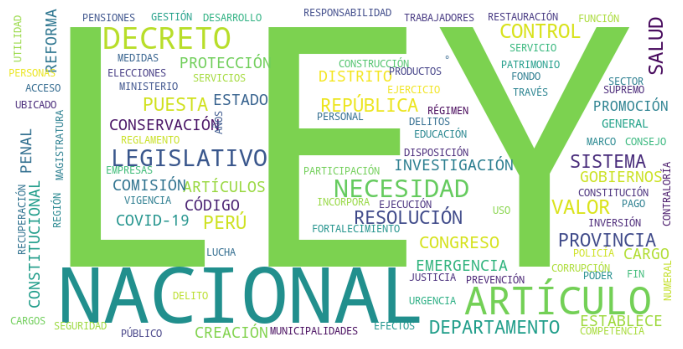

In [ ]:
show_wordcloud(Sus_Tit_Audi, save=True, img_name="WC_Sust_Titulo_Auditabilidad")

#### Verbos del título

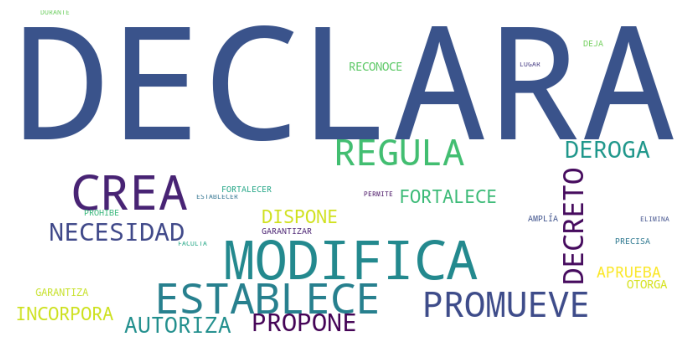

In [ ]:
show_wordcloud(Verb_Tit_Audi, save=True, img_name="WC_Verb_Titulo_Auditabilidad")

#### Adjetivos del título

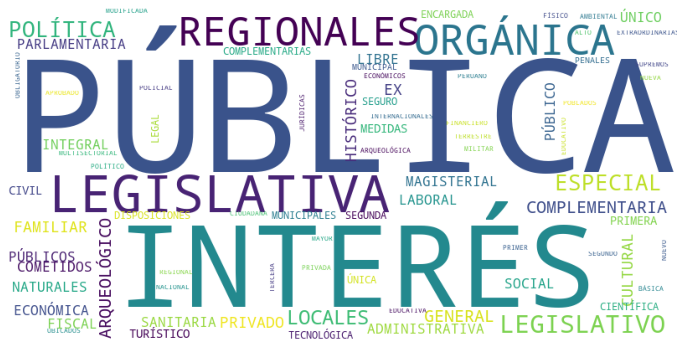

In [ ]:
show_wordcloud(Adj_Tit_Audi, save=True, img_name="WC_Adj_Titulo_Auditabilidad")

#### Sustantivos del Objeto

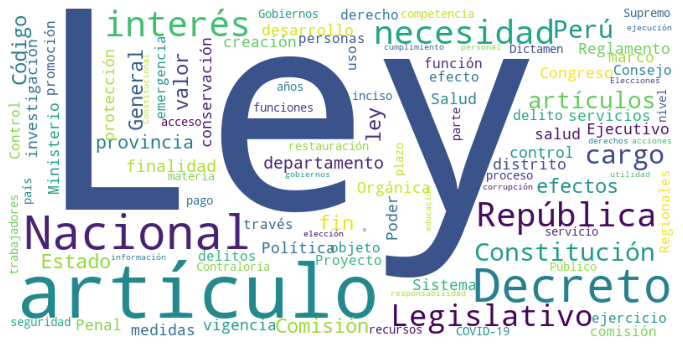

In [ ]:
show_wordcloud(Sus_Obj_Audi, save=True, img_name="WC_Sust_Objeto_Auditabilidad")

#### Verbos del Objeto

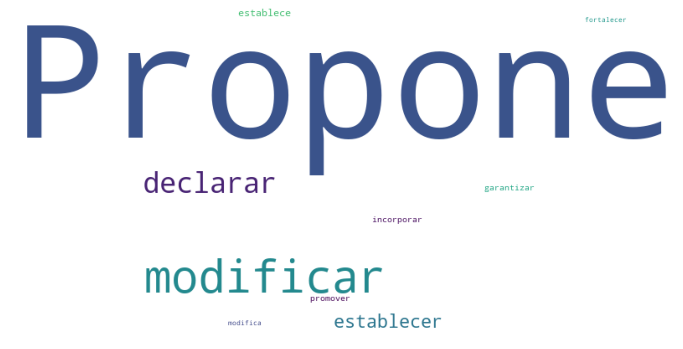

In [ ]:
show_wordcloud(Verb_Obj_Audi, save=True, img_name="WC_Verb_Objeto_Auditabilidad")

#### Adjetivos del Objeto

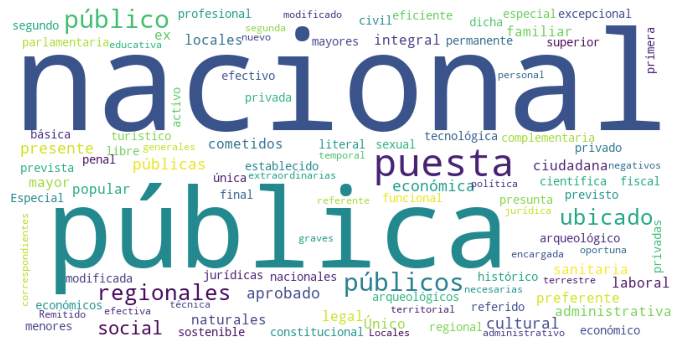

In [ ]:
show_wordcloud(Adj_Obj_Audi, save=True, img_name="WC_Adj_Objeto_Auditabilidad")

## TOPICO 3: INFORMATIVIDAD

### 1. POS-Tagging usando spacy

In [ ]:
TitulosInformatividad,ObjetosInformatividad = PosTagging(Informatividad)

### 2. NER usando spacy

In [ ]:
NER(Informatividad)

Título:  LEY DE REFORMA CONSTITUCIONAL QUE RECONOCE COMO SUJETOS DE DERECHO A LOS RÍOS AMAZÓNICOS, ESTABLECE UN SISTEMA ESPECIAL DE PROTECCIÓ Y CONSERVACIÓN INTEGRAL POR SUS ESPECIALES CONDICIONES
NER Título: 


Objeto:  Propone reconocer a los ríos de la Amazonía como sujeto y titulares de derecho debido al valor intrínseco que tienen y la importancia que detenta con respecto al medio ambiente y ecosistemas del Perú, a fin de garantizar su protección especial.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTICULO 75 DE LA LEY N° 29338, LEY DE RECURSOS HÍDRICOS Y QUE DECLARA COMO ""ZONA DE RESERVA INTANGIBLE Y DE CONSERVACIÓN INTEGRAL LA PROTECCIÓN DE LAS CABECERAS DE CUENCAS HIDROGRÁFICAS""
NER Título: 


Objeto:  Propone declarar ""Zona reserva intangible y de conservación integral, protección y promoción a las cabeceras de cuencas hidrográficas.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN E IMPLEMENTACIÓN DE UN HOSPITAL CON CATEGORÍA III-1 EN LA PROVINCIA DE HUAYTARA EN EL DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción e implementación de un hospital con categoría III - 1 en la ciudad de Huaytará en la provincia de Huaytará en el departamento de Huancavelica, para garantizar la adecuada atención del servicio de salud pública, bajo criterios de seguridad, oportunidad y calidad
NER Objeto: 


Título:  LEY QUE PROPONE SE DECLARE DE INTERÉS NACIONAL Y PREFERENTE NECESIDAD PÚBLICO LA REORGANIZACIÓN GEOGRÁFICA - TERRITORIAL URBANA DE LA PROVINCIA DE SAN ROMÁN EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y preferente necesidad pública la reorganización geográfica - territorial urbana de la provincia de San Román en el departamento de Puno, a fin de lograr un adecuado desarrollo urbano con la creación de distritos adicionales al distrito San Miguel, acorde a su distribución especial y crecimiento poblacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 31041 LEY DE URGENCIA MÉDICA PARA LA DETERCCIÓN OPORTUNA Y ATENCIÓN INTEGRAL DEL CÁNCER DEL NIÑO Y ADOLESCENTES
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 31041 Ley de Urgencia Médica para la detención oportuna y atención integral del cáncer del niño y del adolescente.
NER Objeto: 


Título:  LEY QUE PROPONE SE DECLARE DE INTERÉS NACIONAL Y PREFERENTE NECESIDAD PÚBLICA LA CREACIÓN DE LA AUTORIDAD AUTÓNOMA PARA LA DESCONTAMINACIÓN Y EL DESARROLLO INTEGRAL DE LA CUENCA LLALLIMAYO EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  propone declarar de interés y preferente necesidad pública la creación de la autoridad autónoma para la descontaminación y el desarrollo integral de la cuenca Llallimayo en el departamento de Puno.
NER Objeto: 


Título:  LEY QUE BRINDA ATRIBUCIONES A LAS ASOCIACIONES DE PADRES DE FAMILIA Y COMITÉS DE AULA PARA LA PREVENCIÓN Y SEGUIMIENTO DE CASOS DE VIOLENCIA Y ACOSO ESCOLAR
NER Título: 


Objeto:  Propone brindar atribuciones a las asociaciones de padres de familia para prevenir y hacer seguimiento de los casos de acoso y violencia escolar, a fin de que, los estudiantes de las diferentes instituciones educativas públicas y privadas de educación básica regular y especial; Educación Técnica Productiva y Básica Alternativa, Puedan gozar de un desarrollo integral y armoniosos libres de acoso y violencia escolar.
NER Objeto: 


Título:  LEY QUE PLANTEA DE INTERÉS NACIONAL LA REPATRIACIÓN DE LOS RESTOS FAMILIARES DE JOSÉ GABRIEL CONDORCANQUI NOGUERA, TÚPAC AMARU
NER Título: 


Objeto:  Declárese de interés nacional y necesidad pública la repatriación de los restos de Fernando Túpac Amaru y de Juan Bautista Túpac Amaru, la construcción de un Mausoleo para honrar sus restos, así como la implementación de una comisión que realice el estudio histórico y la investigación científica del destino de la familia de José Gabriel Túpac Amaru, la que fuera perseguida, sacrificada y/o expatriada como consecuencia del levantamiento de José Gabriel Condorcanqui Noguera llamado igualmente José Gabriel Túpac Amaru, conocido posteriormente como Túpac Amaru II o simplemente Túpac Amaru y sus esposa Micaela Bastidas Puyuccahua.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1260, LEY QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGUILA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ
NER Título: 


Objeto:  La presente norma tiene por objeto restituir la autonomía y personería jurídica del Cuerpo General de Bomberos Voluntarios del Perú, como la autoridad competente en materia de prevención, control y extinción de incendios, está conformado por los bomberos voluntarios en actividad, los bomberos asimilados y los bomberos en situación de retiro, que prestan servicio público de manera voluntaria y ad honorem.
NER Objeto: 


Título:  LEY QUE EXCLUYE A LOS TRABAJADORES JURISDICCIONALES Y ADMINISTRATIVOS DEL RÉGIMEN DEL SERVICIO CIVIL
NER Título: 


Objeto:  La presente ley tiene por objeto que los trabajadores jurisdiccionales y administrativos del Poder Judicial, con exclusión de los jueces, deben regirse por el régimen laboral de la actividad privada y están exentos de los alcances de la Ley 30057, Ley del Servicio Civil.
NER Objeto: 


Título:  LEY QUE MODIFICA LA VIGÉSIMA CUARTA DISPOSICIÓN COMPLEMENTARIA, TRANSITORIA Y FINAL DE LA LEY 29944, LEY DE REFORMA MAGISTERIAL.
NER Título: 


Objeto:  La presente Ley tiene por objeto modificar la Vigésima Cuarta Disposición Complementaria, Transitoria y Final de la Ley 29944, Ley de Reforma Magisterial; a fin de que se suspenda la implementación de la evaluación de desempeño docente.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 06, 20, 21, 22, 25, 68Y 69 DE LA LEY Nº 28036, LEY DE PROMOCIÓN Y DESARROLLO DEL DEPORTE PARA OTORGAR BECAS DE POSGRADO A DEPORTISTAS CALIFICADOS DE ALTO NIVEL PARA DIRIGENCIA SOSTENIBLE DEL SISTEMA INTEGRAL DEPORTIVO NACIONAL
NER Título: 


Objeto:  La presente Ley tiene por objeto modificar los artículos 06, 20, 21, 22, 25, 68 y 69 de la Ley Nº 28036, Ley de promoción y Desarrollo del Deporte a fin de otorgar becas de posgrado a deportistas calificados y calificados de alto nivel asegurando la dirigencia sostenible del sistema integral deportivo nacional.
NER Objeto: 


Título:  LEY QUE COMPLEMENTA LOS ALCANCES DE LA LEY 28099 Y SUS MODIFICATORIAS, FACULTANDO LA VENTA DIRECTA A FAVOR DE TERCEROS CON FINES DE DESARROLLO URBANO DE PREDIOS PROPIEDAD DE LA MUNICIPALIDAD DISTRITAL DE MAJES PROVINCIA DE CAYLLOMA DEPARTAMENTO DE AREQUIPA DENTRO DE PROGRAMAS MUNICIPALES DE VIVIENDA Y/O DE FORMALIZACIÓN DE ASENTAMIENTOS HUMANOS APROBADOS POR EL GOBIERNO LOCAL DE MAJES-AREQUIPA
NER Título: 


Objeto:  Propone facultar a la Municipalidad distrital de Majes, la venta directa de los predios de dominio privado de su propiedad que le fueron transferidos mediante la Ley 28099-modificada por las leyes 28466 y 28630, sólo con fines de desarrollo urbano a favor de terceros y dentro de los alcances de los Programas Municipales de Vivienda y/o Programas de Formalización de Asentamientos Humanos, predios destinados a viviendas tipo huerta, conforme lo faculta la Ley Orgánica de Municipalidades.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO N° 1153 E INCORPORA AL ARTICULO 8° LA DENOMINACION BONIFICACIÓN POR PUESTO ESPECIALIZADO O DE DEDICACIÓN EXCLUSIVA EN SERVICIOS DE SALUD PÚBLICA POR EL APOYO DEL PERSONAL TÉCNICO Y AUXILIAR ASISTENCIAL DE SALUD
NER Título: 


Objeto:  Propone incorporar el literal f) en el numeral 8.2 del artículo 8 del Decreto Legislativo 1153. Decreto que regula la política integral de compensaciones y entregas económicas de personal de la salud al servicio del Estado, referido a la bonificación en el puesto de salud pública por las labores de apoyo del personal técnico o auxiliar asistencial de salud.
NER Objeto: 


Título:  LEY QUE MOFICICA EL ARTICULO 12 E INCORPORA EL TÍTULO VII DE EDUCACIÓN, EVALUACIÓN Y BENEFICIOS EN LA LEY 29108, LEY DE ASCENSOS DE OFICIALES DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone modificar el artículo  12 e incorporar el Título VII, referido a Educación, Evaluación y Beneficios en la Ley 29108, Ley de ascensos de Oficiales de las Fuerzas Armadas, con la finalidad de mejorar la formación de los oficiales de las fuerzas armadas; promoviendo el aprendizaje de nuevos conocimientos especializados, competencias y capacidades como condiciones de calificación en su hoja de vida con mira al proceso de ascenso; garantizándose una línea de carrera profesional que permita seleccionar y promover a los oficiales más idóneos, sobre la base del mérito, competencia, imparcialidad y transparencia, en estricto cumplimiento al Principio de Igualda
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DENOMINACIÓN ADECUADA DE LOS PROFESIONALES DE LA SALUD QUE BRINDAN ATENCIÓN A LA MUJER EN SALUD REPRODUCTIVA Y PROHIBE LA INDEBIDA UTILIZACIÓN DE TÉRMINOS QUE SE PRESTAN A CONFUSIÓN Y PONER EN RIESGO LA SALUD
NER Título: 


Objeto:  Propone garantizar los derechos a la salud y a la vida de la mujer y de los usuarios al establecer la adecuada denominación de los profesionales de la salud que atienden la salud reproductiva de la mujer, en concordancia con su formación y competencia profesional; y evitar la intrusión en la profesión del médico cirujano.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY DEL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES PARA OTORGARLE MEJORES OPCIONES A LOS AFILIADOS RESPECTO A LA INVERSIÓN DE SUS FONDOS DE PENSIONES POR PARTE DE LAS AFP
NER Título: 


Objeto:  Propone modificar los artículos 18-A y 25-D del Texto Único Ordenado del Sistema Privado de Administración de Fondos de Pensiones (SPP), aprobado por el Decreto Supremo 054-97-EF, a efectos de mejorar la administración de los fondos de pensiones del SPP, promoviendo una mayor diversificación de las inversiones realizadas por las Administradoras Privadas de Fondos de Pensiones (AFP) al flexibilizar el límite de inversión en el extranjero, que permita tener mejores beneficios y/o retornos a los afiliados, en concordancia con el derecho a acceder a una pensión digna y decente previsto en la normatividad vigente y en la Constitución Política del Estado
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA PROMOVER EL CULTIVO, PRODUCCIÓN INDUSTRIALIZACIÓN, COMERCIALIZACIÓN Y EXPORTACIÓN DE MORINGA OLEIFERA PARA CONSUMO HUMANO
NER Título: 


Objeto:  Propone regular, formaliza y ordenar la producción, transformación, comercialización y exportación; así como el uso tradicional y moderno de la moringa oleífera, por las propiedades medicinales, industriales, agrícolas y nutricionales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE NORMA ACTIVIDADES DEL PERSONAL DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL EN ESTADO DE EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone regular, conforme lo estipulado en la presente Ley, las siguientes actividades del personal de las fuerzas armadas y policía nacional hasta el término del estado de emergencia sanitaria.
NER Objeto: 


Título:  LEY QUE ASEGURA EL OTORGAMIENTO Y LA CONTINUIDAD DE LA ASISTENCIA ECONÓMICA PARA CONTRIBUIR AL DESARROLLO INTEGRAL DE LAS NIÑAS, NIÑOS Y ADOLESCENTES CUYA MADRE, PADRE O AMBOS HAYAN FALLECIDO A CAUSA DE LA COVID-19, DURANTE LA EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone asegurar el otorgamiento y la continuidad de la asistencia económica para contribuir al desarrollo integral de las niñas, niños y adolescentes cuya madre, padre o ambos hayan fallecido a causa de la COVID-19 durante la Emergencia Sanitaria declarada mediante Decreto Supremo 008-2020-SA y sus prórrogas, implementada a través del artículo 8 del Decreto de Urgencia 020-2021, Decreto de Urgencia que dicta medidas extraordinarias en materia económica y financiera vinculadas a los recursos humanos en salud como respuesta ente la emergencia sanitaria por la COVID-19 y dicta otras disposiciones.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA DEMARCACIÓN DE LOS LIMITES TERRITORIAES ENTRE LOS DEPARTAMENTOS DE JUNÍN Y CUSCO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la demarcación de los límites territoriales entre los departamentos de Junín y Cusco, en concordancia con las normas vigentes.
NER Objeto: 


Título:  LEY QUE PROPONE LA IMPLEMENTACIÓN DE LA JUSTICIA ITINERANTE PARA LA ATENCIÓN DE CASOS DE VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone regular la implementación de la justicia itinerante para la atención de casos de violencia contra las mujeres y los integrantes del grupo familiar establecidos en la Ley 30364, promoviéndose una justicia célere, simplificada y accesible para las y los justiciables en los lugares más remotos y de escasos recursos económicos a fin de garantizarse el pleno ejercicio de sus derechos fundamentales en igualdad de condiciones y libre de discriminación.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL USO DE VEHÍCULOS ELÉCTRICOS
NER Título: 


Objeto:  La presente Ley tiene por objeto promover el uso de vehículos eléctricos mediante su exoneración del pago del Impuesto General a las Ventas (IGV) y el Impuesto al Patrimonio Vehicular por el período de 5 años contados a partir de la vigencia de la presente Ley.
NER Objeto: 


Título:  LEY QUE DEROGA EL ARTÍCULO 6 QUE ESTABLECE EL INGRESO DE PROFESORES DEL MINISTERIO DE DEFENSA A LA CARRERA PÚBLICA MAGISTERIAL DE LA LEY Nº 29944 DEL DECRETO DE URGENCIA Nº 016-2020
NER Título: 


Objeto:  La presente Ley tiene como objeto derogar el artículo 6 del Decreto de Urgencia 016-2020, que establece el ingreso de los profesores del Ministerio de Defensa a la Carrera Magisterial de la Ley 29944 de la Reforma Magisterial.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA SEGURIDAD ALIMENTARIA Y NUTRICIONAL EN CASO DE EMERGENCIAS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública garantizar la seguridad alimentaria y nutricional en caso de Emergencias con énfasis en poblaciones vulnerables.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEY 25872, POR EL QUE SE DECLARA LA PREVALENCIA DE LOS DECRETOS SUPREMOS QUE DISPUSIERON LA SUSPENSION O LIMITACION DE LOS SISTEMAS DE REAJUSTES DE REMUNERACIONES EN FUNCION A INDICES DE INFLACIÓN O MECANISMOS SIMILARES
NER Título: 


Objeto:  Propone derogar el Decreto Ley 25872, Decreto Ley que declara la prevalencia de los decretos supremos que dispusieron la suspensión o limitación de los sistemas de reajustes de remuneraciones en función a inflación o mecanismos similares.
NER Objeto: 


Título:  LEY QUE DECLARA OFICIALES E INTANGIBLES LOS SÍMBOLOS Y EMBLEMAS DEL PERÚ
NER Título: 


Objeto:  Propone establecer los símbolos y emblemas del Perú, la intangibilidad de forma y la estandarización sus denominaciones. En cumplimiento del mandato contenido en el Artículo 49 de la Constitución Política del Perú, son establecidos en la presente Ley, en concordancia con lo dispuesto por la Ley del 25 de febrero de 1825, Ley de creación del Escudo Nacional, y del Pabellón y Bandera Nacional, y por el Decreto Ley 11323, Disposiciones sobre los Símbolos de la Patria, Símbolos del Estado y Emblemas Nacionales.
NER Objeto: 


Título:  LEY DE ACTUALIZACIÓN Y SIMPLIFICACIÓN DE PROCEDIMIENTOS PARA LA INDUSTRIA DE HIDROCARBUROS
NER Título: 


Objeto:  Propone promover la reactivación sostenible de la exploración y explotación de hidrocarburos a nivel nacional, empleamdo medidas de simplificación administrativa, así como actualizar y mejorar el marco normativo, a fin de fomentar el desarrollo de las actividades de exploración y explotación de hidrocarburos de manera responsable con el medio ambiente, mediante la modificación de la Ley 26221, Ley Orgánica de Hidrocarburos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERES NACIONAL EL PROYECTO INTEGRAL ""MEJORAMIENTO Y AMPLIACIÓN DEL SISTEMA DE AGUA POTABLE Y ALCANTARILLADOS DE LA CIUDAD DE YURIMAGUA EN LA PROVINCIA DE ALTO AMAZONAS, DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el proyecto integral ""Mejoramiento y ampliación del Sistema de Agua Potable y Alcantarillados de la Ciudad de Yurimaguas en la provincia de Alto Amazonas, departamento de Loreto.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL TRATADO INTEGRAL Y PROGRESISTA DE ASOCIACIÓN TRANSPACÍFICO Y LAS CARTAS CON AUSTRALIA, CANADÁ, MALASIA, NUENA ZELANDA Y VIETNAM
NER Título: 


Objeto:  Propone el Tratado Integral y Progresista de Asociación Transpacífico, firmado el 8 de marzo de 2018 en Santiago, Chile y las Cartas con Australia que reafirman los acuerdos relativos a productos distintivos y terminación del Acuerdo sobre Promoción Recíproca de Inversiones; las Cartas con Canadá sobre industrias culturales; las Cartas con Malasia sobre servicios electrónicos de tarjetas de pago; las Cartas con Malasia sobre no recurso a solución de controversias por la medida disconforme en empresas de propiedad del Estado; las Cartas con Nueva Zelanda sobre el mecanismo de solución de controversias inversionista - Estado; las Cartas con Vietnam sobre servicios electrónicos de tarjetas de pago; las Cartas con Vietnam sobre comercio electrónico; las Cartas con Vietnam relativas al capítulo laboral, y las Cartas con Vietnam sobre productos químicos agrícolas, firmadas el 8 de marzo de 2018 en Santiago, Chile
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL ACUERDO ENTRE EL GOBIERNO DE LA REPÚBLICA DEL PERÚ Y EL GOBIERNO DE LA FEDERACIÓN DE RUSIA SOBRE LA PROTECCIÓN MUTUA DE LA INFORMACIÓN CLASIFICADA EN EL ÁMBITO DE LA COOPERACIÓN TÉCNICO - MILITAR
NER Título: 


Objeto:  Propone el Acuerdo entre el Gobierno de la República del Perú y el Gobierno de la Federación de Rusia sobre la Protección Mutua de la Información Clasificada en el ámbito de la Cooperación Técnico - Militar, suscrito el 17 de enero de 2017 en la ciudad de Lima, República del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA DECLARATORIA DE EMERGENCIA AMBIENTAL DEL RÍO CHILLÓN
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública la declaratoria de Emergencia Ambiental del Río Chillón, por ser un área de grave contaminación ambiental, ocasionando un problema de salud pública como consecuencia de la contaminación del aire y el agua, constituyendo un peligro real para la salud de la población, conforme lo establece la Ley 28804, Ley que Regula la Declaratoria de Emergencia Ambiental.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL DESARROLLO DE CIUDADES INTELIGENTES Y EDUCADORAS EN EL PERÚ
NER Título: 


Objeto:  Propone promover el desarrollo de ciudades inteligentes y educadores en el Perú a través del uso de las tecnologías de la información y comunicación, priorizando la educación como herramienta de transformación social situándola como eje centro del proyecto de ciudad.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA ELABORACIÓN DEL PLAN ESTRATÉGICO DE DESARROLLO HIDRÁULICO INTEGRAL DE LA REGIÓN DE TUMBES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional, la elaboración del Plan Estratégico de desarrollo Hidráulico Integral de la región de Tumbes.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL TRANSPARENCIA, ACCESO A LA INFORMACIÓN PÚBLICA Y PROTECCIÓN DE DATOS PERSONALES
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Transparencia, Acceso a la Información Pública y Protección de Datos Personales (en adelante, la Autoridad) como ente rector en materia de transparencia, acceso a la información pública y protección de datos personales.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IMPLEMENTACIÓN Y ACONDICIONAMIENTO DE CASAS HOGAR PUBLICAS PARA ADULTOS MAYORES A NIVEL NACIONAL
NER Título: 


Objeto:  Propone crear e implementación de casas hogar para los adultos mayores en situación de vulnerabilidad, conforme lo estípula el artículo 9° de la Ley 30490, comprendiendo para ello a aquellos adultos que se encuentran en estado de abandono moral y material.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28090, LEY QUE REGULA EL CIERRE DE MINAS
NER Título: 


Objeto:  Propone modificar la Ley 28090, Ley que regula el Cierre de Minas, a fin de adecuar la norma a los cambios que se han producido luego de su emisión y a las competencias actuales que ejercen las entidades involucradas.
NER Objeto: 


Título:  LEY QUE DISPONE QUE LOS MIEMBROS DE LA FUERZAS ARMADAS Y POLICIALES, PROCESADOS O CONDENADOS POR DELITO COMUNES, CUMPLAN  DETENCIÓN EN CENTROS DE RECLUSÍON MILITARES O POLICIALES
NER Título: 


Objeto:  Propone establecer que los miembros de las Fuerzas Armadas y de la Policía Nacional del Perú, que hayan sido procesados o condenados por delitos comunes, cumplan su pena  restrictiva de la libertad en centros de reclusión militar o policial, según corresponda, a fin de preservar su vida e integridad.
NER Objeto: 


Título:  LEY QUE DETERMINA, COMO PENSIÓN MINIMA, LA EQUIVALENTE A UNA REMUNERACIÓN MINIMA VITAL PARA LOS PENSIONISTAS DEL SISTEMA NACIONAL DE PENCIONES
NER Título: 


Objeto:  Propone determinar la pasión mínima, que corresponda a una Remuneración Mínima Vital (RMV), para todos los pensionistas pertenecientes al Sistema Nacional de Pensiones, que es administrada por la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL RECONOCIMIENTO DE LA EMERGENCIA ALIMENTARIA EN EL PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional que el Estado peruano reconozca la Emergencia Alimentaria en el Perú y autorice mecanismos de respuesta inmediata y temporal para enfrentar la emergencia, fortaleciendo la Agricultura familiar, las Ollas Comunes y otras iniciativas ciudadanas de respuestas autoorganizada, que buscan garantizar el acceso a alimentos de la población en situación de inseguridad alimentaria en el país.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LOS CUIDADOS PALIATIVOS Y EL CONTROL DEL DOLOR EN EL TRATAMIENTO INTEGRAL DEL CÁNCER
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública los cuidados paliativos y el control del dolor en el tratamiento integral del cáncer.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL REGISTRO NACIONAL DIGITAL Y EL OBSERVATORIO NACIONAL CONTRA EL TRABAJO FORZOSO Y LA TRATA DE PERSONAS
NER Título: 


Objeto:  Propone implementar el Registro Nacional Digital contra el Trabajo Forzoso y la Trata de Personas, a fin de generar información y conocimiento virtual para el seguimiento y mejorar de las políticas públicas en matería trabajo forzoso y la trata de personas, priorizando de forma especial a las personas y grupos que se encuentran en condición de mayor vulnerabilidad: niños, adolescentes, Personas con discapacidad, miembro de comunidades campesinas u originarios, entre otros.
NER Objeto: 


Título:  LEY QUE PROPONE PRIORIZAR EL OTORGAMIENTO DE BECAS DE ESTUDIO A FAVOR DE LAS MUJERES VÍCTIMAS DE VIOLENCIA Y DE LAS HIJAS E HIJOS DE LAS VÍCTIMAS DE FEMINICIDIO QUE QUEDARON EN ORFANDAD
NER Título: 


Objeto:  Propone priorizar el otorgamiento de beca de estudio para las víctimas y sobrevivientes de la violencia contra las mujeres, y las hijas e hijos de las víctimas de feminicidio que quedaron en orfandad, como una medida afirmativa con un enfoque integrador y de reparación por parte del Estado para garantizar el acceso de las víctimas de la violencia a la que se refiere la Ley 30364, a la educación en condiciones de igualdad de oportunidades y libre de discriminación.
NER Objeto: 


Título:  LEY DEL TRABAJO PORTUARIO MARÍTIMO Y FLUVIAL
NER Título: 


Objeto:  Propone regular el trabajo de movilización de carga que se efectúa en los terminales portuarios marítimos y fluviales de uso público de la República, la relación laboral entre los trabajadores portuarios y sus empleados, así como garantizar el cabal cumplimiento de los derechos remunerativos y previsionales.
NER Objeto: 


Título:  LEY DEL SERVICIO DE SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone establecer el marco normativo que regula al serenazgo municipal como parte del servicio de seguridad ciudadana que prestan las municipalidades, regulando actividades que contribuyan a la prevención social de la violencia, los delitos y las faltas, a efectos de promover la convivencia pacífica y la cohesión social e impactar positivamente en el desarrollo humano de los miembros de la comunidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PROTECCIÓN INTEGRAL DE NIÑOS Y NIÑAS HUÉFENOS DEL COVID-19
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la protección integral de los niños y niñas menores de edad que han quedado huérfanos de padre y madre a consecuencia del Covid-19.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN DEL PUENTE CARROZABLE ENTRE LAS LOCALIDADES DE SAN ANTONIO (AYACUCHO) Y VILLA KINTIARINA (CUSCO)
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción del puente carrozable entre los distritos de San Antonio (Ayacucho) y Villa Kintiarina Alta (Cusco) afín de afianzar la conectividad e integración entre los pueblos del VRAEM.
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO HUAYCÁN EN LA PROVINCIA Y DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone crear el distrito Huaycán, con su capital Huaycán, en la provincia y departamento de Lima (Proyecto actualizado por acuerdo del Consejo Directivo número anterior 5118/2015-PE)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA INCLUSIÓN, MEJORAMIENTO Y PROMOCIÓN DE LOS SERVICIOS TURISTICOS DEL VALLE DEL MONZÓN Y LA PROVINCIA DE LEONCIO PRADO
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la inclusión, mejoramiento y promoción de los servicios turístico del Valle del Monzón y la provincia de Leoncio Prado, en concordancia con la Ley 29408, Ley General de Turismo.
NER Objeto: 


Título:  LEY QUE MODIFICA LEY NÚM. 28705, LEY GENERAL PARA LA PREVENCIÓN Y CONTROL DE LOS RIESGOS DEL CONSUMO DEL TABACO, EN CONCORDANCIA CON EL CONVENIO MARCO DE LA ORGANIZACIÓN MUNDIAL DE LA SALUD PARA EL CONTROL DEL TABACO
NER Título: 


Objeto:  Propone modificar la Ley núm. 28705, Ley general para la prevención y control de los riesgos del consumo del tabaco, en concordancia con el convenio marco de la organización mundial de la salud para el control del tabaco.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26859 PARA GARANTIZAR EL ACCESO A LA INFORMACIÓN ELECTORAL EN CONDICIONES DE IGUALDAD
NER Título: 


Objeto:  Propone reducir a un plazo razonable el periodo de prohibición de publicar encuestas antes de elecciones, de modo que se tutele el derecho a la información de la ciudadanía en su conjunto en el marco de proceso electorales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CREACIÓN DE LA PROVINCIA DE YARINACOCHA, EN EL DEPARTAMENTO DE UCAYALI
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la creación de la provincia Yarinacocha nacida del territorio actual de la provincia de Coronel Portillo en el departamento de Ucayali.
NER Objeto: 


Título:  LEY QUE PROHIBE LA ALTERACIÓN DE LA GRAMÁTICA Y LINGÜISTICA Y ENFOQUE DE GENERO EN EL SISTEMA EDUCATIVO NACIONAL, EN ARAS DE GARANTIZAR EL CORRECTO USO DEL LENGUAJE, EN SALVAGUARDA DE LA INTEGRIDAD PSICOLÓGICA DE LA NIÑEZ
NER Título: 


Objeto:  Propone prohibir la alteracion de la gramática y lingüistica y enfoque de género en el sistema educativo nacional, en aras de garantizar el correcto uso del lenguaje, en salvaguarda de la integridad psicologica de la niñez.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE EL FORTALECIMIENTO DEL SECTOR SALUD Y DICTA MEDIDADS COMPLEMENTARIAS INTEGRALES EN EL CAMPO DEL RECUARSO HUMANOS Y MEJORA DE ATENCIÓN EN EL MARCO DE LA EMEMRGENCIA SANITARIA POR COVID-19
NER Título: 


Objeto:  Peopone promuever el fortalecimiento del sector salud y dicta medidas complementarias integrales en el campo del recurso humano y mejora de atención en el marco de la emergencia sanitaria por COVID - 19
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO AL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA (REJA) PARA LOS HOMBRES, EN IGUALDAD DE DERECHOS QUE LAS MUJERES
NER Título: 


Objeto:  Propone modificar la Ley 30939, ""Ley que establece el régimen especial de jubilación anticipada para desempleados en el sistema privado de pensiones"", a fin de otorgar iguales derechos a hombres y mujeres, al momento de solicitar la jubilación anticipada.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL MEJORAMIENTO, AMPLIACIÓN DE LA GESTIÓN INTEGRAL DEL SERVICIO DE AGUA POTABLE Y ALCANTARILLADO EN EL DISTRITO DE TARATA, PROVINCIA DE TARATA, TACNA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el mejoramiento, ampliación de la gestión integral del servicio de agua potable y alcantarillado en el distrito de Tarata, provincia de Tarata, Tacna. con la finalidad de mejorar la calidad de vida y de contribuir con el bienestar de la población.
NER Objeto: 


Título:  LEY QUE REGULA LA PRESCRIPCIÓN  ADQUISITIVA DE CONCESIÓN  MINERA PARA MINEROS INSCRITOS EN EL REGISTRO INTEGRAL DE FORMALIZACIÓN MINERA - REINFO
NER Título: 


Objeto:  Propone regular la prescripción adquisitiva de concesión minera para mineros inscritos en el régimen integral de formalización minera - REINFO.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2, 3 Y 7 DEL DECRETO LEGISLATIVO 1260 QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGULA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ
NER Título: 


Objeto:  Propone modificar los articulos 2,3 y 7 del Decreto Legislativo 1260 que fortalece el Cuerpo Genaral de Bomberos Voluntarios del Perú como parte del Sistema de Seguridad Ciudadana y regula Intendencia Nacional de Bomberos del Perú.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA AQUISICIÓN, DISTRIBUCIÓN Y APLICACIÓN DE LA VACUNA DEL CORONAVIRUS SARS - COV-2, A LOS GOBIERNOS REGIONALES Y EMPRESAS PRIVADAS QUE PRESENTEN SERVICIOS DE SALUD Y AFINES, Y LA CREACIÓN DE UN REGISTRO ÚNICO DE VACUNACIÓN
NER Título: 


Objeto:  Propone autorizar la adquisición, distribución y aplicación de la vacuna del Coronavirus SARS - COV-2, a los Gobiernos Regionales y empresas privadas que presenten servicios de salud y afines, y la creacion de un registro único de vacunación.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 179 DE LA CONSTITUCIÓN DE 1993 PARA GARANTIZAR EL PLENO DERECHO DE REPRESENTATIVIDAD E IGUALDAD ENTRE ABOGADOS ANTE EL JURADO NACIONA LDE ELECCIONES
NER Título: 


Objeto:  Propone modificar el inciso 3 del artículo 179 de la Constitución Politica de 1993.
NER Objeto: 


Título:  LEY QUE FOMENTO DE NUEVAS MASCULINIDADES PARA LA IGUALDAD DE GÉNERO
NER Título: 


Objeto:  Propone fomentar la nueva masculinidad para la igualdad de género
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 29973, LEY GENERAL DE LA PERSONAS CON DISCAPACIDAD, PARA PRECISAR LAS FUNCIONES DEL CONSEJO NACIONAL PARA LA INTEGRACIÓN DE LA PERSONA CON DISCAPACIDAD -CONADIS, LA COMPOSICIÓN Y ATRIBUCIONES DEL ENTE RECTOR DEL SINAPEDIS, ASÍ COMO LA GESTIÓN DE LA INFORMACIÓN EN DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar la Ley 29973, Ley General de la Persona con Discapacidad, para precisar la funciones del Consejo Nacional para la Integración de la Persona con Discapacidad - CONADIS, la composición y atribuciones del ente rector del Sinapedis, así como la gestión de la información en discapacidad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL ESTABLECER MEDIDAS EXTRAORDINARIA A FAVOR DE LOS PENSIONISTAS Y DE LOS BENEFICIARIOS DEL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS, POR MOTIVO DEL IMPACTO DE LA COVID-19 EN LA ECONOMIA PERUANA
NER Título: 


Objeto:  Propone declarar  de interés nacional establecer medida extraordinaria a favor de los pensionistas y de los beneficiarios del régimen especial de seguridad social para los trabajadores y pensionistas pesqueros, por motivo del impacto de la covid -19 en la economía peruana
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 29852 LEY QUE CREA EL SISTEMA DE SEGURIDAD ENERGÉTICA EN HIDROCARBUROS Y EL FONDO DE INCLUSIÓN SOCIAL ENERGÉTICO PARA GARANTIZAR LA COMPENSACIÓN SOCIAL DE LA TARIFA ELECTRÓNICA DE ZONAS ALTO ANDINAS
NER Título: 


Objeto:  Propone modificar la Ley 29852 Ley que crea el Sistema de Seguridad Energética en Hidrocarburos y el fondo de Inclusión Social Energético, para garantizar la compensación social de la tarifa electrónica de zonas alto andinas
NER Objeto: 


Título:  LEY QUE PROPONE DECLARAR DE UTILIDAD Y NECESIDAD PÚBLICA LA HABILITACIÓN URBANA Y EL SANEAMIENTO FÍSICO LEGAL DEL PREDIO ""PAMPAS DE CONCON"" EN LA PROVINCIA DE CAÑETE, REGIÓN LIMA
NER Título: 


Objeto:  Propone declarar de utilidad y necesidad pública la habilitación urbana y el saneamiento físico legal del predio ""Pampas de Concon"" ubicado en la provincia de Cañete, región Lima, a fin de promover de manera integral el desarrollo urbano, proyectos de irrigación y garantizar la calidad de vida de los pobladores de la provincia de Cañete.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1,D E LA LEY 30597, LEY QUE DENOMINA UNIVERSIDAD NACIONAL DE MÚSICA AL CONSERVATORIO NACIONAL DE MÚSICA, UNIVERSIDAD NACIONAL DANIEL ALOMÍA ROBLES DE HUÁNUCO Y UNIVERSIDAD NACIONAL DIEGO QUISPE TITO A LA ESCUELA SUPERIOR AUTÓNOMA DE BELLAS ARTES DIEGO QUISPE TITO DEL CUSCO Y SOLAMENTE CUENTAN CON LAS CARRERAS PROFESIONALES Y ESPECIALIDADES QUE ACTUALMENTE OFERTAN
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 30597, y con ello preservar su identidad como centro de enseñanza superior dedicado a la música, labor reconocida desde hace 7 décadas en la región Huánuco.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN DE TERMINALES TERRESTRES EN LAS ZONAS PERIFÉRICAS DE LA CIUDAD DE HUÁNUCO
NER Título: 


Objeto:  Propone mejorar la calidad de vida de los pobladores del departamento de Huánuco, garantizándoles seguridad y mejores condiciones en los servicios de transportes, para transitar en el territorio nacional.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL INGRESO DE JÓVENES A LA ADMINISTRACIÓN PÚBLICA ""LEY PRO JOVEN""
NER Título: 


Objeto:  Propone promover el ingreso de jóvenes menores a veintinueve (29) años de edad a la administración pública teniendo como base los principios de meritocracia, de evaluación constante y de probidad y ´ética pública, a efectos de brindarles un empleo de calidad, capacitación permanente y plenitud de sus derechos laborales, alcanzando mayores niveles de eficacia y eficiencia en las entidades del Estado, así como fortaleciendo el desarrollo de las personas que lo integran, que posibiliten una atención oportuna, articulada y de calidad en favor de la ciudadanía.
NER Objeto: 


Título:  LEY QUE PROHIBE LA PUERTA GIRATORIA ENTRE EL SECTOR PÚBLICO Y PRIVADO Y VICEVERSA, MODIFICANDO LA LEY 27588, LEY QUE ESTABLECE PROHIBICIONES E INCOMPATIBILIDADES DE FUNCIONARIOS Y SERVIDORES PÚBLICOS, ASÍ COMO DE LAS PERSONAS QUE PRESTEN SERVICIOS AL ESTADO BAJO CUALQUIER MODALIDAD CONTRACTUAL
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 27588, ley que establece prohibiciones e incompatibilidades de funcionarios y servidores públicos, así como de las personas que presten servicios al Estado bajo cualquier modalidad contractual.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL FINANCIAMIENTO Y EJECUCIÓN DEL PROYECTO INTEGRAL DE MEJORAMIENTO Y AMPLIACIÓN DEL SERVICIO DE ABASTECIMIENTO DE AGUA POTABLE Y DESAGUE DE LA LOCALIDAD DE UCHIZA, DEL DISTRITO DE UCHIZA, PROVINCIA DE TOCACHE, DEPARTAMENTO DE SAN MARTÍN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el financiamiento y ejecución del proyecto integral de mejoramiento y ampliación del servicio de abastecimniento de agua potable y desague de la localidad de Uchiza, del distrito de Uchiza, provincia de Tocache, departamento de San Martín
NER Objeto: 


Título:  LEY QUE AUTORIZA EL PAGO EFECTIVO DE LA DEUDA SOCIAL DEL SECTOR EDUCACIÓN DEL DEPARTAMENTO DE LORETO MEDIANTE LOS RECURSOS DEL FIDEICOMISO POR SER POBLACIÓN VULNERABLE ANTE EL ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone garantizar el cumplimiento del pago de la deuda social del sector educación del departamento de Loreto establecido en el artículo 48 de la Ley 24029, Ley del Profesorado, modificado por el artículo 1 de la Ley 25212 y en concordancia con el artículo 210 del Decreto Supremo 019-90-ED, Reglamento de la Ley del Profesorado, con cargo a los fondos de la Ley 30897.Ley de Promoción de la Inversión y Desarrollo del departamento de Loreto.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS PÁRRAFOS 23.3 Y 23.5 DE LA LEY 28094, LEY DE ORGAN IZACIONES POLÍTICAS PARA INCLUIR INFORMACIÓN SOBRE INVESTIGACIONES FISCALES Y PROCESOS JUDICIALES DE CANDIDATOS A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar los párrafos 23.2. y 23.5 de la Ley 28094, Ley de Organizaciones Políticas referidos al contenido de la Declaración Jurada de Hoja de Vida que presentan los candidatos a cargos de elecciión popular, incorporando la obligación de informar sobre las investigaciones fiscales y procesos judiciales en desarrollo al momento de su inscripción.
NER Objeto: 


Título:  LEY QUE DISPONE LA COBERTURA DE PLAZAS VACANTES PRESUPUESTADAS Y/O PREVISTAS EN LAS DIFERENTES UNIDADES EJECUTORAS DEL SECTOR SALUD, A FIN DE ATENDER EL CAMBIO DE GRUPO OCUPACIONAL
NER Título: 


Objeto:  Propone ley tiene por objeto atender el cambio de grupo ocupacional de muchos trabajadores nombrados del sector salud que por muchos años vienen ejerciendo diferentes funciones de profesiones sin ostentar el cargo en sus correspondientes documentos de gestión, y que actualmente, vienen combatiendo el Covid 19
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA CREACIÓN DE LA JUNTA DE ESPECIALISTAS MÉDICOS DE LA SALUD, PARA IDENTIFICAR, DIAGNOSTICAR Y TRATAR A LAS PERSONAS CONTAGIADAS CON EL REBROTE DEL CORONAVIRUS COVID-19 Y OTRAS ENFERMEDADES INFECTO RESPIRATORIAS, EN TODOS LOS ESTABLECIMIENTOS DE SALUD DE NUESTRO PAÍS
NER Título: 


Objeto:  Propone promover y fortalecer la vida y la salud de la población, declarando de interés nacional la creación de la Junta Médica Especializada en Salud, para enfrentar la nueva cepa del rebrote del Coronavirus COVID-19 y otras enfermedades similares, en los establecimientos de salud de nuestro país.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27972 LEY ORGÁNICA DE MUNICIPALIDADES, RESPECTO DE LAS FUNCIONES ESPECÍFICAS COMPARTIDAS DE LAS MUNICIPALIDADES DISTRITALES RESPECTO A SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar la Ley 27972 Ley Orgánica de Municipalidades, respecto de las funciones específicas compartidas de las municipalidades distritales respecto a seguridad ciudadana.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 30003, LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 30003, Ley que regula el régimen especial de seguridad social para los trabajadores y pensionistas pesqueros.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE FACILITA AL CONTRALOR GENERAL SOLICITAR EL LEVANTAMIENTO DEL SECRETO BANCARIO Y DE LA RESERVA TRIBUTARIA Y BURSÁTIL EN EL MARCO DEL CONTROL GUBERNAMENTAL
NER Título: 


Objeto:  Propone modificar la Constitución y leyes relacionadas para otorgar la facultad al Contralor General a solicitar de manera directa a la entidad competente, el levantamiento del secreto bancario, y de la reserva tributaria y bursátil en el  marco del control gubernamental que ejerce la Contraloría General de la República, facilitando el acceso a información que permita alcanzar los resultados de las acciones de control garantizando la reserva del contenido.
NER Objeto: 


Título:  LEY DE EXTINCIÓN DE DEUDAS VINCULADAS AL PROGRAMA DE RESCATE FINANCIERO AGROPECUARIO-RFA CON MOTIVO DE LA GRAVE CRISIS SANITARIA COVID-19
NER Título: 


Objeto:  Propone extinguir la totalidad de las deudas vencidas del agricultor que se acogió a los beneficios del Programa de Rescate Financiero Agropecuario (RFA), programa creado mediante Decreto de Urgencia 059-2000, administrado por COFIDE.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS NUTRICIONISTAS EN LA DECLARATORIA DE EMERGENCIA DEL SISTEMA NACIONAL DE SALUD Y SU PROCESO DE REFORMA CONFORME A LA LEY 31125
NER Título: 


Objeto:  Propone incorporar a los nutricionistas en la Ley 31125, Ley que declara en emergencia el Sistema Nacional de Salud y regula su proceso de reforma, para fortalecer el sistema de salud, a través de la intervención del profesional de la salud nutricionista, por cuanto es el profesional de la salud con competencias debidamente desarrolladas para conducir las acciones y estrategias que permitan mejorar la nutrición y la alimentación de la población.
NER Objeto: 


Título:  LEY QUE PROPONE LA EXPULSIÓN INMEDIATA Y DEFINITIVA DE LOS EXTRANJEROS INDOCUMENTADOS O LOS QUE COMETAN DELITOS Y FALTAS GRAVES DENTRO DEL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone establecer la expulsión inmediata y definitiva de los extranjeros que no cuenten con pasaporte legal o los que cometan delitos o faltas graves dentro del territorio nacional, con la finalidad de contrarrestar la creciente inseguridad ciudadana,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DE PROYECTOS PILOTOS INTEGRALES DE FORESTACIÓN Y REFORESTACIÓN ANDINA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la ejecución de proyectos pilotos de forestación y reforestación integral región andina que permitan desarrollar nuevos espacios dedicados a la forestación y preservación de la reserva hídrica en el País.
NER Objeto: 


Título:  LEY QUE AMPLIA EL PLAZO DEL PROCESO DE FORMALIZACIÓN MINERA INTEGRAL Y MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 31007
NER Título: 


Objeto:  Propone ampliar el plazo del proceso de formalización minera integral establecido en la primera Disposición Complementaria Final de la Ley 31007, para permitir la atención prioritaria a las personas naturales y jurídicas que se encuentran del proceso de formalización minera.
NER Objeto: 


Título:  LEY QUE FACULTA AL EX TRABAJADOR MANTENER VIGENTE SU SEGURO DE ASISTENCIA MÉDICA CON TODOS SUS BENEFICIOS AL CESE DE LA RELACIÓN LABORAL
NER Título: 


Objeto:  Propone ley que faculta al ex trabajador mantener vigente su seguro de asistencia médica con todos sus beneficios al cese de la relación laboral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE AUXILIARES DE EDUCACIÓN, QUE ACTUALMENTE SE ENCUENTREN CONTRATADOS POR CONCURSO PÚBLICO EN LAS INSTITUCIONES PÚBLICAS DE EDUCACIÓN BÁSICA REGULAR Y ESPECIAL
NER Título: 


Objeto:  Propone autorizar al Ministerio de Educación la implementación el proceso de concurso público de nombramiento de auxiliares de educación para aquellos que actualmente se encuentran laborando en las instituciones educativas en las modalidades básica regular y especial.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DENOMINACIÓN ADECUADA DE LOS PROFESIONALES DE LA SALUD QUE BRINDAN ATENCIÓN A LA MUJER EN SALUD REPRODUCTIVA Y PROHIBE LA INDEBIDA UTILIZACIÓN DE TÉRMINOS QUE SE PRESTAN A CONFUSIÓN Y PONEN EN RIESGO LA SALUD
NER Título: 


Objeto:  Propone garantizar los derechos a la salud y a la vida de la mujer y de los usuarios al establece la adecuada denominación de los profesionales de la salud que atienden la salud reproductiva de la mujer, en concordancia con su formación y competencia profesional; y evitar la intrusión en la profesión del médico cirujano.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27674, SOBRE EL RÉGIMEN LABORAL Y SEGURIDAD SOCIAL DEL TRABAJADOR ACUICOLA
NER Título: 


Objeto:  Propone ley que modifica la Ley 27674, sobre el Régimen Laboral y Seguridad Social del trabajador acuicola.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL SEMBRÍO Y COSECHA DE AGUA EN LA CUENCA, SUBCUENCAS Y MICROCUENCAS DEL CALLEJÓN DE CONCHUCOS-CORDILLERA BLANCA, PROVINCIA ANTONIO RAYMONDI Y GARANTIZAR LA SEGURIDAD DEL ABASTECIMIENTO DEL RECURSO HÍDRICO PARA USO AGRÍCOLA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el sembrío y cosecha de agua en la cuenca, subcuencas y microcuencas del Callejón de Conchucios-perteneciente a la Cordillera Blanca, provincia Antonio Raymondi, y ser incorporadas al sistema hidrográfico de la región Áncash, mediante la ejecución de proyectos de inversión pública y garantizar la seguridad del abastecimiento del recurso hidríco para uso agrícola.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL SEMBRÍO Y COSECHA DE AGUA EN LAS CUENCAS, SUBCUENCAS Y MICROCUENCAS EN LA CORDILLERA NEGRA DE LA REGIÓN ANCASH, Y GARANTIZAR LA SEGURIDAD DEL ABASTECIMIENTO DEL RECURSO HÍDRICO PARA USO AGRÍCOLA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el sembrío y cosecha de agua en las cuencas, subcuencas y microcuencas en la Cordillera Negra de la región Áncash y garantizar la seguridad del abaastecimiento del recurso hídrico par5a uso agrícola.
NER Objeto: 


Título:  LEY QUE CREA UN RÉGIMEN DE SEGURIDAD SOCIAL DIFERENCIAL PARA TRABAJADORES VENDEDORES DE DIARIOS, REVISTAS Y AFINES
NER Título: 


Objeto:  Propone establecer un régimen de seguridad social especial para los trabajadores vendedores de diarios, revistas y afines, a fin de que puedan acceder a la cobertura de seguridad social en salud y pensión de jubilación, así como sus causahabientes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCENTIVA LA ENTREGA VOLUNTARIA DE ARMAS Y MUNICIONES
NER Título: 


Objeto:  Propone establecer medidas para promover la entrega voluntaria de armas ilegales e irregulares y municiones a efectos de fortalecer la seguridad ciudadana en el Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL  EMPODERAMIENTO DE LA MUJER A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la promoción del empoderamiento de la mujer a nivel nacional, con la finalidad de ejecutar planes de acción inmediatas de promoción, difusión, igualdad de oportunidades y de género sin discriminación, así como proveerle de herramientas que permitan su desarrollo económico, social, político, garantizando el ejercicio de sus derechos fundamentales como derecho humano.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA EL PROCESO DE INSCRIPCIÓN EN EL REGISTRO INTEGRAL DE FORMALIZACIÓN MINERA-REINFO
NER Título: 


Objeto:  Propone estableceer los requisitos para la inscripción en el proceso de inscripción en el Registro Integral de Formalización Minera-REINFO
NER Objeto: 


Título:  LEY QUE MODIFICA LA ESTRUCTURA Y LAS FUNCIONES DEL CONSEJO EJECUTIVO DEL PODER JUDICIAL BAJO LOS PRINCIPIOS DE DEMOCRACIA, MERITOGRACIA, PROBIDAD, EFICIENCIA Y TRANSPARENCIA
NER Título: 


Objeto:  Propone modificar los artículos 81 y 82 de la Ley Orgánica del Poder Judicial.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DE LA RESERVA DE SEGURIDAD ESTRATÉGICA EN SALUD A CARGO DEL MINISTERIO DE SALUD
NER Título: 


Objeto:  Propone declarar de interés nacional la Creación de la Reserva de Seguridad Estratégica en Salud a cargo del Ministerio de Salud.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA IGUALDAD DE DERECHOS PARA EL  ACCESO AL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA, Y MEJORA LA ECONOMÍA FAMILIAR DE LOS PERUANOS ANTE LA COVID-19
NER Título: 


Objeto:  Propone modificar la Ley 30939, Ley que establece el régimen especial de jubilación anticipada para desempleados en el sistema privado de pensiones, a fin de otorgar iguales derechos a hombres y mujeres, al momento de solicitar la jubilación anticipada.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 158 DEL CÓDIGO PENAL PARA EXCLUIR DE LA PERSECUCIÓN PRIVADA AL TIPO PENAL DESCRITO EN EL ARTÍCULO 154-B DIFUSIÓN DE IMÁGENES, MATERIALES AUDIOVISUALES O AUDIOS CON CONTENIDO SEXUAL.
NER Título: 


Objeto:  Propone modificar el artículo 158 del Código Penal a fin de  excluir de la acción privada al artículo 154-B y de esa manera permitir que el titular de la acción penal pueda ejercer funciones sin excepciones para el delito previsto en el artículo 154-B y no solo por acción privada como actualmente señala la norma.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS VOLUNTARIOS PARTICIPANTES EN LOS ENSAYOS CLÍNICOS DE LA VACUNA SARS COV 2, EN LA FASE I DE VACUNACIÓN
NER Título: 


Objeto:  Propone incorporar a los voluntarios participantes en los ensayos clínicos de la vacuna SARS Cov 2 en la fase 1 de vacunación, como reconocimiento a su participación en la búsqueda de evidencia científica sobre eficacia y seguridad de la vacuna.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 032-2020 ""DECRETO DE URGENCIA QUE DICTA MEDIDAS EXTRAORDINARIAS DESTINADAS A GARANTIZAR LA RESPUESTA SANITARIA PARA LA ATENCIÓN DE LA EMERGENCIA PRODUCTIVA POR EL COVID-19""
NER Título: 


Objeto:  Propone derogar en su totalidad el Decreto de Urgencia 032-2020 ""Decreto de Urgencia que dicta medidas extraordinarias destinadas a garantizar la respuesta sanitaria para la atención de la emergencia producida por el Covid-19"".
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IMPLEMENTACIÓN PROGRESIVA DE LA FORMACIÓN TÉCNICO-PRODUCTIVA EN LAS INSTITUCIONES EDUCATIVAS DE EDUCACIÓN SECUNDARIA EN PROVINCIAS Y DISTRITOS CON MAYOR POBLACIÓN ESCOLAR
NER Título: 


Objeto:  Propone implementar de manera progresiva la formación técnico-productiva en las instituciones educativas públicas de nivel secundaria de educación básica regular en provincias y distritos con mayor población escolar a fin de que los estudiantes desarrollen una formación integral con mejores oportunidades de empleabilidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE IGUALES REQUISITOS PARA HOMBRES Y MUJERES EN EL ACCESO A LA PENSIÓN DE VIUDEZ ESTABLECIDA EN EL DECRETO LEY 19990
NER Título: 


Objeto:  Propone ley que establece iguales requisitos para hombres y mujeres en el acceso a la pensión de viudez establecida en el Decreto Ley 19990.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE MARCABAL GRANDE, EN LA PROVINCIA DE SÁNCHEZ CARRIÓN, REGIÓN LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del distrito Marcabal Grande, ubicado en la  provincia de Sánchez Carrión, región La Libertad.
NER Objeto: 


Título:  LEY QUE INCORPORA LOS ARTÍCULOS 382-A, 384-A Y 399-A AL CÓDIGO PENAL Y VIGILA LA INTEGRIDAD EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone ley que incorpora los artículos 382-A, 384-A y 399-A al Código Penal y vigila la integridad en la administración pública.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA COBERTURA DE UN SEGURO DE SALUD PÚBLICO PARA TODOS LOS TRABAJADORES INDEPENDIENTES QUE REALIZAN ACTIVIDADES EN EL RUBRO TAXI Y MOTOTAXI
NER Título: 


Objeto:  Propone ley que promueve la cobertura de un seguro de salud público sin costo, para todos los trabajadores independientes que realizan actividades en el rubro taxi y mototaxi, como parte del Seguro Integral de Salud (SIS).
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL, EL SEMBRÍO Y COSECHA DE AGUA EN LA CUENCA, SUBCUENCAS Y MICROCUENCAS DEL VALLE DEL RÍO CASMA/SECHÍN.REGIÓN ÁNCASH, Y GARANTIZAR LA SEGURIDAD DEL ABASTECIMIENTO DEL RECURSO HÍDRICO PARA USO AGRÍCOLA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el sembrío y cosecha de agua en la cuenca, subcuencas y microcuencas en el Valle del río Casma/Sechín y ser incorporadas al sistema hidrográfico de la región Áncash.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CONSTRUCCIÓN DE UNA NUEVA SEDE DE LA UNIVERSIDAD NACIONAL DIEGO QUISPE TITO EN EL DEPARTAMENTO DE CUSCO Y LA CREACIÓN DE UN MUSEO EN EL PALACIO DE LOS MARQUESES SAN LORENZO DE VALLEUMBROSO, ACTUAL SEDE DE LA CASA DE ESTYUDIO SUPERIOR EN MENCIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional la construcción de una nueva sede de la Universidad Nacional Diego Quispe Tito en el departamento de Cusco y la creación de un Museo en el Palacio de los Marqueses San Lorenzo de Valleumbroso.
NER Objeto: 


Título:  LEY DE ATENCIÓN INTEGRAL DE ENFERMEDADES ONCOLÓGICAS EN PERSONAS ADULTAS MAYORES REGISTRADAS EN EL SISFOH
NER Título: 


Objeto:  Propone garantizar la detección temprada, oportuna y la atención integral de calidad en personas adultas mayores, de escasos recursos económicos que permitan disminuir de manera significativa la tasa de diagnóstico de cáncer tardío, abandono de tratamiento y morbimortalidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY Nº 26574, LEY DE NACIONALIDAD, A FIN DE REGULAR LA RECUPERACIÓN DE LA NACIONALIDAD PERUANA
NER Título: 


Objeto:  La presente Ley tiene por objeto regular el procedimiento de recuperación de la nacionalidad peruana, modificando para tal efecto el artículo 8 de la Ley 26754, Ley de Nacionalidad.
NER Objeto: 


Título:  LEY QUE FACULTA LA INTERVENCIÓN DEL MINSA PARA LA TOMA DE ACCIONES DE GESTIÓN DEL SISTEMA DE SALUD EN REGIONES, DE ÁMBITO REGIONAL, ANTE UNA DECLARACIÓN DE ESTADO DE EMERGENCIA SANITARIA A CAUSA DE PANDEMIA O EPIDEMIA CON UN FACTOR DE CONTAGIO R IGUAL O MAYOR A 1
NER Título: 


Objeto:  Propone dar facultades al Ministerio de Salud, para intervenir en la toma de acciones en materia presupuestal, administración y gestión de los establecimientos de salud de las regiones, en el  marco de una Declaración de Estado de Emergencia Sanitaria a causa de una pandemia o epidemia que se encuentren con un Factor de Contagio R igual o mayor a 1 reportado por el Ministerio de Salud.
NER Objeto: 


Título:  LEY PARA EL CUIDADO Y LA ATENCIÓN DEL CÁNCER Y MEJORAMIENTO DE LOS SERVICIOS ONCOLÓGICOS EN EL PERÚ
NER Título: 


Objeto:  Propone establecer un marco legal para el cuidado y la atención integral del paciente con Cáncer y el mejoramiento de los servicios oncológicos en el Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO LA PUNTA, EN LA PROVINCIA DE HUANCAYO, REGIÓN JUNÍN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del distrito La Punta, en la Provincia de Huancayo, Región Junín, en concordancia con las normas vigentes.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL PAGO DE LAS NUEVAS PENSIONES DERIVADAS DE LA ÚLTIMA REMUNERACIÓN HOMOLOGADA Y ACTUALIZADAS EN EL AÑO 2004 A LOS DOCENTES PENSIONISTAS DE LAS UNIVERSIDADES PÚBLICAS DEL PAÍS, A PARTIR DEL PRESENTE EJERCICIO FISCAL 2021
NER Título: 


Objeto:  Propone se efectúe el pago de las nuevas pensiones homologadas, a los docentes ordinarios pensionistas de las universidaes públicas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN DE HUERTOS ESCOLARES Y ALIMENTACIÓN ESCOLAR PARA PROMOVER HÁBITOS SALUDABLES QUE FORTALEZCAN LA SOBERANÍA Y SEGURIDAD ALIMENTARIA
NER Título: 


Objeto:  Propone ley de promoción de huertos escolares y alimentación escolar para promover hábitos saludables que fortalezcan la soberanía y seguridad alimentaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FACULTA EL RETIRO DE LOS FONDOS PRIVADOS DE PENSIONES EN EL CONTEXTO DE LA PANDEMIA COVID-19 DURANTE EL AÑO 2021
NER Título: 


Objeto:  Propone ley que faculta el retiro de los Fondos de Pensiones en el contexto de la pandemia Covid-19, a retirar de manera facultativa hasta dos (2) unidades impositivas tributarias (UIT) del total de sus fondos acumulados.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 39039, LEY QUE ESTABLECE EL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA PARA DESEMP´LEADOS EN EL SISTEMA PRIVADO DE PENSIONES, A FIN DE ADECUARLA A PRINCIPIOS, NORMAS Y LEGISLACIÓN POR IGUALDAD Y JUSTICIA PARA CONTRARRESTAR LOS EFECTOS ECONÓMICOS DE LA PANDEMIA COVID-19
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 39039, ley que establece el Régimen Especial de Jubilación Anticipada para desempleados en el Sistema Privado de Pensiones.
NER Objeto: 


Título:  LEY QUE REGULA  EL FONDO DE SEGURO DE CESACIÓN PARA LOS EMPLEADOS CIVILES DEL SECTOR DEFENSA E INTERIOR
NER Título: 


Objeto:  Propone otorgar bajo criterios de igualdad el benefeicio del seguro de cesación  a los servidores comprendidos bajo el régimen laboral del Decreto Legislativo 276 de los órganos ejecutores del Ministerio de Defensa (Ejército, Marina de Guerra, Fuerza Aérea) y Ministerio del Interior.
NER Objeto: 


Título:  LEY QUE INCORPORA LA HISTORIA CLÍNICA ELECTRÓNICA EN EL DOCUMENTO NACIONAL DE IDENTIDAD ELECTRÓNICO
NER Título: 


Objeto:  Propone incorporar la Historia Clínica Electrónica en el Documento Nacional de Indentidad Electrónico para facilitar el acceso a la información y agilizar la atención del paciente
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DEVOLUCIÓN DE LOS MONTOS SUSTRAÍDOS DE LAS CUENTAS DE LOS CLIENTES DE LAS EMPRESAS QUE FORMAN PARTE DEL SISTEMA FINANCIERO VIOLANDO SUS SISTEMAS DE SEGURIDAD
NER Título: 


Objeto:  Propone que las empresas que forman parte del sistema financiero deben devolver los montos que fueron sustraídos de las cuentas de sus clientes, violando sus sistemas de seguridad y que no deriva de algún acto o intervención del cliente, para que estos no se vean perjudicados en la disposición de su dinero, ya que el sistema financiero debe ser sólido y confiable.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FACULTA A LOS GOBIERNOS LOCALES LA ADQUISICIÓN DE MEDICAMENTOS Y/O PRODUCTOS BIOLÓGICOS PARA LA PREVENCIÓN Y/O TRATAMIENTO DEL COVID-19 Y OTRAS ENFERMEDADES QUE REPRESENTEN UN RIESGO PARA LA SALUD PÚBLICA EN EL MARCO DE UNA EMERGENCIA SANITARIA, A TRAVÉS DE LA MODIFICACIÓN DEL ARTÍCULO 34 Y LA MODIFICACIÓN AL INCISO 2.5 DEL ARTÍCULO 80 DE LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES
NER Título: 


Objeto:  Propone establecer las condiciones jurídicas para permitir a los gobiernos locales adquirir medicamentos y/o productos biológicos para la prevención y/o tratamiento de enfermedades que pongan en riesgo la vida y la salud de la población, en el marco de una emergencia sanitaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CONCEDE AMNISTÍA GENERAL A LOS INTEGRANTES DE LAS RONDAS CAMPESINAS INDEPENDIENTES, RONDAS URBANAS, RONDAS DE COMUNIDADES CAMPESINAS Y RONDAS DE COMUNIDADES NATIVAS
NER Título: 


Objeto:  Propone conceder la amnistía general a los integrantes de las rondas campesinas independientes, rondas urbanas, rondas de comunidades campesinas y rondas de comunidades nativas, por ciertos actos cometidos desde el 29 de diciembre del 2001 hasta la fecha de la promulgación de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE BELLAVISTA CALLARÚ EN LA PROVINCIA DE MARISCAL RAMÓN CASTILLA, DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone garantizar el desarrollo integral, armónico y sostenible de la localidad de Bellavista Callarú, mediante la creación de su distrito.
NER Objeto: 


Título:  LEY QUE DISPONE EL CUMPLIMIENTO OBLIGATORIO DE LOS EMPLEADORES CON EL PAGO DE APORTES PREVISIONALES PARA EL OTORGAMIENTO DE PENSIONES
NER Título: 


Objeto:  Propone establecer el cumplimiento obligatorio de los empleadores, con el pago oportuno y total de los aportes por concepto de fondos previsionales de los trabajadores activos y pasivos descontados en las planillas que no fueron depositados oportunamente, a favor del Sistema Nacional de Pensiones, administrado por la Oficina de Normalización Previsional (ONP), y de las Administradoras de Fondos de Pensiones (AFP), bajo responsabilidad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CULMINACIÓN DE LA EJECUCIÓN DE LA AMPLIACIÓN Y MEJORAMIENTO DEL SISTEMA INTEGRAL DE AGUA POTABLE, ALCANTARILLADO Y DISPOSICIÓN FINAL DE LA ZONA URBANA DEL DISTRITO DE RUPA RUPA - TINGO MARÍA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la culminación de la ejecución de la Ampliación y Mejoramiento del Sistema Integral de Agua potable, Alcantarillado y Disposición Final de la Zona Urbana del distrito Rupa Rupa - Tingo María.
NER Objeto: 


Título:  LEY QUE PLANTEA LA INCLUSIÓN DEL CURSO DE NUTRICIÓN EN EL CURRÍCULO NACIONAL DE EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone modificar la política educativa vigente en materia de educación en la Educación Básica Regular, para la formación de hábitos de nutrición que permita contribuir a una buena alimentación entre los educandos, para su desarrollo y crecimiento y una óptima formación académica
NER Objeto: 


Título:  LEY QUE PERMITE EL USO DE LA EUTANASIA
NER Título: 


Objeto:  Propone regular el derecho que le asiste al o la paciente de pedir ayuda médica para poner fin a su vida en los supuestos especificados en el presente texto, en el ejercicio de derecho fundamentales como son la autonomía y la dignidad humana; y establecer los deberes de información del médico tratante y las garantías que el Estado ofrece respecto a la eutanasia.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1434 QUE MODIFICA EL ARTÍCULO 143-A DE LA LEY 26702, LEY GENERAL DE SISTEMA FINANCIERO Y DEL SISTEMA DE SEGUROS Y ORGÁNICA DE LA SUPERINTENDENCIA DE BANCA Y SEGUROS
NER Título: 


Objeto:  Propone ley que deroga el Decreto Legislativo 1434 que modifica el artículo 143-A de la Ley 26702, Ley de General de Sistema Financiero y del Sistema de Seguridad Orgánica de la Superintendencia de Banca y Seguros
NER Objeto: 


Título:  LEY QUE INCORPORA ARTÍCULOS A LA LEY 26872, LEY DE CONCILIACIÓN, Y MODIFICA EL ARTÍCULO 149 DEL DECRETO LEGISLATIVO 635, CÓDIGO PENAL
NER Título: 


Objeto:  Propone asegurar la eficacia de los acuerdos conciliatorios en materia de alimentos, facultando al conciliador a remitir informe respecto del incumplimiento de la mencionada obligación al Ministerio Público y al Registro de Deudores Alimentarios Morosos para que actúen conforme a sus competencias, evitando recurrir al proceso judicial, y con la finalidad de lograr una oportuna atención del interés supremo del niño
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 7 DEL DECRETO LEGISLATIVO 1260 QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGULA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 7 del Decreto Legislativo 1260 que fortalece el Cuerpo General de Bomberos Voluntarios del Perú como parte del Sistema Nacional de Seguridad Ciudadana y regula la Intendencia Nacional de Bomberos del Perú
NER Objeto: 


Título:  LEY DE TRANSICIÓN ECOLÓGICA
NER Título: 


Objeto:  Propone el establecimiento de un marco normativo que contribuya y revertir la actual situación de emergencia climática global, a través de la transición justa hacia una economía bajo en carbono y resiliente al clima, la promoción las energías renovables no convencionales y el fomento de la eficiencia energética, así como la conservación nacional de bosque y la reducción drástica de la deforestación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE UNIVERSALIZACIÓN DEL ACCESO AL SISTEMA PERUANO DE INFORMACIÓN JURIDICA - SPIJ ABIERTO
NER Título: 


Objeto:  Propone declarar Edición Oficial del Ministerio de Justicia y Derechos Humanos al Sistema Peruano de Información Jurídica - SPIJ - Abierto.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA PREFERENTE INTERÉS NACIONAL LA CARRETERA INTEROCEÁNICA VIAL CENTRO, A PARTIR DE LAS VÍAS NACIONALES Y DEPARTAMENTALES EXISTENTES, DESDE LIMA ENLAZADO CON JUNÍN HASTA UCAYALI, CON DESTINO A BRASIL
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la Carretera Interoceánica Vial Centro, la misma que se estructura a partir de las vías nacionales y departamentales existentes, desde Lima enlazado con Junín hasta Ucayali, con destino a Brasil permitiendo la inclusión social y mejora económica de las poblaciones a lo largo de esta ruta comercial.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE IGUALDAD Y LA NO DISCRIMINACIÓN
NER Título: 


Objeto:  Propone eliminar la discriminación en todas sus formas, para que todas las ciudadanas y ciudadanos ejerzan libremente sus derechos fundamentales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE HABILITA EL DERECHO EXCEPCIONAL DE LOS EX TRABAJADORES COMPRENDIDOS EN LOS CESES COLECTIVOS EJECUTADOS EN LOS AÑOS 1990-1992
NER Título: 


Objeto:  Propone habilitar el derecho excepcional de los ex trabajadores comprendidos en los ceses colectivos ejecutados en los años 1990-1992, por las entidades y empresas del Estado, para solicitar su reincorporación directa a su centro laboral, cumpliendo el procedimiento y requisitos que establece la presente Ley
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1434, DECRETO LEGISLATIVO QUE MODIFICA EL ARTÍCULO 143-A DE LA LEY 26702, LEY GENERAL DEL SISTEMA FINANCIERO Y DEL SISTEMA DE SEGURIDAD Y ORGÁNICA DE LA SUPERINTENDENCIA DE BANCA Y SEGUROS, SOBRE SECRETO BANCARIO
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1434, Decreto Legislativo que modifica el artículo 143-A de la Ley 26702, Ley General del Sistema Financiero y del Sistema de Seguros y Orgánica de la Superintendencia de Banca y Seguros, sobre secreto bancario
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 29314, LEY DE LA FÁBRICA DE ARMAS Y MUNICIONES DEL EJÉRCITO - FAME S.A.C.
NER Título: 


Objeto:  Propone modificar la Ley 29314, Ley de la Fábrica de Armas y Municiones del Ejército - FAMA S.A.C, a fin de aplicar su actividad económica y actualizar su denominación, Directorio, Gerencia General, y el control y supervisión; conforme a la presente situación de la referida empresa estatal, en aras de impulsar el desarrollo tecnológico que contribuya con la mejora de los bienes destinados a la seguridad pública.
NER Objeto: 


Título:  LEY QUE PROHIBE LA APROBACIÓN Y EJECUCIÓN DE PROYECTOS DE INVERSIÓN CUANDO NO TENGA OPINION FAVORABLE DE LAS REGIONES AFECTADAS DIRECTA O INDIRECTAMENTE AL PROYECTO Y ENTIDAD TÉCNICA DE LOS ORGANOS CONSTITUIDOS POR ACUERDOS BINACIONALES Y/O ANÁLOGOS Y AQUELLOS PROYECTOS DE INVERSIÓN QUE NO TIENE APROBACIÓN DE CONSULTA PREVIA NI ESTUDIO AMBIENTAL
NER Título: 


Objeto:  Propone prohibir la aprobación y ejecución de proyectos de inversión cuando no se tenga opinión favorable de las Regiones afectadas directa o indirectamente al proyecto y entidad técnica de los órganos constituidos por acuerdos binacionales y/o análogos y aquellos proyectos de inversión que no tienen aprobación de consulta previa ni estudio ambiental
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE EL SERVICIO DE SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone establecer el servicio de serenazgo a nivel nacional existentes en las diversas municipalidades provinciales, distritales y de centros poblados, conforme a Ley.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 62 DE LA CONSTITUCIÓN POLÍTICA DEL PERU
NER Título: 


Objeto:  Propone modificar el artículo 62 de la Constitución Política, con la finalidad que le permita al Estado Peruano tomar acciones en las relaciones contractuales frente a situaciones excepcionales.
NER Objeto: 


Título:  LEY MARCO DE SEGURIDAD ALIMENTARIA Y NUTRICIONAL PARA LA INCLUSIÓN
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone reconocer y garantizar el dercho de la población a una alimentación adecuada y saludable, con énfasis en las personas en situación de pobreza y vulnerabilidad, priorizando la atención, de la niñez, las mujeres gestantes o lactantes, la población de la tercera edad y las personas en situación de discapacidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EL INCISO 3 DEL ARTÍCULO 243 DEL CÓDIGO CIVIL SOBRE EL PLAZO DE TRESCIENTOS DÍAS COMO IMPEDIMENTOS PARA CONTRAER NUEVO MATRIMONIO DE LAS MUJERES VIUDAS Y DIVORCIADAS A FIN DE GARANTIZAR LA IGUALDAD ANTE LA LEY Y LA NO DISCRIMINACIÓN
NER Título: 


Objeto:  Propone derogar el plazo de trescientos días para contraer matrimonio de mujeres viudas, divorciadas o cuyo matrimonio hubiera sido invalidado, establecido en el inciso 3 del artículo 243 del Código civil, a fin de garantizar el derecho universal de las mujeres a la igualdad ante la Ley y la no discriminación
NER Objeto: 


Título:  LEY NACIONAL DEL CÁNCER
NER Título: 


Objeto:  Propone garantizar la cobertura gratuita y universal de los servicios de prevención y atención oncológica en cualquiera de sus manifestaciones, formas o denominaciones, así como el adecuado tratamiento integral de las personas diagnosticadas con dicha enfermedad, a fin de garantizar el acceso al derecho fundamental a la salud en igualdad de condiciones y sin ningún tipo de discriminación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE LOS TRABAJADORES ESTIBADORES
NER Título: 


Objeto:  Propone regular las relaciones laborales de los trabajadores estibadores terrestres que realizan sus actividades en centros comerciales, mercados, terminales terrestres o en establecimientos análogos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE DELIMITACIÓN TERRITORIAL ENTRE LAS PROVINCIAS DE CHINCHA (ICA) Y CAÑETE (LIMA)
NER Título: 


Objeto:  Propone delimitar el sector de colindancia entre la provincia de Chincha (Ica y la provincia de Cañete (Lima). (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 11 de diciembre de 2020, núm. anterior 10861/2003-PE).
NER Objeto: 


Título:  LEY QUE MODIFICA  EL ARTÍCULO 31 DE LA LEY 30003, LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS
NER Título: 


Objeto:  Propone modificar el artículo 31 de la Ley 30003, Ley que regula el Régimen Especial de Seguridad Social para los trabajadores y pensionistas pesquero
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO RÍO ENE EN LA PROVINCIA DE SATIPO, DEL DEPARTAMENTO DE JUNÍN
NER Título: 


Objeto:  Propone crear el distrito de Río Ene en la provincia de Satipo, del departamento de Junín (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 11 de diciembre de 2020, núm. anterior 4769/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE PARAÍSO EN LA PROVINCIA DE MARAÑÓN DEL DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone crear el distrito de Paraíso en la provincia de Marañón del departamento de Huánuco (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 11 de diciembre de 2020, núm. anterior 5345/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE HUIPOCA EN LA PROVINCIA DE PADRE ABAD DEL DEPARTAMENTO DE UCAYALI
NER Título: 


Objeto:  Propone crear el distrito de Huipoca en la provincia de Padre Abad del departamento de Ucayali (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 11 de diciembre de 2020, núm. anterior 5420/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE BOQUERÓN EN LA PROVINCIA DE PADRE ABAD DEL DEPARTAMENTO DE UCAYALI
NER Título: 


Objeto:  Propone crear el distrito de Boquerón en la provincia de Padre Abad del departamento de Ucayali (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 11 de diciembre de 2020, núm. anterior 5422/2015-PE)
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE SANTA LUCÍA EN LA PROVINCIA DE TOCACHE DEL DEPARTAMENTO DE SAN MARTÍN
NER Título: 


Objeto:  Propone crear el distrito de Santa Lucía, con su capital Santa Lucía, en la provincia de Tocache del departamento de San Martín (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 11 de diciembre de 2020, núm. anterior 5423/2015-PE).
NER Objeto: 


Título:  LEY DE ACTUALIZACIÓN DE LA LEY 24915, PARA EL FORTALECIMIENTO INSTITUCIONAL DEL COLEGIO DE LICENCIADOS EN TURISMO DEL PERÚ
NER Título: 


Objeto:  Propone modificar diversos artículos de la  Ley 24915, Ley que crea el Colegio de Licenciados en Turismo del Perú, para fortalecer su estructura organizacional.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 194, RECONOCIENDO A LAS MUNICIPALIDADES DE CENTROS POBLADOS COMO ÓRGANOS DE GOBIERNO LOCAL
NER Título: 


Objeto:  Propone modificar el artículo 194, de la Constitución Política del Perú, a fin de reconocer a las municipalidades de los centros poblados como órganos de gobierno local conjuntamente con las municipalidades provinciales y distritales, en concordancia con los artículos 188 y 189 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE MIGRACIONES PARA ESTABLECER LA EXPULSIÓN OBLIGATORIA DE EXTRANJEROS QUE ATENTEN CONTRA EL ORDEN INTERNO O PONER EN RIESGO LA SALUD PÚBLICA Y LA SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar la Ley de Migraciones para establecer la expulsión obligatoria de extranjeros que atenten contra el orden interno o ponen en riesgo la salud pública y la seguridad ciudadana.
NER Objeto: 


Título:  LEY QUE DISPONE LA AFILIACIÓN AL SEGURO INTEGRAL DE SALUD A LAS PERSONAS ADULTAS MAYORES Y PERSONAS CON DISCAPACIDAD QUE RECIBEN SERVICIOS EN CENTROS DE ATENCIÓN RESIDENCIAL, CENTROS DE ATENCIÓN DE NOCHE O CENTROS DE ACOGIDA RESIDENCIAL PÚBLICAS, PRIVADOS O MIXTOS
NER Título: 


Objeto:  Propone disponer la afiliación al seguro integral de salud a las personas adultas mayores y personas con discapacidad que reciben servicios en centros de atención residencial, centros de atención de noche o centros de acogida residencial públicos, privados o mixtos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REFUERZA LA PROTECCIÓN SOCIAL-LABORAL DE LOS TRABAJADORES QUE REALIZAN TELETRABAJO, TRABAJO REMOTO O SIMILARES
NER Título: 


Objeto:  Propone reforzar la protección Socio-Laboral de los trabajadores que realizan teletrabajo, trabajo remoto o similares.
NER Objeto: 


Título:  LEY QUE CREA EL PLAN DE SEGURIDAD INTEGRALDE SALUD (SIS) TRANSPORTISTA
NER Título: 


Objeto:  Propone que crea el plan de seguridad integral de Salud (SIS) Transportistas, en beneficio de los trabajadores que prestan el Servicio Público
NER Objeto: 


Título:  LEY QUE ESTABLECE LIBRE DESAFILIACIÓN DEL SISTEMA PRIVADO DE PENSIONES (SPP) Y SISTEMA NACIONAL DE PENSIONES (SNP)
NER Título: 


Objeto:  Propone establecer  la libre desafiliación del Sistema Privado de Pensiones (SPP)  o del Sistema Nacional de Pensiones-SNP y el reconocimiento total de aportes
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES PARA UTILIZAR LOS RECURSOS DEL CANON, SOBRECANON Y REGALÍAS MINERAS PARA MEJORAR LA CANTIDAD Y CALIDAD SE LOS SERVICIOS PARA LA ATENCIÓN INTEGRAL    DE LOS PACIENTES DEL COVID-19
NER Título: 


Objeto:  Propone autorizar a los Gobiernos Regionales y Gobiernos Locales para utilizar los recursos del Canon, sobrecanon y regalías mineras para mejorar la cantidad y calidad  de los servicios para la atención integral de los pacientes del COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 Y DEROGA LOS ARTÍCULOS 3 Y 13, LA CUARTA DISPOSICIÓN COMPLEMENTARIA FINAL Y LA ÚNICA DISPOSICIÓN DEROGATORIA DEL DECRETO DE URGENCIA 016-2020
NER Título: 


Objeto:  Dictamen de la Comisión de Trabajo y Seguridad Social, que modifica  el artículo 4 y deroga los artículos 3 y 13, la cuarta disposición complementaria final y la única disposición derogatoria del Decreto de Urgencia 016-2020, Decreto de Urgencia que establece medidas en materia de los recursos humanos.(Remitido por el Poder Ejecutivo el 24 de Enero  de 2020).
NER Objeto: 


Título:  LEY DE PROMOCIÓN DEL DESARROLLO INTEGRAL DE LOS PUEBLOS INDÍGENAS UBICADOS EN LOS DISTRITOS DEL CIRCUITO PETROLERO DE LORETO
NER Título: 


Objeto:  Propone Ley de Promoción del Desarrollo Integral de los Pueblos Indígenas ubicados en los distritos del Circuito Petrolero de Loreto.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2020, DECRETO DE URGENCIA QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Dictamen de la Comisión de Trabajo y Seguridad Social  que deroga el Decreto de Urgencia 014-2020, Decreto de Urgencia que regula disposiciones generales necesarias para la negociación colectiva en el Secetor Público (Remitido por el Poder Ejecutivo el 24 de Enero  de 2020).
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ELIMINA LA INMUNIDAD DE ALTOS FUNCIONARIOS Y REDUCE LA PROHIBICIÓN DE PROCESAMIENTO DEL PRESIDENTE DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar diversos artículos de la Constitución Política del Perú y elimina los beneficios constitucionales en materia penal a los altos funcionarios del estado en concordancia con el principio de igualdad ante la ley y la lucha contra la corrupción, así como reducir la prohibición de procesamiento del Presidente de la República.
NER Objeto: 


Título:  LEY QUE CREA CONDICIONES PARA DESARROLLAR SOSTENIBLEMENTE LA MINERÍA AURÍFERA ALUVIAL AMAZÓNICA COMO PRINCIPAL ACTIVIDAD ECONÓMICA ALTERNATIVA ANTE EL IMPACTO DEL CODIVD-19
NER Título: 


Objeto:  Propone proteger y promover en el territorio nacional el desarrollo económico sostenible de la actividad de la pequeña minería, minería artesanal y  aluvial en áreas permitidas para el desarrollo de la minería mediante la formalización integral sostenible
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PRIORITARIO INTERÉS NACIONAL LA AGRICULTURA FAMILIAR COMO RESPUESTA DE SEGURIDAD ALIMENTARIA NACIONAL POST PANDEMIA DEL COVID-19 Y CREA EL REGISTRO ÚNICO DE FAMILIAS AGRÍCOLAS PRODUCTORAS
NER Título: 


Objeto:  Propone declarar como una necesidad pública y de interés nacional a la agricultura familiar, como una respuesta efectiva frente a la crisis e inseguridad alimentaria nacional, en el contexto de la post pandemia generada por el Covid-19 a efectos de garantizar el acceso de alimentos de primera necesidad para las familias del país, constituyendo la agricultura familiar una herramienta fundamental para la reactivación económica de la cadena productiva nacional, siendo necesario el registro de las familias dedicadas la labor agrícola.
NER Objeto: 


Título:  LEY QUE DISPONE QUE EL MONTO CORRESPONDIENTE AL IGV QUE SE DEDUCE DEL PAGO QUE REALIZA LAS MUNICIPALIDADES AS LAS EMPRESAS PROVEEDORAS DEL PROGRAMA DE VASO DE LECHE (PVL) POR LA COMPRA DE INSUMOS, SEA DISPUESTO PARA EL INCREMENTO DEL PRESUPUESTO DE DICHO PROGRAMA SOCIAL
NER Título: 


Objeto:  Propone que las Municipalidades puedan disponer del Impuesto General a las Ventas (IGV), que se deduce del pago total por concepto de compra de insumos alimentarios para el Programa del Vaso de Leche, a fin de incremenear el presupuesto de dicho programa social con el fin de contar con más insumos alimenticios.
NER Objeto: 


Título:  LEY QUE REGULA EL IMPEDIMIENTO DE INGRESO AL PAÍS DE EXTRANJEROS QUE MANTENGAN SENTENCIAS PENALES Y/U ORDENES DE CAPTURA VIGENTES Y LA EXPULSIÓN DE EXTRANJEROS CONDENADOS POR FALTAS Y/O DELITOS EN EL PERÚ
NER Título: 


Objeto:  Propone impedir el ingreso al territorio nacional de personas extranjeras que, mantengan sentencias penales y/u órdenes de capturas vitgentes, así como regular la expulsión de extanjeros condenados por la comisión de delitos y/o falta tipificados en el código penal
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MAXIMIZA LA TRANSPARENCIA EN LA INFORMACIÓN PÚBLICA PARA LUCHAR CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone establecer que el Colegio de Periodistas del Perú designe a un representante especial de transparencia y que el Consejo de la Prensa Peruana designe a los Presidentes del Tribunal de Transparencia y Acceso a la Información Pública, con el fin de maximizar los principios constitucionales de transparencia, lucha contra la corrupción y buena administración, de conformiedad con la Constitución Política y con la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY DE REFORMA INTEGRAL DEL SISTEMA NACIONAL DE PENSIONES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone reforma integral del Sistema Nacional de Pensiones.
NER Objeto: 


Título:  -LEY QUE PROMUEVE EL DESARROLLO INTEGRAL DEL SISTEMA DE RIEGO DE LA CUENCA ALTA, MEDIA Y BAJA DEL RÍO CUNAS
NER Título: 


Objeto:  Propone ley que promueve el desarrollo integral del sistema de riego de la cuenca alta media y baja del río Cunas
NER Objeto: 


Título:  LEY QUE REGULA A LAS EMPRESAS PROVEEDORAS DE SERVICIOS DE TAXI POR APLICATIVOS TECNOLÓGICOS MÓVILES-APP
NER Título: 


Objeto:  Propone regular a las empresas proveedoras de servicios de taxis por aplicativos tecnológicos móviles-APP y crear un registro nacional con la finalidad de garantizar los derechos y seguridad de los proveedores y usuarios.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA INTANGIBILIDAD E INTEGRIDAD TERRITORIAL DEL BOSQUE MACUYA, CON FINES DE INVESTIGACIÓN UNIVERSITARIA, EN CUMPLIMIENTO DE LA LEY 23994, LEY QUE CREA LA PROVINCIA DE PUERTO INCA EN EL DEPARTAMENTO DE HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la intangibilidad e integridad territorial del Bosque Macuya, con fines de investigación universitaria en cumplimiento de la Ley 23994, Ley que crea la provincia de Puerto Inca en el departamento de Huánuco.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL, LA CONSTRUCCIÓN DE LOS RESERVORIOS COMPRENDIDOS EN EL PROYECTO ALTO PIURA, EN EL MARCO DEL PLAN INTEGRAL DE RECONSTRUCCIÓN CON CAMBIOS
NER Título: 


Objeto:  Propone ley que declara de necesidad pública y preferente interés nacional, la construcción de los reservorios comprendidos en el Proyecto Alto Piura en el marco del Plan Integral de Reconstrucción con Cambios.
NER Objeto: 


Título:  LEY QUE ESTABLECE LAS ACCIONES PRIORITARIAS DE PREVENCIÓN, REMEDIACION, CONSERVACIÓN Y PROTECCIÓN DE LAS CUENCAS DE LOS RÍOS SANTA, MOCHE, CHICAMA Y JEQUETEPEQUE
NER Título: 


Objeto:  Propone establecer las aciones prioritarias de prevención, remediación, conservación y protección de las cuencas de los ríos Santa, Moche, Chicama y Jequetepeque, a fin de garantizar los derechos a la vida, integridad, salud y ambiente de las comunidades, centros poblados y ciudades afectadas por los daños ambientales presentes en estas cuencas.
NER Objeto: 


Título:  LEY QUE ESTABLECE SEGURIDAD JURÍDICA LABORAL DE LOS TRABAJADORES DEL RÉGIMEN DEL CONTRATO ADMINISTRATIVO DE SERVICIO (CAS) YL TÉRMINO DE LA VIGENCIA DE LA APLICACIÓN DEL DECRETO LEGISLATIVO 1057, DECRETO LEGISLATIVO QUE REGULA EL RÉGIMEN ESPECIAL DE CONTRATACIÓN ADMINISTRATIVA DE SERVICIOS, EN LAS INSTITUCIONES PÚBLICAS
NER Título: 


Objeto:  Proyecto de Ley que establece Seguridad Jurídica Laboral de los Trabajadores del Régimen del Contrato Administrativo de Servicio (CAS) y el término de la vigencia de la aplicación del Decreto Legislativo 1057, Decreto Legislativo que Regula el Régimen Especial de Contatación Administrativa de Servicios, en las instituciones públicas
NER Objeto: 


Título:  LEY QUE ESTABLECE LAS ACCIONES PRIORITARIAS DE PREVENCIÓN, REMEDIACIÓN, CONSERVACIÓN Y PROTECCIÓN DE LAS CUENCAS DE LOS RÍOS SANTA, MOCHE, CHICAMA Y JEQUETEPEQUE
NER Título: 


Objeto:  Propone estblecer las acciones prioritarias de prevención, remediación, conservación y protección de las cuencas de los ríos Santa, Moche, Chicama y Jequetepeque, a fin de garantizar los derechos a la vida, integridad, salud y ambiente de las comunidades, centros poblados y ciudades afectadas por los daños ambientales presentes en esas cuencas.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA LOS ARTÍCULOS 2, NUMERAL 5, 38, 74 Y 79 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar en parte los artículos 2, numeral 5, 38, 74 y 79 de la Constitución Política del Perú, a fin de garantizar la transparencia de la información, el deber de contribuir, la progresividad y la eficiencia del régimen tributario.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA INFORMACIÓN RELEVANTE Y FORTALECE LA INTEROPERABILIDAD ENTRE ENTIDADES DE LA ADMINISTRACIÓN PÚBLICA RESPONSABLES DE LA IMPLEMENTACIÓN DE LA LEY 29988
NER Título: 


Objeto:  Propone ley que promueve el acceso a la información relevante y fortalece la interoperabilidad entre entidades de la Administración Pública responsables de la implementación de la ley 29988
NER Objeto: 


Título:  LEY QUE SISTEMATIZA LA INFORMACIÓN DE LAS CONTRATACIONES DEL ESTADO PARA UN MEJOR CONTROL DE LOS RECURSOS PÚBLICOS
NER Título: 


Objeto:  Propone sistematizar información que permita ejercer control sobre las contrataciones públicas, a través del uso de tecnologías de la información, específicamente, aquellas vinculadas con la actuación de los proyectistas y supervisores de obra, así como, operaciones vinculadas con la recepción y conformidad a la presentación de garantías por parte de los contratistas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULARIZA LA SITUACIÓN LEGAL Y CONTRACTUAL DE LOS BENEFICIARIOS Y ACREEDORES DEL FONAVI
NER Título: 


Objeto:  Propone regularizar la situación de los beneficiarios de la Ley 29231 que fueron beneficiadas con la cancelación de sus deudas con el FONAVI (Banco de Materiales) por ser consideradas como población vulnerables pero que no han podido sanear sus viviendas a través del levantamiento de sus hipotecas como consecuencia de la falta de resolución por parte del MEF de su obligación de pago al FONAVI.
NER Objeto: 


Título:  LEY QUE FORMALIZA LA UNIDAD REMUNERATIVA PÚBLICA
NER Título: 


Objeto:  Propone reconocer y mejorar las condiciones remunerativas de los servidores Públicos que están inmersos en el Régimen Laboral del Decreto Legislativo 276 Ley de Bases de la Carrera Administrativa, mediante la incorporación de los recursos económicos que se percibe mediante la actualización de la Unidad Remunerativa Pública, utilizando para ello todas las remuneraciones y bonificaciones que percibe a la fecha los servidores públicos.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA EJECUCIÓN DE OPERACIONES DE CIBERSEGURIDAD Y SEGURIDAD DIGITAL A TRAVÉS DE UN CENTRO NACIONAL DE CIBERSEGURIAD
NER Título: 


Objeto:  Propone ley que garantiza la ejecución de operaciones de Ciberseguridad y Seguridad Digital a través de un Centro Nacional de Ciberseguridad-CENACI.
NER Objeto: 


Título:  LEY QUE GARANTIZA PROTECCIÓN JURÍDICA EN CASOS DE LEGÍTIMA DEFENSA
NER Título: 


Objeto:  Propone otorgar protección legal a quien en legítima defensa de inviolabilidad de su domicilio personal o laboral, o en cualquier medio de transporte público o privado de pasajeros causa lesiones o muerte al repeler la agresión ilegítima generada para cometer un delito.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27933, LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA PARA FORTALECER LA PARTICIPACIÓN DE LA SOCIEDAD CIVIL
NER Título: 


Objeto:  Propone modificar la Ley 27933, Ley del Sistema Nacional de Seguridad Ciudadana, para fortalecer la participación de la Sociedad Civil.
NER Objeto: 


Título:  LEY QUE REGULA LA INTERDICCIÓN DE PROCEDENCIA DELICTIVA Y ESTABLECE MEDIDAS COMPLEMENTARIAS
NER Título: 


Objeto:  Propone declarar de necesidad pública, interés nacional y de ejecución prioritaria las acciones de interdicción contra los bienes inmuebles vinculados a hechos delictivos o presuntamente delictivos y que pretenden ser comercializados al público, ello con la finalidad de controlar y reducir los delitos contra el patrimonio y la seguridad ciudadana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 1249 DEL CÓDIGO CIVIL PROHIBIENDO LA CAPITALIZACIÓN DE INTERESES ABSOLUTA, LIMITACIÓN QUE INCLUYE A CUENTAS MERCANTILES, BANCARIAS O SIMILARES
NER Título: 


Objeto:  Propone modificar el artículo 1249 del Código Civil
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 63 DE LA LEY 29944 LEY DE LA REFORMA MAGISTERIAL SOBRE EL CÁLCULO DE BENEFICIO SOCIAL DE LA CTS, A RAZÓN DEL TOTAL DE SU REMUNERACIÓN ÍNTEGRA MENSUAL-RIM POR AÑO VIGENTE AL MOMENTO DE SU CESE
NER Título: 


Objeto:  Propone modificar el artículo 63 de la Ley 29944, para incrementar el porcentaje que se otorga a los profesores en cuanto a la compensación por tiempo de servicicos de catorce por ciento (14%) al año, por el cien (100%) de su Remuneración Integra Mensual -(RIM) vitgente al momento de su cese
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA AGRICULTURA FAMILIAR COMO ACTIVIDAD ESTRATÈGICA PARA LA SEGURIDAD, SOBERANÍA ALIMENTARIA Y AGRICULTURA FAMILIAR ECOLÓGICA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la agricultura familiar como actividad estratégica para la seguridad, soberanía alimenetaria y agricultura familiar ecológica.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 28874, LEY DE PUBLICIDAD ESTATAL A FIN DE INCLUIR A LOS MEDIOS LOCALES Y REGIONALES EN LA INVERSIÓN DE LA PUBLICIDAD ESTATAL PARA QUE SE GARANTICE EL DERECHO DE TODOS LOS CIUDADANOS A RECIBIR INFORMACIÓN SOBRE LAS POLÍTICAS, PROGRAMAS, PROYECTOS PÚBLICOS Y SERVICIOS QUE BRINDA EL ESTADO.
NER Título: 


Objeto:  Propone ley que modifica la Ley 28874, Ley de Publicidad Estatal a fin de incluir a los medios locales y regionales en la inversión de la publicidad estatal para que se garantice el derecho de todos los ciudadanos a recibir información sobre las políticas, programas, proyectos públicos y servicios que brinda el Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 11 DE LA LEY 28976, LEY MARCO DE LICENCIA DE FUNCIONAMIENTO
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley Marco de Licencia de Funcionamiento, estableciendo la ampliación de los certificados de inspección técnica de seguridad de dos a cinco años.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA Y REGULA EL DECRETO LEY 25967, GARANTIZANDO EL PLENO DERECHO DEL RÉGIMEN ESPECIAL DE JUBILACIÓN DE LOS TRABAJADORES MINEROS
NER Título: 


Objeto:  Propone modificar y regular el Decreto Ley 25967, garantizando el derecho a la seguridad social digna pensionaria, promulgado en la Ley 25009, Ley de Jubilación de los Trabajadores Mineros.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO DE INFORMACIÓN Y CONTENIDO DE TELEVISIÓN ABIERTA A LOS USUARIOS DEL SERVICIO PÚBLICO DE DISTRIBUCIÓN Y RADIODIFUSION POR CABLE
NER Título: 


Objeto:  Propone garantizar el acceso de información y contenido de televisión abierta a los usuarios del servicio público de distribución y radiodifusión por cable
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA REAPERTURA DE TEMPLOS DE TODA CONFESIÓN O DENOMINACIÓN RELIGIOSA, SEAN PARROQUIAS, IGLESIAS Y SIMILARES, CUMPLIENDO CON LOS PROTOCOLOS DE BIOSEGURIDAD, EN EL MARCO DE LA DECLARATORIA DE EMERGENCIA NACIONAL A CAUSA DEL COVID-19
NER Título: 


Objeto:  Propone la reapertura de templos de toda confesión o denominación religiosa, parroquias, iglesias y similares, que cumplan con los protocolos de bioseguridad en el marco de la declaratoria de emergencia nacional a causa del COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL SERVICIO DE SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone ley que establece y norma la estructura, organización, competencias, funciones, principios, derechos, obligaciones, beneficios laborales y atribuiciones de los servicios de serenazgo municipales, para que cumplan sus funciones de manera eficiente y eficaz, en materia de seguridad ciudadana. Los aspectos específicos se rigen por los reglamentos respectivos del órgano rector en materia de seguridad ciudadana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1373, FORTALECE LA LUCHA CONTRA LA CORRUPCIÓN EN LOS CONTRATOS DE ASOCIACIÓN PÚBLICO PRIVADA (APP) U OTROS SEMEJANTES
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1373, a efectos de regular el proceso de extinción de dominio de las concesiones u otros instrumentos semejantes, y de los bienes, instrumentos, efectos o ganancias provenientes de contratos de asociación público privada u cualquier otro procedentes de actos de corrupción o de ilícitos, a fin de resarcir el daño económico generado al Estado.
NER Objeto: 


Título:  LEY QUE CREA EL OBSERVATORIO NACIONAL DE TRABAJO FORZOSO Y ESTABLECE LA OBLIGACIÓN DE CONTAR CON MÓDULOS DE REGISTRO DE TRABAJO FORZOSO
NER Título: 


Objeto:  Propone la creación del Observatorio Nacional para la Consolidación y Análisis de la Información, sobre Prevención, Detección, Atención y Reintegración de Víctimas y Sanción del Delito y la infracción Administrativa de Trabajo Forzoso-Observatorio Nacional de Trabajo Forzoso-así como establecer la obligación de contar con módulos de registsro de trabajo forzoso.
NER Objeto: 


Título:  LEY QUE REGULA LA PROMOCIÓN INTERNA DE ASCENSO Y CAMBIO DE GRUPO OCUPACIONAL PARA EL PERSONAL PROFESIONAL, TÉCNICO Y AUXILIAR DE ESSALUD
NER Título: 


Objeto:  Propone regular la promoción interna del personal del Seguro Social de Salud-Essalud a los cargos de los Grupos Ocupacionales de profesional y técnico,, con la finalidad de promover el desarrollo integral, las aspiraciones, la promoción de puestos de mayor nivel y responsabilidad, así como cerrar la brecha existente de falta de personal de atención en las diferentes redes asistenciales de esta institución.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CULMINACIÓN DE LOS ESTUDIOS DEL PLAN INTEGRAL PARA EL CONTROL DE INUNDACIONES Y MOVIMIENTOS DE MASAS DEL RÍO PIURA Y DEL PLAN MAESTRO DE DRENAJE PLUVIAL DEL ÁREA DE LOS DISTRITOS DE PIURA, CASTILLA Y VEINTISÉS DE OCTUBRE EN LA REGIÓN PIURA-""PIURA VIABLE EN EL BICENTENARIO""
NER Título: 


Objeto:  Propone delcarar de preferente interés nacional y necesidad pública la culminación de los estudios del Plan integral para el control de inundaciones y movimientos de masas del río Piura y del Plan Maestro de drenaje pluvial del área de los distritos de Piura, Castilla y Veintiséis de Octubre, en la provincia y departamento de Piura.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL PROYECTO INTEGRAL ""MEJORAMIENTO Y AMPLIACIÓN DEL SISTEMA DE AGUA POTABLE Y ALCANTARILLADO DE LA CIUDAD DE YURIMAGUAS PROVINCIA DE ALTO AMAZONAS, DEPARTAMENTO DE LORETO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional, el Proyecto Integral ""Mejoramiento y Ampliación del Sistema de Agua Potable y Alcantarillado de la ciudad de Yurimaguas"", distrito de Yurimaguas, provincia de Alto Amazonas, departamento de Loreto.
NER Objeto: 


Título:  LEY QUE EXTINGUE LAS DEUDAS DEL PROGRAMA DE RESCATE FINANCIERO AGROPECUARIO (RFA) PARA ALIVIAR LA ACTUAL CRISIS OCASIONADA POR EL COVID-19
NER Título: 


Objeto:  Propone ley que extingue las deudas del programa de rescate financiero agropecuario (RFA) para aliviar la actual crtisis ocasionada por el Covid-19
NER Objeto: 


Título:  LEY QUE INCORPORA CRITERIOS QUE GARANTIZAN LA EFICIENCIA Y TRANSPARENCIA DE LA PUBLICIDAD ESTATAL INSTITUCIONAL
NER Título: 


Objeto:  Propone incorporar criterios aplicables a la contratación de publicidad estatal institucional en los medios de comunicación, por parte del Gobierno Nacional, regional y local, a fin de garantizar la eficiencia, la transferencia y el derecho a la información de la población.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE INTERÉS NACIONAL LA INCORPORACIÓN EN LA CURRÍCULA UNIVERSITARIA E INSTITUTOS SUPERIORES PÚBLICAS, LA ENSEÑANZA OBLIGATORIA DEL CURSO DE SEGURIDAD SOCIAL
NER Título: 


Objeto:  Propopne ley que declara de necesidad pública e interés nacional la incorporación en la currícula universitaria e institutos superiores públicas la enseñanza obligatoria del curso de Seguridad Social
NER Objeto: 


Título:  LEY QUE CREA LA MODALIDAD COMPLEMENTARIA PARA EL ACCESO A LA CARRERA PÚBLICA MAGISTERIAL BASADO EN LAS COMPETENCIAS Y APTITUDES ADQUIRIDAS EN LOS AÑOS DE SERVICIO AL ESTADO, ExPERIENCIA, DESEMPEÑO PROFESIONAL Y SIN PRUEBA ÚNICA NACIONAL
NER Título: 


Objeto:  Propone crear una nueva modalidad para el acceso a la Carrera Pública Magisterial, a través de la cual se complementa a la ya existente y permita al profesor o licenciado en educación acceder a dicha carrera, sin prueba nacional clasificatoria conforme lo prescribe la norma contenida en el literal a) del artículo 19 de la Ley de Reforma Magisterial.
NER Objeto: 


Título:  LEY QUE FORTALECE LA POTESTAD FISCALIZADORA DE LOS CONSEJOS REGIONALES, ESTABLECIDOS EN LA LEY ORGÁNICA DE LOS GOBIERNOS REGIONALES 27867
NER Título: 


Objeto:  Propone el fortalecimiento de la potestad fiscalizadora de los Consejos Regionales a nivel nacional, respecto de la estructura, organización, competencia y funciones  al interior de los gobiernos regionales, respetando la organización democrática, descentralizada y desconcentrada del Gobierno Regional conforme a la Constitución y a la Ley de Bases de la Descentralización.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE TRANSPARENTA LA INFORMACIÓN DE LAS COMISIONES Y GRUPOS DE TRABAJO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone incorporar el artículo 6-A al Reglamento del Congreso, que transparenta la información de las Comisiones y Grupos de Trabajo del Congreso de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28874 PARA GARANTIZAR EL DERECHO DE INFORMACIÓN POR MEDIO DE LA COMUNICACIÓN ESTATAL
NER Título: 


Objeto:  Poryecto de Ley que modifica la Ley 28874 para garantizar el derecho de información por medio de la comunicación estatal
NER Objeto: 


Título:  LEY DE ACCESO AL SEGURO SOCIAL DE SALUD, AL SISTEMA NACIONAL DE PENSIONES O AL SEGURO INTEGRAL DE SALUD PARA LOS TRABAJADORES DEL SERVICIO DE TAXI Y VEHÍCULOS  MENORES MOTOTAXIS Y A LOS DERECHOHABIENTES, A FIN DE GARANTIZARLES SU DERECHO CONSTITUCIONAL DE ACCESO A LA SALUD Y A LA PREVENSIÓN SOCIAL
NER Título: 


Objeto:  Proyecto de Ley de acceso al Seguro Social de Salud, al sistema Nacional de Pensiones o al Seguro Integral de Salud para los trabajadores del Servicio de Taxi y Vehículos menores Mototaxis y a sus derechohabientes, a fin de garantizarles su Derecho Constitucional de acceso a la Salud y a la Previsión Social
NER Objeto: 


Título:  LEY QUE PROPONE CRITERIOS PARA LA PUESTA EN VALOR Y RECUPERACIÓN DE LOS PASTOS NATURALES DE LAS PRADERAS ALTOANDINAS PARA GARANTIZAR TANTO EL ALIMENTO PARA EL GANADO COMO LA SEGURIDAD HÍDRICA EN LOS ANDES
NER Título: 


Objeto:  Propone criterios para la puesta en valor y recuperación de los pastos naturales de las praderas altoandinas para garantizar tanto el alimento para el ganado como la seguridad hídrica en los andes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE INCORPORA DE FORMA PROGRESIVA A LOS TRABAJADORES DEL PODER JUDICIAL DEL RÉGIMEN DEL DECRETO LEGISLATIVO 1057-CONTRATO ADMINISTRATIVO DE SERVICIOS-CAS, AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728
NER Título: 


Objeto:  Propone garantizar el trato igualitario a los trabajadores judiciales contratados bajo la modalidad del Decreto Legislativo 1057, Régimen del Contrato Administrativo de Servicios (CAS), en relación con los trabajadores del Poder Judicial contratados bajo el régimen laboral privado normado por el Decreto Legislativo 728, Ley de Productividad y Competitividad Laboral.
NER Objeto: 


Título:  LEY QUE MODIFICA  EL ARTÍCULO 63 DE LA LEY 29944, LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Propone modificar el artículo 63 de la Ley 29944, Ley de Reforma Magisterial, sobre el cálculo de la compensación por tiempo de servicio (CTS) a razón de una remuneración íntegra mensual por año vigente, al momento de su cese y por los años laborados.
NER Objeto: 


Título:  LEY DE NUEVA MINERÍA CON ENFOQUE AMBIENTAL Y SOCIAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regular la minería en el Perú, en el marco de la modernización del Estado y adecuándola a los nuevos estándares ambientales, en un escenario de cambio climático. Es por ello que, la nueva ley de minería, plantea los principios, enfoques y disposiciones generales con miras a coordinar, articular, diseñar,, ejecutar, reportar, monitorear, evaluar y difundir las políticas públicas para la gestión integral, participativa y transparente de las actividades mineras, así como, las modificaciones a los aspectos tributarios que se encuentran en la Ley General de Minería.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 85 DE LA LEY ORGÁNICA DE LAS MUNICIPALIDADES
NER Título: 


Objeto:  Propone modificar el Artículo 85 de la Ley Orrgánica de Municipalidades, a efectos de disponer medidas que faciliten enfrentar la ola de inseguridad ciudadana existente producto emergencia sanitaria y la crisis económica generada por el COVID.19
NER Objeto: 


Título:  LEY QUE RESTITUYE DERECHOS LABORALES Y  BENEFICIOS PARA DOCENTES NOMBRADOS INTERINAMENTE DEL SECTOR EDUCACIÓN
NER Título: 


Objeto:  Propone incorporación automática, por única vez y de manera excepcional, de los docentes nombrados interinamente durante la vigencia de la Ley 24029, modificada por las Leyes 25212 y 29062, y que fueron cesados por aplicación de la Resolución de Secretaría General 2078-2014-MINEDU, a la Carrera Pública Magisterial, en las mismas plazas que venian ocupando u otras análogas, en concordancia con la normatividad vigente y la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA LA INSTITUCIÓN DE LA PRESIDENCIA DEL PODER JUDICIAL BAJO LOS PRINCIPIOS DE DEMOCRACIA, MERITOCRACIA, PROBIDAD, EFICIENCIA Y TRANSPARENCIA
NER Título: 


Objeto:  Proyecto de Ley que modifica la Institución de la Presidencia del Poder Judicial bajo los principios de democracia, Meritocracia, y probidad, eficiencia y transparencia.
NER Objeto: 


Título:  LEY QUE MODIFICA LA ESTRUCTURA Y LAS FUNCIONES DE LA SALA PLENA DE LA CORTE SUPREMA DE JUSTICIA DE LA REPÚBLICA BAJO LOS PRINCIPIOS DE DEMOCRACIA, MERITOCRACIA, PROBIDAD, EFICIENCIA Y TRANSPARENCIA
NER Título: 


Objeto:  Proyecto de Ley que modifica la estructura y las funciones de la Sala Plena de la Corte Suprema de Justicia de la República bajo los principios de Democracia, Meritocracia, Probidad, Eficiencia y Transparencia
NER Objeto: 


Título:  LEY QUE INCORPORA AL SEGURO INTEGRAL DE SALUD Y AL SEGURO SOCIAL DE PENSIONES A LOS COMERCIANTES AMBULATORIOS
NER Título: 


Objeto:  Propone incorporar al Seguro Integral de Salud (SIS) a los comerciantes ambulatorios y a sus derechohabientes a fin de garantizar el Aseguramiento Universal en Salud.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN MECANISMO PARA LA REMISIÓN DE LOS ACUERDOS DE VACANCIA O SUSPENSIÓN AL JURADO NACIONAL DE ELECCIONES
NER Título: 


Objeto:  Propone la modificación de los artículos 15, 30 y 31 de la Ley 27867, Ley Orgánica de Gobiernos Regionales, y de los artículos 9, 23 y 25 de la Ley 27972, Ley Orgánica de Municipalidades, cuyo objeto es que las municipalidades y gobiernoe regionales cumplan obligatoriamente con darle adecuadamente publicidad a los Reglamentos Internos de los consejos regionales y concejos municipales, así como elevar al Jurado Nacional de Elecciones los expedientes completos de los procedimientos de suspensión y vacancia seguidos contra autoridades regionales y municipales.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO INSTITUCIONAL DE LOS COLEGIOS PROFESIONALES A TRAVÉS DE LA PARTICIPACIÓN DEL RENIEC, ONPE Y JNE EN SUS PROCESOS ELECTORALES
NER Título: 


Objeto:  Propone ley tiene por objeto promover el fortalecimiento institucional de los colegios profesionales a través de la participación del Jurado Nacional de Elecciones (JNE), la Oficina Nacional de Procesos Electorales (ONPE) y el Registro Nacional de Identificación y Estado Civil (RENIEC) de acuerdo a sus atribuciones, en sus procesos electorales para la elección de sus comités directivos a nivel nacional, regional o equivalente y delegados.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IMPLEMENTACIÓN DE UNA STARTUP QUE INTEGRE INFORMACIÓN DE LOS TRES NIVELES DE GOBIERNO Y DE LIBRE ACCESO AL PÚBLICO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la implementación de una Startup que integre información de los tres niveles de gobierno y de libre acceso al público.
NER Objeto: 


Título:  LEY QUE FACILITA LA RECAUDACIÓN DEL IMPUESTO GENERAL A LAS VENTAS (IGV) GENERADO POR LOS SERVICIOS BRINDADOS A TRAVÉS DE PLATAFORMAS DIGITALES
NER Título: 


Objeto:  Propone facilitar el cobro del Impuesto General a las Ventas (IGV) generado por los diversos servicios provistos mediante plataformas digitales de audio, video u otro contenido similar.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 63 DE LA LEY 29944, LEY DE LA REFORMA MAGISTERIAL, SOBRE EL CÁLCULO DE LA COMPENSACIÓN POR TIEMPO DE SERVICIO (CTS) A RAZÓN DE UNA REMUNERACIÓN ÍNTEGRA MENSUAL POR AÑO VIGENTE AL MOMENTO DE SU CESE Y POR LOS AÑOS LABORADOS
NER Título: 


Objeto:  Propone modificar el artículo 63 de la Ley 29944 Ley de la reforma magisterial, con el propósito de contribuir con el magisterio para la obtención de beneficios justos.
NER Objeto: 


Título:  LEY QUE REGULA LA CONSTRUCCIÓN DE DEFENSAS RIBEREÑAS POR PARTE DE LOS GOBIERNOS REGIONALES Y LOCALES
NER Título: 


Objeto:  Propone regular la obligación de los gobiernos regionales y locales de construir defensas ribereñas como acción de gobierno de carácter prioritario para salvaguardar la seguridad de las poblaciones asentadas en las márgenes y en áreas adyacentes, cuyos terrenos son susceptibles de erosionarse por el régimen hidrológico cambiante de los ríos y otros cauces y espejos de agua en el departamento de Loreto.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL PROCEDIMIENTO DE LAS PROPOSICIONES DECLARATIVAS
NER Título: 


Objeto:  Propone modificar el procedimiento del trámite de las proposiciones declarativas, las mismas que deberán ser tramitadas conforme a las Mociones de Orden del Día, mejorando la función legislativa del Congreso de la República.
NER Objeto: 


Título:  LEY QUE MEJORA LA ADMINISTRACIÓN DE JUSTICIA
NER Título: 


Objeto:  Propone mejorar la administración de justicia mediante la optimización de las sanciones a los jueces y fiscales que no ejercen sus funciones conforme a ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MEJORA LA ADMINISTRACIÓN DE JUSTICIA
NER Título: 


Objeto:  Propone mejorar la administración de justicia mediante la optimización de las sanciones a los jueces y fiscales que no ejercen sus funciones conforme a ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE TRANSPARENTA INFORMACIÓN DE COSTOS EN INSTITUCIONES DE EDUCACIÓN SUPERIOR PRIVADAS EN ARAS DE SALVAGUARDAR LA  ECONOMÍA DE LOS USUARIOIS Y EVITAR EL ABUSO ECONÓMICO, Y QUE SE SALVAGUARDE LA CALIDAD EDUCATIVA EN LAS INSTITUCIONES
NER Título: 


Objeto:  Propone establecer que garanticen la transparencia de la información de costos en instituciones de educación superior privadas en aras de salvaguardar la economía de los usuarios y evitar el abuso económico sobre estos, asimismo, establecer los lineamientos para salvaguardar la calidad educativa en las instituciones.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE MEDIDAS DE PROTECCIÓN A LAS MUJERES GESTANTES Y MADRES LACTANTES DESDE EL ÁMBITO LABORAL PARA RESGUARDAR SU SALUD E INTEGRIDAD EN TIEMPOS DE COVID-19
NER Título: 


Objeto:  Propone establecer un marco legal de protección a las mujeres gestantes y madres lactantes desde el ámbito laboral para resguardar su salud e integridad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PLANTEA LA INCLUSIÓN Y FORTALECIMIENTO DE LA FORMACIÓN CÍVICA Y CIUDADANA EN EL CURRICULO NACIONAL DE EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone modificar la política educativa vigente en materia de educación cívica y formación de valores en la Educación Básica Regular, que permita formentar una cultura cívico-democrática entre los educandos, además del pleno conocimiento de sus derechos y deberes.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL RECONOCIMIENTO DE LA LABOR DEL INGENIERO AGRÓNOMO EN EL DESARROLLO AGRARIO DEL PAÍS
NER Título: 


Objeto:  Propone declarar de interés nacional y reconocer las labores que desarrollan los ingenieros agrónomos a nivel nacional como profesionales con una formaciòn integral humana,, científica-tecnológica y social, en el impulso y desarrollo agrario del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LA SEGURIDAD CIUDADANA CON EL APOYO DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone fortalecer la seguridad ciudadana con el apoyo de las Fuerzas Armadas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30937 EN CUANTO A LA CREACIÓN DE LAS MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone modificar la Única Disposición Complementaria Transitoria de la Ley 30937, precisando que la modificatoria contenida en la presente ley no aplica a las Municipalidades de Centros Poblados en funcionamiento y de aquellos cuyos expedientes se encuentran en trámite de creación, sólo se aplicará a las nuevas municipalidades de Centros Poblados que se crearán a la vigencia de la presente ley.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA ATENCIÓN INMEDIATA EN LA MITIGACIÓN DEL MUY ALTO RIESGO DE CENTRO POBLADO DE CHANGO, UBICADO EN EL DISTRITO DE CHACAYÁN, PROVINCIA DE DANIEL ALCIDES CARRIÓN Y DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la atención inmediata en la mitigación del muy alto riesgo de Centro Poblado de Chango, ubicado en el distrito de Chacayán, provincia de Daniel Alcides Carrión y departamento de Pasco, con la finalidad de poder mitigar y poner a buen recaudo las vidas de los pobladores que actualmente habitan en el Centro Poblado de Chango.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA COMPETITIVIDAD EN LA INDUSTRIA DE PRODUCCIÓN DE HARINA DE PESCADO RESIDUAL PRIORIZANDO EL RESIDUO DE RECURSOS HIDROBIOLÓGICOS TIPO ANCHOVETA
NER Título: 


Objeto:  Propone ley que promueve la competitividad e igualdad ante la ley de la actividad pesquera de procesamiento de descartes y residuos de recursos hidrobiológicos tipo anchoveta, para optimizar el cumplimiento del principio de libre empresa, así como, las normas de sanidad pesquera y la preservación del medio ambiente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL PORTAL ""MONITOR DE CONTRATACIONES DIRECTAS EN SITUACIONES DE EMERGENCIA"", Y ESTABLECE MEDIDAS EXCEPCIONALES EN LOS PROCESOS DE CONTRATACIÓN DE BIENES EN SITUACIÓN DE EMERGENCIA
NER Título: 


Objeto:  Propone la creación de un portal que permita difundir y transparentar las necesidades de las entidades para la contratación de bienes bajo la modalidad de contratación directa por situación de emergencia a nivel nacional, regulando aspectos urgentes relacionados a la contratación pública actualmente regida por la Ley 30225, Ley de Contrataciones del Estado y su Reglamento aprobado con D.S. 344-2018-EF y su modificatorias, así como establecer medidas excepcionales en los procesos de contratación de bienes.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL RETIRO TOTAL DE APORTES DE LA AFP, SIN DISTINCIÓN, PARA TODO AFILIADO QUE NO HA APORTADO LOS ÚLTIMOS SEIS (6) MESES CONSECUTIVOS
NER Título: 


Objeto:  Propone establecer un Régimen Especial Facultativo de devolución total (100%) de aportes de la Cuenta Individual de Capitalización del Sistema Privado de Pensiones del afiliado que no registra aportes ni retenciones por más de seis (6) meses consecutivos.
NER Objeto: 


Título:  LEY QUE INCORPORA EL NUMERAL 13 DEL ARTÍCULO 3 DE LA LEY 27693, LEY QUE CREA LA UNIDAD DE INTELIGENCIA FINANCIERA, SUSTITUYE EL NUMERAL 5 DEL ARTÍCULO 143 DE LA LEY 26702, LEY GENERAL DEL SISTEMA FINANCIERO Y DEL SISTEMA DE SEGUROS Y ORGÁNICA DE LA SUPERINTENDENCIA DE BANCA Y SEGUROS, AÑADE PÁRRAFO EN EL NUMERAL 3.1 DEL ARTÍCULO 3 DE LA LEY QUE MODIFICA LA LEY 27692 LEY DE CREACIÓN DE LA AGENCIA PERUANA DE COOPERACIÓN INTERNACIONAL-APCI, EN EL ÁMBITO DE LA PREVENCIÓN Y LUCHA CONTRA EL CRIMEN ORGANIZADO, EL TRÁFICO ILÍCITO DE DROGAS Y EL TERRORISMO
NER Título: 


Objeto:  Propone fortalecer las funciones de la Unidad de Inteligencia Financiera-UIF y de la Agencia Peruana de Cooperación Internacional APCI, en el ámbito de lucha contra la criminalidad organizada, el tráfico ilícito de drogas y el terrorismo mejorando así la intervención de las entidades del Estado, encargadas de proporcionar información útil para preservar la seguridad nacional y el orden interno.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30435, LEY QUE CREA EL SISTEMA NACIONAL DE FOCALIZACIÓN (SINAFO), CREA EL COMITÉ VERIFICADOR Y ESTABLECE MECANISMOS DE VERIFICACIÓN DE LA INFORMACIÒN PARA LA CLASIFICACIÓN SOCIOECONÓMICA DE HOGARES QUE EFECTÚA EL SISFOH
NER Título: 


Objeto:  Propone fortalecer el Sistema Nacional de Focalización (SINAFO) con la finalidad que el proceso de focalización cumpla con los principios de cierre de brechas, inclusión, eficacia, eficiencia y transparencia en beneficio de las poblaciones que se encuentren en situación de pobreza, vulnerabilidad y exclusión, así como fortalecer los mecanismos de control de la información para una mejor operatividad del Sistema de Focalización de Hogares (SISFOH), creando el Comité Verificador
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DE MUNICIPALIDADES EN LO QUE RESPECTA A LA RENDICIÓN DE CUENTAS
NER Título: 


Objeto:  Propone una cultura de integridad y transparencia en los gobiernos locales a través del mecanismo que regulen la obligatoriedad de las audiencias públicas de rendición de cuentas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE PREFERENTE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA RED DE SALUD CANTA, EN LA PROVINCIA DE CANTA, REGIÓN LIMA
NER Título: 


Objeto:  Propone declarar de preferente necesidad pública e interés nacional la creación de la Red de Salud Canta, provincia de Canta, regiòn Lima  con la finalidad de prestar servicios de salud oportuna de calidad en una provincia de dificil accesibilidad respecto de los actuales centros de salud que la conforman haciendola parte integrante del Pliego Presupuestal 463 Gobierno Regional de Lima.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA PRIORIZACIÓN Y EJECUCIÓN DEL PROYECTO DE MEJORAMIENTO DEL SISTEMA DE AGUA Y ALCANTARILLADO DE CABALLACOCHA EN LA PROVINCIA MARISCAL RAMÓN CASTILLA DE LORETO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la priorización y ejecución del proyecto Mejoramiento y Ampliación del Sistema de Agua Potable y Alcantarillado de Caballacocha de la provincia de Mariscal Castilla en la región Loreto.
NER Objeto: 


Título:  LEY SOBRE INDEMNIZACIÓN POR EXPOSICIÓN LABORAL A UN MAL CONSIDERABLE
NER Título: 


Objeto:  Propone incorporar el artículo 53-A de la Ley de Seguridad y Salud en el Trabajo (Ley 29783)
NER Objeto: 


Título:  LEY SOBRE DERECHOS EN EL CONTEXTO DIGITAL PARA TELETRABAJO-DESCONEXIÓN DIGITAL
NER Título: 


Objeto:  Propone incorporación del artículo 53-A de la Ley de Seguridad y Salud en el Trabajo (Ley 29783) y modificación del artículo 5 de la Ley de Teletrabajo (Nro. 30036)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y DE PREFERENTE INTERÉS NACIONAL EL DESARROLLO INTEGRAL DE LA VACUNA CONTRA EL COVID-19 CON PROTOCOLO NACIONAL ALINEADO A LOS PRINCIPIOS ÉTICOS PARA INVESTIGACIÓN MÉDICA EN SERES HUMANOS CONTENIDOS EN LA DECLARACIÓN DE HELSINKI
NER Título: 


Objeto:  Propone declarar de necesidad pública  y de preferente interés nacional el desarrollo integral de la vacuna contra el Covid-19 con protocolo nacional alineado a los principios éticos para investigación médica en seres humanos contenidos en la Declaración de Helsinki
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DE LA CONSTRUCCIÓN DE LA CARRETERA CABALLOCOCHA-PALO SECO-BUEN SUCESO, PARA EL DESARROLLO Y COHESIÓN DE LAS ZONAS FRONTERIZAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la inmediata ejecución del proyecto de inversión pública referido a la ""Construcción de la carretera Caballococha-Palo Secto-Buen Suceso para el desarrollo y cohesión de la zona fronteriza, en concordancia con la Ley 29778, Ley Marco para el Desarrollo e Integración Fronteriza y el Decreto Supremoi 015-2018-RE que establece las acciones de desarrollo sostenible e integración para la atenciòn de las áreas críticas de frontera.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 014-2020, DECRETO DE URGENCIA QUE REGULA DISPOSICIONES GENERALES NECESARIAS PARA LA NEGOCIACIÓN COLECTIVA EN EL SECTOR PÚBLICO, MODIFICA EL DECRETO DE URGENCIA 016-2020, DECRETO DE URGENCIA QUE ESTABLECE MEDIDAS EN MATERIA DE LOS RECURSOS HUMANOS DEL SECTOR PÚBLICO Y DICTA MEDIDAS COMPLEMENTARIAS
NER Título: 


Objeto:  Propone derogar en su totalidad el Decreto de Urgencia 014-2020, Decreto de Urgencia que regula disposiciones generales necesarias para la negociación colectiva en el Sector Público.
NER Objeto: 


Título:  LEY QUE CREA SISTEMA LOCAL DE GESTIÓN SOCIAL DE HOGARES COMO PLATAFORMA DE INFORMACIÓN SOCIAL OBLIGATORIA PARA MUNICIPALIDADES Y/O ENTIDADES PRIVADAS
NER Título: 


Objeto:  Propone crear el sistema local distrital/provincial de gestión social de hogares, como plataforma de información social obligatoria para municipalidades y/o entidades privadas en la implementación de ayuda de asistencia, programas municipales y programas de desarrollo económico local.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES A UTILIZAR RECURSOS FINANCIEROS QUE PERCIBEN POR CONCEPTO DE CANON Y REGALÍAS, PARA FORTALECER EL SERVICIO DE SEGURIDAD CIUDADANA EN SUS CIRCUNSCRIPCIONES
NER Título: 


Objeto:  Propone autorizxar a los gobiernos regionales y locales a utilizar recursos financieros que perciben por concepto de canon y regalías, para fortalecer el servicio de seguridad ciudadana en el ámbito de sus circunscripciones, en el marco de la emergencia nacional y sanitaria que vive el país por efecto de la pandemia COVID-19,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL PROYECTO DE REHABILITACIÓN DEL SISTEMA DE AGUA Y DESAGUE DEL DISTRITO DE CONTAMANA, PROVINCIA DE UCAYALI-LORETO, Y EL MEJORAMIENTO Y AMPLIACIÓN DEL SISTEMA DE AGUA POTABLE Y ALCANTARILLADO DE CABALLOCOCHA, PROVINCIA DE MARISCAL RAMÓN CASTILLA-LORETO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el Proyecto de Rehabilitación del Sistema de Agua y Desague del distrito de Contamana, provincia de Ucayali-Loreto y el Proyecto de Mejoramiento y Ampliación del Sistema de Agua Potable y Alcantarillado de Caballococha, provincia de Mariscal Ramón Castilla-Loreto.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO CIVIL PARA LA PROTECCIÓN DE LAS PERSONAS MENORES DE EDAD, PROHIBIENDO EL MATRIMONIO DE ADOLESCENTES
NER Título: 


Objeto:  Propone la protección de las personas menores de edad, con la finalidad de garantizar y alcanzar su desarrollo integral, prohibiendo el matrimonio de adolescentes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE DISTRITOS SEGUROS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley que tiene por objeto precisar los alcances de la cooperación que la Policía Nacional del Perú debe brindar a las municipalidades en materia de seguridad ciudadana, y fortalecer las capacidades de las juntas vecinales en los procesos de evaluación de la prestación de los servicios de seguridad ciudadana, conforme a lo dispuesto por el artículo 197 de la Constitución Política.
NER Objeto: 


Título:  LEY DE REFORMA FUNCIONAL, INCLUSIVA Y SOSTENIBLE DEL SISTEMA INTEGRAL DE PENSIONES
NER Título: 


Objeto:  Propone ley de reforma funcional inclusiva y sostenible del Sistema Integral de Pensiones.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INCLUSIÓN FINANCIERA DE MICRO Y PEQUEÑOS AGRICULTORES A TRAVÉS DEL OTORGAMIENTO DE FACILIDADES CREDITICIAS DENTRO DE CONTEXTOS DE ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone establecer las responsabilidades del Estado en la promoción y desarrollo de los micro y pequeños agricultores a partir del reconocimiento de su importancia y rol en la seguridad alimentaria, en la conservación de la agrobiodiversidad en el uso sostenible de los recursos naturales, en la dinamización de las economías locales, en la contribución al empleo rural y la vigencia de las comunidades mediante el otorgamiento y/o acceso a facilidades crediticias.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS LA DVOLUCIÓN TOTAL DE LAS CONTRIBUCIONES REALIZADAS AL FONAVI
NER Título: 


Objeto:  Propone declarar de necesdidad pública e interés nacional la devolución inmediata de la totalidad de las contribuciones realizadas al Fondo Nacional de Vivienda -FONAVI a los trabajadores que aportaron mediante los descuentos que les fueron efectuados a sus remuneraciones y que aún no han sido considerados en ninguna de las listas.
NER Objeto: 


Título:  LEY QUE ORDENA LA DEVOLUCIÓN TOTAL DE LOS APORTES AL FONDO DE PENSIONES A CARGO DE LA OFICINA DE NORMALIZACIÒN PREVISIONAL-ONP
NER Título: 


Objeto:  Propone reconocer el derecho a todos sus afiliados a la devolución total de aporte de sus fondos pensionarios, siempre y cuando no hayan cumplido con los 20 años de aportación al Sistema Nacional de Pensiones (SNP), con aportes administrados por la Oficina de Normalización Previsional (ONP), con el objetivo de proteger y fortalecer su economía personal o familiar ante la emergencia sanitaria del Covid-19.
NER Objeto: 


Título:  LEY QUE CREA EL CANON HÍDRICO PARA AMPLIAR DIVERSIFICAR Y FORTALECER EL AGRO NACIONAL
NER Título: 


Objeto:  Propone crear la figura jurídica del canon hídrico, dentro de la Ley 27506, Ley del Canon, para que de esta forma el gobierno nacional, destine a los gobiernos regionales y locales, como a las comunidades impactadas, negativamente, recursos económicos tendientes a ampliar la frontera agrícola existente en nuestro país, diversificando la producción y fortaleciendo el agro, priorizando favorecer al agricultor familiar nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 28 Y LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1133, DECRETO LEGISLATIVO PARA EL ORDENAMIENTO DEFINITIVO DEL RÉGIMEN DE PENSIONES DEL PERSONAL MILITAR Y POLICIAL
NER Título: 


Objeto:  Propone modificar el artículo 28 y la Segunda Disposición Complementaria Finales del Decreto Legislativo 1133, Decreto Legislativo para el ordenamiento definitivo del régimen de pensiones del personal militar y policial, modificado por la Ley 30683, a fin de precisar la pensión de viudez del cónyuge o el sobreviviente de una unión de hecho y que el alcance de los régimenes previsionales actualmente vigentes abarca a todo el personal militar y policial femenino
NER Objeto: 


Título:  LEY QUE GARANTIZA EL DERECHO DEL USUARIO O CONSUMIDOR A ACCEDER A LA DIFUSIÓN DE LA PÚBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone garantizar el derecho del usuario a acceder a la difusión de la publicidad estatal de tal manera que todos los peruanos puedan tener la información institucional del Estado sin discriminación ni privilegios injustificados hacia medios de comunicación.
NER Objeto: 


Título:  LEY QUE ACLARA LA LEY 25017-LEY QUE CREA, EN LA PROVINCIA DE LIMA, EL DISTRITO DE LOS OLIVOS, Y MODIFICA SU ARTÍCULO 2
NER Título: 


Objeto:  Propone modificar solo el segundo párrafo del Artículo 2 de la Ley 25017, Ley que crea, en la Provincia de Lima, el distrito de Los Olivos, que desde su promulgación no consideró ni tomó en cuenta la Ley 1602, Ley de aclaración de los límites del Distrito de Independencia, trayendo consigo problemas limítrofes entre los Municipios Distritales de San Martín de Porres e Independencia, que afectan a los pobladores y vecinos de esa zona.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA EXPROPIACIÓN DE INMUEBLE, PARA EL SANEAMIENTO FÍSICO-LEGAL DE ESPACIOS URBANIZADOS OCUPADOS POR ACCIONES DE HECHO Y SIN POSIBILIDAD REAL DE RESTABLECIMIENTO DEL ESTADO ANTERIOR EN EL DISTRITO DE INAMBARI,  PROVINCIA DE TAMBOPATA, DEPARTAMENTO DE MADRE DIOS
NER Título: 


Objeto:  Propone declarar de necesidad pública la expropiación del inmueble de dominio privado, identificado con CÓDIGO PARCELA 57-C-4, FICHA NRO. 0289, con un área total de 27.45 Has (274,451.11 m2) ubicado en el Centro Poblado de Mazuko (Carretera Interoceánica Cusco-Puerto Maldonado), distrito de Inambari, provincia de Tambopata, departamento de Madre de Dios.
NER Objeto: 


Título:  LEY QUE RESTABLECE A LOS DOCENTES EL RÉGIMEN LABORAL ANTERIOR A LA VIGENCIA DE LA LEY 29944, LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Preopone derogar diversos artículos de la Ley 29944, Ley de reforma magisterial, para restablecer el régimen laboral y las relaciones contractuales anteriores a dicha norma,a los docentes reconocidos mediante resoluciones de nombramiento del sector Educación, y que fueron cambiados de forma automática unilateral y perjudicial, sin autorización expresa.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL PLAZO PARA LA PRESENTACIÓN DEL INSTRUMENTO DE GESTIÓN AMBIENTAL PARA LA FORMALIZACIÓN DE LAS ACTIVIDADES DE PEQUEÑA MINERÍA Y MINERÍA ARTESANAL (IGAFOM) Y OTROS DOCUMENTOS PARA SU FORMALIZACIÓN
NER Título: 


Objeto:  Propone establecer hasta el 30 de abril de 2021, el plazo para la presentación del Instrumento de Gestión Ambiental para la Formalización de las Actividades de Pequeña Minería y MInería Artesanal (IGAFOM), conforme al procedimiento establecido en el Decreto Supremo 038-2017-EM
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29338, LEY DE RECURSOS HÍDRICOS Y DECLARA ""ZONA DE RESERVA INTANGIBLE Y DE CONSERVACIÓN INTEGRAL, PROTECCIÓN Y PROMOCIÓN, A LAS CABECERAS DE CUENCAS HIDROGRÁFICAS""
NER Título: 


Objeto:  Propone declarar ""zona de reserva intangible y de conservación integral, protección y promoción, de las cabeceras de cuencas donde se originan los cursos de agua de las redes hidrográficas"".
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA PENSIÓN UNIVERSAL NO CONTRIBUTIVA PARA EL ADULTO MAYOR
NER Título: 


Objeto:  Propone declarar de interés nacional el establecimiento progresivo de una pensión universal mensual mínima equivalente al treinta por ciento (30%) de la Remuneración Mínima Vital, destinado a todos los ciudadanos mayores de sesenta y cinco (65) años de edad, que no perciban ningún tipo de pensión o subvención del régimen de pensiones o privado.
NER Objeto: 


Título:  LEY PARA LA LUCHA CONTRA EL CÁNCER INFANTIL
NER Título: 


Objeto:  Propone garantizar la cobertura gratuita y universal de los servicios de prevención y atención oncológica integral de las niñas, niños y adolescentes a fin de garantizar el acceso al derecho fundamental a la salud que dignifique la vida e integridad del menor desde su nacimiento hasta su mayoría de edad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO EL CENSO NACIONAL DE PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el Censo Nacional de las Personas con Discapacidad, con el objetivo que el Estado peruano cuente con información fundamental para la formulación, planeamiento y ejecución de políticas y programas en beneficio de la población con discapacidad.
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone regular la publicidad que corresponde al Estado peruano, bajo el entendido de que la publicidad estatal es un instrumento que permite el derecho a la información por parte de la ciudadanía respecto a las políticas, programas y servicios públicos que desarrolla el Estado en sus tres niveles de gobierno.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA REESTRUCTURACIÓN INTEGRAL DEL PROGRAMA DE COMPLEMENTACIÓN ALIMENTARIA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la Reestructuración Integral de Programas de Complementación Alimentaria
NER Objeto: 


Título:  LEY QUE OPTIMIZA LA ATENCIÓN INTEGRAL Y MEJORAMIENTO DE LOS SERVICIOS ONCOLÓGICOS EN TODAS LAS ETAPAS DEL DESARROLLO HUMANO A CARGO DEL INEN COMO ORGANISMO PÚBLICO EJECUTOR
NER Título: 


Objeto:  Propone ley que optimiza la atenciòn integral y mejoramiento de los servicios oncológicos en todas las etapas del desarrollo humano a cargo del INEN como organismo público ejecutor
NER Objeto: 


Título:  LEY QUE SANCIONA LA PUERTA GIRATORIA ENTRE EL SECTOR PÚBLICO Y PRIVADO
NER Título: 


Objeto:  Propone establecer un marco regulatorio que sanciona la puerta giratoria entre el sector público y privado, estableciendo las prohibiciones e incompatibilidades de los trabajadores de la Administración Pública en actividad laboral, así como también restringir su accionar al término de su vinculo contractual, siempre que exista un conflicto de interés, e ingrese a laborar a la Administración Privada.
NER Objeto: 


Título:  LEY QUE MODIFICA Y REGULA LA LEY 28874 LEY DE PUBLICIDAD ESTATAL
NER Título: 


Objeto:  Propone regular la Ley 28874, a fin de establecer un mejor criterio de igualdad de oportunidades tutelando los Derechos a la información y el Derecho a la no Discriminación, siendo el propio Estado quien brinda oportunidades combatiendo toda posición de abuso y prácticas monopólica en cuanto a la publicidad estatal .
NER Objeto: 


Título:  LEY CONTRA LA APOLOGÍA A LA VIOLENCIA HACIA LAS MUJERES, NIÑAS Y NIÑOS
NER Título: 


Objeto:  Propone sancionar la apología a la violencia contra las mujeres, niñas y niños, incorporando a la sanción penal sobre apología, los diferentes delitos que atentan contra la vida, integridad y libertad de las mujeres, así como su derecho a una vida libre de violencia y dignidad humana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA PRIORITARIA LA PREVENCIÓN Y LA ATENCIÓN ONCOLÓGICA INTEGRAL DEL NIÑO Y DEL ADOLESCENTE
NER Título: 


Objeto:  Propone declarar prioritaria la prevención y la atención oncológica integral del niño y del adolescente en nuestro país, disponiendo acciones concretas de protección de la población oncológica pediátrica, cuyo ámbito de aplicación respetará el siguiente rango de edades; Niño desde su concepción hasta cumplir los doce años de edad y Adolescente desde los doce hasta cumplir los dieciocho años de edad.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL POSICIONAMIENTO ECONÓMICO, PROTECCIÓN DE LA INTEGRIDAD Y LA SALUD DE LOS CAMÉLIDOS SUDAMERICANOS, PROHIBIENDO, MÉTODOS DAÑINOS O CRUELES EN EL PROCESO DE ESQUILA
NER Título: 


Objeto:  Propone ley que promueve el posicionamiento económico, protección de la integridad y la salud de los camélidos sudamericanos, prohibiendo métodos dañinos o crueles en el proceso de esquila.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CONTRIBUYE A LA REDUCCIÓN DE EMISIONES DE CARBONO PARA MITIGAR LOS EFECTOS DEL CAMBIO CLIMÁTICO Y DISMINUIR LAS EMISIONES DE GASES DE EFECTO INVERNADERO (GEI)
NER Título: 


Objeto:  Propone reducir las emisiones de carbono cambiando la metodología de cálculo del impuesto selectivo al consumo, a fin que los combustibles fósiles se graven en función a la cantidad de dióxido de carbono equivalente que emitan al combustionar.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA EL ACCESO UNIVERSAL, IGUALITARIO Y GRATUITO A PRODUCTOS DE GESTIÓN MENSTRUAL PARA NIÑAS, ADOLESCENTES Y MUJERES ADULTAS
NER Título: 


Objeto:  Propone garantizar el derecho a la salud, la libertad y dignidad de las niñas, adolescentes y mujeres adultas de todo el territorio nacional, por medio del acceso universal, igualitario y gratuito de productos vinculados a la gestión menstrual, como insumos básicos y de primera necesidad, necesarios para el desarrollo social de las mujeres y su participación en la vida pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA REESTRUCTURACIÓN INTEGRAL DEL PROGRAMA VASO DE LECHE
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reestructuración integral del Programa Vaso de Leche a fin de que se cumplan las metas, objetivos y fines para los que fue creado, maximizando la cobertura y atenciones a los beneficiados acorde a la situación de pobreza y extrema pobreza de cada una de las regiones de nuestro país,
NER Objeto: 


Título:  LEY QUE MODIFICA EL LITERAL B) DEL NUMERAL 8.3 DEL ARTÍCULO 8 DEL DECRETO LEGISLATIVO 1153, QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE SALUD ASISTENCIAL AL SERVICIO DEL ESTADO, QUE BRINDAN SERVICIOS EN LA ZONA DEL VALLE DE LOS RÍOS APURÍMAC, ENE Y MANTARO (VRAEM)
NER Título: 


Objeto:  Propone regular la política i ntegral de las compensaciones y entregas económicas del Personal de la Salud al servicio del Estado, con modificación del literal b) del numeral 8,3 del artículo 8 del Decreto Legislativo 1153, para los profesionales y Técnicos Asistenciales de la Salud que laboran en los distritos que forman parte del ámbito de intervención directa o del ámbito de influencia del Valle de los Ríos Apurímac, Ene y Mantaro (VRAEM).
NER Objeto: 


Título:  LEY QUE OTORGA LA BONIFICACIÓN POR PUESTO EN SERVICIOS DE SALUD PÚBLICA A LOS PROFESIONALES DE LA SALUD EN HOSPITALES, INSTITUTOS ESPECIALIZADOS Y LABORATORIOS DE REFERENCIA REGIONAL A NIVEL NACIONAL
NER Título: 


Objeto:  Propone incorporar el literal f) en el numeral 8.2 del artículo 8 del Decreto Legislativo 1153, Decreto Legislativo que regula la política integral de compensaciones y entregas económicas de personal de la salud al servicio del Estado, para otorgar la Bonificación por Puesto en Servicios de Salud Pública al puesto ocupado por un profesional de la salud en Hospitales (Nivel II y III).
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EMISIÓN DE PROGRAMAS PARA EL DESARROLLO DE LA AGRICULTURA
NER Título: 


Objeto:  Propone establecer la emisión obligatoria de programas con contenido de capacitaciòn, promoción e información de interés relevante para los agricultores para el fortalecimiento de la producción y productividad ganadera y agrícola nacional, a través de Radio y Televisión Nacional del Perú, a cargo del Instituto de Radio y Televisión del Perú.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LA INCLUSIÓN FINANCIERA A TRAVÉS DE LAS CAJAS MUNICIPALES DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone fortalecer la inclusión financiera a través del desarrollo y funcionamiento de las Cajas Municipales de Ahorro y Crédito (CMAC), buscando la adecuación y uniformización de los dispositivos legales que son de aplicación para las CMAC, y que representen un obstáculo para su desarrollo, crecimiento financiero y para mejorar la competitividad en la prestación de sus servicios financieros.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DE LA UNIDAD EJECUTORA ""HOSPITAL DE APOYO SIHUAS"" DE LA PROVINCIA DE SIHUAS EN EL DEPARTAMENTO DE ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación de la Unidad Ejecutora ""Hospital de Apoyo Sihuas"", en la provincia de Sihuas, departamento de Ancash,, como instancia encargada de conducir la ejecución de operaciones a la gestión presupùestal y administrativa de los fondos púiblicos que administra, conforme a las normas y procedimientos del Sistema Nacional de Tesorería y responsable de los ingresos y egresos que administra.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA DEVOLUCIÓN TOTAL DE LOS APORTES DE QUIENES NO ACCEDERAN A UNA PENSIÓN EN EL SISTEMA NACIONAL DE PÈNSIONES
NER Título: 


Objeto:  Propone disponer la devolución de los aportes efectuados al Sistema Nacional de Pensiones por aquellas personas que no cuentan con los veinte (20) años de aportes y no podrán obtener una pensión de jubilación.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS Y MECANISMOS PARA FORTALECER EL MERCADO INTERNO EN LA REACTIVACIÓN DE LA ECONOMÍA NACIONAL
NER Título: 


Objeto:  Propone establecer medidas y mecanismos para fortalecer el mercado interno y que contribuya a lograr un ritmo de avance económico, que es necesario para el país, y asegurar el crecimiento de la economía nacional. Busca contribuir con las políticas y planes que establezca el Estado entorno a la reactivación económica que ha sido perjudicada por la actual crisis sanitaria ocasionada por la pandemia COVID-19
NER Objeto: 


Título:  LEY QUE GARANTIZA LA DIFUSIÓN DE INFORMACIÓN SOBRE LA LUCHA CONTRA EL TERRORISMO
NER Título: 


Objeto:  Proyecto de Ley que garantiza la difusión de información sobre la lucha contra el terrorismo
NER Objeto: 


Título:  LEY QUE MODIFICA LA DISTRIBUCIÓN DEL CANON A FAVOR DE CENTROS POBLADOS Y COMUNIDADES
NER Título: 


Objeto:  Propone modificar la distribución del canon establecido en la Ley 27506, Ley de Canon, incluyendo como beneficiarios a los centros poblados y comunidades, con el objeto de alcanzar una distribución más equitativa y justa de los recursos económicos para alcanzar el desarrollo integral del país.
NER Objeto: 


Título:  LEY QUE MODIFICA ALGUNOS ARTÍCULOS DE LA LEY 24915, A FIN DE FORTALECER LA PERSONERÍA JURÍDICA, EL EJERCICIO DE LA PROFESIÓN Y LA ESTRUCTURA ORGÁNICA DEL COLEGIO DE LICENCIADOS EN TURISMO DEL PERÚ
NER Título: 


Objeto:  Propone modificar algunos artículos del Decreto Ley 24915, que crea el Colegio de Licenciados en Turismo a fin de fortalecer la personería jurídica de los Consejos Directivos Regionales conforme a su ley de creación y su Estatuto adecuándola al contexto de las distintas denominaciones vinculadas a la actividad turística en nuestro país.
NER Objeto: 


Título:  LEY QUE MODIFICA EL PLAZO DE INSCRIPCIÓN DE PERSONAS NATURALES O JURÍDICAS DEL SEGMENTO DE PEQUEÑA MINERÍA Y MINERÍA ARTESANAL EN EL REGISTRO INTEGRAL DE FORMALIZACIÓN MINERA-REINFO
NER Título: 


Objeto:  Propone modificar el plazo de inscripción de personas naturales o jurídicas del segmento de pequeña minería o minería artesanal en el Registro Integral de Formalización Minera-Reinfo
NER Objeto: 


Título:  LEY  QUE HABILITA A LOS EX APORTANTES DE LA LEY 30003 LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS, A SOLICITAR LA DEVOLUCIÓN DE SUS APORTES AL SISTEMA PÚBLICO DE PENSIONES
NER Título: 


Objeto:  Propone el procedimiento que permita a los ex aportantes de la Ley 30003, Ley que regula el régimen especial de seguridad social para los trabajadores y pensionistas pesqueros, mayores de 55 años, administrados por la Oficina de Normalización Previsional (ONP), a la entrada en vigor de la presente ley.
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO DE LOS AFILIADOS A LA DEVOLUCIÓN TOTAL DE SUS APORTES DEL FONDO DE PENSIONES A CARGO DE LA OFICINA DE NORMALIZACIÓN PREVISIONAL (ONP)
NER Título: 


Objeto:  Propone reconocer el derecho de las personas afiliadas al Sistema Nacional del Pensiones (SNP), estableciendo el mecanismo para solicitar la devolución del monto que aportaron al Fondo de sus pensiones administrado a cargo de la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE AUTORIZA EL RETIRO FACULTATIVO TOTAL DE APORTES EN EL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES Y DICTA OTRAS DISPOSICIONES PARA SALVAGUARDAR AL AFILIADO
NER Título: 


Objeto:  Propone autorizar a los afiliados al Sistema Privado de Pensiones, para que de forma voluntaria puedan retirar el 100% (cien por ciento) del total de sus fondos acumulados en su cuenta individual de capitalización cuando no registren aportaciones ni retención por más de 12 meses consecutivos.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE PROPONE LA REFORMA TOTAL DE LA CONSTITUCIÓN VÍA ASAMBLEA CONSTITUYENTE
NER Título: 


Objeto:  Propone modificar en parte el artículo 206 de la Constitución Política del Perú, a fin de proponer que la reforma total de la Constitución se realice por medio de una Asamblea Constituyente
NER Objeto: 


Título:  LEY DE PROTECCIÓN DE LA SOCIEDAD FRENTE AL DESECHO DE EQUIPOS DE PROTECCIÓN PERSONAL USADOS
NER Título: 


Objeto:  Propone establecer la seguridad sanitaria de la población con el adecuado manejo de los residuos considerados bio contaminados a fin de disminuir la propagación del Coronavirus (COVID-19) y otras enfermedades, así como la contaminación ambiental.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE MODIFICA EL ARTÍCULO 89 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, PARA DAR TRÁMITE PREFERENTE A LAS DENUNCIAS CONSTITUCIONALES QUE PRESENTE EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Proyecto de Resolución Legislativa del Congreso que modifica el artículo 89 del Reglamento de l Congreso de la República, para dar trámite preferente a las Denuncias Constitucionales que presente el Ministerio Público
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1153, DECRETO LEGISLATIVO QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE LA SALUD AL SERVICIO DEL ESTADO, REFERIDO A LA ASIGNACIÓN ESPECIAL A FAVOR PERSONAL DE LA SALUD QUE PRESTA SERVICIOS EN EL ÁMBITO DEL VALLE DE LOS RÍOS APURÍMAC, ENE Y MANTARO
NER Título: 


Objeto:  Proyecto de Ley que modifica el Decreto Legislativo 1153, Decreto Legislativo que regula la política integral de compensaciones y entregas económicas del personal de la salud al servicio del Estado, referido a la asignación especial a favor del personal de la salud que presta servicios en el ámbito del Valle de los Ríos Apurímac, Ene y Mantaro
NER Objeto: 


Título:  LEY DE SEGURIDAD INFORMÁTICA Y  REPRESIÓN DE LOS DELITOS INFORMÁTICOS
NER Título: 


Objeto:  Proyecto de Ley de Seguridad Informática y Represión de los Delitos Informáticos
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ESTABLECE EL DERECHO A LA ALIMENTACIÓN Y LA SEGURIDAD ALIMENTARIA
NER Título: 


Objeto:  Propone modificar los artículos 10 y 88 de la Constitución Política del Estado, que establece el derecho a la alimentación y la seguridad alimentaria.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA IMPLEMENTACIÓN DE UN FONDO ""REACTIVA AGRO"" PARA LA PEQUEÑA AGRICULTURA FAMILIAR
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la implementación de un fondo ""Reactiva Agro"" para promover el financiamiento, a efectos de reactivar el desarrollo de la pequeña agricultura familiar y garantizar la seguridad alimentaria en nuestro país.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE AUXILIARES DE EDUCACIÓN QUE LABORAN EN LAS INSTITUCIONES Y PROGRAMAS PÚBLICOS DE EDUCACIÓN BÁSICA, REGULAR Y ESPECIAL
NER Título: 


Objeto:  Propone autorizar al Ministerio de Educación (Minedu) a efectuar el nombramiento de personal auxiliar de educación de las instituciones educativas y programas públicos educativos de Educación Básica, Regular y Especial, que a la entrada en vigencia de la presente ley se encuentren prestando servicios en la condición de contratados bajo cualquier modalidad.
NER Objeto: 


Título:  LEY QUE DECLARA EN EMERGENCIA NACIONAL EL SISTEMA EDUCATIVO EN EL PERÚ Y PROPONE SU REFORMA INTEGRAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar en emergencia el sistema educativo nacional y reformarlo integralmente a fin de superar la aguda crisis que ésta atraviesa en todos sus niveles y sus modalidades de la educación básica y superior, agudizada por la emergencia sanitaria del COVID-19
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA INTEGRAL AL SISTEMA PERUANO DE PENSIONES
NER Título: 


Objeto:  Propone una reforma integral al sistema peruano de pensiones, implementando un sistema multipilar basado en principios de universalidad subjetiva, solidaridad, eficiencia y equidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL CÓDIGO PENAL Y EL CÓDIGO PROCESAL PENAL PARA ASEGURAR LA REPARACIÓN CIVIL INTEGRAL A LAS VÍCTIMAS DE TRATA DE PERSONAS Y DE EXPLOTACIÓN EN TODAS SUS FORMAS
NER Título: 


Objeto:  Proyecto de Ley que modifica el Código Penal y el Código Procesal Penal para asegurar la reparación civil integral a las víctimas de trata de personas y de explotación en todas sus formas
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LAS ACTIVIDADES DE PREPARACIÓN DE ALIMENTOS Y APOYO SOCIAL QUE BRINDAN LOS COMEDORES POPULARES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional las actividades de preparación de alimentos y apoyo social que brindan los Comedores Populares, con el propósito de ampliar los lugares de atención, para que sean beneficiadas un mayor número de personas, que se encuentran en situación de vulnerabilidad y de inseguridad alimentaria, por no disponer de recursos para cubrir las necesidades alimenticias de sus familias, por efecto de las medidas de emergencia dictadas para combatir el COVID-19
NER Objeto: 


Título:  LEY QUE PROMUEVE LA AGROEXPORTACIÓN Y LA SEGURIDAD ALIMENTARIA NACIONAL
NER Título: 


Objeto:  Proyecto de Ley que promueve la Agroexportación y la Seguridad Alimentaria Nacional
NER Objeto: 


Título:  LEY QUE REGULA EL ROTULADO ESPECIAL DE MEDICAMENTOS GENÉRICOS Y PROMUEVE EL DESARROLLO DE MEDICAMENTOS BIOEQUIVALENTES PARA GARANTIZAR LA CANTIDAD Y SEGURIDAD DE LOS PRODUCTOS GENÉRICOS
NER Título: 


Objeto:  Proyecto de Ley que regula el rotulado especial de medicamentos genéricos y promueve el desarrollo de medicamentos bioequivalentes para garantizar la calidad y seguridad de los productos genéricos
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A LOS CONSUMIDORES AL OXÍGENO MEDICINAL DE CONCENTRACIÓN NO MENOR AL 93% POR LOS PRÓXIMOS 10 AÑOS
NER Título: 


Objeto:  Propone garantizar el acceso a los consumidores de Oxígeno Medicinal de concentración no menor al 93%, conforme a los estándares internacionales y recomendaciones de la Organización Mundial de la Salud, por los próximos 10 años,
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA DENOMINAR A LA AGRICULTURA Y LA GANADERIA COMO ACTIVIDADES ESTRATÉGICAS PARA GARANTIZAR LA SEGURIDAD Y SOBERANÍA ALIMENTARIA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública denominar a la agricultura y la ganaderia como actividades estratégicas para garantizar la seguridad y soberania alimentaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE ELIMINACIÓN DE LAS AFPS Y DE CREACIÓN DEL NUEVO SISTEMA PREVISIONAL UNIFICADO PARA EL OTORGAMIENTO DE PENSIONES UNIVERSALES DIGNAS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reforma integral del sistema nacional de pensiones y la creación del Sistema Unificado de Jubilación y Pensiones-SUJP, con la finalidad de establecer principios, lineamientos y modificacicones normativas necesarias para la unificación de los regímenes de pensiones públicos y privados, que permita una pensión universal, digna justa, equitativa y oportuna a favor de la población en edad de jubilación.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LOS DERECHOS DE SALUD DE LOS CONSUMIDORES
NER Título: 


Objeto:  Propone fortalecer los derechos de salud de los ciudadanos, brindando las herramientas legales a la Superintendencia Nacional de Salud (SUSALUD) para hacerlos cumplir y establecer sanciones disuasivas por las infracciones y malas prácticas en el mercado, conforme a los artículos 7 y 9 de la Constitución Política del Perú, que establece que todas las personas tienen derecho a la protección de su salud, la del medio familiar y la de la comunidad.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA INTEGRAL DE PENSIONES
NER Título: 


Objeto:  Propone un Sistema Provisional Integral, universal sostenible que garantice el derecho de todos los ciudadanos a gozar de una pensión digna a la edad de jubilación, independiente de su condición económica o social y del régimen de la actividad económica o laboral que realice durante su vida.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL PAGO OPORTUNO A LAS MIPYME QUE SON PROVEEDORES DEL ESTADO
NER Título: 


Objeto:  Ley tiene por objeto que se cumpla con el pago oportuno las prestaciones contractualmente pactadas con las micro, pequeñas y medianas empresas (MIPYME) que son proveedoras del Estado.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS EXCEPCIONALES A FAVOR DE LAS MUNICIPALIDADES PROVINCIALES Y DISTRITALES PARA GARANTIZAR PAGO DE SERVICIOS ESENCIALES
NER Título: 


Objeto:  Propone establecer medidas excepcionales a favor de las Municipalidades Provinciales y Distritales para el Ejercicio 2020, para financiar sus gastos referidos al mantenimiento de los servicios de la ciudad, limpieza pública, recojo de residuos sólidos, seguridad ciudadana, fiscalización y control municipal y aquellas indispensables al manejo institucional, incluyendo el pago de los pensionistaas, servidores bajo los regímenes del Decreto Legislativo 276, Decreto Legislativo 728 y los Trabajadores CAS.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA GARANTIZAR LA TRANSPARENCIA Y ERRADICAR EL APROVECHAMIENTO ECONÓMICO ABUSIVO DE LAS CLÍNICAS PRIVADAS
NER Título: 


Objeto:  Propone establecer disposiciones que garanticen la transparencia, el derecho a la información y la protección de los/as usuarios de los servicios de salud brindados por establecimientos de salud de titularidad privada, en adelante, establecimientos privados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA LA TELEDUCACIÓN COMUNITARIA EN LA EDUCACIÓN BÁSICA Y SUPERIOR
NER Título: 


Objeto:  Propone regular la teleducación comunitaria, aplicable en la educación básica y superior, mediante el empleo del uso de las Tecnologías de Información y Comunicación-TIC, como herramienta tecnológica de educación a distancia o diferida entre los actores del proceso educativo, que propician el aprendizaje autónomo y continuo
NER Objeto: 


Título:  LEY QUE SUSPENDE EL COBRO DE LOS SERVICIOS PÚBLICOS DE ENERGÍA ELÉCTRICA, AGUA Y ALCANTARILLADO, GAS NATURAL DOMICILIARIO, TELECOMUNICACIONES E INTERNET DURANTE LA DECLARACIÓN DE ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la suspensión del cobro de los servicios públicos de energía eléctrica, agua y alcantarillado, gas natural domiciliario, telecomunicaciones e internet, en situaciones de excepción constitucional por declaraciòn de estado de emergencia o de estado de sitio a nivel nacional, a fin de salvaguardar los derechos de los usuarios al acceso y disponibilidad de dichos servicios, garantizando el nivel de suficiencia, seguridad, calidad y continuidad previsto en los contratos de suministro correspondiente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY SOBRE ROL DE LOS GOBIERNOS LOCALES EN SITUACIONES DE EMERGENCIA
NER Título: 


Objeto:  Propone que las municipalidades provinciales y distritales deberán  organizar, planificar y ejecutar acciones de prevención y atención de emergencias sociales, conforme a la realidad de sus comunidades, en ejercicio pleno de su autonomía, coordinando con las instancias respectivas de los gobiernos nacional, regional y provincial en lo que corresponda.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROTECCIÓN Y PROMOCIÓN DE LA ACTIVIDAD AGRÍCOLA, PECUARIA Y DE AGRICULTURA FAMILIAR COMO ACTIVIDADES ESTRATÉGICAS PARA LA SEGURIDAD ALIMENTARIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la protección y promoción de la actividad agrícola, pecuaria y de agricultura familiar como actividades estratégicas para la seguridad alimentaria del país con criterios de sostenibilidad e interculturalidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27728 ""LEY DEL MARTILLERO PÚBLICO"";  LA LEY 30229 ""LEY QUE ADECÚA EL USO DE LAS TECNOLOGÍAS DE INFORMACIÓN Y COMUNICACIONES EN EL SISTEMA DE REMATES JUDICIALES Y EN LOS SERVICIOS DE NOTIFICACIONES DE LAS RESOLUCIONES JUDICIALES, Y QUE MODIFICA LA LEY ORGÁNICA DEL PODER JUDiCIAL, EL CÓDIGO PROCESAL CIVIL, EL CÓDIGO PROCESAL CONSTITUCIONAL Y LA LEY PROCESAL DEL TRABAJO"";; Y EL ARTÍCULO 731 DEL CÓDIGO PROCESAL CIVIL
NER Título: 


Objeto:  Propone la modificación del artículo 3, el numeral 1 del artículo 12, y los numerales 1,2, 4 y 7  del artículo 24 de la Ley 27728, Ley del Martillero Público
NER Objeto: 


Título:  LEY QUE AUTORIZA AL BANCO CENTRAL  DE RESERVA DEL PERÚ A FIJAR TASAS DE INTERÉS MÁXIMO EN CASOS DE EMERGENCIA NACIONAL CONFORME AL INCISO 1 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN
NER Título: 


Objeto:  Propone regular que en casos de Emergencia Nacional decretados por el Poder Ejecutivo en el marco del inciso 1 del artículo 137 de la Constitución Política del Perú, el Banco Central de Reserva del Perú se encuentre habilitado de fijar las tasas de interés máximo a fin de regular alguna asimetría en el mercado.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29248 LEY DEL SERVICIO MILITAR
NER Título: 


Objeto:  Propone modificar la Ley del Servicio Militar con la finalidad de establecer incentivos que permitan que aquellos peruanos a partir de los 18 años de edad puedan ser preparados para contribuir en la defensa de la soberanía e integridad territorial y el desarrollo nacional, prestando apoyo social y humanitario, promover el respeto y amor a los valores patrios, símbolos y tradiciones culturales, y a coadyuvar a su desarrollo y laboral para el futuro.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL DERECHO DE LOS TRABAJADORES A LA SEGURIDAD Y SALUD EN EL TRABAJO ANTE RIESGO EPIDEMIOLÓGICO Y SANITARIO
NER Título: 


Objeto:  Poryecto de Ley que garantiza el derecho de los trabajadores a la seguridad y salud en el trabajo ante riesgo epidemiológico y sanitario
NER Objeto: 


Título:  LEY DE SOBERANÍA Y SEGURIDAD ALIMENTARIA Y NUTRICIONAL
NER Título: 


Objeto:  Proyecto de Ley de Soberanía y Seguridad Alimentaria y Nutricional
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO DE LOS AFILIADOS A LA DEVOLUCIÓN TOTAL DE SUS APORTES DEL FONDO DE PENSIONES A CARGO DE LA OFICINA NORMALIZACIÓN PREVISIONAL ONP
NER Título: 


Objeto:  Proyecto de Ley que reconoce el Derecho de los Afiliados a la Devolución Total de sus Aportes del Fondo de Pensiones a cargo de la Oficina de Normalización Previcional ONP
NER Objeto: 


Título:  LEY QUE ELIMINA LA PENSIÓN VITALICIA DE EX PRESIDENTES DE LA REPÚBLICA
NER Título: 


Objeto:  Propone  derogar el beneficio de pensión vitalicia otorgada a los ex Presidenrtes de la República, mediante la Ley 26519, establecen pensión para ex Presidentes Constitucionales de la República, en razón del derecho a la igualdad de las personas, la subsistencia de brechas sociales, así como de la crisis que actualmente vive nuestro país
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 22 Y 87 DEL REGLAMENTO DEL CONGRESO QUE REDUCE EL PLAZO PARA LA ENTREGA DE INFORMACIÓN SOLICITADA POR LOS CONGRESISTAS A LOS ÓGANOS DE LA ADMINISTRACIÓN PÚBLICA Y CUYO INCUMPLIMIENTO GENERA RESPONSABILIDAD PENAL
NER Título: 


Objeto:  Resolución LEgislativa que modifica el artículo 22 y 87 del Reglamento del Congreso que reduce el plazo para la entrega de información solicitada por los congresistas a los órganos de administración púbica y cuyo incumplimiento genera responsabilidad penal
NER Objeto: 


Título:  LEY QUE RECONOCE A LOS COMITÉS DE AUTODEFENSA Y DESARROLLO RURAL E INCORPORA EN EL SISTEMA DE SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Proyecto de Ley que reconoce a los comités de autodefensa y desarrollo rural e incorpora en el sistema de seguridad ciudadana
NER Objeto: 


Título:  LEY QUE ESTABLECE LA ELIMINACIÓN DEL RÉGIMEN ESPECIAL DEL DECRETO 1057 Y DISPONE LA INCORPORACIÓN DE TODOS LOS TRABAJADORES PERMANENTES A LOS RÉGIMENES LABORALES VIGENTES
NER Título: 


Objeto:  Proyecto de Ley que establece la eliminación del Régimen Especial del Decreto 1057 y dispone la incorporación de todos los trabajadores permanentes a los Régimenes laborales vigentes
NER Objeto: 


Título:  LEY QUE DECLARA LA AGRICULTURA COMO ACTIVIDAD ESTRATÉGICA DEL GOBIERNO PARA ASEGURAR LA SEGURIDAD ALIMENTARIA Y AFRONTAR LAS CONSECUENCIAS DE LA PANDEMIA, COVID-19
NER Título: 


Objeto:  Proyecto de Ley que declara  la agricultura como actividad estratégica del Gobierno para asegurar la seguridad alimentaria y afrontar las consecuencias de la pandemia COVID-19
NER Objeto: 


Título:  LEY QUE ESTABLECE BONIFICACIÓN EXCEPCIONAL PARA TRABAJADORES DEL PROGRAMA INTEGRAL NACIONAL PARA EL BIENESTAR FAMILIAR - INABIF QUE LABORES PRESENCIALMENTE EN EL ESTADO DE EMERGENCIA PARA PREVENIR Y CONTROLAR LA PROPAGACIÓN DEL CORONAVIRUS (COVID-19) EN EL TERRITORIO NACIONAL
NER Título: 


Objeto:  Proyecto de Ley que establece bonificación excepcional para trabajadores del Programa Integral Nacional para el Bienestar Familiar - INABIF que labores presencialmente en el Estado de Emergencia para prevenir y controlar la propagación del coronavirus (COVID-!9) en el territorio nacional
NER Objeto: 


Título:  LEY DE REACTIVACIÓN DEL SECTOR AGRARIO Y RECONVERSIÓN DEL SEGURO AGRÍCOLA CATASTRÓFICO EN UN SEGURO INTEGRAL
NER Título: 


Objeto:  Proyecto de Ley de reactivación del sector agrario y reconversión del seguro agrícola catastrófico en un seguro integral
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA ELIMINACIÓN DEL RÉGIMEN DEL CONTRATO ADMINISTRATIVO DE SERVICIOS Y GARANTIZA LA IGUALDAD DE DERECHOS EN EL EMPLEO PÚBLICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Proyecto de Ley que establece la eliminación del Régimen del Contrato Administrativo de Servicios y garantiza la igualdad de Derechos en el Empleo Público
NER Objeto: 


Título:  LEY QUE INCORPORA AL PERSONAL EN SITUACIÓN DE RETIRO DE LA POLICÍA NACIONAL DEL PERÚ Y DE LAS FUERZAS ARMADAS EN EL SERVICIO DEL SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone regular la incorporación del personal en situación de retiro de la Policía Nacional del Perú y de las Fuerzas Armadas en el servicio de serenazgo municipal con la finalidad de mejorar y optimizar los servicios brindados por los gobiernos regionales y locales, garantizando la seguridad y el bienestar de la población dentro de un clima de paz social, de erradicación de la violencia y de utilización pacífica de las vías y espacios públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CONVOCATORIA A UN REFERÉNDUM PARA LA REFORMA TOTAL QUE SERÍA LA ELABORACIÓN DE UNA NUEVA CONSTITUCÍON Y/O EFECTUAR UNA REFORMA PARCIAL
NER Título: 


Objeto:  Propone declarar de interés nacional la convocatoria a un referéndum para la reforma total que sería la elaboración de una nueva Constitución y/o efectuar una reforma parcial
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y URGENCIA PÚBLICA LA CREACIÓN Y EJECUCIÓN DE LOS PAQUETES INTEGRALES DE INFRAESTRUCTURA-PAININF, POR EL FONDO DE COOPERACIÓN PARA EL DESARROLLO SOCIAL, A FAVOR DE LA POBLACIÓN EN SITUACIÓN DE POBREZA, POBREZA EXTREMA Y VULNERABILIDAD
NER Título: 


Objeto:  Propone declarar de necesidad y urgencia pública la creación y ejecución de los Paquetes Integrales de Infraestructura -PAININF, para que el Ministerio de Desarrollo e Inclusión Social-MIDIS, a través del Fondo de Cooperación para el Desarrollo Social-FONCODES, contribuya al cierre de brechas territoriales de infraestructura social, económica, productiva y natural, inversiones de optimización, ampliación marginal, reposición y rehabilitación, trabajando conjuntamente con la población en situación de pobreza, pobreza extrema y vulnerabilidad.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DELITO DE ESPECULACIÓN Y DICTA MEDIDAS PARA SU PROCESAMIENTO Y PREVENCIÓN
NER Título: 


Objeto:  Propone modificar el delito de especulación previsto en el Código Penal, agravando su sanción en caso de la venta de productos farmacéuticos, dispositivo médico o equipo de bioseguridad, y dictando medidas complementarias para su procesamiento y prevención.
NER Objeto: 


Título:  LEY DE LIBRE DESAFILIACIÓN DEL SISTEMA PRIVADO DE PENSIONES Y RETORNO AL SISTEMA NACIONAL DE PENSIONES O ELECCIÓN DE UNA EMPRESA DEL SISTEMA FINANCIERO PARA EL DEPÓSITO DE APORTACIONES OBLIGATORIAS CON FINES PREVISIONALES
NER Título: 


Objeto:  Propone establecer la potestad de los afiliados activos y pasivos del Sistema Privado de Pensiones (SPP), de solicitar expresa y voluntariamente ante la Administradora de Fondos de Pensiones (AFP) su desafiliación, de manera presencial, por escrito, vía remoto y/o mediante los canales pertinentes, y retomar al Sistema Nacional de Pensiones (SNP), o elegir la transferencia del saldo total acumulado de su Cuenta Individual de Capitalización (CIC) para que pase a una empresa del sistema financiero supervisado por la Superintendencia de Banca y Seguros y AFP (SBS).
NER Objeto: 


Título:  LEY DE JUBILACIÓN ESPECIAL DE ASEGURADOS QUE ALCANCEN MAS DE 15 AÑOS DE APORTACIONES EN EL RÉGIMEN DEL DECRETO LEY 19990, Y DEVOLUCIÓN DE APORTES PARA LOS QUE ACUMULEN MENOS DE 15 AÑOS DE APORTACIONES
NER Título: 


Objeto:  Propone establecer un régimen de jubilación especial para los aportantes del Sistema Nacional de Pensiones que alcancen más de 15 años de aportaciones en el régimen del Decreto Ley 19990, que crea el Sistema Nacional de Pensiones de la Seguridad Social, y la devolución de aportes para quienes acumulen menos de 15 añlos de aportaciones al cumplir 65 años de edad o más y los intereses legales generados a la fecha.
NER Objeto: 


Título:  LEY DE GARANTÍA INTEGRAL PARA LA PRIMERA LÍNEA DE TRABAJO EN EL MARCO DE LA PANDEMIA POR EL COVID-19 Y ESTABLECE RESPONSABILIDADES FUNCIONALES
NER Título: 


Objeto:  Proyecto de Ley de garantía integral para la primera línea de trabajo en el marco de la pandemia por COVID-19 y establece responsbilidades funcionales
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27933, LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA, A FIN DE INCLUIR A LAS RONDAS CAMPESINAS EN EL CONASEC
NER Título: 


Objeto:  Proyecto de Ley que modifica la Ley 27933, Ley del Sistema Nacional de Seguridad Ciudadana, a fin de incluir a las Rondas Campesinas en el CONASEC
NER Objeto: 


Título:  LEY QUE PRECISA LA INTANGIBILIDAD DEL MONTO RETIRADO DE FORMA VOLUNTARIA Y EXTRAORDINARIA DEL 25% DE LOS FONDOS EN EL SISTEMA PRIVADO DE PENSIONES Y SANCIONA SU INCUMPLIMIENTO
NER Título: 


Objeto:  Propone precisar el carácter de intangible frente a terceros el monto retirado por los afiliados, de forma voluntaria y extraordinaria, del 25% de sus fondos, acumulados en el Sistema Privado de Pensiones (SPP), de acuerdo a lo dispuesto por la Ley 31017, Ley que establece medidas para aliviar la economía familiar y dinamizar la economía nacional en el año 2020, sancionando su incumplimiento a través de la Superintendencia de Banca, Seguros y Administradoras Privadas de Fondos de Pensiones (SBS), en concordancia con la normatividad vigente y la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE PROPONE LA VACANCIA DE AUTORIDADES LOCALES Y REGIONALES POR INCUMPLIMIENTO DE DISPOSICIONES DADAS POR EL GOBIERNO NACIONAL DURANTE ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone establecer la vacancia de autoridades locales y regionales por incumplimiento de los lineamientos y/o medidas de carácter temporal dadas por el Gobierno Nacional para anticipar, mitigar y dar respuestas a situaciones de necesidad de salud pública, emergencias sanitarias o desastres que ponga en riesgo la vida y/o la salud de nuestra población, sin perjuicio de las responsabilidades a que hubiere lugar, en concordancia con la normatividad vigente y la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL DERECHO DE LOS TRABAJADORES A MANTENER VIGENTE SU SEGURO VIDA LEY AL CESE DE SU RELACIÓN LABORAL
NER Título: 


Objeto:  Propone ley que garantiza el derecho del trabajador a mantener vigente su Seguro Vida Ley al término de su relación laboral.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL TRANSPORTE DE ALIMENTOS DE LA AGRICULTURA FAMILIAR A LA CIUDAD EN EL MARCO DE LA EMERGENCIA SANITARIA Y PRECISA EL DECRETO SUPREMO 080-2020-PCM EN FAVOR DE LA AGRICULTURA
NER Título: 


Objeto:  Propone disponer de manera excepcional que el Ministerio de Transportes y Comunicaciones en coordinación con el Ministerio de Agricultura, el Ministerio del Interior, el Ministerio de Defensa, los Gobiernos Regionales y Gobiernos Locales organicen el proceso de transporte de productos de la agricultura familiar a los mercados locales, provinciales y las ciudades del país durante la Emergencia Sanitaria ante la amenaza de la pandemia del COVID-19, a fin de evitar la pérdida de cosechas, garantizar el flujo de la cadena productiva agropècuaria  y la seguridad alimentaria de la población en general.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA REESTRUCTURACIÓN DEL MINISTERIO DE AGRICULTURA Y RIEGO MINAGRI
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reestructuración del Ministerio de Agricultura y Riego MINAGRI, a fin de que se cumplan las metas, objetivos y fines para los que  fue creado, y  fundamentalmente tenga una relación práctica y acorde a la realidad de la agricultura de las regiones de nuestro país, en beneficio de los agricultores, productores agropecuarios y la población en general vinculada directa o indirectamente al MINAGRI.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PENAL PARA SANCIONAR CONDUCTAS ESPECULATIVAS SOBRE BIENES Y SERVICIOS DE URGENCIA PARA LA VIDA Y LA SALUD DE LAS PERSONAS
NER Título: 


Objeto:  Propone sancionar diversas conductas orientadas al acaparamiento y especulación sobre bienes o servicios de necesidad urgente para la vida y la salud de las personas, por parte de productores, comerciantes o prestadores de servicios, con la finalidad de obtener un indebido provecho económico y coin el consecuente perjuicio de los consumidores.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27157, LEY DE REGULARIZACIÓN DE EDIFICACIONES, DEL PROCEDIMIENTO PARA LA DECLARATORIA DE FÁBRICA Y DEL RÉGIMEN DE UNIDADES INMOBILIARIAS DE PROPIEDAD EXCLUSIVA Y DE PROPIEDAD COMÚN
NER Título: 


Objeto:  Propone otorgar medidas complementarias a los regímenes de propiedad exclusiva y propiedad común de modo que se establezcan reglas adicionales por acuerdo de los vecinos para una respuesta solidaria ante emergencias sanitarias y de similar índole
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE EL ASEGURAMIENTO DE FINANCIAMIENTO AL PEQUEÑO AGRICULTOR A TASA DE INTERÉS IGUAL A CERO A FIN DE ATENUAR LOS EFECTOS DEL COVID 19 A TRAVÉS DEL FORTALECIMIENTO DE AGROBANCO
NER Título: 


Objeto:  Propone asegurar el financiamiento al pequeño agricultor agropecuario a tasas de interés igual a cero, a fin de atenuar los efectos de la pandemia Covid-19, así como fortalecer patrimonialmente al Banco Agropecuario-AGROBANCO
NER Objeto: 


Título:  LEY QUE INCORPORA DE FORMA PROGRESIVA Y SOSTENIBLE A LOS TRABAJADORES CAS DE ESSALUD AL RÉGIMEN DEL DECRETO LEGISLATIVO 728
NER Título: 


Objeto:  Propone garantizar a los trabajadores de Essalud comprendidos en el Régimen del Contrato Administativo de Servicios (CAS) un trato igualitario con relación al acceso al régimen laboral del Decreto Legislativo 728, Ley de Productividad y Competitividad Laboral, de manera sostenible,
NER Objeto: 


Título:  LEY MARCO PARA LA REFORMA INTEGRAL DEL SISTEMA DE SALUD
NER Título: 


Objeto:  Proyecto de Ley para reformar de forma integral del Sistema de Salud
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 14 DE LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES, Y EL ARTÍCULO 12 DE LA LEY 27972, LEY ORGÁNICA DE MUNICIPALIDADES, CON LA FINALIDAD DE IMPLEMENTAR EL DESARROLLO DE SESIONES VIRTUALES DURANTE UN RÉGIMEN DE EXCEPCIÓN DELCARADO CONFORME A LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Proyecto de ley que modifica el artículo 14 de la Ley 27867, Ley orgánica de Gobiernos Regionales, y el artículo 14 de la Ley 27972, Ley Orgánica de Municipalidades, con la Finalidad de implementar el desarrollo de Sesiones virtuales, durante en régimen de excepción
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ESTABLECE UN NUEVO SISTEMA PREVISIONAL ELIMINANDO EL ACTUAL SISTEMA ADMINISTRATIVO POR LA ONP Y LAS AFPs
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Constitución Política del Perú, que establece un nuevo sistema previsional eliminando el actual Sistema Administrativo por la ONP y AFPs.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 92 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, DEJANDO SIN EFECTO LA COMPATIBILIDAD DEL EJERCICIO DE LA FUNCIÓN COMO MINISTRO DE ESTADO PARA UN CONGRESISTA
NER Título: 


Objeto:  Propone dejar sin efecto la compatibilidad del ejercicio de la función como Ministro de Estado para un congresista, modificando para ello el Artículo 92 de la Constitución Política del Perú
NER Objeto: 


Título:  LEY QUE GARANTIZA Y ESTABLECE COMO URGENCIA MÉDICA LA DETECCIÓN TEMPRANA Y LA ATENCIÓN ONCOLÓGICA INTEGRAL DEL NIÑO Y DEL ADOLESCENTE EN EL PERÚ
NER Título: 


Objeto:  Propone garantizar la detección temprana y el tratamiento integral de los niños y adolescentes con enfermedades oncológicas, propendiendo al mejoramiento de la salud y la calidad de vida de los enfermos y su grupo familiar.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROTEGE LA SALUD E INTEGRIDAD FÍSICA DE LAS PERSONAS DEL CONTENIDO DE PLOMO EN PINTURAS Y OTROS MATERIALES DE REVESTIMIENTO
NER Título: 


Objeto:  Propone normar la presencia y concentración de plomo en las pinturas y otros materiales de revestimiento que se fabriquen, importen, distribuyan o se comercialicen en el país, con el fin de proteger de los riesgos a la salud a que es expuesta la población en general.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA DEROGATORIA DE LA LEY 26519 QUE ESTABLECE UNA PENSIÓN EQUIVALENTE AL TOTAL  DE LOS INGRESOS DE UN CONGRESISTA EN ACTIVIDAD PARA TODOS LOS EX PRESIDENTES CONSTITUCIONALES DE LA REPÚBLICA
NER Título: 


Objeto:  Propone establecer la derogatoria de la Ley 26519 que establece una pensión equivalente al total de los ingresos de un congresista en actividad para todos los ex Presidentes Constitucionales de la República
NER Objeto: 


Título:  LEY QUE MODIFICA EL SISTEMA PRIVADO DE PENSIONES, ESTABLECIENDO PÉRDIDAS COMPARTIDAS, TRANSFERENCIA DE LA INFORMACIÓN Y REPRESENTACIÓN EN DIRECTORIOS
NER Título: 


Objeto:  Propone modificar los artículos 23 y 25 e incorpora dos artículos al Texto Único Ordenado de la Ley del Sistema Privado de Administración de Fondo de Pensiones, aprobado por el Decreto Supremo 054-97-EF, la propuesta legislativa propone establecer que las pérdidas que se generen en la administración de los fondos de pensiones de los afiliados, por riesgos en los mercados, sean asumidas entre los afiliados y las utilidades que generen las Administradoras Privadas de  Fondos de Pensiones, esto permitirá que de ocurrir pérdidas en las Cuentas Individuales de Capitalización de los afiliados, también dichas pérdidas sean asumidas por las AFP.
NER Objeto: 


Título:  LEY  SOBRE REMISIÓN CONDICIONAL DE LA PENA
NER Título: 


Objeto:  Propone incorporar, temporalmente, la remisión condicional de la pena privativa de libertad efectiva para los internos condenados con el fin de impactar positivamente en el deshacinamiento de la población penitenciaria a nivel nacional y preservar la vida, integridad y salud de las personas privadas de libertad por sentencia firme.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA ELIMINACIÓN DEL SUELDO VITALICIO DE LOS EXPRESIDENTES
NER Título: 


Objeto:  Propone disponer la eliminación del sueldo vitalicio de los ex presidentes y establece la jubilación bajo el régimen del sistema pensionario vigente, para ello se modifica el artículo 1 de la Ley 26519 Ley que establece pensión para expresidentes Constitucionales de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL REGLAMENTO DE LA LEY 30453, LEY DEL SISTEMA NACIONAL DE RESIDENTADO MÉDICO (SINAREME) PARA PROMOVER EL CIERRE DE BRECHA ENTRE LA DEMANDA DE SERVICIO MÉDICO Y LA OFERTA DE ESPECIALISTAS
NER Título: 


Objeto:  Propone reducir la brecha entre la demanda de servicio médico y la oferta de especialistas para atender a la necesidad suscitada por la pandemia actual del COVID-19.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ELIMINA LA PENSIÓN DE LOS EX PRESIDENTES DE LA REPÚBLICA
NER Título: 


Objeto:  Propone derogar la Ley 26519, que tiene por objeto eliminar la pensión equivalente al total de los ingresos de un congresista en actividad que gozan los ex Presidenrtes Constitucionales de la República
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 30435 LEY QUE DECLARA DE NECESIDAD PÚBLICA LA CONSTRUCCIÓN DE LA OBRA MUNICIPAL DENOMINADA NUEVO Y MODERNO MERCADO MODELO DE CHICLAYO, ASÍ COMO LA EXPROPIACIÓN DE INMUEBLES PARA LA EJECUCIÓN DE LA OBRA, MODIFICADO POR LEY 30760
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 30436, que declara de necesidad pública la construcción de la obra municipal denominada nuevo y moderno Mercado Modelo de Chiclayo, así como la expropiación de inmuebles para la ejecución de la obra, modificado por Ley 30760.
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS EXCEPCIONALES PARA EL DESHACINAMIENTO DE ESTABLECIMIENTOS PENITENCIARIOS Y CENTROS JUVENILES POR RIESGO DE CONTAGIO DE VIRUS COVID-19
NER Título: 


Objeto:  Propone establecer medidas excepcionales en el marco de la emergencia sanitaria por el COVID-19, con el fin de impactar positivamente en el deshacinamiento de la población penitenciaria y de centros juveniles a nivel nacional y preservar la integridad, vida y salud de las personas privadas de su libertad en calidad de condenados o procesados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE MEDIDAS EXCEPCIONALES PARA EL DESHACINAMIENTO DE ESTABLECIMIENTOS PENITENCIARIOS Y CENTROS JUVENILES POR RIESGO DE CONTAGIO DE VIRUS COVID-19
NER Título: 


Objeto:  Propone establecer medidas excepcionales en el marco de la emergencia sanitaria por el COVID-19, con el fin de impactar positivamente en el deshacinamiento de la población penitenciaria y de centros juveniles a nivel nacional y preservar la integridad, vida y salud de las personas privadas de su libertad en calidad de condenados o procesados.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  PROYECTO DE LEY DE REFORMA DEL SISTEMA PREVISIONAL PÚBLICO Y PRIVADO, Y DICTA OTRAS MEDIDAS A FAVOR DE APORTANTES AL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  La presente Ley tiene por objeto reformar el sistema previsional público y privado para coadyuvar a una pensión de jubilación justa en favor de los afiliados, y dicta otras medidas para afrontar las contingencias económicas por la cual atraviesan los aportantes al Sistema Nacional de Pensiones.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 79º DE LA LEY DE CONCESIONES ELÉCTRICAS
NER Título: 


Objeto:  La presente Ley tiene como objeto modificar el artículo 79º de la Ley Nº 25844, Ley de Concesiones Eléctricas, que fija en 12% la Tasa de Actualización utilizada en el proceso de fijación de tarifas eléctricas, con el fin de garantizar tarifas justas para los usuarios y consumidores.
NER Objeto: 


Título:  PROYECTO DE LEY QUE DISPONE LA DEVOLUCIÓN EXTRAORDINARIA DE APORTE A LOS TRABAJADORES AFILIADOS AL SISTEMA NACIONAL DE PENSIONES-ONP
NER Título: 


Objeto:  La presente Ley tiene por objeto disponer la devolución excepcional de aporte a los trabajadores afiliados al Sistema Nacional de Pensiones -SNP, a fin de otorgarles liquidez que les permita solventar sus necesidades básicas ante la emergencia que vive el país debido al coronavirus.
NER Objeto: 


Título:  PROYECTO DE RESOLUCIÓN LEGISLATIVA QUE ESTABLECE PROHIBICIONES EN LA POSTULACIÓN Y CONFORMACIÓN DE LOS ÓRGANOS DEL CONGRESO Y MODIFICA LA CONFORMACIÓN DE LA COMISIÓN DE ÉTICA PARLAMENTARIA
NER Título: 


Objeto:  El objeto de la presente Resolución Legislativa es modificar el Reglamento del Congreso de la República y el Código de Ética Parlamentaria, a fin de incluir salvaguardas en la conformación de los órganos del Congreso de la República para garantizar el desempeño de funciones probo, efectivo y eficaz de este Poder del Estado. Para ello, se establece prohibiciones en la postulación y conformación de dichos órganos y se modifican los criterios y principios para la conformación de la Comisión de Ética Parlamentaria.
NER Objeto: 


Título:  LEY PARA LA REFORMA INTEGRAL DE LOS SISTEMAS DE PENSIONES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone crear una Comisión Mixta encargada de formular una propuesta para una reforma integral del Sistema Nacional de Pensiones y del Sistema Privado de Administración de Fondos de Pensiones.
NER Objeto: 


Título:  LEY QUE DISPONE MEDIDAS ECONÓMICAS DE APOYO A LA AGRICULTURA FAMILIAR, POR VERSE AFECTADAS POR EL ESTADO DE EMERGENCIA DEL COVID-19
NER Título: 


Objeto:  Propone implementar medidas excepcionales por parte de Agrobanco a consecuencia de las medidas implementadas por el Poder Ejecutivo ante la emergencia senitaria por el COVID-19, de tal modo que la agricultura familiar pueda reincorporarse a sus actividades económicas una vez superada la situación de emergencia. Atendiendo que la agricultura familiar fomenta la seguridad alimentaria del país, así como en la conservación de la agrobiodiversidad y de conformidad a la Ley 30355- Ley de Promoción y Desarrollo de la Agricultura Familiar.
NER Objeto: 


Título:  LEY QUE PRIORIZA LA ACTUALIZACIÓN, PROGRAMACIÓN Y PAGO EFECTIVO DE LA DEUDA SOCIAL MAGISTERIAL
NER Título: 


Objeto:  Propone declarar de interés nacional el pago efectivo de la deuda social magisterial que mantiene el Estado Peruano, para velar por el cumplimiento de los derechos constitucionales y la sostenibilidad fiscal en el marco de la emergencia sanitaria por el COVID-19.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMO POLÍTICA DE ESTADO LA DETECCIÓN TEMPRANA Y LA ATENCIÓN ONCOLÓGICA INTEGRAL DEL NIÑO Y  DEL ADOLESCENTE EN EL PERÚ
NER Título: 


Objeto:  Propone priorizar la detección temprana y la atención oncológica del niño y del adolescente en nuestro país, disponiendo acciones concretas de protección de la población oncológica pediátrica, cuyo ámbito de aplicación respetará el rango de edad siguientes: niño desde su concepción hasta cumplir los doce años de edad, estableciendo como política nacional de salud, la detección temprana y la atención oncológica integral del niño y del adolescente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE EL USO PRIORITARIO DE LA TELESALUD Y LA TELEMEDICINA PARA LA ATENCIÓN INTEGRAL DEL CÁNCER EN EL PERÚ
NER Título: 


Objeto:  Propone priorizar el uso de la Telesalud y Telemedicina para atención integral del cáncer en el Perú, promoviendo la implementación de herramientas de telemedicina para la prevención, diagnóstico temprano, tratamiento y rehabilitación de enfermedades oncológicas, con miras a reducir significativamente la mortalidad por cáncer en nuestro país.
NER Objeto: 


Título:  LEY QUE SUSPENDE DE MANERA EXCEPCIONAL LA OBLIGACIÓN DE APORTAR AL SISTEMA NACIONAL DE PENSIONES, COMO MEDIDA PARA REDUCIR EL IMPACTO EN LA ECONOMÍA FAMILIAR
NER Título: 


Objeto:  Propone de manera excepcional suspéndase la obligación de retención y pago del aporte previsional del Sistema Nacional de Pensiones (SNP), creado por el Decreto Ley 19990, por el período correspondiente a los meses de mayo y junio del presente año.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL CRECIMIENTO Y LA COMPETITIVIDAD
NER Título: 


Objeto:  Propone ley que tiene por objeto promover el reconocimiento y la competitividad mediante la aplicación a diveros incentivos que generen crecimiento empresarial, asì como la empleabilidad y la mejora de los beneficios laborales y la reducción de la brecha de desigualdad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE MODALIDADES ESPECIALES AL DELITO DE TRAICIÓN A LA PATRIA EN PERÍODOS DE EMERGENCIA SANITARIA
NER Título: 


Objeto:  Propone establecer modalidades especiales del delito de traición a la patria, para los supuestos que afecten la seguridad nacional en perìodos de emergencia sanitaria.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA A LOS MIEMBROS DEL SECTOR SALUD, DEL SECTOR DEFENSA Y DE LA POLICÍA NACIONAL QUE OFRENDARON SU VIDA EN LA LUCHA POR ERRADICAR LA PANDEMIA DEL COVID-19 EN EL PERÚ COMO HÉROES DE LA SALUD Y LA SEGURIDAD
NER Título: 


Objeto:  Propone reconocer y otorgar diversos beneficios a los miembros del Sector Salud. del Sector Defensa y de la Policía Nacional del Perú que hayan perdido la vida por contagiarse con el Covid-19 o en cumplimiento de sus funciones, reconociéndolos como Héroes de la Salud y la Seguridad Nacional
NER Objeto: 


Título:  LEY QUE SUSPENDE EL PAGO DE LAS OBLIGACIONES CREDITICIAS DE CUALQUIER NATURALEZA, ASÍ COMO LOS INTERESES, MORAS U OTRO CONCEPTO SIMILAR, PRODUCTO DEL ESTADO DE EMERGENCIA NACIONAL
NER Título: 


Objeto:  Propone suspender el pago de las obligaciones crediticias de cualquier naturaleza, incluso los créditos con el Banco de la Nación y Agrobanco.
NER Objeto: 


Título:  LEY QUE CREA LA COMISIÓN ESPECIAL ENCARGADA DE EVALUAR, REDISEÑAR Y PROPONER UN PROYECTO DE LEY DE REFORMA INTEGRAL DEL SISTEMA PRIVADO DE PENSIONES A FAVOR DE LOS APORTANTES
NER Título: 


Objeto:  Propone crear una Comisión Especial para evaluar, rediseñar y proponer una reforma integral del Sistema Privado de Pensiones a favor de los aportantes.
NER Objeto: 


Título:  LEY QUE SANCIONA AL FUNCIONARIO O SERVIDOR PÚBLICO QUE COMETE ACTOS DE PECULADO EN ESTADO DE EMERGENCIA DECRETADO POR EL PRESIDENTE DE LA REPÚBLICA
NER Título: 


Objeto:  Propone tipificar la conducta penal de aquellos funcionarios o servidores públicos que cometen los delitos de colusión y peculado como consecuencia de la declaratoria de Estado de Emergencia dispuesta por el Presidente de la República, conforme a sus atribuciones constitucionales.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA FUNCION PUBLICA DE LAS MUJERES A TRAVES DEL DERECHO A LA PARTICIPACION EN LA VIDA POLITICA DEL PAIS CON LA IMPLEMENTACION DE LA PARIDAD Y ALTERNATIVA EN LA LISTA DE CANDIDATAS Y CANDIDATOS A LOS CONSEJOS REGIONALES Y CONSEJOS MUNICIPALES DE LOS GOBIERNOS SUBNACIONALES
NER Título: 


Objeto:  El objeto de la presente ley es promover el acceso a la función pública de las mujeres en igualdad de condiciones y oportunidades a través del ejercicio del derecho a  la participación en la vida política del país, incorporándose para dicho fin la implementación de la paridad y alternancia en la conformación de la lista de candidatas y candidatos a los consejos regionales de los gobiernos regionales y consejos municipales de las municipalidades provinciales y distritales del pais.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA ARTÍCULOS DE LA LEY 31012, LEY DE PROTECCIÓN POLICIAL
NER Título: 


Objeto:  Propone derogar normas inconstitucionales establecidas en la Ley 31012, Ley de protección policial, las mismas que afectan los derechos fundamentales a la igualdad, el principio de no discriminación, atentan contra la autonomía del Poder Judicial y Ministerio Público y no respetan los principios básicos del uso de la fuerza.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 35 DEL DCRETO SUPREMO 009-97-SA-REGLAMENTO DE LA LEY DE MODERNIZACIÓN DE LA SEGURIDAD SOCIAL SUPRIMIENDO LA CONDICIÓN ADICIONAL DE ESTAR AFILIADA AL MOMENTO DE LA CONCEPCIÓN PARA RECIBIR LAS PRESTACIONES EN CASO DE MATERNIDAD DE LA  ASEGURADA
NER Título: 


Objeto:  Propone suprimir la condición adicional de afiliación del titular del seguro al momento de la concepción para recibir las prestaciones en caso de maternidad de la asegurada, que le corresponden conforme la Ley 26790, Ley de Modernización de la Seguridad Social en Salud, por ser evidentemente discriminante a los Derechos de la Mujer
NER Objeto: 


Título:  LEY QUE BENEFICIA LA INCORPORACIÓN DE LICENCIADOS DE LAS FUERZAS ARMADAS Y PERSONAL POLICIAL EN SITUACIÓN DE RETIRO EN SERVICIOS VINCULADOS A SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone otorgar a los miembros de las Fuerzas Armadas y de la Policía Nacional en retiro, una bonificación en el concurso de puestos de trabajo de seguridad ciudadana en las municipalidades distritales y provinciales
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA DESPLEGAR EL CONTROL SIMULTÁNEO DURANTE LA EMERGENCIA SANITARIA POR EL COVID-201
NER Título: 


Objeto:  Propone que la Contraloría General conforme a su atribución Constitucional, su Ley Orgánica aprobada mediante la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, y normas de control conexas-intervenga en la emergencia sanitaria por el COVID 19, con las modalidades de Control Simultáneo Control Concurrente, Visita de Control y Orientación de Oficio, sin que ello signifique una mayor asignación presupuestal.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA PARTICIPACIÓN DE LAS FUERZAS ARMADAS EN LA FUNCIÓN DE SEGURIDAD CIUDADANA Y ESTABLECE EL SERVICIO MILITAR OBLIGATORIO
NER Título: 


Objeto:  Propone modificar la Constitución Política del Perú para establecer que las Fuerzas Armadas apoyen en la seguridad ciudadana y el orden interno, y que el servicio militar sea obligatorio.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMO REQUISITO OBLIGATORIO PARA LA RENOVACIÓN Y/O AMPLIACIÓN DE CONTRATOS DE CONCESIÓN EL CUMPLIMIENTO DEL PAGO DE TRIBUTOS EN TODAS LAS ACTIVIDADES ECONÓMICAS
NER Título: 


Objeto:  Propone que los titulares de las concesiones presenten el Certificado de No Adeudo por concepto de impuestos antes de solicitar la renovación y/o ampliación.
NER Objeto: 


Título:  LEY QUE PERMITE EL RETIRO ANTICIPADO DE FONDOS DE PENSIONES DE LAS ADMINISTRADORAS DE FONDOS DE PENSIONES-AFPS EN SITUACIONES DE ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone establecer  el marco institucional para la regulación, planificación y gestión del retiro anticipado  de Fondos de Pensiones de las Administradoras de Fondos de Pensiones-AFPs ante situaciones de Estado de Emergencia, por crisis sanitarias o catástrofes naturales, a fin de que las y los afiliados de éstas, no se vean afectados por el impacto económico de dichas empresas, toda vez que, la reducción de sus fondos impacta directamente en su seguridad social a largo plazo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO DE URGENCIA N° 020-2019 QUE ESTABLECE LA OBLIGATORIEDAD DE LA PRESENTACIÓN DE LA DECLARACIÓN JURADA DE INTERESES EN EL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone aumentar las sanciones a quienes presenten una declaración de intereses falsa, incompleta, ambigua o contraria a ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA LA PROTECCIÓN LABORAL DE LOS SERVIDORES PÚBLICOS, CONTRA EL DESPIDO INJUSTIFICADO DURANTE EL ESTADO DE EMERGENCIA SANITARIA A NIVEL NACIONAL A CAUSA DE LA PANDEMIA COVID-19
NER Título: 


Objeto:  Propone ley que garantiza la protección laboral de los servidores públicos, mediante una prórroga o renovación contractual durante el Estado de Emergencia Sanitaria a Nivel Nacional, aprobado mediante Decreto Supremo 008-2020-SA, independientemente del vínculo contractual con el cual se relacione dentro de la administración pública, protegiéndolos contra el despido arbitario o el depido sin causa justa, a causa de la pandemia COVID 19
NER Objeto: 


Título:  LEY QUE RESTITUYE LA SANCIÓN AL ACAPARAMIENTO Y ESPECULACIÓN EN ESTADO DE EMERGENCIA DECRETADO CONFORME AL NUMERAL 1 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN POLÍTICA
NER Título: 


Objeto:  Propone restituir los efectos del artículo 233 (acaparamiento que fuera derogado por el inciso b) de la Segunda Disposición Complementaria y Derogatoria del Decrto Legislativo 1034 publicado el 25 de junio de 2020 y modificar un extremo del artículo 234 del Código Penal vigente (referido a la especulación), siempre y cuando exista un estado de emergencia decretado por el Poder Ejecutivo conforme a las facultades establecidas en la Constitución Política del Perú.
NER Objeto: 


Título:  LEY PARA GARANTIZAR LA SEGURIDAD DE LAS MUJERES Y GRUPO FAMILIAR DURANTE EL ESTADO DE EMERGENCIA Y EN CASOS DE ALTO RIESGO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley para garantizar la seguridad de las mujeres e integrantes del grupo familiar durante el estado de emergencia y en casos de alto riesgo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA POR LA QUE SE MODIFICA EL INCISO D) DEL ARTÍCULO 20 DEL REGLAMENTO DEL CONGRESO
NER Título: 


Objeto:  Propone modificar el artículo 20 del Reglamento del Congreso de la República, con la finalidad de promover la plena integridad personal en el ejercicio de funciones parlamentarias específicas en salvaguarda de la ética pública y de carácter ejemplar de la función parlamentaria.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DEL CÓDIGO PENAL SOBRE DELITOS COMETIDOS DENTRO DEL PERÍODO DE DECLARATORIA DE EMERGENCIA POR CATÁSTROFE O DE GRAVES CIRCUNSTANCIAS QUE AFECTEN LA VIDA DE LA NACIÓN CONFORME AL NUMERAL 1 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar diversos artículos del Código Penal, a fin de incrementar las penas para los delitos cometidos en situaciones de declaratoria de emergencia por catástrofe o de graves circunstancias que afecten la vida de la nación, declaradas conforme al numeral 1 del artículo 137 de la Constitución Política del  Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO N° 1095 QUE ESTABLECE REGLAS DE EMPELO Y USO DE LA FUERZA POR PARTE DE LAS FUERZAS ARMADAS EN EL TERRITORIO NACIONAL, AUTORIZANDO SU INTERVENCIÓN EN LA LUCHA CONTRA LA INSEGURIDAD CIUDADANA, CRIMEN ORGANIZADO Y DELITOS CONEXOS.
NER Título: 


Objeto:  Propone ampliar la participación de las FFAA en apoyo de la PNP .
NER Objeto: 


Título:  LEY QUE DISPONE LA NO SUSPENSIÓN DE LOS SERVICIOS DE ENERGÍA ELÉCTRICA, GAS NATURAL, AGUA E INTERNET A FAVOR DE LAS PERSONAS QUE POR RAZÓN DE POBREZA NO LE ES POSIBLE CUMPLIR CON EL PAGO DE LOS SERVICIOS EN SITUACIONES DE DECLARATORIA DE EMERGENCIA POR CATÁSTROFE O DE GRAVES CIRCUNSTANCIAS QUE AFECTEN LA VIDA DE LA NACIÓN CONFORME AL NUMERAL 1 DEL ARTÍCULO 137 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone que mientras dure y hasta 60 días posteriores a su culminado la declaratoria de emergencia, se suspenda el pago de los servicios de agua, luz, gas natural e internet
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ACTUALIZA EL BONO DE RECONOCIMIENTO A LOS APORTANTES AL SISTEMA NACIONAL DE PENSIONES QUE SE INCORPORARON AL SISTEMA PRIVADO DE PENSIONES.
NER Título: 


Objeto:  Propone actualizar el Bono de Reconocimiento y modificar el artículo 11 del Decreto Ley 25897, Ley de Creación del Sistema Privado de Administración de Fondos de Pensiones.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2° DE LA LEY N° 25129, QUE DISPONE QUE LOS TRABAJADORES DE LA ACTIVIDAD PRIVADA CUYAS REMUNERACIONES NO SE REGULAN POR NEGOCIACIÓN COLECTIVA, PERCIBIRÁN EL EQUIVALENTE AL 10% DEL INGRESO MÍNIMO LEGAL POR TODO CONCEPTO DE ASIGNACIÓN FAMILIAR.
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 25129, incorporando el artículo 2-A, ampliando los derechos de los trabajadores de la actividad privada cuyas remuneraciones no se regulan por negociación colectiva
NER Objeto: 


Título:  LEY DE ETIQUETADO DE PRODUCTOS ALIMENTICIOS IMPORTADOS PARA CONSUMO HUMANO
NER Título: 


Objeto:  Propone establecer la obligatoriedad del etiquetado de productos alimenticios importados para consumo humano, cuya información deberá ser consignada en idioma español.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE EL RÉGIMEN ESPECIAL FACULTATIVO DE DEVOLUCIÓN TOTAL DE APORTES EN EL SISTEMA PRIVADO DE ADMINISTRACIÓN DE FONDOS DE PENSIONES
NER Título: 


Objeto:  Propone establecer un Régimen Especial Facultativo de Devolución Total de Aportes en el Sistema Privado de Administración de Fondo de Pensiones, y su rentabilidad, cuando el afiliado no ha registrado ni se le ha retenido aportaciones al sistema por mas de 36 meses consecutivos.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE FACULTA A LAS FUERZAS ARMADAS APOYAR A LA POLICÍA NACIONAL EN LA LUCHA CONTRA LA DELINCUENCIA Y LA CRIMINALIDAD
NER Título: 


Objeto:  Propone que las Fuerzas Armadas y la Policía Nacional participen conjuntamente en la seguridad ciudadana, así como la lucha contra el terrorismo y el narcotráfico.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE CONCEDE LA NACIONALIDAD PERUANA, POR NATURALIZACIÓN A LOS CIUDADANOS CUBANOS VLADIMIR ARMENTEROS RODRIGUEZ, VICTORINO VALLADARES PILOTO Y ALEJANDRO MOSQUEDA CAUSSE, POR SERVICIOS DISTINGUIDOS A LA NACIÓN PERUANA
NER Título: 


Objeto:  Propone conceder la nacionalidad peruana a los ciudadanos cubanos Vladimir Armenteros Rodríguez, Victorino Valladares Piloto y Alejandro Mosqueda Causse,por servicios distinguidos a la Nación peruana; y en consecuencia, extiéndanse los títulos de nacionalidad correspondientes, previa inscripción en el registro respectivo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1350 DE MIGRANTES, PARA PROTEGER A LA CIUDADANÍA Y EL ORDEN PÚBLICO
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1350, Decreto Legislativo de Migraciones, para prevenir infracciones penales, proteger la seguridad ciudadania y el orden público.
NER Objeto: 


Título:  LEY QUE ESTABLECE COMO SERVICIO PÚBLICO A LAS ACTIVIDADES VINCULADAS CON LA FABRICACIÓN Y COMERCIALIZACIÓN DE LOS MEDICAMENTOS ESENCIALES Y PRODUCTOS BIOSIMILARES
NER Título: 


Objeto:  Propone establecer como servicio público las actividades vinculadas con la fabricación y comercialización de los medicamentos esenciales y productos biosimilares que garanticen a la población el acceso universal a precios asequibles.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 121, 122 DEL CÓDIGO PENAL, CALIFICANDO COMO CONDUCTA AGRAVANTE LAS LESIONES COMETIDAS CONTRA LOS PROFESIONALES, TÉCNICOS Y AUXILIARES DE LA SALUD QUE DESARROLLAN ACTIVIDAD ASISTENCIAL
NER Título: 


Objeto:  Propone modificar los artículos 121 y 122 del Código Penal con la finalidad de proteger de mejor manera la integridad de los profesionales, técnicos y auxiliares de la salud, y a la vez, garantizar una adecuada prestación de la salud.
NER Objeto: 


Título:  LEY QUE RESTABLECE EL USO DE COMPROBANTES DE PAGO COMO COMPLEMENTO AL PROCESO DE FORMALIZACIÓN MINERA
NER Título: 


Objeto:  Propone derogar la Única Disposición Complementaria Derogatoria del Decreto Supremo 041-2014-EM que dispone que durante el plazo establecido en la Segunda Disposición Complementaria Transitoria del D.S. 029-2014-PCM se mantendrá como medio de identificación, y para la comercialización del oro, la constancia de origen respecto de los sujetos a que hace mención el D.S. 027-2012-EM y la declaración de compromisos vigente del operador inscrito en el Registro de Saneamiento.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA CONTINUIDAD DE LA PRESTACION DE SERVICIOS DE SALUD AL AFILIADO DEL SIS A ESSALUD, PROHIBIÉNDOSE EL PERÍODO DE CARENCIA DE 3 MESES CUANDO SEA CONTRATADO COMO TRABAJADOR AGRARIO POR CONTRATOS TEMPORALES MENORES A TRES MESES
NER Título: 


Objeto:  Propone garantizar la continuidad de la prestación de servicios de salud al afiliado del Seguro Integral de Salud (SIS), al Seguro Social de Salud (ESSALUD), cuando sea contratado como trabajador agrario por contratos temporales menores a tres meses, prohibiéndose el período de carencia de tres (03) meses.
NER Objeto: 


Título:  LEY QUE FORTALECE EL FONDO DE COMPENSACIÓN REGIONAL
NER Título: 


Objeto:  Propone fortalecer el Fondo de Compensación Regional-FONCOR, como fuente de financiamiento de los Gobiernos Regionales, con la finalidad de mejorar la gestión pública regional que impulse el desarrollo integral y sostenible en su circunscripción territorial.
NER Objeto: 


Título:  LEY QUE OPTIMIZA LA PROTECCIÓN INTEGRAL DE LOS NIÑOS, NIÑAS Y ADOLESCENTES EN EL ÁMBITO EDUCATIVO
NER Título: 


Objeto:  Propone activar los mecanismos de protección a los niños, niñas y adolescentes que son víctimas de violencia y acoso en las instituciones educativas, en salvaguarda de su integridad y dignidad
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS CONCEPTOS NO GRAVADOS DE MEDICAMENTOS ONCOLÓGICOS Y DE TRATAMIENTO DE VIH/SIDA Y ESTABLECE MECANISMO DE ANALÍSIS DE PRECIOS INTERNACIONALES PARA EL CÁLCULO DEL VALOR ESTIMADO PARA MEDICAMENTOS ONCOLÓGICOS MONOPÓLICOS
NER Título: 


Objeto:  Propone modificar los conceptos no gravados e inafectaciones a medicamentos presentes en el Texto Único Ordenado del Impuesto General a las Ventas e Impuesto Selectivo al Consumo y en el Decreto Legislativo 1053, que aprueba la Ley General de Aduanas, y a la vez, establecer el mecanismo de comparación de precios internacionales como obligatorio en la determinación del valor estimado para las contrataciones de medicamentos oncológicos y VIH/SIDA de carácter monopólico.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29988, LEY QUE ESTABLECE MEDIDAS EXTRAORDINARIAS PARA EL PERSONAL DOCENTE Y ADMINISTRATIVO DE INSTITUCIONES EDUCATIVAS PÚBLICAS Y PRIVADAS, IMPLICADO EN DELITOS DE TERRORISMO, APOLOGÍA DEL TERRORISMO, DELITOS DE VIOLACIÓN DE LA LIBERTAD SEXUAL Y DELITOS DE TRÁFICO ILÍCITO DE DROGAS; CREA EL REGISTRO DE PERSONAS CONDENADAS O PROCESADAS POR DELITO DE TERRORISMO, APOLOGÍA DEL TERRORISMO, DELITOS DE VIOLACIÓN DE LA LIBERTAD SEXUAL Y TRÁFICO ILÍCITO DE DROGAS Y MODIFICA LOS ARTÍCULOS 36 Y 38 DEL CÓDIGO PENAL
NER Título: 


Objeto:  Propone ampliar los alcances de la Ley 29988 a fin de consolidar la calidad educativa, salvaguardando la seguridad e integridad de los estudiantes y garantizando su formación integral para el adecuado desarrollo de sus capacidades y competencias.
NER Objeto: 


Título:  LEY QUE REGULA LA SEGREGACIÓN DE LOS RESIDUOS SÓLIDOS Y MODIFICA LOS ARTÍCULOS 34, Y 36 DEL DECRETO LEGISLATIVO 1278, DECRETO LEGISLATIVO QUE APRUEBA LA LEY DE GESTIÓN INTEGRAL DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Propone modificar los artículos 34 y 36 del Decreto Legislativo 1278, Decreto Legislativo que aprueba la Ley de Gestión Integral de Residuos Sólidos, e implementar mecanismos eficaces de segregación de residuos sólidos por parte de los gobiernos locales y de la sociedad civil.
NER Objeto: 


Título:  LEY QUE CREA LA TARJETA ECOBONUS E INCORPORA UN SISTEMA DE CANJE DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Propone crear la Tarjeta Ecobonus e implementar un sistema de canje de residuos sólidos por pagos totales o parciales de entradas a centros de esparcimiento, museos y a los bienes materiales inmuebles del Patrimonio Cultural de la Nación, administrados por entidades u organismos estatales.
NER Objeto: 


Título:  LEY QUE OTORGA EL CARÁCTER DE OBLIGATORIO A LA PRESCRIPCIÓN Y DISPENSACIÓN DE MEDICAMENTOS GENÉRICOS EN TODOS LOS ESTABLECIMIENTOS DE SALUD, FARMACIAS Y BOTICAS
NER Título: 


Objeto:  Propone fortalecer la atención integral en salud y facilitar el acceso a los productos farmacéuticos, otorgando el carácter de obligatorio a la prescripción y venta de medicamentos genéricos, seguros, eficaces y de calidad, en todos los establecimientos de salud, farmacias y boticas, tanto públicas como privadas a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA INTANGIBLE, INALIENABLE E IMPRESCRIPTIBLE LA INTEGRIDAD DE LOS TERRENOS UBICADOS EN EL CONTORNO DE LA BAHÍA DEL LAGO TITICACA DE LA CIUDAD DE PUNO, PROVINCIA Y DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar intangible, inalienable e imprescriptible la integridad de los terrenos ubicados en el contorno de la Bahía del Lato Titicaca de la ciudad de Puno, a fin de disminuir y mitigar el impacto ambiental negativo, generar áreas verdes y la recuperación de la Bahía Interior del Lago Titicaca.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27908, PARA EL FORTALECIMIENTO DE LAS RONDAS CAMPESINAS Y COMUNALES Y CREACIÓN DE LAS RONDAS URBANAS
NER Título: 


Objeto:  Propone la modificación de la Ley 27908, Ley de Rondas Campesinas, con el objeto de fortalecer la organización, funcionamiento y atribuciones de las Rondas Campesinas y Comunales así como establecer la creación de las Rondas Urbanas, con el fin de propiciar la seguridad integral de la población.
NER Objeto: 


Título:  LEY QUE DECLARA LA INTANGIBILIDAD, INALIENABILIDAD E IMPRESCRIPTIBILIDAD DEL SECTOR SALAVERRY URIPE UBICADO EN EL DISTRITO DE SALAVERRY, PROVINCIA DE TRUJILLO, DEPARTAMENTO DE LA LIBERTAD, POR SER LA RESERVA DE ARENA NECESARIA PARA RECUPERAR LAS PLAYAS DE LA PROVINCIA DE TRUJILLO AFECTADAS POR LA EROSION COSTERA
NER Título: 


Objeto:  Propone declarar intangible, inalienable e imprescriptible la integridad de las áreas comprendidas en el sector Salaverry Uripe ubicado en el distrito de Salaverry, provincia de Trujillo, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27933-LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA, A EFECTO DE BRINDAR MAYOR E INMEDIATA INFORMACIÓN DE CÁMARAS DE VIDEOVIGILANCIA Y AYUDE A LA SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar la Ley del Sistema Nacional de Seguridad Ciudadana, a efecto de incorporar dentro de las funciones de la Secretaría Técnica del CORESEC, elaboración de una base de datos actualizada de las cámaras de videovigilancia, de personas naturales y jurídicas, públicas y privadas, con información sobre su ubicación, características, marca, modelo y datos de cada una de ellas, en coordinacion con la Secretaria Técnica del CONASEC, las Secretarías Técnicas de los Comités Provinciales y Distritales, a efecto de brindar mayor información sobre seguridad ciudadana en coordinación con la PNP.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 7.1 DEL ARTÍCULO 7 DEL DECRETO LEGISLATIVO 1100, DECRETO LEGISLATIVO QUE REGULA LA INTERDICCIÓN DE LA MINERÍA ILEGAL EN TODA LA REPÚBLICA Y ESTABLECE MEDIDAS COMPLEMENTARIAS
NER Título: 


Objeto:  Propone modificar el numeral 7.1 del artículo 7 del Decreto Legislativo 1100, instrumento normativo que regula la interdicción de la minería ilegal en toda la República y establece medidas complementarias, con la finalidad que el decomiso de los bienes, maquinaria, equipos e insumos prohibidos, sean puestos a disposición de los gobiernos locales para alcanzar sus objetivos y metas conforme a su Plan Operativo Institucional-POI.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 29701, LEY QUE DISPONE BENEFICIOS A FAVOR DE LOS INTEGRANTES DE LAS JUNTAS VECINALES Y ESTABLECE EL DÍA DE LAS JUNTAS VECINALES DE SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 29701, pretende dar un marco legal adecuado referido al desempeño de las juntas vecinales que se encuentran al servicio de la seguridad ciudadana mediante el otorgamiento de incentivos a sus integrantes a fin que promuevan una mejor participación en la búsqueda de lograr el fortalecimiento de la prevención en general. tomando en consideración que lo que se busca es crear y consolidar una cultura de participación de la sociedad civil en esta materia.
NER Objeto: 


Título:  LEY MARCO DE LA SEGURIDAD CIUDADANA MUNICIPAL Y ORDEN INTERNO NACIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer un marco normativo específico que regule el accionar del servicio de serenazgo municipal y la Policia Nacional, dentro de los alcances de las competencias señaladas en la Constitución, la Ley Orgánica de Municipalidades y la Ley Orgánica de la Policía Nacional y dentro de los alcances y disposiciones que emita el ente rector del Sistema Nacional de Seguridad Ciudadana.
NER Objeto: 


Título:  LEY QUE REGULA LA ACREDITACIÓN Y TRANSPARENCIA EN LA SUPERVISIÓN DE EJECUCIÓN DE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone establecer un régimen especial de acreditación y responsabilidad de los profesionales que ejercerán supervisión de obras públicas, a efecto de transparentar la ejecución de las mismas y garantizar la efectiva y oportuna satisfacción del interés público al igual que el mejor uso de los recursos públicos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 31, 32 Y DEROGA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30003, LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS
NER Título: 


Objeto:  Propone modificar los artículos 31 y 32 de la Ley 30003, Ley que regula el Régimen Especial de Seguridad Social para los Trabajadores y Pensionistas Pesqueros.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL TURISMO DE AVENTURA EN EL DISTRITO DE CHICAMA, EN CONCORDANCIA CON LA LEY 29408 ""LEY GENERAL DE TURISMO""
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el Turismo de Aventura en el distrito de Chicama, en concordancia con la Ley 29408 ""Ley General de Turismo"".
NER Objeto: 


Título:  LEY QUE RECONOCE A LA SEGURIDAD INDÍGENA AMAZÓNICA E INCORPORA AL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone reconocer a la Seguridad Indígena Amazónica como la organización de autodefensa de los pueblos originarios amazónicos según sus propias costumbres ancestrales y cosmovisión, orientada a salvaguardar el orden interno de sus comunidades.
NER Objeto: 


Título:  LEY QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGULA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ DECRETO LEGISLATIVO 1260
NER Título: 


Objeto:  Propone modificar el artículo 28 sobre el Régimen Económico y Financiero del Decreto Legislativo 1260, que fortalece el Cuerpo General de Bomberos Voluntarios del Perú y regula la Intendencia Nacional de Bomberos del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 30947 Y PROMUEVE LA PARTICIPACIÓN DE LOS PROFESIONALES PSICÓLOGOS EN LA SALUD MENTAL
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 30947, Ley de Salud Mental para que estos puedan incluir al profesional Psicólogo y hacerle parte de la integridad que implica la Salud Mental en el país.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DE LA POLICÍA NACIONAL DEL PERÚ PARA QUE EN EL EJERCICIO DE SUS FUNCIONES USEN ARMAS, MUNICIONES Y DISPOSITIVOS NO LETALES DE MANERA COMPLEMENTARIA PROTEGIENDO LA INTEGRIDAD DE SUS VIDAS Y LA SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar el numeral 9 del artículo 3 de la Ley de la Policía Nacional del Perú aprobada por Decreto Legislativo 1267, para que en el ejercicio de sus funciones la Policía Nacional del Perú, posea, porte y use armas de fuego así como también, armas, municiones y dispositivos no letales de manera complementaria, protegiendo la integridad de sus vidas y la seguridad ciudadana en el marco de los derechcos humanos y respetando los regímenes democráticos.
NER Objeto: 


Título:  LEY QUE DECLARA LA INTANGIBILIDAD DE LA TOTALIDAD DEL GLACIAR QUELQAYA Y DE INTERÉS NACIONAL LA CONSERVACIÓN Y PROTECCIÓN AMBIENTAL DEL ""ÁREA DE CONSERVACIÓN REGIONAL (ACR) AUSANGATE"" UBICADO EN EL DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone declarar la intangibilidad de la totalidad del glaciar Quelqaya que hace parte del ""Área de Conservación Regional (ACR) Ausangate"", ubicado en las provincias de Quispicanchi (distrito: Ocongate), y Canchis (distritos: Pitumarca y Checacupe), del departamento de Cusco.
NER Objeto: 


Título:  LEY QUE ACTUALIZA EL EMPADRONAMIENTO DE LOS PRODUCTORES DE HOJA DE COCA PARA CONSUMO HUMANO TRADICIONAL O MODERNO Y OTROS FINES BENÉFICOS Y CIENTÍFICOS, Y LA ACTUACIÓN DE LA EMPRESA NACIONAL DE LA COCA S.A. (ENACO)
NER Título: 


Objeto:  Propone actualizar el Registro de Productores de hoja de coca para consumo humano tradicional o moderno y otros fines benéficos y científicos a nivel nacional, con miras a mejorar las acciones de monitoreo y fiscalización de cultivos de coca y evitar cualquier uso con fines ilícitos, mediante un nuevo empadronamiento de los productores de hojas de coca, referidos en la Ley 22095
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CONSTITUCIÓN DE FIDEICOMISO PARA GARANTIZAR LA CULMINACIÓN DE LA RECONSTRUCCIÓN CON CAMBIOS A LA QUE SE REFIERE LA LEY 30556
NER Título: 


Objeto:  Propone proteger los recursos destinados al proceso de reconstrucción y soluciones integrales de prevención en los departamentos afectados por fenómenos naturales a que se refiere la Ley 30556, Ley que aprueba disposiciones de carácter extraordinario para las intervenciones del Gobierno Nacional frente a desastres y que dispone la creación de la Autoridad para la Reconstucción con Cambios y sus normas modificatorias, por parte de los distintos niveles de gobierno, a fin de garantizar su ejecución.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE IMPLEMENTAR SERVICIOS HIGIÉNICOS FAMILIARES Y CAMBIADORES PARA BEBÉS EN SERVICIOS HIGIÉNICOS DE INSTALACIONES DE ACCESO AL PÚBLICO
NER Título: 


Objeto:  Propone fortalecer el ejercicio pleno del derecho a la equidad de la responsabilidad parental y garantizar el bienestar de los niños, a través de establecer la obligación para que, en las edificaciones de acceso al público, existan instalaciones higiénicas que permitan atender las necesidades de los menores en condiciones de privacidad y seguridad, a través de la instalación de cambiadores para bebés en los servicios higiénicos de hombre y mujeres y/o servicicos higiénicos familiares.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 95 DE LA CONSTITUCIÓN POLÍTICA PARA HACER EFECTIVA LA RENUNCIABILIDAD DE LOS CONGRESISTAS DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 95 de la Constitución Política, que establece la irrenunciabilidad del cargo de Congresista de la República, para que se habilite la posibilidad de renunciar al igual que la Constitución lo permite para el caso del Presidente de la República, Gobernadores y Vicegobernadores Regionales y Alcaldes en los casos que específicamente prevé la Carta Política.
NER Objeto: 


Título:  LEY QUE DECLARA  AL SERVICIO DE TRANSPORTES FERROVIARIO PÚBLICO COMO SERVICIO PÚBLICO Y DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DEL PROYECTO ""FERROCARRIL HUANCAYO-HUANCAVELICA"" Y AUTORIZA LA EXPROPIACIÓN DE INMUEBLES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la ejecución del proyecto ""Ferrocarril Huancayo-Huancavelica"" y autoriza la expropiación de los bienes inmuebles que resulten necesarios para tal fin, conforme a lo dispuesto en el Decreto Legislativo 1192, Decreto Legislativo que aprueba la Ley marco de adquisición y expropiación de inmuebles, transferencia de inmuebles de propiedad del Estado.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL  ""ACUERDO REGIONAL SOBRE EL ACCESO A LA INFORMACIÓN, LA PARTICIPACIÓN PÚBLICA Y EL ACCESO A LA JUSTICIA EN ASUNTOS AMBIENTALES EN AMÉRICA LATINA Y EL CARIBE""
NER Título: 


Objeto:  Propone el Proyecto de Resolución Legislativa que aprueba el ""Acuerdo Regional sobre el Acceso a la Información, la Participación Pública y el Acceso a la Justicia en Asuntos Ambientales en América Latina y el Caribe"", hecho el 4 de marzo de 2018 en Escazú, República de Costa Rica.
NER Objeto: 


Título:  LEY QUE AMPLÍA EL ÁMBITO DE INTERVENCIÓN DEL PROYECTO ESPECIAL BINACIONAL DE DESARROLLO INTEGRAL DE LA CUENCA DEL RÍO PUTUMAYO-PEBDICP
NER Título: 


Objeto:  Propone promover el desarrollo sostenible, la intervención eficiente de los proyectos especiales, el incremento de la capacidad productiva, la integración comercial y el fortalecimiento de la presencia del Estado a fin de mejorar la calidad de vida de las comunidades indígenas y nativas del departamento de Loreto, con atención prioritaria de aquellas ubicadas en zona de frontera.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 10 DE LA LEY 27489,, LEY QUE REGULA LAS CENTRALES PRIVADAS DE INFORMACIÓN DE RIESGOS Y DE PROTECCIÓN AL TITULAR DE LA INFORMACIÓN
NER Título: 


Objeto:  Propone modificar el artículo 10 de la Ley 27489, Ley que regula las centrales privadas de información de riesgos y de protección al titular de la información.
NER Objeto: 


Título:  LEY QUE IMPULSA EL SANEAMIENTO FÍSICO LEGAL DE LAS INSTITUCIONES EDUCATIVAS PÚBLICAS EXISTENTES EN TERRENOS DE PROPIEDAD PRIVADA
NER Título: 


Objeto:  Propone facilitar el saneamiento físico legal de las instituciones educativas públicas ubicadas en todo el territorio nacional, existentes en terrenos de propiedad privada, el cual culminará necesariamente con su inscripción en el Registro de Predios a cargo de la Superintendencia Nacional de los Registros Públicos-SUNARP
NER Objeto: 


Título:  LEY QUE REGULA LA APLICACIÓN DE MEDIDAS EXTRAORDINARIAS DESTINADAS A REDUCIR LOS ACTOS DELICTIVOS EN LAS ENTIDADES FINANCIERAS
NER Título: 


Objeto:  Propone implementar medidas de control y seguridad para el acceso a los establecimientos y locales del sistema financiero, así como el control del uso de equipos celulares del personal encargado de la atención al cliente y público en general.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 5 DE LA LEY 30493, LEY QUE REGULA LA POLÍTICA REMUNERATIVA DEL AUXILIAR DE EDUCACIÓN EN LAS INSTITUCIONES EDUCATIVAS PÚBLICAS, EN EL MARCO DE LA LEY 29944, LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Propone modificar el artículo 5 de la Ley 30493, Ley que regula la política remunerativa del auxiliar de educación en las instituciones educativas públicas, en el marco de la Ley 29944, Ley de Reforma Magisterial, con la finalidad de dar coherencia al ordenamiento jurídico respecto a la Ley 29944, en lo referente a los auxiliares de educación que prestan servicios en la Educación Básica Regular y Educación Especial.
NER Objeto: 


Título:  LEY ANTIMONOPOLIO, QUE REGULA Y LIMITA EL ABUSO DE POSICIONES DOMINANTES EN LA VENTA DE MEDICAMENTOS SOBREVALORADOS EN FARMACIAS DE LAS CLÍNICAS PRIVADAS, CONFORME AL PRECIO DEL MERCADO RESPETANDO SU LIBRE ELECCIÓN, A FIN DE VELAR POR EL ACCESO AL DERECHO A LA SALUD INHERENTE A LA VIDA HUMANA Y LA LIBRE COMPETENCIA
NER Título: 


Objeto:  Propone incorporar en el ordenamiento jurídico una ley antimonopolio a fin de regular los precios de los medicamentos que se venden en las farmacias de las clínicas privadas que cuenten o no con empresas aseguradoras, toda vez que su comercialización se encuentra  sobrevalorada a diferencia de otras farmacias o boticas, que ofrecen a un costo accesible para el paciente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 30077, LEY CONTRA EL CRIMEN ORGANIZADO, INCORPORANDO LOS DELITOS ADUANEROS Y CONTRA LOS DERECHOS INTELECTUALES
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 30077, Ley contra el Crimen Organizado, a fin de incorporar dentro de su ámbito los delitos aduaneros conforme a la Ley 28008 y los delitos contra los derechos intelectuales conforme al Decreto Legislativo 822.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA REMUNERACIÓN INTEGRAL ANUAL DE LOS ALTOS FUNCIONARIOS DEL ESTADO Y DISPONE MEDIDAS DE AUSTERIDAD
NER Título: 


Objeto:  Propone ley que establece la Remuneración Integral Anual de los Altos Funcionarios del Estado (RIAE) y dispone medidas de austeridad.
NER Objeto: 


Título:  LEY QUE INCORPORA Y OTORGA AUTONOMÍA PRESUPUESTARIA A LOS CONSEJOS REGIONALES A NIVEL NACIONAL
NER Título: 


Objeto:  Propone incorporar y otorgar autonomia presupuestaria a los Consejos Regionales a nivel nacional, a fin de que puedan cumplir a cabalidad su rol de fiscalización y dentro de una autonomía tanto para fiscalizar como para legislar
NER Objeto: 


Título:  LEY QUE PROMOCIONA Y GARANTIZA LA SEGURIDAD ALIMENTARIA Y DECLARA AL DISTRITO DE SICAYA, DE LA PROVINCIA DE HUANCAYO, DEPARTAMENTO DE JUNÍN, COMO ""RESERVA ALIMENTARIA DEL PERÚ"" Y ZONA DE INTERÉS NACIONAL
NER Título: 


Objeto:  Propone promocionar y garantizar la seguridad alimentaria, así como declarar al distrito de Sicaya, ubicado en la provincia de Huancayo y departamento de Junín, como ""Reserva alimentaria del Perú"" y zona de interés nacional.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PRIORIZACIÓN DE MANO DE OBRA LOCAL EN LA PROVINCIA CONSTITUCIONAL DEL CALLO EN LOS SERVICIOS PORTUARIOS, AEROPORTUARIOS Y DE ADUANAS
NER Título: 


Objeto:  Propone promover el acceso al trabajo mediante la prioización de la mano de obra regional local en los servicios portuarios, aeroportuarios y aduaneros en la Provincia Contitucional del Callao, a partir de la vigencia de la presente ley.
NER Objeto: 


Título:  LEY QUE PRECISA EL CÁLCULO DEL BENEFICIO SOCIAL DE LA CTS DE LA LEY 29944, LEY DE REFORMA MAGISTERIAL  A RAZON DEL TOTAL DE SU REMUNERACIÓN ÍNTEGRA MENSUAL POR AÑO, VIGENTE AL MOMENTO DE SU CESE
NER Título: 


Objeto:  Propone incrementar el procentaje que perciben los docentes como beneficio social de CTS del catorce por ciento (14%) por año al ciento ciento (100%) de su Remuneración Integra Mensual (RIM) vigente al momento del término de su cese, con la finalidad de salvaguardar el principio constitucional del derecho a la igualdad, conforme lo dispone el inciso 2 del artículo 2 de nuestra Constitución Política del Perú.
NER Objeto: 


Título:  LEY DE ATENCIÓN PRIORITARIA PARA LA  REMEDIACIÓN INTEGRAL DE LA CUENCA DE COATA-PUNO
NER Título: 


Objeto:  Propone garantizar la atención prioritaria para la remediación integral de la cuenca del Río Coata, como consecuencia de la contaminación de vertimiento de aguas servidas, actividades mineras y residuos sólidos, con la finalidad de recuperar la calidad del medio ambiente, la calidad del agua para consumo humano y proteger la salud de los pobladores.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL CREAR LA UNIDAD EJECUTORA PARQUE ARQUEOLÓGICO E HISTÓRICO DEL DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de interés nacional la creación de la Unidad Ejecutora Parque Arqueológico e Histórico del departamento de Piura, en el pliego del Ministerio de Cultura, con competencia sobre los Sitios, Zonas y Monumentos Arqueológicos Prehispánicos y Paisajes Culturales Arqueológicos existentes en las diferentes provincias del departamento de Piura.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA, A FIN DE INCLUIR ENTRE SUS OBJETIVOS LA LUCHA Y PREVENCIÓN DE TODA FORMA DE VIOLENCIA CONTRA LA MUJER Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone modificar la ley que modifica los artículos 3, 9, 10, 14 y 17 de la Ley 29733, Ley del Sistema Nacional de Seguridad Ciudadana a fin de incluir en los objetivos del plan nacional de seguridad ciudadana la lucha y prevención de toda forma de violencia contra la mujer y los integrantes del grupo familiar en condición de vulnerabilidad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA IMPLEMENTACIÓN Y EL DESARROLLO DEL PROYECTO INTEGRAL DE INTERVENCIÓN URBANO PATRIMONIAL Y TURÍSTICA EN EL CUARTO DEL RESCATE Y SU ENTORNO COMPRENDIDO ENTRE LOS JIRONES AMALIA PUGA, DOS DE MAYO, JUNÍN Y BELÉN DE LA CIUDAD DE CAJAMARCA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la implementación y desarrollo del proyecto integral de intervención urbano patrimonial y turística en el Cuarto del Rescate y su entorno comprendido entre los jirones Amalia Puga, Dos de Mayo, Junín y Belén de la ciudad de Cajamarca.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA INFORMACIÓN SOBRE EL ORIGEN  DE LOS ALIMENTOS
NER Título: 


Objeto:  Propone promover el acceso a la información sobre el origen de los alimentos de producción y procesamiento primario e industrializado, cuyos criterios para identificar dichos alimentos, así como los criterios para identificar su origen son determinados por las autoridades nacionales competentes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 24915 LEY QUE CREA EL COLEGIO DE LICENCIADOS EN TURISMO
NER Título: 


Objeto:  Propone fortalecer la organización y las funciones del Colegio de Licenciados en Turismo incorporando una estructura orgánica que organice el funcionamiento del Colegio de Licenciados en turismo, otorgándoles personería jurídica a los consejos regionales, para que de manera autónoma y descentralizada representen a los profesionales en turismo.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL SERVICIO DE TRANSPORTE DE PASAJEROS-TAXI EN MOTO LINEAL EXCEPCIONALMENTE EN LOS DEPARTAMENTOS DE LA REGIÓN AMAZÓNICA, MODIFICANDO EL ARTÍCULO 2 E INCORPORANDO LA TERCERA DISPOSICIÓN TRANSITORIA FINAL A LA LEY 27189, LEY DE TRANSPORTE PÚBLICO ESPECIAL DE PASAJEROS EN VEHÍCULOS MENORES
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 27189, Ley de Transporte Público Especial de Pasajeros en Vehículos Menores, con la finalidad que las motos lineales puedan realizar el servicio de transporte de pasajeros -TAXI de forma excepcional en la región amazónica en nuestro pais, por la situación de necesidad de la población usuaria, costumbres, teniendo presente la diversidad climatológica en la selva del Perú.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA INTERVENCIÓN DEL SERENAZGO MUNICIPAL Y LA POLICÍA NACIONAL EN LA PREVENCIÓN DEL DELITO A TRAVÉS DEL PATRULLAJE INTEGRADO
NER Título: 


Objeto:  Propone establecer la intervención del serenazgo municipal y la Policía Nacional, en la prevención del delito y faltas a través del patrullaje integrado como herramienta de gestión disuasiva dirigida y ejecutada por el comisario del sector en coordinación con la gerencia de seguridad ciudadana de cada municipio distrital.
NER Objeto: 


Título:  MODIFICA LEY N° 30916, LEY ORGÁNICA DE LA JUNTA NACIONAL DE JUSTICIA
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria Transitoria de la Ley N° 30916, Ley Orgánica de la Junta Nacional de Justicia, sobre el plazo para elección de los miembros de la Junta Nacional de Justicia. Para la elección de sus miembros la Comisión Especial debe elegir en un plazo no mayor de noventa días calendario desde su instalación; en caso no se cumpla con designar a los titulares y suplentes, dicho plazo se extenderá hasta que la Comisión Especial cumpla con elegir la totalidad de los miembros titulares y suplentes, en armonía con el mandato constitucional.
NER Objeto: 


Título:  LEY QUE INCORPORA LA BONIFICACIÓN POR PUESTO DE SALUD PÚBLICA PARA EL PERSONAL TÉCNICO O AUXILIAR ASISTENCIAL DE SALUD AL DECRETO LEGISLATIVO 1153, DECRETO LEGISLATIVO QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DE PERSONAL DE LA SALUD AL SERVICIO DEL ESTADO
NER Título: 


Objeto:  Propone ley que incorpora la bonificación por puesto de salud pública para el personal técnico o auxiliar asistencial de Salud al Decreto Legislativo 1153, Decreto Legislativo que regula la política integral de compensaciones y entregas económicas de personal de la salud al servicio del Estado.
NER Objeto: 


Título:  LEY QUE REGULA LA PARTICIPACIÓN DE LAS FUERZAS ARMADAS EN EL DESARROLLO SOSTENIBLE DEL PAÍS
NER Título: 


Objeto:  Propone regular la participación de las Fuerzas Armadas en el desarrollo sostenible del país, orientado principalmente en las zonas donde la presencia del Estado es inexistente o insuficiente, requiriendo su intervención de conformidad con lo dispuesto en el artículo 171 de la Constitución Política del Perú y del Decreto Legislativo 1134 Decreto Legislativo que aprueba la Ley de Organización y Funciones del Ministerio de Defensa.
NER Objeto: 


Título:  LEY QUE TRANSPARENTA LA INFORMACIÓN DE LOS GASTOS EN SERVICIOS DE PUBLICIDAD POR PARTE DEL ESTADO, EN BENEFICIO DE LA CIUDADANÍA
NER Título: 


Objeto:  Propone que los medios de comunicación televisivos, radiales y de prensa escrita que contraten con el Estado en los mismos anuncios publicitarios materia de contrato, publiquen el costo de esa publicidad para el Estado, con la finalidad de favorecer la transparencia en la utilización de los recursos públicos y la real dimensión de los gastos que realiza el Estado en materia de publicidad en medios privados para el conocimiento de todos los ciudadanos.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, FIJANDO PLAZO A LA COMISIÓN DE ÉTICA CUANDO SE CONSIGNA INFORMACIÓN FALSA EN LA DECLARACIÓN JURADA DE LA HOJA DE VIDA
NER Título: 


Objeto:  Propone modificar el artículo 11 del Código de Ética Parlamentaria del Congreso de la República, fijando plazo a la Comisión de Ética cuando se consigna información falsa en la Declaración Jurada de la Hoja de Vida.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDDA PÚBLICA LA PROMOCIÓN DEL DESARROLLO INTEGRAL Y SOSTENIBLE DE LA SUBCUENCA HIDROGRÁFICA E HIDROLÓGICA DEL CUNAS, EN LA PROVINCIA DE CHUPACA, REGIÓN JUNÍN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la promoción del desarrollo integral y sostenible de la subcuenca hidrográfica e hidrológica del Cunas, en la provincia de Chupaca, región Junín, mediante proyectos de afianzamiento hídrico, en beneficio de la actividad agropecuaria de las comunidades campesinas y centros poblados de los distritos aledaños.
NER Objeto: 


Título:  LEY QUE CREA EL OBSERVATORIO NACIONAL DE CULTIVOS Y CRIANZAAS
NER Título: 


Objeto:  Propone crear el Observatorio Nacional de Cultivos y Crianzas-ONCUC, para apoyar la planificación y monitoreo de cultivos y crianzas a nivel nacional basada en información, estadística y geoespacial, vinculado al Sistema Integrado de Estadística Agraria-SIEA, y a tecnologías de información.
NER Objeto: 


Título:  LEY QUE ESTABLECE QUE EL MINISTERIO DE ECONOMÍA Y FINANZAS INFORME A CONGRESO DE LA REPÚBLICA SOBRE EL CUMPLIMIENTO DEL REAJUSTE PERIÓDICO DE LAS PENSIONES A LOS JUBILADOS
NER Título: 


Objeto:  Propone verificar el cumplimiento de las acciones necesarias por el Ministerio de Economía y Finanzas, respecto de las previsiones presupuestales, que permitan el reajuste periódico de la pensión de los jubilados, conforme lo establece la Segunda Disposición Final y Transitoria de la Constitución Política del Perú
NER Objeto: 


Título:  LEY QUE AMPLÍA LOS ALCANCES DEL EJERCICIO DE LA LEGÍTIMA DEFENSA Y OTORGA PROTECCIÓN LEGAL A LA PERSONA QUE DEFIENDE LA INVIOLABILIDAD DE SU DOMICILIO, VEHÍCULO Y LUGAR DE NEGOCIOS O EMPLEO, CAUSANDO LESIONES O MUERTE AL DELINCUENTE
NER Título: 


Objeto:  Propone ley que amplía los alcances del ejercicio de la legítima defensa y otorga protección legal a la persona que defiende la inviolabilidad de su domicilio, vehículo y lugar de negocios o empleo, causando lesiones o muerte al delincuente, al amparo del numeral 9 y 23 del artículo 2 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY GENERAL DE LA CONSULTA POPULAR DE REFERÉNDUM
NER Título: 


Objeto:  Propone establecer un marco legal específico que regula la figura del referéndum, dada su naturaleza de mecanismo de participación ciudadana que se fundamenta en los principios de democracia y de soberanía popular, el cual regulará el referéndum para las materias de reforma total o parcial de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE COMPRENDE A LOS CONDUCTORES DE VEHICULOS MOTOTAXIS Y SUS DERECHOHABIENTES AL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Propone ley que comprende a los conductores y sus familiares directos de vehículos moto taxis el acceso al Seguro Integral de Salud (SIS)
NER Objeto: 


Título:  LEY DE DEMOCRACIA PARITARIA PARA LA PARTICIPACIÓN POLÍTICA IGUALITARIA
NER Título: 


Objeto:  Propone establecer el marco normativo e institucional de la democracia paritaria donde la igualdad sustantiva entre mujeres y hombres es el eje de las políticas del Estado para erradicación de toda forma de discriminación y exclusión.
NER Objeto: 


Título:  LEY QUE LEGITIMA LA FUERZA LETAL EN DEFENSA DE LA PROPIEDAD, POSESIÓN, LA LIBERTAD INDIVUAL, LA DE LA FAMILIA, O LA DE TERCEROS QUE SE ENCUENTREN EN ELLA Y EXIME DE RESPONSABILIDAD PENAL O CIVIL AL  AGRAVIADO CUANDO LESIONE O CAUSE LA MUERTE DEL DELINCUENTE
NER Título: 


Objeto:  Propone legitimar a cualquier ciudadano a utilizar de manera inmediata la fuerza letal en defensa de su propiedad, posesión, su libertad individual, la de su famiia, o la de terceros que se encuentren en ella, cuando el intruso que pretenda invadir o invada su propiedad o posesión sin su consentimiento represente razonablemente un peligro real e inminente de muerte, lesiones corporales graves o secuestro, eximiéndolo de cualquier responsabilidad penal o civil.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA EJECUCIÓN DEL PROYECTO DE DESARROLLO INTEGRAL ""AFIANZAMIENTO HÍDRICO DE LA CUENCA DEL VALLE BAJO TAMBO PARA EL MEJORAMIENTO Y AMPLIACIÓN DE LA FRONTERA AGRÍCOLA, EN LA PROVINCIA DE ISLAY, DEPARTAMENTO DE AREQUIPA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública la ejecución del proyecto de desarrollo integral ""Afianzamiento hídrico de la cuenca del valle Bajo Tambo para el mejoramiento y ampliación de la frontera agrícola. en la provincia de Islay, departamento de Arequipa"".
NER Objeto: 


Título:  LEY DE CIBERSEGURIDAD
NER Título: 


Objeto:  Propone establecer el marco normativo en materia de Seguridad Digital del Estado Peruano.
NER Objeto: 


Título:  LEY QUE PROTEGE EL ACCIONAR DEL PERSONAL DE LA POLICÍA NACIONAL DEL PERÚ, EN EL EJERCICIO REGULAR DE SU FUNCIÓN CONSTITUCIONAL, CONTRA LA DELINCUENCIA, CRIMEN ORGANIZADO Y EN DEFENSA DE LA SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone otorgar  protección legal al personal de la Policía Nacional del Perú, que en ejercicio regular de su función constitucional hace uso de sus armas o medios de defensa, en forma reglamentaria causando lesiones o muerte y brindar el servicio de asesoría y defensa legal gratuita al personal policial, que afronta una investigación fiscal o un proceso penal o civil derivado del cumplimiento de la función policial.
NER Objeto: 


Título:  LEY DE TELECOMUNICACIONES Y TECNOLOGÍAS DE LA INFORMACIÓN Y COMUNICACIÓN
NER Título: 


Objeto:  Propone Ley de Telecomunicaciones y Tecnologías de la Información y Comunicación.
NER Objeto: 


Título:  LEY QUE PROTEGE A LOS CIUDADANOS DE LAS MALAS PRÁCTICAS DE LOS ABOGADOS
NER Título: 


Objeto:  Propone la creación del registro de abogados hábiles, sancionados y amonestados por la realización de malas prácticas, a cargo de la Junta de Decanos de Colegios de Abogados del Perú, deberá ser actualizado mensualmente con información proveniente de los colegios de abogados del Perú y deberá estar a disposición de toda la población.
NER Objeto: 


Título:  LEY QUE ESTABLECE INFRACCIONES ADMINISTRATIVAS, FUNCIONALES, CUYO PROCEDIMIENTO SANCIONADOR SE ENCUENTRA A CARGO DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone establecer las conductas infractoras así como las sanciones por la comisión de infracciones administrativas-funcionales, cuyo procedimiento sancionador está a cargo de la Contraloría General de la República, conforme con lo dispuesto en la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloria General de la República.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INFORMACIÓN SOBRE DEUDAS DE PENSIONES ESCOLARES CON LA FINALIDAD DE EVITAR INCREMENTOS DE PENSIONES PRODUCTO DE DICHAS DEUDAS
NER Título: 


Objeto:  Propone modificar el artículo 16 en la Ley 26549, Ley de los Centros Educativos Privados, con la finalidad de corregir una situación que fuera incorporado por la Ley 27665, Ley de Protección a la Economía Familiar, respecto al Pago de Pensiones en Centros y Programas Educativos Privados.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ENFOQUE DE PREVENCIÓN DE DESASTRES Y DESARROLLO EN EL PLAN DE RECONSTRUCCIÓN CON CAMBIOS DE LAS ZONAS AFECTADAS POR EL FENÓMENO DEL NIÑO COSTERO, Y FACULTA A LA AUTORIDAD PARA LA RECONSTRUCCIÓN A CREAR GERENCIAS U OFICINAS DESCONCENTRADAS EN CADA REGIÓN
NER Título: 


Objeto:  Propone modificar la Ley 30556, Ley que aprueba disposiciones de carácter extraordinario para las intervenciones del Gobierno Nacional frente a desastres y dispone la creación de la Autoridad para la Reconstrucción con Cambios, a fin de incorporar el enfoque de prevención de desastres y de desarrollo integral de las zonas afectadas en el Plan de Reconstrucción con Cambios, y facultar a la Autoridad a crear Gerencias u Oficinas Regionales en cada Región con criterios de descentralización.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1429, DECRETO LEGISLATIVO QUE ACTUALIZA Y FORTALECE LA GESTIÓN INSTITUCIONAL DE LOS ÓRGANOS COLEGIADOS DEL INSTITUTO DE INVESTIGACIONES DE LA AMAZONÍA PERUANA (IIAP)
NER Título: 


Objeto:  Propone modificar el artículo 10 del Decreto Legislativo 1429, Decreto Legislativo que actualiza y fortalece la gestión institucional de los órganos colegiados del Instituto de Investigaciones de la Amazonía Peruana (IIAP).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA EJECUCIÓN DEL PLAN MAESTRO DEL TERMINAL PORTUARIO DE CHIMBOTE (CONSTRUCCIÓN DE UN MUELLE MARGINAL EN EL PUERTO DE CHIMBOTE)
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la ejecución del Plan Maestro del Terminal Portuario de Chimbote (Construcción de un Muelle Marginal en el Puerto de Chimbote), contemplado en el Plan Nacional de Desarrollo Portuario Nacional actualizado del año 2012, como parte de la Modernización del Terminal Portuario de Chimbote, para que sea un Terminal Portuario Multipropósito.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29022, LEY PARA EL FORTALECIMIENTO DE LA EXPANSIÓN DE INFRAESTRUCTURA EN TELECOMUNICACIONES A FIN DE PROMOVER LA INVERSIÓN PRIVADA REGULADA Y SOSTENIBLE
NER Título: 


Objeto:  Propone modificar los artículos 1, 5, 6, 9 de la Ley 29022, Ley para el Fortalecimiento de la Expansión de Infraestructura en Telecomunicaciones a fin de propiciar mecanismos de participación ciudadana, garantizar la información oportuna, sostenibilidad ambiental y el principio precautorio en el fortalecimiento de la expansión de infraestructura en telecomunicaciones.
NER Objeto: 


Título:  LEY QUE TRANSFIERE DEPENDENCIA JERÁRQUICA ADMINISTRATIVA Y FUNCIONAL DE LOS DIRECTORES O GERENTES DE LAS DIRECCIONES REGIONALES DE SALUD A NIVEL NACIONAL AL MINISTERIO DE SALUD Y MODIFICA LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de interés público el mejoramiento de la gestión de las Direcciones o Gerencias Regionales de Salud, de tal forma que los Directores o Gerentes Regionales sean designados temporalmente por el órgano reector de las Políticas de Salud a nivel nacional, siendo prioritario que su conducción esté orientada hacia un modelo hospitalario moderno, que brinde servicios oportunos y de calidad
NER Objeto: 


Título:  LEY QUE PROPONE LA CREACIÓN DE LA COMISIÓN MULTISECTORIAL ENCARGADA DE INVESTIGAR LAS PRESUNTAS IRREGULARIDADES DE LA COMISION EJECUTIVA CREADA POR LEY 27803 Y PROPONER ALTERNATIVAS DE SOLUCIÓN A LA PROBLEMÁTICA SOBRE LOS CESES COLECTIVOS
NER Título: 


Objeto:  Propone la creación de la Comisión Multisectorial encargada de investigar las presuntas irregularidades de la Comisión Ejecutiva creada por Ley 27803 y proponer alternativas de solución a la problemática sobre los ceses colectivos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL OTORGAR UN CAPITAL INICIAL ""CAPITAL SEMILLA"" PARA UNA PENSIÓN DE JUBILACIÓN UNIVERSAL Y CAPITALIZABLE
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional otorgar un capital inicial ""Capital Semilla"" a cada peruano nacido vivo a través de una Cuenta Individual Capitalizable para una pensión de jubilación universal, de conformidad con lo dispuesto por el artículo 10 de la Constitución Política del Perú que establece el Estado reconoce el derecho universal y progresivo de toda persona a la seguridad social.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA CUENTA INDIVIDUAL DE AHORRO PREVISIONAL Y DE PRESTACIONES DE SALUD ANTE LA OFICINA DE NORMALIZACIÓN PREVISIONAL
NER Título: 


Objeto:  Propone declarar de interés nacional la creación de la Cuenta Individual de Ahorro Previsional en la Oficina de Normalización Previsional, con el fin de dar contenido a lo prescrito en el artículo 10 y 11 de la Constitución Política del Perú que reconoce el derecho universal y progresivo de toda persona a la seguridad social y el libre acceso a prestaciones de salud y a pensiones.
NER Objeto: 


Título:  LEY MARCO NACIONAL DE PROTECCIÓN DE GEOPARQUES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley marco nacional de protección a los geoparques, permitiendo con ello su reconocimiento, conservación, promoción y gestión con la finalidad de conservar las formaciones geológicas únicas y especiales, al igual que, promover su importancia histórica, científica, turística y cultural a ravés de estrategias conjuntas y multisectoriales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL NUMERAL 8.3 DEL ARTÍCULO 8 DEL DECRETO LEGISLATIVO 1153 QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE SALUD AL SERVICIO DEL ESTADO
NER Título: 


Objeto:  Propone modificar el literal b) del numeral 8.3 del Artículo 8 del Decreto Legislativo 1153 que regula la política integral de compensaciones y entregas económicas del personal de salud al servicio del estado.
NER Objeto: 


Título:  LEY PARA ESTABLECER EL MARCO LEGAL DE LOS PROGRAMAS DE INTERVENCIÓN TEMPRANA-PRITE
NER Título: 


Objeto:  Propone establecer un marco legal que contribuya a la ampliación, mejora y efectividad de la educación de la niñez con discapacidad, apostando por un enfoque moderno de calidad e inclusión, gracias a los Programas de Intervención Temprana, PRITE.
NER Objeto: 


Título:  LEY PARA FORTALECER Y COMPLEMENTAR LOS DERECHOS A LA INFORMACIÓN Y A LA COMUNICACIÓN DE LAS PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar y adicionar diversos artículos a la Ley 29973, Ley General de la Persona con Discapacidad, a fin de fortalecer y complementar los derechos a la información y a la comunicación de las personas con discapacidad.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA FORMALIZACIÓN DE LA TITULARIDAD DE CONCESIONES MINERAS EN EL DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone regular el otorgamiento de concesiones mineras en las zonas de pequeña minería y minería artesanal del departamento de Madre Dios. en lo que se refiere a las áreas extinguidas actualmente bloqueadas en el Catastro Minero Nacional, así como aquellas áreas libres que a la fecha de promulgación de la presente Ley se encuentren en posesión pacífica y pública por parte de quienes realizan actividad de pequeña minería y minería artesanal.
NER Objeto: 


Título:  LEY QUE TIPIFICA LAS CONDUCTAS INFRACTORAS EN MATERIA DE RESPONSABILIDAD ADMINISTRATIVA FUNCIONAL
NER Título: 


Objeto:  Propone tipificar las conductas infractoras y establecer las sanciones en materia de responsabilidad administrativa funcional, cuyo procedimiento ancionador está a cargo de la Contraloría General de la República, conforme con lo dispuesto en la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República
NER Objeto: 


Título:  LEY QUE HOMOLOGA DE FORMA PROGRESIVA LA REMUNERACIÓN ÍNTEGRA MENSUAL DEL PERSONAL ADMINISTRATIVO DEL SECTOR EDUCACIÓN CONFORME A LOS GRUPOS OCUPACIONALES Y NIVELES DEL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276
NER Título: 


Objeto:  Propone homologar de forma progresiva la remuneración del personal administrativo del sector educación conforme a los grupos ocupacionales y niveles de la carrera Administrativa del Régimen Laboral del Decreto Legislativo 276.
NER Objeto: 


Título:  LEY QUE MODIFICA LA TERCERA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 2827, LEY QUE REGULA LOS PASIVOS AMBIENTALES DE LA ACTIVIDAD MINERA
NER Título: 


Objeto:  Propone la actualización de Planes de Cierre de Pasivos Ambientales aprobados aún no ejecutados a cargo de remediadores voluntarios que permita impulsar su viabilidad y garantizarse una efectiva protección del medio ambiente, la vida y la salud de las personas.
NER Objeto: 


Título:  LEY DEL EMPLEO DIGNO QUE REGULA A LOS TRABAJADORES DE PLATAFORMAS DIGITALES
NER Título: 


Objeto:  Propone regular y establecer el carácter de ""laboral"" al vínculo existente entre los trabajadores (repartidores, conductores) y las plataformas digitales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FACULTA A LOS TRABAJADORES DEPENDIENTES E INDEPENDIENTES DE LA ACTIVIDAD AGRARIA A AFILIARSE ALTERNATIVAMENTE AL RÉGIMEN SEMICONTRIBUTIVO DEL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Propone facultar la afiliación voluntaria de los trabajadores dependientes e independientes de la actividad agraria al Régimen de Financiamiento Semicontributivo del Seguro Integral de Salud, alternativamente al Seguro Social de Salud administrado por ESSALUD.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO DE URGENCIA 001-2017, DECRETO DE URGENCIA QUE DICTA MEDIDAS URGENTES Y EXCEPCIONALES PARA PRESERVAR EL VALOR DE LOS BIENES DE LA CONCESIÓN DEL PROYECTO ""MEJORAS A LA SEGURIDAD ENERGÉTICA DEL PAÍS Y DESARROLLO DEL GASODUCTO SUR PERUANO""
NER Título: 


Objeto:  Propone derogar el Decreto de Urgencia 001-2017, Decreto de Urgencia que dicta medidas urgentes y excepcionales para preservar el valor de los bienes de la Concesión del Proyecto ""Mejoras a la Seguridad Energética del País y Desarrollo del Gasoducto Sur Peruano"".
NER Objeto: 


Título:  LEY QUE FORTALECE LA LUCHA DE LA VIOLENCIA CONTRA LA MUJER MEDIANTE LA PREVENCIÓN, SENSIBILIZACIÓN Y TOLERANCIA CERO
NER Título: 


Objeto:  Propone fortalecer la lucha de la violencia contra la mujer, mediante la prevención, sensibilización y tolerancia cero en la desigualdad y violencia contra la mujer
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA SEGURIDAD INFORMÁTICA EN EL PERÚ Y LA CONFORMACIÓN DE UN CONSEJO NACIONAL DE CIBERSEGURIDAD
NER Título: 


Objeto:  Propone ley que promueve la seguridad informática en todo el territorio nacional y la conformación de un Consejo Nacional de Ciberseguridad en el marco de las competencias de la Presidencia del Consejo de Ministros y la Secretaría de Gobierno Digital, como ente rector de la materia en el país.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE APRUEBA EL ""ACUERDO ADMINISTRATIVO PARA LA APLICACIÓN DEL CONVENIO IBEROAMERICANO DE SEGURIDAD SOCIAL ENTRE LA REPÚBLICA DEL PERÚ Y LA REPÚBLICA DE COLOMBIA
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República el Proyecto de Resolución Legislativa que aprueba el ""Acuerdo Administativo para la aplicación del Convenio Iberoamericano de Seguridad Social entre la República del Perú y la República de Colombia"", suscrito el 27 de febrero de 2018, en la ciudad de Cartagena de Indias, Colombia
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA ATENCIÓN INMEDIATA EN LA MITIGACIÓN DEL MUY ALTO RIESGO DEL CENTRO POBLADO DE CHANGO, UBICADO EN EL DISTRITO DE CHACAYÁN, PROVINCIA DE DANIEL ALCIDES CARRIÓN Y DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la atención inmediata en la mitigación de muy alto riesgo del Centro Poblado de Chango, ubicado en el distrito de Chacayán, provincia de Daniel Alcides Carrión y departamento de Pasco, por ser zona de constantes deslizamientos de masas que ponen en riesgo la vida e integridad física de su poblacion.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30879, DE PRESUPUESTO DEL SECTOR PÚBLICO 2019
NER Título: 


Objeto:  Propone modificar el primer párrafo de la Décima Disposición Complementaria Final de la Ley 30879, Ley de Presupuesto del Sector Público para el Año Fiscal 2019, con el fin de garantizar que el presente año se pueda continuar la ejecución de los proyectos de inversión pública cuyo otorgamiento de la buena pro se produjo hasta el 31 de diciembre de 2018.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DEL DECRETO LEGISLATIVO 1447, DECRETO LEGISLATIVO QUE MODIFICA EL DECRETO LEGISLATIVO 1211, QUE APRUEBA MEDIDAS PARA EL FORTALECIMIENTO E IMPLEMENTACIÓN DE SERVICIOS PÚBLICOS INTEGRADOS A TRAVÉS DE VENTANILLAS ÚNICAS E INTERCAMBIO DE INFORMACIÓN ENTRE ENTIDADES PÚBLICAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el artículo 6 del Decreto Legislativo 1447, Decreto Legislativo que modifica el Decreto Legislativo 1211, que prueba medidas para el fortalecimiento e implementación de servicios públicos integrados a través de ventanillas únicas e intercambio de información entre entidades públicas.(Remitida por el Poder Ejecutivo el 18.09.2018 ).
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL DESARROLLO ECONÓMICO Y SOCIAL INTEGRAL CON PERTINENCIA CULTURAL DE LAS POBLACIONES DE LA ZONA DE INFLUENCIA DEL ÁREA DE CONSERVACIÓN DE CHOQUEQUIRAO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el desarrollo económico y social integral con pertinencia cultural de las poblaciones aledañas al área de conservación de Choquequirao.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 8.3 DEL ARTÍCULO 8 DEL DECRETO LEGISLATVO 1153 QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE S
NER Título: 


Objeto:  Propone regular la política integral de las compensaciones y entregas económicas del personal de saluid que labora de manera efectiva en los Valles de los Ríos Apurímac, Ene y Mantaro-VRAEM, al servicio del Estado.
NER Objeto: 


Título:  LEY QUE ESTABLECE LOS PROCEDIMIENTOS CIVILES DE RECTIFICACIÓN Y DE SANCIÓN DE LAS INFRACCIONES CONTRA EL HONOR
NER Título: 


Objeto:  Propone fortalecer el ejercicio de los derechos a la libertad de expresión e información que corresponde a los ciudadanos y a los medios de comunicación, en armonía con el reconocimiento del derecho al honor.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1429, DECRETO LEGISLATIVO QUE ACTUALIZA Y FORTALECE LA GESTIÓN INSTITUCIONAL DE LOS ÓRGANOS COLEGIADOS DEL INSTITUTO DE INVESTIGACIONES DE LA AMAZONÍA PERUANA (IIAP)
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1429, Decreto Legislativo que actualiza y fortalece la gestión institucional de los órganos colegiados del Instituto de Investigaciones de la Amazonia Peruana (IIAP).
NER Objeto: 


Título:  LEY DE EDUCOMUNICACIÓN
NER Título: 


Objeto:  Propone establecer lineamientos generales sobre la educomunicación como modelo educativo a partir de los medios de comunicación, aprovechando nuevas tecnologías de información y comunicación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA EN EMERGENCIA AMBIENTAL LA LAGUNA DE PATARCOCHA, UBICADA EN EL DISTRITO DE CAHUPIMARCA, PROVINCIA Y DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de interés nacional la emergencia ambiental de la Laguna de Patarcocha, ubicada en el distrito de Chaupimarca, provincia y departamento de Pasco, por ser zona de constante contaminación ambiental e inminente peligro para la salud de la población, conforme a lo establecido en la Ley 28804, Ley que regula la Declaratoria de Emergencia Ambiental
NER Objeto: 


Título:  LEY QUE FACULTA AL SEGURO INTEGRAL DE SALUD A AFILIAR DE FORMA DIRECTA A PERSONAS ADULTAS MAYORES Y A PERSONAS CON DISCAPACIDAD EN CENTROS DE ATENCIÓN PÚBLICOS Y PRIVADOS
NER Título: 


Objeto:  Propone incorporar de forma directa en el Régimen de Financiamiento Subsidiado del Seguro Integral de Salud (SIS), establecido mediante el Decreto Legislativo 1164, a las personas adultas mayores que residan en los centros de atención residencial y centros de atención de noche, y a las personas mayores con discapacidad que residan en centros de acogida residencial, siempre que no cuenten con otro seguro de salud, así como precisar los alcances del referido decreto legislativo en relacion a la atencion de niñas, niños y adolescentes que residen en centros de acogida residencial.
NER Objeto: 


Título:  LEY QUE CAUTELA LOS INTERESES DEL ESTADO EN LOS COMITÉS DE PROMOCIÓN DE LA INVERSIÓN, SELECCIÓN Y ESPECIALES, PREVINIENDO CONFLICTOS DE INTERESES
NER Título: 


Objeto:  Propone establecer como incompatibilidad para ser miembros de los Comités de Promoción de la Inversión, Selección y Especiales, el haber sido apoderado, representante legal, directivo gerente, accionista o que ha prestado servicios de consultoría o asesoría especializada, a una empresa o a sus vinculadas que sea postor en el proceso que tiene a su cargo
NER Objeto: 


Título:  LEY QUE ESTABLECE INCOMPATIBILIDADES PARA CONTRATAR EN LOS FALTOS FUNCIONARIOS DEL ESTADO, PARA MAXIMIZAR LA LUCHA CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley 30225, Ley de Contrataciones del Estado con el propósito de regular las incompatibilidades para contratar por parte de los altos funcionarios del Estado, esto con el fin de tutelar los interés de la Nación y de prospripción de la corrupción, en concordancia con el artículo 39 de la Constitución Política y la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE DISPONE QUE LOS MINISTROS PRESENTEN DECLARACIÓN JURADA DE INTERES CUANDO REFRENDEN DECRETOS PARA LA EJECUCIÓN DE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone maximizar el principio de transparencia para que los ministros refrenden decretos de urgencia o decretos supremos que aprueban la operación de endeudamiento externo y/o exoneran requisitos para las obras públicas, presenten una declaración jurada de intereses para la ejecución de dichas obras públicas de conformidad con los principios constitucionales de buena administración y de proscripción de la corrupción, conforme al artículo 39 de la Constitución Política y la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE TUTELA LA JUSTICIA ARBITRAL Y SALVAGUARDA EL INTERÉS PÚBLICO ANTE CUALQUIER ACTO ILEGAL
NER Título: 


Objeto:  Propone modificar el artículo 418 del Código Penal, tiene por objeto tutelar la justicia arbitral y salvaguardar el interés público ante cualquier acto ilegal, con el fin de velar por una idónea administración de justicia en sede arbitral de conformidad con los principios constitucionales de buena administración y de proscripción de la corrupción, en concordancia con el artículo 39 de la Constitución Politica y la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PUBLICIDAD ESTATAL SOBRE TEMAS DE INTERÉS PÚBLICO Y SOCIAL EN SERVICIOS DE RADIODIFUSIÓN EDUCATIVA Y COMUNITARIA
NER Título: 


Objeto:  Propone promover la publicidad estatal que versen sobre temas de interés público y social, prioritariamente en los servicios de radiodifusión educativa y comunitaria, con el fin que se brinde la información útil y necesaria para mejorar la calidad de vida de la población en todo el país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LOS ALCANCES DE LA REMUNERACIÓN MÍNIMA VITAL PARA LOS TRABAJADORES SUJETOS AL RÉGIMEN LABORAL DE LA ACTIVIDAD PÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer que la remuneración mínima vital regulada por la normatividad vigente es de aplicación para los trabajadores sujetos al régimen de la actividad pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA LA INSCRIPCIÓN DEL RECIEN NACIDO EN EL REGISTRO NACIONAL DE IDENTIDAD (RENIEC)
NER Título: 


Objeto:  Propone garantizar el derecho a la identidad de los menores recién nacidos preservando su dignidad, a través de facilitación de información oportuna sobre los nombres que puedan generar un daño a la autoestima del menor, antes de la inscripción.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA DEVOLUCIÓN JUSTA DE LAS CUOTAS DE INGRESO A LOS CENTROS EDUCATIVOS PRIVADOS A LOS PADRES DE FAMILIA
NER Título: 


Objeto:  Propone modificar el artículo 14° de la Ley 26549, Ley de los centros educativos privados, disponiendo la devolución de las cuotas de ingreso, con el fin de tutelar los intereses de los padres de familia en conformidad con los principios constitucionales de defensa del consumidor y razonabilidad, en concordancia con el artículo 13° de la Constitución Política y la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA REFORMA INTEGRAL DEL SISTEMA PERUANO DE PENSIONES
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reforma integral del sistema peruano de pensiones, conformado por dos regímenes contributivos del sistema nacional de pensiones y sistema privado de pensiones.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1429 Y MODIFICA LA LEY 23374, LEY DEL INSTITUTO DE INVESTIGACIONES DE LA AMAZONÍA PERUANA
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1429, Decreto Legislativo que actualiza y fortalece la gestión institucional de los órganos colegiados del Instituto de Investigación de la Amazonía Peruana (IIAP).
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEY 22467, QUE EXONERA DEL PAGO DE PEAJE A VEHÍCULOS MILITARES DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone modificar el Decreto Ley 22467 que exonera del pago de peaje a vehículos militares de las Fuerzas Armadas, a fin de incluir en el ámbito de tal exoneración a las maquinarias que son movilizadas para prevenir, mitigar, responder, rehabilitar y reconstruir zonas del país por efectos de desastres, mientras se encuentren vigentes la declaratorias de estado de emergencia respectivas.
NER Objeto: 


Título:  LEY QUE RECONOCE DERECHOS EN IGUALDAD Y ACCESO A SALUD Y PENSIONES NO CONTRIBUTIVAS PARA TRABAJADORAS Y TRABAJADORES DEL HOGAR
NER Título: 


Objeto:  Propone reconocer iguales derechos a los regulados en el régimen laboral de la actividad privada para las trabajadoras y trabajadores del hogar, así como, otorgar pensión no contributiva y acceso a salud gratuita para las trabajadoras y trabajadores del hogar mayores de sesenta y cinco (65) años que hayan realizado trabajo del hogar antes de la vigencia de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE MEDIDAS PARA GARANTIZAR LAS PRESTACIONES DEL SEGURO SOCIAL DE SALUD-ESSALUD A LOS TRABAJADORES
NER Título: 


Objeto:  Propone establecer medidas tendientes a asegurar las prestaciones de los trabajadores afiliados al régimen contributivo de la Seguridad Social en Salud-ESSALUD y sus derechohabientes frente a cualquier deuda por concepto de aportes.
NER Objeto: 


Título:  LEY QUE REDUCE LA DEUDA DE LAS INSTITUCIONES PÚBLICAS CON EL SEGURO SOCIAL DE SALUD-ESSALUD
NER Título: 


Objeto:  Propone establecer medidas tendientes a reducir la deuda de las instituciones públicas con el Seguro Social de Salud-ESSALUD, para efectos de asegurar las prestaciones de prevención, promoción, recuperación y subsidios para el cuidado de la salud y bienestar social de los trabajadores afiliados al régimen contributivo de la Seguridad Social en Salud, y sus derechohabientes frente a cualquier deuda por concepto de aportes.
NER Objeto: 


Título:  LEY QUE DENOMINA A LA PROVINCIA CONSTITUCIONAL DEL CALLAO COMO REGIÓN CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone establecer la denominación de Región Constitucional del Callao al referirse a la Provincia Constitucional del Callao, pudiendo utilizarse indistintamente ambas en toda actividad pública o privada a partir de la vigencia de la presente ley.
NER Objeto: 


Título:  LEY QUE CREA EL FONDO PARA INVERSIÓN EN OPERACIONES DE BÚSQUEDA, ASISTENCIA Y SALVAMENTO AERONÁUTICO
NER Título: 


Objeto:  Propone coadyuvar en el cumplimiento adecuado, oportuno y exitoso de las operaciones de búsqueda, asistencia y salvamento aeronáutico-SAR, a las que el Estado del Perú está obligado por ser suscriptor del Convenio de Aviación Civil Internacional de Chicago de 1944 y a las normas legales vigentes, que entres disposiciones señalan que dichas acciones son de interés público.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA CREACIÓN DEL SISTEMA PREVISIONAL COMPLEMENTARIO POR CONSUMO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de un Sistema Complementario de Pensión por Consumo que sea accesible a todas las personas, de conformidad con lo dispuesto por el artículo 10 de la Constitución Política del Perú que establece que el Estado reconoce el derecho universal y progresivo de toda persona a la seguridad social.
NER Objeto: 


Título:  LEY DE INCORPORACIÓN LABORAL Y PROMOCIÓN DEL EMPLEO PARA LOS PUEBLOS INDÍGENAS
NER Título: 


Objeto:  Propone establecer el régimen legal de protección y promoción del derecho al trabajo de las personas pertenecientes a pueblos indígenas u originarios, para que dichos pueblos reconocidos conforme lo señala el Convenio 169 de la Organización Internacional del trabajo (OIT) y sus normas correspondientes, puedan acceder a un empleo digno en las instituciones o empresas públicas o privadas.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ARTÍCULO 70-A AL DECRETO LEGISLATIVO 1149, LEY DE LA CARRERA Y SITUACIÓN DEL PERSONAL DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone incorporar el artículo 70-A al Decreto Legislativo 1149, Ley de la carrera y situación del personal de la Policía Nacional del Perú, a efectos de establecer la jornada de trabajo del personal policial en situación de actividad, a fin de garantizar los derechos a la integridad psiquica y física y al libre desarrollo y bienestar, consagados en el numeral 1 del artículo 2 de la Contitución Politica del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 9 DE LA LEY 26702, LEY GENERAL DEL SISTEMA FINANCIERO Y DEL SISTEMA DE SEGUROS Y ORGÁNICA DE LA SUPERINTENDENCIA DE BANCA Y SEGUROS
NER Título: 


Objeto:  Propone modificar el artículo 9 de la Ley 26702, Ley General del Sistema Financiero y del Sistema de Seguros y Orgánica de la Superintendencia de Banca y Seguros, a efectos de que las instituciones financieras usen el mismo criterio para el cálculo de la deuda final total de los usuarios deudores.
NER Objeto: 


Título:  LEY QUE EXTIENDE LA COBERTURA DEL SEGURO INTEGRAL DE SALUD (SIS) A LAS PERSONAS CON DISCAPACIDAD QUE NO SE ENCUENTREN AFILIADOS A NINGÚN SEGURO DE SALUD
NER Título: 


Objeto:  Propone modificar el artículo 27 de la Ley 29973, Ley General de la Persona con Discapacidad, extiende la cobertura del Seguro Integral de Slud (SIS) a las personas con discapacidad que no se encuentren afiliados a ningun seguro de salud.
NER Objeto: 


Título:  LEY QUE PROPONE ESTABLECER LA REMUNERACIÓN MÍNIMA VITAL COMO PENSIÓN MÍNIMA DE JUBILACIÓN EN EL RÉGIMEN DEL SISTEMA NACIONAL DE PENSIONES (DECRETO LEY 19990)
NER Título: 


Objeto:  Propone que los pensionistas beneficiarios del Decreto Ley 19990, y que hayan aportado como mínimo 20 años al Sistema Nacional de Pensiones tendrán derecho a percibir una pensión mensual que no podrá ser menor a una remuneración mínima vital vigente.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL PLAN PILOTO DE PROTECCIÓN Y SEGURIDAD ESCOLAR DE LA POLICÍA NACIONAL DEL PERÚ, EN LAS INSTITUCIONES EDUCATIVAS DE LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de necesidad pública la implementación de un Plan Piloto de Protección y Seguridad Escolar a cargo de la Policía Nacional del Perú, en las Instituciones Educativas de la Provincia Constitucional del Callao, con el objeto de inculcar valores, y prevenir la violencia y el consumo de drogas en los niños y niñas escolares.
NER Objeto: 


Título:  LEY DE SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone establecer un marco normativo complementario al numeral 1, 2 y 3 del artículo 85 de la Ley 27972-Ley Orgánica de Municipalidades, a través del cual se debe integrar, implementar acciones, coordinar, supervisar y garantizar de manera estratégica y operativa a los serenazgos municipales, para que cumplan sus funciones de manera eficiente y eficaz, en materia de seguridad ciudadana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 16 E INCORPORA EL ARTÍCULO 16-A Y EL CAPÍTULO DEL RÉGIMEN ECONÓMICO EN LA LEY 26549, LEY DE LOS CENTROS EDUCATIVOS PRIVADOS
NER Título: 


Objeto:  Propone modificar el artículo 16 e incorpora el artículo 16-A y el Capítulo VII, referido al Régimen Económico, en la Ley 26549, Ley de los Centros Educativos Privados, con el fin de mejorar la gestión educativa, la optimización de recursos, promoviendo la transparencia y el acceso a la información de las instituciones educativas privadas.
NER Objeto: 


Título:  LEY QUE DISPONE EL TRASLADO DE LOS PENSIONISTAS PESQUEROS DE LA CAJA DE BENEFICIOS Y SEGURIDAD SOCIAL DEL PESCADOR, EN DISOLUCIÓN Y LIQUIDACIÓN, A LA OFICINA DE NORMALIZACIÓN PREVISIONAL
NER Título: 


Objeto:  Propone el traslado de los pensionistas pesqueros que a la fecha perciben una pensión de jubilación, viudez, orfandad o invalidez de la Caja de Beneficios y Seguridad Social del Pescador, en disolución y liquidación (CBSSP) a la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN TRANSITORIA DEL DECRETO LEY 22095 CON FINES DE ACTUALIZAR POR ÚNICA VEZ EL PADRÓN DE AGRICULTORES DEDICADOS AL CULTIVO DE LA COCA
NER Título: 


Objeto:  Propone modificar la primera disposición transitoria del Decreto Ley 22095 con fines de actualizar por única vez el padrón de agricultores dedicados al cultivo de la coca.
NER Objeto: 


Título:  LEY QUE DECLARA EN EMERGENCIA LA INFRAESTRUCTURA EDUCATIVA NACIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar en emergencia la infraestructura educativa en todo el ámbito nacional estableciendo los mecanismos legales necesarios para un proceso acelerado de mejoramiento de todas las infraestructuras educativas existentes en el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 27450, Y OBLIGA AL MINISTERIO DE SALUD A ACTUALIZAR LA LISTA DE MEDICAMENTOS PARA EL TRATAMIENTO ONCOLÓGICO, VIH/SIDA Y LA DIABETES, EXONERADOS DEL PAGO DEL IGV Y DE LOS DERECHOS ARANCELARIOS, EN BASE AL INFORME EMITIDO POR LA COMISIÓN MULTISECTORIAL CREADA MEDIANTE DECRETO SUPREMO 004-2011-SA, CON PARTICIPACIÓN DE LA SOCIEDAD CIVIL
NER Título: 


Objeto:  Propone modificar la Ley 27450, ley que exonera del pago del Impuesto General a las ventas y de los derechos arancelarios a los medicamentos para tratamiento oncológico, VIH/SIDA y de la diabetes
NER Objeto: 


Título:  LEY DE PROBIDAD Y TRANSPARENCIA EN LOS ARBITRAJES DEL ESTADO
NER Título: 


Objeto:  Propone promover la probidad y transparencia en los arbitrajes donde una de las partes sea el Estado, a través de la modificación del decreto Legislativo N° 1071, Decreto Legislativo que norma el arbitraje, en lo referido a los criterios de designación de árbitros, las incompatibilidades para ser árbitro, la publicidad de los laudos arbitrales y las causales de anulación de los laudos arbitrales, a fin de prevenir el uso indebido del arbitraje como institución para cometer delitos de corrupción en perjuicio para el Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA ARTÍCULOS DE LA LEY 26549, MODIFICADA MEDIANTE LA LEY 27665
NER Título: 


Objeto:  Propone la Ley que modifica el literal b del artículo 14 y el artículo 16 del capítulo V y los literales a, b, c del artículo 18 del Capítulo Vi de la Ley 26549 modificada por la Ley N° 27665, con el propósito que la educación privada igual que la pública, sea la base y desarrollo de la nación peruana.
NER Objeto: 


Título:  LEY QUE DISPONE MEDIDAS QUE FORTALECEN A ESSALUD MEJORANDO LA SEGURIDAD SOCIAL EN EL PERÚ
NER Título: 


Objeto:  Propone aprobar medidas que contribuyan al fortalecimiento de ESSALUD, a fin de mejorar la calidad del servicio que le brindan a los afiliados, activos y cesantes, y sus derechohabientes.
NER Objeto: 


Título:  CÓDIGO CIVIL, ARTÍCULOS 20 y 22 /DERECHO AL NOMBRE
NER Título: 


Objeto:  Propone modificar los artículos 20 y 22 del Código Civil Peruano, para que el hombre como la mujer tengan derecho a decidir en forma consensuada el orden de los apellidos de sus hijos, garantizando el derecho a la igualdad ante la ley que tiene toda persona, establecido en el artículo 2 numeral 1 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE ESTABLECE LINEAMIENTOS SOBRE SEGURIDAD SOCIAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone mejorar y enseñar la seguridad vial en los usuarios de las vías, aprovechando los mecanismos que están en funcionamiento, para difundir y reforzar la capacidad de los mismos, para identificar, discernir y entender la problemática de la seguridad vial en el país, conocer de las normas de tránsito terrestre en las escuelas, así como formar sus habilidades de manera teórica y práctica con sentido de responsabilidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PREVIENE Y SANCIONA EL ACOSO POLÍTICO CONTRA LAS MUJERES
NER Título: 


Objeto:  Propone la Ley que previene y sanciona el acoso político contra las mujeres producido en el ámbito público, privado o mixto, incluyendo a todas las organizaciones y/o instituciones, cualquiera sea su forma jurídica, que operen en la vida pública del país, como los partidos políticos, sindicatos, organizaciones sociales, juveniles y estudiantiles, entre otras; en salvaguarda de los derechos políticos de las mujeres; en concordancia con los principios de igualdad y no discriminación, debida diligencia, intervención inmediata y oportuna, sencillez y oralidad, y razonabilidad y proporcionalidad; reconocidos por nuestra Constitución Política del Estado y los tratados internacionales en vigor.
NER Objeto: 


Título:  LEY QUE MODIFICA VARIOS ARTÍCULOS DE LA LEY 29408, LEY GENERAL DE TURISMO
NER Título: 


Objeto:  Propone modificar los artículos 12°, 18, 19° y 28° de la Ley N° 29408, Ley General de Turismo, a fin de preservar la actividad turística considerando la salud y seguridad de los visitantes, como la conservación de los lugares turísticos a los que acudan.
NER Objeto: 


Título:  CÓDIGO PENAL 316; CÓDIGO PROCESAL PENAL 407/VIOLACIÓN SEXUAL
NER Título: 


Objeto:  Propone modificar el artículo 407 del Código Penal y el artículo 327 del Código Procesal Penal, a fin de garantizar el derecho a la vida, la integridad, la salud y la defensa del principio universal del interés superior del niño.
NER Objeto: 


Título:  LEY QUE REGULA Y SANCIONA COMO SITUACIÓN AGRAVANTE LA APOLOGÍA DE LOS DELITOS DE VIOLENCIA CONTRA LA MUJER
NER Título: 


Objeto:  Propone regular y sancionar como situación agravante la exaltación, justificación o enaltecimiento de los delitos de violencia contra la mujer, como feminicidio, lesiones graves y leves por violencia familiar, violación sexual y sus formas agravantes, acoso sexual, explotación sexual infantil y otros; en salvaguarda de la integridad física, psíquica, económica y/o patrimonial de las mujeres e integrantes del grupo familiar, haciendo especial énfasis de aquellas que se encuentran en situación de vulnerabilidad, por la edad o situación física como las niñas, adolescentes, personas adultas mayores y personas con discapacidad, en concordancia con los principios de dignidad humana, igualdad y no discriminación, del libre desarrollo de las personalidad, debida diligencia, de intervención inmediata y oportunidad, de sencillez y oralidad, y de razonabilidad y proporcionalidad reconocidos por nuestras leyes y Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE RESTITUYE EL SERVICIO MILITAR OBLIGATORIO EN LAS INSTITUCIONES DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone restituir el carácter obligatorio del servicio militar regulado mediante Ley N° 29248 ""Ley del Servicio Militar"", fortaleciendo el proceso de capacitación y entrenamiento de todos los peruanos en edad militar, preparándolos para la defensa de la soberanía e integridad territorial y su participación en el desarrollo nacional, afianzando en los ciudadanos los valores cívicos de servicio a la Patria, participación, responsabilidad, solidaridad, valor, cumplimiento y respeto a la ley y protección de los intereses nacionales, así como alentando el respeto y amor a los valores patrios, símbolos y tradiciones culturales.
NER Objeto: 


Título:  LEY QUE PRECISA LAS OBLIGACIONES DE LOS COLABORADORES EFICACES CUYO ACUERDO SE HAYA LLEGADO POR INTERMEDIO DE LA LEY 30737, LEY QUE ASEGURA EL PAGO INMEDIATO DE LA REPARACIÓN CICIL A FAVOR DEL ESTADO PERUANO EN CASOS DE CORRUPCIÓN Y DELITOS CONEXOS
NER Título: 


Objeto:  Propone la Ley que tiene por objeto precisar las consecuencias de un incumplimiento en las obligaciones por parte de quienes se acogen a un acuerdo de colaboración eficaz conforme a lo establecido en la Decimotercera Disposición Complementaria Final de la Ley 30737, Ley que asegura el pago inmediato de la reparación civil a favor del Estado Peruano en casos de corrupción y delitos conexos.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 14 y 16 DE LA LEY 26549 LEY DE LOS CENTROS EDUCATIVOS PRIVADOS
NER Título: 


Objeto:  Propone modificar los artículos 14 y 16 de la Ley 26549, Ley de los Centros Educativos Privados, incorpora la necesidad de autorización, por parte del Ministerio de Educación, de todo incremento en el monto de las pensiones mensuales que cobran los centros o programas educativos, según corresponda; se prohíbe exigir el pago de cuotas de ingreso o similares, por cuanto en este caso no existe ningún servicio efectivamente prestado que genere una obligación razonable.
NER Objeto: 


Título:  LEY MARCO DE DESARROLLO URBANO, PROMOCIÓN Y CREACIÓN DE CIUDADES SOSTENIBLES PARA EL BUEN VIVIR
NER Título: 


Objeto:  Propone establecer el marco institucional para la planificación, gestión de desarrollo urbano, la promoción y la creación de ciudades para el buen vivir. Establece los principios, lineamientos, componentes e instrumentes que permiten la gestión del desarrollo urbano sostenible para la creación de nuevas ciudades ecológicamente sostenibles y la transformación de las existentes; a fin de generar ciudades incluyentes, interculturales, intergeneracionales, seguras, resalientes y sostenibles, en base a un desarrollo que garantice el acceso al derecho al agua, espacios y servicios públicos seguros y; que sea bajo en emisiones de gases de efecto invernadero y en aras de la adaptación al cambio climático, para cumplir con los compromisos internacionales asumidos por el Estado ante la Convención Marco de las Naciones Unidas sobre Cambio Climático y la Ley Marco de Cambio Climático.
NER Objeto: 


Título:  LEY QUE FORTALECE LA LUCHA CONTRA LA INSEGURIDAD CIUDADANA Y LA REDUCCIÓN DE DELITOS COMETIDOS EN MOTOCICLETAS LINEALES
NER Título: 


Objeto:  Propone la Ley que fortalece la Lucha contra la Inseguridad Ciudadana y la Reducción de Delitos cometidos en Motocicletas Lineales.
NER Objeto: 


Título:  LEY QUE PREVIENE Y SANCIONA EL HOSTIGAMIENTO POLÍTICO
NER Título: 


Objeto:  Propone prevenir y sancionar el hostigamiento político, a fin de garantizar el ejercicio efectivo de los derechos políticos en igualdad de condiciones y sin ningún tipo de discriminación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 15 DE LA LEY N° 28628, LEY QUE REGULA LA PARTICIPACION DE LAS ASOCIACIONES DE PADRES DE FAMILIA EN LAS INSTITUCIONES EDUCATIVAS PÚBLICAS
NER Título: 


Objeto:  Propone regular la participación de las asociaciones de padres de familia en las instituciones públicas, para establecer la homogeneidad de las cuotas anuales y extraordinarias entre todos los padres de familia de la APAFA, sin discriminación.
NER Objeto: 


Título:  LEY QUE DISPONE LA CLÁUSULA DE EXCEPCIÓN QUE OTORGA EL DERECHO A LAS MICRO Y PEQUEÑAS EMPRESAS (MYPE) DE LAS ACCIONES DE FISCALIZACIÓN TRIBUTARIA
NER Título: 


Objeto:  Propone establecer la cláusula de excepción única que otorga el derecho a las micro y pequeñas empresas (MYPE) para no ser sujeto de las acciones y facultades de fiscalización de la SUNAT, y el derecho a no sufrir los efectos de la determinación por deudas o infracciones tributarias dispuestas en el Código Tributario, siempre que se cumpla con los requisitos y condiciones que establece la presente ley.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 20,21,22 Y 24 DEL CÓDIGO CIVIL
NER Título: 


Objeto:  Propone modificar los artículos 20, 21, 22 y 24 del Código Civil, a fin de garantizar el derecho de igualdad ante la ley de toda persona, consagrado en el numeral 2 del artículo 2 de la Constitución Política del Perú, estableciendo que corresponde, tanto al padre como a la madre, decidir el orden de los apellidos de sus hijos, así como que es derecho de los cónyuges, por igual, optar por agregar a sus apellidos, el primer apellido del otro cónyuge.
NER Objeto: 


Título:  LEY QUE RESTRINGE EL TRANSPORTE PESADO CON CARGA EN LA RUTA NACIONAL PE-22 (CARRETERA CENTRAL)
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la restricción de las unidades de transporte de carga de más de 12 toneladas de peso bruto vehicular en la Ruta Nacional PE-22 (Carretera Central), en el tramo comprendido desde el kilómetro 23 (Chaclacayo) hasta el kilómetro 175 (Repartición La Oroya) y viceversa, en las fechas y horas que se establecen en el artículo 2 de la presente ley.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 16 del Reglamento del Congreso de la República, no colisiona ni afecta el orden constitucional o legal vigente, por el contrario, consolida el Estado de Derecho al precisar el cumplimiento de los alcances de la prerrogativa de la inmunidad parlamentaria, la misma que solo alcanza a los hechos cometidos durante el ejercicio del cargo de congresista de la República.
NER Objeto: 


Título:  LEY PARA PREVENIR Y SANCIONAR EL ACOSO POLÍTICO CONTRA LAS MUJERES POR CONSTITUIR UNA BARRERA PARA SU PARTICIPACIÓN POLÍTICA IGUALITARIA
NER Título: 


Objeto:  Propone establecer mecanismos de identificación, prevención, atención y sanción del acoso político contra las mujeres en su diversidad, a fin de garantizar el ejercicio pleno de sus derechos políticos sin discriminación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PERMITE EL DESARROLLO DEL NUEVO JUICIO ORAL-ORDENADO COMO RESULTADO DE LA DECLARACIÓN DE NULIDAD DE UNA SENTENCIA CON EL PROCESADO EN LIBERTAD
NER Título: 


Objeto:  Propone modificar el artículo 298 del Código de Procedimientos Penales, busca establecer que el nuevo juicio oral que se ordena realizar como consecuencia de la declaración de nulidad de una sentencia condenatoria o absolutoria, deberá llevarse a cabo con el procesado en situación de libertad.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1213, DECRETO LEGISLATIVO QUE REGULA LOS SERVICIOS DE SEGURIDAD PRIVADA
NER Título: 


Objeto:  Propone modificar diversos artículos del Decreto Legislativo 1213, Decreto que regula los servicios de seguridad privada.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE MODIFICA EL ARTÍCULO 31 DE LA CONSTITUCIÓN POLÍTICA  Y ESTABLECE EL VOTO FACULTATIVO
NER Título: 


Objeto:  Propone ley de Reforma Constitucional tiene por objeto establecer el voto facultativo para todos los procesos electorales nacionales o locales, de consulta ciudadana y similares que se lleven a cabo en el territorio de la República o en el extranjero
NER Objeto: 


Título:  LEY QUE ESTABLECE LA GARANTÍA QUINQUENAL
NER Título: 


Objeto:  Propone regular la responsabilidad del contratista que se encuentra prevista en el artículo 1784 del Código Civil y la garantía quinquenal que debe constituir en favor de los comitentes y de los subsiguientes propietarios de obras de edificación, sin perjuicio de las demás responsabilidades contractuales y de las que, en su caso, pudiesen corresponder respecto a terceros.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA PROTECCIÓN Y CONSERVACIÓN DE LAS ESPECIES MARINAS Y EL DESARROLLO SOSTENIBLE EN LA ZONA COSTERA DE LAS REGIONES TUMBES Y PIURA
NER Título: 


Objeto:  Propone promover la protección y conservación de las especies marinas y el desarrollo sostenible de la zona costera de las regiones Tumbes y Piura, a través de la articulación entre los sectores públicos y privados presentes en el ámbito geográfico materia de la presente ley con el fin de mejorar la calidad de vida de la población.
NER Objeto: 


Título:  MODIFICA EL ART. 2 DEL DECRETO SUPREMO  232-2017-EEF QUE FIJA EL MONTO DE LA ENTREGA ECONÓMICA DEL SERVICIO DE GUARDIA EN EL MARCO DE LO ESTABLECIDO EN EL DECRETO LEGISLATIVO 1153, DECRETO LEGISLATIVO QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE LA SALUD
NER Título: 


Objeto:  Propone modificar el artículo 2 del Decreto Supremo 232-2017-EF que fija el monto de la entrega económica del servicio de guardia en el marco de lo establecido en el Decreto Legislativo 1153, Decreto Legislativo que regula la política integral de compensaciones y entregas económicas del personal de la Salud al servicio del Estado.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA EJECUCIÓN DE PROYECTOS DE INVERSIÓN PARA EL MEJORAMIENTO Y REGULACIÓN DEL  SISTEMA DE RIEGO DE LA CUENCA ALTA, MEDIA Y BAJA DEL RÍO CUNAS
NER Título: 


Objeto:  Propone ley que promueve la ejecución de proyectos de inversión para el mejoramiento y regulación del sistema de riego de la cuenca alta, media y baja del río cunas, con la finalidad de construir represas, canales de irrigación y mejoramiento de canales existentes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 20 Y 367 DEL CÓDIGO PENAL, EXCENTO DE RESPONSABILIDAD PENAL AL PERSONAL DE LA FUERZA ARMADA Y PNP Y AMPLÍA LAS FORMAS AGRAVADAS
NER Título: 


Objeto:  Propone modificar el inciso 11 del artículo 20 y el inciso 3 del artículo 367 del Código Penal, con el objetivo de aplicar acciones inmediatas y con responsabilidad para enfrentar la inseguridad ciudadana en nuestro país.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS  NACIONAL LOS PROYECTOS DE TRANSPORTE DEL GAS, DESARROLLO PETROQUÍMICO Y DE VALOR AGREGADO PARA EL DESARROLLO INTEGRAL DEL SUR PERUANO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional las políticas y proyectos que sustentan para el desarrollo estratégico nacional, en especial de la Macrosur peruana, el adecuado aprovechamaiento de los recursos energéticos, de Petróleo y Gas, incluyendo las perspectivas de integración energética, de Petróleo y Gas.
NER Objeto: 


Título:  LEY QUE TRANSFIERE TEMPORALMENTE LA DEPENDENCIA JERÁRQUICA ADMINISTRATIVA Y FUNCIONAL DE LOS DIRECTORES DE LAS DIRECCIONES REGIONALES DE SALUD A NIVEL NACIONAL, AL MINISTERIO DE SALUD Y MODIFICA LA LEY 27867, LEY ORGÁNICA DE GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone declarar de interés público el mejoramiento de la gestión de las Direcciones Regionales de Salud, de tal forma que los Directores Regionales sean designados temporalmente por el órgano rector de las Políticas de Salud a nivel nacional, siendo prioritario que su conducción esté orientada hacia un modelo hospitalario moderno, que brinde servicios oportunos y de calidad.
NER Objeto: 


Título:  AUTORIZACIÓN: INGRESO Y RECALADA DE LA FRAGATA DE VIGILANCIA ""PRAIRIAL"" (F-731) DE LA MARINA NACIONAL DE FRANCIA
NER Título: 


Objeto:  Propone autorizar el ingreso al territorio de la República de la fragata de vigilancia ""PRAIRIAL"" (F-731) de la Marina Nacional de Francia, dotada con armamento a bordo UN (1) helicóptero y su tripulación de QUINCE (15) oficiales y OCHENTA (80) tripulantes con la finalidad de que realice una escala de rutina en el puerto del Callao , efectúe vuelos locales (de enlace y navegación) con su aeronave embarcada, cuya solicitud de autorización de sobrevuelo se iniciará dos semanas antes de la llegada del buque, así como realizar ejercicios cotidianos de buceo con botaduras de embarcaciones, en el marco de lo que establecido en numeral 8 del artículo 102 de la Constitución Política del Perú y conforme a las especificaciones que se señalan en el anexo que forma parte integrante de la presente resolución legislativa.
NER Objeto: 


Título:  LEY QUE FORTALECE EL SERVICIO DE SERENAZGO MUNICIPAL
NER Título: 


Objeto:  Propone fortalecer el servicio de serenazgo municipal, precisando la necesidad de establecer los lineamientos para uniformizar el perfil del sereno, su capacitación, las características de sus uniformes y fundamentalmente, el régimen laboral y los derechos laborales que les corresponde, en el marco de la rectoría que ejerce el Ministerio del Interior sobre el Sistema Nacional de Seguridad Ciudadana.
NER Objeto: 


Título:  LEY QUE RECONOCE A LOS COMITÉS DE AUTODEFENSA DEL VRAEM POR SU CONTRIBUCIÓN EN LA PACIFICACIÓN NACIONAL
NER Título: 


Objeto:  Propone reconocer a los Comités de Autodefensa del Valle de los Ríos Apurímac, Ene y Mantaro-VRAEM, por su constante contribución en la preservación de la seguridad nacional en apoyo a las FF.AA y PNP en el proceso de pacificación para defender a los ciudadanos de las agresiones, violencia del terrorismo y el narcotráfico.
NER Objeto: 


Título:  LEY DE COOPERACIÓN E INTERCAMBIO INTERINSTITUCIONAL DE INFORMACIÓN CRIMINALÍSTICA ENTRE ENTIDADES PÚBLICAS DEL SISTEMA DE JUSTICIA NACIONAL
NER Título: 


Objeto:  Propone el intercambio de información criminalística existente en las bases de datos de las entidades que intervienen en el sistema nacional de justicia, a fin de desarrollar un trabajo articulado, recíproco con la finalidad de simplificar los procedimientos de cooperación entre los operadores de justicia para lograr una mayor celeridad en las investigaciones penales y mejorar el actual sistema de justicia en la lucha contra la criminalidad común y organizada.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  PROTOCOLO DE NAGOYA-KUALA LUMPUR SOBRE RESPONSABILIDAD Y COMPENSACIÓN SUPLEMENTARIO, AL PROTOCOLO DE CARTAGENA SOBRE SEGURIDAD DE LA BIOTECNOLOGÍA
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República el Protocolo de Nagoya-Kuala Lumpur sobre Responsabilidad y Compensación Suplementario, al Protocolo de Cartagena sobre Seguridad de la Biotecnología, adoptado en Nagoya el 15 de octubre del 2010 y firmado por el Perú el 04 de mayo de 2011.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1429, DECRETO LEGISLATIVO QUE ACTUALIZA Y FORTALECE LA GESTIÓN INSTITUCIONAL DE LOS ÓRGANOS COLEGIADOS DEL INSTITUTO DE INVESTIGACIONES DE LA AMAZONÍA PERUANA (IIAP)
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1429, Decreto Legislativo que actualiza y fortalece la gestión institucional de los órganos colegiados del Instituto de Investigaciones de la Amazonía Peruana (IIAP).
NER Objeto: 


Título:  LEY QUE RESTABLECE EL RÉGIMEN ESPECIAL DE JUBILACIÓN ANTICIPADA PARA  DESEMPLEADOS EN EL SISTEMA PRIVADO DE PENSIONES
NER Título: 


Objeto:  Propone Ley que restablece el Régimen Especial de Jubilación Anticipada-REJA creado por la Ley 29426, desde la vigencia de la presente Ley hasta el 31 de diciembre del 2021.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY ORGÁNICA DEL MINISTERIO PÚBLICO, DECRETO LEGISLATIVO N° 052 Y DECLARA EN EMERGENCIA AL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone declarar en emergencia el Ministerio Público suspender el ejercicio de las funciones del Fiscal de la Nación, de los Fiscales Supremos Titulares actuales y conformar una Junta Transitoria de Fiscales Supremos a fin de garantizar la autonomía del referido organismo.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DE LA LEY 27588 E INCORPORA CAUSALES DE IMPEDIMENTOS E INCOMPATIBILIDADES EN EL EJERCICIO DE LA FUNCIÓN EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley que establece prohibiciones e incompatibilidades de funciones y servidores públicos, así como de las personas que presten servicios al Estado bajo cualquier modalidad contractual-Ley 27588.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 56 Y 97 DEL CÓDIGO PROCESAL CONSTITUCIONAL, CON LA FINALIDAD DE GARANTIZAR EL DERECHO A LA IGUALDAD Y OPTIMIZAR EL PRINCIPIO DE GRATUIDAD.
NER Título: 


Objeto:  Propone modificar los artículos 56 y 97 del Código Procesal Constitucional, estableciendo la responsabilidad del pago de costas y costos por parte del demandante cuando su demanda sea desestimada, tenga la condición de persona jurídica con fines de lucro y si incurrió en manifiesta temeridad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y PROMOCIÓN DE LOS SITIOS ARQUEOLÓGICOS EXISTENTES EN LA CUENCA DEL RÍO CHILLÓN, PROVINCIA DE CANTA, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de interés nacional la investigación, conservación, puesta en valor y promoción de los sitios arqueológicos existentes en la cuenca del río Chillón, distritos de Huaros, Canta, Huamantanga, Lachaqui, San Buenaventura, Santa Rosa de Quives y Arahuay en la provincia de Canta, departamento de Lima.
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30220 LEY UNIVERSITARIA, SOBRE EL CENTRO DE ALTOS ESTUDIOS NACIONALES-ESCUELA DE POSGRADO EPG-CAEN
NER Título: 


Objeto:  Propone modificar la Décima Disposición Complementaria Modificatoria de la Ley 30220 Ley Universitaria, referida al Centro de Altos Estudios Nacionales-Escuela de Posgrado EPG CAEN, con otras normas dadas con posterioridad referidas al sector o Ministerio al que está adscrito y el tipo de entidad que califica, conforme a la Ley 29158 Ley Orgánica del Poder Ejecutivo
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INFORMACIÓN ADECUADA DE PRODUCTOS FARMACÉUTICOS
NER Título: 


Objeto:  Propone garantizar el derecho de acceso a la información de los consumidores de productos farmacéuticos en beneficio de la salud pública, promoviendo a su vez la competencia en el mercado de medicamentos, y prescribiendo la obligatoriedad del uso de la denominación ""Bioequivalente"" en el rotulado, inserto y ficha técnica, de los productos farmacéuticos que hayan acreditado equivalencia terapéutica, facilitando su adquisición y comercialización y mejorando la competencia en el mercado de medicamentos.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY DEL SISTEMA PRIVADO DE PENSIONES ESTABLECIENDO PRECISIONES LEGALES A FAVOR DE LOS HEREDEROS BENEFICIARIOS DEL AFILIADO Y/O PENSIONISTA Y QUE DETERMINA EL DESTINO DE LA CUENTA INDIVIDUAL DE CAPITALIZACIÓN EN CASO DE NO EXISTIR HEREDEROS O TESTAMENTO CONFORME A LEY
NER Título: 


Objeto:  Propone cautelar el destino y la proporcionalidad de la distribución de las cuentas individuales de capitalización en el caso de muerte del afiliado y/o pensionista a favor de sus herederos, así como el destino de los fondos, en el caso que éste no tenga herederos conforme a Ley.
NER Objeto: 


Título:  LEY QUE CREA EL CONSERVATORIO DE MÚSICA DEL ALTIPLANO ""THEODORO VALCÁRCEL CABALLERO"" EN LA REGIÓN PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad regional la creación del Conservatorio de Música del Altiplano ""Theodoro Valcárcel Caballero"" para la formación de profesionales especializados en música, formación de docentes en educación musical y formación de artistas profesisonales, idependiente de la escuela superior de formación artística de Puno-ESFAP.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1° DE LA LEY 26519, LEY QUE ESTABLECE PENSIÓN PARA EXPRESIDENTES CONSTITUCIONALES DE LA REPÚBLICA
NER Título: 


Objeto:  Propone establecer un esquema pensionario digno y justo para los expresidentes Constitucionales de la República acorde a la voluntad del servicio que se les confiere modificando para ello el Artículo 1° de la Ley 26519, Ley que establece pensión para expresidentes Constitucionales de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3° DEL DECRETO LEGISLATIVO 1164, QUE ESTABLECE DISPOSICIONES PARA LA EXTENSIÓN DE LA COBERTURA POBLACIONAL DEL SEGURO INTEGRAL DE SALUD EN MATERIA DE AFILIACION AL RÉGIMEN DE FINANCIAMIENTO SUBSIDIADO, CON EL FIN DE EXTENDER LA PROTECCIÓN DE SALUD A JÓVENES Y ADULTOS CON DISCAPACIDAD DEL PROGRAMA INTEGRAL NACIONAL PARA EL BIENESTAR FAMILIAR-INABIF
NER Título: 


Objeto:  Propone la Ley que tiene por objeto ampliar la cobertura en el régimen de financiamiento subsidiado del Seguro Integral de Salud (SIS) establecido en el Decreto Legislativo 1164, con el fin de brindar protección en salud a los jóvenes y adultos con discapacidad que residen en los Centros de Atención Residencial públicos y privados, a efectos de garantizar lo establecido en el artículo 7° de la Constitución Política del Perú, respecto al derecho a la salud de todas las personas y a la protección de las personas con discapacidad, consideran que estas últimas tienen derecho al respeto de su dignidad y a un régimen legal de protección, atención, readaptación y seguridad.
NER Objeto: 


Título:  LEY QUE IMPONE LA OBLIGACIÓN DE UN TEST DE ORIENTACIÓN PROFESIONAL EN EL CUARTO Y QUINTO AÑO DE EDUCACIÓN SECUNDARIA A FIN DE VIABILIZAR LA MEJOR INSERCIÓN LABORAL DEL FUTURO EGRESADO DE CENTRO DE ESTUDIOS SUPERIORES
NER Título: 


Objeto:  La presente Ley tiene por objeto establecer la obligatoriedad de test de orientación profesional a los educando de nivel secundario, en el cuarto y quinto año de formación. Dicho test se deberá realizar durante el segundo bimestre, no pudiendo ser menor a dos y con un espacio de no menos de dos meses entre un test y otro.
NER Objeto: 


Título:  LEY QUE PROTEGE Y RECONOCE DERECHOS A LAS FAMILIAS MONOPARENTALES EN SITUACIÓN DE VULNERABILIDAD
NER Título: 


Objeto:  Propone la protección y reconocimiento de derechos a las familias monoparentales que se encuentran en estado de necesidad y/o vulnerabilidad económica de carácter progresivo a efectos de fortalecer y salvaguardar el  desarrollo integral de cada uno de sus miembros, considerando que la comunidad y el estado protegen a la familia y las reconoce como Institutos naturales y fundamentales de la sociedad.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INFORMACIÓN ADECUADA Y CORRECTA PROTECCIÓN A LOS CONSUMIDORES DE PRODUCTOS FARMACÉUTICOS
NER Título: 


Objeto:  Propone establecer disposiciones con la finalidad de evitar la afectación de los derechos de los consumidores de productos farmacéuticos cuya condición de venta es con receta médica y/o es considerado un alimento de régimen especial, prohibiendo y sancionando el incumplimiento del deber de información y evitando prácticas de abuso de posición de dominio y prácticas colusorias verticales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL SISTEMA DE CONTROL DE RECAUDACIÓN DE INGRESOS PROPIOS EN GOBIERNOS LOCALES
NER Título: 


Objeto:  Propone crear el Sistema de Control de Recaudación de ingresos propios, de los gobiernos locales, en adelante SICRIP, para fortalecer la transparencia, acceso a la información pública y eficiencia en la gestión de los gobiernos locales.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE ASUNTOS INTERNOS DE LA MAGISTRATURA DEL PODER JUDICIAL Y DEL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Asuntos Internos de la Magistratura del Poder Judicial y del Ministerio Público, con la finalidad de que la población a nivel nacional sienta una reforma de justicia integral a cabalidad, sobre las acciones de control respecto a irregularidades funcionales cometidas por Jueces y Fiscales, servidores o empleados del Poder Judicial y del Ministerio Público.
NER Objeto: 


Título:  LEY QUE PROHIBE EL USO E INGRESO DE TELÉFONOS MÓVILES Y DISPOSITIVOS ELECTRÓNICOS A INSTITUCIONES EDUCATIVAS PÚBLICAS Y PRIVADAS DURANTE HORARIO DE CLASES POR ESTUDIANTES DE NIVEL PRIMARIA Y SECUNDARIA
NER Título: 


Objeto:  Propone prohibir el ingreso y uso de teléfonos móviles y otros dispositivos similares, durante el horario de clases, a Instituciones Educativas Públicas Privadas por estudiantes de nivel primaria y secundaria.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY GENERAL DE MINERÍA EN LO REFERIDO A LAS GARANTÍAS Y MEDIDAS DE PROMOCIÓN A LA INVERSIÓN
NER Título: 


Objeto:  Propone modificar los artículos 72, 80, 83-B, 84 y 85 e incorporar el quinto párrafo al artículo 83-B del Texto Único Ordenado de la Ley General de Mineria en lo referido a las Garantías y Medidas de Promoción a la Inversión, a fin de uniformizar el tratamiento de los beneficios contractuales a los que se refiere dicho texto, establecer el momento que se considera para fijar la fecha de la estabilidad, así como incluir en los alcances de la estabilidad a las inversiones preexistentes.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA RECLASIFICACIÓN DEL TERMINAL PORTUARIO DE CHIMBOTE, A UNO DE ALCANCE NACIONAL
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reclasificación del Terminal Portuario de Chimbote, ubicado en la provincia de Chimbote del departamento de Ancash, a la categoría de Puerto Nacional, conforme a lo establecido en la Ley 27943, Ley del Sistema Portuario Nacional.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1429
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1429 que actualiza y fortalece la gestión institucional de los órganos colegiados del Instituto de Investigaciones a Amazónicas de la Amazonía Peruana (IIAP), y restitúiyase los artículos 11 y 12 de la Ley 23374
NER Objeto: 


Título:  LEY QUE FORTALECE LOS DERECHOS DE LAS PERSONAS NATURALES Y PUEBLOS QUE RADICAN EN LAS ZONAS ALTO ANDINAS DEL PERÚ
NER Título: 


Objeto:  Propone fortalecer los derechos de las personas naturales y pueblos que radican en las zonas geográficas alto andinas del Perú, con la finalidad de promover su desarrollo humano, social integral, inclusivo y comunal, para reducir las brechas que existen en materia de desigualdades y oportunidades.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO MEJORAR LOS ESTÁNDARES DE CALIDAD Y SEGURIDAD EN LOS VEHÍCULOS QUE INGRESAN AL MERCADO NACIONAL
NER Título: 


Objeto:  Propone declarar de interés público el establecimiento de nuevos y mejores estándares basicos en la calidad y seguridad de los vehículos que ingresan al mercado nacional, con la finalidad de reducir el nivel de riesgo de conductores y usuarios de vehículos, así como de peatones, en los accidentes de tránsito.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1429, DECRETO LEGISLATIVO QUE ACTUALIZA Y FORTALECE LA GESTIÓN INSTITUCIONAL DE LOS ÓRGANOS COLEGIADOS DEL INSTITUTO DE INVESTIGACIONES DE LA AMAZONÍA PERUANA (IIAP)
NER Título: 


Objeto:  Propone la derogación del Decreto Legislativo 1429, Decreto Legislatiivo que actualiza y fortalece la gestión institucional de los Órganos Colegiados del Instituto de Investigaciones de la Amazonía Peruana (IIAP); y, no se contrapone con ninguna forma constitucional ni disposición vigente con rango de Ley, por el contrario, se corrigen infracciones a la Constitución Política del Estado, al Convenio N° 169 de la OIT, y Políticas de Estado y del Acuerdo Nacional.
NER Objeto: 


Título:  LEY QUE INCORPORA LOS ARTÍCULOS 84 Y 85 EN EL DECRETO LEGISLATIVO 1278, QUE APRUEBA LA LEY DE GESTIÓN INTEGRAL DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Propone incorporación de los artículos 84 y 85 en el Decreto Legislativo 1278, que aprueba la Ley de Gestión Integral de los Residuos Sólidos.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA ADOPCIÓN DE LA PERSPECTIVA DE IGUALDAD ENTRE MUJERES Y HOMBRES Y EXCLUYE DEL ORDENAMIENTO JURÍDICO Y LAS POLÍTICAS PÚBLICAS TODO TÉRMINO QUE HAGA REFERENCIA A LA IDEOLOGÍA DE GÉNERO Y A CUALQUIER OTRO QUE ATENTE CONTRA LA IGUALDAD ENTRE MUJERES Y HOMBRES
NER Título: 


Objeto:  Propone ley que promueve la adopción de la perspectiva de igualdad entre mujeres y hombres y excluye del ordenamiento jurídico y las políticas públicas todo término que haga referencia a la ideología de género y a cualquier otro que atente contra la igualdad entre mujeres y hombres.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE INTEGRIDAD Y CONTROL DEL PODER JUDICIAL
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Integridad y Control del Poder Judicial.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE RESTITUYE LOS ARTÍCULOS 22, 37 Y 76 DEL REGLAMENTO DEL CONGRESO, QUE SE ENCONTRABAN VIGENTES EL 1 DE AGOSTO DEL 2016,
NER Título: 


Objeto:  Propone Resolución Legislativa del Congreso que restituye los artículos 22, 37 y 76 del Reglamento del Congreso de la República.en lo referente a los Grupos Parlamentarios y la posibilidad de los parlamentarios para poder adherirse a un grupo constituido o formar uno nuevo.
NER Objeto: 


Título:  LEY QUE FOMENTA LA TRANSPARENCIA EN LA FASE DE EJECUCIÓN CONTRACTUAL DE PROYECTOS DE ASOCIACIÓN PÚBLICO PRIVADO REGULADOS POR EL DECRETO LEGISLATIVO 1362 Y LA LEY 29230
NER Título: 


Objeto:  Propone ley que fomenta la transparencia y prevenir actos de corrupción en la ejecución de proyectos de inversión pública con participación del sector privado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL SERVICIO DE TRANSPORTE ESCOLAR PRIVADO
NER Título: 


Objeto:  Propone regular el transporte  escolar privado, disponiendo medidas para garantizar el acceso a éste y la seguridad de los menores de edad y los padres de familia usuarios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1429, QUE ACTUALIZA Y FORTALECE LA GESTIÓN INSTITUCIONAL DE LOS ÓRGANOS COLEGIADOS DEL INSTITUTO DE INVESTIGACIONES DE LA AMAZONÍA PERUANA (IIAP)
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1429 que actualiza y fortalece la gestión institucional de los órganos colegiados del Instituto de Investigaciones de la Amazonía Peruana (IIAP).
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS PARA GARANTIZAR LA PROTECCIÓN A LA MADRE GESTANTE Y AL RECIÉN NACIDO EN LOS SISTEMAS DE SEGURIDAD SOCIAL DE ESSALUD Y EL SISTEMA INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Propone establecer medidas destinadas a garantizar la cabal protección a las madres gestantes afiliadas a los sistemas de seguridad social, en el régimen contributivo de ESSALUD y en las diversas modalidades contributivas y semicontributivas del Seguro Integral de Salud (SIS), mediante la cobertura de atención de salud para el control del embarazo, la atención del parto y los cuidados posteriores a la madre y del recién nacido.
NER Objeto: 


Título:  LEY DE REFUNDACIÓN DE LOS PARTIDOS POLÍTICOS Y MODIFICA OTRAS DISPOSICIONES DE LA LEY 28094, LEY DE ORGANIZACIONES POLÍTICAS
NER Título: 


Objeto:  Propone que los partidos políticos inscritos con inscripción vigente en el Registro de Organizaciones Políticas, se reinscriban, cumpliendo nuevos requisitos previstos en la Ley 28094, Ley de Organizaciones Políticas.
NER Objeto: 


Título:  LEY QUE REGULA EL USO Y EL ACCESO A LOS TRATAMIENTOS DE REPRODUCCIÓN HUMANA ASISTIDA
NER Título: 


Objeto:  Propone regular la utilización y el acceso integral a las técnicas de reproducción humana asistida por parte de la población, así como los requisitos mínimos que deben cumplir los centros y/o servicios de salud que las realicen.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA EJECUCIÓN HUMANITARIA DE LA PENA
NER Título: 


Objeto:  Propone establecer la modalidad de Ejecución Humanitaria de la Pena, con el fin de tutelar la dignidad, integridad física, mental y salud de los adultos mayores y de las personas con discapacidad severa permanente, que se encuentran con pena privativa de la libertad.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA APROBACIÓN Y EJECUCIÓN DEL PROYECTO TREN DE LA COSTA
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la aprobación y ejecución del Proyecto Tren de la Costa, cuyo ámbito de influencia incluye a las regiones de Ica, Lima, Ancash, La Libertad, Lambayeque y  Piura, en el marco de la legislación vigente.(Proyecto actualizado por acuerdo del Consejo Directivo del 25.09.2018 núm. anterior 3345/2013-CR)
NER Objeto: 


Título:  LEY QUE PRECISA EL ACCESO AL SISTEMA DE SEGURIDAD SOCIAL EN SALUD Y PENSIONES DE LOS PRESTADORES DE SERVICIO DE TRANSPORTE PÚBLICO ESPECIAL DE PASAJEROS EN VEHÍCULOS MENORES-MOTOTAXI
NER Título: 


Objeto:  Propone el acceso al sistema de seguridad social en salud y pensiones de los prestadores de servicio de transporte público especial de pasajeros en vehículos menores-mototaxi.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY PARA INCORPORAR NUEVO SUPUESTO DE CANCELACIÓN Y DECLARATORIA DE ILEGALIDAD DE ORGANIZACIONES POLÍTICAS POR CONDUCTAS FRAUDULENTAS Y ANTIDEMOCRÁTICAS
NER Título: 


Objeto:  Propone modificar los artículos 13 y 14 de la Ley 28094, Ley de Organizaciones Políticas, de tal forma que se puedan incorporar entre las causales que permiten la cancelación de la inscripción en el Registro de Organizaciones Políticas por conducta antidemocrática y la declaratoria de ilegalidad de una organización política; la entrega de información o documentación fraudulenta durante el proceso de inscripción de una organización política.
NER Objeto: 


Título:  LEY QUE INCORPORA AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 728, 276 A LOS TRABAJADORES QUE SE ENCUENTRAN BAJO EL RÉGIMEN CAS, EN LAS UNIVERSIDADES PÚBLICAS
NER Título: 


Objeto:  Propone incorporación al régimen laboral del Decreto Legislativo 728, Ley de Productividad y Competitividad Laboral y 276, Ley de Bases de la Carrera Administrativa y de Remuneraciones del Sector Público, según corresponda, a los trabajadores que actualmenete vienen laborando bajo el Régimen de Contrato Administrativo de Servicios-CAS, en las universidades públicas del país.
NER Objeto: 


Título:  LEY QUE PERMITE QUE LOS REVOCADOS POR OMISIÓN DE PRESTACIÓN DE ALIMENTOS PUEDAN RECOBRAR LA LIBERTAD AUTOMATICAMENTE PREVIA CANCELACIÓN DE LA REPARACIÓN CIVIL EXCLUYÉNDOSE EN LOS CASOS DE REINCIDENCIA
NER Título: 


Objeto:  Propone incluir el segundo párrafo del artículo 52 del Decreto Legislativo 635 del Código Penal, con la finalidad que las personas revocadas por el delito de Omisión de Prestación de Alimentos puedan recobrar su libertad siempre y cuando paguen la totalidad de la reparación civil a fin de ayudar a otros hijos alimentistas que mantiene en otros hogares.
NER Objeto: 


Título:  LEY QUE MEJORA LA SEGURIDAD VIAL EN EL SECTOR SERPENTÍN DE PASAMAYO DE LA RED VIAL N° 5 TRAMO ANCÓN-HUACHO-PATIVILCA
NER Título: 


Objeto:  Propone establecer disposiciones para mejorar la seguridad vial en el sector serpentín de pasamayo, con la finalidad de proteger la vida de los usuarios que transitan por la red vial Nro.5 tramo Ancón-Huacho-Pativilca de la carretera Panamericana Norte.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y SOCIAL LA DETERMINACIÓN DE LA PENSIÓN MÍNIMA PARA LOS PENSIONISTAS DEL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y social determinar una pensión mínima mensual, equivalente a una remuneración mínima vital, para los pensionistas pertenecientes al Sistema Nacional de Pensiones, que administra la Oficina de Normalización Previsional (ONP)
NER Objeto: 


Título:  LEY QUE INCORPORA UN PÁRRAFO EN EL ARTÍCULO 3 DE LA LEY 26790, PRECISANDO QUE LOS HIJOS MAYORES DE EDAD INCAPACITADOS PARA EL TRABAJO NO PIERDEN SU CONDICIÓN DE DERECHOHABIENTES EN CASO ACCEDAN A LOS PROGRAMAS DE FOMENTO AL EMPLEO TEMPORAL
NER Título: 


Objeto:  Propone incorporar un párrafo en el artículo 3 de la Ley 26790 Ley de Modernización de la Seguridad Social en Salud, a fin de precisar que los hijos mayores de edad incapacitados para el trabajo, no pierdan su condición de derechohabientes en caso accedan a los programas de fomento al empleo temporal del Ministerio de Trabajo y Promoción del Empleo que señala el artículo 46 de la Ley 29973
NER Objeto: 


Título:  LEY PARA GARANTIZAR LA SEGURIDAD, PARTICULARMENTE DE LAS MUJERES, EN EL SERVICIO DE TAXI A CARGO DE LAS EMPRESAS ADMINISTRADORAS DE PLATAFORMAS TECNOLÓGICAS DE INTERMEDIACIÓN
NER Título: 


Objeto:  Propone garantizar la seguridad, particularmente de las mujeres, en el servicio de taxi a cargo de las empresas administradoras de plataformas tecnológicas de intermediación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE PROMOCIÓN DEL DESARROLLO ECONÓMICO Y PRODUCTIVO DE LA REGIÓN LORETO
NER Título: 


Objeto:  La presente Ley tiene por objeto la inversión, la competitividad y la formalización del desarrollo económico y productivo de la región Loreto, así como el cierre de brechas de infraestructura a través del uso eficiente de los recursos del reintegro tributario.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 24915, QUE CREA EL COLEGIO DE LICENCIADOS EN TURISMO OTORGÁNDOLES LA FACULTAD DE ESTABLECER CONSEJOS DIRECTIVOS REGIONALES
NER Título: 


Objeto:  Propone modificar el primer artículo de la Ley 24915, que crea el Colegio de Licenciados en Turismo a efectos de otorgarles la facultad de establecer los Consejos Directivos Regionales conforme a su estatuto y poder asi asumir personería jurídica propia como colegio profesional.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30120, LEY DE APOYO A LA SEGURIDAD CIUDADANA CON CÁMARAS DE VIDEOVIGILANCIA PÚBLICAS Y PRIVADAS, Y LA LEY 27933, LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar los artículos 1, 2 de la Ley 30120 Ley de apoyo a la seguridad ciudadana con cámaras de videovigilancia públicas y privadas y, modifica el artículo 7 de la Ley 27933, Ley del Sistema Nacional de Seguridad Ciudadana, con fines de fortalecer la lucha contra la inseguridad ciudadana.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA ACTUALIZACIÓN DE LA POLÍTICA NACIONAL DE MEDICAMENTOS
NER Título: 


Objeto:  Propone declarar de interés nacional la actualización de la Política Nacional de Medicamentos aprobada mediante Resolución Ministerial 1240-2004-MINSA, con el propósito de fortalecer y optimizar los objetivos prioritarios, lineamientos y contenidos de la política pública farmacéutica, así como los nuevos estándares nacionales de cumplimiento y provisión que deben ser alcanzados para asegurar una adecuada prestación de los servicios de salud.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PROCESAL PENAL, INCORPORANDO EL ARTÍCULO 388-A, SOBRE PARTICIPACIÓN DE LOS AGRAVIADOS EN EL DEBATE FINAL DEL JUZGAMIENTO
NER Título: 


Objeto:  Propone incorporar el artículo 388-A, al código procesal penal para que los agraviados participen en forma activa en la etapa final del juzgamiento con iguales derechos procesales que las demás partes involucradas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 28847, LEY DE TRABAJO DEL BIÓLOGO
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 28847, Ley de Trabajo del Biólogo con el objeto de actualizar y adecuar algunas disposiciones que son necesarias para el desarrollo óptimo del ejercicio de la profesión del biólogo.
NER Objeto: 


Título:  LEY QUE INCREMENTA LAS SANCIONES PENALES EN LOS DELITOS DE CORRUPCIÓN COMETIDOS POR MIEMBROS DEL CONSEJO NACIONAL DE LA MAGISTRATURA, MAGISTRADOS, FISCALES Y OTROS ANÁLOGOS AL CARGO
NER Título: 


Objeto:  Propone modificar los artículos 395, 396, 398 y 400 del Código Penal, incrementa las sanciones penales en los delitos de corrupción cometidos por miembros del Consejo Nacional de la Magistratura, Magistrados, Fiscales y otros análogos al cargo.
NER Objeto: 


Título:  LEY QUE REGULA LA ACTIVIDAD DE APUESTAS DEPORTIVAS
NER Título: 


Objeto:  Propone regular la actividad de apuestas deportivas, a fin de preservar y proteger a la ciudadanía de los posibles perjuicios o daños que afectan la moral, la salud y seguridad pública, así como promover el turismo receptivo y establecer el impuesto a las apuestas deportivas
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA ARTÍCULOS DE LA LEY DE RELANZAMIENTO DEL BANCO AGROPECUARIO Y FIJA LA TASA DE INTERÉS MÁXIMA DEL CINCO POR CIENTO (5%) ANUAL
NER Título: 


Objeto:  Propone restituir y modificar los artículos 8, 12, 13 y 14 de la Ley de relanzamiento del banco agropecuario-Agrobanco y fija la tasa de interés máxima del cinco por ciento (5%) anual aplicable por Agrobanco a las colocaciones crediticias que destinen al sector micro y pequeño productor agropecuario, con fines de promover y fortalecer la soberanía y seguridad agroalimentaria de la Nación.
NER Objeto: 


Título:  LEY QUE PRECISA ALCANCES DEL PAGO DE LA BONIFICACIÓN ESPECIAL MENSUAL POR PREPARACIÓN DE CLASES Y EVALUACIÓN, EQUIVALENTE AL 30% DE SU REMUNERACIÓN TOTAL, Y POR LA PREPARACIÓN DE DOCUMENTOS DE GESTIÓN EQUIVALENTE AL 5% DE SU REMUNERACIÓN TOTAL, DE LOS PROFESORES QUE ESTUVIERON BAJO EL RÉGIMEN DE LA LEY 24029
NER Título: 


Objeto:  Propone ley que precisa alcances del pago de la bonificación especial mensual por preparación de clases y evaluación equivalente al 30% de su remuneración total, y por la preparación de documentos de gestión equivalente al 5% de su remuneración total, de los profesores que estuvieron bajo el régimen de la Ley 24029.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 11, 136, 137 DEL DECRETO LEGISLATIVO 1297, DECRETO LEGISLATIVO PARA LA PROTECCIÓN DE LAS NIÑAS, NIÑOS Y ADOLESCENTES SIN CUIDADOS PARENTALES O EN RIESGO DE PERDERLOS
NER Título: 


Objeto:  Propone regular el procedimiento de adopción establecido en el Decreto Legislativo 1297, Decreto Legislativo para la protección de las niñas, niños y adolescentes sin cuidados parentales o en riesgo de perderlos, estableciendo para ello, plazos para cada una de las etapas que forman parte de dicho procedimiento, a efectos de cumplir con lo establecido en el artículo 4 de la Constitución Politica del Perú vigente.
NER Objeto: 


Título:  LEY QUE FACULTA A LA OFICINA DE NORMALIZACIÓN PREVISIONAL A CONCILIAR DESISTIRSE, TRANSIGIR O ALLANARSE, EN LOS PROCESOS JUDICIALES EN MATERIA PREVISIONAL DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone facultar a la Oficina de Normalización Previsional (ONP) a conciliar, desistirse, transigir o allanarse en los procesos judiciales en materia previsional del Decreto Ley 19990 y demás normas modificatorias y complementarias que se encuentren actualmente en trámite y los que se inicien en el futuro, sin necesidad de recabar autorización previa del Titular de la Entidad
NER Objeto: 


Título:  CANON:L.27506/DISPONE A LOS GOBIERNOS REGIONALES Y LOCALES A UTILIZAR LOS RECURSOS PROVENIENTES DEL CANON SOBRECANON Y REGALÍA PARA ACTIVIDADES EN EDUCACIÓN
NER Título: 


Objeto:  Propone disponer a los Gobiernos Regionales y Locales a utilizar los recursos provenientes del canon, sobrecanon, y regalía para actividades en educación.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18. núm. anterior 1005/2011-CR)
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 7 Y 14 DE LA LEY 27933 ""LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA""
NER Título: 


Objeto:  Propone modificar los artículos 7, 14 de la Ley 27933 Ley del Sistema Nacional de Seguridad Ciudadana
NER Objeto: 


Título:  CANON:L.27506/DISTRIBUCIÓN DEL...
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 27506 y el artículo 9 de la Ley 28258, para que en la distribución del canon y de la regalía minera, se tenga en consideración a las universidades públicas con funcionamiento definitivo, población estudiantil e investigaciones realizadas..(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18. núm. anterior 2042/2012-CR)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DE LA VÍA FÉRREA ILO-DESAGUADERO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción de la vía férrea entre Ilo y Desaguadero. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18 núm. anterior 4264/2014-CR).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 22 Y 28 DEL DECRETO SUPREMO 001-2010-ED
NER Título: 


Objeto:  Propone modificar los artículos 22 y  28 del Decreto Supremo Nª 001-2010-ED, regula las condiciones de una empresa que tiene a su cargo la Institución educativa fiscalizada proporcionará bonificaciones a los profesores y personal administrativo que trabaja en una institución fiscalizada. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18 núm. anterior 2884/2013-CR).
NER Objeto: 


Título:  SISTEMA FINANCIERO L.26702/MODIFICA ART. 358 LEY GENERAL DEL...
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regular que la Superintendencia de Banca y Seguros tenga facultades para regular y sancionar las cooperativas reguladas en el artículo 289 de la Ley 26702 y las del numeral 2.11 del artículo 7, Ley General de Cooperativas, TUO aprobado por D.S. 074-90-TR, Ley de Cooperativas. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18 núm. anterior 4713/2015-CR).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 1, 4 DE LA LEY 28271, LEY QUE REGULA LOS PASIVOS AMBIENTALES DE LA MINERÍA
NER Título: 


Objeto:  Propone modificar los artículos 1, 4 de la Ley 28271, ley que regula los pasivos ambientales de la minería (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18 núm. anterior 3290/2013-CR).
NER Objeto: 


Título:  LEY QUE CREA EL BONO DE RECONOCIMIENTO POR NO RECIBIR UNA PENSIÓN DE JUBILACIÓN DE LOS TRABAJADORES AFILIADOS AL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  Créase el Bono de Reconocimiento por no recibir una pensión de jubilación de los trabajadores afiliados al Sistema Nacional de Pensiones. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18. núm. anterior 3519/2013-CR)
NER Objeto: 


Título:  LEY DE PROMOCIÓN Y FOMENTO DE LA ALIMENTACIÓN ESCOLAR
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone Ley de Promoción y Fomento de la Alimentación Escolar (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18. núm. anterior 4836/2015-CR)
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2, 4, 5, 7, 8 DEL TÍTULO I DE LA LEY 28044
NER Título: 


Objeto:  Propone modificar los artículos 2, 4, 5, 7, 8 del Título I de la Ley 28044, que tiene por objetivo establecer con precisión y claridad los lineamientos generales del Sistema Educativo Peruano
NER Objeto: 


Título:  LEY QUE INCORPORA AL ARTÍCULO 9 EL LITERAL G) AL DECRETO LEGISLATIVO 1260 QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGULA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ
NER Título: 


Objeto:  Propone incorporar al artículo 9 el literal  g) al Decreto Legislativo 1260, que fortalece el Cuerpo General de Bomberos del Perú, como parte del Sistema Nacional de Seguridad Ciudadana y regula la Intendencia Nacional de Bomberos del Perú.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL ACCESO A TÉCNICAS DE REPRODUCCIÓN HUMANA ASISTIDA
NER Título: 


Objeto:  Propone garantizar el acceso integral a técnicas de reproducción humana asistida reconocidas por la Organización Mundial de Salud (OMS), así como reconocer la infertilidad como enfermedad, con el fin de otorgar posibilidades de solución necesarios para el fin de la procreación humana.
NER Objeto: 


Título:  LEY QUE PROHIBE LOS BENEFICIOS DE RESGUARDO, SEGURIDAD POLICIAL Y MOVILIDAD PARA LOS EX ALTOS FUNCIONARIOS PÚBLICOS
NER Título: 


Objeto:  Propone modificar el inciso 6 del artículo 2 del Decreto Legislativo 1267, Ley de la Policía Nacional del Perú, que prohibe los beneficios de resguardo, seguridad policial y movilidad para los ex altos funcionarios públicos.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LA INDUSTRIA DEL CINE Y EL AUDIOVISUAL PERUANO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone promover la industria del cine y el audiovisual peruano que permita su desarroillo integral, sostenido e inclusivo en el territorio de la República y en el extranjero. Las actividades cinematográficas  y/o audiovisuales son de interés público y social.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DEL DECRETO LEGISLATIVO 1164, PARA CONSIDERAR COMO BENEFICIARIOS DEL SIS A LOS RESIDENTES DE LOS CENTROS DE ATENCIÓN RESIDENCIAL PÚBLICOS Y PRIVADOS EN TANTO DURE SU CONDICIÓN DE TALES, AÚN CUANDO HAYAN ALCANZADO LA MAYORÍA DE EDAD
NER Título: 


Objeto:  Propone modificar el artículo 3 del Decreto Legislativo 1164, Decreto Legislativo que establece disposiciones para la extensión de la cobertura poblacional del Seguro Integral de Salud en materia de afiliación al Régimen de Financiamiento Subsidiario.
NER Objeto: 


Título:  LEY QUE DISPONE EL USO DE LA FIRMA DIGITAL EN LA REMISIÓN DE LA INFORMACIÓN PRESUPUESTAL A LA COMISIÓN DE PRESUPUESTO Y CUENTA GENERAL DE LA REPÚBLICA DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone ley que dispone el uso de la firma digital en la remisión de la información presupuestal a la Comision de Presupuesto y Cuenta General de la República del Congreso de la República.
NER Objeto: 


Título:  LEY DEL SISTEMA NACIONAL DE ARCHIVOS
NER Título: 


Objeto:  Propone regular la estructura, organización y funcionamiento del Sistema Nacional de Archivos, conforme con lo dispuesto en la Ley Orgánica del Poder Ejecutivo y la Política Nacional de Modernización de la Gestión Pública.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL AUMENTO DEL PRESUPUESTO PARA EL SEGURO INTEGRAL DE SALUD-SIS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el aumento del presupuesto para el Seguro Integral de Salud-SIS, destinándose los recursos financieros para cubrir los gastos de atención en salud que demandan los asegurados
NER Objeto: 


Título:  LEY QUE APRUEBA EL USO DE PRUEBAS DE CONTROL Y CONFIANZA PARA EL EJERCICIO DE CARGOS PÚBLICOS
NER Título: 


Objeto:  Propone aprobar el uso y aplicación de Pruebas de Control y Confianza que permitan obtener información respecto a la idoneidad y transparencia de las labores de los funcionarios y servidores de las Entidades del Sector Público.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL DERECHO A LA INFORMACIÓN DE LOS CONSUMIDORES RESPECTO A LOS ALIMENTOS PREPARADOS POR LAS CADENAS DE COMIDA RÁPIDA
NER Título: 


Objeto:  Propone facilitar la información de alimentos preparados por las cadenas de comida rápida, conociendo el número de calorías que contiene cada alimento y bebida comercializado por las cadenas de comida rápida, con el fin de que el consumidor adopte decisiones de consumo informado, a efectos de defender el interés de los consumidores y garantizar su derecho a la información.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL LIBRO Y DE FOMENTO DE LA LECTURA
NER Título: 


Objeto:  Propone establecer incentivos tributarios y prorrogar la vigencia de los artículos 18, 19, 20 de la Ley 28086, Ley de Democratización del Libro y Fomento de la Lectura, orientadas a la promoción de la creación científica, educativa y literaria, el desarrollo de la industria editorial del libro y el fomento de la lectura, en concordancia con nuestra Constitución Política del Estado y normatividad vigente.
NER Objeto: 


Título:  LEY QUE INCORPORA EN EL PLAN INTEGRAL DE REPARACIONES A UNIVERSIDADES PÚBLICAS AFECTADAS POR EL PERÍODO DE VIOLENCIA 1980-2000
NER Título: 


Objeto:  Propone incorporación del literal c) al artículo 7 de la Ley 28592, Ley que crea el Plan Integral de Repaciones -PIR
NER Objeto: 


Título:  LEY QUE DECLARA EN EMERGENCIA LA LAGUNA DE YARINACOCHA, EN EL DISTRITO DE YARINACOCHA, PROVINCIA DE CORONEL PORTILLO DE LA REGIÓN UCAYALI Y DE NECESIDAD PÚBLICA E INTERÉS NACIONAL SU SANEAMIENTO Y RECUPERACIÓN COMO ATRACTIVO NATURAL Y DESTINO TURÍSTICO
NER Título: 


Objeto:  Propone declarar en emergencia la leguna de Yarinacocha, en el distrito de Yarinacocha, en la provincia de Coronel Portillo en la Región Ucayali, por ser actualmente zona de constante contaminación ambiental y de  peligro inminente para la salud, y de necesidad públcia e interes nacional su recuperación,, protección y conservación, debiéndose efectuar todas las acciones correspondientes que garanticen su restauración y su puesta en valor como atractivo natural y destino turístico.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA EMISIÓN DE LA LEY DE LA CARRERA DEL PERSONAL DE INTELIGENCIA DE LA DIRECCIÓN NACIONAL DE INTELIGENCIA-DINI
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la emisión de la Ley de la carrera del personal de inteligencia de la Dirección Nacional de Inteligencia (DINI), a efecto de especializar la formación académica y darle el reconocimiento de méritos conforme a ley.
NER Objeto: 


Título:  LEY QUE REGULA LA PUBLICIDAD DE ALIMENTOS Y BEBIDAS QUE SE COMERCIALIZAN EN RESTAURANTES Y ESTABLECIMIENTOS DE COMIDA RÁPIDA
NER Título: 


Objeto:  Propone que los consumidores dispongan de información oportuna, suficiente y veraz de la cantidad y porcentaje de calorias, grasas saturadas, grasas trans, azúcares, sodio, proteínas y otros que son parte de la publicidad, de los alimentos y bebidas que los establecimientos de comida rápida ofrezcan en sus cartas de menú y listados de productos, para que tomen las mejores decisiones de consumo que no representen un riesgo o peligro para la salud.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO CON LA QUE SE IMPONE AL CONGRESISTA CARLOS BRUCE MONTES DE OCA LA SANCIÓN DE AMONESTACIÓN ESCRITA PÚBLICA CON MULTA EQUIVALENTE A SESENTA DÍAS DE REMUNERACIÓN Y GASTOS DE REPRESENTACIÓN
NER Título: 


Objeto:  Propone imponer al Congresista Carlos Bruce Montes de Oca la sanción de amonestación escrita pública con multa equivalente a sesenta días de remuneración y gastos de representación, prevista en el inciso c) del artículo 14 del Código de Ética Parlamentaria.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA REGULARIZACIÓN Y ACTUALIZACIÓN EN EL APLICATIVO INFORMÁTICO PARA EL REGISTRO CENTRALIZADO DE PLANILLAS Y DE DATOS DE LOS RECURSOS HUMANOS DEL SECTOR PÚBLICO (AIRHSP), DE LOS MONTOS DEL INCENTIVO LABORAL QUE EL PERSONAL ADMINISTRATIVO DEL SECTOR SALUD, SUJETOS AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276, DE LAS UNIDADES EJECUTORAS DEL GOBIERNO NACIONAL Y LOS GOBIERNOS REGIONALES, VIENE PERCIBIENDO DESDE EL AÑO FISCAL 2011, A TRAVÉS DE LOS COMITÉS DE ADMINISTRACIÓN DEL FONDO DE ASISTENCIA Y ESTÍMULO (CAFAE)
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la regularización y actualización en el Aplicativo Informático para el Registro Centralizado de Planillas y de Datos de los Recursos Humanos del Sector Público (AIRHSP), de los montos de los incentivos laborales que el personal administrativo del sector  salud, sujeto al régimen laboral del Decreto Legislativo 276, de las unidades ejecutoras del gobierno nacional y los gobiernos regionales, viene percibiendo desde el año fiscal 2011, a través de los Comités de Administración del Fondo de Asistencia y Estímulo (CAFAE)
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26574, LEY DE NACIONALIDAD, RESPECTO DEL OTORGAMIENTO DE LA NACIONALIDAD PERUANA A LOS DEPORTISTAS CALIFICADOS QUE REPRESENTEN AL PERÚ
NER Título: 


Objeto:  Propone incorporar el numeral 3 en el artículo 3 de la Ley 26574, Ley de Nacionalidad, con la finalidad de otorgar la nacionalidad peruana a los deportistas calificados de nacionalidad extranjera que representen al Perú y que lo soliciten.
NER Objeto: 


Título:  LEY PARA EL DESARROLLO DEL DERECHO A LA LECTURA Y LA PROMOCIÓN DEL LIBRO, LAS BIBLIOTECAS Y L AS LIBRERÍAS
NER Título: 


Objeto:  Propone establecer el derecho de las personas a la lectura, ordenar la formulación del Plan Nacional de fomento de la Lectura, el Libro y las Bibliotecas como propuesta integral para la promoción de la producción, difusión, circulación, conservación del libro, del fomento de la lectura y las bibliotecas.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL MARCO JURÍDICO PARA LAS SOCIEDADES DE BENEFICENCIA PÚBLICA
NER Título: 


Objeto:  La presente Ley establece el marco legal para todas las Sociedades de Beneficencia, Sociedades de Beneficencia Pública y Juntas de Participación Social.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA SEGURIDAD HÍDRICA Y ENERGÉTICA DE LA REGIÓN NORTE DEL PERÚ MEDIANTE LA INCORPORACIÓN DEL ESQUEMA HIDRÁULICO DE CAZADEROS EN LA CUENCA TRANSFRONTERIZA PUYANGO-TUMBES
NER Título: 


Objeto:  Propone la incorporación del esquema hidráulico de Cazaderos-Tumbes en el Proyecto Especial Binacional Puyango Tumbes a fin de proveer de seguridad hídrica a la Región Norte del Perú, optimizando el uso de la Cuenca transfronteriza Puyango-Tumbes.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA REDUCCIÓN Y PREVENCIÓN DE PÉRDIDAS Y DESPERDICIOS DE ALIMENTOS
NER Título: 


Objeto:  Propone complementar la normatividad vigente a través del establecimiento de medidas para reducir y prevenir las pérdidas y desperdicios de alimentos a través de un manejo adecuado de los mismos, a nivel nacional, regional y local, con el fin de garantizar el derecho de toda persona a recibir una alimentación sana y suficiente para su desarrollo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE DECLARATORIA DE EMERGENCIA DEL PODER JUDICIAL, DEL MINISTERIO PÚBLICO Y DE LA ACADEMIA DE LA MAGISTRATURA
NER Título: 


Objeto:  Propone declarar en emergencia al Poder Judicial, incluida la Academia de la Magistratura, y al Ministerio Público, por un período de doce meses, período en el cual estas instituciones serán reestructuradas conforme a las normas sobre reforma constitucional previstas en la Constitución vigente.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE REGULA EL FINANCIAMIENTO DE LAS ORGANIZACIONES POLÍTICAS
NER Título: 


Objeto:  Propone modificar el artículo 35 de la Constitución Política del Perú, a fin de garantizar la transparencia e integridad de los aportes que reciben las organizaciones políticas, en período ordinario y durante las campañas electorales.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE ESTABLECE LA BICAMERALIDAD DEL CONGRESO DE LA REPÚBLICA, QUE FOMENTA LA IGUALDAD DE PARTICIPACIÓN DE MUJERES Y HOMBRES, Y DE LAS REGIONES
NER Título: 


Objeto:  Propone modificar diversos artículos de la Constitución Política del Perú, a fin de establecer la bicameralidad en el Congreso de la República para fomentar la igualdad de participación política de mujeres y hombres, y de propiciar una mejor representación regional.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL, LA CREACIÓN DEL DISTRITO PUEBLO NUEVO DE CONTA, EN LA PROVINCIA DE CAÑETE, DEPARTAMENTO DE LIMA
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la creación del distrito Pueblo Nuevo de Conta, en la provincia de Cañete, departamento de Lima, sobre la base de la circunscripción territorial existente del Centro Poblado de ""Pueblo Nuevo de Conta"".
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29852, LEY QUE CREA EL SISTEMA DE SEGURIDAD ENERGÉTICA EN HIDROCARBUROS Y EL FONDO DE INCLUSIÓN SOCIAL ENERGÉTICPO, PARA OTORGAR PROTECCIÓN ANTE HELADAS Y FRIAJES
NER Título: 


Objeto:  Propone modificar la Ley 29852, Ley que crea el sistema de seguridad energética en hidrocarburos y el fondo de inclusión social energético, para otorgar protección contra las heladas y friajes a la población de las zonas Alto Andinas y de la Selva, que sufren los efectos negativos climáticos y daños a la vida, la salud y la educación, así como a la infraestructura y actividades agrícolas y ganaderas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL NUMERAL 3 DEL ARTÍCULO 171 DEL CÓDIGO PROCESAL PENAL PARA ESTABLECER QUE EL TESTIMONIO DE LAS NIÑAS, NIÑOS Y ADOLESCENTES VÍCTIMAS DE VIOLENCIA SEXUAL DESARROLLADO EN CÁMARA GESELL O EN SALA DE ENTREVISTA TENGA LA CALIDAD DE PRUEBA PRECONSTITUIDA
NER Título: 


Objeto:  Propone modificar el numeral 3 del artículo 171 del Código Procesal Penal para establecer que el testimonio de las niñas, niños y adolescentes víctimas de violencia sexual desarrollado en cámara gesell o sala de entrevista tenga la calidad de prueba preconstituida, en concordancia con el artículo 19 de la Ley 30364, Ley para prevenir, sancionar y erradicar la violencia contra las mujeres y los integrantes del grupo familiar.
NER Objeto: 


Título:  LEY QUE CREA EL CONSEJO PARA LA REFORMA DEL SISTEMA DE JUSTICIA
NER Título: 


Objeto:  Propone crear el Consejo para la Reforma del Sistema de Justicia como mecanismo institucional del más alto nivel político para asegurar el cumplimiento, seguimiento y reporte de las políticas y acciones dirigidas a que la función de justicia sea ejecutada con probidad, y de manera eficiente y oportuna.
NER Objeto: 


Título:  LEY PARA INCENTIVAR LA PROBIDAD EN EL EJERCICIO DE LA ABOGACÍA
NER Título: 


Objeto:  Propone adoptar un conjunto de medidas con el propósito de cumplir con el fin del ejercicio de la abogacía que comprende la defensa de los derechos de las personas, la consolidación del Estado Constitucional de Derecho y la Justicia. La abogacía cumple una función social.
NER Objeto: 


Título:  LEY QUE INCORPORA EL TÍTULO VI ""TRANSPARENCIA EN EL PODER JUDICIAL, MINISTERIO PÚBLICO, CONSEJO NACIONAL DE LA MAGISTRATURA, TRIBUNAL CONSTITUCIONAL Y ACADEMIA DE LA MAGISTRATURA"", AL T.U.O. DE LA LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA
NER Título: 


Objeto:  Propone Ley que incorpora el Título VI ""Transparencia en el Poder Judicial, Ministerio Público, Consejo Nacional de la Magistratura, Tribunal Constitucional y Academia de la Magistratura"", al T.U.O. de la Ley de Transparencia y Acceso a la Información Pública.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD NACIONAL DE INTEGRIDAD Y CONTROL EN EL MINISTERIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Integridad y Control en el Ministerio Público.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD DE INTEGRIDAD Y CONTROL EN EL PODER JUDICIAL
NER Título: 


Objeto:  Propone crear la Autoridad Nacional de Integridad y Control en el Poder Judicial.
NER Objeto: 


Título:  LEY QUE PROMUEVE E IMPLEMENTA LA EDUCACIÓN DIGITAL DE FORMA PROGRESIVA EN LA EDUCACIÓN BÁSICA A NIVEL NACIONAL
NER Título: 


Objeto:  Propone implementar la educación digital como innovación pedagógica en los centros de educación básica regular (inicial, primaria y secundaria), alternativa (alfabetización) y especial (personas con necesidades educativas especiales) a nivel nacional, incorporando tecnologías de información y comunicación (TIC).
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RESTITUYE LA REGULACIÓN DE OTORGAMIENTO DE EJECUCIÓN Y CONFORMIDAD DE OBRAS  A LAS EMPRESAS PRESTADORAS DE SERVICIO PÚBLICO, EN LAS ÁREAS DE DOMINIO PÚBLICO
NER Título: 


Objeto:  Propone restablecer la competencia de las municipalidades para la regulación jurídica de los procedimientos administrativos de autorización de ejecución y conformidad de obra otorgada a las empresas prestadoras de servicios públicos que deseen realizar trabajos en las vías y bienes de dominio público dentro de la jurisdicción del distrito. Establece el rol y responsabilidades de los diversos actores vinculados en los procedimientos administrativos de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA EL RECLUTAMIENTO DE PERSONAS CON DISCAPACIDAD PARA REALIZAR EL SERVICIO MILITAR VOLUNTARIO REGULADO POR LEY 29248
NER Título: 


Objeto:  Propone autorizar el reclutamiento de personas con discapacidad para realizar el Servicio Militar Voluntario que regula la Ley 29248, como mecanismo orientado a la inclusión plena e integración efectiva de las personas con discapacidad, tomando como fundamento el ejercicio de su derecho a participar en la defensa nacional, así como aprovechar sus habilidades para la defensa de la soberanía e integridad territorial de la Patria.
NER Objeto: 


Título:  LEY CONTRA LA VIOLENCIA POLÍTICA HACIA LAS MUJERES
NER Título: 


Objeto:  Propone prevenir, sancionar y erradicar la violencia política contra las mujeres a fin de promover y garantizar el pleno ejercicio de sus derechos políticos y en igualdad de condiciones, en especial, su participación en la vida política en todos los niveles del gobierno nacional, regional y local, y en organizaciones políticas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PRORROGA EL PLAZO DE ACOGIMIENTO DE LOS CAFICULTORES AL PROGRAMA DE RESCATE FINANCIERO AGROPECUARIO (RFA)
NER Título: 


Objeto:  Propone prorrogar el plazo de acogimiento de los caficultores al Programa de Rescate Financiero Agropecuario (RFA) hasta el 30 de junio de 2019,conforme a la Ley 30600, Ley del programa para la reinserción económica y financiera de los agricultores que se acogieron al Programa de Rescate Financiero Agropecuario (RFA)
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1297 DECRETO LEGISLATIVO PARA LA PROTECCIÓN DE NIÑAS, NIÑOS Y ADOLESCENTES SIN CUIDADOS PARENTALES O EN RIESGO DE PERDERLOS Y EL DECRETO LEGISLATIVO 1164, DECRETO LEGISLATIVO QUE ESTABLECE DISPOSICIONES PARA LA EXTENSIÓN DE LA COBERTURA POBLACIONAL DEL SEGURO INTEGRAL DE SALUD EN MATERIA DE AFILIACIÓN AL RÉGIMEN DE FINANCIAMIENTO SUBSIDIARIO
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1297, Decreto Legislativo para la protección de niñas, niños y adolescentes sin cuidados parentales o en riesgo de perderlos y el Decreto Legislativo 1164, Decreto Legislativo que establece disposiciones para la extensión de la cobertura poblacional del Seguro Integral de Salud en materia de afiliación al Régimen de Financiamiento Subdiado.
NER Objeto: 


Título:  LEY QUE ESTABLECE VERACIDAD Y TRANSPARENCIA EN LA GENERACIÓN DE ELECTRICIDAD GARANTIZANDO LA CORRECCIÓN EN LAS TARIFAS Y PROMOCIONANDO LA INVERSIÓN E INNOVACIÓN TECNOLÓGICA EN EL SECTOR DE ENERGÍA
NER Título: 


Objeto:  Propone Ley que establece veracidad y transparencia en la generación de electricidad garantizando la corrección en las tarifas y promocionando la inversión e innovación tecnológica en el Sector de Energía
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 30793, LEY QUE REGULA EL GASTO DE PUBLICIDAD DEL ESTADO PERUANO
NER Título: 


Objeto:  Propone derogar la Ley 30793, Ley que regula el gasto de publicidad del Estado Peruano, tiene por objeto restablecer la plena vigencia del derecho del ciudadano a recibir información del Estado a través de información publicada en medios de comunicación privados, restableciéndose el uso del instrumento comunicacional para una gestión de gobierno eficiente.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724 QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS, CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO AL MES DE JULIO DEL AÑO 2018
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa 30724 que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras, correspondiente al año 2018,  a fin de incluir actividades  referidas al mes de julio de 2018, en el marco de lo establecido en el numeral 8) del artículo 102 de la Constitución Política del Perú y conforme a las especificaciones que se señalan en el anexo que forma parte integrante de la presente Resolución Legislativa.(fecha de inicio 26 de julio de 2018)
NER Objeto: 


Título:  LEY QUE ESTABLECE LOS LINEAMIENTOS PARA EL SISTEMA DE PLANES DE CULTIVOS Y RIEGO PARA PLANIFICAR LA AGRICULTURA
NER Título: 


Objeto:  Propone establecer lineamientos que debe contener el sistema de planes de cultivos y riego para planificar la agricultura teniendo como componentes rectores la participación, la integridad y la integración.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ANEXO DE LA RESOLUCIÓN LEGISLATIVA 30724 QUE AUTORIZA EL INGRESO DE PERSONAL MILITAR AL TERRITORIO DE LA REPÚBLICA DE ACUERDO CON EL PROGRAMA DE ACTIVIDADES OPERACIONALES DE LAS FUERZAS ARMADAS DEL PERÚ CON FUERZAS ARMADAS EXTRANJERAS, CORRESPONDIENTE AL AÑO 2018, EN EL EXTREMO REFERIDO AL MES DE JULIO DEL AÑO 2018
NER Título: 


Objeto:  Propone modificar el Anexo de la Resolución Legislativa 30724 que autoriza el ingreso de personal militar al territorio de la República de acuerdo con el Programa de Actividades Operacionales de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras, correspondiente al año 2018, en el extremo de adicionar actividades referidas al mes de julio de 2018, en el marco de lo establecido en el numeral 8) del artículo 102 de la Constitución Política del Perú y conforme a las especificaciones que se señalan en el anexo que forma parte integrante de la presente Resolución Legislativa.(fecha de inicio 17 de julio de 2018)
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL ARTÍCULO 92 DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 92 del Reglamento del Congreso de la República, con la finalidad de que se actualice el procedimiento de dación de cuenta al Congreso de la República de la celebración de tratados internacionales ejecutivos, de conformidad con el artículo 57 de la Constitución Política del Perú
NER Objeto: 


Título:  LEY DEL ARTISTA CON DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar la Ley 28131, Ley del Artista, intérprete y ejecutante, a fin de incluir el enfoque de discapacidad y cerrar brechas de desigualdad socioeconómica, acceso a oportunidad laboral, educación y desarrollo personal.
NER Objeto: 


Título:  LEY QUE DECLARA LA INTANGIBILIDAD DE LA TOTALIDAD DEL ÁREA DE ""LA MONTAÑA DE SIETE COLORES"", UBICADA EN EL DISTRITO DE PITUMARCA, PROVINCIA DE CANCHIS, DEPARTAMENTO DEL CUSCO
NER Título: 


Objeto:  Propone declarar intangible la totalidad del área de la ""Montaña de Siete Colores"", ubicada en el distrito de Pitumarca, provncia de Canchis, departamento del Cusco.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL AFIANZAMIENTO HÍDRICO DE LAS CUENCAS HIDROGRÁFICAS DE LA REGIÓN AREQUIPA MEDIANTE LA EJECUCIÓN DE LA SEGUNDA ETAPA DEL PROYECTO MAJES SIGUAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el afianzamiento hídrico de las cuencas hidrográficas del departamento de Arequipa, mediante la ejecución de la Segunda Etapa del Proyecto Majes Siguas, a fin de garantizar que su gestión sea integral y sostenible, de conformidad con los requerimientos de desarrollo social y económico de la región Arequipa.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA GENERACIÓN DE EMPLEO PARA TODAS Y TODOS LOS PERUANOS
NER Título: 


Objeto:  Prropone declarar de interés nacional y de necesidad pública la generación de empleo para todas y todos los peruanos por parte del Estado, con la finalidad de reducir los índices de desempleo y consecuentemente mitigar la pobreza y pobreza extrema latente en el país.
NER Objeto: 


Título:  LEY QUE DELIMITA EL DERECHO DE SERVIDUMBRE Y DE LAS INSTALACIONES REALIZADAS POR LAS EMPRESAS CONCESIONARIAS DE LOS SERVICIOS ELÉCTRICOS Y DE TELECOMUNICACIONES
NER Título: 


Objeto:  Propone delimitar el derecho que tienen las empresas concesionarias de los servicios de electricidad y de las telecomunicaciones, respecto de las servidumbres de electroductos, de las instalaciones eléctricas y de telecomunicaciones, para la ocupación de los bienes públicos y de terceros, a fin de garantizar la seguridad de la población dentro de las zonas urbanas del país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA PENSIÓN DE VIUDEZ U ORFANDAD DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone modificar el artículo 54 del Decreto Ley 19990, que crea el Sistema Nacional de Pensiones de Seguridad Social, que modifica la pensión de viudez u orfandad.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA CELERIDAD PROCESAL PARA LOS CASOS DE VIOLENCIA FAMILIAR Y CONTRA LA MUJER
NER Título: 


Objeto:  Propone establecer las medidas necesarias para dar celeridad, integridad y efectividad a los procesos judiciales realizados para atender los casos de violencia familiar y contra la mujer.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PERMITE LA DEVOLUCIÓN DE APORTES DEL SISTEMA PRIVADO DE PENSIONES
NER Título: 


Objeto:  Propone la modificación de la Ley 29426, Ley que crea el Régimen Especial de Jubilación Anticipada para Desempleados en el Sistema Privado de Pensiones: de manera facultativa, el afiliado no menor de cuarenta (40) años puede solicitar la devolución del íntegro de sus aportes, siempre que acredite encontrarse desempleados por un período mínimo de doce (12) meses continuos. Los requisitos para acreditar la situación de desempleo se rigen por lo dispuesto en la presente ley.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA REHABILITACIÓN, MANTENIMIENTO Y PUESTA A PUNTO DE LOS TÚNELES Y CANALES DEL SISTEMA DE TRASVASE DEL PROYECTO MAJES- SIGUAS PRIMERA ETAPA Y GARANTIZAR LA SEGURIDAD HÍDRICA PARA LA POBLACIÓN Y AGRICULTURA EN MAJES-AREQUIPA
NER Título: 


Objeto:  Propone garantizar la seguridad en cantidad, calidad del recurso hídrico para el consumo humano y agropecuario del Proyecto Majes Siguas.
NER Objeto: 


Título:  LEY QUE PROPONE LA DISMINUCIÓN DE LA CONTAMINACIÓN AMBIENTAL A TRAVÉS DE UN ADECUADO MANEJO DE BOLSAS PLÁSTICAS Y SIMILARES DE USO MASIVO
NER Título: 


Objeto:  Propone plantear mecanismos de reducción, reciclaje, reutilización y su disposición final de bolsas de plásticos y similares de uso masivo, a fin de disminuir la contaminación ambiental por el uso indiscriinado de dichos productos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA LA CARRERA PROFESIONAL DEL LICENCIADO EN ADMINISTRACIÓN
NER Título: 


Objeto:  Propone regular la carrera profesional del Licenciado en Administración, conforme a la Constitución Política del Perú, Decreto Ley 22087, Decreto Supremo 020-2006-ED y sus normas modificatorias, complementarias y derogatorias.
NER Objeto: 


Título:  LEY QUE INCORPORA LOS LITERALES H) E i) AL ARTÍCULO 9 DEL DECRETO LEGISLATIVO 1260, DECRETO LEGISLATIVO QUE FORTALECE AL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGULA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ
NER Título: 


Objeto:  Propone incorporar los literales h) e i) al artículo 9 del Decreto Legislativo 1260 que fortalece el Cuerpo General de Bomberos Voluntarios del Perú como parte del Sistema Nacional de Seguridad Ciudadana y regula la Intendencia Nacional de Bomberos del Perú, con finalidd de otorgar beneficios para el desarrollo personal y profesional de los miembros del Cuerpo General de Bomberos Voluntarios del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CAMBIO DE CATEGORÍA EN LÍNEA DE CARRERA AL GRADO DE OFICIAL DE LOS ENFERMEROS DEL EJÉRCITO PERUANO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el cambio de categoría en línea al grado o jerarquía militar de oficial, a los enfermeros licenciados y colegiados militares, que se encuentren con grado de técnico y suboficial, con el objeto de mejorar la calidad del recurso humano del personal de enfermería técnico y suboficial, y lograr una adecuada administración de personal existente en la Institución Militar.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA INCORPORACÍÓN DE CONTENIDOS CURRICULARES EN MATERIA DE CULTURA Y CONCIENCIA TRIBUTARIA EN EL CURRÍCULO NACIONAL DE LA EDUCACIÓN BÁSICA REGULAR EN EL NIVEL SECUNDARIA
NER Título: 


Objeto:  Propone declarar de interés público la incorporación de contenidos curriculares referidos al tema de cultura y conciencia tributaria en el Curriculo Nacional de Educación Básica Regular en el nivel secundaria, a fin de lograr la formación integral de los estudiantes
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NCIONAL LA EJECUCIÓN DEL PROYECTO DE PLANTA DE TRATAMIENTO, AMPLIACIÓN Y MEJORAMIENTO DE LA GESTIÓN INTEGRAL DE RESIDUOS SÓLIDOS EN LA PROVINCIA DE SAN ROMÁN, JULIACA, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional, la ejecución del proyecto de construcción de la planta de tratamiento integral de residuos sólidos, ampliación y mejoramiento de la gestión integral de residuos sólidos municipales en la provincia de San Román, Juliaca, departamento de Puno.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL USO, DIFUSIÓN Y SUMINISTRO OPORTUNO DE IMÁGENES PRODUCIDOS POR EL SISTEMA SATELITAL PERÚSAT-1 COMO FORMA DE DESARROLLO CIENTÍFICO Y TECNOLÓGICO DEL PAÍS
NER Título: 


Objeto:  Propone declarar de interes nacional y necesidad pública el uso, difusión y suministro oportuno de imágenes producidos por el Sistema Satelital PerúSAT-1, administrado por el Centro Nacional de Operaciones de Imágenes Satelitales (CNOIS), a las entidades públicas y privadas para la planificación y respuesta en las áreas programáticas de acción, para el cumplimiento oportuno de los objetivos Gubernamentales, que se rige bajo los principios de celeridad, eficacia y oportunidad de la información.
NER Objeto: 


Título:  LEY QUE PROHIBE EL INGRESO DE MENORES DE EDAD A DISCOTECAS, BARES, CANTINAS, NIT CLUBS, VIDEO PUB, BINGOS, TELEPÓDROMOS, SALAS DE BILLAR Y LOCALES CON ESPECTÁCULOS PARA MAYORES DE EDAD O DEDICADOS EXCLUSIVAMENTE AL EXPENDIO DE BEBIDAS ALCOHÓLICAS O DE APUESTAS
NER Título: 


Objeto:  Propone proteger la integridad de los menores de edad y establecer el marco normativo que prohíbe su ingreso a discotecas, bares, cantinas, night clubs, video pub, bingos, telepódromos, salas de billar y locales con espectáculos para mayores de edad o dedicados exclusivamente al expendio de bebidas alcohólicas o de apuestas, a efectos de advertir y sancionar en forma contundente y severa su incumplimiento
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY PARA EL DESARROLLO DE LA CINEMATOGRAFÍA Y EL AUDIOVISUAL PERUANO
NER Título: 


Objeto:  Propone establecer los lineamientos y regular la actividad cinematográfica y audiovisual del Perú, a fin de contribuir al desarrollo integral e inclusivo de sus aspectos culturales, artísticos, industriales y tecnológicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CONSTRUCCIÓN DE LA CENTRAL HIDROELÉCTRICA INAMBARI, TOTALMENTE AMIGABLE CON EL MEDIO AMBIENTE EN LA PROVINCIA DEL MANU, DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la construcción de la Central Hidroeléctrica Inambari, totalmente amigable con el medio ambiente en la provincia del Manu, departamento de Madre de Dios.
NER Objeto: 


Título:  LEY QUE MODIFICA EL RÉGIMEN LABORAL Y DE SEGURIDAD SOCIAL DE LOS TRABAJADORES DEL AGRO ESTABLECIDOS EN LA LEY  27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar la Ley 27360 Ley que aprueba las normas de promoción del Sector Agrario, con el objeto de garantizar la igualdad de trato, eliminar la discriminación laboral y salvaguardar los derechos y beneficios en salud de los trabajadores del sector agrario que se encuentran comprendidos dentro de los alcances del régimen laboral 27360.
NER Objeto: 


Título:  LEY QUE ESTABLECE PARAMETROS DE USO DE LA FUERZA POR AGENTES MUNICIPALES EN EL COMISO DE BIENES E INTERVENCIONES DE FISCALIZACIÓN
NER Título: 


Objeto:  Propone establecer parámetros de uso de la fuerza por agentes municipales de Seguridad Ciudadana, Serenazgo, Fiscalización , o las que hagan sus veces, en el ejercicio de la función pública.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO LA CREACIÓN DE UN SISTEMA INFORMÁTICO PARA CONTRIBUIR A LA SEGURIDAD VIAL
NER Título: 


Objeto:  Propone declarar de necesidad e interés público , la creación de un sistema informático que permita, de manera integral, en línea y tiempo real , la supervisión, fiscalización y control de las actividades desarrolladas por las entidades complementarias de servicio de transporte terrestre y el registro oportuno en la base de datos centralizada del sistema de las multas impuestas por las autoridades competentes, por infracciones de tránsito y transporte terrestre a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MEJORA LA PROTECCIÓN DEL USUARIO DEL SERVICIO DE TRANSPORTE
NER Título: 


Objeto:  Propone modificar el numeral 66.7 del artículo 66 de la Ley 29571, Código de Protección y Defensa del Consumidor, contribuye a complementar el marco normativo vigente sobre los derechos de los usuarios del servicio de transporte.
NER Objeto: 


Título:  LEY QUE ELEVA A RANGO DE LEY EL DECRETO SUPREMO 009-2012-SA, QUE DECLARA DE INTERÉS NACIONAL LA ATENCIÓN INTEGRAL DEL CÁNCER Y MEJORAMIENTO DEL ACCESO A LOS SERVICIOS ONCOLÓGICOS EN EL PERÚ
NER Título: 


Objeto:  Propone elevar a rango de Ley el Decreto Supremo 009-2012-SA, que declara de interés nacional la atencion integral del Cáncer y Mejoramiento del Acceso a los Servicios Oncológicos en el Perú, y aprueba el Plan Nacional para la atención integral del Cáncer y Mejoramiento del acceso a los servicios Oncológicos en el Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL RECONOCICMIENTO DE LA PELEA DE TOROS DE AREQUIPA COMO EXPRESIÓN CULTURAL INMATERIAL DE LA REGIÓN AREQUIPA
NER Título: 


Objeto:  Propone declarar de interés público el reconocimiento a la pelea de toros de Arequipa como expresión cultural inmaterial de la Región Arequipa, con el objeto de ser considerada como parte de la identidad y patrimonio cultural de la Nación, conforme a Ley.
NER Objeto: 


Título:  LEY PARA LA PROHIBICIÓN Y REGULACIÓN DE LA ENTREGA DE BOLSAS PLÁSTICAS, EMPAQUES, SORBETES Y OTROS ELEMENTOS PLÁSTICOS DISTRIBUIDOS A LOS CONSUMIDORES FINALES
NER Título: 


Objeto:  Propone prohibir el uso de plásticos no reutilizables, reciclables ni biodegradables en elementos diseñados para un solo uso, y regular a los empaques, bolsas, sorbetes, descartables y otros elementos plásticos similares distribuidos a los consumidores finales que no sean objeto de dicha prohibición.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA FORMALIZACIÓN DE MERCADOS EN ASENTAMIENTOS HUMANOS A PRECIO JUSTO
NER Título: 


Objeto:  Propone promover la formalización de mercados en Asentamientos Humanos a precio justo, incentivando la compra por parte de los actuales conductores
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 26790 LEY DE MODERNIZACIÓN DE LA SEGURIDAD SOCIAL EN SALUD
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 26790, Ley de Modernización de la Seguridad Social en Salud, tiene como finalidad otorgar cobertura a sus asegurados, brindándoles prestaciones de prevención, promoción, recuperación y subsidio para el cuidado de su salud y bienestar social, trabajo y enfermedades profesionales.
NER Objeto: 


Título:  LEY QUE PREVIENE Y SANCIONA EL ACOSO SEXUAL
NER Título: 


Objeto:  Propone incorporar el artículo 176-B al Código Penal, tiene por objeto prevenir y sancionar el acoso sexual producido en las relaciones de autoridad o dependencia, cualquiera sea la forma jurídica de esta relación, o haya existido un vínculo conyugal o de convivencia con el agente, igualmente, cuando se presente entre personas con prescindencia de jerarquía.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 5, 27, 39 DE LA LEY 29459, LEY DE LOS PRODUCTOS FARMACÉUTICOS, DISPOSITIVOS MÉDICOS Y PRODUCTOS SANITARIOS, A FIN DE CREAR LA AUTORIDAD NACIONAL REGULADORA DE PRECIOS DE LOS MEDICAMENTOS ESTABLECER LA OFERTA OBLIGATORIA DE MEDICAMENTOS GENÉRICOS EN LOS SERVICIOS DE FARMACIA PUBLICOS Y PRIVADOS DEL PAÍS, PERMITIR EL ACCESO A LA INFORMACIÓN DEL PRECIO DE LOS MEDICAMENTOS
NER Título: 


Objeto:  Propone modificar los artículos 5, 27, 39 de la Ley 29459, de la Ley 29459, Ley de los Productos Farmacéuticos, dispositivos médicos y productos sanitarios, a fin de crear la Autoridad Nacional Reguladora de Precios de los Medicamentos (ANRPM), establecer la oferta obligatoria de medicamentos genéricos en los servicios de farmacia públicos o privados del país, permitiendo al consumidor elegir entre medicamentos genéricos y de patente, y permitir al ciudadano consumidor el acceso a la información del costo de los medicamentos ofertados, y otorga obligaciones de control y sanción a las entidades reconocidas en el artículo 5 de la presente ley.
NER Objeto: 


Título:  LEY DE PROMOCIÓN Y DESARROLLO DEL SECTOR PRODUCTOR DE PAPA
NER Título: 


Objeto:  Propone promover el desarrollo sostenible y competitivo del cultivo, produccion, comercializaión y la cadena de valor agroindustrial de la papa, como política permanente del Estado a fin de favorecer el escalonamiento moderno y económico de la pequeña agricultura y la seguridad alimentaria.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA LA IMPLEMENTACIÓN DE UN SISTEMA DE INTEROPERATIBILIDAD ELECTRÓNICA PARA LOS OPERADORES DE JUSTICIA EN CASOS DE VIOLENCIA CONTRA LA MUJER Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone la implementación progresiva de un Sistema de Interoperabilidad Electrónica para los Operadores de Justicia en el marco de la Ley 30364, Ley para Prevenir, Sancionar y Erradicar la Violencia contra las Mujeres y los Integrantes del Grupo Familiar y su Reglamento, que permita a los operadores de justicia interoperar e intereactuar información, a través de medios electrónicos de manera rápida, oportuna y simple garantizando una mayor accesibilidad de las víctimas a plantear sus denuncias y al seguimiento de sus casos a través del Registro Único de Denuncias (RUD)
NER Objeto: 


Título:  LEY DE REFORMA QUE MODIFICA LA LEY 27986 DE LOS TRABAJADORES DEL HOGAR
NER Título: 


Objeto:  Propone modificar la Ley 27986 de los trabajadores del hogar, con la finalidad de promover la igualdad de oportunidades eliminando la discriminación en materia de empleo de los trabajadores que prestan servicios en los hogares.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL DESARROLLO Y EL FORTALECIMIENTO DE LA ACTIVIDAD PESQUERA ARTESANAL Y DECLARA DE INTERÉS NACIONAL EL RECONOCIMIENTO DE LA FLOTA PESQUERA ARTESANAL TRADICIONAL CONFORMADA POR CABALLITOS DE TOTORA, VELEROS, BALSAS Y BALSILLAS
NER Título: 


Objeto:  Propone la promoción y el desarrollo de la actividad pesquera artesanal y declara de interés nacional el reconocimiento de la flota pesquera artesanal tradicional conformada por caballitos de totora, veleros, balsas y balsillas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL PORTAL WB DE ACCESO PÚBLICO A LA INFORMACIÓN DEL REGISTRO NACIONAL DE PERSONAS DESAPARECIDAS
NER Título: 


Objeto:  Propone la creación de un portal web del Registro Nacional de acceso público para difundir la información de las personas desaparecidas y/o extraviadas, menores o adultas y las fallecidas no identificadas con la denominación de NN, internados en nosocomios o institutos de salud mental y los que se encuentren privados de su libertad o no disciernen su identificación, cuyo paradero se desconoce, con el fin de su inmediata localización.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 28588, ADICIONANDO EL LITERAL E) A EFECTOS DE INCORPORAR A LAS MUJERES VÍCTIMAS DE VIOLENCIA COMO BENEFICIARIAS DEL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Leyy 28588, adiciconando el literal e) a efectos de incorporar a las mujeres víctimas de violencia como beneficiarias del Seguro Integral de Salud (SIS).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 20 DE LA LEY 30299 LEY DE ARMAS DE FUEGO, MUNICIONES, EXPLOSIVOS, PRODUCTOS PIROTÉCNICOS Y MATERIALES RELACIONADOS DE USO CIVIL E INCORPORA COMO MUNICIONES AUTORIZADAS PARA SEGURIDAD CIUDADANA Y CONTROL MUNICIPAL A LAS ARMAS, MUNICIONES Y DISPOSITIVOS ""NO LETALES""
NER Título: 


Objeto:  Propone modificar el artículo 20 de la Ley 30299, Ley de armas de fuego, municiones, explosivos, productos  pirotécnicos y materiales relacionados de uso civil, incorpora como municiones autorizadas para seguridad ciudadana y control municipal a las armas, municiones y dispositivos ""no letales"".
NER Objeto: 


Título:  LEY QUE PROMUEVE Y FORTALECE LA LUCHA CONTRA LA CORRUPCIÓN EN EL SECTOR DE EDUCACIÓN
NER Título: 


Objeto:  Propone promover y fortalecer la lucha contra la corrupción en todas las instancias de gestión educativa descentralizada a través de acciones de coordinación, capacitación, sensibilización, investigación y sanción oportuna y eficaz que garanticen el uso adecuado y óptimo de los recursos públicos, la transparencia, el acceso a la información y la participación de todos los actores de la comunidad educativa.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL VIGILANTE PERUANO
NER Título: 


Objeto:  Propone regular y formalizar los servicios individuales de seguridad privada patrimonial realizados por personas naturales quienes adicionalmente desempeñan labores como conserjes, porteros y/o guardianes a nivel nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE APRUEBA MEDIDAS ESPECIALES PARA ATENCIÓN DE BENEFICIARIOS DE ATENCIÓN EXTRAORDINARIA DEL BONO FAMILIAR HABITACIONAL A POBLACIÓN DAMNIFICADA CON VIVIENDA COLAPSADA O INHABITABLE Y CON EL BONO DE PROTECCIÓN DE VIVIENDA VULNERABLES A LOS RIESGOS SÍSMICOS CONSTITUIDA POR POBLACIÓN DAMNIFICADA CON VIVIENDA CON DAÑO RECUPERABLE
NER Título: 


Objeto:  Propone aprobar medidas especiales para dar atención a población damnificada que cuente con una vivienda colapsada o inhabitable a consecuencia de una emergencia o desastres, y que constituyen beneficiarios para atención extraordinaria del Bono Familiar Habitacional, conforme a lo dispuesto en el párrafo 3.2.1 del artículo 3 de la Ley 27829, Ley que crea el Bono Familiar Habitacional (BFH).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 12, 22, 26 DE LA LEY 27806, LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 12, artículo 22 incorporando el inciso 6) y el artículo 26, de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública, asimismo tiene por finalidad primordial mantener informada a la población de manera transparente, continua y oportuna, siendo obligatoria la difusión de la información y sus gastos por parte de las Entidades de la Administración Púbolica.
NER Objeto: 


Título:  FACULTADES:EJECUTIVO/LEGISLAR EN MATERIA TRIBUTARIA Y FINANCIERA, DE GESTIÓN ECONÓMICA Y COMPETITIVIDAD, DE RECONSTRUCCIÓN Y CIERRE DE BRECHAS EN INFRAESTRUCTURA Y SERVICIOS, DE INTEGRIDAD Y LUCHA CONTRA LA CORRUPCIÓN, DE PREVENCIÓN Y PROTECCIÓN DE PERSONAS EN SITUACIÓN DE VIOLENCIA Y VULNERABILIDAD Y DE MODERNIZACIÓN DE LA GESTIÓN DEL ESTADO
NER Título: 


Objeto:  Propone delegar en el Poder Ejecutivo la facultad de legislar por el plazo de sesenta (60) días calendario en materia tributaria y financiera, de gestión económica y competitividad, de reconstrucción y cierre de brechas en infraestructura y servicios, de integridad y lucha contra la corrupción, de prevención y protección de personas en situación de violencia y vulnerabilidad y de modernización de la gestión del Estado, en los términos a que hace referencia el artículo 104 de la Constitución Política del Perú y el artículo 90 del Reglamento del Congreso de la República.
NER Objeto: 


Título:  LEY QUE INCORPORA AL SEGURO SOCIAL DE SALUD Y AL SISTEMA NACIONAL DE PENSIONES A LOS TRANSPORTISTAS DE PERSONAS Y CARGA, ASÍ COMO A LOS TAXISTAS Y MOTOTAXISTAS
NER Título: 


Objeto:  Propone tutelar la seguridad social en salud y pensiones de los conductores que realizan al servicio de taxi, moto taxistas y transportistas de mercancias y sus respectivos derechohabientes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE AUTORIZA EL CAMBIO DE ESPECIALIDAD FUNCIONAL Y CAMBIO DE CATEGORÍA EN LA LÍNEA DE CARRERA DEL PERSONAL DEL SERVICIO DE SANIDAD DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  La presente Ley tiene por objeto, por única vez y de manera excepcional, el cambio de especialidad funcional y cambio de categoría en la línea de carrera del personal del Servicio de Sanidad de la Policía Nacional del Perú (Sanidad PNP), con el objeto de respetar el principio de garantía y la especialidad adquirida, y así garantizar una óptima administración de los recursos humanos existentes y necesarios para la institución, garantizando con ello un adecuado funcionamiento de los servicios de salud a favor del personal del PNP, así como de los recursos humanos que por necesidad de servicio ha venido gozando la Dirección de Sanidad.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE LOS ALTOS FUNCIONARIOS DEL ESTADO DE PRESENTAR DECLARACIÓN JURADA DE INTERESES
NER Título: 


Objeto:  Propone incentivar la transparencia en el sector público, evitar los conflictos de intereses, tomar acciones concretas para prevenir la corrupción y promover la integridad en base a la presentación de la Declaración Jurada de Intereses por parte de los altos funcionarios del Estado.
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 27412 Y ESTABLECE EL PROCEDIMIENTO DE REMISIÓN AL CONGRESO DE LA REPÚBLICA Y AL MINISTERIO  DE JUSTICIA Y DERECHOS HUMANOS DE LA INFORMACIÓN SOBRE LA NORMATIVIDAD QUE HA SIDO DEROGADA O MODIFICADA EN FORMA TÁCITA POR PARTE DEL PODER EJECUTIVO, PODER JUDICIAL, ORGANISMOS CONSTITUCIONALMENTE AUTÓNOMOS, ORGANISMOS INTEGRANTES DEL SISTEMA ELECTORAL, GOBIERNOS REGIONALES Y LOCALES
NER Título: 


Objeto:  Propone establecer el procedimiento por el cual el Poder Ejecutivo, el Poder Judicial, los organismos constitucionalmente autónomos, los organismos integrantes del sistema electoral, los gobiernos regionales y locales, remitan al Congreso de la República y al Ministerio de Justicia y de Derechos Humanos, información sobre la normatividad y sin rango de ley del ámbito de su competencia, que ha sido derogada o modificada en forma tácita hasta la fecha.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA DIFUSIÓN DE LOS ATRACTIVOS TURÍSTICOS EN LAS EMPRESAS DE TRANSPORTE AÉREO, TERRESTRE, MARÍTIMO Y FLUVIAL
NER Título: 


Objeto:  Propone promover la difusión de los atractivos turísticos existentes en todo el Perú con la finalidad de fomentar el turismo doméstico y receptivo.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO NACIONAL DE PERSONAS AFECTADAS EN LA SALUD POR METALES PESADOS
NER Título: 


Objeto:  Propone crear el Registro Nacional de Personas Afectadas en la Salud por Metales Pesados, garantizando desde el Estado una política integral de atención en la salud de la persona, con enfoque especializado que permita el diseño de estrategias y diagnósticos especialmente en zonas con impactos ambientales, programas individualizados y comunitarios.
NER Objeto: 


Título:  LEY DE PROTECCION Y PROMOCIÓN DE DERECHOS DE LAS MADRES SOLTERAS JEFAS DE FAMILIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer un marco normativo especial de protección y promoción de derechos de las madres solteras jefas de familia, en situación de pobreza o pobreza extrema, a fin de que reciban un tratamiento acorde con su situación de vulnerabilidad y su condición de padre y madre en la crianza y cuidado de sus hijos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACION DE LA CASA GUAMÁN POMA DE AYALA EN SONDONDO Y JOSÉ MARÍA ARGUEDAS EN VISECA, PROVINCIA DE LUCANAS, AYACUCHO Y LAS ACCIONES PARA INTERVENCIÓN INTEGRAL PARA SU PUESTA EN VALOR COMO PATRIMONIO CULTURAL DE LA NACIÓN
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración de la casa de Guamán Poma de Ayala en Sondondo y José María Arguedas en Viseca, provincia de Lucanas, Ayacucho y las acciones para intervención integral para su puesta en valor como Patrimonio Cultural de la Nacion.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS PADRES DEL TITULAR COMO DERECHOHABIENTES EN LA SEGURIDAD SOCIAL DE SALUD
NER Título: 


Objeto:  Propone incluir a los padres del titular en los sistemas de Seguridad Social de Salud
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE PRESENTACION DE LA DECLARACIÓN JURADA DE INTERESES DE LOS FUNCIONARIOS Y SERVIDORES PÚBLICOS DEL ESTADO
NER Título: 


Objeto:  Propone ley que establece la obligación de presentación de la declaración jurada de intereses de los funcionarios y servidores públicos del Estado comprendidos en el artículo 2 de la presente norma.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS CENTROS DE ATENCIÓN RESIDENCIAL (CAR) DEL INABIF, ASÍ COMO A LOS DEMÁS SERVICIOS QUE BRINDA EL MIMP, COMO UNIDADES RECEPTORAS DEL SERVICIO RURAL Y URBANO MARGINAL DE SALUD (SERUM)
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 23330, Ley del Servicio Rural y Urbano Marginal de Salud, incorporando a los Centros de Atención Residencial (CAR) del Programa Integral Nacional para el Bienestar Nacional (INABIF), así como, a los demás servicios a cargo del Ministerio de la Mujer y Poblaciones vulnerables ( MIMP)
NER Objeto: 


Título:  LEY QUE ESTABLECE LA COORDINACIÓN OBLIGATORIA ENTRE LOS GOBIERNOS LOCALES Y EL MINISTERIO DEL INTERIOR, EN MATERIA DE SEGURIDAD CIUDADANA Y ATENCIÓN DE EMERGENCIAS
NER Título: 


Objeto:  Propone establecer la coordinación obligatoria entre los Gobiernos Locales y el Ministerio del Interior, en materia de seguridad ciudadana, prevención, reducción y control de circunstancias de emergencias, así como de gestión de riesgo de desastres, conforme a lo dispuesto por los artículos 166 y 197 de la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE RECONOCE Y REGULA LA SEGURIDAD INDÍGENA AMAZÓNICA
NER Título: 


Objeto:  Propone reconocer a la Seguridad Indígena Amazónica como el sistema mediante el cual los pueblos indígenas amazónicos garantizan colectivamente el derecho a la vida, integridad física y mental, libertad y seguridad de sus integrantes, así como la paz social en sus territorios.
NER Objeto: 


Título:  LEY QUE MODIFICA EL INCISO 7.2 DEL ARTÍCULO 7 DE LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el monto de la remuneración diaria, el aumento de los dias de descanso vacacional y el aumento de los días equivalentes para el cálculo de la indemnización por el despido arbitrario en favor de los trabajadores del sector agrario comprendidos en la Ley 27360.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DEL PRESUPUESTO PARTICIPATIVO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fortalecer el presupuesto participativo otorgándole el carácter vinculante de los acuerdos y compromisos asumidos en las fases del proceso presupuestario, institucionalizando su mecanismo de control y vigilancia, así como mejorando el acceso a la información pública y fortalecimiento de capacidades con el soporte de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE FORTALECE EL MARCO LEGAL PARA LA REMEDIACIÓN DE PASIVOS AMBIENTALES EN LA ACTIVIDAD MINERA
NER Título: 


Objeto:  Propone modificar el actual marco regulatorio de los pasivos ambientales de la actividad minera con la finalidad de hacer más eficiente la gestión y manejo de estos pasivos, buscando lograr la remediación efectiva de los mismos o la eliminación de los riesgos que generan para nuestros ecosistemas y la salud de los y las peruanas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA Y REGULA EL REGISTRO VIRTUAL DE TRANSPORTE PRIVADO MEDIANTE PLATAFORMAS TECNOLÓGICAS
NER Título: 


Objeto:  Propone crear y regular a las entidades operadoras de plataformas tecnológicas que presten servicio de transporte privado, con el fin de garantizar la calidad del servicio, seguridad y responsabilidad, conforme a las obligaciones que alcanza al operador de la plataforma, el prestador del servicio y al usuario del mismo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA DEL ARTÍCULO 59 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, PARA RECONOCER EXPRESAMENTE LA IGUALDAD DE OPORTUNIDADES Y PROMOCIÓN DE LAS COOPERATIVAS
NER Título: 


Objeto:  Propone ley de reforma del artículo 59 de la Constitución Política del Perú, para reconocer expresamente la igualdad de oportunidades y promoción de las cooperativas.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 9 Y 10 DE LA LEY 28628, LEY QUE REGULA LA PARTICIPACIÓN DE LAS ASOCIACIONES DE PADRES DE FAMILIA EN LAS INSTITUCIONES EDUCATIVAS PÚBLICAS
NER Título: 


Objeto:  Propone modificar los artículos 9 y 10 de la Ley 28628, Ley que Regula la Participación de las Asociaciones de Padres de Familia en las Instituciones Educativas Públicas, para incluir a los padres de familia en la aprobación del informe mensual y en el balance semestral de rendición económica de los ingresos de las APAFA y que los padres cesados del consejo directivo no podrán ser reelegidos. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 2836/2013-CR).
NER Objeto: 


Título:  TRANSPORTE TERRESTRE L.27181/MODIFICA ART. 8 LEY GENERAL DE...
NER Título: 


Objeto:  Propone modificar el artículo 8 de la Ley 27181, para regular el establecimiento de terminales terrestes y cumplan con reglas mínimas de funcionamiento. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 2393/2012-CR).
NER Objeto: 


Título:  LEY QUE INCORPORA EN PLAZAS ORGÁNICAS VIGENTES A LOS DOCENTES CON TÍTULO PEDAGÓGICO CESADOS POR APLICACIÓN DE LA RESOLUCIÓN DE SECRETARÍA GENERAL 2078-2014-MINEDU
NER Título: 


Objeto:  Propone incorporar en plazas orgánicas vigentes a los docentes con título pedagógico cesados por aplicación de la Resolución de Secretaría General N° 2078-2014-MINEDU
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE PATIBAMBA EN LA PROVINCIA DE LA MAR DEL DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone crear el distrito de Patibamba, con su capital Patibamba, en la provincia de La Mar del departamento de Ayacucho. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5425/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE NINABAMBA EN LA PROVINCIA DE LA MARDEL  DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone Ley de creación del distrito de Ninabamba, con su capital Ninabamba, en la provincia de La Mar del departamento de Ayacucho. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5424/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE UNIÓN PROGRESO EN LA PROVINCIA DE LA MAR DEL DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone Ley de creación del distrito de Unión Progreso en la provincia de La Mar del departamento de Ayacucho.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5374/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE AHUAYRO/PROVINCIA DE CHINCHEROS,  DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone crear el distrito de Ahuayro, con su capital Ahuayro, en la provincia de Chincheros del departamento de Apurímac.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5407/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE TAMBO DEL ENE EN LA PROVINCIA DE LA CONVENCIÓN DEL DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone Ley de creación de distrito de Tambo del Ene en la provincia de La Convención del departamento de Cusco.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5375/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE UNIÓN ASHÁNINKA EN LA PROVINCIA DE LA CONVENCIÓN DEL DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone Ley de creación del distrito de Unión Asháninka en la provincia de La Convención del departamento de Cusco. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5372/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE PUTIS EN LA PROVINCIA DE HUANTA DEL DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone crear el distrito de Putis, con su capital Rodeo, en la provincia de Huanta del departamento de Ayacucho.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5387/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE RÍO MAGDALENA/PROVINCIA DE LA MAR,  DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone crear el distrito de Río Magdalena, con su capital Monterrico, en la provincia de La Mar del departamento de Ayacucho. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5408/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE CIELO PUNCO/PROVINCIA DE LA CONVENCIÓN, DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone crear el distrito de Cielo Punco, con su capital Chirumpiari, en la provincia de La Convención del departamento de Cusco. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5409/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE MANITEA EN LA PROVINCIA DE LA CONVENCIÓN DEL DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone Ley de creación del distrito de Manitea en la provincia de La Convención del departamento del Cusco. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5371/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE KUMPIRUSHIATO EN LA PROVINCIA DE LA CONVENCIÓN DEL DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone crear el distrito de Kumpirushiato, con su capital Kepashiato, en la provincia de La Convención del departamento de Cusco.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5385/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE SAN ANTONIO EN LA PROVINCIA DE MARISCAL NIETO DEL DEPARTAMENTO DE MOQUEGUA
NER Título: 


Objeto:  Propone crear el distrito de San Antonio, con su capital San Antonio, en la provincia de Mariscal Nieto del departamento de Moquegua. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5386/2015-PE).
NER Objeto: 


Título:  LEY QUE DEROGA LOS DECRETOS SUPREMOS 029, 030, 031-2017-EM, Y LOS DECRETOS SUPREMOS 006, 007, 008, 009, 010-2018-EM QUE APRUEBA CONTRATOS DE LICENCIA DE EXPLORACIÓN Y EXPLOTACIÓN DE HIDROCARBUROS A LAS EMPRESAS ANADARKO Y TULLOW PERÚ LIMITED SUCURSAL DEL PERÚ EN LOS LOTES Z-61, Z-62, Z-63, Z-64, Z-65, Z-66, Z-67, Z-68 DEL ZÓCALO DEL PERÚ
NER Título: 


Objeto:  Propone derogar los Decretos Supremos 029, 030, 031-2017-EM y los Decretos Supremos 006, 007, 008, 009 y 010-2018-EM que aprueban contratos de licencia de exploración y explotación de hidrocarburos en los lotes z-61, z-62, z-63, z-64, z-65, z-67, z-68 del zócalo continental del Perú cediendoles un total de 4' 204, 925 hectáreas en el mar peruano.
NER Objeto: 


Título:  LEY QUE DECLARA LA PERMANENCIA, SUPRIME EL CARÁCTER INTANGIBLE E INCREMENTA EL APORTE SOCIAL CREADO POR EL DECRETO LEGISLATIVO 1084, EN SU PRIMERA DISPOSICIÓN FINAL, ASIMISMO DISPONE EL ESTUDIO Y LA PRESENTACIÓN DE PROPUESTAS DE SOLUCIÓN A LOS PROBLEMAS QUE AUN SUBSISTEN EN EL SISTEMA DE PENSIONES DE LA CAJA DE BENEFICIOS Y SEGURIDAD SOCIAL DEL PESCADOR
NER Título: 


Objeto:  Propone solucionar de manera definitiva los problemas existentes en el sistema de pensiones de los pescadores jubilados y por jubilarse al momento de la dación del Decreto Legislativo 1084, con fondos provenientes del sector privado.
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE COCHABAMBA EN LA PROVINCIA DE TAYACAJA DEL DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone Ley de creación del distrito de Cochabamba en la provincia de Tayacaja del departamento de Huancavelica.((Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5373/2015-PE).
NER Objeto: 


Título:  LEY DE CREACION DEL DISTRITO TOCAS EN LA PROVINCIA DE TAYACAJA DEL DEPARTAMENTO DE HUANCAVELICA
NER Título: 


Objeto:  Propone Ley de creación del distrito de Tocas en la provincia de Tayacaja del departamento de Huancavelica.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5384/2015-PE).
NER Objeto: 


Título:  LEY DE CREACIÓN DEL DISTRITO DE LAMBRAS EN LA PROVINCIA DE TAYACAJA
NER Título: 


Objeto:  Propone Ley de creación del distrito de Lambras en la provincia de Tayaca del departamento de Huancavelica.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 5421/2015-PE).
NER Objeto: 


Título:  LEY QUE REGULA LA COMERCIALIZACIÓN, USO Y APLICACIÓN DE SUSTANCIAS DE RELLENO DENOMINADAS BIOPOLIMEROS Y AFINES EN TRATAMIENTOS CORPORALES CON FINES ESTÉTICOS, Y DEFINE DICHOS PROCEDIMIENTOS COMO ACTO MÉDICO
NER Título: 


Objeto:  Propone proteger la vida y la integridad física y psicológica de los ciudadanos, a través de la prohibición, regulación, control, fiscalización y sanción del uso y aplicación de sustancias de relleno inyectables o biopolímeros, polímetros y afines no reasorbibles, no biodegradables o permanentes para fines estéticos en seres humanos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL SISTEMA DE REGISTRO DE AGRESORES SEXUALES
NER Título: 


Objeto:  Propone crear el Sistema de Registro de Agresores Sexuales en el que se inscribe información de las personas procesadas, personas con condenas en primera instancia, personas con sentencia consentida o ejecutoriada y personas con requisitoria por la comisión de delitos de los Capítulos IX, X, XI del Título IV del Libro Segundo del Código Penal.
NER Objeto: 


Título:  REFORMA CONST.140°/PENA DE MUERTE PARA LOS DELITOS DE VIOLACIÓN SEXUAL DE MENORES DE EDAD
NER Título: 


Objeto:  Propone modificar el artículo 140° de la Constitución Política del Perú, a fin de hacer extensivo la aplicación de la pena de muerte para los delitos de violación sexual en agravio de menores de edad seguido de muerte, para proteger la integridad física y la vida de los niños y niñas de nuestro país.
NER Objeto: 


Título:  LEY QUE PROPONE EL NOMBRAMIENTO DEL PERSONAL ADMINISTRATIVO DE LAS UNIVERSIDADES PÚBLICAS CONTRATADAS BAJO EL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO N° 276
NER Título: 


Objeto:  Propone autorizar el nombramiento del personal administrativo profesional, técnico y auxiliares de las universidades públicas, que a la fecha de entrada en vigencia de la presente ley se encuentren laborando en condición de contratados bajo el régimen laboral del Decreto Legislativo N° 276, por no menos de tres (03) años consecutivos o alternados en plazas orgánicas presupuestadas, previo concurso público de méritos.
NER Objeto: 


Título:  LEY DE COBERTURA DEL RÉGIMEN CONTRIBUTIVO DE LA SEGURIDAD SOCIAL EN SALUD Y SISTEMA NACIONAL DE PENSIONES A CONDUCTROPRES PRESTADORES DE SERVICIO DE TRANSPORTE PÚBLICO EN LA MODALIDAD TAXI Y MOTOTAXI
NER Título: 


Objeto:  Propone la Ley que tiene por objeto brindar acceso a la seguridad social y a la pensión, a los conductores prestadores de servicio de transporten público en la modalidad taxi y mototaxi, de conformidad con los artículos 10°, 11° y 12° de la Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA ARTICULACIÓN ENTRE LA OFERTA EDUCATIVA DE INSTITUTOS DE EDUCACIÓN SUPERIOR, ESCUELAS DE EDUCACIÓN SUPERIOR TECNOLÓGICA E INSTITUCIONES DE EDUCACIÓN SUPERIOR UNIVERSITARIO CON LA DEMANDA LABORAL
NER Título: 


Objeto:  Propone la articulación de la oferta educativa superior universitaria y técnica con la demanda laboral, y garantizar la disposición de información periódica y oportuna a los tomadores de decisiones por parte del Estado y la ciudadanía.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA AUTORIZACIÓN PREVIA POR EL INSTITUTO NACIONAL DE DEFENSA DE LA COMPETENCIA Y DE LA PROTECCIÓN DE LA PROPIEDAD INTELECTUAL-INDECOPI-TRATÁNDOSE DE CONCENTRACIONES DE TIPO VERTICAL Y HORIZONTAL QUE SE PRODUZCAN EN LAS ACTIVIDADES DE SALUD, EDUCACIÓN, SEGURIDAD, SERVICIOS PÚBLICOS E INFRAESTRUCTURA
NER Título: 


Objeto:  Propone establecer la autorización previa por el Instituto Nacional de Defensa de la Competencia y de la Protección de la Propiedad Intelectual-INDECOPI-tratándose de concentraciones de tipo vertical y horizontal que se produzcan en las actividades de salud, educación, seguridad, servicios públicos e infraestructura.
NER Objeto: 


Título:  LEY QUE FORTALECE EL DEBER DE COLABORACIÓN ENTRE ENTIDADAES RESPONSABLES DE BRINDAR INFORMACIÓN AL REGISTRO DE DEUDORES ALIMENTARIOS MOROSOS
NER Título: 


Objeto:  Propone modificar el artículo 7 de la Ley 28970, Ley que crea el Registsro de Deudores Morosos
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CAMBIO DE GRUPO OCUPACIONAL Y CAMBIO DE LÍNEA DE CARRERA DE LOS TÉCNICOS ASISTENCIALES Y ADMINISTRATIVOS DEL SEGURO SOCIAL DE SALUD-ESSALUD, A NIVEL NACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el cambio de grupo ocupacional y cambio de línea de carrera de los técnicos asistenciales y administrativos del seguro social de salud-Essalud, a nivel nacional, conforme al presupuesto y necesidades del sector.
NER Objeto: 


Título:  LEY QUE MODIFICA PARCIALMENTE LOS ARTÍCULOS 2, 4, 5 DE LA LEY 13694, CRÉASE UN PARQUE NACIONAL, EN LA PROVINCIA DE CUTERVO, EN EL DEPARTAMENTO DE CAJAMARCA
NER Título: 


Objeto:  Propone modificar parcialmente los artículos 2, 4, 5 de la Ley 13694, créase un Parque Nacional, en la provincia de Cutervo, en el departamento de Cajamarca, con el fin de actualizarla para el mejoramiento de su aplicación.
NER Objeto: 


Título:  LEY QUE FORTALECE LOS BENEFICIOS LABORALES A LOS TRABAJADORES DE LA ACTIVIDAD ACUÍCOLA
NER Título: 


Objeto:  Propone modificar los artículos 28, 29 de la Ley 27460, Ley de Promoción y Desarrollo de la Acuicultura para que los trabajadores de la actividad acuicola normados por esta Ley puedan gozar de 30 días de vacaciones y su remuneración mínima vital Acuícola (RMVA), sea igual a la remuneración mínima vital general.
NER Objeto: 


Título:  LEY DE PROMOCIÓN LABORAL EN EL SECTOR PÚBLICO PARA LAS MADRES SOLTERAS CABEZA DE FAMILIA
NER Título: 


Objeto:  Propone velar y proteger especialmente a la madre, al menor de edad y al impedido de trabajar promoviendo igualdad de condiciones y oportunidades laborales para las madres solteras cabeza de familia de acuerdo al artículo 4 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IGUALDAD DE TRATO EN LA ASIMILACIÓN DE PROFESIONALES UNIVERSITARIOS A LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone modificar el artículo 8 de la Ley 28359, Ley de Situación  Militar de los Oficiales de las Fuerzas Armadas, con la finalidad de promover la igualdad de trato en la asimilación a las fuerzas armadas de los profesionales universitarios, con independencia de la carrera de estudio.
NER Objeto: 


Título:  LEY QUE CREA EL SISTEMA INTEGRADO DE ESTADÍSTICAS DE LA CRIMINALIDAD Y SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone crear el Sistema Integrado de Estadísticas de la Criminalidad y Seguridad Ciudadana, para generar información veraz, oportuna, confiable, amigable y útil que permita una mejor comprensión de esta problemática, así como la formulación, implementación, supervisión y evaluación de las políticas públicas en esta materia.
NER Objeto: 


Título:  LEY QUE INSTITUYE EL DÍA DEL ASEGURADO SIS
NER Título: 


Objeto:  Propone instituir el 9 de abril de todos los años como el ""Día del Asegurado del Seguro Integral de Salud-SIS"", con el fin de sensibilizar a la población respecto de la importancia de los seguros y la promoción del emprendimiento a través de las modalidades ""SIS Emprendedor"" y ""SIS Microempresas"".
NER Objeto: 


Título:  LEY QUE PROMUEVE LA REMEDIACIÓN DE LOS PASIVOS AMBIENTALES A TRAVÉS DE LA INVERSIÓN PÚBLICA CON LA PARTICIPACIÓN DEL SECTOR PRIVADO
NER Título: 


Objeto:  Propone regular la ejecución de proyectos de inversion pública a fin de remediar los pasivos ambientales mineros e hidrocarburíferos existentes, cuyos responsables no han sido identificados para tal efecto la empresa privada suscribe convenios con los gobiernos locales, regionales y con el gobierno nacional en el marco de lo dispuesto en la normatividad vigente.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LAS COMUNIDADES CAMPESINAS
NER Título: 


Objeto:  Propone modificar el literal a) del artículo 1 de la Ley 24656, Ley General de Comunidades Campesinas, tiene por objeto fortalecer a las comunidades campesinas, otorgar seguridad jurídica e integridad a los terrenos comunales, evitando la atomización de sus tierras y pérdida subsecuente, bajo el pretexto de la incorporación de los comuneros al mundo formal y financiero.
NER Objeto: 


Título:  LEY QUE PRORROGA POR UN PLAZO DE QUINCE AÑOS EL APORTE SOCIAL ESTABLECIDO EN EL DECRETO LEGISLATIVO 1084, LEY SOBRE LíMITES MÁXIMOS DE CAPTURA POR EMBARCACIÓN
NER Título: 


Objeto:  Propone prorrogar el plazo del aporte social establecido en la Primera Disposición Final del Decreto Legislativo 1084, Ley sobre Límites Máximos de Captura por Embarcación, con la finalidad de atender la problemática de la seguridad social de los trabajadores pesqueros jubilados afectados con la liquidación de la Caja de Beneficios y Seguridad Social del Pescador.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO Y CARÁCTER PRIORITARIO LA CREACIÓN DE LA PROVINCIA DE ÁCORA EN EL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés público y carácter prioritario la creación de la provincia de Ácora en el departamento de Puno, conforme al procedimiento establecido en la Ley 27795, Ley de demarcación territorial y su reglamento, a cargo de la Dirección Nacional Técnica de Demarcación Territorial de la Presidencia del Consejo de Ministros.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1141 DE FORTALECIMIENTO Y MODERNIZACIÓN DEL SISTEMA DE INTELIGENCIA NACIONAL -SINA Y DE LA DIRECCIÓN NACIONAL DE INTELIGENCIA-DINI
NER Título: 


Objeto:  Propone modificaar diversos artículos del Decreto Legislativo 1141, Decreto Legislativo de Fortalecimiento y Modernización del Sistema e Inteligencia Nacional-SINA y de la Dirección Nacional de Inteligencia-DINI, con el objeto de fortalecer la rectoría del Sistema de Inteligencia Nacional, lograr mayores niveles de confianza en la ciudadanía y eficiencia en la producción de inteligencia en materia de seguridad nacional.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO NACIONAL DE IDENTIFICACIÓN ODONTOLÓGICA (RENIOD)
NER Título: 


Objeto:  Propone crear el Registro Nacional de Identificación Odontológica (RENIOD), que contiene una base de datos digitalizada y actualizada con información que permita identificar a través del odontograma, a las personas que no pueden ser reconocidas por ningún familiar, ni por otro medio de identificación.
NER Objeto: 


Título:  LEY QUE PROTEGE LA INTIMIDAD SEXUAL Y EL ESTADO PSICO-EMOCIONAL DE LAS PERSONAS
NER Título: 


Objeto:  Propone modificar los artículos 154, 177 del Código Penal, con la finalidad de proteger la integridad moral y psicológica de manera especial a las mujeres, niños y niñas y sancionar la difusión de imágenes íntimas a través de cualquier medio de comunicación afectando su privacidad.
NER Objeto: 


Título:  LEY GENERAL DE MUSEOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer las normas básicas y los lineamientos generales para la creación, mejoramiento, promoción, organización, integridad, preservación y gestión de los museos, públicos y privados,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE CREA EL REGISTRO NACIONAL DE PREVENCIÓN E IDENTIFICACIÓN DE AGRESORES SEXUALES
NER Título: 


Objeto:  Propone crear en el Órgano de Gobierno del Poder Judicial, el Registro Nacional de Prevención e Identificación de agresores sexuales, donde inscribirán conforme la presente ley, aquellas personas que cuenten con resoluciones con sentencia, consentida o ejecutoriada y aquella que posean orden de captura por delito de trata de personas y sus derivados.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL, QUE MODIFICA EL ARTÍCULO 48 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el artículo 48 de la Constitución Política del Perú insertando la denominación ""lenguas indígenas u originarias"" por la de ""lenguas aborígenes"", acorde con la legislación nacional e internacional que garantiza el uso de la lengua indígena u originaria como parte de la identidad de los pueblos.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LOS CLUBES CULTURALES Y DEPORTIVOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer normas promocionales a los clubes deportivos y culturales, así como a las asociaciones que lo representen.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA LA INTANGIBILIDAD E INTERÉS PÚBLICO NACIONAL, DEL VALLE DE CHILINA Y LA IMPLEMENTACIÓN DEL PARQUE ECOLÓGICO REGIONAL LAS ROCAS, EN EL DISTRITO DE ALTO SELVA ALEGRE DE LA PROVINCIA DE AREQUIPA
NER Título: 


Objeto:  Propone declarar intangible la integridad de las Áreas del Parque Ecológico Las Rocas de Chilina, ubicado en el distrito de Alto Selva Alegre, provincia y departamento de Arequipa, así como, de interés público nacional su protección e implementación, como un instrumento de desarrollo económico, social y ambiental.
NER Objeto: 


Título:  LEY QUE INCORPORA EN LA LEY UNIVERSITARIA A LA ESCUELA SUPERIOR DE FORMACIÓN ARTÍSTICA PÚBLICA DE MOHO DE PUNO, CONFIRIÉNDOLE LA FACULTAD DE OTORGAR EN NOMBRE DE LA NACIÓN LOS GRADOS ACADÉMICOS Y TÍTULOS DE LICENCIADO, EQUIVALENTES A LOS OTORGADOS POR LAS UNIVERSIDADES DEL PAÍS
NER Título: 


Objeto:  Propone conferir a la Escuela Superior de Formación Artística Pública de Moho, la facultad de otorgar en nombre de la Nación, el grado académico y títulos de licenciado, equivalente a los otorgados por las universidades del país.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY 26397, LEY ORGÁNICA DEL CONSEJO NACIONAL DE LA MAGISTRATURA PARA PRECISAR LOS IMPEDIMENTOS PARA SER ELEGIDO COMO UNO DE SUS MIEMBROS Y LAS CAUSALES DE VACANCIA
NER Título: 


Objeto:  Propone optimizar los parámetros que limitan la posibilidad de ser miembro del Consejo Nacional de la Magistratura y precisar su aplicación obligatoria en el proceso de elección, asi como ampliar las causales de vacancia al cargo, de modo tal que se contribuya a mejorar la elección de Consejeros más idóneos y con mayor probidad, sapiencia y eficiencia en el desempeño de sus funciones.
NER Objeto: 


Título:  LEY QUE DENOMINA UNIVERSIDAD NACIONAL DE MÚSICA CARLOS VALDERRAMA AL CONSERVATORIO REGIONAL DE MÚSICA DEL NORTE PÚBLICO CARLOS VALDERRAMA
NER Título: 


Objeto:  Propone denominar Universidad Nacional de Música Carlos Valderrama al Conservatorio Regional de Música del Norte Público Carlos Valderrama, con la finalidad reconocerle tal condición, en atención a que la actualidad cuenta con rango universitario
NER Objeto: 


Título:  LEY QUE PROMUEVE EL CONSUMO DE LA CARNE Y SANGRE DEL CAVIA PORCELLUS POR SUS PROPIEDADES SALUDABLE, PREVENTIVAS Y TERAPÉUTICAS COMO MEDICINA NATURAL ANCESTRAL
NER Título: 


Objeto:  Propone la promoción, fomento y difusión para el consumo de la carne y sangre del cavia porcellus, por sus propiedades saludables, preventivas y terapéuticas como medicina natural ancestral como una forma alternativa orientada a contribuir en el proceso de prevención, tratamiento y recuperación de los pacientes que padecen el cáncer así como para contribuir en la seguridad alimentaria nutricional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO EL TRATAMIENTO INTEGRAL PARA LA REDUCCIÓN DE LA VULNERABILIDAD FRENTE A INUNDACIONES Y ESCASEZ HÍDRICA EN LA CUENCA CHIRA PIURA
NER Título: 


Objeto:  Propone declarar de necesidad e interés público la ejecución de la propuesta ""Tratamiento Integral para la reducción de la vulnerabilidad frente a inundaciones y escasez hídrica en la Cuenca Chira-Piura"" del departamento de Piura.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS PROFESORES DE LAS INSTITUCIONES DE EDUCACIÓN BÁSICA DE LAS FUERZAS ARMADAS Y POLICÍA NACIONAL DEL PERÚ A LA LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Propone incorporar una vigésima segunda disposición complementaria transitoria y final a la Ley 29944, Ley de Reforma Magisterial, que permita que los profesores que laboran en las instituciones educativas de educación básica administradas y gestionadas por las instituciones de las Fuerzas Armadas y Policía Nacional del Perú, nombrados bajo el régimen del Decreto Legislativo 276, se rigen por la presente ley en cuanto les corresponda.
NER Objeto: 


Título:  LEY QUE PERMITE A LAS FUERZAS ARMADAS, EN FORMA EXCEPCIONAL, COMPLEMENTARIA O SUBSIDIARIA, REALIZAR ACTIVIDADES O ACCIONES QUE COADYUVEN A LA PREVENCIÓN, REDUCCIÓN DE RIESGOS, PREPARACIÓN, RESPUESTA, REHABILITACIÓN Y RECONSTRUCCIÓN, EN LA GESTIÓN DE RIESGOS DE DESASTRES
NER Título: 


Objeto:  Propone ley que permita a las Fuerzas Armadas, realizar, de manera excepcional y en forma complementaria o subsidiaria, intervenciones con actividades y acciones que coadyuven con la implementación de la Política Nacional de Gestión de Riesgos de Desastres y conforme lo  dispuesto en el artículo 6 de la Ley 29664.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL ESTABLECIMIENTO DE LA PENSIÓN MÍNIMA PARA LOS PENSIONISTAS DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone declarar de interés nacional el establecimiento progresivo de una pensión mínima mensual, equivalente a una remuneración mínima vital, para los pensionistas pertenecientes al régimen del Decreto Ley 19990.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEY 19990 CON LA FINALIDAD DE DEVOLVER LAS APORTACIONES DE LOS ASEGURADOS QUE NO CUMPLEN CON EL MÍNIMO DE APORTACIONES PARA ALCANZAR LA PENSIÓN DE JUBILACIÓN
NER Título: 


Objeto:  Propone modificar el Decreto Ley 19990, que crea el Sistema Nacional de Pensiones de la Seguridad Social, con la finalidad de que se permita la devolución de las aportaciones de los asegurados que no cumplen con el mínimo de aportaciones para alcanzar la pensión de jubilación.
NER Objeto: 


Título:  LEY QUE INCLUYE IMPEDIMENTOS A LA PERSONA NATURAL O JURÍDICA ASÍ COMO DEL PERSONAL OPERATIVO QUE REALIZAN SERVICIOS DE SEGURIDAD PRIVADA EN EL MARCO DE LA LEY 28879
NER Título: 


Objeto:  Propone incluir el artículo 4-A a la Ley 28879, Ley de Servicios de Seguridad Privada, que incluye impedimentos a la persona natural o jurídica así como del personal operativo que realizan servicios de seguridad privada en el marco de la Ley 28879
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY N° 27806, LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA PARA GARANTIZAR EL ACCESO A INFORMACIÓN RELEVANTE PARA LA LUCHA CONTRA LA CORRUPCIÓN
NER Título: 


Objeto:  Propone garantizar el acceso ciudadano a información relevante para la lucha contra la corrupción a través de los Portales de Transparencia de las Entidades de la Administración Pública, ampliando el alcance de la información que éstas deben contener y definiendo las responsabilidades referente al cumplimiento de la Ley de Transparencia y Acceso a la Información Pública
NER Objeto: 


Título:  LEY QUE AUTORIZA EXCEPCIONALMENTE EL NOMBRAMIENTO, BAJO EL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276, DE LOS TRABAJADORES ADMINISTRATIVOS CONTRATADOS PROFESIONALES, TÉCNICOS, AUXILIARES Y EL PERSONAL DE SERVICIOS EN EL MINISTERIO DE SALUD
NER Título: 


Objeto:  Propone autorizar excepcionalmente el nombramiento, bajo el régimen laboral del Decreto Legislativo 276, de los trabajadores administrativos contratados profesionales, tecnicos, auxiliares y el personal de servicios, en el Ministerio de Salud de los Gobiernos Regionales, que presten servicios bajo cualquier modalidad contractual.
NER Objeto: 


Título:  LEY QUE PERMITE REGULARIZAR LA MATRÍCULA DE LOS NIÑOS Y NIÑAS DE INICIAL Y PRIMARIA DE EDUCACIÓN BÁSICA REGULAR QUE ASISTIERON A CLASES EN EL AÑO ESCOLAR 2017
NER Título: 


Objeto:  Propone reconocer los estudios cursados y permitir la matrícula de los niños y niñas de inicial y primaria de Educación Básica Regular en el Sistema de Información de Apoyo a la Gestión de la Institución Educativa-SIAGIE, que asistieron en el año escolar 2017 como alumnos libres, siempre y cuando hayan aprobado satisfactoriamente.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA ESCUELA PARA PADRES O MADRES DE FAMILIA (EPAMAFA) EN LAS INSTITUCIONES EDUCATIVAS DE LA EDUCACIÓN BÁSICA
NER Título: 


Objeto:  Propone promover y fortalecer la Escuela para padres o madres de familia (EPAMAFA) en las instituciones educativas de la Educación Básica, con la finalidad de ofrecer a los padres o madres de familia la información y los conocimientos necesarios para la buena crianza de sus hijos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA CREACIÓN DE LA AUTORIDAD NACIONAL DE INOCUIDAD ALIMENTARIA DEL PERÚ
NER Título: 


Objeto:  Propone declarar de interés nacional y de necesidad pública la creación de la Autoridad Nacional de Inocuidad Alimentaria del Perú, debiendo el Poder Ejecutivo emitir las disposiciones necesarias en un plazo de cuarenta días calendario, a partir de su vigencia.
NER Objeto: 


Título:  LEY QUE INCORPORA LA INSTITUCIÓN DE LA CUSTODIA DE SEGURIDAD Y LA VIGILANCIA NECESARIA
NER Título: 


Objeto:  Propone incorporar a la normatividad las medidas de seguridad de la custodia de seguridad y la vigilancia necesaria, a fin de proteger a la sociedad frente al pedido real y fundado de actos delictivos que atenten con el normal desenvolvimiento y ejercicio de los derechos ciudadanos.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA FACILITACIÓN DE INFORMACIÓN SOBRE LOS RIESGOS POTENCIALES DEL CONSUMO DE BEBIDAS ENERGIZANTES EN COMBINACIÓN CON BEBIDAS ALCOHÓLICAS Y OTRAS SUSTANCIAS DE CONSUMO HUMANO QUE PUEDAN CAUSAR DAÑO A LA SALUD
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la facilitación de información sobre los riesgos potenciales del consumo descontrolado y desinformado de bebidas energizantes, al ser ingerido en combinación con bebidas alcohólicas y otras sustancias de consumo humano que puedan causar daño a la salud.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA INFORMACIÓN COMERCIAL SOBRE LA PRESENCIA DE INGREDIENTES GENERADORES DE ALERGIAS E INTOLERANCIAS ALIMENTARIAS
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interes nacional la información sobre la presencia de ingredientes generadores de alergías e intolerancias alimentarias en productos culinarios para el fortalecimeinto de la promoción de la alimentación saludable, principalmente en niños, niñas y adolescentes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCORPORA EL INCISO 25) DENTRO DEL ARTÍCULO 2 Y EL INCISO  23) DENTRO DEL ARTÍCULO 139 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ SOBRE EL DERECHO AL DEBIDO PROCESO, PROCEDIMIENTO, A LA TUTELA JURISDICCIONAL EFECTIVA Y EL CUMPLIMIENTO DE SENTENCIAS Y RESOLUCIONES FIRMES DE LOS ÓRGANOS JURISDICCIONALES O NATURALEZA SIMILAR
NER Título: 


Objeto:  Propone la incorporación del inciso 25) dentro del artículo 2 y el inciso 23) dentro del artículo 139 de la Constitución Política del Perú sobre el derecho al debido proceso, procedimiento , a la tutela jurisdiccional efectiva y el cumplimiento de sentencias y resoluciones firmes de los órganos jurisdiccionales o naturaleza similar
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA DESALINIZACIÓN DEL AGUA DE MAR PARA EL USO DE LA AGRICULTURA Y OTRAS ACTIVIDADES SIMILARES
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la desalinización de agua de mar, para el uso de la agricultura y otras actividades similares.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LOS REQUISITOS PARA SER CANDIDATO A CARGOS DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley Orgánica de Elecciones, Ley de Elecciones Regionales  y Ley de Elecciones Municipales, a efectos de incorporar en ellas un supuesto de impedimento para ser candidato a quienes han sido sentenciados por la comisión de los delitos contra los Poderes del Estado y Orden Constitucional, sin importar que la pena se encuentre o no vigente.
NER Objeto: 


Título:  LEY QUE INCORPORA AL PERSONAL ACTIVO DEL SERVICIO MILITAR DE LAS FUERZAS ARMADAS AL SEGURO INTEGRAL DE SALUD-SIS
NER Título: 


Objeto:  Propone incorporar al personal activo del servico militar de las Fuerzas Armadas al Seguro Integral de Salud-SIS
NER Objeto: 


Título:  LEY QUE ESTABLECE EL DERECHO DE LAS PERSONAS NATURALES A LA DEVOLUCIÓN AUTOMÁTICA DE LOS IMPUESTOS PAGADOS O RETENIDOS EN EXCESO O QUE CALIFIQUE COMO INDEBIDOS
NER Título: 


Objeto:  Propone la Ley que establece el derecho de las personas naturales contribuyentes que perciben rentas de cuarta y/o quinta categoría, a la devolución de oficio de los impuestos pagados o retenidos en exceso o que califiquen como indebidos, cuando la SUNAT cuente con la información necesaria y disponible en los respectivos sistemas de dicha entidad.
NER Objeto: 


Título:  LEY PARA LA PROTECCIÓN DE LA INFANCIA MEDIANTE EL FORLECIMIENTO DEL REGISTRO NACIONAL DE CONDENAS E INHABILITACION PARA TRABAJO CON NIÑAS, NIÑOS Y ADOLESCENTES
NER Título: 


Objeto:  La presente Ley tiene por objeto garantizar la protección de los derechos de niñas, niños y adolescentes mediante el fortalecimiento del Registro Nacional de Condenas y otros sistemas de información y la regulación de la inhabilitación definitiva para el trabajo con niñas, niños y adolescentes de las personas condenadas por los delitos del Libro Segundo, Título I, Capítulos I (Homicidio) y III (Lesiones) del Código Penal; y Titulo IV, Capítulos  I (Libertad Personal), IX (Libertad Sexual), X (Proxenetismo), XI (Ofensas al pudor público) y XII (Disposición común) del Código Penal, todos relacionados a actos de violencia en distintas modalidades.
NER Objeto: 


Título:  LEY QUE SANCIONA EL TRANSPORTES DE NIÑAS, NIÑOS Y ADOLESCENTES EN VEHÍCULOS DE TRANSPORTE FLUVIAL TERRESTRE O AÉREO SIN AUTORIZACIÓN CORRESPONDIENTE
NER Título: 


Objeto:  Propone la Ley que protege la integridad de las niñas, niños y adolescentes, regulando su ingreso en vehículos de transporte público por vía fluvial, terrestre o aérea.
NER Objeto: 


Título:  REFORMA CONST.140º/PENA DE MUERTE
NER Título: 


Objeto:  Propone la ley de reforma del artículo 140° de la Constitución Política, la pena de muerte sólo puede aplicarse por el delito de traición a la patria en caso de guerra, y el de terrorismo; así como por el delito de violación contra la libertad sexual cometido en agravio de menores de 07 años, conforme a las leyes y a los tratados de los que el Perú es parte obligada.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA QUE LAS INSTALACIONES ELÉCTRICAS Y DE COMUNICACIONES SE ENCUENTREN EN DUCTOS SUBTERRÁNEOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública que las instalaciones eléctricas y de comunicación se encuentren en ductos subterráneos, a fin de salvaguardar la integridad de la ciudadanía ante la vulnerabilidad por el cableado aéreo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA EXTENSIÓN DE LA VIGENCIA DEL APORTE SOCIAL  ESTABLECIDO EN EL DECRETO LEGISLATIVO 1084-LEY SOBRE LÍMITES MÁXIMOS DE CAPTURA POR EMBARCACIÓN
NER Título: 


Objeto:  Propone darle carácter permanente al Aporte Social establecido en la Primera Disposición Final del Decreto Legislativo 1084-Ley sobre Límites Máximos de Captura por Embarcación, para que el aporte social equivalente a $1.95 por tonelada métrica de pescado descargado, cumpla con los objetivos señalados en dicha ley.
NER Objeto: 


Título:  LEY QUE FORTALECE LA SEGURIDAD VIAL Y PROMUEVE LA IMPLEMENTACIÓN DE GPS EN EL SERVICIO DE TRANSPORTE TERRESTRE DE MERCANCIAS
NER Título: 


Objeto:  Propone fortalecer la seguridad vial en el transporte, promoviendo la implementación de Sistemas de Control y Monitoreo en los vehículos del servicio de transporte de mercancías, con la finalidad de fortalecer la fiscalización y supervisión de la seguridad vial, así como combatir la informalidad, proteger la vida humana, reduciendo los accidentes en el servicio de transporte terrestre de mercancías.
NER Objeto: 


Título:  LEY QUE FORTALECE EL SERVICIO DE TRANSPORTE PÚBLICO TERRESTRE DE PERSONAS
NER Título: 


Objeto:  Propone establecer normas complementarias para la regulación del servicio de transporte público terrestre regular de personas a nivel nacional, regional y provincial, con la finalidad de fortalecer la fiscalización y supervisión de la seguridad vial.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROPONE LA CREACIÓN DE LA AUTORIDAD NACIONAL DE ORDENACIÓN DE PERFILES PROFESIONALES EN SALUD
NER Título: 


Objeto:  Propone fortalecer la idoneidad de los recursos humanos en la prestación de los servicios de salud y garantizar que las atenciones de salud se brinden por profesionales de la salud adecuadamente formados y con competencias acorde a los perfiles profesionales que requiere el Sistema Nacional Coordinado y Descentralizado de Salud en sus diferentes niveles.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PESCA ANCESTRAL EN CABALLITO DE TOTORA, ASÍ COMO, LA RECUPERACIÓN, CONSERVACIÓN Y PROTECCIÓN DEL BALSAR DE TOTORA, EN EL DISTRITO DE HUANCHACO, PROVINCIA DE TRUJILLO, DEPARTAMENTO DE LA LIBERTAD
NER Título: 


Objeto:  Propone declarar de interés nacional la pesca ancestral en Caballito de Totora, así como la recuperación, conservación y protección del Balsar de Totora, en el distrito de Huanchaco, provincia de Trujillo, departamento de La Libertad.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1053, DECRETO LEGISLATIVO QUE APRUEBA LA LEY GENERAL DE ADUANAS, ESTABLECIENDO OBLIGACIONES E INFRACCIONES PARA LOS AGENTES DE CARGA INTERNACIONAL
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1053, Decreto Legislativo que aprueba la Ley General de Aduanas, a fin de garantizar la seguridad y reducir el riesgo involucrado en las operaciones de comercio exterior.
NER Objeto: 


Título:  LEY QUE RESTITUYE LA PLENA VIGENCIA DEL ARTÍCULO 1 DEL DECRETO SUPREMO 032-2001-ED Y LE OTORGA FUERZA DE LEY
NER Título: 


Objeto:  Propone ley que restituye la plena vigencia del Artículo 1 del Decreto Supremo 032-2001-ED y le otorga fuerza de ley, la presente  norma permite al departamento de Cusco recuperar recursos que deberán ser invertidos en la recuperación y puesta en valor de, no sólo el Santuario Histórico de Machupicchu, sino de muchos más complejos.
NER Objeto: 


Título:  LEY QUE ORDENA A LA ONP A REALIZAR LA DEVOLUCIÓN DE LOS PAGOS INDEBIDOS EFECTUADOS POR EL EMPLEADOR DEL AFILIADO AL SISTEMA NACIONAL DE PENSIONES Y A ESTABLECER MECANISMOS DE IDENTIFICACIÓN DE LOS AFILIADOS PARA EL CESE DE LA IRREGULARIDAD
NER Título: 


Objeto:  Propone establecer el procedimiento de los aportes indebidos correspondientes a los trabajadores afiliados al Sistema Privado de Pensiones (SPP) y que por error hubieran ingresado al Sistema Nacional Previsional (SNP), disponiendo que serán los trabajadores quienes a libre elección optaran por el SPP o el SNP.
NER Objeto: 


Título:  LEY QUE FORTALECE LA IDONEIDAD DE LOS RECURSOS HUMANOS EN SALUD
NER Título: 


Objeto:  Propone fortalecer la idoneidad de los recursos humanos en la prestación de los servicios de salud y garantizar que las atenciones de salud se brinden por profesionales de la salud adecuadamente formados y con competencias acorde a los perfiles profesionales que requiere el Sistema Nacional Coordinado y Descentralizado de Salud en sus diferentes niveles.
NER Objeto: 


Título:  LEY DE REDUCCIÓN PROGRESIVA DE BOLSAS PLÁSTICAS PARA LA PROTECCIÓN DEL AMBIENTE
NER Título: 


Objeto:  Propone la reducción progresiva del uso de las bolsas plásticas en los próximos cinco años, con la finalidad de disminuir y proteger la calidad del ambiente, así como contribuir a mejores condiciones de salud de la población actual y de las futuras generaciones.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE GARANTIZA UNA LUCHA FRONTAL PARA LA DISMINUCIÓN DE LA ANEMIA MATERNA INFANTIL Y LA DESNUTRICIÓN CRÓNICA INFANTIL A TRAVÉS DE LOS GOBIERNOS REGIONALES Y LOCALES
NER Título: 


Objeto:  Propone garantizar la disponibilidad y el acceso de la población infantil a alimentos suficientes y de calidad, para garantizar una vida activa y saludable dentro de una concepción de desarrollo humano integral.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PERMITE REGULARIZAR EL ACCESO A INICIAL Y PRIMARIA DE EDUCACIÓN BÁSICA REGULAR A LOS NIÑOS QUE VIENEN ASISTIENDO A CLASES
NER Título: 


Objeto:  Propone permitir la matrícula de los niños que no están registrados en el SIAGIE-Sistema de Información de Apoyo a la Gestión de la Institución Educativa y que vienen asistiendo a las aulas en Inicial y Primaria de Educación Básica Regular.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TÍTULO III DEL RÉGIMEN LABORAL Y DE LA SEGURIDAD SOCIAL DE LA LEY 27360, LEY QUE APRUEBA LAS NORMAS DE PROMOCIÓN DEL SECTOR AGRARIO
NER Título: 


Objeto:  Propone modificar el Título III del Régimen Laboral y de la Seguridad Social de la Ley 27360, Ley que aprueba las normas de promoción del Sector Agrario.
NER Objeto: 


Título:  LEY QUE REGULA EL SERVICIO DE LAS ENTIDADES ADMINISTRADORAS DE PLATAFORMAS TECNOLÓGICAS QUE OFERTAN APLICATIVOS DE INTERCONEXIÓN PARA LA CONTRATACIÓN DEL SERVICIO DE TRANSPORTE ESPECIAL-TAXI
NER Título: 


Objeto:  Propone regular el servicio de las entidades administradoras de plataformas tecnológicas que ofertan aplicativos de interconexión para la contratación del servicio de transporte especial taxi, bajo estándares de seguridad, calidad y eficiencia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA TRANSPARENCIA A LAS MODIFICACIONES Y ADENDAS A LOS CONTRATOS DE CONCESIÓN DE OBRAS PÚBLICAS DE INFRAESTRUCTURA Y DE SERVICIOS PÚBLICOS
NER Título: 


Objeto:  Propone garantizar la seguridad jurídica y el costo beneficio para el Estado en sus diversos niveles de gobierno nacional, regional y local en los contratos de concesión de obras de infraestructura y de servicios públicos que celebre con los particulares.
NER Objeto: 


Título:  LEY QUE PROPONE LA PROMOCIÓN Y PROTECCIÓN DEL DERECHO AL PARTO HUMANIZADO Y A LA SALUD DE LA MUJER GESTANTE Y DEL RECIÉN NACIDO
NER Título: 


Objeto:  Propone la promoción y protección del derecho de toda mujer gestante al parto humanizado y a la protección de su salud, a través de una atención pre y post natal competente e integral, y a que la mujer gestante sea reconocida como sujeto de atención respetuosa, contrato horizontal y valorando su opinión y necesidades como protagonista de su propio parto.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE IMPLEMENTA MEDIDAS PARA LA INCORPORACIÓN AL SISTEMA DE SEGURIDAD SOCIAL EN SALUD Y PENSIONES A LOS TRABAJADORES QUE PRESTAN LOS SERVICIOS DE TRANSPORTE PÚBLICO DE TAXI Y MOTOTAXI, Y A SUS DERECHOHABIENTES
NER Título: 


Objeto:  Propone incorporar al sistema de Seguridad Social en Salud a los trabajadores que prestan los servicios de transporte público de texi y mototaxi, conforme lo establecido en el artículo 3 de la Ley 26790, Ley de Modernización de la Seguridad Social en Salud.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 63 DE LA LEY 29944, LEY DE REFORMA MAGISTERIAL
NER Título: 


Objeto:  Propone modificar el artículo 63 del Capítulo XII sobre asignaciones e incentivos de la Ley 29944, Ley de Reforma Magisterial, para el cálculo de la CTS sobre el 100% de la remuneración y por el total de años servidos.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA DEL CONGRESO QUE MODIFICA EL ARTÍCULO 88 INCISO D) DEL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 88 inciso d) del Reglamento del Congreso, facilita el trabajo de las comisiones investigadoras dotándoles de herramientas a fin de que se obtenga la información que se requiera con la finalidad de esclarecer los hechos materia de investigación.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE PUERTO PIZARRO EN LA PROVINCIA DE TUMBES, DEPARTAMENTO DE TUMBES
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación del distrito de Puerto Pizarro en la provincia de Tumbes, departamento de Tumbes, por razones de Seguridad Nacional e Intangibilidad del territorio.
NER Objeto: 


Título:  LEY QUE OTORGA ACCESO A LA SEGURIDAD SOCIAL A LOS TRABAJADORES DEDICADOS AL TRANSPORTE PÚBLICO ESPECIAL DE PASAJEROS EN VEHÍCULOS MENORES
NER Título: 


Objeto:  Propone otorgar el acceso a la seguridad social a los trabajadores dedicados al transporte público previsto en la Ley 27189, Ley de Transporte Público Especial de Pasajeros en Vehículos Menores.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA PRIORIZACIÓN DEL PROYECTO DE MEJORAMIENTO DE LOS SERVICIOS POLICIALES DEL COMPLEJO POLICIAL N° 1, DE LA DIVISÓN POLICIAL DE ORDEN Y SEGURIDAD DE JULIACA, PROVINCIA DE SAN RAMÓN, DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la priorización del proyecto de Mejoramiento de los servicios policiales del Complejo Policial N° 1 de la División de Orden y Seguridad de Juliaca, provincia de San Ramón, departamento de Puno, la misma que está a cargo del Ministerio del Interior y aprobado en el Código SNIP 336613, en beneficio de la política de fortalecimiento de la lucha contra la corrupción y la seguridad ciudadana.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27943, LEY DEL SISTEMA PORTUARIO NACIONAL
NER Título: 


Objeto:  Propone modificar los numerales 10.2 y 10.3 del artículo 10 de la Ley 27943, Ley del Sistema Portuario Nacional, lo cual permitirá contar con un marco legal coherente en materia de promoción de inversión privada de infraestructura portuaria bajo la modalidad de Asociaciones Pública Privadas, en concordancia con lo regulado por el TUO del Decreto Legislativo 1224.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29370, LEY DE ORGANIZACIÓN Y FUNCIONES DEL MINISTERIO DE TRANSPORTES Y COMUNICACIONES
NER Título: 


Objeto:  Propone modificar la Ley 29370, Ley de Organización y Funciones del Ministerio de Transportes y Comunicaciones, determina y regula el ámbito de competencias, las funciones y la estructura orgánica básica del Ministerio de Transportes y Tecnologías de la Información y la Comunicación.
NER Objeto: 


Título:  LEY QUE MODIFICA LA CAUSAL DE INIMPUTABILIDAD EN EL CONSENTIMIENTO VÁLIDO DEL TITULAR SOBRE EL BIEN JURÍDICO DE SALUD E INTEGRIDAD FÍSCA
NER Título: 


Objeto:  Propone modificar el inciso 10) del artículo 20 del Código Penal, referente a la causal de inimputibilidad en el consentimiento válido del titular sobre el bien jurídico de salud e integridad física.
NER Objeto: 


Título:  LEY QUE DESARROLLA Y COMPLEMENTA EL INCISO M) DEL ARTÍCULO 5 DE LA LEY 28303, LEY MARCO DE CIENCIA, TECNOLOGÍA E INNOVACIÓN TECNOLÓGICA, DESDE LA PERSPECTIVA DE ENFOQUE DE DISCAPACIDAD
NER Título: 


Objeto:  Propone desarrollar y complementar el inciso m) del artículo 5 de la Ley 28303, Ley Marco de Ciencia, Tecnología e Innovación Tecnológica, aplicando el enfoque de discapacidad, a fin de garantizar la inclusión de la persoina con discapacidad, en igualdad de condiciones que los demás.
NER Objeto: 


Título:  LEY QUE PROPONE LA PENSIÓN MÍNIMA SIMILAR A UNA REMUNERACIÓN MÍNIMA VITAL
NER Título: 


Objeto:  Propone la pensión mínima similar a una remuneración mínima vital.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ADICIONA EN EL LIBRO CUARTO, DEL TÍTULO II, EL CAPÍTULO XI, LAS MEDIDAS SANCIONADORAS EN EL CÓDIGO DE NIÑOS Y ADOLESCENTES LEY 27337
NER Título: 


Objeto:  Propone adicionar en el libro cuarto, del título II, el capítulo XI las medidas sancionadoras, en el Código de Niños y Adolescentes Ley 27333 que regule el ingreso de menores de edad a establecimientos de hoteles, moteles, o establecimiento  similar sin la compañía de alguno de sus padres o de la autorización respectiva.
NER Objeto: 


Título:  LEY DE INVERSIÓN Y DESARROLLO DE LORETO A TRAVÉS DE LA SUSTITUCIÓN DEL REINTEGRO TRIBUTARIO DEL IMPUESTO GENERAL A LAS VENTAS
NER Título: 


Objeto:  Propone promover el desarrollo del departamento de Loreto a través del incremento de la inversión pública mediante la transferencia de los recursos que se generen por la sustitución del Reintegro Tributario del Impuesto General a las Ventas a que se refiere la presente ley.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LAS ENTIDADES DEL ESTADO A DESTINAR VÍA DONACIÓN LOS BIENES MUEBLES DE SU PROPIEDAD DADOS DE BAJA, A FAVOR DE LOS CENTROS EDUCATIVOS ESTATALES UBICADOS EN LAS ZONAS DECLARADAS EN ESTADO DE EMERGENCIA COMO CONSECUENCIA DE LAS PRECIPITACIONES PLUVIALES EN EL PAÍS
NER Título: 


Objeto:  Propone autorizar de manera excepcional a las entidades públicas que conforman el Sistema Nacional de Bienes Estatales, a destinar vía donación los bienes muebles de su propiedad dados de baja conforme a las normas vigentes, a favor de los Centros Educativos Estatales  ubicados en zonas declaradas en estado de emergencia debido a las precipitaciones pluviales, siempre y cuando puedan ser útiles para el sistema educativo.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA TRANSPARENCIA Y EFICIENCIA EN LAS CONTRATACIONES DE GOBIERNO A GOBIERNO
NER Título: 


Objeto:  Propone establecer el procedimiento de contratación de gobierno a gobierno a fin de que se efectúen cumpliendo las condiciones orientadas a transparentar las contrataciones. Los organismos internacionales se regulan por la Ley 30356 acorde con el principio de transparencia.
NER Objeto: 


Título:  LEY QUE AMPLÍA EL PLAZO PARA LA INSCRIPCIÓN EN EL REGISTRO INTEGRAL DE FORMALIZACIÓN MNERA DE LAS PERSONAS NATURALES QUE SE ENCUENTREN DESARROLLANDO LA ACTIVIDAD DE EXPLOTACIÓN EN EL SEGMENTO DE PEQUEÑA MINERIA O DE MINERÍA ARTESANAL
NER Título: 


Objeto:  Propone Ley que amplía el plazo para la inscripción en el Registro Integral de Formalización Minera de las personas naturales que se encuentren desarrollando la actividad de explotación en el segmento de pequeña minería o de minería artesanal.
NER Objeto: 


Título:  LEY QUE INCORPORA AL TRABAJADOR SOCIAL EN LA LEY 29179, LEY QUE PROMUEVE LA CONVIVENCIA SIN VIOLENCIA EN LAS INSTITUCIONES EDUCATIVAS
NER Título: 


Objeto:  Propone incorporar al trabajador social en cada institución educativa para detectar y prevenir conductas de riesgo que puedan atentar contra la sana convivencia democrática, contribuyendo a la solución pacífica de conflictos y a la construcción de un entorno seguro y protector a fin de promover, favorecer y reforzar el desarrollo integral del estudiante, orietándolo a usar sus potencialidades a favor de la construcción de un exitoso proyecto de vida.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 13 DE LA LEY 29571, DEL CÓDIGO DE PROTECCIÓN Y DEFENSA DEL CONSUMIDOR Y PROMUEVE LA CORRECTA INFORMACIÓN A LOS CONSUMIDORES RESPECTO A LOS ALIMENTOS CONSISTENTES EN CARNES, PESCADOS Y MARISCOS
NER Título: 


Objeto:  Propone modificar el artículo 31 de la Ley 29571, del Código de Protección y Defensa del Consumidor y promueve la correcta información a los consumidores respecto a los alimentos consistentes en carnes, pescados y mariscos.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 6 DE LA LEY 30436, QUE DECLARA DE NECESIDAD PÚBLICA LA CONSTRUCCIÓN DE LA OBRA MUNICIPAL DENOMINADA NUEVO Y MODERNO MERCADO MODELO DE CHICLAYO, ASÍ COMO LA EXPROPIACIÓN DE INMUEBLES PARA LA EJECUCIÓN DE LA OBRA
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 30436, Ley que declara de necesidad pública la construcción de la obra municipal denominada nuevo y moderno mercado modelo de Chiclayo, así como la expropiación de inmuebles para la ejecución de la obra.
NER Objeto: 


Título:  LEY PARA EL DESARROLLO Y LA INTEGRACIÓN EFECTIVA DE LA PERSONA CON DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 29973, Ley de Personas con discapacidad, fortaleciendo con ello el marco mormativo existente que promueve, protege y busca la realización, en condiciones de igualdad, de las personas con discapacidad para además promover su desarrollo así como lograr su integración efectiva y plena en la vida política, económica, social, cultural y tecnológica.
NER Objeto: 


Título:  LEY QUE DECLARA DE PRIORITARIO INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA FORMULACIÓN Y EJECUCIÓN DEL PLAN INTEGRAL PARA LA INVESTIGACIÓN, CONSERVACIÓN, PUESTA EN VALOR Y DESARROLLO DE LAS LAGUNAS LAS HUARINGAS Y SU ÁREA DE INFLUENCIA, EN LAS PROVINCIAS DE HUANCABAMBA Y AYABACA, EN EL DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de prioritario interés nacional y necesidad pública la formulación y ejecución de un Plan Integral para la investigación, conservacion, puesta en valor y desarrollo del ecosistema de las lagunas Las Huaringas, así como de las cuencas de su área de influencia, ubicado en los páramos de la cordillera Huamaní, en el distrito Carmen de la Frontera, provincia de Huancabamba y en el distrito de Pacaipampa, provincia de Ayabaca, departamento de Piura.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA OBLIGACIÓN DE LOS GOBIERNOS REGIONALES Y MUNICIPALIDADES PROVINCIALES Y DISTRITALES DE PERMITIR EL ACCESO DE LA POLICÍA NACIONAL DEL PERÚ, A SUS SISTEMAS DE VIDEO VIGILANCIA
NER Título: 


Objeto:  Propone modificar el artículo 61 de la Ley 27867, Ley Orgánica de Gobiernos Regionales, y de los incisos 1, 2 y 3 del artículo 85 de la Ley 27972, Ley Orgánica de Municipalidades, que establece la obligatoriedad de los Gobiernos Regionales y Municipalidades provinciales y distritales de permitir el acceso de la Policía Nacional del Perú a sus sistemas de video vigilancia, a fin de fortalecer las acciones de seguridad ciudadana.
NER Objeto: 


Título:  LEY MARCO QUE UNIFICA NORMATIVIDAD DE PRIORIZACIÓN Y PRELACIÓN PARA EL PAGO DE DEUDA SOCIAL A CARGO DEL ESTADO
NER Título: 


Objeto:  Propone unificar la normatividad existente y establecer criterios para efectivizar el pago de la deuda social a cargo del Estado, priorizando el orden de prelación y el derecho adquirido por su judicialización, así como por el acto administrativo firme.
NER Objeto: 


Título:  LEY QUE OTORGA POR ÚNICA VEZ BENEFICIOS PÓSTUMOS A LOS BOMBEROS DECLARADOS HÉROES DEL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ
NER Título: 


Objeto:  Propone otorgar por única vez beneficios póstumos a los Bomberos que a la fecha de la entrada en vigencia de la presente Ley hayan sido declarados Héroes, por Resolución Jefatural de la Comandancia General del Cuerpo General de Bomberos Voluntarios del Perú, y que no hubieran percibido algún beneficio económico por parte del Estado.
NER Objeto: 


Título:  LEY QUE OTORGA BENEFICIOS A LOS LICENCIADOS QUE PARTICIPARON EN EL PROCESO DE PACIFICACIÓN NACIONAL ENTRE LOS AÑOS 19809-2000
NER Título: 


Objeto:  Propone que los licenciados de las Fuerzas Armadas que participaron en el proceso de Pacificación Nacional en la lucha contra el terrorismo entre los años 1980-2000, son beneficiarios de todo lo establecido en la Ley 29248, Ley del Servicio Militar, a fin de garantizar la igualdad de oportunidades en forma general. Los beneficios no son aplicables a los licenciados que tengan sentencia condenatoria por delito culposo o doloso.
NER Objeto: 


Título:  LEY DE SEGURIDAD SOCIAL EN SALUD Y PENSIONES A LOS TAXISTAS, MOTOTAXISTAS Y TRANSPORTISTAS
NER Título: 


Objeto:  Propone brindar seguridad social en salud y pensiones a los taxistas, mototaxistas y demás trabajadores que prestan servicio público de pasajeros y de carga.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE REGULA EL CULTIVO, PRODUCCIÓN, COMERCIALIZACIÓN Y CONSUMO MEDICINAL DEL CANNABIS Y SUS DERIVADOS
NER Título: 


Objeto:  Propone crear un marco normativo que permita la regulación del cultivo, producción, comercialización y acceso seguro e informado al uso médico y científico del cannabis y sus derivados en el territorio nacional, conforme lo señala la Organización Mundial de la Salud respecto al consumo de los distintos tipos de sustancias psicoactivas.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA VÍA PROCESAL JUDICIAL IDÓNEA PARA GARANTIZAR LA COBERTURA DEL SEGURO COMPLEMENTARIO DE TRABAJO DE RIESGO
NER Título: 


Objeto:  Propone incorporar un párrafo al artículo 19 de la Ley 26790, Ley de Modernización de la Seguridad Social en Salud, seguro complementario de trabajo de riesgo.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA FORMALIZACIÓN DE LAS UNIONES DE HECHO PARA EL ACCESO A LA  PENSIÓN DE SOBREVIVENCIA PREVISTA POR EL DECRETO LEY 19990
NER Título: 


Objeto:  Propone medidas preventivas de difusión para que la ciudadanía tenga conocimiento de la importancia de la formalización de las uniones de hecho, como requisito para acceder a la pensión de sobrevivencia prevista en el Decreto Ley 19990, que crea el Sistema Nacional de Pensiones de la Seguridad Social.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA OFICINA PREVISIONAL (ONP) QUE SE ALLANE O DESISTA DE TODA DEMANDA, PROCESO JUDICIAL EN TRÁMITE Y PROCEDIMIENTO ADMINISTRATIVO A FAVOR DE LOS JUBILADOS
NER Título: 


Objeto:  Propone autorizar a la Oficina de Normalización Previsional, que se allane o desista de toda demanda, proceso judicial en trámite y procedimiento administrativo a favor de los jubilados y/o pensionistas en materia pensionaria, al amparo del artículo 1 y numerales 9 y 15 del artículo 3 de la Ley 28532-Ley que establece la reestructuración integral de la Oficina de Normalización Previsional, asi como descongestionar la carga procesal del Poder Judicial, en aplicación de los principios de economía y celeridad procesal.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA IMPLEMENTACIÓN DE UNA POLÍTICA INTEGRAL Y SOSTENIBLE DE MEJORA DE LA CALIDAD REGULATORIA, PROCEDIMIENTOS, TRÁMITES Y SERVICIOS ADMINISTRATIVOS DEL ESTADO PERUANO Y LA CREACIÓN DEL REGISTRO NACIONAL INTEGRAL EN DICHAS MATERIAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la implementación de la política integral, sostenible, continua y permanente de mejora de las Regulaciones, Procedimientos, Trámites y Servicios Administrativos del Estado Peruano y la Creación del Registro Nacional Integral en dichas materias.
NER Objeto: 


Título:  LEY QUE PROPONE LA PROMOCIÓN Y PROTECCIÓN DEL DERECHO AL PARTO HUMANIZADO Y A LA SALUD DE LA MUJER GESTANTE DEL INFANTE POR NACER Y EL RECIÉN NACIDO
NER Título: 


Objeto:  Propone la promoción y protección del derecho de toda mujer gestante y el niño y niña por nacer al parto humanizado y a la protección de su salud, a través de una atención pre y post natal competente e integral, y a la mujer gestante sea reconocida como sujeto de atención respetuosa, con trato horizontal y valorando su opinión y necesidades como protagonista de su propio parto.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE LA PREVENCIÓN Y ATENCIÓN PERMANENTE DE LOS EFECTOS DE LAS HELADAS Y FRIAJE, EN EL MARCO DEL CAMBIO CLIMÁTICO
NER Título: 


Objeto:  Propone declarar de interés nacional que el Estado a través de sus tres niveles de Gobierno, desarrolle una intervención integral multisectorial, a través de un plan multianual, que resuelve las causas de los impactos negativos que genera la baja de temperatura durante las heladas en los distritos altoandinos y friaje en los distritos de la selva.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 30003, LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS
NER Título: 


Objeto:  Propone modificar la denominación de los artículos 2, 4, 6, 9, 10, 18, 19, 23, 26, 28, 31, 32, así como la Primera Novena y Undécima Disposición Complementaria Final de la Ley 30003, Ley que regula el Régimen Especial de Seguridad Social para los trabajadores y Pensionistas Pesqueros.
NER Objeto: 


Título:  BOMBEROS VOLUNTARIOS DEL PERÚ/MODIFICA ARTÍCULOS 9, 10, 30 DEL DECRETO LEGISLATIVO 1260, DECRETO LEGISLATIVO QUE FORTALECE EL CUERPO GENERAL DE...
NER Título: 


Objeto:  Propone modificar los artículos 9, 10 y 30 del Decreto Legislativo 1260, Decreto Legislativo que fortalece el Cuerpo General de Bomberos Voluntarios del Perú como parte del Sistema Nacional de Seguridad Ciudadana y regula la Intendencia Nacional de Bomberos del Perú.
NER Objeto: 


Título:  LEY QUE DECLARA DE UTILIDAD PÚBLICA, INTERÉS Y SEGURIDAD NACIONAL A LOS CUERPOS CELESTES QUE CAIGAN EN EL TERRITORIO NACIONAL
NER Título: 


Objeto:  Propone declarar de utilidad pública, interés y seguridad nacional a todo cuerpo celeste natural o artificial, proveniente del espacio que caiga o sea encontrado en el territorio peruano incluyendo las 200 millas marítimas, con carácter exclusivo, inembargable e imprescriptible.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DEL ETIQUETADO DE PRODUCTOS ALIMENTICIOS
NER Título: 


Objeto:  Propone garantizar la protección de la población, principalmente infantil, del derecho a la salud, en el consumo de alimentos con alto contenido de energía, grasa saturada, azúcares y sodio, que pueden perjudicar su nivel nutricional, a través de la información sanitaria y nutricional, el correcto funcionamiento del mercado interno, así como la promoción de productos de calidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL INCISO C DEL ARTÍCULO 28 DEL DECRETO LEGISLATIVO 1260 QUE FORTALECE EL CUERPO GENERAL DE BOMBEROS VOLUNTARIOS DEL PERÚ COMO PARTE DE SISTEMA NACIONAL DE SEGURIDAD CIUDADANA Y REGULA LA INTENDENCIA NACIONAL DE BOMBEROS DEL PERÚ
NER Título: 


Objeto:  Propone modificar el inciso c)del artículo 28 del Decreto Legislativo 1260 que fortalece el Cuerpo General de Bomberos Voluntarios del Perú como parte del Sistema Nacional de Seguridad Ciudadana y regula la Intendencia Nacional de Bomberos del Perú.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN MARCO DE REGULACIÓN Y CONTROL POR PARTE DEL ESTADO PARA LA INVESTIGACIÓN, PRODUCCIÓN, IMPORTACIÓN, COMERCIALIZACIÓN Y USO ESTRICTAMENTE MEDICINAL DE PRODUCTOS DERIVADOS DEL CANNABIS
NER Título: 


Objeto:  La presente Ley tiene por objeto establecer un marco de regulación y control por parte del Estado para la investigación, producción, importación, comercialización y uso estrictamente medicinal de productos derivados del cannabis, con la finalidad de permitir su acceso controlado e informado a nivel nacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL PROGRAMA DE TITULACIÓN DE LAS TIERRAS DE LAS COMUNIDADES CAMPESINAS DE LA REGIÓN PIURA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el proceso de demarcación y titulación de tierras pertenecientes a las comunidades campesinas y sus asociados, con el fin de otorgarles a los agricultores seguridad jurídica, para que puedan ser sujetos de crédito y así reactivar la economía de la Región y evitar el tráfico de tierras y usurpaciones.
NER Objeto: 


Título:  LEY DE SEGURO DE SALUD Y JUBILACIÓN PARA LOS TRABAJADORES DEL SERVICIO DE TAXI Y MOTOTAXI
NER Título: 


Objeto:  Propone proveer a los trabajadores de servicio de taxi y mototaxis que trabajan de manera independiente, el acceso a seguridad social, creando un seguro de salud y un fondo previsional para obtener su jubilación, financiado a través de un fondo individual sobre las aportaciones del 50% del impuesto selectivo al consumo, específicamente al consumo de los combustibles.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY DE RADIO Y TELEVISIÓN PARA PROMOVER EL DERECHO A LA EDUCACIÓN, LA CULTURA, LA PROMOCIÓN DE VALORES, LA FORMACIÓN INTEGRAL DE LOS NIÑOS Y ADOLESCENTES Y LA IDENTIDAD NACIONAL
NER Título: 


Objeto:  Propone modificar la Quinta Disposición Complementaria y Final e incorporar el artículo 53-A y el literal f) del artículo 77 de la Ley 28278-Ley de Radio y Televisión, con la finalidad de promover el derecho a la educación, la cultura, la promoción de valores, la formación integral de los niños y adolescentes y la identidad nacional.
NER Objeto: 


Título:  LEY DE DESARROLLO DEL ARTÍCULO 197 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, QUE REGULA LA COOPERACIÓN DE LA POLICÍA NACIONAL DEL PERÚ CON LAS MUNICIPALIDADES EN MATERIA DE SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone precisar los alcances de la cooperación que la Policía Nacional del Perú debe brindar a las municipalidades en materia de seguridad ciudadana, conforme a lo dispuesto por el artículo 197 de la Constitución Política del Perú.
NER Objeto: 


Título:  PARTIDOS POLÍTICOS L.28094/MODIFICA ARTÍCULOS 20, 21 DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar los artículos 20, 21 de la Ley 28094, Ley de Organizaciones Políticas, a fin de regular con norma de rango de Ley, aspectos de democracia interna en las organizaciones políticas referidas a quórums del órgano electoral central, la precisión de las etapas que corresponden al mismo, incluir las elecciones de autoridades partidarias y otros aspectos.
NER Objeto: 


Título:  LEY QUE RESTABLECE LA AUTONOMÍA DE ESSALUD Y SU EXCLUSIÓN DEL FONAFE
NER Título: 


Objeto:  Propone excluir al Seguro Social de Salud (ESSALUD) del Fondo Nacional de Financiamiento de la Actividad Empresarial del Estado (FONAFE), aasí como restituir su autonomía administrativa, económica, financiera y presupuestal, conforme lo establece la Ley 27056, Ley que crea el Seguro Social de Salud (ESSALUD).
NER Objeto: 


Título:  LEY DE CINEMATOGRAFÍA Y EL AUDIOVISUAL PERUANO
NER Título: 


Objeto:  Propone fomentar y promover la actividad cinematográfica y audiovisual del Perú, a fin de contribuir al desarrollo integral de sus aspectos culturales, artísticos, industriales y tecnológicos.
NER Objeto: 


Título:  LEY QUE OTORGA DE MANERA AUTOMÁTICA EL DERECHO A LAS PRESTACIONES DEL SEGURO SOCIAL DE SALUD PARA EL CASO DE AFILIADOS REGULARES QUE REINGRESAN A TRABAJAR
NER Título: 


Objeto:  Propone otorgar de manera automática el derecho  a las prestaciones del Seguro Social de Salud para los afiliados regulares que dejaron de trabajar y reingresaron en iguales condiciones dentro del plazo de un año de culminado su vinculo laboral
NER Objeto: 


Título:  LEY QUE DECLARA LA PRIMERA SEMANA DE SEPTIEMBRE DE CADA AÑO COMO LA SEMANA DE EDUCACIÓN EN SEGURIDAD VIAL
NER Título: 


Objeto:  Propone declarar la primera semana del mes de septiembre de cada año, como la ""Semana de Educación en Seguridad Vial"" con el objetivo de sensibilizar al sector público, sector privado, y a la población en general en materia de prevención y protección de la vida humana, seguridad vial enfocadas en reducir los niveles de accidentalidad en el país.
NER Objeto: 


Título:  MODIFICA ARTÍCULOS DEL CÓDIGO PENAL, APROBADO POR DECRETO LEGISLATIVO 635
NER Título: 


Objeto:  La presente Ley propone modificar los artículos 111° y 124°, sobre homicidio y lesiones culposas, respectivamente,  del Código Penal Peruano, aprobado pode Decreto Legislativo N° 635, y tiene por objeto evidenciar como un agravante en la c omisión de los delitos por homicidio culposo y por lesiones culposas, la situación de vulnerabilidad de peatones y conductores no motorizados como usuarios de las vías, que los coloca en una situación de indefensión frente al agente perpetrador de las lesiones o de su muerte.
NER Objeto: 


Título:  MODIFICA EL ARTÍCULO 18 DE LA LEY 29733, LEY DE PROTECCIÓN DE DATOS PERSONALES, MODIFICADA POR EL DECRETO LEGISLATIVO 1353, QUE CREA LA AUTORIDAD NACIONAL DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA, FORTALECE EL RÉGIMEN DE PROTECCIÓN DE DATOS PERSONALES Y LA REGULACIÓN DE INTERESES
NER Título: 


Objeto:  Propone modificar el artículo 18 de la Ley 29733, Ley de Protección de Datos Personales, modificada por el Decreto Legislativo 1353, que crea la Autoridad Nacional de Transparencia y Acceso a la Información Pública, fortalece el régimen de protección de datos personales y la regulación de intereses.
NER Objeto: 


Título:  VIAJE PRESIDENCIAL/ASAMBLEA GENERAL DE LAS NACIONES UNIDAS NUEVA YORK, ESTADOS UNIDOS   DE AMÉRICA
NER Título: 


Objeto:  Propone autorizar al señor Presidente de la República a salir del territorio nacional del 15 al 23 de setiembre de 2017, a la ciudad de Nueva York, Estados Unidos de América, para participar en el 72° Período de Sesiones de la Asamblea General de las Naciones Unidas; y, al Estado de la Ciudad del Vaticano, a fin de realizar una Visita Oficial a la Ciudad del Vaticano para sostener una Audiencia Pontificia para renovar y expresar personalmente al Sumo Pontífice la satisfacción del Gobierno y del pueblo peruano por su pronta llegada, así como para coordinar detalles sobre su visita a nuestro país.
NER Objeto: 


Título:  LEY QUE PROMUEVE ESTUDIOS PARA LA ACTUALIZACIÓN DE LOS MONTOS DE PENSIONES OTORGADAS EN EL RÉGIMEN DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone la elaboración de un estudio sobre los niveles de pensión que se otorgan en el régimen del Decreto Ley 19990, en relación a la situación de la pobreza monetaria en el país, con la finalidad de actualizar los montos de las pensiones y efectivizar el derecho a la seguridad social consagrado en el artículo 10 de la Constitución Política del Perú.
NER Objeto: 


Título:  REFORMA CONST.71/SEGURIDAD Y DEFENSA NACIONAL EN LAS ZONAS DE FRONTERA
NER Título: 


Objeto:  Propone modificar el artículo 71 de la Constitución Política del Perú, a fin de ejercer de manera efectiva la defensa nacional y salvaguardar las zonas de frontera.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 7, 14 DE LA LEY 27933, LEY DEL SISTEMA NACIONAL DE SEGURIDAD CIUDADANA
NER Título: 


Objeto:  Propone modificar los artículos 7, 14 de la Ley 27933, Ley del Sistema Nacional de Seguridad Ciudadana, asegura la plena participación de la ciudadanía en todas las instancias del Sistema Nacional de Seguridad Ciudadana (SINASEC).
NER Objeto: 


Título:  LEY DE DESARROLLO PROFESIONAL DOCENTE QUE PROMUEVE SU DESARROLLO Y ASCENSO EN LA CARRERA PÚBLICA MAGISTERIAL
NER Título: 


Objeto:  Propone modificar los artículos 2, 5, 15, 53, 54 de la Ley 29944 y el artículo 23 y 41 de la Ley 29944 modificado por la Ley 30541, que permite dar seguridad laboral y emocional al docente para el logro de una educación de alta calidad en la escuela pública que se constituye en un factor poderoso para el desarrollo nacional.
NER Objeto: 


Título:  LEY QUE FORTALECE LA DEFENSA DEL CONSUMIDOR EN LAS MUNICIPALIDADES PROVINCIALES Y DISTRITALES
NER Título: 


Objeto:  Propone facilitar el acceso de los consumidores a información, a la prevención y promoción de sus derechos, a través de las municipalidades distritales y provinciales dentro de un Sistema Nacional Integrado de Protección al Consumidor conforme al Código de protección y Defensa del Consumidor, Ley 29571
NER Objeto: 


Título:  LEY QUE PROPONE LA LEY GENERAL DE PROTECCIÓN AL DENUNCIANTE DE DELITOS CONTRA LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone establecer medios y mecanismos para motivar y viabilizar las denuncias de delitos contra la Administración Pública, y de igual manera proteger a los denunciantes de buena fe.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1252, QUE CREA EL SISTEMA NACIONAL DE PROGRAMACIÓN MULTIANUAL Y GESTIÓN DE INVERSIONES, PARA REDUCIR LA BRECHA DE INFRAESTRUCTURA JUDICIAL CON ENFOQUE DE SEGURIDAD CIUDADANA Y JUSTICIA INTERCULTURAL
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1252, que crea el Sistema Nacional de Programación Multianual y Gestión de Inversiones, para reducir la brecha de infraestructura judicial con enfoque de seguridad ciudadana y justicia intercultural.
NER Objeto: 


Título:  CONVENIO:SOBRE SEGURIDAD SOCIAL ENTRE LA REPÚBLICA DEL PERÚ Y LA REPÚBLICA DE COREA
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República el Convenio sobre Seguridad Social entre la República del Perú y la República de Corea.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29783, LEY DE SEGURIDAD Y SALUD EN EL TRABAJO
NER Título: 


Objeto:  Propone modificar el artículo 92° de la Ley ° 29783, Ley de Seguridad de Salud en el Trabajo, regula la investigación de los accidentes de trabajo, enfermedades ocupaciones e incidentes peligrosos.
NER Objeto: 


Título:  LEY QUE CREA LA AUTORIDAD DE TRANSPORTE URBANO PARA LIMA Y CALLAO (ATU)
NER Título: 


Objeto:  Propone crear la Autoridad de Transporte Urbano para Lima y Callao (ATU), como Organismo Técnico Especializado adscrito al Ministerio de Transportes y Comunicaciones, con personería jurídica de Derecho Público Interno y con autonomía administrativa, funcional, económica y financiera, las que se ejercen con arreglo a la presente Ley.
NER Objeto: 


Título:  LEY QUE TRANSFIERE LOS TERRENOS OCUPADOS POR EL HOSPITAL VÍCTOR LARCO HERRERA AL MINISTERIO DE SALUD
NER Título: 


Objeto:  Propone transferir a título gratuito a favor del Ministerio de Salud, el área de terreno de 211,722.74 m2 de extensión, ubicado en la Av. Pérez Araníbar N° 600 del distrito de Magdalena del Mar, provincia y departamento de Lima, de propiedad de la Beneficencia Pública de Lima metropolitana, que en la actualidad ocupa el Hospital ""Víctor Larco Herrera"", cuyos linderos y medidas perimétricas se encuentran inscritos a fojas ciento veintiocho del Tomo noventa y nueva del Registro de  la Propiedad de los registros Públicos de Lima. El uso del predio será única y exclusivamente para la prestación de servicios especializado de prevención, promoción, tratamiento, recuperación y rehabilitación en psiquiatría y salud mental.
NER Objeto: 


Título:  LEY DE CANCELACIÓN DE TÍTULO DE EX PRESIDENTE DE LA REPÚBLICA Y DE OTROS ALTOS CARGOS DE ELECCIÓN POPULAR Y POR DESIGNACIÓN, POR SENTENCIA CONDENATORIA DE DELITO DOLOSO
NER Título: 


Objeto:  Propone incorporar a la Constitución Política vigente una Disposición Complementaria Única, a los ex Presidente de la República, a los demás ex funcionarios públicos que hayan ejercido cargos de elección popular, y a los altos funcionarios detallados en el artículo 99 de la Constitución, se les cancelará el título del cargo respectivo.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA APROBACIÓN DE GUÍAS DE PRÁCTICA CLÍNICA
NER Título: 


Objeto:  Propone declarar de interés y necesidad pública que el Ministerio de Salud apruebe las guías de práctica clínica en el marco de la actualización del Plan Esencial de Aseguramiento en Salud (PEAS), a fin de salvaguardar los derechos a la vida, salud e integridad de los pacientes a nivel nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 34 DE LA LEY 29459 LEY DE LOS PRODUCTOS FARMACÉUTICOS, DISPOSITIVOS MÉDICOS Y PRODUCTOS SANITARIOS
NER Título: 


Objeto:  Propone modificar el artículo 34 de la Ley 29459, Ley de los productos farmacéuticos, dispositivos médicos y productos sanitarios, tiene por objeto disponer que la sociedad civil organizada participe en la elaboración del Petitorio Nacional Único de Medicamentos Esenciales (PNUME) a fin de trasladar sus necesidads y fiscalizar la adecuada atención a sus demandas, y con ello salvaguardando los derechos a la vida, salud e integridad de los pacientes a nivel nacional.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA INCLUSIÓN DE UN PROFESIONAL DE ENFERMERÍA EN LAS INSTITUCIONES EDUCATIVAS PARA LABORES DE PROMOCIÓN, PREVENCIÓN Y CUIDADO INTEGRAL DE LA SALUD DE LOS ESTUDIANTES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la inclusión de un profesional de enfermería en las instituciones educativas para labores de promoción, prevención y cuidado integral de salud de los estudiantes, para impulsar el cuidado de la salud de los estudiantes como parte del deber de protección del Estado con la persona, la familia y la sociedad.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IGUALDAD ANTE LA LEY Y LA NO DISCRIMINACIÓN EN RAZÓN A LA ORIENTACIÓN SEXUAL, IDENTIDAD DE GÉNERO Y QUE MODIFICA EL NUMERAL 2) DEL ARTÍCULO 2 DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ
NER Título: 


Objeto:  Propone modificar el numeral 2) del artículo 2 de la Constitución Política del Perú referente a los derechos que posee toda persona, incorporando una razón adicional al derecho de igualdad ante la ley y por ende, a no ser discriminado en mérito a la orientación sexual de cada individuo, independientemente de su género, con el propósito de garantizar el reconocimiento y la protección de los derechcos fundamentales recogidos en nuestra Carta Magna.
NER Objeto: 


Título:  LEY DE CANON HÍDRICO Y FONDO ESPECIAL HÍDRICO (FEH) PARA EL DESARROLLO INTEGRAL SOSTENIBLE DE LAS ZONAS UBICADAS EN CABECERAS Y CUENCAS CUYOS RECURSOS HÍDRICOS SON UTILIZADOS EN ACTIVIDADES PRODUCTIVAS POR EMPRESAS PRIVADAS
NER Título: 


Objeto:  Propone crear el Canon Hídrico a ser aplicado en base al 25% del impuesto a las utilidades de las actividades de empresas mineras, petroleras, gasíferas, industriales, pesqueras, agrícolas, pecuarias y forestales que utilicen agua para sus procesos productivos
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IGUALDAD ANTE LA LEY Y LA NO DISCRIMINACIÓN EN RAZÓN A LA ORIENTACIÓN SEXUAL, IDENTIDAD DE GENERO Y QUE MODIFICA EL NUMERAL 2) DEL ARTÍCULO 2 DE LA CONSTITUCIÓN POLÍTICA
NER Título: 


Objeto:  Propone modificar el numeral 2) del artículo 2 de la Constitución Política del Perú referente a los derechos que posee toda persona, incorporando una razón adicional al derecho de igualdad ante la ley y por ende, a no ser discriminado en mérito a la orientación sexual de cada individuo, independientemente de su género, con el propósito de garantizar el reconocimiento y la protección de los derechos fundamentales recogidos en nuestra Carta Magna.
NER Objeto: 


Título:  LEY QUE PROHÍBE CONDUCIR UNA MOTOCICLETA LINEAL LLEVANDO A UNO O MÁS PASAJEROS ACOMPAÑANTES Y OBLIGA USAR CASCO PROTECTOR
NER Título: 


Objeto:  Propone prohibir la conducción de una motocicleta lineal llevando a uno o más pasajeros acompañantes y establecer que el conductor debe utilizar caso protector con el número de matrícula de la Placa Única Nacional de Rodaje del vehículo, ello con la finalidad de combatir, prevenir y reducir la inseguridad ciudadana.
NER Objeto: 


Título:  PODER JUDICIAL:MODIFICA ARTÍCULO 141 DE LA LEY ORGÁNICA...
NER Título: 


Objeto:  Propone modificar el artículo 141 del Texo Único Ordenado de la Ley Orgánica del Poder Judicial, aprobado mediante Decreto Supremo 017-93-JUS, con la finalidad de favorecer los intereses de los justiciables, permitiendo que las causas que sean derivadas  a las distintas Salas por temas laborales o de seguridad social, sean resueltas en ese mismo instante, reduciendo el número de votos conformes necesarios para constituir una resolución judicial.
NER Objeto: 


Título:  REFORMA CONST.56, 57,OTROS/RESTABLECER LA CÁMARA DE DIPUTADOS Y LA CÁMARA DE SENADORES
NER Título: 


Objeto:  Propone modificar los artículos 56, 57, 82, 87, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104, 105, 106, 107, 108 de la Constitución Política del Perú, con la finalidad de restablecer la Cámara de Diputados y la Cámara de Senadores de la República, el mismo que no colisiona con el ordenamiento jurídico existente, toda vez que se trata de reforma constitucional que se enmarcan dentro de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA Y DEROGA DIVERSOS ARTÍCULOS DEL DECRETO LEGISLATIVO 1336 QUE ESTABLECE DISPOSICIONES PARA EL PROCESO DE FORMALIZACIÓN MINERA INTEGRAL
NER Título: 


Objeto:  Propone modificar el primer párrafo del artículo 3 numeral 3.2 del Decreto Legislativo 1336, que establece disposiciones para el proceso de formalización integral.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA CALIDAD DEL AGUA PARA CONSUMO HUMANO
NER Título: 


Objeto:  Propone garantizar la calidad de agua de consumo humano en todo el territorio nacional, en concordancia con la Ley 26842, Ley General de Salud, y el Decreto Supremo 031-2010-SA, Reglamento de la Calidad del Agua para Consumo Humano
NER Objeto: 


Título:  LEY QUE DISPONE LA VACANCIA DE ALCALDES PROVINCIALES, DISTRITALES Y ESTABLECE LA RESPONSABILIDAD PENAL DE LAS AUTORIDADES QUE OTORGUEN LICENCIAS DE FUNCIONAMIENTO SIN ADOPTAR LAS MEDIDAS DE SEGURIDAD
NER Título: 


Objeto:  Propone incorporar el inciso 11 al artículo 22 de la Ley 27972, Ley Orgánica de Municipalidades, que dispone la vacancia de Alcaldes Provinciales y Distritales y establece la responsabilidad penal de las autoridades que otorguen licencias de funcionamiento sin adoptar las medidas de seguridad.
NER Objeto: 


Título:  LEY PARA LA IGUALDAD DE TRATO A LOS SERVIDORES PÚBLICOS SUJETOS AL RÉGIMEN LABORAL DEL DECRETO LEGISLATIVO 276-LEY DE BASES DE LA CARRERA ADMINISTRATIVA Y DE REMUNERACIONES DEL SECTOR PÚBLICO
NER Título: 


Objeto:  Propone establecer la igualdad de condiciones laborales a los trabajadores pertenecientes a la Carrera Administrativa comprendidos en el Decreto Legislativo 276, de aquellos trabajadores cuyos contratos fueron celebrados bajo este mismo régimen y que cuentan con tutela por reposición judicial, además, de aquellos trabajadores que sin tener tutela del Estado, bajo este mismo régimen, por vigencia de sus contratos a plazo indeterminado laboran en la administración pública.
NER Objeto: 


Título:  RESOLUCIÓN LEG. CONG./REMUEVE DEL CARGO AL CONTRALOR GENERAL DE LA REPÚBLICA Y SE DECLARA LA VACANCIA DEL CARGO DEL CONTRALOR GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Resolución Legislativa del Congreso de la República que aprueba la remoción del señor EDGAR ARNOLD ALARCÓN TEJADA del cargo de contralor general de la República, para el que fue designado por la Resolución Legislativa del Congreso 003-2015-2016-CR, de fecha 9 de junio de 2016, como consecuencia de la comisión de falta grave establecida en el artículo 31 de la Ley 27785, Ley Orgánica del Sistema Nacional de Control y de la Contraloría General de la República, y en concordancia con lo establecido en el artículo 82 de la Constitución Política del Perú y el artículo 93 del Reglamento del Congreso de la República.
NER Objeto: 


Título:  LEY QUE OTORGA UN PLAZO ADICIONAL DE ACOGIMIENTO AL RÉGIMEN DE REPROGRAMACIÓN DE PAGO DE APORTES PREVISIONALES AL FONDO DE PENSIONES DEL SISTEMA PRIVADO DE PENSIONES (REPRO-AFP) POR PARTE DE LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES ESTABLECIDO EN EL DECRETO LEGISLATIVO 1275
NER Título: 


Objeto:  Propone otorgar un plazo adicional a los Gobiernos Regionales y Locales para que se acojan al Régimen de Reprogramación de Pago de Aportes Previsionales al Fondo Privado de Pensiones (RETRO-AFP) a fin de que paguen los aportes previsionales adeudados a los trabajadores, conforme a lo dispuesto en el Decreto Legislativo 1275
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE PROSCRIBE DEROGACIONES GENÉRICAS Y TÁCITAS
NER Título: 


Objeto:  Propone modificar el artículo 75 del Reglamento del Congreso, tien por objeto proscribir derogaciones genéricas y tácitas en proposiciones legislativas que se presenten en el Congreso de la República.
NER Objeto: 


Título:  LEY SOBRE LAS PLANTAS DE BENEFICIO MINERO QUE REALIZAN ACTIVIDADES DE PROCESAMIENTO PARA LA PEQUEÑA MINERÍA Y LA MINERÍA ARTESANAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone promover en el territorio nacional, las mejores prácticas de seguridad en la pequeña minería y la minería artesanal fiscalizando las actividades de las plantas de beneficio que trabajan con la pequeña minería y minera artesanal.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA LUCHA INTEGRAL CONTRA LA ANEMIA Y LA DESNUTRICIÓN CRÓNICA A NIVEL NACIONAL, PRIORIZANDO LAS ZONAS RURALES
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la lucha integral contra la anemia y la desnutrición crócnica a nivel nacional, priorizando las zonas rurales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE VIABILIZA EL CUMPLIMIENTO DE LAS OBLIGACIONES DE LA CAJA DE BENEFICIOS Y SEGURIDAD SOCIAL DEL PESCADOR EN LIQUIDACIÓN-CBSSPL
NER Título: 


Objeto:  Propone establecer medidas legales para que la Caja de Beneficios y Seguridad Social del Pescador en Liquidación-CBSSPL, cumpla con las obligaciones económicas que tiene con sus propios trabajadores o ex trabajadores en el primer orden de prelación y sus beneficiarios de jubilación, cese y beneficios complementarios en el segundo orden de prelación.
NER Objeto: 


Título:  RESOLUCIÓN: LEG. CONG. /AUTORIZA CONGRESISTA Y SEGUNDA VICEPRESIDENTA DE LA REPÚBLICA MERCEDES ROSALBA ARÁOZ FERNÁNDEZ  EJERZA LA PRESIDENCIA DE LA COMISIÓN EXTRAORDINARIA DE ALTO NIVEL COI 2017
NER Título: 


Objeto:  Resolución Legislativa del Congreso que autoriza a la congresista y segunda vicepresidenta de la República Mercedes Rosalba Aráoz Fernández para que ejerza la Presidencia de la Comisión Extraordinaria de Alto Nivel COI 2017, encargada de organizar la Asamblea 130 del Comité Olímpico Internacional (COI), que se llevará a cabo en la ciudad de Lima en el mes de setiembre del presente año.
NER Objeto: 


Título:  LEY QUE FOMENTA Y PROMUEVE EL EMPLEO JUVENIL EN LAS INSTITUCIONES PÚBLICAS DEL PERÚ
NER Título: 


Objeto:  Propone fomentar y promover el ingreso a espacios laborales en el sector público, de jóvenes de 18 a 25 años de edad, con título de carrera técnica o universitaria y que no cuenten con experiencia laboral en el sector público ni privado, con un mínimo del 5% del total de trabajadores de la edad pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DENOMINA UNIVERSIDAD NACIONAL ARTÍSTICA FELIPE GUAMÁN POMA DE AYALA A LA ESCUELA SUPERIOR DE FORMACIÓN ARTÍSTICA PÚBLICA FELIPE GUAMÁN POMA DE AYALA DE AYACUCHO Y UNIVERSIDAD NACIONAL ARTÍSTICA CONDORCUNCA A LA ESCUELA SUPERIOR DE FORMACIÓN ARTÍSTICA PÚBLICA CONDORCUNCA DE AYACUCHO
NER Título: 


Objeto:  Propone Ley que denomina ""Universidad Nacional Artística Felipe Guamán Poma de Ayala"" a la Escuela Superior de Formación Artística Pública Felipe Guamán Poma de Ayala de Ayacucho y Universidad Nacional Artística Condorcunca"" a la Escuela Superior Artística Pública Condorcunca de Ayacucho, con arreglo a la Ley 30220, Ley Univesitaria y solamente cuentan con las carreras que actualmente ofrece
NER Objeto: 


Título:  LEY QUE COMPLEMENTA Y OPTIMIZA EL MARCO NORMATIVO PARA LOS PRODUCTOS COSMÉTICOS QUE SE COMERCIALIZAN EN LA ZONA COMERCIAL DE TACNA
NER Título: 


Objeto:  Propone dictar disposiciones complementarias destinadas a regular y optimizar los procedimientos para el ingreso de cosméticos a la Zona Comercial de Tacna en concordancia con los objetivos y fines de la creación de este sistema especial regulado por la Ley 27688, Ley de la Zona Franca y Zona Comercial de Tacna y la Ley 29739
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 829, PARA PRIORIZAR LA DIFUSIÓN DE INFORMACIÓN DE LOS PODERES DEL ESTADO
NER Título: 


Objeto:  Propone modificar los artículos 2, 7 del Decreto Legislativo 829 con el objeto de optimizar la difusión de la información de los actos a través  de los cuales cumplen las funciones que la Constitución Política del Perú le encomienda al Poder Ejecutivo, al Poder Legislativo y el Poder Judicial, a fin de contribuir a informar, analizar y discutir pública y ampliamente la situación de la realidad nacional y su problemática.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA FORMALIZACIÓN Y EL SERVICIO DE TRANSPORTE COLECTIVO DE EMPRESAS O ASOCIACIONES CON DEDICACIÓN EXCLUSIVA AL SERVICIO TERRESTRE CON AUTOMÓVILES DE LA CLASIFICACIÓN VEHICULAR M1 AMPLIANDO EL ALCANCE DE LA LEY 28972
NER Título: 


Objeto:  Propone formalizar el servicio de las empresas o asociaciones con automóviles de clasificación vehicular M1 con dedicación exclusiva al transporte terrestre, ampliando el alcance de la Ley 28972, conforme a lo establecido en el Reglamento Nacional de vehiculos aprobado por el Decreto Supremo 058-2013-MTC y sus modificaciones.
NER Objeto: 


Título:  LEY QUE INCLUYE A LOS PENSIONISTAS MINEROS, METALÚRGICOS Y SIDERÚRGICOS DENTRO DE LOS ALCANCES DE LA LEY 29741
NER Título: 


Objeto:  Ley que incluye a los pensionistas mineros, metalúrgicos y siderúrgicos que acreditan tal condición y que estuvieron expuestos a los riesgos de toxicidad, peligrosidad e insalubridad en su trayectoria laboral para establecer su derecho para acceder al beneficio que otorga la Ley 29741, que creo el Fondo Complementario de Jubilación Minera.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 06 de junio de 2017, número anterior 3521/2013-CR).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DE LA LEY 27528 QUE DISPONE LA ACTUALIZACIÓN DE ESTUDIOS DEFINITIVOS Y LA CONSTRUCCIÓN DEL AEROPUERTO DE CHINCHERO, EN EL DEPARTAMENTO DEL CUSCO
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 27528 que dispone la actualización de estudios definitivos y la construcción del aeropuerto de Chinchero, en el departamento del Cusco.
NER Objeto: 


Título:  LEY QUE DECLARA LA INTANGIBILIDAD Y DE INTERÉS PÚBLICO NACIONAL LA PROTECCIÓN E IMPLEMENTACIÓN DEL PARQUE ECOLÓGICO REGIONAL, LAS ROCAS DE CHILINA UBICADO EN EL DISTRITO DE ALTO SELVA ALEGRE-AREQUIPA
NER Título: 


Objeto:  Propone declarar intangible la integridad de las Áreas del Parque Ecológico Regional las Rocas de Chilina ubicado en el distrito de Alto Selva Alegre, provincia y departamento de Arequipa.
NER Objeto: 


Título:  LEY QUE EXONERA AL MINISTERIO DE DEFENSA Y AL MINISTERIO DEL INTERIOR DE LA PROHIBICIÓN DISPUESTA EN EL ARTÍCULO 6 DE LA LEY 30518-LEY DE PRESUPUESTO DEL SECTOR PÚBLICO PARA EL AÑO FISCAL 2017 CON LA FINALIDAD DE INCORPORAR EN LA COMPENSACIÓN EXTRAORDINARIA POR SERVICIOS EN EL EXTRANJERO,  LA REGIÓN ANTÁRTIDA, LAS CONDICIONES DE PAGO PARA LA ESTADÍA EN PUERTO DE LAS UNIDADES NAVALES DE SUPERFICIE O SUBMARINAS, NO CONTEMPLADAS EN LA NORMATIVIDAD VIGENTE, ASÍ COMO VARIAR LOS FACTORES DE CÁLCULO PARA LA REPÚBLICA FEDERATIVA DE BRASIL
NER Título: 


Objeto:  Propone ley que exonera al Ministerio de Defensa y al Ministerio del Interior de la prohibición dispuesta en el artículo 6 de la Ley 30518-Ley de Presupuesto del Sector Público para el Año Fiscal 2017 con la finalidad de incorporar en la Compensación Extraordinaria por Servicios en el Extranjero, a la Región Antártida, las condiciones de pago para la estadía en puerto de las Unidades Navales de Superficie o Submarinas, no contempladas en la normatividad vigente, así como variar los factores de cálculo para la República Federativa de Brasil.
NER Objeto: 


Título:  LEY DE PROTECCIÓN Y PROMOCIÓN DE LOS DERECHOS DE LAS PERSONAS DE TALLA BAJA
NER Título: 


Objeto:  Propone establecer un marco normativo de protección y promoción de los derechos de las personas de talla baja, promoviendo una cultura de respeto a su condición física, el trato igualitario y no discriminatorio en la sociedad, así como la inclusión de este sector vulnerable de la población en los planes, programas y proyectos que el Estado planifica y ejecuta.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA ELABORACIÓN Y EJECUCIÓN DE UN PROYECTO INTEGRAL DE CANALIZACIÓN, DESCONTAMINACIÓN Y PROTECCIÓN DEL CAUCE DEL RÍO TOROCOCHA UBICADO EN EL DISTRITO DE JULIACA PROVINCIA DE SAN ROMÁN DE LA REGIÓN PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la elaboración y ejecución de un Proyecto Integral de canalización, descontaminación y protección del cauce del río Torococha, con la finalidad de recuperar, descontaminar y mantener su cauce y así viabilizar las aguas pluviales y evitar las inundaciones de la ciudad de Juliaca en épocas de lluvias.
NER Objeto: 


Título:  ESTABLECE LA ELECCIÓN DEL DEFENSOR DEL PUEBLO POR SUFRAGIO DIRECTO
NER Título: 


Objeto:  Propone modificaciones en la Ley Orgánica de la Defensoría del Pueblo Ley 26520, para estar en concordancia con lo estipulado en el párrafo segundo del artículo 161 de la Constitución que se modifica en lo concerniente a la elección del Defensor del Pueblo. Asimismo implica modificación puntual en la Ley Orgánica de Elecciones, Ley 26859 para incorporar lo propuesto en el presente proyecto de ley.
NER Objeto: 


Título:  LEY SOBRE LA GESTIÓN DE LA CALIDAD AMBIENTAL DEL AIRE
NER Título: 


Objeto:  Propone establecer el marco legal que permita una adecuada gestión de la calidad ambiental del aire y la protección de la atmósfera, a fin de lograr un ambiente equilibrado que contemple la protección de la salud, ecosistema, biodiversidad y sus servicios ecosistémicos, reconociendo el derecho de la persona humana a disfrutar un aire limpio, en concordancia con lo establecido en la actual Constitución del Perú.
NER Objeto: 


Título:  LEY QUE DECLAR DE INTERÉS NACIONAL LA CONSTRUCCIÓN DE LA NUEVA SEDE DE LA ESCUELA SUPERIOR AUTÓNOMA DE BELLAS ARTES ""DIEGO QUISPE TITO"" DEL CUSCO Y LA CREACIÓN DEL MUSEO DE ARTE CONTEMPORÁNEO DE LA MACRO REGIÓN SUR ORIENTE
NER Título: 


Objeto:  Propone declarar de interés nacional la construcción de la nueva sede de la Escuela Superior Autónoma de Bellas Artes ""Diego Quispe Tito"", en un terreno ubicado en la comunidad campesina Huarahuaylla-Ticahuerta, distrito de Poroy, provincia y departamento del Cusco.
NER Objeto: 


Título:  LEY QUE BENEFICIA CON SEGURIDAD SOCIAL EN SALUD A LOS DERECHOHAMBIENTES DE LOS APORTANTES FALLECIDOS DE LAS AFP'S
NER Título: 


Objeto:  Propone precisar los alcances de la Ley 30478, Ley que modifica el artículo 40 y la vigésimo cuarta disposición final y transitoria del TUO de la Ley del Sistema Privado de administración de Fondos de Pensiones, en referencia al acceso a la Seguridad Social en Salud de los derechohabientes de los aportantes fallecidos de las Administradoras de Fondo de Pensiones.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN DEL CIRCUITO TURÍSTICO DEL VALLE DE TIXANI
NER Título: 


Objeto:  Propone la Ley que declara de interés nacional y de necesidad pública creación del Circuito Turístico del valle de Tixani, ubicado en los distritos de Carumas, Cuchumaya y San Cristóbal en la provincia de Mariscal Nieto, en el departamento de Moquegua.(Proyecto actualizado por Acuerdo del Consejo Directivo de fecha 23.05.2017 núm. anterior 4583/2014-CR).
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE MODIFICA EL  ART.° 84 DEL REGLAMENTO DEL CONGRESO..
NER Título: 


Objeto:  Propone Proyecto de Resolución Legislativa que modifica el artículo 84 del Reglamento del Congreso de la República, referente a establecer los requisitos para la invitación del Gobernador Regional ante el Pleno del Congreso  y a las Comisiones del Congreso de la República.(Proyecto actualizado por Acuerdo del Consejo Directivo de fecha 23.05.2017 núm. anterior 4711/2015-CR).
NER Objeto: 


Título:  LEY QUE DEROGA LA LEY 28360, LEY DE ELECCIONES DE REPRESENTANTES ANTE EL PARLAMENTO ANDINO
NER Título: 


Objeto:  Propone Ley que deroga la Ley 28360, Ley de Elecciones de Representantes ante el Parlamento Andino. (Proyecto actualizado por Acuerdo del Consejo Directivo de fecha 23.05.2017 núm. anterior 5016/2015-CR).
NER Objeto: 


Título:  REFORMA CONST.202/TRIBUNAL CONSTITUCIONAL  SEA COMPETENTE EN SEGUNDA Y ÚLTIMA INSTANCIA
NER Título: 


Objeto:  Propone modificar el artículo 202 de la Constitución Política del Perú, referente a los procesos de Acción popular sea competente el Tribunal Constitucional en segunda y definitiva instancia. (Proyecto actualizado por Acuerdo del Consejo Directivode fecha 23.05.2017 núm. anterior 4717/2015-CR).
NER Objeto: 


Título:  REGL.CONGRESO 33/MESA DIRECTIVA
NER Título: 


Objeto:  Propone Proyecto de Resolución Legislativa que modifica el artículo 33 del Reglamento del Congreso, regula el reemplazo de un vicepresidente cuando es designado Ministro(a), para que la Mesa Directiva del Congreso continúe con su normal funcionamiento.(Proyecto actualizado por Acuerdo del Consejo Directivode fecha 23.05.2017 núm. anterior 3820/2014-CR).
NER Objeto: 


Título:  LEY QUE CREA EL DISTRITO ELECTORAL DE PERUANOS RESIDENTES EN EL EXTRANJERO
NER Título: 


Objeto:  Propone crear el Distrito Electoral de Peruanos Residentes en el extranjero. (Proyecto actualizado por Acuerdo del Consejo Directivo de fecha 23.05.2017 núm. anterior 682/2011-CR)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS LA CREACIÓN DE LA AUTORIDAD ÚNICA NACIONAL DE TRANSPORTE TERRESTRE
NER Título: 


Objeto:  Propone declarar de necesidad  pública y preferente interés la creación de la Autoridad Única Nacional de Transporte Terrestre, que tiene por objeto el manejo integral de la planificación, regulación y fiscalización de los servicios de transporte urbano a través de una sola entidad, autónoma e independiente.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL, ELABORAR UNA POLÍTICA NACIONAL CON SU PROPUESTA LEGISLATIVA CORRESPONDIENTE, DE UN SISTEMA PREVISIONAL MULTIPILAR PÚBLICO Y PRIVADO PARA ATENDER LAS PENSIONES DE LA POBLACIÓN, EL CUAL DISEÑARÁ LA RESTRUCTURACIÓN INTEGRAL DEL SISTEMA PREVISIONAL
NER Título: 


Objeto:  Propone declarar de interés nacional, elaborar una política nacional con su propuesta legislativa correspondiente, de un sistema previsional multipilar público y privado para atender las pensiones de la poblacion, el cual diseñará la restructuración integral del Sistema Previsional.(Proyecto actualizado por acuerdo del Consejo Directivo del 23.05.2017 núm. anterior 3721/2014-CR)
NER Objeto: 


Título:  PARTIDOS POLÍTICOS L.28094/MODIFICA ART. 5, 6, 10 Y 13 DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar los artículos 5, 6, 10 y 13 de la Ley 28094, Ley de Partidos Polìticos, referente a que, los nuevos partidos políticos deben cumplir el proceso de constituciòn de comités fundacionales provinciales. (Proyecto actualizado por acuerdo del Consejo Directivo del 23.05.2017 núm. anterior 2378/2012-CR)
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 3 DE LA LEY 26772, MODIFICADA POR LA LEY 27270, QUE DISPONE QUE LAS OFERTAS DE EMPLEO Y ACCESO A MEDIOS DE FORMACIÓN EDUCATIVA NO PODRÁN CONTENER REQUISITOS QUE CONSTITUYAN DISCRIMINACIÓN, ANULACIÓN O ALTERACIÓN DE IGUALDAD DE OPORTUNIDADES O DE TRATO
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley 26772, modificada por la Ley 27270, que dispone que las ofertas de empleo y acceso a medios formación educativa no podrán contener requisitos que constituyan discriminación, anulación o alteración de igualdad de oportunidades o de trato.
NER Objeto: 


Título:  AUTORIZACIÓN:INGRESO UNIDADES Y PERSONAL MILITAR EXTRANJERO CORRESPONDIENTE AL MES DE JUNIO DE 2017
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone autorizar el ingreso al territorio de la República del buque Mexicano ARM ""ZAPOTECO"" (AMP 02) y personal militar de los Estados Unidos Mexicanos, conforme a las especificaciones y objetivos descritos en el Anexo 1 que forma parte de la presente Resolución, de acuerdo con el Programa de Actividades Operacionales  de las Fuerzas Armadas del Perú con Fuerzas Armadas Extranjeras correspondiente al mes de junio de 2017.
NER Objeto: 


Título:  LEY DE CELERIDAD  EN LOS PROCESOS EN MATERIA DE SEGURIDAD SOCIAL (PENSIONES Y PRESTACIONES DE SALUD)
NER Título: 


Objeto:  Propone la celeridad de los procesos en materia de seguridad social, relacionada con los regímenes pensionarios y de pretensiones de salud a cargo del Estado.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA Y LA TERCERA DISPOSICIONES COMPLEMENTARIAS MODIFICATORIAS DEL DECRETO LEGISLATIVO 1290, DECRETO LEGISLATIVO QUE FORTALECE LA INOCUIDAD DE LOS ALIMENTOS INDUSTRIALIZADOS Y PRODUCTOS PESQUEROS Y ACUÍCOLAS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificación de la primera disposición complementaria modificatoria del Decreto Legislativo, Decreto Legislativo que fortalece la inocuidad de los alimentos industrializados y productos pesqueros y acuícolas, en el extremo que modifica los artículos 90, 91, 92 y 93 de la Ley 26842, Ley General de Salud. ((Remitida por el Poder Ejecutivo el 03.01.2017 )
NER Objeto: 


Título:  RESOLUCIÓN LEG. CONG./ELÍAS RODRÍGUEZ ZAVALETA
NER Título: 


Objeto:  Resolución Legislativa del Congreso de la República con la que se impone al Congresista Elías Rodríguez Zavaleta la sanción de amonestación escrita con multa equivalente a treinta días de remuneración y gastos de representación.
NER Objeto: 


Título:  LEY QUE APRUEBA LA INVERSIÓN PRIVADA EN EL MANEJO INTEGRAL DE CUENCAS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad púbica, el desarrollo de inversiones en infraestructura, equipamiento, sistemas orientados a la gestión integral de cuencas para la prevención o mitigación de riesgos de desastre en los ríos en zonas de riesgo alto y muy alto, de conformidad con la legislación sobre la materia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 10 Y 11 DE LA LEY 26790, LEY DE MODERNIZACIÓN DE LA SEGURIDAD SOCIAL EN SALUD Y AUTORIZA LA ATENCIÓN DE SALUD MATERNA Y PERINATAL  ANTE EL SEGURO SOCIAL ESSALUD Y EL SEGURO INTEGRAL  DE SALUD-SIS
NER Título: 


Objeto:  Propone modificar los artículos 10 y 11 de la Ley 27960, Ley de Modernización de la Seguridad Social en Salud y la adecuación de las normas del régimen semicontributivo del Seguro Integral de Salud (SIS), dejando sin efecto el período de carencia, con la finalidad de garantizar la cobertura de salud durante la maternidad, para la atención del embarazo, parto y puerperio.
NER Objeto: 


Título:  LEY DE PROMOCIÓN, DESARROLLO Y EMPRENDIMIENTO DE LA PERSONA CON DISCAPACIDAD EN EL ÁMBITO DE LA INVESTIGACIÓN CIENTÍFICA, DESARROLLO TECNOLÓGICO E INNOVACIÓN TECNOLÓGICA
NER Título: 


Objeto:  Propone garantizar la inclusión de la persona con discapacidad en igualdad de condiciones que los demás, en la generación de conocimientos científicos y tecnológicos, así como en la promoción, desarrollo y emprendimiento de planes, becas, programas y proyectos de investigación científica, tecnología e Innovación Tecnológica y el Plan Nacional Estratégico de Ciencia, Tecnología e Innovación para la Competitividad y el Desarrollo Humano 2006-2021.
NER Objeto: 


Título:  LEY QUE INCORPORA A LOS VEHÍCULOS DE CATEGORÍA M1 DENTRO DE LOS ALCANCES DE LA LEY 28972, LEY QUE ESTABLECE LA FORMALIZACIÓN DEL TRANSPORTE TERRESTRE DE PASAJEROS EN AUTOMÓVILES COLECTIVOS
NER Título: 


Objeto:  Propone incorporar a los vehículos de la categoría M1 automóviles colectivos de transporte terrestre de pasajeros interprovinciales, conforme a los alcances de la Ley 28972 y el Reglamento Nacional de Vehículos, aprobado por Decreto Supremo 058-2003-MTC y sus modificatorias.
NER Objeto: 


Título:  LEY QUE MODIFICA Y ADICIONA LOS NUMERALES 7 Y 8 AL ARTÍCULO 439 Y MODIFICA EL ARTÍCULO 440, 443, DEL CÓDIGO PROCESAL PENAL SECCIÓN VI
NER Título: 


Objeto:  Propone modificar los artículos 439, 440 y 443 del Código Procesal Penal, pretende el fortalecimiento de la administración de justicia, respecto a la procedencia de la acción de revisión en los casos en los cuales se habrían expedido sentencias absolutorias o autos de sobreseimiento.
NER Objeto: 


Título:  LEY DE OBRAS POR TERRENOS, EN EL MARCO DE LOS PROYECTOS DE INVERSIÓN PRIVADA APLICADOS EN EL ENCAUZAMIENTO Y ESCALONAMIENTO DE RÍOS
NER Título: 


Objeto:  Propone establecer el marco legal que regula las condiciones y modalidades de retribución o compensación de la intervención de la inversión privada en el encauzamiento y escalonamiento de ríos que genere tierras aprovechables, en concordancia con la Novena Disposición Complementaria Final de la Ley 30556.
NER Objeto: 


Título:  LEY QUE ESTABLECE PROHIBICIONES ADMINISTRATIVAS DE CARÁCTER TEMPORAL A LOS DEUDORES ALIMENTARIOS MOROSOS
NER Título: 


Objeto:  Propone garantizar el cumplimiento de las pensiones alimentarias obligadas mediante sentencia judicial, aplicando por parte del Estado prohibiciones administrativas de carácter temporal a todos los deudores alimentarios morosos que se encuentran registrados o inscritos en el Registro de Deudores Alimentarios Morosos -REDAM conforme a la Ley 28970
NER Objeto: 


Título:  LEY QUE INCORPORA AL CÓDIGO PENAL EL DELITO DE VIOLACIÓN SEXUAL SISTEMÁTICA DE MENORES DE EDAD COMO CRIMEN DE LESA HUMANIDAD, Y ESTABLECE SU IMPRESCRIPTIBILIDAD
NER Título: 


Objeto:  Propone incorporar al Código Penal el delito de violación sexual sistemática contra menores de edad como crimen de lesa humanidad para establecer su imprescriptibilidad y tutelar de manera efectiva la indemnidad sexual e integridad de las víctimas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 14 DE LA LEY 26549, LEY DE LOS CENTROS EDUCATIVOS PRIVADOS Y PROMUEVE LA NFORMACIÓN SOBRE PENSIONES, MATRÍCULAS Y CUOTAS DE INGRESO
NER Título: 


Objeto:  Propone modificar el artículo 14 de la Ley 26549, Ley de los Centros Educativos Privados, que promueve la información sobre pensiones, matrículas y cuotas de ingreso.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29571, CÓDIGO DE PROTECCIÓN Y DEFENSA DEL CONSUMIDOR
NER Título: 


Objeto:  Propone modificar la Ley N° 29571, Código de Protección y Defensa del Consumidor, promueve la protección al consumidor mediante la correcta difusión de información que otorgue el proveedor relacionada a contratos inmobiliarios en el proceso de compra de bien inmueble, incorporando un nuevo elemento informativo que ayudará a incrementar el sistema de protección con el que actualmente cuenta el consumidor; y asimismo, reforzará responsablemente las precauciones en material legal que deberá tener en cuenta el comprador o interesado, teniendo además como resultado reducir los altos índices del tedioso proceso de denuncia por incumplimiento de contrato.
NER Objeto: 


Título:  LEY DEL EJERCICIO PROFESIONAL DEL INGENIERO ZOOTECNISTA
NER Título: 


Objeto:  Propone normar el ejercicio profesional de los Ingenieros Zootecnistas a nivel local, regional y nacional, con la finalidad de establecer los lineamientos generales para el desarrollo y consolidar su desarrollo y establecer las funciones que realizan acorde a su profesión en los organismos del sector público y la empresa privada.
NER Objeto: 


Título:  LEY ADENDA 20
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  La presente Ley tiene por finalidad incorporar cláusulas anticorrupción y perfeccionar el marco legal para la celebración de adendas contractuales en los contratos de asociaciones público-privadas y en los contratos de concesiones de obras de infraestructura y de servicios a fin que no excedan el veinte (20) por ciento del valor del contrato originalmente pactado entre la entidad del estado y el contratista o el concesionario.
NER Objeto: 


Título:  LEY QUE FORTALECE LA INOCUIDAD DE LOS ALIMENTOS INDUSTRIALIZADOS QUE SE COMERCIALIZAN EN LA ZONA COMERCIAL DE TACNA
NER Título: 


Objeto:  Propone dictar disposiciones complementarias destinadas a regular y optimizar los procedimientos para el ingreso de alimentos industrializados considerados con mercancia restringidas a la Zona Comercial de Tacna, previstas en la Ley 27688, Ley de la Zona Franca y Zona Comercial de Tacna.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN DE LA CENTRAL HIDROELÉCTRICA SANTA MARÍA EN EL DISTRITO DE HUACCANA, PROVINCIA DE CHINCHEROS, DEPARTAMENTO DE APURÍMAC
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción de la Central Hidroeléctrica San María en el distrito de Huaccana, provincia de Chinceros, departamento de Apurímac, cuyo propósito es el afianzamiento del sistema enérgetico de la región Apurímac, Ayacucho y Cusco y la seguridad energética.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA ATENCIÓN ESCOLAR INTEGRAL DE LOS ESTUDIANTES EN CONDICIONES DE HOSPITALIZACIÓN DE LA EDUCACIÓN BÁSICA REGULAR Y BÁSICA ESPECIAL
NER Título: 


Objeto:  Propone la atención escolar integral de los estudiantes que se encuentren en situación de hospitalización, de la Educación Básica Regular y Básica Especial, con criterios de eficiencia, equidad, inclusión, oportunidad, calidad y dignidad, a fin de preservar sus derechos a la educación.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CONSTRUCCIÓN DE UN HOSPITAL GENERAL DE NIVEL III EN EL DISTRITO DE SAN JUAN DE LURIGANCHO Y EL FORTALECIMIENTO DEL ACTUAL HOSPITAL II-1
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la construcción de un Hospital General de Nivel III en el distrito de San Juan de Lurigancho, así como el fortalecimiento de las capacidades e infraestructura del actual Hospital de Nivel II-1 que brinda servicios como Centro Materno Infantil.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA RESTAURACIÓN, CONSERVACIÓN, INVESTIGACIÓN DE LA CASA HACIENDA SANTIAGO DE PUNCHAUCA DEL DISTRITO DE CARABAYLLO.
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y necesidad pública, la restauración, conservación, investigación, registro, puesta en valor y conservación de la Casa Hacienda Santiago de Punchauca y su capilla, abierta al culto interconfesional, así como la huaca Punchao, con miras al Bicentenario de la Independencia. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 04 de abril  2017, número anterior 3560/2013-CR).
NER Objeto: 


Título:  CONSTITUCIÓN DEL CENTRO PARA LOS SERVICIOS DE INFORMACIÓN Y ASESORAMIENTO SOBRE LA COMERCIALIZACIÓN DE LOS PRODUCTOS PESQUEROS EN AMÉRICA LATINA Y EL CARIBE (INFOPESCA)
NER Título: 


Objeto:  Propone someter a consideración del Congreso de la República la ""Constitución del Centro para los Servicios de Información y Asesoramiento sobre la comercialización de los productos Pesqueros en América Latina y el Caribe (INFOPESCA)"".
NER Objeto: 


Título:  LEY QUE MODIFICA LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1353, DECRETO LEGISLATIVO QUE CREA LA AUTORIDAD NACIONAL DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA, FORTALECE EL RÉGIMEN DE PROTECCIÓN DE DATOS PERSONALES Y LA REGULACIÓN DE LA GESTIÓN DE INTERESES, Y DEROGA SU SEXTA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone modificar la segunda disposición complementaria modificatoria del Decreto Legslativo 1353, Decreto Legislativo que crea la Autoridad Nacional de Transparencia y Acceso a la Información Pública, fortalece el régimen de protección de datos personales y la regulación de la gestión de intereses.  (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CULMINACIÓN DEL PROYECTO DE MEJORAMIENTO Y AMPLIACIÓN DE LOS SERVICIOS DE SANEAMIENTO Y FORTALECIMIENTO INSTITUCIONAL INTEGRAL DE LA EMRPESA MUNICIPAL DE AGUA POTABLE Y ALCANTARILLADO DE PASCO S.A.
NER Título: 


Objeto:  Propone declarar de necesidad pública y de preferente interés nacional, la culminación del proyecto de mejoramiento y ampliación de los servicios de saneamiento y fortalecimiento institucional integral de la Emepresa Municipal de Agua Potable y Alcantarillado de Pasco S.A.
NER Objeto: 


Título:  LEY QUE DEROGA LA SEXTA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1336, DECRETO LEGISLATIVO QUE ESTABLECE DISPOSICIONES PARA EL PROCESO DE FORMALIZACIÓN MINERA INTEGRAL
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que deroga la Sexta Disposición Complementaria Final del Decreto Legislativo 1336, Decreto Legislativo que establece disposiciones para el proceso de formalización minera integral. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE PROMUEVE LA APLICACIÓN DEL PRINCIPIO DE IGUALDAD ENTRE JUECES Y FISCALES TITULARES Y PROVISIONALES
NER Título: 


Objeto:  Propone promover la aplicacción del principio de igualdad entre jueces y fiscales titulares y provisionales, respedcto a la remuneración y condiciones de trabajo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROHIBE LA EJECUCIÓN DE INVERSIÓN PÚBLICA EN ÁREAS DE RIESGO Y DE MUY ALTO RIESGO NO MITIGABLE A EFECTOS DE CAUTELAR LA SEGURIDAD DE LA POBLACIÓN
NER Título: 


Objeto:  Propone proteger a las poblaciones ubicadas en áreas de riesgo y de muy alto riesgo no mitigable y evitar pérdidas como consecuencia del impacto de fenómenos naturales u otros causados por la actividad humana.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 2 DEL DECRETO LEGISLATIVO 1154
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 2 del Decreto Legislativo 1154, habilita la posibilidad de la contratación de médicos especialistas que laboran en una institución pública de salud en otra de similar naturaleza.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LAS MUNICIPALIDADES DE CENTROS POBLADOS A RECAUDAR, ADMINISTRAR Y FISCALIZAR DIRECTAMENTE LOS IMPUESTOS PREDIAL Y DE ALCABALA GENERADOS EN SU JURISDICCIÓN
NER Título: 


Objeto:  Propone modificar los artículos 4, 133, 134 de la Ley Orgánica de Municipalidades, Ley 27972, que autoriza a las municipalidades de centros poblados a recaudar, administrar y fiscalizar directamente los impuestos predial y de alcabala generados en su jurisdicción.
NER Objeto: 


Título:  LEY QUE RESTRINGE LA CREACIÓN DE DISTRITOS A LOS APROBADOS HASTA LA SIGUIENTE LEGISLATURA ANUAL, DURANTE LOS PRÓXIMOS TRES AÑOS CIVILES
NER Título: 


Objeto:  Propone ley que restringe la creación de distritos a los aprobados durante la siguiente legislatura anual, en el período de tres (3) años civiles a partir de la fecha de vigencia de la presente ley.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL Y REGIONAL LA ELABORACIÓN DE UN ESTUDIO INTEGRAL DE LOS RECURSOS HÍDRICOS SUPERFICIALES Y SUBTERRANEOS DEL DEPARTAMENTO DE TACNA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional y regional la elaboración de un estudio integral de los recursos hídricos superficiales y subterráneos del departamento de Tacna.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DEL BANCO DE DATOS GENÉTICOS DIGITALIZADOS, CON EL OBJETO DE OBTENER Y ALMACENAR EL PATRÓN GENÉTICO (ADN) DE CUALQUIER CIUDADANO IMPUTADO EN UN HECHO DELICTIVO Y COADYUVAR A SU ESCLARECIMIENTO, FORTALECIENDO LA SEGURIDAD CIUDADANA.
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación del Banco de Datos Genéticos Digitalizados, el cual estará constitutido sobre la base de los datos genéticos digitalizada obtenida de un análisis de ácido desoxirribonucleico (ADN) no codificante.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL EQUIPAMIENTO Y LA MODERNIZACIÓN DE LOS INSTITUTOS PÚBLICOS DE INVESTIGACIÓN EN EL PERÚ
NER Título: 


Objeto:  Propone ley que promueve el equipamiento tecnológico y la modernización de los institutos públicos de investigación cuyas funciones son desarrollar actividades de ciencia, tecnología e innovación tecnológica para la sustentabilidad, sostenibilidad, salubridad, seguridad nacional y pública del País.
NER Objeto: 


Título:  LEY QUE SANCIONA A CONDUCTORES Y EMPRESAS DE TRNSPORTES QUE PONEN EN RIESGO SU VIDA, PASAJEEROS Y TERCEROS
NER Título: 


Objeto:  Propone preservar la vida e integridad física de los conductores, pasajeros del servicio de transporte terrestre en general, sancionando la conducta de los conductores y de las empresas de transportes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE OTORGA INCENTIVOS A LAS EMPRESAS PARA LA CREACIÓN DE EMPLEO DIGNO Y DE CALIDAD PARA LOS JÓVENES
NER Título: 


Objeto:  Propone otorgar incentivos paa que las empresas contraten a los jóvenes entre dieciocho (18) y veintinueve (29) años con empleos dignos, de calidad y con plenitud de derechos laborales.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA EJECUCIÓN DE PROYECTOS DE INVERSIÓN PÚBLICA REFERIDOS A LA CONSTRUCCIÓN DE DEFENSAS RIBEREÑAS EN LAS PRINCIPALES CUENCAS HIDROGRÁFICAS DEL PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la Ejecución de Proyectos de Inversión Pública referidos a la Construcción de Defensas Ribereñas, a fin de salvaguardar la integridad de los pobladores que se ven afectados por el desborde de los ríos.
NER Objeto: 


Título:  LEY QUE PROTEGE LAS LIBERTADES Y DERECHOS INFORMATIVOS DE LA POBLACIÓN
NER Título: 


Objeto:  Propone adoptar medidas destinadas a garantizar el derecho a la información objetiva, veraz, plural y oportuna de la sociedad y fortalecer el ejercicio de la libertad de expresión de los medios de comunicación y de la sociedad civil, legítimamente representada.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE URGENCIA Y DE NECESIDAD PÚBLICA EL USO DE INSTRUMENTOS DE GESTIÓN DE SUELO EN EL DESARROLLO DE PROYECTOS DE INFRAESTRUCTURA PÚBLICA DE GRAN ENVERGADURA
NER Título: 


Objeto:  Propone declarar de urgencia y de necesidad pública el establecimiento instrumentos  de gestión de suelo, para el desarrollo y ejecución en proyectos de infraestructura pública de relevancia nacional de competencia del Gobierno Nacional cuyo costo total de proyecto, supere las diez (10 000) UIT, así como los proyectos de competencia de Gobiernos Regionales o Gobiernos Locales cuyo costo total de proyecto, supere las siete mil (7 000) UIT.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA TRANSITORIA DEL DECRETO LEGISLATIVO 1311, DECRETO LEGISLATIVO QUE MODIFICA EL CÓDIGO TRIBUTARIO
NER Título: 


Objeto:  Propone modificar la Primera Disposición Complementaria Transitoria del Decreto Legislativo 1311, Decreto Legislativo que modifica el Código Tributario, a fin de corregir situaciones inequitativas para los contribuyentes y adecuar sus disposiciones a los estándares internacionales emitidos por la Organización para la Cooperación y el Desarrollo Económicos (OCDE) sobre el intercambio de información para fines tributarios.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1285, DECRETO LEGISLATIVO QUE MODIFICA EL ARTÍCULO 79 DE LA LEY 29338, LEY DE RECURSOS HÍDRICOS Y ESTABLECE DISPOSICIONES PARA LA ADECUACIÓN PROGRESIVA A LA AUTORIZACIÓN DE VERTIMIENTOS Y A LOS INSTRUMENTOS DE GESTIÓN AMBIENTAL
NER Título: 


Objeto:  Propone modificar el artículo 4 del Decreto Legislativo 1285, Decreto Legislativo que modifica el artículo 79 de la Ley 29338, Ley de Recursos Hidrícos y establece disposiciones para la adecuación progresiva a la autorización de vertimientos y a los instrumentos de gestión ambiental, con la finalidad de reducir el plazo de adecuación conforme al Plan Nacional de Recursos Hídricos.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA INCORPORACIÓN DE CURSOS SOBRE IGUALDAD DE OPORTUNIDADES Y CONTRA LA VIOLENCIA FAMILIAR EN LA EDUCACIÓN BÁSICA REGULAR
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la incorporación de cursos la igualdad de oportunidades y contra la violencia familiar en la Educación Básica Regular.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 23 DE LA LEY 26979, LEY DE PROCEDIMIENTO DE EJECUCIÓN COACTIVA,
NER Título: 


Objeto:  propone modificar el artículo 23 de la Ley 26979, Ley de Procedimiento de Ejecución Coactiva.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 07 de marzo de 2017, número anterior 4629/2014-GL)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL MEJORAMIENTO Y RENOVACIÓN DE LA CALIDAD HABITACIONAL
NER Título: 


Objeto:  Propone declarar de necesidad pública el mejoramiento y renovación de la calidad habitacional, a través de programas de destugurización del entorno de la Plaza de Acho y otros ejes turísticos.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 07 de marzo de 2017, núm. anterior 2324/2012-GL)
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 9 DEL DECRETO LEGISLATIVO 1338, QUE CREA EL REGISTRO NACIONAL DE EQUIPOS Y TERMINALES MÓVILES PARA LA SEGURIDAD, ORIENTADO A LA PREVENCIÓN Y COMBATE DEL COMERCIO ILEGAL DE EQUIPOS TERMINALES MÓVILES Y AL FORTALECIMIENTO DE LA SEGURIDAD CIUDADANA.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el artículo 9 del Decreto Legislativo 1338, Decreto Legislativo que crea el Registro de Equipos y Terminales Móviles para la seguridad, orientado a la prevención y combate del comercio ilegal de equipos terminales móviles y al fortalecimiento de la seguridad ciudadana. (Remitido por el Poder Ejecutivo el 11 de enero de 2017).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL DESARROLLO DE LA ZONA ECONÓMICA-ECOLÓGICA DE LA PROVINCIA DE SECHURA-DEPARTAMENTO DE PIURA
NER Título: 


Objeto:  Propone declarar de interés nacional el desarrollo de la zona económica-ecológica de la provincia de Sechura, departamento de Piura.(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 07 de marzo de 2017, número anterior 5141/2015-GL)
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 17, 84 E INCORPORA DOS DISPOSICIONES COMPLEMENTARIAS, DE LA LEY 30220, LEY UNIVERSITARIA
NER Título: 


Objeto:  Propone modificar los artículos 17 y 84 e incorpora dos disposiciones complementarias a la Ley 30220, Ley Universitaria. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 07 de marzo de 2017, número anterior 3682/2013-CR).
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO A LAS MUNICIPALIDADES Y A LOS GOBIERNOS REGIONALES PARA LA GESTIÓN DEL RIESGO DE DESASTRES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fortalecer a las Municipalidades y a los Gobiernos Regionales para la gestión del riesgo de desastres como función transversal al desarrollo de sus circunscripciones, en concordancia con la Ley 29664, Ley del Sistema Nacional de Gestión del Riesgo de Desastres-SINAGERD. (Proyecto actualizado por acuerdo de Consejo Directivo de fecha 07. de marzo de 2017, número anterior 4574/2014-CR).
NER Objeto: 


Título:  LEY QUE PROHIBE EL INGRESO A MENORES DE EDAD A HOTELES, HOSTALES Y/O CUALQUIER OTRO ESTABLECIMIENTO QUE PRESTA SERVICIOS DE ALOJAMIENTO
NER Título: 


Objeto:  Propone proteger la integridad de las niñas, niños y adolescentes, regulando su ingreso a cualquier establecimiento que presta servicios de hospedaje.( Proyecto actualizado por acuerdo del Consejo Directivo de fecha 07 de marzo de 2017, núm. anterior 3668/2013-MP).
NER Objeto: 


Título:  FUERO:MILITAR POL./MODIFICA LEY 29955, DE ORGANIZACIÓN Y FUNCIONES DEL...
NER Título: 


Objeto:  Propone modificar los artículos 10º y 23º de la Ley 29955, que modifica la Ley 29182,  de Organización y Funciones del Fuero Militar Policial, sobre el nombramiento de vocales del Tribunal Supremo Militar Policial y designación de fiscales Fuero Militar Policial. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 07 de marzo 2017, número anterior 1869/2012-CR).
NER Objeto: 


Título:  LEY QUE MEJORA EL ACCESO A PRESTACIONES DEL SEGURO SOCIAL DE SALUD
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar los artículos 10 y 11 de la Ley de Modernización de la Seguridad Social en Salud, Ley 26790, permitirá el acceso a seguridad social en salud en mejores condiciones a trabajadores y trabajadoras de regímenes temporales de trabajo.
NER Objeto: 


Título:  LEY QUE FORTALECE EL DIÁLOGO SOCIAL PARA LA SEGURIDAD Y SALUD EN EL TRABAJO
NER Título: 


Objeto:  Propone modificar los artículos 10, 13 y 49 de la Ley 29783, Ley de Seguridad y Salud en el Trabajo, con el fin de fortalecer las instancias de diálogo social y facilitar la implementación de la norma.
NER Objeto: 


Título:  EDUCACIÓN L.28044/MODIFICA ARTÍCULOS DE LA LEY GENERAL DE..
NER Título: 


Objeto:  Propone modificar los artículos 8, 21 y 33 de la Ley  28044, Ley General de Educación, tiene por objeto que la elaboración y el contenido del Curriculo Nacional de Educación Básica se formule considerando los principios de la educación reconocidos en la presente ley y los derechos del niño, niña y adolescentes reconocidos en la Constitución Política y nuestro ordenamiento jurídico.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA RESTAURACIÓN DE LA CASA DEL HÉROE, MARISCAL Y EXPRESIDENTE ANDRÉS AVELINO CÁCERES Y LAS ACCIONES PARA UNA INTERVENCIÓN INTEGRAL PARA SU PUESTA EN VALOR COMO PATRIMONIO CULTURAL DE LA NACIÓ
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la restauración de la casa del héroe, mariscal y expresidente Andrés Avelino Cáceres ubicada en Ibias, centro poblado de Pajonal, distrito de Ocros, provincia de Huamanga, región Ayacucho y las acciones para intervención integral para su puesta en valor como Patrimonio Cultural de la Nación.
NER Objeto: 


Título:  LEY QUE DECLARA LA IMPRESCRIPTIBILIDAD DE LOS DELITOS DE VIOLACIÓN DE LA LIBERTAD SEXUAL E INCREMENTA SUS PENAS
NER Título: 


Objeto:  Propone declarar la imprescriptibilidad de los delitos de violación de la libertad sexual, sí como modificar los artículos 170, 171, 172, 173-A, 174, 175, 176, 177 del Código Penal, incorporando a dicho cuerpo normativo el artículo 173-B y derogando los artículos 176-A y 183-B, al igual que el artículo 5 de la Ley 30096, Ley de Delitos Informáticos, con la finalidad de agravar las penas para dichos ilícitos penales, sancionando con cadena perpetua sus formas agravadas.
NER Objeto: 


Título:  LEY QUE TUTELA LOS DERECHOS AL TRABAJO, A LA SEGURIDAD SOCIAL Y A LA IGUALDAD DEL CÓNYUGE QUE PRESTA SERVICIOS
NER Título: 


Objeto:  Propone ley que tutela los derechos al trabajo, a la Seguridad Social y a la igualdad del cónyuge que presta servicios.
NER Objeto: 


Título:  LEY QUE PROTEGE LAS LIBERTADES Y DERECHOS INFORMATIVOS DE LA POBLACIÓN
NER Título: 


Objeto:  Propone adoptar medidas destinadas a garantizar el derecho a la información objetiva, veraz, plural y oportuna de la sociedad y fortalecer el ejercicio de la libertad de expresión de los medios de comunicación y de la sociedad civil, legitimamente representada.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE QUE REGULA LA CUOTA OBLIGATORIA MÍNIMA DE MUJERES EN LOS DIRECTORIOS DE LAS EMPRESAS QUE COTIZAN EN LA BOLSA
NER Título: 


Objeto:  Propone una representación equilibrada de hombres y mujeres en las empresas y garantizar el ejercicio pleno de los derechos a la igualdad, dignidad, libre desarrollo y bienestar, impidiendo la discriminación por sexo y propendiendo la equidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  REGALÍA:MINERA L.28258/MODIFICA ARTÍCULOS DE LA LEY DE...
NER Título: 


Objeto:  Propone modificar los artículos 5 y 8 de la Ley 28258, Ley de Regalía Minera, autoriza estimar las regalías mineras en base al valor del concentrado o su equivalente conforme a los precios del mercado internacional, aumento de los procentajes a aplicar sobre esos ingresos y su distribución a los gobiernos locales y regionales orientados para el desarrollo rural sostenible.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO LA CONSTRUCCIÓN DE ESTABLECIMIENTOS PENITENCIARIOS DE MÁXIMA SEGURIDAD PARA PROCESADOS Y SENTENCIADOS CONSIDERADOS COMO PELIGROSOS
NER Título: 


Objeto:  Propone la construcción de los establecimientos penitenciarios de máxima seguridad, los cuales estarán alejados de las zonas urbanas de cada ciudad, así como de las inmediaciones de los bienes culturales que integran el patrimonio cultural de la Nación y a más de 4 mil metros de altura sobe el nivel del mar.
NER Objeto: 


Título:  LEY QUE CREA EL FONDO NACIONAL DEL SEGURO SOCIAL DEL CANILLITA
NER Título: 


Objeto:  Propone facilitar el acceso de los trabajadores expendedores y vendedores de diarios, revistas y billetes de lotería, tambien denominados ""canillitas"", a la seguridad social.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 28044, LEY GENERAL DE EDUCACIÓN PARA DEFENDER LA INTEGRIDAD DE LA NIÑEZ PERUANA, Y EL DERECHO DE LOS PADRES A PARTICIPAR EN EL PROCESO EDUCATIVO DE SUS HIJOS
NER Título: 


Objeto:  Propone modificar el artículo 33, y el litetral c) del artículo 80 de la Ley 28044, Ley General de Educación, para defender la integridad de la niñez peruana, y el derecho de los padres a participar en el proceso educativo de sus hijos.
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE AGREGA DISPOSITIVOS AL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA PARA INCORPORAR OBLIGACIÓN DE CONGRESISTAS DE DECLARAR INTERESES
NER Título: 


Objeto:  Propone ampliar el Reglamento del Congreso de la República incorporando los artículos e incisos que guardan concordancia con el espíritu de transparencia e integridad que establece el citado Reglamento y el Código de Ética del Congreso.
NER Objeto: 


Título:  REFORMA MAGISTERIAL L. 29944/INCORPORA EL TÍTULO REFERIDO AL RÉGIMEN LABORAL DE LOS AUXILIARES DE EDUCACIÓN
NER Título: 


Objeto:  La presente Ley tiene por objeto establecer la nueva estructura de relaciones laborales de carrera pública de los auxiliares de educación y el estado quienes prestan servicios en las instituciones educativas públicas, programas educativos, órganos descentralizados y el Ministerio de Educación.
NER Objeto: 


Título:  LEY DE AMAZONÍA SOSTENIBLE CON INCLUSIÓN Y ASOCIATIVIDAD
NER Título: 


Objeto:  La presente Ley tiene por objeto promover el desarrollo sostenible e integral de la Amazonía con Inclusión y Asociatividad, estableciendo las condiciones para la inversión pública y la promoción de la inversión privada.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA SEGURIDAD SOCIAL EN MATERIA DE PENSIONES DEL TRABAJADOR MOTOTAXISTA
NER Título: 


Objeto:  Propone declarar de interés nacional la seguridad social en materia de pensiones del trabajador mototaxista y garantizar el aseguramiento de sus derecho habientes.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE EL PRINCIPIO DE TRANSPARENCIA Y EL DERECHO DE LAS PERSONAS AL ACCESO A LA INFORMACIÓN PÚBLICA
NER Título: 


Objeto:  Propone fortalecer el principio de transparencia y el derecho de toda persona al acceso a la información pública, otorgando mayores facultades a la Autoridad Nacional de Transparencia así como al Tribunal para el mejor cumplimiento de sus funciones.
NER Objeto: 


Título:  LEY INTEGRAL DEL DEPORTE
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone ley  que establece la Ley Integral del Deporte
NER Objeto: 


Título:  LEY QUE PROMUEVE EL CUMPLIMIENTO DE PAGO DE LAS OBLIGACIONES DEL ESTADO CON LAS MYPES Y OTROS PROVEEDORES, EN LAS CONTRATACIONES CUYOS MONTOS SEAN IGUALES O INFERIORES A OCHO (8) UNIDADES IMPOSITIVAS TRIBUTARIAS
NER Título: 


Objeto:  Propone garantizar una relación sana entre el Estado y sus proveedores, especialmente en su relación con las micro y pequeñas empresas (MYPEs), a fin de garantizar las obligaciones de pago oportuno, evitando el perjuicio económico y social que se les viene generando.
NER Objeto: 


Título:  LEY QUE EXCEPTÚA POR ÚNICA VEZ DE LA APLICACIÓN DEL NUMERAL 8.1 DEL ARTÍCULO 8 DE LA LEY N° 30518 AL HOSPITAL REGIONAL LAMBAYEQUE PARA CUBRIR PLAZAS VACANTES POR CONCURSO PÚBLICO
NER Título: 


Objeto:  Propone exceptuar, por única vez de los dispuesto en el numeral 8.1 del artículo 8 de la Ley de Presupuesto del Sector Público para el año Fiscal 2017; a la Unidad Ejecutora N° 403 del Pliego 452 del gobierno regional Lambayeque, a fin de cubrir las plazas vacantes generadas con la creación del Hospital Regional Lambayeque., la presente autorización no genera gasto adicional al tesoro público.
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1278/MODIFICA EL CUARTO PÁRRAFO DEL ARTÍCULO 53 Y DEROGA EL ARTÍCULO 81 DEL DECRETO LEGISLATIVO 1278, DECRETO LEGISLATIVO QUE APRUEBA LA LEY DE GESTIÓN INTEGRAL DE RESIDUOS SÓLIDOS
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica el cuarto párrafo del artículo 53 del Decreto Legislativo 1278, Decreto Legislativo que aprueba la Ley de Gestión Integral de residuos sólidos (Remitida por el Poder Ejecutivo el 28.12.2016).
NER Objeto: 


Título:  LEY QUE PROHIBE LA DISCRIMINACIÓN REMUNERATIVA ENTRE VARONES Y MUJERES
NER Título: 


Objeto:  Propone reducir las brechas remunerativas entre varones y mujeres, mediante la determinación de categorías de funciones y remuneraciones que permitan la ejecución del principio de igual remuneración por igual trabajo.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE RESTABLECE LA AUTONOMÍA DE ESSALUD EXCLUYÉNDOLO DEL FONAFE
NER Título: 


Objeto:  Propone excluir al Seguro Social de Salud-ESSALUD del FONAFE, así como restituir su autonomía administrativa, económica, financiera y presupuestal de ESSALUD, conforme lo establece la Ley 27058, Ley que crea el Seguro Social de Salud (ESSALUD).
NER Objeto: 


Título:  LEY DE MATRIMONIO CIVIL IGUALITARIO
NER Título: 


Objeto:  Propone modificar el artículo 234 del Código Civil, regula el matrimonio civil  para que se elimine la barrera legal que impide que las parejas del mismo sexo puedan acceder al mismo.
NER Objeto: 


Título:  REFORMA CONST. 2/ELIMINA EL SECRETO BANCARIO Y LA RESERVA TRIBUTARIA PARA LAS AUTORIDADES ELEGIDAS POR ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar el numeral 5 del artículo 2 de la Constitución Política del Estado y la implementación de un nuevo marco constitucionall que regule el manejo de la información bancaria y tributaria de los funcionarios elegidos por elección popular y de aquellos incluidos en el artículo 99 de la Constitucíón.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS PÚBLICO EL CUMPLIMIENTO E IMPLEMENTACIÓN DE LA POLÍTICA PÚBLICA DE INTEGRACIÓN Y FORTALECIMIENTO DE LA FAMILIA COMO ESPACIO FUNDAMENTAL PARA EL DESARROLLO INTEGRAL DE LA PERSONA
NER Título: 


Objeto:  Propone declarar de interés público el cumplimiento e implementación de la política pública de integración y fortalecimiento de la familia como espacio fundamental para el desarrollo integral de la persona.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROMUEVE LA TRANSPARENCIA EN LA ADOPCIÓN DE DECISIONES PÚBLICAS
NER Título: 


Objeto:  Propone promover la transparencia en las actuaciones de los funcionarios, permitiendo a los ciudadanos ejercer una labor de supervisión sobre las decisiones públicas, el acceso a la información en los procesos de promoción de la inversión privada y a la información contenida en los correos institucionales de los funcionarios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL AL PROYECTO INTEGRAL DE MASIFICACIÓN DEL GAS NATURAL EN EL SUR DEL PERÚ, CON LA CONSTRUCCIÓN Y OPERACIÓN DE UN GASODUCTO AL SUR Y LA CREACIÓN DEL COMPLEJO INDUSTRIAL PETROQUÍMICO ARTICULANDO EL SUR, QUEDANDO AUTORIZADO EL PODER EJECUTIVO PARA LA CONVOCATORIA A CONCURSO.
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional al proyecto integral de masificación del gas natural en el sur del Perú, con la construcción y operación de un gasoducto al sur y la creación del complejo industrial petroquímico articulando el sur, y autoriza al Poder Ejecutivo para la convocatoria a concurso, con nuevos aspectos que garanticen su cumplimiento y sancionen actos de corrupción.
NER Objeto: 


Título:  LEY QUE MODIFICA LA PRIMERA DISPOSICIÓN COMPLEMENTARIA FINAL Y LA DEROGACIÓN DE LA SEGUNDA DISPOSICIÓN COMPLEMENTARIA FINAL DEL DECRETO LEGISLATIVO 1346. DECRETO LEGISLATIVO QUE ESTABLECE DISPOSICIONES PARA OPTIMIZAR LOS SERVICIOS QUE SON FINANCIADOS A TRAVÉS DEL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar la primera disposición complementaria final y la derogación de la segunda disposición complementaria final del Decreto Legislativo 1346, Decreto Legislativo que establece disposiciones para optimizar los servicios que son financiados a través del Seguro Integral de Salud (SIS).(Remitida por el Poder Ejecutivo el 11.01.2017).
NER Objeto: 


Título:  LEY QUE PROMUEVE LA INTEGRIDAD DE LAS EMPRESAS QUE CONTRATEN CON EL ESTADO
NER Título: 


Objeto:  Propone la implementación de un sistema de gestión de calidad que incluya prácticas para la prevención del soborno en las empresas que contraten con el Estado, promoviendo su integridad.
NER Objeto: 


Título:  LEY QUE ESTABLECE CRITERIOS PARA LA APLICACIÓN DE LA RENOVACIÓN DE CUADROS DE MANERA EXCEPCIONAL DE LA POLICÍA NACIONAL DEL PERÚ, GARANTIZANDO SUS DERECHOS AL DEBIDO PROCESO E IGUALDAD ANTE LA LEY
NER Título: 


Objeto:  Propone establecer criterios para la procedencia de la renovación de cuadros de manera excepcional de la Policía Nacional del Perú, garantizando el derecho al debido proceso y la igualdad ante la Ley del personal policial.
NER Objeto: 


Título:  PLAN INTEGRAL REPARACIONES L.28592/MODIFICA ART.3 Y 6 QUE CREA EL ......
NER Título: 


Objeto:  Propone modificar los artículos 3 y 6 de la Ley 28592, Ley que crea el Plan Integral de Reparaciones.
NER Objeto: 


Título:  LEY QUE OBLIGA EL ETIQUETADO DE INFORMACIÓN NUTRICIONAL Y PROMUEVE LA PARTICIPACIÓN DEL MINISTERIO DE DESARROLLO E INCLUSIÓN SOCIAL PARA UNA ALIMENTACIÓN SALUDABLE
NER Título: 


Objeto:  Propone establecer de manera obligatoria el etiquetado de información nutricional para la industria alimentaria, para crear una cultura de alimentación saludable.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS SOCIAL Y PRIORIDAD NACIONAL LA EJECUCIÓN DE PROYECTOS INTEGRALES QUE GENEREN EL DESARROLLO ECONÓMICO Y SOCIAL DE LA ZONA DEL CORREDOR MINERO APURÍMAC-CUSCO
NER Título: 


Objeto:  Propone declarar de interés social y prioridad nacional la ejecución de proyectos integrales que generen el desarrollo económico y social de la zona del Corredor Minero Apurímac-Cusco, constituido por las provincias de Cotabambas, Grau y Antabamba del departamento de Apurímac.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL CARGO Y EL COBRO EN EL RECIBO DE LUZ POR CONCEPTO DE AFIANZAMIENTO Y SEGURIDAD ENERGÉTICA, ESTABLECIDO EN LOS ARTÍCULOS 2 Y 4 DE LA LEY 29970
NER Título: 


Objeto:  Propone derogar los artículos 2, 4 de la Ley 29970, Ley que afianza la Seguridad Energética y Promueve el Desarrollo del polo Petroquímico en el Sur del País, para evitar que se siga cobrando junto a la tarifa eléctrica el cargo arbitrario por concepto de afianzamiento de la Seguridad Energética.
NER Objeto: 


Título:  LEY QUE ELIMINA EL COBRO DEL CARGO POR AFIANZAMIENTO DE LA SEGURIDAD ENERGÉTICA (CASE) EN LOS RECIBOS DE LUZ QUE FINANCIA PROYECTOS DE INFRAESTRUCTURA EN ENERGÍA
NER Título: 


Objeto:  Propone eliminar el cobro del cargo por afianzamiento de la Seguridad Energética (CASE) en los recibos de luz que financia proyectos de infraestructura en energía.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN Y AMPLIACIÓN DEL SISTEMA DE IRRIGACIÓN INTEGRAL SAN FERNANDO-RIO BLANCO ACORA EN LA REGIÓN PUNO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción y ampliación del sistema de irrigación integral San Fernando-Río Blanco-Acora, ubicado en el distrito de Acora, región Puno.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL LA INCORPORACIÓN AL SIS A LOS TRABAJADORES AGRARIOS QUE NO CUENTAN CON COBERTURA DE SALUD
NER Título: 


Objeto:  Propone declarar de preferente interés nacional la incorporación automática al Seguro Integral de Salud (SIS), al trabajador agrario que no cuenta con ningún tipo de cobertura de seguridad social en salud y aquellos trabajadores agrarios que no cuentan con cobertura de salud por conclusión de contrato de trabajo sujeto modalidad, a que se refiere el Título II del Texto Único Ordenado de la Ley de Productividad y Competitividad Laboral, aprobado por Decreto Supremo N° 003-97-TR.
NER Objeto: 


Título:  CONTRATACIONES:ADQUIS.L.30225/MODIFICA ARTÍCULO 31° DE...
NER Título: 


Objeto:  Propone modificar el artículo 31 de la Ley 30225, Ley de Contrataciones del Estado, limita la posibilidad de acuerdos entre la entidad y el proveedor para direccionar la contratación bajo la modalidad de Acuerdo Marco, a través de información privilegiada respecto de la ficha técnica de los demás proveedores, con la finalidad de obtener la compra del bien o servicio.
NER Objeto: 


Título:  CÓDIGO:PROCESAL CIVIL Y CÓDIGO CIVIL/MODIFICA EL NUMERAL 3 DEL ARTÍCULO 50°
NER Título: 


Objeto:  Propone modificar el numeral 3 del artículo 50 del Texto Único Ordenado del Código Procesal Civil, aprobado por Resolución Ministerial N° 010-93-JUS, referente a los deberes de los jueces, con el propósito de que los recursos que presenten los litigantes en los procesos sean resueltos en el orden en el que ingresan a Mesa de Partes.
NER Objeto: 


Título:  DEROGA LITERAL c) DEL NUMERAL III DEL INCISO 2.2 DEL ARTÍCULO 2 DE LE LEY 29970, LEY QUE AFIANZA LA SEGURIDAD ENRGÉTICA Y PROMUEVE EL DESARROLLO DEL POLO, PETROQUÍMICO EN EL SUR DEL PAÍS
NER Título: 


Objeto:  Propone derogar el literal c) del numeral iii del inciso 2.2 del artículo 2 de la Ley 29970, ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL PAGO DEL CONCEPTO DE AFIANZAMIENTO DE SEGURIDAD ENERGÉTICA (CASE), CREADO MEDIANTE LEY N° 29970, LEY QUE AFIANZA LA SEGURIDAD ENRGÉTICA Y PROMUEVE EL DESARROLLO DEL POLO, PETROQUÍMICO EN EL SUR DEL PAÍS
NER Título: 


Objeto:  Propone dejar sin efecto el inciso iii.c), numeral 2.2 del artículo 2 de la Ley N° 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país. Devuélvase los ingresos recaudados por concepto de ""Cargo de Afianzamiento de la Seguridad Energética"" (CASE) que se haya efectuado a los usuarios por los agentes del sector eléctrico a través de la facturación mensual por consumo de energía eléctrica.
NER Objeto: 


Título:  SUSPENDE CARGOS TARIFARIOS SOBREDIMENSIONADOS EN RECIBOS DE LUZ
NER Título: 


Objeto:  Propone suspender el cargo tarifario denominado ""Afianzamiento de la Seguridad Energética"" en los recibos por servicio de energía eléctrica y todos los cargos destinados a financiar el proyecto Gaseoducto Sur Peruano; por lo que incorpora una disposición transitoria en la Ley 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país.
NER Objeto: 


Título:  MODIFICA LEY 30026, QUE AUTORIZA PARA LA CONTRATACIÓN DE PENSIONISTAS DE LA POLICÍA NACIONAL DEL PERÚ Y DE LAS FUERZAS ARMADAS
NER Título: 


Objeto:  Propone modificar el artículo único de la Ley N 30026, Ley que autoriza la contratación de personal pensionista de la Policía Nacional del Perú y de las Fuerzas Armadas para prestar servicios en áreas vinculadas con la seguridad ciudadana y seguridad nacional, y reformándola se incluya el área de servicios administrativos para la prestación de servicios por ´parte de dicho personal.
NER Objeto: 


Título:  REGISTRO:NAC.DE DETENIDOS Y SENTENCIADOS L.26295/MODIFICA LA LEY DE...
NER Título: 


Objeto:  Propone ampliar los alcances de la Ley N 26295 que crea el Registro Nacional de Detenidos y sentenciados a Pena Privativa, de Libertad Efectiva -RENADESPPLE; incorporando información actualizada que permita identificar y localizar personas procesadas y sentenciadas, validar los datos de registro ante los órganos jurisdiccionales y hacer el seguimiento estadístico de la información obtenida, en las diferente etapas del proceso mismo que lo origina.
NER Objeto: 


Título:  FUERO:MILITAR POL./OPTIMIZA EL PRINCIPIO DE IGUALDAD Y DE ESPECIALIDAD JURÍDICO CASTRENSE EN EL FUERO MILITAR POLICIAL...
NER Título: 


Objeto:  Propone modificar la Ley 29182, Ley de Organización y Funciones del Fuero Militar Policial, con el fin de que los Oficiales procedentes de Escuelas de Formación de las Instituciones Armadas y de la Policía Nacional que cuenten con título profesional de abogado, puedan acceder en condiciones de igualdad con los Oficiales procedentes de Universidades, a los puestos de magistrados del Fuero Militar Policial; ello en concordancia con el derecho humano fundamental de acceso en condiciones de igualdad a la función pública, colegido de la Constitución Política del Perú y de la jurisprudencia del Tribunal Constitucional.
NER Objeto: 


Título:  LEY QUE DEJA SIN EFECTO EL PAGO DEL CONCEPTO DE AFIANZAMIENTO DE SEGURIDAD ENERGÉTICA (CASE)
NER Título: 


Objeto:  Propone dejar sin efecto el cobro del Cargo de Afianzamiento de Seguridad Energética a que se refiere el artículo 2 de la Ley N 29970, Ley que afianza la seguridad energética y promueve el desarrollo del polo petroquímico en el sur del país; siendo reemplazado por una garantía otorgada por el Poder Ejecutivo por los saldos necesarios para cubrir el adelanto de ingresos garantizados del gaseoducto del sur.
NER Objeto: 


Título:  LEY QUE DISPONE LA APLICACIÓN DE LA CLÁUSULA ANTICORRUPCIÓN EN LOS CONTRATOS DE CONCESIÓN DE INFRAESTRUCTURA Y/O SERVICIOS
NER Título: 


Objeto:  Propone la Ley que tiene por objeto disponer la aplicación de la Cláusula Anticorrupción, y la consiguiente nulidad ipso iure de los contratos de concesión u otras modalidades contractuales tanto de infraestructura como de servicios que hayan sido obtenido por vía ilícita, a fin de salvaguardar el interés público, independientemente de la etapa en que se encuentre el correspondiente contrato o el tiempo transcurrido.
NER Objeto: 


Título:  CÓDIGO:PROCESAL PENAL 313-A/MODIFICA EL ...
NER Título: 


Objeto:  La presente Ley tiene por finalidad crear un marco legal que permita dictar medida cautelar de suspensión para contratar con el Estado contra personas jurídicas vinculadas a delitos de colusión y negociación incompatible.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DE LA LEY DEL IMPUESTO A LA RENTA APROBADO MEDIANTE DECRETO SUPREMO N° 179-2004-EF
NER Título: 


Objeto:  Propone modificar el numeral IVdel inciso b) del artículo 118 del Texto Único Ordenado de la Ley del Impuesto a la Renta aprobado mediante Decreto Supremo N 179-2004-EF, sobre sujetos no comprendidos en el presente régimen: sean notarios, martilleros y rematadores; agentes acreedores de productos, de bolsa de valores y operadores especiales que realizan actividades en la Bolsa de Productos; agentes de aduana y los intermediarios de seguros.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL AL PROYECTO INTEGRAL DE MASIFGICACIÓN DEL GAS NATURAL EN EL SUR DEL PERÚ
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional al Proyecto Integral de masificación del gas natural en el sur del Perú, con la construcción y operación de un gasoducto al sur y la creación del Complejo Industrial Petroquímico, articulando el sur, quedando autorizando el Poder Ejecutivo para la convocatoria a concurso a vencerse la convocatoria anterior con nuevos aspectos que garanticen su cumplimiento y sancionen cualquier acto de corrupción.
NER Objeto: 


Título:  LICENCIA DE FUNCIONAMIENTO L.28976/MODIFICA LEY MARCO DE...
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley 28976, Ley Marco de Licencia de Funcionamiento, sobre la vigencia determinada de la licencia de funcionamiento y del certificado de inspección técnica de seguridad en edificaciones.
NER Objeto: 


Título:  LEY QUE ESTABLECE PROCEDIMIENTO PARA ESTABLECER LOS INTERESES LEGALES DEVENGADOS POR ADEUDOS LABORALES
NER Título: 


Objeto:  La presente Ley tiene por objeto establecer el procedimiento de pago de los intereses devengados por adeudos laborales.
NER Objeto: 


Título:  LEY QUE ELIMINA EL CARGO POR AFIANZAMIENTO DE LA SEGURIDAD ENERGETICA QUE SE COBRA INDEBIDAMENTE EN LA TARIFA DEL RECIBO DE LUZ
NER Título: 


Objeto:  Propone eliminar el Cargo por Afianzamiento de la Seguridad Energética, que se cobra indebidamente en la tarifa del recibo de luz que pagan todos los peruanos por el servicio del consumo de energía y evitar el incremento de la tarifa del recibo de luz.
NER Objeto: 


Título:  REGL.CONGRESO 87/OPTIMIZA LAS FUNCIONES DE FISCALIZACIÓN Y DE CONTROL POLÍTICO DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar el artículo 87 del Reglamento del Congreso de la república con el objeto de suplir el vacío jurídico que existe respecto a la responsabilidad de los funcionarios y servidores públicos de atender las solicitudes de información efectuadas por un Congresista de la República.
NER Objeto: 


Título:  LEY QUE ELIMINA DE MANERA DEFINITIVA EL COBRO DE AFIANZAMIENTO DE SEGURIDAD ENERGÉTICA QUE VIENE AFECTANDO EL COSTO DEL SERVICIO ELECTRICO Y ORDENA LA DEVOLUCION DE DICHO IMPORTE A LOS USUARIOS DEL SERVICIO ENERGETICO
NER Título: 


Objeto:  Propone la Ley que tiene por objeto el interés público y del ciudadano, disponiendo que se elimine de manera definitiva el cobro de afianzamiento de seguridad energética que viene afectando el costo del servicio eléctrico y ordena la inmediata devolución del referido cobro a favor de los usuarios del servicio energético que se han afectado con el mismo.
NER Objeto: 


Título:  AMPLÍA ALCANCES DE LEY 30065, LEY DE FORTALECIMIENTO DE LA SUPERINTENDENCIA NACIONAL DE LOS REGISTROS PÚBLICOS-SUNARP
NER Título: 


Objeto:  Propone ampliar los alcances de la Ley 30065, Ley de Fortalecimiento de la Superintendencia Nacional de los Registros Públicos (SUNARP), a fin de modernizar y mejorar la calidad de sus servicios, implementando medidas efectivas para la seguridad jurídica de quienes contratan bajo la información del Registro.
NER Objeto: 


Título:  CANON Y SOBRECANON DE PETRÓLEO Y GAS:L.27763, INSTITUTOS SUPERIORES TECNOLÓGICOS Y PEDAGÓGICOS/DISTRIBUCIÓN DEL...
NER Título: 


Objeto:  Propone autorizar hasta un veinte por ciento (20%) de los recursos provenientes del Canon y Sobrecanon de Petróleo y Gas previstos en el inciso c) del artículo 2 de la Ley 27763 ""Ley Complementaria de Legislación de Canon y Sobrecanon para Petróleo y Gas en Piura y Tumbes"" y modificatorias, en el gasto corriente para fines de mantenimiento de infraestructura básica, y equipamiento existente y por adquirir de los Institutos Superiores Tecnológicos y Pedagógicos comprendidos en los alcances de la citada Ley y demás instituciones beneficiarias.
NER Objeto: 


Título:  AUTORIZA ESTIMAR REGALÍAS MINERAS EN BASE AL VALOR DEL CONCENTRADO O EQUIVALENTE CONFORME A PRECIOS DEL MERCADO INTERNACIONAL, AUMENTO DE LOS PORCENTAJES A APLICAR SOBRE ESOS INGRESOS Y SU DISTYRIBUCIÓN A LOS GOBIERNOS LOCALES Y REGIONALES ORIENTADOS
NER Título: 


Objeto:  Propone modificar el artículo 3 de la Ley N° 29788, Ley que modifica la Ley 28258, Ley de Regalía Minera, referente a la constitución de la regalía minera; y, los artículos 5 y 8 de la Ley N 28258, Ley de Regalía Minera; referente a los rangos para el pago y distribución de la regalía minera.
NER Objeto: 


Título:  LEY DE DESCENTRALIZACIÓN FISCAL A FAVOR DE LA PROVINCIA DE TALARA
NER Título: 


Objeto:  Propone establecer la transferencia a favor de las Municipalidades Provinciales de la Provincia de Talara del impuesto equivalente al 50% de la recaudación por tributos gravados a los combustibles y demás productos que se elaboran en la refinería de Talara y que se expenden a através de la Planta de Ventas de Talara.
NER Objeto: 


Título:  LEY QUE FORTALECE LA PARTICIPACIÓN POLÍTICA DE LA MUJER
NER Título: 


Objeto:  Propone garantizar la participación efectiva en la vida política del país de mujeres y hombres, en igualdad de condiciones, en todo proceso electoral para cargos de elección popular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL Y SOCIAL, EN RESGUARDO DE LA SEGURIDAD CIUDADANA, LA REUBICACIÓN DE PERSONAS PRIVADAS DE LA LIBERTAD EN ESTABLECIMIENTOS PENITENCIARIOS CERCANOS A SU LUGAR DE RESIDENCIA
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional y social, en resguardo de la seguridad ciudadana, la reubicación de personas privadas de la libertad en Establecimiento Penitenciarios cercanos a sus domicilios.
NER Objeto: 


Título:  LEY QUE PROTEGE EL EJERCICIO DE LOS DERECHOS LABORALES A LOS TRABAJADORES DE LA EX DICSCAMEC
NER Título: 


Objeto:  Propone otorgar a los ex trabajadores de la ex Dirección General de Control de Servicios de Seguridad, Control de Armas, Munición y Explosivos de Uso Civil (DICSCAMEC), protección en el ejercicio de sus derechos laborales, como lo estipula la Constitución Política del Perú en sus artículos 23, 26, 28 y 42.
NER Objeto: 


Título:  LEY QUE PROHIBE LA DIFUSIÓN DE PORNOGRAFÍA EN INTERNET
NER Título: 


Objeto:  Propone Ley que prohibe la difusión en Internet de páginas web u otros de contenido e información pornográfica, la misma que representa una afectación a la salud mental y a la educación sexual de las personas y representa un factor que incentiva los delitos sexuales.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DE LA LEY 30003, LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESCADORES
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 30003, que regula el Régimen Especial de Seguridad Social para los Trabajadores y Pensionistas Pescadores.
NER Objeto: 


Título:  LEY QUE SANCIONA A LA NO PRESENTACIÓN DE INFORMACIÓN PARA LA ELABORACIÓN DE LA CUENTA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 7, 38 y 41 de la Ley 28708, Ley General del Sistema Nacional de Contabilidad, con la finalidad de establecer mecanismos eficaces para sancionar la omisión de la presentación de información para la elaboración de la Cuenta General de la República.
NER Objeto: 


Título:  LEY QUE   SANCIONA LA FALTA DE RESPUESTA A LOS PEDIDOS DE INFORMACIÓN EFECTUADOS POR EL CONGRESO DE LA REPÚBLICA, POR PARTE DE GOBERNADORES REGIONALES Y ALCALDES
NER Título: 


Objeto:  Propone modificar los artículos 30, 31 de la Ley 27867, Ley Orgánica de Gobiernos Regionales, referidos a la vacancia y suspensión de Presidente, Vicepresidentes y Consejeros del Gobiernos Regionales. Asimismo propone modificar los artículos 22 y 25 de la Ley 27972, Ley Orgánica de Municipalidades, referidos a la vacancia y suspensión de alcaldes y regidores, respectivamente.
NER Objeto: 


Título:  LEY QUE INCORPORA LA BONIFICACIÓN POR PUESTO EN SERVICIOS DE SALUD PÚBLICA AL DECRETO LEGISLATIVO 1153 Y DICTA OTRAS DISPOSICIONES
NER Título: 


Objeto:  Propone incorporar el literal e) en el numeral 8.2 del artículo 8 del Decreto Legislativo 1153, Decreto Legislativo que regula la política integral de compensaciones y entregas económicas del personal de la salud al servicio del Estado, referente a bonificación por puesto en servicios de salud pública.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA CREACIÓN DEL INSTITUTO NACIONAL DEL SEGURO AGROPECUARIO
NER Título: 


Objeto:  Propone declarar de necesidad pública la creación del Instituto Nacional del Seguro Agropecuario, el mismo que estará adscrito al Ministerio de Agricultura y Riego (MINAGRI), siendo el ente encargado de diseñar las políticas o programas del sector que tengan por objeto de asegurar manera especializada la producción agrícola, forestal y ganadera dañada por los fenómenos climáticos y desastres naturales que se presenten en el territorio nacional.
NER Objeto: 


Título:  LEY QUE CREA EL REGISTRO DE AGRESORES SEXUALES
NER Título: 


Objeto:  Propone crear, en el Órgano de Gobierno del Poder Judicial, el Registro de Agresores Sexuales, en el que se inscribe información de personas que cuenten con sentencias consentidas por delitos contra la libertad sexual y proxenetismo, así como el perfil genético.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSOS ARTÍCULOS DEL DECRETO LEGISLATIVO 295-CÓDIGO CIVIL, REFERIDO A LA CAPACIDAD JURÍDICA DE PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone modificar diversos artículos del Decreto Legislativo 295-Código Civil vigente, referido a la capacidad jurídica de las personas con discapacidad, a fin de otorgar a las mismas el pleno goce y ejercicio, en iguldad de condiciones ante la ley, de sus derechos civiles, políticos, económicos, sociales y culturales.
NER Objeto: 


Título:  LEY QUE PROHIBE LA VIGENCIA INDETERMINADA DEL CERTIFICADO DE INSPECCIÓN TÉCNICA DE SEGURIDAD EN EDIFICACIONES
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley Marco de Licencia de Funcionamiento, Ley 28976, con la finalidad de prohibir la vigencia indeterminada del Certificado de Inspección Técnica de Seguridad en Edificaciones y coadyuvar a la protección de la integridad física y seguridad de las personas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28515 LEY QUE PROMUEVE LA TRANSPARENCIA DE LA INFORMACIÓN DEL SEGURO OBLIGATORIO DE ACCIDENTES DE TRÁNSITO (SOAT)
NER Título: 


Objeto:  Propone modificar el artículo 1 y segunda disposición complementaria y final de la Ley 28515, Ley que promueve la transparencia de la información del seguro obligatorio de accidentes de tránsito (SOAT), modificada por Ley 29361.
NER Objeto: 


Título:  CÓDIGO PENAL  128/LA PÉRDIDA DE LA PATRIA POTESTAD, TUTELA Y CURATELA AL AGENTE QUE INDUZCA A LA MENDICIDAD A PERSONAS VULNERABLES COLOCADAS BAJO SU CONTROL Y AUTORIDAD
NER Título: 


Objeto:  Propone modificar el artículo 128 del Código Penal, el que expone a peligro la vida o la salud de una persona colocada bajo su autoridad, dependencia, tutela, curatela o vigilancia, sea privándola de alimentos o cuidados indispensables, sea sometiéndola a trabajo excesivos, inadecuados, sea abusando de los medios de corrección o disciplina, sea obligándola o induciéndola a mendigar en lugares públicos o privados.
NER Objeto: 


Título:  LEY QUE ESTABLECE DERECHO A CUIDADO DE MENORES EN SALAS CUNAS Y GUARDERIAS EN EMPRESAS DEL SECTOR PRIVADO
NER Título: 


Objeto:  Propone otorgar servicios de cuidado y atención integral mediante Salas Cunas y Guarderías a niñas y niños menores de seis (6) años cuyas madres, padres o responsables de cuidado laboren en empresas con diez (10) o más trabajadoras o trabajadores.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA INSCRIPCIÓN DE LOS BIENES ESTATALES EN EL SISTEMA DE INFORMACIÓN NACIONAL DE BIENES ESTATALES-SINABIP A CARGO DE LA SUPERINTENDENCIA NACIONAL DE BIENES ESTATALES-SBN Y EN EL REGISTRO DE PREDIOS A CARGO DE LA SUNARP
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la inscripción de los predios estatales en el Sistema de Información Nacional de Bienes Estatales-SINABIP a cargo de la Superintendencia Nacional de Bienes Estatales-SBN y en el Registro de Predios a cargo  de la Superintendencia  Nacional de los Registros Públicos -SUNARP.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 5 Y 25 DEL TEXTO ÚNICO ORDENADO DE LA LEY 27806, LEY DE TRANSPARENCIA Y ACCESO A LA INFORMACIÓN PÚBLICA, INCORPORANDO TIPOS DE INFORMACIÓN QUE DEBE CONTENER LOS PORTALES DE TRANSPARENCIA DE LAS DEPENDENCIAS PÚBLICAS Y ESTABLECE LA OBLIGATORIEDAD DEL CONTROL DE SU CUMPLIMIENTO POR PARTE DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos 5 y 25 del Texto Único Ordenado de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública, incorporando para dicho efecto tipos de información que deben contener los Portales de Transparencia de las Entidades de la Administración Pública, y establece además la obligatoriedad del control de su cumplimiento por parte de la Contraloría General de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL LITERAL C) DEL NUMERAL 8.2 DEL ARTÍCULO 8 MODIFICACIÓN DEL ARTÍCULO 8 DEL DECRETO LEGISLATIVO 1153, QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE LA SALUD AL SERVICIO DEL ESTADO
NER Título: 


Objeto:  Propone modificar el literal c) del numeral 8.2 del artículo 8 modificación del artículo 8 del Decreto Legislativo 1153, que regula la política integral de compensaciones y entregas económicas del personal de la salud al servicio del Estado.
NER Objeto: 


Título:  LEY QUE DISPONE EL AJUSTE DE LOS ESTÁNDARES DE CALIDAD AMBIENTAL DEL AIRE (ECA) EN FUNCIÓN DE LA ALTITUD, BASADOS EN LAS DIRECTIVAS DE LA ORGANIZACIÓN MUNDIAL DE LA SALUD
NER Título: 


Objeto:  Propone el ajuste de los Estándares de Calidad Ambiental del Aire-ECA a nivel nacional, considerando la altitud del lugar de medición, según cada gas de efecto invernadero (GEI) conforme las directrices de la Organización Mundial de la Salud-OMS.
NER Objeto: 


Título:  LEY QUE RESTABLECE LA DÉCIMO QUINTA DISPOSICIÓN COMPLEMENTARIA DEL DECRETO LEGISLATIVO 653, LEY DE PROMOCIÓN DE LAS INVERSIONES EN EL SECTOR AGRARIO
NER Título: 


Objeto:  Propone el restablecimiento de la Décima Quinta Disposición Complementaria del Decreto Legislativo 653, Ley de Promoción de las Inversiones en el Sector Agrario, es promover y beneficiar a la actividad ganadera nacional y beneficiar a la población por un tema de seguridad alimentaria.
NER Objeto: 


Título:  CÓDIGO PENAL 168 B/DELITO DE TRABAJO FORZOSO
NER Título: 


Objeto:  Propone incorporar en el Código Penal el artículo 168-B, tiene por objeto sancionar penalmente la exigencia de trabajo forzoso, e implementar niveles adecuados de protección penal de la libertad de trabajo y la dignidad humana, en concordancia con las normas constitucionales y los convenios internacionales aplicables al Perú.
NER Objeto: 


Título:  LEY QUE FACULTA AL ORGANISMO SUPERVISOR DE INVERSIÓN PRIVADA EN TELECOMUNICACIONES (OSIPTEL) A SUPERVISAR LA CALIDAD DEL SERVICIO DE COMUNICACIONES POSTALES Y A RESOLVER LAS CONTROVERSIAS QUE SE SUSCITEN ENTRE LOS CONCESIONARIOS DEL SERVICIO DE COMUNICACIONES POSTALES Y LOS USUARIOS, EN SEGUNDA INSTANCIA.
NER Título: 


Objeto:  Propone Ley que faculta al Organismo Supervisor de Inversión Privada en Telecomunicaciones (OSIPTEL) a supervisar la calidad del servicio de comunicaciones postales que brindan los concesionarios autorizados por el Ministerio de Transportes y Comunicaciones, de acuerdo con los dispositivos vigentes, sus contratos y toda norma que les resulten aplicables.
NER Objeto: 


Título:  CONTRATACIONES:ADQUIS.L.30225/MODIFICA ART. 18  DE  LA LEY DE...
NER Título: 


Objeto:  Propone modificar el artículo 33 de la Ley 30225, Ley de Contrataciones del Estado, con la finalidad de proponer mecanismos obligatorios y preventivos que permitirán tener confianza en las Cartas Fianzas que presenten los proveedores en los diferentes procesos de contratación.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL DESARROLLO INTEGRAL DE LA REGIÓN DE AYACUCHO Y ATENCIÓN PREFERENTE EN MARCO DEL BICENTENARIO DE LA INDEPENDENCIA 2021 Y 2024
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública el Desarrollo Integral la región Ayacucho y atención preferente en marco del bicentenario de la independencia 2021y 2024.
NER Objeto: 


Título:  LEY QUE INCORPORA EL NUMERAL 5.5 EN EL ARTÍCULO 5 DE LA LEY 29852, QUE CREA EL SISTEMA DE SEGURIDAD ENERGÉTICA EN HIDROCARBUROS Y EL FONDO DE INCLUSIÓN SOCIAL ENERGÉTICO
NER Título: 


Objeto:  Propone incorporar el numeral 5.5 al artículo 5 de la Ley 29852, Ley que crea el Sistema de Seguridad Energética en Hidrocarburos y el Fondo de Inclusión Social Energético.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y DE NECESIDAD PÚBLICA LA INVESTIGACIÓN, CONSERVACIÓN Y PUESTA EN VALOR COMO PATRIMONIO CULTURAL DE LA NACIÓN A LOS YACIMIENTOS RUPESTRES DE LA CUENCA DEL ALTO MARAÑÓN
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la investigación, conservación y puesta en valor como patrimonio cultural de la nación a los Yacimientos Rupestres de la cuenca del Alto Marañón, así mismo otorgar prioridades para realizar actividades de delimitación, señalización, identificación y seguridad.
NER Objeto: 


Título:  LEY RE REFORMA CONSTITUCIONAL QUE AMPLÍA EL PLAZO DE LA DETENCIÓN PREVENTIVA POLICIAL
NER Título: 


Objeto:  Propone modificar el artículo 2, numeral 24) literal f) de la Constitución Política del Perú, con la finalidad de ampliar el plazo de detención policial en caso de flagrancia para los delitos contra el patrimonio, violación de la libertad sexual y los delitos comprendidos en el crimen organizado, en salvaguarda de la seguridad ciudadana y los derechos fundamentales de nuestra población.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN DE LA PLANTA DE TRATAMIENTO DE AGUAS RESIDUALES EN LA PROVINCIA DE SULLANA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción de la Planta de Tratamiento de Aguas Residuales en la provincia de Sullana del departamento de Piura.(Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 5050/2015-GL)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA ADJUDICACIÓN DIRECTA DEL TERRENO DENOMINADO CUARTEL ""TENIENTE MIGUEL CORTEZ"" UBICADO EN EL DISTRITO DE BELLAVISTA, PROV. DE SULLANA A FAVOR DE LA MUNICIPALIDAD PROVINCIAL DE SULLANA DESTINADO PARA EL PROYECTO ""CONSTRUCCIÓN DEL MEGA MERCADO MUNICIPAL DE SULLANA""
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública la adjudicación directa a título gratuito, a favor de la Municipalidad Provincial de Sullana, el terreno denominado Cuartel ""Teniente Miguel Cortez"" ubicado en el distrito de Bellavista, provincia de Sullana, a favor de la Municipalidad Provincial de Sullana, destinado para el proyecto ""Construcción del Mega Mercado Municipal de Sullana"". (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 4936/2015-GL)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA ADQUISICIÓN, EXPROPIACIÓN Y POSESIÓN DEL INMUEBLE UBICADO EN LA MZ. 02, LOTE 14, URB. POPULAR EL ERMITAÑO ZONAL ALTA, PARA LA CONSTRUCCIÓN DE VÍA DE ACCESO AL AA.HH. SANTA CRUZ, SANTA ROSA/INDEPENDENCIA
NER Título: 


Objeto:  Propone declarar de necesidad pública la construcción de una obra pública a favor de la población de los asentamientos humanos Santa Cruz y Santa Rosa del distrito de Independencia.(Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 5225/2015-CR)
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CONSTRUCCIÓN DEL NUEVO HOSPITAL NACIONAL SERGIO E. BERNALES
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la construcción del nuevo Hospital Nacional Sergio E. Bernales.    (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 5121/2015-CR)
NER Objeto: 


Título:  MUNICIPALIDADES:L.27972/MODIFICA ART.2  DE LA LEY ORGÁNICA DE....
NER Título: 


Objeto:  Propone modificar el artículo 2 de la Ley 27972, Ley Orgánica de Municipalidades, a fin de incluir en la tipología de municipalidades a las municipalidades rurales.(Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 3797/2014-CR)
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL EL DESARROLLO INTEGRAL DE SEDAPAL Y SU PLAN MAESTRO PARA LIMA METROPOLITANA
NER Título: 


Objeto:  Propone declarar de interés nacional y prioridad nacional el desarrollo integral de Sedapal y su Plan Maestro para Lima Metropolitana, debiendo el Poder Ejecutivo adoptar las medidas correspondientes para garantizar los procesos de inversión respectivos. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 5164/2015-CR)
NER Objeto: 


Título:  LEY DE SEGURIDAD ALIMENTARIA Y NUTRICIONAL
NER Título: 


Objeto:  Propone regular los mecanismos para garantizar la seguridad alimentaria y nutricional en el Perú.
NER Objeto: 


Título:  LEY QUE GARANTIZA EL CONSUMO INTERNO Y MEJORA LOS TÉRMINOS DE CONTRATACIÓN EN LOS HIDROCARBUROS
NER Título: 


Objeto:  Propone modificar los dispositivos legales vigentes a fin de que el Estado pueda garantizar el abastecimiento permanente de hidrocarburos y de manera especial de gas natural al mercado nacional, de manera descentralizada, en función a un plan de desarrollo energético.
NER Objeto: 


Título:  LEY CERO LLAMADAS ILEGALES EN LOS ESTABLECIMIENTOS PENITENCIARIOS DEL PAÍS
NER Título: 


Objeto:  Propone coadyuvar a la seguridad ciudadana mediante la prevención de llamadas de telefonía móvil ilegales y el uso ilegal de wifi dentro de los establecimientos penitenciarios del país
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PROHIBE EL INGRESO DE MENORES DE EDAD A ESPECTÁCULOS TAURINOS Y PELEA DE GALLOS Y SU ENTRENAMIENTO Y FORMACIÓN PARA LA CORRIDA DE TOROS
NER Título: 


Objeto:  Propone proteger la integridad moral, física y psíquica de los niños y adolescentes menores de dieciocho años frente a espectáculos crueles con fines lucrativas donde se celebren corrida de toros y/o pelea de gallos con muerte.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA EN EMERGENCIA LA CARRETERA CENTRAL Y DE NECESIDAD PÚBLICA E INTERES NACIONAL LA ELABORACIÓN Y EJECUCIÓN DE LA AUTOPISTA MACROREGIONAL DEL CENTRO
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés nacional la elaboración y ejecución de la Autopista Macroregional del Centro, sobre el trazo de la antigua y actual carretera central, con la finalidad de atender la emergencia en la Carretera Central.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL CONCURSO INTERNO PARA EL ASCENSO, CAMBIO DE GRUPO OCUPACIONAL Y LÍNEA DE CARRERA DE LOS PROFESIONALES DE LA SALUD, QUE SE ENCUENTRAN UBICADOS EN EL NIVEL DE TÉCNICOS Y AUXILIARES EN CADA UNA DE LAS UNIDADES EJECUTORAS DE LA SALUD
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el concurso interno para el ascenso, cambio de grupo ocupacional y línea de carrera, de los profesionales de la salud, que se encuentran ubicados en el nivel técnico y auxiliar en cada una de las Unidades Ejecutoras de la Salud del Ministerio de Salud y de los Gobiernos Regionales, nombrados bajo el régimen del D.L. 276, y , que a la dación de la presente ley cuenten con título profesional reconocido por la ley universitaria..
NER Objeto: 


Título:  LEY DE SEGURIDAD ENERGÉTICA Y PROMOCIÓN DE LA DIVERSIDAD DE LA MATRIZ ENERGÉTICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone asegurar que el Estado cumpla con las metas de los acuerdos de la Cumbre Mundial de Cambio Climático de París del año 2015 y los objetivos de desarrollo sostenible de Naciones Unidas, al desarrollar medidas que nos permitan contar con energía limpia al ir progresivamente propiciando un cambio de la matriz energética.
NER Objeto: 


Título:  LEY QUE CONSTITUYE UN FONDO CONCURSABLE REGIONAL SOBRE LA BASE DEL CANON GASÍFERO
NER Título: 


Objeto:  Propone constituir un Fondo Concursable Regional sobre la base del canon gasífero, con el objeto de promover el desarrollo integral y sostenible de la región.
NER Objeto: 


Título:  LEY QUE REGULA DERECHO DE IGUALDAD EN LA REMUNERACIÓN DE LOS TRABAJADORES DE LAS EMPRESAS TERCERIZADORAS Y A PARTICIPAR EN LAS UTILIDADES DE LAS EMPRESAS PRINCIPALES
NER Título: 


Objeto:  Propone modificar el numeral 1) e incorpórase los numerales 5) y 6) al artículo 7 de la Ley 29245, Ley que regula los servicios de tercerización, así como la modificación de artículo 9 de dicha ley, que regula el derecho de igualdad en la remuneración de los tabajadores de lsa empresas tercerizadoras y a participar en las utilidades de las empresas principales, lo que en modo alguno no signfica un desembolso de recursos públicos.
NER Objeto: 


Título:  LEY QUE DECLARA INTANGIBLE, INALIENABLE E IMPRESCRIPTIBLE EL TERRENO QUE OCUPA PUERICULTORIO PÉREZ ARANÍBAR
NER Título: 


Objeto:  Propone declarar intangible, inalienable e imprescriptible la integridad de los terrenos que ocupa el Puericultorio Pérez Araníbar, ubicado en el distrito de Magdalena del Mar, provincia y departamento de Lima.
NER Objeto: 


Título:  LEY QUE MEJORA EL RÉGIMEN LABORAL Y DE SEGURIDAD SOCIAL A LOS TRABAJADORES QUE SE ENCUENTRAN BAJO EL RÉGIMEN LABORAL DE LA LEY 27360 LEY DE PROMOCIÓN AGRARIA
NER Título: 


Objeto:  Propone modificar el numeral 7.2 del artículo 7 de la Ley 27360, ley que aprueba las normas de promoción del sector agrario.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL LA PROTECCIÓN Y PROMOCIÓN DEL PATRIMONIO ARQUEOLÓGICO PREINCA EXISTENTES EN LA CUENCA DEL ALTO MARAÑÓN, REGIÓN HUÁNUCO
NER Título: 


Objeto:  Propone declarar de interés nacional la protección, promoción y puesta en valor del patrimonio arqueológico PRE INCA, de los complejos arqueológicos existentes en las provincias de Lauricocha, Dos de Mayo, Yarowilca, Huamalies, Huacaybamba y Marañón en la Región Huánuco
NER Objeto: 


Título:  LEY QUE DECLARA EN EMERGENCIA A LA CARRETERA CENTRAL Y PROMUEVE SU SOLUCIÓN INTEGRAL INTERMODAL
NER Título: 


Objeto:  Propone declarar en emergencia a la Carretera Central y promover medidas de carácter intermodal, de corto, mediano y largo plazo, con la finalidad de atender dicha emergencia y recuperar seguridad, capacidad y libertad de circulación y maniobra para la población usuaria.
NER Objeto: 


Título:  INFORMACIÓN PÚB.L.27806/MODIFICA ART.LEY DE TRANSP.Y ..
NER Título: 


Objeto:  Propone modificar el numeral 2 del artículo 23 de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 28,29 DE LA LEY 27460, LEY DE PROMOCIÓN Y DESARROLLO DE LA ACUICULTURA
NER Título: 


Objeto:  Propone modificar los artículos 28 y 29 de la Ley 27460, Ley de Promoción y Desarrollo de la Acuicultura, vigentes por el Decreto Legislativo 1195, que aprueba la Ley General de Acuicultura.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN NUEVO RÉGIMEN DE ADMISIÓN TEMPORAL DE AERONAVES Y MATERIAL AERONÁUTICO
NER Título: 


Objeto:  Propone que las personas naturales o jurídicas puedan ingresar al país aeronaves destinadas a sus fines, así como las partes, piezas, repuestos y motores, documentos técnicos propios de la aeronave y material didáctico para instrucción de personal aeronáutico, los mismos que son detallados mediante Resolución Ministerial expedida por el Ministerio de Economía y Finanzas, con suspensión de pago de todo tributo, bajo el Régimen de Admisión Temporal y hasta por el período de cinco (5) años, contados a partir de la vigencia de la presente ley.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL PARA ESTABLECER LA IMPRESCRIPTIBILIDAD DE LOS DELITOS COMETIDOS POR FUNCIONARIOS Y SERVIDORES PÚBLICOS PARA LA LUCHA CONTRA LA CORRUPCIÓN, LA TRAICIÓN A LA PATRIA Y PARA LA DEFENSA DE LA SEGURIDAD NACIONAL
NER Título: 


Objeto:  Propone modificar el artículo 41 de la Constitución Política, para establecer la imprescriptibilidad de los delitos cometidos por funcionarios y servidores públicos para la lucha contra la corrupción, la traición a la patria y para la defensa de la seguridad nacional.
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA EL DECRETO LEGISLATIVO 559, LEY DE TRABAJO MÉDICO, MODIFICADO POR EL DECRETO LEGISLATIVO 1153, DECRETO LEGISLATIVO QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE LA SALUD AL SERVICIO DEL ESTADO
NER Título: 


Objeto:  Propone derogar la Primera Disposición Complementaria Modificatoria y el numeral 13 de la disposición complementaria derogatoria única del Decreto Legislativo 1153 y modifica el artículo 9 del Decreto Legislativo 559, Ley de Trabajo Médico y restituye los artículos 11, 13, 23, 24 y 25 del Decreto Legislativo 559, Ley de Trabajo Médico. (Autógafa de ley observada del proyecto núm. 3985, 4763/2015-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE REGULA EL SERVICIO DE TRANSPORTE PÚBLICO TERRESTRE DE PASAJEROS DE ÁMBITO NACIONAL Y REGIONAL
NER Título: 


Objeto:  La presente ley, su reglamento y normas complementarias serán de aplicación a las personas jurídicas constituidas bajo los tipos societarios vigentes, que brinden el servicio de transporte público terrestre interprovincial de pasajeros a través de la red vial de carreteras en el ámbito nacional y que cuenten con la respectiva autorización del Ministerio de Transportes y Comunicaciones para su funcionamiento.(Autógrafa de ley observada del proyecto núm. 483/2013-CR y otros).
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA EL INCISO 1 DEL ARTÍCULO 84-A DEL DECRETO LEY 19990, SISTEMA NACIONAL DE PENSIONES DE LA SEGURIDAD SOCIAL, INCORPORADO POR LA LEY 29451
NER Título: 


Objeto:  Propone modificar el inciso 1 del artículo 84-A del Decreto Ley 19990, Sistema Nacional de Pensiones de la Seguridad Social, incorporado por la Ley 29451.(Autógrafa de ley observada del proyecto núm. 686/2011-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA LA LEY 29659, LEY QUE CREA LA UNIVERSIDAD NACIONAL TECNOLÓGICA DE SAN JUAN DE LURIGANCHO
NER Título: 


Objeto:  Propone modificar el artículo 1° de la Ley N° 29659, Ley que crea la Universidad Nacional Tecnológica de San Juan de Lurigancho. ((Proyecto actualizado por acuerdo del Consejo Directivo núm. 434/2011-CR)
NER Objeto: 


Título:  OBSERVADO.LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DEL REGISTRO NACIONAL DE PERFILES GENÉTICOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación del Registro Nacional Forense de Perfiles Genéticos para fines de investigación y persecución de delito graves en los que la evidencia biológica sea necesaria para probar la verdad en juicio. (Autógrafa de ley observada del proyecto núm. 147/2011-CR y otros).
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA LA LEY 28592, LEY QUE CREA EL PLAN INTEGRAL DE REPARACIONES-PIR
NER Título: 


Objeto:  Propone modificar los artículos 3° y 6° de la Ley N° 28592, Ley que crea el Plan Integral de Reparaciones-PIR. (Autógrafa de ley observada del proyecto núm. 719, 1180/2011-CR).
NER Objeto: 


Título:  LEY QUE INCORPORA EN LA LEY 30220 LEY UNIVERSITARIA, A LA ESCUELA SUPERIOR DE FORMACIÓN ARTÍSTICA PÚBLICA LORENZO LUJÁN DARJÓN, CONFIRIÉNDOLE LA FACULTAD DE OTORGAR EN NOMBRE DE LA NACIÓN, LOS GRADOS ACADÉMICOS Y TÍTULOS DE LICENCIADO, EQUIVALENTES A LOS OTORGADOS POR LAS UNIVERSIDADES DEL PAÍS
NER Título: 


Objeto:  Propone conferir a la Escuela Superior de Formación Artística Pública ""Lorenzo Luján Darjón"", e Iquitos (Loreto) los deberes y derechos para otorgar en nombre de la Nación el grado de bachiller y los títulos de licenciado, equivalentes a los otorgados por las universidades del país.
NER Objeto: 


Título:  LEY DE ELECCIÓN TRANSPARENTE DE ALTAS AUTORIDADES DE JUSTICIA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone regir el procedimiento de elección de los o las presidentes tanto de la Corte Suprema, Cortes Superiores de Justicia del país, y el o la Fisca la Nación, conforme al artículo 144 y 158 de la Constitución, a fin de lograr la idoneidad de los elegidos y lelegidas  y la adecuada difusión de las características profesionales, los antecedentes y planes de gobierno de los y las postulantes.
NER Objeto: 


Título:  LEY QUE INCORPORA EL TRATAMIENTO HORMONAL-CASTRACIÓN QUÍMICA PARA LOS SENTENCIADOS POR LOS DELITOS DE VIOLACIÓN SEXUAL EN AGRAVIO DE MENORES DE EDAD
NER Título: 


Objeto:  Propone incorporar el numeral 4 al artículo 31 del Código Penal, donde se señala a la Castración Química como una pena limitativa de derechos a los ya existentes, asimismo se incorpora el artículo 40-A al Código Penal, sobre la aplicación de la Castración Química para los sentenciados por los delitos de violación sexual en agravio de menores edad.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA PROMOCIÓN Y DESARROLLO DEL CORREDOR TURÍSTICO DE WIÑAYMARKA
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la conservación, restauración, protección, promoción y desarrollo, del patrimonio arqueológico e histórico, así como de los recursos naturales existentes en el ""Corredor Turístico de Wiñaymarka"" de la región Puno.
NER Objeto: 


Título:  LEY DE IGUALDAD DE OPORTUNIDADES EN LA COMPOSICIÓN DEL CONSEJO DE MINISTROS
NER Título: 


Objeto:  Propone modificar el artículo 15 de la Ley 29158 Ley Orgánica del Poder Ejecutivo, referente a igualdad de oportunidades en la Composición del Consejo de Ministros.
NER Objeto: 


Título:  LEY QUE CORRIGE EL CÁLCULO DE LAS PENSIONES DE JUBILACIÓN EN EL SISTEMA PRIVADO DE PENSIONES
NER Título: 


Objeto:  Propone disponer que la Superintendencia de Banca, Seguros y AFP, en el plazo de 60 días deba aprobar las nuevas tablas de Mortalidad para rentistas del Sistema Privado de Pensiones, sean rentistas titulares, sobrevivientes y de invalidez, las mismas que serán elaboradas a partir de estadísticas de mortalidad con experiencia propia y real en coordinación con el Instituto Nacional de Estadística e Informática para su uso definitivo y actualización periódica.
NER Objeto: 


Título:  LEY QUE PRECISA ALCANCES DE LA SEGURIDAD QUE BRINDA LA POLICÍA NACIONAL A EX PRESIDENTES DE LA REPÚBLICA Y A OTROS FUNCIONARIOS, INCLUIDOS LOS MINISTROS DE ESTADO
NER Título: 


Objeto:  Propone Ley que precisa alcances de la seguridad que brinda la Policía Nacional a ex Presidentes de la República y a otros funcionarios, incluidos los Ministros de Estado.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA PROMOCIÓN Y MASIFICACIÓN DE TECNOLOGÍAS DE APOYO, DISPOSITIVOS Y AYUDA COMPENSATORIA PARA PERSONAS CON DISCAPACIDAD
NER Título: 


Objeto:  Propone declarar de necesidad pública la elaboración e implementación del Plan Nacional de promoción y masificación de tecnologías de apoyo, dispositivos y ayuda compensatoria para personas con discapacidad en concordancia con el artículo 7 de la Constitución y con lo dispuesto en la Ley 29973, Ley General de la Persona con Discapacidad.
NER Objeto: 


Título:  LEY QUE MODIFICA EL TEXTO ÚNICO ORDENADO DEL CÓDIGO TRIBUTARIO, CON EL PROPÓSITO DE FOMENTAR LA TRANSPARENCIA DE LA INFORMACIÓN DE DEUDAS TRIBUTARIAS
NER Título: 


Objeto:  Propone modificar el artículo 85 del Texto Único Ordenado del Código Tributario aprobado por el Decreto Supremo 133-2013-EF y modificatorias, con el propósito de fomentar la transparencia de la información de grandes deudas tributarias.
NER Objeto: 


Título:  LEY QUE CREA LA VENTANILLA ÚNICA DE ANTECEDENTES PARA EL SERVICIO PÚBLICO
NER Título: 


Objeto:  Propone crear la Ventanilla Única de Antecedentes para el Servicio Público, que tiene como objeto proveer de información a todos los poderes del Estado en todos los niveles de gobierno: central, regional y local, sobre los antecedentes que poseen entidades públicas de las personas que pretendan prestar servicios en cualquier institución del Estado.
NER Objeto: 


Título:  LEY QUE GARANTIZA LA INOCUIDAD DE LOS ALIMENTOS AGROPECUARIOS DE PRODUCCIÓN O PROCESAMIENTO PRIMARIOS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone garantizar la  inocuidad de los alimentos agropecuarios de producción o procesamiento primarios.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1148, LEY DE LA POLICÍA NACIONAL DEL PERÚ, PARA PROHIBIR LA SUSCRIPCIÓN DE CONVENIOS DE SEGURIDAD ENTRE LA POLICÍA NACIONAL DEL PERÚ Y EL SECTOR PRIVADO
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1148, Ley de la Policía Nacional, a fin de prohibir convenios de seguridad con las empresas del sector privado.
NER Objeto: 


Título:  LEY QUE ACTUALIZA LA UNIDAD REMUNERATIVA PÚBLICA (URP)
NER Título: 


Objeto:  Propone contribuir a mejorar las condiciones remunerativas de los servidores públicos que pertenecen al Régimen Laboral del Decreto Legislativo 276, Ley de Bases de la Carrera Administrativa, mediante la actualización de la Unidad Remunerativa Pública-URP.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30003, LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL, PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS
NER Título: 


Objeto:  Propone modificar diversos artículos de la Ley 30003, Ley que regula el régimen Especial de Seguridad Social para los Trabajadores y Pensionistas Pesqueros, adecuando su contenido a las normas legales que definen derechos de los trabajadores pesqueros, así como a las Resoluciones del Poder Judicial y Tribunal Constitucional sobre la materia.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSERVACIÓN Y SOSTENIBILIDAD DE LOS RECURSOS HIDROBIOLÓGICOS DEL RÍO OCOÑA
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la conservación y sostenibilidad de los recursos hidrobiológicos del río Ocoña. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 4188/2014-CR).
NER Objeto: 


Título:  PENSIONES D.L.19990/RESTAURAR VIGENCIA ARTÍCULOS 39, 40, 41, 42, 43, 44, 45, 73 DEL...
NER Título: 


Objeto:  Propone restaurar la vigencia de los artículos 39, 40, 41, 42, 43, 44, 45 y 73  del Decreto Ley 19990, que repone el derecho a una pensión digna para los afiliados. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior  588/2011-CR)
NER Objeto: 


Título:  PENSIÓN JUBILACIÓN/DEROGA ART.1, 2 DEL DECRETO LEY 25967 Y RESTABLECEER LOS ARTÍCULOS 41, 42, 44, 73 DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone derogar los artículos 1 y 2 del Decreto Ley N° 25967 y restablecer los artículos 41,42, 44 y 73 del Decreto Ley N° 19990, referente al acceso y al cálculo de la pensión de jubilación. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 587/2011-CR)
NER Objeto: 


Título:  PENSIÓN:DE JUBILACIÓN/RESTITUYE CONDICIONES PARA ACCEDER AL GOCE...
NER Título: 


Objeto:  Propone restituir las condiciones originales del cálculo del monto de la pensión de jubilación contenidas en los artículos  39, 40, 41, 42, 43, 44 Y 45 del Decreto Ley Nº 19990. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior  586/2011-CR)
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 15251, LEY DE CREACIÓN DEL COLEGIO ODONTOLÓGICO DEL PERÚ Y LOS ARTÍCULOS 2, 3 DE LA LEY 29016.
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 15251, Ley de Creación del Colegio Odontológico del Perú y los artículos 2 y 3 de la Ley 29016, que regulan la creación y funcionamiento del Colegio Odontológico. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 5301/2015-CR).
NER Objeto: 


Título:  LEY QUE RECONOCE A LAS PROVINCIAS DE CANAS, CANCHIS, ACOMAYO, CHUMBIVILCAS Y ESPINAR, DEL DEPARTAMENTO DEL CUSCO, EL CARACTER DE PROVINCIAS TUPACAMARISTAS, EJE INICIAL DE LA EMANCIPACIÓN AMERICANA Y DEL PERÚ, Y CUNA NATAL DE LOS LIBERTADORES JOSE GABRIEL TÚPAC AMARU NOGUERA Y MICAELA BASTIDAS PUYUQHAWA, Y ESTABLECE COMO POLÍTICA PÚBLICA DEL BICENTENARIO EL INTERÉS Y LA NECESIDAD EN LA EJEUCIÓN DE DIVERSOS PROYECTOS DE SU DESARROLLO INTEGRAL Y SOSTENIBLE
NER Título: 


Objeto:  Propone reconocer a las provincias de Canas, Canchis, Acomayo, Chumbivilcas y Espinar, del departamento del Cusco, el caracter de provincias Tupacamaristas, eje inicial de la emancipación americana y del Perú, y cuna natal de los Libertadores José Gabriel Túpac Amaru Noguera y Micaela Bastidas Puyuqhawa, y establece como política pública del Bicentenario el interés y la necesidad en la ejecución de diversos proyectos de su desarrollo integral y sostenible.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA REMODELACIÓN Y EQUIPAMIENTO DEL HOSPITAL REGIONAL DE HUACHO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de necesidad y utilidad pública la remodelación y equipamiento integral del Hospital regional de Huacho, con la finalidad  de elevar la capacidad resolutiva de los servicios.
NER Objeto: 


Título:  REFORMA CONST.52/NACIONALIDAD POR NACIMIENTO
NER Título: 


Objeto:  Propone modificar el artículo 52 de la Constitución Política del Perú. Asimismo, plantea la modificación del inciso 3 del artículo 2  y derogación del inciso 3 del artículo 4 de la Ley 26574, Ley de Nacionalidad. La iniciativa amplía el derecho de adquirir la nacionalidad por nacimiento a los mayores de edad, en concordancia con los principios constitucionales de igualdad y no discriminación.
NER Objeto: 


Título:  LEY QUE FORTALECE LA GESTIÓN MUNICIPAL A TRAVÉS DEL SINCERAMIENTO DE LAS DEUDAS ADQUIRIDAS CON EL ESTADO
NER Título: 


Objeto:  Propone establecer el sinceramiento de la deuda que mantienen los Gobiernos Municipales hasta el periodo tributario diciembre 2016 frente a las obligaciones tributarias cuya recaudación este a cargo de la Superintendencia de Administación Tributaria (SUNAT) por concepto de contribuciones al Seguro SociaL de Salud  (ESSALUD) y la Oficina de Normalización Previsional (ONP) cualquiera fuera el estado en que se encuentren, ya sea en cobranzas, con un proceso administativo en trámite, ejecución coactiva, con fraccionamiento de pago vigentes o perdidos, incluyendo el incumplimiento del pago de las cuotas, así como también los que tengan procesos contenciosos administrativos ante el Poder Judicial.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL NOMBRAMIENTO DE TRABAJADORES ADMINISTRATIVOS DEL SECTOR EDUCACIÓN
NER Título: 


Objeto:  Propone autorizar el nombramiento de los trabajadores administrativos del sector educación que a la fecha de la vigencia de la presente ley se encuentran laborando en la condición de contratados, por no menos de tres (03) años consecutivos o alternados en plazas orgánicas presupuestadas y siempre y cuando cumplan con los requisitos previstos en el artículo 15 del Decreto Legislativo 276.
NER Objeto: 


Título:  LEY QUE PROTEGE A LOS PACIENTES DE EPILEPSIA Y PROPICIA SU PROTECCIÓN E INCLUSIÓN SOCIAL
NER Título: 


Objeto:  Propone garantizar la protección y atención integral de las personas que padecen epilepsia.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PRECISA ALCANCE DEL DECRETO SUPREMO 012-2016-ME QUE MODIFICA EL REGLAMENTO DE LA LEY 29852, QUE CREA EL SISTEMA DE SEGURIDAD ENERGÉTICA EN HIDROCARBUROS Y EL FONDO DE INCLUSIÓN SOCIAL ENERGÉTICO APROBADO MEDIANTE DECRETO SUPREMO 021-2012-EM
NER Título: 


Objeto:  Propone precisar el alcance del Decreto Supremo 012-2016-ME que modifica el Reglamento de la Ley 29852, que crea el Sistema de Seguridad Energética en Hidrocarburos y el Fondo de Inclusión Social Energético aprobado mediante Decreto Supremo 021-2012-EM.
NER Objeto: 


Título:  OBSERVADO.LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y GOBIERNOS LOCALES E UTLIZAR LOS RECURSOS PROVENIENTES DEL CANON Y SOBRECANON Y LA REGALÍA MINERA PARA LA IMPLEMENTACIÓN DE COCINAS MEJORADAS CERTIFICADAS Y COCINAS A GAS LICUADO DE PETRÓLEO, PROVISIÓN DE AGUA SEGURA Y MANEJO DE EXCRETAS.
NER Título: 


Objeto:  Propone autorizar a los gobiernos Regionales y Gobiernos Locales a utilizar hasta el diez por ciento (10%) de los recursos del canon y sobrecanon y de la regalía minera, a que se refiere la Ley 28258, Ley de regalía minera, que perciban a partir de la entrada en vigencia de la presente ley, para el mejoramiento de la vivienda de hogares en situación de pobreza y pobreza extrema a través de la implementación de cocinas mejoradas certificadas y cocinas a gas licuado de petróleo, provisión de agua segura y manejo eficiente de excretas. (Autógrafa de ley observada del proyecto núm. 185/2011-CR).
NER Objeto: 


Título:  OBSERVADO.LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 28588, PARA ADICIONAR EL LITERAL D) E INCORPORAR A LOS MIEMBROS DE LAS RONDAS CAMPESINAS, NATIVAS Y COMITÉS DE AUTODEFENSA COMO BENEFICIARIOS DEL SEGURO INTEGRAL DE SALUD (SIS)
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 28588, para adicionar el literal d) e incorporar a los miembros de las rondas campesinas, nativas y comités de autodefensa como beneficiarios del Seguro Integral de Salud (SIS). (Autógrafa de ley observada del proyecto núm. 72/2011 y otros.)
NER Objeto: 


Título:  REFORMA CONST.90/CREACIÓN DEL DISTRITO ELECTORAL DE PERUANOS EN EL EXTRANJERO
NER Título: 


Objeto:  Propone modificar el artículo 90 de la Constitución Política del Perú, únicamente en cuanto al número de congresistas, así como el artículo 21 de la Ley 26859, Ley Orgánica de Elecciones, modificada por la Ley 29403, Ley que crea el Distrito Electoral de Lima Provincias, con la finalidad de superar la distorsión existente en la falta de representación parlamentaria que tienen los ciudadanos peruanos residentes en el exterior.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS EL MEJORAMIENTO DE LA CAPACIDAD RESOLUTIVA Y OPERATIVA DEL HOSPITAL ""ROMÁN EGOAVIL PANDO"", DEL DISTRITO DE VILLA RICA, PROVINCIA DE OXAPAMPA, REGIÓN PASCO.
NER Título: 


Objeto:  Propone mejorar la capacidad diagnóstica y resolutiva de los servicios de atención integral del Hospital ""Román Egoavil Pando"", del distrito de Villa Rica, provincia de Oxapampa, región Pasco.
NER Objeto: 


Título:  OBSERVADO.LEY QUE INCORPORA LA BONIFICACIÓN POR PUESTO EN SERVICIOS DE SALUD PÚBLICA AL DECRETO LEGISLATIVO 1153, DECRETO LEGISLATIVO QUE REGULA LA POLÍTICA INTEGRAL DE COMPENSACIONES Y ENTREGAS ECONÓMICAS DEL PERSONAL DE LA SALUD AL SERVICIO DEL ESTADO.
NER Título: 


Objeto:  Propone incorporar el literal e) en el numeral 8.2 del artículo 8 del Decreto Legislativo 1153, Decreto Legislativo que regula la política integral de compensaciones y entregas económicas del personal de la salud al servicio del Estado. (Autógrafa de ley observada del proyecto núm. 5128/2015-CR).
NER Objeto: 


Título:  CAPITALIZACIÓN E INTEGRACIÓN DE PETROPERÚ GARANTIZA LA SOBERANÍA ENERGÉTICA DEL PERÚ
NER Título: 


Objeto:  Propone Ley de Capitalización e Integración de Petroperú garantiza la soberanía energética del Perú.(Proyecto actualizado por el Consejo Directivo número anterior 4630/2014-IC).
NER Objeto: 


Título:  REFORMA CONSTITUCIONAL:ARTÍCULO 206 DE LA CONSTITUCIÓN DE 1993 POR EL QUE SE ESTABLECE EL PROCEDIMIENTO PARA LA REFORMA TOTAL DE LA  ACTUAL  CONSTITUCIÓN.
NER Título: 


Objeto:  Proyecto de reforma del artículo 206 de la Constitución Política de 1993, por el cual se establece el procedimiento para la reforma constitucional de la actual Constitución, tomando como base para ello el texto de la Constitución Política del Perú de 1979. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 2001/2012-IC
NER Objeto: 


Título:  LEY QUE PROHIBE LA DISCRIMINACIÓN REMUNERATIVA ENTRE HOMBRES Y MUJERES
NER Título: 


Objeto:  Propone modificar la Ley 26772, modificada por la Ley 27270, Ley contra Actos de Discriminación, a efectos de garantizar la igualdad de trato remunerativo entre hombres y mujeres.
NER Objeto: 


Título:  REFORMA CONST.194/ REELECCIÓN DE ALCALDES...
NER Título: 


Objeto:  Propone modificar el artículo 194, tercer párrafo de la Constitución Política del Perú, reformar parcialmente la disposición constitucional del artículo 194 de la constitución, estableciendo la reelección inmediata,  por única vez y por igual período, sólo para los Gobiernos Locales.
NER Objeto: 


Título:  CONVENIO:TRASLADO DE PERSONAS CONDENADAS ENTRE EL GOBIERNO DE LA REPÚBLICA DEL PERÚ Y EL GOBIERNO DE LA REPÚBLICA FRANCESA
NER Título: 


Objeto:  Propone someter  aprobación del Congreso de la República el Convenio sobre el Traslado de Personas Condenadas entre el Gobierno de la República del Perú y el Gobierno de la República Francesa. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 5411/2015-PE)
NER Objeto: 


Título:  ACUERDO:SOBRE MEDIDAS DEL ESTADO RECTOR DEL PUERTO DESTINADAS A PREVENIR, DESALENTAR Y ELIMINAR LA PESCA ILEGAL, NO DECLARADA Y NO REGLAMENTADA
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República el Acuerdo sobre Medidas del Estado Rector del Puerto Destinadas a Prevenir, Desalentar y Eliminar la Pesca Ilegal, No Declarada y No Reglamentada. (Proyecto actualizado por el Consejo Directivo núm. anterior 5271/2015-PE).
NER Objeto: 


Título:  ACUERDO:SERVICIOS AÉREOS ENTRE EL PERÚ Y BRASIL
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República el Acuerdo de Servicios Aéreos entre el gobierno de la República del Perú y el Gobierno de la República Federativa de Brasil, firmado el 11 de diciembre de 2009 en la ciudad de Lima. (Proyecto actualizado por el Consejo Directivo núm. anterior 5268/2015-PE).
NER Objeto: 


Título:  ACUERDO:REFERIDO AL PROGRAMA DE SEGUNDA GENERACIÓN DE REFORMAS DEL SECTOR SANEAMIENTO ENTRE LA REPÚBLICA FEDERAL DE ALEMANIA Y LA REPÚBLICA DEL PERÚ
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República el Acuerdo referido al Programa de Segunda Generación de Reformas del Sector Saneamiento entre la República Federal de Alemania y la República del Perú. (Proyecto actualizado por Acuerdo del Consejo Directivo núm. anterior 5197/2015-PE).
NER Objeto: 


Título:  CONVENIO:RELATIVO A LA IMPORTACIÓN TEMPORAL
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República el ""Convenio relativo a la Importación Temporal"", adoptado el 26 de junio de 19990 en la ciudad de Estambul, República de Turquía.(Proyecto actualizado por Acuerdo del Consejo Directivo núm. anterior 5163/2015-PE)
NER Objeto: 


Título:  CONVENIO ENTRE EL GOBIERNO DE LA REPÚBLICA DEL PERÚ Y EL GOBIERNO DE LA REPÚBLICA DE BELARÚS SOBRE LA COOPERACIÓN TÉCNICO -MILITAR
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República el Convenio entre el Gobierno de la República del Perú y el Gobierno de la República de Belarús sobre la Cooperación Técnico-Militar, suscrito el 20 de octubre de 2011 en la ciudad de Minsk, República de Belarús.(Proyecto actualizado por Acuerdo del Consejo Directivo núme. anterior 5123/2015-PE).
NER Objeto: 


Título:  CONVENCIÓN: FORTALECIMIENTO DE LA COMISIÓN INTERAMERICANA DEL ATÚN TROPICAL ESTABLECIDA POR LA CONVENCIÓN DE 1949 ENTRE LOS ESTADOS UNIDOS DE AMÉRICA Y LA REPÚBLICA DE COSTA RICA
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República la ""Convención para el Fortalecimiento de la Comisión Interamericana del Atún Tropical establecida por la Convención de 1949 entre los Estados Unidos de América y la República de Costa Rica. (Proyecto actualizado por Acuerdo del Consejo Directivo núm. anterior 5111/2015-PE)
NER Objeto: 


Título:  CONVENCIÓN: PARA EL ESTABLECIMIENTO DE LA RED DE ACUICULTURA DE LAS AMÉRICAS
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República la Convención para el Establecimiento de la Red de Acuicultura de las Américas. (Proyecto actualizado por Acuerdo del Consejo Directivo núme. anterior 4948/2015-PE).
NER Objeto: 


Título:  MEMORÁNDUM DE ENTENDIMIENTO ACT.ILÍCITAS EN RÍOS FRONTERIZOS Y/O COMUNES
NER Título: 


Objeto:  Propone aprobar el ""Memorándum de Entendimiento entre el Ministerio de Defensa de la República del Perú, el Ministerio de Defensa y el Ministerio de Justicia de la República Federativa del Brasil y el Ministerio de Defensa Nacional de la República de Colombia para Combatir las Actividades Ilícitas en los Ríos Fronterizos y/o Comunes"".(Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 2939/2013-PE)
NER Objeto: 


Título:  MEMORÁNDUM ENTENDIMIENTO/ENTRE LA REPÚBLICA DEL PERÚ Y EL ESTADO DE ISRAEL
NER Título: 


Objeto:  Propone aprobar el Memorándum de Entendimiento entre el Gobierno de la República del Perú y el Gobierno del Estado de Israel Ministerio de Defensa Concerniente a Cooperación Industrial en Materia de Defensa e Interior. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 2937/2013-PE)
NER Objeto: 


Título:  ENMIENDAS A LA CONSTITUCIÓN DE LA ORGANIZACIÓN INTERNACIONAL PARA LAS MIGRACIONES
NER Título: 


Objeto:  Propone las Enmiendas a la Constitución de la Organización Internacional para las Migraciones, adoptadas mediante Resolución Nª 997 (LXXV) del Consejo de la Organización Internacional para las Migraciones (OIM) en Ginebra, Suiza, el 24 de noviembre de 1998. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 1837/2012-PE).
NER Objeto: 


Título:  ACUERDO INTERCAMBIO DE NOTAS DE CONTENIDO ENTRE LA REPÚBLICA DEL PERÚ Y EL ESTADO PLURINACIONAL  BOLIVIA Y PERÚ
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República  el Acuerdo por intercambio de Notas  entre la República del Perú y el Estado Plurinacional de Bolivia que precisa determinadas disposiciones del ""Protocolo Complementario y Ampliatorio a los Convenios de Ilo suscritos entre Bolivia y Perú"". (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 1834/2012-PE).
NER Objeto: 


Título:  ACUERDO:ESTABLECIMIENTO DE LA RED INTERNACIONAL DEL BAMBÚ Y EL RATÁN
NER Título: 


Objeto:  Propone someter a la aprobación del Congreso de la República el Acuerdo sobre el Establecimiento de la Red Internacional del Bambú y el Ratán. (Proyecto actualizado por Acuerdo del Consejo Directivo núm. anterior 1780/2012-PE).
NER Objeto: 


Título:  ACUERDO:COOPERACIÓN PARA LA PREVENCIÓN, CONTROL Y REPRESIÓN DEL LAVADO DE ACTIVOS ENTRE EL PERÚ Y COLOMBIA
NER Título: 


Objeto:  Propone someter a la consideración del Congreso de la República, el ""Acuerdo de Cooperación para la Prevención, Control  y represión del Lavado de Activos derivados de cualquier actividad ilícita entre el Gobierno de la República del Perú y el Gobierno de la República de Colombia"", suscrito en la ciudad de Bogotá D.C., República de Colombia, el 20 de febrero de 2004. (Proyecto actualizado por el Consejo Directivo núm. anterior 1398/2012-PE).
NER Objeto: 


Título:  ACUERDO:BÁSICO ENTRE EL GOBIERNO DEL PERÚ Y EL PROGRAMA MUNDIAL DE ALIMENTOS DE LAS NACIONES UNIDAS SOBRE ASISTENCIA DEL PROGRAMA MUNDIAL DE ALIMENTOS
NER Título: 


Objeto:  Propone Acuerdo Básico entre el Gobierno del Perú y el Programa Mundial de Alimentos de las Naciones Unidas sobre Asistencia del Programa Mundial de Alimentos, suscrito el 18 de mayo de 2006, en la ciudad de Lima, República del Perú. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 1352/2011-PE).
NER Objeto: 


Título:  ACUERDO:SOBRE COOPERACIÓN FINANCIERA ENTRE EL PERÚ Y ALEMANIA ""PROGRAMA DE REFORMAS EN EL SECTOR SANEAMIENTO""
NER Título: 


Objeto:  Propone el Acuerdo sobre Cooperación Financiera entre el Gobierno de la República Federal de Alemania y el Gobierno de la República del Perú, relativo al Proyecto ""Programa de Reformas en el Sector Saneamiento"". (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 1340/2011-PE
NER Objeto: 


Título:  CONVENIO:INTERNACIONAL SOBRE EMBARGO PREVENTIVO DE BUQUES 1999
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone  someter a consideración del Congreso de la República la aprobación del ""Convenio Internacional sobre Embargo Preventivo de Buques 1999"", adoptado el 12 de marzo de 1999, en la ciudad de Ginebra, Confederación Suiza.(Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 949/2011-PE)
NER Objeto: 


Título:  ACUERDO:SUMINISTRO ELECTRICIDAD Y EXPORT.EXCEDENTES, PERÚ BRASIL
NER Título: 


Objeto:  Propone someter a la consideración del Congreso de la República, el ""Acuerdo entre el Perú y Brasil sobre Suministro de Electricidad y Exportación de Excedentes al Brasil"". (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 391/2011-PE)
NER Objeto: 


Título:  PROTOCOLO:COMPLEMENTARIO Y AMPLIATORIO PERÚ Y BOLIVIA
NER Título: 


Objeto:  Propone aprobar el ""Protocolo Complementario a los Convenios de Ilo, suscritos entre Bolivia y Perú"", el 19 de octubre de 2010, en la ciudad de Ilo, República del Perú.  (Proyecto actualizado, por acuerdo del Consejo Directivo  núm. anterior 383/2011-PE,
NER Objeto: 


Título:  ACUERDO:SERVICIOS AÉREOS CON ARGENTINA
NER Título: 


Objeto:  Propone Acuerdo de Servicios Aéreos entre el Gobierno de la República del Perú y el Gobierno de la República Argentina. (Proyecto actualizado por acuerdo del Consejo Directivo núm.  anterior 382/2011-PE).
NER Objeto: 


Título:  ACUERDO:MEDIDAS INTERN.BUQUES PESQUEROS QUE PESCAN ALTA MAR
NER Título: 


Objeto:  Propone el  ""Acuerdo Multilateral para Promover el Cumplimiento de las Medidas Internacionales de Conservación  y Ordenación por los Buques Pesqueros que Pescan en Alta Mar"". (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 381/2011-PE)
NER Objeto: 


Título:  CONVENCIÓN:DERECHOS DE LOS JÓVENES
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone someter a la Consideración del Congreso de la República, la ""Convención Iberoamericana de Derechos de los Jóvenes"". (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 380/2011-PE)
NER Objeto: 


Título:  LEY DE PROHIBICIÓN TOTAL DE LA PUBLICIDAD COMERCIAL DEL TABACO CONFORME AL CONVENIO MARCO DE LA OMS PARA EL CONTROL DEL TABACO RATIFICADO POR EL PERÚ POR RESOLUCIÓN LEGISLATIVA 28280
NER Título: 


Objeto:  Propone ley de prohibición total de la publicidad comercial del tabaco conforme al convenio marco de la OMS para el control del tabaco ratificado por el Perú por Resolución Legislativa 28280
NER Objeto: 


Título:  TRATADO DE ASOCIACIÓN TRANSPACÍFICO
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República el Tratado de Asociación Transpacífico y las Cartas con el Gobierno de los Estados Unidos de América sobre contingente arancelario y sobre el artículo 16.14.3 del APC Perú-Estados Unidos y el Entendimiento Mutuo con dicho Gobierno sobre conservación y comercio.(Proyecto actualizado por acuerdo del Consejo Directivo  número anterior 5418/2015-PE)
NER Objeto: 


Título:  ACUERDO:CREACIÓN DEL FONDO DE DESARROLLO DE LA ZONA DE INTEGRACIÓN FRONTERIZA PERÚ COLOMBIA
NER Título: 


Objeto:  Propone someter a aprobación del Congreso de la República el Acuerdo para la Creación del Fondo de Desarrollo de la Zona de Integración Fronteriza Perú-Colombia. (Proyecto actualizado por acuerdo del Consejo Directivo número anterior 5417/2015-PE)
NER Objeto: 


Título:  LEY DE CONSERVACIÓN Y PROTECCIÓN DE LAS CABECERAS DE CUENCA DONDE SE ORIGINAN LAS AGUAS
NER Título: 


Objeto:  Propone regular la conservación y protección de las cabeceras de cuenca donde se originan las aguas, conforme se señala en el artículo 75 de la Ley 29338-Ley de Recursos Hídricos en coherencia con el Principio Precautorio, estableciendo los supuestos para la eclaración de intangibilidad de dichas cabeceras.
NER Objeto: 


Título:  TRABAJADORES:DEL HOGAR L.27986/MODIFICA ARTÍCULOS
NER Título: 


Objeto:  Propone modificar los artículos 2, 5,9, 12, 13 de la Ley 27986, Ley de los Trabajadores del Hogar, se logre igualdad con respecto a la remuneración mínima, compensación por tiempo de servicios, vacaciones y gratificaciones.
NER Objeto: 


Título:  LEY DE SEGURIDAD ALIMENTARIA Y NUTRICIONAL
NER Título: 


Objeto:  Propone Ley de Seguridad Alimentaria y Nutricional.
NER Objeto: 


Título:  LEY MARCO PARA ENFRENTAR LOS EFECTOS DEL CAMBIO CLIMÁTICO
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el marco legal e institucional para la planificación, ejecución, articulación y monitoreo de las políticas públicas orientadas a la gestión integral, coordinada y participativa de las medidas de adaptación de los efectos del cambio climático
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 30020 Y ESTABLECE LA ""LEY DE PREVENCIÓN Y TRATAMAIENTO DE LA ENFERMEDAD DE ALZHEIMER""
NER Título: 


Objeto:  Propone garantizar la protección social e integral de las personas que sufren de la enfermedad de Alzheimer, considerando medidas conducentes a la prevención, mejora de la evaluación, diagnóstico y promoción de un sistema de atención integral de salud.
NER Objeto: 


Título:  INFORMACIÓN PÚB.L.27806/MODIFICA ART. 5 DE LA LEY DE TRANSP.Y ..
NER Título: 


Objeto:  Propone modificar el artículo 5 de la Ley 27806, Ley de Transparencia y Acceso a la Información Pública, es conocer la información del personal que ingresa y cesa en una entidad de la administración pública, en cualquiera de sus modalidades.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LOS ARTÍCULOS 1, 2, 3 Y 10 DE LA LEY 30001, LEY DE REINSERCIÓN ECONÓMICA Y SOCIAL PARA EL MIGRANTE RETORNADO
NER Título: 


Objeto:  Propone restablecer los beneficicos conferidos a los peruanos residentes en el exterior que deseen retornar al país, que se encontraba vigente al amparo de lo establecido en la Ley 30001, Ley de reinserción Económica y Social para el migrante retornado.
NER Objeto: 


Título:  FACULTADES:EJECUTIVO/LEGISLAR EN MATERIA DE REACTIVACIÓN ECONÓMICA Y FORMALIZACIÓN, SEGURIDAD CIUDADANA, LUCHA CONTRA LA CORRUPCIÓN, AGUA Y SANEAMIENTO Y REORGANIZACIÓN DE PETROPERÚ
NER Título: 


Objeto:  Propone delegar al Poder Ejecutivo la facultad de legislar por el término de ciento veinte (120) días calendario en materia de reactivación económica y formalización, seguridad ciudadana, lucha contra la corrupción, agua y saneamiento y reorganización de Petroperú S.A, contados a partir de la vigencia de la presente Ley, en los términos a que se hace referencia el artículo 104 de la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE PROPONE LA REFORMA DEL SISTEMA NACIONAL DE SALUD
NER Título: 


Objeto:  Propone regular el funcionamiento del Sistema Nacional de Salud como garantía de Estado al derecho fundamental a la salud, a efecto de lograr la seguridad social universal en salud.
NER Objeto: 


Título:  LEY QUE SUSTITUYE E INCORPORA ARTÍCULOS EN EL TEXTO ÚNICO ORDENADO DE LA LEY DEL IMPUESTO GENERAL A LAS VENTAS E IMPUESTO SELECTIVO AL  CONSUMO, APROBADO MEDIANTE EL D.S. 055-99-EF Y NORMAS MODIFICATORIAS, PARA FOMENTAR LA COMPETITIVIDAD EN LAS EXPORTACIONES DE SERVICIOS
NER Título: 


Objeto:  Propone sustituir e incorporar artículos en el Texto Único Ordenado de la Ley del Impuesto General a las Ventas e Impuesto Selectivo al Consumo, aprobado por el D.S. 055-99-EEF y normas modificatorias, a fin de fomentar la competitividad en las exportaciones de servicios, conforme a lo establecido por el Acuerdo General sobre el Comercio de Servicios de la Organización Mundial de Comercio y por las decisiones aprobadas por la Comunidad Andina de Naciones.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA PARTICIPACIÓN DE LAS FUERZAS ARMADAS EN LA INTERDICCIÓN CONTRA EL TRÁFICO ILÍCITO DE DROGAS EN ZONAS DECLARADAS EN ESTADO DE EMERGENCIA
NER Título: 


Objeto:  Propone modificar los artículos 18, 19 y 20 del Decreto Legislativo 1241, Decreto Legislativo que fortalece la Lucha contra el Tráfico Ilícito de Drogas, con el fin de que las Fuerzas Armadas del Perú, en cumplimiento de su función constitucional de garantizar la independencia, soberanía e integridad territorial de la República, realicen acciones de interdicción terrestre, acuática y aérea contra el tráfico ilícito de drogas en zonas declaradas en estado de emergencia.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS PARA LA REGIÓN LORETO LA EJECUCIÓN DEL PROYECTO CARRETERO CABALLOCOCHA-PALO SECO-BUEN SUCESO
NER Título: 


Objeto:  Propone declarar de necesidad pública y preferente interés para la región Loreto la ejecución del Proyecto Carretero Caballococha-Palo Seco-Buen Suceso.
NER Objeto: 


Título:  LEY DE INCLUSIÓN DEL VALOR DEL APORTE DEL TRABAJO NO REMUNERADO EN LAS RESOLUCIONES JUDICIALES SOBRE PENSIONES ALIMENTARIAS
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone incluir el valor del aporte del trabajo no remunerado de cuidado de niños/niñas y en general del conjunto de actividades domésticas que se realizan en el hogar para el sustento de las familias ya sea a tiempo completo o parcial, en las resoluciones judiciales sobre pensiones alimentarias
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA LA CREACIÓN DEL DISTRITO DE QUIPARACRA EN LA PROV. DE PASCO, EN EL DEPARTAMENTO DE PASCO
NER Título: 


Objeto:  Propone declarar de necesidad pública la creación del distrito de Quiparacra, en la provincia de Pasco, departamento de Pasco, conformada por los actuales caseríos de Pampa Inca, La Floria y el Pueblo de Puagmaray comprensión del distrito de Huachón de la provincia y región Pasco.
NER Objeto: 


Título:  DECRETO LEGISLATIVO 1148/ LEY DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone modificar el numeral 16 del artículo 10 del Decreto Legislativo 1148, Ley de la Policía Nacional del Perú, respecto a la seguridad y protección para los ex Presidentes de la República.
NER Objeto: 


Título:  LEY QUE MODIFICA EL PRIMER PÁRRAFO DEL LITERAL C) DEL NUMERAL 8.2 DEL ARTÍCULO 8 DEL DECRETO LEGISLATIVO 1153
NER Título: 


Objeto:  Propone modificar el literal c) del numeral 8.2 del artículo 8 del Decreto Legislativo 1153, Decreto Legislativo que regula la Política Integral de Compensaciones y Entregas Económicas del Personal de la Salud al Servicio del Estado
NER Objeto: 


Título:  LEY QUE MODIFICA LA DÉCIMA DISPOSICIÓN COMPLEMENTARIA FINAL DEL D.L. 1192, QUE APRUEBA LA LEY MARCO DE ADQUISICIÓN Y EXPROPIACIÓN DE INMUEBLES, TRANSFERENCIA DE INMUEBLES DE PROPIEDAD DEL ESTADO, LIBERACIÓN DE INTERFERENCIAS Y DICTA OTRAS MEDIDAS PARA LA EJECUCIÓN DE OBRAS DE INFRAESTRUCTURA
NER Título: 


Objeto:  Propone modificar la Décima Disposición Complementaria Final del Decreto Legislativo 1192, que aprueba la ley marco de adquisición y expropiación de inmuebles, transferencia de inmuebles de propiedad del estado, liberación de interferencias y dicta otras medidas para la ejecución de obras de infraestructura, modificado por el D.L. 1210, para garantizar la integridad del territorio de las comunidades campesinas y nativas.
NER Objeto: 


Título:  LEY QUE MODIFICA LA SANCIÓN PENAL FRENTE A LOS ACTOS DE VIOLENCIA CONTRA LAS MUJERES E INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone mejorar la protección penal regulada en el Código Penal, Decreto Legislativo 635, para los casos de violencia física, psicológica o patrimonial hacia las mujeres por su condición de tales o entre integrantes de un grupo familiar, en concordancia con los estándares establecidos por la Ley 30364 sobre la materia.
NER Objeto: 


Título:  SEGURO:INT.DE SALUD/MODIFICACIÓN PRESUPUESTARIAS A FAVOR DE DIVERSOS PLIEGOS GOBIERNO NACIONAL Y GOBIERNOS REGIONALES
NER Título: 


Objeto:  Propone autorizar al Seguro Integral de Salud a efectuar modificaciones presupuestarias en el nivel institucional a favor de diversos pliegos del Gobierno Nacional y de los Gobiernos Regionales.
NER Objeto: 


Título:  LEY QUE REGULA EL SERVICIO DE SERENAZGO MUNICIPAL A NIVEL NACIONAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer un marco normativo general que regule el accionar del serenazgo municipal, tiene por finalidad desarrollar las funciones, obligaciones y las competencias que en materia de seguridad ciudadana corresponde a las municipalidades en labor conjunta con la Policía Nacional del Perú.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LOS GOBIERNOS REGIONALES Y LOCALES A FIRMAR CONVENIOS DE COOPERACIÓN CON LA SUPERINTENDENCIA NACIONAL DE CONTROL DE SERVICIOS DE SEGURIDAD ARMAS MUNICIONES Y EXPLOSIVOS DE USO CIVIL-SUCAMEC
NER Título: 


Objeto:  Propone autorizar a los gobiernos regionales y locales a firmar convenios de cooperación con la Superintendencia Nacional de Control de Servicios de Seguridad, Armas Municiones y Explosivos de Uso Civil-SUCAMEC para la implementación de los programas de empadronamiento y entrega de armas en forma voluntaria en sus respectivas jurisdicciones.
NER Objeto: 


Título:  LEY DE SEGURIDAD ALIMENTARIA Y NUTRICIONAL
NER Título: 


Objeto:  Propone Ley de Seguridad Alimentaria y Nutricional
NER Objeto: 


Título:  REFORMA CONST.2°, 33°/SELECCIÓN DE LAS AUTORIDADES PROVENIENTES DE ELECCIÓN POPULAR
NER Título: 


Objeto:  Propone modificar el literal e) del numeral 24) del artículo 2 y el artículo 33 de la Constitución Política, con el propósito de que el ejercicio de los derechos políticos fundamentales se efectúe en concordancia con las garantías jurídicas e institucionales previstas en la Constitución Política, sobre todo para evitar que el mandato representativo que se erige en mérito a la voluntad popular, quede enervado por las sentencias condenatorias recaídas sobre los candidatos y posteriormente sobre quienes ya han sido elegidos.
NER Objeto: 


### 3. Ejemplo específico: Pos tagging y NER

In [ ]:
# Nro de fila aleatorio para mostrar un ejemplo específico
Nro_fila = random.randrange(0,len(Informatividad)-1)

#### Título

In [ ]:
DocInformatividad,TitleInformatividad = PosTagging_NER_Titulo(Informatividad,Nro_fila)

[('LEY', 'NOUN'), ('DE', 'ADP'), ('PROMOCIÓN', 'NOUN'), ('DEL', 'ADP'), ('USO', 'PROPN'), ('DE', 'ADP'), ('VEHÍCULOS', 'NOUN'), ('ELÉCTRICOS', 'ADJ')]

[('USO DE VEHÍCULOS ELÉCTRICOS', 'ORG')]
[(LEY, 'O', ''), (DE, 'O', ''), (PROMOCIÓN, 'O', ''), (DEL, 'O', ''), (USO, 'B', 'ORG'), (DE, 'I', 'ORG'), (VEHÍCULOS, 'I', 'ORG'), (ELÉCTRICOS, 'I', 'ORG')]


In [ ]:
displacy.render(DocInformatividad, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(TitleInformatividad), jupyter=True, style='ent')

#### Objeto

In [ ]:
DocInformatividad2,ObjetoInformatividad = PosTagging_NER_Objeto(Informatividad, Nro_fila)

[('La', 'DET'), ('presente', 'ADJ'), ('Ley', 'PROPN'), ('tiene', 'VERB'), ('por', 'ADP'), ('objeto', 'NOUN'), ('promover', 'VERB'), ('el', 'DET'), ('uso', 'NOUN'), ('de', 'ADP'), ('vehículos', 'NOUN'), ('eléctricos', 'ADJ'), ('mediante', 'ADP'), ('su', 'DET'), ('exoneración', 'NOUN'), ('del', 'ADP'), ('pago', 'NOUN'), ('del', 'ADP'), ('Impuesto', 'PROPN'), ('General', 'PROPN'), ('a', 'ADP'), ('las', 'DET'), ('Ventas', 'PROPN'), ('(', 'PUNCT'), ('IGV', 'PROPN'), (')', 'PUNCT'), ('y', 'CONJ'), ('el', 'DET'), ('Impuesto', 'PROPN'), ('al', 'ADP'), ('Patrimonio', 'PROPN'), ('Vehicular', 'PROPN'), ('por', 'ADP'), ('el', 'DET'), ('período', 'NOUN'), ('de', 'ADP'), ('5', 'NUM'), ('años', 'NOUN'), ('contados', 'ADJ'), ('a', 'ADP'), ('partir', 'NOUN'), ('de', 'ADP'), ('la', 'DET'), ('vigencia', 'NOUN'), ('de', 'ADP'), ('la', 'DET'), ('presente', 'ADJ'), ('Ley', 'PROPN'), ('.', 'PUNCT')]

[('Ley', 'LOC'), ('Impuesto General a las Ventas', 'MISC'), ('Impuesto al Patrimonio Vehicular', 'MISC'), ('L

In [ ]:
displacy.render(DocInformatividad2, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(ObjetoInformatividad), jupyter=True, style='ent')

### 4. Nube de palabras

In [ ]:
Sus_Tit_Infor, Verb_Tit_Infor, Adj_Tit_Infor = diccionarios_para_nubes(TitulosInformatividad)
Sus_Obj_Infor, Verb_Obj_Infor, Adj_Obj_Infor = diccionarios_para_nubes(ObjetosInformatividad)

#### Sustantivos del título

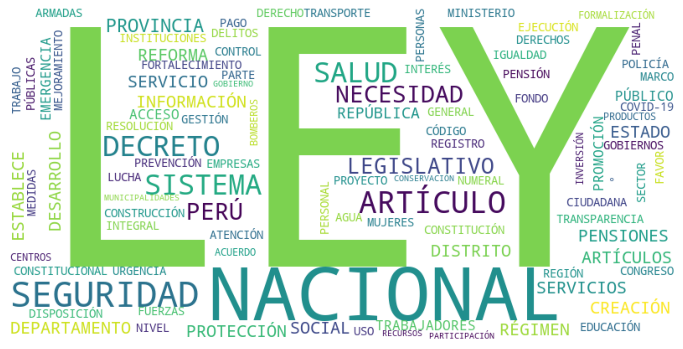

In [ ]:
show_wordcloud(Sus_Tit_Infor, save=True, img_name="WC_Sust_Titulo_Informatividad")

#### Verbos del título

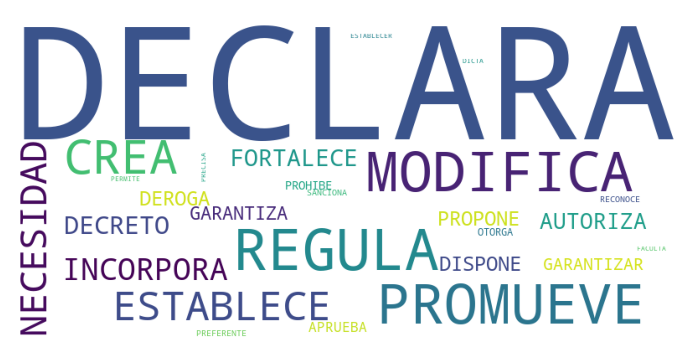

In [ ]:
show_wordcloud(Verb_Tit_Infor, save=True, img_name="WC_Verb_Titulo_Informatividad")

#### Adjetivos del título

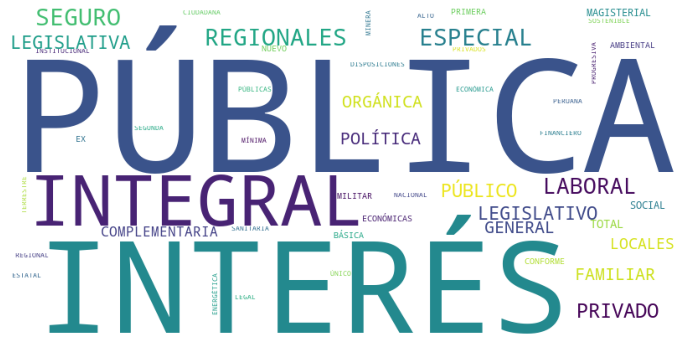

In [ ]:
show_wordcloud(Adj_Tit_Infor, save=True, img_name="WC_Adj_Titulo_Informatividad")

#### Sustantivos del Objeto

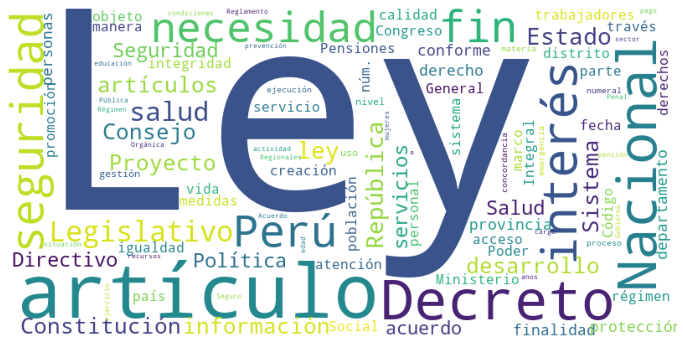

In [ ]:
show_wordcloud(Sus_Obj_Infor, save=True, img_name="WC_Sust_Objeto_Informatividad")

#### Verbos del Objeto

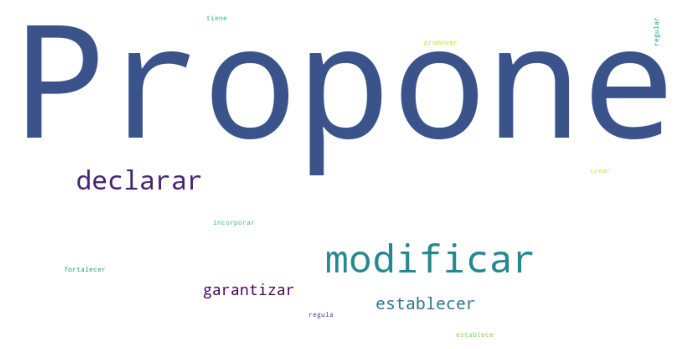

In [ ]:
show_wordcloud(Verb_Obj_Infor, save=True, img_name="WC_Verb_Objeto_Informatividad")

#### Adjetivos del Objeto

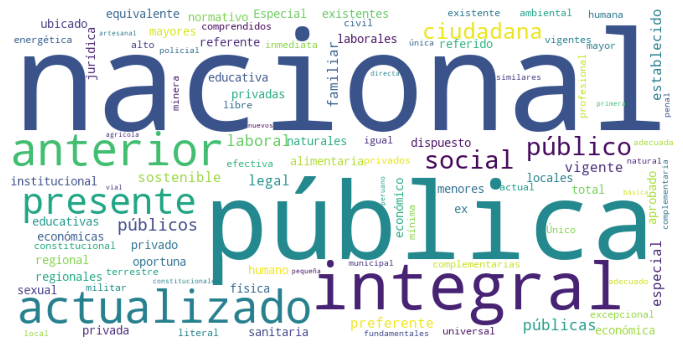

In [ ]:
show_wordcloud(Adj_Obj_Infor, save=True, img_name="WC_Adj_Objeto_Informatividad")

## TOPICO 4: USABILIDAD

### 1. POS-Tagging usando spacy

In [ ]:
TitulosUsabilidad,ObjetosUsabilidad = PosTagging(Usabilidad)

### 2. NER usando spacy

In [ ]:
NER(Usabilidad)

Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA OPERATIVIDAD DE UNA PLANTA DE PRODUCCIÓN DE VACUNAS CONTRA LA COVID-19
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública la creación y operación de una planta de producción de vacunas contra la covid-19 para inoculación de la población nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 11 DE LA LEY 26486, LEY ORGÁNICA DEL JURADO NACIONAL DE ELECCIONES
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley Orgánica del Jurado Nacional de Elecciones, Ley 26486, para garantizar el funcionamiento del Pleno del Jurado Nacional de Elecciones ante la declinación irrevocable uno de sus miembros.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN, IMPLEMENTACIÓN Y FUNCIONAMIENTO DE LA UNIVERSIDAD NACIONAL ASHANINKA DEL VRAEM. (UNA-VRAEM)
NER Título: 


Objeto:  Propone crear de la Universidad Nacional Ashaninka del VRAEM, (UNA-VRAEM), con personería jurídica de derecho público interno, con sede en el vale del VRAEM, departamento de Cusco.
NER Objeto: 


Título:  LEY QUE DECLARA OFICIALES E INTANGIBLES LOS SÍMBOLOS Y EMBLEMAS DEL PERÚ
NER Título: 


Objeto:  Propone establecer los símbolos y emblemas del Perú, la intangibilidad de forma y la estandarización sus denominaciones. En cumplimiento del mandato contenido en el Artículo 49 de la Constitución Política del Perú, son establecidos en la presente Ley, en concordancia con lo dispuesto por la Ley del 25 de febrero de 1825, Ley de creación del Escudo Nacional, y del Pabellón y Bandera Nacional, y por el Decreto Ley 11323, Disposiciones sobre los Símbolos de la Patria, Símbolos del Estado y Emblemas Nacionales.
NER Objeto: 


Título:  LEY DE ACTUALIZACIÓN Y SIMPLIFICACIÓN DE PROCEDIMIENTOS PARA LA INDUSTRIA DE HIDROCARBUROS
NER Título: 


Objeto:  Propone promover la reactivación sostenible de la exploración y explotación de hidrocarburos a nivel nacional, empleamdo medidas de simplificación administrativa, así como actualizar y mejorar el marco normativo, a fin de fomentar el desarrollo de las actividades de exploración y explotación de hidrocarburos de manera responsable con el medio ambiente, mediante la modificación de la Ley 26221, Ley Orgánica de Hidrocarburos.
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE RESTABLECE EL SISTEMA BICAMERAL EN LA ESTRUCTURA DEL CONGRESO DE LA REPÚBLICA
NER Título: 


Objeto:  Propone modificar los artículos de la Constitución Política del Perú, referido a la estructura, funcionamiento y prerrogativas del Congreso de la República.
NER Objeto: 


Título:  LEY QUE DETERMINA, COMO PENSIÓN MINIMA, LA EQUIVALENTE A UNA REMUNERACIÓN MINIMA VITAL PARA LOS PENSIONISTAS DEL SISTEMA NACIONAL DE PENCIONES
NER Título: 


Objeto:  Propone determinar la pasión mínima, que corresponda a una Remuneración Mínima Vital (RMV), para todos los pensionistas pertenecientes al Sistema Nacional de Pensiones, que es administrada por la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE CREA EL RÉGIMEN DE PENSIONES DE JUBILACIÓN REDUCIDAS PROPORCIONALES PARA AFILIADOS CON MENOS DE 20 AÑOS DE APORTACIONES A LA OFICINA DE NORMALIZACIÓN PREVISIONAL Y ESTABLECE MODIFICACIONES AL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  Propone crear un régimen de pensiones de jubilación reducidas proporcionales para afiliados con menos de 20 años de aportaciones a la Oficina de Normalización Previsional, así como establecer modificaciones al Sistema Nacional de Pensiones (SNP).
NER Objeto: 


Título:  LEY QUE CREA EL FONDO UNIVERSAL DE ALTO COSTO EN SALUD
NER Título: 


Objeto:  Propone crear el Fondo Universal de Alto Costo en Salud (Fondo Salud) como mecanismo nacional para brindar cobertura a los tratamientos de enfermedades de alto costo, así como establecer las disposiciones necesarias para su funcionamiento.
NER Objeto: 


Título:  LEY QUE RECONOCE AL DISTRITO DE VILCABAMBA COMO EL ÚLTIMO BASTIÓN DE LA RESISTENCIA INCA
NER Título: 


Objeto:  Propone reconocer al distrito de Vilcabamba, provincia de La Convención, del departamento de Cusco, como último bastión de la resistencia inca,
NER Objeto: 


Título:  LEY QUE LA COMISIÓN TÉCNICA INTERINSTITUCIONAL PERMANENTE DE GOBERNANZA DE DATOS E INTEROPERABILIDAD DEL SISTEMA DE JUSTICIA
NER Título: 


Objeto:  Propone crear la Comisión Técnica Interinstitucional Permanente de Gobernanza de Datos e Interoperabilidad del Sistema de Justicia
NER Objeto: 


Título:  LEY QUE ESTABLECE LA EXONERACIÓN DE IMPUESTOS A LAS MICROEMPRESAS DURANTE LOS TRES PRIMEROS AÑOS DE SU FUNCIONAMIENTO
NER Título: 


Objeto:  Propone establecer la exoneración de impuestos a las microempresas durante los tres primeros años de su funcionamiento con la finalidad de impulsar su desarrollo y su formalización dentro del mercado.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY SOBRE EL DERECHO DE AUTOR-DECRETO LEGISLATIVO 822 Y CREA LA VENTANILLA ÚNICA DE COBRO DE DERECHO DE AUTOR (VUC)
NER Título: 


Objeto:  Propone modificar la ""Ley sobre Derechos de Autoir"" aprobado mediante el Decreto Legislativo 822 y crear la Ventanilla Única de Cobro de Derechos de Autor-VUC, como mecanismo para ordenar la percepción de los mismos.
NER Objeto: 


Título:  LEY QUE ESTABLECE UN RÉGIMEN ESPECIAL PARA DEVOLUCIÓN DE APORTES PARA LOS AFILIADOS DEL SISTEMA NACIONAL DE PENSIONES DEL DECRETO LEY 19990 ADMINISTRADO POR LA OFICINA DE NORMALIZACIÓN PREVISIONAL (ONP) Y DICTA OTRAS MEDIDAS A FAVOR DE LOS ASEGURADOS DE REGÍMENES PREVISIONALES POR MOTIVO DEL COVID-19 EN LA ECONOMÍA PERUANA
NER Título: 


Objeto:  Propone establecer un régimen especial facultativo para devolución de aportes para los afiliados del Sistema Nacional de Pensiones (SNP) del Decreto Ley 19990 y dicta otras medidas a favor de los asegurados de regímenes previsionales en el marco de la pandemia por la Covid-19.
NER Objeto: 


Título:  LEY GENERAL DEL DETECTIVE PRIVADO DEL PERÚ
NER Título: 


Objeto:  Propone regular la actividad de los Detectives Privados del Perú, estableciendo diversas disposiciones sobre su régimen,  organización, funcionamiento, renovación y otros caracteres y condiciones propios de su actividad.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEGISLATIVO 1411, DECRETO LEGISLATIVO QUE REGULA LA NATURALEZA JURÍDICA, FUNCIONES, ESTRUCTURA ORGÁNICA Y OTRAS ACTIVIDADES DE LAS SOCIEDADES DE BENEFICENCIA
NER Título: 


Objeto:  Propone modificar el Decreto Legislativo 1411, Decreto Legislativo que regula la naturaleza jurídica, funciones, estructura orgánica y otras actividades de las Sociedades de Beneficencia respecto al funcionamiento de las mismas en relación a los alcances de los sistemas administrativos de control y contabilidad así como el ejercicio de control gubermantal respecto a las auditorías financieras que se les realicen en el marco de la auditoría a la cuenta general de república.
NER Objeto: 


Título:  LEY QUE MODIFICA DIVERSAS NORMAS RELACIONADAS AL ARRENDAMIENTO FINANCIERO, Y DEROGA EL ARTÍCULO 34 DE LA LEY 30230 LEY QUE ESTABLECE MEDIDAS TRIBUTARIAS, SIMPLIFICACIÓN DE PROCEDIMIENTOS Y PERMISOS PARA LA PROMOCIÓN Y DINAMIZACIÓN DE LA INVERSIÓN DEL PAÍS
NER Título: 


Objeto:  Propone modificar diversas normas relacionadas al arrendamiento financiero, y deroga el artículo 34 de la Ley 30230, Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión del país.
NER Objeto: 


Título:  LEY QUE REGULA EL DOBLE EMPLEO O CARGO PÚBLICO REMUNERADO DEL PERSONAL MÉDICO ESPECIALISTA Y ASISTENCIAL DE SALUD POR COVID-19 ""LEY DE DOBLE PERCEPCIÓN PARA EL PERSONAL DE SALUD""
NER Título: 


Objeto:  Propone ley que regula el doble empleo o cargo público remunerado del personal médico especialista y asistencial de salud por Covid-19 ""Ley de doble percepción para el personal de Salud"".
NER Objeto: 


Título:  LEY QUE BENEFICIA CON EL BONO SOLIDARIO A  LOS APORTANT ES Y EX APORTANTES DE LA OFICINA DE NORMALIZACIÓN PREVISIONAL COMPRENDIDOS EN LA LEY 19990, EN EL MARCO DE LA EMERGENCIA NACIONAL A CAUSA DEL COVID-19
NER Título: 


Objeto:  Propone beneficiar con el bono solidario a los aportantes y ex aportantes de la Oficina de Normalización Previsional comprendidos en la Ley 19990 afectados enormente por el aislamiento e inmovilkzación social obligatoria y la lenta reactivación económica en especial en esta segunda ola, en el marco de la emergencia nacional a causa del Covid 19.
NER Objeto: 


Título:  LEY QUE INCORPORA LA CONDICIÓN DE DESAPARECIDA DE LA VÍCTIMA COMO AGRAVANTE EN LOS DELITOS DE FEMINICIDIO Y PROPONE LA APLICACIÓN DE LA CADENA PERPETUA PARA TODOS LOS DELITOS DE FEMINICIDIO AGRAVADO, ASÍ COMO PLANTEA LA INCOACIÓN DEL PROCESO INMEDIATO POR FEMINICIDIO EN FLAGRANCIA Y EN CASOS DE VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR EN FLAGRANCIA
NER Título: 


Objeto:  Propone incorporar la condición de desaparecida de la víctima como agravante en los delitos de feminicidio, y proponer la aplicación de la cadena perpetua para todos los delitos de feminicidio agravado, así como plantear la incoación del proceso inmediato por feminicidio en flagrancia y en casos de violencia contra las mujeres y los integrantes del grupo familiar en flagrancia a fin de garantizar el acceso a la justicia con una debida simplificación procesal y efectiva.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DISPONE EL CUMPLIMIENTO OBLIGATORIO DE LOS EMPLEADORES CON EL PAGO DE APORTES PREVISIONALES PARA EL OTORGAMIENTO DE PENSIONES
NER Título: 


Objeto:  Propone establecer el cumplimiento obligatorio de los empleadores, con el pago oportuno y total de los aportes por concepto de fondos previsionales de los trabajadores activos y pasivos descontados en las planillas que no fueron depositados oportunamente, a favor del Sistema Nacional de Pensiones, administrado por la Oficina de Normalización Previsional (ONP), y de las Administradoras de Fondos de Pensiones (AFP), bajo responsabilidad.
NER Objeto: 


Título:  LEY DE PROTECCIÓN LABORAL DE LOS TRABAJADORES AGRARIOS
NER Título: 


Objeto:  Propone que los empleados cumplan con el pago oportuno de aportes previsionales de los trabajadores agrarios al Sistema Nacional de Pensiones, administrado por la Oficina de Normalización Previsional (ONP) y al Sistema Privado de Administración de Fondos de Pensiones (AFP), y los aportes al Seguro Social
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE INCENTIVA LA COBERTURA DE SERVICIOS DE SALUD POR PERSONAL MÉDICO EN SITUACIÓN DE PANDEMIA
NER Título: 


Objeto:  Propone modificar el artículo 40 de la Constitución Política del Perú, precisando una excepción para la prohibición a la percepción de doble remuneración  en el sector público, por parte de personal médico, explícitamente para etapa de pandemia y mientras dure ésta, por circunstancias que afecten la vida de la nación y/o por razones de déficit de cobertura de personal de salud.
NER Objeto: 


Título:  LEY DEL SISTEMA NACIONAL DE CIENCIA, TECNOLOGÍA E INNOVACIÓN
NER Título: 


Objeto:  Propone crar y regular las funciones y la organización y el funcionamiento del Sistema Nacional de Ciencia, Tecnología e Innovación-SNCTI, con la finalidad de impulsar, promover, fortalecer y consolidar las capacidades de ciencia, tecnología e innovación en todo el territorio nacional y contribuir al desarrollo sustentable y bienestar de la población.
NER Objeto: 


Título:  LEY QUE PROMUEVE EL ACCESO A LA INFORMACIÓN RELEVANTE Y FORTALECE LA INTEROPERABILIDAD ENTRE ENTIDADES DE LA ADMINISTRACIÓN PÚBLICA RESPONSABLES DE LA IMPLEMENTACIÓN DE LA LEY 29988
NER Título: 


Objeto:  Propone ley que promueve el acceso a la información relevante y fortalece la interoperabilidad entre entidades de la Administración Pública responsables de la implementación de la ley 29988
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL E INTERÉS PÚBLICO LA CONSTRUCCIÓN Y FUNCIONAMIENTO DEL SANTUARIO DE LA MEMORIA ""LA HOYADA"" EN EL DISTRITO DE ANDRÉS AVELINO CÁCERES DORREGARAY, PROVINCIA DE HUAMANGA, DEPARTAMENTO DE AYACUCHO
NER Título: 


Objeto:  Propone declarar de interés nacional e interés público la construcción y funcionamiento de los servicios del Santuario de la Memoria ""La Hoyada"" en el distrito de Andrés Avelino Cáceres Dorregaray, provincia de Huamanga, deparrtamento de Ayacucho.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN, IMPLEMENTACIÓN Y FUNCIONAMIENTO DEL SERVICIO AEROPORTUARIO PICHARI-VRAEM, EN EL DISTRITO DE PICHARI, PROVINCIA DE LA CONVENCIÓN, DEPARTAMENTO DE CUSCO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción, implementación y funcionamiento del servicio aeroportuario Pichari-VRAEM, en el distrito de Pichari, provincia de La Convención, departamento de Cusco.
NER Objeto: 


Título:  LEY QUE INCORPORA EL ARTÍCULO UNDÉCIMO, DUEDÉCIMO, DÉCIMO TERCERO DE LAS DISPOSICIONES FINALES, TRANSITORIAS Y COMPLEMENTARIAS DE LA LEY 28976, LEY MARCO DE LICENCIA DE FUNCIONAMIENTO Y REGULA LA ACTIVIDAD COMERCIAL EN LOS BIENES INM,UEBLES INTEGRANTES DEL PATRIMONIO CULTURAL DE LA NACIÓN QUE CUENTEN CON RESOLUCIÓN DE INHABITALIDAD
NER Título: 


Objeto:  Propone incorporar el artículo undécimo, duocécimo, décimo tercero de las disposiciones finales, transitorias y complementarias de la Ley 28976, Ley Marco de Licencia de Funcionamiento.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LAS ORGANIZACIONES DE USUARIOS DE AGUA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone fortalecer, regular el reconocimiento y el funcionamiento de las Organizaciones de Usuarios de Agua previstas en la Ley 29338, Ley de Recursos Hídricos teniendo en consideración que el recurso hídrico es patrimonio de la Nación de conformidad con lo dispuesto en la Constitución Política del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 11 DE LA LEY 28976, LEY MARCO DE LICENCIA DE FUNCIONAMIENTO
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley Marco de Licencia de Funcionamiento, estableciendo la ampliación de los certificados de inspección técnica de seguridad de dos a cinco años.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN, IMPLEMENTACIÓN Y FUNCIONAMIENTO DE LA UNIVERSADAD NACIONAL DE INGENIERÍA AGROPECUARIA DEL SUR - UNIAS
NER Título: 


Objeto:  Proyecto de Ley que declara de interés nacional y necesidad pública la creación, implementación y funcionamiento de la Universidad Nacional de Ingeniería Agropecuaria del Sur- UNIAS
NER Objeto: 


Título:  LEY QUE GARANTIZA EL FUNCIONAMIENTO DE LAS COMUNIDADES CAMPESINAS
NER Título: 


Objeto:  Propone modificar el último párrafo del artículo 20 de la Ley 24656, Ley de Comunidades Campesinas, tiene por objeto establecer las medidas necesarias para garantizar el funcionamiento de los órganos de las comunidades campesinas  que les permita cumplir con la dirección, administración, gestión y control eficiente en las comunidadaes campesinas.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN, IMPLEMENTACIÓN Y FUNCIONAMIENTO DE LA UNIVERSIDAD NACIONAL DE INGENIERÍA Y TECNOLOGÍA SOSTENIBLE DEL VRAEM-UNITECS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación, implementación y funcionamiento de la Universidad Nacional de Ingeniería y Tecnología Sostenible del VRAEM (UNITECS), ubicado en el ámbito del Valle de los Ríos Apurímac, Ene y Mantaro.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30937 EN CUANTO A LA CREACIÓN DE LAS MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone modificar la Única Disposición Complementaria Transitoria de la Ley 30937, precisando que la modificatoria contenida en la presente ley no aplica a las Municipalidades de Centros Poblados en funcionamiento y de aquellos cuyos expedientes se encuentran en trámite de creación, sólo se aplicará a las nuevas municipalidades de Centros Poblados que se crearán a la vigencia de la presente ley.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 30435, LEY QUE CREA EL SISTEMA NACIONAL DE FOCALIZACIÓN (SINAFO), CREA EL COMITÉ VERIFICADOR Y ESTABLECE MECANISMOS DE VERIFICACIÓN DE LA INFORMACIÒN PARA LA CLASIFICACIÓN SOCIOECONÓMICA DE HOGARES QUE EFECTÚA EL SISFOH
NER Título: 


Objeto:  Propone fortalecer el Sistema Nacional de Focalización (SINAFO) con la finalidad que el proceso de focalización cumpla con los principios de cierre de brechas, inclusión, eficacia, eficiencia y transparencia en beneficio de las poblaciones que se encuentren en situación de pobreza, vulnerabilidad y exclusión, así como fortalecer los mecanismos de control de la información para una mejor operatividad del Sistema de Focalización de Hogares (SISFOH), creando el Comité Verificador
NER Objeto: 


Título:  LEY DE REFORMA CONSTITUCIONAL QUE HABILITA LA DOBLE PERCEPCIÓN DE INGRESOS DEL PERSONAL PÚBLICO DE MANERA EXCEPCIONAL DURANTE LA DECLARACIÓN DE UN ESTADO DE EXCEPCIÓN
NER Título: 


Objeto:  Propone modificar el artículo 40 de la Constitución Política del Perú, que habilita la doble percepción de ingresos del personal público de manera excepcional durante la declaraciòn de un Estado de Excepción.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 56 DE LA LEY 30446 Y LOS ARTÍCULOS 1 Y 8 DE LA LEY 30777 QUE RIGEN EL FUNCIONAMIENTO DE LAS ZONAS ESPECIALES DE DESARROLLO-ZED
NER Título: 


Objeto:  Propone modificar el primer párrafo del artículo 6 de la Ley 30446 y los artículos 1 y 8 de la Ley 30777 que rigen el funcionamiento de las Zonas Especiales de Desarrollo-ZED, con la finalidad de promover el desarrollo de actividades industriales, comerciales y de servicios, propiciando el encadenamiento económico-productivo en el ámbito de influncia de dichas zonas especiales de desarrollo.
NER Objeto: 


Título:  LEY QUE ORDENA LA DEVOLUCIÓN TOTAL DE LOS APORTES AL FONDO DE PENSIONES A CARGO DE LA OFICINA DE NORMALIZACIÒN PREVISIONAL-ONP
NER Título: 


Objeto:  Propone reconocer el derecho a todos sus afiliados a la devolución total de aporte de sus fondos pensionarios, siempre y cuando no hayan cumplido con los 20 años de aportación al Sistema Nacional de Pensiones (SNP), con aportes administrados por la Oficina de Normalización Previsional (ONP), con el objetivo de proteger y fortalecer su economía personal o familiar ante la emergencia sanitaria del Covid-19.
NER Objeto: 


Título:  LEY QUE DEROGA EXIGENCIAS DE ADECUACIÓN PARA CENTROS POBLADOS EN FUNCIONAMIENTO
NER Título: 


Objeto:  Ley que propone derogar la única disposición complementaria transitoria de la ley N° 30937.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE FORTALECIMIENTO DE LA INCLUSIÓN FINANCIERA A TRAVÉS DE LAS CAJAS MUNICIPALES DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone fortalecer la inclusión financiera a través del desarrollo y funcionamiento de las Cajas Municipales de Ahorro y Crédito (CMAC), buscando la adecuación y uniformización de los dispositivos legales que son de aplicación para las CMAC, y que representen un obstáculo para su desarrollo, crecimiento financiero y para mejorar la competitividad en la prestación de sus servicios financieros.
NER Objeto: 


Título:  LEY  QUE HABILITA A LOS EX APORTANTES DE LA LEY 30003 LEY QUE REGULA EL RÉGIMEN ESPECIAL DE SEGURIDAD SOCIAL PARA LOS TRABAJADORES Y PENSIONISTAS PESQUEROS, A SOLICITAR LA DEVOLUCIÓN DE SUS APORTES AL SISTEMA PÚBLICO DE PENSIONES
NER Título: 


Objeto:  Propone el procedimiento que permita a los ex aportantes de la Ley 30003, Ley que regula el régimen especial de seguridad social para los trabajadores y pensionistas pesqueros, mayores de 55 años, administrados por la Oficina de Normalización Previsional (ONP), a la entrada en vigor de la presente ley.
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO DE LOS AFILIADOS A LA DEVOLUCIÓN TOTAL DE SUS APORTES DEL FONDO DE PENSIONES A CARGO DE LA OFICINA DE NORMALIZACIÓN PREVISIONAL (ONP)
NER Título: 


Objeto:  Propone reconocer el derecho de las personas afiliadas al Sistema Nacional del Pensiones (SNP), estableciendo el mecanismo para solicitar la devolución del monto que aportaron al Fondo de sus pensiones administrado a cargo de la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE CREA UN RÉGIMEN PREVISIONAL ESPECIAL DE PENSIONES PARA LOS AGRICULTORES
NER Título: 


Objeto:  Propone crear un Régimen Previsional Especial de pensiones para los agricultores (REPA) al amparo de la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CREACIÓN, IMPLEMENTACIÓN Y PUESTA EN FUNCIONAMIENTO DE LOS CENTROS DE PRIMER NIVEL DE ATENCIÓN DE SALUD
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la creación, implementación y puesta en funcionamiento de los centros de primer nivel de atención de salud en todo el territorio nacional.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA DEVOLUCIÓN DE LOS FONDOS DE PENSIONES ADMINISTRADOS POR LA OFICINA DE NORMALIZACIÓN PREVISIONAL-ONP
NER Título: 


Objeto:  Propone establecer que los afiliados al Sistema Nacional de Pensiones (SNP) a cargo de la Oficina de Normalizaciòn Previsional (ONP) que tengan más de sesenta (60) años de edad con menos de veinte (20) años de aportes y que no hayan realizado aportaciones por más de seis (06) meses de manera consecutiva o alternada, puedan solicitar, por única vez y de manera excepcional, el retiro del cien por ciento (100%) de sus aportes realizados durante su actividad laboral, a efectos de fortalecer y proteger la economía familiar y/o personal ante la emergencia sanitaria originada por el COVID-19.
NER Objeto: 


Título:  LEY DE ELIMINACIÓN DE LAS AFPS Y DE CREACIÓN DEL NUEVO SISTEMA PREVISIONAL UNIFICADO PARA EL OTORGAMIENTO DE PENSIONES UNIVERSALES DIGNAS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la reforma integral del sistema nacional de pensiones y la creación del Sistema Unificado de Jubilación y Pensiones-SUJP, con la finalidad de establecer principios, lineamientos y modificacicones normativas necesarias para la unificación de los regímenes de pensiones públicos y privados, que permita una pensión universal, digna justa, equitativa y oportuna a favor de la población en edad de jubilación.
NER Objeto: 


Título:  LEY QUE RECONOCE EL DERECHO DE LOS AFILIADOS A LA DEVOLUCIÓN TOTAL DE SUS APORTES DEL FONDO DE PENSIONES A CARGO DE LA OFICINA NORMALIZACIÓN PREVISIONAL ONP
NER Título: 


Objeto:  Proyecto de Ley que reconoce el Derecho de los Afiliados a la Devolución Total de sus Aportes del Fondo de Pensiones a cargo de la Oficina de Normalización Previcional ONP
NER Objeto: 


Título:  LEY QUE DISPONE LA DEVOLUCIÒN DEL 25% DE APORTES EFECTUADOPS POR LOS AFILIADOS AL SISTEMA NACIONAL DE PENSIONES Y OTRAS MEDIDAS
NER Título: 


Objeto:  Propone devolver el 25% de aportes efectaudios por los afiliados al Sistema Naciconal de Pensiones a cargo de la Oficina de Normalización Provisional (ONP)
NER Objeto: 


Título:  LEY QUE HABILITA A LOS APORTANTES A LA OFICINA DE NORMANALIZACIÓN PREVISIONAL A SOLICITAR EL 100% DE SUS APORTES AL SISTEMA PÚBLICO DE PENSIONES Y APRUEBA BONO EXTRAORDINARIO
NER Título: 


Objeto:  Propone establecer un procedimiento especial que permita a los aportantes y a los exaportantes al Sistema Nacional de Pensiones, administrado por la Oficina de Normalización Previsional -ONP, solicitar el retiro del 100% de sus aportes acumulados desde el inicio de su experiencia laboral, siempre que no cuenten con 20 (veinte) años de aportación.
NER Objeto: 


Título:  LEY DE REFORMA DE LA  CONSTITUCIÓN QUE HABILITA LA DOBLE PERCEPCIÓN DEL MÉDICO ESPECIALISTA EN EL ÁMBITO NACIONAL POR NECESIDAD PÚBLICA
NER Título: 


Objeto:  Propone reforma constitucional, es la modificación del artículo 40 de la Constitución Política del Perú, habilitando la doble percepción del médico especialista en el ámbito nacional, por necesidad pública.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 17 DE LA LEY 30364, LEY PARA PREVENIR, SANCIONAR Y ERRADICAR LA VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR Y EL ARTÍCULO 446 DEL NUEVO CÓDIGO PROCESAL PENAL, APROBADO POR DECRETO LEGISLATIVO 957, PARA INCORPORAR EL PROCESO INMEDIATO POR LOS DELITOS DE VIOLENCIA CONTRA LA MUJER Y FEMINICIDIO EN LOS SUPUESTOS DE FLAGRANCIA
NER Título: 


Objeto:  Propone ley que tiene por objeto promover la protección del derecho de las mujeres a una vida libre de violencia y garantizar su acceso a la justicia incorporando la simplificación procesal a través de la incoación del proceso inmediato para los delitos de violencia contra la mujer y los integrantes del grupo familiar, y el feminicidio en los supuestos de flagrancia,
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA MORATORIA PARA LA CREACIÓN Y AUTORIZACIÓN DE NUEVAS UNIVERSIDADES PÚBLICAS Y PRIVADAS
NER Título: 


Objeto:  Propone ley que establece la moratoria para la creación y autorización de funcionamiento de nuevas universidades públicas y privadas hasta el 26 de abril del 2021.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL EL OTORGAMIENTO DE UNA BONIFICACIÓN EXTRAORDINARIA PARA LOS PENSIONISTAS DEL SISTEMA NACIONAL DE PENSIONES ANTE LA SITUACIÓN DE EMERGENCIA PRODUCIDA POR EL COVID-19
NER Título: 


Objeto:  Propone aprobar una medida extraordinaria que permita disminuIr el impacto de la emergencia sanitaria y el Estado de Emergencia por el COVID-19 en la economía de las familias de los pensionistas del Sistema Nacional de Pensiones que administra la Oficina de Normalización Previsional, por su condición de adultos mayores y de alta vulnerabilidad ante la pandemia del COVID-19
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 13 DE LA LEY ORGÁNICA DE MUNICIPALIDADES, EL CUAL INCORPORA LA REALIZACIÓN DE SESIÓN DE CONCEJO VIRTUAL EN CASOS DE DECLARATORIA DE EMERGENCIA NACIONAL Y/O AISLAMIENTO SOCIAL, SIENDO IMPOSIBLE ACUDIR DE FORMA PRESENCIAL
NER Título: 


Objeto:  Propone incorporar la figura jurídica de la realización de sesiones de concejo de manera virtual, en los Gobiernos Locales a nivel nacional, a fin de garantizar el funcionamiento de las mismas, en circunstancias de declaratoria de emergencia nacional y/o aislamiento social, e impida la participación presencial de sus integrantes o pongan en riesgo la salud de los mismos.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 40° DE LA CONSTITUCIÓN POLÍTICA DEL PERÚ, EL 3° DE LA LEY N° 28175, LEY MARCO DEL EMPLEO PÚBLICO Y 38° DE LA LEY N° 30057,LEY DEL SERVICIO CIVIL
NER Título: 


Objeto:  Propone establecer la doble percepción por el servicio médico, ante la aparición de pandemias como el Covid-19 y otras más que pudieran sobrevenir.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PENAL SOBRE LA EJECUCIÓN DE LA PENA PARA DELITOS DE VIOLENCIA Y RESISTENCIA A LA AUTORIDAD
NER Título: 


Objeto:  Propone establecer que la suspensión de la ejecución de la pena sea inaplicable a las personas condenadas por los delitos de violencia y resistencia a la autoridad, cuando se cause lesiones a efectivos policiales en ejercicio de sus funciones.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE LIBRE DESAFILIACIÓN DE LAS ADMINISTRADORAS DE FONDOS DE PENSIONES
NER Título: 


Objeto:  Propone la desafiliación voluntaria de las Administradoras de Fondos de Pensiones (AFP), pudiendo afiliarse a la Oficina de Normalización Provisional (ONP).
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE PRECISA REGLAS DE FUNCIONAMIENTO DEL CONGRESO DE LA REPÚBLICA EN ESTADOS DE EXCEPCIÓN
NER Título: 


Objeto:  Propone incorporar como Anexo al Reglamento del Congreso de la República, un Reglamento Especial de Funcionamiento del Congreso de la República en Estados de Excepción, a efectos de precisar el funcionamiento del parlamento en situaciones excepcionales como suceden en los casos de estados de emergencias y/o de sitio, precisados en artículo 137 de la Constitución del Estado, a efectos de asegurar el rol del parlamento en el cumplimiento de sus funciones en razón de la voluntad popular delegada para la representación de la nación.
NER Objeto: 


Título:  LEY QUE ENDURECE PENAS A QUIENES AGREDAN A PERSONAL POLICIAL Y DE LAS FUERZAS ARMADAS EN EJERCICIO DE SUS FUNCIONES DURANTE ESTADOS DE EXCEPCIÓN
NER Título: 


Objeto:  Propone modificar los artículos 367 y 368 del Código Penal, referente a los delitos de violencia y resistencia a la autoridad, a las agresiones de diversa  índole u obstaculización del ejercicio de las funciones contra el personal policial y de las fuerzas armadas, durante la decretación de Estado de Excepción (Estado de emergencia y/o de Sitio).
NER Objeto: 


Título:  RESOLUCIÓN LEGISLATIVA QUE INCORPORA EL INCISO F) AL ARTÍCULO 27 Y ADICIONA LOS ARTÍCULOS 27-A Y 28-A AL REGLAMENTO DEL CONGRESO DE LA REPÚBLICA, A FIN DE QUE EN SITUACIONES EN QUE HAYA SIDO DECRETADO ESTADO DE EXCEPCIÓN, SEA POSIBLE SUSTITUIR LA PARTICIPACIÓN PRESENCIAL POR MEDIOS VIRTUALES, PARA PERMITIR EL FUNCIONAMIENTO DE LA ORGANIZACIÓN PARLAMENTARIA Y EL SERVICIO PARLAMENTARIO.
NER Título: 


Objeto:  Propone incorporar el inciso f) al artículo 27 y adicionar los artículos 27-A y 28-A al Reglamento del Congreso de la República, para que en caso sea decretado el Estado de Excepción, se pueda sustituir la participación presencial por medios virtuales, para permitir el funcionamiento de la Organización Parlamentaria y el Servicio Parlamentari
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY  N°  30937 SOBRE MUNICIPALIDADES DE CENTROS POBLADOS
NER Título: 


Objeto:  Propone modificar la Única Disposición Complementaria Transitoria de la Ley 30937, precisando y diferenciando la adecuación a la que están obligadas las Municipalidades de Centros Poblados en funcionamiento y los expedientes en trámite de creación de nuevas Municipalidades de Centros Poblados.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 27908, PARA EL FORTALECIMIENTO DE LAS RONDAS CAMPESINAS Y COMUNALES Y CREACIÓN DE LAS RONDAS URBANAS
NER Título: 


Objeto:  Propone la modificación de la Ley 27908, Ley de Rondas Campesinas, con el objeto de fortalecer la organización, funcionamiento y atribuciones de las Rondas Campesinas y Comunales así como establecer la creación de las Rondas Urbanas, con el fin de propiciar la seguridad integral de la población.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28939 Y LA LEY 29148, A FIN DE DICTAR DISPOSICIONES REFERIDAS AL FONDO DE GARANTÍA PARA EL CAMPO Y DEL SEGURO AGRARIO
NER Título: 


Objeto:  Propone modificar el literal b) del numeral 4.1 del artículo 4 de la Ley 28939, Ley que aprueba crédito suplementario y transferencia de partidas en el Presupuesto del Sector público para el año fiscal 2006, dispone la creación de fondos y dicta otras medidas, y el literal b) del artículo 2, artículo 3 e inciso d) del artículo 4 de la Ley 29148, Ley que establece la implementacion y el funcionamiento del Fondo de Garantia par el Campo y del Seguro Agropecuario.
NER Objeto: 


Título:  LEY DE PROMOCIÓN DE LAS PLANTAS DESALINIZADORAS DEL AGUA DE MAR
NER Título: 


Objeto:  Propone otorgar beneficios tributarios para la instalación, puesta en funcionamiento y mantenimiento de plantas desalinizadoras de agua de mar que produzcan agua potable para el consumo masivo de la población.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA MORATORIA DE CREACIÓN Y FUNCIONAMIENTO DE NUEVAS FACULTADES O ESCUELAS DE ODONTOLOGÍA
NER Título: 


Objeto:  Propone ley que establece la moratoria de creación de nuevas escuelas y/o facultades públicas y privadas de formación profesional de pregrado de odontología o estomatología, por el plazo de 05 años.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA LA LEY 24915 LEY QUE CREA EL COLEGIO DE LICENCIADOS EN TURISMO
NER Título: 


Objeto:  Propone fortalecer la organización y las funciones del Colegio de Licenciados en Turismo incorporando una estructura orgánica que organice el funcionamiento del Colegio de Licenciados en turismo, otorgándoles personería jurídica a los consejos regionales, para que de manera autónoma y descentralizada representen a los profesionales en turismo.
NER Objeto: 


Título:  LEY QUE PROMUEVE LA IMPLEMENTACIÓN DE OFICINAS DE GESTIÓN DE PROYECTOS COMO MEDIDA PREVENTIVA DE ACTOS DE CORRUPCIÓN EN A EJECUCIÓN DE OBRAS PÚBLICAS
NER Título: 


Objeto:  Propone Ley que promueve la implementación y funcionamiento de Oficinas de Gestión de Proyectos o la designación de profesionales en gestión de proyectos, como medida preventiva de actos de corrupción y de alcance de mayor eficiencia por parte del Estado en la ejecución de obras públicas.
NER Objeto: 


Título:  LEY DE EFICIENCIA ECONÓMICA POR SIMPLIFICACIÓN Y REDUCCIÓN DE COSTOS ADMINISTRATIVOS
NER Título: 


Objeto:  Propone modificar los numerales 8.1 y 8.3 del artículo 8 del Decreto Legislativo 1256, Decreto Legislativo que aprueba la Ley de Prevención y Eliminación de Barreras Burocráticas.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DE LA LEY 26549, LEY DE LOS CENTROS EDUCATIVOS PRIVADOS, EXCLUYENDO LA APLICACIÓN DEL SILENCIO ADMINISTRATIVO POSITIVO (SAP)
NER Título: 


Objeto:  Propone modificar el artículo 4 de la Ley 26549, Ley de los Centros Educativos Privados, a fin que las autorizaciones de funcionamiento de estos centros de estudios sean mediante, procedimientos de evaluación previa con Silencio Administrativo Negativo y no bajo el sustento del Silencio Administrativo Positivo (SAP).
NER Objeto: 


Título:  LEY DEL TRANSPORTE PÚBLICO EN VEHÍCULOS MENORES EN EL MARCO DEL SISTEMA INTEGRADO DE TRANSPORTE
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone normar el funcionamiento y promover el desarrollo económico y social del servicio de transporte público de pasajeros en vehículos menores, en el marco del Sistema Integrado de Transporte.
NER Objeto: 


Título:  LEY QUE REGULA LA CONSTITUCIÓN DE LAS ALIANZAS ENTRE ORGANIZACIONES POLÍTICAS
NER Título: 


Objeto:  Propone modificar los artículos 5,13, 15 y 30-B de la Ley 28094, Ley de Organizaciones Políticas; los artículos 87 y 88 de la Ley 26859, Ley Orgánica de Elecciones; el artículo 11 de la Ley 27683 de la Ley de Elecciones Regionales y el artículo 9 de la Ley 26864, Ley de Elecciones Municipales, a fin de regular el funcionamiento de las alianzas en aras del fortalecimiento e institucionalidad de las organizaciones políticas.
NER Objeto: 


Título:  LEY QUE AUTORIZA LA CREACIÓN DE LA ADMINISTRADORA DE FONDO DE PENSIONES DEL ESTADO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la creación de la Administradora de Fondo de Pensiones del Estado, sobre la base de los recursos que administra la Oficina de Normalización Previsional (ONP), con la finalidad de incrementar la cobertura en materia de pensiones de los trabajadores y promover mayor competencia en el Sistema de las Administradoras de Fondo de Pensiones.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CREACIÓN DE LA CUENTA INDIVIDUAL DE AHORRO PREVISIONAL Y DE PRESTACIONES DE SALUD ANTE LA OFICINA DE NORMALIZACIÓN PREVISIONAL
NER Título: 


Objeto:  Propone declarar de interés nacional la creación de la Cuenta Individual de Ahorro Previsional en la Oficina de Normalización Previsional, con el fin de dar contenido a lo prescrito en el artículo 10 y 11 de la Constitución Política del Perú que reconoce el derecho universal y progresivo de toda persona a la seguridad social y el libre acceso a prestaciones de salud y a pensiones.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA EXPROPIACIÓN DE INMUEBLE PARA EL FUNCIONAMIENTO DEL ""INSTITUTO DE EDUCACIÓN SUPERIOR TECNOLÓGICO PÚBLICO PISCO""
NER Título: 


Objeto:  Propone declarar de necesidad pública la expropiación del inmueble de dominio privado en el que se encuentra ubicado el ""Instituto Superior Tecnológico Público Pisco"", de la provincia de Pisco, departamento de Ica, con la finalidad de continuar con su funcionamiento.
NER Objeto: 


Título:  LEY QUE DISPONE EL TRASLADO DE LOS PENSIONISTAS PESQUEROS DE LA CAJA DE BENEFICIOS Y SEGURIDAD SOCIAL DEL PESCADOR, EN DISOLUCIÓN Y LIQUIDACIÓN, A LA OFICINA DE NORMALIZACIÓN PREVISIONAL
NER Título: 


Objeto:  Propone el traslado de los pensionistas pesqueros que a la fecha perciben una pensión de jubilación, viudez, orfandad o invalidez de la Caja de Beneficios y Seguridad Social del Pescador, en disolución y liquidación (CBSSP) a la Oficina de Normalización Previsional (ONP).
NER Objeto: 


Título:  LEY QUE ESTABLECE LINEAMIENTOS SOBRE SEGURIDAD SOCIAL
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone mejorar y enseñar la seguridad vial en los usuarios de las vías, aprovechando los mecanismos que están en funcionamiento, para difundir y reforzar la capacidad de los mismos, para identificar, discernir y entender la problemática de la seguridad vial en el país, conocer de las normas de tránsito terrestre en las escuelas, así como formar sus habilidades de manera teórica y práctica con sentido de responsabilidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE PREVIENE Y SANCIONA EL ACOSO POLÍTICO CONTRA LAS MUJERES
NER Título: 


Objeto:  Propone la Ley que previene y sanciona el acoso político contra las mujeres producido en el ámbito público, privado o mixto, incluyendo a todas las organizaciones y/o instituciones, cualquiera sea su forma jurídica, que operen en la vida pública del país, como los partidos políticos, sindicatos, organizaciones sociales, juveniles y estudiantiles, entre otras; en salvaguarda de los derechos políticos de las mujeres; en concordancia con los principios de igualdad y no discriminación, debida diligencia, intervención inmediata y oportuna, sencillez y oralidad, y razonabilidad y proporcionalidad; reconocidos por nuestra Constitución Política del Estado y los tratados internacionales en vigor.
NER Objeto: 


Título:  LEY QUE ESTABLECE EL SISTEMA E INTEROPERATIVIAD ELECTRÓNICA EN EL SISTEMA DE ADMINISTRACIÓN DE JUSTICIA EN EL MARCO DE LA LEY N° 30364
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone la norma que tiene por objeto crear en el sistema de interoperatividad en el sistema de administración de justicia en el marco de la Ley N° 30364, Ley para Prevenir, Sancionar y erradicar la Violencia contra las mujeres y los integrantes del grupo familiar.
NER Objeto: 


Título:  LEY QUE REGULA Y SANCIONA COMO SITUACIÓN AGRAVANTE LA APOLOGÍA DE LOS DELITOS DE VIOLENCIA CONTRA LA MUJER
NER Título: 


Objeto:  Propone regular y sancionar como situación agravante la exaltación, justificación o enaltecimiento de los delitos de violencia contra la mujer, como feminicidio, lesiones graves y leves por violencia familiar, violación sexual y sus formas agravantes, acoso sexual, explotación sexual infantil y otros; en salvaguarda de la integridad física, psíquica, económica y/o patrimonial de las mujeres e integrantes del grupo familiar, haciendo especial énfasis de aquellas que se encuentran en situación de vulnerabilidad, por la edad o situación física como las niñas, adolescentes, personas adultas mayores y personas con discapacidad, en concordancia con los principios de dignidad humana, igualdad y no discriminación, del libre desarrollo de las personalidad, debida diligencia, de intervención inmediata y oportunidad, de sencillez y oralidad, y de razonabilidad y proporcionalidad reconocidos por nuestras leyes y Constitución Política del Estado.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA EL FUNCIONAMIENTO DE PLANTAS DESALIZADORAS EN LOS CENTROS POBLADOS A LOS QUE PERTENECEN LAS CALETAS DEL LITORAL
NER Título: 


Objeto:  Propone declarar de necesidad pública el funcionamiento de plantas desalinizadoras en los Centros Poblados a los que pertenecen las caletas del litoral peruano, incluyendo los sectores que no cuentan con agua a nivel de superficie de manera próxima.
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 28864-LEY DE LA ZONA ECONÓMICA ESPECIAL DE PUNO-ZEEDEPUNO
NER Título: 


Objeto:  Propone modificar la Ley 28864, Ley de la Zona Económica Especial de Puno-ZEEDEPUNO, incorporando una nueva redacción para efectivizar su funcionamiento e incorporar dentro de su finalidad la Zona Comercial, a fin de promover la estabilidad de las inversiones, fomentar el empleo, contribuir al desarrollo socioeconómico sostenible y promover la competitividad e innovación, del departamento de Puno, a través de la promoción de  la inversión y desarrollo tecnológico.
NER Objeto: 


Título:  LEY QUE FACULTA A LA OFICINA DE NORMALIZACIÓN PREVISIONAL (ONP) A ALLANARSE EN LOS PROCESOS JUDICIALES EN MATERIA PREVISIONAL
NER Título: 


Objeto:  Propone autorizar a la Oficina de Normalización Previsional (ONP), a realizar el allanamiento en los procesos judiciales, que en representación del Estado peruano mantenga con los pensionistas y jubilados del Decreto Ley 19990 y de la Ley 20530.
NER Objeto: 


Título:  LEY QUE CONFORMA COMISIÓN INTERINSTITUCIONAL PARA LA ELABORACIÓN DE PLANES, POLÍTICAS Y ESTRATEGIAS PARA EL FUNCIONAMIENTO Y MODERNIZACIÓN DEL AEROPUERTO ""TENIENTE FAP JAIME MONTREUIL MORALES""DE CHIMBOTE
NER Título: 


Objeto:  Propone la conformación de una Comisión Interinstitucional para la elaboración de planes, políticas y estrategias para el funcionamiento y modernización del Aeropuerto ""Teniente FAP Jaime Montreuil Morales"" de Chimbote.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LA INTEROPERABILIDAD DE LA ADMINISTRACIÓN PÚBLICA Y SU PRIORIZACIÓN EN EL SISTEMA DE JUSTICIA PENAL, EN LA VIOLENCIA CONTRA LAS MUJERES Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone ley de fortalecimiento de la interoperabilidad de la administración pública y su priorización en el Sistema de Justicia Penal, en la violencia contra las mujeres y los integrantes del grupo familiar.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DEL DECRETO SUPREMO 157-90-EF, QUE NORMA EL FUNCIONAMIENTO EN EL PAÍS DE LAS CAJAS MUNICIPALES DE AHORRO Y CRÉDITO, MODIFICADA POR LA LEY 30607, LEY QUE MODIFICA Y FORTALECE EL FUNCIONAMIENTO DE LAS CAJAS MUNICIPALES DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone modificar el artículo 4 del Decreto Supremo 157-90-EF, que norma el funcionamiento en el país de las cajas municipales de ahorro y crédito, modificada por la Ley 30607, Ley que modifica y fortalece el funcionamiento de las cajas municipales de ahorro y crédito (CMAC), con la finalidad de dinamizar su funcionamiento y administración de las cajas municipales de Ahorro y Crédito, así como de las Municipalidades.
NER Objeto: 


Título:  LEY QUE DECLARA DE PREFERENTE INTERÉS NACIONAL Y SOCIAL LA DETERMINACIÓN DE LA PENSIÓN MÍNIMA PARA LOS PENSIONISTAS DEL SISTEMA NACIONAL DE PENSIONES
NER Título: 


Objeto:  Propone declarar de preferente interés nacional y social determinar una pensión mínima mensual, equivalente a una remuneración mínima vital, para los pensionistas pertenecientes al Sistema Nacional de Pensiones, que administra la Oficina de Normalización Previsional (ONP)
NER Objeto: 


Título:  LEY QUE MODIFICA LA LEY 29230 LEY QUE IMPULSA LA INVERSIÓN PÚBLICA REGIONAL Y LOCAL CON PARTICIPACIÓN DEL SECTOR PRIVADO
NER Título: 


Objeto:  Propone incorporar el artículo 5, modificando la Ley 29230, Ley que impulsa la inversión pública regional y local con partocipación del sector privado, con el objeeto de mejorar la operatividad del mecanismo de obras por impuesto
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD Y UTILIDAD PÚBLICA EL FUNCIONAMIENTO DEL INSTITUTO REGIONAL DE SALUD DEL NIÑO-LANBAYEQUE (IRSN.LAMBAYEQUE)
NER Título: 


Objeto:  Propone declarar de necesidad y utilidad pública el funcionamiento del Instituto Regional de Salud del Niño de Lambayeque (IRSN-Lambayeque), ubicado en el departamento de Lambayeque, en el marco de la descentralización de los servicios médicos especializado y de alta complejidad para pacientes pediátricos.
NER Objeto: 


Título:  LEY DE FORTALECIMIENTO DE LA ZONA ECONÓMICA ESPECIAL DE PUNO-ZEEDEPUNO
NER Título: 


Objeto:  Propone garantizar el funcionamiento de la ZEEDEPUNO, ampliando su comité de administración e incorporando la actividad del comercio.
NER Objeto: 


Título:  LEY QUE FACULTA A LA OFICINA DE NORMALIZACIÓN PREVISIONAL A CONCILIAR DESISTIRSE, TRANSIGIR O ALLANARSE, EN LOS PROCESOS JUDICIALES EN MATERIA PREVISIONAL DEL DECRETO LEY 19990
NER Título: 


Objeto:  Propone facultar a la Oficina de Normalización Previsional (ONP) a conciliar, desistirse, transigir o allanarse en los procesos judiciales en materia previsional del Decreto Ley 19990 y demás normas modificatorias y complementarias que se encuentren actualmente en trámite y los que se inicien en el futuro, sin necesidad de recabar autorización previa del Titular de la Entidad
NER Objeto: 


Título:  CANON:L.27506/DISTRIBUCIÓN DEL...
NER Título: 


Objeto:  Propone modificar el artículo 6 de la Ley 27506 y el artículo 9 de la Ley 28258, para que en la distribución del canon y de la regalía minera, se tenga en consideración a las universidades públicas con funcionamiento definitivo, población estudiantil e investigaciones realizadas..(Proyecto actualizado por acuerdo del Consejo Directivo de fecha 21.08.18. núm. anterior 2042/2012-CR)
NER Objeto: 


Título:  LEY DEL SISTEMA NACIONAL DE ARCHIVOS
NER Título: 


Objeto:  Propone regular la estructura, organización y funcionamiento del Sistema Nacional de Archivos, conforme con lo dispuesto en la Ley Orgánica del Poder Ejecutivo y la Política Nacional de Modernización de la Gestión Pública.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CONSTRUCCIÓN, EQUIPAMIENTO Y FUNCIONAMIENTO DE UN LABORATORIO CLÍNICO EN LA PROVINCIA DE TAMBOPATA, DEPARTAMENTO DE MADRE DE DIOS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional la construcción, equipamiento y funcionamiento de un Laboratorio Clínico en la provincia de Tambopata, departamento de Madre de Dios.
NER Objeto: 


Título:  LEY QUE INCREMENTA LAS PENAS PARA LOS ENCUBRIDORES DE LOS DELITOS DE VIOLACIÓN SEXUAL, A TRAVÉS DE LA MODIFICACIÓN DE LOS ARTÍCULOS 404  Y 405 DEL CÓDIGO PENAL
NER Título: 


Objeto:  Propone modificar los artículos 404 y 405 del Código Penal, a fin de elevar los extremos mínimo y máximo de pena privativa de libertad e imponer la pena de multa, para los delitos de encubrimiento personal y encubrimiento real, respecto a la comisión de los delitos tipificados en los artículos 170, 171, 172, 173, 173-A y 174, referidos a violación sexual, violación de persona en estado de inconsciencia o en la imposibilidad de resistir, violación de persona en incapacidad de resistencia, violación sexual de menor de edad, violación sexual de menor de edad seguida de muerte o lesión grave y violación de persona bajo autoridad o vigilancia, respectivamente.
NER Objeto: 


Título:  LEY DE EVALUACIÓN, ACREDITACIÓN Y CERTIFICACIÓN DE LA CALIDAD EDUCATIVA
NER Título: 


Objeto:  Propone reorganizar el Sistema Nacional de Evaluación, Acreditación y Certificación de la Calidad Educativa (SINEACE) a través de la creación del organismo técnico especializado denominado Consejo Nacional de Evaluación, Acreditación y Certificación de la Calidad Educativa (CONACED), el cual regula los procesos de autoevaluación, evaluación externa, acreditación, supervisión, fiscalización y monitoreo de las instituciones educativas, así como los procesos de certificación de competencias, con el fin de promover la mejora contínua de la calidad educativa. Asimismo, la Ley regula su ámbito, organización y funcionamiento.
NER Objeto: 


Título:  LEY QUE MODIFICA EL QUÓRUM DEL PLENO DEL JURADO NACIONAL DE ELECCIONES
NER Título: 


Objeto:  Propone modificar el artículo 24 de la la Ley Orgánica del Jurado Nacional de Elecciones, a efectos de modificar el quórum del Pleno del Jurado Nacional de Elecciones y optimizar el funcionamiento del Supremo Tribunal Electoral.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA LA IMPLEMENTACIÓN DE UN SISTEMA DE INTEROPERATIBILIDAD ELECTRÓNICA PARA LOS OPERADORES DE JUSTICIA EN CASOS DE VIOLENCIA CONTRA LA MUJER Y LOS INTEGRANTES DEL GRUPO FAMILIAR
NER Título: 


Objeto:  Propone la implementación progresiva de un Sistema de Interoperabilidad Electrónica para los Operadores de Justicia en el marco de la Ley 30364, Ley para Prevenir, Sancionar y Erradicar la Violencia contra las Mujeres y los Integrantes del Grupo Familiar y su Reglamento, que permita a los operadores de justicia interoperar e intereactuar información, a través de medios electrónicos de manera rápida, oportuna y simple garantizando una mayor accesibilidad de las víctimas a plantear sus denuncias y al seguimiento de sus casos a través del Registro Único de Denuncias (RUD)
NER Objeto: 


Título:  -LEY QUE REGULA EL FUNCIONAMIENTO Y ESTRUCTURA DE LAS SOCIEDADES DE BENEFICENCIA PÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el marco normativo que regula constitución, la administración, el funcionamiento, la vigilancia y estructura de las Sociedades de Beneficencia Pública.
NER Objeto: 


Título:  LEY QUE AUTORIZA EL CAMBIO DE ESPECIALIDAD FUNCIONAL Y CAMBIO DE CATEGORÍA EN LA LÍNEA DE CARRERA DEL PERSONAL DEL SERVICIO DE SANIDAD DE LA POLICÍA NACIONAL DEL PERÚ
NER Título: 


Objeto:  La presente Ley tiene por objeto, por única vez y de manera excepcional, el cambio de especialidad funcional y cambio de categoría en la línea de carrera del personal del Servicio de Sanidad de la Policía Nacional del Perú (Sanidad PNP), con el objeto de respetar el principio de garantía y la especialidad adquirida, y así garantizar una óptima administración de los recursos humanos existentes y necesarios para la institución, garantizando con ello un adecuado funcionamiento de los servicios de salud a favor del personal del PNP, así como de los recursos humanos que por necesidad de servicio ha venido gozando la Dirección de Sanidad.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 65, 66 Y LA DÉCIMA SÉTIMA DISPOSICIÓN COMPLEMENTARIA FINAL DE LA LEY 30230, LEY QUE ESTABLECE MEDIDAS TRIBUTARIAS, SIMPLIFICACIÓN DE PROCEDIMIENTOS Y PERMISOS PARA LA PROMOCIÓN Y DINAMIZACIÓN DE LA INVERSIÓN EN EL PAÍS, E INCORPORA EL ARTÍCULO 65-A A LA CITADA LEY
NER Título: 


Objeto:  Propone modificar los artículos 65, 66 y la Décima Sétima Disposición Complementaria Final de la Ley 30230, Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el País, e incorpora el artículo 65-A a la citada Ley.
NER Objeto: 


Título:  LEY QUE AMPLÍA LA EDAD DE TÉRMINO DEL CARGO DE JUECES Y FISCALES SUPREMOS Y SUPERIORES CON LA FINALIDAD DE PROTEGER EL DERECHO CONSTITUCIONAL DE PERMANENCIA EN EL SERVICIO Y MEJORAR EL FUNCIONAMIENTO DEL SISTEMA DE ADMINISTRACIÓN DE JUSTICIA
NER Título: 


Objeto:  Propone modificar el artículo 35 y 107 de la Ley 29277, Ley de la Carrera Judicial el artículo 34 y 108 de la Ley 30483, Ley de Carrera Fiscal y la Segunda Disposición Final de la Ley 27367, Ley que desactiva las Comisiones Ejecutivas del Poder Judicial y del Ministerio Público y establece el Consejo transitorio del Poder Judicial y el Consejo transitorio del Ministerio Público, ampliando la edad de término del cargo de jueces y fiscales supremos y superiores, con la finalidad de proteger el derecho constitucional de permanencia en el servicio y mejorar el funcionamiento del sistema de administración de justicia.
NER Objeto: 


Título:  TRANSPORTE TERRESTRE L.27181/MODIFICA ART. 8 LEY GENERAL DE...
NER Título: 


Objeto:  Propone modificar el artículo 8 de la Ley 27181, para regular el establecimiento de terminales terrestes y cumplan con reglas mínimas de funcionamiento. (Proyecto actualizado por acuerdo del Consejo Directivo de fecha 7 de marzo de 2018, núm. anterior 2393/2012-CR).
NER Objeto: 


Título:  LEY QUE ESTABLECE MEDIDAS COMPLEMENTARIAS PARA PROTEGER LOS INMUEBLES DE PROPIEDAD DEL ESTADO
NER Título: 


Objeto:  Propone establecer medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el país, así como el artículo 19-A de la Ley 29151, Ley General del Sistema Nacional de Bienes Estatales, con la finalidad de proteger los inmuebles de propiedad del Estado y de permitirle recuperar extrajudicialmente sus predios.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD E INTERÉS PÚBLICO EL FUNCIONAMIENTO DE MÓDULOS MULTISECTORIALES DE ATENCIÓN A VÍCTIMAS DE VIOLENCIA FAMILIAR
NER Título: 


Objeto:  Propone declarar de necesidad e interés público el funcionamiento de Módulos Multisectoriales de atención a Víctimas de Violencia Familiar, en todas las regiones del país.
NER Objeto: 


Título:  LEY QUE MODIFICA EL CÓDIGO PENAL PARA SANCIONAR EL BLOQUEO DE VÍAS DE COMUNICACIÓN
NER Título: 


Objeto:  Propone modificar los artículos 200 y 283 del Código Penal, referidos a los delitos de extorsión y de entorpecimiento al funcionamiento de servicios públicos.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN, EQUIPAMIENTO Y FUNCIONAMIENTO DE UN LABORATORIO DE CRIMINALÍSTICA DE LA POLICÍA NACIONAL DEL PERÚ EN LA REGIÓN DE MADRE DE DIOS
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción y funcionamiento de un laboratorio de Criminalística de la Policía Nacional del Perú en la región de Madre de Dios.
NER Objeto: 


Título:  LEY QUE FOMENTA LA AUTENTICIDAD DE LA ESCRITURA DE LA LENGUA QUECHUA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone modificar el artículo 21 e incorporase al Capítulo V Normalización lingüistica de la Ley 29735, Ley que regula el uso, preservación, desarrollo, recuperación, fomento y difusión de las lenguas originarias del Perú.
NER Objeto: 


Título:  LEY QUE ESTABLECE DISPOSICIONES PARA EL FUNCIONAMIENTO DE LAS REDES INTEGRADAS DE SALUD
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone establecer el marco normativo para la conformación y funcionamiento de las Redes Integradas de Salud a nivel nacional.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 4 DEL DECRETO LEGISLATIVO 1310, DECRETO LEGISLATIVO, QUE APRUEBA MEDIDAS ADICIONALES DE SIMPLIFICACIÓN ADMINISTRATIVA
NER Título: 


Objeto:  Propone modificar el artículo 4 del Decreto Legislativo 1310, Decreto Legislativo que aprueba medidas adicionales de simplificación administrativa.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN E INSTALACION DE PLANTAS DESALINIZADORAS DEL AGUA DE MAR
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción, instalación, puesta en funcionamiento y mantenimiento de plantas desalinizadoras de agua de mar que produzcan agua potable destinada al consumo masivo por una población, así como a la construcción, instalación, puesta en funcionamiento y mantenimiento de pantas de generación de energía que sustenten el funcionamiento de aquellas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE FORTALECE LA GESTIÓN DE LA OFICINA DE NORMALIZACIÓN PREVISIONAL PARA UN ACCESO JUSTO Y OPORTUNO DE LA PENSIÓN
NER Título: 


Objeto:  Propone la Ley que fortalece la gestión de la Oficina de Normalización Previsional (ONP), en aspectos de la operación, administración y supervisión de sus procesos, para beneficio de los asegurados cuyos regímenes de prestación se encuentran a cargo de ella.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA LA EXPROPIACIÓN DE LOS PREDIOS DONDE FUNCIONA EL RELLENO SANITARIO ""PORTILLO GRANDE""
NER Título: 


Objeto:  Propone declarar de necesidad pública la expropiación de los predios identificados para el adecuado funcionamiento del Relleno Sanitario ""Portillo Grande"", los cuales se ubican en la margen izquierda del río Lurín, al este de la Quebrada de Pucará entre las estribaciones de los Cerros Portillo Grande y Conejo, en el distrito de Lurín, provincia y departamento de Lima.
NER Objeto: 


Título:  LEY QUE PROPONE MODIFICAR LA LEY 30220, LEY UNIVERSITARIA PARA DAR CONTINUIDAD AL FUNCIONAMIENTO DE CARRERAS PROFESIONALES
NER Título: 


Objeto:  Propone crear un marco legal que permita el funcionamiento de las carreras profesionales sobre las que se crearon Universidades Públicas, autorizando a sus Comisiones Organizadoras a convocar a exámenes de admisión grarantizando la continuidad de la prestación de servicios educativos.
NER Objeto: 


Título:  LEY QUE ESTABLECE LA MORATORIA DE CREACIÓN DE UNIVERSIDADES PÚBLIAS Y PRIVADAS POR UN PERÍODO DE DOS AÑOS
NER Título: 


Objeto:  Propone establecer la moratoria de dos (2) años para la creación y autorización de funcionamiento de nuevas universidades públicas y privadas
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA MORATORIA PARA LA CREACIÓN DE UNIVERSIDADES PÚBLICAS Y PRIVADAS
NER Título: 


Objeto:  Propone establecer la moratoria de dos (2) años para la creación y autorización de funcionamiento de nuevas universidades públicas y privadas.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY DE RECONOCIMIENTO Y FUNCIONAMIENTO DE LOS COMITÉS DE AUTODEFENSA
NER Título: 


Objeto:  Propone Ley de reconocimiento y funcionamiento de los Comités de Autodefensa.
NER Objeto: 


Título:  FACULTADES:EJECUTIVO/LEGISLAR EN MATERIA DE LUCHA CONTRA LA CORRUPCIÓN, GESTIÓN ECONÓMICA, TRIBUTARIA Y FINANCIERA, GESTIÓN DEL RIESGO DE DESASTRES, ADOPCIÓN DE ESTÁNDARES, RECOMENDACIONES Y MEJORES PRÁCTICAS INTERNACIONALES PARA FACILITAR LA ADHESIÓN DEL PERÚ A LA OCDE, Y OPTIMIZACIÓN DE PROCEDIMIENTOS ADMINISTRATIVOS Y FUNCIONAMIENTO DEL ESTADO
NER Título: 


Objeto:  Propone delegar al Poder Ejecutivo la facultad de legislar, por el plazo de ciento veinte (120) días calendario, en materia de lucha contra la corrupción, gestión económica, tributaria y financiera, gestión del riesgo de desastres, adopción de estándares, recomendaciones y mejores prácticas internacionales para facilitar la adhesión del Perú a la Organización para la Cooperación y el Desarrollo Económico (OCDE) y optimización de procedimientos administrativos y funcionamiento del Estado, en los términos a que hace referencia el artículo 104 de la Constitución Política del Perú y el artículo 90 del Reglamento del Congreso de la República.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL AUTORIZAR AL MINISTERIO DE AGRICULTURA, QUE DISPONGA EL PRESUPUESTO PARA EL FINANCIAMIENTO DE LA ELECTRIFICACIÓN Y PUESTA EN FUNCIONAMIENTO DE LAS BOMBAS DE LOS POZOS DE AGUA PARA RIEGO AGRÍCOLA EN LOS DISTRITOSE DE LA MATANZA, SAN JUAN DE BIGOTE, SALITRAL, BUENOS AIRES, SANTO DOMINGO, MORROPÓN Y CHULUCANAS
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional autorizar al Ministerio de Agricultura, que disponga el presupuesto para el financiamiento de la electrificación y puesta en funcionamiento de las bombas de los pozos de agua para riego agrícola en los distritos de la Matanza, San Juan de Bigote, Salitral, Buenos Aires, Santo Domingo, Morropón y Chulucanas.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA EL FOMENTO Y PROMOCION DEL USO DE VEHÍCULOS HÍBRIDO-ELÉCTRICOS Y DE LOS EQUIPOS SURTIDORES NECESARIOS PARA SU FUNCIONAMIENTO
NER Título: 


Objeto:  Propone declarar de necesidad pública e interés nacional el fomento y promción del uso de vehículos híbrido-eléctricos autónomos en el país.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE ESTABLECE LA BOLSA DE TRABAJO JUVENIL CON FONDOS DEL CANON
NER Título: 


Objeto:  Propone destinar un porcentaje del canon a las universidades nacionales, institutos y escuelas de educación superior pública para el funcionamiento de una Bolsa de Trabajo Juvenil que promueva el acceso al empleo de los estudiantes de dichos centros superiores de estudio.
NER Objeto: 


Título:  DÍA NACIONAL DEL SANTO PERUANO ""SAN MARTÍN DE PORRES""/DECLARA EL 03 DE NOVIEMBRE COMO....
NER Título: 


Objeto:  Propone declarar de interés nacional que el Ministerio de Cultura viabilice el reconocimiento del Santo Peruano San Martín de Porres como símbolo de la peruanidad e identidad nacional, por ser portador de unificación de todas las razas.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN, EQUIPAMIENTO Y FUNCIONAMIENTO DE UN ESTABLECIMIENTO DE SALUD DE PRIMER NIVEL CATEGORÍA I-1, EN EL CENTRO POBLADO DE VILLA DE BETANZOS, UBICADO EN EL DISTRITO DE ARAPA, PROVINCIA DE AZÁNGARO DEL DEPARTAMENTO DE PUNO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción, equipamiento y funcionamiento de un establecimiento de salud de primer nivel categoría I-1 en el Centro Poblado de Villa de Betanzos, ubicado en el distrito de Arapa, provincia de Azángaro del departamento de Puno.
NER Objeto: 


Título:  LEY QUE MODIFICA EL PRIMER PÁRRAFO DEL ARTÍCULO 2 DEL DECRETO LEGISLATIVO 1283, DECRETO LEGISLATIVO QUE ESTABLECE MEDIDAS DE SIMPLIFICACIÓN ADMINISTRATIVA EN LOS TRÁMITES PREVISTOS EN LA LEY 29763, LEY FORESTAL Y DE FAUNA SILVESTRE, Y MODIFICA  ARTÍCULOS DE ESTA LEY, Y DEROGA LA LEY 30548
NER Título: 


Objeto:  Propone modificar el primer párrafo del artículo 2 del Decreto Legislativo 1283, Decreto Legislativo que establece medidas de simplificación administrativa en los trámites previstos en la Ley 29763, Ley Forestal y de Fauna Silvestre, y modifica artículos de esta Ley; y, deroga la Ley 30548
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA OFICINA PREVISIONAL (ONP) QUE SE ALLANE O DESISTA DE TODA DEMANDA, PROCESO JUDICIAL EN TRÁMITE Y PROCEDIMIENTO ADMINISTRATIVO A FAVOR DE LOS JUBILADOS
NER Título: 


Objeto:  Propone autorizar a la Oficina de Normalización Previsional, que se allane o desista de toda demanda, proceso judicial en trámite y procedimiento administrativo a favor de los jubilados y/o pensionistas en materia pensionaria, al amparo del artículo 1 y numerales 9 y 15 del artículo 3 de la Ley 28532-Ley que establece la reestructuración integral de la Oficina de Normalización Previsional, asi como descongestionar la carga procesal del Poder Judicial, en aplicación de los principios de economía y celeridad procesal.
NER Objeto: 


Título:  LEY QUE AUTORIZA A LA SUNEDU EL LICENCIAMIENTO DE ESTABLECIMIENTO UNIVERSITARIO CREADOS HASTA LA ENTRADA EN VIGENCIA DE LA LEY 30220
NER Título: 


Objeto:  Propone autorizar a la SUNEDU licenciamiento de establecimientos universitarios creados por las universidades públicas y privadas institucionalizadas o con autorización definitiva del funcionamiento en el ámbito regional de su creación o en el ámbito regional de una filial autorizada que cumplan con las condiciones básica de calidad para ofrecer el servicio educativo superior universitario.
NER Objeto: 


Título:  LEY DEL ETIQUETADO DE PRODUCTOS ALIMENTICIOS
NER Título: 


Objeto:  Propone garantizar la protección de la población, principalmente infantil, del derecho a la salud, en el consumo de alimentos con alto contenido de energía, grasa saturada, azúcares y sodio, que pueden perjudicar su nivel nutricional, a través de la información sanitaria y nutricional, el correcto funcionamiento del mercado interno, así como la promoción de productos de calidad.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  CÓDIGO:PENAL  367/DELITO DE VIOLENCIA Y RESISTENCIA A LA AUTORIDAD
NER Título: 


Objeto:  Propone modificar el artículo 367 del Código Penal.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN, EQUIPAMIENTO Y FUNCIONAMIENTO DE UN LABORATORIO DE CRIMINALÍSTICA DE LA POLICÍA NACIONAL DEL PERÚ EN LOS DISTRITOS DE CHIMBOTE DE LA PROVINCIA DEL SANTA Y HUARAZ DE LA PROVINCIA DE HUARAZ EN LA REGIÓN ANCASH
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción y funcionamiento de un Laboratorio de Criminalística de la Policía Nacional del Perú en los distritos de Chimbote de la provincia del Santa y Huaraz de la provincia de Huaraz, en la región Ancash.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA E INTERÉS NACIONAL LA CONSTRUCCIÓN, EQUIPAMIENTO Y FUNCIONAMIENTO DEL HOSPITAL II-2 DE ESSALUD-CHOTA, EN EL DEPARTAMENTO DE CAJAMARCA
NER Título: 


Objeto:  Propone declarr de necesidad pública e interés nacional la construcción, equipamiento y funcionamiento del Hospital II-2 de ESSALUD en la provincia de Chota, en el departamento de Cajamarca.
NER Objeto: 


Título:  LEY QUE FACILITA LA FORMALIZACIÓN, DINAMIZACIÓN, DESARROLLO Y CRECIMIENTO DE LAS MICRO Y PEQUEÑAS EMPRESAS
NER Título: 


Objeto:  Propone reinstaurarse de manera excepcional lo dispuesto en el artículo 19 de la Ley 30230, Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el Perú, por un plazo de cinco (5) años, a las micro y pequeñas empresas.
NER Objeto: 


Título:  LEY QUE DISPONE LA VACANCIA DE ALCALDES PROVINCIALES, DISTRITALES Y ESTABLECE LA RESPONSABILIDAD PENAL DE LAS AUTORIDADES QUE OTORGUEN LICENCIAS DE FUNCIONAMIENTO SIN ADOPTAR LAS MEDIDAS DE SEGURIDAD
NER Título: 


Objeto:  Propone incorporar el inciso 11 al artículo 22 de la Ley 27972, Ley Orgánica de Municipalidades, que dispone la vacancia de Alcaldes Provinciales y Distritales y establece la responsabilidad penal de las autoridades que otorguen licencias de funcionamiento sin adoptar las medidas de seguridad.
NER Objeto: 


Título:  LEY QUE FORTALECE LA RECUPERACIÓN EXTRAJUDICIAL DE LOS INMUEBLES DE PROPIEDAD ESTATAL
NER Título: 


Objeto:  Propone modificar los artículos 65, 66 de la Ley 30230, Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el país, así como modificar el artículo 19-A de la Ley 29151, Ley General del Sistema Nacional de Bienes Estatales.
NER Objeto: 


Título:  LEY QUE DECLARA DE INTERÉS NACIONAL Y NECESIDAD PÚBLICA LA CONSTRUCCIÓN, EQUIPAMIENTO Y FUNCIONAMIENTO DE UN LABORATORIO DE CRIMINALÍSTICA DE LA POLICÍA NACIONAL DEL PERÚ EN LA PROVINCIA CONSTITUCIONAL DEL CALLAO
NER Título: 


Objeto:  Propone declarar de interés nacional y necesidad pública la construcción y funcionamiento de un Laboratorio de Criminalística de la Policía Nacional del Perú en la Provincia Constitucional del Callao.
NER Objeto: 


Título:  LEY QUE DECLARA DE NECESIDAD PÚBLICA Y PREFERENTE INTERÉS NACIONAL LA CREACIÓN DE LA EMPRESA REGIONAL DE SERVICIO PÚBLICO DE ELECTRICIDAD DE SAN MARTÍN-ELECTRO SAN MARTÍN
NER Título: 


Objeto:  Propone declarar de necesidad pública y de interés nacional la creación de la Empresa Regional de Servicio Público de Elecetricidad de San Martín-ELECTRO SAN MARTÍN, con el objeto de brindar suministro eléctrico de calidad para los ciudadanos y el buen funcionamiento productivo de la región.
NER Objeto: 


Título:  LEY QUE MODIFICA ARTÍCULOS DE LAS LEYES ORGÁNICAS DE GOBIERNOS REGIONALES, DE MUNICIPALIDADES Y DEL SISTEMA NACIONAL DE CONTROL Y DE LA CONTRALORÍA GENERAL DE LA REPÚBLICA, A FIN DE PRIORIZAR LA IMPLANTACION Y FUNCIONAMIENTO DEL SISTEMA DE CONTROL INTERNO Y DE LOS ÓRGANOS DE CONTROL INSTITUCIONAL EN DICHOS GOBIERNOS DESCENTRALIZADOS
NER Título: 


Objeto:  Propone  modificar artículos de las Leyes Orgánicas de Gobiernos Regionales, de Municipalidades y del Sistema Nacional de Control y de la Contraloría General de la República con la finalidad de priorizar la implantación, funcionamiento y fortalecimiento en los gobiernos regionales y gobiernos locales del Sistema de Control Interno, así como de los Órganos de Control Institucional y de la Contraloría General de la República.
NER Objeto: 


Título:  REGL.CONGRESO 33/MESA DIRECTIVA
NER Título: 


Objeto:  Propone Proyecto de Resolución Legislativa que modifica el artículo 33 del Reglamento del Congreso, regula el reemplazo de un vicepresidente cuando es designado Ministro(a), para que la Mesa Directiva del Congreso continúe con su normal funcionamiento.(Proyecto actualizado por Acuerdo del Consejo Directivode fecha 23.05.2017 núm. anterior 3820/2014-CR).
NER Objeto: 


Título:  LEY QUE FORTALECE EL SISTEMA NACIONAL DE GESTIÓN DEL RIESGO DE DESASTRES-SINAGERD
NER Título: 


Objeto:  Propone modificar los artículos 3, 9, 10, 11, 12, 13, 14, 15 y Segunda Disposición Complementaria Final de la Ley 29664, Ley que crea el Sistema Nacional de Gestión del Riesgo de Desastres (SINAGERD), con la finalidad de fortalecer el rol y funcionamiento del Sistema Nacional de Gestión del Riesgo de Desastres
NER Objeto: 


Título:  FUERO:MILITAR POL.LEY 29182 /FORTALECE EL ROL Y FUNCIONAMIENTO DEL....
NER Título: 


Objeto:  Propone modificar los artículos V del Título Preliminar, 5, 10, 12, 23, 26, 27, 48 y 57 de la Ley 29182, Ley de Organización y Funciones del Fuero Militar Policial, con la finalidad de fortalecer el rol y funcionamiento del Fuero Militar Policial como institución pública, con autonomia funcional, administrativa y económica en los asuntos de su competencia.
NER Objeto: 


Título:  LEY QUE MODIFICA EL DECRETO LEY 25892 Y ESTABLECE REGLAS PARA EL FUNCIONAMIENTO DE LAS JUNTAS DE DECANOS DE LOS COLEGIOS PROFESIONALES
NER Título: 


Objeto:  Propone modificar el artículo 3 del Decreto Ley 25892, que establece reglas para el funcionamiento de las Juntas de Decanos de los Colegios Profesionales.
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1333, DECRETO LEGISLATIVO PARA LA SIMPLIFICACIÓN DEL ACCESO A PREDIOS PARA PROYECTOS DE INVERSIÓN PRIORIZADOS, Y RESTITUYE LA VIGENCIA DE LAS NORMAS MODIFICADAS O DEROGADAS POR ESTE.
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone derogar el Decreto Legislativo 1333, Decreto Legislativo para la simplificación del acceso a predios para proyectos de inversión priorizados, y restituye la vigencia de las normas modificadas y derogadas por el Decreto Legislativo 1333, Decreto Legislativo para la simplificación del acceso a predios para proyectos de inversión priorizados.(Remitido por el Poder Ejecutivo el 11 de enero  de 2017 ).
NER Objeto: 


Título:  LEY QUE FORTALECE EL FUNCIONAMIENTO DE LAS ASOCIACIONES DE COMSUMIDORES
NER Título: 


Objeto:  Propone modificar los artículos 112, 130, 131 y 156 de la Ley 29571, Código de Protección y Defensa del Consumidor, modificado por las Leyes 29888, 30046, 30534 y el Decreto Legislativo 1308, tiene por objeto promover y fortalecer el trabajo de las Asociaciones de Consumidores registradas y reconocidas por el Instituto Nacional de Defensa de la Competencia y de la Protección de la Propiedad Intelectual (INDECOPI).
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 2 Y 5 DE LA LEY 29005, LEY QUE PROMUEVE LA INSTITUCIONALIDAD Y CALIDAD DE LAS ESCUELAS DE CONDUCTORES
NER Título: 


Objeto:  Propone modificar los artículos 2 y 5 de la Ley 29905, Ley que establece los lineamientos generales para el funcionamiento de las Escuelas de Conductores, con la finalidad de lograr institucionalidad y calidad de las Escuelas de Conductores.
NER Objeto: 


Título:  LEY QUE MODIFICA LOS ARTÍCULOS 5, NUMERAL 5.1, LITERAL C), DEL DECRETO LEGISLATIVO 1246, DECRETO LEGISLATIVO QUE APRUEBA MEDIDAS DE SIMPLIFICACIÓN ADMINISTRATIVA, DEROGA SU TERCERA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA Y RESTITUYE LA VIGENCIA DE NORMAS DEROGADAS POR SU ÚNICA DISPOSICIÓN COMPLEMENTARIA DEROGATORIA
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, propone modificar los artículo 5, numeral 5.1 literal c), y 7 del Decreto Legislativo 1246, Decreto Legislativo que aprueba diversas medidas de simplificación administrativa. (Remitido por el Poder Ejecutivo el 11 de noviembre de 2016).
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 30230-LEY QUE ESTABLECE MEDIDAS TRIBUTARIAS, SIMPLIFICACIÓN DE PROCEDIMIENTOS Y PERMISOS PARA LA PROMOCIÓN Y DINAMIZACIÓN DE LA INVERSIÓN EN EL PERÚ, FACILITANDO LA FORMALIZACIÓN, PROMOCIÓN Y DESARROLLO DE LA MICRO Y PEQUEÑA EMPRESA
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 30230-Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA Y FORTALECE EL FUNCIONAMIENTO DE LAS CAJAS MUNICIPALES DE AHORRO Y CRÉDITO
NER Título: 


Objeto:  Propone ley que modifica y fortalece el funcionamiento de las Cajas Municipales de Ahorro y Crédito.
NER Objeto: 


Título:  LEY QUE PROPONE LA VIGILANCIA CIUDADANA PARA LA LUCHA CONTRA LA CORRUPCIÓN EN LA GESTIÓN PÚBLICA
NER Título: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Objeto:  Propone promover y garantizar la participación ciudadana, a través del funcionamiento de la vigilancia ciudadana como mecanismo de control de la corrupción en los procesos de contratación y ejecución de obras públicas, en los diferentes niveles de gobierno del Estado, en el ámbito del gobierno nacional y gobierno regional y locales.
NER Objeto: 


Título:  LEY SOBRE CREACIÓN, FUNCIONAMIENTO Y RECONOCIMIENTO DE LAS VEEDURÍAS CIUDADANAS Y COMITÉS DE VIGILANCIA CIUDADANA, PARA PREVENIR, IDENTIFICAR Y DENUNCIAR ACTOS DE CORRUPCIÓN EN LA ADMINISTRACIÓN PÚBLICA
NER Título: 


Objeto:  Propone ley sobre creación, funcionamiento y reconocimiento de las veedurías ciudadanas y/o comités de vigilancia ciudadana, para prevenir, identificar y denunciar actos de corrupción en la administración pública.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL PRIMER PÁRRAFO DEL ARTÍCULO 2 DEL DECRETO LEGISLATIVO 1283, DECRETO LEGISLATIVO QUE ESTABLECE MEDIDAS DE SIMPLIFICACIÓN ADMINISTRATIVA EN LOS TRÁMITES PREVISTO EN LA LEY 29763, LEY FORESTAL Y DE FAUNA SILVESTRE
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que propone modificar el primer párrafo del artículo 2 del Decreto Legislativo 1283, Decreto Legislativo que establece medidas de simplificación administrativa en los trámites previstos en la Ley 29763, Ley Forestal y de Fauna Silvestre. (Remitida por el Poder Ejecutivo el 03.01.2017).
NER Objeto: 


Título:  LEY QUE MODIFICA LA ÚNICA DISPOSICIÓN COMPLEMENTARIA MODIFICATORIA DEL DECRETO LEGISLATIVO 1289, DECRETO LEGISLATIVO QUE DICTA DISPOSICIONES DESTINADAS A OPTIMIZAR EL FUNCIONAMIENTO Y LOS SERVICIOS DE LA SUPERINTENDENCIA NACIONAL DE SALUD
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento, que modifica la Única Disposición Complementaria Modificatoria del Decreto Legislativo 1289, Decreto Legislativo que dicta disposiciones destinadas a optimizar el funcionamiento y los servicios de la Superintendencia Nacional de Salud. (Remitido por el Poder Ejecutivo el 03.01.2017).
NER Objeto: 


Título:  LEY QUE DEROGA EL DECRETO LEGISLATIVO 1305, DECRETO LEGISLATIVO QUE OPTIMIZA EL FUNCIONAMIENTO Y LOS SERVICIOS DEL SECTOR SALUD
NER Título: 


Objeto:  Propone derogar el Decreto Legislativo 1305, Decreto Legislativo que optimiza el funcionamiento y los servicios del sector salud.
NER Objeto: 


Título:  DECRETO:LEGISLATIVO 1305/DEROGA EL DECRETO LEGISLATIVO, QUE OPTIMIZA EL FUNCIONAMIENTO Y LOS SERVICIOS DEL SECTOR SALUD
NER Título: 


Objeto:  Dictamen de la Comisión de Constitución y Reglamento que propone derogar el Decreto Legislativo 1305, que optimiza el funcionamiento y los servicios del sector salud. (Remitida por el Poder Ejecutivo el 04.01.2017)
NER Objeto: 


Título:  RESTITUYE LA AUTONOMÍA ECONOMÍA, FINANCIERA, ADMINISTYRATIVA Y NORMATIVA DEL INSTITUTO NACIONAL DE ENFERMEDADES NEOPLÁSICA, INEN
NER Título: 


Objeto:  Propone restituir la autonomía económica, financiera, administrativa y normativa del Instituto Nacional de Enfermedades Neoplásicas-INEN como Organismo Público Descentralizado adscrito al sector salud; deroga el artículo 3° del Decreto Legislativa N° 1305, que optimiza el funcionamiento y los servicios del sector salud, que incorpora al INEN como órgano desconcentrado del Ministerio de Salud; y, restituye la vigencia de la Ley 28748, Ley que Crea como Organismo Público Descentralizado al INEN.
NER Objeto: 


Título:  LICENCIA DE FUNCIONAMIENTO L.28976/MODIFICA LEY MARCO DE...
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley 28976, Ley Marco de Licencia de Funcionamiento, sobre la vigencia determinada de la licencia de funcionamiento y del certificado de inspección técnica de seguridad en edificaciones.
NER Objeto: 


Título:  LEY QUE PROHIBE LA VIGENCIA INDETERMINADA DEL CERTIFICADO DE INSPECCIÓN TÉCNICA DE SEGURIDAD EN EDIFICACIONES
NER Título: 


Objeto:  Propone modificar el artículo 11 de la Ley Marco de Licencia de Funcionamiento, Ley 28976, con la finalidad de prohibir la vigencia indeterminada del Certificado de Inspección Técnica de Seguridad en Edificaciones y coadyuvar a la protección de la integridad física y seguridad de las personas.
NER Objeto: 


Título:  LEY DE SIMPLIFICACIÓN ADMINISTRATIVA Y PROMOCIÓN DE LA INVERSIÓN MINERA
NER Título: 


Objeto:  Propone promover e impulsar la inversión privada en el sector minero, a efectos de mejorar los niveles de desarrollo económico y social de la nación.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


Título:  LEY QUE MODIFICA EL ARTÍCULO 19 DE LA LEY 30230-LEY QUE ESTABLECE MEDIDAS TRIBUTARIAS, SIMPLIFICACIÓN DE PROCEDIMIENTOS Y PERMISOS PARA LA PROMOCIÓN Y DINAMIZACIÓN DE LA INVERSIÓN EN EL PAÍS
NER Título: 


Objeto:  Propone modificar el artículo 19 de la Ley 30230-Ley que establece medidas tributarias, simplificación de procedimientos y permisos para la promoción y dinamización de la inversión en el país.
NER Objeto: 


Título:  LEY QUE DEROGA LA DISPOSICIÓN COMPLEMENTARIA DEROGATORIA ÚNICA, DEL DECRETO LEGISLATIVO 1246, QUE APRUEBA DIVERSAS MEDIDAS DE SIMPLIFICACIÓN ADMINISTRATIVA
NER Título: 


Objeto:  Propone Ley que deroga la Disposición Complementaria Derogatoria Única del Decreto Legislativo 1246, que aprueba diversas medidas de simplificación administrativa.
NER Objeto: 


Título:  LEY DE TOLERANCIA CERO CONTRA LA CORRUPCIÓN EN LA FUNCIÓN PÚBLICA
NER Título: 


Objeto:  Propone prohibir en las entidades del Estado la contratación de personal que tiene sentencia condenatoria consentida por delitos de corrupción, con el fin de coadyuvar a la consecución de un correcto funcionamiento de la administración pública.
NER Objeto: 


Título:  MUNICIPALIDADES:L.27972/MODIFICA ART. 20 Y 22  DE LA LEY ORGÁNICA DE...
NER Título: 


Objeto:  Propone modificar los artículos 20 y 22 y los artículos del Subcapítulo Único del Capítulo I del Título X de la Ley 27972, Ley Orgánica de Municipalidades, referidos a la creación, requisitos, recursos y funcionamiento de las Municipalidades de Centros Poblados, a fin de perfeccionar la normatividad que las regula.
NER Objeto: 


Título:  OBSERVADO.LEY QUE REGULA EL SERVICIO DE TRANSPORTE PÚBLICO TERRESTRE DE PASAJEROS DE ÁMBITO NACIONAL Y REGIONAL
NER Título: 


Objeto:  La presente ley, su reglamento y normas complementarias serán de aplicación a las personas jurídicas constituidas bajo los tipos societarios vigentes, que brinden el servicio de transporte público terrestre interprovincial de pasajeros a través de la red vial de carreteras en el ámbito nacional y que cuenten con la respectiva autorización del Ministerio de Transportes y Comunicaciones para su funcionamiento.(Autógrafa de ley observada del proyecto núm. 483/2013-CR y otros).
NER Objeto: 


Título:  UNIVERSITARIA:L.30220/MODIFICA DIVERSOS ARTÍCULOS  DE LA LEY....
NER Título: 


Objeto:  Propone modificar los artículos 1, 12, 13, 14, 15, 17, 19, 20, 21 de la Ley Universitaria 30220, tiene por objeto normar la creación, funcionamiento, supervisión y cierre de las universidades, respetando la autonomía de cada una de ellas en su régimen normativo interno, de autogobierno, administrativo y económico, dentro del marco de la Constitución, la Ley y sus propios estatutos.
NER Objeto: 


Título:  LEY GENERAL DE LA BIBLIOTECA NACIONAL DEL PERÚ
NER Título: 


Objeto:  Propone establecer las normas básicas y los lineamientos generales para el funcionamiento de la Biblioteca Nacional del Perú.
NER Objeto: 


Título:  LEY QUE MODIFICA EL ARTÍCULO 1 DE LA LEY 15251, LEY DE CREACIÓN DEL COLEGIO ODONTOLÓGICO DEL PERÚ Y LOS ARTÍCULOS 2, 3 DE LA LEY 29016.
NER Título: 


Objeto:  Propone modificar el artículo 1 de la Ley 15251, Ley de Creación del Colegio Odontológico del Perú y los artículos 2 y 3 de la Ley 29016, que regulan la creación y funcionamiento del Colegio Odontológico. (Proyecto actualizado por acuerdo del Consejo Directivo núm. anterior 5301/2015-CR).
NER Objeto: 


Título:  LEY QUE FORTALECE LA GESTIÓN MUNICIPAL A TRAVÉS DEL SINCERAMIENTO DE LAS DEUDAS ADQUIRIDAS CON EL ESTADO
NER Título: 


Objeto:  Propone establecer el sinceramiento de la deuda que mantienen los Gobiernos Municipales hasta el periodo tributario diciembre 2016 frente a las obligaciones tributarias cuya recaudación este a cargo de la Superintendencia de Administación Tributaria (SUNAT) por concepto de contribuciones al Seguro SociaL de Salud  (ESSALUD) y la Oficina de Normalización Previsional (ONP) cualquiera fuera el estado en que se encuentren, ya sea en cobranzas, con un proceso administativo en trámite, ejecución coactiva, con fraccionamiento de pago vigentes o perdidos, incluyendo el incumplimiento del pago de las cuotas, así como también los que tengan procesos contenciosos administrativos ante el Poder Judicial.
NER Objeto: 


Título:  LEY QUE PROPONE LA REFORMA DEL SISTEMA NACIONAL DE SALUD
NER Título: 


Objeto:  Propone regular el funcionamiento del Sistema Nacional de Salud como garantía de Estado al derecho fundamental a la salud, a efecto de lograr la seguridad social universal en salud.
NER Objeto: 


Título:  LEY QUE PERMITE FLEXIBILIDAD EN EL INGRESO DE LOS NIÑOS Y NIÑAS EN LOS GRADOS Y AULAS  DE 3, 4, 5, 6 AÑOS DE LA EDUCACIÓN BÁSICA
NER Título: 


Objeto:  Propone hacer efectivo el criterio flexible en el ingreso de los niños y niñas en los grados y aulas de 3, 4, 5 y 6 años de la educación básica regular.
NER Objeto: 


/usr/lib/python3.7/runpy.py:193: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  "__main__", mod_spec)


### 3. Ejemplo específico: Pos tagging y NER

In [ ]:
# Nro de fila aleatorio para mostrar un ejemplo específico
Nro_fila = random.randrange(0,len(Usabilidad)-1)

#### Título

In [ ]:
DocUsabilidad,TitleUsabilidad = PosTagging_NER_Titulo(Usabilidad,Nro_fila)

[('LEY', 'NOUN'), ('QUE', 'SCONJ'), ('ESTABLECE', 'VERB'), ('DISPOSICIONES', 'ADJ'), ('PARA', 'ADP'), ('LA', 'DET'), ('IMPLEMENTACIÓN', 'NOUN'), ('DE', 'ADP'), ('UN', 'DET'), ('SISTEMA', 'NOUN'), ('DE', 'ADP'), ('INTEROPERATIBILIDAD', 'PROPN'), ('ELECTRÓNICA', 'PROPN'), ('PARA', 'ADP'), ('LOS', 'DET'), ('OPERADORES', 'NOUN'), ('DE', 'ADP'), ('JUSTICIA', 'PROPN'), ('EN', 'ADP'), ('CASOS', 'NOUN'), ('DE', 'ADP'), ('VIOLENCIA', 'NOUN'), ('CONTRA', 'ADP'), ('LA', 'DET'), ('MUJER', 'NOUN'), ('Y', 'CONJ'), ('LOS', 'DET'), ('INTEGRANTES', 'NOUN'), ('DEL', 'ADP'), ('GRUPO', 'NOUN'), ('FAMILIAR', 'ADJ')]

[('ESTABLECE DISPOSICIONES PARA LA IMPLEMENTACIÓN', 'MISC'), ('UN SISTEMA DE INTEROPERATIBILIDAD ELECTRÓNICA PARA LOS OPERADORES DE JUSTICIA', 'MISC'), ('CASOS DE VIOLENCIA CONTRA LA MUJER Y', 'MISC')]
[(LEY, 'O', ''), (QUE, 'O', ''), (ESTABLECE, 'B', 'MISC'), (DISPOSICIONES, 'I', 'MISC'), (PARA, 'I', 'MISC'), (LA, 'I', 'MISC'), (IMPLEMENTACIÓN, 'I', 'MISC'), (DE, 'O', ''), (UN, 'B', 'MISC'), 

In [ ]:
displacy.render(DocUsabilidad, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(TitleUsabilidad), jupyter=True, style='ent')

#### Objeto

In [ ]:
DocUsabilidad2,ObjetoUsabilidad = PosTagging_NER_Objeto(Usabilidad, Nro_fila)

[('Propone', 'VERB'), ('la', 'DET'), ('implementación', 'NOUN'), ('progresiva', 'ADJ'), ('de', 'ADP'), ('un', 'DET'), ('Sistema', 'PROPN'), ('de', 'ADP'), ('Interoperabilidad', 'PROPN'), ('Electrónica', 'PROPN'), ('para', 'ADP'), ('los', 'DET'), ('Operadores', 'PROPN'), ('de', 'ADP'), ('Justicia', 'PROPN'), ('en', 'ADP'), ('el', 'DET'), ('marco', 'NOUN'), ('de', 'ADP'), ('la', 'DET'), ('Ley', 'PROPN'), ('30364', 'NUM'), (',', 'PUNCT'), ('Ley', 'PROPN'), ('para', 'ADP'), ('Prevenir', 'PROPN'), (',', 'PUNCT'), ('Sancionar', 'VERB'), ('y', 'CONJ'), ('Erradicar', 'VERB'), ('la', 'DET'), ('Violencia', 'PROPN'), ('contra', 'ADP'), ('las', 'DET'), ('Mujeres', 'PROPN'), ('y', 'CONJ'), ('los', 'DET'), ('Integrantes', 'NOUN'), ('del', 'ADP'), ('Grupo', 'PROPN'), ('Familiar', 'PROPN'), ('y', 'CONJ'), ('su', 'DET'), ('Reglamento', 'PROPN'), (',', 'PUNCT'), ('que', 'PRON'), ('permita', 'VERB'), ('a', 'ADP'), ('los', 'DET'), ('operadores', 'NOUN'), ('de', 'ADP'), ('justicia', 'NOUN'), ('interoperar'

In [ ]:
displacy.render(DocUsabilidad2, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(ObjetoUsabilidad), jupyter=True, style='ent')

### 4. Nube de palabras

In [ ]:
Sus_Tit_Usa, Verb_Tit_Usa, Adj_Tit_Usa = diccionarios_para_nubes(TitulosUsabilidad)
Sus_Obj_Usa, Verb_Obj_Usa, Adj_Obj_Usa = diccionarios_para_nubes(ObjetosUsabilidad)

#### Sustantivos del título

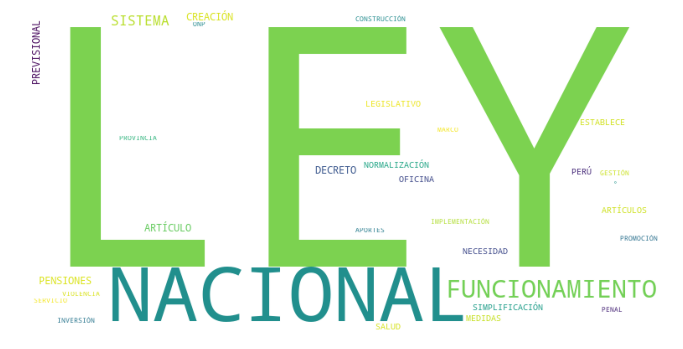

In [ ]:
show_wordcloud(Sus_Tit_Usa, save=True, img_name="WC_Sust_Titulo_Usabilidad")

#### Verbos del título

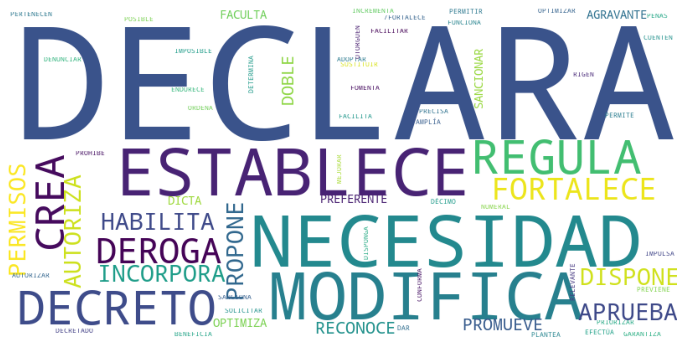

In [ ]:
show_wordcloud(Verb_Tit_Usa, save=True, img_name="WC_Verb_Titulo_Usabilidad")

#### Adjetivos del título

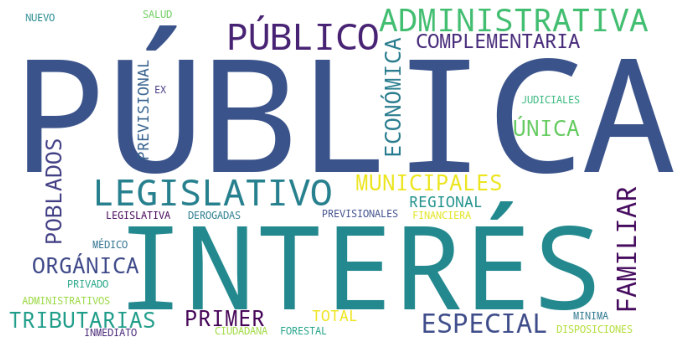

In [ ]:
show_wordcloud(Adj_Tit_Usa, save=True, img_name="WC_Adj_Titulo_Usabilidad")

#### Sustantivos del Objeto

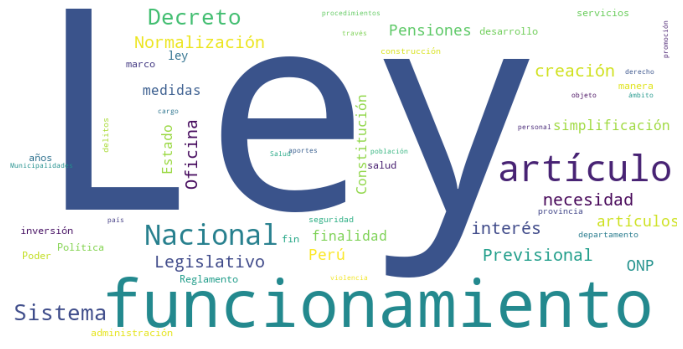

In [ ]:
show_wordcloud(Sus_Obj_Usa, save=True, img_name="WC_Sust_Objeto_Usabilidad")

#### Verbos del Objeto

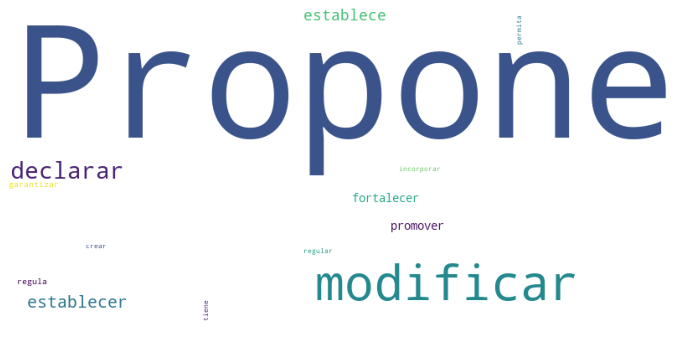

In [ ]:
show_wordcloud(Verb_Obj_Usa, save=True, img_name="WC_Verb_Objeto_Usabilidad")

#### Adjetivos del Objeto

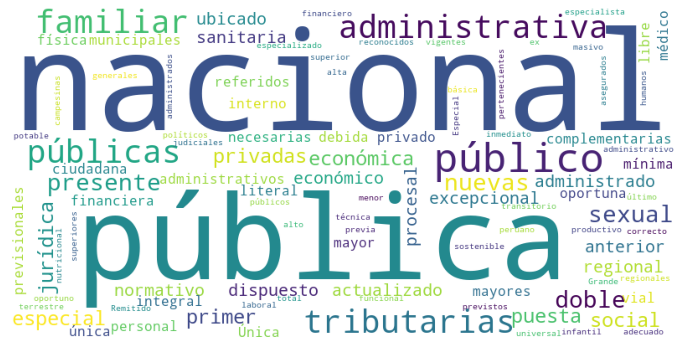

In [ ]:
show_wordcloud(Adj_Obj_Usa, save=True, img_name="WC_Adj_Objeto_Usabilidad")

## TOPICO 5: COMPRENSIBILIDAD

### 1. POS-Tagging usando spacy

In [ ]:
TitulosComprensibilidad,ObjetosComprensibilidad = PosTagging(Comprensibilidad)

### 2. NER usando spacy

In [ ]:
NER(Comprensibilidad)

### 3. Ejemplo específico: Pos tagging y NER

In [ ]:
# Nro de fila aleatorio para mostrar un ejemplo específico
Nro_fila = random.randrange(0,len(Comprensibilidad)-1)

#### Título

In [ ]:
DocComprensibilidad,TitleComprensibilidad = PosTagging_NER_Titulo(Comprensibilidad,Nro_fila)

[('LEY', 'NOUN'), ('QUE', 'SCONJ'), ('DECLARA', 'VERB'), ('DE', 'ADP'), ('NECESIDAD', 'NOUN'), ('PÚBLICA', 'ADJ'), ('Y', 'CONJ'), ('UTILIDAD', 'PROPN'), ('PÚBLICA', 'ADJ'), ('LA', 'DET'), ('EJECUCIÓN', 'NOUN'), ('DEL', 'ADP'), ('PROYECTO', 'PROPN'), ('DE', 'ADP'), ('CONSTRUCCIÓN', 'NOUN'), ('Y', 'CONJ'), ('EQUIPAMIENTO', 'NOUN'), ('DEL', 'ADP'), ('HOSPITAL', 'PROPN'), ('NACIONAL', 'PROPN'), ('ARZOBISPO', 'PROPN'), ('LOAYZA', 'PROPN')]

[('NECESIDAD PÚBLICA Y UTILIDAD PÚBLICA', 'MISC'), ('LA EJECUCIÓN', 'MISC')]
[(LEY, 'O', ''), (QUE, 'O', ''), (DECLARA, 'O', ''), (DE, 'O', ''), (NECESIDAD, 'B', 'MISC'), (PÚBLICA, 'I', 'MISC'), (Y, 'I', 'MISC'), (UTILIDAD, 'I', 'MISC'), (PÚBLICA, 'I', 'MISC'), (LA, 'B', 'MISC'), (EJECUCIÓN, 'I', 'MISC'), (DEL, 'O', ''), (PROYECTO, 'O', ''), (DE, 'O', ''), (CONSTRUCCIÓN, 'O', ''), (Y, 'O', ''), (EQUIPAMIENTO, 'O', ''), (DEL, 'O', ''), (HOSPITAL, 'O', ''), (NACIONAL, 'O', ''), (ARZOBISPO, 'O', ''), (LOAYZA, 'O', '')]


In [ ]:
displacy.render(DocComprensibilidad, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(TitleComprensibilidad), jupyter=True, style='ent')

#### Objeto

In [ ]:
DocComprensibilidad2,ObjetoComprensibilidad = PosTagging_NER_Objeto(Comprensibilidad, Nro_fila)

[('Propone', 'VERB'), ('modificar', 'VERB'), ('el', 'DET'), ('numeral', 'NOUN'), ('3', 'NUM'), ('del', 'ADP'), ('artículo', 'NOUN'), ('171', 'NUM'), ('del', 'ADP'), ('Código', 'PROPN'), ('Procesal', 'PROPN'), ('Penal', 'PROPN'), ('para', 'ADP'), ('establecer', 'AUX'), ('que', 'SCONJ'), ('el', 'DET'), ('testimonio', 'NOUN'), ('de', 'ADP'), ('las', 'DET'), ('niñas', 'NOUN'), (',', 'PUNCT'), ('niños', 'NOUN'), ('y', 'CONJ'), ('adolescentes', 'NOUN'), ('víctimas', 'NOUN'), ('de', 'ADP'), ('violencia', 'NOUN'), ('sexual', 'ADJ'), ('desarrollado', 'ADJ'), ('en', 'ADP'), ('cámara', 'PROPN'), ('gesell', 'PROPN'), ('o', 'CONJ'), ('sala', 'PROPN'), ('de', 'ADP'), ('entrevista', 'NOUN'), ('tenga', 'VERB'), ('la', 'DET'), ('calidad', 'NOUN'), ('de', 'ADP'), ('prueba', 'NOUN'), ('preconstituida', 'ADJ'), (',', 'PUNCT'), ('en', 'ADP'), ('concordancia', 'NOUN'), ('con', 'ADP'), ('el', 'DET'), ('artículo', 'NOUN'), ('19', 'NUM'), ('de', 'ADP'), ('la', 'DET'), ('Ley', 'PROPN'), ('30364', 'NUM'), (',', 

In [ ]:
displacy.render(DocComprensibilidad2, style='dep', jupyter=True, options={'distance': 120})

In [ ]:
displacy.render(nlp(ObjetoComprensibilidad), jupyter=True, style='ent')

### 4. Nube de palabras

In [ ]:
Sus_Tit_Comp, Verb_Tit_Comp, Adj_Tit_Comp = diccionarios_para_nubes(TitulosComprensibilidad)
Sus_Obj_Comp, Verb_Obj_Comp, Adj_Obj_Comp = diccionarios_para_nubes(ObjetosComprensibilidad)

#### Sustantivos del título

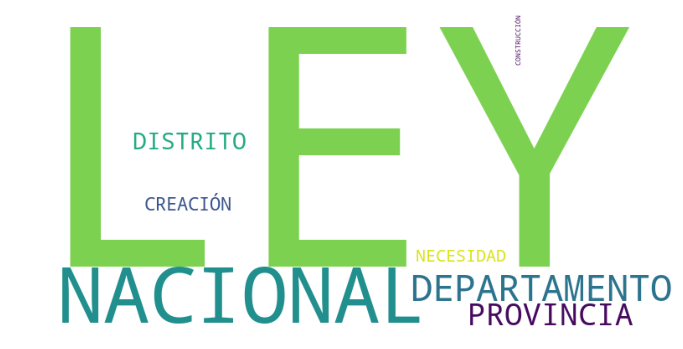

In [ ]:
show_wordcloud(Sus_Tit_Comp, save=True, img_name="WC_Sust_Titulo_Comprensibilidad")

#### Verbos del título

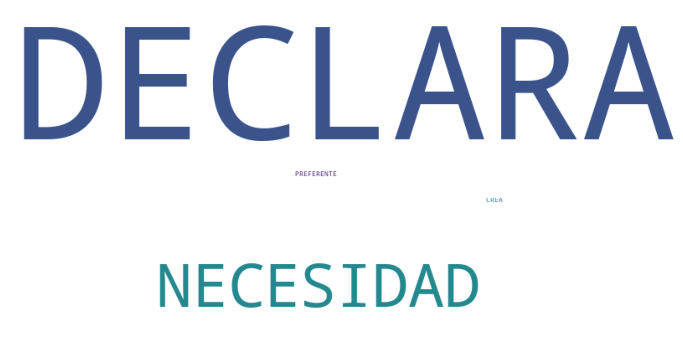

In [ ]:
show_wordcloud(Verb_Tit_Comp, save=True, img_name="WC_Verb_Titulo_Comprensibilidad")

#### Adjetivos del título

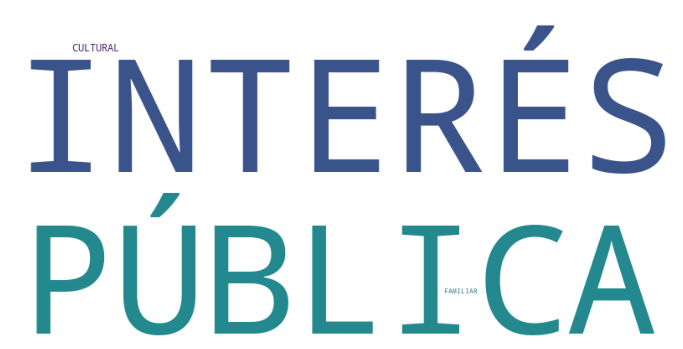

In [ ]:
show_wordcloud(Adj_Tit_Comp, save=True, img_name="WC_Adj_Titulo_Comprensibilidad")

#### Sustantivos del Objeto

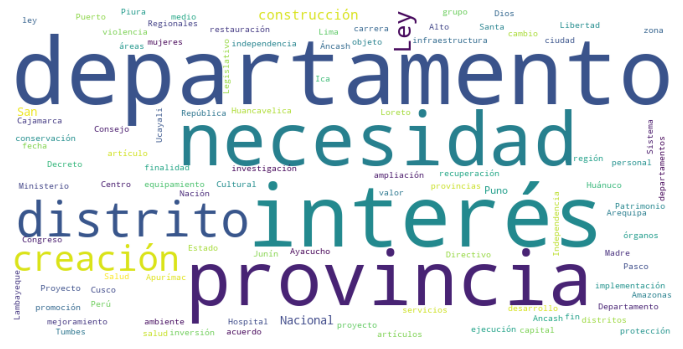

In [ ]:
show_wordcloud(Sus_Obj_Comp, save=True, img_name="WC_Sust_Objeto_Comprensibilidad")

#### Verbos del Objeto

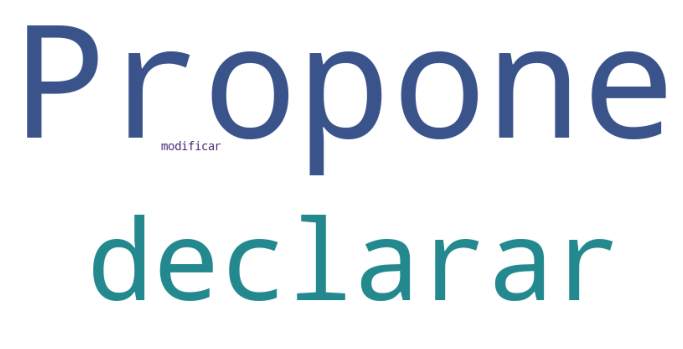

In [ ]:
show_wordcloud(Verb_Obj_Comp, save=True, img_name="WC_Verb_Objeto_Comprensibilidad")

#### Adjetivos del Objeto

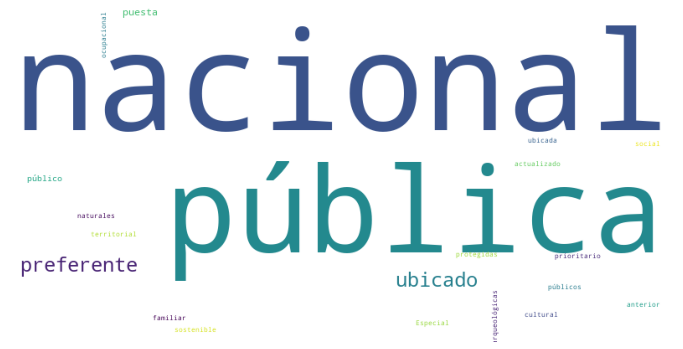

In [ ]:
show_wordcloud(Adj_Obj_Comp, save=True, img_name="WC_Adj_Objeto_Comprensibilidad")

# Otros

In [ ]:
# CREAMOS LA NUBE DE PALABRAS Y LA GUARDAMOS
def draw_wordcloud(Dic, img_name=None):
  url_save_png = img_name + ".png"

  sc.gen_stylecloud(
      text= Dic,
      colors=['#ecf0f1', '#3498db', '#e74c3c'],
      icon_name='fas fa-cloud',
      background_color='#1A1A1A',
      output_name = url_save_png,
      size = 2048,
      max_words = 300,
      max_font_size = 450
       )
  img = Image.open(img_name + ".png",'r')
  img.show()

In [ ]:
def show_wordcloud(Dic, save=False, img_name=None):
  wordcloud = WordCloud(
    background_color = 'white',
    max_words = 1000,
    relative_scaling = 1,
    scale = 3,
    random_state=1,
    collocations=False
  ).generate_from_frequencies(Dic)
  fig = plt.figure(1, figsize=(12, 12))
  plt.axis('off')
  plt.imshow(wordcloud)
  if save: plt.savefig(img_name)
  plt.show()

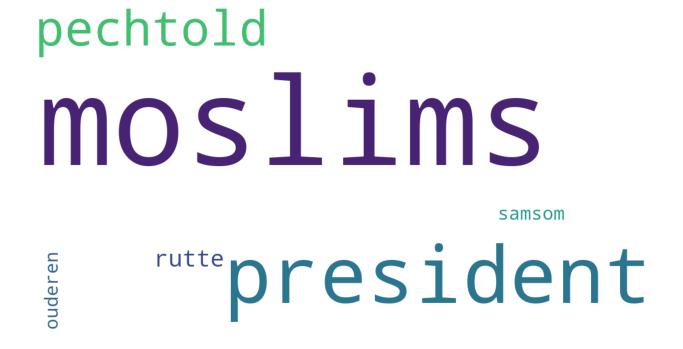

In [ ]:
dictionary= {'asielzoekers': 0.0034861170591325486,
 'belastingverlaging': 0.0018551991553514675,
 'buma': 0.0020712555982839408,
 'islam': 0.0029519544163739155,
 'moslims': 25,
 'ouderen': 4,
 'pechtold': 10,
 'president': 16,
 'rutte': 5,
 'samsom': 4} 

show_wordcloud(dictionary, save=True, img_name="nn")

In [ ]:
draw_wordcloud(dictionary, img_name="nuu")

### 2. Pos Tagging usando la librería nltk

In [ ]:
java_path = "/usr/lib/jvm/java-11-openjdk-amd64/bin"
os.environ['JAVAHOME'] = java_path
spanish_postagger = StanfordPOSTagger('spanish.tagger', 
                                      'stanford-postagger.jar')

with open("spanish-tags.json", "r") as r:
    spanish_tags = json.load(r)

for row in rows:
  pt_titulo = []
  for i in range(len(row)):
    if i == 0:
      print(row[i])
      tags = spanish_postagger.tag(row[i].split())
      for token, tag in tags:
        print(f"{token:15} -> {spanish_tags[tag]['description']}")
    if i == 1:
      print(row[i])
      tags = spanish_postagger.tag(row[i].split())
      for token, tag in tags:
        if (tag in spanish_tags):
          print(f"{token:15} -> {spanish_tags[tag]['description']}")
        else:
          print(f"{token:15} -> {tag}")
  print(" ")